In [3]:
!pip install nibabel h5py

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 50.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 132.0 MB/s eta 0:00:00


In [2]:
import os
import zipfile

In [3]:
import os

# Local paths on SageMaker EBS
local_ct_path = "/home/ec2-user/SageMaker/Abdomen/RawData/Training/img"
local_seg_path = "/home/ec2-user/SageMaker/Abdomen/RawData/Training/label"
local_save_train_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"
local_save_test_path = "/home/ec2-user/SageMaker/Abdomen/test_h5"


In [4]:
import nibabel as nib
import numpy as np
from scipy.ndimage import zoom
from tqdm import tqdm
import os
import gc

In [5]:
def process_training_data(ct_path, seg_path, save_path):
    """
    Process training CT images and labels, resize to 256x256, and save as .npz.
    """
    ct_files = sorted([f for f in os.listdir(ct_path) if f.endswith('.nii.gz')])
    upper = 275
    lower = -125

    for ct_file in tqdm(ct_files, desc='Processing training data'):
        try:
            # Load CT scan and segmentation
            ct = nib.load(os.path.join(ct_path, ct_file))
            seg_file = ct_file.replace('img', 'label')
            seg = nib.load(os.path.join(seg_path, seg_file))

            # Convert to numpy arrays
            ct_array = ct.get_fdata()
            seg_array = seg.get_fdata()

            # Normalize and clip CT data
            ct_array = np.clip(ct_array, lower, upper)
            ct_array = (ct_array - lower) / (upper - lower)

            # Transpose to (slices, height, width)
            ct_array = np.transpose(ct_array, (2, 0, 1))
            seg_array = np.transpose(seg_array, (2, 0, 1))

            # Resize to 256x256
            resized_ct_array = np.array([zoom(slice, (256 / slice.shape[0], 256 / slice.shape[1]), order=3) for slice in ct_array])
            resized_seg_array = np.array([zoom(slice, (256 / slice.shape[0], 256 / slice.shape[1]), order=0) for slice in seg_array])

            # Save each slice locally
            os.makedirs(save_path, exist_ok=True)
            ct_number = ct_file.replace('img', 'case').split('.')[0]
            for s_idx in range(resized_ct_array.shape[0]):
                new_file_name = f"{ct_number}_slice{s_idx:03d}.npz"
                np.savez(os.path.join(save_path, new_file_name), image=resized_ct_array[s_idx], label=resized_seg_array[s_idx])

        except Exception as e:
            print(f"Error processing {ct_file}: {e}")
        gc.collect()

# Process training data
process_training_data(local_ct_path, local_seg_path, local_save_train_path)


Processing training data: 100%|██████████| 30/30 [01:46<00:00,  3.55s/it]


In [6]:

import h5py

# Local paths on SageMaker EBS
local_test_ct_path = "/home/ec2-user/SageMaker/Abdomen/RawData/Testing/img"
local_save_test_path = "/home/ec2-user/SageMaker/Abdomen/test_h5"

def process_testing_data(ct_path, save_path):
    """
    Process testing CT images, resize to 256x256, and save as .h5 files.
    """
    os.makedirs(save_path, exist_ok=True)  # Ensure the output directory exists
    ct_files = sorted([f for f in os.listdir(ct_path) if f.endswith('.nii.gz')])
    upper = 275
    lower = -125

    for ct_file in tqdm(ct_files, desc='Processing testing data'):
        try:
            # Load CT scan
            ct = nib.load(os.path.join(ct_path, ct_file))
            ct_array = ct.get_fdata()

            # Normalize and clip CT data
            ct_array = np.clip(ct_array, lower, upper)
            ct_array = (ct_array - lower) / (upper - lower)

            # Transpose to (slices, height, width)
            ct_array = np.transpose(ct_array, (2, 0, 1))

            # Resize to 256x256
            resized_ct_array = np.array([zoom(slice, (256 / slice.shape[0], 256 / slice.shape[1]), order=3) for slice in ct_array])

            # Save to .h5 file
            save_file = os.path.join(save_path, f"{os.path.splitext(ct_file)[0]}.h5")
            with h5py.File(save_file, 'w') as hf:
                hf.create_dataset('image', data=resized_ct_array)

        except Exception as e:
            print(f"Error processing {ct_file}: {e}")
        gc.collect()

# Process testing data
process_testing_data(local_test_ct_path, local_save_test_path)



Processing testing data: 100%|██████████| 20/20 [02:19<00:00,  6.96s/it]


In [7]:
# Local paths on SageMaker EBS
local_save_train_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"
output_txt_file = "/home/ec2-user/SageMaker/Abdomen/lists_Synapse/train.txt"

# Generate the train.txt file
os.makedirs(os.path.dirname(output_txt_file), exist_ok=True)  # Ensure the directory exists
with open(output_txt_file, 'w') as f:
    for file in sorted(os.listdir(local_save_train_path)):
        if file.endswith('.npz'):
            f.write(file.replace('.npz', '') + '\n')
print(f"Generated {output_txt_file}")



Generated /home/ec2-user/SageMaker/Abdomen/lists_Synapse/train.txt


In [1]:
import os

def generate_test_vol_txt(data_dir, output_file):
    """
    Generate a .txt file containing filenames (without extensions)
    for the test dataset.
    """
    # List all .h5 files in the directory
    files = [f for f in os.listdir(data_dir) if f.endswith('.h5')]
    files = sorted(files)  # Optional: Sort the files alphabetically
    
    # Remove extensions and write to the .txt file
    with open(output_file, 'w') as f:
        for file in files:
            file_base = os.path.splitext(file)[0]
            f.write(f"{file_base}\n")

    print(f"{output_file} generated with {len(files)} entries.")

# Define paths
test_h5_dir = "/home/ec2-user/SageMaker/Abdomen/test_h5"
output_txt_path = "/home/ec2-user/SageMaker/Abdomen/lists_Synapse/test_vol.txt"

# Generate the test_vol.txt
generate_test_vol_txt(test_h5_dir, output_txt_path)


/home/ec2-user/SageMaker/Abdomen/lists_Synapse/test_vol.txt generated with 20 entries.


Matplotlib is building the font cache; this may take a moment.


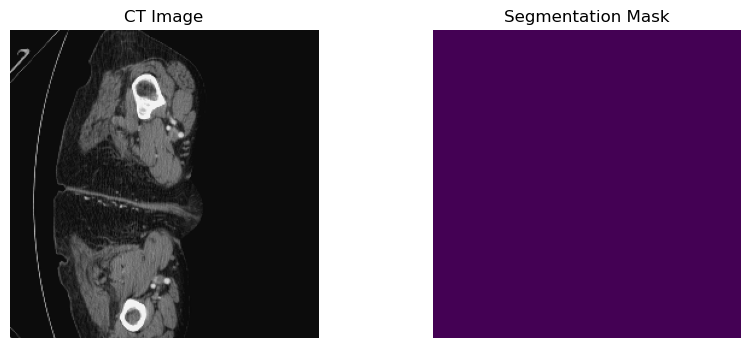

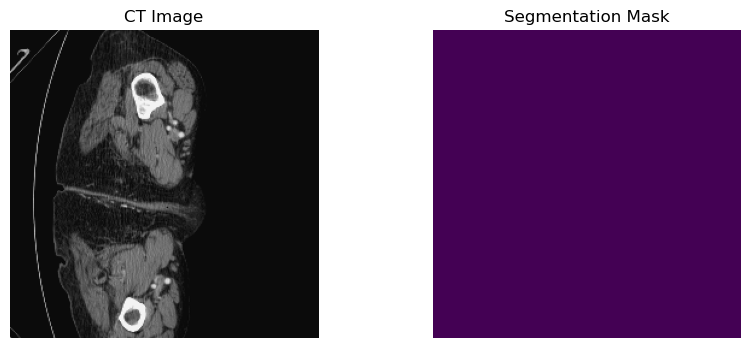

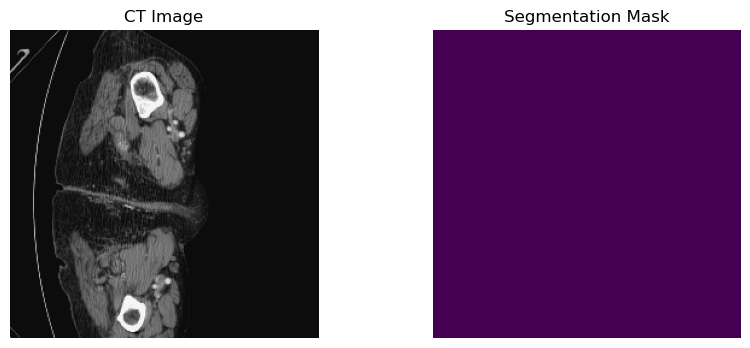

In [8]:
import matplotlib.pyplot as plt

def visualize_preprocessed_samples(data_path, num_samples=3):
    files = sorted(os.listdir(data_path))
    npz_files = [f for f in files if f.endswith('.npz')]
    
    for sample_file in npz_files[:num_samples]:
        data = np.load(os.path.join(data_path, sample_file))
        image = data['image']
        label = data['label'] if 'label' in data else None
        
        plt.figure(figsize=(10, 4))
        plt.subplot(1, 2, 1)
        plt.imshow(image, cmap='gray')
        plt.title('CT Image')
        plt.axis('off')

        if label is not None:
            plt.subplot(1, 2, 2)
            plt.imshow(label, cmap='viridis')
            plt.title('Segmentation Mask')
            plt.axis('off')
        plt.show()

train_data_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"
visualize_preprocessed_samples(train_data_path)


In [33]:
import os
import random
import h5py
import numpy as np
import torch
from scipy import ndimage
from scipy.ndimage import zoom
from torch.utils.data import Dataset
from torchvision import transforms

# Data augmentation and resizing function
def random_rot_flip(image, label):
    """Randomly rotate and flip the image and label."""
    k = np.random.randint(0, 4)
    image = np.rot90(image, k)
    label = np.rot90(label, k)
    axis = np.random.randint(0, 2)
    image = np.flip(image, axis=axis).copy()
    label = np.flip(label, axis=axis).copy()
    return image, label

def random_rotate(image, label):
    """Randomly rotate the image and label."""
    angle = np.random.randint(-20, 20)
    image = ndimage.rotate(image, angle, order=0, reshape=False)
    label = ndimage.rotate(label, angle, order=0, reshape=False)
    return image, label

class RandomGenerator(object):
    """Data augmentation and resizing."""
    def __init__(self, output_size):
        self.output_size = output_size

    def __call__(self, sample):
        image, label = sample['image'], sample['label']

        # Apply random rotation and flip
        if random.random() > 0.5:
            image, label = random_rot_flip(image, label)
        elif random.random() > 0.5:
            image, label = random_rotate(image, label)
        
        # Rescale to the desired output size (256x256)
        x, y = image.shape
        if x != self.output_size[0] or y != self.output_size[1]:
            image = zoom(image, (self.output_size[0] / x, self.output_size[1] / y), order=3)
            label = zoom(label, (self.output_size[0] / x, self.output_size[1] / y), order=0)
        
        # Add channel dimension to image
        image = torch.from_numpy(image.astype(np.float32)).unsqueeze(0)  # Shape: [1, 256, 256]
        label = torch.from_numpy(label.astype(np.float32))  # Shape: [256, 256]
        return {'image': image, 'label': label.long()}

class SynapseDataset(Dataset):
    def __init__(self, base_dir, list_dir, split, file_extension="h5", transform=None):
        """
        Dataset class for Synapse test data.

        Args:
            base_dir (str): Directory containing the test data.
            list_dir (str): Directory containing the split text files.
            split (str): Split to load (e.g., 'test_vol').
            file_extension (str): Extension of the test files (default: 'h5').
            transform (callable): Optional transform to be applied to each sample.
        """
        self.transform = transform
        self.split = split
        self.file_extension = file_extension
        self.sample_list = open(os.path.join(list_dir, f"{split}.txt")).readlines()
        self.data_dir = base_dir

    def __len__(self):
        return len(self.sample_list)

    def __getitem__(self, idx):
        slice_name = self.sample_list[idx].strip("\n")
        data_path = os.path.join(self.data_dir, f"{slice_name}.{self.file_extension}")

        if self.file_extension == "h5":
            with h5py.File(data_path, "r") as h5_file:
                image = h5_file["image"][:]  # Load 3D image array

            # Select the middle slice of a 3D image
            slice_idx = image.shape[0] // 2
            image_slice = image[slice_idx, :, :]

            # Normalize and add channel dimension
            image_slice = image_slice / 255.0
            image_slice = np.expand_dims(image_slice, axis=0)  # Add channel dimension
        else:
            raise ValueError("Unsupported file type for testing")

        sample = {"image": torch.from_numpy(image_slice.astype(np.float32))}
        return sample




# DataLoader Code
from torch.utils.data import DataLoader
from torchvision import transforms


# Define test paths
test_data_dir = "/home/ec2-user/SageMaker/Abdomen/test_h5"
list_dir = "/home/ec2-user/SageMaker/Abdomen/lists_Synapse"
test_save_results_dir = "/home/ec2-user/SageMaker/Abdomen/test_predictions"

# Load the test dataset
test_dataset = SynapseDataset(
    base_dir=test_data_dir,
    list_dir=list_dir,
    split="test_vol",
    file_extension="h5"  # Explicitly specify the file type
)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Ensure test loader outputs are correct
for batch in test_loader:
    images = batch["image"]
    print("Batch image shape:", images.shape)  # Should be [batch_size, 1, 256, 256]
    break


Batch image shape: torch.Size([1, 1, 256, 256])



File: img0074.nii.h5
Shape of the image data: (86, 256, 256)


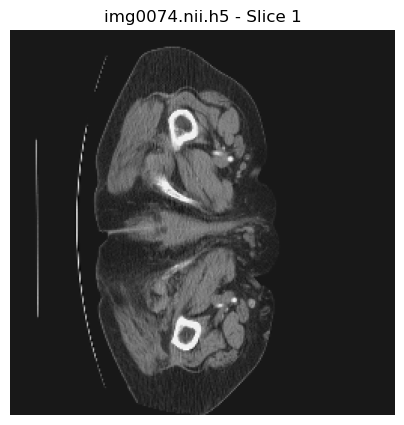

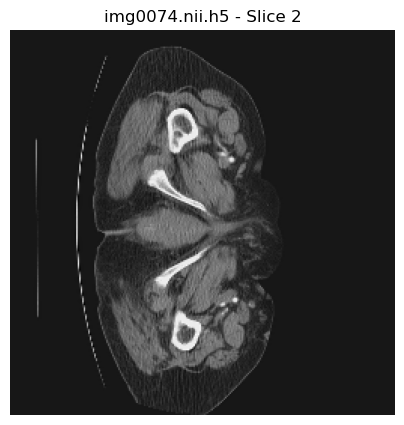

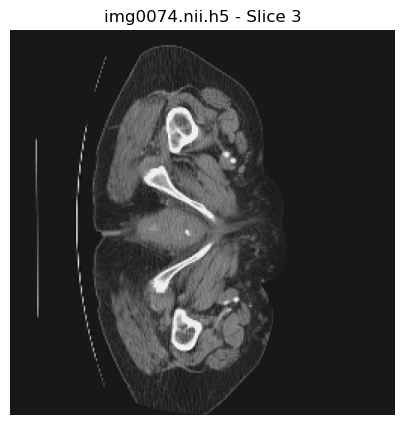


File: img0067.nii.h5
Shape of the image data: (173, 256, 256)


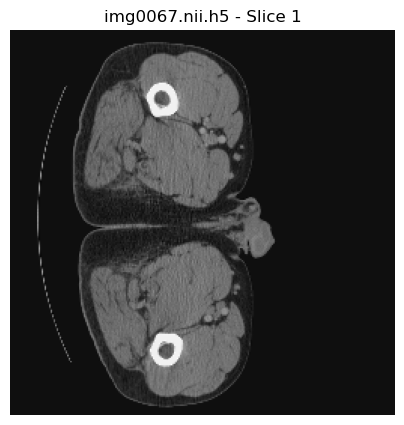

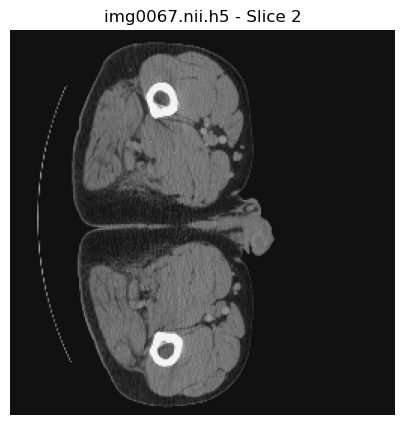

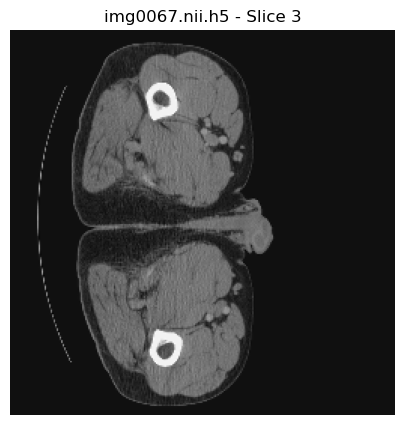


File: img0076.nii.h5
Shape of the image data: (113, 256, 256)


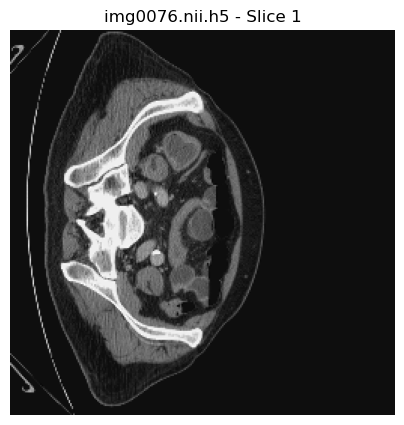

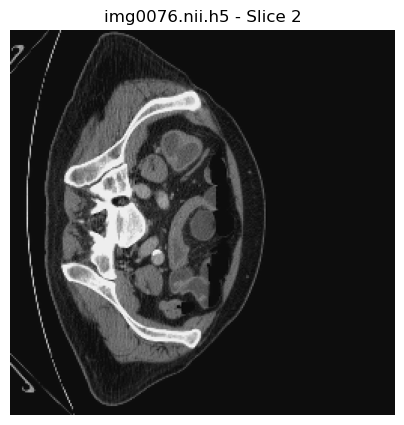

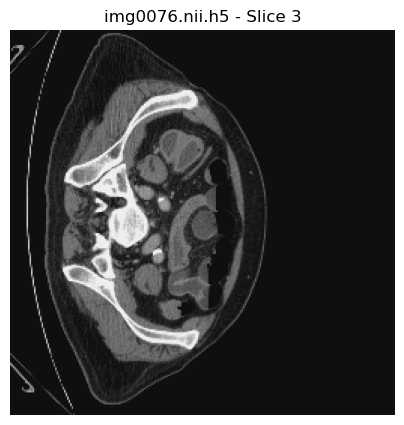


File: img0072.nii.h5
Shape of the image data: (152, 256, 256)


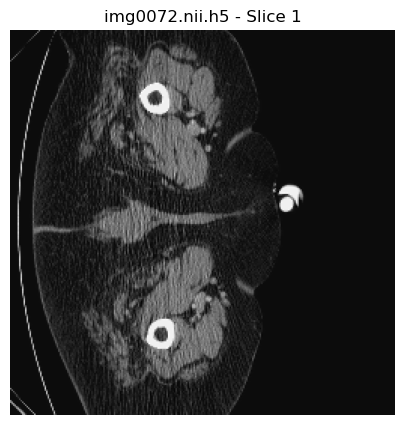

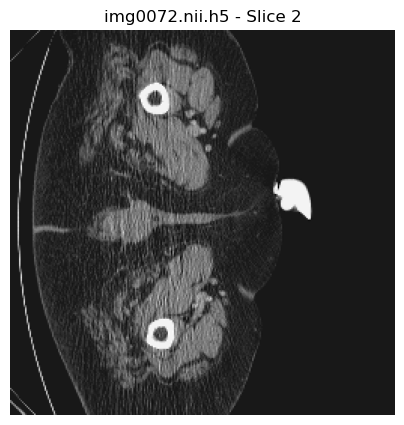

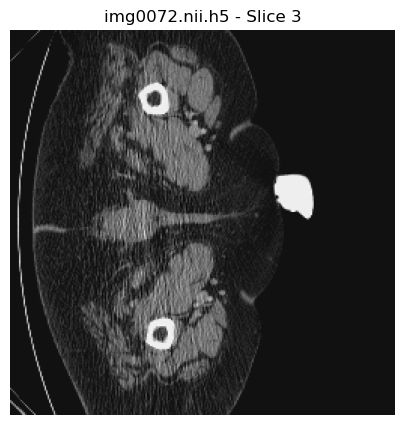


File: img0075.nii.h5
Shape of the image data: (93, 256, 256)


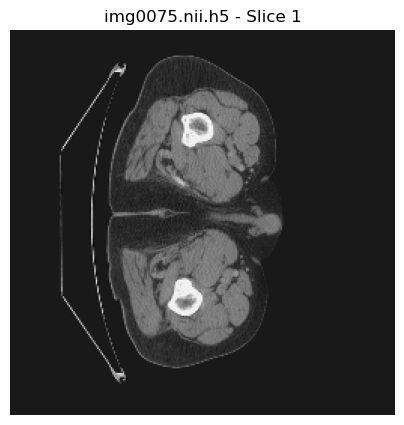

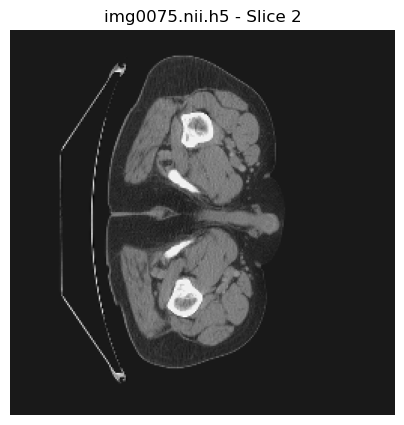

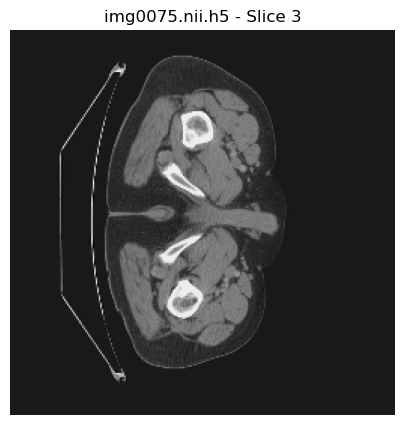


File: img0073.nii.h5
Shape of the image data: (130, 256, 256)


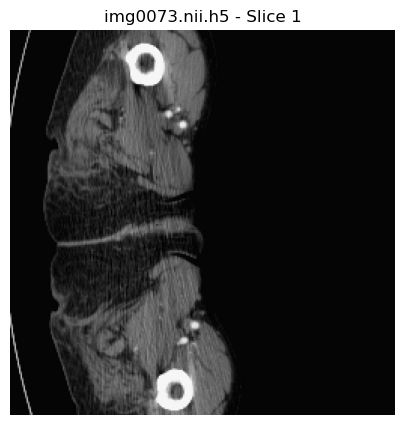

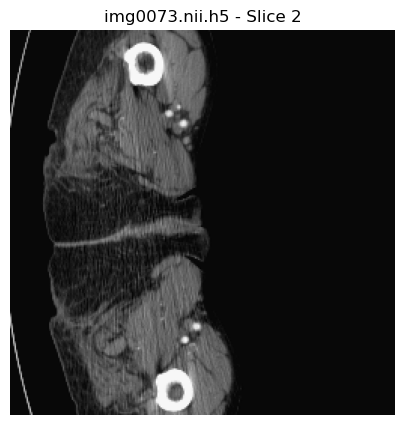

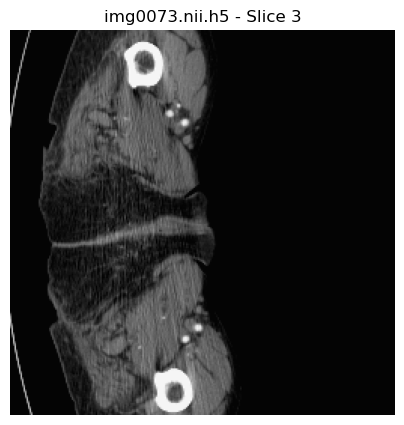


File: img0062.nii.h5
Shape of the image data: (90, 256, 256)


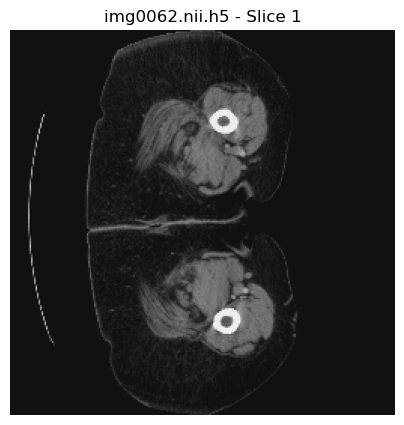

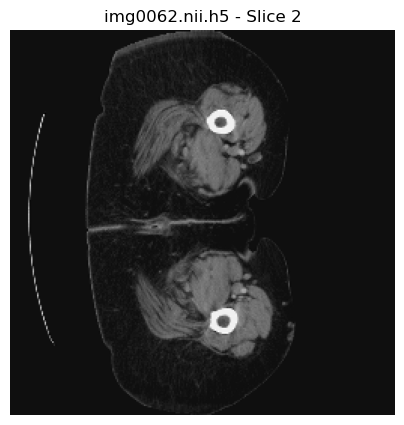

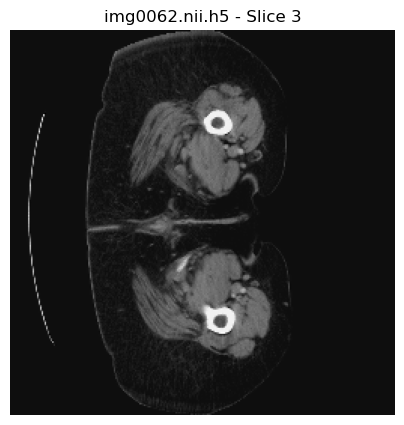


File: img0070.nii.h5
Shape of the image data: (120, 256, 256)


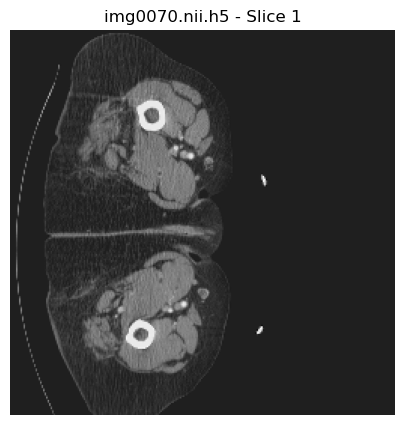

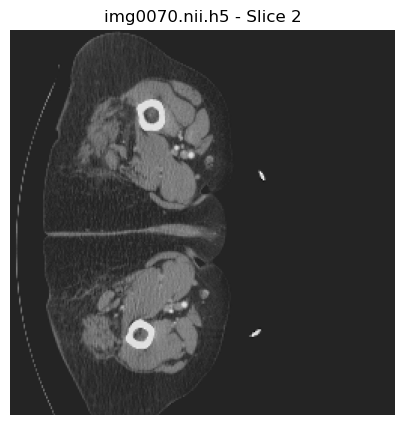

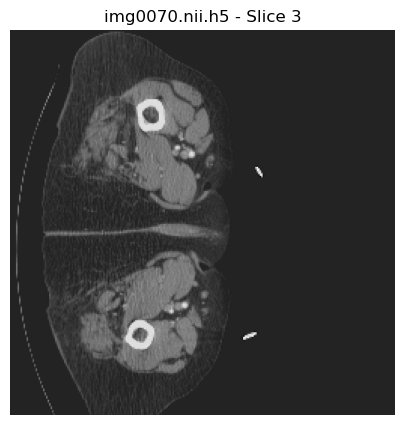


File: img0071.nii.h5
Shape of the image data: (110, 256, 256)


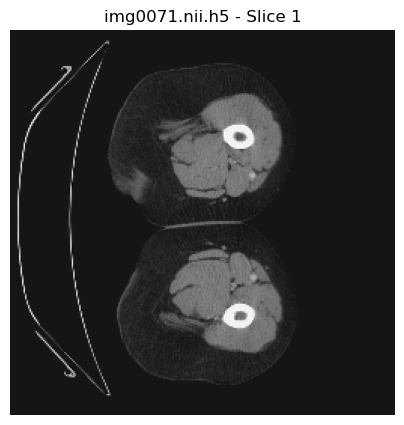

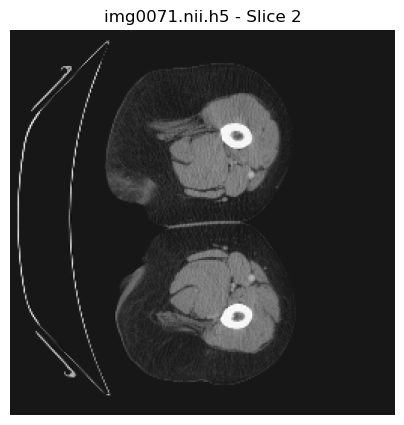

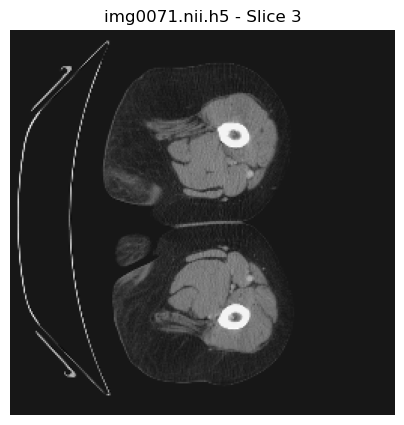


File: img0064.nii.h5
Shape of the image data: (159, 256, 256)


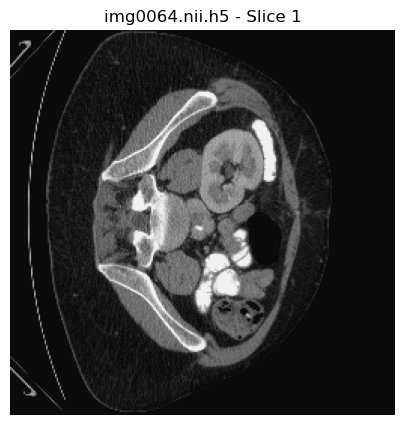

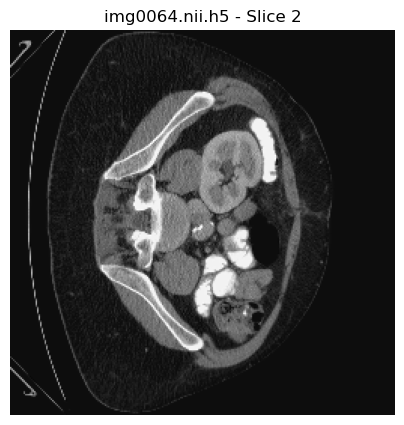

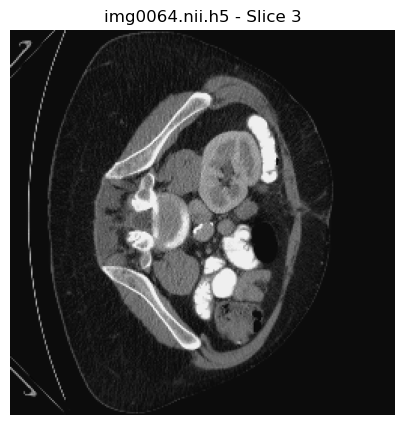


File: img0080.nii.h5
Shape of the image data: (95, 256, 256)


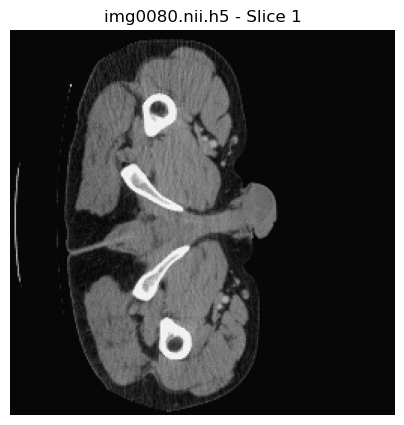

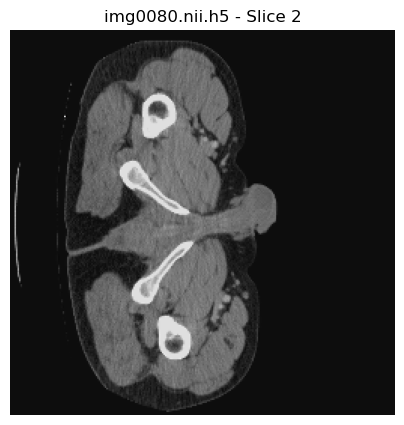

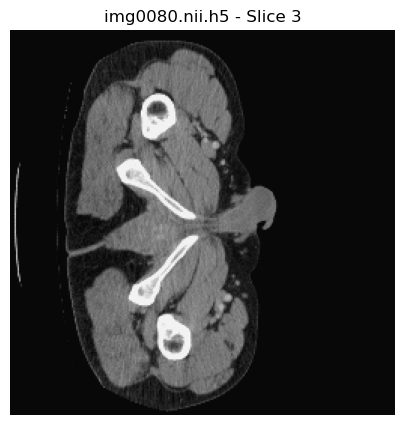


File: img0065.nii.h5
Shape of the image data: (152, 256, 256)


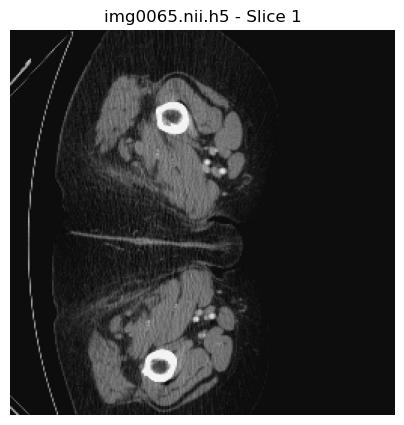

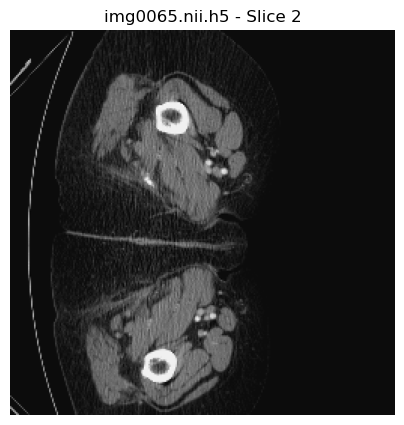

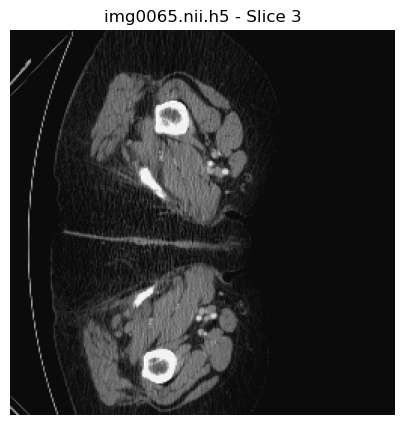


File: img0069.nii.h5
Shape of the image data: (97, 256, 256)


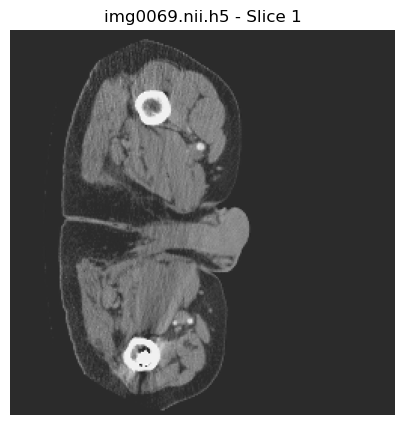

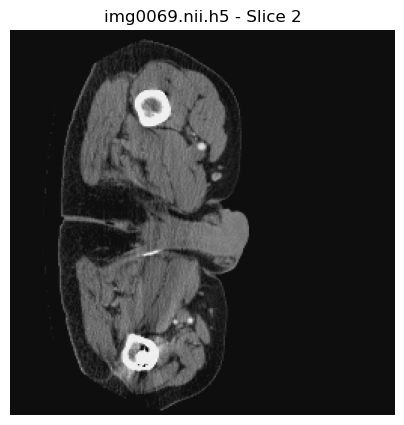

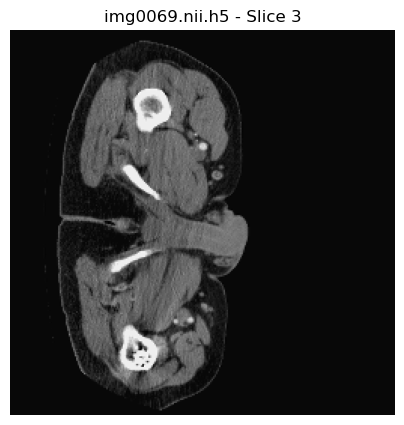


File: img0077.nii.h5
Shape of the image data: (151, 256, 256)


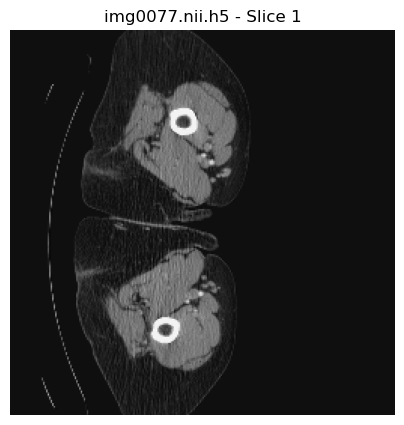

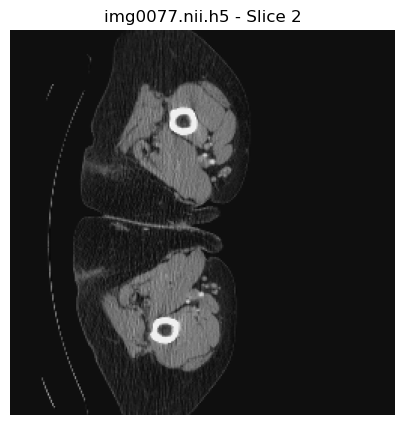

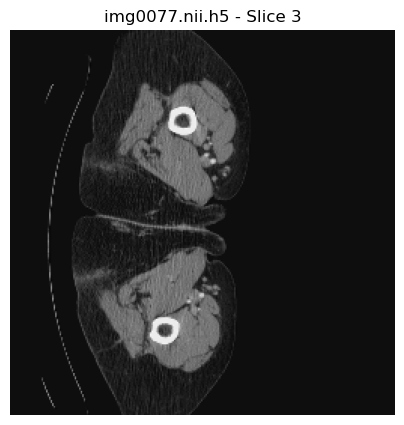


File: img0066.nii.h5
Shape of the image data: (171, 256, 256)


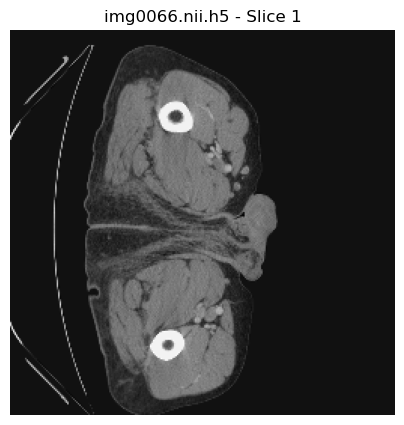

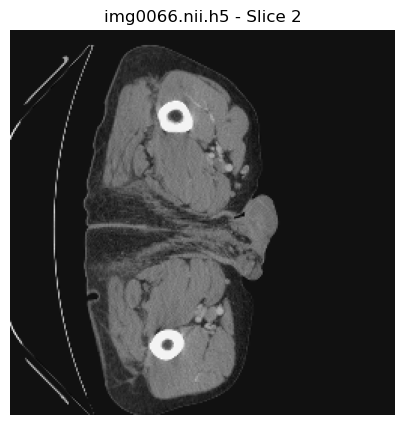

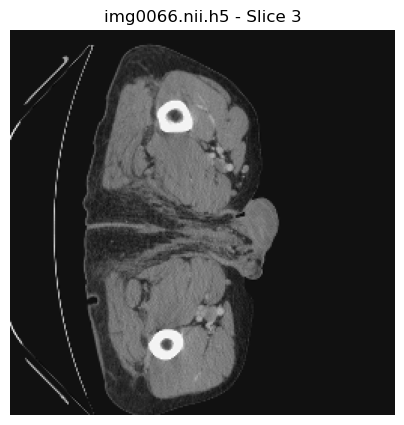


File: img0063.nii.h5
Shape of the image data: (95, 256, 256)


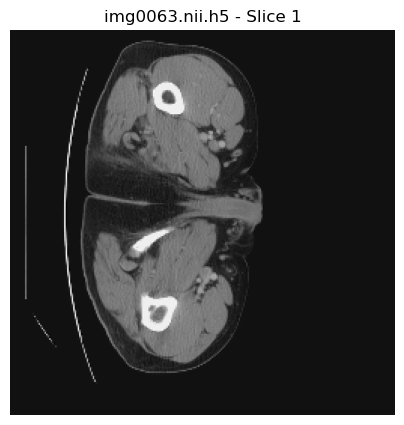

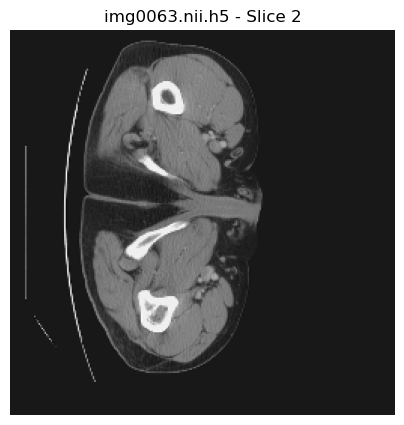

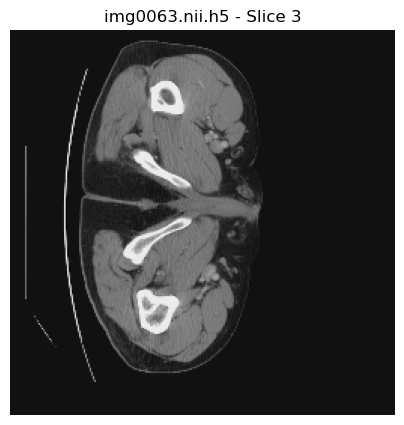


File: img0078.nii.h5
Shape of the image data: (89, 256, 256)


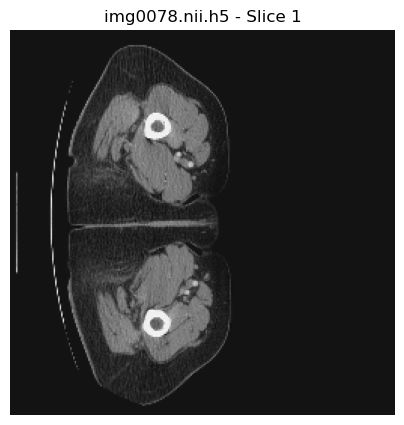

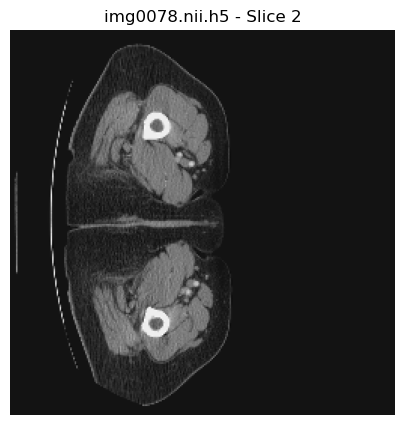

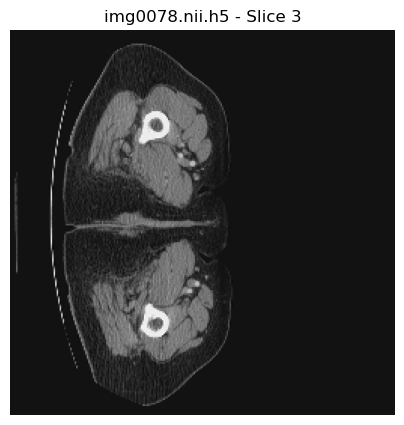


File: img0068.nii.h5
Shape of the image data: (86, 256, 256)


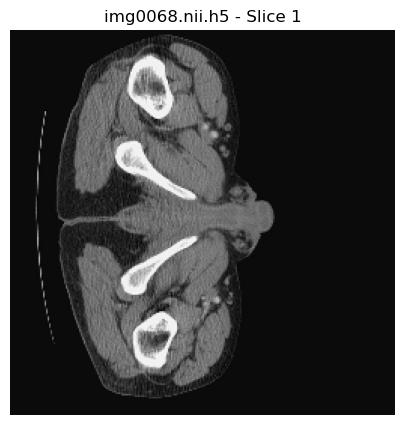

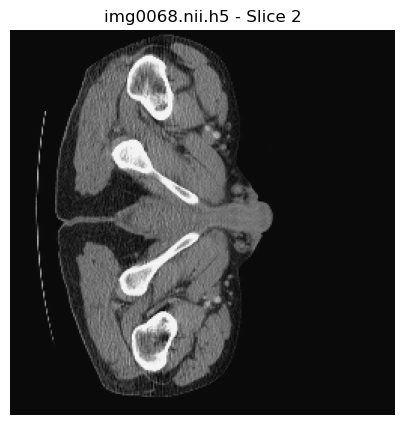

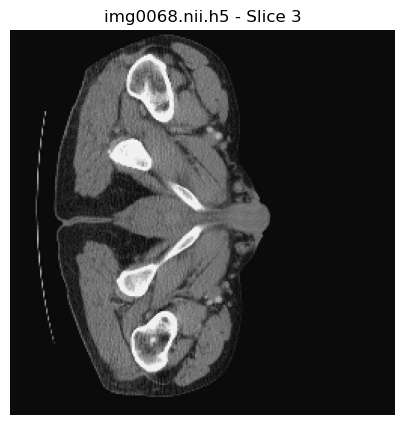


File: img0079.nii.h5
Shape of the image data: (87, 256, 256)


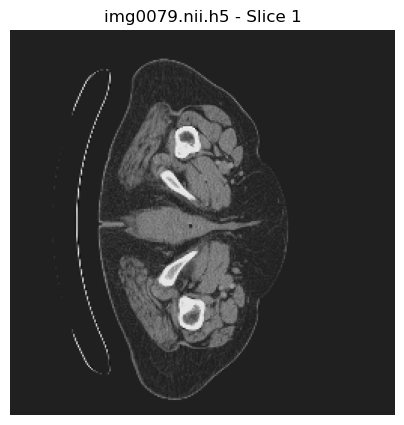

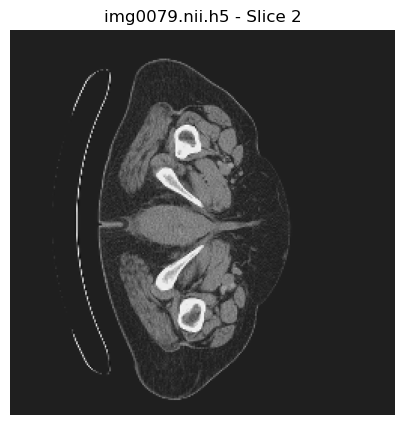

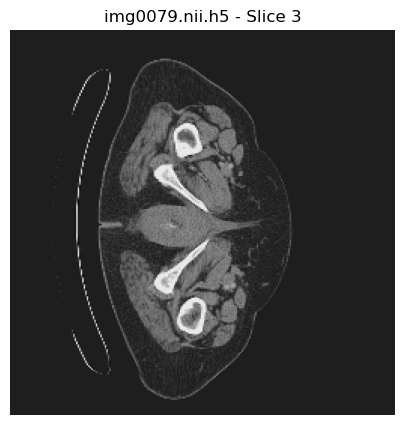


File: img0061.nii.h5
Shape of the image data: (138, 256, 256)


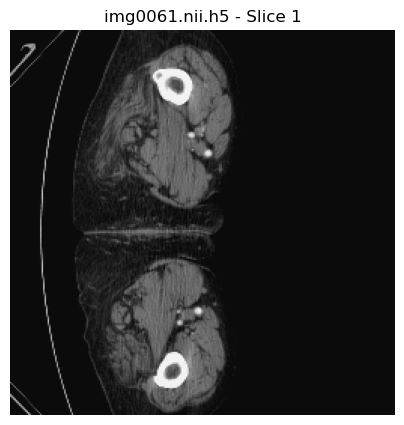

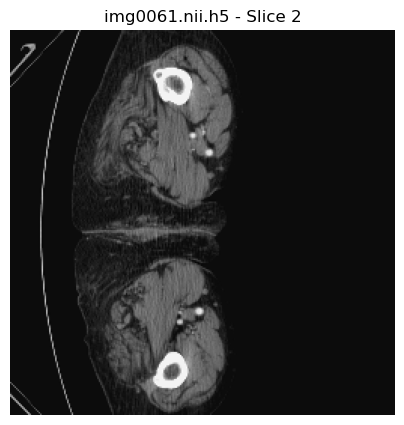

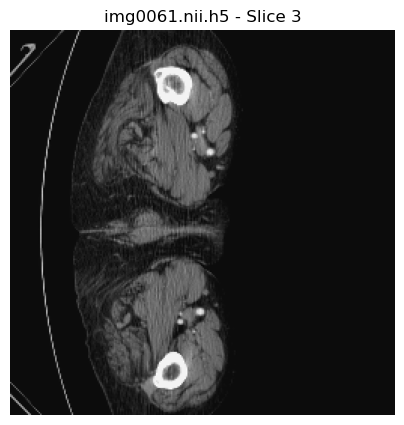

In [10]:
import os
import h5py
import numpy as np
import matplotlib.pyplot as plt

def check_and_visualize_test_images(data_path, num_slices=3):
    """
    Function to check the dimensions of testing images stored in .h5 files and visualize slices.
    """
    # List all .h5 files in the specified directory
    files = [f for f in os.listdir(data_path) if f.endswith('.h5')]
    if len(files) == 0:
        print(f"No .h5 files found in directory: {data_path}")
        return
    
    # Loop through all the .h5 files
    for file in files:
        file_path = os.path.join(data_path, file)
        with h5py.File(file_path, 'r') as hf:
            # Load the image dataset from the .h5 file
            ct_array = hf['image'][:]
            
            # Print the dimensions of the images
            print(f"\nFile: {file}")
            print(f"Shape of the image data: {ct_array.shape}")
            
            # Check if the images are resized to 256x256
            if ct_array.shape[1:] != (256, 256):
                print(f"Warning: Images in {file} are not 256x256!")
            
            # Visualize a few slices
            for slice_idx in range(min(num_slices, ct_array.shape[0])):
                image = ct_array[slice_idx]
                plt.figure(figsize=(5, 5))
                plt.imshow(image, cmap='gray')
                plt.title(f'{file} - Slice {slice_idx + 1}')
                plt.axis('off')
                plt.show()

# Example usage
test_data_path = "/home/ec2-user/SageMaker/Abdomen/test_h5"
check_and_visualize_test_images(test_data_path, num_slices=3)


Looking for files in directory: /home/ec2-user/SageMaker/Abdomen/train_npz

Visualizing case0001_slice000.npz:
Image min: -0.05261337682100119, max: 1.056702752531325, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


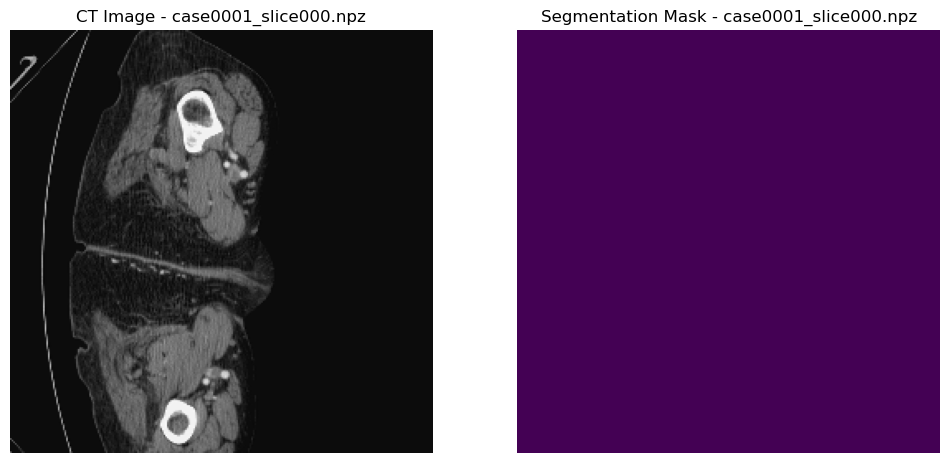


Visualizing case0001_slice001.npz:
Image min: -0.04922728888995011, max: 1.0529472494219956, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


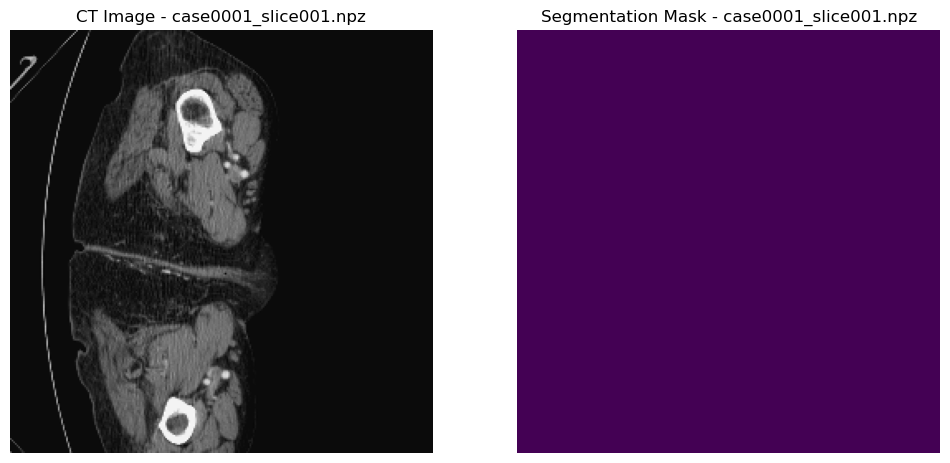


Visualizing case0001_slice002.npz:
Image min: -0.05222977028215978, max: 1.046298415127108, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


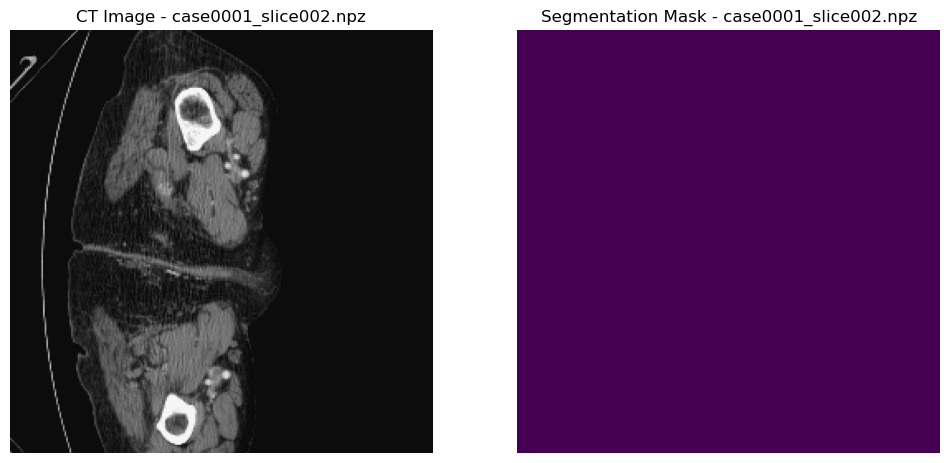


Visualizing case0001_slice003.npz:
Image min: -0.05059776049334747, max: 1.046053803431346, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


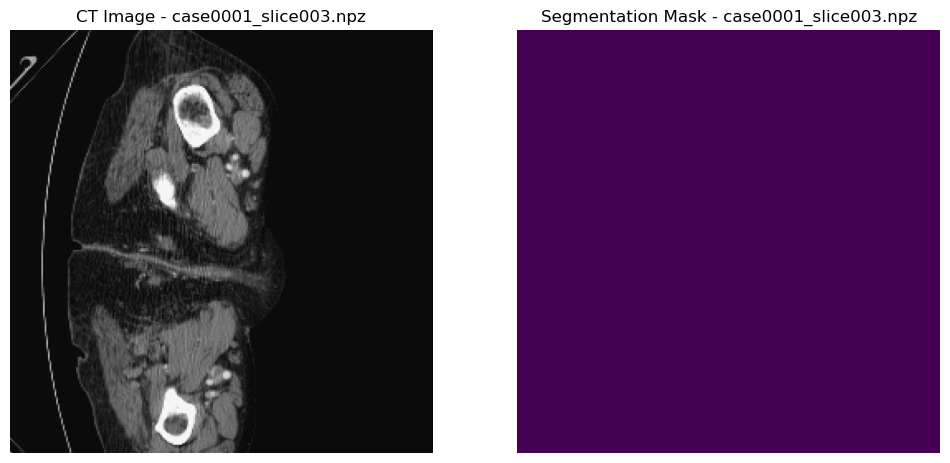


Visualizing case0001_slice004.npz:
Image min: -0.05098542336804116, max: 1.0485025075668661, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


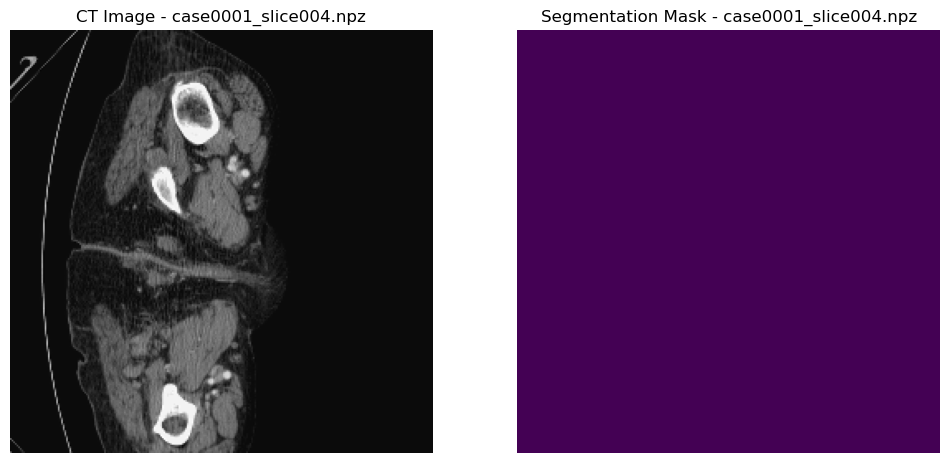


Visualizing case0001_slice005.npz:
Image min: -0.05259478895488411, max: 1.0542226580836542, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


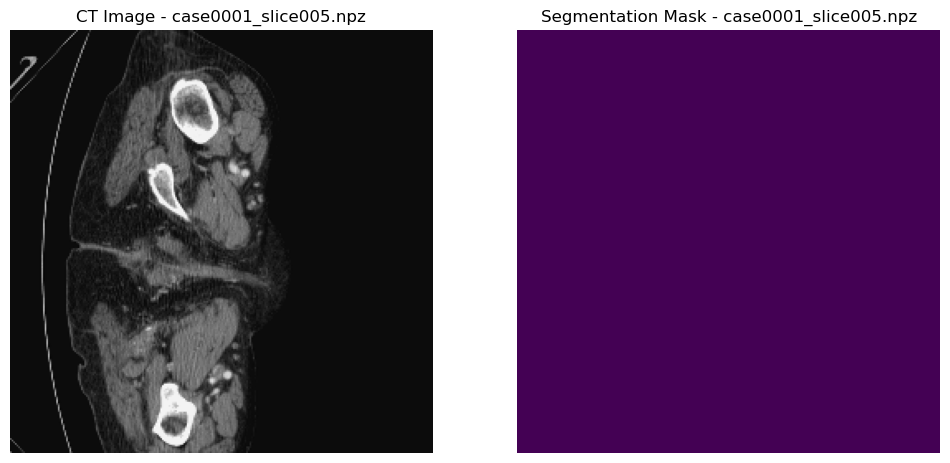


Visualizing case0001_slice006.npz:
Image min: -0.053705755038614585, max: 1.058438316588383, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


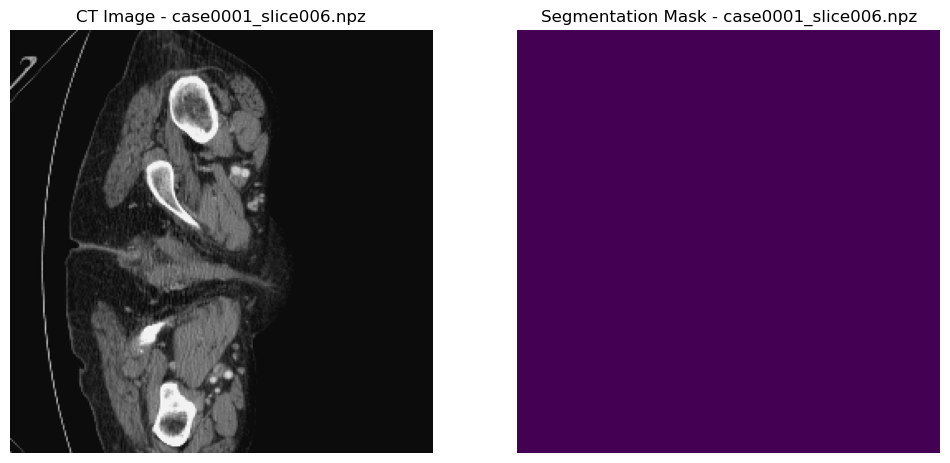


Visualizing case0001_slice007.npz:
Image min: -0.051302066613330234, max: 1.0620301810636943, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


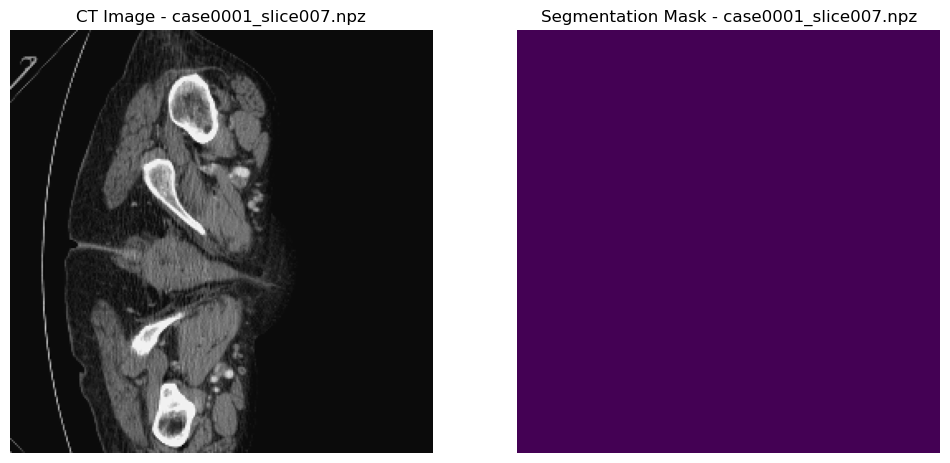


Visualizing case0001_slice008.npz:
Image min: -0.0549129204605299, max: 1.0530156454793345, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


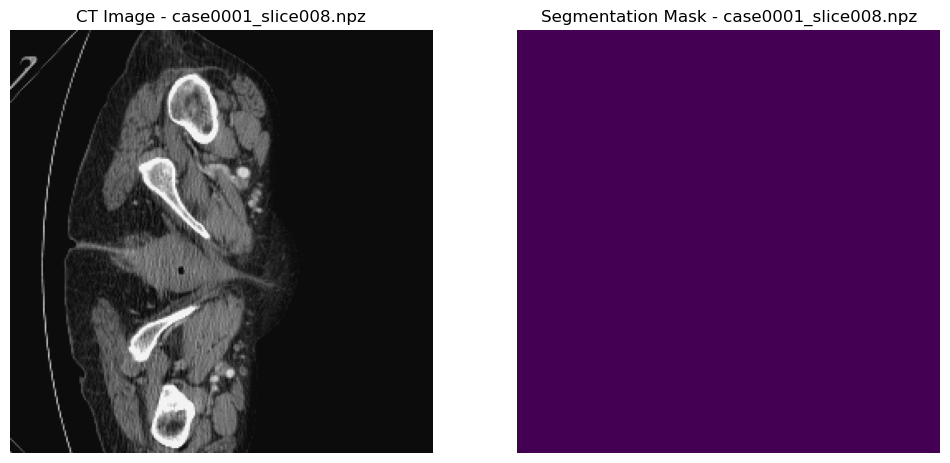


Visualizing case0001_slice009.npz:
Image min: -0.04702680164067767, max: 1.0526109243789477, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


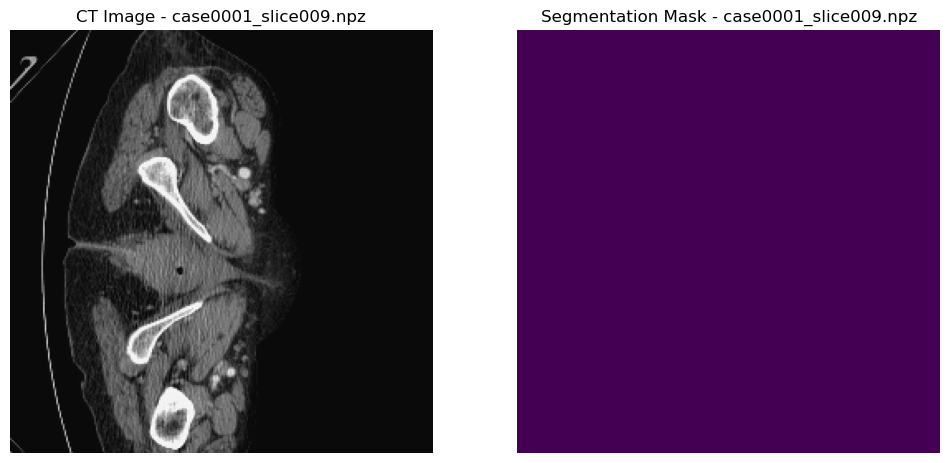


Visualizing case0001_slice010.npz:
Image min: -0.047194149811940256, max: 1.0676978688192598, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


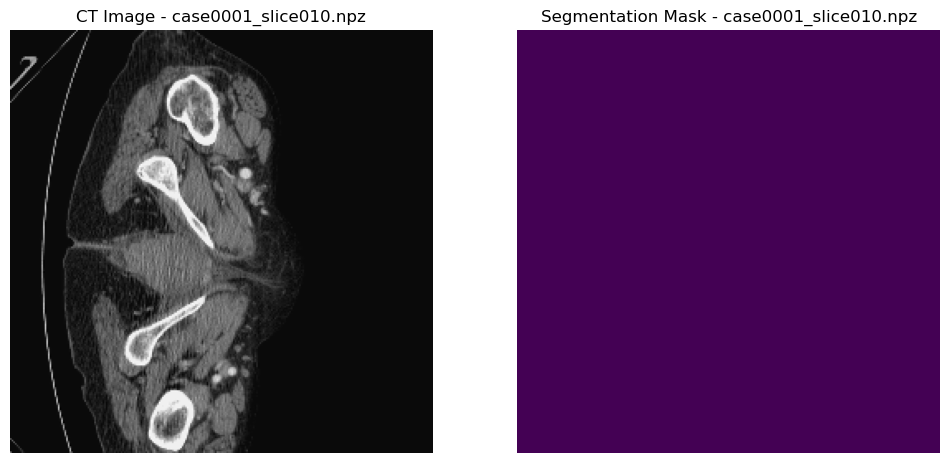


Visualizing case0001_slice011.npz:
Image min: -0.049952853170301396, max: 1.0507490180070005, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


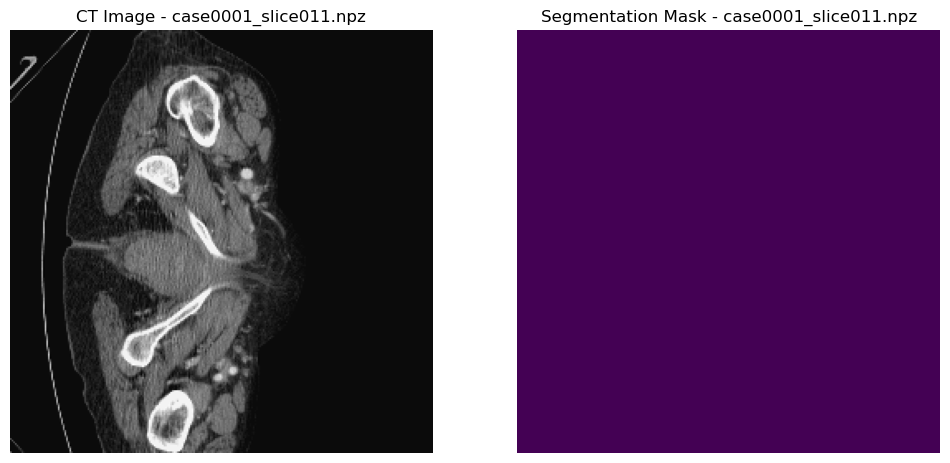


Visualizing case0001_slice012.npz:
Image min: -0.04881639834785662, max: 1.0461040824077439, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


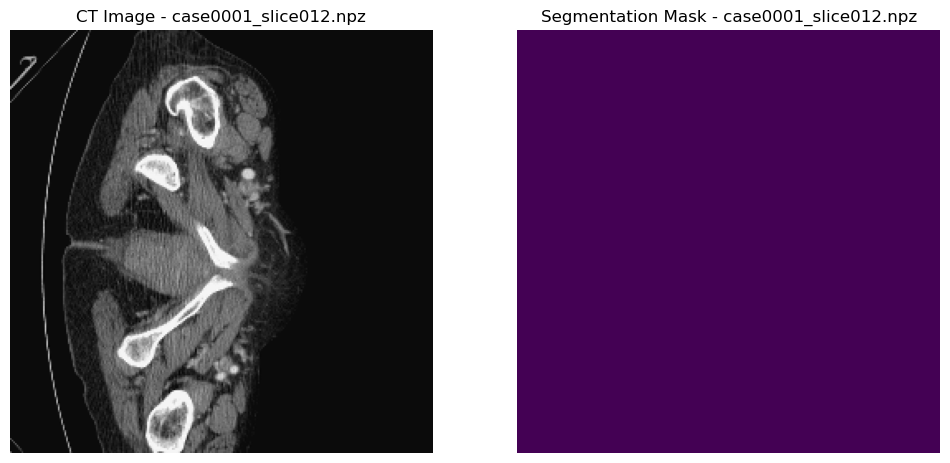


Visualizing case0001_slice013.npz:
Image min: -0.05122679808072613, max: 1.0510846603220925, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


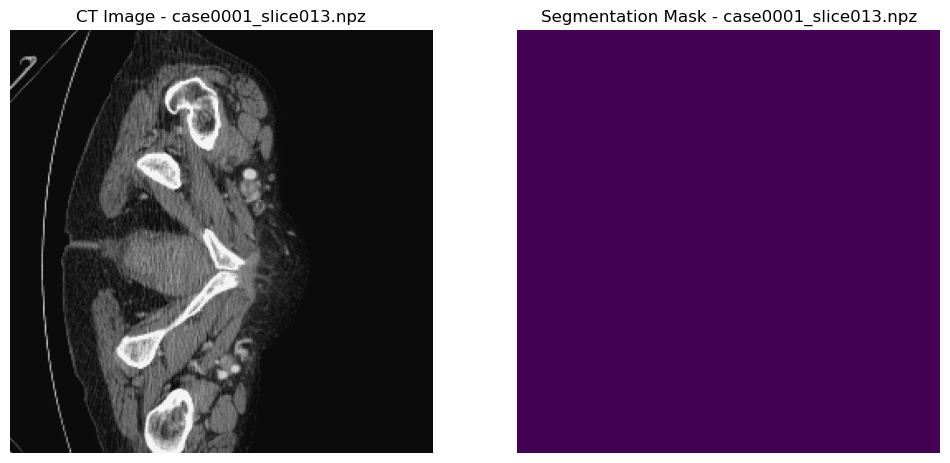


Visualizing case0001_slice014.npz:
Image min: -0.05327334477768689, max: 1.0487736555988487, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


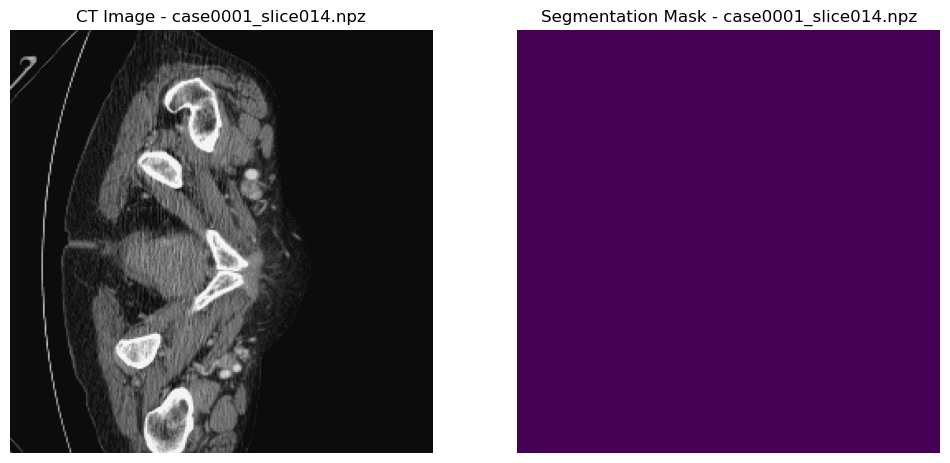


Visualizing case0001_slice015.npz:
Image min: -0.05573776704236097, max: 1.0551510098295045, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


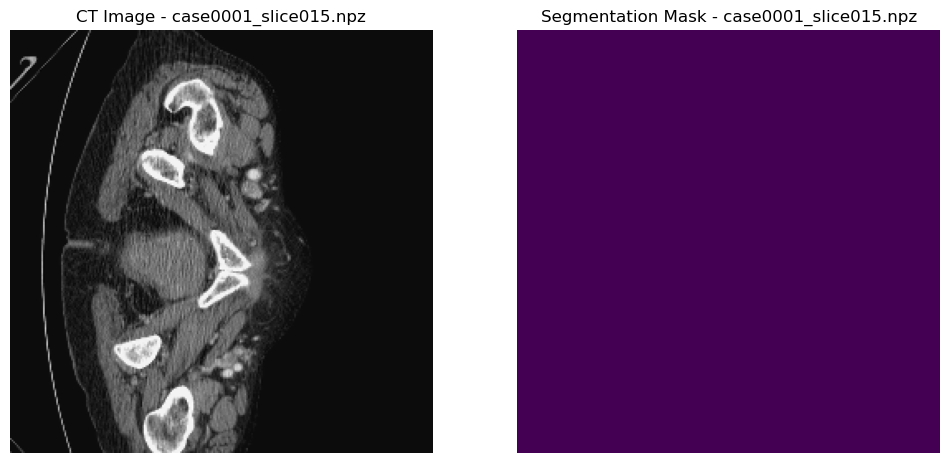


Visualizing case0001_slice016.npz:
Image min: -0.05676690555210372, max: 1.0623091877334883, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


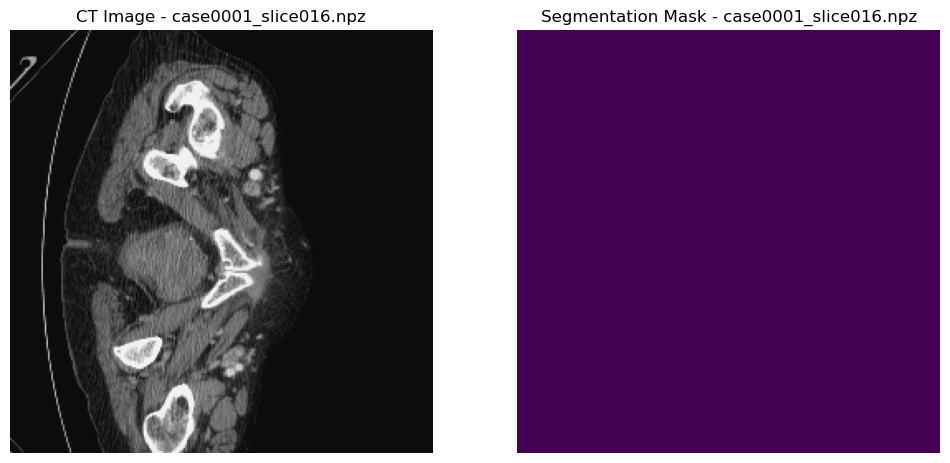


Visualizing case0001_slice017.npz:
Image min: -0.05568026227219121, max: 1.0537905061977848, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


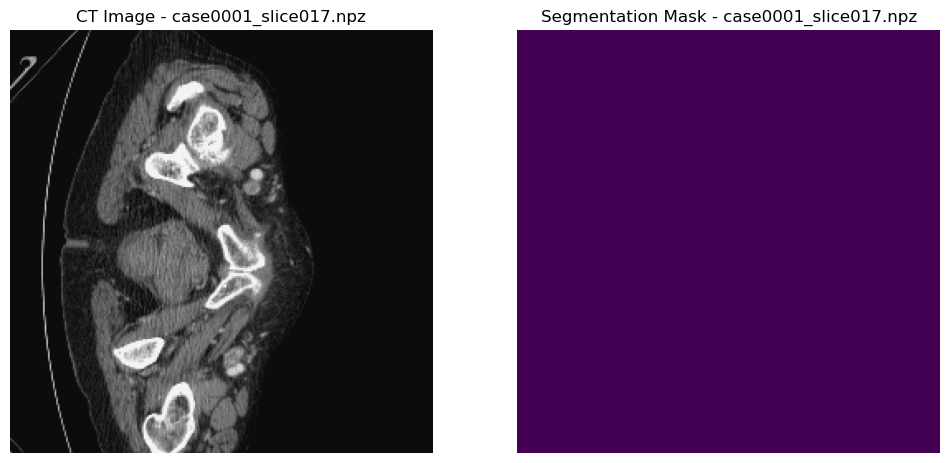


Visualizing case0001_slice018.npz:
Image min: -0.05162454014598528, max: 1.0567530375192504, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


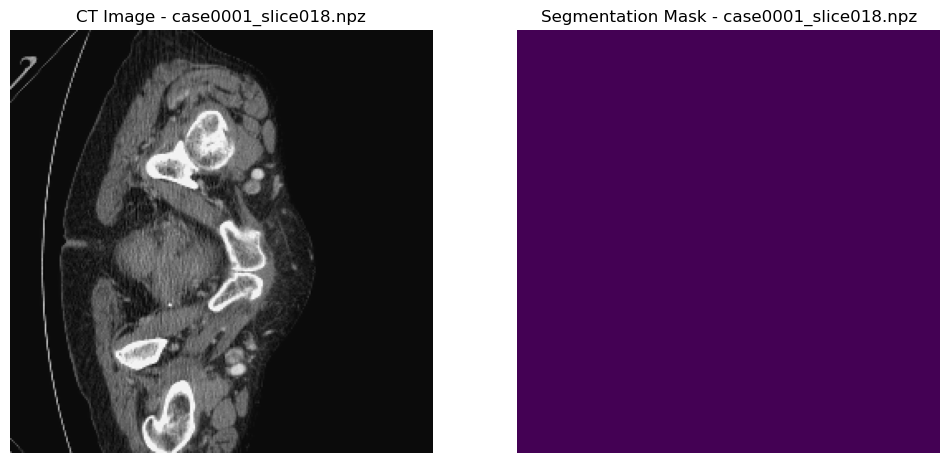


Visualizing case0001_slice019.npz:
Image min: -0.05222752083213603, max: 1.0579458671357476, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


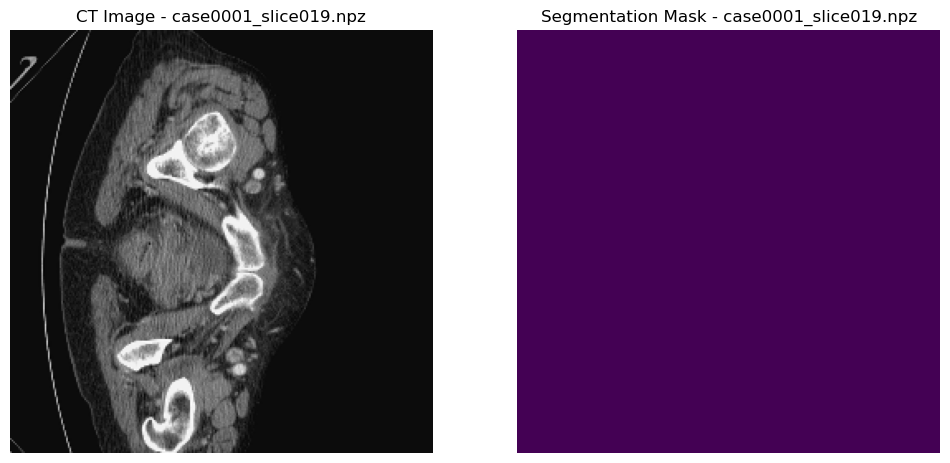


Visualizing case0001_slice020.npz:
Image min: -0.05092260877775542, max: 1.057898327190738, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


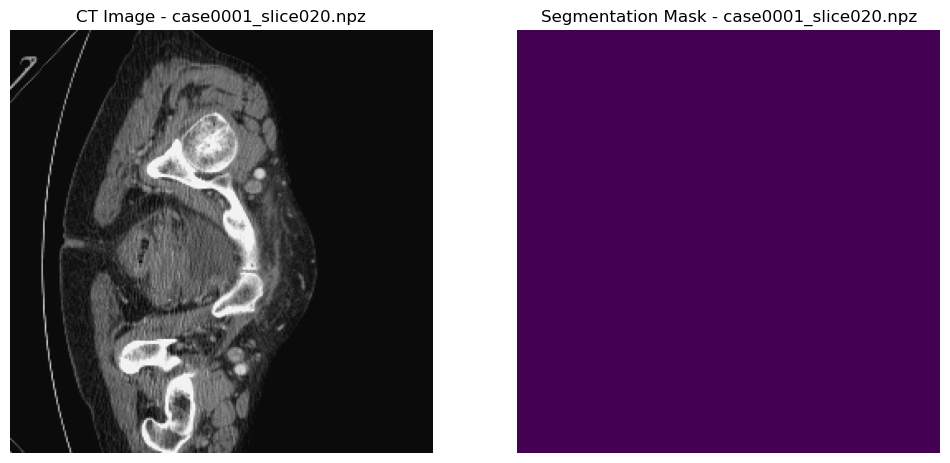


Visualizing case0001_slice021.npz:
Image min: -0.052054937910464456, max: 1.0495043712306957, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


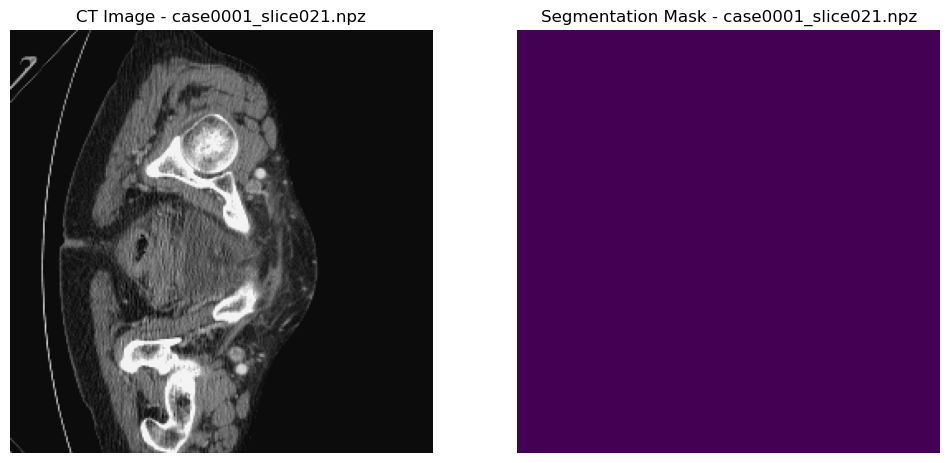


Visualizing case0001_slice022.npz:
Image min: -0.04997948604445676, max: 1.0529455619842902, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


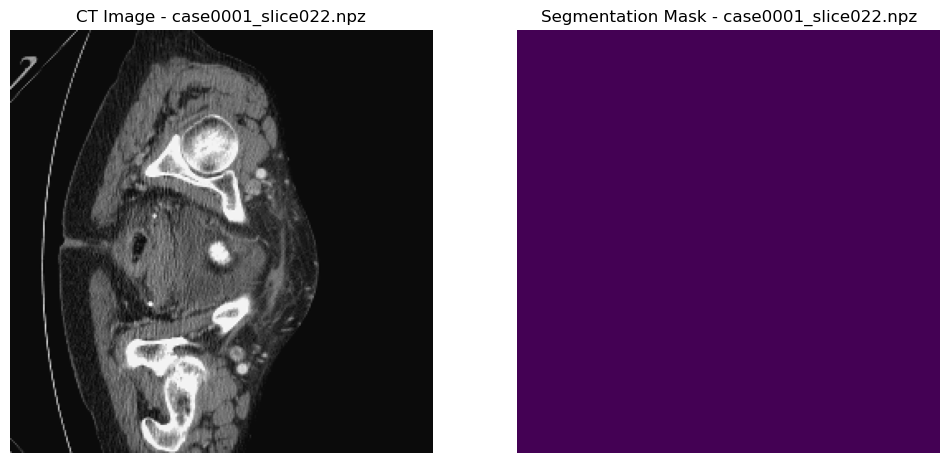


Visualizing case0001_slice023.npz:
Image min: -0.05149185551180821, max: 1.0556381511183484, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


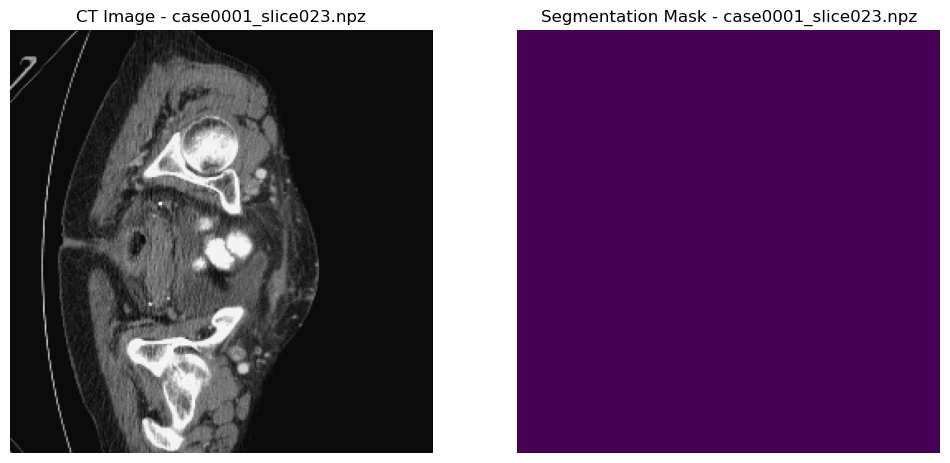


Visualizing case0001_slice024.npz:
Image min: -0.05473567774305439, max: 1.0710911064182915, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


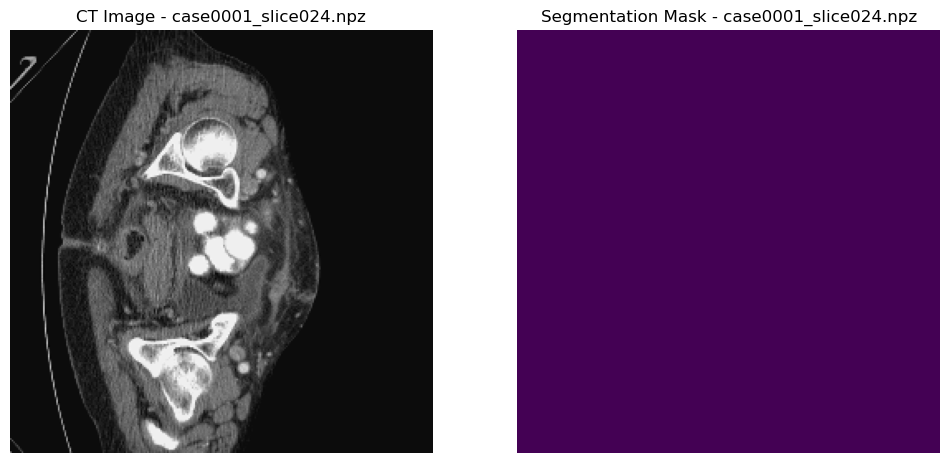


Visualizing case0001_slice025.npz:
Image min: -0.05185708648886335, max: 1.0630913210754118, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


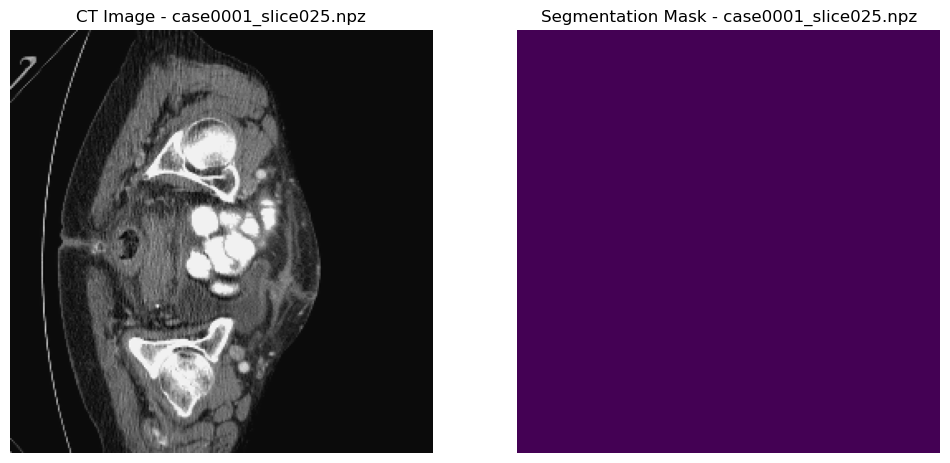


Visualizing case0001_slice026.npz:
Image min: -0.05292568839079546, max: 1.058096410329794, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


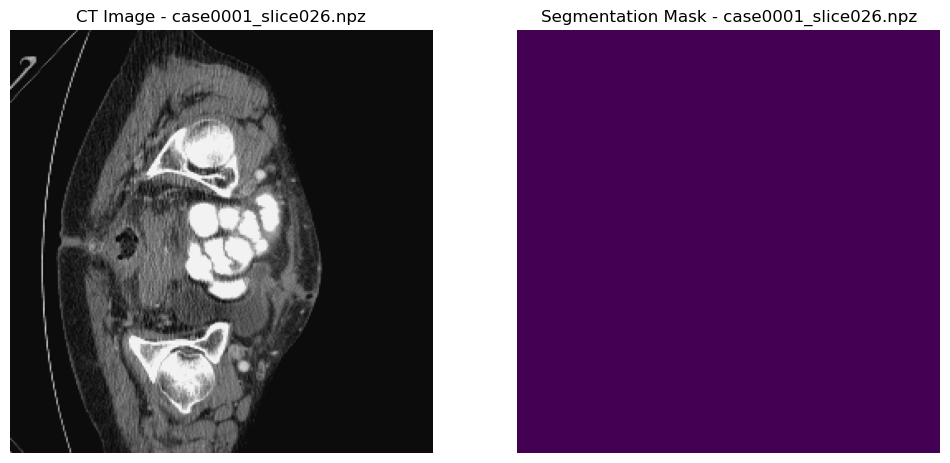


Visualizing case0001_slice027.npz:
Image min: -0.05497094742250951, max: 1.0767238067991995, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


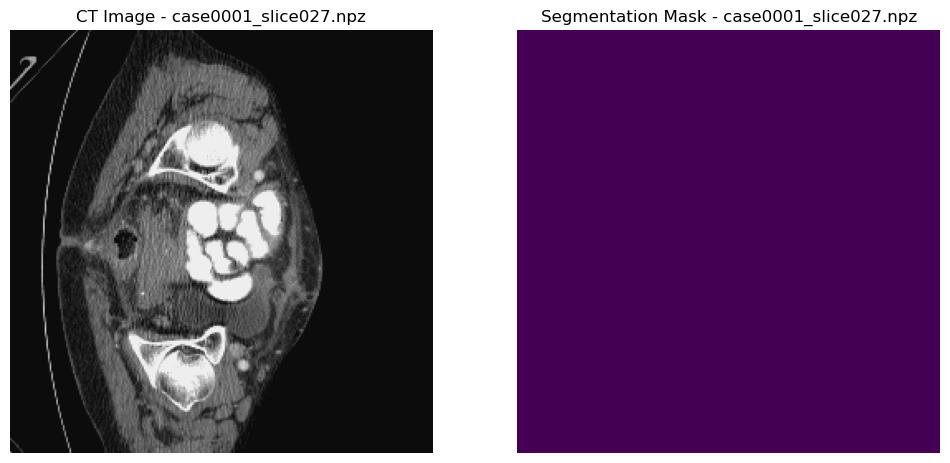


Visualizing case0001_slice028.npz:
Image min: -0.06763873412307596, max: 1.0730391106908441, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


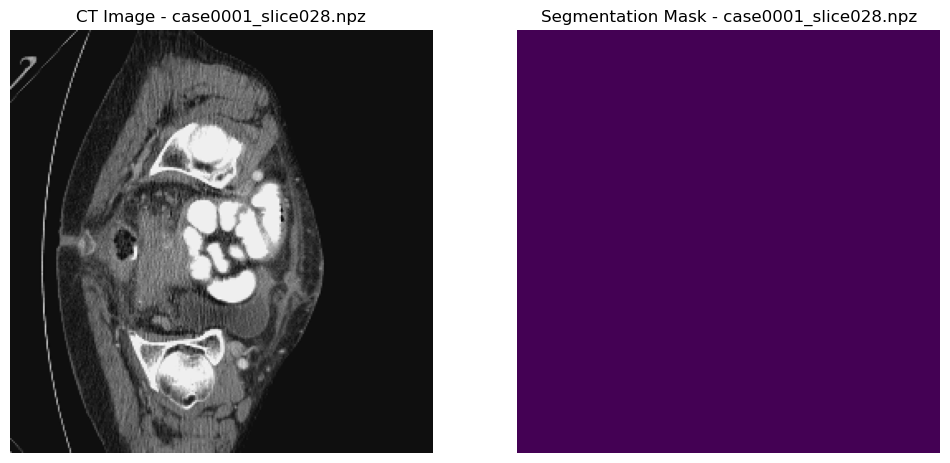


Visualizing case0001_slice029.npz:
Image min: -0.06497565771747889, max: 1.0837268803813538, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


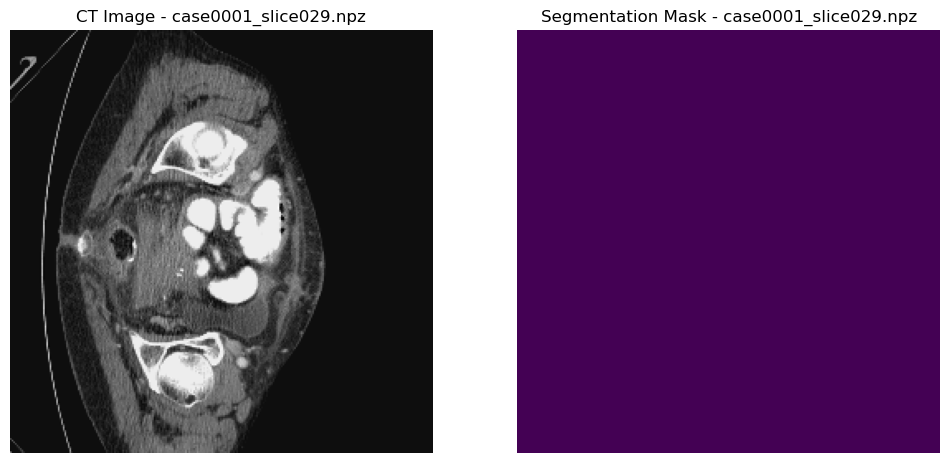


Visualizing case0001_slice030.npz:
Image min: -0.05451572428713715, max: 1.0899418926496172, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


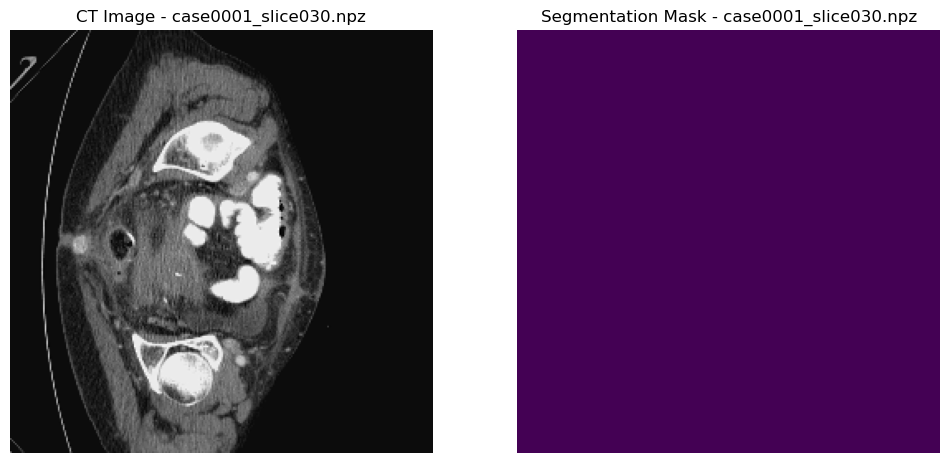


Visualizing case0001_slice031.npz:
Image min: -0.05577333500038087, max: 1.07724658140162, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


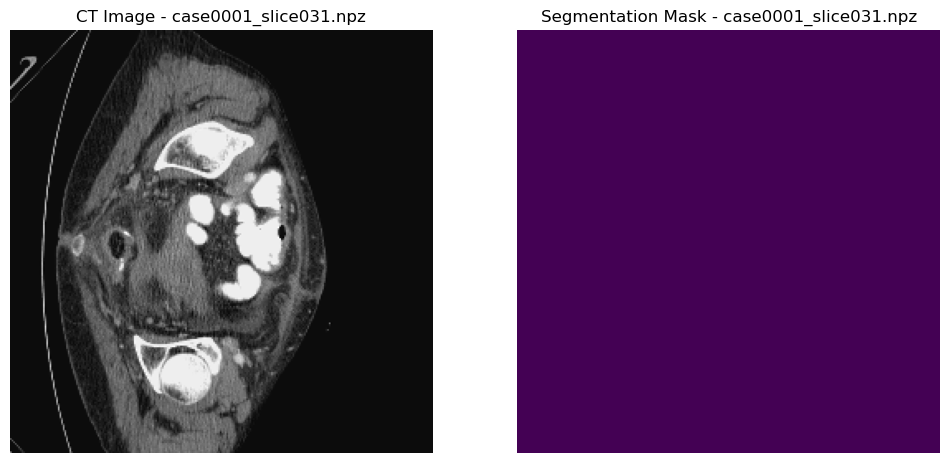


Visualizing case0001_slice032.npz:
Image min: -0.0532780582159907, max: 1.072744266120025, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


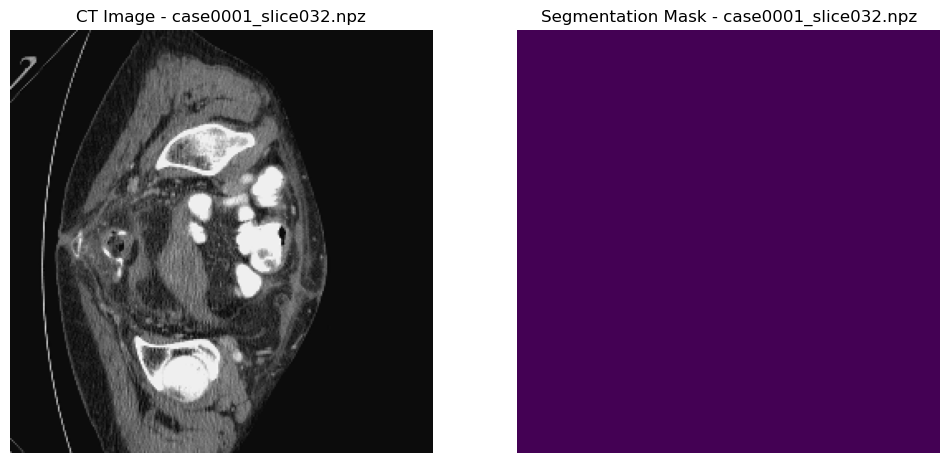


Visualizing case0001_slice033.npz:
Image min: -0.048200464278933826, max: 1.097301007236742, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


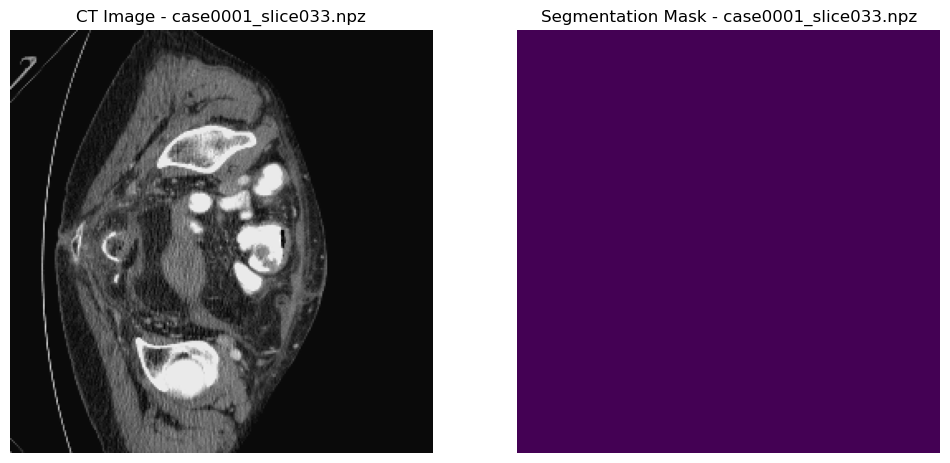


Visualizing case0001_slice034.npz:
Image min: -0.07107303936745216, max: 1.1055619335642248, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


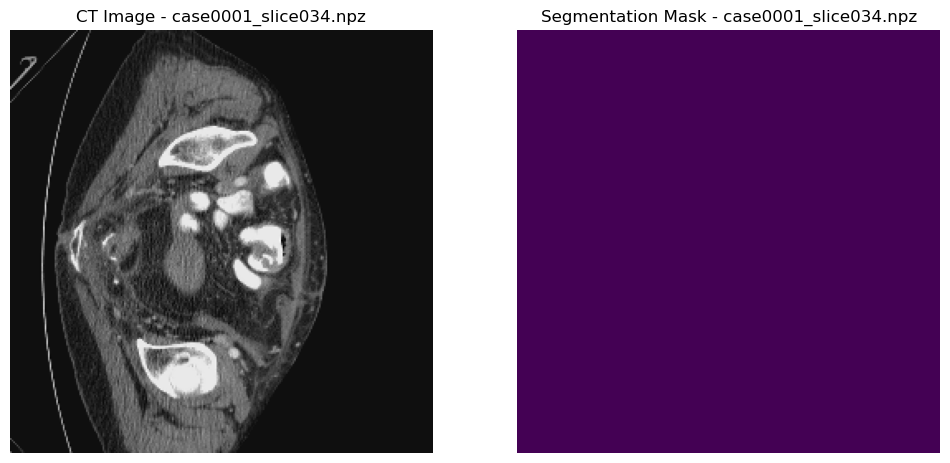


Visualizing case0001_slice035.npz:
Image min: -0.05500093416763019, max: 1.0599416917598545, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


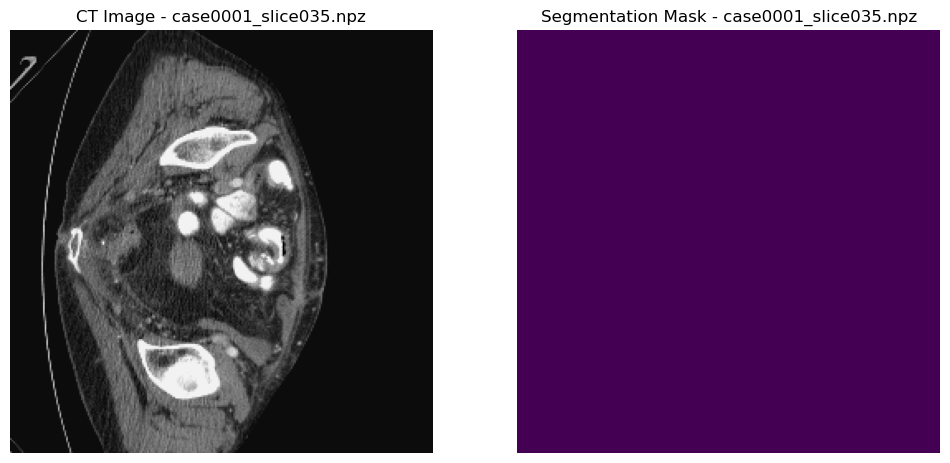


Visualizing case0001_slice036.npz:
Image min: -0.052931433071208296, max: 1.0489015859137312, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


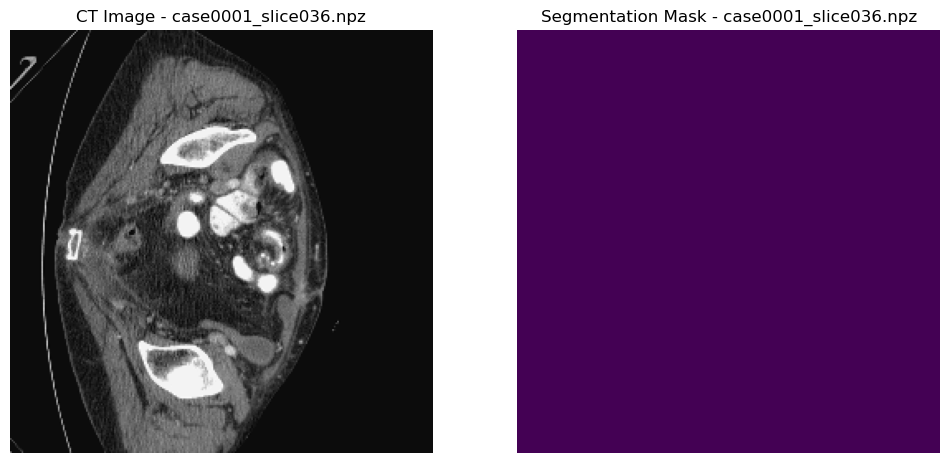


Visualizing case0001_slice037.npz:
Image min: -0.0563872101834595, max: 1.0588047072466322, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


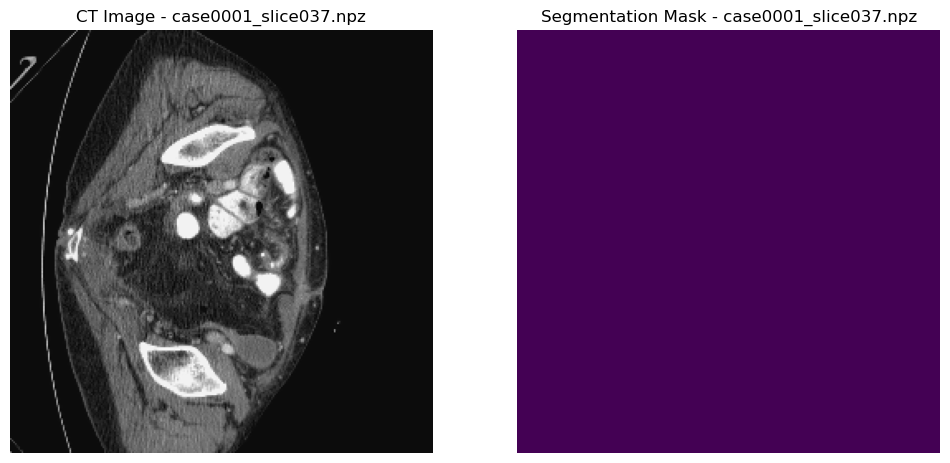


Visualizing case0001_slice038.npz:
Image min: -0.05498933268079353, max: 1.0617601728796626, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


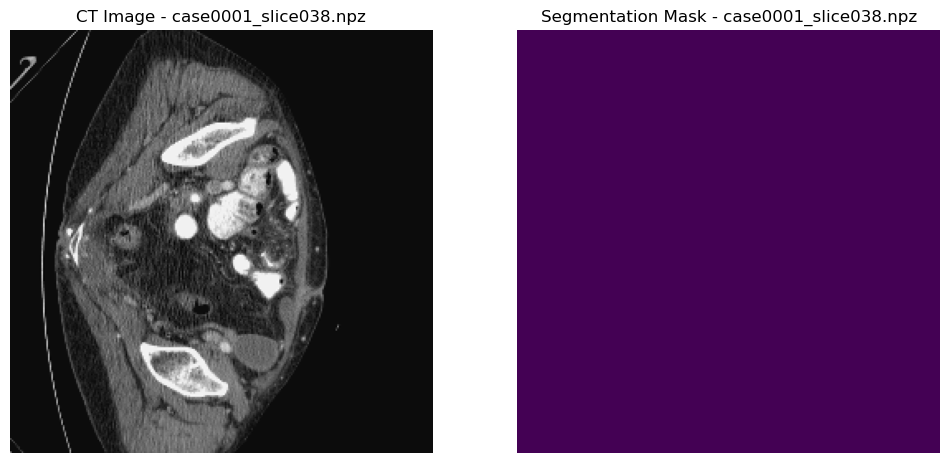


Visualizing case0001_slice039.npz:
Image min: -0.05247060039815233, max: 1.0816270087530895, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


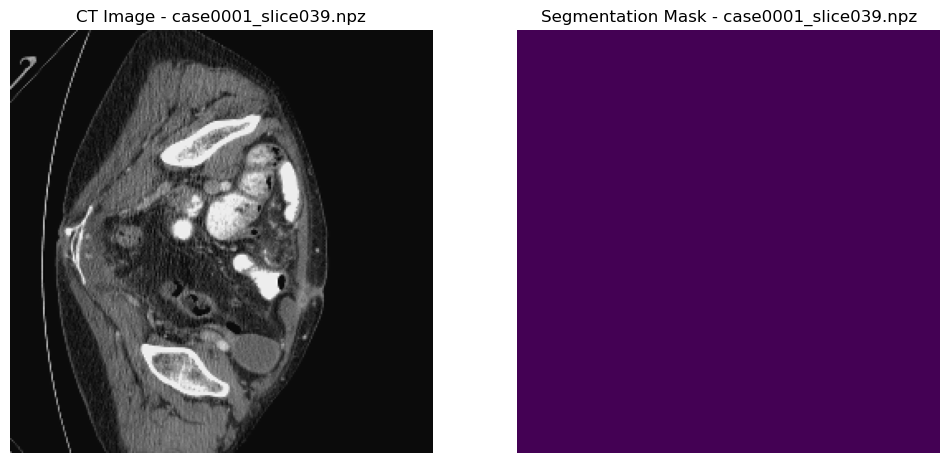


Visualizing case0001_slice040.npz:
Image min: -0.07659382581385152, max: 1.093621116526876, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


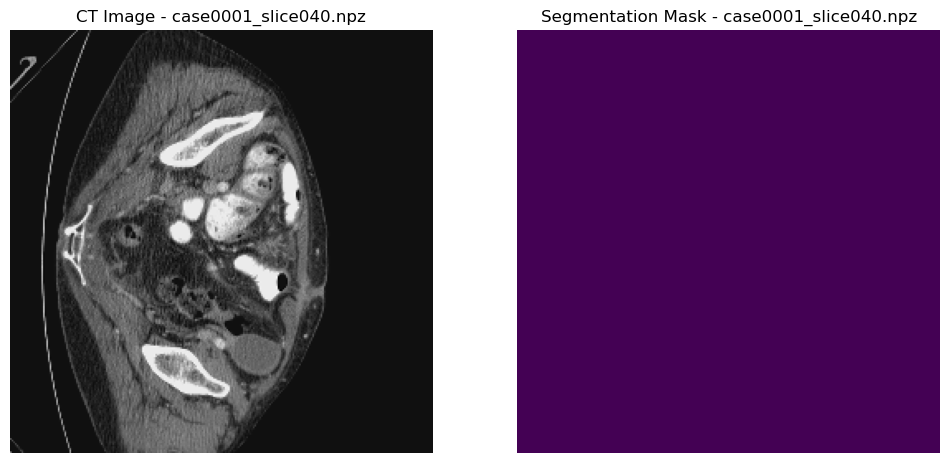


Visualizing case0001_slice041.npz:
Image min: -0.06666344764857918, max: 1.0658771703707481, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


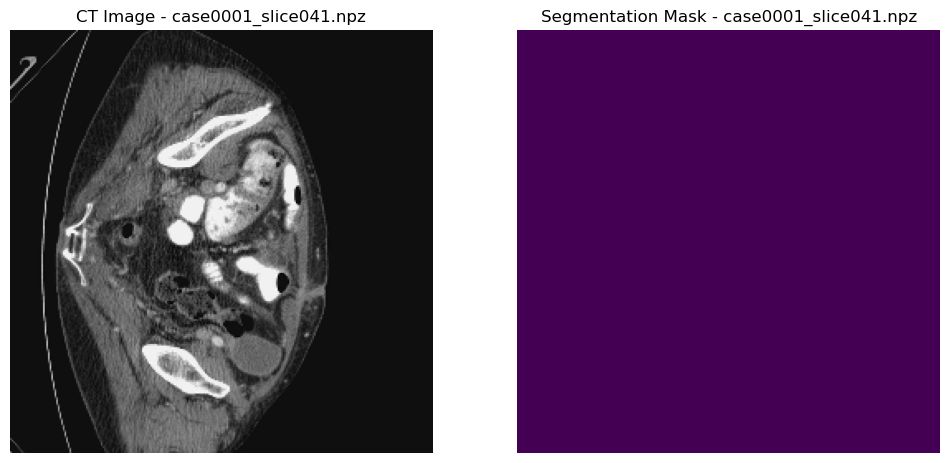


Visualizing case0001_slice042.npz:
Image min: -0.07402831934991051, max: 1.106352011353137, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


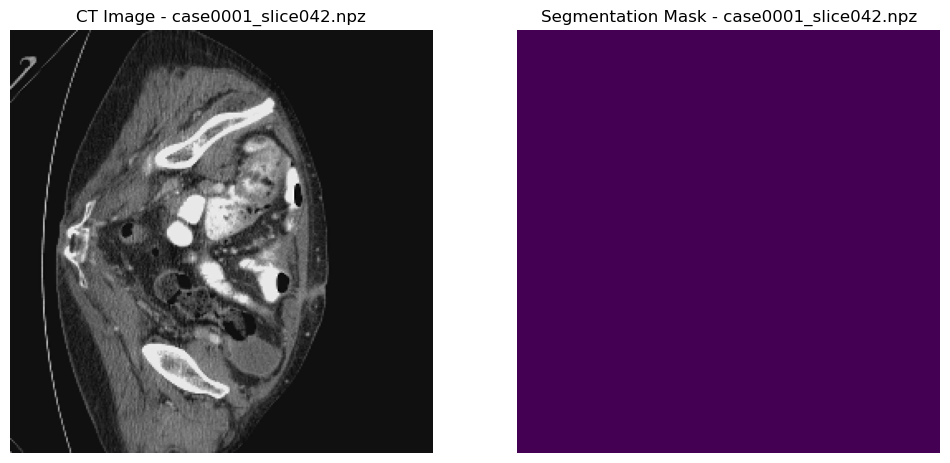


Visualizing case0001_slice043.npz:
Image min: -0.11936982179642003, max: 1.1063111292547225, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


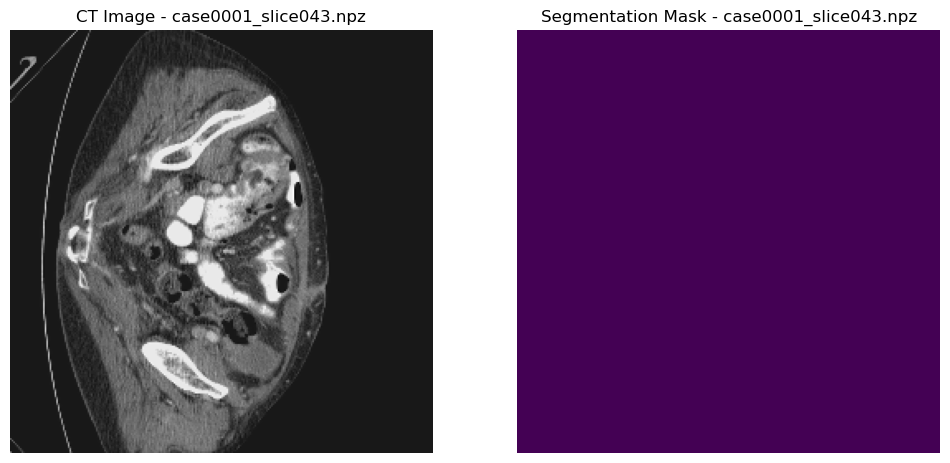


Visualizing case0001_slice044.npz:
Image min: -0.06003734514766512, max: 1.0803261179212194, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


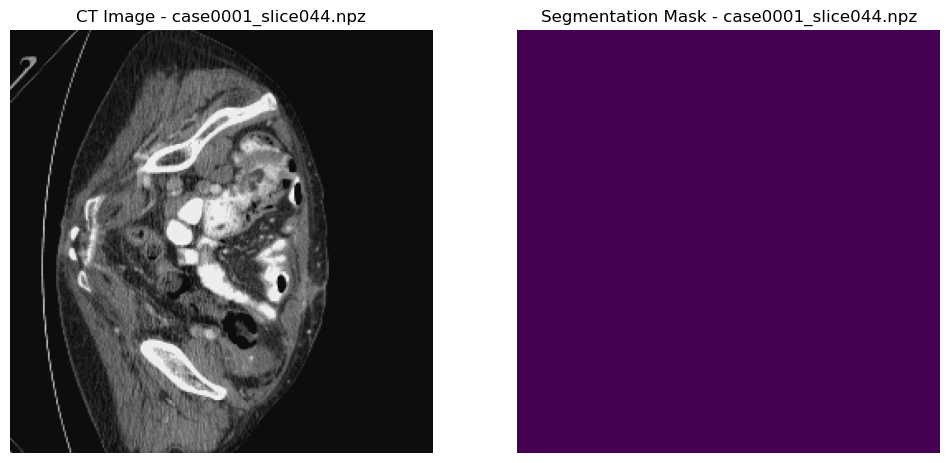


Visualizing case0001_slice045.npz:
Image min: -0.08162192412713244, max: 1.0810869468339932, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


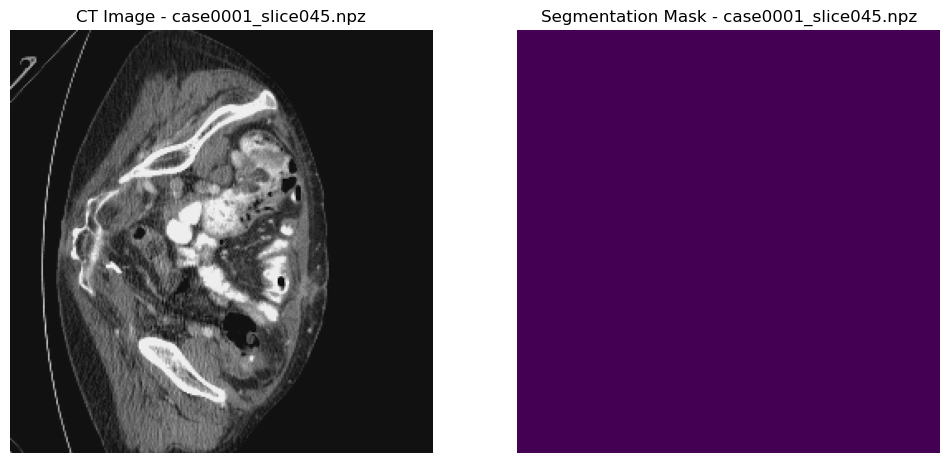


Visualizing case0001_slice046.npz:
Image min: -0.0560531105523587, max: 1.059442423596306, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


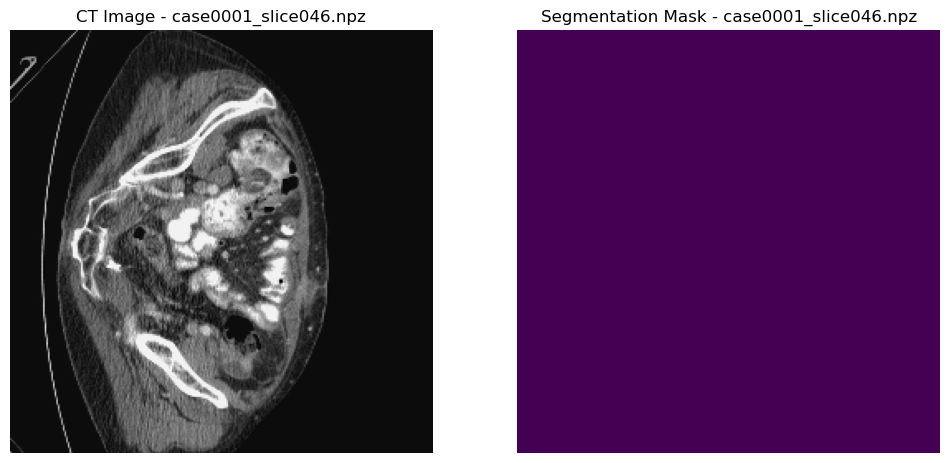


Visualizing case0001_slice047.npz:
Image min: -0.0511991039757327, max: 1.0799902712618785, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


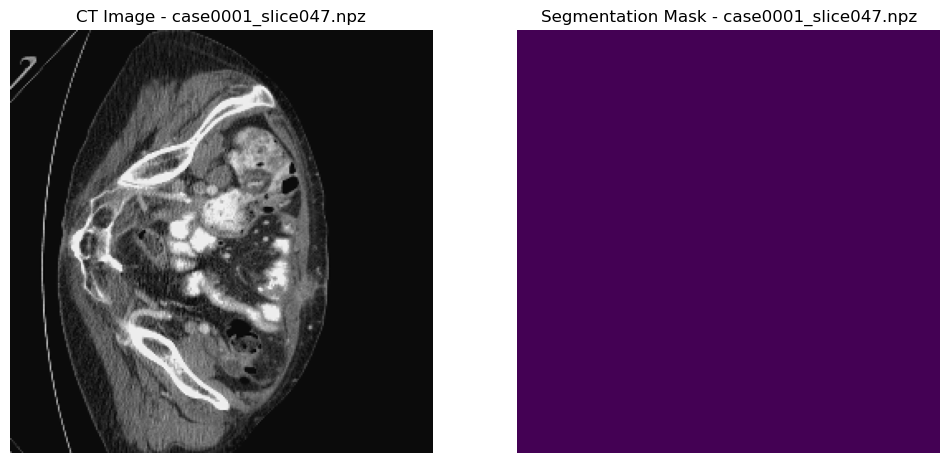


Visualizing case0001_slice048.npz:
Image min: -0.04802881758714492, max: 1.0678965293134213, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


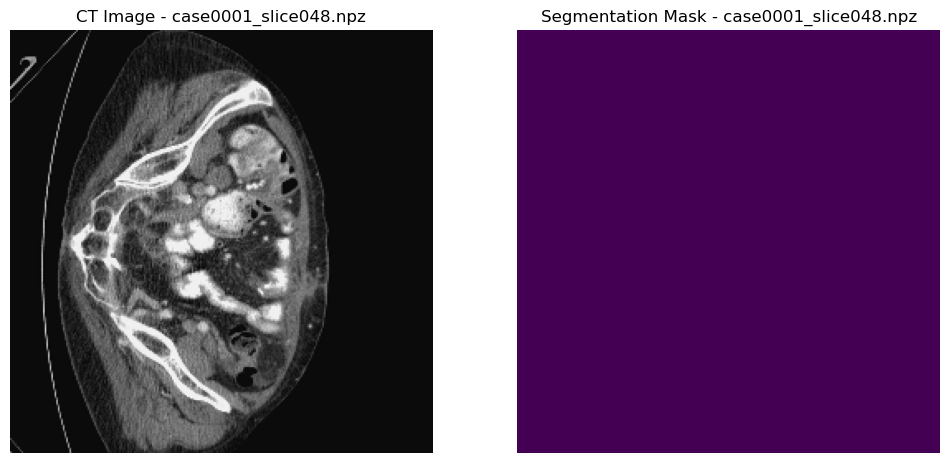


Visualizing case0001_slice049.npz:
Image min: -0.054941988090866194, max: 1.0616439514465805, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


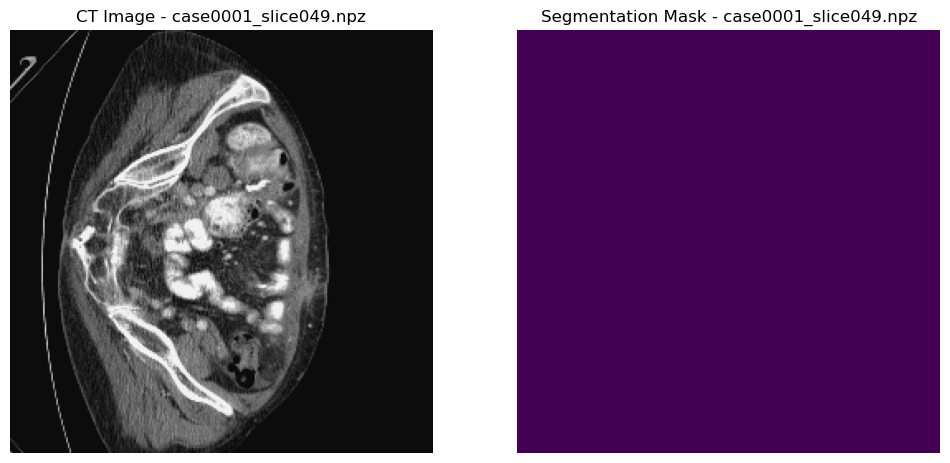


Visualizing case0001_slice050.npz:
Image min: -0.05417587326169977, max: 1.067254429055744, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


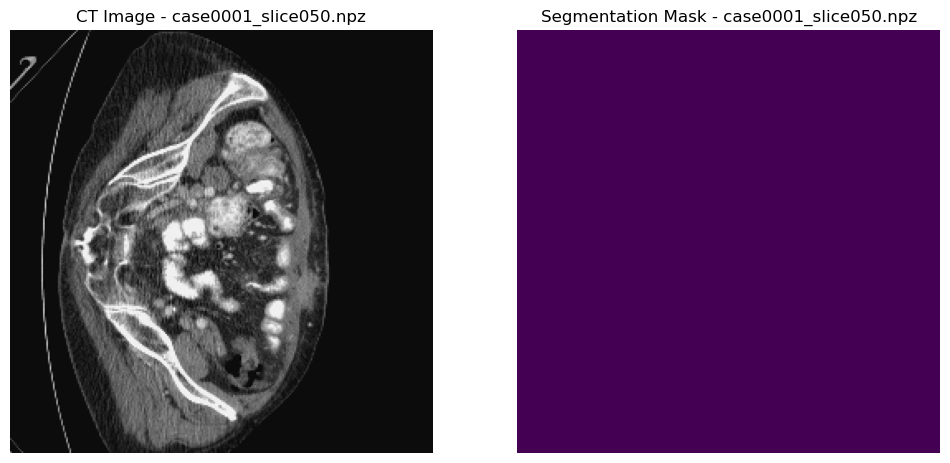


Visualizing case0001_slice051.npz:
Image min: -0.05432581848756952, max: 1.0649731117168417, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


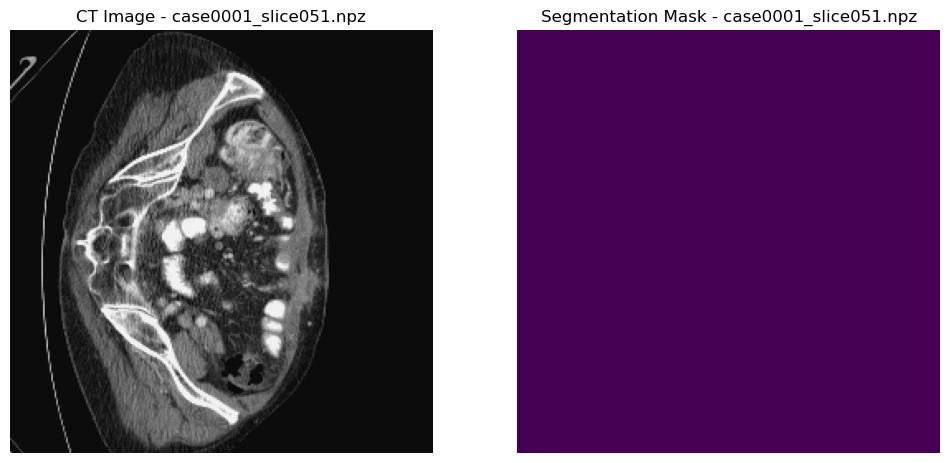


Visualizing case0001_slice052.npz:
Image min: -0.05591623874321112, max: 1.0669764396993027, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


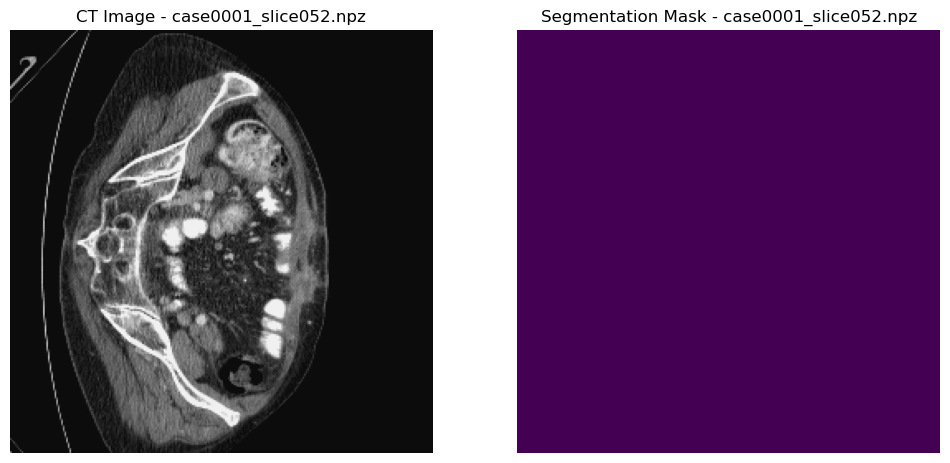


Visualizing case0001_slice053.npz:
Image min: -0.05363717386097995, max: 1.0732520492848503, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


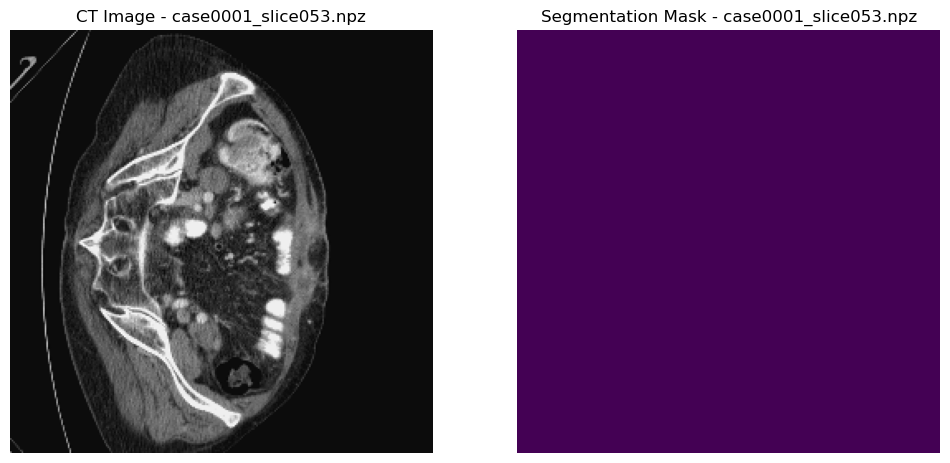


Visualizing case0001_slice054.npz:
Image min: -0.053746143774594794, max: 1.0730610530074978, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


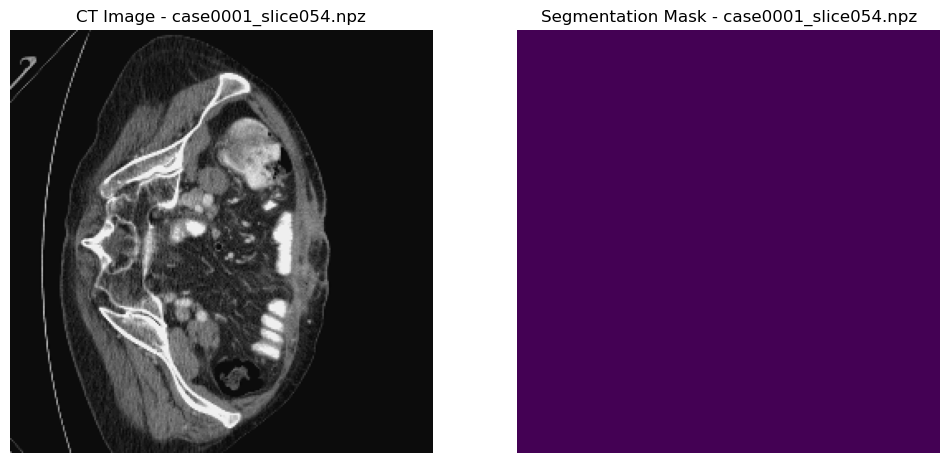


Visualizing case0001_slice055.npz:
Image min: -0.05227124851691483, max: 1.0683932467751625, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


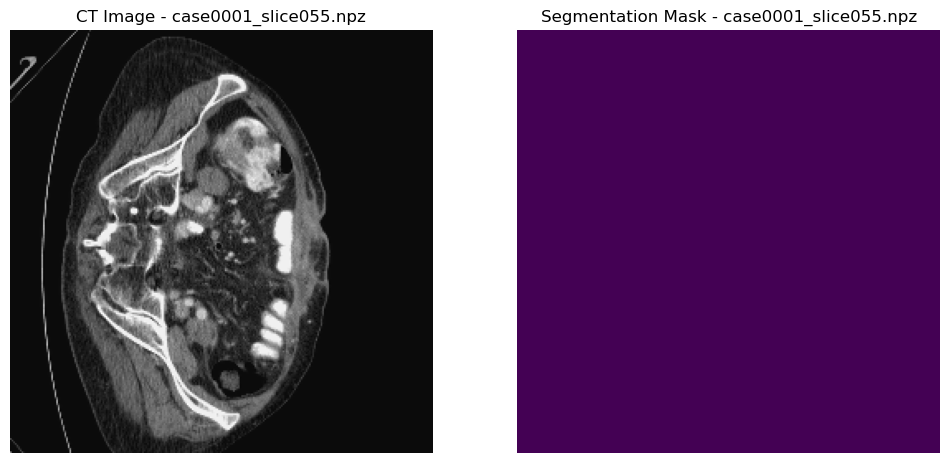


Visualizing case0001_slice056.npz:
Image min: -0.05381262704997017, max: 1.0708937819741136, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


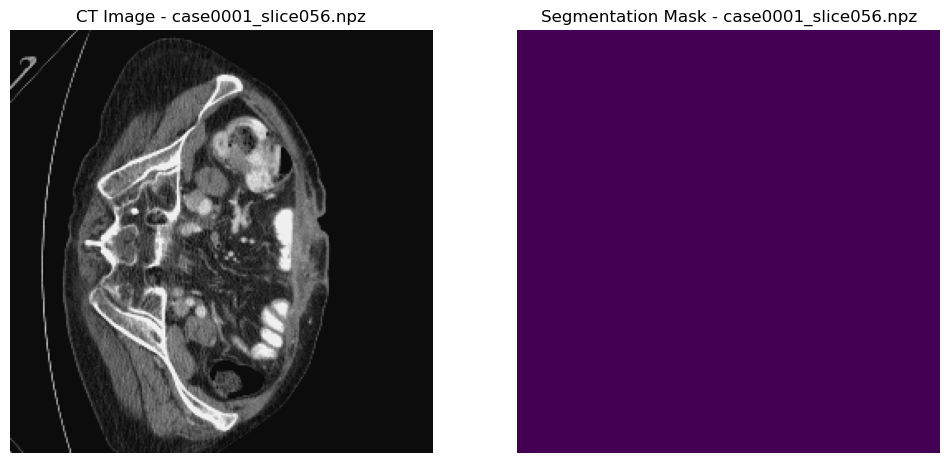


Visualizing case0001_slice057.npz:
Image min: -0.05211950256460416, max: 1.0644890839100014, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


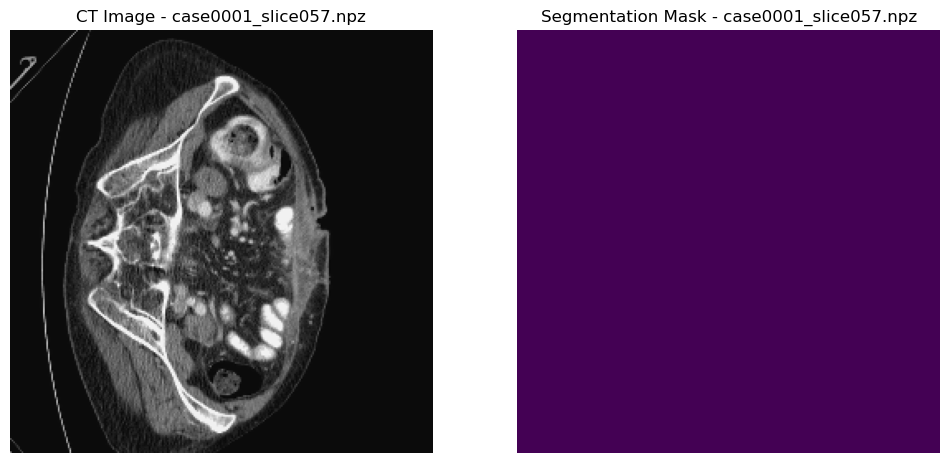


Visualizing case0001_slice058.npz:
Image min: -0.049912041430071205, max: 1.064081625058573, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


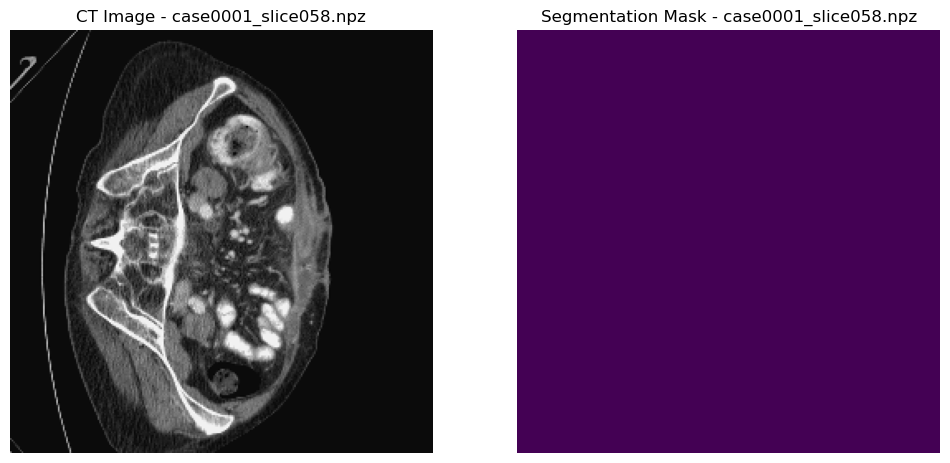


Visualizing case0001_slice059.npz:
Image min: -0.048375566430623115, max: 1.0692336730359002, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


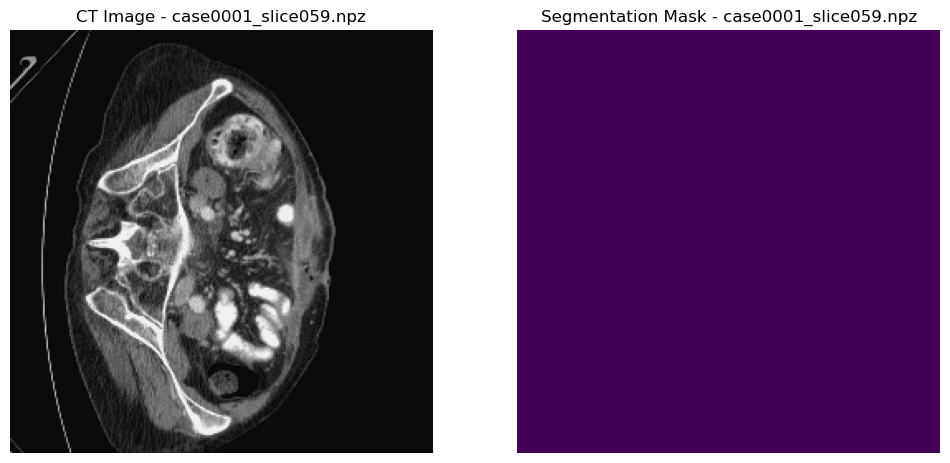


Visualizing case0001_slice060.npz:
Image min: -0.055739214183634686, max: 1.0694705183687705, shape: (256, 256)
Label unique values: [0.], shape: (256, 256)


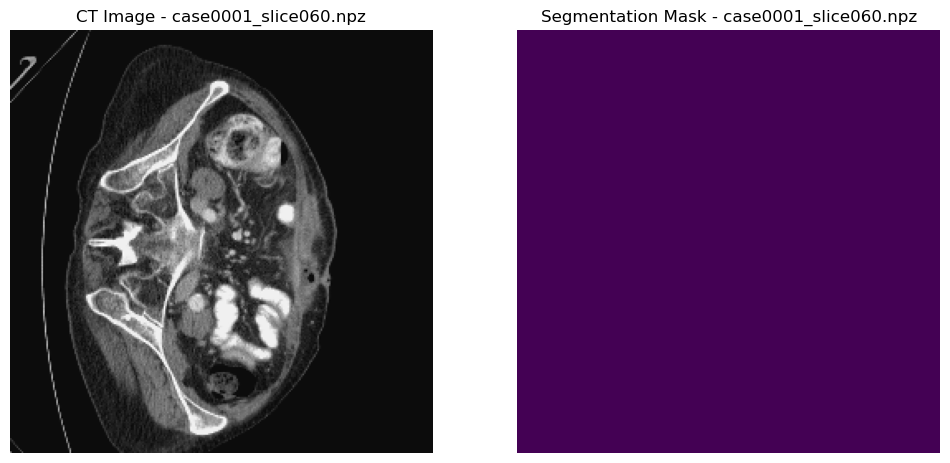


Visualizing case0001_slice061.npz:
Image min: -0.05062970904423113, max: 1.05958034710356, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


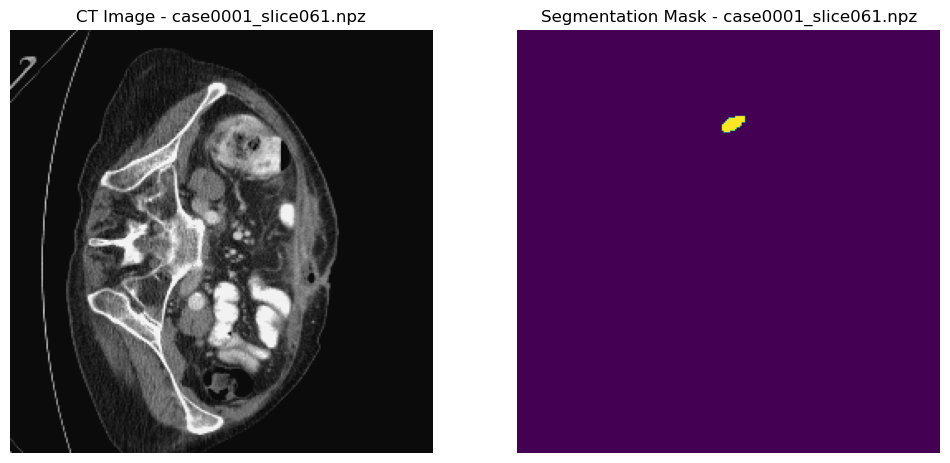


Visualizing case0001_slice062.npz:
Image min: -0.056710702291002654, max: 1.0683716114580033, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


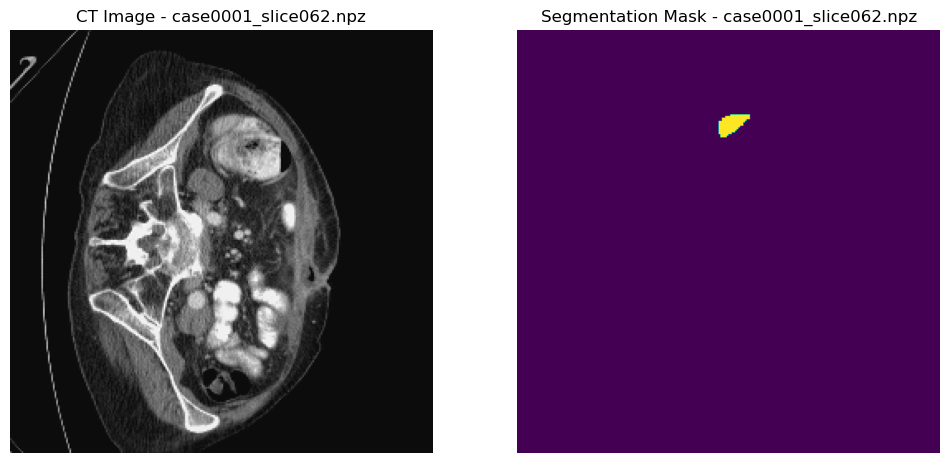


Visualizing case0001_slice063.npz:
Image min: -0.06309980233507731, max: 1.072566888507564, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


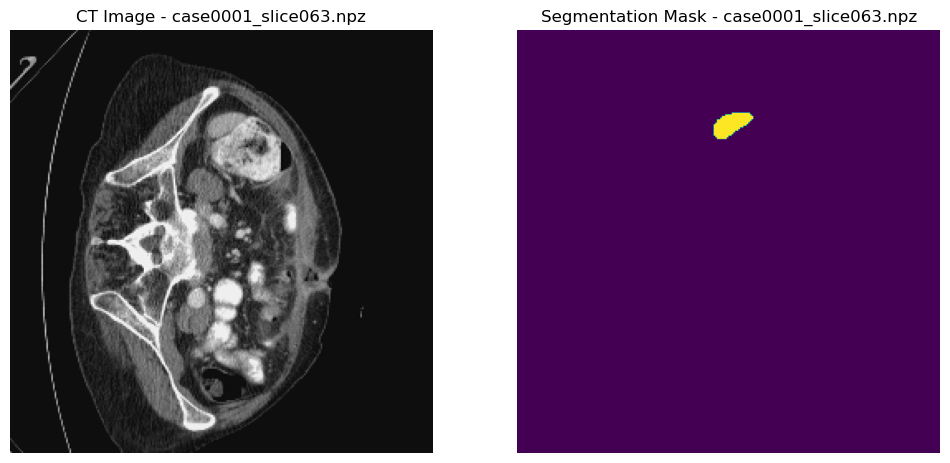


Visualizing case0001_slice064.npz:
Image min: -0.05608228753455851, max: 1.0657441542312558, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


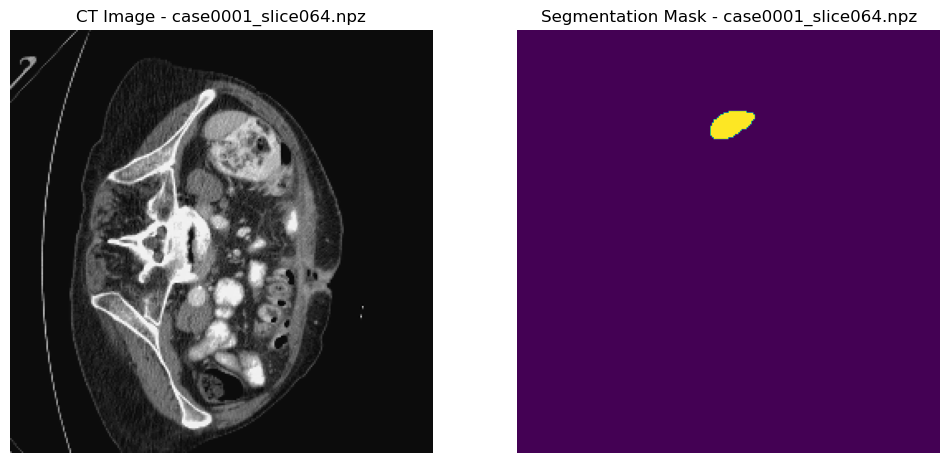


Visualizing case0001_slice065.npz:
Image min: -0.049968108520177, max: 1.0684851867238636, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


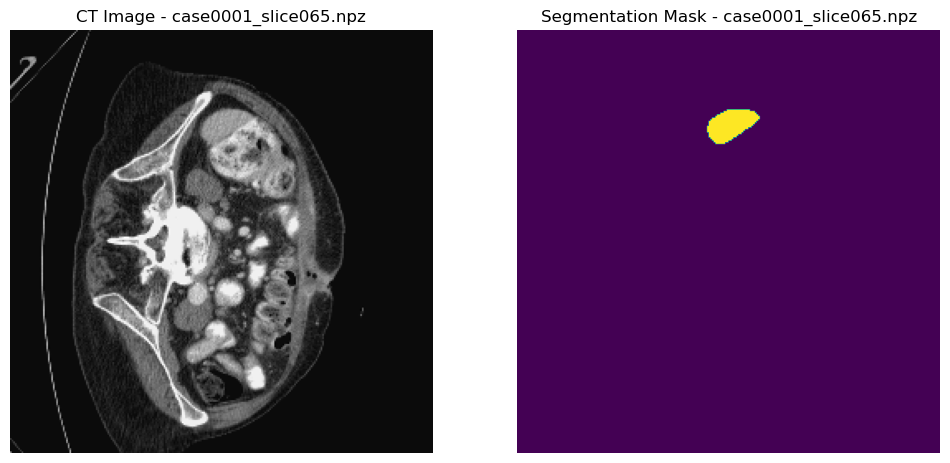


Visualizing case0001_slice066.npz:
Image min: -0.04918797418799687, max: 1.0627161448723583, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


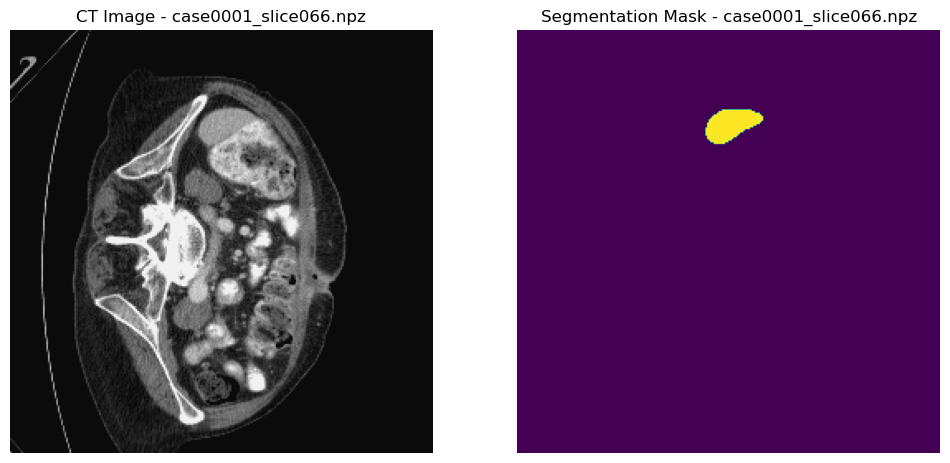


Visualizing case0001_slice067.npz:
Image min: -0.052994315828539494, max: 1.05678470964518, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


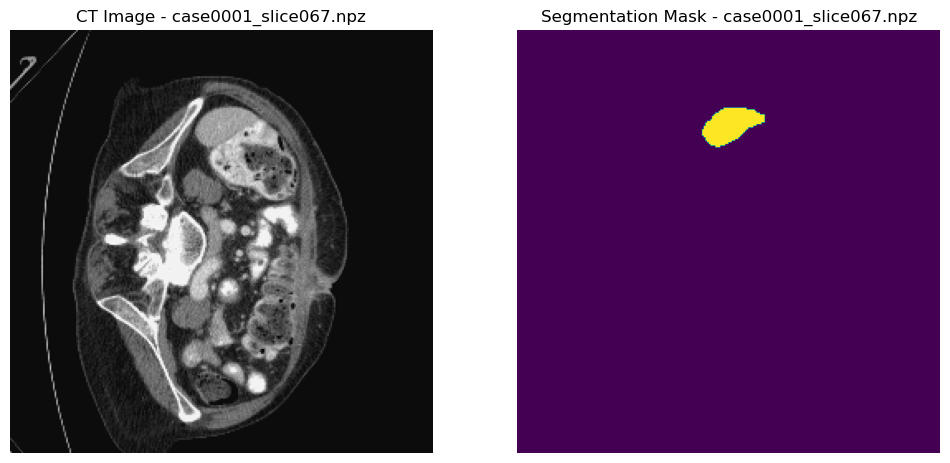


Visualizing case0001_slice068.npz:
Image min: -0.047620693101039856, max: 1.056161764283018, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


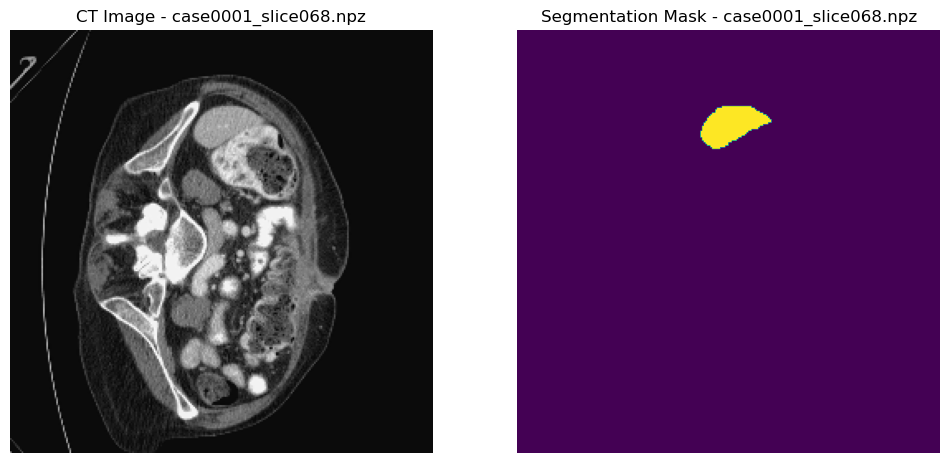


Visualizing case0001_slice069.npz:
Image min: -0.050399520675948724, max: 1.0582453816005302, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


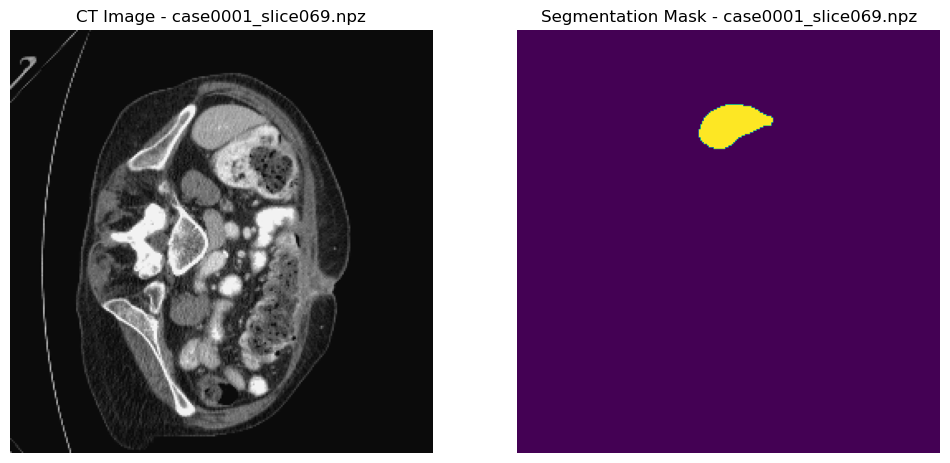


Visualizing case0001_slice070.npz:
Image min: -0.061197488592413744, max: 1.0762504016236427, shape: (256, 256)
Label unique values: [0. 6.], shape: (256, 256)


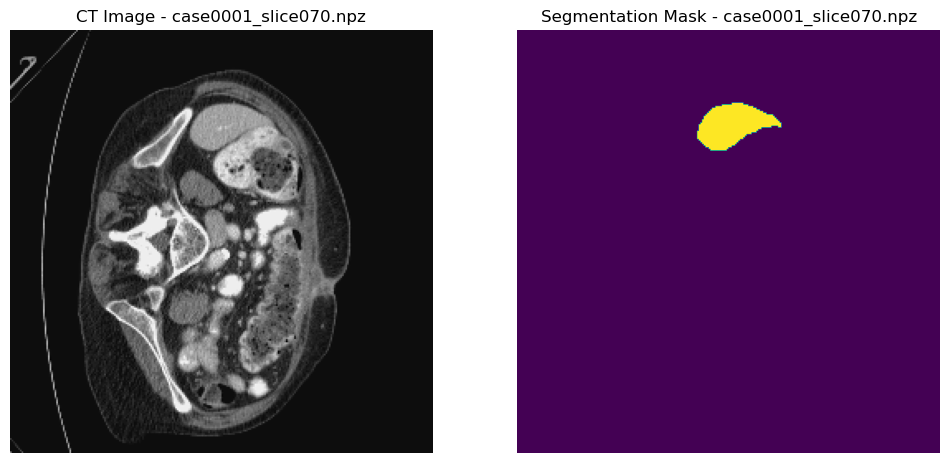


Visualizing case0001_slice071.npz:
Image min: -0.048122831406667524, max: 1.060547971093694, shape: (256, 256)
Label unique values: [0. 6. 8. 9.], shape: (256, 256)


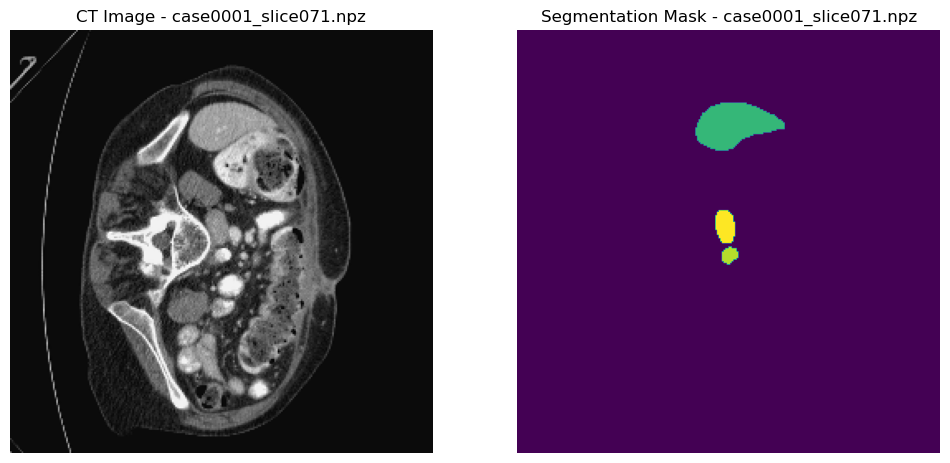


Visualizing case0001_slice072.npz:
Image min: -0.04421379879185387, max: 1.066004075524041, shape: (256, 256)
Label unique values: [0. 6. 8. 9.], shape: (256, 256)


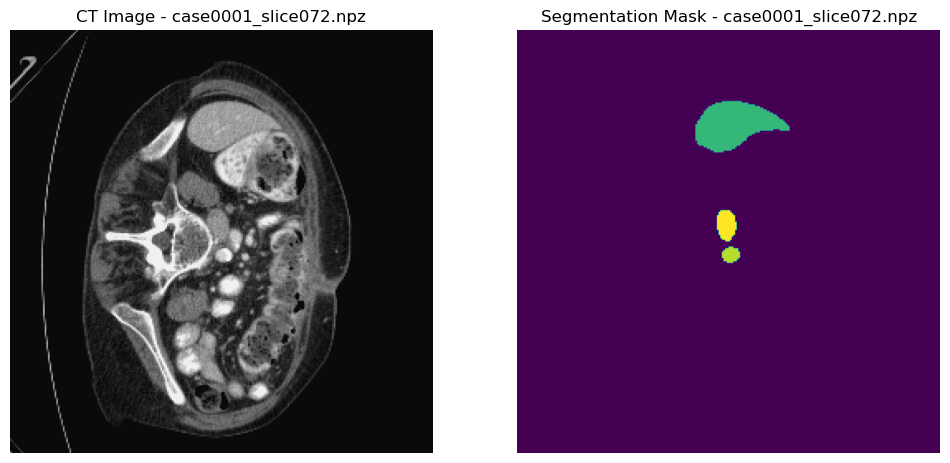


Visualizing case0001_slice073.npz:
Image min: -0.050551448095449376, max: 1.0548002011679354, shape: (256, 256)
Label unique values: [0. 6. 8. 9.], shape: (256, 256)


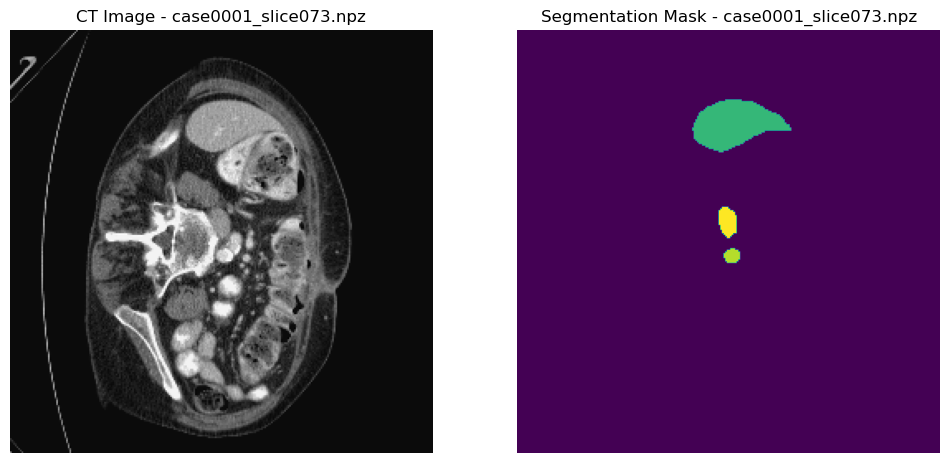


Visualizing case0001_slice074.npz:
Image min: -0.05483693958914244, max: 1.0489991671954229, shape: (256, 256)
Label unique values: [0. 6. 8. 9.], shape: (256, 256)


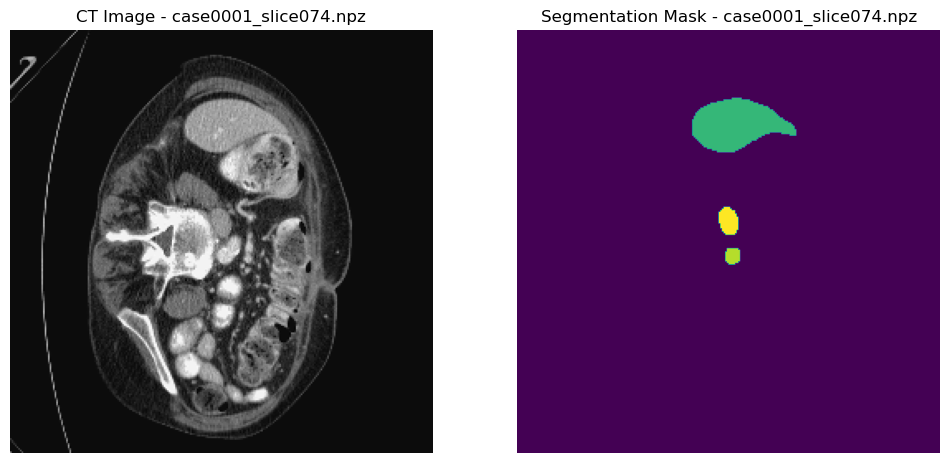


Visualizing case0001_slice075.npz:
Image min: -0.05271658661309031, max: 1.045610893487391, shape: (256, 256)
Label unique values: [0. 6. 8. 9.], shape: (256, 256)


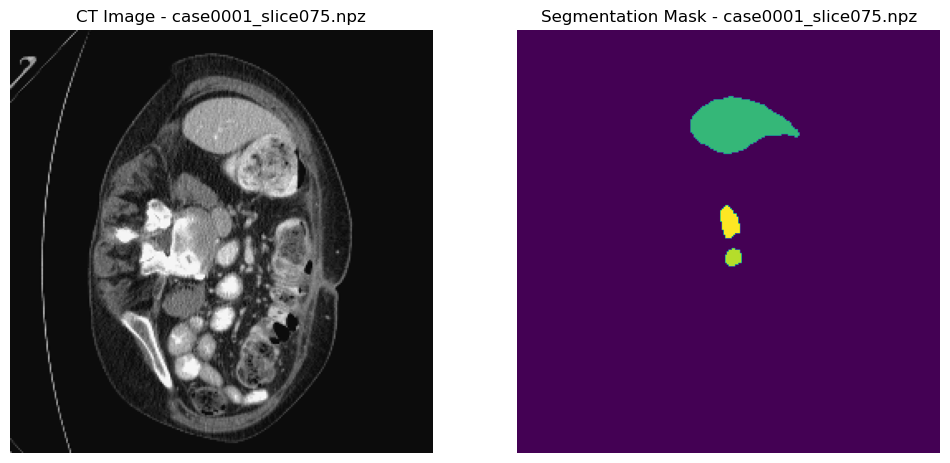


Visualizing case0001_slice076.npz:
Image min: -0.05562497595507129, max: 1.0432600036077957, shape: (256, 256)
Label unique values: [0. 6. 8. 9.], shape: (256, 256)


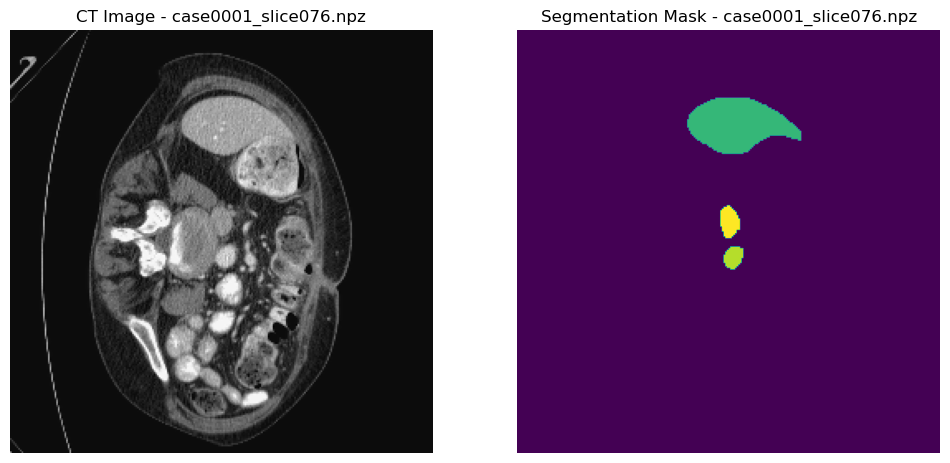


Visualizing case0001_slice077.npz:
Image min: -0.04503838801801324, max: 1.0463014460878048, shape: (256, 256)
Label unique values: [0. 6. 8. 9.], shape: (256, 256)


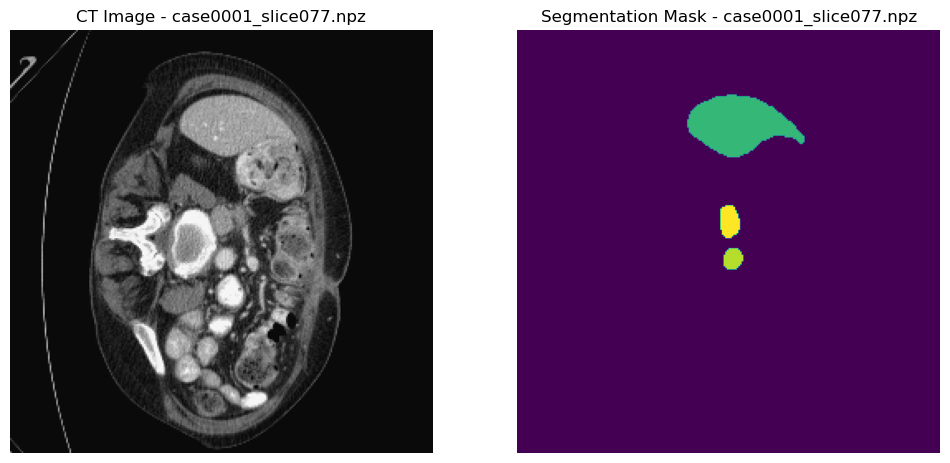


Visualizing case0001_slice078.npz:
Image min: -0.051768761075524174, max: 1.049667971941919, shape: (256, 256)
Label unique values: [0. 2. 6. 8. 9.], shape: (256, 256)


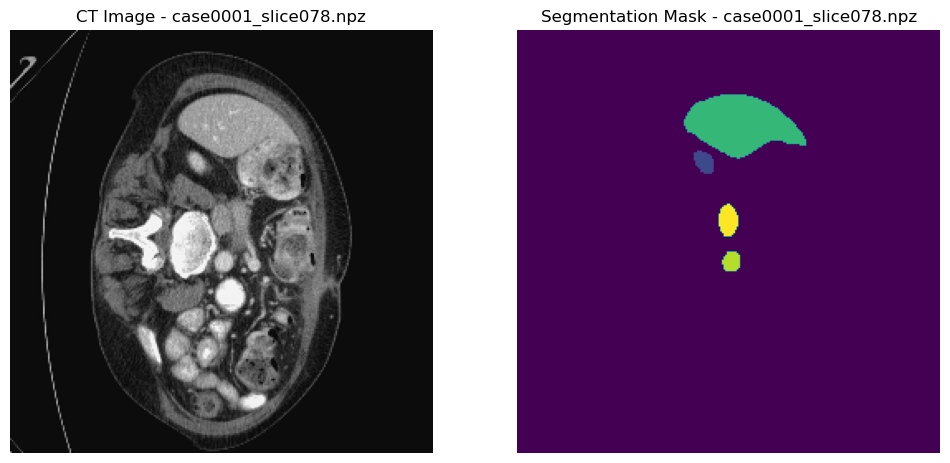


Visualizing case0001_slice079.npz:
Image min: -0.051582204401407185, max: 1.066475669130737, shape: (256, 256)
Label unique values: [0. 2. 6. 8. 9.], shape: (256, 256)


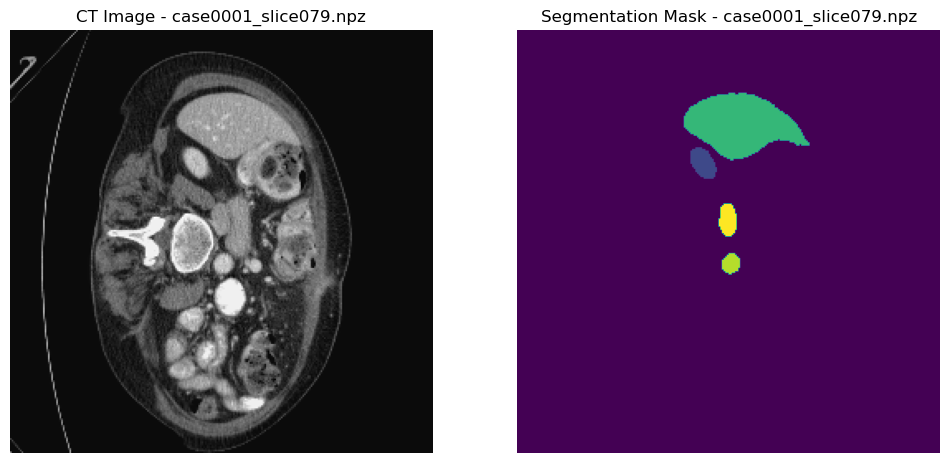


Visualizing case0001_slice080.npz:
Image min: -0.05081886408252302, max: 1.068854887149015, shape: (256, 256)
Label unique values: [0. 2. 6. 8. 9.], shape: (256, 256)


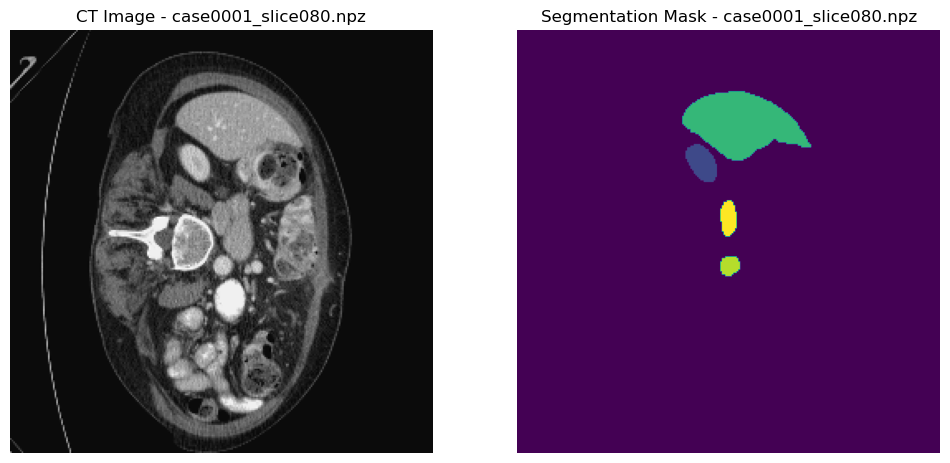


Visualizing case0001_slice081.npz:
Image min: -0.05064490710442141, max: 1.0600984638521989, shape: (256, 256)
Label unique values: [0. 2. 6. 8. 9.], shape: (256, 256)


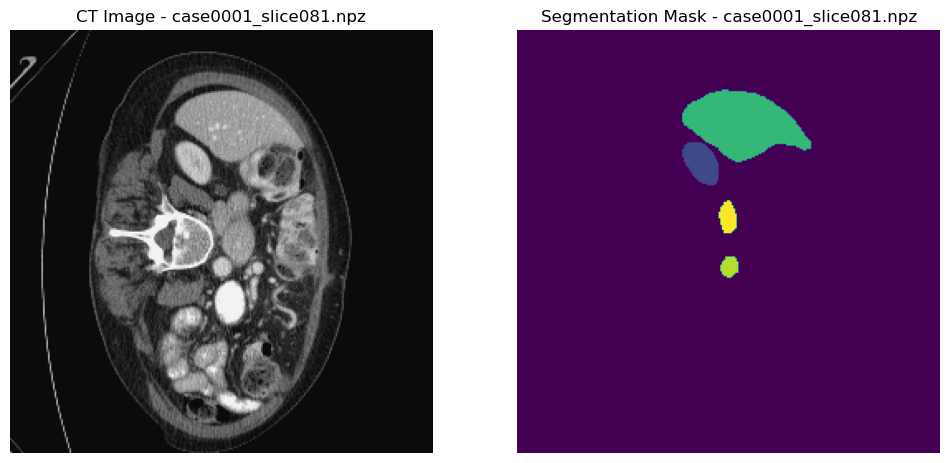


Visualizing case0001_slice082.npz:
Image min: -0.04845757336573755, max: 1.0664426173866666, shape: (256, 256)
Label unique values: [0. 2. 6. 8. 9.], shape: (256, 256)


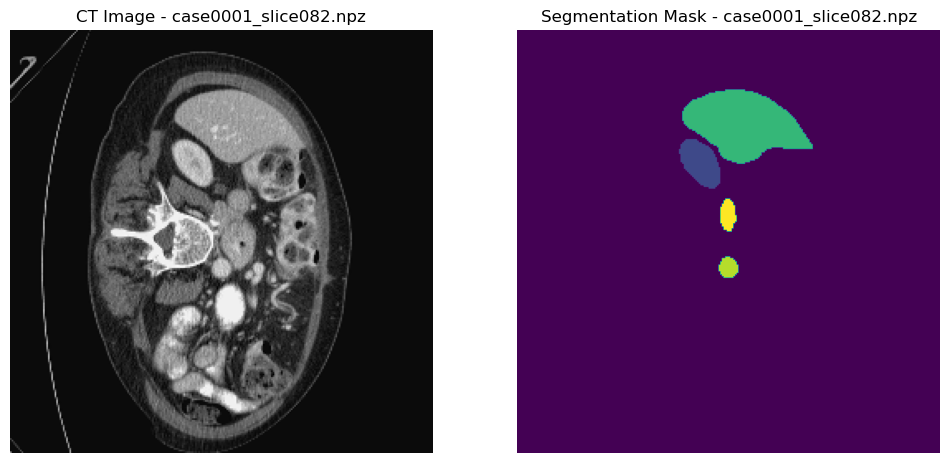


Visualizing case0001_slice083.npz:
Image min: -0.06920606750878415, max: 1.0660360041293726, shape: (256, 256)
Label unique values: [0. 2. 6. 7. 8. 9.], shape: (256, 256)


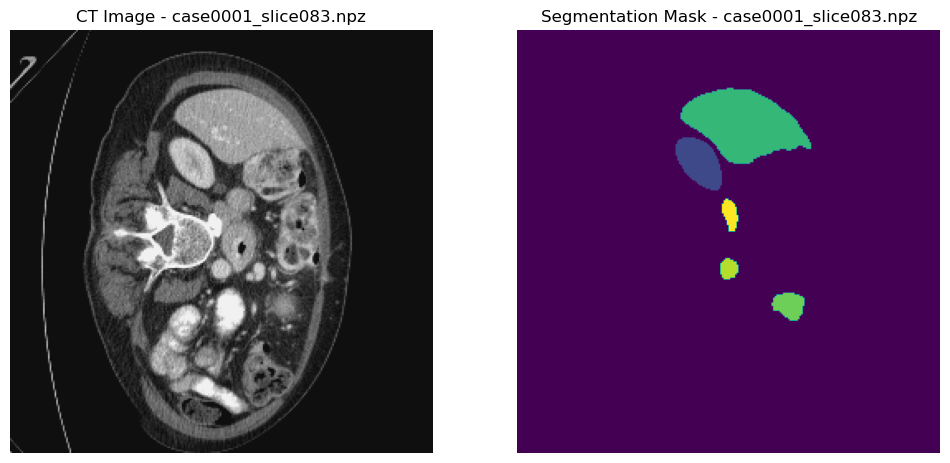


Visualizing case0001_slice084.npz:
Image min: -0.0424413645317924, max: 1.0540112205278098, shape: (256, 256)
Label unique values: [ 0.  2.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


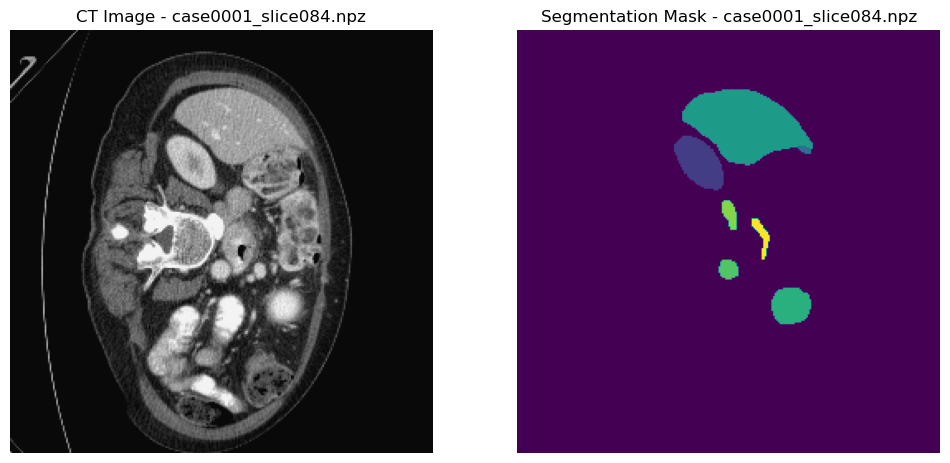


Visualizing case0001_slice085.npz:
Image min: -0.04931814201540762, max: 1.0519270878794844, shape: (256, 256)
Label unique values: [ 0.  2.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


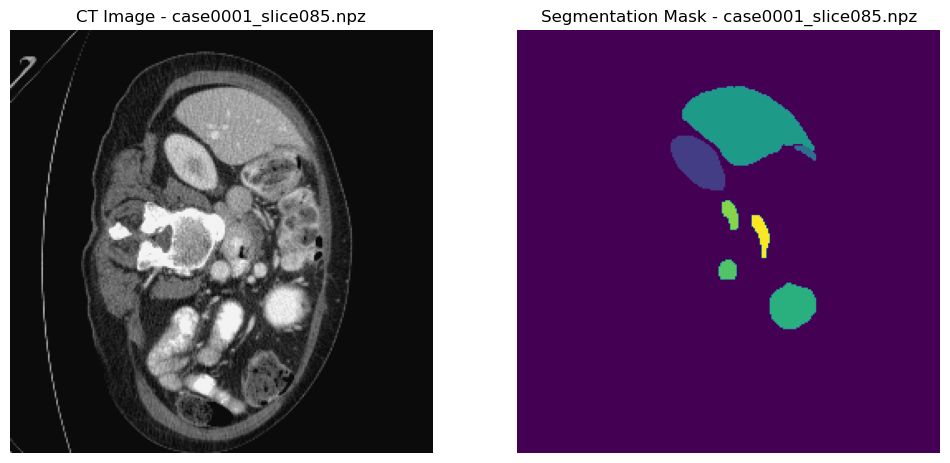


Visualizing case0001_slice086.npz:
Image min: -0.049922225513254107, max: 1.0524344444964528, shape: (256, 256)
Label unique values: [ 0.  2.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


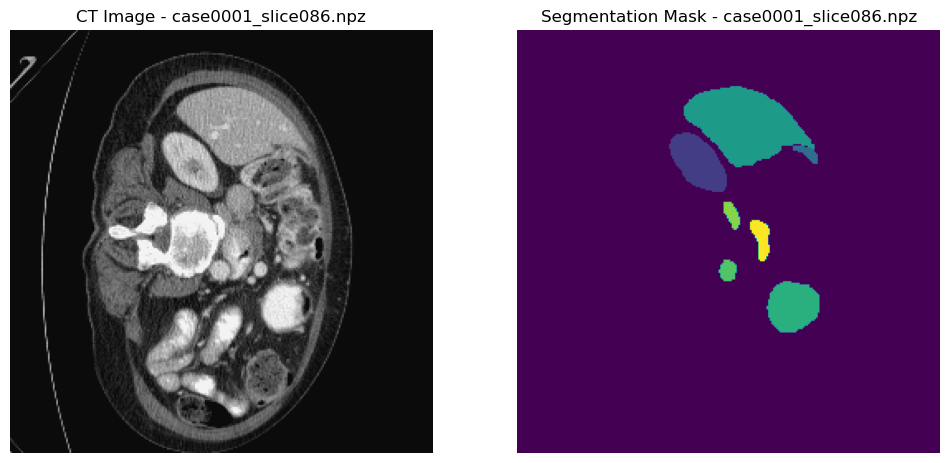


Visualizing case0001_slice087.npz:
Image min: -0.052658164148889394, max: 1.0727893544082976, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


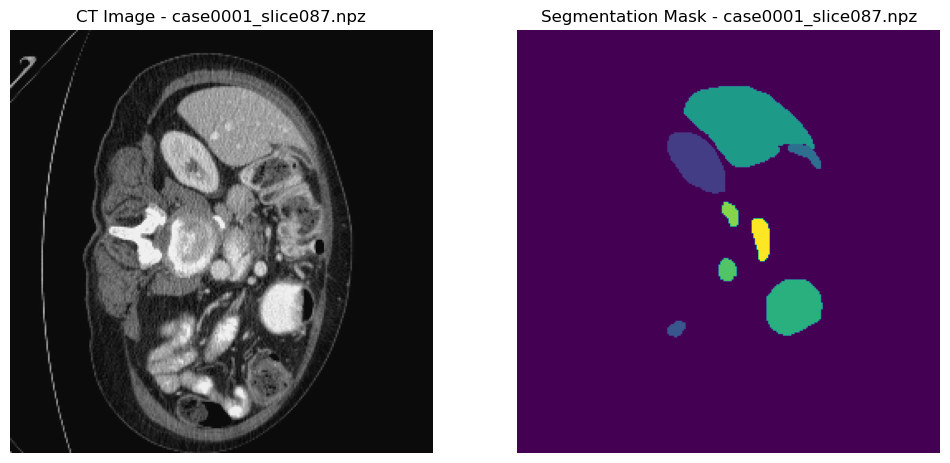


Visualizing case0001_slice088.npz:
Image min: -0.04452219074811922, max: 1.0534517782381003, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


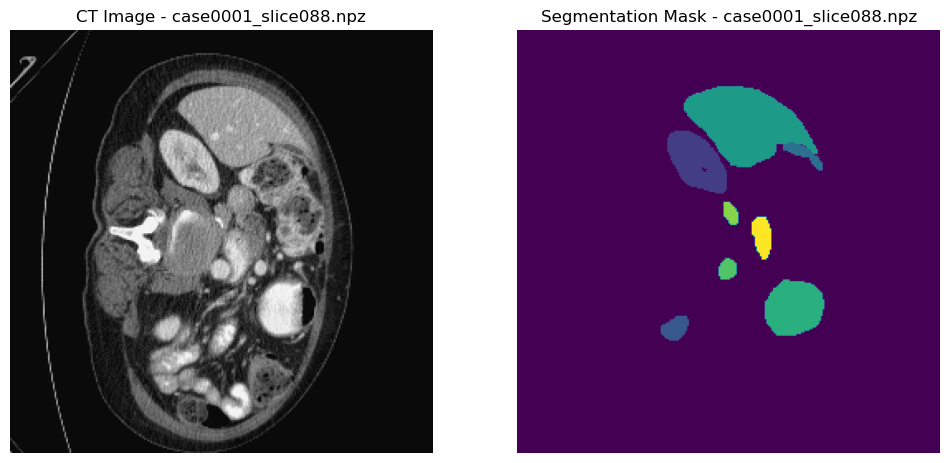


Visualizing case0001_slice089.npz:
Image min: -0.05605096247105405, max: 1.0496269467835582, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


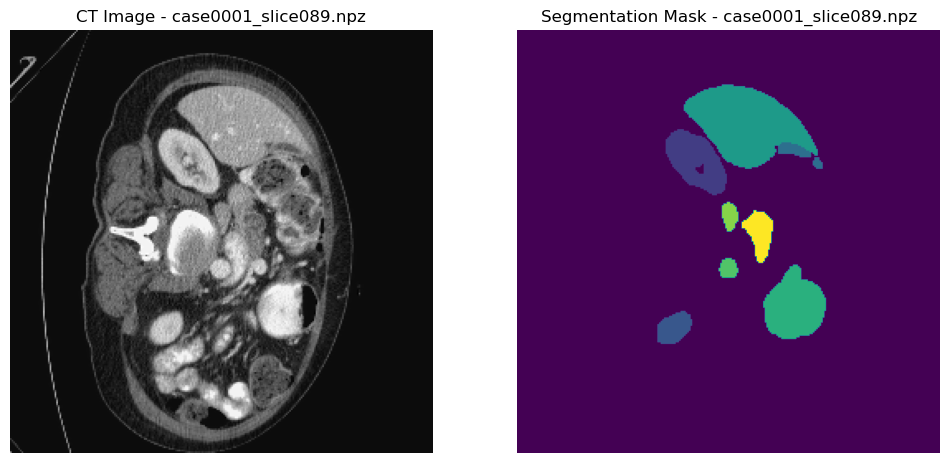


Visualizing case0001_slice090.npz:
Image min: -0.05477524053417604, max: 1.0563443260493153, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


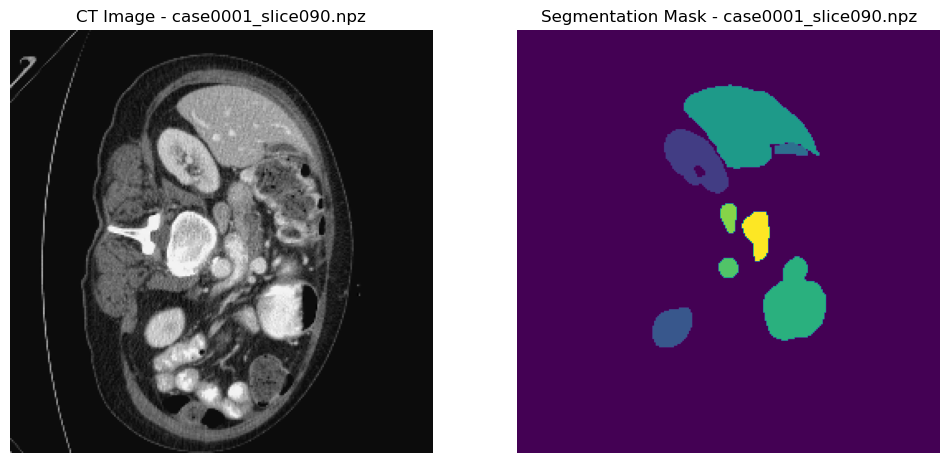


Visualizing case0001_slice091.npz:
Image min: -0.07420765002345299, max: 1.0614422579960272, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


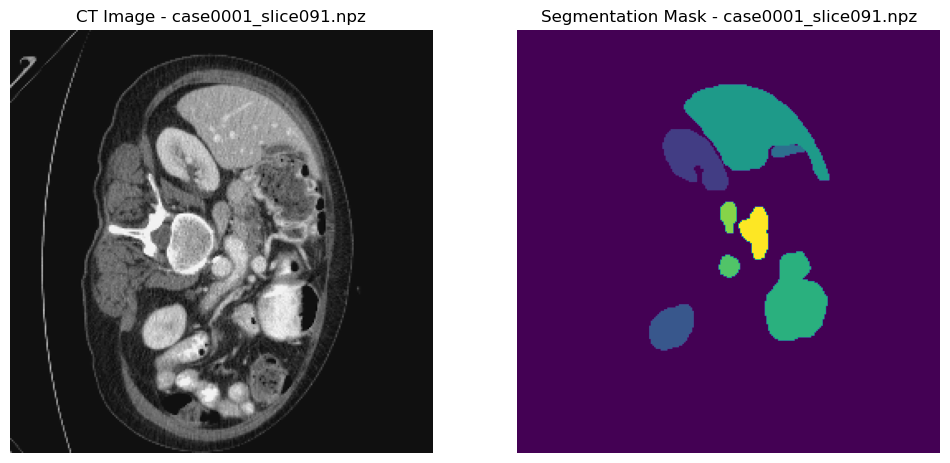


Visualizing case0001_slice092.npz:
Image min: -0.04818919218557041, max: 1.0607297623995935, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


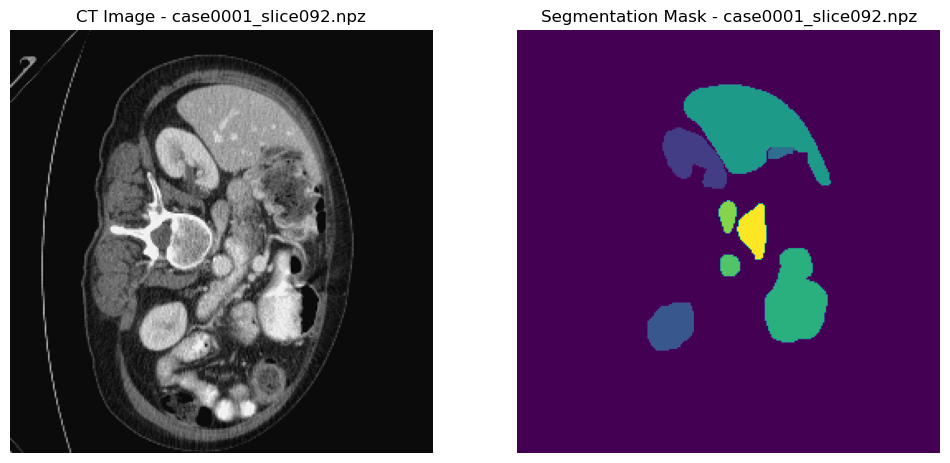


Visualizing case0001_slice093.npz:
Image min: -0.04915076073526377, max: 1.0557048921505279, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


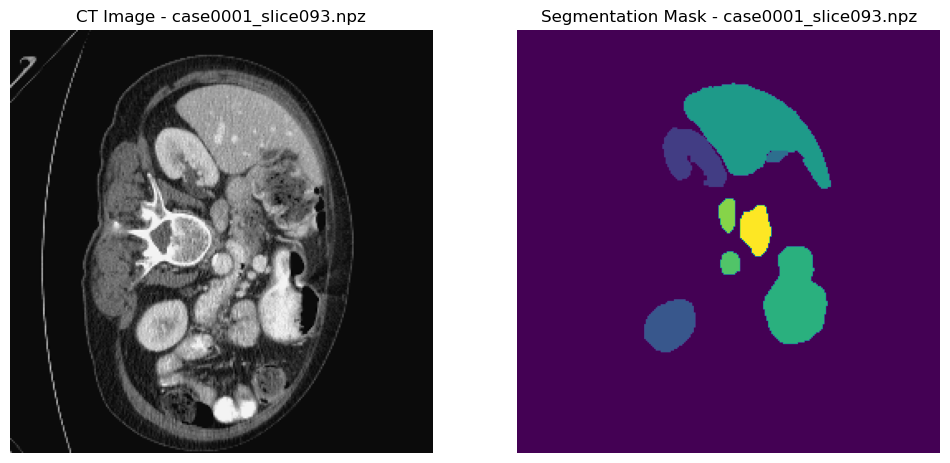


Visualizing case0001_slice094.npz:
Image min: -0.0595878693950373, max: 1.0646662949964452, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


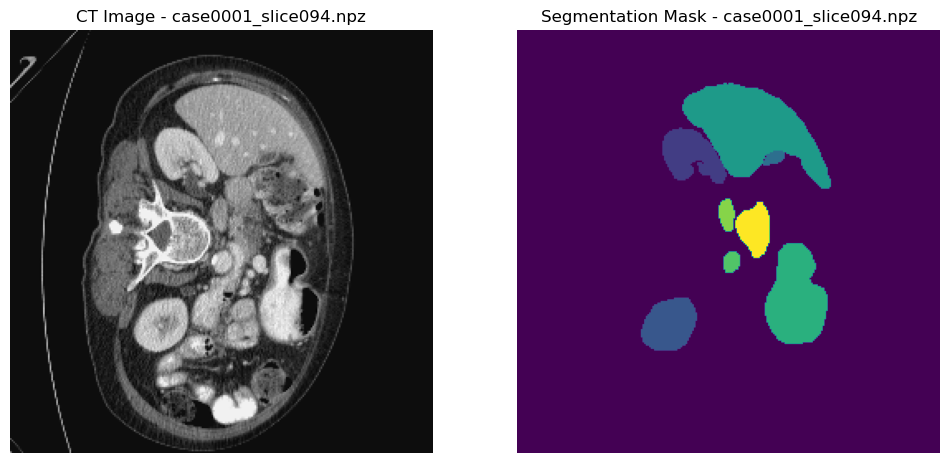


Visualizing case0001_slice095.npz:
Image min: -0.051051866473044154, max: 1.0503731244627585, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


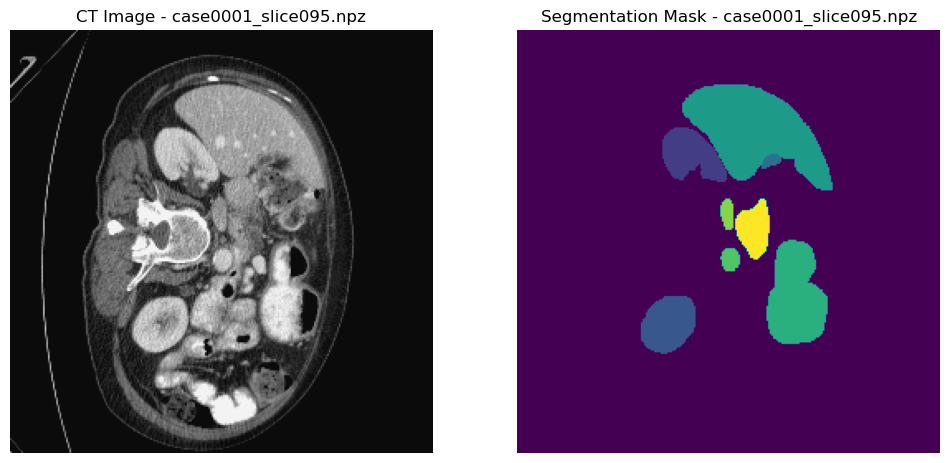


Visualizing case0001_slice096.npz:
Image min: -0.06837508392669854, max: 1.0546236518278826, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


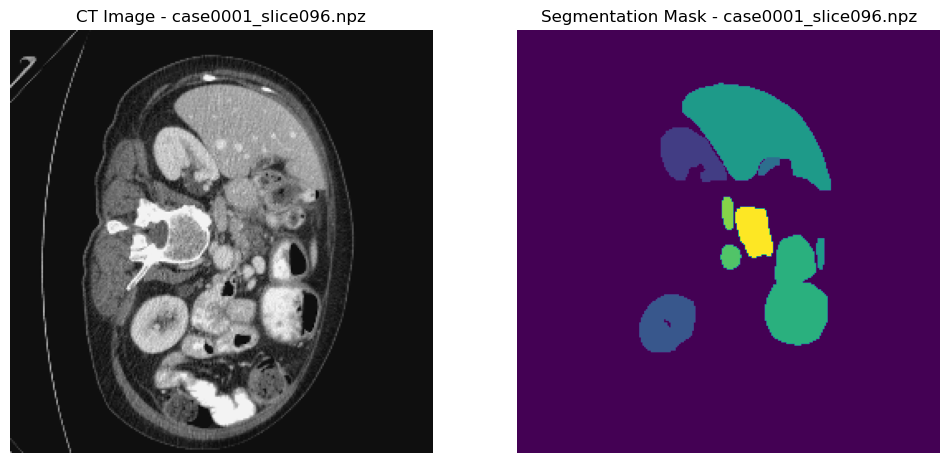


Visualizing case0001_slice097.npz:
Image min: -0.0633290141999232, max: 1.045412550809974, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


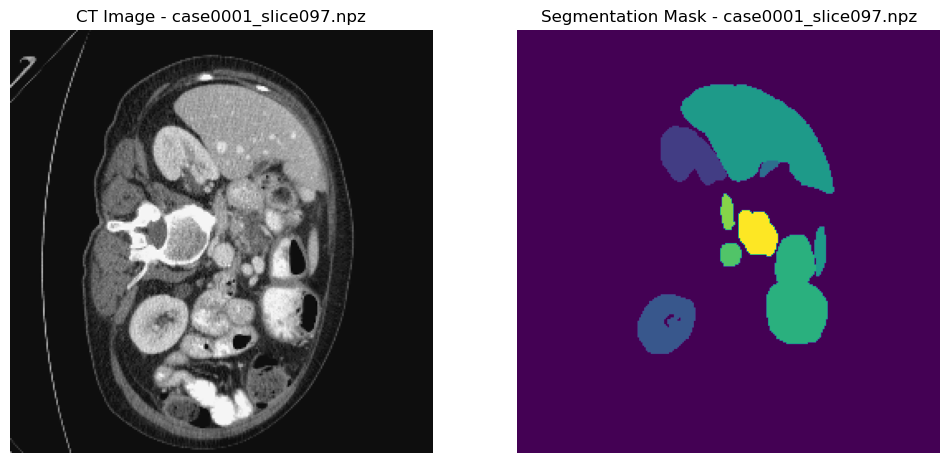


Visualizing case0001_slice098.npz:
Image min: -0.05165308904977954, max: 1.0603124184866797, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


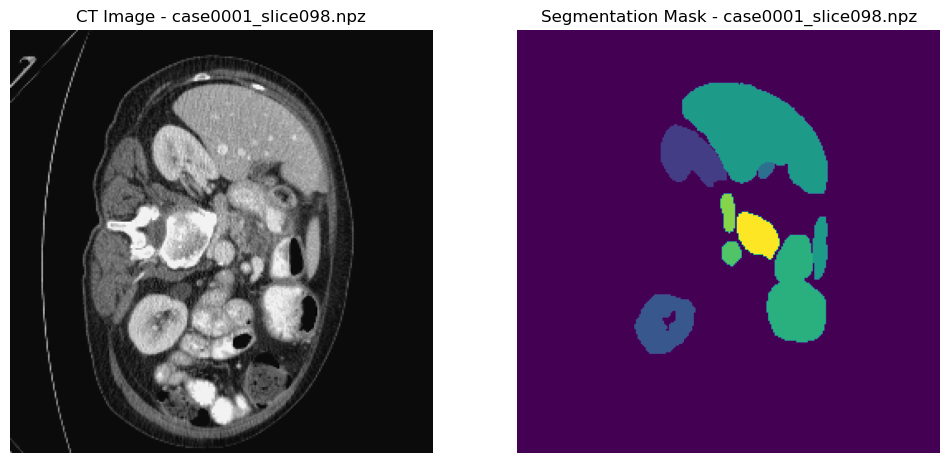


Visualizing case0001_slice099.npz:
Image min: -0.05214065399094882, max: 1.056563390170539, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


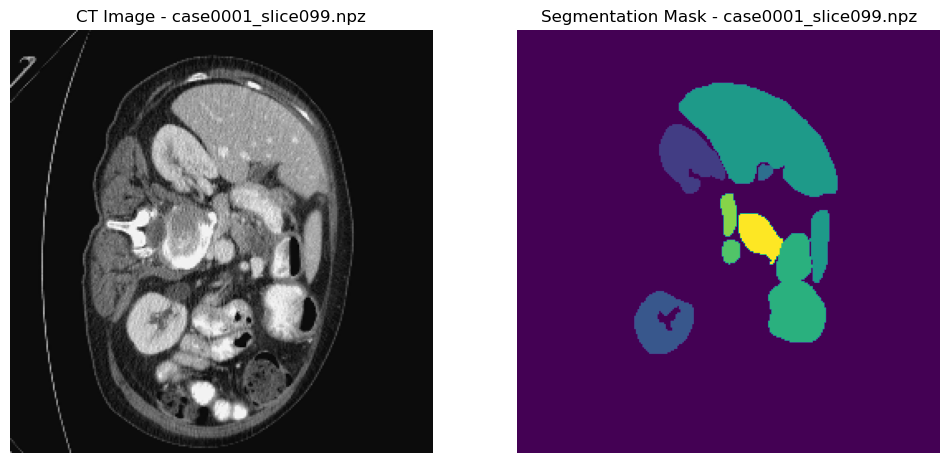


Visualizing case0001_slice100.npz:
Image min: -0.052807704099966386, max: 1.063023393099624, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


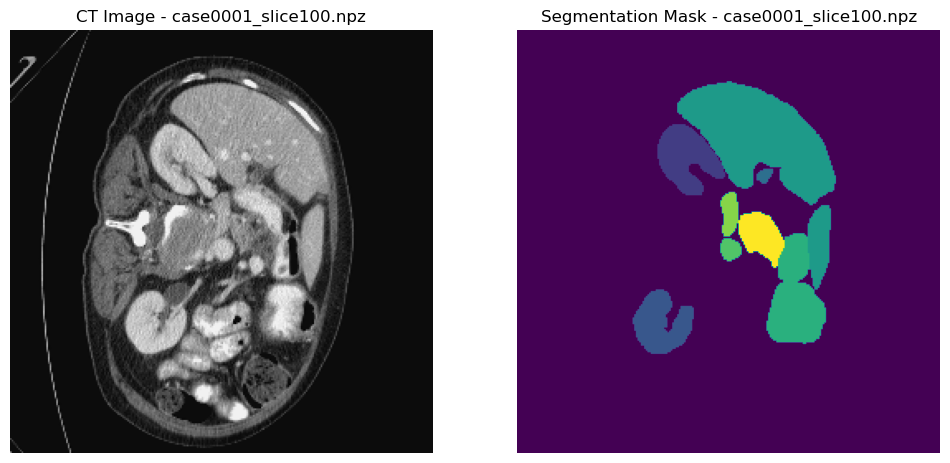


Visualizing case0001_slice101.npz:
Image min: -0.05035841581524131, max: 1.0514348549792965, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


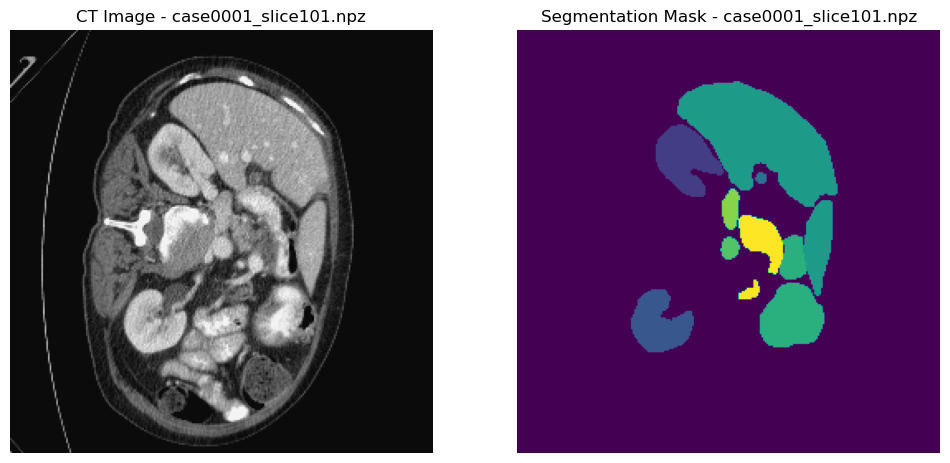


Visualizing case0001_slice102.npz:
Image min: -0.04315140629334802, max: 1.052171924887966, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


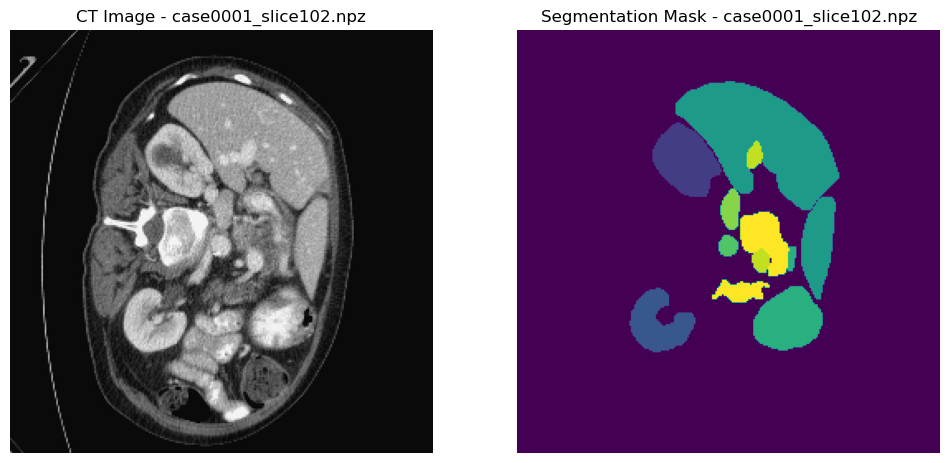


Visualizing case0001_slice103.npz:
Image min: -0.049276044354455754, max: 1.0659423413137143, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


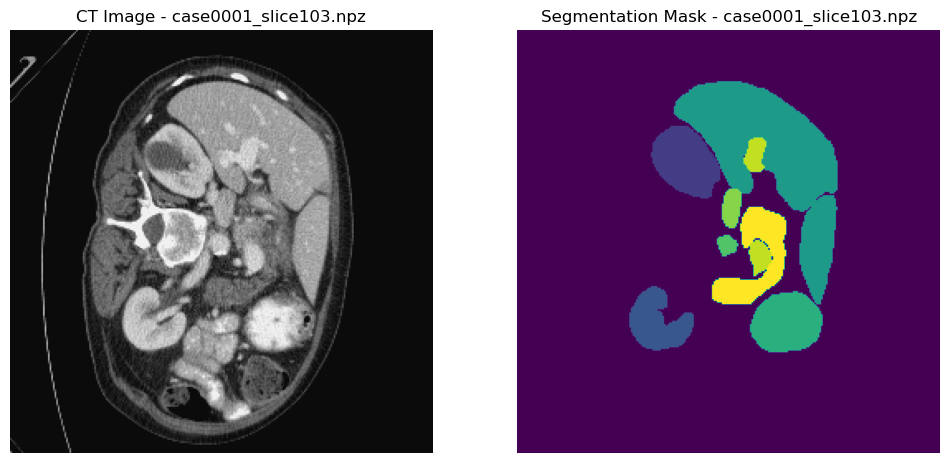


Visualizing case0001_slice104.npz:
Image min: -0.04755612219734115, max: 1.0698123577629568, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


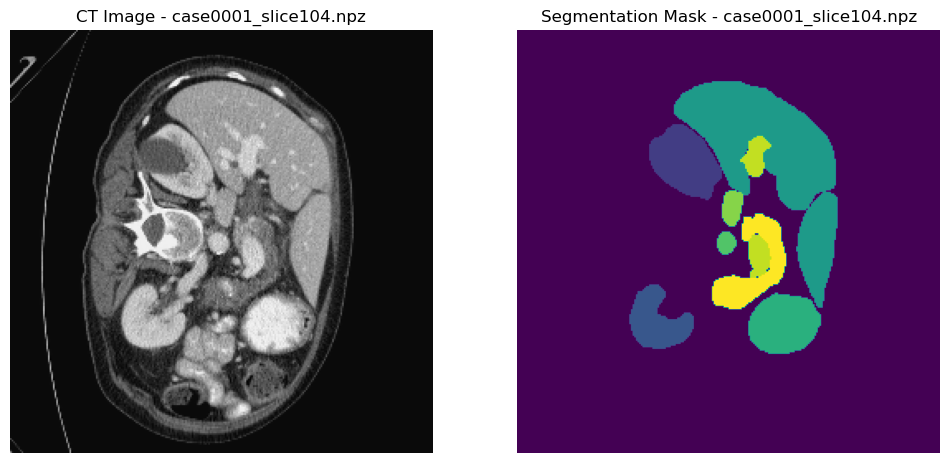


Visualizing case0001_slice105.npz:
Image min: -0.048698829279240054, max: 1.0483394914171784, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


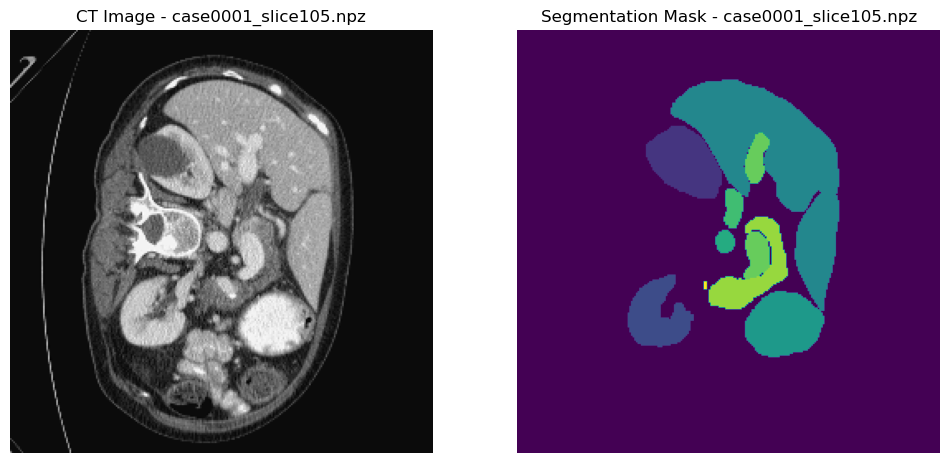


Visualizing case0001_slice106.npz:
Image min: -0.049070798439857934, max: 1.057061605323984, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


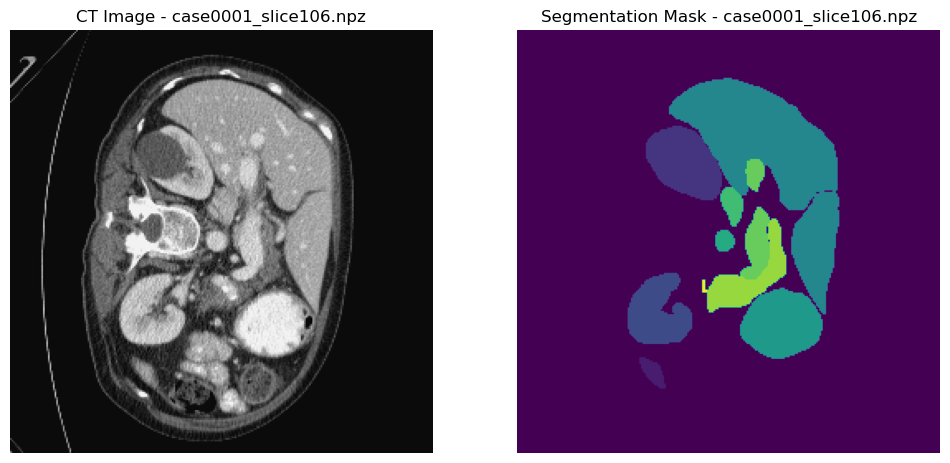


Visualizing case0001_slice107.npz:
Image min: -0.05583797071100844, max: 1.052677177141645, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


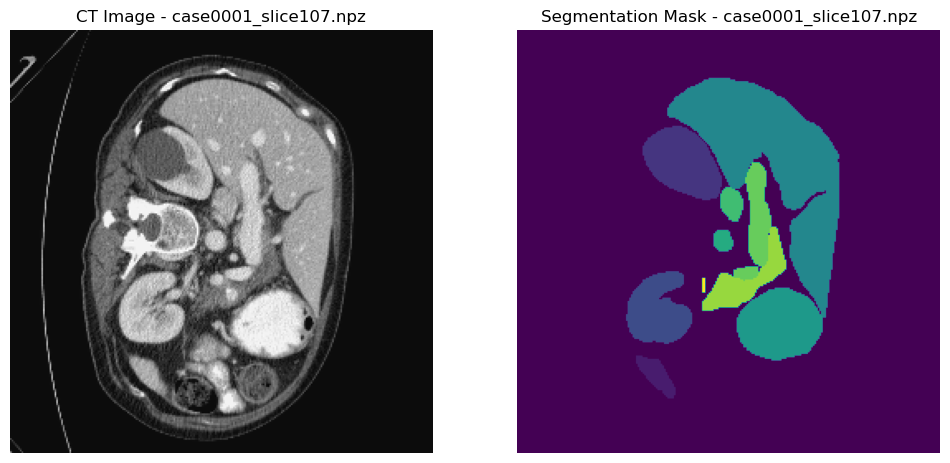


Visualizing case0001_slice108.npz:
Image min: -0.04657898766129943, max: 1.0490839415172075, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


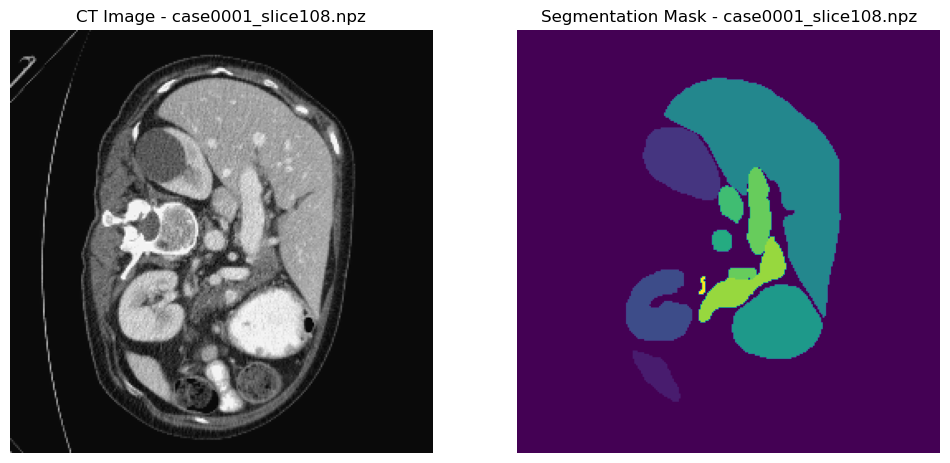


Visualizing case0001_slice109.npz:
Image min: -0.05063808734221825, max: 1.0492206571604004, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


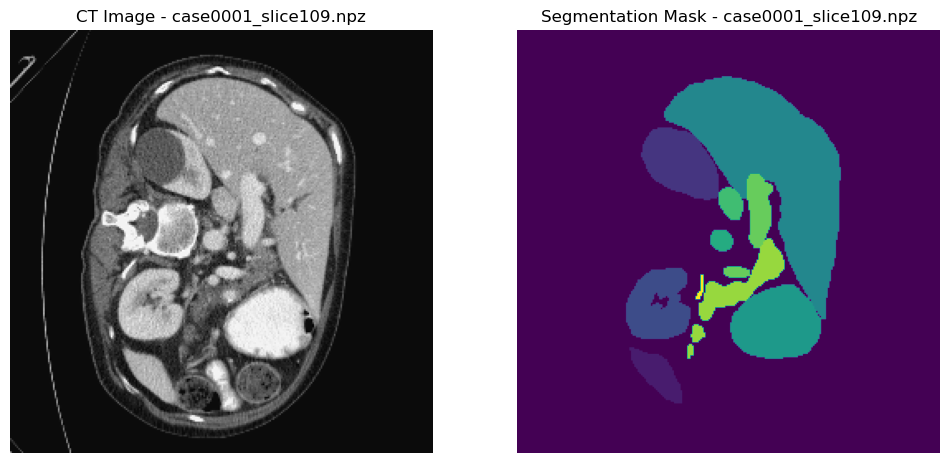


Visualizing case0001_slice110.npz:
Image min: -0.05003466984422657, max: 1.063215275274121, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


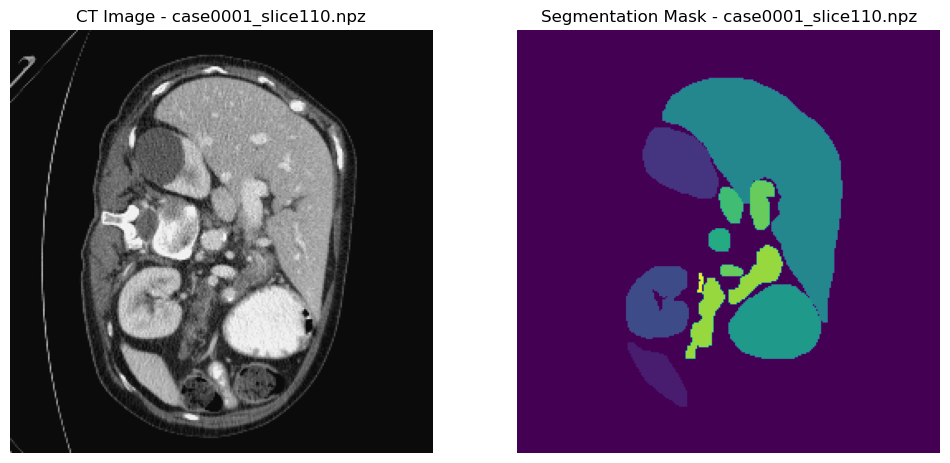


Visualizing case0001_slice111.npz:
Image min: -0.043806917836893354, max: 1.0573326016883184, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


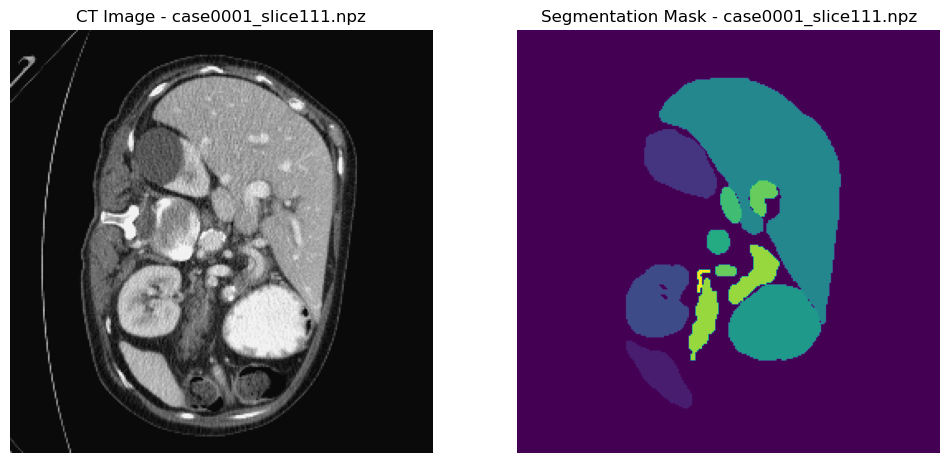


Visualizing case0001_slice112.npz:
Image min: -0.046734077035022616, max: 1.0663451347085762, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 12. 13.], shape: (256, 256)


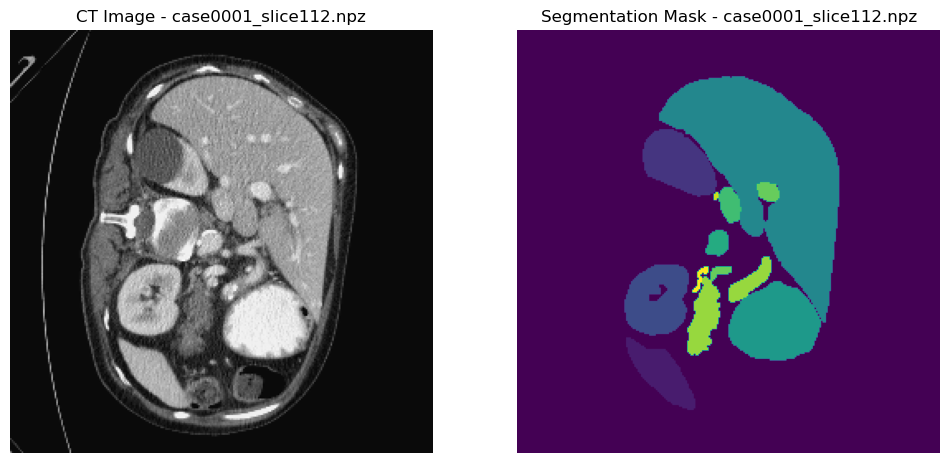


Visualizing case0001_slice113.npz:
Image min: -0.052411794956476, max: 1.0640358442693292, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 12. 13.], shape: (256, 256)


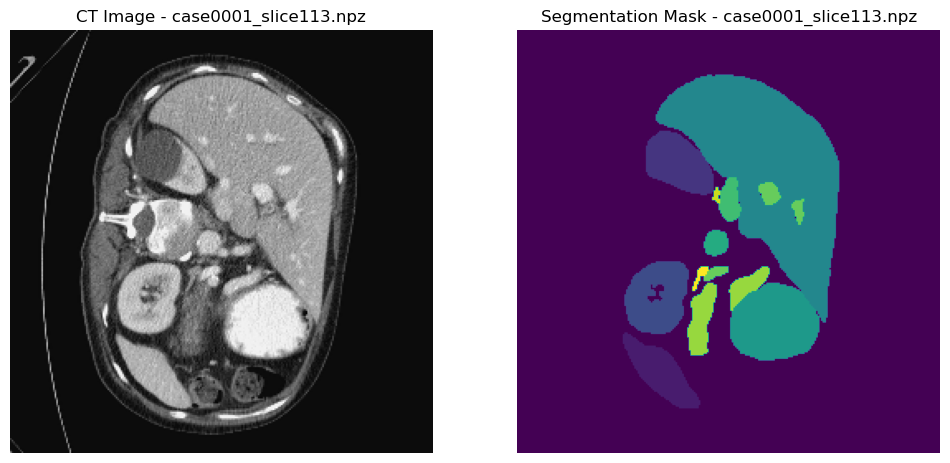


Visualizing case0001_slice114.npz:
Image min: -0.058229884836086675, max: 1.0479580416653274, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 12. 13.], shape: (256, 256)


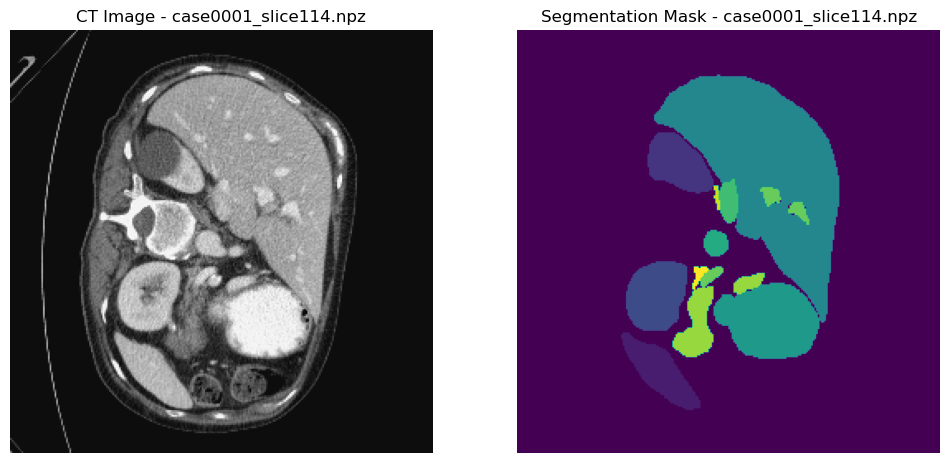


Visualizing case0001_slice115.npz:
Image min: -0.05748652421023904, max: 1.048147157171045, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 12. 13.], shape: (256, 256)


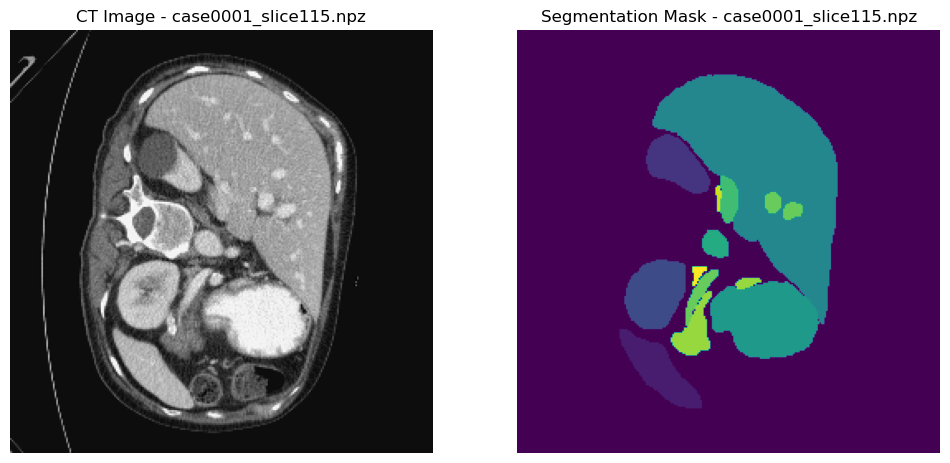


Visualizing case0001_slice116.npz:
Image min: -0.048537801111466085, max: 1.0621244727086705, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 12. 13.], shape: (256, 256)


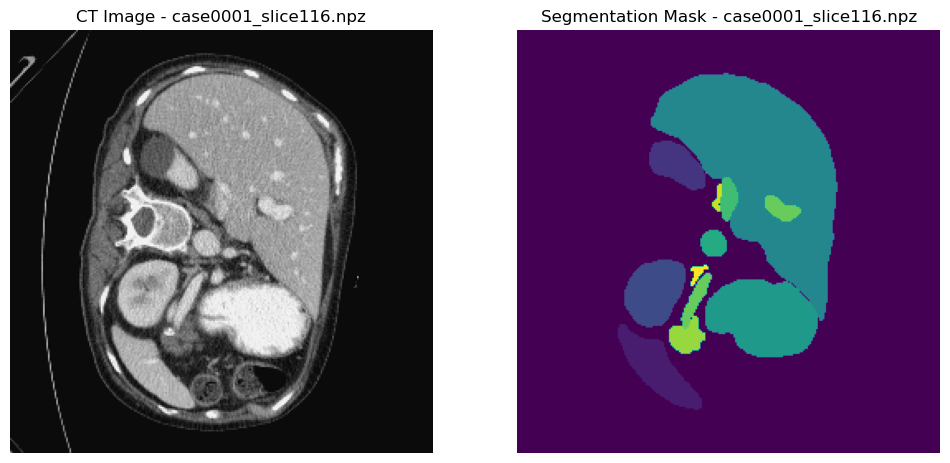


Visualizing case0001_slice117.npz:
Image min: -0.06001357466412637, max: 1.0473665837150004, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 12. 13.], shape: (256, 256)


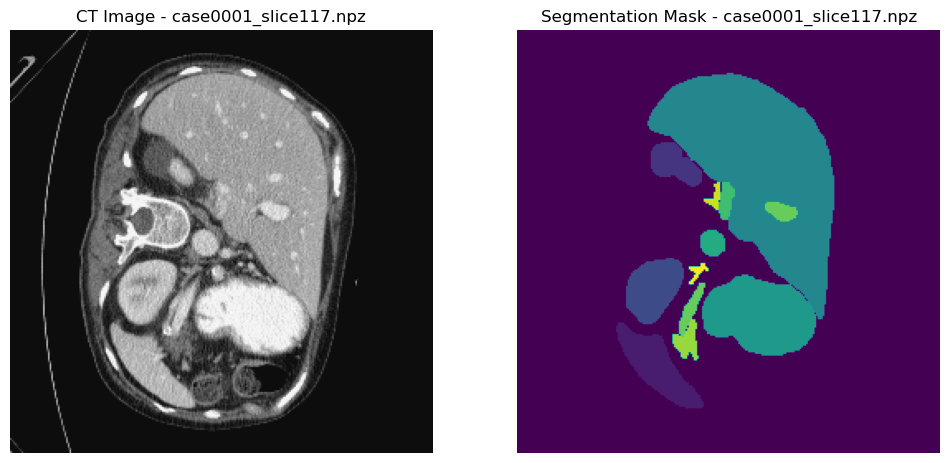


Visualizing case0001_slice118.npz:
Image min: -0.043208273886241995, max: 1.0545940254636352, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 12. 13.], shape: (256, 256)


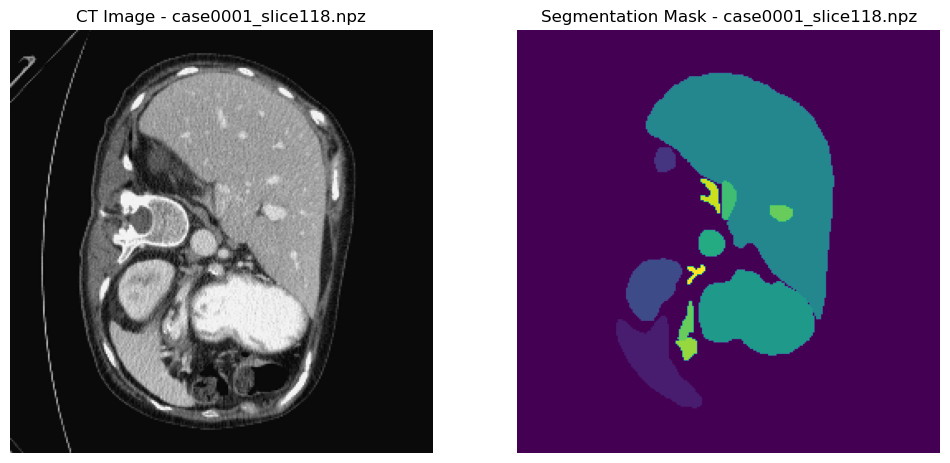


Visualizing case0001_slice119.npz:
Image min: -0.0613467020072289, max: 1.061831957134014, shape: (256, 256)
Label unique values: [ 0.  1.  3.  6.  7.  8.  9. 10. 12. 13.], shape: (256, 256)


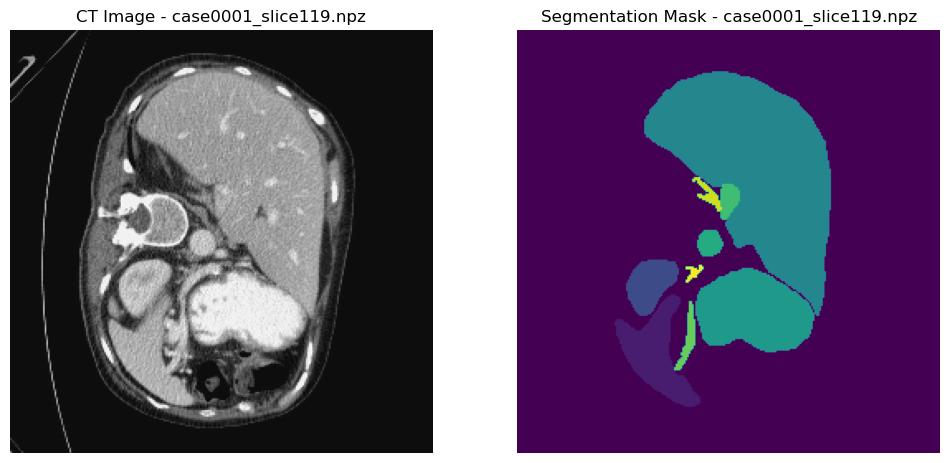


Visualizing case0001_slice120.npz:
Image min: -0.10842608046764873, max: 1.0608971469379416, shape: (256, 256)
Label unique values: [ 0.  1.  3.  6.  7.  8.  9. 10. 12. 13.], shape: (256, 256)


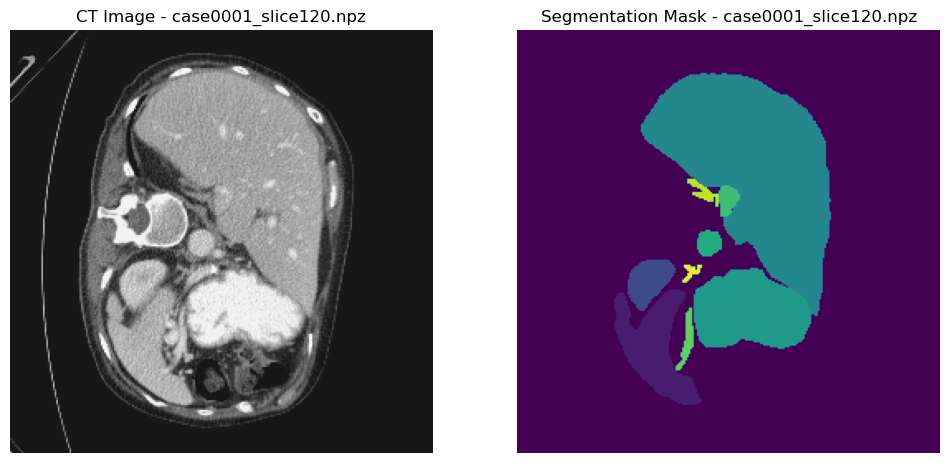


Visualizing case0001_slice121.npz:
Image min: -0.06896236152474061, max: 1.062817380820558, shape: (256, 256)
Label unique values: [ 0.  1.  3.  6.  7.  8.  9. 10. 12. 13.], shape: (256, 256)


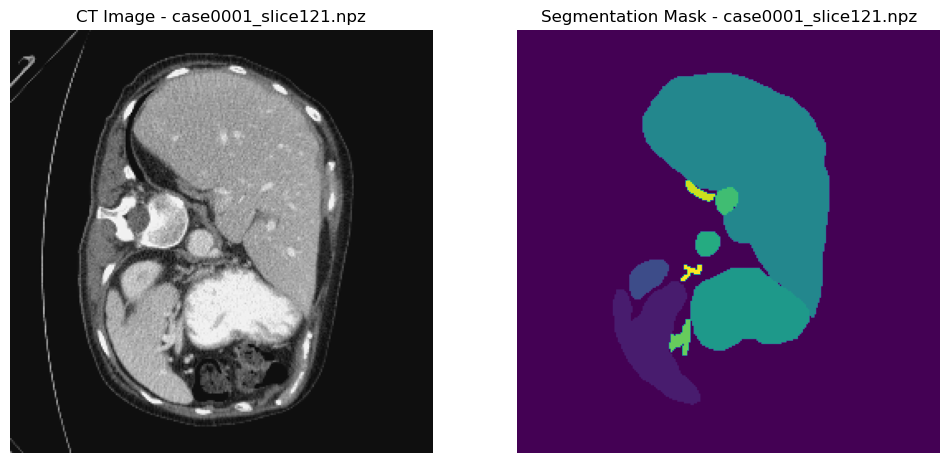


Visualizing case0001_slice122.npz:
Image min: -0.06970041923729302, max: 1.0534230465849383, shape: (256, 256)
Label unique values: [ 0.  1.  3.  6.  7.  8.  9. 10. 12. 13.], shape: (256, 256)


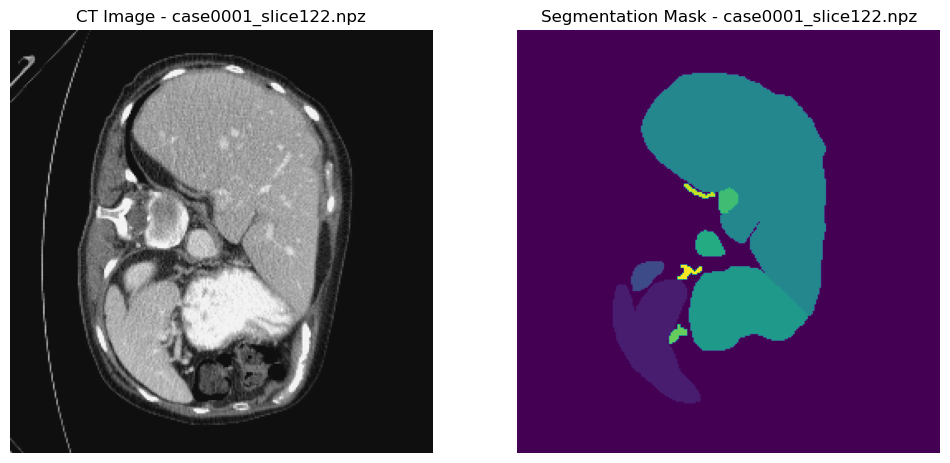


Visualizing case0001_slice123.npz:
Image min: -0.0584684566589463, max: 1.0528955184272286, shape: (256, 256)
Label unique values: [ 0.  1.  3.  6.  7.  8.  9. 12. 13.], shape: (256, 256)


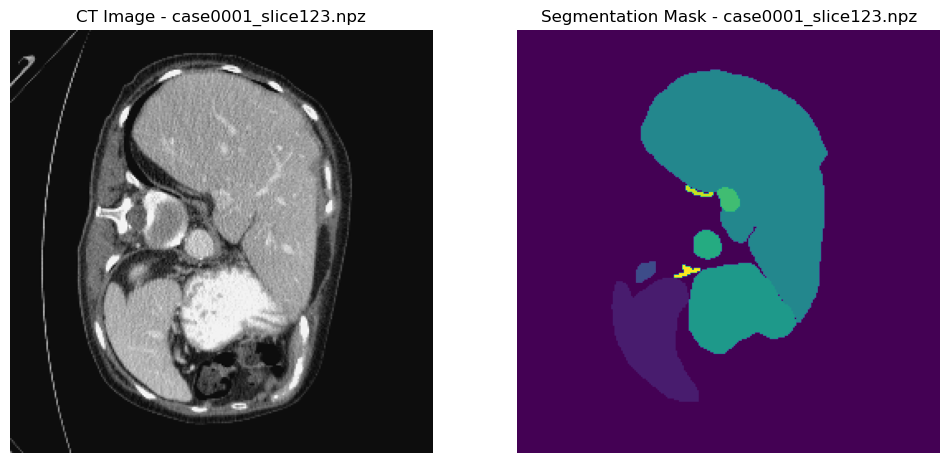


Visualizing case0001_slice124.npz:
Image min: -0.053105422365485926, max: 1.0553495437684888, shape: (256, 256)
Label unique values: [ 0.  1.  6.  7.  8.  9. 13.], shape: (256, 256)


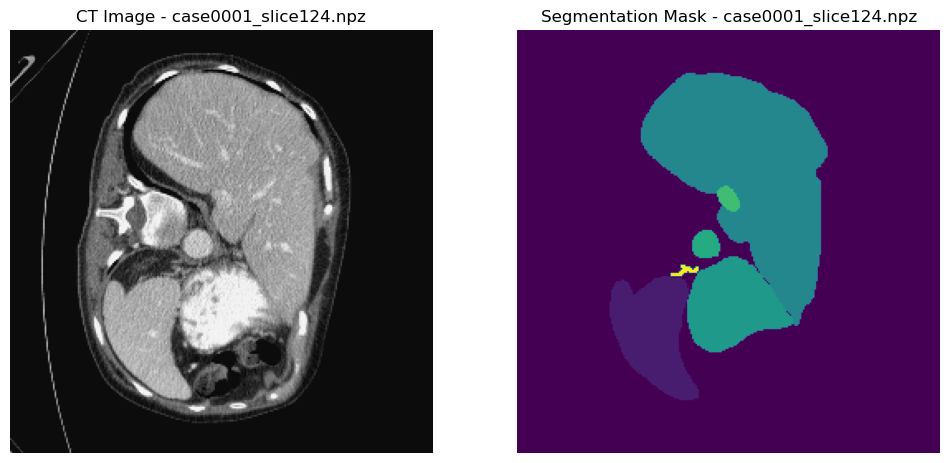


Visualizing case0001_slice125.npz:
Image min: -0.07230707376158453, max: 1.050080833206254, shape: (256, 256)
Label unique values: [ 0.  1.  6.  7.  8.  9. 13.], shape: (256, 256)


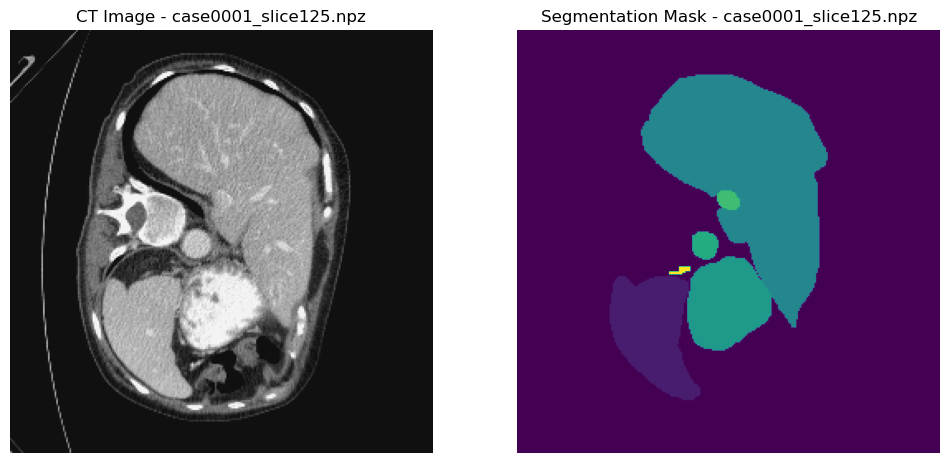


Visualizing case0001_slice126.npz:
Image min: -0.09110186494142888, max: 1.0540753851003732, shape: (256, 256)
Label unique values: [ 0.  1.  6.  7.  8.  9. 13.], shape: (256, 256)


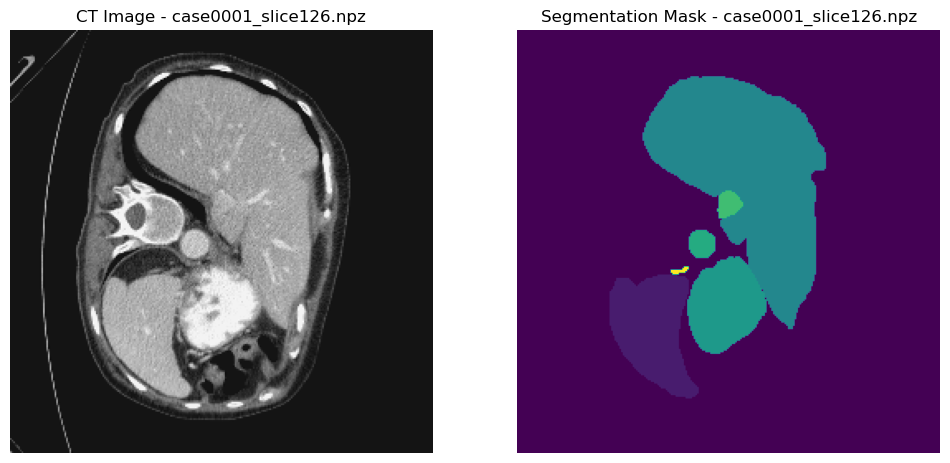


Visualizing case0001_slice127.npz:
Image min: -0.1184933992864222, max: 1.0728765506058018, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


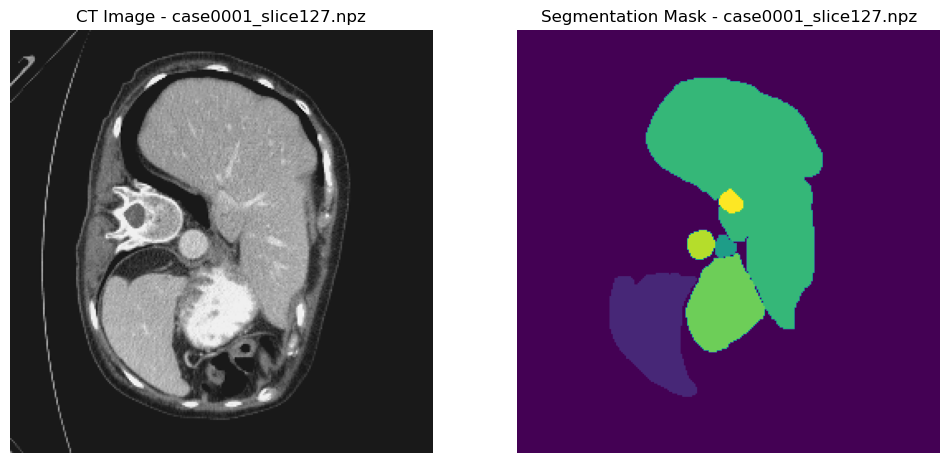


Visualizing case0001_slice128.npz:
Image min: -0.07466042846101267, max: 1.0691171038266265, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


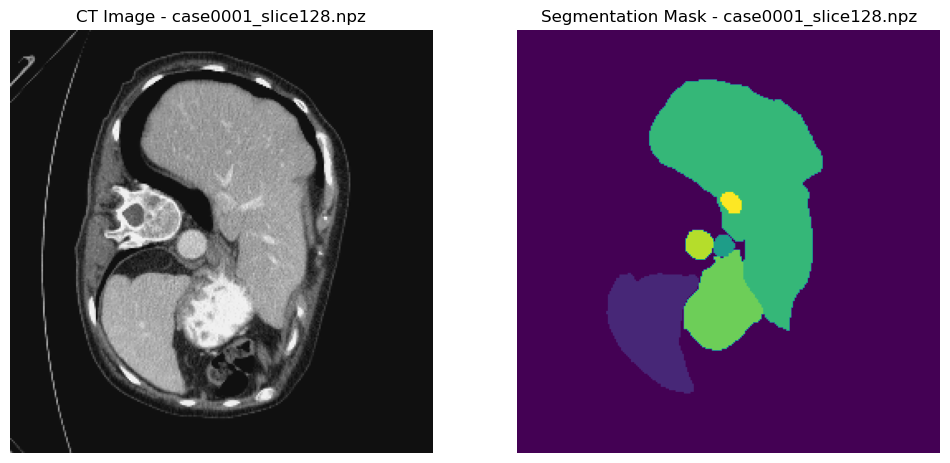


Visualizing case0001_slice129.npz:
Image min: -0.08027941016695346, max: 1.051866028453176, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


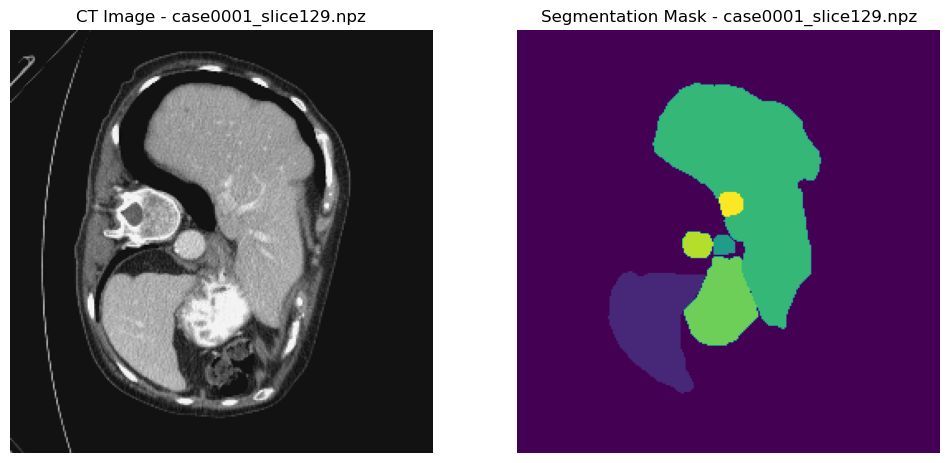


Visualizing case0001_slice130.npz:
Image min: -0.13242707425301165, max: 1.0547417717357337, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


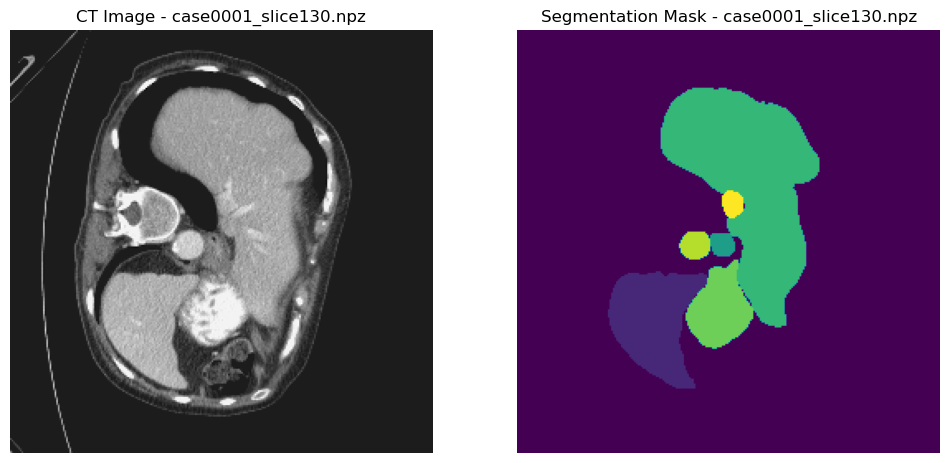


Visualizing case0001_slice131.npz:
Image min: -0.09224522379436582, max: 1.06147985857884, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


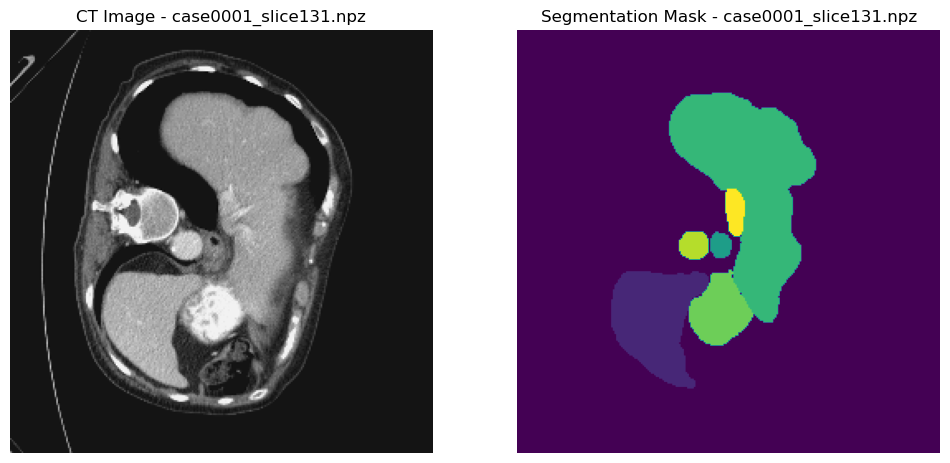


Visualizing case0001_slice132.npz:
Image min: -0.1355306606175339, max: 1.0592584011025352, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


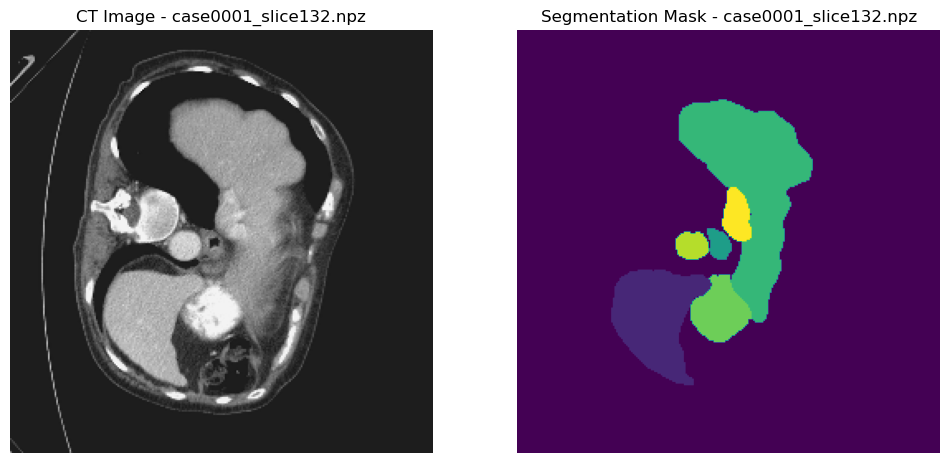


Visualizing case0001_slice133.npz:
Image min: -0.1080583348257209, max: 1.0575350984445457, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


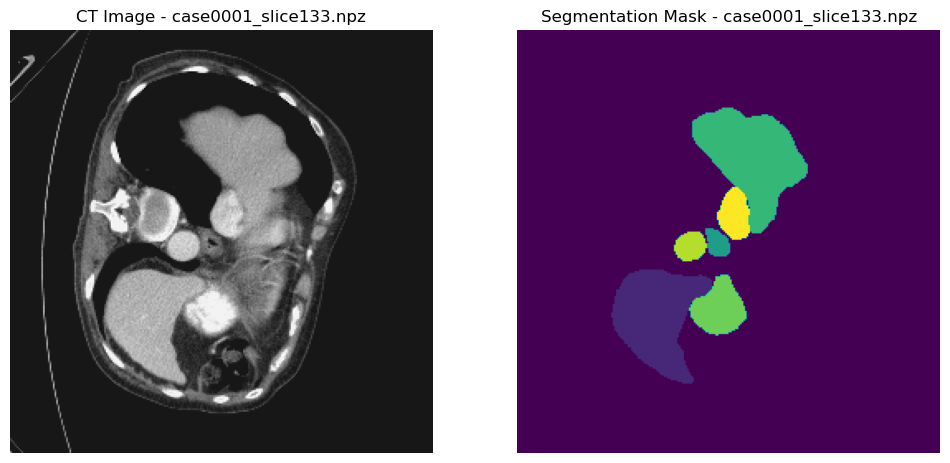


Visualizing case0001_slice134.npz:
Image min: -0.1378541242723343, max: 1.0683328965230883, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


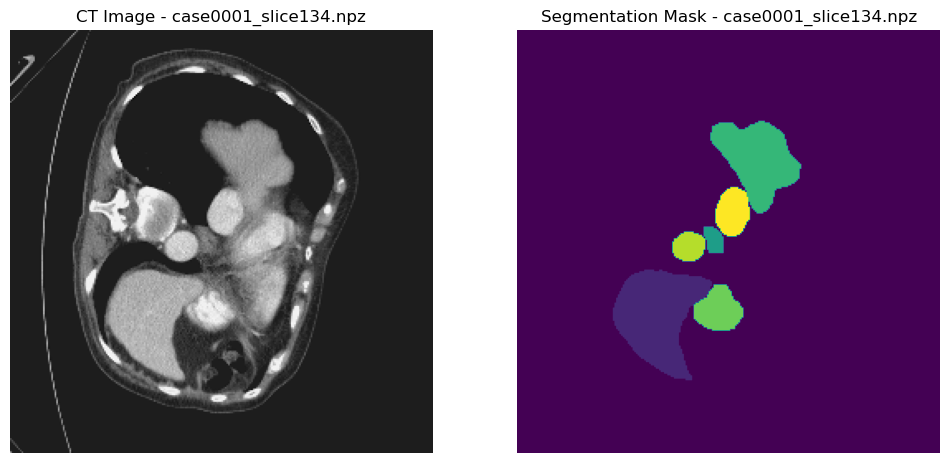


Visualizing case0001_slice135.npz:
Image min: -0.09683852601499683, max: 1.0705592515607862, shape: (256, 256)
Label unique values: [0. 1. 5. 6. 7. 8. 9.], shape: (256, 256)


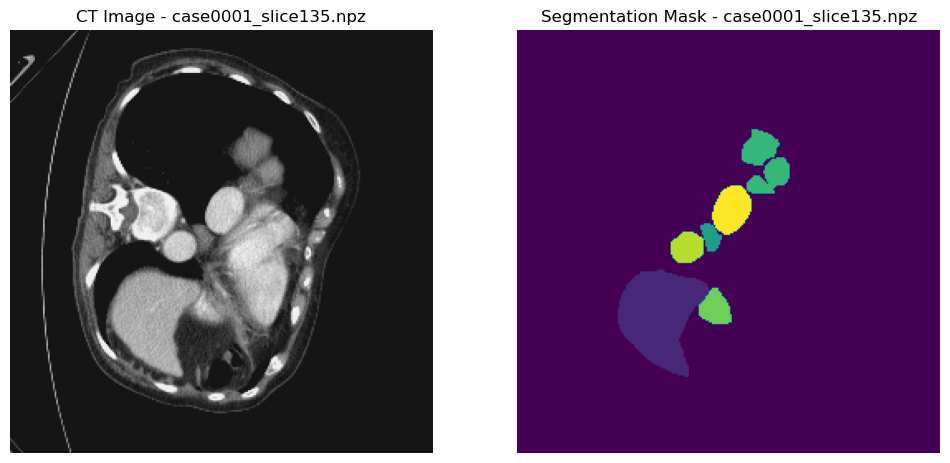


Visualizing case0001_slice136.npz:
Image min: -0.1509907966537251, max: 1.0657562199802564, shape: (256, 256)
Label unique values: [0. 1. 5. 8. 9.], shape: (256, 256)


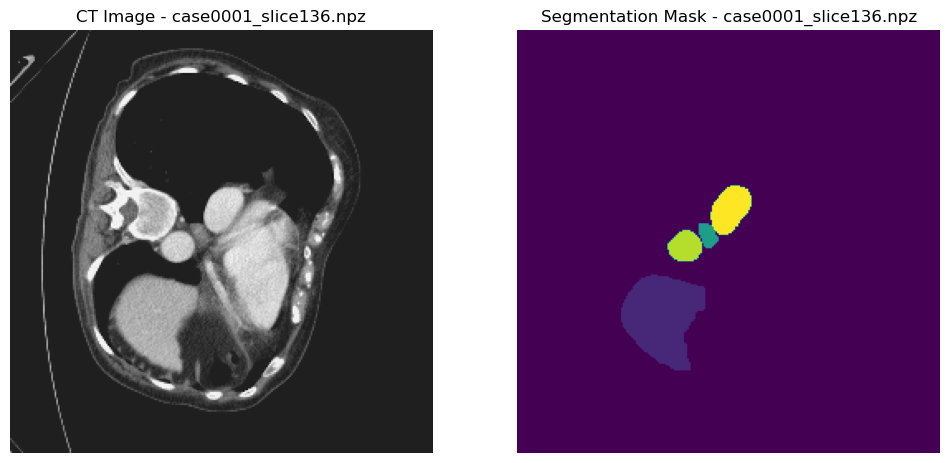


Visualizing case0001_slice137.npz:
Image min: -0.1178097466716033, max: 1.0649755060460584, shape: (256, 256)
Label unique values: [0. 1. 5. 8. 9.], shape: (256, 256)


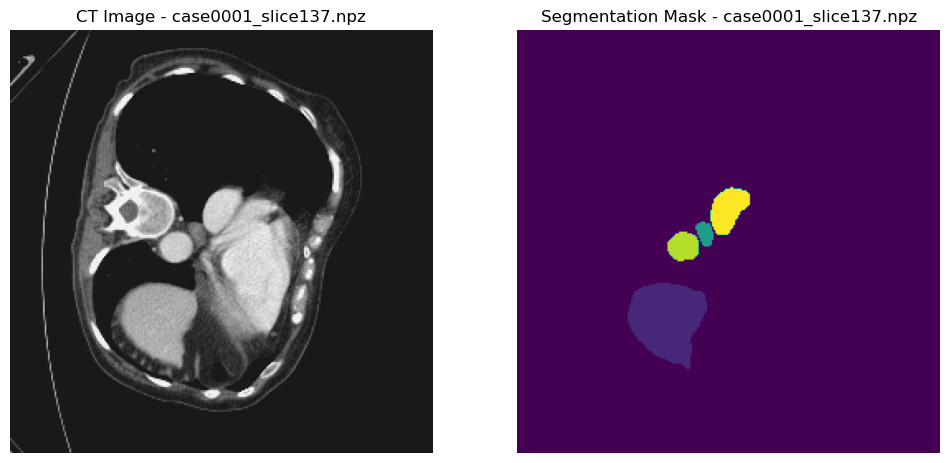


Visualizing case0001_slice138.npz:
Image min: -0.10605741350526757, max: 1.0647853664938092, shape: (256, 256)
Label unique values: [0. 1. 5. 8. 9.], shape: (256, 256)


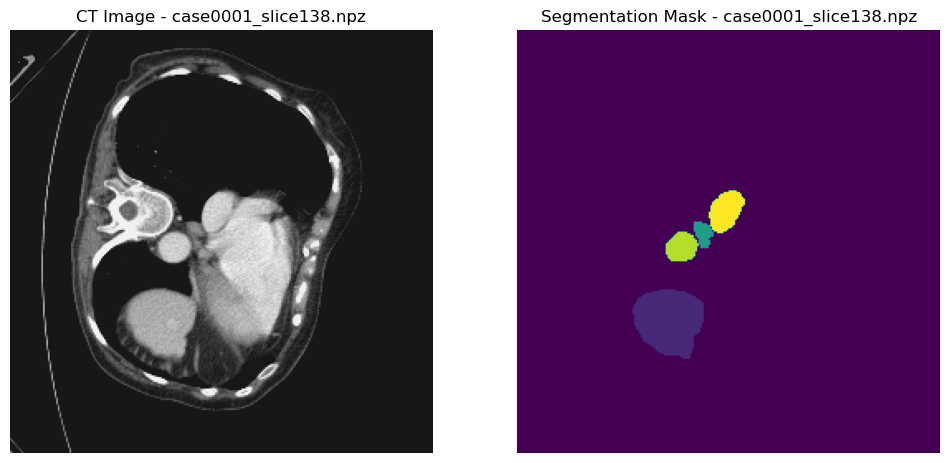


Visualizing case0001_slice139.npz:
Image min: -0.10802192419763793, max: 1.0701948204526162, shape: (256, 256)
Label unique values: [0. 1. 5. 8. 9.], shape: (256, 256)


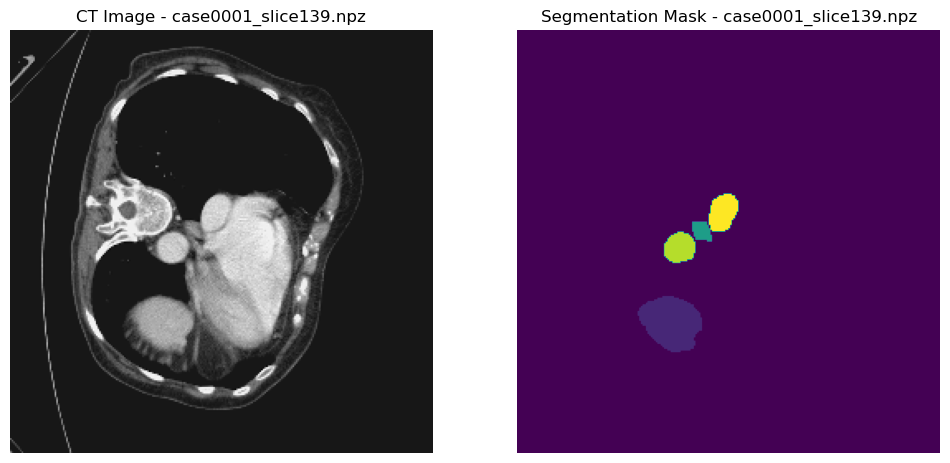


Visualizing case0001_slice140.npz:
Image min: -0.09654760697467048, max: 1.0613777447480772, shape: (256, 256)
Label unique values: [0. 1. 5. 8. 9.], shape: (256, 256)


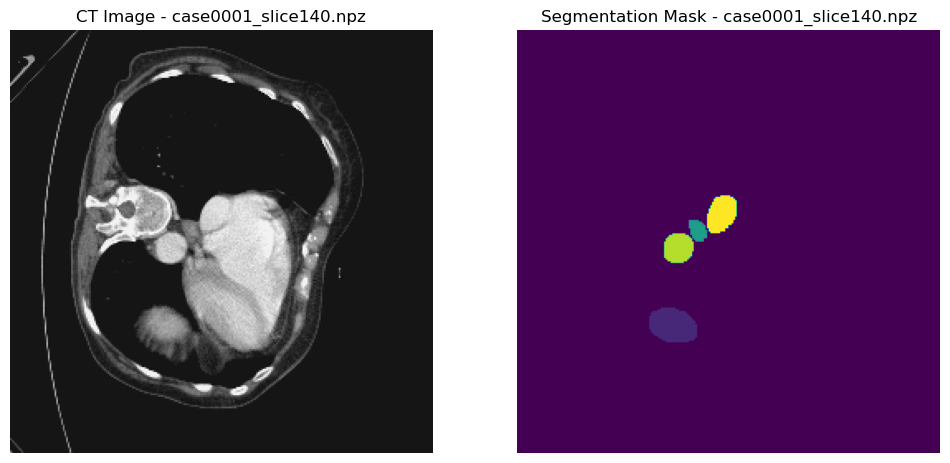


Visualizing case0001_slice141.npz:
Image min: -0.09789271985599987, max: 1.0498523124887418, shape: (256, 256)
Label unique values: [0. 5. 8. 9.], shape: (256, 256)


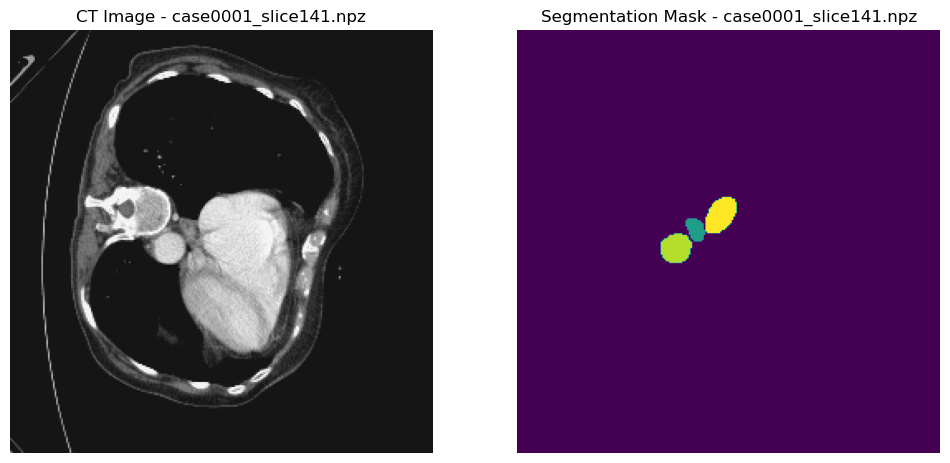


Visualizing case0001_slice142.npz:
Image min: -0.1322766451501262, max: 1.0557692989982104, shape: (256, 256)
Label unique values: [0. 5. 8. 9.], shape: (256, 256)


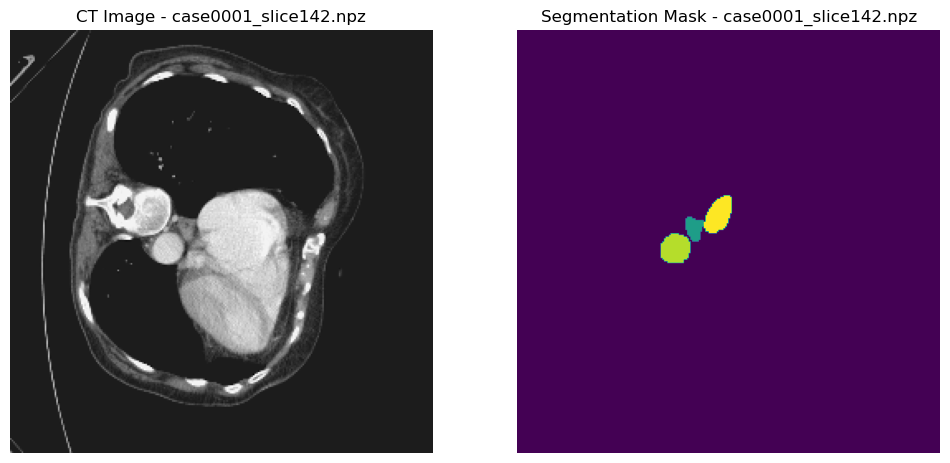


Visualizing case0001_slice143.npz:
Image min: -0.1184662970987134, max: 1.0658020469567502, shape: (256, 256)
Label unique values: [0. 5. 8. 9.], shape: (256, 256)


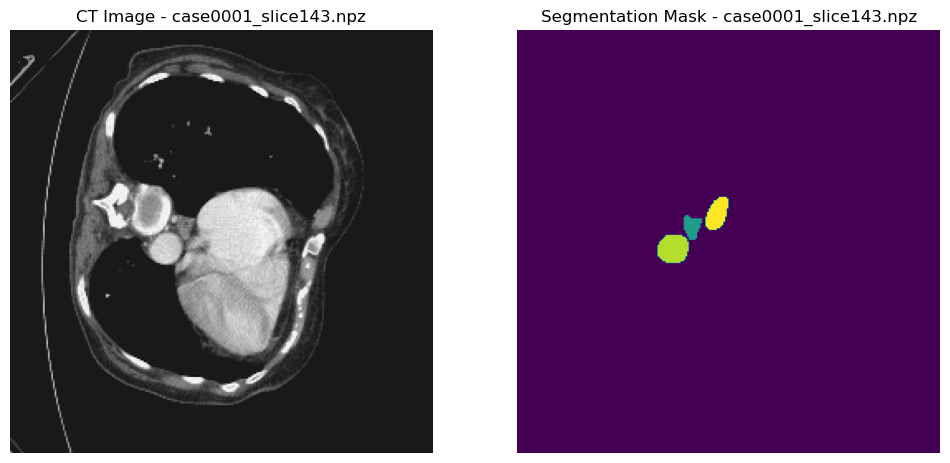


Visualizing case0001_slice144.npz:
Image min: -0.09743215026462126, max: 1.06892526992319, shape: (256, 256)
Label unique values: [0. 5. 8. 9.], shape: (256, 256)


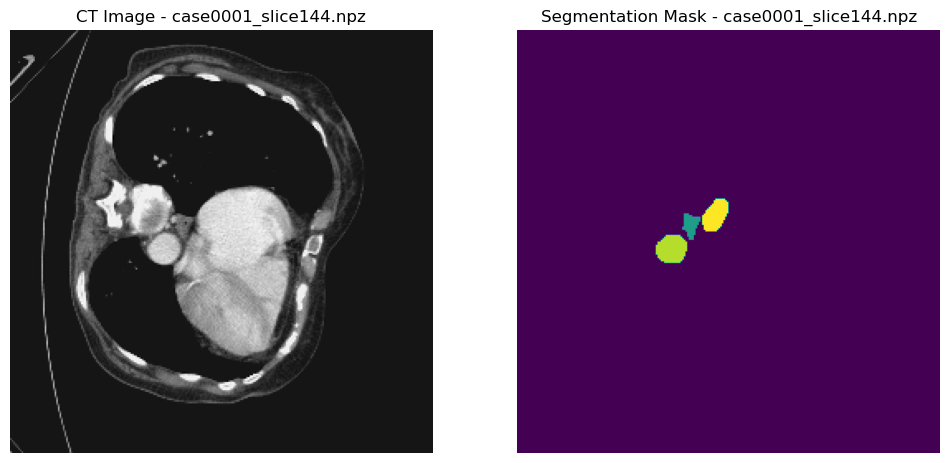


Visualizing case0001_slice145.npz:
Image min: -0.13400760099641348, max: 1.0626142271565737, shape: (256, 256)
Label unique values: [0. 5. 8. 9.], shape: (256, 256)


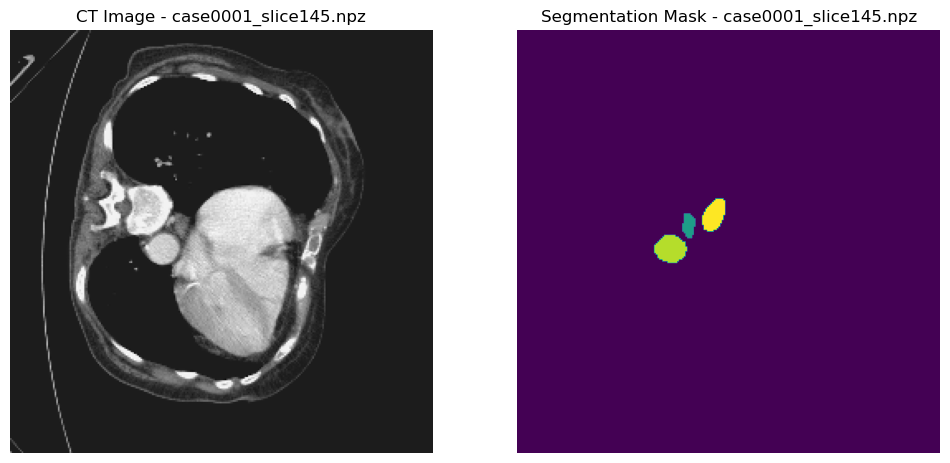


Visualizing case0001_slice146.npz:
Image min: -0.11729709504100776, max: 1.0582115883780554, shape: (256, 256)
Label unique values: [0. 5. 8. 9.], shape: (256, 256)


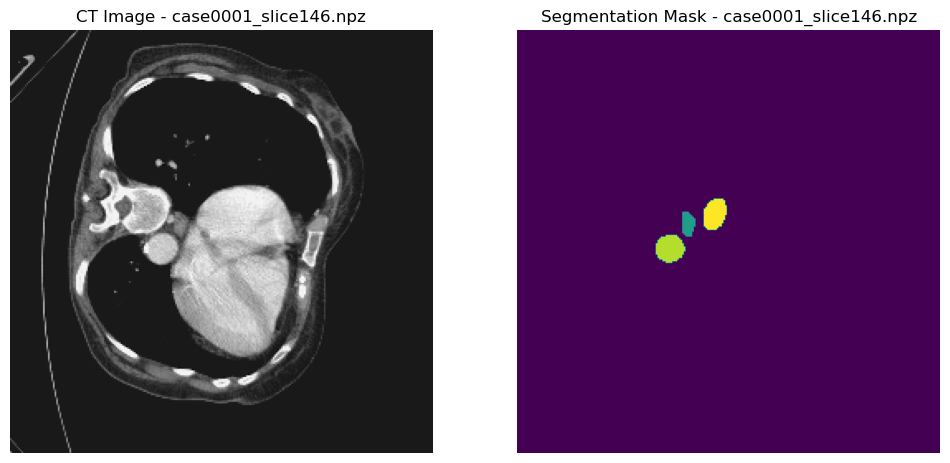

In [11]:
import os
import numpy as np
import matplotlib.pyplot as plt

# Ensure plots display correctly in Jupyter Notebook
%matplotlib inline

def visualize_all_slices_for_image(data_path, case_number='case0001'):
    """
    Function to visualize all slices for a specific preprocessed CT image and its segmentation masks.
    """
    print(f"Looking for files in directory: {data_path}")
    
    files = sorted(os.listdir(data_path))
    npz_files = [f for f in files if f.endswith('.npz')]
    
    # Filter files to only include the specified case
    selected_files = [f for f in npz_files if f.startswith(case_number)]
    
    if len(selected_files) == 0:
        print(f"No files found for {case_number}")
        return

    # Visualize all the slices for the specified case
    for sample_file in selected_files:
        data = np.load(os.path.join(data_path, sample_file))
        image = data['image']
        label = data['label'] if 'label' in data else None

        print(f"\nVisualizing {sample_file}:")
        print(f"Image min: {image.min()}, max: {image.max()}, shape: {image.shape}")
        
        if label is not None:
            print(f"Label unique values: {np.unique(label)}, shape: {label.shape}")
        else:
            print("Label not found!")

        # Check if the images are resized correctly to 256x256
        if image.shape != (256, 256):
            print(f"Warning: Image {sample_file} is not 256x256!")
        if label is not None and label.shape != (256, 256):
            print(f"Warning: Label {sample_file} is not 256x256!")

        # Display the image and its corresponding label
        plt.figure(figsize=(12, 6))
        
        # Plot CT Image
        plt.subplot(1, 2, 1)
        plt.imshow(image, cmap='gray')
        plt.title(f'CT Image - {sample_file}')
        plt.axis('off')

        # Plot Segmentation Mask (if available)
        if label is not None:
            plt.subplot(1, 2, 2)
            plt.imshow(label, cmap='viridis')
            plt.title(f'Segmentation Mask - {sample_file}')
            plt.axis('off')

        plt.show()

# Example usage: Specify the directory containing your preprocessed .npz files
train_data_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"

# Visualize all slices for case0001
visualize_all_slices_for_image(train_data_path, case_number='case0001')



Visualizing case0001_slice100.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


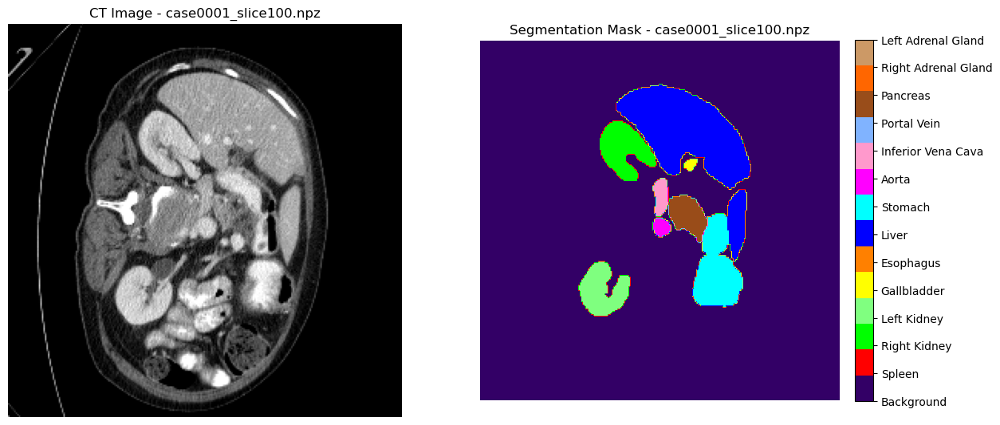


Visualizing case0001_slice101.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


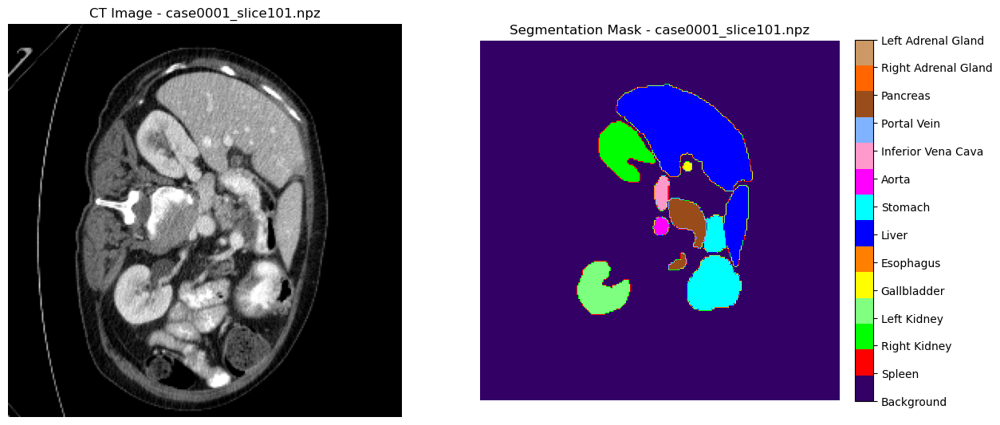


Visualizing case0001_slice102.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


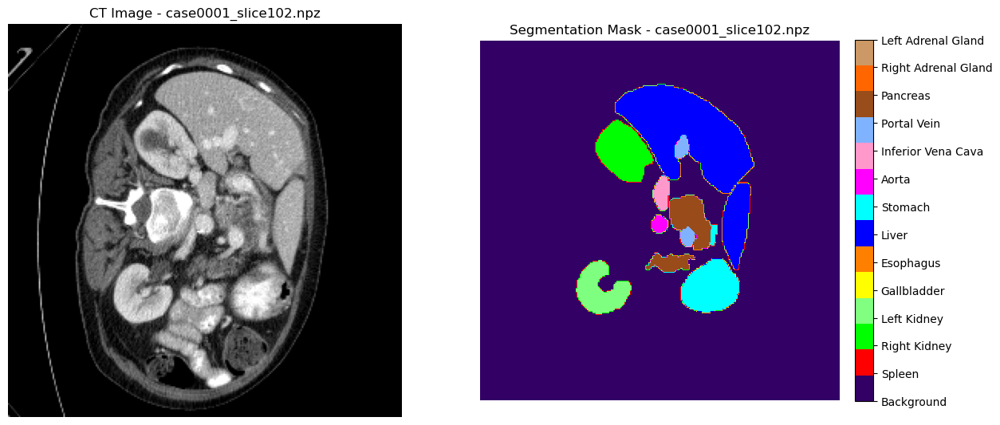


Visualizing case0001_slice103.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


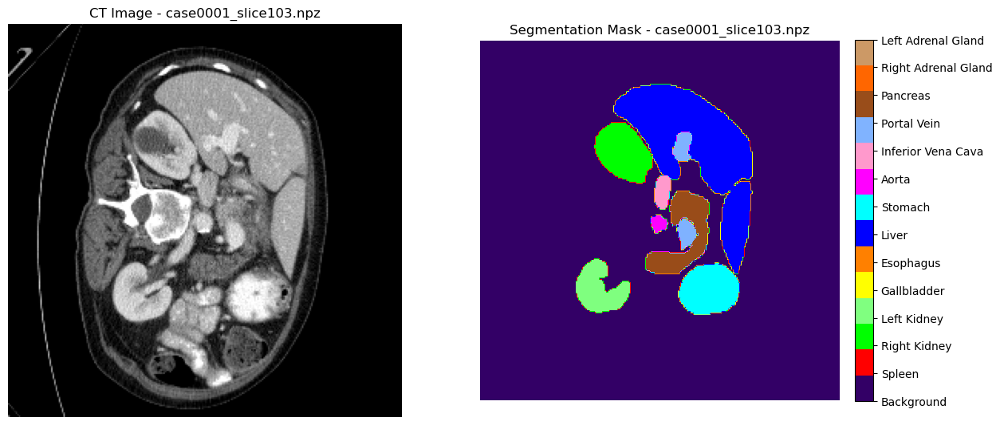


Visualizing case0001_slice104.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


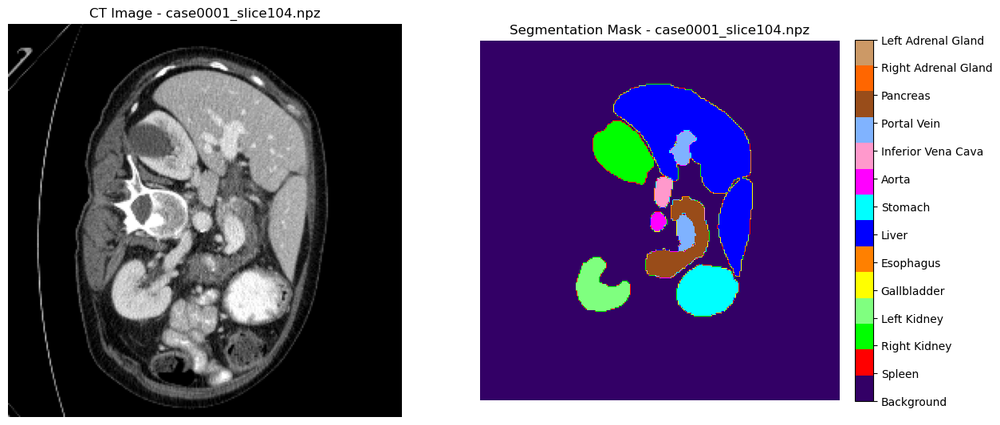


Visualizing case0001_slice105.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


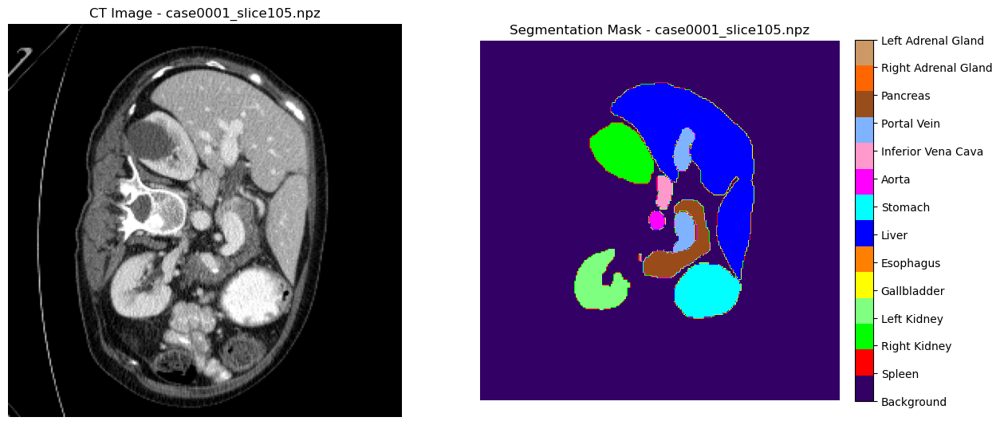

In [12]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def get_color_map():
    """Define a color map based on the organ labels."""
    colors = [
        (0.2, 0, 0.4),    # Background - Dark Purple
        (1, 0, 0),        # Spleen - Red
        (0, 1, 0),        # Right Kidney - Green
        (0.5, 1, 0.5),    # Left Kidney - Light Green
        (1, 1, 0),        # Gallbladder - Yellow
        (1, 0.5, 0),      # Esophagus - Orange
        (0, 0, 1),        # Liver - Blue
        (0, 1, 1),        # Stomach - Cyan
        (1, 0, 1),        # Aorta - Magenta
        (1, 0.6, 0.8),    # Inferior Vena Cava - Pink
        (0.5, 0.7, 1),    # Portal Vein - Light Blue
        (0.6, 0.3, 0.1),  # Pancreas - Brown
        (1, 0.4, 0),      # Right Adrenal Gland - Dark Orange
        (0.8, 0.6, 0.4)   # Left Adrenal Gland - Light Brown
    ]
    return ListedColormap(colors)

def visualize_with_labels(data_path, case_number='case0001', slice_no=None, slice_range=None):
    """
    Visualize the CT image and segmentation mask with color-coded labels.
    If `slice_no` is specified, visualize that slice. 
    If `slice_range` is specified, visualize all slices within that range.
    """
    if slice_no is not None:
        slice_list = [slice_no]
    elif slice_range is not None:
        slice_list = list(range(slice_range[0], slice_range[1] + 1))
    else:
        print("Please provide either a slice number or a slice range.")
        return
    
    for slice_idx in slice_list:
        file_name = f"{case_number}_slice{slice_idx:03d}.npz"
        file_path = os.path.join(data_path, file_name)
        
        if not os.path.exists(file_path):
            print(f"File {file_path} not found.")
            continue

        data = np.load(file_path)
        image = data['image']
        label = data['label']

        # Ensure the image is clipped between [0, 1] for better visualization
        image = np.clip(image, 0, 1)

        print(f"\nVisualizing {file_name}:")
        print(f"Image min: {image.min()}, max: {image.max()}, shape: {image.shape}")
        print(f"Label unique values: {np.unique(label)}, shape: {label.shape}")

        # Create a color map
        cmap = get_color_map()
        
        # Display the image and its corresponding label
        plt.figure(figsize=(14, 7))
        
        # Plot CT Image
        plt.subplot(1, 2, 1)
        plt.imshow(image, cmap='gray')
        plt.title(f'CT Image - {file_name}')
        plt.axis('off')

        # Plot Segmentation Mask with color-coded labels
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap=cmap, vmin=0, vmax=13)
        plt.title(f'Segmentation Mask - {file_name}')
        plt.axis('off')

        # Show a legend for labels
        cbar = plt.colorbar(ticks=np.arange(0, 14), fraction=0.046, pad=0.04)
        cbar.ax.set_yticklabels([
            'Background', 'Spleen', 'Right Kidney', 'Left Kidney', 'Gallbladder',
            'Esophagus', 'Liver', 'Stomach', 'Aorta', 'Inferior Vena Cava',
            'Portal Vein', 'Pancreas', 'Right Adrenal Gland', 'Left Adrenal Gland'
        ])
        plt.show()

# Example usage
train_data_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"



# Visualize a range of slices
visualize_with_labels(train_data_path, case_number='case0001', slice_range=(100, 105))



Visualizing case0001_slice106.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


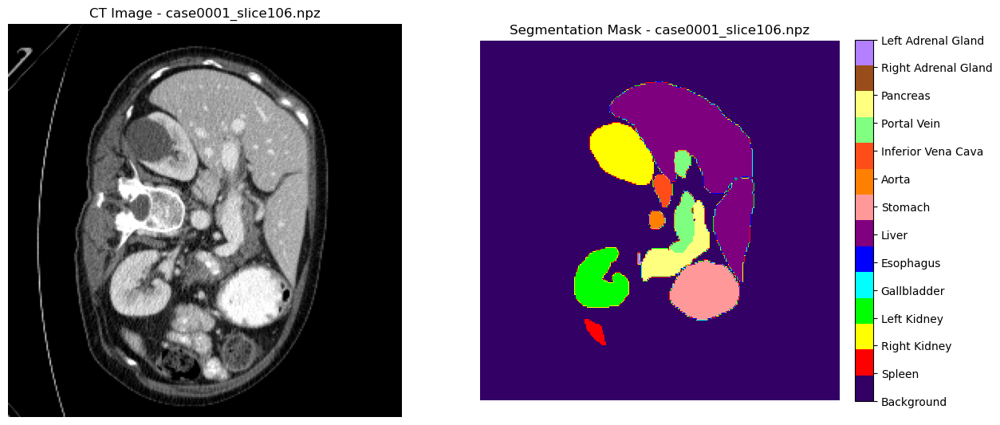


Visualizing case0001_slice098.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


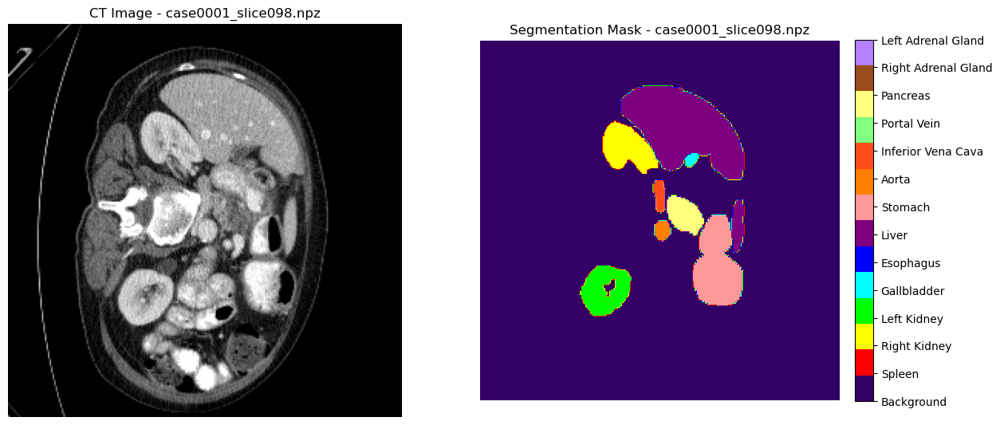


Visualizing case0001_slice099.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


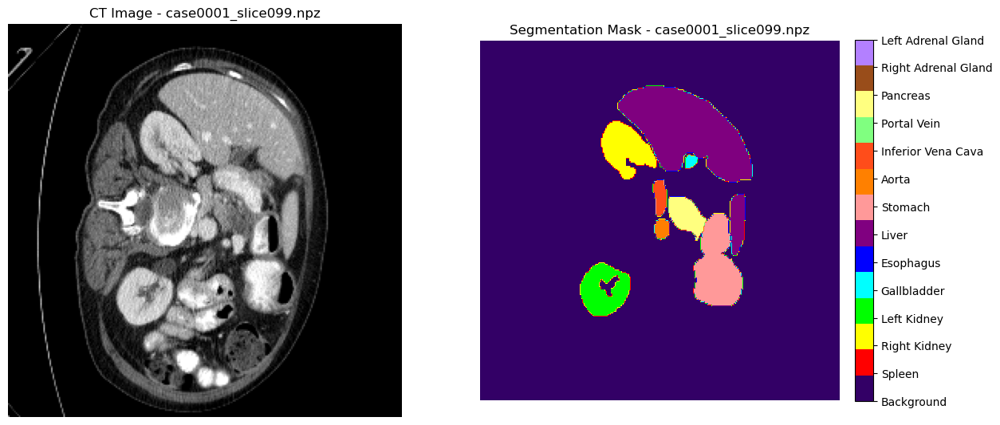


Visualizing case0001_slice100.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


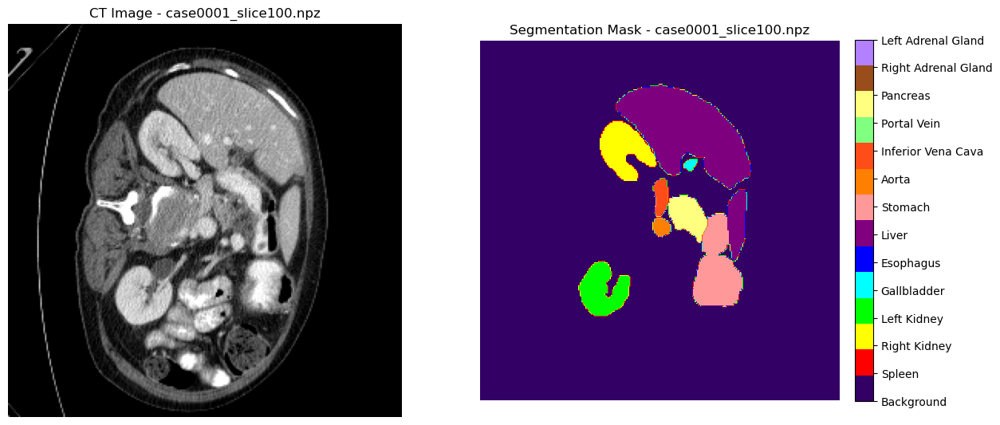


Visualizing case0001_slice101.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  4.  6.  7.  8.  9. 11.], shape: (256, 256)


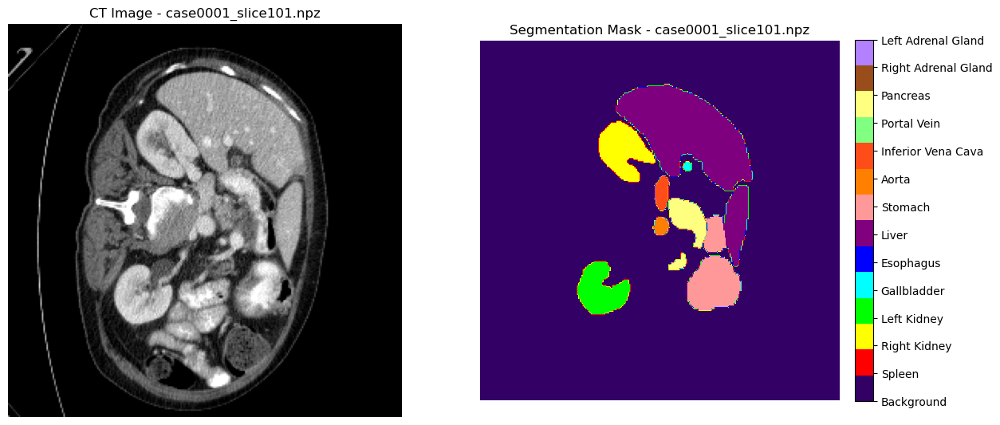


Visualizing case0001_slice102.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


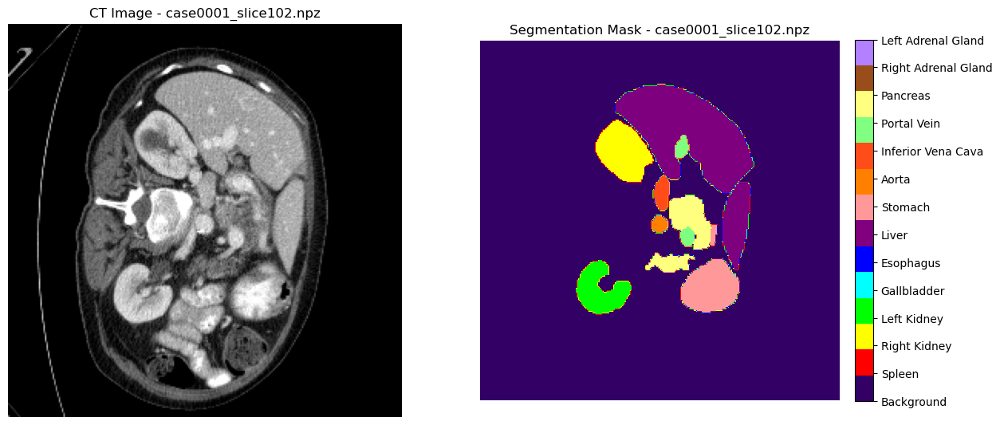


Visualizing case0001_slice103.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


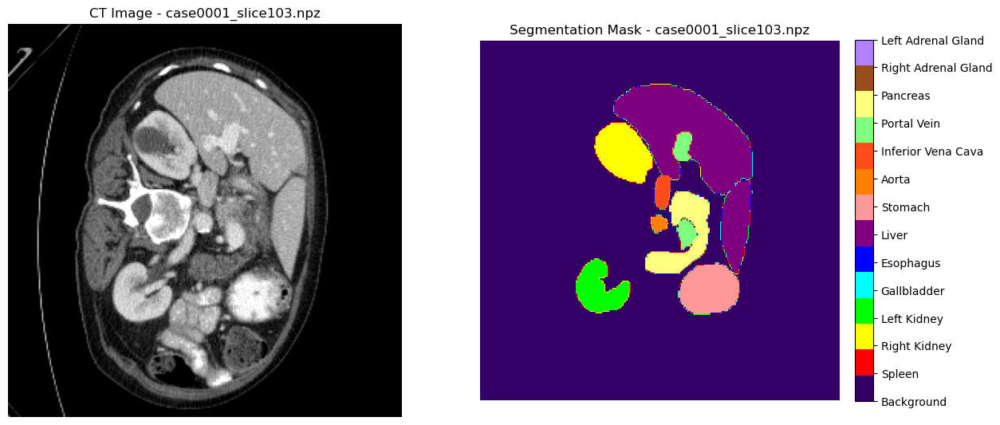


Visualizing case0001_slice104.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11.], shape: (256, 256)


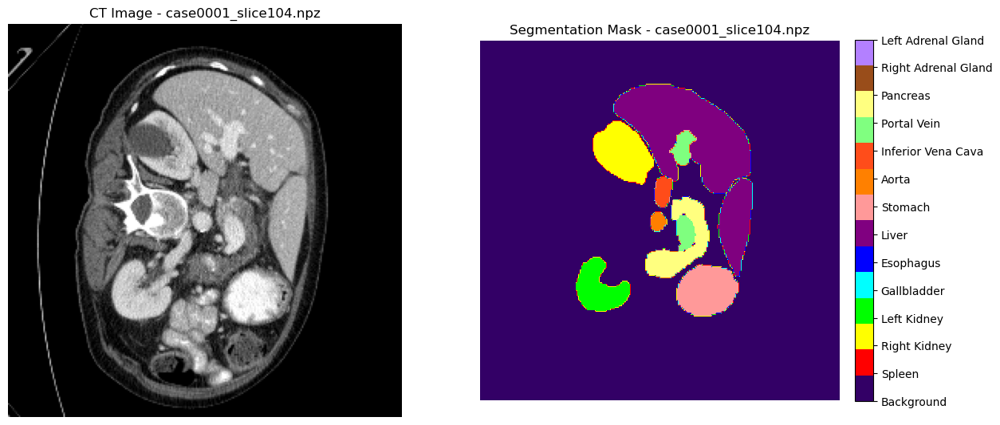


Visualizing case0001_slice105.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


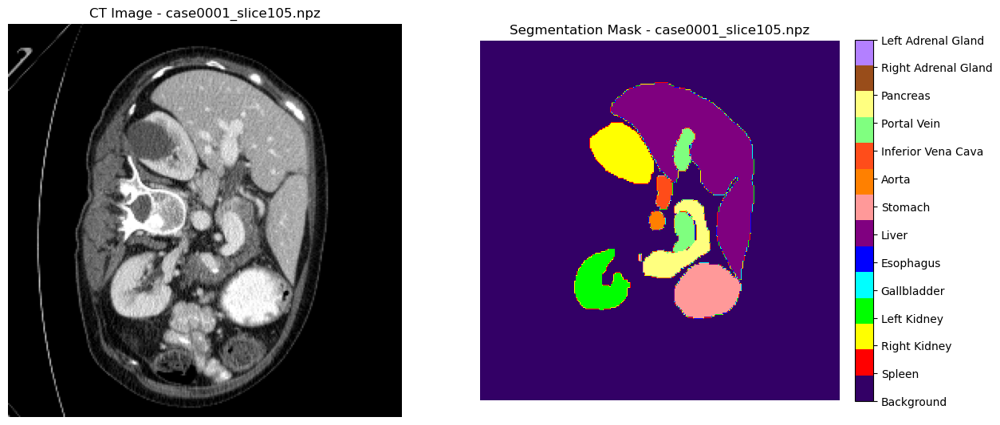


Visualizing case0001_slice106.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


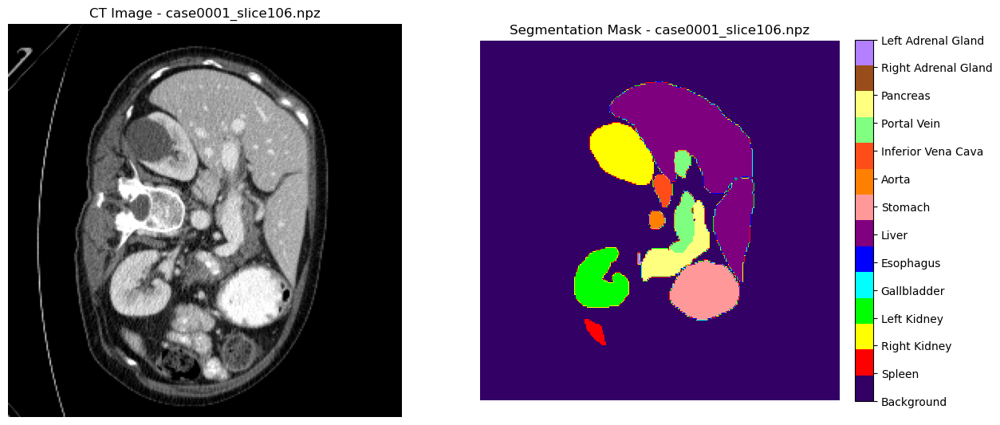


Visualizing case0001_slice107.npz:
Image min: 0.0, max: 1.0, shape: (256, 256)
Label unique values: [ 0.  1.  2.  3.  6.  7.  8.  9. 10. 11. 13.], shape: (256, 256)


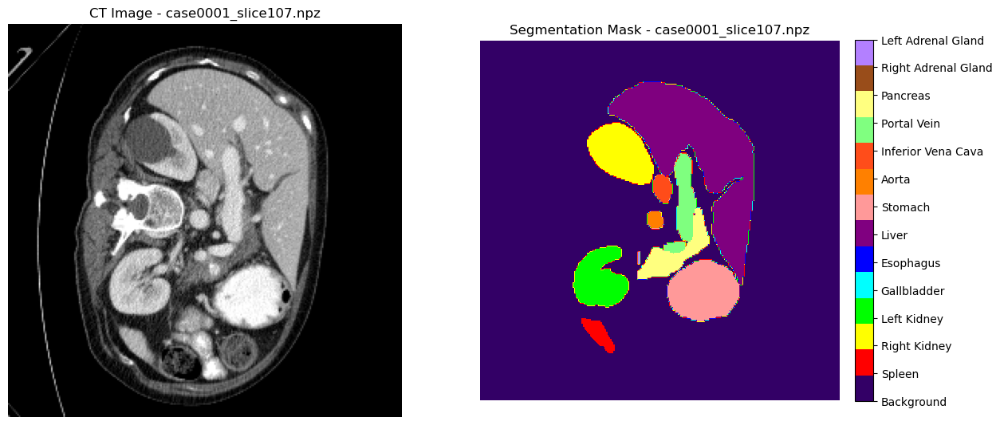

In [13]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def get_color_map():
    """Define a color map based on the organ labels using colors from the reference images."""
    colors = [
        (0.2, 0, 0.4),    # Background - Dark Purple
        (1, 0, 0),        # Spleen - Red
        (1, 1, 0),        # Right Kidney - Yellow
        (0, 1, 0),        # Left Kidney - Green
        (0, 1, 1),        # Gallbladder - Cyan
        (0, 0, 1),        # Esophagus - Blue
        (0.5, 0, 0.5),    # Liver - Purple
        (1, 0.6, 0.6),    # Stomach - Pink
        (1, 0.5, 0),      # Aorta - Orange
        (1, 0.3, 0.1),    # Inferior Vena Cava - Dark Orange
        (0.5, 1, 0.5),    # Portal Vein - Light Green
        (1, 1, 0.5),      # Pancreas - Light Yellow
        (0.6, 0.3, 0.1),  # Right Adrenal Gland - Brown
        (0.7, 0.5, 1)     # Left Adrenal Gland - Light Purple
    ]
    return ListedColormap(colors)

def visualize_with_labels(data_path, case_number='case0001', slice_no=None, slice_range=None):
    """
    Visualize the CT image and segmentation mask with color-coded labels.
    If `slice_no` is specified, visualize that slice. 
    If `slice_range` is specified, visualize all slices within that range.
    """
    if slice_no is not None:
        slice_list = [slice_no]
    elif slice_range is not None:
        slice_list = list(range(slice_range[0], slice_range[1] + 1))
    else:
        print("Please provide either a slice number or a slice range.")
        return
    
    for slice_idx in slice_list:
        file_name = f"{case_number}_slice{slice_idx:03d}.npz"
        file_path = os.path.join(data_path, file_name)
        
        if not os.path.exists(file_path):
            print(f"File {file_path} not found.")
            continue

        data = np.load(file_path)
        image = data['image']
        label = data['label']

        # Ensure the image is clipped between [0, 1] for better visualization
        image = np.clip(image, 0, 1)

        print(f"\nVisualizing {file_name}:")
        print(f"Image min: {image.min()}, max: {image.max()}, shape: {image.shape}")
        print(f"Label unique values: {np.unique(label)}, shape: {label.shape}")

        # Create a color map
        cmap = get_color_map()
        
        # Display the image and its corresponding label
        plt.figure(figsize=(14, 7))
        
        # Plot CT Image
        plt.subplot(1, 2, 1)
        plt.imshow(image, cmap='gray')
        plt.title(f'CT Image - {file_name}')
        plt.axis('off')

        # Plot Segmentation Mask with color-coded labels
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap=cmap, vmin=0, vmax=13)
        plt.title(f'Segmentation Mask - {file_name}')
        plt.axis('off')

        # Show a legend for labels
        cbar = plt.colorbar(ticks=np.arange(0, 14), fraction=0.046, pad=0.04)
        cbar.ax.set_yticklabels([
            'Background', 'Spleen', 'Right Kidney', 'Left Kidney', 'Gallbladder',
            'Esophagus', 'Liver', 'Stomach', 'Aorta', 'Inferior Vena Cava',
            'Portal Vein', 'Pancreas', 'Right Adrenal Gland', 'Left Adrenal Gland'
        ])
        plt.show()

# Example usage
train_data_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"

# Visualize a specific slice
visualize_with_labels(train_data_path, case_number='case0001', slice_no=106)

# Visualize a range of slices
visualize_with_labels(train_data_path, case_number='case0001', slice_range=(98, 107))


## CT Image and Segmentation Mask
The left image shows a raw CT scan, while the right image displays the segmented organs color-coded according to the legend. This visualization helps in understanding the segmentation accuracy of the model.

In [14]:
def check_image_shape(data_path, case_number='case0001', slice_no=103):
    """
    Check the shape of both the CT image and the segmentation mask.
    """
    file_name = f"{case_number}_slice{slice_no:03d}.npz"
    file_path = os.path.join(data_path, file_name)
    
    if not os.path.exists(file_path):
        print(f"File {file_path} not found.")
        return

    data = np.load(file_path)
    image = data['image']
    label = data['label']

    print(f"Checking file: {file_name}")
    print(f"Image shape: {image.shape}, Label shape: {label.shape}")

# Example usage
check_image_shape(train_data_path, case_number='case0001', slice_no=103)


Checking file: case0001_slice103.npz
Image shape: (256, 256), Label shape: (256, 256)


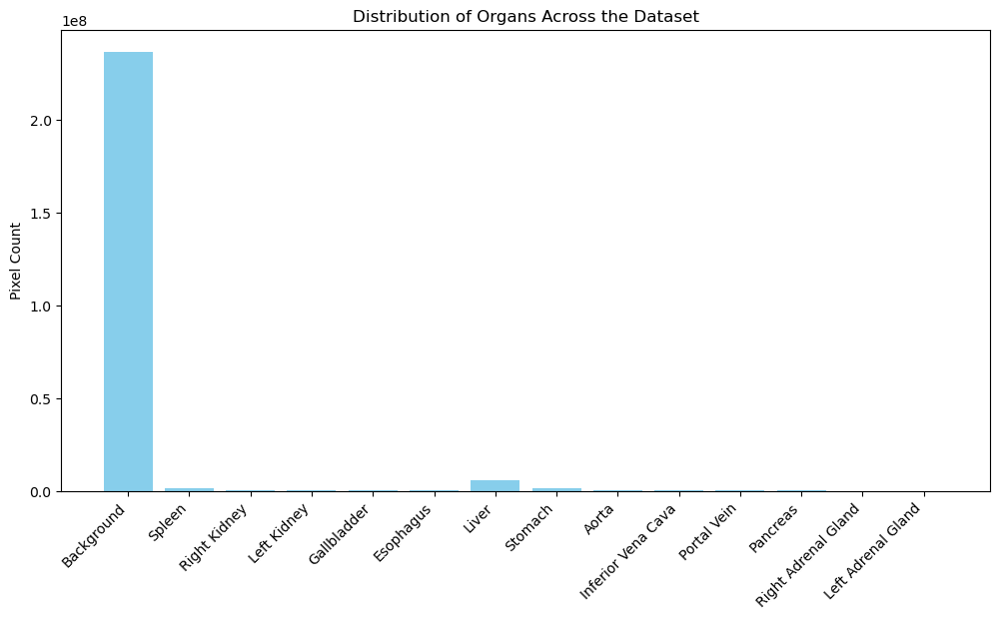

In [15]:
import os
import numpy as np
import matplotlib.pyplot as plt

def analyze_organ_distribution(data_path):
    """Analyze the distribution of organ labels in the dataset."""
    files = sorted(os.listdir(data_path))
    npz_files = [f for f in files if f.endswith('.npz')]
    
    label_counts = np.zeros(14, dtype=int)  # 0-13 labels

    for sample_file in npz_files:
        data = np.load(os.path.join(data_path, sample_file))
        label = data['label']
        unique, counts = np.unique(label, return_counts=True)
        
        # Ensure labels are within valid range
        for u, c in zip(unique, counts):
            u = int(u)
            if 0 <= u < len(label_counts):  # Check if label is within [0, 13]
                label_counts[u] += c
            else:
                print(f"Unexpected label {u} in file {sample_file}. Ignoring it.")

    # Plotting the distribution
    organs = [
        'Background', 'Spleen', 'Right Kidney', 'Left Kidney', 'Gallbladder',
        'Esophagus', 'Liver', 'Stomach', 'Aorta', 'Inferior Vena Cava',
        'Portal Vein', 'Pancreas', 'Right Adrenal Gland', 'Left Adrenal Gland'
    ]
    
    plt.figure(figsize=(12, 6))
    plt.bar(organs, label_counts, color='skyblue')
    plt.xticks(rotation=45, ha='right')
    plt.ylabel('Pixel Count')
    plt.title('Distribution of Organs Across the Dataset')
    plt.show()

# Example usage
train_data_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"
analyze_organ_distribution(train_data_path)



## Organ Diversity in Slices
This line graph indicates the number of unique organs present in each slice. It provides insight into how the anatomical composition changes across slices.

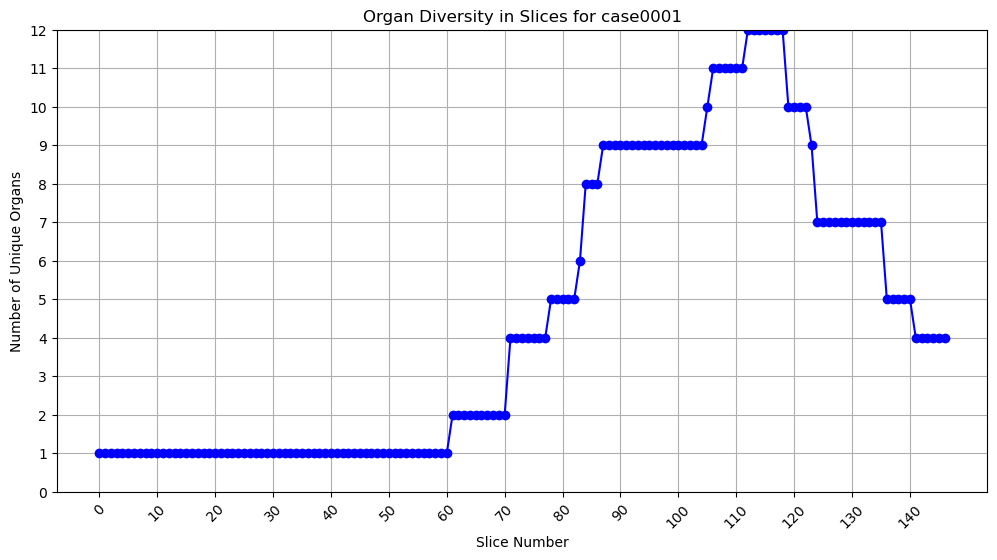

In [16]:
import os
import numpy as np
import matplotlib.pyplot as plt

def analyze_slice_coverage(data_path, case_number='case0001'):
    """Analyze the coverage of organs in each slice of a specific case."""
    # Get all relevant .npz files for the specified case
    files = sorted(os.listdir(data_path))
    npz_files = [f for f in files if f.startswith(case_number) and f.endswith('.npz')]
    
    organ_counts_per_slice = []

    # Count the number of unique organs in each slice
    for sample_file in npz_files:
        data = np.load(os.path.join(data_path, sample_file))
        label = data['label']
        unique_organs = np.unique(label)
        organ_counts_per_slice.append(len(unique_organs))

    # Plotting the slice-wise organ coverage with y-axis range from 0 to 12
    plt.figure(figsize=(12, 6))
    plt.plot(organ_counts_per_slice, marker='o', linestyle='-', color='blue')
    plt.xticks(range(0, len(npz_files), 10), rotation=45)
    plt.yticks(range(0, 13))  # Ensuring the y-axis has ticks from 0 to 12
    plt.xlabel('Slice Number')
    plt.ylabel('Number of Unique Organs')
    plt.title(f'Organ Diversity in Slices for {case_number}')
    plt.grid(True)
    plt.ylim(0, 12)  # Setting y-axis limits to 0-12
    plt.show()

# Example usage
train_data_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"
analyze_slice_coverage(train_data_path, case_number='case0001')


## Organ Diversity in Slices
This line graph indicates the number of unique organs present in each slice. It provides insight into how the anatomical composition changes across slices.

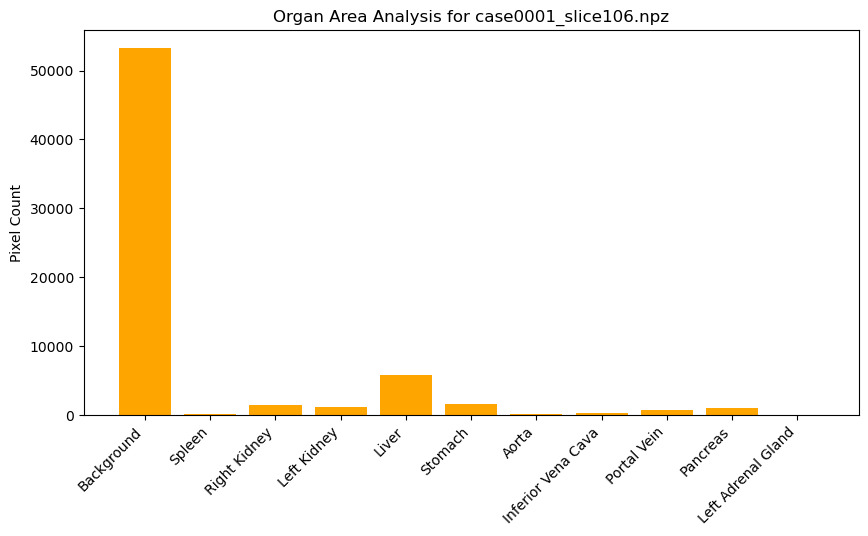

In [17]:
def analyze_organ_area(data_path, case_number='case0001', slice_no=81):
    """Analyze the area occupied by each organ in a specific slice."""
    file_name = f"{case_number}_slice{slice_no:03d}.npz"
    file_path = os.path.join(data_path, file_name)

    if not os.path.exists(file_path):
        print(f"File {file_path} not found.")
        return

    data = np.load(file_path)
    label = data['label']

    unique, counts = np.unique(label, return_counts=True)
    unique = unique.astype(int)
    
    organs = [
        'Background', 'Spleen', 'Right Kidney', 'Left Kidney', 'Gallbladder',
        'Esophagus', 'Liver', 'Stomach', 'Aorta', 'Inferior Vena Cava',
        'Portal Vein', 'Pancreas', 'Right Adrenal Gland', 'Left Adrenal Gland'
    ]

    # Plot the area occupied by each organ
    plt.figure(figsize=(10, 5))
    plt.bar([organs[i] for i in unique], counts, color='orange')
    plt.ylabel('Pixel Count')
    plt.title(f'Organ Area Analysis for {file_name}')
    plt.xticks(rotation=45, ha='right')
    plt.show()

# Example usage
analyze_organ_area(train_data_path, case_number='case0001', slice_no=106)


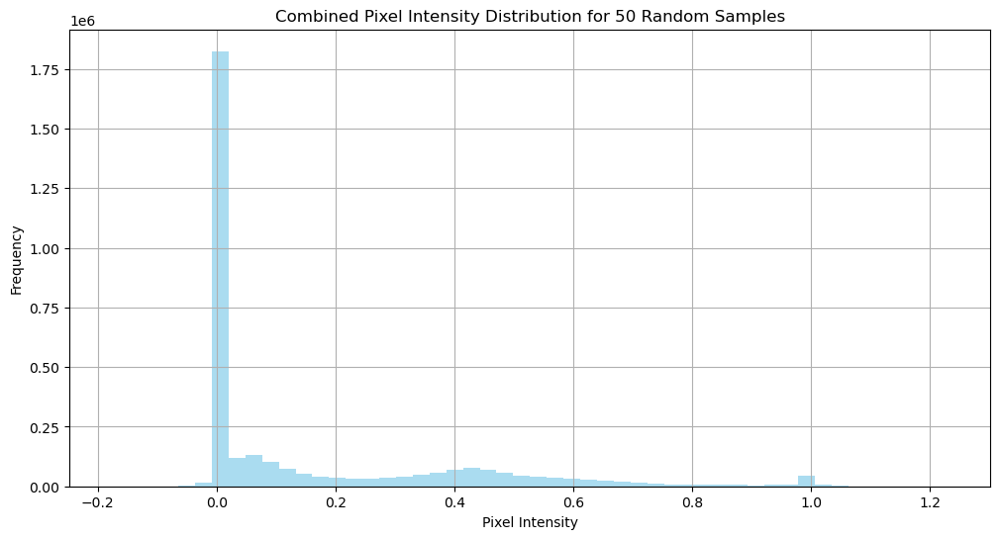

In [18]:
import os
import numpy as np
import matplotlib.pyplot as plt
import random

def analyze_combined_pixel_intensity_distribution(data_path, num_samples=50):
    """
    Analyze the combined distribution of pixel intensities for 50 random samples.
    """
    # Get all available .npz files in the directory
    files = sorted([f for f in os.listdir(data_path) if f.endswith('.npz')])
    
    if len(files) < num_samples:
        print(f"Warning: Only {len(files)} samples available, but {num_samples} requested.")
        num_samples = len(files)
    
    # Randomly select files
    random_files = random.sample(files, num_samples)
    
    # Initialize an empty list to collect pixel intensities
    all_pixels = []
    
    # Collect pixel intensities from each randomly selected file
    for sample_file in random_files:
        data = np.load(os.path.join(data_path, sample_file))
        image = data['image']
        all_pixels.extend(image.ravel())  # Flatten and collect pixel intensities

    # Convert to a numpy array for analysis
    all_pixels = np.array(all_pixels)

    # Plot a combined histogram of pixel intensities
    plt.figure(figsize=(12, 6))
    plt.hist(all_pixels, bins=50, color='skyblue', alpha=0.7)
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.title(f'Combined Pixel Intensity Distribution for {num_samples} Random Samples')
    plt.grid(True)
    plt.show()

# Example usage
train_data_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"
analyze_combined_pixel_intensity_distribution(train_data_path, num_samples=50)


## Combined Pixel Intensity Distribution (50 Random Samples)
![Combined Pixel Intensity](path_to_image.png)
Aggregated histogram of pixel intensities for 50 random slices, helping to understand the overall intensity distribution in the dataset.

/home/ec2-user/anaconda3/envs/pytorch_p310/lib/python3.10/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/home/ec2-user/anaconda3/envs/pytorch_p310/lib/python3.10/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


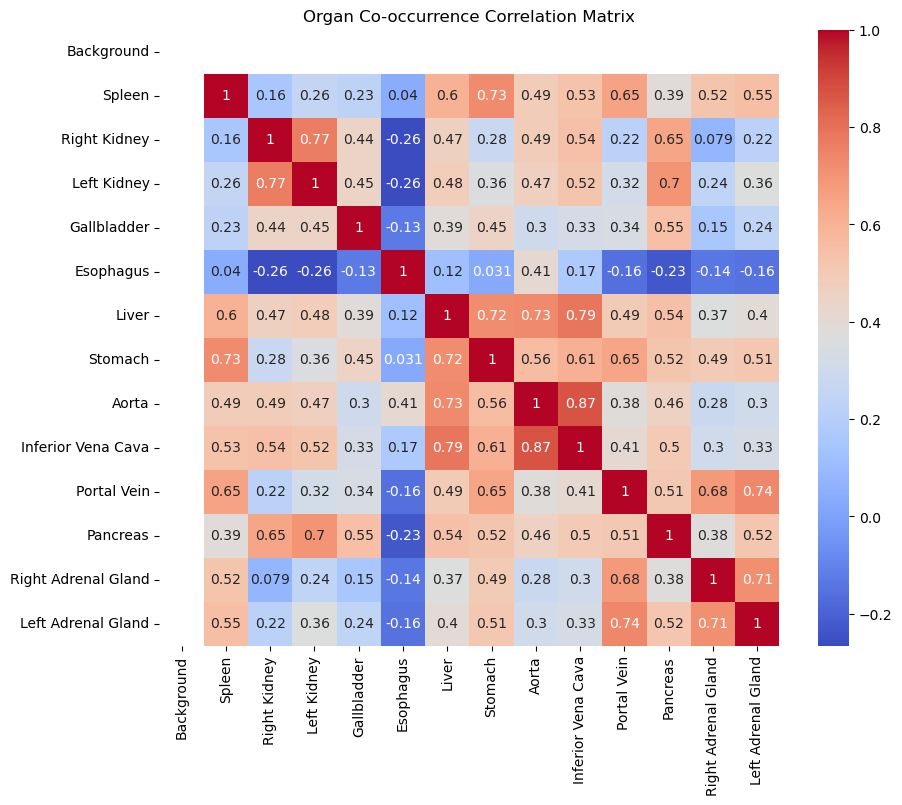

In [19]:
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def visualize_organ_cooccurrence(data_path):
    """Visualize co-occurrence of organs using a correlation matrix."""
    files = sorted(os.listdir(data_path))
    npz_files = [f for f in files if f.endswith('.npz')]
    
    organ_count_matrix = np.zeros((14, len(npz_files)), dtype=int)

    for idx, sample_file in enumerate(npz_files):
        data = np.load(os.path.join(data_path, sample_file))
        label = data['label']
        
        # Ensure labels are integers and within the valid range [0, 13]
        unique_organs = np.unique(label).astype(int)
        unique_organs = unique_organs[(unique_organs >= 0) & (unique_organs < 14)]
        
        for organ in unique_organs:
            # Double-check that organ is a valid index
            if 0 <= organ < 14:
                organ_count_matrix[organ, idx] = 1

    organs = [
        'Background', 'Spleen', 'Right Kidney', 'Left Kidney', 'Gallbladder',
        'Esophagus', 'Liver', 'Stomach', 'Aorta', 'Inferior Vena Cava',
        'Portal Vein', 'Pancreas', 'Right Adrenal Gland', 'Left Adrenal Gland'
    ]

    # Calculate the correlation matrix
    correlation_matrix = np.corrcoef(organ_count_matrix)
    
    # Plot the heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, xticklabels=organs, yticklabels=organs, annot=True, cmap='coolwarm')
    plt.title('Organ Co-occurrence Correlation Matrix')
    plt.show()

# Example usage
visualize_organ_cooccurrence(train_data_path)


## Organ Co-occurrence Heatmap
![Organ Co-occurrence](path_to_image.png)
The heatmap shows how often different organs co-occur in the same slice. It reveals spatial relationships between organs in the dataset.


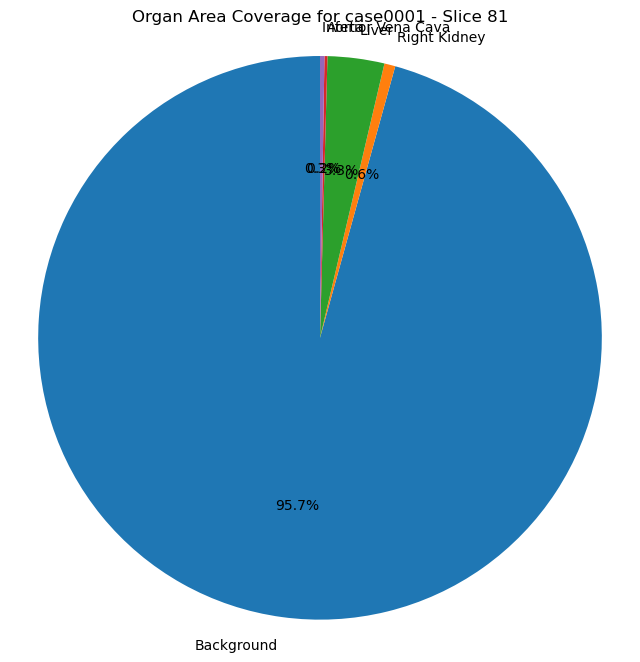

In [20]:
def organ_area_pie_chart(data_path, case_number='case0001', slice_no=81):
    """Visualize the proportion of each organ in a specific slice using a pie chart."""
    file_name = f"{case_number}_slice{slice_no:03d}.npz"
    file_path = os.path.join(data_path, file_name)
    
    if not os.path.exists(file_path):
        print(f"File {file_path} not found.")
        return

    data = np.load(file_path)
    label = data['label']
    
    organs = [
        'Background', 'Spleen', 'Right Kidney', 'Left Kidney', 'Gallbladder',
        'Esophagus', 'Liver', 'Stomach', 'Aorta', 'Inferior Vena Cava',
        'Portal Vein', 'Pancreas', 'Right Adrenal Gland', 'Left Adrenal Gland'
    ]
    
    unique, counts = np.unique(label, return_counts=True)
    organ_counts = {organs[int(u)]: c for u, c in zip(unique, counts) if u < 14}
    
    # Plotting the pie chart
    plt.figure(figsize=(8, 8))
    plt.pie(organ_counts.values(), labels=organ_counts.keys(), autopct='%1.1f%%', startangle=90)
    plt.title(f'Organ Area Coverage for {case_number} - Slice {slice_no}')
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()

# Example usage
organ_area_pie_chart(train_data_path, case_number='case0001', slice_no=81)


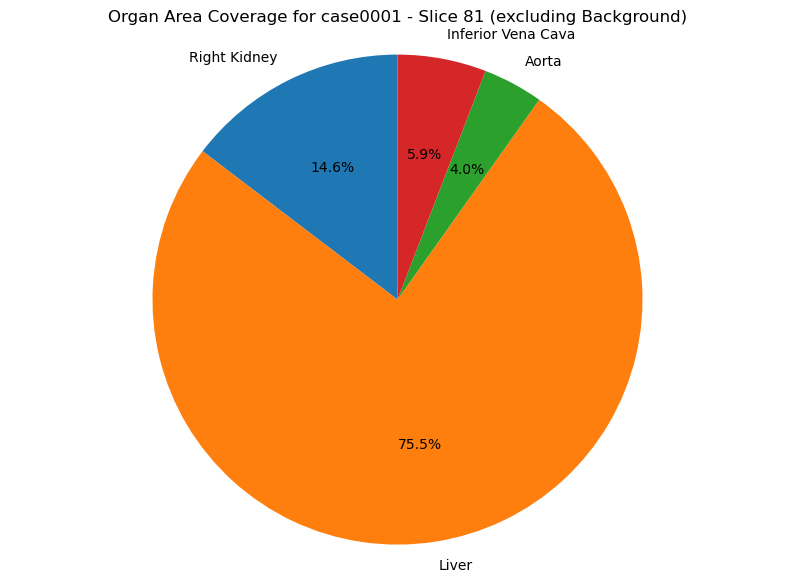

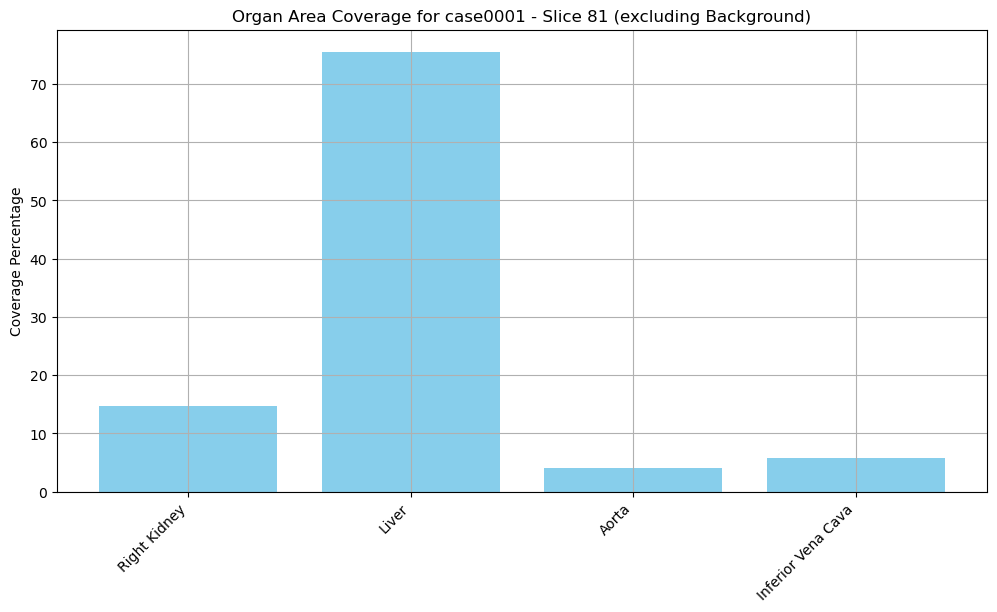

In [21]:
import os
import numpy as np
import matplotlib.pyplot as plt

def analyze_organ_coverage(data_path, case_number='case0001', slice_no=81, use_pie_chart=False):
    """
    Analyze the area coverage of each organ in a specific slice and visualize using a pie chart or bar chart.
    """
    file_name = f"{case_number}_slice{slice_no:03d}.npz"
    file_path = os.path.join(data_path, file_name)
    
    if not os.path.exists(file_path):
        print(f"File {file_path} not found.")
        return

    data = np.load(file_path)
    label = data['label']

    # Get unique labels and their counts
    unique, counts = np.unique(label, return_counts=True)
    
    # Convert `unique` to integers
    unique = unique.astype(int)
    
    organ_areas = dict(zip(unique, counts))

    # Define organ names
    organs = [
        'Background', 'Spleen', 'Right Kidney', 'Left Kidney', 'Gallbladder',
        'Esophagus', 'Liver', 'Stomach', 'Aorta', 'Inferior Vena Cava',
        'Portal Vein', 'Pancreas', 'Right Adrenal Gland', 'Left Adrenal Gland'
    ]
    
    # Filter out the background
    filtered_organs = [organs[i] for i in unique if i != 0]
    filtered_counts = [organ_areas[i] for i in unique if i != 0]

    # Normalize counts to percentages
    total_pixels = sum(filtered_counts)
    percentages = [count / total_pixels * 100 for count in filtered_counts]

    # Visualization
    if use_pie_chart:
        # Pie Chart (excluding background)
        plt.figure(figsize=(10, 7))
        plt.pie(percentages, labels=filtered_organs, autopct='%1.1f%%', startangle=90)
        plt.title(f'Organ Area Coverage for {case_number} - Slice {slice_no} (excluding Background)')
        plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
        plt.show()
    else:
        # Bar Chart (excluding background)
        plt.figure(figsize=(12, 6))
        plt.bar(filtered_organs, percentages, color='skyblue')
        plt.xticks(rotation=45, ha='right')
        plt.ylabel('Coverage Percentage')
        plt.title(f'Organ Area Coverage for {case_number} - Slice {slice_no} (excluding Background)')
        plt.grid(True)
        plt.show()

# Example usage
train_data_path = "/home/ec2-user/SageMaker/Abdomen/train_npz"

# For Pie Chart
analyze_organ_coverage(train_data_path, case_number='case0001', slice_no=81, use_pie_chart=True)

# For Bar Chart
analyze_organ_coverage(train_data_path, case_number='case0001', slice_no=81, use_pie_chart=False)


## Pie Chart of Organ Area Coverage
![Pie Chart](path_to_image.png)
This pie chart shows the proportion of each organ in a specific slice, helping visualize the relative area occupied by each organ.

## Bar Chart of Organ Area Coverage
![Bar Chart](path_to_image.png)
The bar chart provides a quantitative comparison of organ areas in a single slice.


In [22]:
import torch
print(torch.cuda.is_available())  # Should return True if CUDA is available
print(torch.version.cuda)        # Check installed CUDA version
print(torch.backends.cudnn.enabled)  # Check if cuDNN is enabled


True
12.1
True


In [29]:
import torch
import torch.nn as nn
import torch.nn.functional as F


# Encoder block from MIST structure
class EncoderBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(EncoderBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu = nn.LeakyReLU(negative_slope=0.01, inplace=True)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        x = self.relu(self.bn1(self.conv1(x)))
        x = self.relu(self.bn2(self.conv2(x)))
        skip = x
        x = self.pool(x)
        return x, skip


# CAM Decoder block
class CAMDecoderBlock(nn.Module):
    def __init__(self, in_channels, skip_channels, out_channels):
        super(CAMDecoderBlock, self).__init__()
        self.up = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.attention = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(skip_channels, skip_channels // 4, kernel_size=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(skip_channels // 4, skip_channels, kernel_size=1),
            nn.Sigmoid()
        )
        self.conv1 = nn.Conv2d(skip_channels + out_channels, out_channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu = nn.LeakyReLU(negative_slope=0.01, inplace=True)

    def forward(self, x, skip):
        x = self.up(x)
        attention = self.attention(skip)
        skip = skip * attention
        x = torch.cat([x, skip], dim=1)
        x = self.relu(self.bn1(self.conv1(x)))
        x = self.relu(self.bn2(self.conv2(x)))
        return x


class CAMModel(nn.Module):
    def __init__(self, input_channels, num_classes):
        super(CAMModel, self).__init__()

        # Encoder
        self.enc1 = EncoderBlock(input_channels, 64)
        self.enc2 = EncoderBlock(64, 128)
        self.enc3 = EncoderBlock(128, 256)
        self.enc4 = EncoderBlock(256, 512)

        # Bottleneck
        self.bottleneck = nn.Sequential(
            nn.Conv2d(512, 1024, kernel_size=3, padding=1),
            nn.BatchNorm2d(1024),
            nn.ReLU(inplace=True),
            nn.Conv2d(1024, 1024, kernel_size=3, padding=1),
            nn.BatchNorm2d(1024),
            nn.ReLU(inplace=True),
        )

        # Decoder
        self.dec4 = CAMDecoderBlock(1024, 512, 512)
        self.dec3 = CAMDecoderBlock(512, 256, 256)
        self.dec2 = CAMDecoderBlock(256, 128, 128)
        self.dec1 = CAMDecoderBlock(128, 64, 64)

        # Final segmentation head
        self.head = nn.Sequential(
            nn.Conv2d(64, num_classes, kernel_size=1),
            nn.BatchNorm2d(num_classes)  # Add BatchNorm to stabilize logits
        )

        # Initialize final layer weights
        nn.init.kaiming_normal_(self.head[0].weight, mode='fan_out', nonlinearity='linear')  # Access Conv2d
        nn.init.constant_(self.head[0].bias, 0.1)

    def forward(self, x):
    # Encoder
        x1, skip1 = self.enc1(x)
        x2, skip2 = self.enc2(x1)
        x3, skip3 = self.enc3(x2)
        x4, skip4 = self.enc4(x3)

    # Bottleneck
        x = self.bottleneck(x4)

    # Decoder
        x = self.dec4(x, skip4)
        x = self.dec3(x, skip3)
        x = self.dec2(x, skip2)
        x = self.dec1(x, skip1)

    

    # Output head
        x = self.head(x)

  
    
        return x





# Test the model
if __name__ == "__main__":
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model = CAMModel(input_channels=1, num_classes=1).to(device)
    dummy_input = torch.randn(1, 1, 256, 256).to(device)
    output = model(dummy_input)
    print(f"Output shape: {output.shape}")






Output shape: torch.Size([1, 1, 256, 256])


In [24]:
import torch.nn as nn
import torch

class DiceLoss(nn.Module):
    def __init__(self, smooth=1e-5):
        super(DiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, logits, targets):
        probs = torch.sigmoid(logits)  # Convert logits to probabilities
        targets = targets.float()  # Ensure targets are floats
        
        intersection = (probs * targets).sum(dim=(2, 3))
        union = probs.sum(dim=(2, 3)) + targets.sum(dim=(2, 3))
        dice_score = (2. * intersection + self.smooth) / (union + self.smooth)
        dice_loss = 1 - dice_score.mean()
        return dice_loss.clamp(min=0.0)  # Ensure non-negative loss


In [25]:
class CombinedLoss(nn.Module):
    def __init__(self, dice_weight=0.5):
        super(CombinedLoss, self).__init__()
        self.dice_loss = DiceLoss()
        self.cross_entropy = nn.BCEWithLogitsLoss()
        self.dice_weight = dice_weight

    def forward(self, logits, targets):
        targets = targets.float()  # Convert targets to float
        dice_loss = self.dice_loss(logits, targets)
        ce_loss = self.cross_entropy(logits, targets)
        return self.dice_weight * dice_loss + (1 - self.dice_weight) * ce_loss




In [26]:
# Example usage
criterion = CombinedLoss(dice_weight=0.7)

# Simulated model output and target (ground truth)
# Simulated model output and target (ground truth)
output = torch.randn(1, 1, 128, 128, requires_grad=True).to('cuda')  # Model output
target = torch.randint(0, 2, (1, 1, 128, 128)).to('cuda').float()  # Binary ground truth mask (convert to float)

# Calculate loss
loss = criterion(output, target)
print("Loss:", loss.item())



Loss: 0.5933698415756226


In [30]:
from torch.optim.lr_scheduler import LambdaLR

def train_model(model, train_loader, num_epochs, device, save_path, dice_weight=0.5):
    criterion = CombinedLoss(dice_weight=dice_weight)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-5, weight_decay=1e-4)  # Reduced LR and weight decay

    def warmup_lr(epoch):
        if epoch < 5:  # Gradual increase over the first 5 epochs
            return epoch / 5
        return 1.0

    scheduler = LambdaLR(optimizer, lr_lambda=warmup_lr)

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0.0

        # Enable debug logging only during the first epoch
        debug_logging = (epoch == 0)

        for batch_idx, batch in enumerate(tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training")):
            images, labels = batch['image'].to(device), batch['label'].to(device)

            optimizer.zero_grad()
            outputs = model(images)

            # Log logits and labels only during the first epoch
            if debug_logging and batch_idx == 0:
                print(f"Logits range: {outputs.min().item()} to {outputs.max().item()}")
                print(f"Labels unique values: {torch.unique(labels)}")

            if outputs.ndim != 4:
                outputs = outputs.unsqueeze(1)
            if labels.ndim != 4:
                labels = labels.unsqueeze(1)

            loss = criterion(outputs, labels)
            loss.backward()

            # Gradient clipping
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=0.25)
            optimizer.step()

            train_loss += loss.item()

        train_loss /= len(train_loader)
        print(f"Epoch {epoch+1}: Train Loss: {train_loss:.4f}")

        # Step scheduler
        scheduler.step()
        for param_group in optimizer.param_groups:
            print(f"Learning rate: {param_group['lr']}")

    torch.save(model.state_dict(), save_path)
    print("Training Complete. Model saved to:", save_path)




    



In [28]:
def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, nn.Conv2d):
            nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.BatchNorm2d):
            nn.init.constant_(m.weight, 1)
            nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Linear):  # If any fully connected layers exist
            nn.init.normal_(m.weight, 0, 0.01)
            nn.init.constant_(m.bias, 0)




In [31]:
# Define paths and parameters
device = "cuda"
save_model_path = "cam_model_final.pth"

# Initialize the model
model = CAMModel(input_channels=1, num_classes=1).to(device)  # Binary segmentation setup
initialize_weights(model)

# Train the model
train_model(model, train_loader, num_epochs=20, device=device, save_path=save_model_path, dice_weight=0.5)

Epoch 1/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.1390082687139511 to 14.770478248596191
Output Logits Range: -9.44039535522461 to 9.619674682617188
Logits range: -9.44039535522461 to 9.619674682617188
Labels unique values: tensor([0, 1], device='cuda:0')


Epoch 1/20 - Training:   0%|          | 3/945 [00:00<04:02,  3.89it/s]

Decoder Block 1 Activation Range: -0.16273947060108185 to 16.006080627441406
Output Logits Range: -10.806477546691895 to 11.427014350891113
Decoder Block 1 Activation Range: -0.1392703503370285 to 14.320541381835938
Output Logits Range: -9.588068962097168 to 11.956048011779785
Decoder Block 1 Activation Range: -0.1366807520389557 to 14.958161354064941
Output Logits Range: -8.50954818725586 to 11.13078784942627


Epoch 1/20 - Training:   1%|          | 5/945 [00:01<02:42,  5.78it/s]

Decoder Block 1 Activation Range: -0.11903340369462967 to 13.460927963256836
Output Logits Range: -8.159616470336914 to 10.682291030883789
Decoder Block 1 Activation Range: -0.12323281168937683 to 13.822405815124512
Output Logits Range: -7.693915843963623 to 11.296545028686523
Decoder Block 1 Activation Range: -0.1552664339542389 to 14.59011173248291
Output Logits Range: -7.794250011444092 to 13.542945861816406


Epoch 1/20 - Training:   1%|          | 9/945 [00:01<01:51,  8.42it/s]

Decoder Block 1 Activation Range: -0.13978701829910278 to 14.612677574157715
Output Logits Range: -8.756596565246582 to 14.047533988952637
Decoder Block 1 Activation Range: -0.13152378797531128 to 13.278379440307617
Output Logits Range: -9.209214210510254 to 10.346115112304688
Decoder Block 1 Activation Range: -0.1290091574192047 to 12.830814361572266
Output Logits Range: -7.891796112060547 to 10.684978485107422


Epoch 1/20 - Training:   1%|          | 11/945 [00:01<01:40,  9.29it/s]

Decoder Block 1 Activation Range: -0.14321325719356537 to 14.082008361816406
Output Logits Range: -10.694975852966309 to 11.247511863708496
Decoder Block 1 Activation Range: -0.14067016541957855 to 14.53210735321045
Output Logits Range: -10.510807037353516 to 12.58740234375
Decoder Block 1 Activation Range: -0.11480214446783066 to 12.304838180541992
Output Logits Range: -7.558318614959717 to 11.142060279846191


Epoch 1/20 - Training:   2%|▏         | 15/945 [00:01<01:30, 10.23it/s]

Decoder Block 1 Activation Range: -0.13427546620368958 to 13.76675796508789
Output Logits Range: -10.68759536743164 to 10.66366195678711
Decoder Block 1 Activation Range: -0.11061744391918182 to 14.49374771118164
Output Logits Range: -8.021869659423828 to 11.078128814697266
Decoder Block 1 Activation Range: -0.13947007060050964 to 14.295119285583496
Output Logits Range: -10.368558883666992 to 10.722367286682129


Epoch 1/20 - Training:   2%|▏         | 17/945 [00:02<01:28, 10.49it/s]

Decoder Block 1 Activation Range: -0.14288891851902008 to 14.775790214538574
Output Logits Range: -8.341009140014648 to 12.630931854248047
Decoder Block 1 Activation Range: -0.1500122845172882 to 14.630184173583984
Output Logits Range: -10.78793716430664 to 10.605618476867676
Decoder Block 1 Activation Range: -0.13029395043849945 to 12.301371574401855
Output Logits Range: -8.649839401245117 to 11.678242683410645


Epoch 1/20 - Training:   2%|▏         | 21/945 [00:02<01:27, 10.60it/s]

Decoder Block 1 Activation Range: -0.1386103630065918 to 14.153106689453125
Output Logits Range: -7.629243850708008 to 11.00790023803711
Decoder Block 1 Activation Range: -0.12661060690879822 to 14.087224960327148
Output Logits Range: -10.033711433410645 to 13.573064804077148
Decoder Block 1 Activation Range: -0.13724395632743835 to 14.723628044128418
Output Logits Range: -8.561633110046387 to 10.219551086425781


Epoch 1/20 - Training:   2%|▏         | 23/945 [00:02<01:25, 10.85it/s]

Decoder Block 1 Activation Range: -0.14492927491664886 to 14.695866584777832
Output Logits Range: -9.510686874389648 to 12.552480697631836
Decoder Block 1 Activation Range: -0.1536245346069336 to 15.630831718444824
Output Logits Range: -8.518507957458496 to 11.444265365600586
Decoder Block 1 Activation Range: -0.13172271847724915 to 15.405324935913086
Output Logits Range: -10.59868049621582 to 11.759041786193848


Epoch 1/20 - Training:   3%|▎         | 27/945 [00:03<01:22, 11.15it/s]

Decoder Block 1 Activation Range: -0.13025392591953278 to 13.544506072998047
Output Logits Range: -9.159140586853027 to 11.268083572387695
Decoder Block 1 Activation Range: -0.11640451103448868 to 12.093507766723633
Output Logits Range: -8.138104438781738 to 10.26550579071045
Decoder Block 1 Activation Range: -0.15201227366924286 to 13.70474910736084
Output Logits Range: -10.966489791870117 to 10.909955978393555


Epoch 1/20 - Training:   3%|▎         | 29/945 [00:03<01:23, 11.02it/s]

Decoder Block 1 Activation Range: -0.12497023493051529 to 15.59228801727295
Output Logits Range: -9.714103698730469 to 12.628971099853516
Decoder Block 1 Activation Range: -0.1361379474401474 to 12.659201622009277
Output Logits Range: -7.782190799713135 to 14.479641914367676
Decoder Block 1 Activation Range: -0.1468629091978073 to 15.905974388122559
Output Logits Range: -8.924156188964844 to 14.427114486694336


Epoch 1/20 - Training:   3%|▎         | 33/945 [00:03<01:21, 11.16it/s]

Decoder Block 1 Activation Range: -0.14386343955993652 to 15.742335319519043
Output Logits Range: -8.739765167236328 to 12.02374267578125
Decoder Block 1 Activation Range: -0.12297756969928741 to 12.815478324890137
Output Logits Range: -7.699301719665527 to 11.351673126220703
Decoder Block 1 Activation Range: -0.12142598628997803 to 12.199196815490723
Output Logits Range: -8.616426467895508 to 10.421642303466797


Epoch 1/20 - Training:   4%|▎         | 35/945 [00:03<01:20, 11.25it/s]

Decoder Block 1 Activation Range: -0.1633491814136505 to 19.707599639892578
Output Logits Range: -8.044591903686523 to 12.418689727783203
Decoder Block 1 Activation Range: -0.13958649337291718 to 14.963014602661133
Output Logits Range: -9.987922668457031 to 12.228528022766113
Decoder Block 1 Activation Range: -0.14152488112449646 to 13.834271430969238
Output Logits Range: -8.131463050842285 to 10.756050109863281


Epoch 1/20 - Training:   4%|▍         | 39/945 [00:04<01:21, 11.09it/s]

Decoder Block 1 Activation Range: -0.1391410082578659 to 13.38000774383545
Output Logits Range: -8.424532890319824 to 10.670942306518555
Decoder Block 1 Activation Range: -0.15623435378074646 to 13.708587646484375
Output Logits Range: -8.197066307067871 to 10.47559642791748
Decoder Block 1 Activation Range: -0.1186474934220314 to 12.926774024963379
Output Logits Range: -7.8391313552856445 to 12.960566520690918


Epoch 1/20 - Training:   4%|▍         | 41/945 [00:04<01:20, 11.18it/s]

Decoder Block 1 Activation Range: -0.13537396490573883 to 13.930155754089355
Output Logits Range: -9.751764297485352 to 9.806581497192383
Decoder Block 1 Activation Range: -0.1300843060016632 to 13.65634536743164
Output Logits Range: -8.297577857971191 to 9.913613319396973
Decoder Block 1 Activation Range: -0.14958736300468445 to 14.26662540435791
Output Logits Range: -8.0852689743042 to 12.194231033325195


Epoch 1/20 - Training:   5%|▍         | 45/945 [00:04<01:23, 10.80it/s]

Decoder Block 1 Activation Range: -0.1631571352481842 to 14.974013328552246
Output Logits Range: -10.326838493347168 to 12.893223762512207
Decoder Block 1 Activation Range: -0.13615553081035614 to 13.020386695861816
Output Logits Range: -8.540107727050781 to 10.675856590270996
Decoder Block 1 Activation Range: -0.13785137236118317 to 13.997676849365234
Output Logits Range: -11.192243576049805 to 13.603887557983398


Epoch 1/20 - Training:   5%|▍         | 47/945 [00:04<01:21, 11.08it/s]

Decoder Block 1 Activation Range: -0.14319926500320435 to 14.726298332214355
Output Logits Range: -8.097403526306152 to 11.14344596862793
Decoder Block 1 Activation Range: -0.14815804362297058 to 15.169198989868164
Output Logits Range: -9.656342506408691 to 11.828458786010742


Epoch 1/20 - Training:   5%|▌         | 49/945 [00:05<01:25, 10.53it/s]

Decoder Block 1 Activation Range: -0.16086675226688385 to 16.940969467163086
Output Logits Range: -8.583502769470215 to 11.25461196899414
Decoder Block 1 Activation Range: -0.14986850321292877 to 14.976591110229492
Output Logits Range: -8.74538803100586 to 12.968722343444824
Decoder Block 1 Activation Range: -0.12979450821876526 to 12.55282974243164
Output Logits Range: -7.768424987792969 to 12.73947525024414


Epoch 1/20 - Training:   6%|▌         | 53/945 [00:05<01:23, 10.65it/s]

Decoder Block 1 Activation Range: -0.11709646135568619 to 12.697305679321289
Output Logits Range: -8.125743865966797 to 10.519966125488281
Decoder Block 1 Activation Range: -0.14190605282783508 to 14.425738334655762
Output Logits Range: -8.684918403625488 to 13.298501014709473
Decoder Block 1 Activation Range: -0.13105838000774384 to 12.452245712280273
Output Logits Range: -9.1349515914917 to 11.915606498718262


Epoch 1/20 - Training:   6%|▌         | 55/945 [00:05<01:22, 10.78it/s]

Decoder Block 1 Activation Range: -0.14621032774448395 to 15.971821784973145
Output Logits Range: -9.83151626586914 to 10.682517051696777
Decoder Block 1 Activation Range: -0.1400126814842224 to 13.235004425048828
Output Logits Range: -10.078398704528809 to 11.254809379577637
Decoder Block 1 Activation Range: -0.14063067734241486 to 15.89062213897705
Output Logits Range: -7.835145950317383 to 11.40487003326416


Epoch 1/20 - Training:   6%|▌         | 59/945 [00:05<01:20, 10.95it/s]

Decoder Block 1 Activation Range: -0.15311917662620544 to 16.453943252563477
Output Logits Range: -8.8486909866333 to 10.390707015991211
Decoder Block 1 Activation Range: -0.12226161360740662 to 14.601313591003418
Output Logits Range: -7.703310489654541 to 9.915494918823242
Decoder Block 1 Activation Range: -0.14995762705802917 to 12.942734718322754
Output Logits Range: -8.383697509765625 to 11.955713272094727


Epoch 1/20 - Training:   6%|▋         | 61/945 [00:06<01:19, 11.07it/s]

Decoder Block 1 Activation Range: -0.13389012217521667 to 13.434954643249512
Output Logits Range: -7.524066925048828 to 13.335836410522461
Decoder Block 1 Activation Range: -0.1413116306066513 to 14.772085189819336
Output Logits Range: -8.088420867919922 to 9.86898136138916
Decoder Block 1 Activation Range: -0.12147147208452225 to 11.280256271362305
Output Logits Range: -6.870212078094482 to 10.240944862365723


Epoch 1/20 - Training:   7%|▋         | 65/945 [00:06<01:20, 10.99it/s]

Decoder Block 1 Activation Range: -0.12664973735809326 to 14.846470832824707
Output Logits Range: -7.794312000274658 to 11.305726051330566
Decoder Block 1 Activation Range: -0.12865562736988068 to 13.514619827270508
Output Logits Range: -8.040266990661621 to 10.418936729431152
Decoder Block 1 Activation Range: -0.1489766240119934 to 15.030832290649414
Output Logits Range: -9.843541145324707 to 12.28402328491211


Epoch 1/20 - Training:   7%|▋         | 67/945 [00:06<01:19, 11.03it/s]

Decoder Block 1 Activation Range: -0.14826332032680511 to 14.49631118774414
Output Logits Range: -8.337221145629883 to 11.256996154785156
Decoder Block 1 Activation Range: -0.14543560147285461 to 13.570929527282715
Output Logits Range: -8.035323143005371 to 12.640690803527832
Decoder Block 1 Activation Range: -0.12287773936986923 to 12.961933135986328
Output Logits Range: -7.1173272132873535 to 13.568075180053711


Epoch 1/20 - Training:   8%|▊         | 71/945 [00:07<01:21, 10.67it/s]

Decoder Block 1 Activation Range: -0.13651463389396667 to 13.706273078918457
Output Logits Range: -9.395349502563477 to 14.103119850158691
Decoder Block 1 Activation Range: -0.129112109541893 to 12.719220161437988
Output Logits Range: -8.973106384277344 to 10.836319923400879
Decoder Block 1 Activation Range: -0.14572536945343018 to 13.639233589172363
Output Logits Range: -7.808157920837402 to 11.269375801086426


Epoch 1/20 - Training:   8%|▊         | 73/945 [00:07<01:23, 10.51it/s]

Decoder Block 1 Activation Range: -0.125898078083992 to 13.949592590332031
Output Logits Range: -8.835280418395996 to 10.490966796875
Decoder Block 1 Activation Range: -0.14359265565872192 to 13.81044864654541
Output Logits Range: -10.28817367553711 to 10.08579158782959
Decoder Block 1 Activation Range: -0.12689024209976196 to 14.616114616394043
Output Logits Range: -7.230474472045898 to 12.39953327178955


Epoch 1/20 - Training:   8%|▊         | 77/945 [00:07<01:21, 10.66it/s]

Decoder Block 1 Activation Range: -0.1477494090795517 to 13.626941680908203
Output Logits Range: -7.373041152954102 to 10.9933443069458
Decoder Block 1 Activation Range: -0.13734592497348785 to 14.544029235839844
Output Logits Range: -7.8106584548950195 to 11.396687507629395
Decoder Block 1 Activation Range: -0.12630486488342285 to 13.416106224060059
Output Logits Range: -8.142294883728027 to 10.852827072143555


Epoch 1/20 - Training:   8%|▊         | 79/945 [00:07<01:21, 10.68it/s]

Decoder Block 1 Activation Range: -0.14178034663200378 to 13.594175338745117
Output Logits Range: -8.14954662322998 to 11.208136558532715
Decoder Block 1 Activation Range: -0.13729628920555115 to 13.297014236450195
Output Logits Range: -8.720643043518066 to 13.133766174316406
Decoder Block 1 Activation Range: -0.13053393363952637 to 13.732218742370605
Output Logits Range: -8.540936470031738 to 11.953049659729004


Epoch 1/20 - Training:   9%|▉         | 83/945 [00:08<01:18, 11.00it/s]

Decoder Block 1 Activation Range: -0.12867052853107452 to 13.206068992614746
Output Logits Range: -8.745287895202637 to 10.62924575805664
Decoder Block 1 Activation Range: -0.13667170703411102 to 13.914889335632324
Output Logits Range: -9.752087593078613 to 11.95181655883789
Decoder Block 1 Activation Range: -0.13819853961467743 to 16.57679557800293
Output Logits Range: -8.408919334411621 to 13.387272834777832


Epoch 1/20 - Training:   9%|▉         | 85/945 [00:08<01:17, 11.13it/s]

Decoder Block 1 Activation Range: -0.142508402466774 to 14.828758239746094
Output Logits Range: -7.973726272583008 to 11.27711296081543
Decoder Block 1 Activation Range: -0.13338010013103485 to 13.086368560791016
Output Logits Range: -10.528212547302246 to 11.237957954406738
Decoder Block 1 Activation Range: -0.13537868857383728 to 14.586917877197266
Output Logits Range: -9.785589218139648 to 11.093453407287598


Epoch 1/20 - Training:   9%|▉         | 89/945 [00:08<01:17, 11.09it/s]

Decoder Block 1 Activation Range: -0.13459785282611847 to 14.64148235321045
Output Logits Range: -8.764491081237793 to 10.378325462341309
Decoder Block 1 Activation Range: -0.14360518753528595 to 13.246601104736328
Output Logits Range: -8.765787124633789 to 10.131372451782227
Decoder Block 1 Activation Range: -0.14159639179706573 to 15.678500175476074
Output Logits Range: -9.33508014678955 to 12.81469440460205


Epoch 1/20 - Training:  10%|▉         | 91/945 [00:08<01:16, 11.18it/s]

Decoder Block 1 Activation Range: -0.1380409151315689 to 15.790623664855957
Output Logits Range: -10.170600891113281 to 14.051363945007324
Decoder Block 1 Activation Range: -0.13410145044326782 to 15.211272239685059
Output Logits Range: -7.253475189208984 to 11.606281280517578
Decoder Block 1 Activation Range: -0.1049879714846611 to 11.571057319641113
Output Logits Range: -8.297270774841309 to 10.340394020080566


Epoch 1/20 - Training:  10%|█         | 95/945 [00:09<01:16, 11.14it/s]

Decoder Block 1 Activation Range: -0.13018479943275452 to 14.337862014770508
Output Logits Range: -9.177634239196777 to 12.212339401245117
Decoder Block 1 Activation Range: -0.14455731213092804 to 14.723932266235352
Output Logits Range: -11.364763259887695 to 10.355386734008789
Decoder Block 1 Activation Range: -0.12384583055973053 to 13.90634822845459
Output Logits Range: -6.770287990570068 to 9.959452629089355


Epoch 1/20 - Training:  10%|█         | 97/945 [00:09<01:17, 11.00it/s]

Decoder Block 1 Activation Range: -0.13555441796779633 to 12.804057121276855
Output Logits Range: -8.549065589904785 to 12.665797233581543
Decoder Block 1 Activation Range: -0.14581510424613953 to 13.634541511535645
Output Logits Range: -8.590656280517578 to 11.737802505493164
Decoder Block 1 Activation Range: -0.16127003729343414 to 15.458845138549805
Output Logits Range: -7.445655822753906 to 12.90315055847168


Epoch 1/20 - Training:  11%|█         | 101/945 [00:09<01:14, 11.27it/s]

Decoder Block 1 Activation Range: -0.12544621527194977 to 13.079628944396973
Output Logits Range: -8.671184539794922 to 13.580476760864258
Decoder Block 1 Activation Range: -0.1247972771525383 to 12.994338035583496
Output Logits Range: -9.53084659576416 to 10.978707313537598
Decoder Block 1 Activation Range: -0.12974987924098969 to 12.376815795898438
Output Logits Range: -7.844597816467285 to 12.490689277648926


Epoch 1/20 - Training:  11%|█         | 103/945 [00:10<01:16, 11.00it/s]

Decoder Block 1 Activation Range: -0.1367558240890503 to 13.864557266235352
Output Logits Range: -8.89218521118164 to 12.316658020019531
Decoder Block 1 Activation Range: -0.12764643132686615 to 12.475776672363281
Output Logits Range: -7.813486576080322 to 11.900665283203125
Decoder Block 1 Activation Range: -0.14207325875759125 to 13.407613754272461
Output Logits Range: -9.108368873596191 to 10.947857856750488


Epoch 1/20 - Training:  11%|█▏        | 107/945 [00:10<01:15, 11.12it/s]

Decoder Block 1 Activation Range: -0.15312866866588593 to 14.72118854522705
Output Logits Range: -8.642875671386719 to 10.749610900878906
Decoder Block 1 Activation Range: -0.1403026133775711 to 13.016404151916504
Output Logits Range: -7.852945804595947 to 11.591177940368652
Decoder Block 1 Activation Range: -0.13640759885311127 to 12.69444751739502
Output Logits Range: -10.261703491210938 to 11.712634086608887


Epoch 1/20 - Training:  12%|█▏        | 109/945 [00:10<01:15, 11.11it/s]

Decoder Block 1 Activation Range: -0.1260925829410553 to 12.264634132385254
Output Logits Range: -8.333686828613281 to 10.761178970336914
Decoder Block 1 Activation Range: -0.1528855264186859 to 17.755218505859375
Output Logits Range: -8.03140640258789 to 11.572589874267578
Decoder Block 1 Activation Range: -0.13431130349636078 to 15.231361389160156
Output Logits Range: -8.99663257598877 to 11.778974533081055


Epoch 1/20 - Training:  12%|█▏        | 113/945 [00:10<01:13, 11.33it/s]

Decoder Block 1 Activation Range: -0.13755682110786438 to 14.796560287475586
Output Logits Range: -9.293987274169922 to 10.598203659057617
Decoder Block 1 Activation Range: -0.13828667998313904 to 16.782461166381836
Output Logits Range: -8.747719764709473 to 11.391051292419434
Decoder Block 1 Activation Range: -0.15204568207263947 to 14.914563179016113
Output Logits Range: -8.991363525390625 to 12.548405647277832


Epoch 1/20 - Training:  12%|█▏        | 115/945 [00:11<01:13, 11.35it/s]

Decoder Block 1 Activation Range: -0.13481098413467407 to 13.661264419555664
Output Logits Range: -7.642500877380371 to 10.919882774353027
Decoder Block 1 Activation Range: -0.1489793211221695 to 16.222909927368164
Output Logits Range: -9.993646621704102 to 11.230749130249023
Decoder Block 1 Activation Range: -0.1483076512813568 to 16.567935943603516
Output Logits Range: -9.630546569824219 to 12.030136108398438


Epoch 1/20 - Training:  13%|█▎        | 119/945 [00:11<01:12, 11.32it/s]

Decoder Block 1 Activation Range: -0.1393546313047409 to 17.413410186767578
Output Logits Range: -10.11708927154541 to 11.463554382324219
Decoder Block 1 Activation Range: -0.12057311087846756 to 11.856067657470703
Output Logits Range: -7.879465103149414 to 10.322590827941895
Decoder Block 1 Activation Range: -0.1404287964105606 to 12.492718696594238
Output Logits Range: -7.722195148468018 to 11.141987800598145


Epoch 1/20 - Training:  13%|█▎        | 121/945 [00:11<01:13, 11.23it/s]

Decoder Block 1 Activation Range: -0.15914739668369293 to 14.108717918395996
Output Logits Range: -9.033514022827148 to 11.928326606750488
Decoder Block 1 Activation Range: -0.1337921917438507 to 13.574588775634766
Output Logits Range: -9.463774681091309 to 11.913984298706055
Decoder Block 1 Activation Range: -0.13432464003562927 to 14.031806945800781
Output Logits Range: -8.377856254577637 to 11.525050163269043


Epoch 1/20 - Training:  13%|█▎        | 125/945 [00:11<01:14, 11.01it/s]

Decoder Block 1 Activation Range: -0.12584024667739868 to 13.228401184082031
Output Logits Range: -7.970185279846191 to 11.48408031463623
Decoder Block 1 Activation Range: -0.16419826447963715 to 15.90977954864502
Output Logits Range: -10.08653736114502 to 11.61034870147705
Decoder Block 1 Activation Range: -0.14136673510074615 to 13.253809928894043
Output Logits Range: -8.345505714416504 to 10.868021965026855


Epoch 1/20 - Training:  13%|█▎        | 127/945 [00:12<01:14, 11.03it/s]

Decoder Block 1 Activation Range: -0.12702058255672455 to 12.539275169372559
Output Logits Range: -7.9534101486206055 to 10.974024772644043
Decoder Block 1 Activation Range: -0.13086095452308655 to 12.957350730895996
Output Logits Range: -9.3466796875 to 10.820939064025879
Decoder Block 1 Activation Range: -0.15996083617210388 to 15.617993354797363
Output Logits Range: -9.726030349731445 to 11.860675811767578


Epoch 1/20 - Training:  14%|█▍        | 131/945 [00:12<01:14, 11.00it/s]

Decoder Block 1 Activation Range: -0.14187292754650116 to 14.350817680358887
Output Logits Range: -9.743932723999023 to 13.873233795166016
Decoder Block 1 Activation Range: -0.12101633846759796 to 11.582507133483887
Output Logits Range: -7.6833343505859375 to 10.719868659973145
Decoder Block 1 Activation Range: -0.13284866511821747 to 11.839302062988281
Output Logits Range: -7.7475457191467285 to 12.176105499267578


Epoch 1/20 - Training:  14%|█▍        | 133/945 [00:12<01:13, 11.12it/s]

Decoder Block 1 Activation Range: -0.1392204463481903 to 14.606985092163086
Output Logits Range: -8.562966346740723 to 10.010244369506836
Decoder Block 1 Activation Range: -0.13346198201179504 to 13.757099151611328
Output Logits Range: -8.252638816833496 to 11.377470970153809
Decoder Block 1 Activation Range: -0.12297751009464264 to 14.726485252380371
Output Logits Range: -6.9828691482543945 to 12.31853199005127


Epoch 1/20 - Training:  14%|█▍        | 137/945 [00:13<01:13, 11.03it/s]

Decoder Block 1 Activation Range: -0.1455891877412796 to 15.560969352722168
Output Logits Range: -8.977763175964355 to 12.141977310180664
Decoder Block 1 Activation Range: -0.12834377586841583 to 14.41201400756836
Output Logits Range: -9.444316864013672 to 10.347822189331055
Decoder Block 1 Activation Range: -0.1442936211824417 to 15.821127891540527
Output Logits Range: -11.34261703491211 to 12.523003578186035


Epoch 1/20 - Training:  15%|█▍        | 139/945 [00:13<01:13, 10.90it/s]

Decoder Block 1 Activation Range: -0.1408027559518814 to 13.494282722473145
Output Logits Range: -8.087627410888672 to 11.109602928161621
Decoder Block 1 Activation Range: -0.13697244226932526 to 14.403324127197266
Output Logits Range: -9.28409481048584 to 10.302098274230957
Decoder Block 1 Activation Range: -0.13516151905059814 to 14.658577919006348
Output Logits Range: -7.076290130615234 to 10.951419830322266


Epoch 1/20 - Training:  15%|█▌        | 143/945 [00:13<01:15, 10.69it/s]

Decoder Block 1 Activation Range: -0.13931727409362793 to 15.016338348388672
Output Logits Range: -7.83765983581543 to 12.749887466430664
Decoder Block 1 Activation Range: -0.14596761763095856 to 12.200177192687988
Output Logits Range: -9.631071090698242 to 10.110258102416992
Decoder Block 1 Activation Range: -0.12649424374103546 to 14.361066818237305
Output Logits Range: -9.367252349853516 to 10.807226181030273


Epoch 1/20 - Training:  15%|█▌        | 145/945 [00:13<01:14, 10.69it/s]

Decoder Block 1 Activation Range: -0.14206020534038544 to 14.168191909790039
Output Logits Range: -7.5732808113098145 to 12.249078750610352
Decoder Block 1 Activation Range: -0.16388453543186188 to 15.06232738494873
Output Logits Range: -10.028031349182129 to 11.408586502075195
Decoder Block 1 Activation Range: -0.14068453013896942 to 13.587252616882324
Output Logits Range: -7.744927883148193 to 11.271622657775879


Epoch 1/20 - Training:  16%|█▌        | 149/945 [00:14<01:15, 10.54it/s]

Decoder Block 1 Activation Range: -0.13185320794582367 to 13.414535522460938
Output Logits Range: -8.181328773498535 to 11.597408294677734
Decoder Block 1 Activation Range: -0.1437966227531433 to 14.428841590881348
Output Logits Range: -8.410699844360352 to 13.237142562866211
Decoder Block 1 Activation Range: -0.1330426186323166 to 15.172922134399414
Output Logits Range: -9.335437774658203 to 13.698529243469238


Epoch 1/20 - Training:  16%|█▌        | 151/945 [00:14<01:13, 10.78it/s]

Decoder Block 1 Activation Range: -0.12755908071994781 to 11.930026054382324
Output Logits Range: -7.813682556152344 to 10.546387672424316
Decoder Block 1 Activation Range: -0.13665509223937988 to 12.468409538269043
Output Logits Range: -7.726251602172852 to 10.069141387939453


Epoch 1/20 - Training:  16%|█▌        | 153/945 [00:14<01:16, 10.34it/s]

Decoder Block 1 Activation Range: -0.13033798336982727 to 16.527223587036133
Output Logits Range: -8.317811012268066 to 13.124316215515137
Decoder Block 1 Activation Range: -0.1377214789390564 to 16.600528717041016
Output Logits Range: -8.242048263549805 to 14.584059715270996
Decoder Block 1 Activation Range: -0.14557796716690063 to 14.712296485900879
Output Logits Range: -10.130156517028809 to 8.702643394470215


Epoch 1/20 - Training:  17%|█▋        | 157/945 [00:14<01:13, 10.72it/s]

Decoder Block 1 Activation Range: -0.16674429178237915 to 13.792445182800293
Output Logits Range: -7.787703514099121 to 11.287707328796387
Decoder Block 1 Activation Range: -0.13989093899726868 to 14.679824829101562
Output Logits Range: -8.541419982910156 to 11.05963134765625
Decoder Block 1 Activation Range: -0.12385471165180206 to 12.384775161743164
Output Logits Range: -7.688071250915527 to 10.485812187194824


Epoch 1/20 - Training:  17%|█▋        | 159/945 [00:15<01:13, 10.72it/s]

Decoder Block 1 Activation Range: -0.13480883836746216 to 12.845707893371582
Output Logits Range: -8.327742576599121 to 13.779412269592285
Decoder Block 1 Activation Range: -0.1266496330499649 to 13.477457046508789
Output Logits Range: -8.722028732299805 to 9.428092956542969
Decoder Block 1 Activation Range: -0.15389779210090637 to 15.407347679138184
Output Logits Range: -7.67197847366333 to 10.945223808288574


Epoch 1/20 - Training:  17%|█▋        | 163/945 [00:15<01:11, 10.92it/s]

Decoder Block 1 Activation Range: -0.14365753531455994 to 14.397509574890137
Output Logits Range: -7.768510818481445 to 11.214147567749023
Decoder Block 1 Activation Range: -0.1616704910993576 to 14.046072959899902
Output Logits Range: -9.124115943908691 to 10.556530952453613
Decoder Block 1 Activation Range: -0.14462977647781372 to 13.940181732177734
Output Logits Range: -9.2230806350708 to 14.701147079467773


Epoch 1/20 - Training:  17%|█▋        | 165/945 [00:15<01:11, 10.97it/s]

Decoder Block 1 Activation Range: -0.13902220129966736 to 16.632171630859375
Output Logits Range: -9.485984802246094 to 12.242005348205566
Decoder Block 1 Activation Range: -0.16327640414237976 to 13.709563255310059
Output Logits Range: -8.955044746398926 to 10.919315338134766
Decoder Block 1 Activation Range: -0.1619717925786972 to 17.053264617919922
Output Logits Range: -9.86038589477539 to 12.617091178894043


Epoch 1/20 - Training:  18%|█▊        | 169/945 [00:16<01:09, 11.12it/s]

Decoder Block 1 Activation Range: -0.1318945735692978 to 14.62714672088623
Output Logits Range: -8.830085754394531 to 13.31997299194336
Decoder Block 1 Activation Range: -0.12915359437465668 to 14.18210220336914
Output Logits Range: -8.982105255126953 to 10.653371810913086
Decoder Block 1 Activation Range: -0.14492633938789368 to 14.686779975891113
Output Logits Range: -8.671348571777344 to 13.067143440246582


Epoch 1/20 - Training:  18%|█▊        | 171/945 [00:16<01:12, 10.72it/s]

Decoder Block 1 Activation Range: -0.1458788961172104 to 14.18116569519043
Output Logits Range: -10.038495063781738 to 11.95483112335205
Decoder Block 1 Activation Range: -0.12467379122972488 to 13.179168701171875
Output Logits Range: -6.983429908752441 to 9.904151916503906
Decoder Block 1 Activation Range: -0.12831996381282806 to 13.42702579498291
Output Logits Range: -8.626025199890137 to 10.749479293823242


Epoch 1/20 - Training:  19%|█▊        | 175/945 [00:16<01:11, 10.73it/s]

Decoder Block 1 Activation Range: -0.13946664333343506 to 16.18010139465332
Output Logits Range: -10.095536231994629 to 10.528765678405762
Decoder Block 1 Activation Range: -0.1307586282491684 to 14.351587295532227
Output Logits Range: -8.102968215942383 to 11.68478775024414
Decoder Block 1 Activation Range: -0.11241735517978668 to 12.234305381774902
Output Logits Range: -7.453017711639404 to 10.061718940734863


Epoch 1/20 - Training:  19%|█▊        | 177/945 [00:16<01:12, 10.63it/s]

Decoder Block 1 Activation Range: -0.15417081117630005 to 14.042222023010254
Output Logits Range: -8.834624290466309 to 11.11932373046875
Decoder Block 1 Activation Range: -0.14282675087451935 to 15.837540626525879
Output Logits Range: -8.1356201171875 to 11.813284873962402
Decoder Block 1 Activation Range: -0.12473716586828232 to 13.04026985168457
Output Logits Range: -8.15434455871582 to 11.653620719909668


Epoch 1/20 - Training:  19%|█▉        | 181/945 [00:17<01:11, 10.67it/s]

Decoder Block 1 Activation Range: -0.1223108172416687 to 15.042941093444824
Output Logits Range: -8.984384536743164 to 12.659117698669434
Decoder Block 1 Activation Range: -0.13840170204639435 to 14.739046096801758
Output Logits Range: -9.318248748779297 to 13.29015064239502
Decoder Block 1 Activation Range: -0.13661257922649384 to 12.568120002746582
Output Logits Range: -9.241822242736816 to 12.737351417541504


Epoch 1/20 - Training:  19%|█▉        | 183/945 [00:17<01:10, 10.87it/s]

Decoder Block 1 Activation Range: -0.14196881651878357 to 13.870003700256348
Output Logits Range: -8.557381629943848 to 12.686873435974121
Decoder Block 1 Activation Range: -0.12912367284297943 to 13.340073585510254
Output Logits Range: -7.8714280128479 to 11.478072166442871
Decoder Block 1 Activation Range: -0.15406100451946259 to 16.23194694519043
Output Logits Range: -10.40053653717041 to 12.610583305358887


Epoch 1/20 - Training:  20%|█▉        | 187/945 [00:17<01:10, 10.78it/s]

Decoder Block 1 Activation Range: -0.1313435584306717 to 14.20079231262207
Output Logits Range: -7.926119804382324 to 11.254570960998535
Decoder Block 1 Activation Range: -0.13071922957897186 to 12.76888370513916
Output Logits Range: -8.318534851074219 to 11.925381660461426
Decoder Block 1 Activation Range: -0.12687955796718597 to 15.679088592529297
Output Logits Range: -8.048440933227539 to 12.199254035949707


Epoch 1/20 - Training:  20%|██        | 189/945 [00:17<01:10, 10.76it/s]

Decoder Block 1 Activation Range: -0.15473662316799164 to 18.829824447631836
Output Logits Range: -8.037206649780273 to 14.495868682861328
Decoder Block 1 Activation Range: -0.1396060585975647 to 14.906980514526367
Output Logits Range: -9.724505424499512 to 12.28929615020752
Decoder Block 1 Activation Range: -0.15364541113376617 to 16.870691299438477
Output Logits Range: -9.559269905090332 to 12.564884185791016


Epoch 1/20 - Training:  20%|██        | 193/945 [00:18<01:09, 10.83it/s]

Decoder Block 1 Activation Range: -0.1505170464515686 to 14.47711181640625
Output Logits Range: -9.577049255371094 to 12.00723934173584
Decoder Block 1 Activation Range: -0.1393202394247055 to 13.153279304504395
Output Logits Range: -8.634589195251465 to 11.130343437194824
Decoder Block 1 Activation Range: -0.1620514988899231 to 17.611129760742188
Output Logits Range: -10.559318542480469 to 12.01060676574707


Epoch 1/20 - Training:  21%|██        | 195/945 [00:18<01:08, 10.88it/s]

Decoder Block 1 Activation Range: -0.13465093076229095 to 13.582435607910156
Output Logits Range: -8.031752586364746 to 10.686076164245605
Decoder Block 1 Activation Range: -0.15445508062839508 to 15.122418403625488
Output Logits Range: -10.461427688598633 to 12.135181427001953
Decoder Block 1 Activation Range: -0.1521328091621399 to 14.97966194152832
Output Logits Range: -7.810604572296143 to 11.224571228027344


Epoch 1/20 - Training:  21%|██        | 199/945 [00:18<01:09, 10.80it/s]

Decoder Block 1 Activation Range: -0.15341931581497192 to 15.194665908813477
Output Logits Range: -9.346912384033203 to 12.491413116455078
Decoder Block 1 Activation Range: -0.16323867440223694 to 15.274401664733887
Output Logits Range: -11.348291397094727 to 10.569750785827637
Decoder Block 1 Activation Range: -0.1374247670173645 to 13.462491989135742
Output Logits Range: -11.068028450012207 to 10.59782886505127


Epoch 1/20 - Training:  21%|██▏       | 201/945 [00:19<01:08, 10.86it/s]

Decoder Block 1 Activation Range: -0.14871306717395782 to 16.958850860595703
Output Logits Range: -10.361851692199707 to 11.628406524658203
Decoder Block 1 Activation Range: -0.12320539355278015 to 12.71084976196289
Output Logits Range: -8.917702674865723 to 10.064735412597656
Decoder Block 1 Activation Range: -0.12687362730503082 to 12.925307273864746
Output Logits Range: -8.581847190856934 to 11.350321769714355


Epoch 1/20 - Training:  22%|██▏       | 205/945 [00:19<01:07, 10.90it/s]

Decoder Block 1 Activation Range: -0.15232187509536743 to 14.442912101745605
Output Logits Range: -7.741196632385254 to 9.431495666503906
Decoder Block 1 Activation Range: -0.14195090532302856 to 12.831872940063477
Output Logits Range: -9.077601432800293 to 11.998786926269531
Decoder Block 1 Activation Range: -0.15171444416046143 to 14.7064847946167
Output Logits Range: -9.871356964111328 to 11.163595199584961


Epoch 1/20 - Training:  22%|██▏       | 207/945 [00:19<01:08, 10.82it/s]

Decoder Block 1 Activation Range: -0.13854728639125824 to 14.672836303710938
Output Logits Range: -10.822036743164062 to 11.9532470703125
Decoder Block 1 Activation Range: -0.14999781548976898 to 13.559072494506836
Output Logits Range: -8.451218605041504 to 11.298566818237305
Decoder Block 1 Activation Range: -0.14637841284275055 to 14.248397827148438
Output Logits Range: -11.978782653808594 to 11.284643173217773


Epoch 1/20 - Training:  22%|██▏       | 211/945 [00:19<01:09, 10.59it/s]

Decoder Block 1 Activation Range: -0.14045415818691254 to 14.575919151306152
Output Logits Range: -9.115687370300293 to 12.522536277770996
Decoder Block 1 Activation Range: -0.13791479170322418 to 13.669569969177246
Output Logits Range: -9.135751724243164 to 11.726618766784668
Decoder Block 1 Activation Range: -0.12489163130521774 to 12.979827880859375
Output Logits Range: -9.087109565734863 to 13.220964431762695


Epoch 1/20 - Training:  23%|██▎       | 213/945 [00:20<01:09, 10.60it/s]

Decoder Block 1 Activation Range: -0.12783941626548767 to 12.544293403625488
Output Logits Range: -7.498503684997559 to 10.664511680603027
Decoder Block 1 Activation Range: -0.12845729291439056 to 12.969881057739258
Output Logits Range: -8.948813438415527 to 11.743659973144531
Decoder Block 1 Activation Range: -0.12138458341360092 to 12.697211265563965
Output Logits Range: -8.021939277648926 to 11.035761833190918


Epoch 1/20 - Training:  23%|██▎       | 217/945 [00:20<01:05, 11.08it/s]

Decoder Block 1 Activation Range: -0.1445367932319641 to 14.852563858032227
Output Logits Range: -8.026639938354492 to 12.034234046936035
Decoder Block 1 Activation Range: -0.1440185308456421 to 16.15677261352539
Output Logits Range: -10.121336936950684 to 12.178442001342773
Decoder Block 1 Activation Range: -0.14902730286121368 to 16.195911407470703
Output Logits Range: -9.072147369384766 to 12.374655723571777


Epoch 1/20 - Training:  23%|██▎       | 219/945 [00:20<01:05, 11.15it/s]

Decoder Block 1 Activation Range: -0.15205317735671997 to 16.69832420349121
Output Logits Range: -10.039878845214844 to 10.319918632507324
Decoder Block 1 Activation Range: -0.13856925070285797 to 16.122005462646484
Output Logits Range: -6.958573818206787 to 12.100502967834473
Decoder Block 1 Activation Range: -0.1284463256597519 to 14.002485275268555
Output Logits Range: -8.382550239562988 to 11.218731880187988


Epoch 1/20 - Training:  24%|██▎       | 223/945 [00:21<01:05, 11.07it/s]

Decoder Block 1 Activation Range: -0.12041044980287552 to 13.536681175231934
Output Logits Range: -9.11447525024414 to 13.301302909851074
Decoder Block 1 Activation Range: -0.14769598841667175 to 15.85600757598877
Output Logits Range: -8.652411460876465 to 15.101730346679688
Decoder Block 1 Activation Range: -0.16548730432987213 to 15.36461067199707
Output Logits Range: -8.8093843460083 to 10.738502502441406


Epoch 1/20 - Training:  24%|██▍       | 225/945 [00:21<01:05, 10.95it/s]

Decoder Block 1 Activation Range: -0.13554416596889496 to 14.469609260559082
Output Logits Range: -8.784259796142578 to 12.070266723632812
Decoder Block 1 Activation Range: -0.15445564687252045 to 15.735894203186035
Output Logits Range: -8.82258415222168 to 10.565451622009277
Decoder Block 1 Activation Range: -0.13551796972751617 to 14.798578262329102
Output Logits Range: -8.886122703552246 to 12.950565338134766


Epoch 1/20 - Training:  24%|██▍       | 229/945 [00:21<01:03, 11.27it/s]

Decoder Block 1 Activation Range: -0.1341160237789154 to 16.134483337402344
Output Logits Range: -8.616886138916016 to 11.58714771270752
Decoder Block 1 Activation Range: -0.11685634404420853 to 16.287635803222656
Output Logits Range: -8.644834518432617 to 12.387185096740723
Decoder Block 1 Activation Range: -0.1285691112279892 to 13.640499114990234
Output Logits Range: -8.164730072021484 to 11.658900260925293


Epoch 1/20 - Training:  24%|██▍       | 231/945 [00:21<01:03, 11.29it/s]

Decoder Block 1 Activation Range: -0.15566007792949677 to 17.419239044189453
Output Logits Range: -8.548370361328125 to 12.653715133666992
Decoder Block 1 Activation Range: -0.1356441080570221 to 12.279791831970215
Output Logits Range: -10.90010929107666 to 10.937687873840332
Decoder Block 1 Activation Range: -0.1307884156703949 to 15.676161766052246
Output Logits Range: -7.616051197052002 to 10.696920394897461


Epoch 1/20 - Training:  25%|██▍       | 235/945 [00:22<01:03, 11.12it/s]

Decoder Block 1 Activation Range: -0.11815086752176285 to 12.642181396484375
Output Logits Range: -8.795550346374512 to 11.19018840789795
Decoder Block 1 Activation Range: -0.14201930165290833 to 14.116698265075684
Output Logits Range: -9.313553810119629 to 13.771027565002441
Decoder Block 1 Activation Range: -0.14106184244155884 to 15.826871871948242
Output Logits Range: -7.81997013092041 to 14.985426902770996


Epoch 1/20 - Training:  25%|██▌       | 237/945 [00:22<01:03, 11.09it/s]

Decoder Block 1 Activation Range: -0.1411902755498886 to 15.070016860961914
Output Logits Range: -10.627671241760254 to 10.77497386932373
Decoder Block 1 Activation Range: -0.14793558418750763 to 16.72296142578125
Output Logits Range: -8.397225379943848 to 10.645450592041016
Decoder Block 1 Activation Range: -0.12698516249656677 to 13.552066802978516
Output Logits Range: -7.959078311920166 to 11.346832275390625


Epoch 1/20 - Training:  26%|██▌       | 241/945 [00:22<01:04, 10.90it/s]

Decoder Block 1 Activation Range: -0.1394345909357071 to 14.395179748535156
Output Logits Range: -9.502190589904785 to 10.501014709472656
Decoder Block 1 Activation Range: -0.1366529017686844 to 13.991621971130371
Output Logits Range: -8.130340576171875 to 11.335030555725098
Decoder Block 1 Activation Range: -0.12974511086940765 to 14.296731948852539
Output Logits Range: -9.160321235656738 to 10.507564544677734


Epoch 1/20 - Training:  26%|██▌       | 243/945 [00:22<01:05, 10.74it/s]

Decoder Block 1 Activation Range: -0.14316578209400177 to 13.344308853149414
Output Logits Range: -8.297285079956055 to 9.892142295837402
Decoder Block 1 Activation Range: -0.1423519402742386 to 13.753748893737793
Output Logits Range: -9.174819946289062 to 11.216536521911621
Decoder Block 1 Activation Range: -0.13538645207881927 to 14.25152587890625
Output Logits Range: -7.461519241333008 to 12.992918014526367


Epoch 1/20 - Training:  26%|██▌       | 247/945 [00:23<01:03, 10.97it/s]

Decoder Block 1 Activation Range: -0.1321536898612976 to 13.838393211364746
Output Logits Range: -8.099959373474121 to 12.929072380065918
Decoder Block 1 Activation Range: -0.14325372874736786 to 14.384172439575195
Output Logits Range: -8.650957107543945 to 13.798827171325684
Decoder Block 1 Activation Range: -0.1510101556777954 to 17.796016693115234
Output Logits Range: -9.954903602600098 to 11.677242279052734


Epoch 1/20 - Training:  26%|██▋       | 249/945 [00:23<01:02, 11.08it/s]

Decoder Block 1 Activation Range: -0.1316225826740265 to 14.311470031738281
Output Logits Range: -8.001428604125977 to 9.172149658203125
Decoder Block 1 Activation Range: -0.1502963751554489 to 14.263815879821777
Output Logits Range: -10.522360801696777 to 12.218289375305176
Decoder Block 1 Activation Range: -0.14883272349834442 to 16.216859817504883
Output Logits Range: -9.933259963989258 to 11.410416603088379


Epoch 1/20 - Training:  27%|██▋       | 253/945 [00:23<01:01, 11.22it/s]

Decoder Block 1 Activation Range: -0.17231029272079468 to 14.950435638427734
Output Logits Range: -9.337432861328125 to 10.611865043640137
Decoder Block 1 Activation Range: -0.12836520373821259 to 13.023460388183594
Output Logits Range: -7.386688232421875 to 11.016122817993164
Decoder Block 1 Activation Range: -0.14549501240253448 to 13.892227172851562
Output Logits Range: -8.7735595703125 to 11.91206169128418


Epoch 1/20 - Training:  27%|██▋       | 255/945 [00:23<01:03, 10.83it/s]

Decoder Block 1 Activation Range: -0.12129481136798859 to 13.253801345825195
Output Logits Range: -9.531594276428223 to 10.989673614501953
Decoder Block 1 Activation Range: -0.16759906709194183 to 16.362783432006836
Output Logits Range: -12.175108909606934 to 11.767240524291992
Decoder Block 1 Activation Range: -0.12731030583381653 to 13.687589645385742
Output Logits Range: -9.51144027709961 to 11.285390853881836


Epoch 1/20 - Training:  27%|██▋       | 259/945 [00:24<01:01, 11.10it/s]

Decoder Block 1 Activation Range: -0.11926256865262985 to 14.481029510498047
Output Logits Range: -7.732303619384766 to 9.779998779296875
Decoder Block 1 Activation Range: -0.1379222720861435 to 14.719789505004883
Output Logits Range: -9.310802459716797 to 10.171883583068848
Decoder Block 1 Activation Range: -0.13365598022937775 to 14.266510009765625
Output Logits Range: -8.282037734985352 to 10.064723014831543


Epoch 1/20 - Training:  28%|██▊       | 261/945 [00:24<01:02, 10.91it/s]

Decoder Block 1 Activation Range: -0.13824518024921417 to 15.938960075378418
Output Logits Range: -7.7439656257629395 to 10.450294494628906
Decoder Block 1 Activation Range: -0.13765385746955872 to 13.91611099243164
Output Logits Range: -8.54059886932373 to 12.087105751037598
Decoder Block 1 Activation Range: -0.1242157444357872 to 13.736523628234863
Output Logits Range: -7.244211196899414 to 11.557888984680176


Epoch 1/20 - Training:  28%|██▊       | 265/945 [00:24<01:04, 10.61it/s]

Decoder Block 1 Activation Range: -0.1498706042766571 to 14.858858108520508
Output Logits Range: -11.38728141784668 to 14.109944343566895
Decoder Block 1 Activation Range: -0.14062854647636414 to 13.382004737854004
Output Logits Range: -10.304399490356445 to 11.398900985717773
Decoder Block 1 Activation Range: -0.15930940210819244 to 18.479522705078125
Output Logits Range: -9.838478088378906 to 10.703736305236816


Epoch 1/20 - Training:  28%|██▊       | 267/945 [00:25<01:02, 10.82it/s]

Decoder Block 1 Activation Range: -0.11653661727905273 to 12.634149551391602
Output Logits Range: -7.910150527954102 to 11.554292678833008
Decoder Block 1 Activation Range: -0.14016234874725342 to 14.600007057189941
Output Logits Range: -7.836746692657471 to 11.070314407348633
Decoder Block 1 Activation Range: -0.12498681992292404 to 11.8079833984375
Output Logits Range: -8.838000297546387 to 10.4680814743042


Epoch 1/20 - Training:  29%|██▊       | 271/945 [00:25<01:01, 10.99it/s]

Decoder Block 1 Activation Range: -0.1252395659685135 to 12.99361515045166
Output Logits Range: -9.199728965759277 to 12.721699714660645
Decoder Block 1 Activation Range: -0.14817959070205688 to 14.198068618774414
Output Logits Range: -9.872858047485352 to 11.329215049743652
Decoder Block 1 Activation Range: -0.1248423159122467 to 15.201848030090332
Output Logits Range: -9.520426750183105 to 10.892848014831543


Epoch 1/20 - Training:  29%|██▉       | 273/945 [00:25<01:02, 10.74it/s]

Decoder Block 1 Activation Range: -0.14079734683036804 to 17.368480682373047
Output Logits Range: -8.772558212280273 to 11.988795280456543
Decoder Block 1 Activation Range: -0.13813048601150513 to 13.459195137023926
Output Logits Range: -8.995699882507324 to 11.38489055633545
Decoder Block 1 Activation Range: -0.13684041798114777 to 14.015509605407715
Output Logits Range: -8.190320014953613 to 10.833234786987305


Epoch 1/20 - Training:  29%|██▉       | 277/945 [00:25<01:01, 10.80it/s]

Decoder Block 1 Activation Range: -0.1437242031097412 to 13.493316650390625
Output Logits Range: -8.261123657226562 to 10.957324981689453
Decoder Block 1 Activation Range: -0.12165498733520508 to 12.58846664428711
Output Logits Range: -8.032601356506348 to 10.816544532775879
Decoder Block 1 Activation Range: -0.14611127972602844 to 15.347294807434082
Output Logits Range: -8.574614524841309 to 14.886724472045898


Epoch 1/20 - Training:  30%|██▉       | 279/945 [00:26<01:01, 10.88it/s]

Decoder Block 1 Activation Range: -0.1750139743089676 to 15.67366886138916
Output Logits Range: -10.18064022064209 to 13.068700790405273
Decoder Block 1 Activation Range: -0.15709081292152405 to 17.53376579284668
Output Logits Range: -8.826152801513672 to 12.221147537231445
Decoder Block 1 Activation Range: -0.11416842043399811 to 12.622756958007812
Output Logits Range: -7.7195892333984375 to 12.88318920135498


Epoch 1/20 - Training:  30%|██▉       | 283/945 [00:26<00:59, 11.12it/s]

Decoder Block 1 Activation Range: -0.13371415436267853 to 15.445961952209473
Output Logits Range: -7.735161304473877 to 13.374751091003418
Decoder Block 1 Activation Range: -0.13938626646995544 to 13.475911140441895
Output Logits Range: -9.213020324707031 to 10.880902290344238
Decoder Block 1 Activation Range: -0.15046238899230957 to 13.154751777648926
Output Logits Range: -8.093865394592285 to 12.955451965332031


Epoch 1/20 - Training:  30%|███       | 285/945 [00:26<00:59, 11.12it/s]

Decoder Block 1 Activation Range: -0.13299104571342468 to 15.692514419555664
Output Logits Range: -9.335038185119629 to 12.92728042602539
Decoder Block 1 Activation Range: -0.12719152867794037 to 12.342222213745117
Output Logits Range: -7.549320697784424 to 10.606613159179688
Decoder Block 1 Activation Range: -0.12986037135124207 to 13.057480812072754
Output Logits Range: -9.8084077835083 to 11.326573371887207


Epoch 1/20 - Training:  31%|███       | 289/945 [00:27<00:59, 11.09it/s]

Decoder Block 1 Activation Range: -0.13029588758945465 to 14.675450325012207
Output Logits Range: -7.570717811584473 to 10.707133293151855
Decoder Block 1 Activation Range: -0.1518980860710144 to 15.977487564086914
Output Logits Range: -7.892346382141113 to 12.71997356414795
Decoder Block 1 Activation Range: -0.14703641831874847 to 13.161824226379395
Output Logits Range: -7.865279674530029 to 12.069233894348145


Epoch 1/20 - Training:  31%|███       | 291/945 [00:27<00:58, 11.19it/s]

Decoder Block 1 Activation Range: -0.14324957132339478 to 12.899072647094727
Output Logits Range: -10.120214462280273 to 12.100403785705566
Decoder Block 1 Activation Range: -0.14923250675201416 to 13.510721206665039
Output Logits Range: -10.797295570373535 to 10.361124992370605
Decoder Block 1 Activation Range: -0.13761845231056213 to 13.528792381286621
Output Logits Range: -9.233236312866211 to 13.15872859954834


Epoch 1/20 - Training:  31%|███       | 295/945 [00:27<00:57, 11.22it/s]

Decoder Block 1 Activation Range: -0.1310512274503708 to 16.45787811279297
Output Logits Range: -8.990617752075195 to 10.848027229309082
Decoder Block 1 Activation Range: -0.13719332218170166 to 13.255768775939941
Output Logits Range: -9.266251564025879 to 10.797232627868652
Decoder Block 1 Activation Range: -0.1441458910703659 to 14.438088417053223
Output Logits Range: -8.91448974609375 to 10.682376861572266


Epoch 1/20 - Training:  31%|███▏      | 297/945 [00:27<00:58, 10.98it/s]

Decoder Block 1 Activation Range: -0.1353149265050888 to 12.35536003112793
Output Logits Range: -7.598676681518555 to 10.770609855651855
Decoder Block 1 Activation Range: -0.12808527052402496 to 14.723372459411621
Output Logits Range: -7.129724025726318 to 9.602289199829102
Decoder Block 1 Activation Range: -0.16362333297729492 to 15.197434425354004
Output Logits Range: -7.611546039581299 to 11.58299446105957


Epoch 1/20 - Training:  32%|███▏      | 301/945 [00:28<00:58, 10.95it/s]

Decoder Block 1 Activation Range: -0.11944801360368729 to 13.042535781860352
Output Logits Range: -9.255326271057129 to 11.676135063171387
Decoder Block 1 Activation Range: -0.13213150203227997 to 14.776841163635254
Output Logits Range: -7.738816261291504 to 10.987069129943848
Decoder Block 1 Activation Range: -0.13104897737503052 to 14.452707290649414
Output Logits Range: -6.996597766876221 to 11.677565574645996


Epoch 1/20 - Training:  32%|███▏      | 303/945 [00:28<00:58, 11.01it/s]

Decoder Block 1 Activation Range: -0.1443518102169037 to 15.365235328674316
Output Logits Range: -9.078080177307129 to 12.741069793701172
Decoder Block 1 Activation Range: -0.12615342438220978 to 13.827043533325195
Output Logits Range: -8.0095853805542 to 9.78623104095459
Decoder Block 1 Activation Range: -0.1354837715625763 to 14.240497589111328
Output Logits Range: -8.63986587524414 to 10.428814888000488


Epoch 1/20 - Training:  32%|███▏      | 307/945 [00:28<00:57, 11.10it/s]

Decoder Block 1 Activation Range: -0.13026145100593567 to 13.898820877075195
Output Logits Range: -7.581635475158691 to 12.788154602050781
Decoder Block 1 Activation Range: -0.14779101312160492 to 14.14574909210205
Output Logits Range: -8.251458168029785 to 12.213220596313477
Decoder Block 1 Activation Range: -0.14344026148319244 to 14.461682319641113
Output Logits Range: -7.397509574890137 to 12.954916954040527


Epoch 1/20 - Training:  33%|███▎      | 309/945 [00:28<00:57, 11.09it/s]

Decoder Block 1 Activation Range: -0.14899460971355438 to 14.620088577270508
Output Logits Range: -8.472192764282227 to 11.331624031066895
Decoder Block 1 Activation Range: -0.11824587732553482 to 12.309272766113281
Output Logits Range: -7.567296028137207 to 11.083404541015625
Decoder Block 1 Activation Range: -0.13011112809181213 to 14.218247413635254
Output Logits Range: -8.109308242797852 to 10.112165451049805


Epoch 1/20 - Training:  33%|███▎      | 313/945 [00:29<00:56, 11.10it/s]

Decoder Block 1 Activation Range: -0.14763996005058289 to 15.131357192993164
Output Logits Range: -7.912064552307129 to 10.7432222366333
Decoder Block 1 Activation Range: -0.15695543587207794 to 15.492623329162598
Output Logits Range: -9.274715423583984 to 12.031996726989746
Decoder Block 1 Activation Range: -0.14845010638237 to 14.409501075744629
Output Logits Range: -8.578296661376953 to 10.786919593811035


Epoch 1/20 - Training:  33%|███▎      | 315/945 [00:29<00:56, 11.09it/s]

Decoder Block 1 Activation Range: -0.13583874702453613 to 13.72154426574707
Output Logits Range: -8.958195686340332 to 10.55960464477539
Decoder Block 1 Activation Range: -0.12963013350963593 to 14.718994140625
Output Logits Range: -8.980165481567383 to 11.314226150512695
Decoder Block 1 Activation Range: -0.1067471131682396 to 11.940710067749023
Output Logits Range: -7.7841997146606445 to 12.201164245605469


Epoch 1/20 - Training:  34%|███▍      | 319/945 [00:29<00:57, 10.97it/s]

Decoder Block 1 Activation Range: -0.14516215026378632 to 17.03565788269043
Output Logits Range: -9.03901481628418 to 13.145800590515137
Decoder Block 1 Activation Range: -0.12897907197475433 to 11.67017936706543
Output Logits Range: -9.117878913879395 to 10.797378540039062
Decoder Block 1 Activation Range: -0.14517715573310852 to 13.219910621643066


Epoch 1/20 - Training:  34%|███▍      | 321/945 [00:29<00:59, 10.52it/s]

Output Logits Range: -9.380436897277832 to 11.207761764526367
Decoder Block 1 Activation Range: -0.12731300294399261 to 12.019804954528809
Output Logits Range: -9.74609375 to 10.480884552001953
Decoder Block 1 Activation Range: -0.14771923422813416 to 15.736969947814941
Output Logits Range: -9.512149810791016 to 13.325336456298828


Epoch 1/20 - Training:  34%|███▍      | 323/945 [00:30<00:58, 10.69it/s]

Decoder Block 1 Activation Range: -0.15845094621181488 to 14.784087181091309
Output Logits Range: -10.735472679138184 to 11.071863174438477
Decoder Block 1 Activation Range: -0.1630484163761139 to 13.680436134338379
Output Logits Range: -8.241409301757812 to 11.696969985961914
Decoder Block 1 Activation Range: -0.15293771028518677 to 13.957547187805176
Output Logits Range: -9.481633186340332 to 11.195623397827148


Epoch 1/20 - Training:  35%|███▍      | 327/945 [00:30<00:57, 10.68it/s]

Decoder Block 1 Activation Range: -0.13607974350452423 to 13.538667678833008
Output Logits Range: -7.869852542877197 to 10.427019119262695
Decoder Block 1 Activation Range: -0.13274475932121277 to 13.930983543395996
Output Logits Range: -8.533873558044434 to 10.934741973876953
Decoder Block 1 Activation Range: -0.13876107335090637 to 13.95433235168457
Output Logits Range: -8.684329986572266 to 12.53398609161377


Epoch 1/20 - Training:  35%|███▍      | 329/945 [00:30<00:56, 10.89it/s]

Decoder Block 1 Activation Range: -0.1426551342010498 to 15.92674732208252
Output Logits Range: -9.648292541503906 to 11.014662742614746
Decoder Block 1 Activation Range: -0.13068978488445282 to 12.020362854003906
Output Logits Range: -7.2609453201293945 to 11.790702819824219
Decoder Block 1 Activation Range: -0.14070385694503784 to 13.7022705078125
Output Logits Range: -8.451451301574707 to 10.413932800292969


Epoch 1/20 - Training:  35%|███▌      | 333/945 [00:31<00:55, 11.07it/s]

Decoder Block 1 Activation Range: -0.11611153185367584 to 12.006281852722168
Output Logits Range: -9.043179512023926 to 11.121283531188965
Decoder Block 1 Activation Range: -0.13284768164157867 to 15.874320030212402
Output Logits Range: -11.464385032653809 to 9.628815650939941
Decoder Block 1 Activation Range: -0.15936003625392914 to 15.246411323547363
Output Logits Range: -11.03540325164795 to 11.619909286499023


Epoch 1/20 - Training:  35%|███▌      | 335/945 [00:31<00:55, 10.97it/s]

Decoder Block 1 Activation Range: -0.13193674385547638 to 13.74478530883789
Output Logits Range: -8.559210777282715 to 12.805388450622559
Decoder Block 1 Activation Range: -0.14835140109062195 to 15.316882133483887
Output Logits Range: -10.483153343200684 to 11.214249610900879
Decoder Block 1 Activation Range: -0.14851966500282288 to 12.97948932647705
Output Logits Range: -10.70079517364502 to 9.852571487426758


Epoch 1/20 - Training:  36%|███▌      | 339/945 [00:31<00:56, 10.78it/s]

Decoder Block 1 Activation Range: -0.15038886666297913 to 15.161087989807129
Output Logits Range: -9.199801445007324 to 12.064668655395508
Decoder Block 1 Activation Range: -0.13549797236919403 to 13.837718963623047
Output Logits Range: -8.018814086914062 to 10.584650993347168
Decoder Block 1 Activation Range: -0.14764797687530518 to 16.14427947998047
Output Logits Range: -8.064202308654785 to 11.798447608947754


Epoch 1/20 - Training:  36%|███▌      | 341/945 [00:31<00:55, 10.79it/s]

Decoder Block 1 Activation Range: -0.14979229867458344 to 16.559358596801758
Output Logits Range: -9.235942840576172 to 11.52944278717041
Decoder Block 1 Activation Range: -0.12567174434661865 to 13.267889022827148
Output Logits Range: -8.42531681060791 to 11.29445743560791
Decoder Block 1 Activation Range: -0.15638001263141632 to 16.212379455566406
Output Logits Range: -7.969846725463867 to 11.481111526489258


Epoch 1/20 - Training:  37%|███▋      | 345/945 [00:32<00:55, 10.75it/s]

Decoder Block 1 Activation Range: -0.13007308542728424 to 12.621156692504883
Output Logits Range: -9.198220252990723 to 10.704368591308594
Decoder Block 1 Activation Range: -0.1224171444773674 to 13.458800315856934
Output Logits Range: -7.905784606933594 to 9.988506317138672
Decoder Block 1 Activation Range: -0.126393124461174 to 13.570687294006348
Output Logits Range: -8.580279350280762 to 12.216328620910645


Epoch 1/20 - Training:  37%|███▋      | 347/945 [00:32<00:55, 10.85it/s]

Decoder Block 1 Activation Range: -0.1479327380657196 to 14.63520622253418
Output Logits Range: -8.928295135498047 to 10.70608901977539
Decoder Block 1 Activation Range: -0.15161412954330444 to 13.992753028869629
Output Logits Range: -9.02684211730957 to 11.542880058288574
Decoder Block 1 Activation Range: -0.15288814902305603 to 15.693449020385742
Output Logits Range: -9.489089012145996 to 12.354240417480469


Epoch 1/20 - Training:  37%|███▋      | 351/945 [00:32<00:53, 11.01it/s]

Decoder Block 1 Activation Range: -0.11554913967847824 to 11.9124755859375
Output Logits Range: -8.10885238647461 to 10.725699424743652
Decoder Block 1 Activation Range: -0.1413423717021942 to 14.307558059692383
Output Logits Range: -7.669254779815674 to 10.656688690185547
Decoder Block 1 Activation Range: -0.14742329716682434 to 14.60807991027832
Output Logits Range: -9.549015045166016 to 11.146882057189941


Epoch 1/20 - Training:  37%|███▋      | 353/945 [00:32<00:53, 11.04it/s]

Decoder Block 1 Activation Range: -0.1444086879491806 to 14.408166885375977
Output Logits Range: -8.249862670898438 to 12.76640796661377
Decoder Block 1 Activation Range: -0.13401129841804504 to 17.753753662109375
Output Logits Range: -7.882627010345459 to 11.421098709106445
Decoder Block 1 Activation Range: -0.13789993524551392 to 13.89836311340332
Output Logits Range: -8.413613319396973 to 11.576592445373535


Epoch 1/20 - Training:  38%|███▊      | 357/945 [00:33<00:53, 11.06it/s]

Decoder Block 1 Activation Range: -0.1384466588497162 to 15.550822257995605
Output Logits Range: -8.957664489746094 to 13.787055969238281
Decoder Block 1 Activation Range: -0.13039101660251617 to 14.171436309814453
Output Logits Range: -9.319879531860352 to 11.31243896484375
Decoder Block 1 Activation Range: -0.13368330895900726 to 15.618570327758789
Output Logits Range: -7.647359371185303 to 12.67137622833252


Epoch 1/20 - Training:  38%|███▊      | 359/945 [00:33<00:51, 11.28it/s]

Decoder Block 1 Activation Range: -0.16605547070503235 to 15.271445274353027
Output Logits Range: -8.5798921585083 to 12.81574535369873
Decoder Block 1 Activation Range: -0.14251872897148132 to 14.21320629119873
Output Logits Range: -9.094159126281738 to 9.578753471374512
Decoder Block 1 Activation Range: -0.13967683911323547 to 14.993378639221191
Output Logits Range: -11.31192684173584 to 11.650165557861328


Epoch 1/20 - Training:  38%|███▊      | 363/945 [00:33<00:53, 10.97it/s]

Decoder Block 1 Activation Range: -0.14708544313907623 to 13.962834358215332
Output Logits Range: -10.266901969909668 to 10.748221397399902
Decoder Block 1 Activation Range: -0.13996893167495728 to 14.843785285949707
Output Logits Range: -8.840033531188965 to 12.13164234161377
Decoder Block 1 Activation Range: -0.1435747593641281 to 13.156848907470703
Output Logits Range: -7.679158687591553 to 14.821671485900879


Epoch 1/20 - Training:  39%|███▊      | 365/945 [00:33<00:51, 11.21it/s]

Decoder Block 1 Activation Range: -0.1366673856973648 to 13.98294734954834
Output Logits Range: -8.199257850646973 to 14.194014549255371
Decoder Block 1 Activation Range: -0.13480781018733978 to 13.737931251525879
Output Logits Range: -9.065516471862793 to 11.265257835388184
Decoder Block 1 Activation Range: -0.1376444548368454 to 16.077014923095703
Output Logits Range: -8.594269752502441 to 13.854723930358887


Epoch 1/20 - Training:  39%|███▉      | 369/945 [00:34<00:51, 11.18it/s]

Decoder Block 1 Activation Range: -0.11801532655954361 to 12.186558723449707
Output Logits Range: -7.071342945098877 to 11.920917510986328
Decoder Block 1 Activation Range: -0.1413726657629013 to 15.228752136230469
Output Logits Range: -10.24910831451416 to 13.863253593444824
Decoder Block 1 Activation Range: -0.12001039832830429 to 12.498283386230469
Output Logits Range: -7.729480266571045 to 10.408374786376953


Epoch 1/20 - Training:  39%|███▉      | 371/945 [00:34<00:51, 11.14it/s]

Decoder Block 1 Activation Range: -0.1503281593322754 to 13.825277328491211
Output Logits Range: -8.961812019348145 to 12.064497947692871
Decoder Block 1 Activation Range: -0.15633878111839294 to 14.494111061096191
Output Logits Range: -11.028152465820312 to 12.29007339477539
Decoder Block 1 Activation Range: -0.1413552612066269 to 13.924702644348145
Output Logits Range: -9.102439880371094 to 11.1240873336792


Epoch 1/20 - Training:  40%|███▉      | 375/945 [00:34<00:51, 10.96it/s]

Decoder Block 1 Activation Range: -0.12497486919164658 to 12.888106346130371
Output Logits Range: -6.911182880401611 to 12.827409744262695
Decoder Block 1 Activation Range: -0.15930190682411194 to 15.377732276916504
Output Logits Range: -8.517312049865723 to 11.960455894470215


Epoch 1/20 - Training:  40%|███▉      | 377/945 [00:35<00:53, 10.62it/s]

Decoder Block 1 Activation Range: -0.12162598222494125 to 13.314611434936523
Output Logits Range: -7.818928241729736 to 12.129772186279297
Decoder Block 1 Activation Range: -0.16465727984905243 to 15.356005668640137
Output Logits Range: -8.91425609588623 to 12.174555778503418
Decoder Block 1 Activation Range: -0.1507205218076706 to 13.843950271606445
Output Logits Range: -8.459702491760254 to 11.291875839233398


Epoch 1/20 - Training:  40%|████      | 379/945 [00:35<00:53, 10.67it/s]

Decoder Block 1 Activation Range: -0.1319919228553772 to 13.968568801879883
Output Logits Range: -10.1069917678833 to 10.520028114318848
Decoder Block 1 Activation Range: -0.12882541120052338 to 14.16846752166748
Output Logits Range: -8.194884300231934 to 9.317346572875977
Decoder Block 1 Activation Range: -0.14859379827976227 to 15.755072593688965
Output Logits Range: -9.434226989746094 to 11.279152870178223


Epoch 1/20 - Training:  41%|████      | 383/945 [00:35<00:54, 10.23it/s]

Decoder Block 1 Activation Range: -0.1343332976102829 to 13.242362976074219
Output Logits Range: -8.071393013000488 to 10.316007614135742
Decoder Block 1 Activation Range: -0.11353961378335953 to 10.875819206237793
Output Logits Range: -7.342402935028076 to 10.804289817810059


Epoch 1/20 - Training:  41%|████      | 385/945 [00:35<00:54, 10.36it/s]

Decoder Block 1 Activation Range: -0.1478111445903778 to 14.249823570251465
Output Logits Range: -7.905678749084473 to 10.729284286499023
Decoder Block 1 Activation Range: -0.13074727356433868 to 13.817076683044434
Output Logits Range: -9.579812049865723 to 11.248274803161621
Decoder Block 1 Activation Range: -0.11458352953195572 to 13.093926429748535
Output Logits Range: -7.151793479919434 to 10.942584991455078


Epoch 1/20 - Training:  41%|████      | 387/945 [00:36<00:52, 10.55it/s]

Decoder Block 1 Activation Range: -0.13788188993930817 to 13.528942108154297
Output Logits Range: -8.878268241882324 to 10.41299057006836
Decoder Block 1 Activation Range: -0.1453874111175537 to 14.62802505493164
Output Logits Range: -10.539183616638184 to 10.396368026733398
Decoder Block 1 Activation Range: -0.13240426778793335 to 14.254416465759277
Output Logits Range: -7.8926897048950195 to 10.81006908416748


Epoch 1/20 - Training:  41%|████▏     | 391/945 [00:36<00:51, 10.67it/s]

Decoder Block 1 Activation Range: -0.12699341773986816 to 14.903434753417969
Output Logits Range: -9.468759536743164 to 10.910697937011719
Decoder Block 1 Activation Range: -0.1377236396074295 to 12.872736930847168
Output Logits Range: -7.953943729400635 to 11.845637321472168
Decoder Block 1 Activation Range: -0.1289808750152588 to 12.691288948059082
Output Logits Range: -8.978835105895996 to 9.648767471313477


Epoch 1/20 - Training:  42%|████▏     | 393/945 [00:36<00:53, 10.34it/s]

Decoder Block 1 Activation Range: -0.1319136619567871 to 13.707825660705566
Output Logits Range: -7.257174491882324 to 9.343748092651367
Decoder Block 1 Activation Range: -0.12446529418230057 to 12.82099723815918
Output Logits Range: -8.74049186706543 to 11.01904296875
Decoder Block 1 Activation Range: -0.12722153961658478 to 14.907100677490234
Output Logits Range: -7.5485124588012695 to 12.00518798828125


Epoch 1/20 - Training:  42%|████▏     | 397/945 [00:36<00:51, 10.69it/s]

Decoder Block 1 Activation Range: -0.1400635689496994 to 14.240629196166992
Output Logits Range: -8.235944747924805 to 14.70146656036377
Decoder Block 1 Activation Range: -0.14748983085155487 to 18.107574462890625
Output Logits Range: -8.886777877807617 to 12.792488098144531
Decoder Block 1 Activation Range: -0.1493118852376938 to 13.978116035461426
Output Logits Range: -9.252967834472656 to 12.357904434204102


Epoch 1/20 - Training:  42%|████▏     | 399/945 [00:37<00:50, 10.80it/s]

Decoder Block 1 Activation Range: -0.1472139209508896 to 14.73816967010498
Output Logits Range: -8.150530815124512 to 11.697144508361816
Decoder Block 1 Activation Range: -0.13085336983203888 to 13.338461875915527
Output Logits Range: -8.401784896850586 to 11.850698471069336
Decoder Block 1 Activation Range: -0.15563268959522247 to 15.974145889282227
Output Logits Range: -7.828634738922119 to 12.008220672607422


Epoch 1/20 - Training:  43%|████▎     | 403/945 [00:37<00:48, 11.21it/s]

Decoder Block 1 Activation Range: -0.12897689640522003 to 13.40183162689209
Output Logits Range: -9.780227661132812 to 11.779546737670898
Decoder Block 1 Activation Range: -0.11770888417959213 to 12.17031192779541
Output Logits Range: -6.924734592437744 to 12.580425262451172
Decoder Block 1 Activation Range: -0.12909254431724548 to 13.56008529663086
Output Logits Range: -8.154237747192383 to 11.008505821228027


Epoch 1/20 - Training:  43%|████▎     | 405/945 [00:37<00:48, 11.16it/s]

Decoder Block 1 Activation Range: -0.14180012047290802 to 13.90221118927002
Output Logits Range: -9.286070823669434 to 11.020005226135254
Decoder Block 1 Activation Range: -0.12245400995016098 to 12.670173645019531
Output Logits Range: -8.567001342773438 to 11.210528373718262
Decoder Block 1 Activation Range: -0.15024057030677795 to 16.531036376953125
Output Logits Range: -8.486348152160645 to 12.449734687805176


Epoch 1/20 - Training:  43%|████▎     | 409/945 [00:38<00:49, 10.88it/s]

Decoder Block 1 Activation Range: -0.14065608382225037 to 14.10802173614502
Output Logits Range: -10.140658378601074 to 10.389287948608398
Decoder Block 1 Activation Range: -0.1277872771024704 to 14.93875789642334
Output Logits Range: -9.735209465026855 to 11.660923957824707
Decoder Block 1 Activation Range: -0.13200654089450836 to 13.388553619384766
Output Logits Range: -9.806756973266602 to 9.739873886108398


Epoch 1/20 - Training:  43%|████▎     | 411/945 [00:38<00:49, 10.83it/s]

Decoder Block 1 Activation Range: -0.1316080093383789 to 13.78210735321045
Output Logits Range: -7.890510082244873 to 11.125499725341797
Decoder Block 1 Activation Range: -0.14599475264549255 to 13.639985084533691
Output Logits Range: -11.287364959716797 to 12.85266399383545


Epoch 1/20 - Training:  44%|████▎     | 413/945 [00:38<00:51, 10.43it/s]

Decoder Block 1 Activation Range: -0.13723284006118774 to 12.81590461730957
Output Logits Range: -8.847671508789062 to 11.736161231994629
Decoder Block 1 Activation Range: -0.1423451453447342 to 14.0072660446167
Output Logits Range: -7.837843418121338 to 13.586771965026855
Decoder Block 1 Activation Range: -0.13103927671909332 to 13.282620429992676
Output Logits Range: -8.90475845336914 to 11.866048812866211


Epoch 1/20 - Training:  44%|████▍     | 417/945 [00:38<00:47, 11.03it/s]

Decoder Block 1 Activation Range: -0.1293579787015915 to 13.887901306152344
Output Logits Range: -8.349126815795898 to 11.693483352661133
Decoder Block 1 Activation Range: -0.1467372626066208 to 12.775991439819336
Output Logits Range: -9.683722496032715 to 11.601158142089844
Decoder Block 1 Activation Range: -0.1346437782049179 to 14.052550315856934
Output Logits Range: -8.931052207946777 to 10.651423454284668


Epoch 1/20 - Training:  44%|████▍     | 419/945 [00:38<00:48, 10.96it/s]

Decoder Block 1 Activation Range: -0.12073096632957458 to 13.10162353515625
Output Logits Range: -9.131078720092773 to 12.151390075683594
Decoder Block 1 Activation Range: -0.12463738024234772 to 12.363512992858887
Output Logits Range: -7.444570541381836 to 11.327857971191406
Decoder Block 1 Activation Range: -0.13054506480693817 to 13.45508861541748
Output Logits Range: -7.5116190910339355 to 10.167902946472168


Epoch 1/20 - Training:  45%|████▍     | 423/945 [00:39<00:46, 11.16it/s]

Decoder Block 1 Activation Range: -0.1537325382232666 to 13.423577308654785
Output Logits Range: -8.17514705657959 to 12.82847785949707
Decoder Block 1 Activation Range: -0.14094948768615723 to 14.42239761352539
Output Logits Range: -8.266214370727539 to 10.247932434082031
Decoder Block 1 Activation Range: -0.15392708778381348 to 16.124866485595703
Output Logits Range: -10.06582260131836 to 12.198186874389648


Epoch 1/20 - Training:  45%|████▍     | 425/945 [00:39<00:46, 11.13it/s]

Decoder Block 1 Activation Range: -0.16624651849269867 to 15.639341354370117
Output Logits Range: -9.504264831542969 to 12.802877426147461
Decoder Block 1 Activation Range: -0.11506883054971695 to 12.372769355773926
Output Logits Range: -7.971024513244629 to 12.162793159484863
Decoder Block 1 Activation Range: -0.11434587091207504 to 11.454073905944824
Output Logits Range: -8.070711135864258 to 11.077256202697754


Epoch 1/20 - Training:  45%|████▌     | 429/945 [00:39<00:46, 11.20it/s]

Decoder Block 1 Activation Range: -0.13776664435863495 to 15.23272705078125
Output Logits Range: -9.21074390411377 to 10.555999755859375
Decoder Block 1 Activation Range: -0.16391834616661072 to 16.42197608947754
Output Logits Range: -8.863676071166992 to 13.43078899383545
Decoder Block 1 Activation Range: -0.12239433079957962 to 14.88530445098877
Output Logits Range: -9.422743797302246 to 13.316689491271973


Epoch 1/20 - Training:  46%|████▌     | 431/945 [00:40<00:47, 10.87it/s]

Decoder Block 1 Activation Range: -0.1672287881374359 to 15.826040267944336
Output Logits Range: -10.074779510498047 to 13.294838905334473
Decoder Block 1 Activation Range: -0.1486402153968811 to 14.219720840454102
Output Logits Range: -6.9542622566223145 to 11.097128868103027
Decoder Block 1 Activation Range: -0.13091610372066498 to 14.589841842651367
Output Logits Range: -8.05515193939209 to 12.355286598205566


Epoch 1/20 - Training:  46%|████▌     | 435/945 [00:40<00:46, 10.97it/s]

Decoder Block 1 Activation Range: -0.14634479582309723 to 14.290666580200195
Output Logits Range: -9.556137084960938 to 10.929380416870117
Decoder Block 1 Activation Range: -0.1443040370941162 to 13.612375259399414
Output Logits Range: -9.513758659362793 to 12.610965728759766
Decoder Block 1 Activation Range: -0.14005105197429657 to 15.287707328796387
Output Logits Range: -9.293484687805176 to 11.654848098754883


Epoch 1/20 - Training:  46%|████▌     | 437/945 [00:40<00:45, 11.22it/s]

Decoder Block 1 Activation Range: -0.13199853897094727 to 12.440511703491211
Output Logits Range: -9.023999214172363 to 12.800121307373047
Decoder Block 1 Activation Range: -0.13531866669654846 to 13.281538009643555
Output Logits Range: -7.353086948394775 to 11.494305610656738


Epoch 1/20 - Training:  46%|████▋     | 439/945 [00:40<00:47, 10.60it/s]

Decoder Block 1 Activation Range: -0.1167360469698906 to 12.258856773376465
Output Logits Range: -9.248976707458496 to 11.39050006866455
Decoder Block 1 Activation Range: -0.13992659747600555 to 13.816526412963867
Output Logits Range: -9.559532165527344 to 9.950063705444336
Decoder Block 1 Activation Range: -0.14963828027248383 to 13.494667053222656
Output Logits Range: -7.8661956787109375 to 11.158317565917969


Epoch 1/20 - Training:  47%|████▋     | 443/945 [00:41<00:47, 10.63it/s]

Decoder Block 1 Activation Range: -0.12641668319702148 to 14.082295417785645
Output Logits Range: -8.979921340942383 to 10.86408519744873
Decoder Block 1 Activation Range: -0.16847674548625946 to 19.272932052612305
Output Logits Range: -9.95058822631836 to 11.874931335449219
Decoder Block 1 Activation Range: -0.15312524139881134 to 15.898506164550781
Output Logits Range: -8.175146102905273 to 13.45631217956543


Epoch 1/20 - Training:  47%|████▋     | 445/945 [00:41<00:46, 10.67it/s]

Decoder Block 1 Activation Range: -0.14667458832263947 to 17.59575080871582
Output Logits Range: -8.607303619384766 to 11.247340202331543
Decoder Block 1 Activation Range: -0.13854295015335083 to 12.959115028381348
Output Logits Range: -8.909184455871582 to 9.856012344360352
Decoder Block 1 Activation Range: -0.15575389564037323 to 15.216757774353027
Output Logits Range: -7.849945545196533 to 13.163389205932617


Epoch 1/20 - Training:  48%|████▊     | 449/945 [00:41<00:45, 10.98it/s]

Decoder Block 1 Activation Range: -0.1213444396853447 to 16.239517211914062
Output Logits Range: -10.300413131713867 to 12.497769355773926
Decoder Block 1 Activation Range: -0.145371675491333 to 13.948756217956543
Output Logits Range: -8.693620681762695 to 12.20871639251709
Decoder Block 1 Activation Range: -0.13396744430065155 to 12.8493070602417
Output Logits Range: -8.266119003295898 to 11.455952644348145


Epoch 1/20 - Training:  48%|████▊     | 451/945 [00:41<00:45, 10.91it/s]

Decoder Block 1 Activation Range: -0.13794325292110443 to 16.768117904663086
Output Logits Range: -10.138447761535645 to 10.97955322265625
Decoder Block 1 Activation Range: -0.1481395810842514 to 16.31557846069336
Output Logits Range: -9.11075210571289 to 13.067514419555664
Decoder Block 1 Activation Range: -0.11678982526063919 to 12.946815490722656
Output Logits Range: -8.946919441223145 to 12.329670906066895


Epoch 1/20 - Training:  48%|████▊     | 455/945 [00:42<00:44, 11.07it/s]

Decoder Block 1 Activation Range: -0.13013792037963867 to 13.346940994262695
Output Logits Range: -7.793138027191162 to 11.087043762207031
Decoder Block 1 Activation Range: -0.1393994241952896 to 13.705503463745117
Output Logits Range: -9.775513648986816 to 13.943472862243652
Decoder Block 1 Activation Range: -0.13802598416805267 to 14.80671501159668
Output Logits Range: -7.663337707519531 to 10.801215171813965


Epoch 1/20 - Training:  48%|████▊     | 457/945 [00:42<00:44, 11.07it/s]

Decoder Block 1 Activation Range: -0.1282724291086197 to 14.129230499267578
Output Logits Range: -8.944131851196289 to 11.235908508300781
Decoder Block 1 Activation Range: -0.14272895455360413 to 14.604500770568848
Output Logits Range: -8.070249557495117 to 12.215299606323242
Decoder Block 1 Activation Range: -0.12998662889003754 to 14.404190063476562
Output Logits Range: -8.735581398010254 to 13.1780366897583


Epoch 1/20 - Training:  49%|████▉     | 461/945 [00:42<00:43, 11.21it/s]

Decoder Block 1 Activation Range: -0.12735949456691742 to 14.137072563171387
Output Logits Range: -8.455338478088379 to 11.554330825805664
Decoder Block 1 Activation Range: -0.15741486847400665 to 15.789288520812988
Output Logits Range: -9.756033897399902 to 12.862177848815918
Decoder Block 1 Activation Range: -0.13827566802501678 to 14.566397666931152
Output Logits Range: -9.741023063659668 to 10.930453300476074


Epoch 1/20 - Training:  49%|████▉     | 463/945 [00:42<00:43, 11.17it/s]

Decoder Block 1 Activation Range: -0.135477676987648 to 14.212743759155273
Output Logits Range: -7.59959077835083 to 12.747517585754395
Decoder Block 1 Activation Range: -0.13812534511089325 to 14.729528427124023
Output Logits Range: -8.776479721069336 to 14.705053329467773
Decoder Block 1 Activation Range: -0.14443358778953552 to 17.02733612060547
Output Logits Range: -8.400421142578125 to 12.848285675048828


Epoch 1/20 - Training:  49%|████▉     | 467/945 [00:43<00:43, 11.02it/s]

Decoder Block 1 Activation Range: -0.13497737050056458 to 15.094245910644531
Output Logits Range: -9.66929817199707 to 9.763882637023926
Decoder Block 1 Activation Range: -0.14476238191127777 to 15.865043640136719
Output Logits Range: -8.445237159729004 to 9.95454216003418
Decoder Block 1 Activation Range: -0.14186234772205353 to 15.12325382232666
Output Logits Range: -8.313779830932617 to 11.001425743103027


Epoch 1/20 - Training:  50%|████▉     | 469/945 [00:43<00:42, 11.13it/s]

Decoder Block 1 Activation Range: -0.13635841012001038 to 14.5770845413208
Output Logits Range: -9.101299285888672 to 11.904919624328613
Decoder Block 1 Activation Range: -0.1236400380730629 to 13.210210800170898
Output Logits Range: -8.895292282104492 to 9.816909790039062
Decoder Block 1 Activation Range: -0.12522250413894653 to 12.108369827270508
Output Logits Range: -9.600082397460938 to 10.651344299316406


Epoch 1/20 - Training:  50%|█████     | 473/945 [00:43<00:42, 11.21it/s]

Decoder Block 1 Activation Range: -0.13601769506931305 to 12.884804725646973
Output Logits Range: -7.385500431060791 to 11.005121231079102
Decoder Block 1 Activation Range: -0.12561726570129395 to 12.829949378967285
Output Logits Range: -7.95418643951416 to 11.897171974182129
Decoder Block 1 Activation Range: -0.12245748937129974 to 14.088264465332031
Output Logits Range: -8.554638862609863 to 10.905054092407227


Epoch 1/20 - Training:  50%|█████     | 475/945 [00:44<00:41, 11.28it/s]

Decoder Block 1 Activation Range: -0.1402377486228943 to 15.972898483276367
Output Logits Range: -9.048341751098633 to 13.023157119750977
Decoder Block 1 Activation Range: -0.15906591713428497 to 13.217689514160156
Output Logits Range: -8.930561065673828 to 10.578235626220703
Decoder Block 1 Activation Range: -0.12045498937368393 to 12.673884391784668
Output Logits Range: -9.529311180114746 to 10.693718910217285


Epoch 1/20 - Training:  51%|█████     | 479/945 [00:44<00:41, 11.15it/s]

Decoder Block 1 Activation Range: -0.134512260556221 to 14.891135215759277
Output Logits Range: -10.208046913146973 to 11.537429809570312
Decoder Block 1 Activation Range: -0.152113139629364 to 14.513781547546387
Output Logits Range: -7.982928276062012 to 13.79442310333252
Decoder Block 1 Activation Range: -0.12040054798126221 to 12.7241792678833
Output Logits Range: -7.444114685058594 to 10.976430892944336


Epoch 1/20 - Training:  51%|█████     | 481/945 [00:44<00:41, 11.22it/s]

Decoder Block 1 Activation Range: -0.14453169703483582 to 14.772494316101074
Output Logits Range: -9.408515930175781 to 11.757989883422852
Decoder Block 1 Activation Range: -0.1443512886762619 to 15.387547492980957
Output Logits Range: -7.518087863922119 to 12.017454147338867
Decoder Block 1 Activation Range: -0.1859554946422577 to 18.135087966918945
Output Logits Range: -8.829095840454102 to 14.292052268981934


Epoch 1/20 - Training:  51%|█████▏    | 485/945 [00:44<00:41, 11.18it/s]

Decoder Block 1 Activation Range: -0.13536067306995392 to 13.059452056884766
Output Logits Range: -8.508369445800781 to 9.455077171325684
Decoder Block 1 Activation Range: -0.13730669021606445 to 12.731070518493652
Output Logits Range: -9.139362335205078 to 11.163167953491211
Decoder Block 1 Activation Range: -0.13830702006816864 to 13.983941078186035
Output Logits Range: -8.143482208251953 to 11.27422046661377


Epoch 1/20 - Training:  52%|█████▏    | 487/945 [00:45<00:40, 11.37it/s]

Decoder Block 1 Activation Range: -0.14638423919677734 to 13.58206844329834
Output Logits Range: -8.31566047668457 to 11.547415733337402
Decoder Block 1 Activation Range: -0.13122424483299255 to 14.518974304199219
Output Logits Range: -8.374375343322754 to 10.056512832641602
Decoder Block 1 Activation Range: -0.1304067224264145 to 13.30908203125
Output Logits Range: -8.252490043640137 to 12.462316513061523


Epoch 1/20 - Training:  52%|█████▏    | 491/945 [00:45<00:42, 10.76it/s]

Decoder Block 1 Activation Range: -0.12159331887960434 to 12.83326530456543
Output Logits Range: -7.693307876586914 to 10.524709701538086
Decoder Block 1 Activation Range: -0.12640967965126038 to 13.298182487487793
Output Logits Range: -8.436001777648926 to 11.879639625549316


Epoch 1/20 - Training:  52%|█████▏    | 493/945 [00:45<00:42, 10.76it/s]

Decoder Block 1 Activation Range: -0.13357029855251312 to 13.825450897216797
Output Logits Range: -10.385597229003906 to 11.43066120147705
Decoder Block 1 Activation Range: -0.12776629626750946 to 12.191946983337402
Output Logits Range: -8.15158748626709 to 11.055811882019043
Decoder Block 1 Activation Range: -0.13169202208518982 to 13.63748836517334
Output Logits Range: -10.189510345458984 to 10.354873657226562


Epoch 1/20 - Training:  52%|█████▏    | 495/945 [00:45<00:42, 10.57it/s]

Decoder Block 1 Activation Range: -0.129888653755188 to 14.558049201965332
Output Logits Range: -8.87288761138916 to 13.296635627746582
Decoder Block 1 Activation Range: -0.14117394387722015 to 14.893556594848633
Output Logits Range: -8.489234924316406 to 11.478382110595703
Decoder Block 1 Activation Range: -0.12913788855075836 to 13.353473663330078
Output Logits Range: -9.50655746459961 to 11.866199493408203


Epoch 1/20 - Training:  53%|█████▎    | 499/945 [00:46<00:40, 11.08it/s]

Decoder Block 1 Activation Range: -0.15817174315452576 to 13.098621368408203
Output Logits Range: -8.028276443481445 to 9.805896759033203
Decoder Block 1 Activation Range: -0.14357808232307434 to 14.675843238830566
Output Logits Range: -11.326499938964844 to 14.61451530456543
Decoder Block 1 Activation Range: -0.15315470099449158 to 13.73227596282959
Output Logits Range: -9.736414909362793 to 11.685611724853516


Epoch 1/20 - Training:  53%|█████▎    | 501/945 [00:46<00:40, 10.97it/s]

Decoder Block 1 Activation Range: -0.12118320167064667 to 11.678932189941406
Output Logits Range: -6.3373212814331055 to 10.789365768432617
Decoder Block 1 Activation Range: -0.15854772925376892 to 14.048192024230957
Output Logits Range: -8.812782287597656 to 9.572050094604492
Decoder Block 1 Activation Range: -0.13446637988090515 to 14.678503036499023
Output Logits Range: -9.072007179260254 to 12.018767356872559


Epoch 1/20 - Training:  53%|█████▎    | 505/945 [00:46<00:40, 10.81it/s]

Decoder Block 1 Activation Range: -0.11150280386209488 to 11.69870376586914
Output Logits Range: -7.509845733642578 to 10.558704376220703
Decoder Block 1 Activation Range: -0.12471867352724075 to 12.903646469116211
Output Logits Range: -7.506128311157227 to 11.308690071105957


Epoch 1/20 - Training:  54%|█████▎    | 507/945 [00:46<00:40, 10.71it/s]

Decoder Block 1 Activation Range: -0.1397644281387329 to 13.030579566955566
Output Logits Range: -9.783818244934082 to 11.666802406311035
Decoder Block 1 Activation Range: -0.13371174037456512 to 16.429012298583984
Output Logits Range: -8.2501859664917 to 10.04771900177002
Decoder Block 1 Activation Range: -0.12742756307125092 to 12.783217430114746
Output Logits Range: -8.088180541992188 to 9.566778182983398


Epoch 1/20 - Training:  54%|█████▍    | 509/945 [00:47<00:40, 10.73it/s]

Decoder Block 1 Activation Range: -0.12114419788122177 to 13.154461860656738
Output Logits Range: -7.542813301086426 to 11.179150581359863
Decoder Block 1 Activation Range: -0.13123950362205505 to 12.715166091918945
Output Logits Range: -8.8241605758667 to 10.04344367980957
Decoder Block 1 Activation Range: -0.14591962099075317 to 13.905285835266113
Output Logits Range: -9.069951057434082 to 12.777454376220703


Epoch 1/20 - Training:  54%|█████▍    | 513/945 [00:47<00:38, 11.17it/s]

Decoder Block 1 Activation Range: -0.12717817723751068 to 13.177956581115723
Output Logits Range: -8.83985710144043 to 10.976576805114746
Decoder Block 1 Activation Range: -0.1385088562965393 to 15.729320526123047
Output Logits Range: -8.72118091583252 to 10.621530532836914
Decoder Block 1 Activation Range: -0.13163869082927704 to 13.868795394897461
Output Logits Range: -9.2476167678833 to 12.332088470458984


Epoch 1/20 - Training:  54%|█████▍    | 515/945 [00:47<00:37, 11.38it/s]

Decoder Block 1 Activation Range: -0.1534869223833084 to 14.052703857421875
Output Logits Range: -9.077777862548828 to 12.249892234802246
Decoder Block 1 Activation Range: -0.13875581324100494 to 13.524670600891113
Output Logits Range: -8.626999855041504 to 12.420486450195312
Decoder Block 1 Activation Range: -0.14701206982135773 to 13.225269317626953
Output Logits Range: -9.783184051513672 to 11.196466445922852


Epoch 1/20 - Training:  55%|█████▍    | 519/945 [00:48<00:37, 11.22it/s]

Decoder Block 1 Activation Range: -0.1846466213464737 to 14.511520385742188
Output Logits Range: -10.567895889282227 to 10.743228912353516
Decoder Block 1 Activation Range: -0.155267134308815 to 13.000544548034668
Output Logits Range: -7.979340553283691 to 12.463245391845703
Decoder Block 1 Activation Range: -0.1458236426115036 to 14.132039070129395
Output Logits Range: -9.944089889526367 to 13.273624420166016


Epoch 1/20 - Training:  55%|█████▌    | 521/945 [00:48<00:37, 11.40it/s]

Decoder Block 1 Activation Range: -0.1664087027311325 to 15.369759559631348
Output Logits Range: -9.620543479919434 to 11.087602615356445
Decoder Block 1 Activation Range: -0.1373511552810669 to 13.62371826171875
Output Logits Range: -9.107809066772461 to 13.57291030883789
Decoder Block 1 Activation Range: -0.11988821625709534 to 13.18568229675293
Output Logits Range: -7.5181565284729 to 10.508275032043457


Epoch 1/20 - Training:  56%|█████▌    | 525/945 [00:48<00:37, 11.15it/s]

Decoder Block 1 Activation Range: -0.12699106335639954 to 13.963268280029297
Output Logits Range: -8.761722564697266 to 14.677976608276367
Decoder Block 1 Activation Range: -0.11139583587646484 to 12.9634370803833
Output Logits Range: -8.035356521606445 to 9.432063102722168
Decoder Block 1 Activation Range: -0.12687332928180695 to 15.912330627441406
Output Logits Range: -8.422575950622559 to 11.038079261779785


Epoch 1/20 - Training:  56%|█████▌    | 527/945 [00:48<00:37, 11.22it/s]

Decoder Block 1 Activation Range: -0.1346215158700943 to 14.803190231323242
Output Logits Range: -8.82341194152832 to 10.613924980163574
Decoder Block 1 Activation Range: -0.14950114488601685 to 12.720405578613281
Output Logits Range: -10.96376895904541 to 11.193446159362793
Decoder Block 1 Activation Range: -0.13883627951145172 to 14.165568351745605
Output Logits Range: -7.3718132972717285 to 12.025110244750977


Epoch 1/20 - Training:  56%|█████▌    | 531/945 [00:49<00:37, 11.12it/s]

Decoder Block 1 Activation Range: -0.1271740198135376 to 12.923458099365234
Output Logits Range: -7.8721818923950195 to 12.351110458374023
Decoder Block 1 Activation Range: -0.13481834530830383 to 13.503981590270996
Output Logits Range: -7.87778902053833 to 11.157322883605957
Decoder Block 1 Activation Range: -0.1515350639820099 to 16.45237922668457
Output Logits Range: -8.498723030090332 to 11.22893238067627


Epoch 1/20 - Training:  56%|█████▋    | 533/945 [00:49<00:37, 11.11it/s]

Decoder Block 1 Activation Range: -0.17596939206123352 to 15.271828651428223
Output Logits Range: -9.214731216430664 to 11.414299011230469
Decoder Block 1 Activation Range: -0.14517875015735626 to 14.123388290405273
Output Logits Range: -8.33965015411377 to 11.16100025177002
Decoder Block 1 Activation Range: -0.13749150931835175 to 15.746374130249023
Output Logits Range: -9.098031997680664 to 13.299179077148438


Epoch 1/20 - Training:  57%|█████▋    | 537/945 [00:49<00:36, 11.10it/s]

Decoder Block 1 Activation Range: -0.14522215723991394 to 14.387765884399414
Output Logits Range: -9.595599174499512 to 10.514726638793945
Decoder Block 1 Activation Range: -0.11770795285701752 to 13.203669548034668
Output Logits Range: -8.684239387512207 to 10.139927864074707
Decoder Block 1 Activation Range: -0.14736376702785492 to 14.488791465759277
Output Logits Range: -7.673954010009766 to 11.63845443725586


Epoch 1/20 - Training:  57%|█████▋    | 539/945 [00:49<00:36, 11.10it/s]

Decoder Block 1 Activation Range: -0.1695408821105957 to 15.205029487609863
Output Logits Range: -9.742841720581055 to 11.25316333770752
Decoder Block 1 Activation Range: -0.13502007722854614 to 12.935630798339844
Output Logits Range: -8.818696022033691 to 11.131248474121094
Decoder Block 1 Activation Range: -0.149359330534935 to 13.029568672180176
Output Logits Range: -7.936898231506348 to 12.69884967803955


Epoch 1/20 - Training:  57%|█████▋    | 543/945 [00:50<00:36, 11.16it/s]

Decoder Block 1 Activation Range: -0.14222750067710876 to 16.07103157043457
Output Logits Range: -9.1668119430542 to 13.147552490234375
Decoder Block 1 Activation Range: -0.12635309994220734 to 12.950084686279297
Output Logits Range: -8.14762020111084 to 11.5551176071167
Decoder Block 1 Activation Range: -0.14259187877178192 to 16.587329864501953
Output Logits Range: -10.6689453125 to 11.53987979888916


Epoch 1/20 - Training:  58%|█████▊    | 545/945 [00:50<00:35, 11.15it/s]

Decoder Block 1 Activation Range: -0.14087027311325073 to 14.064826011657715
Output Logits Range: -8.43943977355957 to 13.323522567749023
Decoder Block 1 Activation Range: -0.13170398771762848 to 13.115436553955078
Output Logits Range: -8.41586971282959 to 10.132737159729004
Decoder Block 1 Activation Range: -0.14937886595726013 to 13.630517959594727
Output Logits Range: -10.032917976379395 to 11.595301628112793


Epoch 1/20 - Training:  58%|█████▊    | 549/945 [00:50<00:36, 10.73it/s]

Decoder Block 1 Activation Range: -0.1336068958044052 to 13.069140434265137
Output Logits Range: -7.800454139709473 to 12.259350776672363
Decoder Block 1 Activation Range: -0.1520651876926422 to 15.589451789855957
Output Logits Range: -9.400649070739746 to 9.763582229614258
Decoder Block 1 Activation Range: -0.13126933574676514 to 13.75075626373291
Output Logits Range: -9.591814994812012 to 10.99046516418457


Epoch 1/20 - Training:  58%|█████▊    | 551/945 [00:50<00:35, 11.03it/s]

Decoder Block 1 Activation Range: -0.13588421046733856 to 16.21858024597168
Output Logits Range: -9.161272048950195 to 12.206928253173828
Decoder Block 1 Activation Range: -0.1359352171421051 to 15.52714729309082
Output Logits Range: -8.746984481811523 to 10.214324951171875
Decoder Block 1 Activation Range: -0.11992713809013367 to 12.292699813842773
Output Logits Range: -7.069491386413574 to 10.718293190002441


Epoch 1/20 - Training:  59%|█████▊    | 555/945 [00:51<00:35, 11.07it/s]

Decoder Block 1 Activation Range: -0.12282274663448334 to 14.753819465637207
Output Logits Range: -8.22298812866211 to 11.723284721374512
Decoder Block 1 Activation Range: -0.12773138284683228 to 16.60693359375
Output Logits Range: -8.64688491821289 to 11.153546333312988
Decoder Block 1 Activation Range: -0.1403765082359314 to 14.297940254211426
Output Logits Range: -10.583718299865723 to 9.614679336547852


Epoch 1/20 - Training:  59%|█████▉    | 557/945 [00:51<00:35, 10.97it/s]

Decoder Block 1 Activation Range: -0.14721430838108063 to 14.919454574584961
Output Logits Range: -9.604179382324219 to 12.463595390319824
Decoder Block 1 Activation Range: -0.12698470056056976 to 15.118961334228516
Output Logits Range: -7.089273929595947 to 10.729029655456543
Decoder Block 1 Activation Range: -0.13835078477859497 to 17.270124435424805
Output Logits Range: -7.982205390930176 to 10.551399230957031


Epoch 1/20 - Training:  59%|█████▉    | 561/945 [00:51<00:34, 11.19it/s]

Decoder Block 1 Activation Range: -0.12746456265449524 to 13.100645065307617
Output Logits Range: -7.154411792755127 to 11.030155181884766
Decoder Block 1 Activation Range: -0.11481796205043793 to 11.2222900390625
Output Logits Range: -8.710748672485352 to 10.078866958618164
Decoder Block 1 Activation Range: -0.1352996975183487 to 16.964475631713867
Output Logits Range: -8.537712097167969 to 11.460917472839355


Epoch 1/20 - Training:  60%|█████▉    | 563/945 [00:51<00:33, 11.27it/s]

Decoder Block 1 Activation Range: -0.12293485552072525 to 13.280197143554688
Output Logits Range: -8.110578536987305 to 14.829018592834473
Decoder Block 1 Activation Range: -0.13162221014499664 to 12.341888427734375
Output Logits Range: -9.978950500488281 to 10.652079582214355
Decoder Block 1 Activation Range: -0.12619201838970184 to 14.88608455657959
Output Logits Range: -8.877803802490234 to 12.186089515686035


Epoch 1/20 - Training:  60%|██████    | 567/945 [00:52<00:33, 11.18it/s]

Decoder Block 1 Activation Range: -0.13127420842647552 to 13.5933256149292
Output Logits Range: -8.66236400604248 to 11.176888465881348
Decoder Block 1 Activation Range: -0.14178279042243958 to 14.356189727783203
Output Logits Range: -9.872214317321777 to 12.932881355285645
Decoder Block 1 Activation Range: -0.14400143921375275 to 16.83686637878418
Output Logits Range: -8.483668327331543 to 11.722783088684082


Epoch 1/20 - Training:  60%|██████    | 569/945 [00:52<00:33, 11.24it/s]

Decoder Block 1 Activation Range: -0.1735459864139557 to 19.741411209106445
Output Logits Range: -9.910412788391113 to 12.214845657348633
Decoder Block 1 Activation Range: -0.15172158181667328 to 15.916436195373535
Output Logits Range: -8.890225410461426 to 12.596861839294434
Decoder Block 1 Activation Range: -0.12509223818778992 to 13.15837574005127
Output Logits Range: -7.27185583114624 to 11.696527481079102


Epoch 1/20 - Training:  61%|██████    | 573/945 [00:52<00:33, 11.00it/s]

Decoder Block 1 Activation Range: -0.14285089075565338 to 15.245121002197266
Output Logits Range: -8.689520835876465 to 11.48620891571045
Decoder Block 1 Activation Range: -0.16046008467674255 to 15.311039924621582
Output Logits Range: -9.666656494140625 to 14.835702896118164
Decoder Block 1 Activation Range: -0.11420733481645584 to 11.442646980285645
Output Logits Range: -7.790764331817627 to 10.85684585571289


Epoch 1/20 - Training:  61%|██████    | 575/945 [00:53<00:33, 11.12it/s]

Decoder Block 1 Activation Range: -0.15683266520500183 to 15.333392143249512
Output Logits Range: -9.557621002197266 to 11.376786231994629
Decoder Block 1 Activation Range: -0.12719789147377014 to 11.690413475036621
Output Logits Range: -7.391977787017822 to 11.562216758728027
Decoder Block 1 Activation Range: -0.1293831765651703 to 16.015411376953125
Output Logits Range: -9.802509307861328 to 11.517992973327637


Epoch 1/20 - Training:  61%|██████▏   | 579/945 [00:53<00:33, 10.94it/s]

Decoder Block 1 Activation Range: -0.157992422580719 to 14.33818531036377
Output Logits Range: -10.56078052520752 to 11.251415252685547
Decoder Block 1 Activation Range: -0.13391071557998657 to 12.815780639648438
Output Logits Range: -9.990134239196777 to 12.553346633911133
Decoder Block 1 Activation Range: -0.14265218377113342 to 14.613594055175781
Output Logits Range: -8.760095596313477 to 10.746829986572266


Epoch 1/20 - Training:  61%|██████▏   | 581/945 [00:53<00:32, 11.18it/s]

Decoder Block 1 Activation Range: -0.13736338913440704 to 16.16668128967285
Output Logits Range: -9.572042465209961 to 15.017903327941895
Decoder Block 1 Activation Range: -0.1483992338180542 to 14.141636848449707
Output Logits Range: -9.296555519104004 to 10.366231918334961
Decoder Block 1 Activation Range: -0.14741812646389008 to 14.434614181518555
Output Logits Range: -9.071470260620117 to 11.950017929077148


Epoch 1/20 - Training:  62%|██████▏   | 585/945 [00:53<00:32, 10.99it/s]

Decoder Block 1 Activation Range: -0.1389918476343155 to 15.145157814025879
Output Logits Range: -6.875589847564697 to 10.771317481994629
Decoder Block 1 Activation Range: -0.12074089795351028 to 13.56059741973877
Output Logits Range: -7.152041912078857 to 10.422699928283691
Decoder Block 1 Activation Range: -0.11813914030790329 to 11.649560928344727
Output Logits Range: -10.61332893371582 to 10.245674133300781


Epoch 1/20 - Training:  62%|██████▏   | 587/945 [00:54<00:32, 11.03it/s]

Decoder Block 1 Activation Range: -0.12592852115631104 to 13.829440116882324
Output Logits Range: -9.388753890991211 to 10.517926216125488
Decoder Block 1 Activation Range: -0.1369236260652542 to 16.310832977294922
Output Logits Range: -8.791492462158203 to 10.21838665008545
Decoder Block 1 Activation Range: -0.1421721875667572 to 15.665976524353027
Output Logits Range: -10.33962345123291 to 10.330013275146484


Epoch 1/20 - Training:  63%|██████▎   | 591/945 [00:54<00:32, 11.06it/s]

Decoder Block 1 Activation Range: -0.15088848769664764 to 13.704730987548828
Output Logits Range: -7.463302135467529 to 11.612428665161133
Decoder Block 1 Activation Range: -0.13975314795970917 to 14.96544361114502
Output Logits Range: -9.91320514678955 to 11.129532814025879
Decoder Block 1 Activation Range: -0.13451765477657318 to 14.53143310546875
Output Logits Range: -8.593696594238281 to 12.220149993896484


Epoch 1/20 - Training:  63%|██████▎   | 593/945 [00:54<00:32, 10.99it/s]

Decoder Block 1 Activation Range: -0.129812091588974 to 14.263143539428711
Output Logits Range: -8.426854133605957 to 11.35538387298584
Decoder Block 1 Activation Range: -0.1388569474220276 to 13.544468879699707
Output Logits Range: -9.816492080688477 to 10.60551929473877
Decoder Block 1 Activation Range: -0.12258011847734451 to 14.508132934570312
Output Logits Range: -7.751833915710449 to 11.903789520263672


Epoch 1/20 - Training:  63%|██████▎   | 597/945 [00:55<00:32, 10.83it/s]

Decoder Block 1 Activation Range: -0.13131512701511383 to 14.386411666870117
Output Logits Range: -9.265189170837402 to 10.618596076965332
Decoder Block 1 Activation Range: -0.1516188234090805 to 16.593791961669922
Output Logits Range: -8.254569053649902 to 10.781421661376953
Decoder Block 1 Activation Range: -0.14113231003284454 to 13.534830093383789
Output Logits Range: -9.24600887298584 to 11.081711769104004


Epoch 1/20 - Training:  63%|██████▎   | 599/945 [00:55<00:31, 10.98it/s]

Decoder Block 1 Activation Range: -0.13318315148353577 to 13.470768928527832
Output Logits Range: -8.008879661560059 to 10.766626358032227
Decoder Block 1 Activation Range: -0.14613185822963715 to 16.15247917175293
Output Logits Range: -9.74083423614502 to 12.541302680969238
Decoder Block 1 Activation Range: -0.1311589479446411 to 13.597782135009766
Output Logits Range: -8.188546180725098 to 11.949490547180176


Epoch 1/20 - Training:  64%|██████▍   | 603/945 [00:55<00:30, 11.09it/s]

Decoder Block 1 Activation Range: -0.12567836046218872 to 12.312768936157227
Output Logits Range: -8.904436111450195 to 9.847026824951172
Decoder Block 1 Activation Range: -0.1283007115125656 to 13.363430976867676
Output Logits Range: -7.730731010437012 to 12.48116683959961
Decoder Block 1 Activation Range: -0.1266949474811554 to 13.210531234741211
Output Logits Range: -8.58081340789795 to 12.902090072631836


Epoch 1/20 - Training:  64%|██████▍   | 605/945 [00:55<00:30, 11.08it/s]

Decoder Block 1 Activation Range: -0.13813260197639465 to 12.945569038391113
Output Logits Range: -8.157663345336914 to 11.382516860961914
Decoder Block 1 Activation Range: -0.1256716251373291 to 13.738216400146484
Output Logits Range: -6.82924747467041 to 10.89965534210205
Decoder Block 1 Activation Range: -0.13610237836837769 to 13.713184356689453
Output Logits Range: -9.719736099243164 to 12.347228050231934


Epoch 1/20 - Training:  64%|██████▍   | 609/945 [00:56<00:30, 11.10it/s]

Decoder Block 1 Activation Range: -0.1409330666065216 to 14.428201675415039
Output Logits Range: -8.294578552246094 to 12.038337707519531
Decoder Block 1 Activation Range: -0.1402672380208969 to 14.213988304138184
Output Logits Range: -9.524357795715332 to 14.442755699157715
Decoder Block 1 Activation Range: -0.12630826234817505 to 12.811956405639648
Output Logits Range: -9.082597732543945 to 11.550288200378418


Epoch 1/20 - Training:  65%|██████▍   | 611/945 [00:56<00:30, 11.10it/s]

Decoder Block 1 Activation Range: -0.13147179782390594 to 14.868973731994629
Output Logits Range: -9.459370613098145 to 13.694287300109863
Decoder Block 1 Activation Range: -0.11372902244329453 to 11.833728790283203
Output Logits Range: -9.048964500427246 to 10.705399513244629
Decoder Block 1 Activation Range: -0.1384507566690445 to 15.610856056213379
Output Logits Range: -7.654810428619385 to 11.342402458190918


Epoch 1/20 - Training:  65%|██████▌   | 615/945 [00:56<00:29, 11.35it/s]

Decoder Block 1 Activation Range: -0.16215020418167114 to 15.806183815002441
Output Logits Range: -8.948728561401367 to 14.526477813720703
Decoder Block 1 Activation Range: -0.13458393514156342 to 13.803522109985352
Output Logits Range: -9.541984558105469 to 11.128307342529297
Decoder Block 1 Activation Range: -0.1685725748538971 to 15.077149391174316
Output Logits Range: -10.2477445602417 to 13.440008163452148


Epoch 1/20 - Training:  65%|██████▌   | 617/945 [00:56<00:28, 11.38it/s]

Decoder Block 1 Activation Range: -0.13455148041248322 to 12.520938873291016
Output Logits Range: -8.489893913269043 to 12.082684516906738
Decoder Block 1 Activation Range: -0.13170455396175385 to 13.49355411529541
Output Logits Range: -7.2446980476379395 to 12.999713897705078


Epoch 1/20 - Training:  66%|██████▌   | 619/945 [00:57<00:30, 10.80it/s]

Decoder Block 1 Activation Range: -0.12807726860046387 to 14.011787414550781
Output Logits Range: -9.107002258300781 to 10.893342971801758
Decoder Block 1 Activation Range: -0.14528784155845642 to 13.816740036010742
Output Logits Range: -8.735026359558105 to 9.538655281066895
Decoder Block 1 Activation Range: -0.1711210012435913 to 15.319955825805664
Output Logits Range: -9.945491790771484 to 12.704854011535645


Epoch 1/20 - Training:  66%|██████▌   | 623/945 [00:57<00:29, 10.81it/s]

Decoder Block 1 Activation Range: -0.12161970138549805 to 14.810596466064453
Output Logits Range: -8.009811401367188 to 12.215765953063965
Decoder Block 1 Activation Range: -0.12310036271810532 to 12.784061431884766
Output Logits Range: -8.435441970825195 to 11.266345977783203
Decoder Block 1 Activation Range: -0.14919981360435486 to 15.496162414550781
Output Logits Range: -9.516166687011719 to 12.436635971069336


Epoch 1/20 - Training:  66%|██████▌   | 625/945 [00:57<00:29, 10.77it/s]

Decoder Block 1 Activation Range: -0.17685569822788239 to 16.036874771118164
Output Logits Range: -10.90162467956543 to 13.905912399291992
Decoder Block 1 Activation Range: -0.11883875727653503 to 11.38399600982666
Output Logits Range: -7.399214744567871 to 9.819209098815918
Decoder Block 1 Activation Range: -0.1328875869512558 to 14.744243621826172
Output Logits Range: -9.865730285644531 to 12.974040985107422


Epoch 1/20 - Training:  67%|██████▋   | 629/945 [00:57<00:29, 10.87it/s]

Decoder Block 1 Activation Range: -0.15089461207389832 to 13.618290901184082
Output Logits Range: -8.014225959777832 to 11.559591293334961
Decoder Block 1 Activation Range: -0.13746772706508636 to 14.437946319580078
Output Logits Range: -7.67661714553833 to 11.257701873779297
Decoder Block 1 Activation Range: -0.1245451346039772 to 14.726167678833008
Output Logits Range: -9.069704055786133 to 11.184800148010254


Epoch 1/20 - Training:  67%|██████▋   | 631/945 [00:58<00:29, 10.80it/s]

Decoder Block 1 Activation Range: -0.14310036599636078 to 13.955891609191895
Output Logits Range: -7.827866554260254 to 11.691500663757324
Decoder Block 1 Activation Range: -0.13691702485084534 to 14.519790649414062
Output Logits Range: -8.851861953735352 to 9.79516315460205
Decoder Block 1 Activation Range: -0.15851102769374847 to 14.84865951538086
Output Logits Range: -8.852029800415039 to 12.742703437805176


Epoch 1/20 - Training:  67%|██████▋   | 635/945 [00:58<00:28, 11.02it/s]

Decoder Block 1 Activation Range: -0.15559644997119904 to 13.509443283081055
Output Logits Range: -7.685235500335693 to 13.229533195495605
Decoder Block 1 Activation Range: -0.13731923699378967 to 15.977940559387207
Output Logits Range: -7.410093784332275 to 13.380377769470215
Decoder Block 1 Activation Range: -0.1374923139810562 to 12.92180061340332
Output Logits Range: -9.506705284118652 to 11.778461456298828


Epoch 1/20 - Training:  67%|██████▋   | 637/945 [00:58<00:27, 11.13it/s]

Decoder Block 1 Activation Range: -0.13808757066726685 to 14.726030349731445
Output Logits Range: -8.50389575958252 to 15.040075302124023
Decoder Block 1 Activation Range: -0.1403961479663849 to 13.896383285522461
Output Logits Range: -8.389616966247559 to 12.373194694519043
Decoder Block 1 Activation Range: -0.14768071472644806 to 17.160837173461914
Output Logits Range: -9.090808868408203 to 12.024065017700195


Epoch 1/20 - Training:  68%|██████▊   | 641/945 [00:59<00:27, 10.87it/s]

Decoder Block 1 Activation Range: -0.1373145431280136 to 14.507547378540039
Output Logits Range: -8.333382606506348 to 11.791028022766113
Decoder Block 1 Activation Range: -0.1259104162454605 to 14.26235580444336
Output Logits Range: -7.8763322830200195 to 10.661338806152344
Decoder Block 1 Activation Range: -0.14705725014209747 to 16.0230712890625
Output Logits Range: -7.578932762145996 to 10.590508460998535


Epoch 1/20 - Training:  68%|██████▊   | 643/945 [00:59<00:27, 11.00it/s]

Decoder Block 1 Activation Range: -0.13426509499549866 to 15.409856796264648
Output Logits Range: -9.874711036682129 to 12.093038558959961
Decoder Block 1 Activation Range: -0.14387334883213043 to 14.378253936767578
Output Logits Range: -10.867955207824707 to 10.379373550415039
Decoder Block 1 Activation Range: -0.1131439357995987 to 12.14880657196045
Output Logits Range: -7.5595526695251465 to 11.01613998413086


Epoch 1/20 - Training:  68%|██████▊   | 647/945 [00:59<00:27, 10.89it/s]

Decoder Block 1 Activation Range: -0.12832334637641907 to 12.990185737609863
Output Logits Range: -8.779973030090332 to 13.871855735778809
Decoder Block 1 Activation Range: -0.11834234744310379 to 14.636151313781738
Output Logits Range: -7.249454975128174 to 11.71040153503418
Decoder Block 1 Activation Range: -0.12999005615711212 to 13.129666328430176
Output Logits Range: -7.9651031494140625 to 12.565288543701172


Epoch 1/20 - Training:  69%|██████▊   | 649/945 [00:59<00:27, 10.93it/s]

Decoder Block 1 Activation Range: -0.15455108880996704 to 14.945094108581543
Output Logits Range: -8.403519630432129 to 10.420719146728516
Decoder Block 1 Activation Range: -0.12788015604019165 to 14.766853332519531
Output Logits Range: -9.361501693725586 to 10.787518501281738
Decoder Block 1 Activation Range: -0.13385921716690063 to 13.804280281066895
Output Logits Range: -7.453019618988037 to 11.369422912597656


Epoch 1/20 - Training:  69%|██████▉   | 653/945 [01:00<00:26, 11.16it/s]

Decoder Block 1 Activation Range: -0.12497074902057648 to 13.424201011657715
Output Logits Range: -8.405646324157715 to 10.945168495178223
Decoder Block 1 Activation Range: -0.13192041218280792 to 12.595393180847168
Output Logits Range: -9.653425216674805 to 12.02458381652832
Decoder Block 1 Activation Range: -0.15541286766529083 to 14.647741317749023
Output Logits Range: -8.27341365814209 to 10.670427322387695


Epoch 1/20 - Training:  69%|██████▉   | 655/945 [01:00<00:25, 11.21it/s]

Decoder Block 1 Activation Range: -0.14410550892353058 to 14.403463363647461
Output Logits Range: -10.020772933959961 to 11.01014232635498
Decoder Block 1 Activation Range: -0.14825251698493958 to 15.566216468811035
Output Logits Range: -9.566102027893066 to 10.973255157470703
Decoder Block 1 Activation Range: -0.15741628408432007 to 12.818387031555176
Output Logits Range: -8.616242408752441 to 10.798515319824219


Epoch 1/20 - Training:  70%|██████▉   | 659/945 [01:00<00:25, 11.10it/s]

Decoder Block 1 Activation Range: -0.14663392305374146 to 16.44635772705078
Output Logits Range: -10.830557823181152 to 12.339376449584961
Decoder Block 1 Activation Range: -0.12599477171897888 to 12.10221004486084
Output Logits Range: -7.625256538391113 to 12.735355377197266
Decoder Block 1 Activation Range: -0.14214926958084106 to 16.415325164794922
Output Logits Range: -9.21406078338623 to 11.59086799621582


Epoch 1/20 - Training:  70%|██████▉   | 661/945 [01:00<00:25, 11.06it/s]

Decoder Block 1 Activation Range: -0.1652165800333023 to 16.23415184020996
Output Logits Range: -12.918072700500488 to 12.166792869567871
Decoder Block 1 Activation Range: -0.1394331455230713 to 13.730242729187012
Output Logits Range: -9.180353164672852 to 12.74167251586914
Decoder Block 1 Activation Range: -0.1192246824502945 to 12.633404731750488
Output Logits Range: -9.085649490356445 to 10.966198921203613


Epoch 1/20 - Training:  70%|███████   | 665/945 [01:01<00:25, 10.84it/s]

Decoder Block 1 Activation Range: -0.1519167125225067 to 15.396239280700684
Output Logits Range: -8.656805992126465 to 12.086746215820312
Decoder Block 1 Activation Range: -0.12144818902015686 to 13.957467079162598
Output Logits Range: -7.123635768890381 to 11.690503120422363
Decoder Block 1 Activation Range: -0.1402120143175125 to 16.126806259155273
Output Logits Range: -9.142149925231934 to 13.151305198669434


Epoch 1/20 - Training:  71%|███████   | 667/945 [01:01<00:25, 10.91it/s]

Decoder Block 1 Activation Range: -0.14829297363758087 to 14.109562873840332
Output Logits Range: -9.563981056213379 to 10.7042236328125
Decoder Block 1 Activation Range: -0.1117190271615982 to 12.811600685119629
Output Logits Range: -7.910264492034912 to 10.568075180053711
Decoder Block 1 Activation Range: -0.13118818402290344 to 13.417957305908203
Output Logits Range: -8.792741775512695 to 9.966346740722656


Epoch 1/20 - Training:  71%|███████   | 671/945 [01:01<00:25, 10.88it/s]

Decoder Block 1 Activation Range: -0.14716915786266327 to 13.108537673950195
Output Logits Range: -7.66010856628418 to 12.36661434173584
Decoder Block 1 Activation Range: -0.11327903717756271 to 12.19206714630127
Output Logits Range: -7.786520957946777 to 10.932198524475098
Decoder Block 1 Activation Range: -0.13012316823005676 to 13.164874076843262
Output Logits Range: -7.946380138397217 to 11.423206329345703


Epoch 1/20 - Training:  71%|███████   | 673/945 [01:01<00:24, 11.13it/s]

Decoder Block 1 Activation Range: -0.12136613577604294 to 12.705279350280762
Output Logits Range: -7.569786548614502 to 10.781839370727539
Decoder Block 1 Activation Range: -0.13511204719543457 to 14.745721817016602
Output Logits Range: -8.342085838317871 to 10.596756935119629
Decoder Block 1 Activation Range: -0.1384204775094986 to 14.247505187988281
Output Logits Range: -10.877774238586426 to 11.775615692138672


Epoch 1/20 - Training:  72%|███████▏  | 677/945 [01:02<00:24, 10.85it/s]

Decoder Block 1 Activation Range: -0.13748282194137573 to 14.64678955078125
Output Logits Range: -9.098356246948242 to 13.292648315429688
Decoder Block 1 Activation Range: -0.15143902599811554 to 14.604921340942383
Output Logits Range: -9.986637115478516 to 10.119136810302734
Decoder Block 1 Activation Range: -0.15920232236385345 to 14.230636596679688
Output Logits Range: -8.970841407775879 to 11.731937408447266


Epoch 1/20 - Training:  72%|███████▏  | 679/945 [01:02<00:24, 10.82it/s]

Decoder Block 1 Activation Range: -0.15009567141532898 to 17.433734893798828
Output Logits Range: -7.9396796226501465 to 13.762825965881348
Decoder Block 1 Activation Range: -0.14695321023464203 to 16.711164474487305
Output Logits Range: -8.271281242370605 to 12.29202651977539
Decoder Block 1 Activation Range: -0.1433568000793457 to 13.343547821044922
Output Logits Range: -8.88499927520752 to 10.687114715576172


Epoch 1/20 - Training:  72%|███████▏  | 683/945 [01:02<00:24, 10.72it/s]

Decoder Block 1 Activation Range: -0.1290624588727951 to 14.063251495361328
Output Logits Range: -9.071432113647461 to 9.923215866088867
Decoder Block 1 Activation Range: -0.13709330558776855 to 13.820594787597656
Output Logits Range: -8.23343563079834 to 10.55665397644043
Decoder Block 1 Activation Range: -0.14646762609481812 to 13.994026184082031
Output Logits Range: -7.657747745513916 to 10.77283000946045


Epoch 1/20 - Training:  72%|███████▏  | 685/945 [01:03<00:24, 10.73it/s]

Decoder Block 1 Activation Range: -0.1306081861257553 to 14.927290916442871
Output Logits Range: -9.005003929138184 to 11.965932846069336
Decoder Block 1 Activation Range: -0.16996638476848602 to 16.003376007080078
Output Logits Range: -9.115808486938477 to 10.830486297607422


Epoch 1/20 - Training:  73%|███████▎  | 687/945 [01:03<00:24, 10.47it/s]

Decoder Block 1 Activation Range: -0.12525072693824768 to 13.042689323425293
Output Logits Range: -7.986978054046631 to 10.76383113861084
Decoder Block 1 Activation Range: -0.1354854702949524 to 14.769876480102539
Output Logits Range: -8.631220817565918 to 13.276586532592773
Decoder Block 1 Activation Range: -0.13702619075775146 to 14.908221244812012
Output Logits Range: -8.34607982635498 to 11.439486503601074


Epoch 1/20 - Training:  73%|███████▎  | 691/945 [01:03<00:23, 10.77it/s]

Decoder Block 1 Activation Range: -0.139227032661438 to 14.599808692932129
Output Logits Range: -9.285340309143066 to 10.129916191101074
Decoder Block 1 Activation Range: -0.13524970412254333 to 12.009417533874512
Output Logits Range: -7.4910430908203125 to 10.816948890686035
Decoder Block 1 Activation Range: -0.1327861249446869 to 13.57274341583252
Output Logits Range: -7.104503631591797 to 10.53196907043457


Epoch 1/20 - Training:  73%|███████▎  | 693/945 [01:03<00:23, 10.77it/s]

Decoder Block 1 Activation Range: -0.13539575040340424 to 13.196893692016602
Output Logits Range: -8.228348731994629 to 11.06812858581543
Decoder Block 1 Activation Range: -0.14455315470695496 to 13.920668601989746
Output Logits Range: -7.849188327789307 to 12.098210334777832
Decoder Block 1 Activation Range: -0.12999917566776276 to 14.240944862365723
Output Logits Range: -8.549245834350586 to 10.611124038696289


Epoch 1/20 - Training:  74%|███████▍  | 697/945 [01:04<00:22, 11.12it/s]

Decoder Block 1 Activation Range: -0.13278421759605408 to 15.24915599822998
Output Logits Range: -8.891474723815918 to 11.701128005981445
Decoder Block 1 Activation Range: -0.14845237135887146 to 14.15202522277832
Output Logits Range: -8.648451805114746 to 11.917315483093262
Decoder Block 1 Activation Range: -0.1321558803319931 to 13.114514350891113
Output Logits Range: -9.125895500183105 to 11.681075096130371


Epoch 1/20 - Training:  74%|███████▍  | 699/945 [01:04<00:22, 10.90it/s]

Decoder Block 1 Activation Range: -0.12888900935649872 to 12.600946426391602
Output Logits Range: -8.574427604675293 to 10.665703773498535
Decoder Block 1 Activation Range: -0.1379014253616333 to 15.870899200439453
Output Logits Range: -8.488290786743164 to 12.004176139831543
Decoder Block 1 Activation Range: -0.14156998693943024 to 14.59249496459961
Output Logits Range: -9.109313011169434 to 10.987652778625488


Epoch 1/20 - Training:  74%|███████▍  | 703/945 [01:04<00:21, 11.07it/s]

Decoder Block 1 Activation Range: -0.1289193481206894 to 13.052752494812012
Output Logits Range: -9.227913856506348 to 10.37851619720459
Decoder Block 1 Activation Range: -0.14406725764274597 to 14.970730781555176
Output Logits Range: -7.356749057769775 to 14.57380199432373
Decoder Block 1 Activation Range: -0.13763591647148132 to 14.031818389892578
Output Logits Range: -9.823896408081055 to 11.770895004272461


Epoch 1/20 - Training:  75%|███████▍  | 705/945 [01:04<00:21, 11.08it/s]

Decoder Block 1 Activation Range: -0.13830336928367615 to 13.777838706970215
Output Logits Range: -7.986031532287598 to 12.174604415893555
Decoder Block 1 Activation Range: -0.15676948428153992 to 15.574024200439453
Output Logits Range: -9.736708641052246 to 10.483522415161133
Decoder Block 1 Activation Range: -0.13821621239185333 to 13.872078895568848
Output Logits Range: -8.554647445678711 to 10.317666053771973


Epoch 1/20 - Training:  75%|███████▌  | 709/945 [01:05<00:21, 11.11it/s]

Decoder Block 1 Activation Range: -0.1272793710231781 to 13.938751220703125
Output Logits Range: -8.873576164245605 to 12.229182243347168
Decoder Block 1 Activation Range: -0.14540371298789978 to 13.414697647094727
Output Logits Range: -8.276280403137207 to 14.001520156860352
Decoder Block 1 Activation Range: -0.135472372174263 to 14.271438598632812
Output Logits Range: -7.883809566497803 to 11.147698402404785


Epoch 1/20 - Training:  75%|███████▌  | 711/945 [01:05<00:20, 11.22it/s]

Decoder Block 1 Activation Range: -0.13614444434642792 to 14.607275009155273
Output Logits Range: -9.44038200378418 to 12.903088569641113
Decoder Block 1 Activation Range: -0.135291188955307 to 13.85458755493164
Output Logits Range: -9.438321113586426 to 12.822717666625977
Decoder Block 1 Activation Range: -0.1484236866235733 to 13.132858276367188
Output Logits Range: -7.372111797332764 to 12.817471504211426


Epoch 1/20 - Training:  76%|███████▌  | 715/945 [01:05<00:20, 11.13it/s]

Decoder Block 1 Activation Range: -0.14593861997127533 to 16.306110382080078
Output Logits Range: -8.370915412902832 to 11.058788299560547
Decoder Block 1 Activation Range: -0.12833498418331146 to 14.17581558227539
Output Logits Range: -9.794626235961914 to 13.108503341674805
Decoder Block 1 Activation Range: -0.13642621040344238 to 13.371192932128906
Output Logits Range: -8.449616432189941 to 10.339879989624023


Epoch 1/20 - Training:  76%|███████▌  | 717/945 [01:05<00:20, 11.11it/s]

Decoder Block 1 Activation Range: -0.14713473618030548 to 13.82151985168457
Output Logits Range: -8.53219223022461 to 14.005924224853516
Decoder Block 1 Activation Range: -0.16341090202331543 to 15.886651039123535
Output Logits Range: -10.645553588867188 to 11.184297561645508
Decoder Block 1 Activation Range: -0.14933210611343384 to 14.33276081085205
Output Logits Range: -8.659436225891113 to 12.416967391967773


Epoch 1/20 - Training:  76%|███████▋  | 721/945 [01:06<00:20, 10.77it/s]

Decoder Block 1 Activation Range: -0.14849016070365906 to 14.112622261047363
Output Logits Range: -8.67524242401123 to 11.989579200744629
Decoder Block 1 Activation Range: -0.14908719062805176 to 14.086790084838867
Output Logits Range: -12.55518627166748 to 11.388734817504883
Decoder Block 1 Activation Range: -0.12943822145462036 to 11.917204856872559
Output Logits Range: -8.62955379486084 to 11.724627494812012


Epoch 1/20 - Training:  77%|███████▋  | 723/945 [01:06<00:20, 10.98it/s]

Decoder Block 1 Activation Range: -0.14042876660823822 to 14.41844367980957
Output Logits Range: -7.26488733291626 to 10.94472599029541
Decoder Block 1 Activation Range: -0.13759522140026093 to 12.91087818145752
Output Logits Range: -8.708282470703125 to 11.02579402923584
Decoder Block 1 Activation Range: -0.1558201164007187 to 15.210039138793945
Output Logits Range: -7.735278129577637 to 12.545323371887207


Epoch 1/20 - Training:  77%|███████▋  | 727/945 [01:06<00:19, 10.94it/s]

Decoder Block 1 Activation Range: -0.1386457234621048 to 15.187432289123535
Output Logits Range: -9.717706680297852 to 11.733560562133789
Decoder Block 1 Activation Range: -0.13785219192504883 to 16.137922286987305
Output Logits Range: -10.665952682495117 to 12.851225852966309
Decoder Block 1 Activation Range: -0.13208360970020294 to 13.871169090270996
Output Logits Range: -7.842172622680664 to 12.176545143127441


Epoch 1/20 - Training:  77%|███████▋  | 729/945 [01:07<00:19, 10.87it/s]

Decoder Block 1 Activation Range: -0.12299665063619614 to 15.819223403930664
Output Logits Range: -10.185587882995605 to 11.122385025024414
Decoder Block 1 Activation Range: -0.12892314791679382 to 16.055118560791016
Output Logits Range: -7.632975101470947 to 10.986352920532227
Decoder Block 1 Activation Range: -0.13599063456058502 to 14.100736618041992
Output Logits Range: -9.695282936096191 to 10.833783149719238


Epoch 1/20 - Training:  78%|███████▊  | 733/945 [01:07<00:19, 10.97it/s]

Decoder Block 1 Activation Range: -0.10665950179100037 to 11.19180679321289
Output Logits Range: -6.394558906555176 to 9.658209800720215
Decoder Block 1 Activation Range: -0.15243300795555115 to 15.026646614074707
Output Logits Range: -7.735018253326416 to 10.9021577835083
Decoder Block 1 Activation Range: -0.12959788739681244 to 13.781054496765137
Output Logits Range: -8.607996940612793 to 13.643572807312012


Epoch 1/20 - Training:  78%|███████▊  | 735/945 [01:07<00:18, 11.12it/s]

Decoder Block 1 Activation Range: -0.13972599804401398 to 13.940400123596191
Output Logits Range: -9.851218223571777 to 12.759490966796875
Decoder Block 1 Activation Range: -0.13795903325080872 to 13.557095527648926
Output Logits Range: -11.118351936340332 to 10.34260368347168
Decoder Block 1 Activation Range: -0.13750971853733063 to 14.86612319946289
Output Logits Range: -9.432486534118652 to 11.593908309936523


Epoch 1/20 - Training:  78%|███████▊  | 739/945 [01:07<00:18, 11.07it/s]

Decoder Block 1 Activation Range: -0.13757671415805817 to 14.543844223022461
Output Logits Range: -9.80008316040039 to 12.929089546203613
Decoder Block 1 Activation Range: -0.13325931131839752 to 14.759060859680176
Output Logits Range: -6.989084720611572 to 10.240790367126465
Decoder Block 1 Activation Range: -0.14043644070625305 to 15.396637916564941
Output Logits Range: -7.879673480987549 to 13.970093727111816


Epoch 1/20 - Training:  78%|███████▊  | 741/945 [01:08<00:19, 10.63it/s]

Decoder Block 1 Activation Range: -0.1515016108751297 to 14.352850914001465
Output Logits Range: -9.485624313354492 to 10.362993240356445
Decoder Block 1 Activation Range: -0.14578117430210114 to 15.37407398223877
Output Logits Range: -8.787724494934082 to 12.04550552368164
Decoder Block 1 Activation Range: -0.11428987979888916 to 11.93925952911377
Output Logits Range: -8.001991271972656 to 9.926642417907715


Epoch 1/20 - Training:  79%|███████▉  | 745/945 [01:08<00:18, 10.88it/s]

Decoder Block 1 Activation Range: -0.136655792593956 to 16.105133056640625
Output Logits Range: -8.91418170928955 to 11.41662311553955
Decoder Block 1 Activation Range: -0.12901628017425537 to 13.3094482421875
Output Logits Range: -7.640606880187988 to 10.622489929199219
Decoder Block 1 Activation Range: -0.12642699480056763 to 14.7124605178833
Output Logits Range: -9.031349182128906 to 11.550508499145508


Epoch 1/20 - Training:  79%|███████▉  | 747/945 [01:08<00:18, 10.84it/s]

Decoder Block 1 Activation Range: -0.13416564464569092 to 15.251827239990234
Output Logits Range: -9.375016212463379 to 10.985875129699707
Decoder Block 1 Activation Range: -0.1427626609802246 to 13.576887130737305
Output Logits Range: -9.178833961486816 to 12.004718780517578
Decoder Block 1 Activation Range: -0.1384303867816925 to 13.707063674926758
Output Logits Range: -9.641054153442383 to 11.838968276977539


Epoch 1/20 - Training:  79%|███████▉  | 751/945 [01:09<00:17, 10.94it/s]

Decoder Block 1 Activation Range: -0.16500966250896454 to 15.742273330688477
Output Logits Range: -8.707437515258789 to 11.222156524658203
Decoder Block 1 Activation Range: -0.16795219480991364 to 16.59585189819336
Output Logits Range: -10.60545825958252 to 14.510553359985352
Decoder Block 1 Activation Range: -0.12403247505426407 to 12.958822250366211
Output Logits Range: -9.506694793701172 to 12.825384140014648


Epoch 1/20 - Training:  80%|███████▉  | 753/945 [01:09<00:17, 11.00it/s]

Decoder Block 1 Activation Range: -0.13591672480106354 to 15.337446212768555
Output Logits Range: -9.393126487731934 to 11.958083152770996
Decoder Block 1 Activation Range: -0.14963701367378235 to 15.47732162475586
Output Logits Range: -8.25855827331543 to 11.78101921081543
Decoder Block 1 Activation Range: -0.1526961326599121 to 15.22863483428955
Output Logits Range: -9.132073402404785 to 10.479291915893555


Epoch 1/20 - Training:  80%|████████  | 757/945 [01:09<00:17, 10.89it/s]

Decoder Block 1 Activation Range: -0.1525595486164093 to 14.00683879852295
Output Logits Range: -9.494421005249023 to 10.86984634399414
Decoder Block 1 Activation Range: -0.15562579035758972 to 14.21543025970459
Output Logits Range: -8.744269371032715 to 12.664868354797363
Decoder Block 1 Activation Range: -0.14548099040985107 to 14.752340316772461
Output Logits Range: -9.656003952026367 to 10.367422103881836


Epoch 1/20 - Training:  80%|████████  | 759/945 [01:09<00:16, 10.95it/s]

Decoder Block 1 Activation Range: -0.12152286618947983 to 13.43741512298584
Output Logits Range: -8.342541694641113 to 11.154430389404297
Decoder Block 1 Activation Range: -0.1355949342250824 to 14.866214752197266
Output Logits Range: -8.956854820251465 to 10.13660717010498
Decoder Block 1 Activation Range: -0.17701397836208344 to 14.059701919555664
Output Logits Range: -8.431078910827637 to 10.615853309631348


Epoch 1/20 - Training:  81%|████████  | 763/945 [01:10<00:16, 11.04it/s]

Decoder Block 1 Activation Range: -0.14544236660003662 to 13.52827262878418
Output Logits Range: -8.865680694580078 to 10.585836410522461
Decoder Block 1 Activation Range: -0.14135386049747467 to 13.882953643798828
Output Logits Range: -7.283087730407715 to 9.934954643249512
Decoder Block 1 Activation Range: -0.13921648263931274 to 14.068777084350586
Output Logits Range: -7.859705448150635 to 11.847451210021973


Epoch 1/20 - Training:  81%|████████  | 765/945 [01:10<00:16, 10.94it/s]

Decoder Block 1 Activation Range: -0.13446453213691711 to 16.058849334716797
Output Logits Range: -8.724249839782715 to 14.225235939025879
Decoder Block 1 Activation Range: -0.1544153392314911 to 14.534111022949219
Output Logits Range: -8.505969047546387 to 11.522139549255371
Decoder Block 1 Activation Range: -0.12635868787765503 to 14.10665512084961
Output Logits Range: -7.910508632659912 to 11.409571647644043


Epoch 1/20 - Training:  81%|████████▏ | 769/945 [01:10<00:16, 10.81it/s]

Decoder Block 1 Activation Range: -0.13823124766349792 to 13.921757698059082
Output Logits Range: -10.065229415893555 to 11.696476936340332
Decoder Block 1 Activation Range: -0.12503592669963837 to 13.602861404418945
Output Logits Range: -8.068957328796387 to 11.491395950317383
Decoder Block 1 Activation Range: -0.14325226843357086 to 13.413305282592773
Output Logits Range: -8.125946998596191 to 10.426069259643555


Epoch 1/20 - Training:  82%|████████▏ | 771/945 [01:10<00:15, 10.88it/s]

Decoder Block 1 Activation Range: -0.12971848249435425 to 13.118565559387207
Output Logits Range: -9.439264297485352 to 10.896662712097168
Decoder Block 1 Activation Range: -0.12646479904651642 to 12.12302017211914
Output Logits Range: -9.288046836853027 to 10.220843315124512
Decoder Block 1 Activation Range: -0.12619498372077942 to 16.227481842041016
Output Logits Range: -7.820156097412109 to 11.47622299194336


Epoch 1/20 - Training:  82%|████████▏ | 775/945 [01:11<00:15, 10.96it/s]

Decoder Block 1 Activation Range: -0.14351224899291992 to 15.017502784729004
Output Logits Range: -8.71171760559082 to 12.191171646118164
Decoder Block 1 Activation Range: -0.14863727986812592 to 14.562342643737793
Output Logits Range: -8.656760215759277 to 11.560620307922363
Decoder Block 1 Activation Range: -0.12896718084812164 to 14.687670707702637
Output Logits Range: -7.686671257019043 to 10.284826278686523


Epoch 1/20 - Training:  82%|████████▏ | 777/945 [01:11<00:15, 10.99it/s]

Decoder Block 1 Activation Range: -0.13469770550727844 to 13.612396240234375
Output Logits Range: -8.972132682800293 to 11.778757095336914
Decoder Block 1 Activation Range: -0.13603001832962036 to 13.918917655944824
Output Logits Range: -8.055888175964355 to 12.669229507446289
Decoder Block 1 Activation Range: -0.16557638347148895 to 16.314943313598633
Output Logits Range: -8.305665016174316 to 13.96102523803711


Epoch 1/20 - Training:  83%|████████▎ | 781/945 [01:11<00:14, 11.04it/s]

Decoder Block 1 Activation Range: -0.124125175178051 to 15.137969970703125
Output Logits Range: -8.308303833007812 to 10.672696113586426
Decoder Block 1 Activation Range: -0.12417525053024292 to 12.744762420654297
Output Logits Range: -8.276906967163086 to 13.965805053710938
Decoder Block 1 Activation Range: -0.1272190809249878 to 13.169726371765137
Output Logits Range: -11.47573471069336 to 10.687085151672363


Epoch 1/20 - Training:  83%|████████▎ | 783/945 [01:12<00:14, 10.95it/s]

Decoder Block 1 Activation Range: -0.13221272826194763 to 13.990224838256836
Output Logits Range: -8.10063362121582 to 11.90173053741455
Decoder Block 1 Activation Range: -0.1357794553041458 to 16.13640785217285
Output Logits Range: -8.374879837036133 to 11.48658275604248
Decoder Block 1 Activation Range: -0.1369149535894394 to 15.036476135253906
Output Logits Range: -9.196525573730469 to 11.349993705749512


Epoch 1/20 - Training:  83%|████████▎ | 787/945 [01:12<00:14, 11.01it/s]

Decoder Block 1 Activation Range: -0.13241836428642273 to 13.282243728637695
Output Logits Range: -7.710048198699951 to 10.483282089233398
Decoder Block 1 Activation Range: -0.16055069863796234 to 15.016617774963379
Output Logits Range: -8.178361892700195 to 14.583274841308594
Decoder Block 1 Activation Range: -0.15190520882606506 to 14.899787902832031
Output Logits Range: -9.785294532775879 to 12.018604278564453


Epoch 1/20 - Training:  83%|████████▎ | 789/945 [01:12<00:14, 11.13it/s]

Decoder Block 1 Activation Range: -0.13759015500545502 to 13.340559005737305
Output Logits Range: -7.669944763183594 to 12.784270286560059
Decoder Block 1 Activation Range: -0.1369285136461258 to 15.021571159362793
Output Logits Range: -8.747980117797852 to 11.622764587402344
Decoder Block 1 Activation Range: -0.11913757771253586 to 14.413975715637207
Output Logits Range: -8.840903282165527 to 12.253768920898438


Epoch 1/20 - Training:  84%|████████▍ | 793/945 [01:12<00:13, 11.11it/s]

Decoder Block 1 Activation Range: -0.1218835785984993 to 11.758845329284668
Output Logits Range: -8.020626068115234 to 11.429778099060059
Decoder Block 1 Activation Range: -0.12201894819736481 to 12.718972206115723
Output Logits Range: -8.629413604736328 to 13.642484664916992
Decoder Block 1 Activation Range: -0.13296249508857727 to 12.945867538452148
Output Logits Range: -7.082114219665527 to 10.612212181091309


Epoch 1/20 - Training:  84%|████████▍ | 795/945 [01:13<00:13, 11.32it/s]

Decoder Block 1 Activation Range: -0.16100235283374786 to 14.377649307250977
Output Logits Range: -8.868419647216797 to 13.603214263916016
Decoder Block 1 Activation Range: -0.13475245237350464 to 12.375909805297852
Output Logits Range: -7.434199810028076 to 11.126727104187012
Decoder Block 1 Activation Range: -0.13374142348766327 to 14.916467666625977
Output Logits Range: -7.9474921226501465 to 13.17781925201416


Epoch 1/20 - Training:  85%|████████▍ | 799/945 [01:13<00:13, 10.97it/s]

Decoder Block 1 Activation Range: -0.13619382679462433 to 15.132852554321289
Output Logits Range: -7.530681133270264 to 12.014267921447754
Decoder Block 1 Activation Range: -0.14445514976978302 to 15.983511924743652
Output Logits Range: -8.40030574798584 to 13.399893760681152
Decoder Block 1 Activation Range: -0.15750056505203247 to 15.93918514251709
Output Logits Range: -10.855123519897461 to 11.278289794921875


Epoch 1/20 - Training:  85%|████████▍ | 801/945 [01:13<00:13, 10.81it/s]

Decoder Block 1 Activation Range: -0.1394309252500534 to 14.445590019226074
Output Logits Range: -8.64777946472168 to 12.290761947631836
Decoder Block 1 Activation Range: -0.13356290757656097 to 13.93760871887207
Output Logits Range: -10.464706420898438 to 13.558736801147461
Decoder Block 1 Activation Range: -0.13460853695869446 to 14.995697021484375
Output Logits Range: -8.549515724182129 to 11.304638862609863


Epoch 1/20 - Training:  85%|████████▌ | 805/945 [01:14<00:13, 10.61it/s]

Decoder Block 1 Activation Range: -0.13938240706920624 to 15.908151626586914
Output Logits Range: -8.726584434509277 to 10.35719108581543
Decoder Block 1 Activation Range: -0.14417065680027008 to 15.395560264587402
Output Logits Range: -8.919384002685547 to 10.032158851623535
Decoder Block 1 Activation Range: -0.13865260779857635 to 14.50351333618164
Output Logits Range: -9.941929817199707 to 11.698142051696777


Epoch 1/20 - Training:  85%|████████▌ | 807/945 [01:14<00:12, 10.65it/s]

Decoder Block 1 Activation Range: -0.13510794937610626 to 13.892489433288574
Output Logits Range: -9.913041114807129 to 10.6025972366333
Decoder Block 1 Activation Range: -0.15652428567409515 to 15.148329734802246
Output Logits Range: -8.612918853759766 to 12.485459327697754
Decoder Block 1 Activation Range: -0.14718829095363617 to 13.618857383728027
Output Logits Range: -8.908794403076172 to 11.395633697509766


Epoch 1/20 - Training:  86%|████████▌ | 811/945 [01:14<00:12, 10.82it/s]

Decoder Block 1 Activation Range: -0.12877579033374786 to 13.408939361572266
Output Logits Range: -8.327017784118652 to 13.74092960357666
Decoder Block 1 Activation Range: -0.13130870461463928 to 12.784466743469238
Output Logits Range: -8.492685317993164 to 9.557440757751465
Decoder Block 1 Activation Range: -0.13588403165340424 to 12.54130744934082
Output Logits Range: -8.155904769897461 to 10.485998153686523


Epoch 1/20 - Training:  86%|████████▌ | 813/945 [01:14<00:12, 10.79it/s]

Decoder Block 1 Activation Range: -0.1313657909631729 to 13.598773956298828
Output Logits Range: -7.941070079803467 to 11.539083480834961
Decoder Block 1 Activation Range: -0.12777675688266754 to 14.673779487609863
Output Logits Range: -8.401873588562012 to 14.084136009216309
Decoder Block 1 Activation Range: -0.14692744612693787 to 14.29112720489502
Output Logits Range: -7.0646586418151855 to 11.527267456054688


Epoch 1/20 - Training:  86%|████████▋ | 817/945 [01:15<00:11, 10.77it/s]

Decoder Block 1 Activation Range: -0.13103121519088745 to 14.72584056854248
Output Logits Range: -11.034309387207031 to 12.0779390335083
Decoder Block 1 Activation Range: -0.1352255940437317 to 12.831557273864746
Output Logits Range: -9.607677459716797 to 9.746232032775879
Decoder Block 1 Activation Range: -0.14407633244991302 to 12.8471040725708
Output Logits Range: -8.926065444946289 to 12.437214851379395


Epoch 1/20 - Training:  87%|████████▋ | 819/945 [01:15<00:11, 11.05it/s]

Decoder Block 1 Activation Range: -0.13130490481853485 to 15.758825302124023
Output Logits Range: -10.364873886108398 to 13.299098014831543
Decoder Block 1 Activation Range: -0.13702160120010376 to 15.225005149841309
Output Logits Range: -7.6257524490356445 to 12.697861671447754
Decoder Block 1 Activation Range: -0.13213007152080536 to 12.969393730163574
Output Logits Range: -8.734018325805664 to 11.641057968139648


Epoch 1/20 - Training:  87%|████████▋ | 823/945 [01:15<00:11, 11.02it/s]

Decoder Block 1 Activation Range: -0.1339389532804489 to 13.356172561645508
Output Logits Range: -7.750702381134033 to 11.728121757507324
Decoder Block 1 Activation Range: -0.12696439027786255 to 13.093158721923828
Output Logits Range: -8.268576622009277 to 12.544442176818848
Decoder Block 1 Activation Range: -0.13770633935928345 to 14.373420715332031
Output Logits Range: -7.616703510284424 to 11.746429443359375


Epoch 1/20 - Training:  87%|████████▋ | 825/945 [01:15<00:10, 10.93it/s]

Decoder Block 1 Activation Range: -0.1388045996427536 to 15.141908645629883
Output Logits Range: -9.298690795898438 to 12.220673561096191
Decoder Block 1 Activation Range: -0.13749051094055176 to 15.47914981842041
Output Logits Range: -8.719945907592773 to 10.76306438446045
Decoder Block 1 Activation Range: -0.146070659160614 to 14.673569679260254
Output Logits Range: -8.298863410949707 to 13.029733657836914


Epoch 1/20 - Training:  88%|████████▊ | 829/945 [01:16<00:10, 11.05it/s]

Decoder Block 1 Activation Range: -0.12408959865570068 to 14.363421440124512
Output Logits Range: -7.789994239807129 to 11.231228828430176
Decoder Block 1 Activation Range: -0.13832969963550568 to 14.374722480773926
Output Logits Range: -8.630045890808105 to 11.247655868530273
Decoder Block 1 Activation Range: -0.1187467947602272 to 12.264049530029297
Output Logits Range: -9.125454902648926 to 10.415220260620117


Epoch 1/20 - Training:  88%|████████▊ | 831/945 [01:16<00:10, 11.13it/s]

Decoder Block 1 Activation Range: -0.1554276943206787 to 15.46682071685791
Output Logits Range: -8.840794563293457 to 11.99585247039795
Decoder Block 1 Activation Range: -0.1544858068227768 to 16.40482521057129
Output Logits Range: -10.437895774841309 to 13.208797454833984
Decoder Block 1 Activation Range: -0.14008811116218567 to 16.345016479492188
Output Logits Range: -8.303003311157227 to 12.623855590820312


Epoch 1/20 - Training:  88%|████████▊ | 835/945 [01:16<00:10, 10.79it/s]

Decoder Block 1 Activation Range: -0.14435231685638428 to 14.310922622680664
Output Logits Range: -12.402937889099121 to 11.810564994812012
Decoder Block 1 Activation Range: -0.13749420642852783 to 14.186675071716309
Output Logits Range: -9.984468460083008 to 11.97096061706543
Decoder Block 1 Activation Range: -0.1429990977048874 to 13.431343078613281
Output Logits Range: -8.692423820495605 to 11.84257984161377


Epoch 1/20 - Training:  89%|████████▊ | 837/945 [01:16<00:10, 10.76it/s]

Decoder Block 1 Activation Range: -0.15297569334506989 to 17.12383270263672
Output Logits Range: -9.685909271240234 to 11.596734046936035
Decoder Block 1 Activation Range: -0.12876297533512115 to 14.518692016601562
Output Logits Range: -7.822188854217529 to 14.273122787475586
Decoder Block 1 Activation Range: -0.15189430117607117 to 16.735332489013672
Output Logits Range: -8.843816757202148 to 11.259260177612305


Epoch 1/20 - Training:  89%|████████▉ | 841/945 [01:17<00:09, 10.93it/s]

Decoder Block 1 Activation Range: -0.13619868457317352 to 14.678797721862793
Output Logits Range: -9.430139541625977 to 11.612091064453125
Decoder Block 1 Activation Range: -0.11466310173273087 to 11.546037673950195
Output Logits Range: -7.0084428787231445 to 10.122211456298828
Decoder Block 1 Activation Range: -0.13259533047676086 to 14.741121292114258
Output Logits Range: -8.034173011779785 to 10.815741539001465


Epoch 1/20 - Training:  89%|████████▉ | 843/945 [01:17<00:09, 11.06it/s]

Decoder Block 1 Activation Range: -0.15490354597568512 to 17.237730026245117
Output Logits Range: -10.307723999023438 to 12.904224395751953
Decoder Block 1 Activation Range: -0.16868658363819122 to 19.586179733276367
Output Logits Range: -9.985651969909668 to 18.010852813720703
Decoder Block 1 Activation Range: -0.13428106904029846 to 15.007162094116211
Output Logits Range: -7.387434005737305 to 13.996012687683105


Epoch 1/20 - Training:  90%|████████▉ | 847/945 [01:17<00:08, 11.41it/s]

Decoder Block 1 Activation Range: -0.1235785186290741 to 14.0327730178833
Output Logits Range: -8.568977355957031 to 9.833354949951172
Decoder Block 1 Activation Range: -0.14596517384052277 to 13.769536018371582
Output Logits Range: -9.202726364135742 to 10.776846885681152
Decoder Block 1 Activation Range: -0.15633171796798706 to 18.076772689819336
Output Logits Range: -10.989994049072266 to 14.516169548034668


Epoch 1/20 - Training:  90%|████████▉ | 849/945 [01:18<00:08, 11.20it/s]

Decoder Block 1 Activation Range: -0.1465511918067932 to 15.855057716369629
Output Logits Range: -9.455550193786621 to 11.378662109375
Decoder Block 1 Activation Range: -0.12717632949352264 to 13.879804611206055
Output Logits Range: -7.675258159637451 to 11.722233772277832
Decoder Block 1 Activation Range: -0.1563355177640915 to 13.705695152282715
Output Logits Range: -8.494776725769043 to 10.74378776550293


Epoch 1/20 - Training:  90%|█████████ | 853/945 [01:18<00:08, 11.27it/s]

Decoder Block 1 Activation Range: -0.12752822041511536 to 12.778921127319336
Output Logits Range: -7.541797161102295 to 10.307616233825684
Decoder Block 1 Activation Range: -0.14578188955783844 to 15.179346084594727
Output Logits Range: -7.89586067199707 to 11.261009216308594
Decoder Block 1 Activation Range: -0.13472212851047516 to 13.527558326721191
Output Logits Range: -9.248412132263184 to 11.93360424041748


Epoch 1/20 - Training:  90%|█████████ | 855/945 [01:18<00:07, 11.42it/s]

Decoder Block 1 Activation Range: -0.14975090324878693 to 16.72981071472168
Output Logits Range: -8.862905502319336 to 11.032288551330566
Decoder Block 1 Activation Range: -0.1363903135061264 to 15.853104591369629
Output Logits Range: -9.255650520324707 to 12.234891891479492
Decoder Block 1 Activation Range: -0.14270205795764923 to 15.373594284057617
Output Logits Range: -9.377510070800781 to 12.164262771606445


Epoch 1/20 - Training:  91%|█████████ | 859/945 [01:18<00:07, 10.96it/s]

Decoder Block 1 Activation Range: -0.13300354778766632 to 12.876326560974121
Output Logits Range: -8.448592185974121 to 10.589229583740234
Decoder Block 1 Activation Range: -0.15576352179050446 to 14.644523620605469
Output Logits Range: -9.141924858093262 to 13.110761642456055


Epoch 1/20 - Training:  91%|█████████ | 861/945 [01:19<00:07, 10.68it/s]

Decoder Block 1 Activation Range: -0.12677866220474243 to 13.661645889282227
Output Logits Range: -8.50968074798584 to 11.82833194732666
Decoder Block 1 Activation Range: -0.13517636060714722 to 12.190062522888184
Output Logits Range: -9.328789710998535 to 11.373542785644531
Decoder Block 1 Activation Range: -0.12805451452732086 to 14.373037338256836
Output Logits Range: -8.722134590148926 to 9.841219902038574


Epoch 1/20 - Training:  91%|█████████▏| 863/945 [01:19<00:07, 10.97it/s]

Decoder Block 1 Activation Range: -0.1252691000699997 to 14.208649635314941
Output Logits Range: -7.554741382598877 to 12.615715026855469
Decoder Block 1 Activation Range: -0.1437433809041977 to 13.77140998840332
Output Logits Range: -9.458412170410156 to 11.195151329040527
Decoder Block 1 Activation Range: -0.1366083025932312 to 13.022565841674805
Output Logits Range: -8.819255828857422 to 12.173360824584961


Epoch 1/20 - Training:  92%|█████████▏| 867/945 [01:19<00:07, 10.99it/s]

Decoder Block 1 Activation Range: -0.12625466287136078 to 14.834529876708984
Output Logits Range: -7.9608001708984375 to 10.917634010314941
Decoder Block 1 Activation Range: -0.14236250519752502 to 15.236199378967285
Output Logits Range: -8.439352989196777 to 10.867021560668945
Decoder Block 1 Activation Range: -0.13093267381191254 to 13.487810134887695
Output Logits Range: -7.752208232879639 to 11.266744613647461


Epoch 1/20 - Training:  92%|█████████▏| 869/945 [01:19<00:06, 11.12it/s]

Decoder Block 1 Activation Range: -0.13002891838550568 to 14.178912162780762
Output Logits Range: -9.042377471923828 to 10.505327224731445
Decoder Block 1 Activation Range: -0.1198430135846138 to 12.49278736114502
Output Logits Range: -9.143671035766602 to 12.514985084533691
Decoder Block 1 Activation Range: -0.14087489247322083 to 15.62303352355957
Output Logits Range: -9.027978897094727 to 11.148468017578125


Epoch 1/20 - Training:  92%|█████████▏| 873/945 [01:20<00:06, 11.14it/s]

Decoder Block 1 Activation Range: -0.12988367676734924 to 13.528970718383789
Output Logits Range: -8.665334701538086 to 9.924606323242188
Decoder Block 1 Activation Range: -0.11986883729696274 to 13.409200668334961
Output Logits Range: -9.273571014404297 to 11.708596229553223
Decoder Block 1 Activation Range: -0.1472408026456833 to 13.620667457580566
Output Logits Range: -9.04045295715332 to 12.400927543640137


Epoch 1/20 - Training:  93%|█████████▎| 875/945 [01:20<00:06, 11.20it/s]

Decoder Block 1 Activation Range: -0.15085920691490173 to 15.685752868652344
Output Logits Range: -10.06178092956543 to 11.511125564575195
Decoder Block 1 Activation Range: -0.1318415254354477 to 15.117020606994629
Output Logits Range: -9.088748931884766 to 10.644906044006348
Decoder Block 1 Activation Range: -0.13526521623134613 to 13.575346946716309
Output Logits Range: -9.4227876663208 to 10.435688972473145


Epoch 1/20 - Training:  93%|█████████▎| 879/945 [01:20<00:05, 11.13it/s]

Decoder Block 1 Activation Range: -0.1572514772415161 to 15.308664321899414
Output Logits Range: -8.575169563293457 to 11.51693058013916
Decoder Block 1 Activation Range: -0.13677792251110077 to 13.548543930053711
Output Logits Range: -9.84182357788086 to 10.677298545837402
Decoder Block 1 Activation Range: -0.13707111775875092 to 14.54356861114502
Output Logits Range: -9.209763526916504 to 11.915487289428711


Epoch 1/20 - Training:  93%|█████████▎| 881/945 [01:20<00:05, 10.92it/s]

Decoder Block 1 Activation Range: -0.13768747448921204 to 15.99846363067627
Output Logits Range: -9.966004371643066 to 11.77665901184082
Decoder Block 1 Activation Range: -0.15624460577964783 to 15.136624336242676
Output Logits Range: -10.976812362670898 to 12.122757911682129
Decoder Block 1 Activation Range: -0.1294732391834259 to 13.463566780090332
Output Logits Range: -9.468152046203613 to 13.363358497619629


Epoch 1/20 - Training:  94%|█████████▎| 885/945 [01:21<00:05, 11.10it/s]

Decoder Block 1 Activation Range: -0.12397511303424835 to 14.349959373474121
Output Logits Range: -8.826101303100586 to 11.616582870483398
Decoder Block 1 Activation Range: -0.1460532695055008 to 16.168651580810547
Output Logits Range: -10.52475357055664 to 13.868553161621094
Decoder Block 1 Activation Range: -0.15544553101062775 to 13.538226127624512
Output Logits Range: -9.685188293457031 to 14.223994255065918


Epoch 1/20 - Training:  94%|█████████▍| 887/945 [01:21<00:05, 10.97it/s]

Decoder Block 1 Activation Range: -0.1220819279551506 to 13.469566345214844
Output Logits Range: -8.658388137817383 to 11.45521354675293
Decoder Block 1 Activation Range: -0.14950251579284668 to 14.275742530822754
Output Logits Range: -8.338726043701172 to 11.993099212646484
Decoder Block 1 Activation Range: -0.1338062882423401 to 14.304205894470215
Output Logits Range: -8.500015258789062 to 11.968404769897461


Epoch 1/20 - Training:  94%|█████████▍| 891/945 [01:21<00:04, 10.87it/s]

Decoder Block 1 Activation Range: -0.12343741208314896 to 13.13907527923584
Output Logits Range: -7.806981563568115 to 11.561944007873535
Decoder Block 1 Activation Range: -0.12418710440397263 to 12.321067810058594
Output Logits Range: -8.137615203857422 to 9.956160545349121
Decoder Block 1 Activation Range: -0.11368872970342636 to 11.565439224243164
Output Logits Range: -7.614448547363281 to 10.925596237182617


Epoch 1/20 - Training:  94%|█████████▍| 893/945 [01:22<00:04, 11.03it/s]

Decoder Block 1 Activation Range: -0.12422563135623932 to 13.221242904663086
Output Logits Range: -8.769495010375977 to 13.1102933883667
Decoder Block 1 Activation Range: -0.1447833925485611 to 13.915602684020996
Output Logits Range: -8.344891548156738 to 12.50928783416748
Decoder Block 1 Activation Range: -0.12709228694438934 to 14.026262283325195
Output Logits Range: -8.962150573730469 to 11.748992919921875


Epoch 1/20 - Training:  95%|█████████▍| 897/945 [01:22<00:04, 11.23it/s]

Decoder Block 1 Activation Range: -0.11283033341169357 to 11.408259391784668
Output Logits Range: -6.948563098907471 to 10.003178596496582
Decoder Block 1 Activation Range: -0.15317311882972717 to 15.587883949279785
Output Logits Range: -8.018396377563477 to 12.333484649658203
Decoder Block 1 Activation Range: -0.14545372128486633 to 16.65260124206543
Output Logits Range: -9.151132583618164 to 12.207677841186523


Epoch 1/20 - Training:  95%|█████████▌| 899/945 [01:22<00:04, 11.19it/s]

Decoder Block 1 Activation Range: -0.13365846872329712 to 15.16797161102295
Output Logits Range: -9.299725532531738 to 11.3183012008667
Decoder Block 1 Activation Range: -0.12987206876277924 to 12.171346664428711
Output Logits Range: -7.935422420501709 to 11.956204414367676
Decoder Block 1 Activation Range: -0.1354462057352066 to 15.655632019042969
Output Logits Range: -8.011994361877441 to 11.388171195983887


Epoch 1/20 - Training:  96%|█████████▌| 903/945 [01:22<00:03, 11.13it/s]

Decoder Block 1 Activation Range: -0.13191239535808563 to 14.011653900146484
Output Logits Range: -10.533531188964844 to 12.48309326171875
Decoder Block 1 Activation Range: -0.13339044153690338 to 14.377346992492676
Output Logits Range: -8.924548149108887 to 11.689336776733398
Decoder Block 1 Activation Range: -0.13718456029891968 to 14.9119873046875
Output Logits Range: -7.895137786865234 to 12.000874519348145


Epoch 1/20 - Training:  96%|█████████▌| 905/945 [01:23<00:03, 11.01it/s]

Decoder Block 1 Activation Range: -0.12769865989685059 to 14.092071533203125
Output Logits Range: -9.733352661132812 to 12.591096878051758
Decoder Block 1 Activation Range: -0.12142854183912277 to 12.423579216003418
Output Logits Range: -7.772916793823242 to 10.810872077941895
Decoder Block 1 Activation Range: -0.1392076462507248 to 14.030180931091309
Output Logits Range: -9.46662712097168 to 9.687108993530273


Epoch 1/20 - Training:  96%|█████████▌| 909/945 [01:23<00:03, 10.67it/s]

Decoder Block 1 Activation Range: -0.13303831219673157 to 14.174453735351562
Output Logits Range: -8.447946548461914 to 10.932044982910156
Decoder Block 1 Activation Range: -0.15738950669765472 to 15.50014877319336
Output Logits Range: -7.714917182922363 to 14.160317420959473
Decoder Block 1 Activation Range: -0.12131602317094803 to 11.876627922058105
Output Logits Range: -7.436310768127441 to 11.360590934753418


Epoch 1/20 - Training:  96%|█████████▋| 911/945 [01:23<00:03, 10.89it/s]

Decoder Block 1 Activation Range: -0.1262735277414322 to 14.272747039794922
Output Logits Range: -8.575124740600586 to 11.182425498962402
Decoder Block 1 Activation Range: -0.12739905714988708 to 14.525691986083984
Output Logits Range: -8.915613174438477 to 11.037626266479492
Decoder Block 1 Activation Range: -0.1323828548192978 to 15.62657642364502
Output Logits Range: -8.478082656860352 to 10.456945419311523


Epoch 1/20 - Training:  97%|█████████▋| 915/945 [01:24<00:02, 10.95it/s]

Decoder Block 1 Activation Range: -0.13522185385227203 to 12.959453582763672
Output Logits Range: -9.334118843078613 to 10.197193145751953
Decoder Block 1 Activation Range: -0.13201451301574707 to 14.137569427490234
Output Logits Range: -8.420929908752441 to 12.943440437316895
Decoder Block 1 Activation Range: -0.12774509191513062 to 11.9824857711792
Output Logits Range: -8.11565113067627 to 11.766267776489258


Epoch 1/20 - Training:  97%|█████████▋| 917/945 [01:24<00:02, 11.09it/s]

Decoder Block 1 Activation Range: -0.12990407645702362 to 13.042420387268066
Output Logits Range: -8.679768562316895 to 10.887565612792969
Decoder Block 1 Activation Range: -0.13864171504974365 to 17.290542602539062
Output Logits Range: -8.425150871276855 to 11.387369155883789
Decoder Block 1 Activation Range: -0.1260250210762024 to 14.060588836669922
Output Logits Range: -9.716486930847168 to 10.230551719665527


Epoch 1/20 - Training:  97%|█████████▋| 921/945 [01:24<00:02, 11.24it/s]

Decoder Block 1 Activation Range: -0.12994565069675446 to 12.826306343078613
Output Logits Range: -7.957943916320801 to 11.962308883666992
Decoder Block 1 Activation Range: -0.13857722282409668 to 14.743795394897461
Output Logits Range: -9.395946502685547 to 11.713724136352539
Decoder Block 1 Activation Range: -0.1425478160381317 to 15.727644920349121
Output Logits Range: -7.51831579208374 to 11.967459678649902


Epoch 1/20 - Training:  98%|█████████▊| 923/945 [01:24<00:01, 11.40it/s]

Decoder Block 1 Activation Range: -0.13164569437503815 to 14.082860946655273
Output Logits Range: -9.638769149780273 to 11.046886444091797
Decoder Block 1 Activation Range: -0.1410258263349533 to 14.522493362426758
Output Logits Range: -8.39499282836914 to 13.728310585021973
Decoder Block 1 Activation Range: -0.13725025951862335 to 17.014745712280273
Output Logits Range: -8.658555030822754 to 10.116597175598145


Epoch 1/20 - Training:  98%|█████████▊| 927/945 [01:25<00:01, 11.40it/s]

Decoder Block 1 Activation Range: -0.14399729669094086 to 14.066337585449219
Output Logits Range: -8.104239463806152 to 10.239669799804688
Decoder Block 1 Activation Range: -0.1342727094888687 to 13.993826866149902
Output Logits Range: -10.547733306884766 to 11.65926742553711
Decoder Block 1 Activation Range: -0.14739693701267242 to 15.673810005187988
Output Logits Range: -8.760832786560059 to 12.734436988830566


Epoch 1/20 - Training:  98%|█████████▊| 929/945 [01:25<00:01, 11.08it/s]

Decoder Block 1 Activation Range: -0.14266245067119598 to 12.265215873718262
Output Logits Range: -8.08830738067627 to 11.394841194152832
Decoder Block 1 Activation Range: -0.13081318140029907 to 14.208847999572754
Output Logits Range: -8.555657386779785 to 13.261773109436035
Decoder Block 1 Activation Range: -0.12797857820987701 to 12.770642280578613
Output Logits Range: -8.067502975463867 to 10.42413330078125


Epoch 1/20 - Training:  99%|█████████▊| 933/945 [01:25<00:01, 11.15it/s]

Decoder Block 1 Activation Range: -0.12986351549625397 to 13.26844310760498
Output Logits Range: -7.838019847869873 to 12.25082015991211
Decoder Block 1 Activation Range: -0.13562320172786713 to 15.40606689453125
Output Logits Range: -9.018888473510742 to 12.352842330932617
Decoder Block 1 Activation Range: -0.1446755826473236 to 12.626551628112793
Output Logits Range: -7.760007858276367 to 9.666667938232422


Epoch 1/20 - Training:  99%|█████████▉| 935/945 [01:25<00:00, 11.34it/s]

Decoder Block 1 Activation Range: -0.12167533487081528 to 12.773247718811035
Output Logits Range: -7.6291327476501465 to 10.834388732910156
Decoder Block 1 Activation Range: -0.13666947185993195 to 14.571971893310547
Output Logits Range: -7.336968898773193 to 12.275846481323242
Decoder Block 1 Activation Range: -0.15091033279895782 to 14.863822937011719
Output Logits Range: -8.943041801452637 to 11.840140342712402


Epoch 1/20 - Training:  99%|█████████▉| 939/945 [01:26<00:00, 11.22it/s]

Decoder Block 1 Activation Range: -0.14644432067871094 to 15.343618392944336
Output Logits Range: -7.951176166534424 to 12.333385467529297
Decoder Block 1 Activation Range: -0.1299324929714203 to 13.775683403015137
Output Logits Range: -10.440443992614746 to 11.168366432189941


Epoch 1/20 - Training: 100%|█████████▉| 941/945 [01:26<00:00, 10.39it/s]

Decoder Block 1 Activation Range: -0.13747544586658478 to 13.948874473571777
Output Logits Range: -8.761823654174805 to 12.08259105682373
Decoder Block 1 Activation Range: -0.11378706991672516 to 12.761148452758789
Output Logits Range: -8.439432144165039 to 10.877032279968262


Epoch 1/20 - Training: 100%|█████████▉| 943/945 [01:26<00:00, 10.48it/s]

Decoder Block 1 Activation Range: -0.14272432029247284 to 14.995841979980469
Output Logits Range: -10.609674453735352 to 14.260747909545898
Decoder Block 1 Activation Range: -0.12178003787994385 to 13.355287551879883
Output Logits Range: -8.110336303710938 to 11.47214412689209
Decoder Block 1 Activation Range: -0.13775302469730377 to 14.031307220458984
Output Logits Range: -8.860231399536133 to 11.57777214050293


Epoch 1/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.88it/s]


Decoder Block 1 Activation Range: -0.13273325562477112 to 13.64614486694336
Output Logits Range: -9.981670379638672 to 11.776591300964355
Epoch 1: Train Loss: 0.8274
Learning rate: 2.0000000000000003e-06


Epoch 2/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.146015465259552 to 14.194851875305176
Output Logits Range: -9.488876342773438 to 12.329235076904297


Epoch 2/20 - Training:   0%|          | 1/945 [00:00<01:34,  9.98it/s]

Decoder Block 1 Activation Range: -0.1390387862920761 to 13.15157413482666
Output Logits Range: -10.46418285369873 to 12.161906242370605
Decoder Block 1 Activation Range: -0.14737333357334137 to 16.401357650756836
Output Logits Range: -8.69076156616211 to 10.722298622131348


Epoch 2/20 - Training:   0%|          | 3/945 [00:00<01:25, 10.96it/s]

Decoder Block 1 Activation Range: -0.11953922361135483 to 13.343585968017578
Output Logits Range: -7.717653274536133 to 12.397293090820312


Epoch 2/20 - Training:   1%|          | 5/945 [00:00<01:27, 10.80it/s]

Decoder Block 1 Activation Range: -0.1327091008424759 to 14.212772369384766
Output Logits Range: -8.87694263458252 to 11.521963119506836
Decoder Block 1 Activation Range: -0.13139574229717255 to 14.511947631835938
Output Logits Range: -7.186749458312988 to 10.01669979095459
Decoder Block 1 Activation Range: -0.17107051610946655 to 16.71531867980957
Output Logits Range: -9.060887336730957 to 11.0789213180542


Epoch 2/20 - Training:   1%|          | 7/945 [00:00<01:25, 10.97it/s]

Decoder Block 1 Activation Range: -0.13794974982738495 to 12.2973051071167
Output Logits Range: -8.382964134216309 to 11.838836669921875
Decoder Block 1 Activation Range: -0.13976648449897766 to 13.610143661499023
Output Logits Range: -9.943095207214355 to 10.51727294921875


Epoch 2/20 - Training:   1%|          | 9/945 [00:00<01:24, 11.11it/s]

Decoder Block 1 Activation Range: -0.14421270787715912 to 13.438727378845215
Output Logits Range: -8.98513126373291 to 11.13700008392334


Epoch 2/20 - Training:   1%|          | 11/945 [00:01<01:24, 11.04it/s]

Decoder Block 1 Activation Range: -0.13815264403820038 to 14.125606536865234
Output Logits Range: -10.06522274017334 to 11.587082862854004
Decoder Block 1 Activation Range: -0.12628068029880524 to 14.849913597106934
Output Logits Range: -7.652966499328613 to 10.929229736328125


Epoch 2/20 - Training:   1%|▏         | 13/945 [00:01<01:30, 10.34it/s]

Decoder Block 1 Activation Range: -0.1512196660041809 to 15.260995864868164
Output Logits Range: -7.912870407104492 to 11.943182945251465
Decoder Block 1 Activation Range: -0.1505151093006134 to 15.171762466430664
Output Logits Range: -9.839581489562988 to 13.02131462097168
Decoder Block 1 Activation Range: -0.14329910278320312 to 14.933335304260254
Output Logits Range: -8.815398216247559 to 10.677460670471191


Epoch 2/20 - Training:   2%|▏         | 17/945 [00:01<01:28, 10.52it/s]

Decoder Block 1 Activation Range: -0.14169254899024963 to 13.046530723571777
Output Logits Range: -10.232813835144043 to 10.896554946899414
Decoder Block 1 Activation Range: -0.12150897830724716 to 14.339415550231934
Output Logits Range: -8.448787689208984 to 10.737034797668457
Decoder Block 1 Activation Range: -0.1127975657582283 to 11.935281753540039
Output Logits Range: -8.027849197387695 to 10.910006523132324


Epoch 2/20 - Training:   2%|▏         | 19/945 [00:01<01:26, 10.76it/s]

Decoder Block 1 Activation Range: -0.12313966453075409 to 14.816690444946289
Output Logits Range: -7.92669153213501 to 11.146937370300293
Decoder Block 1 Activation Range: -0.13295958936214447 to 13.51905345916748
Output Logits Range: -9.438570976257324 to 10.093031883239746


Epoch 2/20 - Training:   2%|▏         | 21/945 [00:01<01:30, 10.22it/s]

Decoder Block 1 Activation Range: -0.13766741752624512 to 14.433356285095215
Output Logits Range: -8.06933307647705 to 11.355209350585938
Decoder Block 1 Activation Range: -0.1654307097196579 to 17.99009132385254
Output Logits Range: -9.598608016967773 to 11.338881492614746
Decoder Block 1 Activation Range: -0.13910500705242157 to 14.393136978149414
Output Logits Range: -9.458986282348633 to 10.673020362854004


Epoch 2/20 - Training:   3%|▎         | 25/945 [00:02<01:27, 10.49it/s]

Decoder Block 1 Activation Range: -0.16224639117717743 to 14.324565887451172
Output Logits Range: -8.627344131469727 to 9.618169784545898
Decoder Block 1 Activation Range: -0.1375492662191391 to 15.14604663848877
Output Logits Range: -7.908751964569092 to 11.716802597045898
Decoder Block 1 Activation Range: -0.1298704743385315 to 13.555647850036621
Output Logits Range: -8.634759902954102 to 9.628986358642578


Epoch 2/20 - Training:   3%|▎         | 27/945 [00:02<01:28, 10.43it/s]

Decoder Block 1 Activation Range: -0.11364725977182388 to 12.446431159973145
Output Logits Range: -7.81856632232666 to 9.554717063903809
Decoder Block 1 Activation Range: -0.12331031262874603 to 11.760172843933105
Output Logits Range: -7.210278511047363 to 10.512972831726074
Decoder Block 1 Activation Range: -0.13534478843212128 to 11.643207550048828
Output Logits Range: -8.707419395446777 to 10.384330749511719


Epoch 2/20 - Training:   3%|▎         | 31/945 [00:02<01:29, 10.23it/s]

Decoder Block 1 Activation Range: -0.14321881532669067 to 13.927295684814453
Output Logits Range: -8.9524564743042 to 10.488020896911621
Decoder Block 1 Activation Range: -0.1357366293668747 to 15.762228965759277
Output Logits Range: -10.301772117614746 to 10.793536186218262
Decoder Block 1 Activation Range: -0.12984025478363037 to 13.0447416305542
Output Logits Range: -9.30333423614502 to 12.56931209564209


Epoch 2/20 - Training:   3%|▎         | 33/945 [00:03<01:27, 10.37it/s]

Decoder Block 1 Activation Range: -0.1322781890630722 to 16.681570053100586
Output Logits Range: -8.916051864624023 to 11.831792831420898
Decoder Block 1 Activation Range: -0.15141147375106812 to 15.156526565551758
Output Logits Range: -7.326155662536621 to 11.475534439086914


Epoch 2/20 - Training:   4%|▎         | 35/945 [00:03<01:31,  9.99it/s]

Decoder Block 1 Activation Range: -0.1446036845445633 to 14.639580726623535
Output Logits Range: -9.442472457885742 to 11.630901336669922
Decoder Block 1 Activation Range: -0.10645394772291183 to 11.870840072631836
Output Logits Range: -6.507718086242676 to 10.501689910888672
Decoder Block 1 Activation Range: -0.13759170472621918 to 13.285211563110352
Output Logits Range: -8.898372650146484 to 13.545263290405273


Epoch 2/20 - Training:   4%|▍         | 39/945 [00:03<01:27, 10.30it/s]

Decoder Block 1 Activation Range: -0.13374385237693787 to 15.315186500549316
Output Logits Range: -9.04602336883545 to 11.977424621582031
Decoder Block 1 Activation Range: -0.12950490415096283 to 14.166775703430176
Output Logits Range: -7.69980525970459 to 9.820808410644531


Epoch 2/20 - Training:   4%|▍         | 41/945 [00:03<01:27, 10.31it/s]

Decoder Block 1 Activation Range: -0.1280488818883896 to 12.39838695526123
Output Logits Range: -10.751157760620117 to 10.499105453491211
Decoder Block 1 Activation Range: -0.13557499647140503 to 13.471240043640137
Output Logits Range: -7.478318214416504 to 10.739189147949219
Decoder Block 1 Activation Range: -0.12562593817710876 to 13.027759552001953
Output Logits Range: -9.275758743286133 to 10.144491195678711


Epoch 2/20 - Training:   5%|▍         | 43/945 [00:04<01:28, 10.15it/s]

Decoder Block 1 Activation Range: -0.12919238209724426 to 13.273805618286133
Output Logits Range: -7.859755039215088 to 10.537259101867676
Decoder Block 1 Activation Range: -0.11507505923509598 to 12.299504280090332
Output Logits Range: -7.250819206237793 to 10.573284149169922


Epoch 2/20 - Training:   5%|▍         | 45/945 [00:04<01:30,  9.90it/s]

Decoder Block 1 Activation Range: -0.15450599789619446 to 15.296942710876465
Output Logits Range: -8.285831451416016 to 9.802938461303711
Decoder Block 1 Activation Range: -0.12430648505687714 to 12.760047912597656
Output Logits Range: -6.705562591552734 to 9.610847473144531


Epoch 2/20 - Training:   5%|▌         | 48/945 [00:04<01:32,  9.65it/s]

Decoder Block 1 Activation Range: -0.17432448267936707 to 15.48067569732666
Output Logits Range: -10.207780838012695 to 10.140762329101562
Decoder Block 1 Activation Range: -0.13490600883960724 to 14.25940227508545
Output Logits Range: -7.963598728179932 to 10.93801212310791


Epoch 2/20 - Training:   5%|▌         | 50/945 [00:04<01:30,  9.89it/s]

Decoder Block 1 Activation Range: -0.14785388112068176 to 15.983015060424805
Output Logits Range: -8.378013610839844 to 12.569865226745605
Decoder Block 1 Activation Range: -0.13188540935516357 to 15.65577220916748
Output Logits Range: -8.049956321716309 to 10.573533058166504


Epoch 2/20 - Training:   5%|▌         | 51/945 [00:04<01:30,  9.86it/s]

Decoder Block 1 Activation Range: -0.13285063207149506 to 12.804322242736816
Output Logits Range: -7.503564357757568 to 10.926108360290527
Decoder Block 1 Activation Range: -0.14156514406204224 to 15.687469482421875
Output Logits Range: -8.152453422546387 to 10.305235862731934


Epoch 2/20 - Training:   6%|▌         | 54/945 [00:05<01:32,  9.62it/s]

Decoder Block 1 Activation Range: -0.14112727344036102 to 14.427122116088867
Output Logits Range: -7.1936354637146 to 10.701545715332031
Decoder Block 1 Activation Range: -0.12927107512950897 to 14.03489875793457
Output Logits Range: -7.185670852661133 to 10.139735221862793


Epoch 2/20 - Training:   6%|▌         | 56/945 [00:05<01:34,  9.43it/s]

Decoder Block 1 Activation Range: -0.11838792264461517 to 12.264693260192871
Output Logits Range: -7.583101749420166 to 9.683836936950684
Decoder Block 1 Activation Range: -0.14202065765857697 to 14.339597702026367
Output Logits Range: -6.543295860290527 to 9.703473091125488


Epoch 2/20 - Training:   6%|▌         | 57/945 [00:05<01:39,  8.96it/s]

Decoder Block 1 Activation Range: -0.16667313873767853 to 16.227985382080078
Output Logits Range: -10.19650936126709 to 9.995787620544434
Decoder Block 1 Activation Range: -0.1409578174352646 to 14.441662788391113
Output Logits Range: -9.92054557800293 to 11.148061752319336
Decoder Block 1 Activation Range: -0.15977807343006134 to 13.255556106567383
Output Logits Range: -7.481289863586426 to 10.228928565979004


Epoch 2/20 - Training:   6%|▋         | 61/945 [00:05<01:26, 10.23it/s]

Decoder Block 1 Activation Range: -0.12286990135908127 to 13.20514965057373
Output Logits Range: -8.008018493652344 to 10.209487915039062
Decoder Block 1 Activation Range: -0.1299745887517929 to 14.53151798248291
Output Logits Range: -8.120573043823242 to 11.874001502990723
Decoder Block 1 Activation Range: -0.13808830082416534 to 16.52076530456543
Output Logits Range: -7.798442363739014 to 11.102287292480469


Epoch 2/20 - Training:   7%|▋         | 63/945 [00:06<01:28,  9.91it/s]

Decoder Block 1 Activation Range: -0.165081188082695 to 15.6598539352417
Output Logits Range: -7.557419300079346 to 10.886219024658203
Decoder Block 1 Activation Range: -0.13276337087154388 to 14.893267631530762
Output Logits Range: -7.877281665802002 to 9.11221981048584
Decoder Block 1 Activation Range: -0.12848509848117828 to 13.783133506774902
Output Logits Range: -8.403136253356934 to 9.95911979675293


Epoch 2/20 - Training:   7%|▋         | 67/945 [00:06<01:22, 10.59it/s]

Decoder Block 1 Activation Range: -0.1436072438955307 to 14.043990135192871
Output Logits Range: -6.665341854095459 to 10.245800018310547
Decoder Block 1 Activation Range: -0.13365696370601654 to 14.159151077270508
Output Logits Range: -8.188063621520996 to 11.734179496765137
Decoder Block 1 Activation Range: -0.14346615970134735 to 16.518341064453125
Output Logits Range: -7.354660511016846 to 9.84577751159668


Epoch 2/20 - Training:   7%|▋         | 69/945 [00:06<01:21, 10.72it/s]

Decoder Block 1 Activation Range: -0.14097154140472412 to 15.129863739013672
Output Logits Range: -6.573910236358643 to 12.146135330200195
Decoder Block 1 Activation Range: -0.13986995816230774 to 16.11791229248047
Output Logits Range: -6.59852933883667 to 9.37992000579834
Decoder Block 1 Activation Range: -0.12109442800283432 to 14.084037780761719
Output Logits Range: -7.0866522789001465 to 8.994105339050293


Epoch 2/20 - Training:   8%|▊         | 73/945 [00:07<01:19, 10.91it/s]

Decoder Block 1 Activation Range: -0.14680714905261993 to 14.716572761535645
Output Logits Range: -8.75256061553955 to 9.240476608276367
Decoder Block 1 Activation Range: -0.13564956188201904 to 12.881331443786621
Output Logits Range: -7.535839080810547 to 10.2088041305542
Decoder Block 1 Activation Range: -0.13461409509181976 to 13.458001136779785
Output Logits Range: -7.815107345581055 to 11.180859565734863


Epoch 2/20 - Training:   8%|▊         | 75/945 [00:07<01:18, 11.05it/s]

Decoder Block 1 Activation Range: -0.13733458518981934 to 13.759923934936523
Output Logits Range: -10.467538833618164 to 10.464205741882324
Decoder Block 1 Activation Range: -0.13668306171894073 to 13.236104965209961
Output Logits Range: -8.610125541687012 to 10.612974166870117
Decoder Block 1 Activation Range: -0.12953777611255646 to 13.466753959655762
Output Logits Range: -8.219605445861816 to 10.729957580566406


Epoch 2/20 - Training:   8%|▊         | 79/945 [00:07<01:19, 10.88it/s]

Decoder Block 1 Activation Range: -0.1339976191520691 to 13.418848037719727
Output Logits Range: -7.026797771453857 to 11.322072982788086
Decoder Block 1 Activation Range: -0.11973010748624802 to 11.836626052856445
Output Logits Range: -6.824239730834961 to 9.312751770019531
Decoder Block 1 Activation Range: -0.148927241563797 to 13.74795150756836
Output Logits Range: -7.341913223266602 to 11.152941703796387


Epoch 2/20 - Training:   9%|▊         | 81/945 [00:07<01:20, 10.74it/s]

Decoder Block 1 Activation Range: -0.12253425270318985 to 14.728377342224121
Output Logits Range: -7.208472728729248 to 10.082890510559082
Decoder Block 1 Activation Range: -0.13070881366729736 to 12.586112976074219
Output Logits Range: -6.556839466094971 to 8.864166259765625
Decoder Block 1 Activation Range: -0.1404755711555481 to 14.209162712097168
Output Logits Range: -6.8452324867248535 to 12.044097900390625


Epoch 2/20 - Training:   9%|▉         | 85/945 [00:08<01:19, 10.80it/s]

Decoder Block 1 Activation Range: -0.1292770802974701 to 13.492388725280762
Output Logits Range: -7.409961223602295 to 9.874662399291992
Decoder Block 1 Activation Range: -0.17136672139167786 to 15.757954597473145
Output Logits Range: -8.006800651550293 to 10.574422836303711
Decoder Block 1 Activation Range: -0.12869732081890106 to 14.212296485900879
Output Logits Range: -6.169754981994629 to 13.620203018188477


Epoch 2/20 - Training:   9%|▉         | 87/945 [00:08<01:17, 11.06it/s]

Decoder Block 1 Activation Range: -0.17450791597366333 to 14.765604972839355
Output Logits Range: -6.9231367111206055 to 10.511778831481934
Decoder Block 1 Activation Range: -0.11703608185052872 to 12.826436996459961
Output Logits Range: -5.769921779632568 to 8.857965469360352
Decoder Block 1 Activation Range: -0.15634900331497192 to 16.15125274658203
Output Logits Range: -8.358616828918457 to 9.450798034667969


Epoch 2/20 - Training:  10%|▉         | 91/945 [00:08<01:19, 10.71it/s]

Decoder Block 1 Activation Range: -0.12756018340587616 to 14.358336448669434
Output Logits Range: -8.321637153625488 to 9.712779998779297
Decoder Block 1 Activation Range: -0.19236581027507782 to 16.764223098754883
Output Logits Range: -9.118337631225586 to 9.448399543762207
Decoder Block 1 Activation Range: -0.14153185486793518 to 15.196732521057129
Output Logits Range: -7.729046821594238 to 9.243988990783691


Epoch 2/20 - Training:  10%|▉         | 93/945 [00:08<01:19, 10.77it/s]

Decoder Block 1 Activation Range: -0.13588543236255646 to 14.704463958740234
Output Logits Range: -7.373691558837891 to 9.796003341674805
Decoder Block 1 Activation Range: -0.11526528000831604 to 11.919058799743652
Output Logits Range: -6.611170768737793 to 9.171034812927246
Decoder Block 1 Activation Range: -0.12270472943782806 to 12.074892044067383
Output Logits Range: -6.585682392120361 to 8.822254180908203


Epoch 2/20 - Training:  10%|█         | 97/945 [00:09<01:17, 10.91it/s]

Decoder Block 1 Activation Range: -0.14679858088493347 to 15.25766372680664
Output Logits Range: -8.748441696166992 to 10.54187297821045
Decoder Block 1 Activation Range: -0.1445828378200531 to 13.938263893127441
Output Logits Range: -7.523209571838379 to 9.134514808654785
Decoder Block 1 Activation Range: -0.13171151280403137 to 13.892086029052734
Output Logits Range: -9.10051441192627 to 9.342308044433594


Epoch 2/20 - Training:  10%|█         | 99/945 [00:09<01:17, 10.92it/s]

Decoder Block 1 Activation Range: -0.1444419026374817 to 13.93768310546875
Output Logits Range: -9.01778793334961 to 9.336603164672852
Decoder Block 1 Activation Range: -0.1244286298751831 to 12.403413772583008
Output Logits Range: -6.775514602661133 to 9.925192832946777
Decoder Block 1 Activation Range: -0.12698452174663544 to 12.687275886535645
Output Logits Range: -6.563830852508545 to 8.177594184875488


Epoch 2/20 - Training:  11%|█         | 103/945 [00:09<01:16, 11.07it/s]

Decoder Block 1 Activation Range: -0.1294165402650833 to 13.262213706970215
Output Logits Range: -6.093089580535889 to 10.674397468566895
Decoder Block 1 Activation Range: -0.14134156703948975 to 13.289793014526367
Output Logits Range: -5.68391227722168 to 8.635160446166992
Decoder Block 1 Activation Range: -0.11683479696512222 to 13.291543006896973
Output Logits Range: -7.034906387329102 to 9.39724349975586


Epoch 2/20 - Training:  11%|█         | 105/945 [00:10<01:16, 10.96it/s]

Decoder Block 1 Activation Range: -0.12525151669979095 to 14.570103645324707
Output Logits Range: -8.019344329833984 to 9.060481071472168
Decoder Block 1 Activation Range: -0.13317365944385529 to 13.49895191192627
Output Logits Range: -7.8485846519470215 to 9.563337326049805
Decoder Block 1 Activation Range: -0.1403023600578308 to 17.537059783935547
Output Logits Range: -9.46229076385498 to 8.9279146194458


Epoch 2/20 - Training:  12%|█▏        | 109/945 [00:10<01:18, 10.71it/s]

Decoder Block 1 Activation Range: -0.1571504920721054 to 14.392792701721191
Output Logits Range: -8.133305549621582 to 9.170068740844727
Decoder Block 1 Activation Range: -0.1296548694372177 to 14.663013458251953
Output Logits Range: -8.001275062561035 to 10.184260368347168
Decoder Block 1 Activation Range: -0.13634970784187317 to 12.321112632751465
Output Logits Range: -8.077702522277832 to 9.237223625183105


Epoch 2/20 - Training:  12%|█▏        | 111/945 [00:10<01:16, 10.89it/s]

Decoder Block 1 Activation Range: -0.12082850188016891 to 13.684810638427734
Output Logits Range: -6.740050792694092 to 9.098542213439941
Decoder Block 1 Activation Range: -0.13584743440151215 to 13.063943862915039
Output Logits Range: -7.253506183624268 to 10.275473594665527
Decoder Block 1 Activation Range: -0.13295869529247284 to 12.574272155761719
Output Logits Range: -7.895461082458496 to 10.33760929107666


Epoch 2/20 - Training:  12%|█▏        | 115/945 [00:10<01:17, 10.66it/s]

Decoder Block 1 Activation Range: -0.10940037667751312 to 13.3195161819458
Output Logits Range: -6.6820831298828125 to 7.869570732116699
Decoder Block 1 Activation Range: -0.12565305829048157 to 14.08128833770752
Output Logits Range: -6.375233173370361 to 10.956531524658203
Decoder Block 1 Activation Range: -0.14281147718429565 to 13.76533031463623
Output Logits Range: -5.903043746948242 to 11.026859283447266


Epoch 2/20 - Training:  12%|█▏        | 117/945 [00:11<01:16, 10.85it/s]

Decoder Block 1 Activation Range: -0.14479118585586548 to 13.713878631591797
Output Logits Range: -7.181687355041504 to 9.603647232055664
Decoder Block 1 Activation Range: -0.12713530659675598 to 13.16505241394043
Output Logits Range: -6.352165699005127 to 8.40102767944336
Decoder Block 1 Activation Range: -0.14742226898670197 to 14.959507942199707
Output Logits Range: -7.3599324226379395 to 8.976003646850586


Epoch 2/20 - Training:  13%|█▎        | 121/945 [00:11<01:15, 10.94it/s]

Decoder Block 1 Activation Range: -0.10905979573726654 to 13.094576835632324
Output Logits Range: -6.60756254196167 to 8.096973419189453
Decoder Block 1 Activation Range: -0.1372585892677307 to 14.215638160705566
Output Logits Range: -6.79530668258667 to 8.776742935180664
Decoder Block 1 Activation Range: -0.1221059262752533 to 13.595255851745605
Output Logits Range: -6.175100803375244 to 9.758713722229004


Epoch 2/20 - Training:  13%|█▎        | 123/945 [00:11<01:14, 10.97it/s]

Decoder Block 1 Activation Range: -0.11756020039319992 to 11.9833402633667
Output Logits Range: -6.681199073791504 to 8.818082809448242
Decoder Block 1 Activation Range: -0.15403856337070465 to 14.454976081848145
Output Logits Range: -7.930246829986572 to 9.219096183776855
Decoder Block 1 Activation Range: -0.15310163795948029 to 14.71816635131836
Output Logits Range: -7.429593563079834 to 9.468360900878906


Epoch 2/20 - Training:  13%|█▎        | 127/945 [00:12<01:13, 11.11it/s]

Decoder Block 1 Activation Range: -0.14674560725688934 to 14.525667190551758
Output Logits Range: -7.137116432189941 to 8.633557319641113
Decoder Block 1 Activation Range: -0.13309717178344727 to 14.312910079956055
Output Logits Range: -7.296067714691162 to 7.847405433654785
Decoder Block 1 Activation Range: -0.13326115906238556 to 15.201680183410645
Output Logits Range: -5.927076816558838 to 9.477176666259766


Epoch 2/20 - Training:  14%|█▎        | 129/945 [00:12<01:13, 11.09it/s]

Decoder Block 1 Activation Range: -0.13409237563610077 to 12.22232723236084
Output Logits Range: -6.462714195251465 to 8.195418357849121
Decoder Block 1 Activation Range: -0.1377873718738556 to 15.467611312866211
Output Logits Range: -8.245532989501953 to 9.94774055480957
Decoder Block 1 Activation Range: -0.12932664155960083 to 12.681597709655762
Output Logits Range: -7.299185752868652 to 7.888075828552246


Epoch 2/20 - Training:  14%|█▍        | 133/945 [00:12<01:12, 11.16it/s]

Decoder Block 1 Activation Range: -0.14065903425216675 to 14.598237991333008
Output Logits Range: -8.418598175048828 to 9.873525619506836
Decoder Block 1 Activation Range: -0.1622701734304428 to 14.657992362976074
Output Logits Range: -6.757906436920166 to 10.002908706665039
Decoder Block 1 Activation Range: -0.14140945672988892 to 15.701221466064453
Output Logits Range: -7.038006782531738 to 9.756104469299316


Epoch 2/20 - Training:  14%|█▍        | 135/945 [00:12<01:11, 11.32it/s]

Decoder Block 1 Activation Range: -0.14929108321666718 to 13.536794662475586
Output Logits Range: -6.158357620239258 to 8.566845893859863
Decoder Block 1 Activation Range: -0.14598309993743896 to 15.856555938720703
Output Logits Range: -6.878696441650391 to 7.735165596008301
Decoder Block 1 Activation Range: -0.14850156009197235 to 14.24860668182373
Output Logits Range: -7.23246431350708 to 10.320996284484863


Epoch 2/20 - Training:  15%|█▍        | 139/945 [00:13<01:12, 11.05it/s]

Decoder Block 1 Activation Range: -0.13271178305149078 to 12.555779457092285
Output Logits Range: -6.546088218688965 to 10.39474105834961
Decoder Block 1 Activation Range: -0.1357315331697464 to 14.952375411987305
Output Logits Range: -6.585591793060303 to 9.969170570373535
Decoder Block 1 Activation Range: -0.15155011415481567 to 13.707252502441406
Output Logits Range: -6.535038948059082 to 10.311433792114258


Epoch 2/20 - Training:  15%|█▍        | 141/945 [00:13<01:12, 11.05it/s]

Decoder Block 1 Activation Range: -0.11319027841091156 to 11.401000022888184
Output Logits Range: -7.305239677429199 to 9.061095237731934
Decoder Block 1 Activation Range: -0.14876914024353027 to 15.38792896270752
Output Logits Range: -5.862184524536133 to 8.94920825958252
Decoder Block 1 Activation Range: -0.14803142845630646 to 13.273320198059082
Output Logits Range: -7.109939098358154 to 9.436064720153809


Epoch 2/20 - Training:  15%|█▌        | 145/945 [00:13<01:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.14473216235637665 to 15.079083442687988
Output Logits Range: -6.4697113037109375 to 9.497054100036621
Decoder Block 1 Activation Range: -0.16879600286483765 to 13.950797080993652
Output Logits Range: -6.553043365478516 to 8.878274917602539
Decoder Block 1 Activation Range: -0.1400061994791031 to 13.801607131958008
Output Logits Range: -7.118170738220215 to 8.24808120727539


Epoch 2/20 - Training:  16%|█▌        | 147/945 [00:13<01:11, 11.13it/s]

Decoder Block 1 Activation Range: -0.14295396208763123 to 15.163710594177246
Output Logits Range: -6.498301029205322 to 8.774436950683594
Decoder Block 1 Activation Range: -0.14227867126464844 to 15.539546966552734
Output Logits Range: -6.419883728027344 to 9.188109397888184
Decoder Block 1 Activation Range: -0.1314062923192978 to 12.939108848571777
Output Logits Range: -6.559990882873535 to 7.793535232543945


Epoch 2/20 - Training:  16%|█▌        | 151/945 [00:14<01:11, 11.16it/s]

Decoder Block 1 Activation Range: -0.1583382934331894 to 14.48320484161377
Output Logits Range: -6.730924129486084 to 6.584409713745117
Decoder Block 1 Activation Range: -0.12192520499229431 to 12.4493408203125
Output Logits Range: -6.357272148132324 to 8.652724266052246
Decoder Block 1 Activation Range: -0.1811613291501999 to 15.124488830566406
Output Logits Range: -7.367944717407227 to 8.874882698059082


Epoch 2/20 - Training:  16%|█▌        | 153/945 [00:14<01:11, 11.05it/s]

Decoder Block 1 Activation Range: -0.13905858993530273 to 12.093917846679688
Output Logits Range: -7.091434478759766 to 9.654963493347168
Decoder Block 1 Activation Range: -0.1530570089817047 to 14.775806427001953
Output Logits Range: -6.5661797523498535 to 8.004767417907715
Decoder Block 1 Activation Range: -0.13906808197498322 to 14.426675796508789
Output Logits Range: -7.503345012664795 to 8.283629417419434


Epoch 2/20 - Training:  17%|█▋        | 157/945 [00:14<01:10, 11.25it/s]

Decoder Block 1 Activation Range: -0.13768458366394043 to 14.740564346313477
Output Logits Range: -5.564854621887207 to 7.185353755950928
Decoder Block 1 Activation Range: -0.13638100028038025 to 14.212624549865723
Output Logits Range: -7.469563961029053 to 10.473198890686035
Decoder Block 1 Activation Range: -0.1428833305835724 to 14.602782249450684
Output Logits Range: -5.909149169921875 to 8.360087394714355


Epoch 2/20 - Training:  17%|█▋        | 159/945 [00:14<01:09, 11.30it/s]

Decoder Block 1 Activation Range: -0.12957562506198883 to 13.291147232055664
Output Logits Range: -8.129961967468262 to 9.357887268066406
Decoder Block 1 Activation Range: -0.1337837427854538 to 15.915449142456055
Output Logits Range: -6.223330020904541 to 8.035480499267578
Decoder Block 1 Activation Range: -0.1351853907108307 to 14.17288875579834
Output Logits Range: -5.708802700042725 to 9.59489631652832


Epoch 2/20 - Training:  17%|█▋        | 163/945 [00:15<01:09, 11.26it/s]

Decoder Block 1 Activation Range: -0.15052978694438934 to 15.606950759887695
Output Logits Range: -8.286283493041992 to 8.360045433044434
Decoder Block 1 Activation Range: -0.1496603935956955 to 15.447136878967285
Output Logits Range: -6.917942523956299 to 8.092147827148438
Decoder Block 1 Activation Range: -0.1240951418876648 to 12.633453369140625
Output Logits Range: -5.864190101623535 to 7.924126148223877


Epoch 2/20 - Training:  17%|█▋        | 165/945 [00:15<01:10, 11.10it/s]

Decoder Block 1 Activation Range: -0.1336366981267929 to 14.221335411071777
Output Logits Range: -6.598135471343994 to 10.04407024383545
Decoder Block 1 Activation Range: -0.1357031911611557 to 13.022414207458496
Output Logits Range: -5.788371562957764 to 9.023484230041504
Decoder Block 1 Activation Range: -0.16006122529506683 to 15.104949951171875
Output Logits Range: -6.0993332862854 to 8.348345756530762


Epoch 2/20 - Training:  18%|█▊        | 169/945 [00:15<01:09, 11.20it/s]

Decoder Block 1 Activation Range: -0.1336766630411148 to 13.60817813873291
Output Logits Range: -6.903592109680176 to 7.45434045791626
Decoder Block 1 Activation Range: -0.11937076598405838 to 11.931550979614258
Output Logits Range: -6.058380603790283 to 8.30860710144043
Decoder Block 1 Activation Range: -0.1278124898672104 to 14.023880958557129
Output Logits Range: -5.889971733093262 to 9.582662582397461


Epoch 2/20 - Training:  18%|█▊        | 171/945 [00:15<01:08, 11.27it/s]

Decoder Block 1 Activation Range: -0.13249409198760986 to 13.035348892211914
Output Logits Range: -6.512302398681641 to 8.708247184753418
Decoder Block 1 Activation Range: -0.13931043446063995 to 15.826682090759277
Output Logits Range: -8.62072467803955 to 8.380627632141113
Decoder Block 1 Activation Range: -0.1461726278066635 to 17.011272430419922
Output Logits Range: -6.1090497970581055 to 7.8636860847473145


Epoch 2/20 - Training:  19%|█▊        | 175/945 [00:16<01:10, 10.89it/s]

Decoder Block 1 Activation Range: -0.1297503113746643 to 13.249560356140137
Output Logits Range: -7.020298480987549 to 9.099292755126953
Decoder Block 1 Activation Range: -0.13633622229099274 to 16.08696937561035
Output Logits Range: -7.121193885803223 to 7.4336042404174805
Decoder Block 1 Activation Range: -0.13946901261806488 to 13.880946159362793
Output Logits Range: -7.049427032470703 to 10.393952369689941


Epoch 2/20 - Training:  19%|█▊        | 177/945 [00:16<01:09, 11.03it/s]

Decoder Block 1 Activation Range: -0.1370561718940735 to 11.943842887878418
Output Logits Range: -5.844341278076172 to 9.750931739807129
Decoder Block 1 Activation Range: -0.12076250463724136 to 14.472397804260254
Output Logits Range: -5.559703826904297 to 8.543777465820312
Decoder Block 1 Activation Range: -0.1386474221944809 to 17.134605407714844
Output Logits Range: -6.225002288818359 to 8.59469985961914


Epoch 2/20 - Training:  19%|█▉        | 181/945 [00:16<01:09, 10.95it/s]

Decoder Block 1 Activation Range: -0.1325843781232834 to 13.298224449157715
Output Logits Range: -6.011490821838379 to 7.4779534339904785
Decoder Block 1 Activation Range: -0.1161506325006485 to 13.642250061035156
Output Logits Range: -5.942337512969971 to 8.651790618896484
Decoder Block 1 Activation Range: -0.13843488693237305 to 14.232900619506836
Output Logits Range: -5.476450443267822 to 9.11499309539795


Epoch 2/20 - Training:  19%|█▉        | 183/945 [00:17<01:10, 10.87it/s]

Decoder Block 1 Activation Range: -0.19181664288043976 to 17.14305877685547
Output Logits Range: -7.606680393218994 to 10.396296501159668
Decoder Block 1 Activation Range: -0.12992393970489502 to 14.027312278747559
Output Logits Range: -6.939399719238281 to 8.81529712677002
Decoder Block 1 Activation Range: -0.13827566802501678 to 15.059577941894531
Output Logits Range: -5.762569904327393 to 8.341140747070312


Epoch 2/20 - Training:  20%|█▉        | 187/945 [00:17<01:11, 10.65it/s]

Decoder Block 1 Activation Range: -0.1350376456975937 to 14.486462593078613
Output Logits Range: -7.517506122589111 to 7.038725852966309
Decoder Block 1 Activation Range: -0.13929468393325806 to 13.725854873657227
Output Logits Range: -6.908041000366211 to 9.975417137145996
Decoder Block 1 Activation Range: -0.12860068678855896 to 13.511213302612305
Output Logits Range: -6.15618371963501 to 8.081134796142578


Epoch 2/20 - Training:  20%|██        | 189/945 [00:17<01:10, 10.78it/s]

Decoder Block 1 Activation Range: -0.13666105270385742 to 12.428688049316406
Output Logits Range: -5.4926438331604 to 9.990764617919922
Decoder Block 1 Activation Range: -0.13566701114177704 to 13.998713493347168
Output Logits Range: -6.592214584350586 to 8.83838176727295
Decoder Block 1 Activation Range: -0.14343829452991486 to 12.746615409851074
Output Logits Range: -5.398787498474121 to 9.05610466003418


Epoch 2/20 - Training:  20%|██        | 193/945 [00:18<01:07, 11.06it/s]

Decoder Block 1 Activation Range: -0.12873457372188568 to 15.250460624694824
Output Logits Range: -5.356146335601807 to 8.115008354187012
Decoder Block 1 Activation Range: -0.13720741868019104 to 13.695667266845703
Output Logits Range: -6.020247936248779 to 7.41041374206543
Decoder Block 1 Activation Range: -0.13863396644592285 to 12.720980644226074
Output Logits Range: -5.165460586547852 to 7.244627475738525


Epoch 2/20 - Training:  21%|██        | 195/945 [00:18<01:06, 11.26it/s]

Decoder Block 1 Activation Range: -0.11972930282354355 to 13.381345748901367
Output Logits Range: -6.2237067222595215 to 8.244837760925293
Decoder Block 1 Activation Range: -0.1430426836013794 to 14.009041786193848
Output Logits Range: -5.4502410888671875 to 8.08189582824707
Decoder Block 1 Activation Range: -0.14638464152812958 to 14.539340019226074
Output Logits Range: -6.324077606201172 to 9.874166488647461


Epoch 2/20 - Training:  21%|██        | 199/945 [00:18<01:07, 11.10it/s]

Decoder Block 1 Activation Range: -0.13664990663528442 to 13.43871784210205
Output Logits Range: -6.257925033569336 to 9.21055793762207
Decoder Block 1 Activation Range: -0.1375678926706314 to 14.136401176452637
Output Logits Range: -6.894226551055908 to 11.367777824401855
Decoder Block 1 Activation Range: -0.12243041396141052 to 14.23827075958252
Output Logits Range: -6.526283264160156 to 7.44153356552124


Epoch 2/20 - Training:  21%|██▏       | 201/945 [00:18<01:07, 10.98it/s]

Decoder Block 1 Activation Range: -0.14107340574264526 to 14.433293342590332
Output Logits Range: -6.232077121734619 to 8.347010612487793
Decoder Block 1 Activation Range: -0.16656625270843506 to 14.745992660522461
Output Logits Range: -7.529796123504639 to 7.731961727142334
Decoder Block 1 Activation Range: -0.16611915826797485 to 15.67067813873291
Output Logits Range: -6.589654922485352 to 7.842864513397217


Epoch 2/20 - Training:  22%|██▏       | 205/945 [00:19<01:07, 11.04it/s]

Decoder Block 1 Activation Range: -0.14095276594161987 to 14.34317684173584
Output Logits Range: -5.859358787536621 to 10.256163597106934
Decoder Block 1 Activation Range: -0.13153104484081268 to 13.89731216430664
Output Logits Range: -5.521456241607666 to 8.57606029510498
Decoder Block 1 Activation Range: -0.11917231231927872 to 13.217368125915527
Output Logits Range: -5.939849853515625 to 9.178208351135254


Epoch 2/20 - Training:  22%|██▏       | 207/945 [00:19<01:08, 10.84it/s]

Decoder Block 1 Activation Range: -0.1272997111082077 to 14.451499938964844
Output Logits Range: -6.000218868255615 to 7.699002742767334
Decoder Block 1 Activation Range: -0.1176581010222435 to 13.84949016571045
Output Logits Range: -5.9441728591918945 to 6.845577239990234
Decoder Block 1 Activation Range: -0.1357600837945938 to 16.56545639038086
Output Logits Range: -6.269639015197754 to 6.537358283996582


Epoch 2/20 - Training:  22%|██▏       | 211/945 [00:19<01:05, 11.15it/s]

Decoder Block 1 Activation Range: -0.14868871867656708 to 13.388896942138672
Output Logits Range: -6.033395290374756 to 10.560074806213379
Decoder Block 1 Activation Range: -0.15866915881633759 to 12.909381866455078
Output Logits Range: -6.425095558166504 to 10.793745040893555
Decoder Block 1 Activation Range: -0.12876424193382263 to 12.48892593383789
Output Logits Range: -7.479984283447266 to 8.231459617614746


Epoch 2/20 - Training:  23%|██▎       | 213/945 [00:19<01:05, 11.13it/s]

Decoder Block 1 Activation Range: -0.13389433920383453 to 12.932165145874023
Output Logits Range: -6.494997978210449 to 9.857011795043945
Decoder Block 1 Activation Range: -0.13247747719287872 to 12.49712085723877
Output Logits Range: -6.439579963684082 to 9.969568252563477
Decoder Block 1 Activation Range: -0.11938194930553436 to 12.804163932800293
Output Logits Range: -5.411942005157471 to 7.298699378967285


Epoch 2/20 - Training:  23%|██▎       | 217/945 [00:20<01:06, 10.96it/s]

Decoder Block 1 Activation Range: -0.13352440297603607 to 15.470595359802246
Output Logits Range: -6.241066932678223 to 8.427802085876465
Decoder Block 1 Activation Range: -0.14489546418190002 to 14.55905532836914
Output Logits Range: -5.318249225616455 to 8.013738632202148
Decoder Block 1 Activation Range: -0.11720163375139236 to 12.030644416809082
Output Logits Range: -6.108485698699951 to 11.499078750610352


Epoch 2/20 - Training:  23%|██▎       | 219/945 [00:20<01:07, 10.79it/s]

Decoder Block 1 Activation Range: -0.15469448268413544 to 14.60619068145752
Output Logits Range: -5.15972375869751 to 8.125288009643555
Decoder Block 1 Activation Range: -0.13704997301101685 to 14.979304313659668
Output Logits Range: -6.7392144203186035 to 7.523212432861328
Decoder Block 1 Activation Range: -0.1281655728816986 to 15.274870872497559
Output Logits Range: -5.315647125244141 to 8.190712928771973


Epoch 2/20 - Training:  24%|██▎       | 223/945 [00:20<01:06, 10.86it/s]

Decoder Block 1 Activation Range: -0.14052510261535645 to 15.817859649658203
Output Logits Range: -6.529223918914795 to 8.330974578857422
Decoder Block 1 Activation Range: -0.12459289282560349 to 13.776178359985352
Output Logits Range: -6.417507171630859 to 10.851648330688477
Decoder Block 1 Activation Range: -0.12755492329597473 to 13.808184623718262
Output Logits Range: -4.8928937911987305 to 7.152307033538818


Epoch 2/20 - Training:  24%|██▍       | 225/945 [00:20<01:07, 10.71it/s]

Decoder Block 1 Activation Range: -0.1425580233335495 to 14.65597915649414
Output Logits Range: -5.384734153747559 to 10.457479476928711
Decoder Block 1 Activation Range: -0.12873446941375732 to 12.153373718261719
Output Logits Range: -5.368335723876953 to 11.867759704589844
Decoder Block 1 Activation Range: -0.14291968941688538 to 15.618552207946777
Output Logits Range: -5.16795015335083 to 9.316585540771484


Epoch 2/20 - Training:  24%|██▍       | 229/945 [00:21<01:05, 10.98it/s]

Decoder Block 1 Activation Range: -0.12065993994474411 to 12.90965461730957
Output Logits Range: -4.93354606628418 to 8.742006301879883
Decoder Block 1 Activation Range: -0.11290694028139114 to 12.101463317871094
Output Logits Range: -5.632491111755371 to 8.152444839477539
Decoder Block 1 Activation Range: -0.1384921669960022 to 14.183341979980469
Output Logits Range: -6.166057586669922 to 9.064672470092773


Epoch 2/20 - Training:  24%|██▍       | 231/945 [00:21<01:06, 10.69it/s]

Decoder Block 1 Activation Range: -0.1427251696586609 to 13.8895902633667
Output Logits Range: -5.56449556350708 to 10.676708221435547
Decoder Block 1 Activation Range: -0.12767764925956726 to 12.790520668029785
Output Logits Range: -5.025395393371582 to 9.364550590515137
Decoder Block 1 Activation Range: -0.1266818344593048 to 12.270994186401367
Output Logits Range: -6.737839698791504 to 12.697011947631836


Epoch 2/20 - Training:  25%|██▍       | 235/945 [00:21<01:05, 10.83it/s]

Decoder Block 1 Activation Range: -0.15605857968330383 to 15.268112182617188
Output Logits Range: -6.009724140167236 to 11.691492080688477
Decoder Block 1 Activation Range: -0.13838571310043335 to 14.213114738464355
Output Logits Range: -5.426691055297852 to 7.541740417480469
Decoder Block 1 Activation Range: -0.14779934287071228 to 13.497137069702148
Output Logits Range: -4.914740562438965 to 8.425175666809082


Epoch 2/20 - Training:  25%|██▌       | 237/945 [00:22<01:04, 10.97it/s]

Decoder Block 1 Activation Range: -0.16215980052947998 to 14.690225601196289
Output Logits Range: -4.714218616485596 to 8.94957160949707
Decoder Block 1 Activation Range: -0.1596890389919281 to 14.080851554870605
Output Logits Range: -4.770888805389404 to 5.971133232116699
Decoder Block 1 Activation Range: -0.1447816789150238 to 14.272879600524902
Output Logits Range: -6.58126163482666 to 8.801408767700195


Epoch 2/20 - Training:  26%|██▌       | 241/945 [00:22<01:03, 11.02it/s]

Decoder Block 1 Activation Range: -0.11664952337741852 to 13.360702514648438
Output Logits Range: -5.9390869140625 to 8.465437889099121
Decoder Block 1 Activation Range: -0.12621980905532837 to 11.470757484436035
Output Logits Range: -5.16520357131958 to 10.510009765625
Decoder Block 1 Activation Range: -0.13452427089214325 to 12.820992469787598
Output Logits Range: -4.399986267089844 to 7.645552158355713


Epoch 2/20 - Training:  26%|██▌       | 243/945 [00:22<01:06, 10.62it/s]

Decoder Block 1 Activation Range: -0.13181546330451965 to 14.763894081115723
Output Logits Range: -5.976837158203125 to 8.897099494934082
Decoder Block 1 Activation Range: -0.15010425448417664 to 13.925597190856934
Output Logits Range: -5.232213020324707 to 9.018478393554688
Decoder Block 1 Activation Range: -0.12335151433944702 to 12.731982231140137
Output Logits Range: -4.84017276763916 to 7.744535446166992


Epoch 2/20 - Training:  26%|██▌       | 247/945 [00:22<01:03, 11.07it/s]

Decoder Block 1 Activation Range: -0.13191214203834534 to 12.517928123474121
Output Logits Range: -5.274240016937256 to 10.48284912109375
Decoder Block 1 Activation Range: -0.11673835664987564 to 12.41573715209961
Output Logits Range: -5.464775562286377 to 10.341245651245117
Decoder Block 1 Activation Range: -0.13264131546020508 to 12.84970474243164
Output Logits Range: -4.759011745452881 to 8.654284477233887


Epoch 2/20 - Training:  26%|██▋       | 249/945 [00:23<01:03, 11.05it/s]

Decoder Block 1 Activation Range: -0.12084267288446426 to 12.621761322021484
Output Logits Range: -5.5296630859375 to 10.585409164428711
Decoder Block 1 Activation Range: -0.12230636924505234 to 12.885951042175293
Output Logits Range: -4.818552494049072 to 8.009075164794922
Decoder Block 1 Activation Range: -0.12881286442279816 to 12.485294342041016
Output Logits Range: -4.604073524475098 to 12.191956520080566


Epoch 2/20 - Training:  27%|██▋       | 253/945 [00:23<01:02, 11.05it/s]

Decoder Block 1 Activation Range: -0.14034777879714966 to 13.255034446716309
Output Logits Range: -5.490389823913574 to 7.896392822265625
Decoder Block 1 Activation Range: -0.13814648985862732 to 13.794342041015625
Output Logits Range: -5.449702739715576 to 7.666012287139893
Decoder Block 1 Activation Range: -0.1361699253320694 to 12.936029434204102
Output Logits Range: -4.761432647705078 to 8.873002052307129


Epoch 2/20 - Training:  27%|██▋       | 255/945 [00:23<01:03, 10.84it/s]

Decoder Block 1 Activation Range: -0.15461112558841705 to 14.61023998260498
Output Logits Range: -5.488196849822998 to 8.518638610839844
Decoder Block 1 Activation Range: -0.12110931426286697 to 13.783507347106934
Output Logits Range: -5.5343828201293945 to 11.339688301086426
Decoder Block 1 Activation Range: -0.14916668832302094 to 16.091707229614258
Output Logits Range: -4.895721435546875 to 8.054604530334473


Epoch 2/20 - Training:  27%|██▋       | 259/945 [00:24<01:01, 11.20it/s]

Decoder Block 1 Activation Range: -0.13860902190208435 to 13.921123504638672
Output Logits Range: -4.623907089233398 to 7.047518253326416
Decoder Block 1 Activation Range: -0.1385742872953415 to 11.77830696105957
Output Logits Range: -4.9910664558410645 to 10.555595397949219
Decoder Block 1 Activation Range: -0.13903023302555084 to 13.240092277526855
Output Logits Range: -4.703872203826904 to 7.6934285163879395


Epoch 2/20 - Training:  28%|██▊       | 261/945 [00:24<01:03, 10.72it/s]

Decoder Block 1 Activation Range: -0.12872514128684998 to 14.181943893432617
Output Logits Range: -5.151625156402588 to 10.177674293518066
Decoder Block 1 Activation Range: -0.12766133248806 to 13.470967292785645
Output Logits Range: -4.669760704040527 to 7.97360372543335
Decoder Block 1 Activation Range: -0.12419627606868744 to 12.05008316040039
Output Logits Range: -4.648890972137451 to 12.61093521118164


Epoch 2/20 - Training:  28%|██▊       | 265/945 [00:24<01:02, 10.79it/s]

Decoder Block 1 Activation Range: -0.13379812240600586 to 14.21591567993164
Output Logits Range: -4.723857879638672 to 8.880621910095215
Decoder Block 1 Activation Range: -0.1133609265089035 to 12.373680114746094
Output Logits Range: -4.87391996383667 to 10.128490447998047
Decoder Block 1 Activation Range: -0.15001334249973297 to 12.901535987854004
Output Logits Range: -4.622981071472168 to 6.914970874786377


Epoch 2/20 - Training:  28%|██▊       | 267/945 [00:24<01:01, 11.09it/s]

Decoder Block 1 Activation Range: -0.11924618482589722 to 13.603021621704102
Output Logits Range: -4.974855899810791 to 5.8721513748168945
Decoder Block 1 Activation Range: -0.12833744287490845 to 13.033965110778809
Output Logits Range: -4.8288445472717285 to 6.772311687469482
Decoder Block 1 Activation Range: -0.1361829787492752 to 16.52469825744629
Output Logits Range: -4.865699768066406 to 9.494647979736328


Epoch 2/20 - Training:  29%|██▊       | 271/945 [00:25<01:00, 11.16it/s]

Decoder Block 1 Activation Range: -0.12885510921478271 to 13.287758827209473
Output Logits Range: -5.685880661010742 to 7.506075382232666
Decoder Block 1 Activation Range: -0.12723824381828308 to 11.52081298828125
Output Logits Range: -4.46557092666626 to 8.55339241027832
Decoder Block 1 Activation Range: -0.14876899123191833 to 16.57451057434082
Output Logits Range: -5.002448081970215 to 8.307004928588867


Epoch 2/20 - Training:  29%|██▉       | 273/945 [00:25<01:00, 11.13it/s]

Decoder Block 1 Activation Range: -0.13969671726226807 to 13.259794235229492
Output Logits Range: -4.657108306884766 to 8.18653678894043
Decoder Block 1 Activation Range: -0.16284485161304474 to 13.880136489868164
Output Logits Range: -4.25439977645874 to 9.350818634033203
Decoder Block 1 Activation Range: -0.1406668722629547 to 14.527033805847168
Output Logits Range: -5.839072227478027 to 8.727072715759277


Epoch 2/20 - Training:  29%|██▉       | 277/945 [00:25<01:00, 11.02it/s]

Decoder Block 1 Activation Range: -0.12447401136159897 to 12.655454635620117
Output Logits Range: -4.4071574211120605 to 9.233744621276855
Decoder Block 1 Activation Range: -0.14279241859912872 to 15.182572364807129
Output Logits Range: -5.354378700256348 to 8.35644245147705
Decoder Block 1 Activation Range: -0.12899337708950043 to 12.428778648376465
Output Logits Range: -4.267383575439453 to 9.687947273254395


Epoch 2/20 - Training:  30%|██▉       | 279/945 [00:25<00:59, 11.14it/s]

Decoder Block 1 Activation Range: -0.1194206103682518 to 12.798699378967285
Output Logits Range: -4.2812371253967285 to 8.318371772766113
Decoder Block 1 Activation Range: -0.14123861491680145 to 13.73214054107666
Output Logits Range: -4.192962169647217 to 8.951797485351562
Decoder Block 1 Activation Range: -0.13962708413600922 to 14.101567268371582
Output Logits Range: -5.21649169921875 to 6.781830310821533


Epoch 2/20 - Training:  30%|██▉       | 283/945 [00:26<01:00, 10.93it/s]

Decoder Block 1 Activation Range: -0.14498749375343323 to 13.887714385986328
Output Logits Range: -4.237573623657227 to 6.318206787109375
Decoder Block 1 Activation Range: -0.11111867427825928 to 12.353935241699219
Output Logits Range: -4.318915843963623 to 7.960513114929199
Decoder Block 1 Activation Range: -0.12441737204790115 to 13.599699974060059
Output Logits Range: -5.238223552703857 to 8.301429748535156


Epoch 2/20 - Training:  30%|███       | 285/945 [00:26<00:59, 11.06it/s]

Decoder Block 1 Activation Range: -0.13103142380714417 to 11.942115783691406
Output Logits Range: -4.328876972198486 to 10.035636901855469
Decoder Block 1 Activation Range: -0.1396586149930954 to 14.153175354003906
Output Logits Range: -4.3834228515625 to 5.380967140197754
Decoder Block 1 Activation Range: -0.12695495784282684 to 14.179372787475586
Output Logits Range: -4.914276599884033 to 7.83575439453125


Epoch 2/20 - Training:  31%|███       | 289/945 [00:26<00:58, 11.13it/s]

Decoder Block 1 Activation Range: -0.11366827040910721 to 11.793929100036621
Output Logits Range: -4.788926601409912 to 11.319581985473633
Decoder Block 1 Activation Range: -0.1366778314113617 to 13.370800018310547
Output Logits Range: -4.3353729248046875 to 8.720280647277832
Decoder Block 1 Activation Range: -0.1299840658903122 to 12.187545776367188
Output Logits Range: -5.242724895477295 to 11.843097686767578


Epoch 2/20 - Training:  31%|███       | 291/945 [00:26<01:01, 10.55it/s]

Decoder Block 1 Activation Range: -0.1148405447602272 to 11.699592590332031
Output Logits Range: -4.544806957244873 to 8.961922645568848
Decoder Block 1 Activation Range: -0.14508338272571564 to 14.782546997070312
Output Logits Range: -5.125837326049805 to 5.436233043670654
Decoder Block 1 Activation Range: -0.10826002061367035 to 11.446124076843262
Output Logits Range: -4.157715797424316 to 8.7600679397583


Epoch 2/20 - Training:  31%|███       | 295/945 [00:27<01:00, 10.77it/s]

Decoder Block 1 Activation Range: -0.13511133193969727 to 12.406243324279785
Output Logits Range: -4.8136467933654785 to 7.08180046081543
Decoder Block 1 Activation Range: -0.1168108880519867 to 12.420928955078125
Output Logits Range: -4.238603115081787 to 9.882402420043945
Decoder Block 1 Activation Range: -0.12290675938129425 to 12.16970443725586
Output Logits Range: -4.259862899780273 to 10.184147834777832


Epoch 2/20 - Training:  31%|███▏      | 297/945 [00:27<00:59, 10.94it/s]

Decoder Block 1 Activation Range: -0.1376497596502304 to 13.948321342468262
Output Logits Range: -4.250120639801025 to 11.776796340942383
Decoder Block 1 Activation Range: -0.14222194254398346 to 12.159619331359863
Output Logits Range: -4.918826103210449 to 6.974080562591553
Decoder Block 1 Activation Range: -0.13448543846607208 to 12.622397422790527
Output Logits Range: -3.85615873336792 to 8.121012687683105


Epoch 2/20 - Training:  32%|███▏      | 301/945 [00:27<00:57, 11.13it/s]

Decoder Block 1 Activation Range: -0.14053140580654144 to 14.836280822753906
Output Logits Range: -4.537587642669678 to 14.233549118041992
Decoder Block 1 Activation Range: -0.12394151091575623 to 12.503396034240723
Output Logits Range: -5.7989726066589355 to 10.644155502319336


Epoch 2/20 - Training:  32%|███▏      | 303/945 [00:28<01:00, 10.63it/s]

Decoder Block 1 Activation Range: -0.11718084663152695 to 12.31186294555664
Output Logits Range: -4.5020670890808105 to 9.397010803222656
Decoder Block 1 Activation Range: -0.14271531999111176 to 13.517606735229492
Output Logits Range: -4.691637992858887 to 7.146161079406738
Decoder Block 1 Activation Range: -0.16253745555877686 to 15.482298851013184
Output Logits Range: -5.557161331176758 to 11.274035453796387


Epoch 2/20 - Training:  32%|███▏      | 305/945 [00:28<01:03, 10.05it/s]

Decoder Block 1 Activation Range: -0.1277308464050293 to 12.797043800354004
Output Logits Range: -4.563843727111816 to 7.542333602905273
Decoder Block 1 Activation Range: -0.12151320278644562 to 12.664795875549316
Output Logits Range: -5.432714462280273 to 8.941740036010742


Epoch 2/20 - Training:  33%|███▎      | 308/945 [00:28<01:04,  9.83it/s]

Decoder Block 1 Activation Range: -0.13207317888736725 to 14.60096549987793
Output Logits Range: -5.167606353759766 to 8.404720306396484
Decoder Block 1 Activation Range: -0.12326278537511826 to 14.69178295135498
Output Logits Range: -4.328883647918701 to 12.24128532409668


Epoch 2/20 - Training:  33%|███▎      | 310/945 [00:28<01:02, 10.14it/s]

Decoder Block 1 Activation Range: -0.12155335396528244 to 12.487347602844238
Output Logits Range: -3.688333034515381 to 5.876762390136719
Decoder Block 1 Activation Range: -0.11583564430475235 to 12.765451431274414
Output Logits Range: -4.422341823577881 to 11.265371322631836
Decoder Block 1 Activation Range: -0.13095293939113617 to 13.572554588317871
Output Logits Range: -5.0406060218811035 to 8.61855697631836


Epoch 2/20 - Training:  33%|███▎      | 312/945 [00:28<01:01, 10.31it/s]

Decoder Block 1 Activation Range: -0.13175170123577118 to 13.189105033874512
Output Logits Range: -4.285831451416016 to 9.464668273925781
Decoder Block 1 Activation Range: -0.13308119773864746 to 13.353446006774902
Output Logits Range: -3.9726803302764893 to 7.923893928527832
Decoder Block 1 Activation Range: -0.1287110149860382 to 12.790653228759766
Output Logits Range: -3.8763439655303955 to 7.648665428161621


Epoch 2/20 - Training:  33%|███▎      | 316/945 [00:29<00:58, 10.73it/s]

Decoder Block 1 Activation Range: -0.14416636526584625 to 12.450518608093262
Output Logits Range: -4.667911529541016 to 8.856754302978516
Decoder Block 1 Activation Range: -0.1665651649236679 to 14.668745040893555
Output Logits Range: -4.89082670211792 to 7.816928863525391
Decoder Block 1 Activation Range: -0.1439405083656311 to 14.34450912475586
Output Logits Range: -4.84220552444458 to 11.888978958129883


Epoch 2/20 - Training:  34%|███▎      | 318/945 [00:29<00:58, 10.72it/s]

Decoder Block 1 Activation Range: -0.12707360088825226 to 13.434504508972168
Output Logits Range: -3.6992604732513428 to 6.317685604095459
Decoder Block 1 Activation Range: -0.11930439621210098 to 12.816359519958496
Output Logits Range: -3.597033977508545 to 11.539660453796387
Decoder Block 1 Activation Range: -0.1205097958445549 to 15.098714828491211
Output Logits Range: -4.071011066436768 to 7.312735080718994


Epoch 2/20 - Training:  34%|███▍      | 322/945 [00:29<00:56, 11.10it/s]

Decoder Block 1 Activation Range: -0.11212645471096039 to 10.717706680297852
Output Logits Range: -3.6636531352996826 to 6.478286266326904
Decoder Block 1 Activation Range: -0.14978128671646118 to 13.028079986572266
Output Logits Range: -3.7602946758270264 to 7.874780178070068
Decoder Block 1 Activation Range: -0.11999812722206116 to 11.356021881103516
Output Logits Range: -3.6645994186401367 to 8.2542724609375


Epoch 2/20 - Training:  34%|███▍      | 324/945 [00:30<00:56, 10.99it/s]

Decoder Block 1 Activation Range: -0.1620771586894989 to 13.991658210754395
Output Logits Range: -4.652276039123535 to 8.384812355041504
Decoder Block 1 Activation Range: -0.12046970427036285 to 13.143783569335938
Output Logits Range: -3.983837604522705 to 9.862318992614746
Decoder Block 1 Activation Range: -0.13709811866283417 to 13.283334732055664
Output Logits Range: -3.487020492553711 to 9.034483909606934


Epoch 2/20 - Training:  35%|███▍      | 328/945 [00:30<00:55, 11.06it/s]

Decoder Block 1 Activation Range: -0.1362030804157257 to 13.58968448638916
Output Logits Range: -4.705678462982178 to 8.067630767822266
Decoder Block 1 Activation Range: -0.12625904381275177 to 14.428247451782227
Output Logits Range: -4.3404541015625 to 11.945918083190918
Decoder Block 1 Activation Range: -0.12166405469179153 to 12.559648513793945
Output Logits Range: -4.078874588012695 to 10.918312072753906


Epoch 2/20 - Training:  35%|███▍      | 330/945 [00:30<00:56, 10.98it/s]

Decoder Block 1 Activation Range: -0.14173458516597748 to 12.489192008972168
Output Logits Range: -3.9319064617156982 to 9.71573543548584
Decoder Block 1 Activation Range: -0.12106453627347946 to 12.880353927612305
Output Logits Range: -4.640225410461426 to 7.707603454589844
Decoder Block 1 Activation Range: -0.14898590743541718 to 14.208951950073242
Output Logits Range: -4.494665145874023 to 7.020364761352539


Epoch 2/20 - Training:  35%|███▌      | 334/945 [00:31<00:57, 10.54it/s]

Decoder Block 1 Activation Range: -0.12138299643993378 to 12.729738235473633
Output Logits Range: -3.884171485900879 to 7.690347194671631
Decoder Block 1 Activation Range: -0.1331396847963333 to 15.175821304321289
Output Logits Range: -4.705435752868652 to 11.805997848510742
Decoder Block 1 Activation Range: -0.12835748493671417 to 14.992713928222656
Output Logits Range: -4.063803672790527 to 6.271310329437256


Epoch 2/20 - Training:  36%|███▌      | 336/945 [00:31<00:56, 10.86it/s]

Decoder Block 1 Activation Range: -0.12118475884199142 to 13.643800735473633
Output Logits Range: -4.255527496337891 to 8.592769622802734
Decoder Block 1 Activation Range: -0.14282284677028656 to 13.892308235168457
Output Logits Range: -4.997816562652588 to 10.88524055480957
Decoder Block 1 Activation Range: -0.13122031092643738 to 14.658103942871094
Output Logits Range: -3.64095139503479 to 12.821564674377441


Epoch 2/20 - Training:  36%|███▌      | 340/945 [00:31<00:55, 10.85it/s]

Decoder Block 1 Activation Range: -0.12589745223522186 to 12.956307411193848
Output Logits Range: -3.807173490524292 to 11.499836921691895
Decoder Block 1 Activation Range: -0.12612761557102203 to 13.723310470581055
Output Logits Range: -5.176601886749268 to 14.039313316345215


Epoch 2/20 - Training:  36%|███▌      | 342/945 [00:31<00:57, 10.50it/s]

Decoder Block 1 Activation Range: -0.13633137941360474 to 13.318509101867676
Output Logits Range: -3.633183717727661 to 9.34145450592041
Decoder Block 1 Activation Range: -0.14218010008335114 to 14.873614311218262
Output Logits Range: -4.109070301055908 to 8.516640663146973
Decoder Block 1 Activation Range: -0.1198512613773346 to 12.981657028198242
Output Logits Range: -3.8250234127044678 to 9.555768966674805


Epoch 2/20 - Training:  36%|███▋      | 344/945 [00:31<00:55, 10.82it/s]

Decoder Block 1 Activation Range: -0.14468632638454437 to 14.185495376586914
Output Logits Range: -3.590094804763794 to 10.689963340759277
Decoder Block 1 Activation Range: -0.15420447289943695 to 15.184914588928223
Output Logits Range: -4.685861110687256 to 10.516674041748047
Decoder Block 1 Activation Range: -0.14147897064685822 to 16.012126922607422
Output Logits Range: -3.79318904876709 to 13.811331748962402


Epoch 2/20 - Training:  37%|███▋      | 348/945 [00:32<00:54, 10.94it/s]

Decoder Block 1 Activation Range: -0.12668265402317047 to 12.981907844543457
Output Logits Range: -3.949739456176758 to 7.135952949523926
Decoder Block 1 Activation Range: -0.11144185811281204 to 12.359994888305664
Output Logits Range: -3.5198147296905518 to 9.453048706054688
Decoder Block 1 Activation Range: -0.12145651876926422 to 14.18667221069336
Output Logits Range: -3.9684619903564453 to 10.429423332214355


Epoch 2/20 - Training:  37%|███▋      | 350/945 [00:32<00:54, 10.94it/s]

Decoder Block 1 Activation Range: -0.10662367939949036 to 11.463951110839844
Output Logits Range: -3.720208168029785 to 8.948878288269043
Decoder Block 1 Activation Range: -0.13857108354568481 to 13.67758846282959
Output Logits Range: -4.129256725311279 to 8.0563383102417
Decoder Block 1 Activation Range: -0.11992523819208145 to 12.685049057006836
Output Logits Range: -3.99528431892395 to 8.405303001403809


Epoch 2/20 - Training:  37%|███▋      | 354/945 [00:32<00:55, 10.72it/s]

Decoder Block 1 Activation Range: -0.13239897787570953 to 15.713135719299316
Output Logits Range: -4.324968338012695 to 6.2765607833862305
Decoder Block 1 Activation Range: -0.13126085698604584 to 13.533716201782227
Output Logits Range: -3.6281325817108154 to 9.072901725769043
Decoder Block 1 Activation Range: -0.12261013686656952 to 14.406097412109375
Output Logits Range: -3.5166988372802734 to 8.403319358825684


Epoch 2/20 - Training:  38%|███▊      | 356/945 [00:33<00:55, 10.64it/s]

Decoder Block 1 Activation Range: -0.12144949287176132 to 13.371987342834473
Output Logits Range: -3.819293975830078 to 6.901556015014648
Decoder Block 1 Activation Range: -0.134888157248497 to 13.289118766784668
Output Logits Range: -3.8837685585021973 to 7.188783168792725
Decoder Block 1 Activation Range: -0.1379144787788391 to 13.211676597595215
Output Logits Range: -5.199385166168213 to 14.200183868408203


Epoch 2/20 - Training:  38%|███▊      | 360/945 [00:33<00:54, 10.69it/s]

Decoder Block 1 Activation Range: -0.12843400239944458 to 14.567412376403809
Output Logits Range: -4.295706272125244 to 14.9578218460083
Decoder Block 1 Activation Range: -0.13061535358428955 to 13.545185089111328
Output Logits Range: -4.109272003173828 to 8.35962963104248
Decoder Block 1 Activation Range: -0.13578198850154877 to 13.772199630737305
Output Logits Range: -4.518342018127441 to 10.88642692565918


Epoch 2/20 - Training:  38%|███▊      | 362/945 [00:33<00:55, 10.44it/s]

Decoder Block 1 Activation Range: -0.12107153981924057 to 11.951204299926758
Output Logits Range: -3.8243472576141357 to 8.531811714172363
Decoder Block 1 Activation Range: -0.14072343707084656 to 14.945297241210938
Output Logits Range: -4.772586822509766 to 11.13994026184082


Epoch 2/20 - Training:  39%|███▊      | 364/945 [00:33<00:57, 10.16it/s]

Decoder Block 1 Activation Range: -0.11347778886556625 to 12.257164001464844
Output Logits Range: -3.822512149810791 to 7.934939384460449
Decoder Block 1 Activation Range: -0.11420069634914398 to 12.247960090637207
Output Logits Range: -3.828172445297241 to 8.756705284118652
Decoder Block 1 Activation Range: -0.12621746957302094 to 13.999892234802246
Output Logits Range: -3.8198325634002686 to 9.710638999938965


Epoch 2/20 - Training:  39%|███▉      | 368/945 [00:34<00:54, 10.60it/s]

Decoder Block 1 Activation Range: -0.11890704184770584 to 11.542852401733398
Output Logits Range: -4.14284086227417 to 7.483542442321777
Decoder Block 1 Activation Range: -0.1456512063741684 to 16.370140075683594
Output Logits Range: -3.507192611694336 to 14.179537773132324
Decoder Block 1 Activation Range: -0.12249691784381866 to 13.009182929992676
Output Logits Range: -3.5993502140045166 to 9.7008638381958


Epoch 2/20 - Training:  39%|███▉      | 370/945 [00:34<00:53, 10.66it/s]

Decoder Block 1 Activation Range: -0.12685178220272064 to 13.545160293579102
Output Logits Range: -4.9261627197265625 to 5.604701519012451
Decoder Block 1 Activation Range: -0.11703567951917648 to 12.591753959655762
Output Logits Range: -4.138619899749756 to 8.595293045043945
Decoder Block 1 Activation Range: -0.1579815000295639 to 16.8502140045166
Output Logits Range: -4.114038467407227 to 14.901511192321777


Epoch 2/20 - Training:  40%|███▉      | 374/945 [00:34<00:53, 10.68it/s]

Decoder Block 1 Activation Range: -0.1357482373714447 to 13.271121978759766
Output Logits Range: -4.640748977661133 to 10.24556827545166
Decoder Block 1 Activation Range: -0.13803483545780182 to 13.119635581970215
Output Logits Range: -3.9548771381378174 to 10.434209823608398
Decoder Block 1 Activation Range: -0.12997259199619293 to 13.650053977966309
Output Logits Range: -3.4584708213806152 to 9.876099586486816


Epoch 2/20 - Training:  40%|███▉      | 376/945 [00:34<00:53, 10.61it/s]

Decoder Block 1 Activation Range: -0.12739405035972595 to 12.478198051452637
Output Logits Range: -3.841763973236084 to 6.2949748039245605
Decoder Block 1 Activation Range: -0.1335616260766983 to 13.607853889465332
Output Logits Range: -3.8159830570220947 to 7.298603057861328
Decoder Block 1 Activation Range: -0.13264460861682892 to 13.978830337524414
Output Logits Range: -4.035457611083984 to 7.566996097564697


Epoch 2/20 - Training:  40%|████      | 380/945 [00:35<00:53, 10.52it/s]

Decoder Block 1 Activation Range: -0.16541878879070282 to 15.103585243225098
Output Logits Range: -4.2428412437438965 to 7.357484817504883
Decoder Block 1 Activation Range: -0.13318736851215363 to 12.114724159240723
Output Logits Range: -3.6570982933044434 to 6.174625396728516
Decoder Block 1 Activation Range: -0.12266605347394943 to 12.345272064208984
Output Logits Range: -3.8445587158203125 to 5.871155738830566


Epoch 2/20 - Training:  40%|████      | 382/945 [00:35<00:52, 10.71it/s]

Decoder Block 1 Activation Range: -0.12783344089984894 to 11.95080852508545
Output Logits Range: -3.3162753582000732 to 8.89377212524414
Decoder Block 1 Activation Range: -0.12777602672576904 to 15.491230010986328
Output Logits Range: -3.7262752056121826 to 8.100214958190918


Epoch 2/20 - Training:  41%|████      | 384/945 [00:35<00:54, 10.38it/s]

Decoder Block 1 Activation Range: -0.14655360579490662 to 15.291741371154785
Output Logits Range: -4.4782843589782715 to 11.791350364685059
Decoder Block 1 Activation Range: -0.13726931810379028 to 15.234577178955078
Output Logits Range: -4.331121921539307 to 12.394608497619629
Decoder Block 1 Activation Range: -0.11725803464651108 to 11.757594108581543
Output Logits Range: -3.4813504219055176 to 7.404143333435059


Epoch 2/20 - Training:  41%|████      | 388/945 [00:36<00:52, 10.61it/s]

Decoder Block 1 Activation Range: -0.15245716273784637 to 15.802801132202148
Output Logits Range: -4.908597469329834 to 14.672416687011719
Decoder Block 1 Activation Range: -0.13669443130493164 to 13.885039329528809
Output Logits Range: -3.8923146724700928 to 8.016416549682617
Decoder Block 1 Activation Range: -0.14394252002239227 to 16.20699691772461
Output Logits Range: -4.526436805725098 to 14.0482759475708


Epoch 2/20 - Training:  41%|████▏     | 390/945 [00:36<00:53, 10.44it/s]

Decoder Block 1 Activation Range: -0.11224433034658432 to 12.175433158874512
Output Logits Range: -3.6676576137542725 to 9.566694259643555
Decoder Block 1 Activation Range: -0.13317713141441345 to 12.39631175994873
Output Logits Range: -3.8007278442382812 to 8.811129570007324
Decoder Block 1 Activation Range: -0.1372566521167755 to 13.25360107421875
Output Logits Range: -3.3064069747924805 to 8.8323392868042


Epoch 2/20 - Training:  42%|████▏     | 394/945 [00:36<00:51, 10.74it/s]

Decoder Block 1 Activation Range: -0.1507083773612976 to 13.434231758117676
Output Logits Range: -3.4196314811706543 to 7.432927131652832
Decoder Block 1 Activation Range: -0.12048318237066269 to 12.076897621154785
Output Logits Range: -4.188749313354492 to 9.696476936340332
Decoder Block 1 Activation Range: -0.14138740301132202 to 14.644509315490723
Output Logits Range: -4.6711626052856445 to 7.189295291900635


Epoch 2/20 - Training:  42%|████▏     | 396/945 [00:36<00:51, 10.69it/s]

Decoder Block 1 Activation Range: -0.13288749754428864 to 15.706844329833984
Output Logits Range: -4.078472137451172 to 13.341965675354004
Decoder Block 1 Activation Range: -0.11902199685573578 to 12.513169288635254
Output Logits Range: -3.0137782096862793 to 9.081382751464844
Decoder Block 1 Activation Range: -0.13413439691066742 to 12.079050064086914
Output Logits Range: -4.160714149475098 to 7.304562568664551


Epoch 2/20 - Training:  42%|████▏     | 400/945 [00:37<00:51, 10.53it/s]

Decoder Block 1 Activation Range: -0.15282149612903595 to 16.6809024810791
Output Logits Range: -3.4301674365997314 to 14.84914779663086
Decoder Block 1 Activation Range: -0.1448388248682022 to 13.516117095947266
Output Logits Range: -3.6225249767303467 to 7.623436450958252
Decoder Block 1 Activation Range: -0.13000904023647308 to 14.435636520385742
Output Logits Range: -3.4621365070343018 to 10.94446849822998


Epoch 2/20 - Training:  43%|████▎     | 402/945 [00:37<00:50, 10.75it/s]

Decoder Block 1 Activation Range: -0.13237805664539337 to 11.922544479370117
Output Logits Range: -3.2800369262695312 to 7.641500949859619
Decoder Block 1 Activation Range: -0.1342489868402481 to 15.887353897094727
Output Logits Range: -4.013132095336914 to 12.761384010314941
Decoder Block 1 Activation Range: -0.14862188696861267 to 15.21645450592041
Output Logits Range: -4.004302501678467 to 10.291899681091309


Epoch 2/20 - Training:  43%|████▎     | 406/945 [00:37<00:50, 10.72it/s]

Decoder Block 1 Activation Range: -0.12235156446695328 to 11.788453102111816
Output Logits Range: -3.3772668838500977 to 9.200735092163086
Decoder Block 1 Activation Range: -0.13834725320339203 to 13.51875114440918
Output Logits Range: -3.53851056098938 to 7.143345832824707
Decoder Block 1 Activation Range: -0.12118259072303772 to 11.500243186950684
Output Logits Range: -3.1663572788238525 to 7.9176764488220215


Epoch 2/20 - Training:  43%|████▎     | 408/945 [00:37<00:49, 10.92it/s]

Decoder Block 1 Activation Range: -0.1447153389453888 to 14.972490310668945
Output Logits Range: -3.854739189147949 to 7.756566524505615
Decoder Block 1 Activation Range: -0.16062569618225098 to 16.61623191833496
Output Logits Range: -3.6400680541992188 to 16.022554397583008
Decoder Block 1 Activation Range: -0.14342306554317474 to 11.163804054260254
Output Logits Range: -3.4091763496398926 to 7.631824016571045


Epoch 2/20 - Training:  44%|████▎     | 412/945 [00:38<00:49, 10.77it/s]

Decoder Block 1 Activation Range: -0.11978457868099213 to 13.827591896057129
Output Logits Range: -3.502711057662964 to 10.400218963623047
Decoder Block 1 Activation Range: -0.12353134155273438 to 15.047914505004883
Output Logits Range: -3.2602548599243164 to 10.643841743469238
Decoder Block 1 Activation Range: -0.14204289019107819 to 14.75597858428955
Output Logits Range: -3.7945797443389893 to 13.487960815429688


Epoch 2/20 - Training:  44%|████▍     | 414/945 [00:38<00:48, 10.93it/s]

Decoder Block 1 Activation Range: -0.11934726685285568 to 13.5345458984375
Output Logits Range: -3.6912548542022705 to 10.085319519042969
Decoder Block 1 Activation Range: -0.12331964820623398 to 14.892542839050293
Output Logits Range: -3.878046751022339 to 5.74893045425415
Decoder Block 1 Activation Range: -0.11413874477148056 to 12.150771141052246
Output Logits Range: -2.975297689437866 to 8.304986953735352


Epoch 2/20 - Training:  44%|████▍     | 418/945 [00:38<00:48, 10.83it/s]

Decoder Block 1 Activation Range: -0.12817557156085968 to 14.38619613647461
Output Logits Range: -4.348425388336182 to 7.914356231689453
Decoder Block 1 Activation Range: -0.13911724090576172 to 13.958887100219727
Output Logits Range: -3.6711528301239014 to 8.548638343811035
Decoder Block 1 Activation Range: -0.14246687293052673 to 16.86838722229004
Output Logits Range: -3.3113160133361816 to 12.470209121704102


Epoch 2/20 - Training:  44%|████▍     | 420/945 [00:39<00:48, 10.72it/s]

Decoder Block 1 Activation Range: -0.12629471719264984 to 14.740802764892578
Output Logits Range: -3.68913197517395 to 14.381941795349121
Decoder Block 1 Activation Range: -0.12670768797397614 to 13.006271362304688
Output Logits Range: -3.9270358085632324 to 7.357874393463135


Epoch 2/20 - Training:  45%|████▍     | 422/945 [00:39<00:50, 10.44it/s]

Decoder Block 1 Activation Range: -0.14075244963169098 to 13.316717147827148
Output Logits Range: -4.311224937438965 to 8.051100730895996
Decoder Block 1 Activation Range: -0.12000641226768494 to 12.892199516296387
Output Logits Range: -3.4670636653900146 to 6.882741451263428
Decoder Block 1 Activation Range: -0.12570935487747192 to 12.630159378051758
Output Logits Range: -3.7409214973449707 to 7.008878707885742


Epoch 2/20 - Training:  45%|████▌     | 426/945 [00:39<00:48, 10.62it/s]

Decoder Block 1 Activation Range: -0.12471002340316772 to 14.420023918151855
Output Logits Range: -3.8146982192993164 to 6.627019882202148
Decoder Block 1 Activation Range: -0.13177809119224548 to 12.574393272399902
Output Logits Range: -3.4404373168945312 to 8.647881507873535
Decoder Block 1 Activation Range: -0.15799182653427124 to 18.167726516723633
Output Logits Range: -3.589000940322876 to 15.251919746398926


Epoch 2/20 - Training:  45%|████▌     | 428/945 [00:39<00:48, 10.73it/s]

Decoder Block 1 Activation Range: -0.14003044366836548 to 15.723918914794922
Output Logits Range: -3.330446481704712 to 12.042427062988281
Decoder Block 1 Activation Range: -0.11787091195583344 to 11.853006362915039
Output Logits Range: -3.813889265060425 to 7.091361999511719
Decoder Block 1 Activation Range: -0.10696485638618469 to 11.082906723022461
Output Logits Range: -2.933580160140991 to 8.231354713439941


Epoch 2/20 - Training:  46%|████▌     | 432/945 [00:40<00:47, 10.80it/s]

Decoder Block 1 Activation Range: -0.11870307475328445 to 11.990371704101562
Output Logits Range: -3.3077313899993896 to 8.264118194580078
Decoder Block 1 Activation Range: -0.13214848935604095 to 12.792357444763184
Output Logits Range: -3.129124879837036 to 8.731874465942383
Decoder Block 1 Activation Range: -0.1302863359451294 to 12.422554016113281
Output Logits Range: -3.565502166748047 to 6.411843776702881


Epoch 2/20 - Training:  46%|████▌     | 434/945 [00:40<00:47, 10.85it/s]

Decoder Block 1 Activation Range: -0.13075657188892365 to 12.240750312805176
Output Logits Range: -3.6227502822875977 to 6.916315078735352
Decoder Block 1 Activation Range: -0.12526540458202362 to 14.83309268951416
Output Logits Range: -3.672846555709839 to 10.619329452514648
Decoder Block 1 Activation Range: -0.14154207706451416 to 15.581666946411133
Output Logits Range: -3.4756319522857666 to 13.565141677856445


Epoch 2/20 - Training:  46%|████▋     | 438/945 [00:40<00:47, 10.78it/s]

Decoder Block 1 Activation Range: -0.12902651727199554 to 12.330709457397461
Output Logits Range: -3.4238595962524414 to 6.39947509765625
Decoder Block 1 Activation Range: -0.1382373422384262 to 14.130596160888672
Output Logits Range: -3.3322548866271973 to 9.865324020385742
Decoder Block 1 Activation Range: -0.13724033534526825 to 16.579364776611328
Output Logits Range: -3.0331735610961914 to 11.611783981323242


Epoch 2/20 - Training:  47%|████▋     | 440/945 [00:40<00:48, 10.45it/s]

Decoder Block 1 Activation Range: -0.16181188821792603 to 13.334785461425781
Output Logits Range: -3.800764560699463 to 7.0609869956970215
Decoder Block 1 Activation Range: -0.12302659451961517 to 11.494086265563965
Output Logits Range: -3.122211456298828 to 7.807812690734863


Epoch 2/20 - Training:  47%|████▋     | 442/945 [00:41<00:49, 10.11it/s]

Decoder Block 1 Activation Range: -0.14150208234786987 to 15.48303508758545
Output Logits Range: -3.8737876415252686 to 5.856295108795166
Decoder Block 1 Activation Range: -0.13043858110904694 to 12.884096145629883
Output Logits Range: -3.540097713470459 to 6.721212863922119


Epoch 2/20 - Training:  47%|████▋     | 445/945 [00:41<00:51,  9.65it/s]

Decoder Block 1 Activation Range: -0.13554228842258453 to 13.480695724487305
Output Logits Range: -3.9274356365203857 to 13.399557113647461
Decoder Block 1 Activation Range: -0.14527061581611633 to 15.402194023132324
Output Logits Range: -3.546250343322754 to 15.268506050109863


Epoch 2/20 - Training:  47%|████▋     | 447/945 [00:41<00:48, 10.16it/s]

Decoder Block 1 Activation Range: -0.1727435439825058 to 18.252416610717773
Output Logits Range: -3.5685911178588867 to 17.699050903320312
Decoder Block 1 Activation Range: -0.12951236963272095 to 11.73265266418457
Output Logits Range: -3.2289328575134277 to 8.334894180297852
Decoder Block 1 Activation Range: -0.12940499186515808 to 13.401863098144531
Output Logits Range: -3.8020706176757812 to 11.873798370361328


Epoch 2/20 - Training:  48%|████▊     | 449/945 [00:41<00:47, 10.53it/s]

Decoder Block 1 Activation Range: -0.12716582417488098 to 13.194445610046387
Output Logits Range: -3.345750570297241 to 5.77734899520874
Decoder Block 1 Activation Range: -0.1091071367263794 to 11.210543632507324
Output Logits Range: -3.2473044395446777 to 7.6947407722473145
Decoder Block 1 Activation Range: -0.1266649067401886 to 12.372309684753418
Output Logits Range: -3.4759299755096436 to 6.730271339416504


Epoch 2/20 - Training:  48%|████▊     | 453/945 [00:42<00:45, 10.79it/s]

Decoder Block 1 Activation Range: -0.10799902677536011 to 11.794761657714844
Output Logits Range: -3.6312084197998047 to 8.459583282470703
Decoder Block 1 Activation Range: -0.14611974358558655 to 16.374120712280273
Output Logits Range: -3.777352809906006 to 14.13965892791748
Decoder Block 1 Activation Range: -0.11656049638986588 to 12.529769897460938
Output Logits Range: -3.500995635986328 to 9.01965618133545


Epoch 2/20 - Training:  48%|████▊     | 455/945 [00:42<00:44, 10.96it/s]

Decoder Block 1 Activation Range: -0.12813833355903625 to 13.56490421295166
Output Logits Range: -4.0080976486206055 to 6.147767066955566
Decoder Block 1 Activation Range: -0.12491121888160706 to 13.06337833404541
Output Logits Range: -2.862579822540283 to 9.648650169372559
Decoder Block 1 Activation Range: -0.12551316618919373 to 12.081296920776367
Output Logits Range: -2.839527130126953 to 6.938380718231201


Epoch 2/20 - Training:  49%|████▊     | 459/945 [00:42<00:45, 10.73it/s]

Decoder Block 1 Activation Range: -0.14295148849487305 to 17.075359344482422
Output Logits Range: -3.2631804943084717 to 12.622570991516113
Decoder Block 1 Activation Range: -0.10343760251998901 to 12.41141414642334
Output Logits Range: -3.325665235519409 to 7.086174964904785
Decoder Block 1 Activation Range: -0.1248989850282669 to 13.222414016723633
Output Logits Range: -3.3258707523345947 to 9.518203735351562


Epoch 2/20 - Training:  49%|████▉     | 461/945 [00:42<00:44, 10.82it/s]

Decoder Block 1 Activation Range: -0.1393062025308609 to 16.868377685546875
Output Logits Range: -3.4514570236206055 to 11.823476791381836
Decoder Block 1 Activation Range: -0.14366762340068817 to 17.744152069091797
Output Logits Range: -3.096980094909668 to 12.718273162841797
Decoder Block 1 Activation Range: -0.1350080966949463 to 13.271559715270996
Output Logits Range: -3.284071445465088 to 10.048821449279785


Epoch 2/20 - Training:  49%|████▉     | 465/945 [00:43<00:43, 11.01it/s]

Decoder Block 1 Activation Range: -0.11698088049888611 to 13.706082344055176
Output Logits Range: -3.177520275115967 to 7.780609130859375
Decoder Block 1 Activation Range: -0.10808626562356949 to 12.181360244750977
Output Logits Range: -2.954592227935791 to 8.679534912109375
Decoder Block 1 Activation Range: -0.11927555501461029 to 14.554414749145508
Output Logits Range: -3.2327229976654053 to 9.625448226928711


Epoch 2/20 - Training:  49%|████▉     | 467/945 [00:43<00:43, 10.92it/s]

Decoder Block 1 Activation Range: -0.12838652729988098 to 12.617557525634766
Output Logits Range: -3.292783498764038 to 9.163955688476562
Decoder Block 1 Activation Range: -0.11458083242177963 to 12.532297134399414
Output Logits Range: -2.9086132049560547 to 7.296688079833984
Decoder Block 1 Activation Range: -0.144243061542511 to 17.061203002929688
Output Logits Range: -3.209742307662964 to 12.778185844421387


Epoch 2/20 - Training:  50%|████▉     | 471/945 [00:43<00:43, 10.92it/s]

Decoder Block 1 Activation Range: -0.13418139517307281 to 12.875955581665039
Output Logits Range: -3.386425018310547 to 7.1567230224609375
Decoder Block 1 Activation Range: -0.1364317536354065 to 13.319705963134766
Output Logits Range: -3.548074960708618 to 9.11235237121582
Decoder Block 1 Activation Range: -0.12806670367717743 to 13.205663681030273
Output Logits Range: -3.3617944717407227 to 7.223405361175537


Epoch 2/20 - Training:  50%|█████     | 473/945 [00:44<00:42, 11.04it/s]

Decoder Block 1 Activation Range: -0.1498008668422699 to 14.223974227905273
Output Logits Range: -3.962228536605835 to 10.360224723815918
Decoder Block 1 Activation Range: -0.138316348195076 to 15.445241928100586
Output Logits Range: -3.6837611198425293 to 12.157068252563477
Decoder Block 1 Activation Range: -0.12136193364858627 to 12.44256591796875
Output Logits Range: -2.9647130966186523 to 8.397586822509766


Epoch 2/20 - Training:  50%|█████     | 477/945 [00:44<00:42, 11.05it/s]

Decoder Block 1 Activation Range: -0.1221274808049202 to 12.891508102416992
Output Logits Range: -3.6861393451690674 to 12.101349830627441
Decoder Block 1 Activation Range: -0.1307469755411148 to 13.733072280883789
Output Logits Range: -3.1337926387786865 to 10.697957992553711
Decoder Block 1 Activation Range: -0.1359240859746933 to 12.780649185180664
Output Logits Range: -2.9656689167022705 to 7.725829124450684


Epoch 2/20 - Training:  51%|█████     | 479/945 [00:44<00:41, 11.13it/s]

Decoder Block 1 Activation Range: -0.126504585146904 to 12.364056587219238
Output Logits Range: -3.974278211593628 to 8.325005531311035
Decoder Block 1 Activation Range: -0.12979991734027863 to 11.528861999511719
Output Logits Range: -3.0723400115966797 to 7.5929107666015625
Decoder Block 1 Activation Range: -0.11221020668745041 to 12.855189323425293
Output Logits Range: -2.714414358139038 to 8.910380363464355


Epoch 2/20 - Training:  51%|█████     | 483/945 [00:44<00:41, 11.11it/s]

Decoder Block 1 Activation Range: -0.14853732287883759 to 17.15884017944336
Output Logits Range: -3.26364803314209 to 13.18582534790039
Decoder Block 1 Activation Range: -0.11966554075479507 to 13.009844779968262
Output Logits Range: -3.3059043884277344 to 5.834590911865234
Decoder Block 1 Activation Range: -0.11801008880138397 to 13.15075397491455
Output Logits Range: -2.8946475982666016 to 10.141451835632324


Epoch 2/20 - Training:  51%|█████▏    | 485/945 [00:45<00:41, 11.07it/s]

Decoder Block 1 Activation Range: -0.130648672580719 to 13.942508697509766
Output Logits Range: -3.033968448638916 to 9.724384307861328
Decoder Block 1 Activation Range: -0.14779774844646454 to 13.478416442871094
Output Logits Range: -3.4423444271087646 to 7.06736946105957
Decoder Block 1 Activation Range: -0.1341913342475891 to 12.62643814086914
Output Logits Range: -3.3225033283233643 to 7.695635795593262


Epoch 2/20 - Training:  52%|█████▏    | 489/945 [00:45<00:41, 10.87it/s]

Decoder Block 1 Activation Range: -0.12132464349269867 to 14.384429931640625
Output Logits Range: -3.1431477069854736 to 10.102209091186523
Decoder Block 1 Activation Range: -0.14685283601284027 to 13.553316116333008
Output Logits Range: -3.127668619155884 to 5.289704322814941
Decoder Block 1 Activation Range: -0.14297892153263092 to 15.162067413330078
Output Logits Range: -3.390322208404541 to 7.637692928314209


Epoch 2/20 - Training:  52%|█████▏    | 491/945 [00:45<00:41, 10.83it/s]

Decoder Block 1 Activation Range: -0.1405356526374817 to 16.316219329833984
Output Logits Range: -3.7209060192108154 to 12.578575134277344
Decoder Block 1 Activation Range: -0.12206479161977768 to 14.149466514587402
Output Logits Range: -3.18192720413208 to 9.919317245483398
Decoder Block 1 Activation Range: -0.16177555918693542 to 17.505937576293945
Output Logits Range: -3.632448673248291 to 14.221314430236816


Epoch 2/20 - Training:  52%|█████▏    | 495/945 [00:46<00:42, 10.62it/s]

Decoder Block 1 Activation Range: -0.1230073869228363 to 12.276273727416992
Output Logits Range: -3.133310317993164 to 6.565791606903076
Decoder Block 1 Activation Range: -0.13773801922798157 to 13.451191902160645
Output Logits Range: -3.708094835281372 to 7.6515889167785645
Decoder Block 1 Activation Range: -0.11766223609447479 to 12.373051643371582
Output Logits Range: -3.1331708431243896 to 7.435879707336426


Epoch 2/20 - Training:  53%|█████▎    | 497/945 [00:46<00:41, 10.74it/s]

Decoder Block 1 Activation Range: -0.1440657377243042 to 16.565622329711914
Output Logits Range: -3.663907051086426 to 12.002104759216309
Decoder Block 1 Activation Range: -0.12155008316040039 to 12.263361930847168
Output Logits Range: -3.429152250289917 to 9.22960090637207
Decoder Block 1 Activation Range: -0.13354995846748352 to 14.007597923278809
Output Logits Range: -3.4617536067962646 to 8.52579116821289


Epoch 2/20 - Training:  53%|█████▎    | 501/945 [00:46<00:40, 10.94it/s]

Decoder Block 1 Activation Range: -0.12606610357761383 to 14.260680198669434
Output Logits Range: -4.071232318878174 to 10.482063293457031
Decoder Block 1 Activation Range: -0.1499921977519989 to 16.05150032043457
Output Logits Range: -3.2508251667022705 to 12.809308052062988
Decoder Block 1 Activation Range: -0.1323162019252777 to 12.026115417480469
Output Logits Range: -3.5559167861938477 to 6.0864057540893555


Epoch 2/20 - Training:  53%|█████▎    | 503/945 [00:46<00:40, 10.85it/s]

Decoder Block 1 Activation Range: -0.13449668884277344 to 14.222599029541016
Output Logits Range: -3.715498447418213 to 8.07507610321045
Decoder Block 1 Activation Range: -0.13229027390480042 to 15.306611061096191
Output Logits Range: -3.047738790512085 to 11.012138366699219
Decoder Block 1 Activation Range: -0.1327620893716812 to 15.554162979125977
Output Logits Range: -3.3141398429870605 to 11.469955444335938


Epoch 2/20 - Training:  54%|█████▎    | 507/945 [00:47<00:40, 10.92it/s]

Decoder Block 1 Activation Range: -0.13250696659088135 to 15.41704273223877
Output Logits Range: -3.4051129817962646 to 10.71968936920166
Decoder Block 1 Activation Range: -0.13266515731811523 to 13.850637435913086
Output Logits Range: -4.040040493011475 to 11.53886890411377
Decoder Block 1 Activation Range: -0.11036459356546402 to 10.552992820739746
Output Logits Range: -3.2542166709899902 to 6.985023021697998


Epoch 2/20 - Training:  54%|█████▍    | 509/945 [00:47<00:39, 10.94it/s]

Decoder Block 1 Activation Range: -0.12866857647895813 to 13.104071617126465
Output Logits Range: -2.8472232818603516 to 6.583064079284668
Decoder Block 1 Activation Range: -0.12914350628852844 to 12.992725372314453
Output Logits Range: -2.9592647552490234 to 8.79699420928955
Decoder Block 1 Activation Range: -0.14518213272094727 to 16.19146156311035
Output Logits Range: -3.3754186630249023 to 17.646656036376953


Epoch 2/20 - Training:  54%|█████▍    | 513/945 [00:47<00:39, 10.89it/s]

Decoder Block 1 Activation Range: -0.11363308876752853 to 11.303966522216797
Output Logits Range: -3.0069470405578613 to 7.4565019607543945
Decoder Block 1 Activation Range: -0.16209091246128082 to 17.787853240966797
Output Logits Range: -3.679300546646118 to 14.945574760437012
Decoder Block 1 Activation Range: -0.12183288484811783 to 11.82652759552002
Output Logits Range: -3.4924752712249756 to 8.912422180175781


Epoch 2/20 - Training:  54%|█████▍    | 515/945 [00:47<00:39, 10.91it/s]

Decoder Block 1 Activation Range: -0.12630216777324677 to 12.702220916748047
Output Logits Range: -3.610898971557617 to 6.515818119049072
Decoder Block 1 Activation Range: -0.14851319789886475 to 13.836922645568848
Output Logits Range: -3.397031307220459 to 10.570832252502441
Decoder Block 1 Activation Range: -0.13589441776275635 to 13.617043495178223
Output Logits Range: -3.2110044956207275 to 8.016546249389648


Epoch 2/20 - Training:  55%|█████▍    | 519/945 [00:48<00:38, 11.14it/s]

Decoder Block 1 Activation Range: -0.1329299509525299 to 14.749241828918457
Output Logits Range: -3.0598814487457275 to 10.74968147277832
Decoder Block 1 Activation Range: -0.145178884267807 to 13.990654945373535
Output Logits Range: -3.7299394607543945 to 9.707696914672852
Decoder Block 1 Activation Range: -0.11356958001852036 to 11.252089500427246
Output Logits Range: -2.9859371185302734 to 6.95805549621582


Epoch 2/20 - Training:  55%|█████▌    | 521/945 [00:48<00:38, 11.11it/s]

Decoder Block 1 Activation Range: -0.12083801627159119 to 13.654505729675293
Output Logits Range: -3.172952890396118 to 6.333263397216797
Decoder Block 1 Activation Range: -0.12169904261827469 to 13.242536544799805
Output Logits Range: -3.8134145736694336 to 11.446313858032227
Decoder Block 1 Activation Range: -0.14598433673381805 to 16.77902603149414
Output Logits Range: -3.5856006145477295 to 12.729960441589355


Epoch 2/20 - Training:  56%|█████▌    | 525/945 [00:48<00:39, 10.70it/s]

Decoder Block 1 Activation Range: -0.14671404659748077 to 14.655902862548828
Output Logits Range: -3.5146021842956543 to 13.119685173034668
Decoder Block 1 Activation Range: -0.1466301679611206 to 17.038042068481445
Output Logits Range: -3.266850233078003 to 12.922901153564453
Decoder Block 1 Activation Range: -0.14860603213310242 to 17.651351928710938
Output Logits Range: -3.053804874420166 to 14.955774307250977


Epoch 2/20 - Training:  56%|█████▌    | 527/945 [00:48<00:38, 10.78it/s]

Decoder Block 1 Activation Range: -0.12687574326992035 to 13.558305740356445
Output Logits Range: -3.3563308715820312 to 7.5169243812561035
Decoder Block 1 Activation Range: -0.1468544602394104 to 15.119897842407227
Output Logits Range: -4.569941997528076 to 12.733613967895508
Decoder Block 1 Activation Range: -0.13983002305030823 to 15.577028274536133
Output Logits Range: -3.305708646774292 to 11.584400177001953


Epoch 2/20 - Training:  56%|█████▌    | 531/945 [00:49<00:39, 10.57it/s]

Decoder Block 1 Activation Range: -0.13175231218338013 to 12.424785614013672
Output Logits Range: -3.1049206256866455 to 5.857761859893799
Decoder Block 1 Activation Range: -0.1293390989303589 to 15.970470428466797
Output Logits Range: -2.850560426712036 to 11.622618675231934


Epoch 2/20 - Training:  56%|█████▋    | 533/945 [00:49<00:38, 10.79it/s]

Decoder Block 1 Activation Range: -0.19490543007850647 to 21.672704696655273
Output Logits Range: -3.204233169555664 to 19.33057403564453
Decoder Block 1 Activation Range: -0.14896145462989807 to 17.588001251220703
Output Logits Range: -3.3001320362091064 to 14.297405242919922
Decoder Block 1 Activation Range: -0.12424920499324799 to 13.159369468688965
Output Logits Range: -2.688018798828125 to 7.206633567810059


Epoch 2/20 - Training:  57%|█████▋    | 535/945 [00:49<00:37, 10.94it/s]

Decoder Block 1 Activation Range: -0.13226205110549927 to 13.594793319702148
Output Logits Range: -3.3067755699157715 to 7.489554405212402
Decoder Block 1 Activation Range: -0.11482062935829163 to 11.84250259399414
Output Logits Range: -2.994497060775757 to 7.194154262542725
Decoder Block 1 Activation Range: -0.14785921573638916 to 17.445158004760742
Output Logits Range: -3.469630718231201 to 12.515867233276367


Epoch 2/20 - Training:  57%|█████▋    | 539/945 [00:50<00:38, 10.60it/s]

Decoder Block 1 Activation Range: -0.10632917284965515 to 11.666544914245605
Output Logits Range: -2.6125714778900146 to 6.910583019256592
Decoder Block 1 Activation Range: -0.1386847048997879 to 16.451763153076172
Output Logits Range: -3.337599277496338 to 11.546684265136719
Decoder Block 1 Activation Range: -0.11828316748142242 to 12.124068260192871
Output Logits Range: -3.766146659851074 to 7.636946678161621


Epoch 2/20 - Training:  57%|█████▋    | 541/945 [00:50<00:38, 10.63it/s]

Decoder Block 1 Activation Range: -0.16060693562030792 to 18.384008407592773
Output Logits Range: -2.9994149208068848 to 13.764734268188477
Decoder Block 1 Activation Range: -0.12860232591629028 to 13.862405776977539
Output Logits Range: -3.2384841442108154 to 9.625907897949219
Decoder Block 1 Activation Range: -0.11491669714450836 to 11.475422859191895
Output Logits Range: -2.6876909732818604 to 8.15178394317627


Epoch 2/20 - Training:  58%|█████▊    | 545/945 [00:50<00:36, 10.92it/s]

Decoder Block 1 Activation Range: -0.12122484296560287 to 14.702125549316406
Output Logits Range: -3.142749071121216 to 9.394468307495117
Decoder Block 1 Activation Range: -0.14426220953464508 to 17.50747299194336
Output Logits Range: -3.643807888031006 to 12.329124450683594
Decoder Block 1 Activation Range: -0.12335588037967682 to 13.953418731689453
Output Logits Range: -3.4397807121276855 to 9.69519329071045


Epoch 2/20 - Training:  58%|█████▊    | 547/945 [00:50<00:36, 11.03it/s]

Decoder Block 1 Activation Range: -0.11092499643564224 to 12.530324935913086
Output Logits Range: -2.859161138534546 to 9.055521011352539
Decoder Block 1 Activation Range: -0.12539048492908478 to 14.194022178649902
Output Logits Range: -3.1293866634368896 to 8.220670700073242


Epoch 2/20 - Training:  58%|█████▊    | 549/945 [00:51<00:37, 10.65it/s]

Decoder Block 1 Activation Range: -0.1142645999789238 to 11.835294723510742
Output Logits Range: -2.8490121364593506 to 7.324969291687012
Decoder Block 1 Activation Range: -0.12948833405971527 to 14.187972068786621
Output Logits Range: -2.9438819885253906 to 9.980988502502441
Decoder Block 1 Activation Range: -0.11532842367887497 to 12.372541427612305
Output Logits Range: -3.444653034210205 to 8.496760368347168


Epoch 2/20 - Training:  59%|█████▊    | 553/945 [00:51<00:36, 10.81it/s]

Decoder Block 1 Activation Range: -0.11079607903957367 to 12.593873023986816
Output Logits Range: -2.9594476222991943 to 8.898985862731934
Decoder Block 1 Activation Range: -0.1334528774023056 to 13.765503883361816
Output Logits Range: -3.0899300575256348 to 9.108626365661621
Decoder Block 1 Activation Range: -0.12177195399999619 to 13.689682960510254
Output Logits Range: -2.6929636001586914 to 9.361861228942871


Epoch 2/20 - Training:  59%|█████▊    | 555/945 [00:51<00:35, 10.97it/s]

Decoder Block 1 Activation Range: -0.14961682260036469 to 15.737883567810059
Output Logits Range: -4.092428207397461 to 10.830719947814941
Decoder Block 1 Activation Range: -0.12814824283123016 to 12.812647819519043
Output Logits Range: -3.2159533500671387 to 8.241690635681152
Decoder Block 1 Activation Range: -0.1291741281747818 to 12.73690128326416
Output Logits Range: -2.384385108947754 to 8.97398567199707


Epoch 2/20 - Training:  59%|█████▉    | 559/945 [00:51<00:34, 11.11it/s]

Decoder Block 1 Activation Range: -0.12894420325756073 to 11.686182022094727
Output Logits Range: -2.695909023284912 to 8.09678840637207
Decoder Block 1 Activation Range: -0.1252681165933609 to 15.317580223083496
Output Logits Range: -2.819551944732666 to 11.11647891998291
Decoder Block 1 Activation Range: -0.1473275125026703 to 17.3356990814209
Output Logits Range: -2.9887514114379883 to 13.181092262268066


Epoch 2/20 - Training:  59%|█████▉    | 561/945 [00:52<00:35, 10.67it/s]

Decoder Block 1 Activation Range: -0.11513521522283554 to 13.918778419494629
Output Logits Range: -2.738379716873169 to 8.451499938964844
Decoder Block 1 Activation Range: -0.1355155110359192 to 12.985776901245117
Output Logits Range: -3.5846357345581055 to 6.844176292419434
Decoder Block 1 Activation Range: -0.15668326616287231 to 18.187400817871094
Output Logits Range: -2.893519878387451 to 14.2595796585083


Epoch 2/20 - Training:  60%|█████▉    | 565/945 [00:52<00:34, 11.12it/s]

Decoder Block 1 Activation Range: -0.13010841608047485 to 13.736664772033691
Output Logits Range: -3.123035192489624 to 6.980437755584717
Decoder Block 1 Activation Range: -0.1268051415681839 to 14.04485034942627
Output Logits Range: -3.140852928161621 to 8.462064743041992
Decoder Block 1 Activation Range: -0.13734060525894165 to 15.444259643554688
Output Logits Range: -3.7445945739746094 to 15.01816463470459


Epoch 2/20 - Training:  60%|██████    | 567/945 [00:52<00:35, 10.69it/s]

Decoder Block 1 Activation Range: -0.1232205256819725 to 12.461566925048828
Output Logits Range: -3.43414568901062 to 8.084112167358398
Decoder Block 1 Activation Range: -0.12490351498126984 to 14.608262062072754
Output Logits Range: -2.860445499420166 to 10.26015853881836
Decoder Block 1 Activation Range: -0.14412450790405273 to 13.193321228027344
Output Logits Range: -2.729625940322876 to 8.281076431274414


Epoch 2/20 - Training:  60%|██████    | 571/945 [00:53<00:34, 10.98it/s]

Decoder Block 1 Activation Range: -0.1679639220237732 to 19.751325607299805
Output Logits Range: -2.7451512813568115 to 15.090435028076172
Decoder Block 1 Activation Range: -0.16552403569221497 to 18.602916717529297
Output Logits Range: -3.102505922317505 to 14.729256629943848
Decoder Block 1 Activation Range: -0.11859185248613358 to 12.640686988830566
Output Logits Range: -3.3192410469055176 to 8.696393966674805


Epoch 2/20 - Training:  61%|██████    | 573/945 [00:53<00:34, 10.64it/s]

Decoder Block 1 Activation Range: -0.13576975464820862 to 14.542022705078125
Output Logits Range: -3.3563780784606934 to 10.022173881530762
Decoder Block 1 Activation Range: -0.1390230506658554 to 15.204416275024414
Output Logits Range: -4.173943996429443 to 13.717039108276367
Decoder Block 1 Activation Range: -0.14891396462917328 to 16.63446807861328
Output Logits Range: -3.2190959453582764 to 13.329275131225586


Epoch 2/20 - Training:  61%|██████    | 577/945 [00:53<00:33, 10.85it/s]

Decoder Block 1 Activation Range: -0.1395939737558365 to 15.649219512939453
Output Logits Range: -3.3374876976013184 to 11.487433433532715
Decoder Block 1 Activation Range: -0.1256624162197113 to 14.362259864807129
Output Logits Range: -2.979355812072754 to 8.421042442321777
Decoder Block 1 Activation Range: -0.1453809291124344 to 12.740835189819336
Output Logits Range: -3.6596908569335938 to 8.1431245803833


Epoch 2/20 - Training:  61%|██████▏   | 579/945 [00:53<00:33, 10.81it/s]

Decoder Block 1 Activation Range: -0.11068543046712875 to 11.285033226013184
Output Logits Range: -2.8538997173309326 to 7.555359840393066
Decoder Block 1 Activation Range: -0.12179604917764664 to 13.429102897644043
Output Logits Range: -2.9253056049346924 to 9.72861099243164
Decoder Block 1 Activation Range: -0.1302437037229538 to 12.568246841430664
Output Logits Range: -3.016826629638672 to 8.287628173828125


Epoch 2/20 - Training:  62%|██████▏   | 583/945 [00:54<00:33, 10.82it/s]

Decoder Block 1 Activation Range: -0.15934766829013824 to 18.28046417236328
Output Logits Range: -3.768810272216797 to 14.807394981384277
Decoder Block 1 Activation Range: -0.12144753336906433 to 14.446996688842773
Output Logits Range: -4.023324489593506 to 7.930625915527344
Decoder Block 1 Activation Range: -0.13598202168941498 to 13.551145553588867
Output Logits Range: -3.19732666015625 to 10.085840225219727


Epoch 2/20 - Training:  62%|██████▏   | 585/945 [00:54<00:34, 10.55it/s]

Decoder Block 1 Activation Range: -0.1235484853386879 to 11.69991683959961
Output Logits Range: -3.2818305492401123 to 6.12045955657959
Decoder Block 1 Activation Range: -0.17057380080223083 to 18.32914161682129
Output Logits Range: -2.6879169940948486 to 15.283442497253418
Decoder Block 1 Activation Range: -0.13650265336036682 to 12.2193603515625
Output Logits Range: -3.363921642303467 to 8.066282272338867


Epoch 2/20 - Training:  62%|██████▏   | 589/945 [00:54<00:33, 10.76it/s]

Decoder Block 1 Activation Range: -0.1310318112373352 to 12.470157623291016
Output Logits Range: -2.930928945541382 to 8.57152271270752
Decoder Block 1 Activation Range: -0.13885848224163055 to 16.4949951171875
Output Logits Range: -3.561182737350464 to 15.645503044128418
Decoder Block 1 Activation Range: -0.14727908372879028 to 13.816964149475098
Output Logits Range: -3.603245735168457 to 9.659605979919434


Epoch 2/20 - Training:  63%|██████▎   | 591/945 [00:54<00:32, 10.93it/s]

Decoder Block 1 Activation Range: -0.15720593929290771 to 18.21046257019043
Output Logits Range: -3.2505571842193604 to 13.297284126281738
Decoder Block 1 Activation Range: -0.10909797251224518 to 10.803482055664062
Output Logits Range: -2.948265552520752 to 6.858915328979492
Decoder Block 1 Activation Range: -0.13490495085716248 to 13.881410598754883
Output Logits Range: -3.307053327560425 to 7.178360939025879


Epoch 2/20 - Training:  63%|██████▎   | 595/945 [00:55<00:33, 10.58it/s]

Decoder Block 1 Activation Range: -0.1574947088956833 to 14.221155166625977
Output Logits Range: -3.413947820663452 to 6.329262733459473
Decoder Block 1 Activation Range: -0.1401490867137909 to 13.333012580871582
Output Logits Range: -3.458042621612549 to 6.566994667053223
Decoder Block 1 Activation Range: -0.134114608168602 to 10.942585945129395
Output Logits Range: -2.875401020050049 to 6.2978515625


Epoch 2/20 - Training:  63%|██████▎   | 597/945 [00:55<00:32, 10.70it/s]

Decoder Block 1 Activation Range: -0.1233268529176712 to 14.62378215789795
Output Logits Range: -2.686471700668335 to 9.802725791931152
Decoder Block 1 Activation Range: -0.13396915793418884 to 11.639433860778809
Output Logits Range: -2.9565792083740234 to 7.769967079162598
Decoder Block 1 Activation Range: -0.1177966296672821 to 11.930288314819336
Output Logits Range: -3.133762836456299 to 7.395251274108887


Epoch 2/20 - Training:  64%|██████▎   | 601/945 [00:55<00:31, 10.81it/s]

Decoder Block 1 Activation Range: -0.1214393898844719 to 13.82910442352295
Output Logits Range: -2.866724729537964 to 9.091920852661133
Decoder Block 1 Activation Range: -0.12329354882240295 to 11.339571952819824
Output Logits Range: -2.797053813934326 to 5.739124298095703
Decoder Block 1 Activation Range: -0.1227598711848259 to 15.647750854492188
Output Logits Range: -3.1337900161743164 to 10.407135963439941


Epoch 2/20 - Training:  64%|██████▍   | 603/945 [00:56<00:31, 10.85it/s]

Decoder Block 1 Activation Range: -0.12404138594865799 to 13.825453758239746
Output Logits Range: -3.1922340393066406 to 11.640830039978027
Decoder Block 1 Activation Range: -0.1297181248664856 to 15.482044219970703
Output Logits Range: -3.2841429710388184 to 11.167411804199219
Decoder Block 1 Activation Range: -0.1282566636800766 to 14.787090301513672
Output Logits Range: -2.727032423019409 to 11.23599910736084


Epoch 2/20 - Training:  64%|██████▍   | 607/945 [00:56<00:31, 10.88it/s]

Decoder Block 1 Activation Range: -0.13433121144771576 to 15.381356239318848
Output Logits Range: -3.125523090362549 to 10.579318046569824
Decoder Block 1 Activation Range: -0.11590361595153809 to 11.029715538024902
Output Logits Range: -2.9625325202941895 to 7.278810024261475
Decoder Block 1 Activation Range: -0.14011014997959137 to 13.626897811889648
Output Logits Range: -2.8441009521484375 to 9.077988624572754


Epoch 2/20 - Training:  64%|██████▍   | 609/945 [00:56<00:30, 11.10it/s]

Decoder Block 1 Activation Range: -0.14107535779476166 to 13.494070053100586
Output Logits Range: -2.8615055084228516 to 5.590978145599365
Decoder Block 1 Activation Range: -0.11365281045436859 to 11.24541187286377
Output Logits Range: -2.9407646656036377 to 6.3080315589904785
Decoder Block 1 Activation Range: -0.153443843126297 to 17.460369110107422
Output Logits Range: -3.284146785736084 to 13.535248756408691


Epoch 2/20 - Training:  65%|██████▍   | 613/945 [00:56<00:29, 11.14it/s]

Decoder Block 1 Activation Range: -0.14056889712810516 to 14.023154258728027
Output Logits Range: -3.5149381160736084 to 7.382612228393555
Decoder Block 1 Activation Range: -0.12916874885559082 to 13.265647888183594
Output Logits Range: -3.0994293689727783 to 6.987891674041748
Decoder Block 1 Activation Range: -0.11003962904214859 to 12.1189603805542
Output Logits Range: -2.902223825454712 to 8.366791725158691


Epoch 2/20 - Training:  65%|██████▌   | 615/945 [00:57<00:29, 11.11it/s]

Decoder Block 1 Activation Range: -0.14526471495628357 to 14.890201568603516
Output Logits Range: -3.366856575012207 to 5.906060695648193
Decoder Block 1 Activation Range: -0.12619562447071075 to 11.800570487976074
Output Logits Range: -3.015385866165161 to 7.122618675231934
Decoder Block 1 Activation Range: -0.11506392806768417 to 12.002767562866211
Output Logits Range: -2.7012832164764404 to 7.892910957336426


Epoch 2/20 - Training:  66%|██████▌   | 619/945 [00:57<00:29, 11.09it/s]

Decoder Block 1 Activation Range: -0.13155697286128998 to 13.96723461151123
Output Logits Range: -3.1158318519592285 to 9.799113273620605
Decoder Block 1 Activation Range: -0.1315387338399887 to 14.839274406433105
Output Logits Range: -2.468247175216675 to 12.735030174255371
Decoder Block 1 Activation Range: -0.12583746016025543 to 13.56414794921875
Output Logits Range: -2.9768199920654297 to 8.18110466003418


Epoch 2/20 - Training:  66%|██████▌   | 621/945 [00:57<00:29, 11.04it/s]

Decoder Block 1 Activation Range: -0.1542859971523285 to 17.191070556640625
Output Logits Range: -3.313474416732788 to 14.452523231506348
Decoder Block 1 Activation Range: -0.12511396408081055 to 11.44321346282959
Output Logits Range: -3.6940393447875977 to 8.446109771728516
Decoder Block 1 Activation Range: -0.13098716735839844 to 13.469444274902344
Output Logits Range: -3.109494209289551 to 5.772799968719482


Epoch 2/20 - Training:  66%|██████▌   | 625/945 [00:57<00:29, 10.91it/s]

Decoder Block 1 Activation Range: -0.11142604798078537 to 11.191422462463379
Output Logits Range: -3.33604097366333 to 7.713384628295898
Decoder Block 1 Activation Range: -0.11889709532260895 to 12.221386909484863
Output Logits Range: -2.554720640182495 to 8.713693618774414
Decoder Block 1 Activation Range: -0.1311512291431427 to 14.507247924804688
Output Logits Range: -3.023256301879883 to 12.109293937683105


Epoch 2/20 - Training:  66%|██████▋   | 627/945 [00:58<00:28, 11.05it/s]

Decoder Block 1 Activation Range: -0.13931065797805786 to 13.65757942199707
Output Logits Range: -3.039358139038086 to 9.057119369506836
Decoder Block 1 Activation Range: -0.13772130012512207 to 12.749085426330566
Output Logits Range: -3.322734832763672 to 7.182514667510986
Decoder Block 1 Activation Range: -0.12710712850093842 to 12.892314910888672
Output Logits Range: -2.963562488555908 to 7.853180408477783


Epoch 2/20 - Training:  67%|██████▋   | 631/945 [00:58<00:28, 10.85it/s]

Decoder Block 1 Activation Range: -0.12104859948158264 to 11.422739028930664
Output Logits Range: -2.8496339321136475 to 6.75972843170166
Decoder Block 1 Activation Range: -0.12856249511241913 to 12.68934440612793
Output Logits Range: -3.1990504264831543 to 8.203254699707031
Decoder Block 1 Activation Range: -0.13686570525169373 to 12.709548950195312
Output Logits Range: -3.0170819759368896 to 7.93729305267334


Epoch 2/20 - Training:  67%|██████▋   | 633/945 [00:58<00:28, 10.97it/s]

Decoder Block 1 Activation Range: -0.12796393036842346 to 13.184337615966797
Output Logits Range: -3.853705406188965 to 7.985867977142334
Decoder Block 1 Activation Range: -0.11633336544036865 to 12.400869369506836
Output Logits Range: -2.8992018699645996 to 6.259976863861084
Decoder Block 1 Activation Range: -0.1313566416501999 to 11.870540618896484
Output Logits Range: -2.6410787105560303 to 7.612637042999268


Epoch 2/20 - Training:  67%|██████▋   | 637/945 [00:59<00:27, 11.03it/s]

Decoder Block 1 Activation Range: -0.12732069194316864 to 12.808893203735352
Output Logits Range: -2.861633062362671 to 8.086666107177734
Decoder Block 1 Activation Range: -0.12524712085723877 to 11.765924453735352
Output Logits Range: -2.9333620071411133 to 6.992047309875488
Decoder Block 1 Activation Range: -0.13951952755451202 to 16.083757400512695
Output Logits Range: -2.692347288131714 to 11.68654727935791


Epoch 2/20 - Training:  68%|██████▊   | 639/945 [00:59<00:27, 11.11it/s]

Decoder Block 1 Activation Range: -0.14229734241962433 to 15.703299522399902
Output Logits Range: -3.052751064300537 to 12.577649116516113
Decoder Block 1 Activation Range: -0.16194677352905273 to 15.561098098754883
Output Logits Range: -3.2776412963867188 to 16.47910499572754
Decoder Block 1 Activation Range: -0.12257621437311172 to 12.10339641571045
Output Logits Range: -3.148857831954956 to 8.148263931274414


Epoch 2/20 - Training:  68%|██████▊   | 643/945 [00:59<00:26, 11.24it/s]

Decoder Block 1 Activation Range: -0.14912891387939453 to 16.53852081298828
Output Logits Range: -3.2245962619781494 to 12.875845909118652
Decoder Block 1 Activation Range: -0.13912364840507507 to 15.516166687011719
Output Logits Range: -2.8589274883270264 to 11.968247413635254
Decoder Block 1 Activation Range: -0.1317656934261322 to 12.364314079284668
Output Logits Range: -3.121126890182495 to 6.870766639709473


Epoch 2/20 - Training:  68%|██████▊   | 645/945 [00:59<00:27, 10.96it/s]

Decoder Block 1 Activation Range: -0.14647142589092255 to 16.727027893066406
Output Logits Range: -3.1637942790985107 to 11.171374320983887
Decoder Block 1 Activation Range: -0.14026542007923126 to 14.358065605163574
Output Logits Range: -3.632390260696411 to 6.699701309204102
Decoder Block 1 Activation Range: -0.13081766664981842 to 13.016668319702148
Output Logits Range: -2.936354398727417 to 5.215692043304443


Epoch 2/20 - Training:  69%|██████▊   | 649/945 [01:00<00:27, 10.89it/s]

Decoder Block 1 Activation Range: -0.13543979823589325 to 13.913788795471191
Output Logits Range: -3.1127769947052 to 9.532760620117188
Decoder Block 1 Activation Range: -0.15455564856529236 to 13.046156883239746
Output Logits Range: -3.053342580795288 to 6.577475547790527
Decoder Block 1 Activation Range: -0.11592958867549896 to 10.897333145141602
Output Logits Range: -2.947549343109131 to 5.8485541343688965


Epoch 2/20 - Training:  69%|██████▉   | 651/945 [01:00<00:27, 10.81it/s]

Decoder Block 1 Activation Range: -0.15198922157287598 to 15.596333503723145
Output Logits Range: -4.485537528991699 to 15.337600708007812
Decoder Block 1 Activation Range: -0.12960685789585114 to 13.77535343170166
Output Logits Range: -2.6158995628356934 to 8.866389274597168
Decoder Block 1 Activation Range: -0.12350717186927795 to 12.13785457611084
Output Logits Range: -3.0169999599456787 to 7.624330997467041


Epoch 2/20 - Training:  69%|██████▉   | 655/945 [01:00<00:26, 11.04it/s]

Decoder Block 1 Activation Range: -0.12230278551578522 to 11.705424308776855
Output Logits Range: -2.805304765701294 to 7.811443328857422
Decoder Block 1 Activation Range: -0.13524530827999115 to 16.766786575317383
Output Logits Range: -2.8080668449401855 to 10.857269287109375
Decoder Block 1 Activation Range: -0.14766648411750793 to 16.59093475341797
Output Logits Range: -3.040477991104126 to 13.548691749572754


Epoch 2/20 - Training:  70%|██████▉   | 657/945 [01:00<00:26, 10.98it/s]

Decoder Block 1 Activation Range: -0.1226251944899559 to 13.07356071472168
Output Logits Range: -2.8857908248901367 to 7.913127899169922
Decoder Block 1 Activation Range: -0.13525082170963287 to 15.900778770446777
Output Logits Range: -2.6991121768951416 to 10.872344017028809
Decoder Block 1 Activation Range: -0.13825930655002594 to 14.074213981628418
Output Logits Range: -3.32853627204895 to 10.68517780303955


Epoch 2/20 - Training:  70%|██████▉   | 661/945 [01:01<00:25, 11.14it/s]

Decoder Block 1 Activation Range: -0.20242935419082642 to 24.431594848632812
Output Logits Range: -2.949594736099243 to 18.454254150390625
Decoder Block 1 Activation Range: -0.14446432888507843 to 14.113951683044434
Output Logits Range: -3.3666436672210693 to 7.813817977905273
Decoder Block 1 Activation Range: -0.13122841715812683 to 15.728816986083984
Output Logits Range: -2.390202760696411 to 10.048168182373047


Epoch 2/20 - Training:  70%|███████   | 663/945 [01:01<00:25, 10.93it/s]

Decoder Block 1 Activation Range: -0.12887591123580933 to 12.437812805175781
Output Logits Range: -3.0861005783081055 to 8.338906288146973
Decoder Block 1 Activation Range: -0.11706613004207611 to 12.547025680541992
Output Logits Range: -2.7427799701690674 to 6.709261417388916
Decoder Block 1 Activation Range: -0.1525377482175827 to 19.1684627532959
Output Logits Range: -2.4541103839874268 to 13.30455493927002


Epoch 2/20 - Training:  71%|███████   | 667/945 [01:01<00:26, 10.69it/s]

Decoder Block 1 Activation Range: -0.12167055904865265 to 13.008718490600586
Output Logits Range: -3.4166324138641357 to 9.439170837402344
Decoder Block 1 Activation Range: -0.15736858546733856 to 19.29484748840332
Output Logits Range: -2.9972476959228516 to 12.51312255859375
Decoder Block 1 Activation Range: -0.1506563276052475 to 18.206790924072266
Output Logits Range: -2.919682025909424 to 12.644269943237305


Epoch 2/20 - Training:  71%|███████   | 669/945 [01:02<00:25, 10.70it/s]

Decoder Block 1 Activation Range: -0.125702366232872 to 13.460443496704102
Output Logits Range: -2.8054468631744385 to 6.572628021240234
Decoder Block 1 Activation Range: -0.14357692003250122 to 11.422789573669434
Output Logits Range: -3.0436482429504395 to 8.810280799865723
Decoder Block 1 Activation Range: -0.1265106350183487 to 12.390113830566406
Output Logits Range: -3.0427377223968506 to 8.286162376403809


Epoch 2/20 - Training:  71%|███████   | 673/945 [01:02<00:24, 10.95it/s]

Decoder Block 1 Activation Range: -0.165181502699852 to 16.82196044921875
Output Logits Range: -3.3918466567993164 to 15.071328163146973
Decoder Block 1 Activation Range: -0.11336753517389297 to 11.973734855651855
Output Logits Range: -2.703587770462036 to 6.971678733825684
Decoder Block 1 Activation Range: -0.14312958717346191 to 14.003684043884277
Output Logits Range: -2.8704946041107178 to 6.099384307861328


Epoch 2/20 - Training:  71%|███████▏  | 675/945 [01:02<00:24, 11.09it/s]

Decoder Block 1 Activation Range: -0.17933472990989685 to 21.463123321533203
Output Logits Range: -2.756432294845581 to 16.528362274169922
Decoder Block 1 Activation Range: -0.1028202697634697 to 12.072875022888184
Output Logits Range: -2.393589735031128 to 7.019062042236328
Decoder Block 1 Activation Range: -0.14115360379219055 to 13.428970336914062
Output Logits Range: -2.6748175621032715 to 7.328381538391113


Epoch 2/20 - Training:  72%|███████▏  | 679/945 [01:02<00:24, 10.94it/s]

Decoder Block 1 Activation Range: -0.16315221786499023 to 18.657434463500977
Output Logits Range: -2.913362741470337 to 13.73282241821289
Decoder Block 1 Activation Range: -0.11975306272506714 to 12.826437950134277
Output Logits Range: -2.881154775619507 to 6.629580497741699
Decoder Block 1 Activation Range: -0.12610070407390594 to 13.007070541381836
Output Logits Range: -3.1779696941375732 to 7.158253192901611


Epoch 2/20 - Training:  72%|███████▏  | 681/945 [01:03<00:24, 10.97it/s]

Decoder Block 1 Activation Range: -0.12716315686702728 to 13.455526351928711
Output Logits Range: -2.8243961334228516 to 6.83201789855957
Decoder Block 1 Activation Range: -0.14007721841335297 to 12.681998252868652
Output Logits Range: -2.897350311279297 to 8.46432876586914
Decoder Block 1 Activation Range: -0.1714349091053009 to 19.3338680267334
Output Logits Range: -3.6143369674682617 to 16.5826416015625


Epoch 2/20 - Training:  72%|███████▏  | 685/945 [01:03<00:23, 11.05it/s]

Decoder Block 1 Activation Range: -0.15181864798069 to 17.323150634765625
Output Logits Range: -2.5436646938323975 to 13.726785659790039
Decoder Block 1 Activation Range: -0.11846339702606201 to 11.815128326416016
Output Logits Range: -2.750429153442383 to 7.380435466766357
Decoder Block 1 Activation Range: -0.1501118689775467 to 14.870084762573242
Output Logits Range: -3.6380529403686523 to 13.983893394470215


Epoch 2/20 - Training:  73%|███████▎  | 687/945 [01:03<00:23, 10.95it/s]

Decoder Block 1 Activation Range: -0.16405966877937317 to 17.407299041748047
Output Logits Range: -3.1457245349884033 to 13.815352439880371
Decoder Block 1 Activation Range: -0.11233513802289963 to 12.740675926208496
Output Logits Range: -2.402926445007324 to 9.632372856140137
Decoder Block 1 Activation Range: -0.10868459194898605 to 12.380149841308594
Output Logits Range: -2.4562015533447266 to 8.381808280944824


Epoch 2/20 - Training:  73%|███████▎  | 691/945 [01:04<00:23, 10.99it/s]

Decoder Block 1 Activation Range: -0.11751945316791534 to 12.213350296020508
Output Logits Range: -2.855003595352173 to 6.663086891174316
Decoder Block 1 Activation Range: -0.13380320370197296 to 11.730541229248047
Output Logits Range: -2.573803663253784 to 7.412771701812744
Decoder Block 1 Activation Range: -0.121406190097332 to 11.265848159790039
Output Logits Range: -2.750162124633789 to 5.99415922164917


Epoch 2/20 - Training:  73%|███████▎  | 693/945 [01:04<00:22, 10.98it/s]

Decoder Block 1 Activation Range: -0.16026823222637177 to 18.841947555541992
Output Logits Range: -2.520047187805176 to 14.786205291748047
Decoder Block 1 Activation Range: -0.156648188829422 to 19.035688400268555
Output Logits Range: -2.990316867828369 to 14.3007230758667
Decoder Block 1 Activation Range: -0.11846110969781876 to 13.470219612121582
Output Logits Range: -2.7927463054656982 to 9.429397583007812


Epoch 2/20 - Training:  74%|███████▍  | 697/945 [01:04<00:22, 11.01it/s]

Decoder Block 1 Activation Range: -0.12535472214221954 to 15.24902629852295
Output Logits Range: -2.6555540561676025 to 10.463608741760254
Decoder Block 1 Activation Range: -0.10066869854927063 to 10.442048072814941
Output Logits Range: -2.973187208175659 to 6.5623860359191895
Decoder Block 1 Activation Range: -0.13173013925552368 to 12.624597549438477
Output Logits Range: -2.683765172958374 to 8.450883865356445


Epoch 2/20 - Training:  74%|███████▍  | 699/945 [01:04<00:22, 11.00it/s]

Decoder Block 1 Activation Range: -0.14127293229103088 to 15.519294738769531
Output Logits Range: -2.9240992069244385 to 12.127534866333008
Decoder Block 1 Activation Range: -0.15068331360816956 to 16.04566192626953
Output Logits Range: -3.166379451751709 to 13.634377479553223
Decoder Block 1 Activation Range: -0.14649516344070435 to 12.262003898620605
Output Logits Range: -3.3832240104675293 to 6.896452903747559


Epoch 2/20 - Training:  74%|███████▍  | 703/945 [01:05<00:21, 11.09it/s]

Decoder Block 1 Activation Range: -0.12567518651485443 to 12.579984664916992
Output Logits Range: -2.8420722484588623 to 7.6962175369262695
Decoder Block 1 Activation Range: -0.1516461968421936 to 16.825687408447266
Output Logits Range: -2.6943259239196777 to 12.689671516418457
Decoder Block 1 Activation Range: -0.11474154889583588 to 11.187467575073242
Output Logits Range: -2.735382556915283 to 6.663478374481201


Epoch 2/20 - Training:  75%|███████▍  | 705/945 [01:05<00:21, 11.04it/s]

Decoder Block 1 Activation Range: -0.15348507463932037 to 17.557777404785156
Output Logits Range: -2.704235553741455 to 13.24621868133545
Decoder Block 1 Activation Range: -0.12284426391124725 to 13.3678617477417
Output Logits Range: -2.976433753967285 to 6.6924567222595215
Decoder Block 1 Activation Range: -0.12122063338756561 to 11.56927490234375
Output Logits Range: -2.898505449295044 to 7.505331039428711


Epoch 2/20 - Training:  75%|███████▌  | 709/945 [01:05<00:21, 11.01it/s]

Decoder Block 1 Activation Range: -0.1222781091928482 to 11.878474235534668
Output Logits Range: -2.924466848373413 to 7.643002986907959
Decoder Block 1 Activation Range: -0.19089916348457336 to 22.818416595458984
Output Logits Range: -2.843719482421875 to 16.064651489257812
Decoder Block 1 Activation Range: -0.12243534624576569 to 14.116680145263672
Output Logits Range: -2.214155912399292 to 9.443032264709473


Epoch 2/20 - Training:  75%|███████▌  | 711/945 [01:05<00:20, 11.20it/s]

Decoder Block 1 Activation Range: -0.14246997237205505 to 12.826603889465332
Output Logits Range: -3.132373809814453 to 7.38979959487915
Decoder Block 1 Activation Range: -0.13371357321739197 to 15.951523780822754
Output Logits Range: -2.6865596771240234 to 10.914750099182129
Decoder Block 1 Activation Range: -0.11651138216257095 to 11.806927680969238
Output Logits Range: -2.477271795272827 to 6.711345195770264


Epoch 2/20 - Training:  76%|███████▌  | 715/945 [01:06<00:20, 10.99it/s]

Decoder Block 1 Activation Range: -0.13391047716140747 to 13.089364051818848
Output Logits Range: -3.290271043777466 to 6.419516563415527
Decoder Block 1 Activation Range: -0.12225035578012466 to 13.778045654296875
Output Logits Range: -3.054872751235962 to 9.658594131469727
Decoder Block 1 Activation Range: -0.12086528539657593 to 12.03152847290039
Output Logits Range: -2.7420263290405273 to 7.938056945800781


Epoch 2/20 - Training:  76%|███████▌  | 717/945 [01:06<00:20, 11.01it/s]

Decoder Block 1 Activation Range: -0.14796167612075806 to 14.40476131439209
Output Logits Range: -3.1724672317504883 to 10.563837051391602
Decoder Block 1 Activation Range: -0.12911029160022736 to 12.017570495605469
Output Logits Range: -3.046025276184082 to 6.5934648513793945
Decoder Block 1 Activation Range: -0.1280309557914734 to 13.17455005645752
Output Logits Range: -3.1198928356170654 to 8.702945709228516


Epoch 2/20 - Training:  76%|███████▋  | 721/945 [01:06<00:20, 11.15it/s]

Decoder Block 1 Activation Range: -0.12279864400625229 to 12.283860206604004
Output Logits Range: -2.999046564102173 to 6.477229118347168
Decoder Block 1 Activation Range: -0.1499403864145279 to 17.20449447631836
Output Logits Range: -3.0893993377685547 to 12.479059219360352
Decoder Block 1 Activation Range: -0.13650743663311005 to 12.97319221496582
Output Logits Range: -2.7567923069000244 to 8.121737480163574


Epoch 2/20 - Training:  77%|███████▋  | 723/945 [01:06<00:20, 10.73it/s]

Decoder Block 1 Activation Range: -0.1709529012441635 to 19.404678344726562
Output Logits Range: -2.3393192291259766 to 14.818293571472168
Decoder Block 1 Activation Range: -0.13566909730434418 to 11.287938117980957
Output Logits Range: -2.622175693511963 to 6.752707481384277
Decoder Block 1 Activation Range: -0.11666512489318848 to 14.426868438720703
Output Logits Range: -2.5663652420043945 to 8.953283309936523


Epoch 2/20 - Training:  77%|███████▋  | 727/945 [01:07<00:20, 10.67it/s]

Decoder Block 1 Activation Range: -0.148996964097023 to 17.485597610473633
Output Logits Range: -2.7357113361358643 to 12.835049629211426
Decoder Block 1 Activation Range: -0.13550065457820892 to 16.09745216369629
Output Logits Range: -3.0307772159576416 to 15.19312572479248
Decoder Block 1 Activation Range: -0.12566103041172028 to 12.726301193237305
Output Logits Range: -2.7305822372436523 to 7.93168306350708


Epoch 2/20 - Training:  77%|███████▋  | 729/945 [01:07<00:20, 10.78it/s]

Decoder Block 1 Activation Range: -0.12527823448181152 to 13.247694969177246
Output Logits Range: -3.66693115234375 to 8.672619819641113
Decoder Block 1 Activation Range: -0.17326776683330536 to 20.64027214050293
Output Logits Range: -2.9184978008270264 to 14.312012672424316
Decoder Block 1 Activation Range: -0.12377267330884933 to 11.359699249267578
Output Logits Range: -2.2572224140167236 to 6.547079563140869


Epoch 2/20 - Training:  78%|███████▊  | 733/945 [01:07<00:19, 10.84it/s]

Decoder Block 1 Activation Range: -0.11909765750169754 to 12.448430061340332
Output Logits Range: -3.321073293685913 to 8.414220809936523
Decoder Block 1 Activation Range: -0.13413706421852112 to 13.487424850463867
Output Logits Range: -3.2621970176696777 to 6.258143424987793
Decoder Block 1 Activation Range: -0.11078497767448425 to 14.105843544006348
Output Logits Range: -2.4181501865386963 to 9.564874649047852


Epoch 2/20 - Training:  78%|███████▊  | 735/945 [01:08<00:19, 10.91it/s]

Decoder Block 1 Activation Range: -0.15433135628700256 to 17.05657958984375
Output Logits Range: -2.5331528186798096 to 13.609647750854492
Decoder Block 1 Activation Range: -0.1439531445503235 to 13.048530578613281
Output Logits Range: -2.9490344524383545 to 8.557204246520996
Decoder Block 1 Activation Range: -0.1276300847530365 to 12.098790168762207
Output Logits Range: -3.0939462184906006 to 8.443971633911133


Epoch 2/20 - Training:  78%|███████▊  | 739/945 [01:08<00:18, 10.99it/s]

Decoder Block 1 Activation Range: -0.11585683375597 to 11.895751953125
Output Logits Range: -2.92069411277771 to 6.357298374176025
Decoder Block 1 Activation Range: -0.11488138139247894 to 11.577061653137207
Output Logits Range: -2.8524980545043945 to 6.025952339172363
Decoder Block 1 Activation Range: -0.13507989048957825 to 16.086956024169922
Output Logits Range: -2.639152765274048 to 11.636980056762695


Epoch 2/20 - Training:  78%|███████▊  | 741/945 [01:08<00:18, 10.92it/s]

Decoder Block 1 Activation Range: -0.10373075306415558 to 12.311598777770996
Output Logits Range: -2.4779515266418457 to 7.942746162414551
Decoder Block 1 Activation Range: -0.12469973415136337 to 11.804200172424316
Output Logits Range: -3.9505856037139893 to 7.227825164794922
Decoder Block 1 Activation Range: -0.11931648850440979 to 13.484265327453613
Output Logits Range: -2.5236802101135254 to 5.864562511444092


Epoch 2/20 - Training:  79%|███████▉  | 745/945 [01:08<00:18, 10.86it/s]

Decoder Block 1 Activation Range: -0.1070123240351677 to 11.576619148254395
Output Logits Range: -2.5087170600891113 to 7.4775166511535645
Decoder Block 1 Activation Range: -0.11176121234893799 to 11.754349708557129
Output Logits Range: -2.8429691791534424 to 7.662669658660889
Decoder Block 1 Activation Range: -0.11923416703939438 to 12.386502265930176
Output Logits Range: -2.9124412536621094 to 7.755151748657227


Epoch 2/20 - Training:  79%|███████▉  | 747/945 [01:09<00:18, 10.93it/s]

Decoder Block 1 Activation Range: -0.1191113069653511 to 13.90139389038086
Output Logits Range: -2.7927441596984863 to 9.069365501403809
Decoder Block 1 Activation Range: -0.1498980075120926 to 14.733491897583008
Output Logits Range: -3.1163442134857178 to 10.196012496948242
Decoder Block 1 Activation Range: -0.11560001224279404 to 11.388548851013184
Output Logits Range: -3.069190740585327 to 6.4858245849609375


Epoch 2/20 - Training:  79%|███████▉  | 751/945 [01:09<00:17, 11.22it/s]

Decoder Block 1 Activation Range: -0.15902410447597504 to 19.234668731689453
Output Logits Range: -3.4198074340820312 to 13.935959815979004
Decoder Block 1 Activation Range: -0.16685126721858978 to 20.883420944213867
Output Logits Range: -2.49422550201416 to 13.93542194366455
Decoder Block 1 Activation Range: -0.1271711140871048 to 13.14736270904541
Output Logits Range: -2.3702552318573 to 9.693705558776855


Epoch 2/20 - Training:  80%|███████▉  | 753/945 [01:09<00:17, 11.07it/s]

Decoder Block 1 Activation Range: -0.12835484743118286 to 14.408936500549316
Output Logits Range: -2.824751853942871 to 9.187479972839355
Decoder Block 1 Activation Range: -0.18942813575267792 to 22.87703514099121
Output Logits Range: -2.941697120666504 to 15.813374519348145
Decoder Block 1 Activation Range: -0.15848490595817566 to 17.638628005981445
Output Logits Range: -3.5091726779937744 to 12.89509391784668


Epoch 2/20 - Training:  80%|████████  | 757/945 [01:10<00:17, 10.72it/s]

Decoder Block 1 Activation Range: -0.13350142538547516 to 13.046371459960938
Output Logits Range: -2.633350133895874 to 6.856929302215576
Decoder Block 1 Activation Range: -0.13445578515529633 to 11.732173919677734
Output Logits Range: -2.361802339553833 to 8.0118408203125
Decoder Block 1 Activation Range: -0.1234174594283104 to 12.639999389648438
Output Logits Range: -2.5377302169799805 to 7.908651828765869


Epoch 2/20 - Training:  80%|████████  | 759/945 [01:10<00:17, 10.80it/s]

Decoder Block 1 Activation Range: -0.10252276808023453 to 10.501543045043945
Output Logits Range: -2.4445278644561768 to 6.709752559661865
Decoder Block 1 Activation Range: -0.14744965732097626 to 12.058445930480957
Output Logits Range: -2.813856363296509 to 7.64380407333374
Decoder Block 1 Activation Range: -0.13788160681724548 to 13.684924125671387
Output Logits Range: -3.051344156265259 to 6.398634910583496


Epoch 2/20 - Training:  81%|████████  | 763/945 [01:10<00:16, 11.18it/s]

Decoder Block 1 Activation Range: -0.13946501910686493 to 13.314391136169434
Output Logits Range: -2.5801165103912354 to 8.742855072021484
Decoder Block 1 Activation Range: -0.13872970640659332 to 14.202718734741211
Output Logits Range: -2.9741873741149902 to 6.970717430114746
Decoder Block 1 Activation Range: -0.14889127016067505 to 16.796438217163086
Output Logits Range: -3.1957814693450928 to 13.395332336425781


Epoch 2/20 - Training:  81%|████████  | 765/945 [01:10<00:16, 11.03it/s]

Decoder Block 1 Activation Range: -0.1316276341676712 to 14.197300910949707
Output Logits Range: -3.0367612838745117 to 6.412284851074219
Decoder Block 1 Activation Range: -0.12667600810527802 to 13.88027572631836
Output Logits Range: -3.0454957485198975 to 11.092361450195312
Decoder Block 1 Activation Range: -0.14332883059978485 to 12.608970642089844
Output Logits Range: -2.590364456176758 to 6.269094944000244


Epoch 2/20 - Training:  81%|████████▏ | 769/945 [01:11<00:16, 10.96it/s]

Decoder Block 1 Activation Range: -0.13651786744594574 to 12.968611717224121
Output Logits Range: -2.971735715866089 to 7.435741424560547
Decoder Block 1 Activation Range: -0.12200969457626343 to 12.517375946044922
Output Logits Range: -2.6325604915618896 to 7.645371913909912
Decoder Block 1 Activation Range: -0.1530158519744873 to 18.394716262817383
Output Logits Range: -2.772758722305298 to 13.634634971618652


Epoch 2/20 - Training:  82%|████████▏ | 771/945 [01:11<00:16, 10.86it/s]

Decoder Block 1 Activation Range: -0.12153429538011551 to 14.50001049041748
Output Logits Range: -2.905888795852661 to 9.214235305786133
Decoder Block 1 Activation Range: -0.17031316459178925 to 18.918855667114258
Output Logits Range: -3.7028965950012207 to 18.9362850189209
Decoder Block 1 Activation Range: -0.12691980600357056 to 12.855823516845703
Output Logits Range: -4.028149127960205 to 13.241660118103027


Epoch 2/20 - Training:  82%|████████▏ | 775/945 [01:11<00:15, 10.85it/s]

Decoder Block 1 Activation Range: -0.13628795742988586 to 14.282462120056152
Output Logits Range: -3.462158203125 to 9.00784969329834
Decoder Block 1 Activation Range: -0.14559078216552734 to 15.510420799255371
Output Logits Range: -2.773336887359619 to 11.314421653747559
Decoder Block 1 Activation Range: -0.14752714335918427 to 12.839189529418945
Output Logits Range: -2.9309892654418945 to 6.082272052764893


Epoch 2/20 - Training:  82%|████████▏ | 777/945 [01:11<00:15, 10.61it/s]

Decoder Block 1 Activation Range: -0.10965212434530258 to 11.759448051452637
Output Logits Range: -2.355503797531128 to 7.925795555114746
Decoder Block 1 Activation Range: -0.12064220756292343 to 11.667440414428711
Output Logits Range: -2.436084032058716 to 6.798791885375977
Decoder Block 1 Activation Range: -0.1114642471075058 to 11.706243515014648
Output Logits Range: -2.783231258392334 to 7.953551769256592


Epoch 2/20 - Training:  83%|████████▎ | 781/945 [01:12<00:15, 10.87it/s]

Decoder Block 1 Activation Range: -0.12640570104122162 to 12.766616821289062
Output Logits Range: -2.828336238861084 to 8.89198112487793
Decoder Block 1 Activation Range: -0.18324661254882812 to 19.563901901245117
Output Logits Range: -3.0056686401367188 to 17.074312210083008
Decoder Block 1 Activation Range: -0.1478988379240036 to 13.526165962219238
Output Logits Range: -3.0110766887664795 to 9.361302375793457


Epoch 2/20 - Training:  83%|████████▎ | 783/945 [01:12<00:14, 10.91it/s]

Decoder Block 1 Activation Range: -0.14853663742542267 to 18.21950340270996
Output Logits Range: -2.2290310859680176 to 11.885979652404785
Decoder Block 1 Activation Range: -0.1470765322446823 to 17.562389373779297
Output Logits Range: -3.399141788482666 to 5.98800802230835
Decoder Block 1 Activation Range: -0.11324817687273026 to 10.56794548034668
Output Logits Range: -2.4322664737701416 to 7.568833351135254


Epoch 2/20 - Training:  83%|████████▎ | 787/945 [01:12<00:14, 10.89it/s]

Decoder Block 1 Activation Range: -0.1574297994375229 to 19.181730270385742
Output Logits Range: -3.305213689804077 to 13.087679862976074
Decoder Block 1 Activation Range: -0.13867641985416412 to 13.7829008102417
Output Logits Range: -3.366623878479004 to 10.297962188720703


Epoch 2/20 - Training:  83%|████████▎ | 789/945 [01:12<00:14, 10.57it/s]

Decoder Block 1 Activation Range: -0.15760700404644012 to 19.05135154724121
Output Logits Range: -2.741304397583008 to 12.710639953613281
Decoder Block 1 Activation Range: -0.14373540878295898 to 16.85051727294922
Output Logits Range: -2.4294445514678955 to 13.01147174835205
Decoder Block 1 Activation Range: -0.1376635730266571 to 15.590392112731934
Output Logits Range: -2.6169464588165283 to 11.81637954711914


Epoch 2/20 - Training:  84%|████████▎ | 791/945 [01:13<00:14, 10.52it/s]

Decoder Block 1 Activation Range: -0.131259948015213 to 15.60797119140625
Output Logits Range: -3.2834720611572266 to 10.152238845825195
Decoder Block 1 Activation Range: -0.12916922569274902 to 12.984636306762695
Output Logits Range: -3.4846203327178955 to 9.062294960021973
Decoder Block 1 Activation Range: -0.13262540102005005 to 15.407915115356445
Output Logits Range: -2.8406670093536377 to 10.747197151184082


Epoch 2/20 - Training:  84%|████████▍ | 795/945 [01:13<00:14, 10.66it/s]

Decoder Block 1 Activation Range: -0.1257007122039795 to 11.854141235351562
Output Logits Range: -2.5253257751464844 to 5.799179553985596
Decoder Block 1 Activation Range: -0.17736990749835968 to 18.33636474609375
Output Logits Range: -2.9633936882019043 to 17.914295196533203
Decoder Block 1 Activation Range: -0.12091211974620819 to 14.239025115966797
Output Logits Range: -2.1470651626586914 to 7.402298450469971


Epoch 2/20 - Training:  84%|████████▍ | 797/945 [01:13<00:13, 10.84it/s]

Decoder Block 1 Activation Range: -0.13057105243206024 to 11.795626640319824
Output Logits Range: -2.6564693450927734 to 7.37357759475708
Decoder Block 1 Activation Range: -0.12900571525096893 to 11.14675235748291
Output Logits Range: -2.5516016483306885 to 6.593889236450195
Decoder Block 1 Activation Range: -0.11880842596292496 to 14.652315139770508
Output Logits Range: -2.33734393119812 to 8.798295021057129


Epoch 2/20 - Training:  85%|████████▍ | 801/945 [01:14<00:13, 11.07it/s]

Decoder Block 1 Activation Range: -0.1637486219406128 to 19.20865821838379
Output Logits Range: -2.424278974533081 to 13.948470115661621
Decoder Block 1 Activation Range: -0.12996959686279297 to 11.984762191772461
Output Logits Range: -2.9557816982269287 to 6.743405342102051
Decoder Block 1 Activation Range: -0.14023330807685852 to 11.563323020935059
Output Logits Range: -2.8825886249542236 to 5.787100791931152


Epoch 2/20 - Training:  85%|████████▍ | 803/945 [01:14<00:12, 11.04it/s]

Decoder Block 1 Activation Range: -0.11994966119527817 to 11.426202774047852
Output Logits Range: -2.6777069568634033 to 7.059805870056152
Decoder Block 1 Activation Range: -0.14140945672988892 to 14.911040306091309
Output Logits Range: -3.0270631313323975 to 7.6841630935668945
Decoder Block 1 Activation Range: -0.10993366688489914 to 11.326300621032715
Output Logits Range: -2.142629623413086 to 6.934924602508545


Epoch 2/20 - Training:  85%|████████▌ | 807/945 [01:14<00:12, 11.11it/s]

Decoder Block 1 Activation Range: -0.14671942591667175 to 17.19409942626953
Output Logits Range: -2.5925350189208984 to 11.564888000488281
Decoder Block 1 Activation Range: -0.11803703010082245 to 13.314373016357422
Output Logits Range: -3.012908458709717 to 6.370513439178467
Decoder Block 1 Activation Range: -0.12446227669715881 to 15.482202529907227
Output Logits Range: -3.5662732124328613 to 10.230937957763672


Epoch 2/20 - Training:  86%|████████▌ | 809/945 [01:14<00:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.11209280043840408 to 12.27442741394043
Output Logits Range: -2.929885149002075 to 6.4453277587890625
Decoder Block 1 Activation Range: -0.14100711047649384 to 16.820100784301758
Output Logits Range: -3.96130108833313 to 12.471055030822754
Decoder Block 1 Activation Range: -0.14578206837177277 to 14.243569374084473
Output Logits Range: -2.7480642795562744 to 7.09207010269165


Epoch 2/20 - Training:  86%|████████▌ | 813/945 [01:15<00:12, 10.80it/s]

Decoder Block 1 Activation Range: -0.11827733367681503 to 12.334738731384277
Output Logits Range: -3.01914644241333 to 8.719989776611328
Decoder Block 1 Activation Range: -0.1272009015083313 to 13.005997657775879
Output Logits Range: -3.1184091567993164 to 5.601797103881836
Decoder Block 1 Activation Range: -0.13130398094654083 to 13.697205543518066
Output Logits Range: -3.0681025981903076 to 7.745370864868164


Epoch 2/20 - Training:  86%|████████▌ | 815/945 [01:15<00:11, 10.86it/s]

Decoder Block 1 Activation Range: -0.14514295756816864 to 14.3803129196167
Output Logits Range: -2.6334407329559326 to 8.205374717712402
Decoder Block 1 Activation Range: -0.11007769405841827 to 12.39560317993164
Output Logits Range: -2.8395462036132812 to 6.231858253479004
Decoder Block 1 Activation Range: -0.11478594690561295 to 12.254846572875977
Output Logits Range: -2.2388391494750977 to 7.068199634552002


Epoch 2/20 - Training:  87%|████████▋ | 819/945 [01:15<00:11, 10.99it/s]

Decoder Block 1 Activation Range: -0.11803898215293884 to 11.917551040649414
Output Logits Range: -2.805619716644287 to 7.419325351715088
Decoder Block 1 Activation Range: -0.12192482501268387 to 12.097268104553223
Output Logits Range: -2.2200515270233154 to 6.215291500091553
Decoder Block 1 Activation Range: -0.13105939328670502 to 15.906664848327637
Output Logits Range: -2.9666123390197754 to 10.508221626281738


Epoch 2/20 - Training:  87%|████████▋ | 821/945 [01:15<00:11, 10.99it/s]

Decoder Block 1 Activation Range: -0.14552737772464752 to 17.59577178955078
Output Logits Range: -2.6749556064605713 to 12.100375175476074
Decoder Block 1 Activation Range: -0.12121859937906265 to 12.861727714538574
Output Logits Range: -2.4310431480407715 to 8.189811706542969
Decoder Block 1 Activation Range: -0.20355023443698883 to 23.755382537841797
Output Logits Range: -2.7095253467559814 to 17.72401237487793


Epoch 2/20 - Training:  87%|████████▋ | 825/945 [01:16<00:10, 11.03it/s]

Decoder Block 1 Activation Range: -0.1322821080684662 to 14.567944526672363
Output Logits Range: -3.0653750896453857 to 9.61581039428711
Decoder Block 1 Activation Range: -0.14912673830986023 to 17.840559005737305
Output Logits Range: -3.9177732467651367 to 11.277194023132324
Decoder Block 1 Activation Range: -0.1275717318058014 to 14.909624099731445
Output Logits Range: -2.774036169052124 to 10.000011444091797


Epoch 2/20 - Training:  88%|████████▊ | 827/945 [01:16<00:10, 11.02it/s]

Decoder Block 1 Activation Range: -0.136190727353096 to 16.70676612854004
Output Logits Range: -2.4031982421875 to 11.583104133605957
Decoder Block 1 Activation Range: -0.10581310838460922 to 12.543816566467285
Output Logits Range: -2.4153547286987305 to 7.92108154296875
Decoder Block 1 Activation Range: -0.17244434356689453 to 20.611953735351562
Output Logits Range: -3.061328649520874 to 15.0379056930542


Epoch 2/20 - Training:  88%|████████▊ | 831/945 [01:16<00:10, 11.10it/s]

Decoder Block 1 Activation Range: -0.1511850357055664 to 17.77352523803711
Output Logits Range: -2.362342119216919 to 12.437539100646973
Decoder Block 1 Activation Range: -0.15075233578681946 to 13.905887603759766
Output Logits Range: -2.2291152477264404 to 13.218829154968262
Decoder Block 1 Activation Range: -0.18139222264289856 to 19.773677825927734
Output Logits Range: -2.708800792694092 to 15.907927513122559


Epoch 2/20 - Training:  88%|████████▊ | 833/945 [01:16<00:10, 11.17it/s]

Decoder Block 1 Activation Range: -0.14610707759857178 to 16.900360107421875
Output Logits Range: -2.949127197265625 to 14.555017471313477
Decoder Block 1 Activation Range: -0.1395656019449234 to 17.11739730834961
Output Logits Range: -2.568152666091919 to 11.02553939819336
Decoder Block 1 Activation Range: -0.11960592120885849 to 13.789569854736328
Output Logits Range: -3.1595118045806885 to 8.519049644470215


Epoch 2/20 - Training:  89%|████████▊ | 837/945 [01:17<00:10, 10.75it/s]

Decoder Block 1 Activation Range: -0.1503811776638031 to 16.78359031677246
Output Logits Range: -2.8247032165527344 to 12.451516151428223
Decoder Block 1 Activation Range: -0.11793184280395508 to 12.393786430358887
Output Logits Range: -2.7468161582946777 to 8.673064231872559
Decoder Block 1 Activation Range: -0.14471587538719177 to 17.45875358581543
Output Logits Range: -3.074958086013794 to 12.477564811706543


Epoch 2/20 - Training:  89%|████████▉ | 839/945 [01:17<00:09, 10.64it/s]

Decoder Block 1 Activation Range: -0.1133488118648529 to 11.566206932067871
Output Logits Range: -2.6889123916625977 to 7.326888561248779
Decoder Block 1 Activation Range: -0.15202292799949646 to 17.638208389282227
Output Logits Range: -2.7797439098358154 to 11.271931648254395
Decoder Block 1 Activation Range: -0.12292250990867615 to 12.772073745727539
Output Logits Range: -2.458069086074829 to 8.243703842163086


Epoch 2/20 - Training:  89%|████████▉ | 843/945 [01:17<00:09, 10.98it/s]

Decoder Block 1 Activation Range: -0.1309688687324524 to 14.45075798034668
Output Logits Range: -2.2491190433502197 to 9.377106666564941
Decoder Block 1 Activation Range: -0.1183476522564888 to 13.443682670593262
Output Logits Range: -2.3425843715667725 to 8.499948501586914
Decoder Block 1 Activation Range: -0.11280258744955063 to 11.848546981811523
Output Logits Range: -2.4561896324157715 to 7.216686248779297


Epoch 2/20 - Training:  89%|████████▉ | 845/945 [01:18<00:09, 11.09it/s]

Decoder Block 1 Activation Range: -0.14099450409412384 to 13.84550666809082
Output Logits Range: -2.733748435974121 to 6.597457408905029
Decoder Block 1 Activation Range: -0.12751533091068268 to 15.478008270263672
Output Logits Range: -2.427196741104126 to 10.305078506469727
Decoder Block 1 Activation Range: -0.1403089314699173 to 14.870916366577148
Output Logits Range: -2.468585729598999 to 10.816163063049316


Epoch 2/20 - Training:  90%|████████▉ | 849/945 [01:18<00:08, 10.88it/s]

Decoder Block 1 Activation Range: -0.12374650686979294 to 14.433382034301758
Output Logits Range: -3.095682144165039 to 10.217073440551758
Decoder Block 1 Activation Range: -0.10863222181797028 to 12.575676918029785
Output Logits Range: -2.7863943576812744 to 8.282041549682617


Epoch 2/20 - Training:  90%|█████████ | 851/945 [01:18<00:08, 10.71it/s]

Decoder Block 1 Activation Range: -0.12247525900602341 to 14.349600791931152
Output Logits Range: -2.5814504623413086 to 9.480575561523438
Decoder Block 1 Activation Range: -0.11347931623458862 to 13.585785865783691
Output Logits Range: -2.4801080226898193 to 7.978764533996582
Decoder Block 1 Activation Range: -0.10989439487457275 to 10.651406288146973
Output Logits Range: -2.253848075866699 to 6.7608537673950195


Epoch 2/20 - Training:  90%|█████████ | 853/945 [01:18<00:08, 10.81it/s]

Decoder Block 1 Activation Range: -0.12636806070804596 to 13.138655662536621
Output Logits Range: -3.366137742996216 to 7.1007161140441895
Decoder Block 1 Activation Range: -0.13866651058197021 to 13.799822807312012
Output Logits Range: -2.9409356117248535 to 5.40575647354126
Decoder Block 1 Activation Range: -0.12640438973903656 to 15.435176849365234
Output Logits Range: -2.5300018787384033 to 10.292336463928223


Epoch 2/20 - Training:  91%|█████████ | 857/945 [01:19<00:07, 11.07it/s]

Decoder Block 1 Activation Range: -0.14372462034225464 to 14.634119987487793
Output Logits Range: -2.7596914768218994 to 9.538599014282227
Decoder Block 1 Activation Range: -0.11382920295000076 to 12.976316452026367
Output Logits Range: -2.733628034591675 to 8.350985527038574
Decoder Block 1 Activation Range: -0.12638036906719208 to 11.957448959350586
Output Logits Range: -2.561126232147217 to 7.8702826499938965


Epoch 2/20 - Training:  91%|█████████ | 859/945 [01:19<00:07, 11.06it/s]

Decoder Block 1 Activation Range: -0.103548564016819 to 9.719861030578613
Output Logits Range: -2.3047988414764404 to 5.677792072296143
Decoder Block 1 Activation Range: -0.1320096105337143 to 15.557723999023438
Output Logits Range: -2.781149387359619 to 9.988225936889648
Decoder Block 1 Activation Range: -0.12107151746749878 to 11.794139862060547
Output Logits Range: -2.643749713897705 to 6.108968257904053


Epoch 2/20 - Training:  91%|█████████▏| 863/945 [01:19<00:07, 10.98it/s]

Decoder Block 1 Activation Range: -0.10125921666622162 to 11.393963813781738
Output Logits Range: -2.276731014251709 to 7.118499755859375
Decoder Block 1 Activation Range: -0.13217565417289734 to 12.886551856994629
Output Logits Range: -3.314427137374878 to 7.0547404289245605
Decoder Block 1 Activation Range: -0.10970532894134521 to 11.592575073242188
Output Logits Range: -2.549699306488037 to 7.07548713684082


Epoch 2/20 - Training:  92%|█████████▏| 865/945 [01:19<00:07, 10.88it/s]

Decoder Block 1 Activation Range: -0.12147008627653122 to 12.602472305297852
Output Logits Range: -2.6111257076263428 to 7.8629150390625
Decoder Block 1 Activation Range: -0.14144037663936615 to 16.808700561523438
Output Logits Range: -2.761171579360962 to 12.839248657226562
Decoder Block 1 Activation Range: -0.1604103296995163 to 17.81694793701172
Output Logits Range: -2.7051050662994385 to 13.053149223327637


Epoch 2/20 - Training:  92%|█████████▏| 869/945 [01:20<00:06, 10.92it/s]

Decoder Block 1 Activation Range: -0.12827757000923157 to 12.15091609954834
Output Logits Range: -2.250544548034668 to 7.304768085479736
Decoder Block 1 Activation Range: -0.10845442861318588 to 11.72959041595459
Output Logits Range: -2.827841281890869 to 6.835368633270264
Decoder Block 1 Activation Range: -0.16871246695518494 to 19.670841217041016
Output Logits Range: -3.1488006114959717 to 14.213194847106934


Epoch 2/20 - Training:  92%|█████████▏| 871/945 [01:20<00:06, 10.94it/s]

Decoder Block 1 Activation Range: -0.11359669268131256 to 12.032061576843262
Output Logits Range: -2.4864306449890137 to 7.743960380554199
Decoder Block 1 Activation Range: -0.14190801978111267 to 15.992443084716797
Output Logits Range: -2.668459415435791 to 12.307036399841309
Decoder Block 1 Activation Range: -0.13210272789001465 to 13.114521026611328
Output Logits Range: -2.615569829940796 to 6.206111907958984


Epoch 2/20 - Training:  93%|█████████▎| 875/945 [01:20<00:06, 10.90it/s]

Decoder Block 1 Activation Range: -0.11013191193342209 to 10.616915702819824
Output Logits Range: -2.259556293487549 to 6.672731876373291
Decoder Block 1 Activation Range: -0.12549571692943573 to 14.934490203857422
Output Logits Range: -2.231365203857422 to 9.682686805725098
Decoder Block 1 Activation Range: -0.1269656866788864 to 14.419057846069336
Output Logits Range: -2.588435649871826 to 9.411330223083496


Epoch 2/20 - Training:  93%|█████████▎| 877/945 [01:21<00:06, 10.72it/s]

Decoder Block 1 Activation Range: -0.11954813450574875 to 12.954008102416992
Output Logits Range: -2.5836904048919678 to 8.364401817321777
Decoder Block 1 Activation Range: -0.16204558312892914 to 19.062639236450195
Output Logits Range: -2.386117696762085 to 12.549100875854492


Epoch 2/20 - Training:  93%|█████████▎| 879/945 [01:21<00:06, 10.28it/s]

Decoder Block 1 Activation Range: -0.13944554328918457 to 16.390567779541016
Output Logits Range: -2.3967602252960205 to 11.232090950012207
Decoder Block 1 Activation Range: -0.16584357619285583 to 19.35196876525879
Output Logits Range: -2.889441728591919 to 13.989221572875977
Decoder Block 1 Activation Range: -0.14630518853664398 to 17.053356170654297
Output Logits Range: -2.748530864715576 to 12.238351821899414


Epoch 2/20 - Training:  93%|█████████▎| 883/945 [01:21<00:05, 10.39it/s]

Decoder Block 1 Activation Range: -0.13620233535766602 to 12.277750015258789
Output Logits Range: -2.818068742752075 to 5.839626312255859
Decoder Block 1 Activation Range: -0.1331281214952469 to 15.647980690002441
Output Logits Range: -2.7262067794799805 to 10.047470092773438
Decoder Block 1 Activation Range: -0.21955108642578125 to 25.35447120666504
Output Logits Range: -2.326382875442505 to 19.000694274902344


Epoch 2/20 - Training:  94%|█████████▎| 885/945 [01:21<00:05, 10.46it/s]

Decoder Block 1 Activation Range: -0.14943785965442657 to 17.381832122802734
Output Logits Range: -2.500739812850952 to 12.993358612060547
Decoder Block 1 Activation Range: -0.13518986105918884 to 13.740986824035645
Output Logits Range: -2.5293965339660645 to 8.675737380981445
Decoder Block 1 Activation Range: -0.12793400883674622 to 15.210341453552246
Output Logits Range: -2.563096761703491 to 10.205289840698242


Epoch 2/20 - Training:  94%|█████████▍| 889/945 [01:22<00:05, 10.80it/s]

Decoder Block 1 Activation Range: -0.14479398727416992 to 13.450665473937988
Output Logits Range: -2.767714500427246 to 8.03376293182373
Decoder Block 1 Activation Range: -0.15334941446781158 to 17.304454803466797
Output Logits Range: -2.5679171085357666 to 14.376899719238281
Decoder Block 1 Activation Range: -0.12439575046300888 to 12.279240608215332
Output Logits Range: -2.545030117034912 to 6.709804534912109


Epoch 2/20 - Training:  94%|█████████▍| 891/945 [01:22<00:04, 11.02it/s]

Decoder Block 1 Activation Range: -0.13742777705192566 to 13.281782150268555
Output Logits Range: -2.2068867683410645 to 9.001718521118164
Decoder Block 1 Activation Range: -0.1282283365726471 to 15.643494606018066
Output Logits Range: -2.746934413909912 to 9.888785362243652
Decoder Block 1 Activation Range: -0.13137641549110413 to 14.171518325805664
Output Logits Range: -2.617344617843628 to 11.378355026245117


Epoch 2/20 - Training:  95%|█████████▍| 895/945 [01:22<00:04, 10.62it/s]

Decoder Block 1 Activation Range: -0.11367765814065933 to 12.525166511535645
Output Logits Range: -2.516418933868408 to 8.543956756591797
Decoder Block 1 Activation Range: -0.16012239456176758 to 18.51318359375
Output Logits Range: -2.674633264541626 to 12.66857624053955
Decoder Block 1 Activation Range: -0.11926957219839096 to 13.480315208435059
Output Logits Range: -2.714951753616333 to 8.795976638793945


Epoch 2/20 - Training:  95%|█████████▍| 897/945 [01:22<00:04, 10.75it/s]

Decoder Block 1 Activation Range: -0.13709592819213867 to 12.058645248413086
Output Logits Range: -2.56259822845459 to 7.167413234710693
Decoder Block 1 Activation Range: -0.11679551005363464 to 12.98419189453125
Output Logits Range: -2.1679906845092773 to 9.169134140014648
Decoder Block 1 Activation Range: -0.13270792365074158 to 11.546756744384766
Output Logits Range: -2.399972915649414 to 6.421095848083496


Epoch 2/20 - Training:  95%|█████████▌| 901/945 [01:23<00:03, 11.08it/s]

Decoder Block 1 Activation Range: -0.13403405249118805 to 13.435135841369629
Output Logits Range: -2.471546173095703 to 6.307249546051025
Decoder Block 1 Activation Range: -0.12365011125802994 to 14.177081108093262
Output Logits Range: -2.031306743621826 to 9.608722686767578
Decoder Block 1 Activation Range: -0.12814487516880035 to 13.176026344299316
Output Logits Range: -2.773216485977173 to 7.935510635375977


Epoch 2/20 - Training:  96%|█████████▌| 903/945 [01:23<00:03, 11.08it/s]

Decoder Block 1 Activation Range: -0.17720933258533478 to 19.62636947631836
Output Logits Range: -2.917689561843872 to 18.806360244750977
Decoder Block 1 Activation Range: -0.11408479511737823 to 10.560911178588867
Output Logits Range: -2.485408306121826 to 5.556394100189209
Decoder Block 1 Activation Range: -0.1361316293478012 to 15.440482139587402
Output Logits Range: -2.0989110469818115 to 11.315722465515137


Epoch 2/20 - Training:  96%|█████████▌| 907/945 [01:23<00:03, 11.25it/s]

Decoder Block 1 Activation Range: -0.14439859986305237 to 16.60810089111328
Output Logits Range: -2.6547844409942627 to 10.699625015258789
Decoder Block 1 Activation Range: -0.13719739019870758 to 12.345257759094238
Output Logits Range: -3.0378646850585938 to 7.992068767547607
Decoder Block 1 Activation Range: -0.12603288888931274 to 15.273756980895996
Output Logits Range: -3.068558692932129 to 10.010953903198242


Epoch 2/20 - Training:  96%|█████████▌| 909/945 [01:23<00:03, 11.19it/s]

Decoder Block 1 Activation Range: -0.13428115844726562 to 14.57375431060791
Output Logits Range: -2.687979221343994 to 6.355897903442383
Decoder Block 1 Activation Range: -0.1264593005180359 to 12.286352157592773
Output Logits Range: -2.2958130836486816 to 7.591110706329346
Decoder Block 1 Activation Range: -0.11751210689544678 to 11.258635520935059
Output Logits Range: -2.3890161514282227 to 7.0026936531066895


Epoch 2/20 - Training:  97%|█████████▋| 913/945 [01:24<00:02, 11.03it/s]

Decoder Block 1 Activation Range: -0.12799035012722015 to 12.861761093139648
Output Logits Range: -2.611311674118042 to 4.994845867156982
Decoder Block 1 Activation Range: -0.10402428358793259 to 12.820919036865234
Output Logits Range: -2.3565101623535156 to 7.582502365112305
Decoder Block 1 Activation Range: -0.104526087641716 to 11.530614852905273
Output Logits Range: -1.9285216331481934 to 7.350897789001465


Epoch 2/20 - Training:  97%|█████████▋| 915/945 [01:24<00:02, 10.94it/s]

Decoder Block 1 Activation Range: -0.12716157734394073 to 13.276983261108398
Output Logits Range: -2.757774591445923 to 6.899534225463867
Decoder Block 1 Activation Range: -0.14621210098266602 to 12.105897903442383
Output Logits Range: -2.144818067550659 to 8.309234619140625
Decoder Block 1 Activation Range: -0.12929831445217133 to 13.633777618408203
Output Logits Range: -2.56949520111084 to 8.78103256225586


Epoch 2/20 - Training:  97%|█████████▋| 919/945 [01:24<00:02, 10.99it/s]

Decoder Block 1 Activation Range: -0.14265139400959015 to 13.221763610839844
Output Logits Range: -2.73599910736084 to 6.059371471405029
Decoder Block 1 Activation Range: -0.1168428286910057 to 13.589424133300781
Output Logits Range: -2.345693588256836 to 8.377399444580078
Decoder Block 1 Activation Range: -0.130111962556839 to 14.624512672424316
Output Logits Range: -2.348015308380127 to 9.984829902648926


Epoch 2/20 - Training:  97%|█████████▋| 921/945 [01:25<00:02, 10.93it/s]

Decoder Block 1 Activation Range: -0.13078589737415314 to 14.007973670959473
Output Logits Range: -2.919788360595703 to 7.3224663734436035
Decoder Block 1 Activation Range: -0.11366438865661621 to 12.53350830078125
Output Logits Range: -2.2219696044921875 to 9.027395248413086
Decoder Block 1 Activation Range: -0.14322958886623383 to 14.923175811767578
Output Logits Range: -2.4147849082946777 to 5.962784290313721


Epoch 2/20 - Training:  98%|█████████▊| 925/945 [01:25<00:01, 10.90it/s]

Decoder Block 1 Activation Range: -0.21758681535720825 to 25.524147033691406
Output Logits Range: -3.4656307697296143 to 19.830041885375977
Decoder Block 1 Activation Range: -0.1289352923631668 to 16.73193359375
Output Logits Range: -2.576988697052002 to 9.760917663574219
Decoder Block 1 Activation Range: -0.12918533384799957 to 14.809271812438965
Output Logits Range: -2.8224141597747803 to 11.288372039794922


Epoch 2/20 - Training:  98%|█████████▊| 927/945 [01:25<00:01, 10.75it/s]

Decoder Block 1 Activation Range: -0.1463988870382309 to 15.611605644226074
Output Logits Range: -2.7466790676116943 to 10.25149154663086
Decoder Block 1 Activation Range: -0.1260528415441513 to 11.415929794311523
Output Logits Range: -2.441915988922119 to 7.354645252227783
Decoder Block 1 Activation Range: -0.13872812688350677 to 13.367551803588867
Output Logits Range: -2.829296350479126 to 7.193817615509033


Epoch 2/20 - Training:  99%|█████████▊| 931/945 [01:26<00:01, 10.73it/s]

Decoder Block 1 Activation Range: -0.14043794572353363 to 11.528360366821289
Output Logits Range: -2.65443754196167 to 6.460541248321533
Decoder Block 1 Activation Range: -0.12475062161684036 to 13.118523597717285
Output Logits Range: -2.548542022705078 to 7.6927266120910645
Decoder Block 1 Activation Range: -0.136041522026062 to 13.289042472839355
Output Logits Range: -3.2424025535583496 to 7.874919414520264


Epoch 2/20 - Training:  99%|█████████▊| 933/945 [01:26<00:01, 10.76it/s]

Decoder Block 1 Activation Range: -0.1400521993637085 to 12.779291152954102
Output Logits Range: -1.9611502885818481 to 7.747924327850342
Decoder Block 1 Activation Range: -0.16984069347381592 to 16.895782470703125
Output Logits Range: -2.5560426712036133 to 13.797167778015137
Decoder Block 1 Activation Range: -0.14933007955551147 to 16.16842269897461
Output Logits Range: -1.9817811250686646 to 11.482767105102539


Epoch 2/20 - Training:  99%|█████████▉| 937/945 [01:26<00:00, 10.53it/s]

Decoder Block 1 Activation Range: -0.16919757425785065 to 12.812591552734375
Output Logits Range: -3.5106544494628906 to 9.473320007324219
Decoder Block 1 Activation Range: -0.1536857932806015 to 12.50185489654541
Output Logits Range: -2.9672021865844727 to 7.219813823699951
Decoder Block 1 Activation Range: -0.11435512453317642 to 12.856240272521973
Output Logits Range: -2.1325697898864746 to 7.996618747711182


Epoch 2/20 - Training:  99%|█████████▉| 939/945 [01:26<00:00, 10.68it/s]

Decoder Block 1 Activation Range: -0.11726527661085129 to 14.325861930847168
Output Logits Range: -2.387531042098999 to 8.47258186340332
Decoder Block 1 Activation Range: -0.118100106716156 to 12.746407508850098
Output Logits Range: -2.453462600708008 to 6.7034454345703125
Decoder Block 1 Activation Range: -0.13879643380641937 to 12.801643371582031
Output Logits Range: -2.8588004112243652 to 5.880720615386963


Epoch 2/20 - Training: 100%|█████████▉| 943/945 [01:27<00:00, 10.74it/s]

Decoder Block 1 Activation Range: -0.12884290516376495 to 15.181265830993652
Output Logits Range: -2.4726057052612305 to 9.51526165008545
Decoder Block 1 Activation Range: -0.11235245317220688 to 12.992826461791992
Output Logits Range: -3.1930618286132812 to 7.861471176147461
Decoder Block 1 Activation Range: -0.1554623693227768 to 17.719196319580078
Output Logits Range: -2.519484758377075 to 13.747992515563965


Epoch 2/20 - Training: 100%|██████████| 945/945 [01:27<00:00, 10.82it/s]


Decoder Block 1 Activation Range: -0.11709073930978775 to 11.987688064575195
Output Logits Range: -2.247405767440796 to 7.273096561431885
Epoch 2: Train Loss: 0.7763
Learning rate: 4.000000000000001e-06


Epoch 3/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.12995079159736633 to 12.340927124023438
Output Logits Range: -2.23034405708313 to 6.288181781768799
Decoder Block 1 Activation Range: -0.10530057549476624 to 10.48342514038086
Output Logits Range: -2.3109588623046875 to 6.565247058868408


Epoch 3/20 - Training:   0%|          | 2/945 [00:00<01:20, 11.74it/s]

Decoder Block 1 Activation Range: -0.14126113057136536 to 11.815286636352539
Output Logits Range: -2.3551855087280273 to 7.059027194976807


Epoch 3/20 - Training:   0%|          | 4/945 [00:00<01:24, 11.10it/s]

Decoder Block 1 Activation Range: -0.12112080305814743 to 12.421563148498535
Output Logits Range: -2.6504592895507812 to 5.418679714202881
Decoder Block 1 Activation Range: -0.11960252374410629 to 11.281331062316895
Output Logits Range: -2.57658314704895 to 6.943814754486084
Decoder Block 1 Activation Range: -0.15891510248184204 to 18.644824981689453
Output Logits Range: -2.1755905151367188 to 12.762131690979004


Epoch 3/20 - Training:   1%|          | 6/945 [00:00<01:24, 11.10it/s]

Decoder Block 1 Activation Range: -0.15321969985961914 to 15.157694816589355
Output Logits Range: -2.6682424545288086 to 12.686202049255371
Decoder Block 1 Activation Range: -0.12678653001785278 to 14.658439636230469
Output Logits Range: -2.4291186332702637 to 8.64488697052002


Epoch 3/20 - Training:   1%|          | 8/945 [00:00<01:25, 10.95it/s]

Decoder Block 1 Activation Range: -0.1674874871969223 to 17.64335060119629
Output Logits Range: -2.570394277572632 to 14.358112335205078


Epoch 3/20 - Training:   1%|          | 10/945 [00:00<01:25, 10.96it/s]

Decoder Block 1 Activation Range: -0.12113281339406967 to 12.410954475402832
Output Logits Range: -2.155390977859497 to 8.906539916992188
Decoder Block 1 Activation Range: -0.11657533049583435 to 13.36972713470459
Output Logits Range: -3.0372843742370605 to 7.828049659729004


Epoch 3/20 - Training:   1%|▏         | 12/945 [00:01<01:29, 10.45it/s]

Decoder Block 1 Activation Range: -0.15616460144519806 to 18.801862716674805
Output Logits Range: -2.300931215286255 to 12.078783988952637
Decoder Block 1 Activation Range: -0.1536937654018402 to 16.540369033813477
Output Logits Range: -3.3105599880218506 to 12.308904647827148
Decoder Block 1 Activation Range: -0.11494415253400803 to 11.270807266235352
Output Logits Range: -2.258206367492676 to 6.967468738555908


Epoch 3/20 - Training:   2%|▏         | 16/945 [00:01<01:30, 10.25it/s]

Decoder Block 1 Activation Range: -0.134527325630188 to 15.73835277557373
Output Logits Range: -2.260146141052246 to 11.309000015258789
Decoder Block 1 Activation Range: -0.11514268815517426 to 12.75998592376709
Output Logits Range: -2.5615761280059814 to 7.891866207122803
Decoder Block 1 Activation Range: -0.17115306854248047 to 20.09212875366211
Output Logits Range: -2.8511459827423096 to 13.1390962600708


Epoch 3/20 - Training:   2%|▏         | 18/945 [00:01<01:26, 10.68it/s]

Decoder Block 1 Activation Range: -0.10470312833786011 to 10.679530143737793
Output Logits Range: -2.8009262084960938 to 6.341150760650635
Decoder Block 1 Activation Range: -0.1252322793006897 to 15.179205894470215
Output Logits Range: -2.4247844219207764 to 11.264413833618164
Decoder Block 1 Activation Range: -0.15023232996463776 to 18.374189376831055
Output Logits Range: -2.455191135406494 to 11.32447338104248


Epoch 3/20 - Training:   2%|▏         | 22/945 [00:02<01:26, 10.64it/s]

Decoder Block 1 Activation Range: -0.11402533948421478 to 12.608013153076172
Output Logits Range: -1.9959452152252197 to 8.339716911315918
Decoder Block 1 Activation Range: -0.13763833045959473 to 12.502609252929688
Output Logits Range: -2.6834986209869385 to 7.992370128631592
Decoder Block 1 Activation Range: -0.1331712007522583 to 16.355113983154297
Output Logits Range: -2.847576856613159 to 10.249127388000488


Epoch 3/20 - Training:   3%|▎         | 24/945 [00:02<01:25, 10.83it/s]

Decoder Block 1 Activation Range: -0.13622327148914337 to 16.245731353759766
Output Logits Range: -2.5389270782470703 to 10.114184379577637
Decoder Block 1 Activation Range: -0.19395557045936584 to 22.672948837280273
Output Logits Range: -2.4171218872070312 to 15.99906063079834
Decoder Block 1 Activation Range: -0.12546053528785706 to 12.999897003173828
Output Logits Range: -2.51407527923584 to 10.52406120300293


Epoch 3/20 - Training:   3%|▎         | 28/945 [00:02<01:25, 10.74it/s]

Decoder Block 1 Activation Range: -0.11922214925289154 to 14.679256439208984
Output Logits Range: -2.0893778800964355 to 9.366472244262695
Decoder Block 1 Activation Range: -0.1577991098165512 to 19.7973690032959
Output Logits Range: -2.1208267211914062 to 14.125067710876465
Decoder Block 1 Activation Range: -0.11693614721298218 to 12.672752380371094
Output Logits Range: -2.151383876800537 to 8.523158073425293


Epoch 3/20 - Training:   3%|▎         | 30/945 [00:02<01:25, 10.74it/s]

Decoder Block 1 Activation Range: -0.12635110318660736 to 12.030180931091309
Output Logits Range: -2.2228786945343018 to 7.2668986320495605
Decoder Block 1 Activation Range: -0.11321235448122025 to 12.926709175109863
Output Logits Range: -2.0115084648132324 to 8.469962120056152
Decoder Block 1 Activation Range: -0.16999907791614532 to 19.306150436401367
Output Logits Range: -2.3978111743927 to 15.425658226013184


Epoch 3/20 - Training:   4%|▎         | 34/945 [00:03<01:26, 10.53it/s]

Decoder Block 1 Activation Range: -0.12805086374282837 to 12.890739440917969
Output Logits Range: -2.470940351486206 to 7.642991542816162
Decoder Block 1 Activation Range: -0.145241379737854 to 17.51275634765625
Output Logits Range: -2.3888771533966064 to 10.918614387512207
Decoder Block 1 Activation Range: -0.11794296652078629 to 12.673277854919434
Output Logits Range: -2.929896116256714 to 8.600027084350586


Epoch 3/20 - Training:   4%|▍         | 36/945 [00:03<01:24, 10.77it/s]

Decoder Block 1 Activation Range: -0.11794561892747879 to 10.425813674926758
Output Logits Range: -2.2368783950805664 to 6.429102420806885
Decoder Block 1 Activation Range: -0.13339310884475708 to 14.807190895080566
Output Logits Range: -2.6002988815307617 to 11.706396102905273
Decoder Block 1 Activation Range: -0.1083315908908844 to 11.20703125
Output Logits Range: -2.4423322677612305 to 7.1363630294799805


Epoch 3/20 - Training:   4%|▍         | 40/945 [00:03<01:24, 10.70it/s]

Decoder Block 1 Activation Range: -0.1417425274848938 to 13.439005851745605
Output Logits Range: -2.3295745849609375 to 8.45422077178955
Decoder Block 1 Activation Range: -0.1215328797698021 to 11.314315795898438
Output Logits Range: -2.582155227661133 to 7.289722442626953
Decoder Block 1 Activation Range: -0.15179507434368134 to 18.451675415039062
Output Logits Range: -1.9133330583572388 to 12.57690715789795


Epoch 3/20 - Training:   4%|▍         | 42/945 [00:03<01:22, 10.91it/s]

Decoder Block 1 Activation Range: -0.14467504620552063 to 13.21972942352295
Output Logits Range: -2.702855110168457 to 8.13986873626709
Decoder Block 1 Activation Range: -0.11221317201852798 to 13.813041687011719
Output Logits Range: -2.388068437576294 to 8.565813064575195
Decoder Block 1 Activation Range: -0.16942593455314636 to 16.471973419189453
Output Logits Range: -2.0502443313598633 to 13.618738174438477


Epoch 3/20 - Training:   5%|▍         | 46/945 [00:04<01:24, 10.69it/s]

Decoder Block 1 Activation Range: -0.11394058912992477 to 12.035869598388672
Output Logits Range: -2.457421064376831 to 7.154792308807373
Decoder Block 1 Activation Range: -0.15225839614868164 to 18.183990478515625
Output Logits Range: -2.3502278327941895 to 11.362542152404785


Epoch 3/20 - Training:   5%|▌         | 48/945 [00:04<01:24, 10.60it/s]

Decoder Block 1 Activation Range: -0.1862054467201233 to 17.575092315673828
Output Logits Range: -3.3631484508514404 to 15.019896507263184
Decoder Block 1 Activation Range: -0.12162172794342041 to 12.054890632629395
Output Logits Range: -2.3784894943237305 to 7.395850658416748
Decoder Block 1 Activation Range: -0.14954757690429688 to 14.282028198242188
Output Logits Range: -2.9204795360565186 to 8.164510726928711


Epoch 3/20 - Training:   5%|▌         | 50/945 [00:04<01:22, 10.83it/s]

Decoder Block 1 Activation Range: -0.11602548509836197 to 11.270915985107422
Output Logits Range: -2.3520724773406982 to 6.989580154418945
Decoder Block 1 Activation Range: -0.1494823843240738 to 13.202892303466797
Output Logits Range: -2.6856911182403564 to 5.577101707458496
Decoder Block 1 Activation Range: -0.13086533546447754 to 14.493658065795898
Output Logits Range: -2.1663618087768555 to 10.062479972839355


Epoch 3/20 - Training:   6%|▌         | 54/945 [00:05<01:22, 10.85it/s]

Decoder Block 1 Activation Range: -0.12148970365524292 to 13.209662437438965
Output Logits Range: -2.295168876647949 to 6.349295616149902
Decoder Block 1 Activation Range: -0.12026622146368027 to 12.390053749084473
Output Logits Range: -2.3497800827026367 to 5.22589635848999
Decoder Block 1 Activation Range: -0.1161457896232605 to 11.511019706726074
Output Logits Range: -2.1832029819488525 to 7.917080402374268


Epoch 3/20 - Training:   6%|▌         | 56/945 [00:05<01:22, 10.81it/s]

Decoder Block 1 Activation Range: -0.1177460253238678 to 12.60688304901123
Output Logits Range: -2.1662120819091797 to 7.70908260345459
Decoder Block 1 Activation Range: -0.11027579009532928 to 12.89944076538086
Output Logits Range: -1.9534136056900024 to 7.924786567687988
Decoder Block 1 Activation Range: -0.12480875104665756 to 12.381650924682617
Output Logits Range: -2.856816291809082 to 7.067047595977783


Epoch 3/20 - Training:   6%|▋         | 60/945 [00:05<01:23, 10.58it/s]

Decoder Block 1 Activation Range: -0.1254010796546936 to 12.485286712646484
Output Logits Range: -2.715691566467285 to 6.402970790863037
Decoder Block 1 Activation Range: -0.10823158919811249 to 11.829962730407715
Output Logits Range: -2.9476263523101807 to 7.0224103927612305


Epoch 3/20 - Training:   7%|▋         | 62/945 [00:05<01:22, 10.72it/s]

Decoder Block 1 Activation Range: -0.1293436884880066 to 16.09062385559082
Output Logits Range: -2.099844217300415 to 10.589757919311523
Decoder Block 1 Activation Range: -0.13667313754558563 to 15.756563186645508
Output Logits Range: -2.0305228233337402 to 10.46805191040039
Decoder Block 1 Activation Range: -0.12136039137840271 to 14.326498031616211
Output Logits Range: -2.3745832443237305 to 8.22092342376709


Epoch 3/20 - Training:   7%|▋         | 64/945 [00:05<01:21, 10.81it/s]

Decoder Block 1 Activation Range: -0.13449619710445404 to 13.316944122314453
Output Logits Range: -2.589554786682129 to 5.8889479637146
Decoder Block 1 Activation Range: -0.1306026577949524 to 13.861297607421875
Output Logits Range: -2.6951863765716553 to 9.371740341186523
Decoder Block 1 Activation Range: -0.12041948735713959 to 11.125771522521973
Output Logits Range: -2.21413254737854 to 7.237008094787598


Epoch 3/20 - Training:   7%|▋         | 68/945 [00:06<01:21, 10.80it/s]

Decoder Block 1 Activation Range: -0.10991445928812027 to 12.315596580505371
Output Logits Range: -2.2226297855377197 to 8.049430847167969
Decoder Block 1 Activation Range: -0.12007946521043777 to 14.293158531188965
Output Logits Range: -2.209989070892334 to 8.888559341430664
Decoder Block 1 Activation Range: -0.14678239822387695 to 12.998641967773438
Output Logits Range: -2.482764959335327 to 7.099485397338867


Epoch 3/20 - Training:   7%|▋         | 70/945 [00:06<01:20, 10.88it/s]

Decoder Block 1 Activation Range: -0.11740267276763916 to 12.935806274414062
Output Logits Range: -1.9539098739624023 to 8.499903678894043
Decoder Block 1 Activation Range: -0.2127535194158554 to 23.631906509399414
Output Logits Range: -3.1581151485443115 to 20.312196731567383


Epoch 3/20 - Training:   8%|▊         | 72/945 [00:06<01:22, 10.57it/s]

Decoder Block 1 Activation Range: -0.12252046912908554 to 14.072100639343262
Output Logits Range: -2.1436655521392822 to 9.485726356506348
Decoder Block 1 Activation Range: -0.10893546044826508 to 11.833698272705078
Output Logits Range: -2.410910129547119 to 7.845732688903809
Decoder Block 1 Activation Range: -0.16138450801372528 to 18.554792404174805
Output Logits Range: -3.1297600269317627 to 12.953627586364746


Epoch 3/20 - Training:   8%|▊         | 76/945 [00:07<01:19, 10.87it/s]

Decoder Block 1 Activation Range: -0.17599092423915863 to 20.12144660949707
Output Logits Range: -2.428002119064331 to 14.193748474121094
Decoder Block 1 Activation Range: -0.10672052204608917 to 11.372588157653809
Output Logits Range: -2.1357626914978027 to 6.239129066467285
Decoder Block 1 Activation Range: -0.14415529370307922 to 15.227595329284668
Output Logits Range: -2.2543416023254395 to 12.989143371582031


Epoch 3/20 - Training:   8%|▊         | 78/945 [00:07<01:20, 10.74it/s]

Decoder Block 1 Activation Range: -0.1256382018327713 to 12.572806358337402
Output Logits Range: -2.31459903717041 to 7.4517130851745605
Decoder Block 1 Activation Range: -0.11961239576339722 to 15.039702415466309
Output Logits Range: -2.372685194015503 to 9.149210929870605
Decoder Block 1 Activation Range: -0.12859101593494415 to 13.810540199279785
Output Logits Range: -2.751230478286743 to 9.999399185180664


Epoch 3/20 - Training:   9%|▊         | 82/945 [00:07<01:19, 10.88it/s]

Decoder Block 1 Activation Range: -0.1393749862909317 to 15.020715713500977
Output Logits Range: -2.329923391342163 to 13.433685302734375
Decoder Block 1 Activation Range: -0.11896857619285583 to 13.584455490112305
Output Logits Range: -2.5237245559692383 to 8.932385444641113
Decoder Block 1 Activation Range: -0.11739160865545273 to 11.909547805786133
Output Logits Range: -2.060652017593384 to 6.917783260345459


Epoch 3/20 - Training:   9%|▉         | 84/945 [00:07<01:18, 10.93it/s]

Decoder Block 1 Activation Range: -0.14589978754520416 to 17.24981117248535
Output Logits Range: -2.6432271003723145 to 11.038697242736816
Decoder Block 1 Activation Range: -0.17463824152946472 to 19.809341430664062
Output Logits Range: -2.3133702278137207 to 16.926633834838867
Decoder Block 1 Activation Range: -0.12162583321332932 to 14.315071105957031
Output Logits Range: -2.49137282371521 to 8.991975784301758


Epoch 3/20 - Training:   9%|▉         | 88/945 [00:08<01:19, 10.78it/s]

Decoder Block 1 Activation Range: -0.15815505385398865 to 13.937040328979492
Output Logits Range: -2.765345811843872 to 7.873169898986816
Decoder Block 1 Activation Range: -0.1202191635966301 to 11.752653121948242
Output Logits Range: -2.065938711166382 to 5.368565559387207


Epoch 3/20 - Training:  10%|▉         | 90/945 [00:08<01:20, 10.58it/s]

Decoder Block 1 Activation Range: -0.16763311624526978 to 16.575742721557617
Output Logits Range: -2.6660258769989014 to 15.458942413330078
Decoder Block 1 Activation Range: -0.13176824152469635 to 15.737359046936035
Output Logits Range: -3.0577890872955322 to 10.467286109924316
Decoder Block 1 Activation Range: -0.11382561177015305 to 11.179645538330078
Output Logits Range: -3.0108280181884766 to 6.315944671630859


Epoch 3/20 - Training:  10%|▉         | 92/945 [00:08<01:18, 10.82it/s]

Decoder Block 1 Activation Range: -0.19579248130321503 to 24.695659637451172
Output Logits Range: -3.2725274562835693 to 17.615764617919922
Decoder Block 1 Activation Range: -0.14927248656749725 to 16.139169692993164
Output Logits Range: -2.322854518890381 to 13.487786293029785


Epoch 3/20 - Training:  10%|▉         | 94/945 [00:08<01:20, 10.52it/s]

Decoder Block 1 Activation Range: -0.11739673465490341 to 12.075271606445312
Output Logits Range: -2.323967933654785 to 7.015144348144531
Decoder Block 1 Activation Range: -0.11799875646829605 to 12.047523498535156
Output Logits Range: -2.1044960021972656 to 7.609555721282959
Decoder Block 1 Activation Range: -0.11989063769578934 to 13.41889762878418
Output Logits Range: -2.2602038383483887 to 8.487725257873535


Epoch 3/20 - Training:  10%|█         | 98/945 [00:09<01:17, 10.97it/s]

Decoder Block 1 Activation Range: -0.11962197721004486 to 12.470328330993652
Output Logits Range: -2.6931519508361816 to 7.096063613891602
Decoder Block 1 Activation Range: -0.16665907204151154 to 18.1684627532959
Output Logits Range: -2.5161116123199463 to 14.799620628356934
Decoder Block 1 Activation Range: -0.14247433841228485 to 16.57193946838379
Output Logits Range: -2.4897427558898926 to 10.12342643737793


Epoch 3/20 - Training:  11%|█         | 100/945 [00:09<01:16, 11.11it/s]

Decoder Block 1 Activation Range: -0.11742085218429565 to 13.286177635192871
Output Logits Range: -2.1031973361968994 to 8.735734939575195
Decoder Block 1 Activation Range: -0.17530494928359985 to 19.654874801635742
Output Logits Range: -2.526563882827759 to 12.745546340942383
Decoder Block 1 Activation Range: -0.1124812588095665 to 11.488041877746582
Output Logits Range: -2.1052894592285156 to 6.511599540710449


Epoch 3/20 - Training:  11%|█         | 104/945 [00:09<01:16, 11.01it/s]

Decoder Block 1 Activation Range: -0.10912316292524338 to 10.056110382080078
Output Logits Range: -3.0505001544952393 to 5.3372650146484375
Decoder Block 1 Activation Range: -0.12259910255670547 to 11.881237030029297
Output Logits Range: -2.4230964183807373 to 5.896849632263184


Epoch 3/20 - Training:  11%|█         | 106/945 [00:09<01:19, 10.56it/s]

Decoder Block 1 Activation Range: -0.16266179084777832 to 18.77840805053711
Output Logits Range: -2.229187488555908 to 14.644689559936523
Decoder Block 1 Activation Range: -0.13802453875541687 to 11.563018798828125
Output Logits Range: -2.8295319080352783 to 7.221818923950195
Decoder Block 1 Activation Range: -0.11850596964359283 to 12.59205436706543
Output Logits Range: -2.324939250946045 to 6.483519554138184


Epoch 3/20 - Training:  11%|█▏        | 108/945 [00:10<01:18, 10.60it/s]

Decoder Block 1 Activation Range: -0.19970664381980896 to 23.03772735595703
Output Logits Range: -2.579602003097534 to 16.0959415435791
Decoder Block 1 Activation Range: -0.11643657088279724 to 12.925931930541992
Output Logits Range: -2.1726303100585938 to 7.795104503631592
Decoder Block 1 Activation Range: -0.12381384521722794 to 12.148508071899414
Output Logits Range: -2.2737033367156982 to 5.643008232116699


Epoch 3/20 - Training:  12%|█▏        | 112/945 [00:10<01:20, 10.35it/s]

Decoder Block 1 Activation Range: -0.11451946198940277 to 13.252995491027832
Output Logits Range: -2.181410551071167 to 6.481332778930664
Decoder Block 1 Activation Range: -0.12297511100769043 to 14.6266450881958
Output Logits Range: -2.1310479640960693 to 8.567265510559082
Decoder Block 1 Activation Range: -0.14302600920200348 to 15.997803688049316
Output Logits Range: -2.659724712371826 to 12.196832656860352


Epoch 3/20 - Training:  12%|█▏        | 114/945 [00:10<01:20, 10.36it/s]

Decoder Block 1 Activation Range: -0.13870558142662048 to 14.089009284973145
Output Logits Range: -2.554288148880005 to 8.28610610961914
Decoder Block 1 Activation Range: -0.1258951872587204 to 12.069339752197266
Output Logits Range: -2.397174119949341 to 6.916037559509277
Decoder Block 1 Activation Range: -0.1139511838555336 to 13.009187698364258


Epoch 3/20 - Training:  12%|█▏        | 116/945 [00:10<01:21, 10.21it/s]

Output Logits Range: -2.0900371074676514 to 7.416300296783447
Decoder Block 1 Activation Range: -0.11911153793334961 to 11.129216194152832
Output Logits Range: -2.4418461322784424 to 5.6450676918029785
Decoder Block 1 Activation Range: -0.1495102047920227 to 17.685184478759766
Output Logits Range: -2.86999773979187 to 10.67702865600586


Epoch 3/20 - Training:  13%|█▎        | 120/945 [00:11<01:19, 10.39it/s]

Decoder Block 1 Activation Range: -0.11299106478691101 to 12.6298189163208
Output Logits Range: -1.9514870643615723 to 7.436718463897705
Decoder Block 1 Activation Range: -0.12100383639335632 to 12.1537446975708
Output Logits Range: -2.0699872970581055 to 7.665688514709473
Decoder Block 1 Activation Range: -0.1694125384092331 to 20.00616455078125
Output Logits Range: -2.7149462699890137 to 12.747345924377441


Epoch 3/20 - Training:  13%|█▎        | 122/945 [00:11<01:20, 10.23it/s]

Decoder Block 1 Activation Range: -0.1275578737258911 to 15.389908790588379
Output Logits Range: -2.592564105987549 to 9.707361221313477
Decoder Block 1 Activation Range: -0.1415276825428009 to 14.639569282531738
Output Logits Range: -2.3453845977783203 to 10.444099426269531


Epoch 3/20 - Training:  13%|█▎        | 124/945 [00:11<01:23,  9.84it/s]

Decoder Block 1 Activation Range: -0.1545667052268982 to 15.540818214416504
Output Logits Range: -2.178621768951416 to 11.30770492553711
Decoder Block 1 Activation Range: -0.12126097083091736 to 13.383416175842285
Output Logits Range: -2.2984530925750732 to 7.7257466316223145
Decoder Block 1 Activation Range: -0.1318007856607437 to 15.733948707580566
Output Logits Range: -2.0779519081115723 to 11.234228134155273


Epoch 3/20 - Training:  14%|█▎        | 128/945 [00:11<01:17, 10.49it/s]

Decoder Block 1 Activation Range: -0.1390811651945114 to 16.274356842041016
Output Logits Range: -2.1851205825805664 to 9.824374198913574
Decoder Block 1 Activation Range: -0.12524628639221191 to 12.686944961547852
Output Logits Range: -2.3526535034179688 to 6.316133975982666
Decoder Block 1 Activation Range: -0.11889022588729858 to 13.939722061157227
Output Logits Range: -1.8655072450637817 to 8.5591402053833


Epoch 3/20 - Training:  14%|█▍        | 130/945 [00:12<01:18, 10.32it/s]

Decoder Block 1 Activation Range: -0.13453496992588043 to 15.176983833312988
Output Logits Range: -2.4150137901306152 to 10.196503639221191
Decoder Block 1 Activation Range: -0.11975030601024628 to 11.384928703308105
Output Logits Range: -2.0418169498443604 to 5.912811756134033
Decoder Block 1 Activation Range: -0.18172912299633026 to 22.69072914123535
Output Logits Range: -1.7699211835861206 to 14.804474830627441


Epoch 3/20 - Training:  14%|█▍        | 134/945 [00:12<01:15, 10.75it/s]

Decoder Block 1 Activation Range: -0.1283133327960968 to 10.255166053771973
Output Logits Range: -2.0696749687194824 to 6.857439994812012
Decoder Block 1 Activation Range: -0.15909412503242493 to 18.326330184936523
Output Logits Range: -2.0272140502929688 to 11.796878814697266
Decoder Block 1 Activation Range: -0.11759660392999649 to 11.600589752197266
Output Logits Range: -2.2577404975891113 to 6.73327112197876


Epoch 3/20 - Training:  14%|█▍        | 136/945 [00:12<01:16, 10.55it/s]

Decoder Block 1 Activation Range: -0.12736855447292328 to 14.984447479248047
Output Logits Range: -2.2472519874572754 to 9.127326011657715
Decoder Block 1 Activation Range: -0.18552620708942413 to 21.513917922973633
Output Logits Range: -2.131394147872925 to 15.116686820983887
Decoder Block 1 Activation Range: -0.11339102685451508 to 12.195075988769531
Output Logits Range: -2.1195693016052246 to 6.231254577636719


Epoch 3/20 - Training:  15%|█▍        | 140/945 [00:13<01:14, 10.84it/s]

Decoder Block 1 Activation Range: -0.12323799729347229 to 13.305889129638672
Output Logits Range: -2.72867751121521 to 5.235252380371094
Decoder Block 1 Activation Range: -0.13617536425590515 to 13.585752487182617
Output Logits Range: -2.360186815261841 to 8.068344116210938
Decoder Block 1 Activation Range: -0.13110338151454926 to 12.445295333862305
Output Logits Range: -2.4783408641815186 to 8.525558471679688


Epoch 3/20 - Training:  15%|█▌        | 142/945 [00:13<01:14, 10.71it/s]

Decoder Block 1 Activation Range: -0.17872096598148346 to 20.844966888427734
Output Logits Range: -2.2780601978302 to 14.608573913574219
Decoder Block 1 Activation Range: -0.21204087138175964 to 24.427453994750977
Output Logits Range: -2.588838815689087 to 17.657596588134766
Decoder Block 1 Activation Range: -0.1687537282705307 to 19.734752655029297
Output Logits Range: -2.6125845909118652 to 13.775784492492676


Epoch 3/20 - Training:  15%|█▌        | 146/945 [00:13<01:14, 10.76it/s]

Decoder Block 1 Activation Range: -0.12321159988641739 to 14.776082038879395
Output Logits Range: -2.0768167972564697 to 9.624345779418945
Decoder Block 1 Activation Range: -0.1783449947834015 to 20.108430862426758
Output Logits Range: -2.3192989826202393 to 15.05778694152832
Decoder Block 1 Activation Range: -0.11150545626878738 to 12.26421070098877
Output Logits Range: -1.9711633920669556 to 7.590843200683594


Epoch 3/20 - Training:  16%|█▌        | 148/945 [00:13<01:12, 10.95it/s]

Decoder Block 1 Activation Range: -0.12110468745231628 to 14.504623413085938
Output Logits Range: -2.545588254928589 to 8.938841819763184
Decoder Block 1 Activation Range: -0.12996497750282288 to 15.083917617797852
Output Logits Range: -2.219097375869751 to 9.653253555297852
Decoder Block 1 Activation Range: -0.11874735355377197 to 13.334720611572266
Output Logits Range: -2.1823110580444336 to 8.214234352111816


Epoch 3/20 - Training:  16%|█▌        | 152/945 [00:14<01:10, 11.19it/s]

Decoder Block 1 Activation Range: -0.17528045177459717 to 19.580326080322266
Output Logits Range: -2.11371111869812 to 15.431441307067871
Decoder Block 1 Activation Range: -0.1553000509738922 to 17.527647018432617
Output Logits Range: -2.376539707183838 to 12.854936599731445
Decoder Block 1 Activation Range: -0.1312967836856842 to 14.032731056213379
Output Logits Range: -2.445108652114868 to 9.649011611938477


Epoch 3/20 - Training:  16%|█▋        | 154/945 [00:14<01:11, 11.06it/s]

Decoder Block 1 Activation Range: -0.12745632231235504 to 12.952483177185059
Output Logits Range: -2.4916493892669678 to 8.278631210327148
Decoder Block 1 Activation Range: -0.11778029799461365 to 13.990619659423828
Output Logits Range: -2.0903642177581787 to 9.188149452209473
Decoder Block 1 Activation Range: -0.1285143941640854 to 14.726088523864746
Output Logits Range: -2.358654737472534 to 10.804121971130371


Epoch 3/20 - Training:  17%|█▋        | 158/945 [00:14<01:10, 11.17it/s]

Decoder Block 1 Activation Range: -0.11648673564195633 to 13.264897346496582
Output Logits Range: -2.401127576828003 to 8.771280288696289
Decoder Block 1 Activation Range: -0.11603912711143494 to 12.776155471801758
Output Logits Range: -2.3527793884277344 to 8.474088668823242
Decoder Block 1 Activation Range: -0.11992581933736801 to 11.195557594299316
Output Logits Range: -2.3812904357910156 to 6.5767693519592285


Epoch 3/20 - Training:  17%|█▋        | 160/945 [00:14<01:10, 11.15it/s]

Decoder Block 1 Activation Range: -0.1391962766647339 to 15.780435562133789
Output Logits Range: -2.2696874141693115 to 10.587456703186035
Decoder Block 1 Activation Range: -0.1157430037856102 to 12.353140830993652
Output Logits Range: -2.3751060962677 to 7.413311004638672
Decoder Block 1 Activation Range: -0.12601086497306824 to 12.122251510620117
Output Logits Range: -2.1792609691619873 to 5.524218559265137


Epoch 3/20 - Training:  17%|█▋        | 164/945 [00:15<01:09, 11.31it/s]

Decoder Block 1 Activation Range: -0.12256068736314774 to 12.908133506774902
Output Logits Range: -2.42952036857605 to 7.872592926025391
Decoder Block 1 Activation Range: -0.12631551921367645 to 13.1566801071167
Output Logits Range: -2.3585870265960693 to 8.424296379089355
Decoder Block 1 Activation Range: -0.19279591739177704 to 21.750905990600586
Output Logits Range: -2.2349727153778076 to 16.93822479248047


Epoch 3/20 - Training:  18%|█▊        | 166/945 [00:15<01:08, 11.32it/s]

Decoder Block 1 Activation Range: -0.15235331654548645 to 17.722217559814453
Output Logits Range: -2.679088830947876 to 13.502163887023926
Decoder Block 1 Activation Range: -0.1396646946668625 to 16.648822784423828
Output Logits Range: -2.421391010284424 to 10.930926322937012
Decoder Block 1 Activation Range: -0.17942066490650177 to 20.911949157714844
Output Logits Range: -2.089055061340332 to 15.644027709960938


Epoch 3/20 - Training:  18%|█▊        | 170/945 [00:15<01:07, 11.47it/s]

Decoder Block 1 Activation Range: -0.1526678502559662 to 17.871294021606445
Output Logits Range: -2.4108681678771973 to 12.436375617980957
Decoder Block 1 Activation Range: -0.11902822554111481 to 13.311530113220215
Output Logits Range: -1.8940001726150513 to 8.21603012084961
Decoder Block 1 Activation Range: -0.11325214058160782 to 12.355671882629395
Output Logits Range: -1.7217323780059814 to 7.9278130531311035


Epoch 3/20 - Training:  18%|█▊        | 172/945 [00:15<01:07, 11.46it/s]

Decoder Block 1 Activation Range: -0.12334515899419785 to 15.16055965423584
Output Logits Range: -1.9493687152862549 to 8.855386734008789
Decoder Block 1 Activation Range: -0.13175708055496216 to 13.69640827178955
Output Logits Range: -1.8779706954956055 to 8.198210716247559
Decoder Block 1 Activation Range: -0.14042986929416656 to 13.702170372009277
Output Logits Range: -2.4193389415740967 to 12.446221351623535


Epoch 3/20 - Training:  19%|█▊        | 176/945 [00:16<01:09, 11.07it/s]

Decoder Block 1 Activation Range: -0.12333032488822937 to 14.663649559020996
Output Logits Range: -1.93059504032135 to 9.025289535522461
Decoder Block 1 Activation Range: -0.17396683990955353 to 20.874073028564453
Output Logits Range: -2.1900177001953125 to 13.294931411743164
Decoder Block 1 Activation Range: -0.1071016788482666 to 11.06750202178955
Output Logits Range: -1.9238234758377075 to 7.323728561401367


Epoch 3/20 - Training:  19%|█▉        | 178/945 [00:16<01:09, 10.96it/s]

Decoder Block 1 Activation Range: -0.12628550827503204 to 13.734620094299316
Output Logits Range: -2.9941036701202393 to 6.3571553230285645
Decoder Block 1 Activation Range: -0.11212345212697983 to 11.563251495361328
Output Logits Range: -2.7523062229156494 to 6.724745750427246
Decoder Block 1 Activation Range: -0.1506843864917755 to 16.90705680847168
Output Logits Range: -2.78926157951355 to 15.980142593383789


Epoch 3/20 - Training:  19%|█▉        | 182/945 [00:16<01:11, 10.67it/s]

Decoder Block 1 Activation Range: -0.11224887520074844 to 11.570606231689453
Output Logits Range: -2.133061408996582 to 6.8998026847839355
Decoder Block 1 Activation Range: -0.13563309609889984 to 15.900664329528809
Output Logits Range: -1.7059195041656494 to 9.32559871673584
Decoder Block 1 Activation Range: -0.115299291908741 to 13.011640548706055
Output Logits Range: -2.1286916732788086 to 8.070401191711426


Epoch 3/20 - Training:  19%|█▉        | 184/945 [00:17<01:11, 10.60it/s]

Decoder Block 1 Activation Range: -0.14275719225406647 to 17.546245574951172
Output Logits Range: -2.756876230239868 to 11.008672714233398
Decoder Block 1 Activation Range: -0.1037575975060463 to 10.325359344482422
Output Logits Range: -2.1322836875915527 to 6.010903835296631
Decoder Block 1 Activation Range: -0.15320058166980743 to 18.151132583618164
Output Logits Range: -2.371427297592163 to 10.723128318786621


Epoch 3/20 - Training:  20%|█▉        | 188/945 [00:17<01:09, 10.83it/s]

Decoder Block 1 Activation Range: -0.1399221271276474 to 15.902443885803223
Output Logits Range: -2.309950351715088 to 10.569998741149902
Decoder Block 1 Activation Range: -0.23767781257629395 to 27.498798370361328
Output Logits Range: -2.279000997543335 to 21.649242401123047
Decoder Block 1 Activation Range: -0.16372254490852356 to 18.37811279296875
Output Logits Range: -2.0096001625061035 to 12.01615047454834


Epoch 3/20 - Training:  20%|██        | 190/945 [00:17<01:10, 10.71it/s]

Decoder Block 1 Activation Range: -0.1866573542356491 to 22.77801513671875
Output Logits Range: -1.6048232316970825 to 15.156291961669922
Decoder Block 1 Activation Range: -0.10238560289144516 to 10.229031562805176
Output Logits Range: -1.9596481323242188 to 5.637571334838867


Epoch 3/20 - Training:  20%|██        | 192/945 [00:17<01:11, 10.47it/s]

Decoder Block 1 Activation Range: -0.11583828926086426 to 11.439148902893066
Output Logits Range: -2.295436382293701 to 5.763144016265869
Decoder Block 1 Activation Range: -0.11983664333820343 to 14.039326667785645
Output Logits Range: -2.4688451290130615 to 8.495550155639648


Epoch 3/20 - Training:  21%|██        | 194/945 [00:18<01:13, 10.27it/s]

Decoder Block 1 Activation Range: -0.12144941091537476 to 13.586481094360352
Output Logits Range: -2.3977162837982178 to 5.219501972198486
Decoder Block 1 Activation Range: -0.17918764054775238 to 18.808908462524414
Output Logits Range: -2.605140209197998 to 17.634899139404297
Decoder Block 1 Activation Range: -0.12349462509155273 to 13.570501327514648
Output Logits Range: -1.7977855205535889 to 7.999872207641602


Epoch 3/20 - Training:  21%|██        | 198/945 [00:18<01:12, 10.36it/s]

Decoder Block 1 Activation Range: -0.10061105340719223 to 10.87548542022705
Output Logits Range: -1.9605979919433594 to 6.232978343963623
Decoder Block 1 Activation Range: -0.1461552232503891 to 16.558631896972656
Output Logits Range: -1.9876354932785034 to 10.588881492614746
Decoder Block 1 Activation Range: -0.1099478155374527 to 11.104799270629883
Output Logits Range: -2.1312170028686523 to 5.554868698120117


Epoch 3/20 - Training:  21%|██        | 200/945 [00:18<01:09, 10.66it/s]

Decoder Block 1 Activation Range: -0.11290223151445389 to 12.670621871948242
Output Logits Range: -2.277486562728882 to 8.320234298706055
Decoder Block 1 Activation Range: -0.12451601028442383 to 12.13536548614502
Output Logits Range: -2.42366623878479 to 6.562930583953857
Decoder Block 1 Activation Range: -0.14788775146007538 to 16.544506072998047
Output Logits Range: -1.7853641510009766 to 10.661079406738281


Epoch 3/20 - Training:  22%|██▏       | 204/945 [00:18<01:06, 11.09it/s]

Decoder Block 1 Activation Range: -0.17319709062576294 to 20.70408058166504
Output Logits Range: -2.0552988052368164 to 14.354774475097656
Decoder Block 1 Activation Range: -0.18017250299453735 to 20.692951202392578
Output Logits Range: -2.503139019012451 to 14.540754318237305
Decoder Block 1 Activation Range: -0.1136481836438179 to 13.091885566711426
Output Logits Range: -2.2600009441375732 to 8.175878524780273


Epoch 3/20 - Training:  22%|██▏       | 206/945 [00:19<01:05, 11.20it/s]

Decoder Block 1 Activation Range: -0.1514088362455368 to 17.792285919189453
Output Logits Range: -2.170389175415039 to 11.203010559082031
Decoder Block 1 Activation Range: -0.20153573155403137 to 23.383333206176758
Output Logits Range: -2.234929323196411 to 17.146499633789062
Decoder Block 1 Activation Range: -0.12191262096166611 to 13.803794860839844
Output Logits Range: -2.129760503768921 to 10.06033992767334


Epoch 3/20 - Training:  22%|██▏       | 210/945 [00:19<01:06, 11.08it/s]

Decoder Block 1 Activation Range: -0.16100074350833893 to 17.738323211669922
Output Logits Range: -2.1583306789398193 to 13.051064491271973
Decoder Block 1 Activation Range: -0.139167919754982 to 16.033769607543945
Output Logits Range: -2.9502053260803223 to 10.030863761901855
Decoder Block 1 Activation Range: -0.12206978350877762 to 14.220795631408691
Output Logits Range: -2.4341537952423096 to 9.613382339477539


Epoch 3/20 - Training:  22%|██▏       | 212/945 [00:19<01:08, 10.69it/s]

Decoder Block 1 Activation Range: -0.12543505430221558 to 13.224197387695312
Output Logits Range: -2.3155040740966797 to 5.870082378387451
Decoder Block 1 Activation Range: -0.1280481219291687 to 14.718147277832031
Output Logits Range: -1.950440526008606 to 9.523885726928711
Decoder Block 1 Activation Range: -0.17691847681999207 to 20.587478637695312
Output Logits Range: -1.828859806060791 to 13.971785545349121


Epoch 3/20 - Training:  23%|██▎       | 216/945 [00:20<01:09, 10.55it/s]

Decoder Block 1 Activation Range: -0.13165391981601715 to 14.308036804199219
Output Logits Range: -1.9215564727783203 to 9.417296409606934
Decoder Block 1 Activation Range: -0.15619617700576782 to 18.63886833190918
Output Logits Range: -1.7858701944351196 to 12.665629386901855
Decoder Block 1 Activation Range: -0.12132404744625092 to 13.060121536254883
Output Logits Range: -2.346625566482544 to 8.624238014221191


Epoch 3/20 - Training:  23%|██▎       | 218/945 [00:20<01:10, 10.24it/s]

Decoder Block 1 Activation Range: -0.12482595443725586 to 15.368612289428711
Output Logits Range: -2.399224042892456 to 11.066994667053223
Decoder Block 1 Activation Range: -0.11173205077648163 to 12.56627082824707
Output Logits Range: -2.1158499717712402 to 8.48202896118164
Decoder Block 1 Activation Range: -0.13727839291095734 to 12.197037696838379
Output Logits Range: -2.497551441192627 to 7.038773059844971


Epoch 3/20 - Training:  23%|██▎       | 222/945 [00:20<01:08, 10.60it/s]

Decoder Block 1 Activation Range: -0.12944760918617249 to 13.023459434509277
Output Logits Range: -2.11724853515625 to 7.197333335876465
Decoder Block 1 Activation Range: -0.11864295601844788 to 11.097317695617676
Output Logits Range: -1.9590190649032593 to 5.65519905090332
Decoder Block 1 Activation Range: -0.12089165300130844 to 10.89140796661377
Output Logits Range: -2.433896780014038 to 7.495989799499512


Epoch 3/20 - Training:  24%|██▎       | 224/945 [00:20<01:08, 10.46it/s]

Decoder Block 1 Activation Range: -0.13228122889995575 to 12.954989433288574
Output Logits Range: -3.681589126586914 to 17.032352447509766
Decoder Block 1 Activation Range: -0.11984266340732574 to 14.375563621520996
Output Logits Range: -2.3361337184906006 to 9.600071907043457
Decoder Block 1 Activation Range: -0.14149534702301025 to 16.22122573852539
Output Logits Range: -2.1406972408294678 to 10.66795539855957


Epoch 3/20 - Training:  24%|██▍       | 228/945 [00:21<01:07, 10.66it/s]

Decoder Block 1 Activation Range: -0.14005111157894135 to 13.610116958618164
Output Logits Range: -2.586829900741577 to 6.826798915863037
Decoder Block 1 Activation Range: -0.1154879480600357 to 11.906606674194336
Output Logits Range: -2.2752981185913086 to 5.136157512664795
Decoder Block 1 Activation Range: -0.1080876812338829 to 10.658928871154785
Output Logits Range: -2.6719741821289062 to 6.256669521331787


Epoch 3/20 - Training:  24%|██▍       | 230/945 [00:21<01:07, 10.59it/s]

Decoder Block 1 Activation Range: -0.10993695259094238 to 11.224738121032715
Output Logits Range: -1.9476968050003052 to 6.093828201293945
Decoder Block 1 Activation Range: -0.14534397423267365 to 12.90905475616455
Output Logits Range: -2.53127121925354 to 4.783929347991943
Decoder Block 1 Activation Range: -0.10909122228622437 to 10.599032402038574
Output Logits Range: -2.103642702102661 to 5.17624568939209


Epoch 3/20 - Training:  25%|██▍       | 234/945 [00:21<01:07, 10.52it/s]

Decoder Block 1 Activation Range: -0.13082751631736755 to 14.067253112792969
Output Logits Range: -2.003965377807617 to 8.843094825744629
Decoder Block 1 Activation Range: -0.1675715148448944 to 17.88311767578125
Output Logits Range: -2.190032482147217 to 13.206814765930176
Decoder Block 1 Activation Range: -0.10966932028532028 to 10.206663131713867
Output Logits Range: -2.2426798343658447 to 6.417483329772949


Epoch 3/20 - Training:  25%|██▍       | 236/945 [00:21<01:05, 10.87it/s]

Decoder Block 1 Activation Range: -0.12472175061702728 to 14.303228378295898
Output Logits Range: -1.8414701223373413 to 8.565558433532715
Decoder Block 1 Activation Range: -0.20629824697971344 to 23.35866355895996
Output Logits Range: -2.1658644676208496 to 17.911636352539062
Decoder Block 1 Activation Range: -0.1368207186460495 to 14.413124084472656
Output Logits Range: -2.3947513103485107 to 6.4986796379089355


Epoch 3/20 - Training:  25%|██▌       | 240/945 [00:22<01:04, 10.89it/s]

Decoder Block 1 Activation Range: -0.11833197623491287 to 11.467368125915527
Output Logits Range: -1.8481286764144897 to 6.390954971313477
Decoder Block 1 Activation Range: -0.10942501574754715 to 13.365557670593262
Output Logits Range: -1.9024159908294678 to 7.511551380157471
Decoder Block 1 Activation Range: -0.15298539400100708 to 18.801952362060547
Output Logits Range: -2.45902156829834 to 14.168042182922363


Epoch 3/20 - Training:  26%|██▌       | 242/945 [00:22<01:04, 10.95it/s]

Decoder Block 1 Activation Range: -0.12713859975337982 to 13.518342971801758
Output Logits Range: -2.407677412033081 to 9.45124626159668
Decoder Block 1 Activation Range: -0.11935368925333023 to 13.018119812011719
Output Logits Range: -2.4690983295440674 to 6.877599239349365
Decoder Block 1 Activation Range: -0.12283589690923691 to 12.1578950881958
Output Logits Range: -2.3015177249908447 to 7.115913391113281


Epoch 3/20 - Training:  26%|██▌       | 246/945 [00:22<01:06, 10.58it/s]

Decoder Block 1 Activation Range: -0.11539559811353683 to 13.228166580200195
Output Logits Range: -1.725914478302002 to 8.02315616607666
Decoder Block 1 Activation Range: -0.1176130548119545 to 13.193047523498535
Output Logits Range: -2.1128005981445312 to 8.011128425598145
Decoder Block 1 Activation Range: -0.17590554058551788 to 21.138547897338867
Output Logits Range: -2.1636123657226562 to 14.536744117736816


Epoch 3/20 - Training:  26%|██▌       | 248/945 [00:23<01:04, 10.73it/s]

Decoder Block 1 Activation Range: -0.1509011685848236 to 18.844846725463867
Output Logits Range: -2.561330795288086 to 12.155563354492188
Decoder Block 1 Activation Range: -0.16399548947811127 to 19.930856704711914
Output Logits Range: -1.7798453569412231 to 13.945123672485352
Decoder Block 1 Activation Range: -0.1203027218580246 to 12.278457641601562
Output Logits Range: -2.2890477180480957 to 6.364206314086914


Epoch 3/20 - Training:  27%|██▋       | 252/945 [00:23<01:05, 10.61it/s]

Decoder Block 1 Activation Range: -0.15599115192890167 to 18.192974090576172
Output Logits Range: -2.911503553390503 to 13.277421951293945
Decoder Block 1 Activation Range: -0.1242843046784401 to 13.850381851196289
Output Logits Range: -2.067732095718384 to 8.892251968383789
Decoder Block 1 Activation Range: -0.11554507166147232 to 13.426985740661621
Output Logits Range: -1.9474459886550903 to 8.072733879089355


Epoch 3/20 - Training:  27%|██▋       | 254/945 [00:23<01:03, 10.83it/s]

Decoder Block 1 Activation Range: -0.14000210165977478 to 15.775849342346191
Output Logits Range: -2.729393482208252 to 18.203937530517578
Decoder Block 1 Activation Range: -0.12214528769254684 to 13.648550033569336
Output Logits Range: -1.9989845752716064 to 8.60694694519043
Decoder Block 1 Activation Range: -0.14705818891525269 to 15.424639701843262
Output Logits Range: -2.002673864364624 to 12.865301132202148


Epoch 3/20 - Training:  27%|██▋       | 258/945 [00:23<01:02, 10.98it/s]

Decoder Block 1 Activation Range: -0.19099514186382294 to 22.85299301147461
Output Logits Range: -2.052500009536743 to 15.207859992980957
Decoder Block 1 Activation Range: -0.11789333075284958 to 12.232669830322266
Output Logits Range: -2.2897861003875732 to 8.508373260498047
Decoder Block 1 Activation Range: -0.11524190753698349 to 11.453829765319824
Output Logits Range: -2.126661777496338 to 6.802967071533203


Epoch 3/20 - Training:  28%|██▊       | 260/945 [00:24<01:04, 10.55it/s]

Decoder Block 1 Activation Range: -0.13307301700115204 to 14.112564086914062
Output Logits Range: -2.018202781677246 to 9.626577377319336
Decoder Block 1 Activation Range: -0.155087411403656 to 17.959239959716797
Output Logits Range: -2.206740379333496 to 13.039168357849121


Epoch 3/20 - Training:  28%|██▊       | 262/945 [00:24<01:05, 10.36it/s]

Decoder Block 1 Activation Range: -0.1182045266032219 to 12.702610969543457
Output Logits Range: -2.205538511276245 to 6.317819595336914
Decoder Block 1 Activation Range: -0.16580985486507416 to 20.274749755859375
Output Logits Range: -2.200347423553467 to 13.895709991455078


Epoch 3/20 - Training:  28%|██▊       | 264/945 [00:24<01:06, 10.21it/s]

Decoder Block 1 Activation Range: -0.11952999979257584 to 12.988743782043457
Output Logits Range: -1.9010567665100098 to 8.714327812194824
Decoder Block 1 Activation Range: -0.11937303096055984 to 13.394373893737793
Output Logits Range: -2.2775204181671143 to 7.983473300933838
Decoder Block 1 Activation Range: -0.13192568719387054 to 15.41985034942627
Output Logits Range: -1.6813608407974243 to 10.72367000579834


Epoch 3/20 - Training:  28%|██▊       | 268/945 [00:24<01:04, 10.54it/s]

Decoder Block 1 Activation Range: -0.11964583396911621 to 12.447526931762695
Output Logits Range: -1.9532229900360107 to 7.917125225067139
Decoder Block 1 Activation Range: -0.151243656873703 to 19.045698165893555
Output Logits Range: -2.1341159343719482 to 14.041818618774414
Decoder Block 1 Activation Range: -0.14236818253993988 to 16.06875991821289
Output Logits Range: -2.598520278930664 to 13.11920166015625


Epoch 3/20 - Training:  29%|██▊       | 270/945 [00:25<01:04, 10.42it/s]

Decoder Block 1 Activation Range: -0.15851834416389465 to 19.06851577758789
Output Logits Range: -2.2291173934936523 to 13.384682655334473
Decoder Block 1 Activation Range: -0.23218335211277008 to 25.843944549560547
Output Logits Range: -2.9302642345428467 to 23.138151168823242
Decoder Block 1 Activation Range: -0.18769598007202148 to 21.468673706054688
Output Logits Range: -2.489543914794922 to 20.155927658081055


Epoch 3/20 - Training:  29%|██▉       | 274/945 [00:25<01:02, 10.81it/s]

Decoder Block 1 Activation Range: -0.11574694514274597 to 11.897818565368652
Output Logits Range: -1.8155921697616577 to 7.615985870361328
Decoder Block 1 Activation Range: -0.11565078794956207 to 14.324954986572266
Output Logits Range: -2.0430054664611816 to 8.146194458007812
Decoder Block 1 Activation Range: -0.1250719577074051 to 13.975040435791016
Output Logits Range: -2.1355090141296387 to 9.008735656738281


Epoch 3/20 - Training:  29%|██▉       | 276/945 [00:25<01:02, 10.70it/s]

Decoder Block 1 Activation Range: -0.12861604988574982 to 14.331267356872559
Output Logits Range: -2.4197537899017334 to 10.334200859069824
Decoder Block 1 Activation Range: -0.11420894414186478 to 12.779850959777832
Output Logits Range: -1.9166738986968994 to 8.251441955566406
Decoder Block 1 Activation Range: -0.1196042001247406 to 14.412368774414062
Output Logits Range: -1.9956285953521729 to 8.678682327270508


Epoch 3/20 - Training:  30%|██▉       | 280/945 [00:26<01:01, 10.77it/s]

Decoder Block 1 Activation Range: -0.11115642637014389 to 10.577425003051758
Output Logits Range: -1.9066294431686401 to 7.024658679962158
Decoder Block 1 Activation Range: -0.12908229231834412 to 13.913586616516113
Output Logits Range: -2.491290807723999 to 5.20765495300293
Decoder Block 1 Activation Range: -0.11757916957139969 to 10.661157608032227
Output Logits Range: -2.031418800354004 to 6.7816162109375


Epoch 3/20 - Training:  30%|██▉       | 282/945 [00:26<01:00, 10.94it/s]

Decoder Block 1 Activation Range: -0.13405956327915192 to 15.922572135925293
Output Logits Range: -2.1273787021636963 to 9.379910469055176
Decoder Block 1 Activation Range: -0.15651986002922058 to 18.166427612304688
Output Logits Range: -1.7317450046539307 to 11.43778133392334
Decoder Block 1 Activation Range: -0.13787785172462463 to 11.034082412719727
Output Logits Range: -2.090646982192993 to 5.997105121612549


Epoch 3/20 - Training:  30%|███       | 286/945 [00:26<01:01, 10.64it/s]

Decoder Block 1 Activation Range: -0.13739177584648132 to 11.960789680480957
Output Logits Range: -2.2180798053741455 to 5.012176036834717
Decoder Block 1 Activation Range: -0.17045538127422333 to 17.695261001586914
Output Logits Range: -2.5307116508483887 to 15.309049606323242
Decoder Block 1 Activation Range: -0.13517607748508453 to 14.702518463134766
Output Logits Range: -1.8679500818252563 to 10.317797660827637


Epoch 3/20 - Training:  30%|███       | 288/945 [00:26<01:01, 10.75it/s]

Decoder Block 1 Activation Range: -0.13601240515708923 to 14.328350067138672
Output Logits Range: -2.569011926651001 to 8.411571502685547
Decoder Block 1 Activation Range: -0.11786968261003494 to 11.65117073059082
Output Logits Range: -1.9527326822280884 to 6.643138408660889
Decoder Block 1 Activation Range: -0.1252540946006775 to 12.173477172851562
Output Logits Range: -2.5205869674682617 to 6.010331153869629


Epoch 3/20 - Training:  31%|███       | 292/945 [00:27<01:00, 10.85it/s]

Decoder Block 1 Activation Range: -0.1320134550333023 to 12.490519523620605
Output Logits Range: -2.218529224395752 to 6.171509265899658
Decoder Block 1 Activation Range: -0.12942169606685638 to 12.865541458129883
Output Logits Range: -2.0928902626037598 to 8.05919075012207
Decoder Block 1 Activation Range: -0.12518319487571716 to 13.078178405761719
Output Logits Range: -2.6827592849731445 to 5.074519157409668


Epoch 3/20 - Training:  31%|███       | 294/945 [00:27<00:59, 10.92it/s]

Decoder Block 1 Activation Range: -0.1297510266304016 to 12.753280639648438
Output Logits Range: -1.9291181564331055 to 9.37221622467041
Decoder Block 1 Activation Range: -0.138696551322937 to 17.17662811279297
Output Logits Range: -2.8847341537475586 to 9.910025596618652
Decoder Block 1 Activation Range: -0.12314961850643158 to 11.33690357208252
Output Logits Range: -2.015676736831665 to 7.3293232917785645


Epoch 3/20 - Training:  32%|███▏      | 298/945 [00:27<00:57, 11.21it/s]

Decoder Block 1 Activation Range: -0.12280019372701645 to 12.061046600341797
Output Logits Range: -2.391712188720703 to 5.891918182373047
Decoder Block 1 Activation Range: -0.11476155370473862 to 13.035829544067383
Output Logits Range: -2.0872812271118164 to 8.548397064208984
Decoder Block 1 Activation Range: -0.11714217066764832 to 10.677912712097168
Output Logits Range: -2.0046768188476562 to 5.809132099151611


Epoch 3/20 - Training:  32%|███▏      | 300/945 [00:27<00:57, 11.24it/s]

Decoder Block 1 Activation Range: -0.1593727171421051 to 18.07709312438965
Output Logits Range: -2.3267836570739746 to 14.191277503967285
Decoder Block 1 Activation Range: -0.11627896130084991 to 12.539010047912598
Output Logits Range: -2.0428874492645264 to 6.947635650634766
Decoder Block 1 Activation Range: -0.13367922604084015 to 12.356583595275879
Output Logits Range: -1.9834100008010864 to 7.9506354331970215


Epoch 3/20 - Training:  32%|███▏      | 304/945 [00:28<00:57, 11.16it/s]

Decoder Block 1 Activation Range: -0.10852859914302826 to 12.381998062133789
Output Logits Range: -1.8708380460739136 to 7.540492534637451
Decoder Block 1 Activation Range: -0.15401606261730194 to 17.538307189941406
Output Logits Range: -1.851334810256958 to 10.60590934753418
Decoder Block 1 Activation Range: -0.14580291509628296 to 17.524356842041016
Output Logits Range: -2.197709560394287 to 11.390007972717285


Epoch 3/20 - Training:  32%|███▏      | 306/945 [00:28<00:56, 11.22it/s]

Decoder Block 1 Activation Range: -0.14483626186847687 to 15.196615219116211
Output Logits Range: -2.298285961151123 to 12.243491172790527
Decoder Block 1 Activation Range: -0.18418081104755402 to 18.665191650390625
Output Logits Range: -2.6198666095733643 to 16.33932113647461
Decoder Block 1 Activation Range: -0.10637647658586502 to 10.65131664276123
Output Logits Range: -1.8721126317977905 to 5.0517354011535645


Epoch 3/20 - Training:  33%|███▎      | 310/945 [00:28<00:57, 10.96it/s]

Decoder Block 1 Activation Range: -0.11749202758073807 to 12.690694808959961
Output Logits Range: -2.3104240894317627 to 6.935459136962891
Decoder Block 1 Activation Range: -0.11554595828056335 to 11.119280815124512
Output Logits Range: -2.375594139099121 to 6.541682243347168
Decoder Block 1 Activation Range: -0.11317736655473709 to 10.803234100341797
Output Logits Range: -2.01265549659729 to 5.484896183013916


Epoch 3/20 - Training:  33%|███▎      | 312/945 [00:28<00:57, 10.97it/s]

Decoder Block 1 Activation Range: -0.11649719625711441 to 13.567588806152344
Output Logits Range: -1.8763896226882935 to 8.290240287780762
Decoder Block 1 Activation Range: -0.11343736201524734 to 12.69532299041748
Output Logits Range: -1.8722470998764038 to 7.5699663162231445
Decoder Block 1 Activation Range: -0.1080569177865982 to 11.181123733520508
Output Logits Range: -1.6328095197677612 to 6.869071960449219


Epoch 3/20 - Training:  33%|███▎      | 316/945 [00:29<00:58, 10.77it/s]

Decoder Block 1 Activation Range: -0.1831250786781311 to 20.96718406677246
Output Logits Range: -1.895743489265442 to 14.493640899658203
Decoder Block 1 Activation Range: -0.13761499524116516 to 14.291924476623535
Output Logits Range: -2.268474578857422 to 5.963057994842529
Decoder Block 1 Activation Range: -0.16077283024787903 to 17.60698127746582
Output Logits Range: -1.9677051305770874 to 11.567680358886719


Epoch 3/20 - Training:  34%|███▎      | 318/945 [00:29<00:59, 10.56it/s]

Decoder Block 1 Activation Range: -0.11855490505695343 to 12.739304542541504
Output Logits Range: -2.3783204555511475 to 7.746767520904541
Decoder Block 1 Activation Range: -0.11856924742460251 to 11.93941879272461
Output Logits Range: -2.4069325923919678 to 6.690899848937988
Decoder Block 1 Activation Range: -0.1269163340330124 to 12.718314170837402
Output Logits Range: -2.1184160709381104 to 7.89876651763916


Epoch 3/20 - Training:  34%|███▍      | 322/945 [00:29<00:58, 10.73it/s]

Decoder Block 1 Activation Range: -0.14802701771259308 to 17.32596206665039
Output Logits Range: -2.154634475708008 to 11.230975151062012
Decoder Block 1 Activation Range: -0.11464955657720566 to 13.110029220581055
Output Logits Range: -2.2120959758758545 to 8.178816795349121
Decoder Block 1 Activation Range: -0.13575148582458496 to 13.470366477966309
Output Logits Range: -2.399238348007202 to 5.396606922149658


Epoch 3/20 - Training:  34%|███▍      | 324/945 [00:30<00:57, 10.81it/s]

Decoder Block 1 Activation Range: -0.12682268023490906 to 15.603131294250488
Output Logits Range: -2.1888630390167236 to 9.10375690460205
Decoder Block 1 Activation Range: -0.15764549374580383 to 17.599760055541992
Output Logits Range: -1.7422947883605957 to 12.039130210876465
Decoder Block 1 Activation Range: -0.13078317046165466 to 14.78367805480957
Output Logits Range: -1.7685496807098389 to 9.544149398803711


Epoch 3/20 - Training:  35%|███▍      | 328/945 [00:30<00:56, 10.98it/s]

Decoder Block 1 Activation Range: -0.10820839554071426 to 10.694402694702148
Output Logits Range: -1.9523283243179321 to 6.37367582321167
Decoder Block 1 Activation Range: -0.12404777854681015 to 14.504190444946289
Output Logits Range: -2.0136008262634277 to 8.671501159667969
Decoder Block 1 Activation Range: -0.10926291346549988 to 11.380037307739258
Output Logits Range: -2.1592869758605957 to 7.427386283874512


Epoch 3/20 - Training:  35%|███▍      | 330/945 [00:30<00:56, 10.88it/s]

Decoder Block 1 Activation Range: -0.10661204904317856 to 12.627836227416992
Output Logits Range: -2.1554481983184814 to 6.599136829376221
Decoder Block 1 Activation Range: -0.15344122052192688 to 17.26386260986328
Output Logits Range: -1.7873539924621582 to 12.668315887451172
Decoder Block 1 Activation Range: -0.11615648865699768 to 13.423751831054688
Output Logits Range: -1.9767481088638306 to 8.724079132080078


Epoch 3/20 - Training:  35%|███▌      | 334/945 [00:31<00:56, 10.83it/s]

Decoder Block 1 Activation Range: -0.11068910360336304 to 12.964435577392578
Output Logits Range: -2.148472309112549 to 7.987562656402588
Decoder Block 1 Activation Range: -0.12052115797996521 to 12.535903930664062
Output Logits Range: -2.147639036178589 to 7.655157566070557
Decoder Block 1 Activation Range: -0.18637174367904663 to 21.337509155273438
Output Logits Range: -1.8614031076431274 to 16.316757202148438


Epoch 3/20 - Training:  36%|███▌      | 336/945 [00:31<00:56, 10.81it/s]

Decoder Block 1 Activation Range: -0.15758168697357178 to 18.547861099243164
Output Logits Range: -1.784504771232605 to 13.552205085754395
Decoder Block 1 Activation Range: -0.11985752731561661 to 13.058602333068848
Output Logits Range: -1.6663942337036133 to 8.165213584899902
Decoder Block 1 Activation Range: -0.10861197859048843 to 11.006545066833496
Output Logits Range: -2.2344963550567627 to 6.58458948135376


Epoch 3/20 - Training:  36%|███▌      | 340/945 [00:31<00:56, 10.67it/s]

Decoder Block 1 Activation Range: -0.11009291559457779 to 12.249037742614746
Output Logits Range: -1.8983843326568604 to 8.053317070007324
Decoder Block 1 Activation Range: -0.22058992087841034 to 25.6220760345459
Output Logits Range: -1.8955940008163452 to 21.44731330871582
Decoder Block 1 Activation Range: -0.10886285454034805 to 11.780714988708496
Output Logits Range: -1.8771672248840332 to 8.173022270202637


Epoch 3/20 - Training:  36%|███▌      | 342/945 [00:31<00:55, 10.88it/s]

Decoder Block 1 Activation Range: -0.15055839717388153 to 17.45598793029785
Output Logits Range: -2.308032989501953 to 11.788938522338867
Decoder Block 1 Activation Range: -0.11125198751688004 to 11.095252990722656
Output Logits Range: -1.85398530960083 to 7.806680679321289
Decoder Block 1 Activation Range: -0.13306692242622375 to 13.26978874206543
Output Logits Range: -2.4342005252838135 to 7.483882427215576


Epoch 3/20 - Training:  37%|███▋      | 346/945 [00:32<00:56, 10.63it/s]

Decoder Block 1 Activation Range: -0.17689773440361023 to 17.83331298828125
Output Logits Range: -1.7968868017196655 to 15.783881187438965
Decoder Block 1 Activation Range: -0.12434560805559158 to 14.776531219482422
Output Logits Range: -1.8591474294662476 to 9.055251121520996
Decoder Block 1 Activation Range: -0.1213936135172844 to 15.256869316101074
Output Logits Range: -1.8931195735931396 to 8.808673858642578


Epoch 3/20 - Training:  37%|███▋      | 348/945 [00:32<00:55, 10.74it/s]

Decoder Block 1 Activation Range: -0.12422303855419159 to 13.001975059509277
Output Logits Range: -1.986646056175232 to 7.407962322235107
Decoder Block 1 Activation Range: -0.12575654685497284 to 14.990877151489258
Output Logits Range: -1.804774522781372 to 9.530780792236328
Decoder Block 1 Activation Range: -0.17843861877918243 to 20.776735305786133
Output Logits Range: -2.3627383708953857 to 14.498579978942871


Epoch 3/20 - Training:  37%|███▋      | 352/945 [00:32<00:57, 10.39it/s]

Decoder Block 1 Activation Range: -0.14052727818489075 to 15.659204483032227
Output Logits Range: -2.6332290172576904 to 14.425688743591309
Decoder Block 1 Activation Range: -0.11367349326610565 to 11.46845817565918
Output Logits Range: -1.7576712369918823 to 5.566477298736572
Decoder Block 1 Activation Range: -0.15830925107002258 to 18.3144474029541
Output Logits Range: -1.7328906059265137 to 12.133137702941895


Epoch 3/20 - Training:  37%|███▋      | 354/945 [00:32<00:55, 10.57it/s]

Decoder Block 1 Activation Range: -0.12222395837306976 to 12.341588973999023
Output Logits Range: -2.2229723930358887 to 7.603898525238037
Decoder Block 1 Activation Range: -0.23603752255439758 to 27.764507293701172
Output Logits Range: -2.5774762630462646 to 20.724817276000977
Decoder Block 1 Activation Range: -0.1521143913269043 to 16.114524841308594
Output Logits Range: -2.533963203430176 to 13.006364822387695


Epoch 3/20 - Training:  38%|███▊      | 358/945 [00:33<00:54, 10.74it/s]

Decoder Block 1 Activation Range: -0.1282055377960205 to 14.675578117370605
Output Logits Range: -1.579105019569397 to 9.355585098266602
Decoder Block 1 Activation Range: -0.11711839586496353 to 10.005318641662598
Output Logits Range: -1.6609516143798828 to 6.267101287841797
Decoder Block 1 Activation Range: -0.22729037702083588 to 25.577316284179688
Output Logits Range: -1.7176464796066284 to 18.951248168945312


Epoch 3/20 - Training:  38%|███▊      | 360/945 [00:33<00:54, 10.83it/s]

Decoder Block 1 Activation Range: -0.1170070618391037 to 13.454801559448242
Output Logits Range: -1.8149372339248657 to 8.011018753051758
Decoder Block 1 Activation Range: -0.1753634661436081 to 19.66672134399414
Output Logits Range: -2.1153619289398193 to 15.017121315002441
Decoder Block 1 Activation Range: -0.11479184031486511 to 13.3800048828125
Output Logits Range: -1.724839448928833 to 8.412429809570312


Epoch 3/20 - Training:  39%|███▊      | 364/945 [00:33<00:54, 10.61it/s]

Decoder Block 1 Activation Range: -0.1304698884487152 to 14.170804977416992
Output Logits Range: -2.675138235092163 to 7.275894641876221
Decoder Block 1 Activation Range: -0.1833137720823288 to 20.75346565246582
Output Logits Range: -1.9350801706314087 to 14.890312194824219
Decoder Block 1 Activation Range: -0.13491836190223694 to 13.045947074890137
Output Logits Range: -2.1304707527160645 to 7.40407133102417


Epoch 3/20 - Training:  39%|███▊      | 366/945 [00:34<00:53, 10.75it/s]

Decoder Block 1 Activation Range: -0.16759859025478363 to 18.246814727783203
Output Logits Range: -3.0403523445129395 to 17.188573837280273
Decoder Block 1 Activation Range: -0.13937906920909882 to 16.036741256713867
Output Logits Range: -2.07997989654541 to 10.533453941345215
Decoder Block 1 Activation Range: -0.11730266362428665 to 11.020252227783203
Output Logits Range: -2.0749306678771973 to 5.216032981872559


Epoch 3/20 - Training:  39%|███▉      | 370/945 [00:34<00:52, 10.86it/s]

Decoder Block 1 Activation Range: -0.11669794470071793 to 13.29721736907959
Output Logits Range: -1.7900491952896118 to 8.333457946777344
Decoder Block 1 Activation Range: -0.11599479615688324 to 13.239935874938965
Output Logits Range: -1.5778714418411255 to 9.127187728881836
Decoder Block 1 Activation Range: -0.1343771070241928 to 15.224538803100586
Output Logits Range: -2.076754331588745 to 10.283520698547363


Epoch 3/20 - Training:  39%|███▉      | 372/945 [00:34<00:51, 11.04it/s]

Decoder Block 1 Activation Range: -0.15542826056480408 to 17.73781967163086
Output Logits Range: -1.7714239358901978 to 12.307604789733887
Decoder Block 1 Activation Range: -0.11316484212875366 to 13.403521537780762
Output Logits Range: -1.913119912147522 to 9.088645935058594
Decoder Block 1 Activation Range: -0.1721416413784027 to 19.53238868713379
Output Logits Range: -2.0579402446746826 to 14.54749870300293


Epoch 3/20 - Training:  40%|███▉      | 376/945 [00:34<00:53, 10.71it/s]

Decoder Block 1 Activation Range: -0.1139359176158905 to 13.695703506469727
Output Logits Range: -1.7328675985336304 to 8.289573669433594
Decoder Block 1 Activation Range: -0.1749774068593979 to 21.0245304107666
Output Logits Range: -1.87822687625885 to 14.41415786743164
Decoder Block 1 Activation Range: -0.12275050580501556 to 14.254578590393066
Output Logits Range: -2.0778920650482178 to 8.724376678466797


Epoch 3/20 - Training:  40%|████      | 378/945 [00:35<00:53, 10.63it/s]

Decoder Block 1 Activation Range: -0.18322165310382843 to 20.987375259399414
Output Logits Range: -1.6157548427581787 to 15.890028953552246
Decoder Block 1 Activation Range: -0.13148079812526703 to 13.077543258666992
Output Logits Range: -2.1853740215301514 to 8.048130989074707
Decoder Block 1 Activation Range: -0.10916639119386673 to 12.40723991394043
Output Logits Range: -1.6685054302215576 to 7.944725036621094


Epoch 3/20 - Training:  40%|████      | 382/945 [00:35<00:52, 10.79it/s]

Decoder Block 1 Activation Range: -0.11952263861894608 to 12.335789680480957
Output Logits Range: -1.8033639192581177 to 7.81500768661499
Decoder Block 1 Activation Range: -0.12353013455867767 to 14.413427352905273
Output Logits Range: -1.9202675819396973 to 9.268081665039062
Decoder Block 1 Activation Range: -0.12020339071750641 to 13.336509704589844
Output Logits Range: -1.6126301288604736 to 8.771018028259277


Epoch 3/20 - Training:  41%|████      | 384/945 [00:35<00:51, 10.85it/s]

Decoder Block 1 Activation Range: -0.12964145839214325 to 15.151159286499023
Output Logits Range: -2.0773584842681885 to 10.055319786071777
Decoder Block 1 Activation Range: -0.11136908084154129 to 11.087579727172852
Output Logits Range: -1.8645285367965698 to 6.094966888427734
Decoder Block 1 Activation Range: -0.12821710109710693 to 15.211429595947266
Output Logits Range: -2.401460886001587 to 9.360078811645508


Epoch 3/20 - Training:  41%|████      | 388/945 [00:36<00:52, 10.65it/s]

Decoder Block 1 Activation Range: -0.14230605959892273 to 14.956480979919434
Output Logits Range: -1.982972264289856 to 11.655155181884766
Decoder Block 1 Activation Range: -0.16030572354793549 to 19.12689971923828
Output Logits Range: -1.8236784934997559 to 13.909890174865723
Decoder Block 1 Activation Range: -0.14066103100776672 to 17.502336502075195
Output Logits Range: -1.919950008392334 to 10.871176719665527


Epoch 3/20 - Training:  41%|████▏     | 390/945 [00:36<00:51, 10.68it/s]

Decoder Block 1 Activation Range: -0.1889854371547699 to 20.454832077026367
Output Logits Range: -2.2174575328826904 to 19.431806564331055
Decoder Block 1 Activation Range: -0.10949490964412689 to 11.645803451538086
Output Logits Range: -2.0657882690429688 to 7.130534648895264
Decoder Block 1 Activation Range: -0.1307043582201004 to 14.186853408813477
Output Logits Range: -2.2038981914520264 to 8.102839469909668


Epoch 3/20 - Training:  42%|████▏     | 394/945 [00:36<00:52, 10.54it/s]

Decoder Block 1 Activation Range: -0.11622297018766403 to 13.619657516479492
Output Logits Range: -1.8795790672302246 to 8.771073341369629
Decoder Block 1 Activation Range: -0.20250649750232697 to 23.410850524902344
Output Logits Range: -1.9722610712051392 to 17.870641708374023
Decoder Block 1 Activation Range: -0.1442003846168518 to 15.125626564025879
Output Logits Range: -2.4977245330810547 to 11.151433944702148


Epoch 3/20 - Training:  42%|████▏     | 396/945 [00:36<00:50, 10.78it/s]

Decoder Block 1 Activation Range: -0.1733626276254654 to 19.97097396850586
Output Logits Range: -1.6978386640548706 to 13.677972793579102
Decoder Block 1 Activation Range: -0.11843211948871613 to 11.14822769165039
Output Logits Range: -2.20585036277771 to 6.777161598205566
Decoder Block 1 Activation Range: -0.14558474719524384 to 17.029945373535156
Output Logits Range: -1.5650877952575684 to 12.067521095275879


Epoch 3/20 - Training:  42%|████▏     | 400/945 [00:37<00:49, 11.10it/s]

Decoder Block 1 Activation Range: -0.14166226983070374 to 16.462202072143555
Output Logits Range: -1.6929200887680054 to 10.60180377960205
Decoder Block 1 Activation Range: -0.13445666432380676 to 12.757651329040527
Output Logits Range: -2.1283493041992188 to 5.694438457489014
Decoder Block 1 Activation Range: -0.15210920572280884 to 17.06722068786621
Output Logits Range: -1.9835022687911987 to 12.139455795288086


Epoch 3/20 - Training:  43%|████▎     | 402/945 [00:37<00:49, 11.08it/s]

Decoder Block 1 Activation Range: -0.1852056086063385 to 20.841535568237305
Output Logits Range: -1.6953157186508179 to 16.02488899230957
Decoder Block 1 Activation Range: -0.14451715350151062 to 16.262496948242188
Output Logits Range: -2.79284405708313 to 16.874950408935547
Decoder Block 1 Activation Range: -0.10698540508747101 to 10.965302467346191
Output Logits Range: -2.2000114917755127 to 6.742099761962891


Epoch 3/20 - Training:  43%|████▎     | 406/945 [00:37<00:48, 11.19it/s]

Decoder Block 1 Activation Range: -0.13329434394836426 to 13.490177154541016
Output Logits Range: -2.1403729915618896 to 8.265947341918945
Decoder Block 1 Activation Range: -0.12397133558988571 to 12.21490478515625
Output Logits Range: -2.031026840209961 to 5.518855094909668
Decoder Block 1 Activation Range: -0.1570577174425125 to 17.9813175201416
Output Logits Range: -1.9013166427612305 to 11.945106506347656


Epoch 3/20 - Training:  43%|████▎     | 408/945 [00:37<00:48, 11.03it/s]

Decoder Block 1 Activation Range: -0.1207587793469429 to 14.537769317626953
Output Logits Range: -1.820555329322815 to 8.573122024536133
Decoder Block 1 Activation Range: -0.1320091038942337 to 14.127004623413086
Output Logits Range: -2.154062271118164 to 6.188908576965332
Decoder Block 1 Activation Range: -0.11437448859214783 to 12.811245918273926
Output Logits Range: -1.8388638496398926 to 8.053221702575684


Epoch 3/20 - Training:  44%|████▎     | 412/945 [00:38<00:47, 11.21it/s]

Decoder Block 1 Activation Range: -0.11941280961036682 to 12.165061950683594
Output Logits Range: -1.9387469291687012 to 6.641748428344727
Decoder Block 1 Activation Range: -0.17343173921108246 to 18.73980712890625
Output Logits Range: -1.6867135763168335 to 15.566229820251465
Decoder Block 1 Activation Range: -0.12384861707687378 to 13.42187786102295
Output Logits Range: -2.0043485164642334 to 8.016155242919922


Epoch 3/20 - Training:  44%|████▍     | 414/945 [00:38<00:47, 11.15it/s]

Decoder Block 1 Activation Range: -0.1304047703742981 to 14.353513717651367
Output Logits Range: -1.9817581176757812 to 8.860075950622559
Decoder Block 1 Activation Range: -0.20156189799308777 to 22.742870330810547
Output Logits Range: -1.7635658979415894 to 15.080174446105957
Decoder Block 1 Activation Range: -0.11619707942008972 to 12.469809532165527
Output Logits Range: -2.4062271118164062 to 7.962006568908691


Epoch 3/20 - Training:  44%|████▍     | 418/945 [00:38<00:48, 10.83it/s]

Decoder Block 1 Activation Range: -0.19843342900276184 to 21.539735794067383
Output Logits Range: -2.111629009246826 to 17.876049041748047
Decoder Block 1 Activation Range: -0.17432989180088043 to 20.761655807495117
Output Logits Range: -2.3173153400421143 to 15.260641098022461
Decoder Block 1 Activation Range: -0.11294759809970856 to 12.396829605102539
Output Logits Range: -2.0106217861175537 to 7.3894243240356445


Epoch 3/20 - Training:  44%|████▍     | 420/945 [00:38<00:47, 11.00it/s]

Decoder Block 1 Activation Range: -0.10938187688589096 to 11.617379188537598
Output Logits Range: -2.064532518386841 to 7.212535858154297
Decoder Block 1 Activation Range: -0.1622639298439026 to 18.642841339111328
Output Logits Range: -1.6690140962600708 to 11.511940002441406
Decoder Block 1 Activation Range: -0.15341836214065552 to 18.923154830932617
Output Logits Range: -2.2711286544799805 to 11.468039512634277


Epoch 3/20 - Training:  45%|████▍     | 424/945 [00:39<00:48, 10.85it/s]

Decoder Block 1 Activation Range: -0.18482644855976105 to 19.921052932739258
Output Logits Range: -2.146028518676758 to 13.87584114074707
Decoder Block 1 Activation Range: -0.14484186470508575 to 16.355079650878906
Output Logits Range: -1.960608720779419 to 10.803987503051758
Decoder Block 1 Activation Range: -0.12975992262363434 to 15.033712387084961
Output Logits Range: -1.6312830448150635 to 10.182109832763672


Epoch 3/20 - Training:  45%|████▌     | 426/945 [00:39<00:47, 10.99it/s]

Decoder Block 1 Activation Range: -0.13717088103294373 to 13.599613189697266
Output Logits Range: -2.2693331241607666 to 5.04616117477417
Decoder Block 1 Activation Range: -0.10909262299537659 to 10.00145435333252
Output Logits Range: -1.9153125286102295 to 5.814796447753906
Decoder Block 1 Activation Range: -0.11465108394622803 to 11.485774993896484
Output Logits Range: -1.8728777170181274 to 6.207233905792236


Epoch 3/20 - Training:  46%|████▌     | 430/945 [00:39<00:45, 11.25it/s]

Decoder Block 1 Activation Range: -0.13152970373630524 to 13.877630233764648
Output Logits Range: -2.1907567977905273 to 8.003253936767578
Decoder Block 1 Activation Range: -0.11672800779342651 to 11.630520820617676
Output Logits Range: -2.0732779502868652 to 6.052270889282227
Decoder Block 1 Activation Range: -0.1411549299955368 to 15.474527359008789
Output Logits Range: -2.036891222000122 to 11.965924263000488


Epoch 3/20 - Training:  46%|████▌     | 432/945 [00:40<00:45, 11.19it/s]

Decoder Block 1 Activation Range: -0.14464658498764038 to 16.582805633544922
Output Logits Range: -1.8253700733184814 to 10.072111129760742
Decoder Block 1 Activation Range: -0.13241586089134216 to 13.52966022491455
Output Logits Range: -2.6816041469573975 to 5.541324138641357
Decoder Block 1 Activation Range: -0.1125703752040863 to 12.355547904968262
Output Logits Range: -2.139834403991699 to 5.287091255187988


Epoch 3/20 - Training:  46%|████▌     | 436/945 [00:40<00:45, 11.09it/s]

Decoder Block 1 Activation Range: -0.12258761376142502 to 13.062750816345215
Output Logits Range: -2.5398435592651367 to 6.623452186584473
Decoder Block 1 Activation Range: -0.12361034750938416 to 14.425885200500488
Output Logits Range: -1.9747284650802612 to 8.70547866821289
Decoder Block 1 Activation Range: -0.14172761142253876 to 16.756120681762695
Output Logits Range: -1.9953639507293701 to 9.718854904174805


Epoch 3/20 - Training:  46%|████▋     | 438/945 [00:40<00:45, 11.07it/s]

Decoder Block 1 Activation Range: -0.13983888924121857 to 16.4561767578125
Output Logits Range: -1.9495817422866821 to 11.437642097473145
Decoder Block 1 Activation Range: -0.2483319789171219 to 27.730148315429688
Output Logits Range: -1.8050442934036255 to 19.606142044067383
Decoder Block 1 Activation Range: -0.18834039568901062 to 21.393951416015625
Output Logits Range: -1.8965785503387451 to 13.53024673461914


Epoch 3/20 - Training:  47%|████▋     | 442/945 [00:40<00:45, 11.00it/s]

Decoder Block 1 Activation Range: -0.15121056139469147 to 17.15553092956543
Output Logits Range: -1.8787541389465332 to 9.997943878173828
Decoder Block 1 Activation Range: -0.1117650493979454 to 11.8327054977417
Output Logits Range: -2.2573349475860596 to 6.17401123046875
Decoder Block 1 Activation Range: -0.14543679356575012 to 17.871601104736328
Output Logits Range: -1.6801621913909912 to 11.360597610473633


Epoch 3/20 - Training:  47%|████▋     | 444/945 [00:41<00:44, 11.23it/s]

Decoder Block 1 Activation Range: -0.11384914815425873 to 13.685848236083984
Output Logits Range: -2.07519793510437 to 8.214478492736816
Decoder Block 1 Activation Range: -0.14946670830249786 to 15.877495765686035
Output Logits Range: -2.486042022705078 to 8.605042457580566
Decoder Block 1 Activation Range: -0.18094460666179657 to 20.087175369262695
Output Logits Range: -1.9025328159332275 to 13.320324897766113


Epoch 3/20 - Training:  47%|████▋     | 448/945 [00:41<00:45, 10.86it/s]

Decoder Block 1 Activation Range: -0.11497358232736588 to 10.589924812316895
Output Logits Range: -1.9051697254180908 to 6.249074459075928
Decoder Block 1 Activation Range: -0.13194195926189423 to 15.892191886901855
Output Logits Range: -1.8178445100784302 to 11.432289123535156
Decoder Block 1 Activation Range: -0.12727336585521698 to 12.274190902709961
Output Logits Range: -2.310983657836914 to 8.595893859863281


Epoch 3/20 - Training:  48%|████▊     | 450/945 [00:41<00:45, 11.00it/s]

Decoder Block 1 Activation Range: -0.14273346960544586 to 16.63176155090332
Output Logits Range: -2.040534257888794 to 10.622212409973145
Decoder Block 1 Activation Range: -0.12457072734832764 to 11.610617637634277
Output Logits Range: -1.8823955059051514 to 7.240991592407227
Decoder Block 1 Activation Range: -0.21214480698108673 to 22.635698318481445
Output Logits Range: -1.887332558631897 to 20.585660934448242


Epoch 3/20 - Training:  48%|████▊     | 454/945 [00:42<00:44, 11.13it/s]

Decoder Block 1 Activation Range: -0.13376614451408386 to 13.364080429077148
Output Logits Range: -2.063103199005127 to 7.328070163726807
Decoder Block 1 Activation Range: -0.16792964935302734 to 19.307790756225586
Output Logits Range: -1.9615548849105835 to 13.922650337219238
Decoder Block 1 Activation Range: -0.19909191131591797 to 22.981534957885742
Output Logits Range: -2.067387342453003 to 16.375463485717773


Epoch 3/20 - Training:  48%|████▊     | 456/945 [00:42<00:44, 11.08it/s]

Decoder Block 1 Activation Range: -0.11065597087144852 to 10.7080078125
Output Logits Range: -1.6090178489685059 to 6.299929618835449
Decoder Block 1 Activation Range: -0.1308956742286682 to 13.082540512084961
Output Logits Range: -2.3499245643615723 to 4.984821796417236
Decoder Block 1 Activation Range: -0.1375827193260193 to 15.109696388244629
Output Logits Range: -1.651236653327942 to 11.507725715637207


Epoch 3/20 - Training:  49%|████▊     | 460/945 [00:42<00:44, 10.84it/s]

Decoder Block 1 Activation Range: -0.12478802353143692 to 11.731522560119629
Output Logits Range: -2.1217072010040283 to 6.511656761169434
Decoder Block 1 Activation Range: -0.13383211195468903 to 15.428171157836914
Output Logits Range: -1.8597502708435059 to 9.77400016784668
Decoder Block 1 Activation Range: -0.12046004831790924 to 14.070272445678711
Output Logits Range: -1.7864786386489868 to 9.681936264038086


Epoch 3/20 - Training:  49%|████▉     | 462/945 [00:42<00:44, 10.83it/s]

Decoder Block 1 Activation Range: -0.11007337272167206 to 10.824597358703613
Output Logits Range: -1.6492196321487427 to 7.487439155578613
Decoder Block 1 Activation Range: -0.20727458596229553 to 23.32002830505371
Output Logits Range: -1.448791742324829 to 15.83905029296875
Decoder Block 1 Activation Range: -0.18281367421150208 to 20.820985794067383
Output Logits Range: -1.9994134902954102 to 14.6751070022583


Epoch 3/20 - Training:  49%|████▉     | 466/945 [00:43<00:44, 10.86it/s]

Decoder Block 1 Activation Range: -0.2169356644153595 to 25.996143341064453
Output Logits Range: -2.6081788539886475 to 19.279499053955078
Decoder Block 1 Activation Range: -0.13972125947475433 to 12.200849533081055
Output Logits Range: -2.178241729736328 to 7.399857044219971
Decoder Block 1 Activation Range: -0.18642425537109375 to 21.849618911743164
Output Logits Range: -2.0186638832092285 to 15.967657089233398


Epoch 3/20 - Training:  50%|████▉     | 468/945 [00:43<00:44, 10.75it/s]

Decoder Block 1 Activation Range: -0.15004219114780426 to 17.540319442749023
Output Logits Range: -2.2070508003234863 to 12.591252326965332
Decoder Block 1 Activation Range: -0.12469285726547241 to 14.838860511779785
Output Logits Range: -1.8769245147705078 to 9.274895668029785
Decoder Block 1 Activation Range: -0.19735242426395416 to 22.069080352783203
Output Logits Range: -2.050060987472534 to 20.201658248901367


Epoch 3/20 - Training:  50%|████▉     | 472/945 [00:43<00:43, 10.81it/s]

Decoder Block 1 Activation Range: -0.12958595156669617 to 11.862709999084473
Output Logits Range: -1.8633341789245605 to 6.715818405151367
Decoder Block 1 Activation Range: -0.16057395935058594 to 16.924047470092773
Output Logits Range: -2.593681573867798 to 15.693865776062012
Decoder Block 1 Activation Range: -0.10617556422948837 to 10.792047500610352
Output Logits Range: -1.9477901458740234 to 6.351926803588867


Epoch 3/20 - Training:  50%|█████     | 474/945 [00:43<00:42, 11.06it/s]

Decoder Block 1 Activation Range: -0.11322230100631714 to 13.082552909851074
Output Logits Range: -1.726365566253662 to 8.604696273803711
Decoder Block 1 Activation Range: -0.13675399124622345 to 12.810277938842773
Output Logits Range: -2.1314432621002197 to 8.091320037841797
Decoder Block 1 Activation Range: -0.1540401428937912 to 18.26599884033203
Output Logits Range: -1.5982637405395508 to 12.314123153686523


Epoch 3/20 - Training:  51%|█████     | 478/945 [00:44<00:42, 10.90it/s]

Decoder Block 1 Activation Range: -0.21801145374774933 to 25.18282127380371
Output Logits Range: -1.6557526588439941 to 18.900657653808594
Decoder Block 1 Activation Range: -0.1638963222503662 to 18.53829574584961
Output Logits Range: -2.0194334983825684 to 12.010987281799316


Epoch 3/20 - Training:  51%|█████     | 480/945 [00:44<00:43, 10.68it/s]

Decoder Block 1 Activation Range: -0.11996453255414963 to 12.503182411193848
Output Logits Range: -1.9029942750930786 to 6.396411895751953
Decoder Block 1 Activation Range: -0.22850629687309265 to 25.80875015258789
Output Logits Range: -2.2019386291503906 to 21.25984001159668
Decoder Block 1 Activation Range: -0.22016467154026031 to 26.58077049255371
Output Logits Range: -1.7021162509918213 to 18.72963523864746


Epoch 3/20 - Training:  51%|█████     | 482/945 [00:44<00:43, 10.67it/s]

Decoder Block 1 Activation Range: -0.1718328446149826 to 20.545072555541992
Output Logits Range: -1.856943964958191 to 14.102499008178711
Decoder Block 1 Activation Range: -0.14460709691047668 to 17.34031867980957
Output Logits Range: -1.7598376274108887 to 12.12563419342041
Decoder Block 1 Activation Range: -0.10743196308612823 to 13.629861831665039
Output Logits Range: -2.2888269424438477 to 7.863173961639404


Epoch 3/20 - Training:  51%|█████▏    | 486/945 [00:44<00:42, 10.87it/s]

Decoder Block 1 Activation Range: -0.11034974455833435 to 12.666804313659668
Output Logits Range: -2.2301254272460938 to 8.10568904876709
Decoder Block 1 Activation Range: -0.24369670450687408 to 28.64435577392578
Output Logits Range: -1.8163727521896362 to 20.97834014892578
Decoder Block 1 Activation Range: -0.11509808897972107 to 13.081562995910645
Output Logits Range: -1.9308462142944336 to 7.665154457092285


Epoch 3/20 - Training:  52%|█████▏    | 488/945 [00:45<00:42, 10.72it/s]

Decoder Block 1 Activation Range: -0.11404488235712051 to 11.911245346069336
Output Logits Range: -1.7804901599884033 to 5.527408599853516
Decoder Block 1 Activation Range: -0.17351152002811432 to 19.646024703979492
Output Logits Range: -1.9019579887390137 to 13.601519584655762
Decoder Block 1 Activation Range: -0.15267537534236908 to 15.332697868347168
Output Logits Range: -2.221580982208252 to 15.656329154968262


Epoch 3/20 - Training:  52%|█████▏    | 492/945 [00:45<00:42, 10.61it/s]

Decoder Block 1 Activation Range: -0.11413056403398514 to 12.920634269714355
Output Logits Range: -1.863269567489624 to 8.146668434143066
Decoder Block 1 Activation Range: -0.11012347042560577 to 12.79337215423584
Output Logits Range: -1.97264564037323 to 8.005559921264648
Decoder Block 1 Activation Range: -0.10939139872789383 to 12.729175567626953
Output Logits Range: -1.8517049551010132 to 7.874074935913086


Epoch 3/20 - Training:  52%|█████▏    | 494/945 [00:45<00:43, 10.39it/s]

Decoder Block 1 Activation Range: -0.1212007999420166 to 10.830822944641113
Output Logits Range: -1.9664870500564575 to 5.877659320831299
Decoder Block 1 Activation Range: -0.12498015910387039 to 11.75611686706543
Output Logits Range: -1.7311357259750366 to 7.203054904937744
Decoder Block 1 Activation Range: -0.20777834951877594 to 22.71503448486328
Output Logits Range: -2.1271417140960693 to 18.629669189453125


Epoch 3/20 - Training:  53%|█████▎    | 498/945 [00:46<00:42, 10.63it/s]

Decoder Block 1 Activation Range: -0.15869013965129852 to 18.18281364440918
Output Logits Range: -1.7817292213439941 to 11.957359313964844
Decoder Block 1 Activation Range: -0.1209772378206253 to 13.792400360107422
Output Logits Range: -1.6911414861679077 to 8.542530059814453
Decoder Block 1 Activation Range: -0.11446449160575867 to 11.250615119934082
Output Logits Range: -1.9368804693222046 to 6.667117595672607


Epoch 3/20 - Training:  53%|█████▎    | 500/945 [00:46<00:41, 10.67it/s]

Decoder Block 1 Activation Range: -0.12061392515897751 to 11.875829696655273
Output Logits Range: -2.009192705154419 to 7.130310535430908
Decoder Block 1 Activation Range: -0.14539876580238342 to 16.179073333740234
Output Logits Range: -1.9156566858291626 to 13.269536018371582
Decoder Block 1 Activation Range: -0.19011817872524261 to 23.233715057373047
Output Logits Range: -1.7680267095565796 to 16.495256423950195


Epoch 3/20 - Training:  53%|█████▎    | 504/945 [00:46<00:40, 11.01it/s]

Decoder Block 1 Activation Range: -0.12640167772769928 to 12.35581111907959
Output Logits Range: -2.0761778354644775 to 7.6005425453186035
Decoder Block 1 Activation Range: -0.15886162221431732 to 18.103315353393555
Output Logits Range: -1.7225487232208252 to 11.946869850158691
Decoder Block 1 Activation Range: -0.12417402863502502 to 12.63610553741455
Output Logits Range: -1.953015685081482 to 7.063897132873535


Epoch 3/20 - Training:  54%|█████▎    | 506/945 [00:46<00:39, 11.14it/s]

Decoder Block 1 Activation Range: -0.17817248404026031 to 21.346046447753906
Output Logits Range: -2.059260368347168 to 15.290247917175293
Decoder Block 1 Activation Range: -0.154510498046875 to 17.620031356811523
Output Logits Range: -2.011575698852539 to 12.887224197387695
Decoder Block 1 Activation Range: -0.1190451979637146 to 13.860491752624512
Output Logits Range: -2.0834810733795166 to 6.296453952789307


Epoch 3/20 - Training:  54%|█████▍    | 510/945 [00:47<00:39, 10.90it/s]

Decoder Block 1 Activation Range: -0.10387863963842392 to 11.155150413513184
Output Logits Range: -2.003711223602295 to 6.649475574493408
Decoder Block 1 Activation Range: -0.12804575264453888 to 13.136147499084473
Output Logits Range: -1.9382086992263794 to 8.593276023864746
Decoder Block 1 Activation Range: -0.12322339415550232 to 11.800732612609863
Output Logits Range: -1.8531843423843384 to 7.483500003814697


Epoch 3/20 - Training:  54%|█████▍    | 512/945 [00:47<00:39, 10.95it/s]

Decoder Block 1 Activation Range: -0.11943738907575607 to 14.19913101196289
Output Logits Range: -2.302211284637451 to 8.128642082214355
Decoder Block 1 Activation Range: -0.11649274826049805 to 11.865639686584473
Output Logits Range: -2.5154786109924316 to 7.706299781799316
Decoder Block 1 Activation Range: -0.10979088395833969 to 10.803488731384277
Output Logits Range: -1.6536051034927368 to 6.232327938079834


Epoch 3/20 - Training:  55%|█████▍    | 516/945 [00:47<00:38, 11.01it/s]

Decoder Block 1 Activation Range: -0.12011198699474335 to 11.490158081054688
Output Logits Range: -1.8916290998458862 to 5.419778823852539
Decoder Block 1 Activation Range: -0.12459823489189148 to 12.422934532165527
Output Logits Range: -1.930212378501892 to 8.135180473327637
Decoder Block 1 Activation Range: -0.1822761446237564 to 20.05292510986328
Output Logits Range: -2.368084669113159 to 18.236770629882812


Epoch 3/20 - Training:  55%|█████▍    | 518/945 [00:47<00:38, 11.12it/s]

Decoder Block 1 Activation Range: -0.18643684685230255 to 20.745197296142578
Output Logits Range: -1.8410698175430298 to 19.68226432800293
Decoder Block 1 Activation Range: -0.1324886530637741 to 14.241930961608887
Output Logits Range: -2.533499240875244 to 14.741767883300781
Decoder Block 1 Activation Range: -0.12116016447544098 to 13.241374969482422
Output Logits Range: -1.7202986478805542 to 8.892815589904785


Epoch 3/20 - Training:  55%|█████▌    | 522/945 [00:48<00:38, 11.10it/s]

Decoder Block 1 Activation Range: -0.12479034066200256 to 13.475918769836426
Output Logits Range: -1.862310767173767 to 7.809091567993164
Decoder Block 1 Activation Range: -0.1550772786140442 to 18.305891036987305
Output Logits Range: -2.169811487197876 to 12.791394233703613
Decoder Block 1 Activation Range: -0.10548613220453262 to 12.10318660736084
Output Logits Range: -1.8103731870651245 to 7.339018821716309


Epoch 3/20 - Training:  55%|█████▌    | 524/945 [00:48<00:37, 11.20it/s]

Decoder Block 1 Activation Range: -0.2062849998474121 to 25.505027770996094
Output Logits Range: -2.6430957317352295 to 19.114177703857422
Decoder Block 1 Activation Range: -0.1260734498500824 to 12.384812355041504
Output Logits Range: -2.1494736671447754 to 7.317110538482666
Decoder Block 1 Activation Range: -0.1587532013654709 to 18.76491355895996
Output Logits Range: -1.8044766187667847 to 11.852030754089355


Epoch 3/20 - Training:  56%|█████▌    | 528/945 [00:48<00:37, 11.17it/s]

Decoder Block 1 Activation Range: -0.12055019289255142 to 14.11335277557373
Output Logits Range: -2.333070755004883 to 8.097664833068848
Decoder Block 1 Activation Range: -0.10972817242145538 to 12.34070873260498
Output Logits Range: -2.0721468925476074 to 7.210256576538086
Decoder Block 1 Activation Range: -0.11138942837715149 to 11.773354530334473
Output Logits Range: -1.5874824523925781 to 7.65064811706543


Epoch 3/20 - Training:  56%|█████▌    | 530/945 [00:48<00:36, 11.34it/s]

Decoder Block 1 Activation Range: -0.1251174956560135 to 12.236625671386719
Output Logits Range: -1.8732826709747314 to 6.053796768188477
Decoder Block 1 Activation Range: -0.13282567262649536 to 14.908021926879883
Output Logits Range: -2.0500056743621826 to 9.720298767089844
Decoder Block 1 Activation Range: -0.12995196878910065 to 15.273524284362793
Output Logits Range: -1.8869400024414062 to 9.36255168914795


Epoch 3/20 - Training:  57%|█████▋    | 534/945 [00:49<00:37, 11.10it/s]

Decoder Block 1 Activation Range: -0.13726097345352173 to 15.235367774963379
Output Logits Range: -1.9155832529067993 to 10.307558059692383
Decoder Block 1 Activation Range: -0.1270514726638794 to 12.982067108154297
Output Logits Range: -2.069401502609253 to 6.261712551116943
Decoder Block 1 Activation Range: -0.13237273693084717 to 14.364544868469238
Output Logits Range: -1.924618124961853 to 11.533269882202148


Epoch 3/20 - Training:  57%|█████▋    | 536/945 [00:49<00:36, 11.30it/s]

Decoder Block 1 Activation Range: -0.10167884826660156 to 9.723369598388672
Output Logits Range: -1.6401593685150146 to 5.398072242736816
Decoder Block 1 Activation Range: -0.11992187052965164 to 13.951701164245605
Output Logits Range: -1.6353533267974854 to 8.801562309265137
Decoder Block 1 Activation Range: -0.12966281175613403 to 14.640893936157227
Output Logits Range: -1.9221179485321045 to 9.116432189941406


Epoch 3/20 - Training:  57%|█████▋    | 540/945 [00:49<00:36, 11.05it/s]

Decoder Block 1 Activation Range: -0.1532948613166809 to 16.738840103149414
Output Logits Range: -2.2847540378570557 to 12.867735862731934
Decoder Block 1 Activation Range: -0.10909093916416168 to 11.737736701965332
Output Logits Range: -1.6485670804977417 to 7.532506465911865
Decoder Block 1 Activation Range: -0.11987757682800293 to 13.162354469299316
Output Logits Range: -1.661491870880127 to 8.683199882507324


Epoch 3/20 - Training:  57%|█████▋    | 542/945 [00:50<00:36, 11.02it/s]

Decoder Block 1 Activation Range: -0.1510843187570572 to 18.325925827026367
Output Logits Range: -1.6834704875946045 to 12.143577575683594
Decoder Block 1 Activation Range: -0.1257912963628769 to 13.10738468170166
Output Logits Range: -1.931099534034729 to 5.915652751922607
Decoder Block 1 Activation Range: -0.19518738985061646 to 23.581298828125
Output Logits Range: -2.0048487186431885 to 16.884475708007812


Epoch 3/20 - Training:  58%|█████▊    | 546/945 [00:50<00:37, 10.72it/s]

Decoder Block 1 Activation Range: -0.13339321315288544 to 14.42696762084961
Output Logits Range: -1.8963018655776978 to 8.859917640686035
Decoder Block 1 Activation Range: -0.12461381405591965 to 13.870939254760742
Output Logits Range: -2.119096517562866 to 8.920334815979004
Decoder Block 1 Activation Range: -0.14150238037109375 to 16.084732055664062
Output Logits Range: -1.5977476835250854 to 10.216340065002441


Epoch 3/20 - Training:  58%|█████▊    | 548/945 [00:50<00:36, 10.83it/s]

Decoder Block 1 Activation Range: -0.12257198989391327 to 14.581332206726074
Output Logits Range: -2.0078132152557373 to 8.83340072631836
Decoder Block 1 Activation Range: -0.12870490550994873 to 13.860708236694336
Output Logits Range: -2.398155927658081 to 8.632059097290039
Decoder Block 1 Activation Range: -0.12308517098426819 to 14.204665184020996
Output Logits Range: -1.4990487098693848 to 8.939336776733398


Epoch 3/20 - Training:  58%|█████▊    | 552/945 [00:51<00:35, 11.05it/s]

Decoder Block 1 Activation Range: -0.11601044237613678 to 12.25110912322998
Output Logits Range: -1.8590813875198364 to 7.360583305358887
Decoder Block 1 Activation Range: -0.22960905730724335 to 27.22041130065918
Output Logits Range: -1.8358545303344727 to 20.347797393798828
Decoder Block 1 Activation Range: -0.12629474699497223 to 13.929570198059082
Output Logits Range: -2.2638447284698486 to 7.930437088012695


Epoch 3/20 - Training:  59%|█████▊    | 554/945 [00:51<00:35, 11.05it/s]

Decoder Block 1 Activation Range: -0.12601903080940247 to 11.895330429077148
Output Logits Range: -1.8073378801345825 to 7.911378383636475
Decoder Block 1 Activation Range: -0.12603802978992462 to 15.1883544921875
Output Logits Range: -2.1133573055267334 to 9.189973831176758
Decoder Block 1 Activation Range: -0.13945339620113373 to 16.235567092895508
Output Logits Range: -1.6921895742416382 to 10.06143856048584


Epoch 3/20 - Training:  59%|█████▉    | 558/945 [00:51<00:34, 11.24it/s]

Decoder Block 1 Activation Range: -0.14489033818244934 to 16.039438247680664
Output Logits Range: -2.3523120880126953 to 15.070064544677734
Decoder Block 1 Activation Range: -0.11435049027204514 to 12.65874195098877
Output Logits Range: -1.8600640296936035 to 8.412806510925293
Decoder Block 1 Activation Range: -0.1413266807794571 to 16.159393310546875
Output Logits Range: -1.8125998973846436 to 10.992111206054688


Epoch 3/20 - Training:  59%|█████▉    | 560/945 [00:51<00:34, 11.30it/s]

Decoder Block 1 Activation Range: -0.14173243939876556 to 15.472882270812988
Output Logits Range: -1.8517556190490723 to 10.284026145935059
Decoder Block 1 Activation Range: -0.13389204442501068 to 15.064719200134277
Output Logits Range: -1.7217624187469482 to 9.667449951171875
Decoder Block 1 Activation Range: -0.152252197265625 to 17.900815963745117
Output Logits Range: -2.0057291984558105 to 13.488710403442383


Epoch 3/20 - Training:  60%|█████▉    | 564/945 [00:52<00:34, 11.20it/s]

Decoder Block 1 Activation Range: -0.14643442630767822 to 14.035089492797852
Output Logits Range: -1.9551249742507935 to 9.074459075927734
Decoder Block 1 Activation Range: -0.18023782968521118 to 20.9427490234375
Output Logits Range: -2.571732997894287 to 15.381059646606445
Decoder Block 1 Activation Range: -0.15816040337085724 to 18.62691307067871
Output Logits Range: -1.7566142082214355 to 13.269821166992188


Epoch 3/20 - Training:  60%|█████▉    | 566/945 [00:52<00:33, 11.27it/s]

Decoder Block 1 Activation Range: -0.10834801197052002 to 9.99799633026123
Output Logits Range: -1.860235333442688 to 6.488718509674072
Decoder Block 1 Activation Range: -0.11704874783754349 to 12.870113372802734
Output Logits Range: -1.711350440979004 to 8.13747787475586
Decoder Block 1 Activation Range: -0.12741224467754364 to 15.205718994140625
Output Logits Range: -2.335747241973877 to 9.481221199035645


Epoch 3/20 - Training:  60%|██████    | 570/945 [00:52<00:33, 11.26it/s]

Decoder Block 1 Activation Range: -0.13041704893112183 to 14.913896560668945
Output Logits Range: -1.9715834856033325 to 6.648884296417236
Decoder Block 1 Activation Range: -0.12741024792194366 to 13.950778007507324
Output Logits Range: -1.7713075876235962 to 9.8916597366333
Decoder Block 1 Activation Range: -0.12363237887620926 to 11.305591583251953
Output Logits Range: -1.918138861656189 to 5.671157360076904


Epoch 3/20 - Training:  61%|██████    | 572/945 [00:52<00:34, 10.92it/s]

Decoder Block 1 Activation Range: -0.13039636611938477 to 13.870356559753418
Output Logits Range: -1.9857933521270752 to 8.91260051727295
Decoder Block 1 Activation Range: -0.1923939436674118 to 20.982200622558594
Output Logits Range: -1.8702870607376099 to 17.234115600585938
Decoder Block 1 Activation Range: -0.12630565464496613 to 14.241021156311035
Output Logits Range: -1.805237054824829 to 8.63064956665039


Epoch 3/20 - Training:  61%|██████    | 576/945 [00:53<00:33, 10.89it/s]

Decoder Block 1 Activation Range: -0.12403643131256104 to 12.529738426208496
Output Logits Range: -1.8237783908843994 to 7.252470016479492
Decoder Block 1 Activation Range: -0.14889498054981232 to 17.134929656982422
Output Logits Range: -1.7403987646102905 to 12.03875732421875
Decoder Block 1 Activation Range: -0.14049342274665833 to 16.054264068603516
Output Logits Range: -1.7304149866104126 to 10.431925773620605


Epoch 3/20 - Training:  61%|██████    | 578/945 [00:53<00:33, 11.03it/s]

Decoder Block 1 Activation Range: -0.1409529149532318 to 13.674098014831543
Output Logits Range: -2.5295228958129883 to 8.173812866210938
Decoder Block 1 Activation Range: -0.15856921672821045 to 18.4749698638916
Output Logits Range: -2.2203991413116455 to 12.8013277053833
Decoder Block 1 Activation Range: -0.15775690972805023 to 18.521507263183594
Output Logits Range: -1.6444122791290283 to 12.085577011108398


Epoch 3/20 - Training:  62%|██████▏   | 582/945 [00:53<00:32, 11.20it/s]

Decoder Block 1 Activation Range: -0.15401001274585724 to 16.458314895629883
Output Logits Range: -1.7205199003219604 to 11.12770938873291
Decoder Block 1 Activation Range: -0.1092785894870758 to 10.171010971069336
Output Logits Range: -1.727612853050232 to 5.9253249168396
Decoder Block 1 Activation Range: -0.11483589559793472 to 11.420639991760254
Output Logits Range: -1.9509670734405518 to 6.937119007110596


Epoch 3/20 - Training:  62%|██████▏   | 584/945 [00:53<00:32, 11.27it/s]

Decoder Block 1 Activation Range: -0.12330877035856247 to 12.538392066955566
Output Logits Range: -2.3543777465820312 to 7.486206531524658
Decoder Block 1 Activation Range: -0.16362500190734863 to 18.193634033203125
Output Logits Range: -2.5776164531707764 to 15.323487281799316
Decoder Block 1 Activation Range: -0.10683172941207886 to 11.339154243469238
Output Logits Range: -2.1033225059509277 to 6.870548248291016


Epoch 3/20 - Training:  62%|██████▏   | 588/945 [00:54<00:31, 11.31it/s]

Decoder Block 1 Activation Range: -0.10962784290313721 to 11.355533599853516
Output Logits Range: -2.190150737762451 to 6.396571636199951
Decoder Block 1 Activation Range: -0.118296779692173 to 12.05659008026123
Output Logits Range: -1.9735536575317383 to 8.244729042053223
Decoder Block 1 Activation Range: -0.17182277143001556 to 19.53362274169922
Output Logits Range: -2.697556972503662 to 20.161073684692383


Epoch 3/20 - Training:  62%|██████▏   | 590/945 [00:54<00:32, 10.97it/s]

Decoder Block 1 Activation Range: -0.15894028544425964 to 17.948692321777344
Output Logits Range: -2.2136569023132324 to 12.077860832214355
Decoder Block 1 Activation Range: -0.1122371107339859 to 11.466835021972656
Output Logits Range: -2.011599540710449 to 6.165525436401367
Decoder Block 1 Activation Range: -0.10019173473119736 to 11.45207405090332
Output Logits Range: -1.4763516187667847 to 7.443254470825195


Epoch 3/20 - Training:  63%|██████▎   | 594/945 [00:54<00:32, 10.89it/s]

Decoder Block 1 Activation Range: -0.1681881994009018 to 17.744569778442383
Output Logits Range: -1.9428173303604126 to 15.794175148010254
Decoder Block 1 Activation Range: -0.11643240600824356 to 11.220210075378418
Output Logits Range: -1.8039418458938599 to 5.505733966827393
Decoder Block 1 Activation Range: -0.10765710473060608 to 11.777875900268555
Output Logits Range: -1.6497297286987305 to 7.42381477355957


Epoch 3/20 - Training:  63%|██████▎   | 596/945 [00:54<00:32, 10.83it/s]

Decoder Block 1 Activation Range: -0.1477883756160736 to 17.209835052490234
Output Logits Range: -1.737014651298523 to 11.370859146118164
Decoder Block 1 Activation Range: -0.22120650112628937 to 26.355297088623047
Output Logits Range: -1.8494253158569336 to 19.454851150512695
Decoder Block 1 Activation Range: -0.11233213543891907 to 10.84320068359375
Output Logits Range: -1.7285059690475464 to 6.422159671783447


Epoch 3/20 - Training:  63%|██████▎   | 600/945 [00:55<00:32, 10.69it/s]

Decoder Block 1 Activation Range: -0.17621411383152008 to 19.67119789123535
Output Logits Range: -1.8012056350708008 to 15.512200355529785
Decoder Block 1 Activation Range: -0.13860321044921875 to 15.781327247619629
Output Logits Range: -2.0836548805236816 to 10.031621932983398
Decoder Block 1 Activation Range: -0.12539605796337128 to 14.620643615722656
Output Logits Range: -1.931701421737671 to 8.94442081451416


Epoch 3/20 - Training:  64%|██████▎   | 602/945 [00:55<00:31, 10.88it/s]

Decoder Block 1 Activation Range: -0.1357438862323761 to 15.394983291625977
Output Logits Range: -2.0168309211730957 to 9.81851863861084
Decoder Block 1 Activation Range: -0.15235726535320282 to 16.642868041992188
Output Logits Range: -1.9316368103027344 to 11.338144302368164


Epoch 3/20 - Training:  64%|██████▍   | 604/945 [00:55<00:32, 10.57it/s]

Decoder Block 1 Activation Range: -0.1329338401556015 to 14.17222785949707
Output Logits Range: -2.177797555923462 to 5.125411033630371
Decoder Block 1 Activation Range: -0.1706261783838272 to 19.07320785522461
Output Logits Range: -1.6408989429473877 to 14.485699653625488
Decoder Block 1 Activation Range: -0.1078028529882431 to 11.269782066345215
Output Logits Range: -1.9642795324325562 to 7.202158451080322


Epoch 3/20 - Training:  64%|██████▍   | 608/945 [00:56<00:31, 10.73it/s]

Decoder Block 1 Activation Range: -0.16869810223579407 to 19.414798736572266
Output Logits Range: -1.577245831489563 to 14.891584396362305
Decoder Block 1 Activation Range: -0.12594164907932281 to 14.371195793151855
Output Logits Range: -1.8021397590637207 to 9.220309257507324
Decoder Block 1 Activation Range: -0.1709354817867279 to 19.717086791992188
Output Logits Range: -1.5667827129364014 to 13.379470825195312


Epoch 3/20 - Training:  65%|██████▍   | 610/945 [00:56<00:30, 11.01it/s]

Decoder Block 1 Activation Range: -0.1345599889755249 to 15.255243301391602
Output Logits Range: -2.1566720008850098 to 9.975442886352539
Decoder Block 1 Activation Range: -0.22563865780830383 to 27.037220001220703
Output Logits Range: -1.663697600364685 to 19.655624389648438


Epoch 3/20 - Training:  65%|██████▍   | 612/945 [00:56<00:31, 10.66it/s]

Decoder Block 1 Activation Range: -0.13629791140556335 to 14.409248352050781
Output Logits Range: -1.4281702041625977 to 9.309788703918457
Decoder Block 1 Activation Range: -0.12695404887199402 to 13.277214050292969
Output Logits Range: -2.034259796142578 to 8.744880676269531
Decoder Block 1 Activation Range: -0.12204811722040176 to 14.274406433105469
Output Logits Range: -1.893505573272705 to 8.99374771118164


Epoch 3/20 - Training:  65%|██████▌   | 616/945 [00:56<00:31, 10.43it/s]

Decoder Block 1 Activation Range: -0.16771674156188965 to 19.007478713989258
Output Logits Range: -3.1118433475494385 to 20.33467674255371
Decoder Block 1 Activation Range: -0.2000245749950409 to 22.633058547973633
Output Logits Range: -1.7461618185043335 to 14.872295379638672
Decoder Block 1 Activation Range: -0.159972682595253 to 17.744224548339844
Output Logits Range: -1.7998212575912476 to 11.437555313110352


Epoch 3/20 - Training:  65%|██████▌   | 618/945 [00:57<00:30, 10.70it/s]

Decoder Block 1 Activation Range: -0.1463194489479065 to 13.38341236114502
Output Logits Range: -2.3015952110290527 to 7.736493110656738
Decoder Block 1 Activation Range: -0.1347377598285675 to 13.961991310119629
Output Logits Range: -2.1019434928894043 to 5.610895156860352
Decoder Block 1 Activation Range: -0.25284335017204285 to 28.09345245361328
Output Logits Range: -2.212581157684326 to 24.970462799072266


Epoch 3/20 - Training:  66%|██████▌   | 622/945 [00:57<00:30, 10.63it/s]

Decoder Block 1 Activation Range: -0.20478449761867523 to 22.850297927856445
Output Logits Range: -1.6727333068847656 to 19.068037033081055
Decoder Block 1 Activation Range: -0.11393524706363678 to 11.316741943359375
Output Logits Range: -2.1959660053253174 to 6.297865867614746
Decoder Block 1 Activation Range: -0.12807081639766693 to 12.417259216308594
Output Logits Range: -1.929107666015625 to 8.148045539855957


Epoch 3/20 - Training:  66%|██████▌   | 624/945 [00:57<00:29, 10.86it/s]

Decoder Block 1 Activation Range: -0.1799456924200058 to 19.959440231323242
Output Logits Range: -1.5962369441986084 to 13.952750205993652
Decoder Block 1 Activation Range: -0.1141035184264183 to 12.376774787902832
Output Logits Range: -1.9199529886245728 to 7.815396308898926
Decoder Block 1 Activation Range: -0.16169384121894836 to 19.741479873657227
Output Logits Range: -1.6163455247879028 to 12.099830627441406


Epoch 3/20 - Training:  66%|██████▋   | 628/945 [00:57<00:28, 10.96it/s]

Decoder Block 1 Activation Range: -0.14407432079315186 to 16.818105697631836
Output Logits Range: -1.7821699380874634 to 10.838212013244629
Decoder Block 1 Activation Range: -0.13524578511714935 to 12.538829803466797
Output Logits Range: -2.0011441707611084 to 6.0108208656311035
Decoder Block 1 Activation Range: -0.18706870079040527 to 19.324996948242188
Output Logits Range: -1.6795843839645386 to 16.927845001220703


Epoch 3/20 - Training:  67%|██████▋   | 630/945 [00:58<00:28, 11.20it/s]

Decoder Block 1 Activation Range: -0.18689139187335968 to 21.198835372924805
Output Logits Range: -1.7704015970230103 to 16.675355911254883
Decoder Block 1 Activation Range: -0.12405456602573395 to 13.220052719116211
Output Logits Range: -1.8188555240631104 to 8.464759826660156
Decoder Block 1 Activation Range: -0.159383624792099 to 18.789636611938477
Output Logits Range: -1.7778935432434082 to 12.102092742919922


Epoch 3/20 - Training:  67%|██████▋   | 634/945 [00:58<00:27, 11.14it/s]

Decoder Block 1 Activation Range: -0.12099092453718185 to 13.78867244720459
Output Logits Range: -1.8576092720031738 to 8.634181022644043
Decoder Block 1 Activation Range: -0.1911872774362564 to 22.309036254882812
Output Logits Range: -2.0108041763305664 to 15.420485496520996
Decoder Block 1 Activation Range: -0.14562973380088806 to 16.980783462524414
Output Logits Range: -1.950318694114685 to 10.564135551452637


Epoch 3/20 - Training:  67%|██████▋   | 636/945 [00:58<00:27, 11.11it/s]

Decoder Block 1 Activation Range: -0.13064144551753998 to 14.737909317016602
Output Logits Range: -1.405816674232483 to 9.751130104064941
Decoder Block 1 Activation Range: -0.15973982214927673 to 17.832996368408203
Output Logits Range: -1.9339287281036377 to 14.758711814880371
Decoder Block 1 Activation Range: -0.14480756223201752 to 15.731269836425781
Output Logits Range: -2.1497092247009277 to 13.267300605773926


Epoch 3/20 - Training:  68%|██████▊   | 640/945 [00:59<00:27, 11.21it/s]

Decoder Block 1 Activation Range: -0.14437569677829742 to 17.27724838256836
Output Logits Range: -2.014274835586548 to 10.468417167663574
Decoder Block 1 Activation Range: -0.198910653591156 to 23.42206382751465
Output Logits Range: -1.7258949279785156 to 18.24226188659668
Decoder Block 1 Activation Range: -0.13075421750545502 to 13.884115219116211
Output Logits Range: -1.6020009517669678 to 9.384214401245117


Epoch 3/20 - Training:  68%|██████▊   | 642/945 [00:59<00:27, 10.88it/s]

Decoder Block 1 Activation Range: -0.13659724593162537 to 13.833002090454102
Output Logits Range: -2.1044957637786865 to 12.67776107788086
Decoder Block 1 Activation Range: -0.10837765783071518 to 12.402104377746582
Output Logits Range: -1.533544898033142 to 7.839669704437256
Decoder Block 1 Activation Range: -0.13385768234729767 to 15.495965957641602
Output Logits Range: -1.589627981185913 to 9.427971839904785


Epoch 3/20 - Training:  68%|██████▊   | 646/945 [00:59<00:27, 10.90it/s]

Decoder Block 1 Activation Range: -0.14794407784938812 to 17.301015853881836
Output Logits Range: -1.6768486499786377 to 12.062219619750977
Decoder Block 1 Activation Range: -0.1354796439409256 to 15.737847328186035
Output Logits Range: -1.7451372146606445 to 10.2683687210083
Decoder Block 1 Activation Range: -0.20800122618675232 to 21.726354598999023
Output Logits Range: -1.9231845140457153 to 19.41309928894043


Epoch 3/20 - Training:  69%|██████▊   | 648/945 [00:59<00:27, 10.95it/s]

Decoder Block 1 Activation Range: -0.17195267975330353 to 19.5147705078125
Output Logits Range: -1.4305073022842407 to 13.541434288024902
Decoder Block 1 Activation Range: -0.12262984365224838 to 12.67444896697998
Output Logits Range: -1.8313959836959839 to 7.8229193687438965
Decoder Block 1 Activation Range: -0.11461517214775085 to 12.478497505187988
Output Logits Range: -1.9838590621948242 to 8.185772895812988


Epoch 3/20 - Training:  69%|██████▉   | 652/945 [01:00<00:26, 11.11it/s]

Decoder Block 1 Activation Range: -0.11371292173862457 to 11.366833686828613
Output Logits Range: -1.7869094610214233 to 6.59691858291626
Decoder Block 1 Activation Range: -0.13132525980472565 to 13.125092506408691
Output Logits Range: -2.3315281867980957 to 8.641834259033203
Decoder Block 1 Activation Range: -0.11611302196979523 to 11.056363105773926
Output Logits Range: -1.8286882638931274 to 6.088469505310059


Epoch 3/20 - Training:  69%|██████▉   | 654/945 [01:00<00:25, 11.19it/s]

Decoder Block 1 Activation Range: -0.12834222614765167 to 15.02085018157959
Output Logits Range: -1.9278541803359985 to 9.513851165771484
Decoder Block 1 Activation Range: -0.10631286352872849 to 13.227116584777832
Output Logits Range: -2.4502594470977783 to 16.460691452026367
Decoder Block 1 Activation Range: -0.10817783325910568 to 11.897921562194824
Output Logits Range: -1.7324596643447876 to 7.155726432800293


Epoch 3/20 - Training:  70%|██████▉   | 658/945 [01:00<00:25, 11.28it/s]

Decoder Block 1 Activation Range: -0.19668185710906982 to 22.616790771484375
Output Logits Range: -2.090257167816162 to 14.157514572143555
Decoder Block 1 Activation Range: -0.10427223891019821 to 11.290711402893066
Output Logits Range: -1.835984706878662 to 7.195362091064453
Decoder Block 1 Activation Range: -0.1601390242576599 to 18.358631134033203
Output Logits Range: -2.073014974594116 to 18.856843948364258


Epoch 3/20 - Training:  70%|██████▉   | 660/945 [01:00<00:25, 11.07it/s]

Decoder Block 1 Activation Range: -0.12344957888126373 to 11.666282653808594
Output Logits Range: -1.733128547668457 to 7.515608310699463
Decoder Block 1 Activation Range: -0.117743581533432 to 12.507146835327148
Output Logits Range: -1.5797858238220215 to 7.92199182510376
Decoder Block 1 Activation Range: -0.2747006118297577 to 30.826650619506836
Output Logits Range: -1.8337823152542114 to 25.78888511657715


Epoch 3/20 - Training:  70%|███████   | 664/945 [01:01<00:25, 11.03it/s]

Decoder Block 1 Activation Range: -0.16916698217391968 to 19.078285217285156
Output Logits Range: -1.6994998455047607 to 13.373584747314453
Decoder Block 1 Activation Range: -0.19852828979492188 to 23.127769470214844
Output Logits Range: -2.3546669483184814 to 18.231287002563477
Decoder Block 1 Activation Range: -0.11153905838727951 to 11.31639575958252
Output Logits Range: -1.9386844635009766 to 5.35953426361084


Epoch 3/20 - Training:  70%|███████   | 666/945 [01:01<00:25, 11.02it/s]

Decoder Block 1 Activation Range: -0.12974290549755096 to 13.277569770812988
Output Logits Range: -1.7801377773284912 to 8.472774505615234
Decoder Block 1 Activation Range: -0.13597755134105682 to 15.192309379577637
Output Logits Range: -1.8846920728683472 to 9.213111877441406
Decoder Block 1 Activation Range: -0.10553813725709915 to 11.545135498046875
Output Logits Range: -2.042494535446167 to 5.8368048667907715


Epoch 3/20 - Training:  71%|███████   | 670/945 [01:01<00:24, 11.00it/s]

Decoder Block 1 Activation Range: -0.1509099006652832 to 17.348026275634766
Output Logits Range: -1.367943286895752 to 11.241294860839844
Decoder Block 1 Activation Range: -0.1109786331653595 to 10.780461311340332
Output Logits Range: -1.7278488874435425 to 6.109452724456787
Decoder Block 1 Activation Range: -0.17821158468723297 to 20.034465789794922
Output Logits Range: -1.714914321899414 to 13.614723205566406


Epoch 3/20 - Training:  71%|███████   | 672/945 [01:01<00:24, 11.01it/s]

Decoder Block 1 Activation Range: -0.16206946969032288 to 18.331092834472656
Output Logits Range: -1.599421739578247 to 13.127737045288086
Decoder Block 1 Activation Range: -0.14456811547279358 to 16.57709503173828
Output Logits Range: -2.0393571853637695 to 9.824849128723145
Decoder Block 1 Activation Range: -0.1111224815249443 to 12.773374557495117
Output Logits Range: -1.9990757703781128 to 7.349470138549805


Epoch 3/20 - Training:  72%|███████▏  | 676/945 [01:02<00:24, 10.93it/s]

Decoder Block 1 Activation Range: -0.15304094552993774 to 17.11225700378418
Output Logits Range: -2.069685220718384 to 11.683919906616211
Decoder Block 1 Activation Range: -0.12459118664264679 to 13.684693336486816
Output Logits Range: -1.822754979133606 to 8.84274673461914
Decoder Block 1 Activation Range: -0.19892825186252594 to 24.204885482788086
Output Logits Range: -1.9345449209213257 to 16.577648162841797


Epoch 3/20 - Training:  72%|███████▏  | 678/945 [01:02<00:24, 10.97it/s]

Decoder Block 1 Activation Range: -0.2282787263393402 to 25.401456832885742
Output Logits Range: -1.7359826564788818 to 19.64711570739746
Decoder Block 1 Activation Range: -0.13726404309272766 to 16.076974868774414
Output Logits Range: -1.81014084815979 to 11.057732582092285
Decoder Block 1 Activation Range: -0.1259293109178543 to 13.882957458496094
Output Logits Range: -1.6857393980026245 to 8.689595222473145


Epoch 3/20 - Training:  72%|███████▏  | 682/945 [01:02<00:23, 11.10it/s]

Decoder Block 1 Activation Range: -0.12689943611621857 to 13.591048240661621
Output Logits Range: -2.129941701889038 to 8.146208763122559
Decoder Block 1 Activation Range: -0.17339244484901428 to 17.968120574951172
Output Logits Range: -1.8830446004867554 to 17.4519100189209
Decoder Block 1 Activation Range: -0.1604808270931244 to 17.832597732543945
Output Logits Range: -2.6527535915374756 to 15.286087036132812


Epoch 3/20 - Training:  72%|███████▏  | 684/945 [01:03<00:24, 10.70it/s]

Decoder Block 1 Activation Range: -0.13835260272026062 to 16.348346710205078
Output Logits Range: -1.7284647226333618 to 10.2251615524292
Decoder Block 1 Activation Range: -0.1378355622291565 to 15.536885261535645
Output Logits Range: -1.6499360799789429 to 12.050331115722656
Decoder Block 1 Activation Range: -0.11028048396110535 to 12.048572540283203
Output Logits Range: -2.258923053741455 to 7.666698455810547


Epoch 3/20 - Training:  73%|███████▎  | 688/945 [01:03<00:23, 10.82it/s]

Decoder Block 1 Activation Range: -0.14433817565441132 to 16.17781639099121
Output Logits Range: -1.5254205465316772 to 11.729717254638672
Decoder Block 1 Activation Range: -0.12192491441965103 to 13.40414047241211
Output Logits Range: -2.7803289890289307 to 18.665283203125
Decoder Block 1 Activation Range: -0.14538882672786713 to 15.961176872253418
Output Logits Range: -1.4186886548995972 to 10.947640419006348


Epoch 3/20 - Training:  73%|███████▎  | 690/945 [01:03<00:23, 10.98it/s]

Decoder Block 1 Activation Range: -0.15280750393867493 to 18.20638656616211
Output Logits Range: -1.6180524826049805 to 11.835994720458984
Decoder Block 1 Activation Range: -0.11293017119169235 to 11.871329307556152
Output Logits Range: -2.014836072921753 to 7.587255954742432
Decoder Block 1 Activation Range: -0.11990514397621155 to 10.907829284667969
Output Logits Range: -1.587221384048462 to 6.679710865020752


Epoch 3/20 - Training:  73%|███████▎  | 694/945 [01:03<00:22, 10.96it/s]

Decoder Block 1 Activation Range: -0.11517128348350525 to 12.03394889831543
Output Logits Range: -2.620938301086426 to 13.516253471374512
Decoder Block 1 Activation Range: -0.11544796824455261 to 12.665814399719238
Output Logits Range: -2.6891636848449707 to 6.43378210067749
Decoder Block 1 Activation Range: -0.10705526918172836 to 11.181736946105957
Output Logits Range: -1.7485356330871582 to 6.73374605178833


Epoch 3/20 - Training:  74%|███████▎  | 696/945 [01:04<00:22, 11.08it/s]

Decoder Block 1 Activation Range: -0.1229364201426506 to 14.033706665039062
Output Logits Range: -1.7972880601882935 to 8.75523853302002
Decoder Block 1 Activation Range: -0.151878222823143 to 15.849194526672363
Output Logits Range: -1.9651978015899658 to 10.943427085876465
Decoder Block 1 Activation Range: -0.13312941789627075 to 15.105555534362793
Output Logits Range: -1.7680060863494873 to 9.08401107788086


Epoch 3/20 - Training:  74%|███████▍  | 700/945 [01:04<00:22, 10.97it/s]

Decoder Block 1 Activation Range: -0.11551545560359955 to 12.445052146911621
Output Logits Range: -1.6330703496932983 to 8.13614273071289
Decoder Block 1 Activation Range: -0.14222697913646698 to 15.603955268859863
Output Logits Range: -1.8595070838928223 to 10.02332592010498
Decoder Block 1 Activation Range: -0.17795152962207794 to 19.137798309326172
Output Logits Range: -2.0765249729156494 to 13.177132606506348


Epoch 3/20 - Training:  74%|███████▍  | 702/945 [01:04<00:21, 11.21it/s]

Decoder Block 1 Activation Range: -0.12327536940574646 to 12.242537498474121
Output Logits Range: -1.8095122575759888 to 6.835724353790283
Decoder Block 1 Activation Range: -0.17515704035758972 to 19.294885635375977
Output Logits Range: -1.6385823488235474 to 13.997785568237305
Decoder Block 1 Activation Range: -0.14619876444339752 to 16.742137908935547
Output Logits Range: -1.6264939308166504 to 11.04793643951416


Epoch 3/20 - Training:  75%|███████▍  | 706/945 [01:05<00:21, 11.20it/s]

Decoder Block 1 Activation Range: -0.10852955281734467 to 11.561851501464844
Output Logits Range: -1.8257184028625488 to 7.076122760772705
Decoder Block 1 Activation Range: -0.1992214471101761 to 21.41294288635254
Output Logits Range: -1.6526464223861694 to 20.05373764038086
Decoder Block 1 Activation Range: -0.11122257262468338 to 11.63614273071289
Output Logits Range: -1.8956092596054077 to 6.709458827972412


Epoch 3/20 - Training:  75%|███████▍  | 708/945 [01:05<00:21, 11.15it/s]

Decoder Block 1 Activation Range: -0.12851010262966156 to 13.918036460876465
Output Logits Range: -1.7432384490966797 to 8.794632911682129
Decoder Block 1 Activation Range: -0.13255643844604492 to 13.468855857849121
Output Logits Range: -2.0826032161712646 to 6.611064434051514
Decoder Block 1 Activation Range: -0.17869707942008972 to 21.154619216918945
Output Logits Range: -1.5961881875991821 to 14.734478950500488


Epoch 3/20 - Training:  75%|███████▌  | 712/945 [01:05<00:21, 11.09it/s]

Decoder Block 1 Activation Range: -0.11443894356489182 to 12.591174125671387
Output Logits Range: -1.9225382804870605 to 8.051534652709961
Decoder Block 1 Activation Range: -0.11114025115966797 to 12.367951393127441
Output Logits Range: -1.7370184659957886 to 7.540985584259033
Decoder Block 1 Activation Range: -0.1373043656349182 to 15.368478775024414
Output Logits Range: -2.162060260772705 to 14.009223937988281


Epoch 3/20 - Training:  76%|███████▌  | 714/945 [01:05<00:21, 10.96it/s]

Decoder Block 1 Activation Range: -0.16286306083202362 to 18.306507110595703
Output Logits Range: -1.7707489728927612 to 12.412795066833496
Decoder Block 1 Activation Range: -0.13006268441677094 to 14.9948148727417
Output Logits Range: -1.7402375936508179 to 9.309353828430176
Decoder Block 1 Activation Range: -0.1329393982887268 to 12.957551956176758
Output Logits Range: -2.2979934215545654 to 7.130070686340332


Epoch 3/20 - Training:  76%|███████▌  | 718/945 [01:06<00:20, 11.08it/s]

Decoder Block 1 Activation Range: -0.11231190711259842 to 12.8110933303833
Output Logits Range: -1.787920594215393 to 7.828428268432617
Decoder Block 1 Activation Range: -0.13864745199680328 to 16.230304718017578
Output Logits Range: -1.6348611116409302 to 10.73458194732666
Decoder Block 1 Activation Range: -0.1050097718834877 to 11.086426734924316
Output Logits Range: -1.4387993812561035 to 6.830225467681885


Epoch 3/20 - Training:  76%|███████▌  | 720/945 [01:06<00:20, 11.17it/s]

Decoder Block 1 Activation Range: -0.12537145614624023 to 11.989205360412598
Output Logits Range: -2.4135491847991943 to 6.616815567016602
Decoder Block 1 Activation Range: -0.1596878170967102 to 19.140493392944336
Output Logits Range: -1.7701153755187988 to 13.714067459106445
Decoder Block 1 Activation Range: -0.12017891556024551 to 12.125271797180176
Output Logits Range: -2.0405168533325195 to 7.928297519683838


Epoch 3/20 - Training:  77%|███████▋  | 724/945 [01:06<00:19, 11.41it/s]

Decoder Block 1 Activation Range: -0.11907237023115158 to 13.249619483947754
Output Logits Range: -1.5937368869781494 to 8.595638275146484
Decoder Block 1 Activation Range: -0.1170291006565094 to 12.92158317565918
Output Logits Range: -1.6996054649353027 to 8.165494918823242
Decoder Block 1 Activation Range: -0.1186908707022667 to 12.713149070739746
Output Logits Range: -1.8018275499343872 to 8.046693801879883


Epoch 3/20 - Training:  77%|███████▋  | 726/945 [01:06<00:19, 11.41it/s]

Decoder Block 1 Activation Range: -0.13993112742900848 to 16.57386589050293
Output Logits Range: -2.0084962844848633 to 10.956255912780762
Decoder Block 1 Activation Range: -0.13970349729061127 to 15.214888572692871
Output Logits Range: -2.358919143676758 to 14.324217796325684
Decoder Block 1 Activation Range: -0.12180275470018387 to 12.99413013458252
Output Logits Range: -1.8113181591033936 to 8.009747505187988


Epoch 3/20 - Training:  77%|███████▋  | 730/945 [01:07<00:18, 11.45it/s]

Decoder Block 1 Activation Range: -0.11021079123020172 to 11.163166999816895
Output Logits Range: -1.7778760194778442 to 7.001094341278076
Decoder Block 1 Activation Range: -0.11702883243560791 to 12.888554573059082
Output Logits Range: -1.9219748973846436 to 8.085121154785156
Decoder Block 1 Activation Range: -0.19050803780555725 to 20.568859100341797
Output Logits Range: -1.4297659397125244 to 13.166778564453125


Epoch 3/20 - Training:  77%|███████▋  | 732/945 [01:07<00:18, 11.34it/s]

Decoder Block 1 Activation Range: -0.11593247205018997 to 12.5625
Output Logits Range: -2.0054075717926025 to 6.6390581130981445
Decoder Block 1 Activation Range: -0.1496753692626953 to 17.03782844543457
Output Logits Range: -1.611369013786316 to 10.615501403808594
Decoder Block 1 Activation Range: -0.13742168247699738 to 13.169435501098633
Output Logits Range: -2.0833353996276855 to 7.656003475189209


Epoch 3/20 - Training:  78%|███████▊  | 736/945 [01:07<00:18, 11.39it/s]

Decoder Block 1 Activation Range: -0.21780522167682648 to 25.15291976928711
Output Logits Range: -1.474460244178772 to 20.7164363861084
Decoder Block 1 Activation Range: -0.1313922256231308 to 14.252889633178711
Output Logits Range: -1.5005908012390137 to 8.703201293945312
Decoder Block 1 Activation Range: -0.13548804819583893 to 14.663125038146973
Output Logits Range: -1.6988773345947266 to 9.299189567565918


Epoch 3/20 - Training:  78%|███████▊  | 738/945 [01:07<00:18, 11.19it/s]

Decoder Block 1 Activation Range: -0.12455133348703384 to 13.169641494750977
Output Logits Range: -1.8514540195465088 to 6.738821983337402
Decoder Block 1 Activation Range: -0.16042399406433105 to 17.203235626220703
Output Logits Range: -2.007863998413086 to 12.06809139251709
Decoder Block 1 Activation Range: -0.11980092525482178 to 13.263836860656738
Output Logits Range: -1.5223491191864014 to 7.940484523773193


Epoch 3/20 - Training:  79%|███████▊  | 742/945 [01:08<00:18, 11.00it/s]

Decoder Block 1 Activation Range: -0.16327370703220367 to 17.93137550354004
Output Logits Range: -2.127277135848999 to 10.886618614196777
Decoder Block 1 Activation Range: -0.12360693514347076 to 10.528992652893066
Output Logits Range: -2.1823556423187256 to 6.742971420288086
Decoder Block 1 Activation Range: -0.09455768018960953 to 10.865348815917969
Output Logits Range: -1.5944743156433105 to 6.617882251739502


Epoch 3/20 - Training:  79%|███████▊  | 744/945 [01:08<00:18, 11.01it/s]

Decoder Block 1 Activation Range: -0.12603361904621124 to 11.980173110961914
Output Logits Range: -2.0292749404907227 to 5.112446308135986
Decoder Block 1 Activation Range: -0.19713881611824036 to 21.848678588867188
Output Logits Range: -1.4895931482315063 to 14.844124794006348
Decoder Block 1 Activation Range: -0.11363021284341812 to 11.82755184173584
Output Logits Range: -1.72482430934906 to 5.604677200317383


Epoch 3/20 - Training:  79%|███████▉  | 748/945 [01:08<00:18, 10.93it/s]

Decoder Block 1 Activation Range: -0.12116985023021698 to 12.118563652038574
Output Logits Range: -1.7749513387680054 to 8.202433586120605
Decoder Block 1 Activation Range: -0.11503031104803085 to 13.1998929977417
Output Logits Range: -1.4378974437713623 to 7.861213684082031
Decoder Block 1 Activation Range: -0.12811647355556488 to 12.343177795410156
Output Logits Range: -1.7794214487075806 to 8.705765724182129


Epoch 3/20 - Training:  79%|███████▉  | 750/945 [01:08<00:17, 10.97it/s]

Decoder Block 1 Activation Range: -0.11421827971935272 to 13.867429733276367
Output Logits Range: -2.2634072303771973 to 9.473392486572266
Decoder Block 1 Activation Range: -0.13907599449157715 to 16.392927169799805
Output Logits Range: -1.6851669549942017 to 11.435480117797852
Decoder Block 1 Activation Range: -0.11648216098546982 to 12.359642028808594
Output Logits Range: -1.6803886890411377 to 7.067875385284424


Epoch 3/20 - Training:  80%|███████▉  | 754/945 [01:09<00:17, 10.68it/s]

Decoder Block 1 Activation Range: -0.13897591829299927 to 11.621999740600586
Output Logits Range: -1.6106961965560913 to 7.0763397216796875
Decoder Block 1 Activation Range: -0.11881253868341446 to 11.981315612792969
Output Logits Range: -1.6833659410476685 to 7.510963439941406
Decoder Block 1 Activation Range: -0.1327735334634781 to 14.2909574508667
Output Logits Range: -1.9736486673355103 to 10.034517288208008


Epoch 3/20 - Training:  80%|████████  | 756/945 [01:09<00:17, 10.88it/s]

Decoder Block 1 Activation Range: -0.12993617355823517 to 12.879000663757324
Output Logits Range: -1.847731113433838 to 7.14461088180542
Decoder Block 1 Activation Range: -0.199044331908226 to 22.352848052978516
Output Logits Range: -1.8540347814559937 to 15.28832721710205
Decoder Block 1 Activation Range: -0.14158318936824799 to 16.411338806152344
Output Logits Range: -2.097337007522583 to 8.470020294189453


Epoch 3/20 - Training:  80%|████████  | 760/945 [01:09<00:16, 11.05it/s]

Decoder Block 1 Activation Range: -0.1215130090713501 to 12.395464897155762
Output Logits Range: -1.910660982131958 to 7.349335193634033
Decoder Block 1 Activation Range: -0.11099380254745483 to 11.9852933883667
Output Logits Range: -1.508273959159851 to 7.360367774963379
Decoder Block 1 Activation Range: -0.14341586828231812 to 15.319192886352539
Output Logits Range: -1.9487766027450562 to 12.095422744750977


Epoch 3/20 - Training:  81%|████████  | 762/945 [01:10<00:16, 10.86it/s]

Decoder Block 1 Activation Range: -0.13074949383735657 to 13.851832389831543
Output Logits Range: -1.7261991500854492 to 9.220686912536621
Decoder Block 1 Activation Range: -0.11804571002721786 to 11.350903511047363
Output Logits Range: -1.695810079574585 to 5.158509731292725
Decoder Block 1 Activation Range: -0.1368192583322525 to 15.096352577209473
Output Logits Range: -2.0211193561553955 to 9.151994705200195


Epoch 3/20 - Training:  81%|████████  | 766/945 [01:10<00:16, 10.66it/s]

Decoder Block 1 Activation Range: -0.25197499990463257 to 28.562946319580078
Output Logits Range: -1.7342182397842407 to 20.16471290588379
Decoder Block 1 Activation Range: -0.126898393034935 to 15.2199068069458
Output Logits Range: -1.8563907146453857 to 9.141053199768066
Decoder Block 1 Activation Range: -0.1853252351284027 to 21.250411987304688
Output Logits Range: -1.8322932720184326 to 16.187389373779297


Epoch 3/20 - Training:  81%|████████▏ | 768/945 [01:10<00:16, 10.49it/s]

Decoder Block 1 Activation Range: -0.11827094107866287 to 12.713735580444336
Output Logits Range: -1.7404106855392456 to 5.398092269897461
Decoder Block 1 Activation Range: -0.12517108023166656 to 13.841022491455078
Output Logits Range: -1.8059440851211548 to 8.23897933959961
Decoder Block 1 Activation Range: -0.14309966564178467 to 14.537169456481934
Output Logits Range: -1.7107263803482056 to 9.434755325317383


Epoch 3/20 - Training:  82%|████████▏ | 772/945 [01:10<00:16, 10.74it/s]

Decoder Block 1 Activation Range: -0.11217381060123444 to 11.752830505371094
Output Logits Range: -1.8717652559280396 to 5.6371002197265625
Decoder Block 1 Activation Range: -0.12787671387195587 to 12.124913215637207
Output Logits Range: -2.2006735801696777 to 6.185766696929932
Decoder Block 1 Activation Range: -0.11678587645292282 to 12.195566177368164
Output Logits Range: -2.1002864837646484 to 7.834169864654541


Epoch 3/20 - Training:  82%|████████▏ | 774/945 [01:11<00:15, 10.84it/s]

Decoder Block 1 Activation Range: -0.21410037577152252 to 25.359766006469727
Output Logits Range: -1.9773046970367432 to 17.400733947753906
Decoder Block 1 Activation Range: -0.1831144243478775 to 19.905179977416992
Output Logits Range: -1.6540085077285767 to 13.741931915283203


Epoch 3/20 - Training:  82%|████████▏ | 776/945 [01:11<00:16, 10.46it/s]

Decoder Block 1 Activation Range: -0.11979120224714279 to 12.991570472717285
Output Logits Range: -1.6585243940353394 to 8.95223617553711
Decoder Block 1 Activation Range: -0.12050127983093262 to 13.100395202636719
Output Logits Range: -2.223987579345703 to 5.597005844116211
Decoder Block 1 Activation Range: -0.13437451422214508 to 14.422463417053223
Output Logits Range: -1.541008710861206 to 8.933494567871094


Epoch 3/20 - Training:  83%|████████▎ | 780/945 [01:11<00:15, 10.34it/s]

Decoder Block 1 Activation Range: -0.12353801727294922 to 13.056038856506348
Output Logits Range: -1.5903674364089966 to 9.285898208618164
Decoder Block 1 Activation Range: -0.09924088418483734 to 10.952958106994629
Output Logits Range: -1.378857135772705 to 7.046029090881348


Epoch 3/20 - Training:  83%|████████▎ | 782/945 [01:11<00:15, 10.27it/s]

Decoder Block 1 Activation Range: -0.11916723847389221 to 10.92337417602539
Output Logits Range: -1.6238435506820679 to 6.754685878753662
Decoder Block 1 Activation Range: -0.12104327231645584 to 11.34416675567627
Output Logits Range: -1.8017241954803467 to 6.0105414390563965
Decoder Block 1 Activation Range: -0.21012289822101593 to 24.475994110107422
Output Logits Range: -2.225499391555786 to 20.750423431396484


Epoch 3/20 - Training:  83%|████████▎ | 784/945 [01:12<00:15, 10.39it/s]

Decoder Block 1 Activation Range: -0.13182450830936432 to 11.559426307678223
Output Logits Range: -1.640129804611206 to 7.4402174949646
Decoder Block 1 Activation Range: -0.11474408209323883 to 11.899775505065918
Output Logits Range: -1.4951754808425903 to 8.034957885742188


Epoch 3/20 - Training:  83%|████████▎ | 786/945 [01:12<00:15, 10.24it/s]

Decoder Block 1 Activation Range: -0.12970547378063202 to 15.023258209228516
Output Logits Range: -1.5950160026550293 to 9.534549713134766
Decoder Block 1 Activation Range: -0.20398518443107605 to 23.714244842529297
Output Logits Range: -1.6009331941604614 to 14.76099967956543
Decoder Block 1 Activation Range: -0.1393352895975113 to 15.74943733215332
Output Logits Range: -1.7370399236679077 to 10.757530212402344


Epoch 3/20 - Training:  84%|████████▎ | 790/945 [01:12<00:14, 10.77it/s]

Decoder Block 1 Activation Range: -0.12035935372114182 to 13.542762756347656
Output Logits Range: -1.7208703756332397 to 9.334568977355957
Decoder Block 1 Activation Range: -0.16284942626953125 to 17.158767700195312
Output Logits Range: -1.8919827938079834 to 11.864181518554688
Decoder Block 1 Activation Range: -0.19426856935024261 to 20.412765502929688
Output Logits Range: -1.885470986366272 to 20.10135841369629


Epoch 3/20 - Training:  84%|████████▍ | 792/945 [01:12<00:14, 10.58it/s]

Decoder Block 1 Activation Range: -0.21637707948684692 to 23.28231430053711
Output Logits Range: -1.8658568859100342 to 23.337875366210938
Decoder Block 1 Activation Range: -0.20453856885433197 to 24.455224990844727
Output Logits Range: -2.0360302925109863 to 18.414371490478516


Epoch 3/20 - Training:  84%|████████▍ | 794/945 [01:13<00:15, 10.03it/s]

Decoder Block 1 Activation Range: -0.11775030940771103 to 13.641780853271484
Output Logits Range: -1.806440830230713 to 8.399299621582031
Decoder Block 1 Activation Range: -0.18245083093643188 to 20.31720733642578
Output Logits Range: -1.7254396677017212 to 13.18416690826416


Epoch 3/20 - Training:  84%|████████▍ | 797/945 [01:13<00:15,  9.71it/s]

Decoder Block 1 Activation Range: -0.11826755851507187 to 12.202878952026367
Output Logits Range: -1.6685636043548584 to 7.573118686676025
Decoder Block 1 Activation Range: -0.1845705807209015 to 21.406763076782227
Output Logits Range: -1.735819935798645 to 17.571775436401367


Epoch 3/20 - Training:  84%|████████▍ | 798/945 [01:13<00:15,  9.32it/s]

Decoder Block 1 Activation Range: -0.19310475885868073 to 21.455251693725586
Output Logits Range: -1.7843300104141235 to 14.279994010925293
Decoder Block 1 Activation Range: -0.16460128128528595 to 18.07097816467285
Output Logits Range: -1.4961384534835815 to 11.578205108642578
Decoder Block 1 Activation Range: -0.1051628589630127 to 11.123229026794434
Output Logits Range: -1.7001123428344727 to 7.254390239715576


Epoch 3/20 - Training:  85%|████████▍ | 802/945 [01:13<00:13, 10.41it/s]

Decoder Block 1 Activation Range: -0.19849751889705658 to 23.243709564208984
Output Logits Range: -1.4740548133850098 to 15.533373832702637
Decoder Block 1 Activation Range: -0.13182884454727173 to 15.137417793273926
Output Logits Range: -1.3104727268218994 to 9.93155288696289
Decoder Block 1 Activation Range: -0.12190009653568268 to 13.06261920928955
Output Logits Range: -1.4450316429138184 to 8.83519458770752


Epoch 3/20 - Training:  85%|████████▌ | 804/945 [01:14<00:13, 10.60it/s]

Decoder Block 1 Activation Range: -0.131786048412323 to 12.824053764343262
Output Logits Range: -1.8131202459335327 to 6.416989803314209
Decoder Block 1 Activation Range: -0.1162424087524414 to 12.051887512207031
Output Logits Range: -1.7326394319534302 to 7.632776260375977
Decoder Block 1 Activation Range: -0.12240985780954361 to 12.478629112243652
Output Logits Range: -1.5916898250579834 to 6.321249008178711


Epoch 3/20 - Training:  86%|████████▌ | 808/945 [01:14<00:12, 10.70it/s]

Decoder Block 1 Activation Range: -0.12137152999639511 to 11.912337303161621
Output Logits Range: -2.448117256164551 to 7.988144397735596
Decoder Block 1 Activation Range: -0.13676786422729492 to 15.706757545471191
Output Logits Range: -1.7721918821334839 to 11.108664512634277
Decoder Block 1 Activation Range: -0.19463501870632172 to 21.729339599609375
Output Logits Range: -2.4074959754943848 to 20.599647521972656


Epoch 3/20 - Training:  86%|████████▌ | 810/945 [01:14<00:12, 10.88it/s]

Decoder Block 1 Activation Range: -0.11910674721002579 to 12.125391960144043
Output Logits Range: -1.8786157369613647 to 4.988065719604492
Decoder Block 1 Activation Range: -0.14266091585159302 to 16.957489013671875
Output Logits Range: -1.7728385925292969 to 10.42946720123291
Decoder Block 1 Activation Range: -0.10537716746330261 to 11.444293022155762
Output Logits Range: -1.442205548286438 to 7.680641174316406


Epoch 3/20 - Training:  86%|████████▌ | 814/945 [01:15<00:11, 11.03it/s]

Decoder Block 1 Activation Range: -0.15186868607997894 to 16.472763061523438
Output Logits Range: -1.5101574659347534 to 11.330510139465332
Decoder Block 1 Activation Range: -0.11975374072790146 to 11.283825874328613
Output Logits Range: -1.7081974744796753 to 6.405950546264648
Decoder Block 1 Activation Range: -0.25114667415618896 to 25.582826614379883
Output Logits Range: -2.4756388664245605 to 25.500959396362305


Epoch 3/20 - Training:  86%|████████▋ | 816/945 [01:15<00:11, 11.16it/s]

Decoder Block 1 Activation Range: -0.14528055489063263 to 16.056989669799805
Output Logits Range: -2.03778338432312 to 15.814610481262207
Decoder Block 1 Activation Range: -0.12304598838090897 to 11.99386978149414
Output Logits Range: -1.6390432119369507 to 5.851077079772949
Decoder Block 1 Activation Range: -0.122278593480587 to 13.851658821105957
Output Logits Range: -1.314757227897644 to 8.579689025878906


Epoch 3/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 11.30it/s]

Decoder Block 1 Activation Range: -0.1393875926733017 to 14.631169319152832
Output Logits Range: -2.2607438564300537 to 5.800817489624023
Decoder Block 1 Activation Range: -0.17308074235916138 to 19.730466842651367
Output Logits Range: -2.0941669940948486 to 12.988718032836914
Decoder Block 1 Activation Range: -0.11790309846401215 to 11.39879322052002
Output Logits Range: -1.8522950410842896 to 6.748013019561768


Epoch 3/20 - Training:  87%|████████▋ | 822/945 [01:15<00:10, 11.33it/s]

Decoder Block 1 Activation Range: -0.14363788068294525 to 16.19194984436035
Output Logits Range: -1.5987749099731445 to 12.065760612487793
Decoder Block 1 Activation Range: -0.20927868783473969 to 24.75686264038086
Output Logits Range: -1.6113284826278687 to 16.249109268188477
Decoder Block 1 Activation Range: -0.11378251016139984 to 11.056053161621094
Output Logits Range: -1.6769787073135376 to 6.239652633666992


Epoch 3/20 - Training:  87%|████████▋ | 826/945 [01:16<00:10, 11.11it/s]

Decoder Block 1 Activation Range: -0.20019274950027466 to 23.83974838256836
Output Logits Range: -1.9811152219772339 to 17.61106300354004
Decoder Block 1 Activation Range: -0.15757988393306732 to 18.70608901977539
Output Logits Range: -1.4341888427734375 to 11.7977876663208
Decoder Block 1 Activation Range: -0.10201270133256912 to 11.481827735900879
Output Logits Range: -1.7415721416473389 to 7.1071457862854


Epoch 3/20 - Training:  88%|████████▊ | 828/945 [01:16<00:10, 11.20it/s]

Decoder Block 1 Activation Range: -0.11110109090805054 to 10.16373348236084
Output Logits Range: -1.7609566450119019 to 6.5803961753845215
Decoder Block 1 Activation Range: -0.1967247873544693 to 22.162019729614258
Output Logits Range: -1.4861613512039185 to 15.508088111877441
Decoder Block 1 Activation Range: -0.17975075542926788 to 20.73605728149414
Output Logits Range: -1.7000949382781982 to 14.51387882232666


Epoch 3/20 - Training:  88%|████████▊ | 832/945 [01:16<00:10, 10.87it/s]

Decoder Block 1 Activation Range: -0.1572907567024231 to 17.53935432434082
Output Logits Range: -1.867303729057312 to 10.501299858093262
Decoder Block 1 Activation Range: -0.1157434806227684 to 12.154876708984375
Output Logits Range: -1.6464223861694336 to 7.711650848388672
Decoder Block 1 Activation Range: -0.1288672834634781 to 14.531615257263184
Output Logits Range: -1.3642678260803223 to 10.462671279907227


Epoch 3/20 - Training:  88%|████████▊ | 834/945 [01:16<00:10, 10.83it/s]

Decoder Block 1 Activation Range: -0.10982433706521988 to 11.90505599975586
Output Logits Range: -1.8661229610443115 to 7.159230709075928
Decoder Block 1 Activation Range: -0.1773259937763214 to 17.605789184570312
Output Logits Range: -2.332679033279419 to 18.794544219970703
Decoder Block 1 Activation Range: -0.19757741689682007 to 20.375181198120117
Output Logits Range: -1.9273254871368408 to 19.433307647705078


Epoch 3/20 - Training:  89%|████████▊ | 838/945 [01:17<00:09, 10.83it/s]

Decoder Block 1 Activation Range: -0.14253072440624237 to 12.540078163146973
Output Logits Range: -1.765966534614563 to 7.588688373565674
Decoder Block 1 Activation Range: -0.16760727763175964 to 17.9725399017334
Output Logits Range: -1.4788708686828613 to 12.72724723815918
Decoder Block 1 Activation Range: -0.12289225310087204 to 14.259471893310547
Output Logits Range: -1.6309798955917358 to 8.638381958007812


Epoch 3/20 - Training:  89%|████████▉ | 840/945 [01:17<00:09, 10.99it/s]

Decoder Block 1 Activation Range: -0.1740702986717224 to 20.039350509643555
Output Logits Range: -1.6136232614517212 to 14.97152042388916
Decoder Block 1 Activation Range: -0.13034147024154663 to 13.880807876586914
Output Logits Range: -1.7857937812805176 to 8.720763206481934
Decoder Block 1 Activation Range: -0.11857977509498596 to 13.432761192321777
Output Logits Range: -1.397369623184204 to 7.4441328048706055


Epoch 3/20 - Training:  89%|████████▉ | 844/945 [01:17<00:09, 10.59it/s]

Decoder Block 1 Activation Range: -0.17353637516498566 to 17.324487686157227
Output Logits Range: -1.7389030456542969 to 15.69031047821045
Decoder Block 1 Activation Range: -0.1987471878528595 to 22.762853622436523
Output Logits Range: -1.6101858615875244 to 18.20897102355957
Decoder Block 1 Activation Range: -0.13495364785194397 to 12.293882369995117
Output Logits Range: -1.922879934310913 to 7.4365763664245605


Epoch 3/20 - Training:  90%|████████▉ | 846/945 [01:17<00:09, 10.81it/s]

Decoder Block 1 Activation Range: -0.10110042244195938 to 9.499055862426758
Output Logits Range: -1.5095546245574951 to 5.694842338562012
Decoder Block 1 Activation Range: -0.11548802256584167 to 12.551469802856445
Output Logits Range: -1.8102346658706665 to 7.960905075073242
Decoder Block 1 Activation Range: -0.1713447868824005 to 18.733688354492188
Output Logits Range: -1.5857685804367065 to 12.25298023223877


Epoch 3/20 - Training:  90%|████████▉ | 850/945 [01:18<00:08, 10.63it/s]

Decoder Block 1 Activation Range: -0.11967793852090836 to 13.03557300567627
Output Logits Range: -1.6622295379638672 to 8.45853042602539
Decoder Block 1 Activation Range: -0.1831384301185608 to 20.50309944152832
Output Logits Range: -1.9145166873931885 to 13.586405754089355
Decoder Block 1 Activation Range: -0.24083343148231506 to 27.745458602905273
Output Logits Range: -1.445934534072876 to 18.440458297729492


Epoch 3/20 - Training:  90%|█████████ | 852/945 [01:18<00:08, 10.57it/s]

Decoder Block 1 Activation Range: -0.13874690234661102 to 14.08014965057373
Output Logits Range: -2.4958646297454834 to 6.286672115325928
Decoder Block 1 Activation Range: -0.15486912429332733 to 17.846168518066406
Output Logits Range: -1.4065296649932861 to 11.982419967651367
Decoder Block 1 Activation Range: -0.12910149991512299 to 12.414457321166992
Output Logits Range: -1.742285132408142 to 5.758558750152588


Epoch 3/20 - Training:  91%|█████████ | 856/945 [01:18<00:08, 10.26it/s]

Decoder Block 1 Activation Range: -0.2457713782787323 to 25.460968017578125
Output Logits Range: -1.444606900215149 to 19.33010482788086
Decoder Block 1 Activation Range: -0.11469647288322449 to 12.237959861755371
Output Logits Range: -1.795684576034546 to 6.679296016693115


Epoch 3/20 - Training:  91%|█████████ | 858/945 [01:19<00:08, 10.21it/s]

Decoder Block 1 Activation Range: -0.12879499793052673 to 13.444011688232422
Output Logits Range: -2.3833181858062744 to 4.945520401000977
Decoder Block 1 Activation Range: -0.12511344254016876 to 12.604331970214844
Output Logits Range: -2.10186767578125 to 5.083324432373047
Decoder Block 1 Activation Range: -0.14100579917430878 to 14.874275207519531
Output Logits Range: -1.632077932357788 to 10.289457321166992


Epoch 3/20 - Training:  91%|█████████ | 860/945 [01:19<00:08, 10.44it/s]

Decoder Block 1 Activation Range: -0.14903061091899872 to 16.165267944335938
Output Logits Range: -1.9512369632720947 to 9.917149543762207
Decoder Block 1 Activation Range: -0.11734107881784439 to 12.558297157287598
Output Logits Range: -2.1533186435699463 to 8.253850936889648
Decoder Block 1 Activation Range: -0.14420948922634125 to 15.68856143951416
Output Logits Range: -1.4161207675933838 to 9.84774112701416


Epoch 3/20 - Training:  91%|█████████▏| 864/945 [01:19<00:07, 10.89it/s]

Decoder Block 1 Activation Range: -0.16804194450378418 to 18.837495803833008
Output Logits Range: -1.7873703241348267 to 11.756077766418457
Decoder Block 1 Activation Range: -0.13631169497966766 to 12.600241661071777
Output Logits Range: -1.7206660509109497 to 7.559936046600342
Decoder Block 1 Activation Range: -0.12532585859298706 to 11.452056884765625
Output Logits Range: -1.6665610074996948 to 7.555091381072998


Epoch 3/20 - Training:  92%|█████████▏| 866/945 [01:19<00:07, 10.91it/s]

Decoder Block 1 Activation Range: -0.1162012442946434 to 12.53174114227295
Output Logits Range: -1.4943175315856934 to 8.322588920593262
Decoder Block 1 Activation Range: -0.1452447921037674 to 12.10458755493164
Output Logits Range: -1.7479825019836426 to 6.514662265777588
Decoder Block 1 Activation Range: -0.11722109466791153 to 13.027739524841309
Output Logits Range: -1.5425382852554321 to 8.915457725524902


Epoch 3/20 - Training:  92%|█████████▏| 870/945 [01:20<00:06, 10.75it/s]

Decoder Block 1 Activation Range: -0.11932016164064407 to 12.374485969543457
Output Logits Range: -1.6046253442764282 to 8.031806945800781
Decoder Block 1 Activation Range: -0.10572636127471924 to 11.25278377532959
Output Logits Range: -1.5695643424987793 to 6.920495510101318
Decoder Block 1 Activation Range: -0.1255892664194107 to 12.730870246887207
Output Logits Range: -1.7616915702819824 to 7.741032600402832


Epoch 3/20 - Training:  92%|█████████▏| 872/945 [01:20<00:06, 10.82it/s]

Decoder Block 1 Activation Range: -0.10255061089992523 to 10.968570709228516
Output Logits Range: -1.6489789485931396 to 6.6331024169921875
Decoder Block 1 Activation Range: -0.13411444425582886 to 11.350174903869629
Output Logits Range: -1.8859018087387085 to 6.534548759460449
Decoder Block 1 Activation Range: -0.11380496621131897 to 11.532193183898926
Output Logits Range: -1.940344214439392 to 5.8519768714904785


Epoch 3/20 - Training:  93%|█████████▎| 876/945 [01:20<00:06, 10.71it/s]

Decoder Block 1 Activation Range: -0.12160447984933853 to 12.211766242980957
Output Logits Range: -1.7381747961044312 to 7.260157108306885
Decoder Block 1 Activation Range: -0.12650620937347412 to 13.558318138122559
Output Logits Range: -1.9577770233154297 to 8.571195602416992
Decoder Block 1 Activation Range: -0.16992591321468353 to 19.594562530517578
Output Logits Range: -1.7712774276733398 to 13.55811595916748


Epoch 3/20 - Training:  93%|█████████▎| 878/945 [01:20<00:06, 10.79it/s]

Decoder Block 1 Activation Range: -0.13526304066181183 to 15.60505199432373
Output Logits Range: -1.4586268663406372 to 8.784456253051758
Decoder Block 1 Activation Range: -0.13349194824695587 to 11.411385536193848
Output Logits Range: -1.8386749029159546 to 5.869541168212891
Decoder Block 1 Activation Range: -0.12339697778224945 to 11.16832447052002
Output Logits Range: -1.5363597869873047 to 7.218695640563965


Epoch 3/20 - Training:  93%|█████████▎| 882/945 [01:21<00:05, 11.08it/s]

Decoder Block 1 Activation Range: -0.13444644212722778 to 15.68049430847168
Output Logits Range: -1.9633347988128662 to 9.790701866149902
Decoder Block 1 Activation Range: -0.2128790020942688 to 24.700565338134766
Output Logits Range: -1.82888925075531 to 21.11359977722168
Decoder Block 1 Activation Range: -0.15322236716747284 to 16.91658592224121
Output Logits Range: -1.8748122453689575 to 16.170679092407227


Epoch 3/20 - Training:  94%|█████████▎| 884/945 [01:21<00:05, 11.15it/s]

Decoder Block 1 Activation Range: -0.13546714186668396 to 15.025306701660156
Output Logits Range: -1.6658656597137451 to 10.525812149047852
Decoder Block 1 Activation Range: -0.1226009801030159 to 14.267326354980469
Output Logits Range: -1.5940748453140259 to 8.718384742736816
Decoder Block 1 Activation Range: -0.1571580171585083 to 16.16045379638672
Output Logits Range: -1.377968430519104 to 11.070618629455566


Epoch 3/20 - Training:  94%|█████████▍| 888/945 [01:21<00:05, 10.99it/s]

Decoder Block 1 Activation Range: -0.1048416942358017 to 11.289803504943848
Output Logits Range: -1.7838928699493408 to 6.5932841300964355
Decoder Block 1 Activation Range: -0.1966182142496109 to 22.03412628173828
Output Logits Range: -2.112272024154663 to 21.21522331237793
Decoder Block 1 Activation Range: -0.1795133799314499 to 21.43511199951172
Output Logits Range: -2.0514795780181885 to 17.048768997192383


Epoch 3/20 - Training:  94%|█████████▍| 890/945 [01:22<00:04, 11.10it/s]

Decoder Block 1 Activation Range: -0.11740795522928238 to 12.508035659790039
Output Logits Range: -1.5324660539627075 to 7.6921772956848145
Decoder Block 1 Activation Range: -0.11020871996879578 to 10.592620849609375
Output Logits Range: -1.5653356313705444 to 6.483195781707764
Decoder Block 1 Activation Range: -0.13010352849960327 to 14.041703224182129
Output Logits Range: -1.6879830360412598 to 9.172945976257324


Epoch 3/20 - Training:  95%|█████████▍| 894/945 [01:22<00:04, 11.19it/s]

Decoder Block 1 Activation Range: -0.1545173078775406 to 17.50601577758789
Output Logits Range: -1.5386738777160645 to 11.395858764648438
Decoder Block 1 Activation Range: -0.1443580836057663 to 12.60998821258545
Output Logits Range: -1.8896700143814087 to 7.290842533111572
Decoder Block 1 Activation Range: -0.12199882417917252 to 12.235618591308594
Output Logits Range: -2.0689809322357178 to 7.269057273864746


Epoch 3/20 - Training:  95%|█████████▍| 896/945 [01:22<00:04, 11.24it/s]

Decoder Block 1 Activation Range: -0.11877796053886414 to 10.471275329589844
Output Logits Range: -1.459913969039917 to 6.337873458862305
Decoder Block 1 Activation Range: -0.14872919023036957 to 15.365220069885254
Output Logits Range: -1.234639286994934 to 10.582038879394531
Decoder Block 1 Activation Range: -0.1974024474620819 to 23.749055862426758
Output Logits Range: -1.8052200078964233 to 16.900327682495117


Epoch 3/20 - Training:  95%|█████████▌| 900/945 [01:22<00:03, 11.27it/s]

Decoder Block 1 Activation Range: -0.10774125903844833 to 10.493884086608887
Output Logits Range: -1.41869056224823 to 5.830349922180176
Decoder Block 1 Activation Range: -0.16995008289813995 to 18.84634780883789
Output Logits Range: -1.3552131652832031 to 11.942038536071777
Decoder Block 1 Activation Range: -0.1094917580485344 to 12.751754760742188
Output Logits Range: -1.5065163373947144 to 7.345383167266846


Epoch 3/20 - Training:  95%|█████████▌| 902/945 [01:23<00:03, 11.18it/s]

Decoder Block 1 Activation Range: -0.14650334417819977 to 17.438915252685547
Output Logits Range: -1.7786108255386353 to 11.462162017822266
Decoder Block 1 Activation Range: -0.10932330042123795 to 11.947649002075195
Output Logits Range: -1.5326589345932007 to 7.381802558898926
Decoder Block 1 Activation Range: -0.1772465705871582 to 19.70375633239746
Output Logits Range: -1.604471206665039 to 15.137320518493652


Epoch 3/20 - Training:  96%|█████████▌| 906/945 [01:23<00:03, 11.15it/s]

Decoder Block 1 Activation Range: -0.11872700601816177 to 12.644549369812012
Output Logits Range: -1.7289057970046997 to 6.399930953979492
Decoder Block 1 Activation Range: -0.11662136018276215 to 12.398138046264648
Output Logits Range: -1.3621944189071655 to 7.8436384201049805
Decoder Block 1 Activation Range: -0.18944884836673737 to 23.516910552978516
Output Logits Range: -1.6398072242736816 to 16.817794799804688


Epoch 3/20 - Training:  96%|█████████▌| 908/945 [01:23<00:03, 11.21it/s]

Decoder Block 1 Activation Range: -0.10096674412488937 to 11.259689331054688
Output Logits Range: -1.7316153049468994 to 6.73113489151001
Decoder Block 1 Activation Range: -0.1140286922454834 to 11.53378963470459
Output Logits Range: -2.2002201080322266 to 6.956957817077637
Decoder Block 1 Activation Range: -0.1621638387441635 to 18.67351722717285
Output Logits Range: -1.8464716672897339 to 13.361954689025879


Epoch 3/20 - Training:  97%|█████████▋| 912/945 [01:23<00:02, 11.22it/s]

Decoder Block 1 Activation Range: -0.10553497821092606 to 11.022459983825684
Output Logits Range: -1.6133381128311157 to 6.657735347747803
Decoder Block 1 Activation Range: -0.12624743580818176 to 13.606761932373047
Output Logits Range: -1.8120070695877075 to 8.58600902557373
Decoder Block 1 Activation Range: -0.15003854036331177 to 17.579185485839844
Output Logits Range: -1.9679752588272095 to 18.602895736694336


Epoch 3/20 - Training:  97%|█████████▋| 914/945 [01:24<00:02, 11.05it/s]

Decoder Block 1 Activation Range: -0.1255945861339569 to 12.864477157592773
Output Logits Range: -1.6845983266830444 to 8.409229278564453
Decoder Block 1 Activation Range: -0.11621090769767761 to 11.700115203857422
Output Logits Range: -1.7528479099273682 to 7.3890461921691895
Decoder Block 1 Activation Range: -0.13054923713207245 to 14.316008567810059
Output Logits Range: -1.729922890663147 to 8.772622108459473


Epoch 3/20 - Training:  97%|█████████▋| 918/945 [01:24<00:02, 11.06it/s]

Decoder Block 1 Activation Range: -0.1319226175546646 to 13.652889251708984
Output Logits Range: -1.707287311553955 to 8.46990966796875
Decoder Block 1 Activation Range: -0.12787725031375885 to 14.464214324951172
Output Logits Range: -1.5988918542861938 to 8.934345245361328
Decoder Block 1 Activation Range: -0.19432298839092255 to 20.825910568237305
Output Logits Range: -1.3913077116012573 to 13.27363109588623


Epoch 3/20 - Training:  97%|█████████▋| 920/945 [01:24<00:02, 10.93it/s]

Decoder Block 1 Activation Range: -0.1314278244972229 to 12.341402053833008
Output Logits Range: -1.6439447402954102 to 6.044010162353516
Decoder Block 1 Activation Range: -0.12388890236616135 to 13.480384826660156
Output Logits Range: -1.8336169719696045 to 8.343250274658203
Decoder Block 1 Activation Range: -0.1501513123512268 to 16.400129318237305
Output Logits Range: -1.4716829061508179 to 11.561366081237793


Epoch 3/20 - Training:  98%|█████████▊| 924/945 [01:25<00:01, 10.81it/s]

Decoder Block 1 Activation Range: -0.1815805435180664 to 19.575841903686523
Output Logits Range: -1.778437614440918 to 17.44668197631836
Decoder Block 1 Activation Range: -0.09982617199420929 to 11.243592262268066
Output Logits Range: -1.445453405380249 to 6.540246963500977
Decoder Block 1 Activation Range: -0.1049228087067604 to 11.552146911621094
Output Logits Range: -1.3556442260742188 to 7.146256923675537


Epoch 3/20 - Training:  98%|█████████▊| 926/945 [01:25<00:01, 11.07it/s]

Decoder Block 1 Activation Range: -0.10805583745241165 to 11.294493675231934
Output Logits Range: -1.9535906314849854 to 8.171855926513672
Decoder Block 1 Activation Range: -0.2024829387664795 to 21.02004623413086
Output Logits Range: -1.6257576942443848 to 19.217117309570312
Decoder Block 1 Activation Range: -0.1329905241727829 to 14.980243682861328
Output Logits Range: -1.7587440013885498 to 10.218789100646973


Epoch 3/20 - Training:  98%|█████████▊| 930/945 [01:25<00:01, 11.17it/s]

Decoder Block 1 Activation Range: -0.13275420665740967 to 13.220296859741211
Output Logits Range: -2.110305070877075 to 6.876114368438721
Decoder Block 1 Activation Range: -0.13413342833518982 to 14.952136039733887
Output Logits Range: -1.610595703125 to 9.292586326599121
Decoder Block 1 Activation Range: -0.14460688829421997 to 16.625978469848633
Output Logits Range: -1.6339995861053467 to 10.633749961853027


Epoch 3/20 - Training:  99%|█████████▊| 932/945 [01:25<00:01, 11.11it/s]

Decoder Block 1 Activation Range: -0.13469524681568146 to 14.018024444580078
Output Logits Range: -1.9484142065048218 to 9.162508010864258
Decoder Block 1 Activation Range: -0.13330607116222382 to 12.219202041625977
Output Logits Range: -1.826751708984375 to 5.198223114013672
Decoder Block 1 Activation Range: -0.13186684250831604 to 13.622949600219727
Output Logits Range: -1.802869200706482 to 9.57505989074707


Epoch 3/20 - Training:  99%|█████████▉| 936/945 [01:26<00:00, 11.22it/s]

Decoder Block 1 Activation Range: -0.14654992520809174 to 17.292314529418945
Output Logits Range: -2.2757136821746826 to 15.462126731872559
Decoder Block 1 Activation Range: -0.10803642868995667 to 10.074335098266602
Output Logits Range: -1.4538288116455078 to 6.074047565460205
Decoder Block 1 Activation Range: -0.16638237237930298 to 18.330663681030273
Output Logits Range: -1.8101024627685547 to 12.99985122680664


Epoch 3/20 - Training:  99%|█████████▉| 938/945 [01:26<00:00, 11.15it/s]

Decoder Block 1 Activation Range: -0.2452358603477478 to 26.65794563293457
Output Logits Range: -1.375718355178833 to 18.82997703552246
Decoder Block 1 Activation Range: -0.1289830058813095 to 11.193821907043457
Output Logits Range: -1.5435736179351807 to 6.83918571472168
Decoder Block 1 Activation Range: -0.25872090458869934 to 29.427894592285156
Output Logits Range: -1.9606664180755615 to 23.198837280273438


Epoch 3/20 - Training: 100%|█████████▉| 942/945 [01:26<00:00, 10.96it/s]

Decoder Block 1 Activation Range: -0.12266388535499573 to 12.339742660522461
Output Logits Range: -2.2091922760009766 to 7.331571102142334
Decoder Block 1 Activation Range: -0.13114720582962036 to 14.62558364868164
Output Logits Range: -1.5699816942214966 to 9.590961456298828
Decoder Block 1 Activation Range: -0.23173151910305023 to 27.091487884521484
Output Logits Range: -2.048114776611328 to 23.270296096801758


Epoch 3/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.87it/s]


Decoder Block 1 Activation Range: -0.12209392338991165 to 12.57441520690918
Output Logits Range: -1.779065489768982 to 6.167971611022949
Decoder Block 1 Activation Range: -0.1405564695596695 to 16.121564865112305
Output Logits Range: -1.6869066953659058 to 9.794539451599121
Epoch 3: Train Loss: 0.7554
Learning rate: 6e-06


Epoch 4/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.11386992782354355 to 12.465753555297852
Output Logits Range: -1.5250264406204224 to 7.812265872955322


Epoch 4/20 - Training:   0%|          | 2/945 [00:00<01:30, 10.37it/s]

Decoder Block 1 Activation Range: -0.138398677110672 to 14.78882122039795
Output Logits Range: -1.6642576456069946 to 9.553783416748047
Decoder Block 1 Activation Range: -0.11873875558376312 to 13.035923957824707
Output Logits Range: -1.5620821714401245 to 7.8157477378845215
Decoder Block 1 Activation Range: -0.13792316615581512 to 15.099191665649414
Output Logits Range: -1.5082777738571167 to 10.524009704589844


Epoch 4/20 - Training:   0%|          | 4/945 [00:00<01:27, 10.75it/s]

Decoder Block 1 Activation Range: -0.14076091349124908 to 15.56228256225586
Output Logits Range: -1.3358790874481201 to 10.270051002502441
Decoder Block 1 Activation Range: -0.15465222299098969 to 17.912832260131836
Output Logits Range: -1.5459600687026978 to 11.736641883850098


Epoch 4/20 - Training:   1%|          | 6/945 [00:00<01:25, 10.99it/s]

Decoder Block 1 Activation Range: -0.1755128800868988 to 19.52443504333496
Output Logits Range: -1.4811159372329712 to 15.334039688110352


Epoch 4/20 - Training:   1%|          | 8/945 [00:00<01:24, 11.11it/s]

Decoder Block 1 Activation Range: -0.1327296644449234 to 15.44464111328125
Output Logits Range: -2.0549182891845703 to 10.149784088134766
Decoder Block 1 Activation Range: -0.1214631050825119 to 11.748913764953613
Output Logits Range: -1.674233317375183 to 5.290293216705322
Decoder Block 1 Activation Range: -0.12504331767559052 to 11.536918640136719
Output Logits Range: -1.7160893678665161 to 7.363198280334473


Epoch 4/20 - Training:   1%|          | 10/945 [00:00<01:26, 10.84it/s]

Decoder Block 1 Activation Range: -0.11873634159564972 to 11.230830192565918
Output Logits Range: -1.3405624628067017 to 6.64263916015625
Decoder Block 1 Activation Range: -0.112219899892807 to 11.681466102600098
Output Logits Range: -1.4296629428863525 to 5.593538761138916


Epoch 4/20 - Training:   1%|▏         | 12/945 [00:01<01:25, 10.87it/s]

Decoder Block 1 Activation Range: -0.2227899432182312 to 25.363529205322266
Output Logits Range: -1.8372513055801392 to 20.215198516845703


Epoch 4/20 - Training:   1%|▏         | 14/945 [00:01<01:25, 10.91it/s]

Decoder Block 1 Activation Range: -0.12280881404876709 to 12.520541191101074
Output Logits Range: -2.545736789703369 to 7.41247034072876
Decoder Block 1 Activation Range: -0.10199378430843353 to 10.302536010742188
Output Logits Range: -1.7058959007263184 to 6.6611151695251465
Decoder Block 1 Activation Range: -0.13073788583278656 to 13.879996299743652
Output Logits Range: -1.5415009260177612 to 8.809433937072754


Epoch 4/20 - Training:   2%|▏         | 16/945 [00:01<01:24, 11.05it/s]

Decoder Block 1 Activation Range: -0.15831150114536285 to 17.500185012817383
Output Logits Range: -1.559186577796936 to 10.54435920715332
Decoder Block 1 Activation Range: -0.09268277883529663 to 9.774773597717285
Output Logits Range: -1.41380774974823 to 5.888574600219727


Epoch 4/20 - Training:   2%|▏         | 18/945 [00:01<01:24, 11.03it/s]

Decoder Block 1 Activation Range: -0.1145331859588623 to 12.278993606567383
Output Logits Range: -1.4713345766067505 to 8.243233680725098


Epoch 4/20 - Training:   2%|▏         | 20/945 [00:01<01:23, 11.13it/s]

Decoder Block 1 Activation Range: -0.11810704320669174 to 11.514387130737305
Output Logits Range: -1.591235637664795 to 7.366659641265869
Decoder Block 1 Activation Range: -0.13951586186885834 to 15.298762321472168
Output Logits Range: -1.5129178762435913 to 10.562077522277832
Decoder Block 1 Activation Range: -0.1600402444601059 to 17.572540283203125
Output Logits Range: -1.439662218093872 to 11.136795997619629


Epoch 4/20 - Training:   2%|▏         | 22/945 [00:01<01:22, 11.20it/s]

Decoder Block 1 Activation Range: -0.1382037103176117 to 12.930705070495605
Output Logits Range: -2.109081268310547 to 6.685580730438232
Decoder Block 1 Activation Range: -0.13276611268520355 to 15.021002769470215
Output Logits Range: -1.6658756732940674 to 9.670111656188965


Epoch 4/20 - Training:   3%|▎         | 24/945 [00:02<01:23, 11.03it/s]

Decoder Block 1 Activation Range: -0.1251084953546524 to 12.791470527648926
Output Logits Range: -1.5820480585098267 to 8.334685325622559


Epoch 4/20 - Training:   3%|▎         | 26/945 [00:02<01:23, 11.04it/s]

Decoder Block 1 Activation Range: -0.23975996673107147 to 26.635250091552734
Output Logits Range: -1.8767564296722412 to 19.35430335998535
Decoder Block 1 Activation Range: -0.19895242154598236 to 23.997364044189453
Output Logits Range: -2.5914182662963867 to 29.870391845703125
Decoder Block 1 Activation Range: -0.11220868676900864 to 11.315142631530762
Output Logits Range: -1.4898722171783447 to 7.184657096862793


Epoch 4/20 - Training:   3%|▎         | 28/945 [00:02<01:23, 11.01it/s]

Decoder Block 1 Activation Range: -0.13242800533771515 to 14.002229690551758
Output Logits Range: -1.4369949102401733 to 8.68529987335205
Decoder Block 1 Activation Range: -0.2152368277311325 to 25.028879165649414
Output Logits Range: -1.5334045886993408 to 18.205265045166016


Epoch 4/20 - Training:   3%|▎         | 30/945 [00:02<01:21, 11.21it/s]

Decoder Block 1 Activation Range: -0.15788744390010834 to 17.57965660095215
Output Logits Range: -2.242029905319214 to 20.59391975402832


Epoch 4/20 - Training:   3%|▎         | 32/945 [00:02<01:21, 11.15it/s]

Decoder Block 1 Activation Range: -0.1258825957775116 to 11.165772438049316
Output Logits Range: -1.9072000980377197 to 6.829365253448486
Decoder Block 1 Activation Range: -0.1604946106672287 to 17.34024429321289
Output Logits Range: -1.871780276298523 to 13.585138320922852
Decoder Block 1 Activation Range: -0.12331530451774597 to 13.05368423461914
Output Logits Range: -1.8070024251937866 to 6.29874324798584


Epoch 4/20 - Training:   4%|▎         | 34/945 [00:03<01:20, 11.32it/s]

Decoder Block 1 Activation Range: -0.13006463646888733 to 12.994272232055664
Output Logits Range: -1.8843929767608643 to 7.376588821411133
Decoder Block 1 Activation Range: -0.1883716732263565 to 21.713207244873047
Output Logits Range: -1.819882869720459 to 15.999807357788086


Epoch 4/20 - Training:   4%|▍         | 36/945 [00:03<01:21, 11.20it/s]

Decoder Block 1 Activation Range: -0.10585363209247589 to 11.53166675567627
Output Logits Range: -1.522852897644043 to 7.707947254180908


Epoch 4/20 - Training:   4%|▍         | 38/945 [00:03<01:22, 10.93it/s]

Decoder Block 1 Activation Range: -0.12755659222602844 to 13.492383003234863
Output Logits Range: -2.170487642288208 to 7.784453868865967
Decoder Block 1 Activation Range: -0.18466030061244965 to 22.259828567504883
Output Logits Range: -1.9947152137756348 to 20.468822479248047
Decoder Block 1 Activation Range: -0.1384676992893219 to 14.448535919189453
Output Logits Range: -1.7137119770050049 to 10.341206550598145


Epoch 4/20 - Training:   4%|▍         | 40/945 [00:03<01:23, 10.85it/s]

Decoder Block 1 Activation Range: -0.12746532261371613 to 12.435847282409668
Output Logits Range: -1.577033519744873 to 7.620950698852539


Epoch 4/20 - Training:   4%|▍         | 42/945 [00:03<01:25, 10.53it/s]

Decoder Block 1 Activation Range: -0.12735264003276825 to 13.497593879699707
Output Logits Range: -1.448272943496704 to 9.186800956726074
Decoder Block 1 Activation Range: -0.23955188691616058 to 27.030941009521484
Output Logits Range: -1.923429012298584 to 21.44620132446289


Epoch 4/20 - Training:   5%|▍         | 44/945 [00:04<01:30, 10.01it/s]

Decoder Block 1 Activation Range: -0.20606043934822083 to 23.958911895751953
Output Logits Range: -1.7832179069519043 to 17.38050651550293
Decoder Block 1 Activation Range: -0.11999993771314621 to 12.045989036560059
Output Logits Range: -2.0370702743530273 to 6.81126070022583
Decoder Block 1 Activation Range: -0.11666703224182129 to 12.088337898254395
Output Logits Range: -2.049090623855591 to 8.239961624145508


Epoch 4/20 - Training:   5%|▍         | 46/945 [00:04<01:27, 10.28it/s]

Decoder Block 1 Activation Range: -0.16282421350479126 to 17.267606735229492
Output Logits Range: -1.5819206237792969 to 11.649848937988281


Epoch 4/20 - Training:   5%|▌         | 48/945 [00:04<01:27, 10.30it/s]

Decoder Block 1 Activation Range: -0.16678905487060547 to 19.780174255371094
Output Logits Range: -1.5635918378829956 to 11.674551010131836
Decoder Block 1 Activation Range: -0.2543908953666687 to 25.850955963134766
Output Logits Range: -1.7051955461502075 to 25.152013778686523
Decoder Block 1 Activation Range: -0.1363990306854248 to 13.823592185974121
Output Logits Range: -3.650388240814209 to 16.38726043701172


Epoch 4/20 - Training:   5%|▌         | 50/945 [00:04<01:26, 10.32it/s]

Decoder Block 1 Activation Range: -0.2114425003528595 to 24.944555282592773
Output Logits Range: -1.8170944452285767 to 17.84314727783203
Decoder Block 1 Activation Range: -0.1126709058880806 to 12.84922981262207
Output Logits Range: -1.4608161449432373 to 8.48829174041748


Epoch 4/20 - Training:   6%|▌         | 52/945 [00:04<01:24, 10.60it/s]

Decoder Block 1 Activation Range: -0.15378747880458832 to 17.562049865722656
Output Logits Range: -1.8597238063812256 to 10.66967487335205


Epoch 4/20 - Training:   6%|▌         | 54/945 [00:04<01:22, 10.81it/s]

Decoder Block 1 Activation Range: -0.14111554622650146 to 13.461878776550293
Output Logits Range: -2.2555902004241943 to 7.758909702301025
Decoder Block 1 Activation Range: -0.12286379188299179 to 13.081082344055176
Output Logits Range: -1.6904045343399048 to 8.657341957092285
Decoder Block 1 Activation Range: -0.13320209085941315 to 14.6517915725708
Output Logits Range: -1.6923631429672241 to 9.499390602111816


Epoch 4/20 - Training:   6%|▌         | 56/945 [00:05<01:22, 10.83it/s]

Decoder Block 1 Activation Range: -0.25789186358451843 to 30.104055404663086
Output Logits Range: -1.4845720529556274 to 23.693737030029297


Epoch 4/20 - Training:   6%|▌         | 58/945 [00:05<01:24, 10.53it/s]

Decoder Block 1 Activation Range: -0.15660040080547333 to 16.49045181274414
Output Logits Range: -1.5130294561386108 to 11.384727478027344
Decoder Block 1 Activation Range: -0.12766912579536438 to 13.947892189025879
Output Logits Range: -1.406630516052246 to 8.682656288146973
Decoder Block 1 Activation Range: -0.10572914779186249 to 11.07218074798584
Output Logits Range: -1.8348687887191772 to 5.052459716796875


Epoch 4/20 - Training:   6%|▋         | 60/945 [00:05<01:21, 10.87it/s]

Decoder Block 1 Activation Range: -0.2312471568584442 to 26.23871421813965
Output Logits Range: -1.635805368423462 to 22.250518798828125
Decoder Block 1 Activation Range: -0.15191064774990082 to 16.351484298706055
Output Logits Range: -1.8874276876449585 to 11.097000122070312


Epoch 4/20 - Training:   7%|▋         | 62/945 [00:05<01:20, 11.01it/s]

Decoder Block 1 Activation Range: -0.14115329086780548 to 14.213611602783203
Output Logits Range: -1.8564116954803467 to 5.523180961608887


Epoch 4/20 - Training:   7%|▋         | 64/945 [00:05<01:18, 11.20it/s]

Decoder Block 1 Activation Range: -0.12373881042003632 to 11.577847480773926
Output Logits Range: -1.9053456783294678 to 6.758730888366699
Decoder Block 1 Activation Range: -0.1177661195397377 to 11.058857917785645
Output Logits Range: -1.5203384160995483 to 5.970282554626465
Decoder Block 1 Activation Range: -0.11396578699350357 to 12.551626205444336
Output Logits Range: -1.6158039569854736 to 8.153105735778809


Epoch 4/20 - Training:   7%|▋         | 66/945 [00:06<01:18, 11.26it/s]

Decoder Block 1 Activation Range: -0.21328213810920715 to 22.942827224731445
Output Logits Range: -1.7651945352554321 to 16.680038452148438
Decoder Block 1 Activation Range: -0.10206577181816101 to 11.012295722961426
Output Logits Range: -1.8605576753616333 to 4.812006950378418


Epoch 4/20 - Training:   7%|▋         | 68/945 [00:06<01:18, 11.10it/s]

Decoder Block 1 Activation Range: -0.13359597325325012 to 14.254508972167969
Output Logits Range: -1.483791708946228 to 9.362969398498535


Epoch 4/20 - Training:   7%|▋         | 70/945 [00:06<01:18, 11.19it/s]

Decoder Block 1 Activation Range: -0.15464496612548828 to 12.240747451782227
Output Logits Range: -1.4427497386932373 to 8.103755950927734
Decoder Block 1 Activation Range: -0.10148497670888901 to 10.693384170532227
Output Logits Range: -1.4672975540161133 to 6.596364974975586
Decoder Block 1 Activation Range: -0.10604348033666611 to 11.055789947509766
Output Logits Range: -1.6948072910308838 to 7.049800872802734


Epoch 4/20 - Training:   8%|▊         | 72/945 [00:06<01:17, 11.25it/s]

Decoder Block 1 Activation Range: -0.12004753947257996 to 13.806529998779297
Output Logits Range: -1.7396423816680908 to 8.801718711853027
Decoder Block 1 Activation Range: -0.13877379894256592 to 12.673616409301758
Output Logits Range: -1.7386835813522339 to 7.122132301330566


Epoch 4/20 - Training:   8%|▊         | 74/945 [00:06<01:19, 10.97it/s]

Decoder Block 1 Activation Range: -0.15128682553768158 to 16.50113868713379
Output Logits Range: -2.3829264640808105 to 16.035905838012695


Epoch 4/20 - Training:   8%|▊         | 76/945 [00:06<01:19, 10.93it/s]

Decoder Block 1 Activation Range: -0.11602296680212021 to 11.646342277526855
Output Logits Range: -1.4554792642593384 to 7.9791340827941895
Decoder Block 1 Activation Range: -0.10889075696468353 to 11.606918334960938
Output Logits Range: -1.6399515867233276 to 8.67491340637207


Epoch 4/20 - Training:   8%|▊         | 78/945 [00:07<01:24, 10.21it/s]

Decoder Block 1 Activation Range: -0.1199456974864006 to 10.340265274047852
Output Logits Range: -1.5026259422302246 to 6.25118350982666
Decoder Block 1 Activation Range: -0.14702780544757843 to 16.315406799316406
Output Logits Range: -2.08984375 to 10.200868606567383
Decoder Block 1 Activation Range: -0.14265047013759613 to 12.311637878417969
Output Logits Range: -1.8445782661437988 to 6.4309468269348145


Epoch 4/20 - Training:   9%|▊         | 82/945 [00:07<01:24, 10.25it/s]

Decoder Block 1 Activation Range: -0.1135767325758934 to 11.273232460021973
Output Logits Range: -1.8845484256744385 to 6.461658477783203
Decoder Block 1 Activation Range: -0.12615174055099487 to 13.965520858764648
Output Logits Range: -1.5050491094589233 to 8.432516098022461
Decoder Block 1 Activation Range: -0.16254062950611115 to 16.884679794311523
Output Logits Range: -1.367431402206421 to 11.6998291015625


Epoch 4/20 - Training:   9%|▉         | 84/945 [00:07<01:26,  9.95it/s]

Decoder Block 1 Activation Range: -0.12333948165178299 to 11.01971435546875
Output Logits Range: -1.8799359798431396 to 6.184792995452881
Decoder Block 1 Activation Range: -0.12971660494804382 to 13.22015380859375
Output Logits Range: -1.8571662902832031 to 8.353813171386719


Epoch 4/20 - Training:   9%|▉         | 86/945 [00:08<01:27,  9.78it/s]

Decoder Block 1 Activation Range: -0.11149032413959503 to 11.845152854919434
Output Logits Range: -1.4081668853759766 to 7.576406955718994
Decoder Block 1 Activation Range: -0.12709207832813263 to 11.91298770904541
Output Logits Range: -2.196031093597412 to 6.379215717315674


Epoch 4/20 - Training:   9%|▉         | 88/945 [00:08<01:27,  9.80it/s]

Decoder Block 1 Activation Range: -0.14143338799476624 to 15.768392562866211
Output Logits Range: -1.9646260738372803 to 12.771355628967285
Decoder Block 1 Activation Range: -0.12845061719417572 to 11.659317016601562
Output Logits Range: -1.722124695777893 to 6.56732702255249


Epoch 4/20 - Training:  10%|▉         | 91/945 [00:08<01:27,  9.81it/s]

Decoder Block 1 Activation Range: -0.14076100289821625 to 14.943357467651367
Output Logits Range: -1.5989056825637817 to 10.301655769348145
Decoder Block 1 Activation Range: -0.2078465223312378 to 22.0970458984375
Output Logits Range: -1.4840019941329956 to 15.107009887695312


Epoch 4/20 - Training:  10%|▉         | 93/945 [00:08<01:28,  9.58it/s]

Decoder Block 1 Activation Range: -0.11490622907876968 to 12.318580627441406
Output Logits Range: -1.742332100868225 to 7.81777286529541
Decoder Block 1 Activation Range: -0.14751699566841125 to 15.472469329833984
Output Logits Range: -1.7270359992980957 to 9.68387222290039


Epoch 4/20 - Training:  10%|█         | 95/945 [00:08<01:30,  9.41it/s]

Decoder Block 1 Activation Range: -0.1754589080810547 to 19.70781898498535
Output Logits Range: -1.5405473709106445 to 13.018440246582031
Decoder Block 1 Activation Range: -0.1501646190881729 to 17.939041137695312
Output Logits Range: -1.9584373235702515 to 11.954020500183105


Epoch 4/20 - Training:  10%|█         | 97/945 [00:09<01:36,  8.80it/s]

Decoder Block 1 Activation Range: -0.11992914229631424 to 11.889223098754883
Output Logits Range: -1.6946555376052856 to 7.814184188842773
Decoder Block 1 Activation Range: -0.14786672592163086 to 16.299158096313477
Output Logits Range: -1.5969212055206299 to 10.701984405517578


Epoch 4/20 - Training:  10%|█         | 99/945 [00:09<01:31,  9.22it/s]

Decoder Block 1 Activation Range: -0.10790038853883743 to 10.086376190185547
Output Logits Range: -1.5326374769210815 to 5.731959342956543
Decoder Block 1 Activation Range: -0.1296703815460205 to 14.667078971862793
Output Logits Range: -1.494741439819336 to 9.40824031829834


Epoch 4/20 - Training:  11%|█         | 100/945 [00:09<01:30,  9.37it/s]

Decoder Block 1 Activation Range: -0.09566671401262283 to 10.194068908691406
Output Logits Range: -1.3924590349197388 to 5.09814977645874
Decoder Block 1 Activation Range: -0.17352494597434998 to 19.522581100463867
Output Logits Range: -1.6541582345962524 to 12.983343124389648


Epoch 4/20 - Training:  11%|█         | 103/945 [00:09<01:28,  9.47it/s]

Decoder Block 1 Activation Range: -0.12298630177974701 to 11.530607223510742
Output Logits Range: -1.6044427156448364 to 6.156960487365723
Decoder Block 1 Activation Range: -0.11534988880157471 to 10.17926025390625
Output Logits Range: -1.5084463357925415 to 5.940140724182129


Epoch 4/20 - Training:  11%|█         | 105/945 [00:10<01:29,  9.36it/s]

Decoder Block 1 Activation Range: -0.1160469502210617 to 11.96603775024414
Output Logits Range: -1.525242805480957 to 8.025599479675293
Decoder Block 1 Activation Range: -0.10966672003269196 to 10.190372467041016
Output Logits Range: -1.666223406791687 to 6.6502861976623535


Epoch 4/20 - Training:  11%|█▏        | 107/945 [00:10<01:27,  9.59it/s]

Decoder Block 1 Activation Range: -0.12627096474170685 to 12.19927978515625
Output Logits Range: -2.1460208892822266 to 6.847958087921143
Decoder Block 1 Activation Range: -0.1602201610803604 to 18.334657669067383
Output Logits Range: -1.5213947296142578 to 13.278725624084473


Epoch 4/20 - Training:  12%|█▏        | 109/945 [00:10<01:26,  9.69it/s]

Decoder Block 1 Activation Range: -0.1660638451576233 to 17.41061019897461
Output Logits Range: -1.4345828294754028 to 15.121652603149414
Decoder Block 1 Activation Range: -0.1592802107334137 to 17.64341926574707
Output Logits Range: -1.5838896036148071 to 12.121867179870605


Epoch 4/20 - Training:  12%|█▏        | 111/945 [00:10<01:28,  9.47it/s]

Decoder Block 1 Activation Range: -0.12138956785202026 to 12.431551933288574
Output Logits Range: -1.6095587015151978 to 7.6177825927734375
Decoder Block 1 Activation Range: -0.1420612335205078 to 15.76887321472168
Output Logits Range: -1.5853193998336792 to 10.775433540344238


Epoch 4/20 - Training:  12%|█▏        | 112/945 [00:10<01:33,  8.88it/s]

Decoder Block 1 Activation Range: -0.12106900662183762 to 13.54149341583252
Output Logits Range: -1.5958154201507568 to 8.707696914672852
Decoder Block 1 Activation Range: -0.19795234501361847 to 22.22416877746582
Output Logits Range: -1.3742594718933105 to 13.719779968261719
Decoder Block 1 Activation Range: -0.12783268094062805 to 12.499822616577148
Output Logits Range: -1.6451483964920044 to 7.8563055992126465


Epoch 4/20 - Training:  12%|█▏        | 116/945 [00:11<01:22, 10.10it/s]

Decoder Block 1 Activation Range: -0.19280965626239777 to 22.82158088684082
Output Logits Range: -1.705815076828003 to 17.35678482055664
Decoder Block 1 Activation Range: -0.12497570365667343 to 12.997136116027832
Output Logits Range: -1.5728700160980225 to 8.216508865356445


Epoch 4/20 - Training:  12%|█▏        | 118/945 [00:11<01:24,  9.76it/s]

Decoder Block 1 Activation Range: -0.12867140769958496 to 14.228803634643555
Output Logits Range: -1.3708910942077637 to 8.804849624633789
Decoder Block 1 Activation Range: -0.11429493874311447 to 12.343631744384766
Output Logits Range: -1.4443304538726807 to 6.476219654083252


Epoch 4/20 - Training:  13%|█▎        | 120/945 [00:11<01:20, 10.19it/s]

Decoder Block 1 Activation Range: -0.1400609016418457 to 16.005435943603516
Output Logits Range: -1.7634154558181763 to 10.366273880004883
Decoder Block 1 Activation Range: -0.13563331961631775 to 12.400996208190918
Output Logits Range: -1.801977276802063 to 7.464302062988281
Decoder Block 1 Activation Range: -0.12312661111354828 to 12.981705665588379
Output Logits Range: -1.409014105796814 to 8.273056030273438


Epoch 4/20 - Training:  13%|█▎        | 122/945 [00:11<01:17, 10.59it/s]

Decoder Block 1 Activation Range: -0.17871220409870148 to 20.22732925415039
Output Logits Range: -1.4275610446929932 to 13.227998733520508
Decoder Block 1 Activation Range: -0.14939546585083008 to 15.551224708557129
Output Logits Range: -1.4758933782577515 to 10.171360969543457
Decoder Block 1 Activation Range: -0.11833062022924423 to 10.917731285095215
Output Logits Range: -1.466186285018921 to 6.342739105224609


Epoch 4/20 - Training:  13%|█▎        | 126/945 [00:12<01:16, 10.64it/s]

Decoder Block 1 Activation Range: -0.11317592114210129 to 11.325507164001465
Output Logits Range: -1.4224711656570435 to 7.145294666290283
Decoder Block 1 Activation Range: -0.11923808604478836 to 12.368428230285645
Output Logits Range: -1.6840928792953491 to 8.43272876739502
Decoder Block 1 Activation Range: -0.13123062252998352 to 12.916633605957031
Output Logits Range: -1.4607478380203247 to 7.980806350708008


Epoch 4/20 - Training:  14%|█▎        | 128/945 [00:12<01:15, 10.76it/s]

Decoder Block 1 Activation Range: -0.11216253787279129 to 11.249543190002441
Output Logits Range: -1.2427271604537964 to 7.359888076782227
Decoder Block 1 Activation Range: -0.121517114341259 to 13.304368019104004
Output Logits Range: -1.6650582551956177 to 8.043449401855469
Decoder Block 1 Activation Range: -0.11727236211299896 to 12.846563339233398
Output Logits Range: -1.409328579902649 to 8.782149314880371


Epoch 4/20 - Training:  14%|█▍        | 132/945 [00:12<01:14, 10.94it/s]

Decoder Block 1 Activation Range: -0.18615181744098663 to 19.498388290405273
Output Logits Range: -1.3912150859832764 to 12.897433280944824
Decoder Block 1 Activation Range: -0.10788558423519135 to 10.50826644897461
Output Logits Range: -1.3541587591171265 to 6.078518390655518
Decoder Block 1 Activation Range: -0.21970047056674957 to 25.37681007385254
Output Logits Range: -1.5421189069747925 to 19.111637115478516


Epoch 4/20 - Training:  14%|█▍        | 134/945 [00:12<01:13, 10.97it/s]

Decoder Block 1 Activation Range: -0.12454434484243393 to 12.927992820739746
Output Logits Range: -1.5096616744995117 to 8.355037689208984
Decoder Block 1 Activation Range: -0.13299843668937683 to 11.513945579528809
Output Logits Range: -1.677656650543213 to 5.693133354187012
Decoder Block 1 Activation Range: -0.12104642391204834 to 13.235807418823242
Output Logits Range: -1.6350353956222534 to 8.850422859191895


Epoch 4/20 - Training:  15%|█▍        | 138/945 [00:13<01:15, 10.72it/s]

Decoder Block 1 Activation Range: -0.1923948973417282 to 20.614397048950195
Output Logits Range: -1.5117878913879395 to 13.556947708129883
Decoder Block 1 Activation Range: -0.12214116007089615 to 12.516389846801758
Output Logits Range: -1.7135179042816162 to 5.67439079284668
Decoder Block 1 Activation Range: -0.16998332738876343 to 19.141448974609375
Output Logits Range: -1.8349788188934326 to 18.75495719909668


Epoch 4/20 - Training:  15%|█▍        | 140/945 [00:13<01:16, 10.51it/s]

Decoder Block 1 Activation Range: -0.1435076743364334 to 15.072966575622559
Output Logits Range: -1.4380615949630737 to 10.706632614135742
Decoder Block 1 Activation Range: -0.1518937051296234 to 17.080001831054688
Output Logits Range: -1.5533818006515503 to 11.958096504211426
Decoder Block 1 Activation Range: -0.10413634777069092 to 11.118918418884277
Output Logits Range: -1.704302191734314 to 6.1157612800598145


Epoch 4/20 - Training:  15%|█▌        | 144/945 [00:13<01:14, 10.82it/s]

Decoder Block 1 Activation Range: -0.12559957802295685 to 12.221848487854004
Output Logits Range: -1.522121787071228 to 7.793966293334961
Decoder Block 1 Activation Range: -0.12095105648040771 to 13.73205852508545
Output Logits Range: -1.4592033624649048 to 8.85322093963623
Decoder Block 1 Activation Range: -0.14867478609085083 to 15.718586921691895
Output Logits Range: -2.3758256435394287 to 18.57649040222168


Epoch 4/20 - Training:  15%|█▌        | 146/945 [00:13<01:13, 10.87it/s]

Decoder Block 1 Activation Range: -0.18124301731586456 to 20.162351608276367
Output Logits Range: -1.7937147617340088 to 13.396596908569336
Decoder Block 1 Activation Range: -0.12721718847751617 to 13.86275863647461
Output Logits Range: -1.264808177947998 to 8.957133293151855
Decoder Block 1 Activation Range: -0.12864340841770172 to 14.234950065612793
Output Logits Range: -1.8306375741958618 to 9.450411796569824


Epoch 4/20 - Training:  16%|█▌        | 150/945 [00:14<01:11, 11.12it/s]

Decoder Block 1 Activation Range: -0.10992670059204102 to 10.674692153930664
Output Logits Range: -1.3233904838562012 to 6.621465682983398
Decoder Block 1 Activation Range: -0.15564170479774475 to 16.583032608032227
Output Logits Range: -1.442870855331421 to 10.432476997375488
Decoder Block 1 Activation Range: -0.1401781290769577 to 15.034860610961914
Output Logits Range: -1.4078876972198486 to 9.635885238647461


Epoch 4/20 - Training:  16%|█▌        | 152/945 [00:14<01:12, 10.98it/s]

Decoder Block 1 Activation Range: -0.13329659402370453 to 14.783312797546387
Output Logits Range: -1.635457158088684 to 9.751269340515137
Decoder Block 1 Activation Range: -0.12562590837478638 to 11.8309965133667
Output Logits Range: -1.6685068607330322 to 5.585695743560791
Decoder Block 1 Activation Range: -0.10410996526479721 to 10.263470649719238
Output Logits Range: -1.4811863899230957 to 5.639035701751709


Epoch 4/20 - Training:  17%|█▋        | 156/945 [00:14<01:12, 10.90it/s]

Decoder Block 1 Activation Range: -0.11169508844614029 to 12.563060760498047
Output Logits Range: -1.3375388383865356 to 7.657540798187256
Decoder Block 1 Activation Range: -0.11418166756629944 to 11.979620933532715
Output Logits Range: -1.3765034675598145 to 7.347148895263672
Decoder Block 1 Activation Range: -0.09819471836090088 to 10.018820762634277
Output Logits Range: -1.1793795824050903 to 6.857027053833008


Epoch 4/20 - Training:  17%|█▋        | 158/945 [00:15<01:11, 11.02it/s]

Decoder Block 1 Activation Range: -0.11965537816286087 to 13.352445602416992
Output Logits Range: -1.3698474168777466 to 8.033994674682617
Decoder Block 1 Activation Range: -0.11563585698604584 to 11.529623031616211
Output Logits Range: -1.6255731582641602 to 6.819433212280273
Decoder Block 1 Activation Range: -0.12724457681179047 to 14.232559204101562
Output Logits Range: -1.5309574604034424 to 9.253104209899902


Epoch 4/20 - Training:  17%|█▋        | 162/945 [00:15<01:09, 11.23it/s]

Decoder Block 1 Activation Range: -0.1270412653684616 to 11.817444801330566
Output Logits Range: -2.193312406539917 to 6.193512916564941
Decoder Block 1 Activation Range: -0.11143898963928223 to 12.184423446655273
Output Logits Range: -2.2853245735168457 to 14.866778373718262
Decoder Block 1 Activation Range: -0.1185692548751831 to 11.473529815673828
Output Logits Range: -1.9654520750045776 to 7.563343048095703


Epoch 4/20 - Training:  17%|█▋        | 164/945 [00:15<01:09, 11.17it/s]

Decoder Block 1 Activation Range: -0.12129814177751541 to 12.5360689163208
Output Logits Range: -1.3715791702270508 to 8.26659870147705
Decoder Block 1 Activation Range: -0.15125073492527008 to 16.552812576293945
Output Logits Range: -1.9337712526321411 to 14.50490951538086
Decoder Block 1 Activation Range: -0.15695993602275848 to 17.8708438873291
Output Logits Range: -2.500699758529663 to 22.81087875366211


Epoch 4/20 - Training:  18%|█▊        | 168/945 [00:15<01:10, 11.10it/s]

Decoder Block 1 Activation Range: -0.13246752321720123 to 10.967785835266113
Output Logits Range: -1.5366411209106445 to 5.279633045196533
Decoder Block 1 Activation Range: -0.134043887257576 to 13.835094451904297
Output Logits Range: -1.7171045541763306 to 9.219179153442383
Decoder Block 1 Activation Range: -0.21156205236911774 to 23.376880645751953
Output Logits Range: -2.222917079925537 to 22.871885299682617


Epoch 4/20 - Training:  18%|█▊        | 170/945 [00:16<01:10, 10.98it/s]

Decoder Block 1 Activation Range: -0.11604759097099304 to 12.686943054199219
Output Logits Range: -1.5737402439117432 to 8.194393157958984
Decoder Block 1 Activation Range: -0.130798801779747 to 14.124222755432129
Output Logits Range: -1.4794032573699951 to 8.851273536682129
Decoder Block 1 Activation Range: -0.12279195338487625 to 12.842475891113281
Output Logits Range: -1.6168142557144165 to 8.899991035461426


Epoch 4/20 - Training:  18%|█▊        | 174/945 [00:16<01:09, 11.15it/s]

Decoder Block 1 Activation Range: -0.12299793213605881 to 11.529909133911133
Output Logits Range: -1.8920456171035767 to 7.140556335449219
Decoder Block 1 Activation Range: -0.11455097794532776 to 12.112296104431152
Output Logits Range: -1.415413737297058 to 7.719884395599365
Decoder Block 1 Activation Range: -0.12349367886781693 to 13.336725234985352
Output Logits Range: -1.6199982166290283 to 8.791360855102539


Epoch 4/20 - Training:  19%|█▊        | 176/945 [00:16<01:08, 11.21it/s]

Decoder Block 1 Activation Range: -0.12543167173862457 to 13.121432304382324
Output Logits Range: -1.7536447048187256 to 6.429864883422852
Decoder Block 1 Activation Range: -0.17446939647197723 to 20.134069442749023
Output Logits Range: -1.5221452713012695 to 14.812560081481934
Decoder Block 1 Activation Range: -0.1396426111459732 to 15.113927841186523
Output Logits Range: -1.7795608043670654 to 10.863553047180176


Epoch 4/20 - Training:  19%|█▉        | 180/945 [00:17<01:09, 11.05it/s]

Decoder Block 1 Activation Range: -0.11916178464889526 to 13.009108543395996
Output Logits Range: -1.5148026943206787 to 7.945980548858643
Decoder Block 1 Activation Range: -0.1733192652463913 to 20.317014694213867
Output Logits Range: -2.5323069095611572 to 23.65171241760254
Decoder Block 1 Activation Range: -0.17191146314144135 to 19.34952163696289
Output Logits Range: -1.654200553894043 to 13.265386581420898


Epoch 4/20 - Training:  19%|█▉        | 182/945 [00:17<01:09, 10.93it/s]

Decoder Block 1 Activation Range: -0.23547834157943726 to 26.26687240600586
Output Logits Range: -1.5803048610687256 to 19.80830192565918
Decoder Block 1 Activation Range: -0.13213902711868286 to 13.93336296081543
Output Logits Range: -1.4895516633987427 to 9.026093482971191
Decoder Block 1 Activation Range: -0.2236006259918213 to 24.177921295166016
Output Logits Range: -1.27813720703125 to 16.62207794189453


Epoch 4/20 - Training:  20%|█▉        | 186/945 [00:17<01:08, 11.02it/s]

Decoder Block 1 Activation Range: -0.25038042664527893 to 28.60990333557129
Output Logits Range: -1.4678839445114136 to 20.832439422607422
Decoder Block 1 Activation Range: -0.1270732432603836 to 14.178202629089355
Output Logits Range: -1.8258413076400757 to 9.39828872680664
Decoder Block 1 Activation Range: -0.214774489402771 to 24.285297393798828
Output Logits Range: -1.5428358316421509 to 17.50659942626953


Epoch 4/20 - Training:  20%|█▉        | 188/945 [00:17<01:08, 11.12it/s]

Decoder Block 1 Activation Range: -0.15612941980361938 to 16.70150375366211
Output Logits Range: -1.4144184589385986 to 9.92304801940918
Decoder Block 1 Activation Range: -0.17397192120552063 to 20.274173736572266
Output Logits Range: -1.493499755859375 to 13.981741905212402
Decoder Block 1 Activation Range: -0.11153402924537659 to 11.474871635437012
Output Logits Range: -1.6637113094329834 to 7.095554351806641


Epoch 4/20 - Training:  20%|██        | 192/945 [00:18<01:07, 11.23it/s]

Decoder Block 1 Activation Range: -0.12450035661458969 to 13.718999862670898
Output Logits Range: -1.275201678276062 to 9.142725944519043
Decoder Block 1 Activation Range: -0.13705798983573914 to 14.589390754699707
Output Logits Range: -1.7709100246429443 to 8.661672592163086
Decoder Block 1 Activation Range: -0.12912781536579132 to 15.881647109985352
Output Logits Range: -3.0549826622009277 to 24.708757400512695


Epoch 4/20 - Training:  21%|██        | 194/945 [00:18<01:06, 11.27it/s]

Decoder Block 1 Activation Range: -0.19025544822216034 to 20.89614486694336
Output Logits Range: -1.6370844841003418 to 16.644245147705078
Decoder Block 1 Activation Range: -0.1358511596918106 to 12.758381843566895
Output Logits Range: -1.8781746625900269 to 5.66712760925293
Decoder Block 1 Activation Range: -0.11640959233045578 to 12.712106704711914
Output Logits Range: -1.3652983903884888 to 8.234736442565918


Epoch 4/20 - Training:  21%|██        | 198/945 [00:18<01:06, 11.31it/s]

Decoder Block 1 Activation Range: -0.16764889657497406 to 17.59951400756836
Output Logits Range: -1.779192566871643 to 12.051126480102539
Decoder Block 1 Activation Range: -0.1428801566362381 to 16.590269088745117
Output Logits Range: -1.456224799156189 to 11.734557151794434
Decoder Block 1 Activation Range: -0.16912074387073517 to 19.34798812866211
Output Logits Range: -2.2898471355438232 to 22.390300750732422


Epoch 4/20 - Training:  21%|██        | 200/945 [00:18<01:07, 11.10it/s]

Decoder Block 1 Activation Range: -0.15470793843269348 to 16.93465232849121
Output Logits Range: -1.5798176527023315 to 11.423032760620117
Decoder Block 1 Activation Range: -0.1193738654255867 to 12.746055603027344
Output Logits Range: -1.4248826503753662 to 8.292510032653809
Decoder Block 1 Activation Range: -0.10753224790096283 to 11.679756164550781
Output Logits Range: -1.5323189496994019 to 7.698233127593994


Epoch 4/20 - Training:  22%|██▏       | 204/945 [00:19<01:07, 10.94it/s]

Decoder Block 1 Activation Range: -0.09976892918348312 to 9.267264366149902
Output Logits Range: -1.4410889148712158 to 5.828521728515625
Decoder Block 1 Activation Range: -0.1567782610654831 to 16.217247009277344
Output Logits Range: -1.57664155960083 to 10.123373985290527
Decoder Block 1 Activation Range: -0.22683429718017578 to 24.954792022705078
Output Logits Range: -1.5368181467056274 to 18.053407669067383


Epoch 4/20 - Training:  22%|██▏       | 206/945 [00:19<01:08, 10.87it/s]

Decoder Block 1 Activation Range: -0.12956643104553223 to 13.656557083129883
Output Logits Range: -1.5584336519241333 to 8.705178260803223
Decoder Block 1 Activation Range: -0.14014485478401184 to 13.229142189025879
Output Logits Range: -1.7584580183029175 to 6.450562953948975
Decoder Block 1 Activation Range: -0.2270222157239914 to 24.400497436523438
Output Logits Range: -1.6172916889190674 to 21.794240951538086


Epoch 4/20 - Training:  22%|██▏       | 210/945 [00:19<01:07, 10.88it/s]

Decoder Block 1 Activation Range: -0.13321690261363983 to 14.414860725402832
Output Logits Range: -1.31675124168396 to 9.766008377075195
Decoder Block 1 Activation Range: -0.25331318378448486 to 26.594324111938477
Output Logits Range: -2.3202550411224365 to 29.35421371459961
Decoder Block 1 Activation Range: -0.2537231147289276 to 26.765031814575195
Output Logits Range: -2.1921980381011963 to 33.692283630371094


Epoch 4/20 - Training:  22%|██▏       | 212/945 [00:19<01:07, 10.82it/s]

Decoder Block 1 Activation Range: -0.13146190345287323 to 13.643503189086914
Output Logits Range: -1.7535159587860107 to 9.038875579833984
Decoder Block 1 Activation Range: -0.13037839531898499 to 13.079004287719727
Output Logits Range: -1.7757365703582764 to 8.512604713439941
Decoder Block 1 Activation Range: -0.1743946075439453 to 19.007503509521484
Output Logits Range: -1.5544345378875732 to 12.447857856750488


Epoch 4/20 - Training:  23%|██▎       | 216/945 [00:20<01:06, 10.92it/s]

Decoder Block 1 Activation Range: -0.12328294664621353 to 13.432004928588867
Output Logits Range: -1.6337882280349731 to 8.726399421691895
Decoder Block 1 Activation Range: -0.18614037334918976 to 21.712677001953125
Output Logits Range: -1.534626841545105 to 15.955578804016113
Decoder Block 1 Activation Range: -0.12582652270793915 to 13.420649528503418
Output Logits Range: -1.3211256265640259 to 8.213667869567871


Epoch 4/20 - Training:  23%|██▎       | 218/945 [00:20<01:07, 10.85it/s]

Decoder Block 1 Activation Range: -0.10919207334518433 to 11.705633163452148
Output Logits Range: -1.2750593423843384 to 7.195328235626221
Decoder Block 1 Activation Range: -0.10879702121019363 to 11.354866981506348
Output Logits Range: -1.3736093044281006 to 7.468012809753418
Decoder Block 1 Activation Range: -0.15760812163352966 to 16.003612518310547
Output Logits Range: -1.5962231159210205 to 10.117300987243652


Epoch 4/20 - Training:  23%|██▎       | 222/945 [00:20<01:06, 10.82it/s]

Decoder Block 1 Activation Range: -0.2214353382587433 to 24.67633819580078
Output Logits Range: -1.3198531866073608 to 16.29365348815918
Decoder Block 1 Activation Range: -0.11150874197483063 to 11.29011344909668
Output Logits Range: -1.3629995584487915 to 7.104730606079102
Decoder Block 1 Activation Range: -0.10760655254125595 to 11.588240623474121
Output Logits Range: -1.4572863578796387 to 7.022046089172363


Epoch 4/20 - Training:  24%|██▎       | 224/945 [00:21<01:05, 10.97it/s]

Decoder Block 1 Activation Range: -0.20675157010555267 to 22.756256103515625
Output Logits Range: -1.4713348150253296 to 15.558504104614258
Decoder Block 1 Activation Range: -0.1472351849079132 to 12.669880867004395
Output Logits Range: -1.4821572303771973 to 5.439847946166992
Decoder Block 1 Activation Range: -0.14743292331695557 to 16.699838638305664
Output Logits Range: -1.9411342144012451 to 13.857215881347656


Epoch 4/20 - Training:  24%|██▍       | 228/945 [00:21<01:04, 11.07it/s]

Decoder Block 1 Activation Range: -0.11453922092914581 to 11.962210655212402
Output Logits Range: -1.2750548124313354 to 7.8340325355529785
Decoder Block 1 Activation Range: -0.1086999699473381 to 10.218667030334473
Output Logits Range: -1.6492546796798706 to 5.882473468780518
Decoder Block 1 Activation Range: -0.10769470781087875 to 11.317793846130371
Output Logits Range: -1.247880220413208 to 7.417276859283447


Epoch 4/20 - Training:  24%|██▍       | 230/945 [00:21<01:03, 11.25it/s]

Decoder Block 1 Activation Range: -0.2146197259426117 to 21.894254684448242
Output Logits Range: -1.1979591846466064 to 14.507694244384766
Decoder Block 1 Activation Range: -0.12799958884716034 to 13.269001960754395
Output Logits Range: -1.8170278072357178 to 5.84480094909668
Decoder Block 1 Activation Range: -0.1398577243089676 to 15.079197883605957
Output Logits Range: -1.770601749420166 to 9.606372833251953


Epoch 4/20 - Training:  25%|██▍       | 234/945 [00:21<01:02, 11.31it/s]

Decoder Block 1 Activation Range: -0.11852429062128067 to 11.523036003112793
Output Logits Range: -1.7992671728134155 to 6.576105117797852
Decoder Block 1 Activation Range: -0.12300080806016922 to 13.13401985168457
Output Logits Range: -1.870145320892334 to 7.6650285720825195
Decoder Block 1 Activation Range: -0.20745427906513214 to 23.7979679107666
Output Logits Range: -1.7941770553588867 to 17.568140029907227


Epoch 4/20 - Training:  25%|██▍       | 236/945 [00:22<01:05, 10.90it/s]

Decoder Block 1 Activation Range: -0.17787757515907288 to 18.899532318115234
Output Logits Range: -1.5136419534683228 to 14.464943885803223
Decoder Block 1 Activation Range: -0.13769356906414032 to 15.112780570983887
Output Logits Range: -1.2682265043258667 to 9.2056303024292
Decoder Block 1 Activation Range: -0.11663202941417694 to 11.776098251342773
Output Logits Range: -1.9248098134994507 to 5.986653804779053


Epoch 4/20 - Training:  25%|██▌       | 240/945 [00:22<01:04, 10.92it/s]

Decoder Block 1 Activation Range: -0.1469508409500122 to 16.870826721191406
Output Logits Range: -1.893372654914856 to 11.373345375061035
Decoder Block 1 Activation Range: -0.13244935870170593 to 14.438101768493652
Output Logits Range: -1.5557172298431396 to 9.219551086425781
Decoder Block 1 Activation Range: -0.18023377656936646 to 20.84070587158203
Output Logits Range: -1.721260666847229 to 13.573827743530273


Epoch 4/20 - Training:  26%|██▌       | 242/945 [00:22<01:04, 10.95it/s]

Decoder Block 1 Activation Range: -0.22590404748916626 to 25.356904983520508
Output Logits Range: -1.897856593132019 to 18.501314163208008
Decoder Block 1 Activation Range: -0.14849452674388885 to 15.936382293701172
Output Logits Range: -1.4647200107574463 to 10.499465942382812
Decoder Block 1 Activation Range: -0.16997970640659332 to 18.506685256958008
Output Logits Range: -1.4700688123703003 to 11.966558456420898


Epoch 4/20 - Training:  26%|██▌       | 246/945 [00:23<01:03, 11.00it/s]

Decoder Block 1 Activation Range: -0.12835712730884552 to 13.828988075256348
Output Logits Range: -1.5796533823013306 to 9.72728157043457
Decoder Block 1 Activation Range: -0.12795577943325043 to 14.486262321472168
Output Logits Range: -1.2961207628250122 to 8.530994415283203
Decoder Block 1 Activation Range: -0.1177796944975853 to 12.876523971557617
Output Logits Range: -1.8858569860458374 to 7.219940662384033


Epoch 4/20 - Training:  26%|██▌       | 248/945 [00:23<01:02, 11.10it/s]

Decoder Block 1 Activation Range: -0.18563464283943176 to 20.916419982910156
Output Logits Range: -1.4313433170318604 to 15.42671012878418
Decoder Block 1 Activation Range: -0.12762276828289032 to 12.454237937927246
Output Logits Range: -1.5133966207504272 to 6.273271560668945
Decoder Block 1 Activation Range: -0.1511770784854889 to 16.931154251098633
Output Logits Range: -1.4184026718139648 to 12.67306137084961


Epoch 4/20 - Training:  27%|██▋       | 252/945 [00:23<01:02, 11.17it/s]

Decoder Block 1 Activation Range: -0.12702174484729767 to 13.877388000488281
Output Logits Range: -1.6199631690979004 to 8.322763442993164
Decoder Block 1 Activation Range: -0.11313977092504501 to 11.703575134277344
Output Logits Range: -1.2173062562942505 to 7.559252738952637
Decoder Block 1 Activation Range: -0.23513555526733398 to 24.84690284729004
Output Logits Range: -1.7780845165252686 to 25.243314743041992


Epoch 4/20 - Training:  27%|██▋       | 254/945 [00:23<01:01, 11.32it/s]

Decoder Block 1 Activation Range: -0.12419731169939041 to 13.423727989196777
Output Logits Range: -1.6684859991073608 to 8.417823791503906
Decoder Block 1 Activation Range: -0.14446330070495605 to 16.15648651123047
Output Logits Range: -1.6326937675476074 to 11.670650482177734
Decoder Block 1 Activation Range: -0.14634332060813904 to 16.136463165283203
Output Logits Range: -1.500234603881836 to 11.287663459777832


Epoch 4/20 - Training:  27%|██▋       | 258/945 [00:24<01:01, 11.12it/s]

Decoder Block 1 Activation Range: -0.14579905569553375 to 16.495624542236328
Output Logits Range: -1.3709495067596436 to 11.525810241699219
Decoder Block 1 Activation Range: -0.17572255432605743 to 19.590839385986328
Output Logits Range: -1.3237671852111816 to 13.089920997619629
Decoder Block 1 Activation Range: -0.1355343610048294 to 12.8258695602417
Output Logits Range: -1.6833643913269043 to 7.970495223999023


Epoch 4/20 - Training:  28%|██▊       | 260/945 [00:24<01:01, 11.07it/s]

Decoder Block 1 Activation Range: -0.19213345646858215 to 20.975229263305664
Output Logits Range: -1.661683201789856 to 16.36664581298828
Decoder Block 1 Activation Range: -0.18841424584388733 to 21.07549285888672
Output Logits Range: -1.7851285934448242 to 16.205490112304688
Decoder Block 1 Activation Range: -0.12417729943990707 to 12.683721542358398
Output Logits Range: -1.550519585609436 to 8.08747673034668


Epoch 4/20 - Training:  28%|██▊       | 264/945 [00:24<01:01, 11.07it/s]

Decoder Block 1 Activation Range: -0.1606956273317337 to 18.650163650512695
Output Logits Range: -1.623673677444458 to 11.950425148010254
Decoder Block 1 Activation Range: -0.15513871610164642 to 18.104549407958984
Output Logits Range: -1.5638866424560547 to 11.849295616149902
Decoder Block 1 Activation Range: -0.14883019030094147 to 14.138118743896484
Output Logits Range: -1.6591721773147583 to 7.774563789367676


Epoch 4/20 - Training:  28%|██▊       | 266/945 [00:24<01:00, 11.24it/s]

Decoder Block 1 Activation Range: -0.17249131202697754 to 19.362747192382812
Output Logits Range: -2.000351667404175 to 17.771764755249023
Decoder Block 1 Activation Range: -0.13511060178279877 to 12.860445976257324
Output Logits Range: -1.609512448310852 to 8.427919387817383
Decoder Block 1 Activation Range: -0.11630665510892868 to 11.876288414001465
Output Logits Range: -1.735866904258728 to 7.1359710693359375


Epoch 4/20 - Training:  29%|██▊       | 270/945 [00:25<01:02, 10.78it/s]

Decoder Block 1 Activation Range: -0.11599231511354446 to 12.563959121704102
Output Logits Range: -1.713021159172058 to 7.842395305633545
Decoder Block 1 Activation Range: -0.12077438086271286 to 11.756651878356934
Output Logits Range: -1.437351942062378 to 7.183215141296387
Decoder Block 1 Activation Range: -0.14576607942581177 to 16.30769157409668
Output Logits Range: -1.4797968864440918 to 10.519194602966309


Epoch 4/20 - Training:  29%|██▉       | 272/945 [00:25<01:03, 10.64it/s]

Decoder Block 1 Activation Range: -0.11901511996984482 to 10.907560348510742
Output Logits Range: -1.5989865064620972 to 4.882784366607666
Decoder Block 1 Activation Range: -0.14552617073059082 to 15.655524253845215
Output Logits Range: -1.584517478942871 to 10.398159980773926
Decoder Block 1 Activation Range: -0.11606257408857346 to 12.101999282836914
Output Logits Range: -1.61771821975708 to 7.350955486297607


Epoch 4/20 - Training:  29%|██▉       | 276/945 [00:25<01:01, 10.89it/s]

Decoder Block 1 Activation Range: -0.11391676962375641 to 10.564888000488281
Output Logits Range: -1.4070309400558472 to 6.046341896057129
Decoder Block 1 Activation Range: -0.18881061673164368 to 18.759510040283203
Output Logits Range: -1.6460142135620117 to 16.093740463256836
Decoder Block 1 Activation Range: -0.14878210425376892 to 15.033557891845703
Output Logits Range: -1.5642962455749512 to 9.519458770751953


Epoch 4/20 - Training:  29%|██▉       | 278/945 [00:25<01:01, 10.82it/s]

Decoder Block 1 Activation Range: -0.11824466288089752 to 12.95460033416748
Output Logits Range: -1.9696637392044067 to 5.316562175750732
Decoder Block 1 Activation Range: -0.2775935232639313 to 29.509754180908203
Output Logits Range: -1.5754165649414062 to 20.17269515991211
Decoder Block 1 Activation Range: -0.2130531668663025 to 24.12706756591797
Output Logits Range: -1.32498300075531 to 15.733499526977539


Epoch 4/20 - Training:  30%|██▉       | 282/945 [00:26<00:59, 11.07it/s]

Decoder Block 1 Activation Range: -0.26084598898887634 to 28.941551208496094
Output Logits Range: -1.8888170719146729 to 26.187833786010742
Decoder Block 1 Activation Range: -0.22511838376522064 to 25.211780548095703
Output Logits Range: -1.459107518196106 to 18.2938232421875
Decoder Block 1 Activation Range: -0.15538612008094788 to 16.452478408813477
Output Logits Range: -1.8692069053649902 to 15.644573211669922


Epoch 4/20 - Training:  30%|███       | 284/945 [00:26<00:58, 11.26it/s]

Decoder Block 1 Activation Range: -0.18242928385734558 to 19.74229621887207
Output Logits Range: -1.564373254776001 to 12.65427017211914
Decoder Block 1 Activation Range: -0.12599678337574005 to 11.260082244873047
Output Logits Range: -1.7094497680664062 to 7.260513782501221
Decoder Block 1 Activation Range: -0.13010156154632568 to 14.44132137298584
Output Logits Range: -1.5733205080032349 to 9.06951904296875


Epoch 4/20 - Training:  30%|███       | 288/945 [00:26<00:58, 11.15it/s]

Decoder Block 1 Activation Range: -0.14474724233150482 to 16.94239044189453
Output Logits Range: -1.8027074337005615 to 14.75193977355957
Decoder Block 1 Activation Range: -0.15728697180747986 to 16.894901275634766
Output Logits Range: -1.7217581272125244 to 18.122623443603516
Decoder Block 1 Activation Range: -0.10848972946405411 to 10.796319007873535
Output Logits Range: -1.3562750816345215 to 6.776546478271484


Epoch 4/20 - Training:  31%|███       | 290/945 [00:26<00:58, 11.20it/s]

Decoder Block 1 Activation Range: -0.1203504428267479 to 14.0038480758667
Output Logits Range: -1.6917517185211182 to 9.481192588806152
Decoder Block 1 Activation Range: -0.10847446322441101 to 10.392443656921387
Output Logits Range: -1.4822934865951538 to 6.312282562255859
Decoder Block 1 Activation Range: -0.14676174521446228 to 17.436307907104492
Output Logits Range: -1.4289358854293823 to 11.26417064666748


Epoch 4/20 - Training:  31%|███       | 294/945 [00:27<00:57, 11.26it/s]

Decoder Block 1 Activation Range: -0.15312398970127106 to 18.41074562072754
Output Logits Range: -1.2866226434707642 to 12.03232479095459
Decoder Block 1 Activation Range: -0.10453934222459793 to 11.415968894958496
Output Logits Range: -1.2238211631774902 to 7.020652770996094
Decoder Block 1 Activation Range: -0.13705788552761078 to 14.858529090881348
Output Logits Range: -1.4069682359695435 to 10.40902042388916


Epoch 4/20 - Training:  31%|███▏      | 296/945 [00:27<00:58, 11.09it/s]

Decoder Block 1 Activation Range: -0.13024011254310608 to 14.26826286315918
Output Logits Range: -1.535025954246521 to 9.861687660217285
Decoder Block 1 Activation Range: -0.12306409329175949 to 11.693022727966309
Output Logits Range: -1.3237876892089844 to 7.667617321014404
Decoder Block 1 Activation Range: -0.1699213683605194 to 18.84673500061035
Output Logits Range: -1.6266260147094727 to 12.772366523742676


Epoch 4/20 - Training:  32%|███▏      | 300/945 [00:27<00:58, 10.94it/s]

Decoder Block 1 Activation Range: -0.20308278501033783 to 21.353412628173828
Output Logits Range: -2.2274279594421387 to 25.324495315551758
Decoder Block 1 Activation Range: -0.10909461975097656 to 11.79714584350586
Output Logits Range: -1.4635640382766724 to 7.733617782592773
Decoder Block 1 Activation Range: -0.22451764345169067 to 25.43126106262207
Output Logits Range: -1.6948153972625732 to 23.460988998413086


Epoch 4/20 - Training:  32%|███▏      | 302/945 [00:28<00:59, 10.87it/s]

Decoder Block 1 Activation Range: -0.1239413395524025 to 11.921808242797852
Output Logits Range: -1.7319103479385376 to 6.783898830413818
Decoder Block 1 Activation Range: -0.11364883929491043 to 11.45153522491455
Output Logits Range: -1.6915318965911865 to 7.795510292053223
Decoder Block 1 Activation Range: -0.14305101335048676 to 15.209464073181152
Output Logits Range: -1.3907443284988403 to 10.642377853393555


Epoch 4/20 - Training:  32%|███▏      | 306/945 [00:28<00:58, 10.96it/s]

Decoder Block 1 Activation Range: -0.12361546605825424 to 13.275408744812012
Output Logits Range: -1.7325656414031982 to 8.55801010131836
Decoder Block 1 Activation Range: -0.15046235918998718 to 16.495586395263672
Output Logits Range: -2.1275360584259033 to 14.218774795532227
Decoder Block 1 Activation Range: -0.11338730901479721 to 11.895663261413574
Output Logits Range: -1.4030951261520386 to 7.041813850402832


Epoch 4/20 - Training:  33%|███▎      | 308/945 [00:28<00:56, 11.20it/s]

Decoder Block 1 Activation Range: -0.15422505140304565 to 16.281553268432617
Output Logits Range: -2.243534564971924 to 12.348969459533691
Decoder Block 1 Activation Range: -0.12762267887592316 to 12.53527545928955
Output Logits Range: -2.051837682723999 to 6.43610143661499
Decoder Block 1 Activation Range: -0.16682122647762299 to 18.697107315063477
Output Logits Range: -1.7289987802505493 to 12.042531967163086


Epoch 4/20 - Training:  33%|███▎      | 312/945 [00:28<00:57, 11.07it/s]

Decoder Block 1 Activation Range: -0.120292067527771 to 12.573488235473633
Output Logits Range: -1.6953853368759155 to 7.4983601570129395
Decoder Block 1 Activation Range: -0.13910844922065735 to 15.126957893371582
Output Logits Range: -1.3542495965957642 to 9.941640853881836
Decoder Block 1 Activation Range: -0.15229324996471405 to 15.942601203918457
Output Logits Range: -2.271287202835083 to 19.48929786682129


Epoch 4/20 - Training:  33%|███▎      | 314/945 [00:29<00:57, 10.97it/s]

Decoder Block 1 Activation Range: -0.1116761639714241 to 11.106301307678223
Output Logits Range: -1.6214812994003296 to 6.9020161628723145
Decoder Block 1 Activation Range: -0.1294211596250534 to 13.868633270263672
Output Logits Range: -1.8739793300628662 to 6.935863494873047
Decoder Block 1 Activation Range: -0.17448017001152039 to 19.16861915588379
Output Logits Range: -1.4201613664627075 to 12.922917366027832


Epoch 4/20 - Training:  34%|███▎      | 318/945 [00:29<00:59, 10.56it/s]

Decoder Block 1 Activation Range: -0.16039660573005676 to 17.795780181884766
Output Logits Range: -1.4781829118728638 to 14.763272285461426
Decoder Block 1 Activation Range: -0.12080299109220505 to 13.74100112915039
Output Logits Range: -1.5301316976547241 to 8.683182716369629
Decoder Block 1 Activation Range: -0.11348386853933334 to 11.772817611694336
Output Logits Range: -1.5806177854537964 to 6.924449443817139


Epoch 4/20 - Training:  34%|███▍      | 320/945 [00:29<00:58, 10.71it/s]

Decoder Block 1 Activation Range: -0.11406160145998001 to 10.601410865783691
Output Logits Range: -1.7339820861816406 to 5.701812744140625
Decoder Block 1 Activation Range: -0.11817557364702225 to 12.703072547912598
Output Logits Range: -1.4627916812896729 to 8.0580472946167
Decoder Block 1 Activation Range: -0.1625511199235916 to 17.412206649780273
Output Logits Range: -1.5167715549468994 to 11.993795394897461


Epoch 4/20 - Training:  34%|███▍      | 324/945 [00:30<00:57, 10.75it/s]

Decoder Block 1 Activation Range: -0.14307640492916107 to 15.132081031799316
Output Logits Range: -1.2312878370285034 to 10.16893482208252
Decoder Block 1 Activation Range: -0.1281108260154724 to 14.02573299407959
Output Logits Range: -1.9364867210388184 to 5.126712799072266
Decoder Block 1 Activation Range: -0.12358120828866959 to 11.673155784606934
Output Logits Range: -1.445253610610962 to 7.8009538650512695


Epoch 4/20 - Training:  34%|███▍      | 326/945 [00:30<00:57, 10.84it/s]

Decoder Block 1 Activation Range: -0.18161360919475555 to 19.80144691467285
Output Logits Range: -1.772149920463562 to 18.826099395751953
Decoder Block 1 Activation Range: -0.11896417289972305 to 11.499771118164062
Output Logits Range: -1.3917193412780762 to 7.750113487243652
Decoder Block 1 Activation Range: -0.17673492431640625 to 18.688148498535156
Output Logits Range: -1.6429502964019775 to 12.315303802490234


Epoch 4/20 - Training:  35%|███▍      | 330/945 [00:30<00:57, 10.76it/s]

Decoder Block 1 Activation Range: -0.10153726488351822 to 10.278997421264648
Output Logits Range: -1.4333164691925049 to 6.428801536560059
Decoder Block 1 Activation Range: -0.19329965114593506 to 21.152923583984375
Output Logits Range: -1.4122073650360107 to 14.893442153930664
Decoder Block 1 Activation Range: -0.12052832543849945 to 11.51005744934082
Output Logits Range: -1.6431537866592407 to 7.0184526443481445


Epoch 4/20 - Training:  35%|███▌      | 332/945 [00:30<00:57, 10.75it/s]

Decoder Block 1 Activation Range: -0.19837774336338043 to 22.148757934570312
Output Logits Range: -1.5497865676879883 to 17.08679962158203
Decoder Block 1 Activation Range: -0.1382514089345932 to 13.42209243774414
Output Logits Range: -1.3528378009796143 to 9.269811630249023
Decoder Block 1 Activation Range: -0.11927412450313568 to 11.115062713623047
Output Logits Range: -1.3782377243041992 to 6.182864665985107


Epoch 4/20 - Training:  36%|███▌      | 336/945 [00:31<00:56, 10.85it/s]

Decoder Block 1 Activation Range: -0.10734637081623077 to 11.52553939819336
Output Logits Range: -1.3485652208328247 to 7.385170936584473
Decoder Block 1 Activation Range: -0.14574451744556427 to 15.266368865966797
Output Logits Range: -1.8529880046844482 to 9.74161148071289
Decoder Block 1 Activation Range: -0.1242344006896019 to 11.248202323913574
Output Logits Range: -1.6993420124053955 to 5.538839817047119


Epoch 4/20 - Training:  36%|███▌      | 338/945 [00:31<00:56, 10.71it/s]

Decoder Block 1 Activation Range: -0.13168926537036896 to 15.33209228515625
Output Logits Range: -2.4909095764160156 to 20.433029174804688
Decoder Block 1 Activation Range: -0.16271638870239258 to 16.378454208374023
Output Logits Range: -1.3545753955841064 to 11.135711669921875
Decoder Block 1 Activation Range: -0.19172579050064087 to 21.677709579467773
Output Logits Range: -1.3632702827453613 to 15.070170402526855


Epoch 4/20 - Training:  36%|███▌      | 342/945 [00:31<00:56, 10.74it/s]

Decoder Block 1 Activation Range: -0.12400756776332855 to 11.622407913208008
Output Logits Range: -1.6968295574188232 to 6.225484371185303
Decoder Block 1 Activation Range: -0.10432633012533188 to 10.993566513061523
Output Logits Range: -1.4117556810379028 to 6.943725109100342
Decoder Block 1 Activation Range: -0.14121995866298676 to 15.398970603942871
Output Logits Range: -2.383232593536377 to 19.80951499938965


Epoch 4/20 - Training:  36%|███▋      | 344/945 [00:31<00:54, 10.95it/s]

Decoder Block 1 Activation Range: -0.2673400044441223 to 30.932937622070312
Output Logits Range: -1.1934847831726074 to 24.55997085571289
Decoder Block 1 Activation Range: -0.20430020987987518 to 21.07492446899414
Output Logits Range: -1.3642776012420654 to 14.643868446350098
Decoder Block 1 Activation Range: -0.12190878391265869 to 12.590456008911133
Output Logits Range: -1.5256264209747314 to 7.768567085266113


Epoch 4/20 - Training:  37%|███▋      | 348/945 [00:32<00:54, 10.89it/s]

Decoder Block 1 Activation Range: -0.1207641214132309 to 11.914996147155762
Output Logits Range: -1.4948391914367676 to 7.426052093505859
Decoder Block 1 Activation Range: -0.13055023550987244 to 13.372447967529297
Output Logits Range: -1.5209105014801025 to 8.522287368774414
Decoder Block 1 Activation Range: -0.18385301530361176 to 18.769084930419922
Output Logits Range: -1.1749076843261719 to 12.826629638671875


Epoch 4/20 - Training:  37%|███▋      | 350/945 [00:32<00:55, 10.75it/s]

Decoder Block 1 Activation Range: -0.1383896917104721 to 14.176355361938477
Output Logits Range: -1.4241703748703003 to 9.29258918762207
Decoder Block 1 Activation Range: -0.19470728933811188 to 21.758724212646484
Output Logits Range: -1.6191638708114624 to 17.443702697753906
Decoder Block 1 Activation Range: -0.14824116230010986 to 15.167133331298828
Output Logits Range: -1.3706423044204712 to 9.30501937866211


Epoch 4/20 - Training:  37%|███▋      | 354/945 [00:32<00:54, 10.88it/s]

Decoder Block 1 Activation Range: -0.2599776089191437 to 28.740102767944336
Output Logits Range: -1.561646819114685 to 22.18069839477539
Decoder Block 1 Activation Range: -0.14805477857589722 to 15.72262191772461
Output Logits Range: -1.3692783117294312 to 10.093567848205566
Decoder Block 1 Activation Range: -0.11963535845279694 to 11.675597190856934
Output Logits Range: -1.4155040979385376 to 7.3912434577941895


Epoch 4/20 - Training:  38%|███▊      | 356/945 [00:33<00:53, 10.94it/s]

Decoder Block 1 Activation Range: -0.11897874623537064 to 11.660662651062012
Output Logits Range: -1.2321184873580933 to 7.845898151397705
Decoder Block 1 Activation Range: -0.1632390171289444 to 17.970369338989258
Output Logits Range: -1.5802032947540283 to 12.347683906555176
Decoder Block 1 Activation Range: -0.11199689656496048 to 11.778108596801758
Output Logits Range: -1.644531488418579 to 7.40787935256958


Epoch 4/20 - Training:  38%|███▊      | 360/945 [00:33<00:52, 11.19it/s]

Decoder Block 1 Activation Range: -0.1992938369512558 to 22.43633270263672
Output Logits Range: -1.1231048107147217 to 16.034027099609375
Decoder Block 1 Activation Range: -0.11724884808063507 to 12.639503479003906
Output Logits Range: -1.1297177076339722 to 8.637185096740723
Decoder Block 1 Activation Range: -0.18357454240322113 to 19.95529556274414
Output Logits Range: -1.5870370864868164 to 13.706252098083496


Epoch 4/20 - Training:  38%|███▊      | 362/945 [00:33<00:52, 11.16it/s]

Decoder Block 1 Activation Range: -0.12928947806358337 to 15.704465866088867
Output Logits Range: -2.4563512802124023 to 22.624717712402344
Decoder Block 1 Activation Range: -0.1253180354833603 to 11.288890838623047
Output Logits Range: -1.3710606098175049 to 7.458425521850586
Decoder Block 1 Activation Range: -0.20715714991092682 to 22.936492919921875
Output Logits Range: -1.3235859870910645 to 18.981382369995117


Epoch 4/20 - Training:  39%|███▊      | 366/945 [00:33<00:53, 10.91it/s]

Decoder Block 1 Activation Range: -0.24743905663490295 to 29.405160903930664
Output Logits Range: -1.2869930267333984 to 24.403181076049805
Decoder Block 1 Activation Range: -0.228034108877182 to 25.876354217529297
Output Logits Range: -1.4825141429901123 to 22.42449188232422


Epoch 4/20 - Training:  39%|███▉      | 368/945 [00:34<00:54, 10.68it/s]

Decoder Block 1 Activation Range: -0.11816722899675369 to 12.235788345336914
Output Logits Range: -1.4486005306243896 to 6.829719066619873
Decoder Block 1 Activation Range: -0.12773561477661133 to 13.08135986328125
Output Logits Range: -1.419037103652954 to 6.500957012176514
Decoder Block 1 Activation Range: -0.14493152499198914 to 16.10835838317871
Output Logits Range: -1.3017892837524414 to 12.471870422363281


Epoch 4/20 - Training:  39%|███▉      | 370/945 [00:34<00:54, 10.55it/s]

Decoder Block 1 Activation Range: -0.12538954615592957 to 13.272449493408203
Output Logits Range: -1.3544275760650635 to 8.960906028747559
Decoder Block 1 Activation Range: -0.16752807796001434 to 19.343914031982422
Output Logits Range: -1.5009838342666626 to 17.82628631591797
Decoder Block 1 Activation Range: -0.1275414377450943 to 11.479523658752441
Output Logits Range: -1.641676425933838 to 6.731220722198486


Epoch 4/20 - Training:  40%|███▉      | 374/945 [00:34<00:51, 11.03it/s]

Decoder Block 1 Activation Range: -0.15145979821681976 to 16.647661209106445
Output Logits Range: -2.3598499298095703 to 19.818166732788086
Decoder Block 1 Activation Range: -0.13535533845424652 to 14.196846008300781
Output Logits Range: -1.363007664680481 to 9.58078670501709
Decoder Block 1 Activation Range: -0.12778806686401367 to 10.683920860290527
Output Logits Range: -1.5852404832839966 to 5.600170612335205


Epoch 4/20 - Training:  40%|███▉      | 376/945 [00:34<00:51, 11.04it/s]

Decoder Block 1 Activation Range: -0.12694324553012848 to 13.910140991210938
Output Logits Range: -1.3607192039489746 to 8.642619132995605
Decoder Block 1 Activation Range: -0.19847232103347778 to 21.62923240661621
Output Logits Range: -1.4198710918426514 to 16.045804977416992
Decoder Block 1 Activation Range: -0.18922924995422363 to 21.484485626220703
Output Logits Range: -1.8586089611053467 to 18.088272094726562


Epoch 4/20 - Training:  40%|████      | 380/945 [00:35<00:51, 10.95it/s]

Decoder Block 1 Activation Range: -0.15834976732730865 to 16.413860321044922
Output Logits Range: -1.1537269353866577 to 11.058833122253418
Decoder Block 1 Activation Range: -0.12694048881530762 to 13.050422668457031
Output Logits Range: -1.2311493158340454 to 8.369853973388672
Decoder Block 1 Activation Range: -0.1179877370595932 to 11.525010108947754
Output Logits Range: -1.7299385070800781 to 7.255970001220703


Epoch 4/20 - Training:  40%|████      | 382/945 [00:35<00:51, 10.97it/s]

Decoder Block 1 Activation Range: -0.10527738183736801 to 10.612232208251953
Output Logits Range: -1.2566114664077759 to 6.684231758117676
Decoder Block 1 Activation Range: -0.19217678904533386 to 20.514781951904297
Output Logits Range: -1.5133813619613647 to 13.735766410827637
Decoder Block 1 Activation Range: -0.13194359838962555 to 12.65955638885498
Output Logits Range: -1.5073174238204956 to 6.110441207885742


Epoch 4/20 - Training:  41%|████      | 386/945 [00:35<00:49, 11.18it/s]

Decoder Block 1 Activation Range: -0.19537313282489777 to 23.658998489379883
Output Logits Range: -1.6299141645431519 to 16.464921951293945
Decoder Block 1 Activation Range: -0.1183442696928978 to 12.362202644348145
Output Logits Range: -1.26960289478302 to 7.845725059509277


Epoch 4/20 - Training:  41%|████      | 388/945 [00:35<00:52, 10.59it/s]

Decoder Block 1 Activation Range: -0.1259690523147583 to 13.173028945922852
Output Logits Range: -1.478976845741272 to 8.595759391784668
Decoder Block 1 Activation Range: -0.27282121777534485 to 27.857955932617188
Output Logits Range: -1.7996207475662231 to 30.42350196838379
Decoder Block 1 Activation Range: -0.14392170310020447 to 15.287644386291504
Output Logits Range: -1.2389086484909058 to 9.988115310668945


Epoch 4/20 - Training:  41%|████▏     | 390/945 [00:36<00:52, 10.55it/s]

Decoder Block 1 Activation Range: -0.13696470856666565 to 15.445503234863281
Output Logits Range: -1.4676883220672607 to 9.513586044311523
Decoder Block 1 Activation Range: -0.11836352199316025 to 11.550895690917969
Output Logits Range: -1.501112461090088 to 7.602954387664795


Epoch 4/20 - Training:  41%|████▏     | 392/945 [00:36<00:53, 10.33it/s]

Decoder Block 1 Activation Range: -0.11310318112373352 to 11.259714126586914
Output Logits Range: -1.245579481124878 to 7.207148551940918
Decoder Block 1 Activation Range: -0.1251516193151474 to 11.612102508544922
Output Logits Range: -1.3646094799041748 to 7.789839744567871
Decoder Block 1 Activation Range: -0.2865598499774933 to 31.515277862548828
Output Logits Range: -1.8080134391784668 to 30.10406494140625


Epoch 4/20 - Training:  42%|████▏     | 396/945 [00:36<00:51, 10.56it/s]

Decoder Block 1 Activation Range: -0.12822090089321136 to 12.238391876220703
Output Logits Range: -1.6258742809295654 to 8.226323127746582
Decoder Block 1 Activation Range: -0.2270898073911667 to 23.620227813720703
Output Logits Range: -1.3319884538650513 to 16.224040985107422
Decoder Block 1 Activation Range: -0.21553462743759155 to 23.942554473876953
Output Logits Range: -1.3784781694412231 to 17.19330406188965


Epoch 4/20 - Training:  42%|████▏     | 398/945 [00:36<00:51, 10.63it/s]

Decoder Block 1 Activation Range: -0.11403803527355194 to 11.106887817382812
Output Logits Range: -1.4922173023223877 to 6.6406683921813965
Decoder Block 1 Activation Range: -0.11991014331579208 to 11.983833312988281
Output Logits Range: -1.8138055801391602 to 7.108011245727539
Decoder Block 1 Activation Range: -0.1617392897605896 to 17.58625030517578
Output Logits Range: -1.2922443151474 to 12.270981788635254


Epoch 4/20 - Training:  43%|████▎     | 402/945 [00:37<00:50, 10.84it/s]

Decoder Block 1 Activation Range: -0.15886391699314117 to 17.258256912231445
Output Logits Range: -1.5137194395065308 to 12.322610855102539
Decoder Block 1 Activation Range: -0.14883099496364594 to 16.78154945373535
Output Logits Range: -2.1787030696868896 to 20.203527450561523
Decoder Block 1 Activation Range: -0.14498722553253174 to 15.534427642822266
Output Logits Range: -1.383224606513977 to 10.628973960876465


Epoch 4/20 - Training:  43%|████▎     | 404/945 [00:37<00:49, 11.00it/s]

Decoder Block 1 Activation Range: -0.10574812442064285 to 11.402155876159668
Output Logits Range: -1.4841691255569458 to 7.683053016662598
Decoder Block 1 Activation Range: -0.13994917273521423 to 14.608138084411621
Output Logits Range: -1.466099500656128 to 9.883198738098145
Decoder Block 1 Activation Range: -0.11968567222356796 to 11.716176986694336
Output Logits Range: -1.4416841268539429 to 7.446650981903076


Epoch 4/20 - Training:  43%|████▎     | 408/945 [00:37<00:48, 11.08it/s]

Decoder Block 1 Activation Range: -0.11046403646469116 to 12.638195991516113
Output Logits Range: -1.3601170778274536 to 8.689156532287598
Decoder Block 1 Activation Range: -0.21490801870822906 to 24.320547103881836
Output Logits Range: -1.2861353158950806 to 19.78968620300293
Decoder Block 1 Activation Range: -0.21266140043735504 to 25.404552459716797
Output Logits Range: -1.6112823486328125 to 19.265913009643555


Epoch 4/20 - Training:  43%|████▎     | 410/945 [00:38<00:48, 10.98it/s]

Decoder Block 1 Activation Range: -0.1659221202135086 to 17.402828216552734
Output Logits Range: -1.6585514545440674 to 11.246377944946289
Decoder Block 1 Activation Range: -0.18338081240653992 to 19.22844696044922
Output Logits Range: -1.1684647798538208 to 12.733535766601562
Decoder Block 1 Activation Range: -0.16858667135238647 to 18.683971405029297
Output Logits Range: -1.6778481006622314 to 18.926860809326172


Epoch 4/20 - Training:  44%|████▍     | 414/945 [00:38<00:49, 10.72it/s]

Decoder Block 1 Activation Range: -0.20830760896205902 to 23.76437759399414
Output Logits Range: -1.41923987865448 to 17.55483055114746
Decoder Block 1 Activation Range: -0.14712810516357422 to 15.6361083984375
Output Logits Range: -1.2624263763427734 to 10.66343879699707
Decoder Block 1 Activation Range: -0.10525985807180405 to 10.968191146850586
Output Logits Range: -1.7665433883666992 to 6.803833961486816


Epoch 4/20 - Training:  44%|████▍     | 416/945 [00:38<00:48, 10.91it/s]

Decoder Block 1 Activation Range: -0.14888261258602142 to 16.034488677978516
Output Logits Range: -1.5028313398361206 to 9.876206398010254
Decoder Block 1 Activation Range: -0.1737443059682846 to 18.7879581451416
Output Logits Range: -2.6946208477020264 to 23.863752365112305
Decoder Block 1 Activation Range: -0.2086934596300125 to 23.688243865966797
Output Logits Range: -1.7174452543258667 to 21.70023536682129


Epoch 4/20 - Training:  44%|████▍     | 420/945 [00:38<00:48, 10.89it/s]

Decoder Block 1 Activation Range: -0.13643820583820343 to 11.82242202758789
Output Logits Range: -1.6821699142456055 to 6.755914688110352
Decoder Block 1 Activation Range: -0.13955534994602203 to 13.057907104492188
Output Logits Range: -1.6380354166030884 to 5.678565502166748
Decoder Block 1 Activation Range: -0.10868322104215622 to 11.712156295776367
Output Logits Range: -1.325124979019165 to 7.597768306732178


Epoch 4/20 - Training:  45%|████▍     | 422/945 [00:39<00:49, 10.59it/s]

Decoder Block 1 Activation Range: -0.11783957481384277 to 12.32853889465332
Output Logits Range: -1.4840140342712402 to 8.011682510375977
Decoder Block 1 Activation Range: -0.1804673969745636 to 20.587535858154297
Output Logits Range: -1.8654719591140747 to 16.49906349182129
Decoder Block 1 Activation Range: -0.20768851041793823 to 22.686716079711914
Output Logits Range: -1.6292275190353394 to 21.83820152282715


Epoch 4/20 - Training:  45%|████▌     | 426/945 [00:39<00:47, 10.87it/s]

Decoder Block 1 Activation Range: -0.11151763796806335 to 11.614352226257324
Output Logits Range: -1.5001167058944702 to 7.529800891876221
Decoder Block 1 Activation Range: -0.12933702766895294 to 13.247530937194824
Output Logits Range: -1.476301908493042 to 5.576822280883789
Decoder Block 1 Activation Range: -0.176218643784523 to 19.171661376953125
Output Logits Range: -1.7812379598617554 to 13.538420677185059


Epoch 4/20 - Training:  45%|████▌     | 428/945 [00:39<00:47, 10.93it/s]

Decoder Block 1 Activation Range: -0.20435656607151031 to 22.258426666259766
Output Logits Range: -1.496963381767273 to 16.1442813873291
Decoder Block 1 Activation Range: -0.12112012505531311 to 12.058475494384766
Output Logits Range: -1.2753102779388428 to 7.520527362823486
Decoder Block 1 Activation Range: -0.1076296865940094 to 11.82017707824707
Output Logits Range: -1.363537311553955 to 7.268446445465088


Epoch 4/20 - Training:  46%|████▌     | 432/945 [00:40<00:45, 11.16it/s]

Decoder Block 1 Activation Range: -0.12942267954349518 to 13.602789878845215
Output Logits Range: -1.7397129535675049 to 8.321237564086914
Decoder Block 1 Activation Range: -0.14269351959228516 to 15.597417831420898
Output Logits Range: -1.337440013885498 to 9.91298770904541
Decoder Block 1 Activation Range: -0.15074512362480164 to 15.921306610107422
Output Logits Range: -1.3428083658218384 to 11.016694068908691


Epoch 4/20 - Training:  46%|████▌     | 434/945 [00:40<00:46, 11.02it/s]

Decoder Block 1 Activation Range: -0.16277480125427246 to 17.048627853393555
Output Logits Range: -1.275778889656067 to 11.886412620544434
Decoder Block 1 Activation Range: -0.15226870775222778 to 15.85567855834961
Output Logits Range: -1.5319513082504272 to 10.247224807739258
Decoder Block 1 Activation Range: -0.10833027958869934 to 11.942071914672852
Output Logits Range: -1.8063387870788574 to 7.849715232849121


Epoch 4/20 - Training:  46%|████▋     | 438/945 [00:40<00:47, 10.69it/s]

Decoder Block 1 Activation Range: -0.12363778054714203 to 11.820319175720215
Output Logits Range: -1.7302676439285278 to 6.794012546539307
Decoder Block 1 Activation Range: -0.15654417872428894 to 15.708163261413574
Output Logits Range: -1.5515056848526 to 10.659326553344727
Decoder Block 1 Activation Range: -0.11872486770153046 to 12.916975975036621
Output Logits Range: -1.3601239919662476 to 7.971134185791016


Epoch 4/20 - Training:  47%|████▋     | 440/945 [00:40<00:47, 10.61it/s]

Decoder Block 1 Activation Range: -0.11102362722158432 to 12.040201187133789
Output Logits Range: -1.1075917482376099 to 7.769875526428223
Decoder Block 1 Activation Range: -0.24926282465457916 to 29.30894660949707
Output Logits Range: -1.1802253723144531 to 23.26943016052246
Decoder Block 1 Activation Range: -0.15276670455932617 to 15.471878051757812
Output Logits Range: -2.263028144836426 to 18.26822853088379


Epoch 4/20 - Training:  47%|████▋     | 444/945 [00:41<00:48, 10.24it/s]

Decoder Block 1 Activation Range: -0.19356685876846313 to 21.251079559326172
Output Logits Range: -1.4411282539367676 to 14.351362228393555
Decoder Block 1 Activation Range: -0.11634166538715363 to 11.936847686767578
Output Logits Range: -1.4861410856246948 to 7.44617223739624
Decoder Block 1 Activation Range: -0.13480313122272491 to 12.128725051879883
Output Logits Range: -1.5908640623092651 to 4.546111106872559


Epoch 4/20 - Training:  47%|████▋     | 446/945 [00:41<00:47, 10.47it/s]

Decoder Block 1 Activation Range: -0.10339078307151794 to 11.203575134277344
Output Logits Range: -1.3089988231658936 to 7.2783684730529785
Decoder Block 1 Activation Range: -0.11663543432950974 to 12.171426773071289
Output Logits Range: -1.1990526914596558 to 8.065345764160156
Decoder Block 1 Activation Range: -0.12711451947689056 to 12.299025535583496
Output Logits Range: -1.7147283554077148 to 6.138022422790527


Epoch 4/20 - Training:  48%|████▊     | 450/945 [00:41<00:46, 10.70it/s]

Decoder Block 1 Activation Range: -0.20210427045822144 to 21.710630416870117
Output Logits Range: -1.2934881448745728 to 14.704578399658203
Decoder Block 1 Activation Range: -0.12678414583206177 to 11.63564682006836
Output Logits Range: -1.4799892902374268 to 5.0746259689331055
Decoder Block 1 Activation Range: -0.11372163146734238 to 10.700759887695312
Output Logits Range: -1.2926105260849 to 5.348519802093506


Epoch 4/20 - Training:  48%|████▊     | 452/945 [00:41<00:45, 10.81it/s]

Decoder Block 1 Activation Range: -0.12964442372322083 to 12.446008682250977
Output Logits Range: -1.5368711948394775 to 7.917977809906006
Decoder Block 1 Activation Range: -0.11273496598005295 to 11.026317596435547
Output Logits Range: -1.2752320766448975 to 6.765138626098633
Decoder Block 1 Activation Range: -0.12988123297691345 to 13.982511520385742
Output Logits Range: -1.1559839248657227 to 8.98000717163086


Epoch 4/20 - Training:  48%|████▊     | 456/945 [00:42<00:44, 11.01it/s]

Decoder Block 1 Activation Range: -0.13384073972702026 to 17.113357543945312
Output Logits Range: -2.395768642425537 to 22.4454402923584
Decoder Block 1 Activation Range: -0.12866610288619995 to 13.682804107666016
Output Logits Range: -1.6056535243988037 to 8.5777006149292
Decoder Block 1 Activation Range: -0.2570047676563263 to 27.850360870361328
Output Logits Range: -1.6007472276687622 to 23.684459686279297


Epoch 4/20 - Training:  48%|████▊     | 458/945 [00:42<00:46, 10.58it/s]

Decoder Block 1 Activation Range: -0.15506339073181152 to 17.934045791625977
Output Logits Range: -2.020207405090332 to 19.01643943786621
Decoder Block 1 Activation Range: -0.22093266248703003 to 25.395374298095703
Output Logits Range: -1.4341000318527222 to 18.918607711791992
Decoder Block 1 Activation Range: -0.15085989236831665 to 15.483480453491211
Output Logits Range: -1.2836982011795044 to 9.602965354919434


Epoch 4/20 - Training:  49%|████▉     | 462/945 [00:42<00:45, 10.60it/s]

Decoder Block 1 Activation Range: -0.16800335049629211 to 17.99638557434082
Output Logits Range: -1.3392961025238037 to 10.651021957397461
Decoder Block 1 Activation Range: -0.15236172080039978 to 16.203296661376953
Output Logits Range: -1.3691506385803223 to 10.619179725646973
Decoder Block 1 Activation Range: -0.15738701820373535 to 17.333065032958984
Output Logits Range: -1.6680936813354492 to 16.049959182739258


Epoch 4/20 - Training:  49%|████▉     | 464/945 [00:43<00:45, 10.64it/s]

Decoder Block 1 Activation Range: -0.13085828721523285 to 14.348370552062988
Output Logits Range: -1.4428353309631348 to 8.53480052947998
Decoder Block 1 Activation Range: -0.199483260512352 to 20.556840896606445
Output Logits Range: -1.5186989307403564 to 14.366578102111816
Decoder Block 1 Activation Range: -0.21869634091854095 to 24.204992294311523
Output Logits Range: -2.026958465576172 to 16.752416610717773


Epoch 4/20 - Training:  50%|████▉     | 468/945 [00:43<00:44, 10.72it/s]

Decoder Block 1 Activation Range: -0.24765470623970032 to 28.743011474609375
Output Logits Range: -1.4805721044540405 to 23.19768524169922
Decoder Block 1 Activation Range: -0.11622221767902374 to 11.967037200927734
Output Logits Range: -1.5403385162353516 to 6.478402137756348
Decoder Block 1 Activation Range: -0.12923972308635712 to 12.743931770324707
Output Logits Range: -1.9064346551895142 to 6.3669610023498535


Epoch 4/20 - Training:  50%|████▉     | 470/945 [00:43<00:44, 10.63it/s]

Decoder Block 1 Activation Range: -0.2102270871400833 to 21.944028854370117
Output Logits Range: -1.2037049531936646 to 14.45003604888916
Decoder Block 1 Activation Range: -0.1409478485584259 to 13.594511032104492
Output Logits Range: -1.6130869388580322 to 8.16335678100586
Decoder Block 1 Activation Range: -0.13556049764156342 to 14.414017677307129
Output Logits Range: -1.3884356021881104 to 9.159422874450684


Epoch 4/20 - Training:  50%|█████     | 474/945 [00:43<00:43, 10.75it/s]

Decoder Block 1 Activation Range: -0.13471893966197968 to 14.599507331848145
Output Logits Range: -1.580980658531189 to 9.055669784545898
Decoder Block 1 Activation Range: -0.1811945140361786 to 19.812530517578125
Output Logits Range: -1.7457295656204224 to 23.52625846862793
Decoder Block 1 Activation Range: -0.1692778617143631 to 19.077959060668945
Output Logits Range: -1.1022506952285767 to 13.090569496154785


Epoch 4/20 - Training:  50%|█████     | 476/945 [00:44<00:42, 10.93it/s]

Decoder Block 1 Activation Range: -0.13029542565345764 to 11.114361763000488
Output Logits Range: -1.5545649528503418 to 7.792671203613281
Decoder Block 1 Activation Range: -0.12900583446025848 to 13.864694595336914
Output Logits Range: -1.4568487405776978 to 8.777718544006348
Decoder Block 1 Activation Range: -0.1464557647705078 to 14.355779647827148
Output Logits Range: -1.2673215866088867 to 9.476296424865723


Epoch 4/20 - Training:  51%|█████     | 480/945 [00:44<00:43, 10.66it/s]

Decoder Block 1 Activation Range: -0.13105522096157074 to 11.843902587890625
Output Logits Range: -1.4796181917190552 to 7.706943988800049
Decoder Block 1 Activation Range: -0.13557524979114532 to 14.791658401489258
Output Logits Range: -1.114122748374939 to 11.077722549438477
Decoder Block 1 Activation Range: -0.22994723916053772 to 25.239871978759766
Output Logits Range: -1.8713339567184448 to 21.7370548248291


Epoch 4/20 - Training:  51%|█████     | 482/945 [00:44<00:43, 10.76it/s]

Decoder Block 1 Activation Range: -0.1872882843017578 to 19.3814697265625
Output Logits Range: -1.4319899082183838 to 13.119187355041504
Decoder Block 1 Activation Range: -0.17478199303150177 to 17.389026641845703
Output Logits Range: -1.3918025493621826 to 11.066848754882812
Decoder Block 1 Activation Range: -0.12663178145885468 to 13.038567543029785
Output Logits Range: -1.4837619066238403 to 8.357291221618652


Epoch 4/20 - Training:  51%|█████▏    | 486/945 [00:45<00:41, 11.02it/s]

Decoder Block 1 Activation Range: -0.1104804128408432 to 10.396141052246094
Output Logits Range: -1.4524227380752563 to 6.205751895904541
Decoder Block 1 Activation Range: -0.1271420270204544 to 12.53635025024414
Output Logits Range: -1.4662704467773438 to 6.558279037475586
Decoder Block 1 Activation Range: -0.19476285576820374 to 20.352069854736328
Output Logits Range: -1.054298996925354 to 13.82087230682373


Epoch 4/20 - Training:  52%|█████▏    | 488/945 [00:45<00:41, 11.03it/s]

Decoder Block 1 Activation Range: -0.12736712396144867 to 11.046767234802246
Output Logits Range: -1.9361119270324707 to 5.033081531524658
Decoder Block 1 Activation Range: -0.1365077793598175 to 14.310433387756348
Output Logits Range: -1.2408877611160278 to 9.480896949768066
Decoder Block 1 Activation Range: -0.12759244441986084 to 13.229601860046387
Output Logits Range: -1.5768179893493652 to 9.067191123962402


Epoch 4/20 - Training:  52%|█████▏    | 492/945 [00:45<00:43, 10.48it/s]

Decoder Block 1 Activation Range: -0.11870292574167252 to 12.516127586364746
Output Logits Range: -1.1967582702636719 to 8.144962310791016
Decoder Block 1 Activation Range: -0.14161835610866547 to 15.419013023376465
Output Logits Range: -1.3436568975448608 to 10.055916786193848


Epoch 4/20 - Training:  52%|█████▏    | 494/945 [00:45<00:42, 10.73it/s]

Decoder Block 1 Activation Range: -0.1286616325378418 to 13.016949653625488
Output Logits Range: -1.3496520519256592 to 8.126063346862793
Decoder Block 1 Activation Range: -0.2629822790622711 to 31.131240844726562
Output Logits Range: -2.507063150405884 to 42.15955352783203
Decoder Block 1 Activation Range: -0.11381646990776062 to 10.902033805847168
Output Logits Range: -1.6216111183166504 to 6.77860164642334


Epoch 4/20 - Training:  52%|█████▏    | 496/945 [00:45<00:41, 10.93it/s]

Decoder Block 1 Activation Range: -0.18534059822559357 to 21.709264755249023
Output Logits Range: -1.6451553106307983 to 14.91701602935791
Decoder Block 1 Activation Range: -0.14539846777915955 to 15.204998016357422
Output Logits Range: -1.4687927961349487 to 11.715376853942871
Decoder Block 1 Activation Range: -0.15216903388500214 to 17.124900817871094
Output Logits Range: -1.2922097444534302 to 12.2239990234375


Epoch 4/20 - Training:  53%|█████▎    | 500/945 [00:46<00:41, 10.66it/s]

Decoder Block 1 Activation Range: -0.17795850336551666 to 18.95499038696289
Output Logits Range: -1.591869831085205 to 12.915191650390625
Decoder Block 1 Activation Range: -0.16566024720668793 to 18.8029842376709
Output Logits Range: -1.3508440256118774 to 12.816750526428223
Decoder Block 1 Activation Range: -0.11280392110347748 to 11.24372386932373
Output Logits Range: -1.4052263498306274 to 7.404913902282715


Epoch 4/20 - Training:  53%|█████▎    | 502/945 [00:46<00:41, 10.55it/s]

Decoder Block 1 Activation Range: -0.13549475371837616 to 10.71523380279541
Output Logits Range: -1.5060644149780273 to 5.569726467132568
Decoder Block 1 Activation Range: -0.22568434476852417 to 26.597219467163086
Output Logits Range: -1.4579893350601196 to 22.859025955200195
Decoder Block 1 Activation Range: -0.13579389452934265 to 13.756053924560547
Output Logits Range: -1.5339866876602173 to 8.802813529968262


Epoch 4/20 - Training:  54%|█████▎    | 506/945 [00:46<00:40, 10.90it/s]

Decoder Block 1 Activation Range: -0.14228038489818573 to 11.008052825927734
Output Logits Range: -1.6826074123382568 to 4.44856595993042
Decoder Block 1 Activation Range: -0.16283506155014038 to 19.154666900634766
Output Logits Range: -1.6433624029159546 to 15.255942344665527
Decoder Block 1 Activation Range: -0.13110966980457306 to 14.478748321533203
Output Logits Range: -1.5094393491744995 to 9.884255409240723


Epoch 4/20 - Training:  54%|█████▍    | 508/945 [00:47<00:40, 10.69it/s]

Decoder Block 1 Activation Range: -0.13807421922683716 to 15.327094078063965
Output Logits Range: -1.319802165031433 to 11.193604469299316
Decoder Block 1 Activation Range: -0.1862335354089737 to 18.652748107910156
Output Logits Range: -1.2859421968460083 to 12.698088645935059
Decoder Block 1 Activation Range: -0.11428659409284592 to 10.633795738220215
Output Logits Range: -1.4904077053070068 to 6.086132526397705


Epoch 4/20 - Training:  54%|█████▍    | 512/945 [00:47<00:39, 10.87it/s]

Decoder Block 1 Activation Range: -0.12224334478378296 to 12.325482368469238
Output Logits Range: -1.148753046989441 to 8.109247207641602
Decoder Block 1 Activation Range: -0.1712477207183838 to 20.93107032775879
Output Logits Range: -2.037041425704956 to 15.115278244018555
Decoder Block 1 Activation Range: -0.1230805292725563 to 10.15143871307373
Output Logits Range: -1.422994613647461 to 5.639991760253906


Epoch 4/20 - Training:  54%|█████▍    | 514/945 [00:47<00:39, 10.78it/s]

Decoder Block 1 Activation Range: -0.11561006307601929 to 12.301514625549316
Output Logits Range: -1.5923601388931274 to 7.689060688018799
Decoder Block 1 Activation Range: -0.13515006005764008 to 13.992945671081543
Output Logits Range: -1.4494916200637817 to 9.052687644958496
Decoder Block 1 Activation Range: -0.3178706765174866 to 37.348480224609375
Output Logits Range: -1.5559576749801636 to 26.66737174987793


Epoch 4/20 - Training:  55%|█████▍    | 518/945 [00:48<00:38, 11.01it/s]

Decoder Block 1 Activation Range: -0.2126811295747757 to 24.760343551635742
Output Logits Range: -1.2842997312545776 to 18.051225662231445
Decoder Block 1 Activation Range: -0.11629508435726166 to 11.859143257141113
Output Logits Range: -1.5523823499679565 to 4.863564491271973
Decoder Block 1 Activation Range: -0.18867142498493195 to 21.125518798828125
Output Logits Range: -1.8635107278823853 to 21.422117233276367


Epoch 4/20 - Training:  55%|█████▌    | 520/945 [00:48<00:38, 11.13it/s]

Decoder Block 1 Activation Range: -0.12636585533618927 to 13.568642616271973
Output Logits Range: -1.5395976305007935 to 9.290023803710938
Decoder Block 1 Activation Range: -0.1970778852701187 to 23.847177505493164
Output Logits Range: -1.5977833271026611 to 23.863128662109375
Decoder Block 1 Activation Range: -0.12752406299114227 to 13.804755210876465
Output Logits Range: -1.7644010782241821 to 10.156538963317871


Epoch 4/20 - Training:  55%|█████▌    | 524/945 [00:48<00:38, 10.89it/s]

Decoder Block 1 Activation Range: -0.14649878442287445 to 16.189393997192383
Output Logits Range: -1.3195768594741821 to 10.734519004821777
Decoder Block 1 Activation Range: -0.12038374692201614 to 12.205132484436035
Output Logits Range: -1.7702884674072266 to 7.6136393547058105
Decoder Block 1 Activation Range: -0.24394601583480835 to 25.792842864990234
Output Logits Range: -1.672600269317627 to 26.823036193847656


Epoch 4/20 - Training:  56%|█████▌    | 526/945 [00:48<00:39, 10.74it/s]

Decoder Block 1 Activation Range: -0.10756097733974457 to 11.888663291931152
Output Logits Range: -1.4082697629928589 to 7.628608226776123
Decoder Block 1 Activation Range: -0.11518320441246033 to 12.593905448913574
Output Logits Range: -1.3781285285949707 to 8.042525291442871
Decoder Block 1 Activation Range: -0.11809037625789642 to 10.539984703063965
Output Logits Range: -1.4554256200790405 to 6.576790809631348


Epoch 4/20 - Training:  56%|█████▌    | 530/945 [00:49<00:37, 11.07it/s]

Decoder Block 1 Activation Range: -0.15050727128982544 to 16.896297454833984
Output Logits Range: -1.6424680948257446 to 16.34906005859375
Decoder Block 1 Activation Range: -0.10897231101989746 to 11.73195743560791
Output Logits Range: -1.3821749687194824 to 7.265087127685547
Decoder Block 1 Activation Range: -0.12322737276554108 to 11.103157997131348
Output Logits Range: -1.2864829301834106 to 6.834878444671631


Epoch 4/20 - Training:  56%|█████▋    | 532/945 [00:49<00:37, 10.92it/s]

Decoder Block 1 Activation Range: -0.13359075784683228 to 12.876832008361816
Output Logits Range: -1.6033951044082642 to 8.126663208007812
Decoder Block 1 Activation Range: -0.19807004928588867 to 20.71257972717285
Output Logits Range: -1.4431968927383423 to 13.608418464660645
Decoder Block 1 Activation Range: -0.12711593508720398 to 13.089070320129395
Output Logits Range: -1.515049695968628 to 7.723289489746094


Epoch 4/20 - Training:  57%|█████▋    | 536/945 [00:49<00:36, 11.15it/s]

Decoder Block 1 Activation Range: -0.10066763311624527 to 10.209842681884766
Output Logits Range: -1.5664345026016235 to 5.732868671417236
Decoder Block 1 Activation Range: -0.13172760605812073 to 12.11475944519043
Output Logits Range: -1.6006797552108765 to 6.649269104003906
Decoder Block 1 Activation Range: -0.1129278838634491 to 11.371075630187988
Output Logits Range: -1.0846694707870483 to 7.438216209411621


Epoch 4/20 - Training:  57%|█████▋    | 538/945 [00:49<00:37, 10.87it/s]

Decoder Block 1 Activation Range: -0.12362130731344223 to 12.124752044677734
Output Logits Range: -1.5941219329833984 to 6.766239166259766
Decoder Block 1 Activation Range: -0.16252636909484863 to 17.646821975708008
Output Logits Range: -1.5420453548431396 to 13.468138694763184
Decoder Block 1 Activation Range: -0.11116422712802887 to 9.91256046295166
Output Logits Range: -1.4186865091323853 to 6.251192569732666


Epoch 4/20 - Training:  57%|█████▋    | 542/945 [00:50<00:36, 11.00it/s]

Decoder Block 1 Activation Range: -0.24794906377792358 to 25.650407791137695
Output Logits Range: -1.714314341545105 to 17.880752563476562
Decoder Block 1 Activation Range: -0.12425412237644196 to 13.471931457519531
Output Logits Range: -1.5743097066879272 to 8.757979393005371


Epoch 4/20 - Training:  58%|█████▊    | 544/945 [00:50<00:38, 10.45it/s]

Decoder Block 1 Activation Range: -0.11959479749202728 to 12.604276657104492
Output Logits Range: -1.5443730354309082 to 8.046072959899902
Decoder Block 1 Activation Range: -0.28923436999320984 to 31.03354263305664
Output Logits Range: -1.2485971450805664 to 22.793909072875977
Decoder Block 1 Activation Range: -0.14479194581508636 to 15.047189712524414
Output Logits Range: -1.347178339958191 to 10.548710823059082


Epoch 4/20 - Training:  58%|█████▊    | 546/945 [00:50<00:36, 10.81it/s]

Decoder Block 1 Activation Range: -0.18131045997142792 to 19.94219398498535
Output Logits Range: -1.3920100927352905 to 13.513428688049316
Decoder Block 1 Activation Range: -0.143832266330719 to 15.505457878112793
Output Logits Range: -1.4144601821899414 to 9.883023262023926
Decoder Block 1 Activation Range: -0.12180809676647186 to 12.827357292175293
Output Logits Range: -1.476455807685852 to 6.545896053314209


Epoch 4/20 - Training:  58%|█████▊    | 550/945 [00:50<00:36, 10.68it/s]

Decoder Block 1 Activation Range: -0.11665825545787811 to 13.551606178283691
Output Logits Range: -1.8890178203582764 to 9.33889102935791
Decoder Block 1 Activation Range: -0.1264256089925766 to 12.181198120117188
Output Logits Range: -1.3143999576568604 to 7.816296100616455
Decoder Block 1 Activation Range: -0.1434244066476822 to 15.175320625305176
Output Logits Range: -1.3751248121261597 to 11.290214538574219


Epoch 4/20 - Training:  58%|█████▊    | 552/945 [00:51<00:36, 10.81it/s]

Decoder Block 1 Activation Range: -0.15547947585582733 to 15.010014533996582
Output Logits Range: -1.643515944480896 to 7.131720066070557
Decoder Block 1 Activation Range: -0.14489804208278656 to 15.354490280151367
Output Logits Range: -1.3846282958984375 to 10.0387544631958
Decoder Block 1 Activation Range: -0.18456625938415527 to 19.96975326538086
Output Logits Range: -1.702723503112793 to 18.89055824279785


Epoch 4/20 - Training:  59%|█████▉    | 556/945 [00:51<00:36, 10.68it/s]

Decoder Block 1 Activation Range: -0.12024535238742828 to 12.57758617401123
Output Logits Range: -1.3361849784851074 to 8.559795379638672
Decoder Block 1 Activation Range: -0.1431233286857605 to 15.139750480651855
Output Logits Range: -1.2066504955291748 to 9.983163833618164


Epoch 4/20 - Training:  59%|█████▉    | 558/945 [00:51<00:36, 10.59it/s]

Decoder Block 1 Activation Range: -0.22797970473766327 to 23.932374954223633
Output Logits Range: -1.3153544664382935 to 17.38156509399414
Decoder Block 1 Activation Range: -0.11803177744150162 to 11.001273155212402
Output Logits Range: -1.356069803237915 to 6.738008499145508
Decoder Block 1 Activation Range: -0.1408630758523941 to 15.719682693481445
Output Logits Range: -1.5416076183319092 to 10.73060131072998


Epoch 4/20 - Training:  59%|█████▉    | 560/945 [00:51<00:35, 10.70it/s]

Decoder Block 1 Activation Range: -0.17921018600463867 to 20.52678871154785
Output Logits Range: -1.8038541078567505 to 14.671296119689941
Decoder Block 1 Activation Range: -0.14008468389511108 to 14.77334213256836
Output Logits Range: -1.172120451927185 to 9.2053861618042
Decoder Block 1 Activation Range: -0.1318558305501938 to 12.615880966186523
Output Logits Range: -1.577689528465271 to 7.122457981109619


Epoch 4/20 - Training:  60%|█████▉    | 564/945 [00:52<00:36, 10.50it/s]

Decoder Block 1 Activation Range: -0.1265876144170761 to 11.24305534362793
Output Logits Range: -1.642818570137024 to 5.581973075866699
Decoder Block 1 Activation Range: -0.12524425983428955 to 12.636336326599121
Output Logits Range: -1.2242217063903809 to 7.889764785766602
Decoder Block 1 Activation Range: -0.11647648364305496 to 10.696867942810059
Output Logits Range: -1.5309553146362305 to 6.098206043243408


Epoch 4/20 - Training:  60%|█████▉    | 566/945 [00:52<00:35, 10.65it/s]

Decoder Block 1 Activation Range: -0.20541390776634216 to 22.930339813232422
Output Logits Range: -1.3737151622772217 to 18.02098846435547
Decoder Block 1 Activation Range: -0.11309446394443512 to 11.963305473327637
Output Logits Range: -1.4048607349395752 to 7.853586196899414
Decoder Block 1 Activation Range: -0.14341166615486145 to 12.453569412231445
Output Logits Range: -1.8445792198181152 to 7.888795852661133


Epoch 4/20 - Training:  60%|██████    | 570/945 [00:52<00:35, 10.67it/s]

Decoder Block 1 Activation Range: -0.13124768435955048 to 13.87553882598877
Output Logits Range: -1.2045352458953857 to 8.743635177612305
Decoder Block 1 Activation Range: -0.1460004448890686 to 14.82718276977539
Output Logits Range: -1.483925461769104 to 10.067414283752441


Epoch 4/20 - Training:  61%|██████    | 572/945 [00:53<00:35, 10.62it/s]

Decoder Block 1 Activation Range: -0.1345052570104599 to 14.110797882080078
Output Logits Range: -1.3718509674072266 to 9.17152214050293
Decoder Block 1 Activation Range: -0.1905680000782013 to 21.292484283447266
Output Logits Range: -1.2742860317230225 to 13.802897453308105
Decoder Block 1 Activation Range: -0.1312437206506729 to 13.534577369689941
Output Logits Range: -1.1327130794525146 to 9.145857810974121


Epoch 4/20 - Training:  61%|██████    | 574/945 [00:53<00:33, 10.94it/s]

Decoder Block 1 Activation Range: -0.24704356491565704 to 28.05978012084961
Output Logits Range: -1.3610577583312988 to 20.62725067138672
Decoder Block 1 Activation Range: -0.25979185104370117 to 27.604164123535156
Output Logits Range: -1.233383059501648 to 20.49027442932129
Decoder Block 1 Activation Range: -0.14821812510490417 to 13.187278747558594
Output Logits Range: -1.655859351158142 to 7.3692240715026855


Epoch 4/20 - Training:  61%|██████    | 578/945 [00:53<00:34, 10.78it/s]

Decoder Block 1 Activation Range: -0.11669030785560608 to 10.763995170593262
Output Logits Range: -1.6697449684143066 to 6.396594524383545
Decoder Block 1 Activation Range: -0.16270166635513306 to 16.220245361328125
Output Logits Range: -1.2810850143432617 to 11.071974754333496


Epoch 4/20 - Training:  61%|██████▏   | 580/945 [00:53<00:33, 10.77it/s]

Decoder Block 1 Activation Range: -0.15170489251613617 to 17.688404083251953
Output Logits Range: -1.6606050729751587 to 12.44711971282959
Decoder Block 1 Activation Range: -0.3049897253513336 to 34.15463638305664
Output Logits Range: -1.5819668769836426 to 27.238969802856445
Decoder Block 1 Activation Range: -0.1537221372127533 to 16.468589782714844
Output Logits Range: -1.138803482055664 to 11.650190353393555


Epoch 4/20 - Training:  62%|██████▏   | 582/945 [00:53<00:33, 10.84it/s]

Decoder Block 1 Activation Range: -0.12037339806556702 to 13.686893463134766
Output Logits Range: -2.506098985671997 to 15.272971153259277
Decoder Block 1 Activation Range: -0.1256948858499527 to 12.936366081237793
Output Logits Range: -1.630757451057434 to 8.726530075073242
Decoder Block 1 Activation Range: -0.105796679854393 to 11.356465339660645
Output Logits Range: -1.393950343132019 to 7.649425983428955


Epoch 4/20 - Training:  62%|██████▏   | 586/945 [00:54<00:33, 10.58it/s]

Decoder Block 1 Activation Range: -0.1446085274219513 to 16.841455459594727
Output Logits Range: -1.2445411682128906 to 11.13632869720459
Decoder Block 1 Activation Range: -0.13275103271007538 to 14.055624961853027
Output Logits Range: -1.5941801071166992 to 9.368173599243164
Decoder Block 1 Activation Range: -0.13135650753974915 to 15.02576732635498
Output Logits Range: -1.1835235357284546 to 10.1410493850708


Epoch 4/20 - Training:  62%|██████▏   | 588/945 [00:54<00:32, 10.90it/s]

Decoder Block 1 Activation Range: -0.11215350031852722 to 10.216546058654785
Output Logits Range: -1.3322256803512573 to 5.352444648742676
Decoder Block 1 Activation Range: -0.12476707994937897 to 10.539941787719727
Output Logits Range: -1.540866732597351 to 6.810966968536377
Decoder Block 1 Activation Range: -0.16551753878593445 to 17.38191032409668


Epoch 4/20 - Training:  62%|██████▏   | 590/945 [00:54<00:33, 10.59it/s]

Output Logits Range: -2.3116509914398193 to 21.361522674560547
Decoder Block 1 Activation Range: -0.1414746791124344 to 15.402043342590332
Output Logits Range: -1.4119033813476562 to 11.958885192871094
Decoder Block 1 Activation Range: -0.10521895438432693 to 10.334031105041504
Output Logits Range: -1.2517188787460327 to 6.8276238441467285


Epoch 4/20 - Training:  63%|██████▎   | 594/945 [00:55<00:33, 10.54it/s]

Decoder Block 1 Activation Range: -0.11859050393104553 to 10.758413314819336
Output Logits Range: -1.5095373392105103 to 7.2252678871154785
Decoder Block 1 Activation Range: -0.13232731819152832 to 12.04407787322998
Output Logits Range: -1.7088695764541626 to 6.015239238739014
Decoder Block 1 Activation Range: -0.1387823224067688 to 10.892038345336914
Output Logits Range: -1.4496386051177979 to 5.663463592529297


Epoch 4/20 - Training:  63%|██████▎   | 596/945 [00:55<00:33, 10.54it/s]

Decoder Block 1 Activation Range: -0.12344395369291306 to 10.39614486694336
Output Logits Range: -1.2858912944793701 to 6.227932453155518
Decoder Block 1 Activation Range: -0.18038053810596466 to 18.62038803100586
Output Logits Range: -1.297026515007019 to 12.794090270996094
Decoder Block 1 Activation Range: -0.23712976276874542 to 27.528549194335938
Output Logits Range: -1.5319918394088745 to 20.077205657958984


Epoch 4/20 - Training:  63%|██████▎   | 600/945 [00:55<00:33, 10.31it/s]

Decoder Block 1 Activation Range: -0.13736353814601898 to 13.337618827819824
Output Logits Range: -1.7393245697021484 to 6.712762832641602
Decoder Block 1 Activation Range: -0.2540321946144104 to 28.39020538330078
Output Logits Range: -1.5214359760284424 to 24.191375732421875


Epoch 4/20 - Training:  64%|██████▎   | 602/945 [00:55<00:32, 10.62it/s]

Decoder Block 1 Activation Range: -0.12010824680328369 to 13.052972793579102
Output Logits Range: -1.2612836360931396 to 8.372245788574219
Decoder Block 1 Activation Range: -0.18618623912334442 to 21.275339126586914
Output Logits Range: -1.8635203838348389 to 24.740745544433594
Decoder Block 1 Activation Range: -0.1139310970902443 to 11.740334510803223
Output Logits Range: -1.6878246068954468 to 7.64940881729126


Epoch 4/20 - Training:  64%|██████▍   | 604/945 [00:56<00:31, 10.74it/s]

Decoder Block 1 Activation Range: -0.279185026884079 to 31.075458526611328
Output Logits Range: -1.5998716354370117 to 23.536340713500977
Decoder Block 1 Activation Range: -0.20499242842197418 to 23.034500122070312
Output Logits Range: -1.252756953239441 to 16.885211944580078
Decoder Block 1 Activation Range: -0.13082203269004822 to 13.921217918395996
Output Logits Range: -1.3937196731567383 to 9.075400352478027


Epoch 4/20 - Training:  64%|██████▍   | 608/945 [00:56<00:31, 10.79it/s]

Decoder Block 1 Activation Range: -0.19544078409671783 to 21.567140579223633
Output Logits Range: -1.779389500617981 to 19.793107986450195
Decoder Block 1 Activation Range: -0.12840279936790466 to 12.03635311126709
Output Logits Range: -1.5138492584228516 to 7.352603435516357
Decoder Block 1 Activation Range: -0.14869113266468048 to 13.11227035522461
Output Logits Range: -1.5788213014602661 to 6.739123344421387


Epoch 4/20 - Training:  65%|██████▍   | 610/945 [00:56<00:30, 10.87it/s]

Decoder Block 1 Activation Range: -0.12618528306484222 to 12.821213722229004
Output Logits Range: -1.665176272392273 to 9.265998840332031
Decoder Block 1 Activation Range: -0.1933281123638153 to 21.185550689697266
Output Logits Range: -1.362661361694336 to 15.724998474121094
Decoder Block 1 Activation Range: -0.1053161695599556 to 9.237218856811523
Output Logits Range: -1.268376111984253 to 5.388914108276367


Epoch 4/20 - Training:  65%|██████▍   | 614/945 [00:56<00:29, 11.25it/s]

Decoder Block 1 Activation Range: -0.1252431869506836 to 12.469106674194336
Output Logits Range: -1.5587245225906372 to 7.7633137702941895
Decoder Block 1 Activation Range: -0.21094489097595215 to 23.495594024658203
Output Logits Range: -1.738836646080017 to 22.997743606567383
Decoder Block 1 Activation Range: -0.11494424194097519 to 10.408349990844727
Output Logits Range: -1.3183507919311523 to 6.689401626586914


Epoch 4/20 - Training:  65%|██████▌   | 616/945 [00:57<00:29, 11.09it/s]

Decoder Block 1 Activation Range: -0.1273278445005417 to 11.746894836425781
Output Logits Range: -1.570631980895996 to 7.657709121704102
Decoder Block 1 Activation Range: -0.15258640050888062 to 17.498538970947266
Output Logits Range: -1.4952815771102905 to 14.155667304992676
Decoder Block 1 Activation Range: -0.16090266406536102 to 17.481678009033203
Output Logits Range: -2.189211368560791 to 20.3668212890625


Epoch 4/20 - Training:  66%|██████▌   | 620/945 [00:57<00:29, 10.98it/s]

Decoder Block 1 Activation Range: -0.18434609472751617 to 19.39113426208496
Output Logits Range: -1.415426254272461 to 14.02457332611084
Decoder Block 1 Activation Range: -0.1278335303068161 to 13.21082592010498
Output Logits Range: -1.2688552141189575 to 8.618856430053711
Decoder Block 1 Activation Range: -0.1665259450674057 to 19.25851058959961
Output Logits Range: -2.2727739810943604 to 23.5274658203125


Epoch 4/20 - Training:  66%|██████▌   | 622/945 [00:57<00:29, 11.00it/s]

Decoder Block 1 Activation Range: -0.18721915781497955 to 21.021364212036133
Output Logits Range: -1.5781539678573608 to 21.90747833251953
Decoder Block 1 Activation Range: -0.2391839474439621 to 26.327983856201172
Output Logits Range: -1.6227896213531494 to 28.741518020629883
Decoder Block 1 Activation Range: -0.16361528635025024 to 17.371417999267578
Output Logits Range: -1.4758888483047485 to 11.068000793457031


Epoch 4/20 - Training:  66%|██████▌   | 626/945 [00:58<00:28, 11.03it/s]

Decoder Block 1 Activation Range: -0.15464767813682556 to 16.44228744506836
Output Logits Range: -1.6663731336593628 to 10.853665351867676
Decoder Block 1 Activation Range: -0.11448372900485992 to 10.650919914245605
Output Logits Range: -1.5336028337478638 to 6.693636894226074
Decoder Block 1 Activation Range: -0.12488477677106857 to 13.2667875289917
Output Logits Range: -1.5453407764434814 to 8.28346061706543


Epoch 4/20 - Training:  66%|██████▋   | 628/945 [00:58<00:28, 11.12it/s]

Decoder Block 1 Activation Range: -0.1098775640130043 to 10.771909713745117
Output Logits Range: -1.4836658239364624 to 5.2696452140808105
Decoder Block 1 Activation Range: -0.12076780945062637 to 13.017586708068848
Output Logits Range: -1.1999603509902954 to 8.074745178222656
Decoder Block 1 Activation Range: -0.19948090612888336 to 21.74106788635254
Output Logits Range: -1.1335939168930054 to 18.814668655395508


Epoch 4/20 - Training:  67%|██████▋   | 632/945 [00:58<00:29, 10.66it/s]

Decoder Block 1 Activation Range: -0.1705089956521988 to 18.683530807495117
Output Logits Range: -1.25205397605896 to 13.799304962158203
Decoder Block 1 Activation Range: -0.18018607795238495 to 20.236536026000977
Output Logits Range: -1.3341560363769531 to 15.365450859069824
Decoder Block 1 Activation Range: -0.1218111515045166 to 11.380650520324707
Output Logits Range: -1.3025119304656982 to 6.683321952819824


Epoch 4/20 - Training:  67%|██████▋   | 634/945 [00:58<00:29, 10.68it/s]

Decoder Block 1 Activation Range: -0.10726016014814377 to 10.769892692565918
Output Logits Range: -1.499861478805542 to 6.774652481079102
Decoder Block 1 Activation Range: -0.12019559741020203 to 12.869217872619629
Output Logits Range: -1.4478105306625366 to 8.545979499816895
Decoder Block 1 Activation Range: -0.12331166863441467 to 13.060868263244629
Output Logits Range: -1.5819975137710571 to 7.399832248687744


Epoch 4/20 - Training:  68%|██████▊   | 638/945 [00:59<00:28, 10.76it/s]

Decoder Block 1 Activation Range: -0.11359911412000656 to 11.79300308227539
Output Logits Range: -1.324629545211792 to 8.149566650390625
Decoder Block 1 Activation Range: -0.1474701464176178 to 14.960200309753418
Output Logits Range: -1.2065304517745972 to 9.096281051635742
Decoder Block 1 Activation Range: -0.121855229139328 to 13.13803482055664
Output Logits Range: -1.6554169654846191 to 8.851736068725586


Epoch 4/20 - Training:  68%|██████▊   | 640/945 [00:59<00:27, 10.94it/s]

Decoder Block 1 Activation Range: -0.1245807632803917 to 10.117891311645508
Output Logits Range: -1.376258134841919 to 6.355006217956543
Decoder Block 1 Activation Range: -0.12441431730985641 to 12.87812614440918
Output Logits Range: -1.0871548652648926 to 8.452357292175293
Decoder Block 1 Activation Range: -0.12328880280256271 to 11.94051742553711
Output Logits Range: -1.1542847156524658 to 7.747213363647461


Epoch 4/20 - Training:  68%|██████▊   | 644/945 [00:59<00:27, 11.00it/s]

Decoder Block 1 Activation Range: -0.1372101902961731 to 13.95928955078125
Output Logits Range: -1.4221715927124023 to 9.226447105407715
Decoder Block 1 Activation Range: -0.11300410330295563 to 10.482702255249023
Output Logits Range: -1.5346744060516357 to 5.774430751800537
Decoder Block 1 Activation Range: -0.1139659509062767 to 11.498702049255371
Output Logits Range: -1.3457512855529785 to 7.253385066986084


Epoch 4/20 - Training:  68%|██████▊   | 646/945 [00:59<00:27, 11.03it/s]

Decoder Block 1 Activation Range: -0.1234549880027771 to 11.997905731201172
Output Logits Range: -1.6060426235198975 to 5.946065902709961
Decoder Block 1 Activation Range: -0.11218257993459702 to 11.402878761291504
Output Logits Range: -1.2953364849090576 to 7.581708908081055
Decoder Block 1 Activation Range: -0.14505062997341156 to 11.70805835723877
Output Logits Range: -1.7391040325164795 to 6.679359436035156


Epoch 4/20 - Training:  69%|██████▉   | 650/945 [01:00<00:26, 11.04it/s]

Decoder Block 1 Activation Range: -0.13535168766975403 to 11.990409851074219
Output Logits Range: -1.621779203414917 to 6.739722728729248
Decoder Block 1 Activation Range: -0.1289358139038086 to 13.23934268951416
Output Logits Range: -1.3437275886535645 to 8.425196647644043
Decoder Block 1 Activation Range: -0.1333969086408615 to 12.641271591186523
Output Logits Range: -1.4515380859375 to 7.462806224822998


Epoch 4/20 - Training:  69%|██████▉   | 652/945 [01:00<00:26, 10.86it/s]

Decoder Block 1 Activation Range: -0.1188044622540474 to 12.027111053466797
Output Logits Range: -1.5387159585952759 to 7.7227606773376465
Decoder Block 1 Activation Range: -0.12325145304203033 to 12.51666259765625
Output Logits Range: -1.6479127407073975 to 8.00053882598877
Decoder Block 1 Activation Range: -0.12773273885250092 to 10.802915573120117
Output Logits Range: -1.4933727979660034 to 4.489810943603516


Epoch 4/20 - Training:  69%|██████▉   | 656/945 [01:00<00:26, 10.81it/s]

Decoder Block 1 Activation Range: -0.14144669473171234 to 11.754589080810547
Output Logits Range: -1.7216575145721436 to 8.200263977050781
Decoder Block 1 Activation Range: -0.12485473603010178 to 13.464466094970703
Output Logits Range: -1.1940562725067139 to 9.292773246765137


Epoch 4/20 - Training:  70%|██████▉   | 658/945 [01:00<00:26, 10.79it/s]

Decoder Block 1 Activation Range: -0.13733702898025513 to 13.261143684387207
Output Logits Range: -1.6765387058258057 to 6.191830158233643
Decoder Block 1 Activation Range: -0.130438432097435 to 13.211803436279297
Output Logits Range: -1.288230299949646 to 8.431583404541016
Decoder Block 1 Activation Range: -0.15093465149402618 to 14.636213302612305
Output Logits Range: -1.7049485445022583 to 7.306722640991211


Epoch 4/20 - Training:  70%|██████▉   | 660/945 [01:01<00:26, 10.77it/s]

Decoder Block 1 Activation Range: -0.16629409790039062 to 17.914981842041016
Output Logits Range: -1.3202590942382812 to 11.320928573608398
Decoder Block 1 Activation Range: -0.1168803945183754 to 10.976325988769531
Output Logits Range: -1.4671725034713745 to 6.3946452140808105
Decoder Block 1 Activation Range: -0.13026651740074158 to 13.08487606048584
Output Logits Range: -1.2764285802841187 to 8.009020805358887


Epoch 4/20 - Training:  70%|███████   | 664/945 [01:01<00:26, 10.72it/s]

Decoder Block 1 Activation Range: -0.12303502857685089 to 11.1729154586792
Output Logits Range: -1.1756645441055298 to 7.069833278656006
Decoder Block 1 Activation Range: -0.14684300124645233 to 15.469982147216797
Output Logits Range: -1.3515678644180298 to 9.81455135345459
Decoder Block 1 Activation Range: -0.17125964164733887 to 17.6107177734375
Output Logits Range: -1.3572722673416138 to 12.672276496887207


Epoch 4/20 - Training:  70%|███████   | 666/945 [01:01<00:26, 10.72it/s]

Decoder Block 1 Activation Range: -0.29141679406166077 to 32.25844955444336
Output Logits Range: -1.2666740417480469 to 26.143049240112305
Decoder Block 1 Activation Range: -0.10618480294942856 to 11.300063133239746
Output Logits Range: -1.3186951875686646 to 6.475322246551514
Decoder Block 1 Activation Range: -0.22130005061626434 to 25.641637802124023
Output Logits Range: -1.6295764446258545 to 27.308530807495117


Epoch 4/20 - Training:  71%|███████   | 670/945 [01:02<00:25, 10.63it/s]

Decoder Block 1 Activation Range: -0.12628497183322906 to 11.61898422241211
Output Logits Range: -1.4142690896987915 to 6.919323444366455
Decoder Block 1 Activation Range: -0.17022953927516937 to 18.36241340637207
Output Logits Range: -1.504523754119873 to 17.013017654418945
Decoder Block 1 Activation Range: -0.12114442884922028 to 10.731672286987305
Output Logits Range: -1.4760762453079224 to 6.515193462371826


Epoch 4/20 - Training:  71%|███████   | 672/945 [01:02<00:25, 10.76it/s]

Decoder Block 1 Activation Range: -0.15217961370944977 to 11.601052284240723
Output Logits Range: -1.6349756717681885 to 6.977829456329346
Decoder Block 1 Activation Range: -0.2221492975950241 to 24.521533966064453
Output Logits Range: -1.322797179222107 to 20.05522918701172
Decoder Block 1 Activation Range: -0.13877898454666138 to 14.7720308303833
Output Logits Range: -1.5563963651657104 to 8.307781219482422


Epoch 4/20 - Training:  72%|███████▏  | 676/945 [01:02<00:24, 10.82it/s]

Decoder Block 1 Activation Range: -0.123135507106781 to 12.703104972839355
Output Logits Range: -1.4311209917068481 to 8.92212200164795
Decoder Block 1 Activation Range: -0.10562881827354431 to 9.329383850097656
Output Logits Range: -1.2900075912475586 to 5.731268405914307
Decoder Block 1 Activation Range: -0.17063754796981812 to 18.495553970336914
Output Logits Range: -1.2871512174606323 to 14.253463745117188


Epoch 4/20 - Training:  72%|███████▏  | 678/945 [01:02<00:26, 10.19it/s]

Decoder Block 1 Activation Range: -0.10852157324552536 to 10.494842529296875
Output Logits Range: -1.2530571222305298 to 6.969186782836914
Decoder Block 1 Activation Range: -0.10481978207826614 to 10.027151107788086
Output Logits Range: -1.339964747428894 to 6.73140811920166
Decoder Block 1 Activation Range: -0.11510144919157028 to 11.85153865814209
Output Logits Range: -1.0978834629058838 to 7.912670135498047


Epoch 4/20 - Training:  72%|███████▏  | 682/945 [01:03<00:24, 10.77it/s]

Decoder Block 1 Activation Range: -0.1163334995508194 to 12.444103240966797
Output Logits Range: -1.4589135646820068 to 7.492864608764648
Decoder Block 1 Activation Range: -0.11970743536949158 to 11.011436462402344
Output Logits Range: -1.2494875192642212 to 5.819512844085693
Decoder Block 1 Activation Range: -0.11092253774404526 to 11.478718757629395
Output Logits Range: -1.3263534307479858 to 6.019191265106201


Epoch 4/20 - Training:  72%|███████▏  | 684/945 [01:03<00:24, 10.75it/s]

Decoder Block 1 Activation Range: -0.1939246505498886 to 20.940399169921875
Output Logits Range: -1.7471208572387695 to 19.108760833740234
Decoder Block 1 Activation Range: -0.1359444111585617 to 16.505537033081055
Output Logits Range: -1.4860140085220337 to 16.414169311523438
Decoder Block 1 Activation Range: -0.10502362996339798 to 9.628262519836426
Output Logits Range: -1.2459346055984497 to 5.518316745758057


Epoch 4/20 - Training:  73%|███████▎  | 688/945 [01:03<00:23, 10.72it/s]

Decoder Block 1 Activation Range: -0.10970763117074966 to 11.427884101867676
Output Logits Range: -1.1958329677581787 to 7.618428707122803
Decoder Block 1 Activation Range: -0.12408648431301117 to 12.07719612121582
Output Logits Range: -1.4779703617095947 to 7.831386566162109
Decoder Block 1 Activation Range: -0.12368941307067871 to 12.283258438110352
Output Logits Range: -1.6435742378234863 to 7.649240016937256


Epoch 4/20 - Training:  73%|███████▎  | 690/945 [01:03<00:23, 10.80it/s]

Decoder Block 1 Activation Range: -0.1331348717212677 to 13.944354057312012
Output Logits Range: -1.9179339408874512 to 8.710947036743164
Decoder Block 1 Activation Range: -0.1028715968132019 to 9.680158615112305
Output Logits Range: -1.3840076923370361 to 5.641892433166504
Decoder Block 1 Activation Range: -0.11779756098985672 to 10.958660125732422
Output Logits Range: -1.7593778371810913 to 7.440296649932861


Epoch 4/20 - Training:  73%|███████▎  | 694/945 [01:04<00:23, 10.56it/s]

Decoder Block 1 Activation Range: -0.15971247851848602 to 17.116060256958008
Output Logits Range: -1.2824349403381348 to 10.688176155090332
Decoder Block 1 Activation Range: -0.10626641660928726 to 10.776082992553711
Output Logits Range: -1.2588108777999878 to 6.239790916442871
Decoder Block 1 Activation Range: -0.1416221410036087 to 14.686369895935059
Output Logits Range: -1.213783860206604 to 9.245481491088867


Epoch 4/20 - Training:  74%|███████▎  | 696/945 [01:04<00:23, 10.70it/s]

Decoder Block 1 Activation Range: -0.11355119198560715 to 10.543968200683594
Output Logits Range: -1.3711886405944824 to 6.811041355133057
Decoder Block 1 Activation Range: -0.16682632267475128 to 17.57939338684082
Output Logits Range: -1.293542504310608 to 11.605667114257812
Decoder Block 1 Activation Range: -0.14328186213970184 to 13.136065483093262
Output Logits Range: -1.3972755670547485 to 8.22245979309082


Epoch 4/20 - Training:  74%|███████▍  | 700/945 [01:04<00:22, 10.89it/s]

Decoder Block 1 Activation Range: -0.10903698951005936 to 11.254631042480469
Output Logits Range: -1.6744707822799683 to 5.738335609436035
Decoder Block 1 Activation Range: -0.10750606656074524 to 11.590957641601562
Output Logits Range: -1.107387661933899 to 7.786324501037598
Decoder Block 1 Activation Range: -0.1653382033109665 to 16.936325073242188
Output Logits Range: -1.5116949081420898 to 12.268595695495605


Epoch 4/20 - Training:  74%|███████▍  | 702/945 [01:05<00:22, 10.85it/s]

Decoder Block 1 Activation Range: -0.11741264164447784 to 10.987650871276855
Output Logits Range: -1.191888689994812 to 7.507473468780518
Decoder Block 1 Activation Range: -0.1560312658548355 to 16.78826904296875
Output Logits Range: -1.705007791519165 to 13.882826805114746


Epoch 4/20 - Training:  74%|███████▍  | 704/945 [01:05<00:23, 10.46it/s]

Decoder Block 1 Activation Range: -0.16407373547554016 to 16.90765953063965
Output Logits Range: -1.1362597942352295 to 12.118666648864746
Decoder Block 1 Activation Range: -0.1973910927772522 to 19.995098114013672
Output Logits Range: -1.3825397491455078 to 13.995282173156738
Decoder Block 1 Activation Range: -0.1007709950208664 to 11.000921249389648
Output Logits Range: -1.0896767377853394 to 7.4461493492126465


Epoch 4/20 - Training:  75%|███████▍  | 708/945 [01:05<00:21, 10.90it/s]

Decoder Block 1 Activation Range: -0.10228563100099564 to 9.281026840209961
Output Logits Range: -1.3444851636886597 to 5.789504051208496
Decoder Block 1 Activation Range: -0.11409283429384232 to 11.935790061950684
Output Logits Range: -1.2037856578826904 to 7.409369945526123


Epoch 4/20 - Training:  75%|███████▌  | 710/945 [01:05<00:22, 10.39it/s]

Decoder Block 1 Activation Range: -0.11802397668361664 to 12.721536636352539
Output Logits Range: -1.2210369110107422 to 7.668514728546143
Decoder Block 1 Activation Range: -0.12970446050167084 to 14.080974578857422
Output Logits Range: -1.4392790794372559 to 9.936756134033203
Decoder Block 1 Activation Range: -0.11372838914394379 to 11.01101303100586
Output Logits Range: -1.4103227853775024 to 6.249204635620117


Epoch 4/20 - Training:  75%|███████▌  | 712/945 [01:06<00:22, 10.39it/s]

Decoder Block 1 Activation Range: -0.21172136068344116 to 22.651845932006836
Output Logits Range: -1.3974233865737915 to 19.661663055419922
Decoder Block 1 Activation Range: -0.10785351693630219 to 10.373042106628418
Output Logits Range: -1.1402429342269897 to 6.074004173278809
Decoder Block 1 Activation Range: -0.1196865364909172 to 12.851773262023926


Epoch 4/20 - Training:  76%|███████▌  | 714/945 [01:06<00:22, 10.23it/s]

Output Logits Range: -1.5690531730651855 to 8.438333511352539
Decoder Block 1 Activation Range: -0.11419367790222168 to 11.024408340454102
Output Logits Range: -1.5647614002227783 to 7.120997905731201
Decoder Block 1 Activation Range: -0.12053855508565903 to 11.800432205200195
Output Logits Range: -1.4368956089019775 to 7.606075763702393


Epoch 4/20 - Training:  76%|███████▌  | 718/945 [01:06<00:21, 10.65it/s]

Decoder Block 1 Activation Range: -0.25117138028144836 to 28.9078311920166
Output Logits Range: -1.3533761501312256 to 21.634193420410156
Decoder Block 1 Activation Range: -0.2034076452255249 to 23.43287467956543
Output Logits Range: -1.3063136339187622 to 19.454633712768555
Decoder Block 1 Activation Range: -0.17766863107681274 to 19.56639289855957
Output Logits Range: -1.1831940412521362 to 14.066640853881836


Epoch 4/20 - Training:  76%|███████▌  | 720/945 [01:06<00:20, 10.86it/s]

Decoder Block 1 Activation Range: -0.18842893838882446 to 21.08123207092285
Output Logits Range: -1.4360113143920898 to 16.087051391601562
Decoder Block 1 Activation Range: -0.1283591091632843 to 13.296171188354492
Output Logits Range: -1.4727529287338257 to 8.993813514709473
Decoder Block 1 Activation Range: -0.11606339365243912 to 10.220056533813477
Output Logits Range: -1.2492414712905884 to 6.103002071380615


Epoch 4/20 - Training:  77%|███████▋  | 724/945 [01:07<00:20, 11.04it/s]

Decoder Block 1 Activation Range: -0.1538463681936264 to 16.517414093017578
Output Logits Range: -1.3780872821807861 to 10.416389465332031
Decoder Block 1 Activation Range: -0.2690992057323456 to 32.22693634033203
Output Logits Range: -2.7209839820861816 to 41.70432662963867
Decoder Block 1 Activation Range: -0.14340348541736603 to 16.115676879882812
Output Logits Range: -1.4372938871383667 to 10.25538444519043


Epoch 4/20 - Training:  77%|███████▋  | 726/945 [01:07<00:20, 10.95it/s]

Decoder Block 1 Activation Range: -0.18306230008602142 to 20.672996520996094
Output Logits Range: -1.345757246017456 to 15.73477554321289
Decoder Block 1 Activation Range: -0.11375711858272552 to 10.101369857788086
Output Logits Range: -1.5466798543930054 to 5.425216197967529
Decoder Block 1 Activation Range: -0.13821592926979065 to 13.802757263183594
Output Logits Range: -1.855983853340149 to 7.6883440017700195


Epoch 4/20 - Training:  77%|███████▋  | 730/945 [01:07<00:19, 10.82it/s]

Decoder Block 1 Activation Range: -0.3066960573196411 to 35.3779296875
Output Logits Range: -1.4318034648895264 to 27.880720138549805
Decoder Block 1 Activation Range: -0.1282724142074585 to 12.769355773925781
Output Logits Range: -1.2922979593276978 to 8.274206161499023
Decoder Block 1 Activation Range: -0.11373282223939896 to 11.549654960632324
Output Logits Range: -1.7356655597686768 to 7.489871501922607


Epoch 4/20 - Training:  77%|███████▋  | 732/945 [01:07<00:19, 10.89it/s]

Decoder Block 1 Activation Range: -0.1337217390537262 to 14.714837074279785
Output Logits Range: -1.3211618661880493 to 12.612034797668457
Decoder Block 1 Activation Range: -0.14226309955120087 to 11.965596199035645
Output Logits Range: -1.5184500217437744 to 7.877574443817139
Decoder Block 1 Activation Range: -0.09726273268461227 to 10.05224895477295
Output Logits Range: -1.0210490226745605 to 6.149636745452881


Epoch 4/20 - Training:  78%|███████▊  | 736/945 [01:08<00:18, 11.25it/s]

Decoder Block 1 Activation Range: -0.14827169477939606 to 14.59317684173584
Output Logits Range: -1.3203377723693848 to 9.537884712219238
Decoder Block 1 Activation Range: -0.1220879927277565 to 13.174532890319824
Output Logits Range: -1.2251490354537964 to 9.041022300720215
Decoder Block 1 Activation Range: -0.12203890830278397 to 11.417010307312012
Output Logits Range: -1.6269134283065796 to 4.980930805206299


Epoch 4/20 - Training:  78%|███████▊  | 738/945 [01:08<00:18, 11.40it/s]

Decoder Block 1 Activation Range: -0.11796341836452484 to 11.740286827087402
Output Logits Range: -1.6605753898620605 to 7.1683197021484375
Decoder Block 1 Activation Range: -0.1228482723236084 to 10.894845008850098
Output Logits Range: -1.481527328491211 to 6.440023422241211
Decoder Block 1 Activation Range: -0.10015495866537094 to 9.401826858520508
Output Logits Range: -1.5537925958633423 to 4.718845367431641


Epoch 4/20 - Training:  79%|███████▊  | 742/945 [01:08<00:18, 10.86it/s]

Decoder Block 1 Activation Range: -0.12196406722068787 to 11.561670303344727
Output Logits Range: -1.3008371591567993 to 7.521327495574951
Decoder Block 1 Activation Range: -0.14285121858119965 to 12.350966453552246
Output Logits Range: -1.6225651502609253 to 7.805718421936035
Decoder Block 1 Activation Range: -0.16417066752910614 to 16.95248794555664
Output Logits Range: -1.2935969829559326 to 11.627969741821289


Epoch 4/20 - Training:  79%|███████▊  | 744/945 [01:08<00:18, 10.90it/s]

Decoder Block 1 Activation Range: -0.1106056272983551 to 11.147965431213379
Output Logits Range: -1.4555405378341675 to 5.7032294273376465
Decoder Block 1 Activation Range: -0.12098690867424011 to 11.570083618164062
Output Logits Range: -1.5567532777786255 to 6.914220333099365
Decoder Block 1 Activation Range: -0.15674340724945068 to 17.592575073242188
Output Logits Range: -1.4418184757232666 to 12.097328186035156


Epoch 4/20 - Training:  79%|███████▉  | 748/945 [01:09<00:18, 10.87it/s]

Decoder Block 1 Activation Range: -0.11478380113840103 to 11.81097412109375
Output Logits Range: -1.198305368423462 to 7.421704292297363
Decoder Block 1 Activation Range: -0.1149401143193245 to 11.40112018585205
Output Logits Range: -1.23264741897583 to 7.375524044036865
Decoder Block 1 Activation Range: -0.13826622068881989 to 13.897006034851074
Output Logits Range: -1.658860683441162 to 8.418659210205078


Epoch 4/20 - Training:  79%|███████▉  | 750/945 [01:09<00:17, 10.93it/s]

Decoder Block 1 Activation Range: -0.11582879722118378 to 9.97539234161377
Output Logits Range: -1.3783148527145386 to 5.81209659576416
Decoder Block 1 Activation Range: -0.15191733837127686 to 15.926116943359375
Output Logits Range: -1.2382421493530273 to 10.38204288482666
Decoder Block 1 Activation Range: -0.11166884005069733 to 11.220296859741211
Output Logits Range: -1.3853857517242432 to 7.3862481117248535


Epoch 4/20 - Training:  80%|███████▉  | 754/945 [01:09<00:17, 10.92it/s]

Decoder Block 1 Activation Range: -0.15409192442893982 to 15.607194900512695
Output Logits Range: -1.272435188293457 to 10.189640998840332
Decoder Block 1 Activation Range: -0.11150232702493668 to 10.804521560668945
Output Logits Range: -1.3687043190002441 to 5.575033664703369
Decoder Block 1 Activation Range: -0.11639368534088135 to 11.882668495178223
Output Logits Range: -1.2405415773391724 to 7.368481159210205


Epoch 4/20 - Training:  80%|████████  | 756/945 [01:10<00:17, 11.06it/s]

Decoder Block 1 Activation Range: -0.122260682284832 to 13.143558502197266
Output Logits Range: -1.3839552402496338 to 8.695754051208496
Decoder Block 1 Activation Range: -0.18054082989692688 to 19.70203971862793
Output Logits Range: -1.5664193630218506 to 15.216063499450684
Decoder Block 1 Activation Range: -0.1184157133102417 to 11.51307201385498
Output Logits Range: -1.437578558921814 to 7.117254734039307


Epoch 4/20 - Training:  80%|████████  | 760/945 [01:10<00:16, 11.25it/s]

Decoder Block 1 Activation Range: -0.12350273132324219 to 12.583486557006836
Output Logits Range: -1.179976463317871 to 8.194189071655273
Decoder Block 1 Activation Range: -0.12625159323215485 to 12.773313522338867
Output Logits Range: -1.3293163776397705 to 8.52195930480957
Decoder Block 1 Activation Range: -0.12033848464488983 to 12.603814125061035
Output Logits Range: -1.4614710807800293 to 7.839707851409912


Epoch 4/20 - Training:  81%|████████  | 762/945 [01:10<00:16, 11.09it/s]

Decoder Block 1 Activation Range: -0.13678525388240814 to 14.845449447631836
Output Logits Range: -1.3760472536087036 to 10.09465217590332
Decoder Block 1 Activation Range: -0.11114203184843063 to 10.298907279968262
Output Logits Range: -1.4561870098114014 to 6.136552810668945
Decoder Block 1 Activation Range: -0.13487349450588226 to 10.574785232543945
Output Logits Range: -1.3961964845657349 to 5.850934028625488


Epoch 4/20 - Training:  81%|████████  | 766/945 [01:10<00:15, 11.25it/s]

Decoder Block 1 Activation Range: -0.14061973989009857 to 12.705198287963867
Output Logits Range: -1.423256278038025 to 6.3829779624938965
Decoder Block 1 Activation Range: -0.13081493973731995 to 13.538008689880371
Output Logits Range: -1.1408886909484863 to 8.606193542480469
Decoder Block 1 Activation Range: -0.12990687787532806 to 12.561902046203613
Output Logits Range: -1.2697010040283203 to 8.19932746887207


Epoch 4/20 - Training:  81%|████████▏ | 768/945 [01:11<00:15, 11.10it/s]

Decoder Block 1 Activation Range: -0.10996036231517792 to 9.932148933410645
Output Logits Range: -1.3547673225402832 to 5.475461959838867
Decoder Block 1 Activation Range: -0.11170315742492676 to 10.19661808013916
Output Logits Range: -1.4884546995162964 to 5.440100193023682
Decoder Block 1 Activation Range: -0.18907956779003143 to 20.80722427368164
Output Logits Range: -2.126164674758911 to 25.126787185668945


Epoch 4/20 - Training:  82%|████████▏ | 772/945 [01:11<00:15, 10.82it/s]

Decoder Block 1 Activation Range: -0.17899589240550995 to 20.15302848815918
Output Logits Range: -1.5938951969146729 to 15.309890747070312
Decoder Block 1 Activation Range: -0.20349738001823425 to 20.407991409301758
Output Logits Range: -1.3190308809280396 to 14.434158325195312
Decoder Block 1 Activation Range: -0.12958528101444244 to 10.722254753112793
Output Logits Range: -1.1269723176956177 to 6.667257785797119


Epoch 4/20 - Training:  82%|████████▏ | 774/945 [01:11<00:15, 10.90it/s]

Decoder Block 1 Activation Range: -0.22737367451190948 to 24.635269165039062
Output Logits Range: -1.2788282632827759 to 18.864404678344727
Decoder Block 1 Activation Range: -0.12284164130687714 to 12.769482612609863
Output Logits Range: -1.2473607063293457 to 7.878147602081299
Decoder Block 1 Activation Range: -0.11996419727802277 to 11.877318382263184
Output Logits Range: -1.3517241477966309 to 7.9404520988464355


Epoch 4/20 - Training:  82%|████████▏ | 778/945 [01:12<00:15, 10.91it/s]

Decoder Block 1 Activation Range: -0.10900385677814484 to 10.080187797546387
Output Logits Range: -1.5947883129119873 to 5.348153591156006
Decoder Block 1 Activation Range: -0.16079433262348175 to 18.05209732055664
Output Logits Range: -1.2472726106643677 to 14.76811408996582
Decoder Block 1 Activation Range: -0.11571385711431503 to 12.192813873291016
Output Logits Range: -1.609527826309204 to 7.128159046173096


Epoch 4/20 - Training:  83%|████████▎ | 780/945 [01:12<00:15, 10.77it/s]

Decoder Block 1 Activation Range: -0.16244074702262878 to 16.97713851928711
Output Logits Range: -1.2526741027832031 to 11.672389030456543
Decoder Block 1 Activation Range: -0.13660860061645508 to 14.76024341583252
Output Logits Range: -1.1831284761428833 to 10.102734565734863
Decoder Block 1 Activation Range: -0.30520468950271606 to 35.56901550292969
Output Logits Range: -1.5820229053497314 to 33.737831115722656


Epoch 4/20 - Training:  83%|████████▎ | 784/945 [01:12<00:14, 11.14it/s]

Decoder Block 1 Activation Range: -0.3029560148715973 to 32.76893615722656
Output Logits Range: -1.5558886528015137 to 30.46553611755371
Decoder Block 1 Activation Range: -0.12487576901912689 to 12.317925453186035
Output Logits Range: -1.2823281288146973 to 8.761711120605469
Decoder Block 1 Activation Range: -0.13539133965969086 to 14.277663230895996
Output Logits Range: -1.3161945343017578 to 9.189559936523438


Epoch 4/20 - Training:  83%|████████▎ | 786/945 [01:12<00:14, 10.92it/s]

Decoder Block 1 Activation Range: -0.11307108402252197 to 10.78100299835205
Output Logits Range: -1.5666890144348145 to 6.056661128997803
Decoder Block 1 Activation Range: -0.151225283741951 to 16.711307525634766
Output Logits Range: -1.91825270652771 to 12.763313293457031
Decoder Block 1 Activation Range: -0.19235563278198242 to 20.306936264038086
Output Logits Range: -1.3994020223617554 to 12.004971504211426


Epoch 4/20 - Training:  84%|████████▎ | 790/945 [01:13<00:13, 11.18it/s]

Decoder Block 1 Activation Range: -0.12103112787008286 to 11.948811531066895
Output Logits Range: -1.4231387376785278 to 6.298144340515137
Decoder Block 1 Activation Range: -0.11975385993719101 to 12.193553924560547
Output Logits Range: -1.266965389251709 to 7.977963924407959
Decoder Block 1 Activation Range: -0.22171838581562042 to 23.118297576904297
Output Logits Range: -1.3044075965881348 to 16.193134307861328


Epoch 4/20 - Training:  84%|████████▍ | 792/945 [01:13<00:13, 11.23it/s]

Decoder Block 1 Activation Range: -0.21775102615356445 to 21.933225631713867
Output Logits Range: -1.2775726318359375 to 16.701162338256836
Decoder Block 1 Activation Range: -0.13187210261821747 to 11.487870216369629
Output Logits Range: -1.2974810600280762 to 5.373941421508789
Decoder Block 1 Activation Range: -0.19887416064739227 to 20.686058044433594
Output Logits Range: -1.6828386783599854 to 20.840429306030273


Epoch 4/20 - Training:  84%|████████▍ | 796/945 [01:13<00:13, 11.15it/s]

Decoder Block 1 Activation Range: -0.16004188358783722 to 19.96379280090332
Output Logits Range: -2.021216869354248 to 23.15843391418457
Decoder Block 1 Activation Range: -0.15914927423000336 to 17.2761287689209
Output Logits Range: -1.7968717813491821 to 12.497227668762207
Decoder Block 1 Activation Range: -0.1572037786245346 to 16.583152770996094
Output Logits Range: -1.296385645866394 to 10.790729522705078


Epoch 4/20 - Training:  84%|████████▍ | 798/945 [01:13<00:13, 10.93it/s]

Decoder Block 1 Activation Range: -0.10612069815397263 to 10.133465766906738
Output Logits Range: -1.4550083875656128 to 6.322729110717773
Decoder Block 1 Activation Range: -0.13478203117847443 to 13.810440063476562
Output Logits Range: -1.230898141860962 to 9.22944450378418
Decoder Block 1 Activation Range: -0.14740481972694397 to 15.439196586608887
Output Logits Range: -1.215628743171692 to 10.132652282714844


Epoch 4/20 - Training:  85%|████████▍ | 802/945 [01:14<00:12, 11.02it/s]

Decoder Block 1 Activation Range: -0.19765880703926086 to 23.07451057434082
Output Logits Range: -1.6744409799575806 to 19.43263053894043
Decoder Block 1 Activation Range: -0.2216777354478836 to 21.99614906311035
Output Logits Range: -1.348657250404358 to 15.116829872131348
Decoder Block 1 Activation Range: -0.11170131713151932 to 11.38846206665039
Output Logits Range: -1.2903472185134888 to 6.252077579498291


Epoch 4/20 - Training:  85%|████████▌ | 804/945 [01:14<00:13, 10.83it/s]

Decoder Block 1 Activation Range: -0.21706584095954895 to 24.483659744262695
Output Logits Range: -1.3491729497909546 to 22.945209503173828
Decoder Block 1 Activation Range: -0.14069420099258423 to 12.3320894241333
Output Logits Range: -1.5284678936004639 to 6.993480205535889
Decoder Block 1 Activation Range: -0.1123371422290802 to 10.160268783569336
Output Logits Range: -1.6373714208602905 to 5.389400482177734


Epoch 4/20 - Training:  86%|████████▌ | 808/945 [01:14<00:12, 11.00it/s]

Decoder Block 1 Activation Range: -0.24377921223640442 to 25.366655349731445
Output Logits Range: -1.421909213066101 to 18.039033889770508
Decoder Block 1 Activation Range: -0.20804183185100555 to 22.796833038330078
Output Logits Range: -1.358319878578186 to 17.142019271850586
Decoder Block 1 Activation Range: -0.12166531383991241 to 11.924273490905762
Output Logits Range: -1.3685728311538696 to 5.064715385437012


Epoch 4/20 - Training:  86%|████████▌ | 810/945 [01:14<00:12, 10.90it/s]

Decoder Block 1 Activation Range: -0.10680586844682693 to 10.005136489868164
Output Logits Range: -1.3405784368515015 to 6.120548725128174
Decoder Block 1 Activation Range: -0.12815652787685394 to 14.18721866607666
Output Logits Range: -2.6940267086029053 to 18.681793212890625
Decoder Block 1 Activation Range: -0.1188516840338707 to 12.09895133972168
Output Logits Range: -1.5133159160614014 to 7.543820858001709


Epoch 4/20 - Training:  86%|████████▌ | 814/945 [01:15<00:12, 10.83it/s]

Decoder Block 1 Activation Range: -0.2181576043367386 to 22.18998146057129
Output Logits Range: -1.1704585552215576 to 13.893257141113281
Decoder Block 1 Activation Range: -0.15260525047779083 to 16.555143356323242
Output Logits Range: -1.2767894268035889 to 11.044954299926758
Decoder Block 1 Activation Range: -0.14020518958568573 to 14.387117385864258
Output Logits Range: -1.091965913772583 to 9.29015064239502


Epoch 4/20 - Training:  86%|████████▋ | 816/945 [01:15<00:11, 10.90it/s]

Decoder Block 1 Activation Range: -0.11327411234378815 to 11.269352912902832
Output Logits Range: -1.380534291267395 to 6.93255090713501
Decoder Block 1 Activation Range: -0.21891671419143677 to 24.82050323486328
Output Logits Range: -1.716618299484253 to 18.691652297973633
Decoder Block 1 Activation Range: -0.16671660542488098 to 16.562820434570312
Output Logits Range: -1.1810967922210693 to 10.689798355102539


Epoch 4/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 11.05it/s]

Decoder Block 1 Activation Range: -0.1286655068397522 to 13.278339385986328
Output Logits Range: -1.3181185722351074 to 8.068284034729004
Decoder Block 1 Activation Range: -0.14542259275913239 to 15.210346221923828
Output Logits Range: -1.275734543800354 to 9.908123016357422
Decoder Block 1 Activation Range: -0.1193166971206665 to 11.372949600219727
Output Logits Range: -1.173388123512268 to 7.31614351272583


Epoch 4/20 - Training:  87%|████████▋ | 822/945 [01:16<00:11, 10.84it/s]

Decoder Block 1 Activation Range: -0.16778217256069183 to 18.4948787689209
Output Logits Range: -1.3742573261260986 to 15.282115936279297
Decoder Block 1 Activation Range: -0.1303594708442688 to 15.779820442199707
Output Logits Range: -4.35897970199585 to 20.629199981689453
Decoder Block 1 Activation Range: -0.18759483098983765 to 19.67522430419922
Output Logits Range: -1.356176495552063 to 12.902297019958496


Epoch 4/20 - Training:  87%|████████▋ | 826/945 [01:16<00:11, 10.73it/s]

Decoder Block 1 Activation Range: -0.19071047008037567 to 21.65061378479004
Output Logits Range: -1.3578029870986938 to 14.868617057800293
Decoder Block 1 Activation Range: -0.13453541696071625 to 14.587165832519531
Output Logits Range: -1.3782175779342651 to 10.419110298156738
Decoder Block 1 Activation Range: -0.10750168561935425 to 10.933897972106934
Output Logits Range: -1.311889410018921 to 6.103466987609863


Epoch 4/20 - Training:  88%|████████▊ | 828/945 [01:16<00:11, 10.28it/s]

Decoder Block 1 Activation Range: -0.13155673444271088 to 12.902047157287598
Output Logits Range: -1.5819371938705444 to 8.471587181091309
Decoder Block 1 Activation Range: -0.11655273288488388 to 11.107321739196777
Output Logits Range: -1.527137041091919 to 6.601820945739746
Decoder Block 1 Activation Range: -0.12557953596115112 to 12.412412643432617
Output Logits Range: -1.2272629737854004 to 8.426207542419434


Epoch 4/20 - Training:  88%|████████▊ | 832/945 [01:17<00:10, 10.72it/s]

Decoder Block 1 Activation Range: -0.10527487844228745 to 11.64777660369873
Output Logits Range: -1.2962244749069214 to 8.250663757324219
Decoder Block 1 Activation Range: -0.09363894909620285 to 8.853866577148438
Output Logits Range: -1.1368647813796997 to 5.606933116912842
Decoder Block 1 Activation Range: -0.10244503617286682 to 10.274728775024414
Output Logits Range: -1.2416073083877563 to 6.564984321594238


Epoch 4/20 - Training:  88%|████████▊ | 834/945 [01:17<00:10, 11.03it/s]

Decoder Block 1 Activation Range: -0.1265677809715271 to 14.410104751586914
Output Logits Range: -1.277652621269226 to 9.608379364013672
Decoder Block 1 Activation Range: -0.10306806117296219 to 10.756142616271973
Output Logits Range: -1.0920559167861938 to 7.237305641174316
Decoder Block 1 Activation Range: -0.11526469886302948 to 10.042182922363281
Output Logits Range: -1.1981751918792725 to 6.292353630065918


Epoch 4/20 - Training:  89%|████████▊ | 838/945 [01:17<00:09, 11.22it/s]

Decoder Block 1 Activation Range: -0.1361447274684906 to 11.259090423583984
Output Logits Range: -1.5198296308517456 to 4.541017055511475
Decoder Block 1 Activation Range: -0.22462408244609833 to 24.731412887573242
Output Logits Range: -1.7035726308822632 to 22.287843704223633
Decoder Block 1 Activation Range: -0.14312288165092468 to 12.121520042419434
Output Logits Range: -1.861411213874817 to 7.5467209815979


Epoch 4/20 - Training:  89%|████████▉ | 840/945 [01:17<00:09, 11.08it/s]

Decoder Block 1 Activation Range: -0.11662115901708603 to 12.04350471496582
Output Logits Range: -1.3308161497116089 to 7.708990573883057
Decoder Block 1 Activation Range: -0.15843303501605988 to 19.652721405029297
Output Logits Range: -2.455578088760376 to 23.5417423248291
Decoder Block 1 Activation Range: -0.13866913318634033 to 14.595022201538086
Output Logits Range: -1.4769850969314575 to 9.99353313446045


Epoch 4/20 - Training:  89%|████████▉ | 844/945 [01:18<00:09, 11.18it/s]

Decoder Block 1 Activation Range: -0.13343283534049988 to 12.117152214050293
Output Logits Range: -1.5629173517227173 to 5.294323921203613
Decoder Block 1 Activation Range: -0.1651536077260971 to 17.973304748535156
Output Logits Range: -1.1827417612075806 to 12.45787239074707
Decoder Block 1 Activation Range: -0.107719287276268 to 10.752118110656738
Output Logits Range: -1.5452346801757812 to 5.184208869934082


Epoch 4/20 - Training:  90%|████████▉ | 846/945 [01:18<00:09, 10.97it/s]

Decoder Block 1 Activation Range: -0.14431773126125336 to 15.811809539794922
Output Logits Range: -1.5519074201583862 to 11.220864295959473
Decoder Block 1 Activation Range: -0.12853924930095673 to 12.298649787902832
Output Logits Range: -1.5819889307022095 to 4.24324893951416
Decoder Block 1 Activation Range: -0.11029791831970215 to 11.769451141357422
Output Logits Range: -1.339612364768982 to 7.14627742767334


Epoch 4/20 - Training:  90%|████████▉ | 850/945 [01:18<00:08, 10.95it/s]

Decoder Block 1 Activation Range: -0.12384215742349625 to 10.824681282043457
Output Logits Range: -1.4123743772506714 to 6.97215461730957
Decoder Block 1 Activation Range: -0.10412895679473877 to 10.390653610229492
Output Logits Range: -1.4930630922317505 to 6.594871520996094
Decoder Block 1 Activation Range: -0.12988066673278809 to 12.966351509094238
Output Logits Range: -1.584687352180481 to 6.250603675842285


Epoch 4/20 - Training:  90%|█████████ | 852/945 [01:18<00:08, 11.06it/s]

Decoder Block 1 Activation Range: -0.10717931389808655 to 11.060172080993652
Output Logits Range: -1.4884357452392578 to 7.112790107727051
Decoder Block 1 Activation Range: -0.12205662578344345 to 11.855877876281738
Output Logits Range: -1.3328566551208496 to 7.36008882522583
Decoder Block 1 Activation Range: -0.1622597724199295 to 14.980224609375
Output Logits Range: -1.0421878099441528 to 9.82100772857666


Epoch 4/20 - Training:  91%|█████████ | 856/945 [01:19<00:08, 10.95it/s]

Decoder Block 1 Activation Range: -0.17422838509082794 to 18.08956527709961
Output Logits Range: -1.6592508554458618 to 12.237152099609375
Decoder Block 1 Activation Range: -0.1328960806131363 to 13.054205894470215
Output Logits Range: -1.3751777410507202 to 8.229819297790527


Epoch 4/20 - Training:  91%|█████████ | 858/945 [01:19<00:08, 10.61it/s]

Decoder Block 1 Activation Range: -0.10563413053750992 to 11.171639442443848
Output Logits Range: -1.5013349056243896 to 7.317051410675049
Decoder Block 1 Activation Range: -0.18729545176029205 to 19.21332359313965
Output Logits Range: -1.2260562181472778 to 12.566730499267578
Decoder Block 1 Activation Range: -0.16463357210159302 to 16.56355857849121
Output Logits Range: -1.3278601169586182 to 11.495743751525879


Epoch 4/20 - Training:  91%|█████████ | 860/945 [01:19<00:08, 10.54it/s]

Decoder Block 1 Activation Range: -0.12421809136867523 to 11.756094932556152
Output Logits Range: -1.3951425552368164 to 7.858087062835693
Decoder Block 1 Activation Range: -0.11694160848855972 to 11.15145492553711
Output Logits Range: -1.2676143646240234 to 7.376138210296631
Decoder Block 1 Activation Range: -0.1459529995918274 to 14.728739738464355
Output Logits Range: -1.399543285369873 to 9.58431339263916


Epoch 4/20 - Training:  91%|█████████▏| 864/945 [01:19<00:07, 10.64it/s]

Decoder Block 1 Activation Range: -0.135384663939476 to 13.967063903808594
Output Logits Range: -1.3103506565093994 to 9.328804969787598
Decoder Block 1 Activation Range: -0.2294897586107254 to 23.847644805908203
Output Logits Range: -1.2591259479522705 to 16.35552215576172
Decoder Block 1 Activation Range: -0.12395935505628586 to 12.789493560791016
Output Logits Range: -1.4457837343215942 to 8.32967472076416


Epoch 4/20 - Training:  92%|█████████▏| 866/945 [01:20<00:07, 10.57it/s]

Decoder Block 1 Activation Range: -0.1469070464372635 to 11.6312837600708
Output Logits Range: -1.6346180438995361 to 4.066576957702637
Decoder Block 1 Activation Range: -0.1969071924686432 to 20.55852508544922
Output Logits Range: -1.0742131471633911 to 14.273990631103516
Decoder Block 1 Activation Range: -0.17459328472614288 to 19.926441192626953
Output Logits Range: -1.7625972032546997 to 24.872516632080078


Epoch 4/20 - Training:  92%|█████████▏| 870/945 [01:20<00:06, 10.78it/s]

Decoder Block 1 Activation Range: -0.22294116020202637 to 24.679248809814453
Output Logits Range: -1.429215431213379 to 19.131580352783203
Decoder Block 1 Activation Range: -0.1250385195016861 to 12.563275337219238
Output Logits Range: -1.243092656135559 to 8.06970500946045
Decoder Block 1 Activation Range: -0.12034419924020767 to 11.52126407623291
Output Logits Range: -1.2594785690307617 to 6.139956951141357


Epoch 4/20 - Training:  92%|█████████▏| 872/945 [01:20<00:06, 10.96it/s]

Decoder Block 1 Activation Range: -0.11321934312582016 to 11.472830772399902
Output Logits Range: -1.3760461807250977 to 5.853694438934326
Decoder Block 1 Activation Range: -0.11380395293235779 to 10.753602027893066
Output Logits Range: -1.5148108005523682 to 6.890336513519287
Decoder Block 1 Activation Range: -0.19848418235778809 to 22.518352508544922
Output Logits Range: -1.5829635858535767 to 23.424043655395508


Epoch 4/20 - Training:  93%|█████████▎| 876/945 [01:21<00:06, 10.85it/s]

Decoder Block 1 Activation Range: -0.20670270919799805 to 23.792545318603516
Output Logits Range: -1.2764828205108643 to 18.873075485229492
Decoder Block 1 Activation Range: -0.12647271156311035 to 12.36738109588623
Output Logits Range: -1.3846724033355713 to 7.71409797668457
Decoder Block 1 Activation Range: -0.1070847287774086 to 10.828780174255371
Output Logits Range: -1.3515149354934692 to 7.304352760314941


Epoch 4/20 - Training:  93%|█████████▎| 878/945 [01:21<00:06, 10.93it/s]

Decoder Block 1 Activation Range: -0.10871107876300812 to 11.530265808105469
Output Logits Range: -1.374814748764038 to 7.04261589050293
Decoder Block 1 Activation Range: -0.28992560505867004 to 33.67222213745117
Output Logits Range: -1.2965433597564697 to 27.951887130737305
Decoder Block 1 Activation Range: -0.15591098368167877 to 16.450702667236328
Output Logits Range: -1.2541109323501587 to 10.294001579284668


Epoch 4/20 - Training:  93%|█████████▎| 882/945 [01:21<00:05, 11.02it/s]

Decoder Block 1 Activation Range: -0.11718283593654633 to 12.21949577331543
Output Logits Range: -1.143491268157959 to 7.410081386566162
Decoder Block 1 Activation Range: -0.1127961128950119 to 11.27908706665039
Output Logits Range: -1.3997888565063477 to 6.878736972808838
Decoder Block 1 Activation Range: -0.34628212451934814 to 39.013431549072266
Output Logits Range: -1.8590185642242432 to 40.06031799316406


Epoch 4/20 - Training:  94%|█████████▎| 884/945 [01:21<00:05, 10.87it/s]

Decoder Block 1 Activation Range: -0.1557411104440689 to 16.2557315826416
Output Logits Range: -1.4755688905715942 to 11.125543594360352
Decoder Block 1 Activation Range: -0.15932326018810272 to 17.830781936645508
Output Logits Range: -1.531206488609314 to 17.754329681396484
Decoder Block 1 Activation Range: -0.10561832040548325 to 10.476883888244629
Output Logits Range: -1.453308343887329 to 5.848735332489014


Epoch 4/20 - Training:  94%|█████████▍| 888/945 [01:22<00:05, 11.12it/s]

Decoder Block 1 Activation Range: -0.11018985509872437 to 10.844775199890137
Output Logits Range: -1.3939348459243774 to 6.999634265899658
Decoder Block 1 Activation Range: -0.17683185636997223 to 19.355430603027344
Output Logits Range: -1.2858808040618896 to 12.052026748657227
Decoder Block 1 Activation Range: -0.11759249120950699 to 10.939643859863281
Output Logits Range: -1.3402520418167114 to 7.403555393218994


Epoch 4/20 - Training:  94%|█████████▍| 890/945 [01:22<00:05, 10.99it/s]

Decoder Block 1 Activation Range: -0.13786746561527252 to 14.976061820983887
Output Logits Range: -1.1606844663619995 to 9.413910865783691
Decoder Block 1 Activation Range: -0.1553415209054947 to 16.31866455078125
Output Logits Range: -1.2975187301635742 to 11.671902656555176
Decoder Block 1 Activation Range: -0.16380153596401215 to 17.737367630004883
Output Logits Range: -1.4688529968261719 to 10.70067024230957


Epoch 4/20 - Training:  95%|█████████▍| 894/945 [01:22<00:04, 11.08it/s]

Decoder Block 1 Activation Range: -0.11402702331542969 to 9.820182800292969
Output Logits Range: -1.325390338897705 to 5.909066200256348
Decoder Block 1 Activation Range: -0.12248221784830093 to 11.943367958068848
Output Logits Range: -1.170819878578186 to 7.725731372833252
Decoder Block 1 Activation Range: -0.11789081245660782 to 12.767614364624023
Output Logits Range: -1.3456732034683228 to 8.960800170898438


Epoch 4/20 - Training:  95%|█████████▍| 896/945 [01:22<00:04, 10.96it/s]

Decoder Block 1 Activation Range: -0.15939432382583618 to 16.03925323486328
Output Logits Range: -1.6123491525650024 to 11.400762557983398
Decoder Block 1 Activation Range: -0.17832157015800476 to 21.258960723876953
Output Logits Range: -1.3969624042510986 to 15.845888137817383
Decoder Block 1 Activation Range: -0.25277015566825867 to 27.953271865844727
Output Logits Range: -1.400166630744934 to 21.626489639282227


Epoch 4/20 - Training:  95%|█████████▌| 900/945 [01:23<00:04, 11.16it/s]

Decoder Block 1 Activation Range: -0.12804466485977173 to 11.159160614013672
Output Logits Range: -1.5242865085601807 to 6.854167461395264
Decoder Block 1 Activation Range: -0.1125161349773407 to 10.91513729095459
Output Logits Range: -1.2465813159942627 to 6.694672584533691
Decoder Block 1 Activation Range: -0.13766543567180634 to 14.21215534210205
Output Logits Range: -1.149362564086914 to 9.953786849975586


Epoch 4/20 - Training:  95%|█████████▌| 902/945 [01:23<00:03, 11.22it/s]

Decoder Block 1 Activation Range: -0.11984873563051224 to 11.984241485595703
Output Logits Range: -1.6211535930633545 to 5.860355377197266
Decoder Block 1 Activation Range: -0.12465453892946243 to 13.766066551208496
Output Logits Range: -1.3104920387268066 to 9.633039474487305
Decoder Block 1 Activation Range: -0.11982418596744537 to 12.86864948272705
Output Logits Range: -1.5896371603012085 to 3.821866035461426


Epoch 4/20 - Training:  96%|█████████▌| 906/945 [01:23<00:03, 11.32it/s]

Decoder Block 1 Activation Range: -0.1671576201915741 to 17.554975509643555
Output Logits Range: -1.2363865375518799 to 11.562739372253418
Decoder Block 1 Activation Range: -0.12372127920389175 to 11.131559371948242
Output Logits Range: -1.6391624212265015 to 5.736184120178223
Decoder Block 1 Activation Range: -0.33075904846191406 to 37.97071838378906
Output Logits Range: -1.8531397581100464 to 41.047603607177734


Epoch 4/20 - Training:  96%|█████████▌| 908/945 [01:23<00:03, 11.35it/s]

Decoder Block 1 Activation Range: -0.11770032346248627 to 11.85798168182373
Output Logits Range: -1.103759765625 to 7.6679863929748535
Decoder Block 1 Activation Range: -0.24533390998840332 to 27.351354598999023
Output Logits Range: -1.6926769018173218 to 23.483060836791992
Decoder Block 1 Activation Range: -0.12619371712207794 to 11.869365692138672
Output Logits Range: -1.5347791910171509 to 7.224499702453613


Epoch 4/20 - Training:  97%|█████████▋| 912/945 [01:24<00:02, 11.22it/s]

Decoder Block 1 Activation Range: -0.12793581187725067 to 12.836792945861816
Output Logits Range: -1.1407098770141602 to 9.047256469726562
Decoder Block 1 Activation Range: -0.14655759930610657 to 14.897472381591797
Output Logits Range: -1.29575777053833 to 10.195690155029297
Decoder Block 1 Activation Range: -0.12574157118797302 to 12.518641471862793
Output Logits Range: -1.0169422626495361 to 7.874319076538086


Epoch 4/20 - Training:  97%|█████████▋| 914/945 [01:24<00:02, 11.27it/s]

Decoder Block 1 Activation Range: -0.12879952788352966 to 11.699976921081543
Output Logits Range: -1.4527508020401 to 5.791747093200684
Decoder Block 1 Activation Range: -0.14359016716480255 to 11.339062690734863
Output Logits Range: -1.512001872062683 to 7.12873649597168
Decoder Block 1 Activation Range: -0.10441674292087555 to 10.70736312866211
Output Logits Range: -1.1568177938461304 to 6.548629283905029


Epoch 4/20 - Training:  97%|█████████▋| 918/945 [01:24<00:02, 11.33it/s]

Decoder Block 1 Activation Range: -0.15484753251075745 to 17.156173706054688
Output Logits Range: -1.1753400564193726 to 12.942607879638672
Decoder Block 1 Activation Range: -0.1592119336128235 to 21.094104766845703
Output Logits Range: -1.7648589611053467 to 23.112472534179688
Decoder Block 1 Activation Range: -0.21196985244750977 to 24.922077178955078
Output Logits Range: -1.4332199096679688 to 16.381738662719727


Epoch 4/20 - Training:  97%|█████████▋| 920/945 [01:24<00:02, 11.14it/s]

Decoder Block 1 Activation Range: -0.1381162703037262 to 13.94129753112793
Output Logits Range: -1.173119068145752 to 9.209236145019531
Decoder Block 1 Activation Range: -0.1353408843278885 to 13.232701301574707
Output Logits Range: -1.218384027481079 to 8.858769416809082
Decoder Block 1 Activation Range: -0.1438824087381363 to 14.597819328308105
Output Logits Range: -1.1290899515151978 to 10.131165504455566


Epoch 4/20 - Training:  98%|█████████▊| 924/945 [01:25<00:01, 11.29it/s]

Decoder Block 1 Activation Range: -0.11078716069459915 to 11.627923011779785
Output Logits Range: -1.1803869009017944 to 7.195300102233887
Decoder Block 1 Activation Range: -0.12471713870763779 to 13.87882137298584
Output Logits Range: -1.134086012840271 to 9.287686347961426
Decoder Block 1 Activation Range: -0.1323121190071106 to 13.9188232421875
Output Logits Range: -1.4618284702301025 to 8.530862808227539


Epoch 4/20 - Training:  98%|█████████▊| 926/945 [01:25<00:01, 11.06it/s]

Decoder Block 1 Activation Range: -0.17247051000595093 to 18.545379638671875
Output Logits Range: -1.5456340312957764 to 12.613213539123535
Decoder Block 1 Activation Range: -0.10226563364267349 to 10.475488662719727
Output Logits Range: -1.0565608739852905 to 7.410043239593506
Decoder Block 1 Activation Range: -0.17830391228199005 to 17.47907257080078
Output Logits Range: -0.965438961982727 to 12.220465660095215


Epoch 4/20 - Training:  98%|█████████▊| 930/945 [01:25<00:01, 11.33it/s]

Decoder Block 1 Activation Range: -0.136588454246521 to 12.803349494934082
Output Logits Range: -1.619555950164795 to 5.7832794189453125
Decoder Block 1 Activation Range: -0.11039907485246658 to 11.155069351196289
Output Logits Range: -1.3563921451568604 to 6.661179542541504
Decoder Block 1 Activation Range: -0.12713326513767242 to 10.93384075164795
Output Logits Range: -1.2868483066558838 to 5.846298694610596


Epoch 4/20 - Training:  99%|█████████▊| 932/945 [01:26<00:01, 11.16it/s]

Decoder Block 1 Activation Range: -0.10672459006309509 to 10.397684097290039
Output Logits Range: -1.408504605293274 to 6.04791259765625
Decoder Block 1 Activation Range: -0.11307849735021591 to 11.484143257141113
Output Logits Range: -1.3844242095947266 to 7.08860969543457
Decoder Block 1 Activation Range: -0.1356557309627533 to 14.310580253601074
Output Logits Range: -1.4367510080337524 to 10.223499298095703


Epoch 4/20 - Training:  99%|█████████▉| 936/945 [01:26<00:00, 10.74it/s]

Decoder Block 1 Activation Range: -0.12746180593967438 to 12.864517211914062
Output Logits Range: -1.2938055992126465 to 8.428128242492676
Decoder Block 1 Activation Range: -0.15065035223960876 to 15.363466262817383
Output Logits Range: -1.2355608940124512 to 9.930729866027832


Epoch 4/20 - Training:  99%|█████████▉| 938/945 [01:26<00:00, 10.65it/s]

Decoder Block 1 Activation Range: -0.10746313631534576 to 10.933070182800293
Output Logits Range: -1.3809586763381958 to 6.491551399230957
Decoder Block 1 Activation Range: -0.13205848634243011 to 13.860669136047363
Output Logits Range: -1.2925819158554077 to 8.453041076660156


Epoch 4/20 - Training:  99%|█████████▉| 940/945 [01:26<00:00, 10.23it/s]

Decoder Block 1 Activation Range: -0.12650679051876068 to 12.116448402404785
Output Logits Range: -1.3687149286270142 to 8.187051773071289
Decoder Block 1 Activation Range: -0.2955750524997711 to 32.90399932861328
Output Logits Range: -1.5769213438034058 to 32.9586067199707


Epoch 4/20 - Training: 100%|█████████▉| 942/945 [01:27<00:00, 10.29it/s]

Decoder Block 1 Activation Range: -0.12883467972278595 to 9.859386444091797
Output Logits Range: -1.3486124277114868 to 5.084594249725342
Decoder Block 1 Activation Range: -0.13124625384807587 to 13.40820598602295
Output Logits Range: -1.3037439584732056 to 8.513516426086426


Epoch 4/20 - Training: 100%|█████████▉| 944/945 [01:27<00:00, 10.02it/s]

Decoder Block 1 Activation Range: -0.13319902122020721 to 13.108948707580566
Output Logits Range: -1.837117314338684 to 6.102944850921631
Decoder Block 1 Activation Range: -0.2443179488182068 to 27.91926383972168
Output Logits Range: -2.06974458694458 to 29.615537643432617
Decoder Block 1 Activation Range: -0.11206458508968353 to 10.46890640258789
Output Logits Range: -1.2000683546066284 to 5.721079349517822


Epoch 4/20 - Training: 100%|██████████| 945/945 [01:27<00:00, 10.82it/s]


Epoch 4: Train Loss: 0.7482
Learning rate: 8.000000000000001e-06


Epoch 5/20 - Training:   0%|          | 1/945 [00:00<01:35,  9.84it/s]

Decoder Block 1 Activation Range: -0.11816485226154327 to 11.848119735717773
Output Logits Range: -1.2781071662902832 to 7.7544989585876465
Decoder Block 1 Activation Range: -0.21074263751506805 to 24.304296493530273
Output Logits Range: -2.1410036087036133 to 34.745975494384766
Decoder Block 1 Activation Range: -0.2173626869916916 to 23.27383804321289
Output Logits Range: -1.5104076862335205 to 16.339584350585938


Epoch 5/20 - Training:   0%|          | 3/945 [00:00<01:29, 10.53it/s]

Decoder Block 1 Activation Range: -0.13260169327259064 to 12.0032320022583
Output Logits Range: -1.3945242166519165 to 7.125844478607178
Decoder Block 1 Activation Range: -0.1715519279241562 to 18.757421493530273
Output Logits Range: -1.4474090337753296 to 13.371111869812012


Epoch 5/20 - Training:   1%|          | 5/945 [00:00<01:25, 10.96it/s]

Decoder Block 1 Activation Range: -0.11691529303789139 to 10.855409622192383
Output Logits Range: -1.1932728290557861 to 6.7551960945129395


Epoch 5/20 - Training:   1%|          | 7/945 [00:00<01:24, 11.09it/s]

Decoder Block 1 Activation Range: -0.12403993308544159 to 12.916485786437988
Output Logits Range: -1.239284873008728 to 8.06375789642334
Decoder Block 1 Activation Range: -0.11222244799137115 to 11.965912818908691
Output Logits Range: -1.2585359811782837 to 7.117820739746094
Decoder Block 1 Activation Range: -0.12966448068618774 to 13.5357084274292
Output Logits Range: -1.3671289682388306 to 7.991342067718506


Epoch 5/20 - Training:   1%|          | 9/945 [00:00<01:24, 11.08it/s]

Decoder Block 1 Activation Range: -0.11810531467199326 to 9.965060234069824
Output Logits Range: -1.5791082382202148 to 5.462164878845215
Decoder Block 1 Activation Range: -0.18885438144207 to 18.416507720947266
Output Logits Range: -1.1264047622680664 to 11.831905364990234


Epoch 5/20 - Training:   1%|          | 11/945 [00:01<01:25, 10.96it/s]

Decoder Block 1 Activation Range: -0.1106519103050232 to 11.33993148803711
Output Logits Range: -1.1897807121276855 to 7.363834857940674


Epoch 5/20 - Training:   1%|▏         | 13/945 [00:01<01:23, 11.12it/s]

Decoder Block 1 Activation Range: -0.1036233901977539 to 10.36569595336914
Output Logits Range: -1.105398178100586 to 7.152684211730957
Decoder Block 1 Activation Range: -0.10063277930021286 to 9.994840621948242
Output Logits Range: -1.2224699258804321 to 5.682564735412598
Decoder Block 1 Activation Range: -0.20192180573940277 to 23.472530364990234
Output Logits Range: -1.3574336767196655 to 18.458938598632812


Epoch 5/20 - Training:   2%|▏         | 15/945 [00:01<01:25, 10.88it/s]

Decoder Block 1 Activation Range: -0.1343889832496643 to 13.016497611999512
Output Logits Range: -1.3496919870376587 to 8.761978149414062
Decoder Block 1 Activation Range: -0.10955813527107239 to 10.824664115905762
Output Logits Range: -1.4845486879348755 to 6.593928813934326


Epoch 5/20 - Training:   2%|▏         | 17/945 [00:01<01:24, 10.93it/s]

Decoder Block 1 Activation Range: -0.12577757239341736 to 12.552937507629395
Output Logits Range: -1.1728757619857788 to 8.03676700592041


Epoch 5/20 - Training:   2%|▏         | 19/945 [00:01<01:23, 11.05it/s]

Decoder Block 1 Activation Range: -0.3127507269382477 to 34.87164306640625
Output Logits Range: -1.4948573112487793 to 32.1380615234375
Decoder Block 1 Activation Range: -0.1637810319662094 to 17.838294982910156
Output Logits Range: -1.0798320770263672 to 12.350821495056152
Decoder Block 1 Activation Range: -0.140736922621727 to 14.295867919921875
Output Logits Range: -1.1218211650848389 to 8.907829284667969


Epoch 5/20 - Training:   2%|▏         | 21/945 [00:01<01:22, 11.25it/s]

Decoder Block 1 Activation Range: -0.13475921750068665 to 13.900030136108398
Output Logits Range: -1.235721468925476 to 9.11535930633545
Decoder Block 1 Activation Range: -0.12301591783761978 to 11.764296531677246
Output Logits Range: -1.2258795499801636 to 6.655874729156494


Epoch 5/20 - Training:   2%|▏         | 23/945 [00:02<01:20, 11.41it/s]

Decoder Block 1 Activation Range: -0.2663991451263428 to 28.905332565307617
Output Logits Range: -1.2386623620986938 to 20.722585678100586


Epoch 5/20 - Training:   3%|▎         | 25/945 [00:02<01:21, 11.30it/s]

Decoder Block 1 Activation Range: -0.16198132932186127 to 15.392576217651367
Output Logits Range: -1.1152284145355225 to 10.737161636352539
Decoder Block 1 Activation Range: -0.11364835500717163 to 10.416583061218262
Output Logits Range: -1.2479279041290283 to 6.844762802124023
Decoder Block 1 Activation Range: -0.17176556587219238 to 13.36936092376709
Output Logits Range: -1.533109426498413 to 6.036828517913818


Epoch 5/20 - Training:   3%|▎         | 27/945 [00:02<01:21, 11.22it/s]

Decoder Block 1 Activation Range: -0.1537376493215561 to 15.723552703857422
Output Logits Range: -1.5322742462158203 to 10.047052383422852
Decoder Block 1 Activation Range: -0.15457306802272797 to 15.978680610656738
Output Logits Range: -1.4133886098861694 to 10.712121963500977


Epoch 5/20 - Training:   3%|▎         | 29/945 [00:02<01:21, 11.19it/s]

Decoder Block 1 Activation Range: -0.12428261339664459 to 12.289032936096191
Output Logits Range: -1.509263038635254 to 5.029880523681641


Epoch 5/20 - Training:   3%|▎         | 31/945 [00:02<01:23, 10.96it/s]

Decoder Block 1 Activation Range: -0.15187184512615204 to 16.26868438720703
Output Logits Range: -1.8082542419433594 to 10.807295799255371
Decoder Block 1 Activation Range: -0.2190551906824112 to 25.25520133972168
Output Logits Range: -1.5922821760177612 to 18.059541702270508
Decoder Block 1 Activation Range: -0.12219225615262985 to 11.439462661743164
Output Logits Range: -1.4939966201782227 to 6.927977085113525


Epoch 5/20 - Training:   3%|▎         | 33/945 [00:02<01:23, 10.98it/s]

Decoder Block 1 Activation Range: -0.16578993201255798 to 17.87419891357422
Output Logits Range: -1.2222857475280762 to 12.205215454101562
Decoder Block 1 Activation Range: -0.13568232953548431 to 15.013595581054688
Output Logits Range: -1.0757386684417725 to 9.915069580078125


Epoch 5/20 - Training:   4%|▎         | 35/945 [00:03<01:24, 10.72it/s]

Decoder Block 1 Activation Range: -0.11870202422142029 to 12.552949905395508
Output Logits Range: -1.4240800142288208 to 8.420747756958008


Epoch 5/20 - Training:   4%|▍         | 37/945 [00:03<01:24, 10.72it/s]

Decoder Block 1 Activation Range: -0.1384456902742386 to 15.502042770385742
Output Logits Range: -1.3573857545852661 to 10.337600708007812
Decoder Block 1 Activation Range: -0.11469133198261261 to 11.463168144226074
Output Logits Range: -1.235046625137329 to 7.264090061187744
Decoder Block 1 Activation Range: -0.1748889535665512 to 18.899059295654297
Output Logits Range: -1.4635449647903442 to 14.672687530517578


Epoch 5/20 - Training:   4%|▍         | 39/945 [00:03<01:22, 10.92it/s]

Decoder Block 1 Activation Range: -0.10474767535924911 to 10.671001434326172
Output Logits Range: -1.3525747060775757 to 6.975515842437744
Decoder Block 1 Activation Range: -0.13163451850414276 to 14.031784057617188
Output Logits Range: -1.4662457704544067 to 11.004982948303223


Epoch 5/20 - Training:   4%|▍         | 41/945 [00:03<01:21, 11.08it/s]

Decoder Block 1 Activation Range: -0.1142183467745781 to 11.394561767578125
Output Logits Range: -1.7090234756469727 to 7.069095611572266


Epoch 5/20 - Training:   5%|▍         | 43/945 [00:03<01:21, 11.08it/s]

Decoder Block 1 Activation Range: -0.12843962013721466 to 13.16950511932373
Output Logits Range: -0.9702029228210449 to 9.036231994628906
Decoder Block 1 Activation Range: -0.12391630560159683 to 12.994270324707031
Output Logits Range: -1.2312595844268799 to 9.463586807250977
Decoder Block 1 Activation Range: -0.1306241899728775 to 13.327518463134766
Output Logits Range: -0.9760395288467407 to 9.175907135009766


Epoch 5/20 - Training:   5%|▍         | 45/945 [00:04<01:20, 11.19it/s]

Decoder Block 1 Activation Range: -0.12983272969722748 to 14.208487510681152
Output Logits Range: -1.4197275638580322 to 9.395015716552734
Decoder Block 1 Activation Range: -0.14139901101589203 to 11.328289031982422
Output Logits Range: -1.2703500986099243 to 7.114960670471191


Epoch 5/20 - Training:   5%|▍         | 47/945 [00:04<01:20, 11.16it/s]

Decoder Block 1 Activation Range: -0.14500223100185394 to 12.612174987792969
Output Logits Range: -1.6061854362487793 to 7.166935443878174


Epoch 5/20 - Training:   5%|▌         | 49/945 [00:04<01:19, 11.24it/s]

Decoder Block 1 Activation Range: -0.10868038982152939 to 9.387791633605957
Output Logits Range: -1.250339150428772 to 5.574398040771484
Decoder Block 1 Activation Range: -0.20038926601409912 to 21.35932731628418
Output Logits Range: -1.3040878772735596 to 14.27482795715332
Decoder Block 1 Activation Range: -0.17247432470321655 to 17.77364158630371
Output Logits Range: -1.1312824487686157 to 12.410350799560547


Epoch 5/20 - Training:   5%|▌         | 51/945 [00:04<01:20, 11.09it/s]

Decoder Block 1 Activation Range: -0.1812557876110077 to 19.224910736083984
Output Logits Range: -1.6060502529144287 to 14.028727531433105
Decoder Block 1 Activation Range: -0.1302776336669922 to 13.769909858703613
Output Logits Range: -1.2631452083587646 to 8.846261978149414


Epoch 5/20 - Training:   6%|▌         | 53/945 [00:04<01:19, 11.28it/s]

Decoder Block 1 Activation Range: -0.12599621713161469 to 13.152775764465332
Output Logits Range: -1.0733898878097534 to 8.031750679016113


Epoch 5/20 - Training:   6%|▌         | 55/945 [00:04<01:20, 11.12it/s]

Decoder Block 1 Activation Range: -0.22712334990501404 to 25.3612003326416
Output Logits Range: -1.8033385276794434 to 24.435514450073242
Decoder Block 1 Activation Range: -0.16022798418998718 to 18.65889549255371
Output Logits Range: -1.911768913269043 to 23.278459548950195
Decoder Block 1 Activation Range: -0.14080803096294403 to 12.91298770904541
Output Logits Range: -1.6593936681747437 to 7.7609992027282715


Epoch 5/20 - Training:   6%|▌         | 57/945 [00:05<01:19, 11.11it/s]

Decoder Block 1 Activation Range: -0.10734136402606964 to 10.495885848999023
Output Logits Range: -1.4043039083480835 to 6.977690696716309
Decoder Block 1 Activation Range: -0.2304864227771759 to 24.893844604492188
Output Logits Range: -1.366110920906067 to 25.78656005859375


Epoch 5/20 - Training:   6%|▌         | 59/945 [00:05<01:22, 10.80it/s]

Decoder Block 1 Activation Range: -0.13734205067157745 to 13.913311958312988
Output Logits Range: -1.044124722480774 to 9.196492195129395


Epoch 5/20 - Training:   6%|▋         | 61/945 [00:05<01:20, 10.97it/s]

Decoder Block 1 Activation Range: -0.27789506316185 to 30.641094207763672
Output Logits Range: -1.4817192554473877 to 22.948131561279297
Decoder Block 1 Activation Range: -0.1154465302824974 to 11.181572914123535
Output Logits Range: -1.6257026195526123 to 6.486666679382324
Decoder Block 1 Activation Range: -0.12893390655517578 to 12.681985855102539
Output Logits Range: -1.4896622896194458 to 8.430563926696777


Epoch 5/20 - Training:   7%|▋         | 63/945 [00:05<01:20, 10.90it/s]

Decoder Block 1 Activation Range: -0.19813795387744904 to 21.552289962768555
Output Logits Range: -1.2698034048080444 to 14.564589500427246
Decoder Block 1 Activation Range: -0.11073797941207886 to 10.034296035766602
Output Logits Range: -1.335672378540039 to 6.596689701080322


Epoch 5/20 - Training:   7%|▋         | 65/945 [00:05<01:20, 10.94it/s]

Decoder Block 1 Activation Range: -0.23024286329746246 to 25.268596649169922
Output Logits Range: -1.4081621170043945 to 22.080549240112305


Epoch 5/20 - Training:   7%|▋         | 67/945 [00:06<01:21, 10.84it/s]

Decoder Block 1 Activation Range: -0.19740235805511475 to 21.430986404418945
Output Logits Range: -1.0501441955566406 to 15.09621810913086
Decoder Block 1 Activation Range: -0.09916633367538452 to 9.336559295654297
Output Logits Range: -1.039342999458313 to 6.394073009490967
Decoder Block 1 Activation Range: -0.11431948095560074 to 11.5083646774292
Output Logits Range: -1.1950700283050537 to 7.677101135253906


Epoch 5/20 - Training:   7%|▋         | 69/945 [00:06<01:20, 10.86it/s]

Decoder Block 1 Activation Range: -0.24365220963954926 to 28.119951248168945
Output Logits Range: -1.4007596969604492 to 26.20561981201172
Decoder Block 1 Activation Range: -0.1544039398431778 to 20.499500274658203
Output Logits Range: -2.7378017902374268 to 29.27713966369629


Epoch 5/20 - Training:   8%|▊         | 71/945 [00:06<01:21, 10.73it/s]

Decoder Block 1 Activation Range: -0.10176638513803482 to 10.46705150604248
Output Logits Range: -1.40309476852417 to 6.057682514190674


Epoch 5/20 - Training:   8%|▊         | 73/945 [00:06<01:21, 10.71it/s]

Decoder Block 1 Activation Range: -0.1783783882856369 to 18.78019142150879
Output Logits Range: -1.4321187734603882 to 12.827316284179688
Decoder Block 1 Activation Range: -0.19493043422698975 to 23.115158081054688
Output Logits Range: -1.743359088897705 to 27.22930908203125
Decoder Block 1 Activation Range: -0.12106937170028687 to 10.592540740966797
Output Logits Range: -1.297257900238037 to 6.257975101470947


Epoch 5/20 - Training:   8%|▊         | 75/945 [00:06<01:22, 10.52it/s]

Decoder Block 1 Activation Range: -0.1113341674208641 to 11.151888847351074
Output Logits Range: -1.2206521034240723 to 7.227631092071533
Decoder Block 1 Activation Range: -0.10888519138097763 to 9.330635070800781
Output Logits Range: -1.0995101928710938 to 6.198605060577393


Epoch 5/20 - Training:   8%|▊         | 77/945 [00:07<01:21, 10.60it/s]

Decoder Block 1 Activation Range: -0.11688520014286041 to 9.62894058227539
Output Logits Range: -1.3258382081985474 to 6.274163722991943


Epoch 5/20 - Training:   8%|▊         | 79/945 [00:07<01:20, 10.82it/s]

Decoder Block 1 Activation Range: -0.123511403799057 to 11.332026481628418
Output Logits Range: -1.5193281173706055 to 5.2374091148376465
Decoder Block 1 Activation Range: -0.14551801979541779 to 14.856942176818848
Output Logits Range: -1.1588420867919922 to 10.010773658752441
Decoder Block 1 Activation Range: -0.15443187952041626 to 17.595062255859375
Output Logits Range: -1.5334290266036987 to 13.724245071411133


Epoch 5/20 - Training:   9%|▊         | 81/945 [00:07<01:20, 10.80it/s]

Decoder Block 1 Activation Range: -0.12618869543075562 to 13.382966995239258
Output Logits Range: -1.2189393043518066 to 9.199270248413086
Decoder Block 1 Activation Range: -0.17637963593006134 to 18.383594512939453
Output Logits Range: -1.4364686012268066 to 12.170093536376953


Epoch 5/20 - Training:   9%|▉         | 83/945 [00:07<01:18, 10.98it/s]

Decoder Block 1 Activation Range: -0.20113345980644226 to 20.172142028808594
Output Logits Range: -1.128006100654602 to 13.223196983337402


Epoch 5/20 - Training:   9%|▉         | 85/945 [00:07<01:18, 10.89it/s]

Decoder Block 1 Activation Range: -0.2901010513305664 to 33.5953254699707
Output Logits Range: -1.2485473155975342 to 29.050085067749023
Decoder Block 1 Activation Range: -0.2100508213043213 to 23.479799270629883
Output Logits Range: -1.2582224607467651 to 21.366764068603516


Epoch 5/20 - Training:   9%|▉         | 87/945 [00:07<01:21, 10.59it/s]

Decoder Block 1 Activation Range: -0.10961917787790298 to 9.864633560180664
Output Logits Range: -1.3968764543533325 to 5.099510192871094
Decoder Block 1 Activation Range: -0.2377820909023285 to 28.693466186523438
Output Logits Range: -1.5827980041503906 to 23.849506378173828
Decoder Block 1 Activation Range: -0.18437057733535767 to 20.09493637084961
Output Logits Range: -1.4069535732269287 to 14.000138282775879


Epoch 5/20 - Training:  10%|▉         | 91/945 [00:08<01:19, 10.74it/s]

Decoder Block 1 Activation Range: -0.11333972960710526 to 10.670919418334961
Output Logits Range: -1.4566500186920166 to 6.062701225280762
Decoder Block 1 Activation Range: -0.21333929896354675 to 22.175071716308594
Output Logits Range: -1.4088940620422363 to 17.522785186767578
Decoder Block 1 Activation Range: -0.12099143862724304 to 12.196785926818848
Output Logits Range: -1.3189581632614136 to 8.430060386657715


Epoch 5/20 - Training:  10%|▉         | 93/945 [00:08<01:18, 10.83it/s]

Decoder Block 1 Activation Range: -0.13407564163208008 to 13.766451835632324
Output Logits Range: -1.7177643775939941 to 9.113347053527832
Decoder Block 1 Activation Range: -0.11866264045238495 to 10.658324241638184
Output Logits Range: -1.2438141107559204 to 7.364907741546631
Decoder Block 1 Activation Range: -0.12109116464853287 to 12.032931327819824
Output Logits Range: -1.2676440477371216 to 7.727827548980713


Epoch 5/20 - Training:  10%|█         | 97/945 [00:08<01:17, 10.87it/s]

Decoder Block 1 Activation Range: -0.13580353558063507 to 12.462479591369629
Output Logits Range: -1.233008861541748 to 9.068926811218262
Decoder Block 1 Activation Range: -0.2267257124185562 to 25.438631057739258
Output Logits Range: -1.2771445512771606 to 24.173946380615234
Decoder Block 1 Activation Range: -0.10883404314517975 to 15.252199172973633
Output Logits Range: -2.630620241165161 to 25.18547248840332


Epoch 5/20 - Training:  10%|█         | 99/945 [00:09<01:16, 11.10it/s]

Decoder Block 1 Activation Range: -0.1967840939760208 to 23.325828552246094
Output Logits Range: -2.529937744140625 to 29.988393783569336
Decoder Block 1 Activation Range: -0.14073440432548523 to 14.270132064819336
Output Logits Range: -1.1243815422058105 to 9.221333503723145
Decoder Block 1 Activation Range: -0.13600684702396393 to 11.441853523254395
Output Logits Range: -1.4038610458374023 to 6.563880920410156


Epoch 5/20 - Training:  11%|█         | 103/945 [00:09<01:17, 10.89it/s]

Decoder Block 1 Activation Range: -0.14345355331897736 to 15.121038436889648
Output Logits Range: -1.1046448945999146 to 10.182369232177734
Decoder Block 1 Activation Range: -0.11902757734060287 to 11.15750503540039
Output Logits Range: -1.3182514905929565 to 7.856100559234619
Decoder Block 1 Activation Range: -0.14577752351760864 to 15.941424369812012
Output Logits Range: -1.3318421840667725 to 11.683791160583496


Epoch 5/20 - Training:  11%|█         | 105/945 [00:09<01:16, 10.92it/s]

Decoder Block 1 Activation Range: -0.16700492799282074 to 18.03261375427246
Output Logits Range: -1.7597805261611938 to 15.725621223449707
Decoder Block 1 Activation Range: -0.2278929054737091 to 24.963993072509766
Output Logits Range: -1.5702648162841797 to 24.082612991333008
Decoder Block 1 Activation Range: -0.1175711527466774 to 11.718579292297363
Output Logits Range: -1.1835849285125732 to 8.341846466064453


Epoch 5/20 - Training:  12%|█▏        | 109/945 [00:09<01:18, 10.65it/s]

Decoder Block 1 Activation Range: -0.14319752156734467 to 11.960832595825195
Output Logits Range: -1.6512963771820068 to 4.978569984436035
Decoder Block 1 Activation Range: -0.14009447395801544 to 14.466957092285156
Output Logits Range: -1.0488946437835693 to 9.357723236083984
Decoder Block 1 Activation Range: -0.1294601559638977 to 11.33505916595459
Output Logits Range: -1.463680624961853 to 7.059845924377441


Epoch 5/20 - Training:  12%|█▏        | 111/945 [00:10<01:16, 10.85it/s]

Decoder Block 1 Activation Range: -0.11218886077404022 to 10.140838623046875
Output Logits Range: -1.1390345096588135 to 5.487020492553711
Decoder Block 1 Activation Range: -0.1936214566230774 to 20.572628021240234
Output Logits Range: -1.1776541471481323 to 15.46532917022705
Decoder Block 1 Activation Range: -0.14295904338359833 to 14.930130958557129
Output Logits Range: -1.3350270986557007 to 11.049444198608398


Epoch 5/20 - Training:  12%|█▏        | 115/945 [00:10<01:14, 11.14it/s]

Decoder Block 1 Activation Range: -0.122587651014328 to 10.336602210998535
Output Logits Range: -1.2301069498062134 to 5.961977958679199
Decoder Block 1 Activation Range: -0.19756057858467102 to 22.444612503051758
Output Logits Range: -1.4599531888961792 to 24.01529884338379
Decoder Block 1 Activation Range: -0.15397493541240692 to 15.940401077270508
Output Logits Range: -1.295637845993042 to 10.508216857910156


Epoch 5/20 - Training:  12%|█▏        | 117/945 [00:10<01:15, 11.00it/s]

Decoder Block 1 Activation Range: -0.1082029864192009 to 9.97451114654541
Output Logits Range: -1.2645553350448608 to 6.198365688323975
Decoder Block 1 Activation Range: -0.11663807928562164 to 10.774898529052734
Output Logits Range: -1.322548747062683 to 5.288361549377441
Decoder Block 1 Activation Range: -0.1281619668006897 to 13.630858421325684
Output Logits Range: -1.5988527536392212 to 9.639629364013672


Epoch 5/20 - Training:  13%|█▎        | 121/945 [00:11<01:16, 10.75it/s]

Decoder Block 1 Activation Range: -0.26039451360702515 to 29.155826568603516
Output Logits Range: -1.4722259044647217 to 25.074947357177734
Decoder Block 1 Activation Range: -0.11385766416788101 to 9.79576301574707
Output Logits Range: -1.2769110202789307 to 5.860177993774414
Decoder Block 1 Activation Range: -0.17141591012477875 to 17.424135208129883
Output Logits Range: -1.0142319202423096 to 12.460347175598145


Epoch 5/20 - Training:  13%|█▎        | 123/945 [00:11<01:14, 11.02it/s]

Decoder Block 1 Activation Range: -0.12275245040655136 to 15.21522045135498
Output Logits Range: -3.5590298175811768 to 26.462493896484375
Decoder Block 1 Activation Range: -0.10910865664482117 to 10.922162055969238
Output Logits Range: -1.2218267917633057 to 7.003846645355225
Decoder Block 1 Activation Range: -0.163594588637352 to 16.652189254760742
Output Logits Range: -1.313319444656372 to 11.096236228942871


Epoch 5/20 - Training:  13%|█▎        | 127/945 [00:11<01:14, 11.03it/s]

Decoder Block 1 Activation Range: -0.13840875029563904 to 15.639312744140625
Output Logits Range: -1.3705514669418335 to 10.369466781616211
Decoder Block 1 Activation Range: -0.12078746408224106 to 13.612074851989746
Output Logits Range: -1.4662792682647705 to 8.971101760864258
Decoder Block 1 Activation Range: -0.14285893738269806 to 13.437068939208984
Output Logits Range: -1.3609305620193481 to 8.611783981323242


Epoch 5/20 - Training:  14%|█▎        | 129/945 [00:11<01:13, 11.11it/s]

Decoder Block 1 Activation Range: -0.12707597017288208 to 12.940993309020996
Output Logits Range: -1.2989134788513184 to 8.388948440551758
Decoder Block 1 Activation Range: -0.2101566195487976 to 20.822614669799805
Output Logits Range: -1.834944725036621 to 14.092874526977539
Decoder Block 1 Activation Range: -0.23297324776649475 to 24.27823257446289
Output Logits Range: -1.3438345193862915 to 16.935394287109375


Epoch 5/20 - Training:  14%|█▍        | 133/945 [00:12<01:13, 11.07it/s]

Decoder Block 1 Activation Range: -0.2331898957490921 to 25.652713775634766
Output Logits Range: -1.4780113697052002 to 23.146860122680664
Decoder Block 1 Activation Range: -0.208272323012352 to 22.944358825683594
Output Logits Range: -1.235061764717102 to 14.79758358001709
Decoder Block 1 Activation Range: -0.14218275249004364 to 14.718106269836426
Output Logits Range: -1.2179726362228394 to 10.00850772857666


Epoch 5/20 - Training:  14%|█▍        | 135/945 [00:12<01:13, 11.05it/s]

Decoder Block 1 Activation Range: -0.2066282480955124 to 22.29568099975586
Output Logits Range: -1.8111076354980469 to 17.855121612548828
Decoder Block 1 Activation Range: -0.1166052296757698 to 15.537839889526367
Output Logits Range: -2.810350179672241 to 22.045814514160156
Decoder Block 1 Activation Range: -0.1454831063747406 to 15.575651168823242
Output Logits Range: -1.0895304679870605 to 10.800567626953125


Epoch 5/20 - Training:  15%|█▍        | 139/945 [00:12<01:11, 11.20it/s]

Decoder Block 1 Activation Range: -0.1716361790895462 to 16.92839241027832
Output Logits Range: -1.2885334491729736 to 10.955117225646973
Decoder Block 1 Activation Range: -0.15659981966018677 to 19.677526473999023
Output Logits Range: -1.7376805543899536 to 19.46009063720703
Decoder Block 1 Activation Range: -0.11508633196353912 to 12.36571979522705
Output Logits Range: -1.278207540512085 to 8.014606475830078


Epoch 5/20 - Training:  15%|█▍        | 141/945 [00:12<01:12, 11.15it/s]

Decoder Block 1 Activation Range: -0.14607639610767365 to 16.161666870117188
Output Logits Range: -1.204811692237854 to 11.614245414733887
Decoder Block 1 Activation Range: -0.1216190904378891 to 10.607693672180176
Output Logits Range: -1.5207014083862305 to 6.476726055145264
Decoder Block 1 Activation Range: -0.11736230552196503 to 11.37348747253418
Output Logits Range: -1.3695135116577148 to 7.30199670791626


Epoch 5/20 - Training:  15%|█▌        | 145/945 [00:13<01:13, 10.90it/s]

Decoder Block 1 Activation Range: -0.1301788091659546 to 11.250609397888184
Output Logits Range: -1.3948655128479004 to 5.618596076965332
Decoder Block 1 Activation Range: -0.10500404983758926 to 11.636646270751953
Output Logits Range: -1.3364588022232056 to 8.139477729797363
Decoder Block 1 Activation Range: -0.11720851808786392 to 10.67248821258545
Output Logits Range: -1.4184688329696655 to 6.394220352172852


Epoch 5/20 - Training:  16%|█▌        | 147/945 [00:13<01:12, 11.02it/s]

Decoder Block 1 Activation Range: -0.12815962731838226 to 11.783154487609863
Output Logits Range: -1.377655029296875 to 6.0924906730651855
Decoder Block 1 Activation Range: -0.10702946782112122 to 9.93932056427002
Output Logits Range: -1.2910064458847046 to 6.000526428222656
Decoder Block 1 Activation Range: -0.10827840864658356 to 9.899208068847656
Output Logits Range: -1.4605449438095093 to 5.886673927307129


Epoch 5/20 - Training:  16%|█▌        | 151/945 [00:13<01:12, 11.00it/s]

Decoder Block 1 Activation Range: -0.11399386078119278 to 11.072649955749512
Output Logits Range: -1.340739369392395 to 7.50607967376709
Decoder Block 1 Activation Range: -0.12165971845388412 to 11.729476928710938
Output Logits Range: -1.6294925212860107 to 5.523051738739014
Decoder Block 1 Activation Range: -0.15110288560390472 to 15.44920825958252
Output Logits Range: -1.2180366516113281 to 9.820375442504883


Epoch 5/20 - Training:  16%|█▌        | 153/945 [00:13<01:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.1898927241563797 to 19.70580291748047
Output Logits Range: -1.1092417240142822 to 14.915173530578613
Decoder Block 1 Activation Range: -0.24011042714118958 to 24.98586654663086
Output Logits Range: -1.514569878578186 to 17.403635025024414
Decoder Block 1 Activation Range: -0.13297335803508759 to 12.668895721435547
Output Logits Range: -1.1921746730804443 to 8.570599555969238


Epoch 5/20 - Training:  17%|█▋        | 157/945 [00:14<01:11, 11.00it/s]

Decoder Block 1 Activation Range: -0.114506296813488 to 11.592184066772461
Output Logits Range: -1.192138910293579 to 7.718332767486572
Decoder Block 1 Activation Range: -0.1688806712627411 to 17.787261962890625
Output Logits Range: -1.366328477859497 to 13.023276329040527
Decoder Block 1 Activation Range: -0.11498288065195084 to 11.498514175415039
Output Logits Range: -1.3083888292312622 to 7.261417388916016


Epoch 5/20 - Training:  17%|█▋        | 159/945 [00:14<01:11, 11.00it/s]

Decoder Block 1 Activation Range: -0.30713969469070435 to 34.51188278198242
Output Logits Range: -1.5316194295883179 to 32.543365478515625
Decoder Block 1 Activation Range: -0.14309002459049225 to 14.51608657836914
Output Logits Range: -1.169237494468689 to 9.935611724853516


Epoch 5/20 - Training:  17%|█▋        | 161/945 [00:14<01:14, 10.56it/s]

Decoder Block 1 Activation Range: -0.1356126219034195 to 11.061822891235352
Output Logits Range: -1.2414823770523071 to 5.377366065979004
Decoder Block 1 Activation Range: -0.16856957972049713 to 17.556318283081055
Output Logits Range: -0.9759421944618225 to 12.079694747924805
Decoder Block 1 Activation Range: -0.18017363548278809 to 17.8376407623291
Output Logits Range: -1.0887458324432373 to 11.811847686767578


Epoch 5/20 - Training:  17%|█▋        | 165/945 [00:15<01:13, 10.64it/s]

Decoder Block 1 Activation Range: -0.12898080050945282 to 12.988718032836914
Output Logits Range: -1.5792077779769897 to 8.645618438720703
Decoder Block 1 Activation Range: -0.15459595620632172 to 16.68635368347168
Output Logits Range: -1.4458788633346558 to 12.650169372558594
Decoder Block 1 Activation Range: -0.15297533571720123 to 15.345396995544434
Output Logits Range: -1.16766357421875 to 10.47166633605957


Epoch 5/20 - Training:  18%|█▊        | 167/945 [00:15<01:14, 10.38it/s]

Decoder Block 1 Activation Range: -0.23516622185707092 to 25.358806610107422
Output Logits Range: -1.6418036222457886 to 20.56087303161621
Decoder Block 1 Activation Range: -0.11866529285907745 to 12.819202423095703
Output Logits Range: -1.1609097719192505 to 9.144063949584961
Decoder Block 1 Activation Range: -0.12023203819990158 to 12.234404563903809
Output Logits Range: -1.4113296270370483 to 7.947239398956299


Epoch 5/20 - Training:  18%|█▊        | 171/945 [00:15<01:15, 10.32it/s]

Decoder Block 1 Activation Range: -0.13408933579921722 to 16.23896598815918
Output Logits Range: -2.045356512069702 to 20.55632972717285
Decoder Block 1 Activation Range: -0.1735556572675705 to 19.082805633544922
Output Logits Range: -1.4216606616973877 to 13.493941307067871
Decoder Block 1 Activation Range: -0.10901830345392227 to 10.75866985321045
Output Logits Range: -1.5375393629074097 to 6.460823059082031


Epoch 5/20 - Training:  18%|█▊        | 173/945 [00:15<01:15, 10.27it/s]

Decoder Block 1 Activation Range: -0.21442967653274536 to 23.780302047729492
Output Logits Range: -1.2238441705703735 to 18.794225692749023
Decoder Block 1 Activation Range: -0.1102466955780983 to 10.312915802001953
Output Logits Range: -1.2209588289260864 to 6.487198829650879
Decoder Block 1 Activation Range: -0.10628122836351395 to 10.374086380004883
Output Logits Range: -1.3608918190002441 to 5.992037773132324


Epoch 5/20 - Training:  19%|█▊        | 177/945 [00:16<01:12, 10.57it/s]

Decoder Block 1 Activation Range: -0.10408582538366318 to 10.48533821105957
Output Logits Range: -1.1316568851470947 to 5.704122066497803
Decoder Block 1 Activation Range: -0.11341783404350281 to 11.1051664352417
Output Logits Range: -1.2325928211212158 to 7.1935248374938965
Decoder Block 1 Activation Range: -0.1297428011894226 to 11.114307403564453
Output Logits Range: -1.398201584815979 to 4.4037580490112305


Epoch 5/20 - Training:  19%|█▉        | 179/945 [00:16<01:13, 10.45it/s]

Decoder Block 1 Activation Range: -0.19074714183807373 to 20.69216537475586
Output Logits Range: -1.4041824340820312 to 14.207551002502441
Decoder Block 1 Activation Range: -0.1034822165966034 to 10.144684791564941
Output Logits Range: -1.3650283813476562 to 6.266220569610596
Decoder Block 1 Activation Range: -0.13623987138271332 to 13.575592994689941
Output Logits Range: -0.9971781373023987 to 8.637944221496582


Epoch 5/20 - Training:  19%|█▉        | 183/945 [00:16<01:10, 10.86it/s]

Decoder Block 1 Activation Range: -0.12840643525123596 to 14.682372093200684
Output Logits Range: -1.153276801109314 to 10.568323135375977
Decoder Block 1 Activation Range: -0.16572488844394684 to 15.411675453186035
Output Logits Range: -0.9234342575073242 to 10.243729591369629
Decoder Block 1 Activation Range: -0.2828483283519745 to 31.5301570892334
Output Logits Range: -1.471235752105713 to 33.87347412109375


Epoch 5/20 - Training:  20%|█▉        | 185/945 [00:17<01:12, 10.55it/s]

Decoder Block 1 Activation Range: -0.16530609130859375 to 18.08390235900879
Output Logits Range: -1.400518536567688 to 15.39802074432373
Decoder Block 1 Activation Range: -0.17338863015174866 to 19.679977416992188
Output Logits Range: -1.605455994606018 to 20.152259826660156
Decoder Block 1 Activation Range: -0.3418896496295929 to 39.550880432128906
Output Logits Range: -1.3389801979064941 to 37.772220611572266


Epoch 5/20 - Training:  20%|██        | 189/945 [00:17<01:09, 10.87it/s]

Decoder Block 1 Activation Range: -0.10919489711523056 to 9.840764045715332
Output Logits Range: -1.3276124000549316 to 6.603412628173828
Decoder Block 1 Activation Range: -0.13489508628845215 to 14.219945907592773
Output Logits Range: -0.8771412372589111 to 9.15438461303711
Decoder Block 1 Activation Range: -0.17495708167552948 to 18.587085723876953
Output Logits Range: -1.2416529655456543 to 13.994749069213867


Epoch 5/20 - Training:  20%|██        | 191/945 [00:17<01:11, 10.55it/s]

Decoder Block 1 Activation Range: -0.17885173857212067 to 18.482885360717773
Output Logits Range: -1.1524404287338257 to 13.021018981933594
Decoder Block 1 Activation Range: -0.13936454057693481 to 14.812612533569336
Output Logits Range: -1.4400795698165894 to 9.564850807189941
Decoder Block 1 Activation Range: -0.23103030025959015 to 24.540557861328125
Output Logits Range: -1.2234280109405518 to 18.05902862548828


Epoch 5/20 - Training:  21%|██        | 195/945 [00:17<01:09, 10.86it/s]

Decoder Block 1 Activation Range: -0.19808831810951233 to 19.76703453063965
Output Logits Range: -1.1615097522735596 to 13.637887954711914
Decoder Block 1 Activation Range: -0.12031316757202148 to 12.855670928955078
Output Logits Range: -1.2498852014541626 to 8.457167625427246
Decoder Block 1 Activation Range: -0.14648722112178802 to 14.671265602111816
Output Logits Range: -0.9760599732398987 to 9.811064720153809


Epoch 5/20 - Training:  21%|██        | 197/945 [00:18<01:10, 10.67it/s]

Decoder Block 1 Activation Range: -0.11386784166097641 to 10.141454696655273
Output Logits Range: -1.4854774475097656 to 5.876102447509766
Decoder Block 1 Activation Range: -0.13235001266002655 to 12.443434715270996
Output Logits Range: -1.4911893606185913 to 7.397172927856445
Decoder Block 1 Activation Range: -0.22746224701404572 to 23.405725479125977
Output Logits Range: -1.1378202438354492 to 17.08171272277832


Epoch 5/20 - Training:  21%|██▏       | 201/945 [00:18<01:09, 10.73it/s]

Decoder Block 1 Activation Range: -0.12700870633125305 to 13.48200798034668
Output Logits Range: -1.3922675848007202 to 8.665468215942383
Decoder Block 1 Activation Range: -0.15099063515663147 to 12.333885192871094
Output Logits Range: -1.6111444234848022 to 6.210113048553467
Decoder Block 1 Activation Range: -0.11687668412923813 to 10.632017135620117
Output Logits Range: -1.2920647859573364 to 7.307016849517822


Epoch 5/20 - Training:  21%|██▏       | 203/945 [00:18<01:10, 10.56it/s]

Decoder Block 1 Activation Range: -0.1495208740234375 to 17.968467712402344
Output Logits Range: -2.3137052059173584 to 25.00293731689453
Decoder Block 1 Activation Range: -0.11477883905172348 to 11.372382164001465
Output Logits Range: -1.397901177406311 to 7.9588398933410645
Decoder Block 1 Activation Range: -0.13821981847286224 to 15.014490127563477
Output Logits Range: -1.2353277206420898 to 10.315691947937012


Epoch 5/20 - Training:  22%|██▏       | 207/945 [00:19<01:09, 10.61it/s]

Decoder Block 1 Activation Range: -0.1376935988664627 to 11.113067626953125
Output Logits Range: -1.2398173809051514 to 6.439971446990967
Decoder Block 1 Activation Range: -0.14534835517406464 to 14.407583236694336
Output Logits Range: -1.6219632625579834 to 10.13280963897705
Decoder Block 1 Activation Range: -0.11533173173666 to 12.299304008483887
Output Logits Range: -1.0968557596206665 to 7.567429065704346


Epoch 5/20 - Training:  22%|██▏       | 209/945 [00:19<01:08, 10.67it/s]

Decoder Block 1 Activation Range: -0.12406522780656815 to 12.604146957397461
Output Logits Range: -1.5750739574432373 to 8.81693172454834
Decoder Block 1 Activation Range: -0.10597354918718338 to 10.298440933227539
Output Logits Range: -1.179347038269043 to 6.537771701812744
Decoder Block 1 Activation Range: -0.12730318307876587 to 12.621970176696777
Output Logits Range: -1.3979506492614746 to 5.484862804412842


Epoch 5/20 - Training:  23%|██▎       | 213/945 [00:19<01:12, 10.16it/s]

Decoder Block 1 Activation Range: -0.21892201900482178 to 24.590267181396484
Output Logits Range: -1.262370228767395 to 20.927478790283203
Decoder Block 1 Activation Range: -0.11540107429027557 to 9.467717170715332
Output Logits Range: -1.3897405862808228 to 5.905867576599121


Epoch 5/20 - Training:  23%|██▎       | 215/945 [00:19<01:12, 10.08it/s]

Decoder Block 1 Activation Range: -0.11865770816802979 to 13.27109146118164
Output Logits Range: -1.426019310951233 to 7.729403495788574
Decoder Block 1 Activation Range: -0.1223561242222786 to 12.503939628601074
Output Logits Range: -1.072554111480713 to 8.645628929138184


Epoch 5/20 - Training:  23%|██▎       | 217/945 [00:20<01:12,  9.98it/s]

Decoder Block 1 Activation Range: -0.1381799429655075 to 13.969487190246582
Output Logits Range: -0.9047048091888428 to 9.458733558654785
Decoder Block 1 Activation Range: -0.13504114747047424 to 12.623363494873047
Output Logits Range: -1.3010778427124023 to 6.356196880340576


Epoch 5/20 - Training:  23%|██▎       | 219/945 [00:20<01:13,  9.92it/s]

Decoder Block 1 Activation Range: -0.11881417781114578 to 12.014363288879395
Output Logits Range: -1.10550856590271 to 7.371144771575928
Decoder Block 1 Activation Range: -0.12841914594173431 to 12.978543281555176
Output Logits Range: -1.353529691696167 to 8.282696723937988


Epoch 5/20 - Training:  23%|██▎       | 220/945 [00:20<01:14,  9.73it/s]

Decoder Block 1 Activation Range: -0.10038413852453232 to 10.958508491516113
Output Logits Range: -1.129894495010376 to 7.0839152336120605
Decoder Block 1 Activation Range: -0.10722100734710693 to 9.844162940979004
Output Logits Range: -1.2403162717819214 to 5.058541774749756
Decoder Block 1 Activation Range: -0.14029626548290253 to 14.932429313659668
Output Logits Range: -1.4508049488067627 to 10.49377727508545


Epoch 5/20 - Training:  24%|██▎       | 224/945 [00:20<01:08, 10.52it/s]

Decoder Block 1 Activation Range: -0.10517949610948563 to 8.756092071533203
Output Logits Range: -1.13787841796875 to 5.009247303009033
Decoder Block 1 Activation Range: -0.14844709634780884 to 15.836398124694824
Output Logits Range: -1.1566392183303833 to 12.00970458984375


Epoch 5/20 - Training:  24%|██▍       | 226/945 [00:20<01:10, 10.22it/s]

Decoder Block 1 Activation Range: -0.1988135129213333 to 23.406352996826172
Output Logits Range: -2.290236234664917 to 33.84568786621094
Decoder Block 1 Activation Range: -0.17068524658679962 to 18.32120704650879
Output Logits Range: -1.3204677104949951 to 11.501150131225586
Decoder Block 1 Activation Range: -0.23726682364940643 to 25.888195037841797
Output Logits Range: -1.5624210834503174 to 21.87696075439453


Epoch 5/20 - Training:  24%|██▍       | 228/945 [00:21<01:08, 10.44it/s]

Decoder Block 1 Activation Range: -0.10216635465621948 to 9.5487642288208
Output Logits Range: -1.1322880983352661 to 6.124666690826416
Decoder Block 1 Activation Range: -0.1615465134382248 to 16.443639755249023
Output Logits Range: -1.1219507455825806 to 10.635437965393066
Decoder Block 1 Activation Range: -0.11725611239671707 to 12.5376615524292
Output Logits Range: -1.108146071434021 to 9.244484901428223


Epoch 5/20 - Training:  25%|██▍       | 232/945 [00:21<01:06, 10.77it/s]

Decoder Block 1 Activation Range: -0.10381531715393066 to 10.630051612854004
Output Logits Range: -1.16181218624115 to 7.1892547607421875
Decoder Block 1 Activation Range: -0.21421776711940765 to 22.189504623413086
Output Logits Range: -1.0786865949630737 to 16.218534469604492
Decoder Block 1 Activation Range: -0.1196194514632225 to 11.538893699645996
Output Logits Range: -1.1799776554107666 to 7.761387825012207


Epoch 5/20 - Training:  25%|██▍       | 234/945 [00:21<01:04, 10.95it/s]

Decoder Block 1 Activation Range: -0.22478371858596802 to 23.98345375061035
Output Logits Range: -1.4219017028808594 to 18.874834060668945
Decoder Block 1 Activation Range: -0.10932497680187225 to 10.906554222106934
Output Logits Range: -1.1994293928146362 to 6.976439476013184


Epoch 5/20 - Training:  25%|██▍       | 236/945 [00:21<01:09, 10.18it/s]

Decoder Block 1 Activation Range: -0.12347687780857086 to 11.480494499206543
Output Logits Range: -1.515311598777771 to 6.7685651779174805
Decoder Block 1 Activation Range: -0.11578849703073502 to 11.341222763061523
Output Logits Range: -1.2445403337478638 to 6.9561309814453125
Decoder Block 1 Activation Range: -0.11897779256105423 to 12.57419204711914
Output Logits Range: -1.155091404914856 to 8.327747344970703


Epoch 5/20 - Training:  25%|██▌       | 240/945 [00:22<01:08, 10.34it/s]

Decoder Block 1 Activation Range: -0.11304806172847748 to 12.416142463684082
Output Logits Range: -1.3723186254501343 to 9.143843650817871
Decoder Block 1 Activation Range: -0.14269061386585236 to 17.89158058166504
Output Logits Range: -3.3637731075286865 to 28.43096351623535
Decoder Block 1 Activation Range: -0.11493676900863647 to 10.941879272460938
Output Logits Range: -1.4401713609695435 to 7.003573894500732


Epoch 5/20 - Training:  26%|██▌       | 242/945 [00:22<01:06, 10.63it/s]

Decoder Block 1 Activation Range: -0.1710844337940216 to 19.512882232666016
Output Logits Range: -1.240254282951355 to 15.157028198242188
Decoder Block 1 Activation Range: -0.17254768311977386 to 18.349998474121094
Output Logits Range: -1.1422417163848877 to 14.337947845458984
Decoder Block 1 Activation Range: -0.12851671874523163 to 13.298686981201172
Output Logits Range: -1.146273136138916 to 8.463142395019531


Epoch 5/20 - Training:  26%|██▌       | 246/945 [00:22<01:03, 10.97it/s]

Decoder Block 1 Activation Range: -0.24025321006774902 to 26.985254287719727
Output Logits Range: -1.4196934700012207 to 21.672996520996094
Decoder Block 1 Activation Range: -0.1776195466518402 to 18.83274269104004
Output Logits Range: -1.0555182695388794 to 13.075080871582031
Decoder Block 1 Activation Range: -0.11789462715387344 to 11.224828720092773
Output Logits Range: -1.1843432188034058 to 7.528812885284424


Epoch 5/20 - Training:  26%|██▌       | 248/945 [00:22<01:02, 11.09it/s]

Decoder Block 1 Activation Range: -0.13236968219280243 to 15.631754875183105
Output Logits Range: -1.210404396057129 to 11.131561279296875
Decoder Block 1 Activation Range: -0.12303866446018219 to 10.232370376586914
Output Logits Range: -1.4227956533432007 to 6.668248176574707
Decoder Block 1 Activation Range: -0.2360016405582428 to 26.822595596313477
Output Logits Range: -1.559173583984375 to 26.19927406311035


Epoch 5/20 - Training:  27%|██▋       | 252/945 [00:23<01:03, 10.86it/s]

Decoder Block 1 Activation Range: -0.1482146829366684 to 19.122953414916992
Output Logits Range: -2.877946376800537 to 28.42218017578125
Decoder Block 1 Activation Range: -0.10211336612701416 to 9.657021522521973
Output Logits Range: -1.477901816368103 to 5.966588973999023
Decoder Block 1 Activation Range: -0.1775248795747757 to 17.97539520263672
Output Logits Range: -1.2201040983200073 to 12.512569427490234


Epoch 5/20 - Training:  27%|██▋       | 254/945 [00:23<01:04, 10.66it/s]

Decoder Block 1 Activation Range: -0.12046195566654205 to 11.096193313598633
Output Logits Range: -1.302264928817749 to 5.847278118133545
Decoder Block 1 Activation Range: -0.2555885314941406 to 29.218379974365234
Output Logits Range: -1.303463101387024 to 24.591350555419922
Decoder Block 1 Activation Range: -0.12771470844745636 to 11.816004753112793
Output Logits Range: -1.3612909317016602 to 6.131298065185547


Epoch 5/20 - Training:  27%|██▋       | 258/945 [00:23<01:04, 10.69it/s]

Decoder Block 1 Activation Range: -0.1335456818342209 to 13.817066192626953
Output Logits Range: -1.4135526418685913 to 9.022570610046387
Decoder Block 1 Activation Range: -0.11900061368942261 to 11.660833358764648
Output Logits Range: -1.3724390268325806 to 8.171829223632812
Decoder Block 1 Activation Range: -0.12359561771154404 to 11.575159072875977
Output Logits Range: -1.3358511924743652 to 6.810391902923584


Epoch 5/20 - Training:  28%|██▊       | 260/945 [00:24<01:02, 10.97it/s]

Decoder Block 1 Activation Range: -0.1880464106798172 to 20.60624885559082
Output Logits Range: -1.3221570253372192 to 16.95471954345703
Decoder Block 1 Activation Range: -0.1312718391418457 to 12.2920560836792
Output Logits Range: -1.3807750940322876 to 6.992789268493652
Decoder Block 1 Activation Range: -0.12838557362556458 to 11.431764602661133
Output Logits Range: -1.40733802318573 to 7.803709030151367


Epoch 5/20 - Training:  28%|██▊       | 264/945 [00:24<01:03, 10.75it/s]

Decoder Block 1 Activation Range: -0.1336338222026825 to 15.814173698425293
Output Logits Range: -2.3430755138397217 to 20.2181396484375
Decoder Block 1 Activation Range: -0.10335518419742584 to 10.152592658996582
Output Logits Range: -1.178372859954834 to 6.708280086517334
Decoder Block 1 Activation Range: -0.23745028674602509 to 23.527101516723633
Output Logits Range: -1.1852940320968628 to 15.528061866760254


Epoch 5/20 - Training:  28%|██▊       | 266/945 [00:24<01:02, 10.92it/s]

Decoder Block 1 Activation Range: -0.10398973524570465 to 10.526236534118652
Output Logits Range: -1.1637691259384155 to 6.565162181854248
Decoder Block 1 Activation Range: -0.2653215527534485 to 29.357830047607422
Output Logits Range: -1.4329899549484253 to 26.5183162689209
Decoder Block 1 Activation Range: -0.10386358201503754 to 10.211453437805176
Output Logits Range: -1.064205288887024 to 7.214433670043945


Epoch 5/20 - Training:  29%|██▊       | 270/945 [00:25<01:03, 10.58it/s]

Decoder Block 1 Activation Range: -0.1337856501340866 to 14.728060722351074
Output Logits Range: -1.4908740520477295 to 9.913841247558594
Decoder Block 1 Activation Range: -0.1263347566127777 to 12.69088077545166
Output Logits Range: -1.4660207033157349 to 5.8779120445251465
Decoder Block 1 Activation Range: -0.11840654909610748 to 11.384692192077637
Output Logits Range: -1.1811537742614746 to 7.47657585144043


Epoch 5/20 - Training:  29%|██▉       | 272/945 [00:25<01:02, 10.71it/s]

Decoder Block 1 Activation Range: -0.10310889780521393 to 10.117594718933105
Output Logits Range: -1.3614654541015625 to 4.900434970855713
Decoder Block 1 Activation Range: -0.13576951622962952 to 13.70382022857666
Output Logits Range: -1.2802143096923828 to 8.790877342224121


Epoch 5/20 - Training:  29%|██▉       | 274/945 [00:25<01:06, 10.09it/s]

Decoder Block 1 Activation Range: -0.28258681297302246 to 30.617033004760742
Output Logits Range: -1.1451596021652222 to 25.588937759399414
Decoder Block 1 Activation Range: -0.12302927672863007 to 12.567355155944824
Output Logits Range: -1.0322577953338623 to 7.737832069396973
Decoder Block 1 Activation Range: -0.12718087434768677 to 9.902276992797852
Output Logits Range: -1.4338916540145874 to 6.184427738189697


Epoch 5/20 - Training:  29%|██▉       | 278/945 [00:25<01:02, 10.67it/s]

Decoder Block 1 Activation Range: -0.11670196056365967 to 10.471263885498047
Output Logits Range: -1.5199313163757324 to 7.319216728210449
Decoder Block 1 Activation Range: -0.10939459502696991 to 10.221185684204102
Output Logits Range: -1.1659514904022217 to 6.635568618774414
Decoder Block 1 Activation Range: -0.20347945392131805 to 20.8239803314209
Output Logits Range: -1.375738501548767 to 15.087509155273438


Epoch 5/20 - Training:  30%|██▉       | 280/945 [00:25<01:01, 10.75it/s]

Decoder Block 1 Activation Range: -0.15649157762527466 to 15.246321678161621
Output Logits Range: -1.2135931253433228 to 10.774748802185059
Decoder Block 1 Activation Range: -0.1690153330564499 to 17.713769912719727
Output Logits Range: -1.3250038623809814 to 11.391674995422363
Decoder Block 1 Activation Range: -0.11063061654567719 to 11.686848640441895
Output Logits Range: -1.1964566707611084 to 8.272154808044434


Epoch 5/20 - Training:  30%|███       | 284/945 [00:26<01:00, 10.87it/s]

Decoder Block 1 Activation Range: -0.12235719710588455 to 12.09420108795166
Output Logits Range: -1.0009210109710693 to 8.049188613891602
Decoder Block 1 Activation Range: -0.20941612124443054 to 22.379901885986328
Output Logits Range: -1.390848994255066 to 15.480032920837402
Decoder Block 1 Activation Range: -0.209416463971138 to 23.837268829345703
Output Logits Range: -1.5331984758377075 to 19.800792694091797


Epoch 5/20 - Training:  30%|███       | 286/945 [00:26<01:00, 10.81it/s]

Decoder Block 1 Activation Range: -0.12366603314876556 to 13.455771446228027
Output Logits Range: -1.294114589691162 to 9.594435691833496
Decoder Block 1 Activation Range: -0.12243619561195374 to 12.346426010131836
Output Logits Range: -1.1689777374267578 to 7.765177249908447


Epoch 5/20 - Training:  30%|███       | 288/945 [00:26<01:03, 10.41it/s]

Decoder Block 1 Activation Range: -0.1012301966547966 to 10.167753219604492
Output Logits Range: -1.2191550731658936 to 7.015186786651611
Decoder Block 1 Activation Range: -0.1729343980550766 to 17.74739646911621
Output Logits Range: -1.1654092073440552 to 13.10162353515625
Decoder Block 1 Activation Range: -0.15521200001239777 to 15.909494400024414
Output Logits Range: -1.0647403001785278 to 10.939104080200195


Epoch 5/20 - Training:  31%|███       | 292/945 [00:27<01:00, 10.86it/s]

Decoder Block 1 Activation Range: -0.19374367594718933 to 24.020828247070312
Output Logits Range: -2.0557031631469727 to 27.707183837890625
Decoder Block 1 Activation Range: -0.1580895036458969 to 18.344287872314453
Output Logits Range: -0.9496943354606628 to 12.715161323547363


Epoch 5/20 - Training:  31%|███       | 294/945 [00:27<01:04, 10.13it/s]

Decoder Block 1 Activation Range: -0.18439295887947083 to 20.41273307800293
Output Logits Range: -1.4101264476776123 to 16.721908569335938
Decoder Block 1 Activation Range: -0.13646210730075836 to 15.136265754699707
Output Logits Range: -1.596758246421814 to 10.310651779174805
Decoder Block 1 Activation Range: -0.1357097178697586 to 14.646050453186035
Output Logits Range: -4.543478488922119 to 14.261043548583984


Epoch 5/20 - Training:  31%|███▏      | 296/945 [00:27<01:02, 10.31it/s]

Decoder Block 1 Activation Range: -0.26581767201423645 to 29.778533935546875
Output Logits Range: -1.624990463256836 to 32.23199462890625
Decoder Block 1 Activation Range: -0.17566092312335968 to 20.781980514526367
Output Logits Range: -1.006746768951416 to 14.94752025604248
Decoder Block 1 Activation Range: -0.14356523752212524 to 14.33352279663086
Output Logits Range: -1.1946165561676025 to 10.056962013244629


Epoch 5/20 - Training:  32%|███▏      | 300/945 [00:27<01:04, 10.01it/s]

Decoder Block 1 Activation Range: -0.1340019553899765 to 14.055182456970215
Output Logits Range: -1.165358543395996 to 8.533456802368164
Decoder Block 1 Activation Range: -0.10496483743190765 to 10.83949089050293
Output Logits Range: -1.4145960807800293 to 7.232755184173584


Epoch 5/20 - Training:  32%|███▏      | 302/945 [00:28<01:02, 10.28it/s]

Decoder Block 1 Activation Range: -0.12802955508232117 to 12.856289863586426
Output Logits Range: -1.4579768180847168 to 6.4203782081604
Decoder Block 1 Activation Range: -0.1346466988325119 to 13.072410583496094
Output Logits Range: -1.206661343574524 to 9.104531288146973
Decoder Block 1 Activation Range: -0.16958189010620117 to 17.487401962280273
Output Logits Range: -1.3088191747665405 to 12.783562660217285


Epoch 5/20 - Training:  32%|███▏      | 304/945 [00:28<01:02, 10.32it/s]

Decoder Block 1 Activation Range: -0.1225208193063736 to 11.500624656677246
Output Logits Range: -1.3807597160339355 to 6.435842990875244
Decoder Block 1 Activation Range: -0.11373718827962875 to 11.320170402526855
Output Logits Range: -1.0175472497940063 to 7.0959930419921875
Decoder Block 1 Activation Range: -0.140786811709404 to 11.552690505981445
Output Logits Range: -1.519384741783142 to 6.407209873199463


Epoch 5/20 - Training:  33%|███▎      | 308/945 [00:28<01:00, 10.48it/s]

Decoder Block 1 Activation Range: -0.10778312385082245 to 10.574728012084961
Output Logits Range: -1.2162556648254395 to 6.843894958496094
Decoder Block 1 Activation Range: -0.16902747750282288 to 18.683073043823242
Output Logits Range: -1.1384711265563965 to 14.18820571899414
Decoder Block 1 Activation Range: -0.11242972314357758 to 10.627060890197754
Output Logits Range: -1.1328740119934082 to 6.292557716369629


Epoch 5/20 - Training:  33%|███▎      | 310/945 [00:28<00:59, 10.65it/s]

Decoder Block 1 Activation Range: -0.13726256787776947 to 11.558980941772461
Output Logits Range: -1.2865713834762573 to 6.525578498840332
Decoder Block 1 Activation Range: -0.09178751707077026 to 9.165972709655762
Output Logits Range: -1.381013035774231 to 6.043309688568115
Decoder Block 1 Activation Range: -0.11987482756376266 to 11.765990257263184
Output Logits Range: -1.375028371810913 to 7.566371917724609


Epoch 5/20 - Training:  33%|███▎      | 314/945 [00:29<00:58, 10.86it/s]

Decoder Block 1 Activation Range: -0.11977812647819519 to 12.136661529541016
Output Logits Range: -1.2067935466766357 to 7.834391117095947
Decoder Block 1 Activation Range: -0.13029742240905762 to 12.13765811920166
Output Logits Range: -1.4904543161392212 to 8.435678482055664
Decoder Block 1 Activation Range: -0.11384066194295883 to 11.646965026855469
Output Logits Range: -1.094720482826233 to 7.408062934875488


Epoch 5/20 - Training:  33%|███▎      | 316/945 [00:29<00:59, 10.57it/s]

Decoder Block 1 Activation Range: -0.1869451105594635 to 19.658504486083984
Output Logits Range: -1.01665198802948 to 14.664366722106934
Decoder Block 1 Activation Range: -0.12369652837514877 to 10.897236824035645
Output Logits Range: -1.1880314350128174 to 6.885385990142822
Decoder Block 1 Activation Range: -0.15079452097415924 to 15.784639358520508
Output Logits Range: -1.1179049015045166 to 11.066272735595703


Epoch 5/20 - Training:  34%|███▍      | 320/945 [00:29<01:01, 10.15it/s]

Decoder Block 1 Activation Range: -0.12196340411901474 to 12.083357810974121
Output Logits Range: -1.4198774099349976 to 8.548920631408691
Decoder Block 1 Activation Range: -0.13871431350708008 to 14.530776023864746
Output Logits Range: -1.1990920305252075 to 9.90723991394043
Decoder Block 1 Activation Range: -0.10127857327461243 to 10.57663631439209
Output Logits Range: -1.2774157524108887 to 7.255497932434082


Epoch 5/20 - Training:  34%|███▍      | 322/945 [00:29<00:59, 10.46it/s]

Decoder Block 1 Activation Range: -0.12063279002904892 to 12.006375312805176
Output Logits Range: -1.1510156393051147 to 7.777576923370361
Decoder Block 1 Activation Range: -0.21145617961883545 to 25.282238006591797
Output Logits Range: -1.4717178344726562 to 31.004077911376953
Decoder Block 1 Activation Range: -0.2627698481082916 to 30.289310455322266
Output Logits Range: -1.5119906663894653 to 34.5549201965332


Epoch 5/20 - Training:  34%|███▍      | 326/945 [00:30<00:58, 10.58it/s]

Decoder Block 1 Activation Range: -0.11531378328800201 to 12.258941650390625
Output Logits Range: -1.2370736598968506 to 8.011728286743164
Decoder Block 1 Activation Range: -0.24178622663021088 to 28.015586853027344
Output Logits Range: -2.1025326251983643 to 26.325504302978516
Decoder Block 1 Activation Range: -0.11538747698068619 to 11.701187133789062
Output Logits Range: -1.049575924873352 to 7.729307651519775


Epoch 5/20 - Training:  35%|███▍      | 328/945 [00:30<00:57, 10.70it/s]

Decoder Block 1 Activation Range: -0.12501685321331024 to 12.547491073608398
Output Logits Range: -1.3068547248840332 to 7.669610023498535
Decoder Block 1 Activation Range: -0.13062523305416107 to 11.67968463897705
Output Logits Range: -1.4641884565353394 to 5.8841071128845215
Decoder Block 1 Activation Range: -0.1434350609779358 to 14.112957954406738
Output Logits Range: -1.568259358406067 to 10.081242561340332


Epoch 5/20 - Training:  35%|███▌      | 332/945 [00:30<00:57, 10.70it/s]

Decoder Block 1 Activation Range: -0.10646913945674896 to 9.606273651123047
Output Logits Range: -1.1605192422866821 to 6.488880634307861
Decoder Block 1 Activation Range: -0.10824579000473022 to 9.702497482299805
Output Logits Range: -1.4736442565917969 to 6.1004838943481445
Decoder Block 1 Activation Range: -0.09973185509443283 to 10.602567672729492
Output Logits Range: -1.167602300643921 to 7.2673540115356445


Epoch 5/20 - Training:  35%|███▌      | 334/945 [00:31<00:57, 10.70it/s]

Decoder Block 1 Activation Range: -0.21108773350715637 to 21.252164840698242
Output Logits Range: -1.3744584321975708 to 14.849950790405273
Decoder Block 1 Activation Range: -0.2167126089334488 to 23.10206413269043
Output Logits Range: -1.0996023416519165 to 16.4389705657959
Decoder Block 1 Activation Range: -0.18635699152946472 to 19.349349975585938
Output Logits Range: -0.9956666827201843 to 13.617365837097168


Epoch 5/20 - Training:  36%|███▌      | 338/945 [00:31<00:56, 10.70it/s]

Decoder Block 1 Activation Range: -0.11324760317802429 to 12.55002212524414
Output Logits Range: -1.0476491451263428 to 8.372904777526855
Decoder Block 1 Activation Range: -0.1224580630660057 to 11.756101608276367
Output Logits Range: -1.464737057685852 to 7.9103899002075195
Decoder Block 1 Activation Range: -0.10582195967435837 to 10.333026885986328
Output Logits Range: -1.3068859577178955 to 7.399221420288086


Epoch 5/20 - Training:  36%|███▌      | 340/945 [00:31<00:56, 10.78it/s]

Decoder Block 1 Activation Range: -0.1593375951051712 to 14.99975872039795
Output Logits Range: -1.3827706575393677 to 10.82017707824707
Decoder Block 1 Activation Range: -0.13567528128623962 to 13.986915588378906
Output Logits Range: -1.0525261163711548 to 9.700410842895508
Decoder Block 1 Activation Range: -0.1500626653432846 to 15.326129913330078
Output Logits Range: -1.184156060218811 to 10.665741920471191


Epoch 5/20 - Training:  36%|███▋      | 344/945 [00:32<00:56, 10.62it/s]

Decoder Block 1 Activation Range: -0.1983015090227127 to 25.152055740356445
Output Logits Range: -2.0094943046569824 to 37.19976806640625
Decoder Block 1 Activation Range: -0.11147087067365646 to 10.597529411315918
Output Logits Range: -1.1670554876327515 to 6.7584147453308105
Decoder Block 1 Activation Range: -0.11633363366127014 to 13.343358039855957
Output Logits Range: -2.4794957637786865 to 22.589481353759766


Epoch 5/20 - Training:  37%|███▋      | 346/945 [00:32<00:55, 10.74it/s]

Decoder Block 1 Activation Range: -0.1096407100558281 to 10.157003402709961
Output Logits Range: -1.1242702007293701 to 6.839488983154297
Decoder Block 1 Activation Range: -0.11961133033037186 to 12.19128704071045
Output Logits Range: -1.4656667709350586 to 7.857736110687256
Decoder Block 1 Activation Range: -0.10954814404249191 to 11.07557487487793
Output Logits Range: -1.081128716468811 to 7.691745758056641


Epoch 5/20 - Training:  37%|███▋      | 350/945 [00:32<00:54, 10.94it/s]

Decoder Block 1 Activation Range: -0.2008216232061386 to 21.50954246520996
Output Logits Range: -1.1466255187988281 to 15.845633506774902
Decoder Block 1 Activation Range: -0.11257149279117584 to 11.330023765563965
Output Logits Range: -1.2286003828048706 to 7.794707775115967
Decoder Block 1 Activation Range: -0.10457335412502289 to 10.623605728149414
Output Logits Range: -1.2699224948883057 to 7.124189853668213


Epoch 5/20 - Training:  37%|███▋      | 352/945 [00:32<00:55, 10.70it/s]

Decoder Block 1 Activation Range: -0.12582556903362274 to 12.5068998336792
Output Logits Range: -1.0235651731491089 to 8.39353084564209
Decoder Block 1 Activation Range: -0.11546027660369873 to 12.451828956604004
Output Logits Range: -1.0946367979049683 to 8.591320991516113
Decoder Block 1 Activation Range: -0.1232023760676384 to 12.433215141296387
Output Logits Range: -1.0767948627471924 to 7.868468761444092


Epoch 5/20 - Training:  38%|███▊      | 356/945 [00:33<00:55, 10.68it/s]

Decoder Block 1 Activation Range: -0.12448392808437347 to 13.753157615661621
Output Logits Range: -1.1805284023284912 to 8.858893394470215
Decoder Block 1 Activation Range: -0.1672869622707367 to 18.231855392456055
Output Logits Range: -1.0568904876708984 to 13.68708324432373
Decoder Block 1 Activation Range: -0.11435773223638535 to 11.195954322814941
Output Logits Range: -1.1559727191925049 to 7.305963039398193


Epoch 5/20 - Training:  38%|███▊      | 358/945 [00:33<00:55, 10.60it/s]

Decoder Block 1 Activation Range: -0.1426992267370224 to 14.715057373046875
Output Logits Range: -1.10383141040802 to 10.07214069366455
Decoder Block 1 Activation Range: -0.13139459490776062 to 13.081086158752441
Output Logits Range: -1.3743175268173218 to 8.757006645202637
Decoder Block 1 Activation Range: -0.1267738938331604 to 12.59028148651123
Output Logits Range: -1.1391024589538574 to 8.442103385925293


Epoch 5/20 - Training:  38%|███▊      | 362/945 [00:33<00:57, 10.18it/s]

Decoder Block 1 Activation Range: -0.2644871771335602 to 31.319055557250977
Output Logits Range: -2.829709768295288 to 42.37630081176758
Decoder Block 1 Activation Range: -0.2627304494380951 to 29.753801345825195
Output Logits Range: -1.6072182655334473 to 25.29703140258789


Epoch 5/20 - Training:  39%|███▊      | 364/945 [00:33<00:56, 10.24it/s]

Decoder Block 1 Activation Range: -0.11934494972229004 to 12.806108474731445
Output Logits Range: -1.1815773248672485 to 8.962053298950195
Decoder Block 1 Activation Range: -0.10968215763568878 to 10.665677070617676
Output Logits Range: -1.2763025760650635 to 5.344832420349121
Decoder Block 1 Activation Range: -0.12393348664045334 to 11.842436790466309
Output Logits Range: -1.2854013442993164 to 8.625797271728516


Epoch 5/20 - Training:  39%|███▊      | 366/945 [00:34<00:55, 10.39it/s]

Decoder Block 1 Activation Range: -0.11845400184392929 to 11.687357902526855
Output Logits Range: -1.181877613067627 to 7.548557758331299
Decoder Block 1 Activation Range: -0.1724833846092224 to 18.202556610107422
Output Logits Range: -1.4030653238296509 to 12.982564926147461


Epoch 5/20 - Training:  39%|███▉      | 368/945 [00:34<00:56, 10.23it/s]

Decoder Block 1 Activation Range: -0.24663791060447693 to 26.634428024291992
Output Logits Range: -1.4704184532165527 to 24.079870223999023
Decoder Block 1 Activation Range: -0.305593341588974 to 35.80690002441406
Output Logits Range: -1.3077081441879272 to 28.59291648864746
Decoder Block 1 Activation Range: -0.1858174353837967 to 19.899826049804688
Output Logits Range: -1.0707262754440308 to 14.214463233947754


Epoch 5/20 - Training:  39%|███▉      | 372/945 [00:34<00:55, 10.33it/s]

Decoder Block 1 Activation Range: -0.21989062428474426 to 25.06806755065918
Output Logits Range: -1.537017822265625 to 28.753196716308594
Decoder Block 1 Activation Range: -0.11204004287719727 to 11.29660415649414
Output Logits Range: -1.532498836517334 to 7.612663745880127
Decoder Block 1 Activation Range: -0.11471214145421982 to 10.24769401550293
Output Logits Range: -1.080614447593689 to 6.616221904754639


Epoch 5/20 - Training:  40%|███▉      | 374/945 [00:34<00:55, 10.34it/s]

Decoder Block 1 Activation Range: -0.10694565623998642 to 10.413229942321777
Output Logits Range: -1.1569263935089111 to 6.815506458282471
Decoder Block 1 Activation Range: -0.1065393015742302 to 10.352622985839844
Output Logits Range: -1.0705325603485107 to 6.916526794433594
Decoder Block 1 Activation Range: -0.26769882440567017 to 30.543733596801758
Output Logits Range: -1.3850246667861938 to 23.48781394958496


Epoch 5/20 - Training:  40%|████      | 378/945 [00:35<00:52, 10.73it/s]

Decoder Block 1 Activation Range: -0.1368853896856308 to 14.139463424682617
Output Logits Range: -0.9933006763458252 to 10.745903968811035
Decoder Block 1 Activation Range: -0.11619757115840912 to 10.58432388305664
Output Logits Range: -1.30410897731781 to 7.0792155265808105
Decoder Block 1 Activation Range: -0.11441022902727127 to 11.829263687133789
Output Logits Range: -1.275489091873169 to 7.976970672607422


Epoch 5/20 - Training:  40%|████      | 380/945 [00:35<00:51, 10.91it/s]

Decoder Block 1 Activation Range: -0.2519526481628418 to 29.763534545898438
Output Logits Range: -1.2897498607635498 to 29.297460556030273
Decoder Block 1 Activation Range: -0.12086829543113708 to 10.507538795471191
Output Logits Range: -1.2608509063720703 to 5.23090934753418


Epoch 5/20 - Training:  40%|████      | 382/945 [00:35<00:54, 10.41it/s]

Decoder Block 1 Activation Range: -0.12394759804010391 to 12.809697151184082
Output Logits Range: -1.163979172706604 to 8.84316635131836
Decoder Block 1 Activation Range: -0.12470310181379318 to 10.772078514099121
Output Logits Range: -1.3503631353378296 to 4.973446846008301
Decoder Block 1 Activation Range: -0.16703805327415466 to 17.41783905029297
Output Logits Range: -1.1664726734161377 to 11.492369651794434


Epoch 5/20 - Training:  41%|████      | 386/945 [00:35<00:51, 10.83it/s]

Decoder Block 1 Activation Range: -0.10611627995967865 to 10.231144905090332
Output Logits Range: -1.0808007717132568 to 6.803313255310059
Decoder Block 1 Activation Range: -0.138412207365036 to 14.817485809326172
Output Logits Range: -1.4782474040985107 to 10.032472610473633
Decoder Block 1 Activation Range: -0.10654269903898239 to 10.97231674194336
Output Logits Range: -1.0536736249923706 to 7.446422100067139


Epoch 5/20 - Training:  41%|████      | 388/945 [00:36<00:51, 10.89it/s]

Decoder Block 1 Activation Range: -0.130767360329628 to 12.926444053649902
Output Logits Range: -1.2286490201950073 to 9.074506759643555
Decoder Block 1 Activation Range: -0.3013380765914917 to 33.525203704833984
Output Logits Range: -1.1780915260314941 to 28.53131866455078
Decoder Block 1 Activation Range: -0.1135946661233902 to 12.42498779296875
Output Logits Range: -1.0924301147460938 to 8.570666313171387


Epoch 5/20 - Training:  41%|████▏     | 392/945 [00:36<00:50, 10.89it/s]

Decoder Block 1 Activation Range: -0.18035483360290527 to 18.506010055541992
Output Logits Range: -1.4483472108840942 to 12.125540733337402
Decoder Block 1 Activation Range: -0.1643485426902771 to 17.952884674072266
Output Logits Range: -1.214566946029663 to 12.717334747314453
Decoder Block 1 Activation Range: -0.23179882764816284 to 26.282299041748047
Output Logits Range: -1.2753914594650269 to 20.985050201416016


Epoch 5/20 - Training:  42%|████▏     | 394/945 [00:36<00:50, 10.95it/s]

Decoder Block 1 Activation Range: -0.18851663172245026 to 18.73309898376465
Output Logits Range: -1.1783238649368286 to 12.017353057861328
Decoder Block 1 Activation Range: -0.16537488996982574 to 19.868471145629883
Output Logits Range: -1.4108555316925049 to 18.740190505981445
Decoder Block 1 Activation Range: -0.11486472934484482 to 12.674764633178711
Output Logits Range: -1.3585611581802368 to 7.735820293426514


Epoch 5/20 - Training:  42%|████▏     | 398/945 [00:37<00:50, 10.75it/s]

Decoder Block 1 Activation Range: -0.17152519524097443 to 17.97852325439453
Output Logits Range: -1.1551345586776733 to 13.694459915161133
Decoder Block 1 Activation Range: -0.1366824507713318 to 13.219901084899902
Output Logits Range: -1.164473295211792 to 10.14913558959961
Decoder Block 1 Activation Range: -0.19844527542591095 to 21.679622650146484
Output Logits Range: -1.4046791791915894 to 15.064541816711426


Epoch 5/20 - Training:  42%|████▏     | 400/945 [00:37<00:49, 10.91it/s]

Decoder Block 1 Activation Range: -0.10047600418329239 to 9.109139442443848
Output Logits Range: -1.0332276821136475 to 5.4395976066589355
Decoder Block 1 Activation Range: -0.09621094167232513 to 9.484908103942871
Output Logits Range: -1.1462502479553223 to 6.298267364501953
Decoder Block 1 Activation Range: -0.1112295538187027 to 10.103137969970703
Output Logits Range: -1.2780988216400146 to 6.312832832336426


Epoch 5/20 - Training:  43%|████▎     | 404/945 [00:37<00:49, 10.95it/s]

Decoder Block 1 Activation Range: -0.23113417625427246 to 23.002559661865234
Output Logits Range: -1.627672553062439 to 17.908798217773438
Decoder Block 1 Activation Range: -0.2050047218799591 to 22.339597702026367
Output Logits Range: -1.7086790800094604 to 17.14887237548828
Decoder Block 1 Activation Range: -0.3334208130836487 to 38.87546920776367
Output Logits Range: -1.8933111429214478 to 40.69416427612305


Epoch 5/20 - Training:  43%|████▎     | 406/945 [00:37<00:49, 10.96it/s]

Decoder Block 1 Activation Range: -0.10642144083976746 to 10.48259162902832
Output Logits Range: -1.1375330686569214 to 7.102795600891113
Decoder Block 1 Activation Range: -0.12180621176958084 to 9.859590530395508
Output Logits Range: -1.2139678001403809 to 5.762564182281494
Decoder Block 1 Activation Range: -0.12274634093046188 to 11.951178550720215
Output Logits Range: -1.1636204719543457 to 8.127791404724121


Epoch 5/20 - Training:  43%|████▎     | 410/945 [00:38<00:49, 10.79it/s]

Decoder Block 1 Activation Range: -0.13548055291175842 to 13.748584747314453
Output Logits Range: -1.3322445154190063 to 9.481754302978516
Decoder Block 1 Activation Range: -0.11161699146032333 to 11.142032623291016
Output Logits Range: -1.4392188787460327 to 7.877662658691406


Epoch 5/20 - Training:  44%|████▎     | 412/945 [00:38<00:50, 10.61it/s]

Decoder Block 1 Activation Range: -0.12173869460821152 to 11.018328666687012
Output Logits Range: -1.4314826726913452 to 5.311055660247803
Decoder Block 1 Activation Range: -0.12787456810474396 to 13.251205444335938
Output Logits Range: -1.2083852291107178 to 9.221750259399414
Decoder Block 1 Activation Range: -0.11566253751516342 to 10.706791877746582
Output Logits Range: -1.2569444179534912 to 5.293697834014893


Epoch 5/20 - Training:  44%|████▍     | 414/945 [00:38<00:49, 10.80it/s]

Decoder Block 1 Activation Range: -0.15201571583747864 to 15.79372501373291
Output Logits Range: -1.188441276550293 to 11.70877456665039
Decoder Block 1 Activation Range: -0.10606421530246735 to 11.064915657043457
Output Logits Range: -1.2056688070297241 to 7.045467853546143
Decoder Block 1 Activation Range: -0.14894692599773407 to 15.410811424255371
Output Logits Range: -1.5769792795181274 to 10.720827102661133


Epoch 5/20 - Training:  44%|████▍     | 418/945 [00:38<00:49, 10.61it/s]

Decoder Block 1 Activation Range: -0.11160295456647873 to 10.942784309387207
Output Logits Range: -1.2821730375289917 to 7.631930828094482
Decoder Block 1 Activation Range: -0.11740682274103165 to 11.059313774108887
Output Logits Range: -1.1382685899734497 to 7.684595584869385
Decoder Block 1 Activation Range: -0.14043524861335754 to 15.100188255310059
Output Logits Range: -1.3585686683654785 to 11.087226867675781


Epoch 5/20 - Training:  44%|████▍     | 420/945 [00:39<00:49, 10.68it/s]

Decoder Block 1 Activation Range: -0.10944786667823792 to 11.725089073181152
Output Logits Range: -1.3472481966018677 to 8.026331901550293
Decoder Block 1 Activation Range: -0.34865236282348633 to 39.11207962036133
Output Logits Range: -1.357833981513977 to 39.5404167175293
Decoder Block 1 Activation Range: -0.12893922626972198 to 13.22232437133789
Output Logits Range: -1.0813319683074951 to 8.277586936950684


Epoch 5/20 - Training:  45%|████▍     | 424/945 [00:39<00:48, 10.68it/s]

Decoder Block 1 Activation Range: -0.10368102043867111 to 10.173601150512695
Output Logits Range: -1.1863371133804321 to 5.527010440826416
Decoder Block 1 Activation Range: -0.11544635146856308 to 9.839428901672363
Output Logits Range: -1.1353670358657837 to 5.311422824859619
Decoder Block 1 Activation Range: -0.12812232971191406 to 13.470396041870117
Output Logits Range: -1.4372011423110962 to 10.015397071838379


Epoch 5/20 - Training:  45%|████▌     | 426/945 [00:39<00:48, 10.78it/s]

Decoder Block 1 Activation Range: -0.18542148172855377 to 18.704946517944336
Output Logits Range: -1.0028809309005737 to 13.6029052734375
Decoder Block 1 Activation Range: -0.11393807083368301 to 11.423262596130371
Output Logits Range: -1.314440131187439 to 7.592109203338623
Decoder Block 1 Activation Range: -0.10630976408720016 to 9.844184875488281
Output Logits Range: -1.2703814506530762 to 6.695930480957031


Epoch 5/20 - Training:  46%|████▌     | 430/945 [00:40<00:46, 11.05it/s]

Decoder Block 1 Activation Range: -0.11398698389530182 to 10.35055923461914
Output Logits Range: -1.152802586555481 to 5.3820061683654785
Decoder Block 1 Activation Range: -0.11300738155841827 to 11.29838752746582
Output Logits Range: -0.9859447479248047 to 7.448476314544678
Decoder Block 1 Activation Range: -0.21719634532928467 to 22.995853424072266
Output Logits Range: -1.1845929622650146 to 18.10514259338379


Epoch 5/20 - Training:  46%|████▌     | 432/945 [00:40<00:46, 10.92it/s]

Decoder Block 1 Activation Range: -0.14297576248645782 to 14.363213539123535
Output Logits Range: -1.0566561222076416 to 10.21250057220459
Decoder Block 1 Activation Range: -0.20825181901454926 to 23.131328582763672
Output Logits Range: -1.4133509397506714 to 19.133682250976562
Decoder Block 1 Activation Range: -0.09433836489915848 to 9.181883811950684
Output Logits Range: -1.2174781560897827 to 6.034739017486572


Epoch 5/20 - Training:  46%|████▌     | 436/945 [00:40<00:46, 10.93it/s]

Decoder Block 1 Activation Range: -0.12224365025758743 to 13.081040382385254
Output Logits Range: -1.2020914554595947 to 9.384950637817383
Decoder Block 1 Activation Range: -0.17732568085193634 to 17.986820220947266
Output Logits Range: -1.1691741943359375 to 14.149015426635742
Decoder Block 1 Activation Range: -0.11094632744789124 to 11.813947677612305
Output Logits Range: -1.24859619140625 to 7.823917865753174


Epoch 5/20 - Training:  46%|████▋     | 438/945 [00:40<00:46, 10.93it/s]

Decoder Block 1 Activation Range: -0.14837400615215302 to 15.397379875183105
Output Logits Range: -1.4727849960327148 to 10.906471252441406
Decoder Block 1 Activation Range: -0.10309489816427231 to 9.553322792053223
Output Logits Range: -1.0236724615097046 to 6.50647497177124
Decoder Block 1 Activation Range: -0.13751769065856934 to 14.316065788269043
Output Logits Range: -1.2036235332489014 to 8.985724449157715


Epoch 5/20 - Training:  47%|████▋     | 442/945 [00:41<00:46, 10.76it/s]

Decoder Block 1 Activation Range: -0.1925450712442398 to 20.638885498046875
Output Logits Range: -1.1006693840026855 to 15.10779857635498
Decoder Block 1 Activation Range: -0.17335252463817596 to 18.948211669921875
Output Logits Range: -1.0640497207641602 to 15.53930950164795
Decoder Block 1 Activation Range: -0.1196908950805664 to 10.3360595703125
Output Logits Range: -1.19142746925354 to 5.633881568908691


Epoch 5/20 - Training:  47%|████▋     | 444/945 [00:41<00:46, 10.88it/s]

Decoder Block 1 Activation Range: -0.12752914428710938 to 13.46446418762207
Output Logits Range: -1.1861567497253418 to 8.785839080810547
Decoder Block 1 Activation Range: -0.1494068205356598 to 12.010409355163574
Output Logits Range: -1.6707494258880615 to 8.308789253234863
Decoder Block 1 Activation Range: -0.15090879797935486 to 15.310942649841309
Output Logits Range: -1.4422441720962524 to 10.977031707763672


Epoch 5/20 - Training:  47%|████▋     | 448/945 [00:41<00:44, 11.05it/s]

Decoder Block 1 Activation Range: -0.1129131019115448 to 11.929299354553223
Output Logits Range: -1.270154356956482 to 5.576110363006592
Decoder Block 1 Activation Range: -0.11565671861171722 to 11.310672760009766
Output Logits Range: -1.0023549795150757 to 7.534095764160156
Decoder Block 1 Activation Range: -0.14509080350399017 to 14.066325187683105
Output Logits Range: -1.084770679473877 to 8.91620922088623


Epoch 5/20 - Training:  48%|████▊     | 450/945 [00:41<00:44, 11.13it/s]

Decoder Block 1 Activation Range: -0.1636648327112198 to 16.578554153442383
Output Logits Range: -1.3591437339782715 to 11.973179817199707
Decoder Block 1 Activation Range: -0.12565496563911438 to 10.527565002441406
Output Logits Range: -1.2294384241104126 to 6.428478717803955
Decoder Block 1 Activation Range: -0.13134537637233734 to 14.388221740722656
Output Logits Range: -1.4858167171478271 to 13.783693313598633


Epoch 5/20 - Training:  48%|████▊     | 454/945 [00:42<00:43, 11.23it/s]

Decoder Block 1 Activation Range: -0.16670410335063934 to 17.58409309387207
Output Logits Range: -1.1622543334960938 to 13.414388656616211
Decoder Block 1 Activation Range: -0.09523056447505951 to 9.488692283630371
Output Logits Range: -1.256515622138977 to 6.119463920593262
Decoder Block 1 Activation Range: -0.10395392775535583 to 9.88934326171875
Output Logits Range: -1.1706762313842773 to 6.303786277770996


Epoch 5/20 - Training:  48%|████▊     | 456/945 [00:42<00:43, 11.20it/s]

Decoder Block 1 Activation Range: -0.11816205084323883 to 12.355927467346191
Output Logits Range: -1.119765043258667 to 8.294404029846191
Decoder Block 1 Activation Range: -0.15729613602161407 to 17.739269256591797
Output Logits Range: -1.7334378957748413 to 15.865736961364746
Decoder Block 1 Activation Range: -0.10485227406024933 to 10.481064796447754
Output Logits Range: -1.5846089124679565 to 7.115867614746094


Epoch 5/20 - Training:  49%|████▊     | 460/945 [00:42<00:45, 10.55it/s]

Decoder Block 1 Activation Range: -0.13689380884170532 to 13.832612037658691
Output Logits Range: -1.051835298538208 to 9.889081954956055
Decoder Block 1 Activation Range: -0.11116587370634079 to 11.599588394165039
Output Logits Range: -1.3612890243530273 to 7.9204792976379395
Decoder Block 1 Activation Range: -0.12487095594406128 to 12.36755657196045
Output Logits Range: -1.2511725425720215 to 7.074999809265137


Epoch 5/20 - Training:  49%|████▉     | 462/945 [00:42<00:44, 10.81it/s]

Decoder Block 1 Activation Range: -0.1623365581035614 to 18.341405868530273
Output Logits Range: -1.3544728755950928 to 16.57908058166504
Decoder Block 1 Activation Range: -0.10972865670919418 to 11.25956916809082
Output Logits Range: -1.2636488676071167 to 7.397980213165283
Decoder Block 1 Activation Range: -0.1143663302063942 to 11.530375480651855
Output Logits Range: -1.1336992979049683 to 7.596959590911865


Epoch 5/20 - Training:  49%|████▉     | 466/945 [00:43<00:44, 10.68it/s]

Decoder Block 1 Activation Range: -0.1512041687965393 to 17.123703002929688
Output Logits Range: -1.3132981061935425 to 12.874463081359863
Decoder Block 1 Activation Range: -0.10376840084791183 to 9.999138832092285
Output Logits Range: -1.1585057973861694 to 5.352422714233398


Epoch 5/20 - Training:  50%|████▉     | 468/945 [00:43<00:44, 10.69it/s]

Decoder Block 1 Activation Range: -0.17590279877185822 to 18.222644805908203
Output Logits Range: -1.518729329109192 to 13.233585357666016
Decoder Block 1 Activation Range: -0.11193286627531052 to 10.640471458435059
Output Logits Range: -1.5489572286605835 to 5.948202610015869
Decoder Block 1 Activation Range: -0.10968135297298431 to 11.188899993896484
Output Logits Range: -1.0803102254867554 to 7.967817306518555


Epoch 5/20 - Training:  50%|████▉     | 470/945 [00:43<00:44, 10.67it/s]

Decoder Block 1 Activation Range: -0.1424265205860138 to 14.54945182800293
Output Logits Range: -0.9233922958374023 to 10.764985084533691
Decoder Block 1 Activation Range: -0.1119324266910553 to 10.963907241821289
Output Logits Range: -1.081073522567749 to 7.547293663024902
Decoder Block 1 Activation Range: -0.12356706708669662 to 12.436976432800293
Output Logits Range: -3.667592763900757 to 18.0986328125


Epoch 5/20 - Training:  50%|█████     | 474/945 [00:44<00:44, 10.60it/s]

Decoder Block 1 Activation Range: -0.1123460903763771 to 10.642306327819824
Output Logits Range: -1.2665343284606934 to 7.301032543182373
Decoder Block 1 Activation Range: -0.1381545066833496 to 14.722302436828613
Output Logits Range: -1.1440365314483643 to 10.534101486206055


Epoch 5/20 - Training:  50%|█████     | 476/945 [00:44<00:43, 10.72it/s]

Decoder Block 1 Activation Range: -0.15242396295070648 to 15.937472343444824
Output Logits Range: -1.2797811031341553 to 12.516050338745117
Decoder Block 1 Activation Range: -0.22549059987068176 to 27.91931915283203
Output Logits Range: -2.1922249794006348 to 34.0447998046875
Decoder Block 1 Activation Range: -0.12221130728721619 to 12.691072463989258
Output Logits Range: -1.1265949010849 to 10.088814735412598


Epoch 5/20 - Training:  51%|█████     | 478/945 [00:44<00:43, 10.86it/s]

Decoder Block 1 Activation Range: -0.1127491295337677 to 11.609999656677246
Output Logits Range: -1.1969393491744995 to 7.72908353805542
Decoder Block 1 Activation Range: -0.1491435468196869 to 14.394899368286133
Output Logits Range: -1.179099678993225 to 10.503443717956543
Decoder Block 1 Activation Range: -0.2428155094385147 to 26.86305809020996
Output Logits Range: -1.4272266626358032 to 26.284992218017578


Epoch 5/20 - Training:  51%|█████     | 482/945 [00:44<00:43, 10.60it/s]

Decoder Block 1 Activation Range: -0.11557403951883316 to 13.096940040588379
Output Logits Range: -1.1936768293380737 to 9.243229866027832
Decoder Block 1 Activation Range: -0.15577483177185059 to 20.28001594543457
Output Logits Range: -2.6352956295013428 to 30.71893310546875
Decoder Block 1 Activation Range: -0.16759389638900757 to 18.130550384521484
Output Logits Range: -1.36161208152771 to 17.896669387817383


Epoch 5/20 - Training:  51%|█████     | 484/945 [00:45<00:43, 10.69it/s]

Decoder Block 1 Activation Range: -0.11839817464351654 to 11.994786262512207
Output Logits Range: -1.53145432472229 to 7.1113600730896
Decoder Block 1 Activation Range: -0.22767043113708496 to 25.206037521362305
Output Logits Range: -1.3469549417495728 to 22.82453155517578
Decoder Block 1 Activation Range: -0.16904820501804352 to 23.504432678222656
Output Logits Range: -2.061439037322998 to 32.15626907348633


Epoch 5/20 - Training:  52%|█████▏    | 488/945 [00:45<00:42, 10.86it/s]

Decoder Block 1 Activation Range: -0.1226610466837883 to 11.763484001159668
Output Logits Range: -1.3991178274154663 to 5.1725311279296875
Decoder Block 1 Activation Range: -0.11394130438566208 to 11.170490264892578
Output Logits Range: -1.1694051027297974 to 7.835834503173828
Decoder Block 1 Activation Range: -0.10292787104845047 to 10.546895980834961
Output Logits Range: -1.1043174266815186 to 7.231786251068115


Epoch 5/20 - Training:  52%|█████▏    | 490/945 [00:45<00:41, 11.00it/s]

Decoder Block 1 Activation Range: -0.12082701176404953 to 12.643465042114258
Output Logits Range: -1.1806402206420898 to 7.845250129699707
Decoder Block 1 Activation Range: -0.2496883124113083 to 28.468259811401367
Output Logits Range: -1.2843884229660034 to 25.702774047851562
Decoder Block 1 Activation Range: -0.1272871047258377 to 12.8290376663208
Output Logits Range: -0.9598228335380554 to 8.366774559020996


Epoch 5/20 - Training:  52%|█████▏    | 494/945 [00:45<00:41, 10.82it/s]

Decoder Block 1 Activation Range: -0.15799683332443237 to 16.08823013305664
Output Logits Range: -1.305229902267456 to 10.530817985534668
Decoder Block 1 Activation Range: -0.12741245329380035 to 12.16632080078125
Output Logits Range: -0.9657931327819824 to 8.141279220581055
Decoder Block 1 Activation Range: -0.12826162576675415 to 13.647661209106445
Output Logits Range: -1.208970308303833 to 9.499335289001465


Epoch 5/20 - Training:  52%|█████▏    | 496/945 [00:46<00:41, 10.69it/s]

Decoder Block 1 Activation Range: -0.21545764803886414 to 21.30056381225586
Output Logits Range: -1.191570520401001 to 16.230388641357422
Decoder Block 1 Activation Range: -0.12601907551288605 to 12.682962417602539
Output Logits Range: -1.2536084651947021 to 8.955845832824707
Decoder Block 1 Activation Range: -0.23019807040691376 to 26.12630844116211
Output Logits Range: -1.4737670421600342 to 23.112348556518555


Epoch 5/20 - Training:  53%|█████▎    | 500/945 [00:46<00:40, 10.95it/s]

Decoder Block 1 Activation Range: -0.11953352391719818 to 12.429851531982422
Output Logits Range: -1.158705711364746 to 8.488619804382324
Decoder Block 1 Activation Range: -0.18740205466747284 to 19.882688522338867
Output Logits Range: -1.3373994827270508 to 14.722982406616211
Decoder Block 1 Activation Range: -0.20087045431137085 to 22.005022048950195
Output Logits Range: -1.4781132936477661 to 20.68547248840332


Epoch 5/20 - Training:  53%|█████▎    | 502/945 [00:46<00:39, 11.08it/s]

Decoder Block 1 Activation Range: -0.15389761328697205 to 16.387916564941406
Output Logits Range: -1.4968125820159912 to 12.631823539733887
Decoder Block 1 Activation Range: -0.12271462380886078 to 10.867424011230469
Output Logits Range: -1.413207769393921 to 6.516209125518799
Decoder Block 1 Activation Range: -0.12425967305898666 to 12.9537992477417
Output Logits Range: -1.1921077966690063 to 8.801712036132812


Epoch 5/20 - Training:  54%|█████▎    | 506/945 [00:47<00:39, 11.23it/s]

Decoder Block 1 Activation Range: -0.12431047856807709 to 12.160280227661133
Output Logits Range: -3.6854331493377686 to 21.761459350585938
Decoder Block 1 Activation Range: -0.129609152674675 to 12.100767135620117
Output Logits Range: -1.3195914030075073 to 8.491368293762207
Decoder Block 1 Activation Range: -0.14877274632453918 to 15.065642356872559
Output Logits Range: -1.0201743841171265 to 9.804482460021973


Epoch 5/20 - Training:  54%|█████▍    | 508/945 [00:47<00:41, 10.50it/s]

Decoder Block 1 Activation Range: -0.12694483995437622 to 12.20263385772705
Output Logits Range: -1.1589919328689575 to 5.930339336395264
Decoder Block 1 Activation Range: -0.184364452958107 to 19.45948600769043
Output Logits Range: -1.3003734350204468 to 16.251052856445312
Decoder Block 1 Activation Range: -0.11169709265232086 to 11.081652641296387
Output Logits Range: -1.2553153038024902 to 5.893688201904297


Epoch 5/20 - Training:  54%|█████▍    | 512/945 [00:47<00:41, 10.56it/s]

Decoder Block 1 Activation Range: -0.11723453551530838 to 10.528791427612305
Output Logits Range: -1.4069727659225464 to 6.5070343017578125
Decoder Block 1 Activation Range: -0.09526689350605011 to 9.224733352661133
Output Logits Range: -1.306485891342163 to 4.594541072845459
Decoder Block 1 Activation Range: -0.11313898116350174 to 11.519535064697266
Output Logits Range: -1.171060562133789 to 8.168839454650879


Epoch 5/20 - Training:  54%|█████▍    | 514/945 [00:47<00:40, 10.64it/s]

Decoder Block 1 Activation Range: -0.13380229473114014 to 13.252106666564941
Output Logits Range: -1.2801331281661987 to 8.787841796875
Decoder Block 1 Activation Range: -0.10539139807224274 to 10.787627220153809
Output Logits Range: -1.0967729091644287 to 7.11399507522583
Decoder Block 1 Activation Range: -0.11067749559879303 to 11.01898193359375
Output Logits Range: -1.05729079246521 to 7.547044277191162


Epoch 5/20 - Training:  55%|█████▍    | 518/945 [00:48<00:38, 11.09it/s]

Decoder Block 1 Activation Range: -0.11172176152467728 to 9.67078971862793
Output Logits Range: -1.3712652921676636 to 5.317000389099121
Decoder Block 1 Activation Range: -0.10574900358915329 to 11.30081558227539
Output Logits Range: -1.1986935138702393 to 7.219664096832275
Decoder Block 1 Activation Range: -0.13222427666187286 to 11.769021034240723
Output Logits Range: -1.2817084789276123 to 7.832964897155762


Epoch 5/20 - Training:  55%|█████▌    | 520/945 [00:48<00:38, 10.99it/s]

Decoder Block 1 Activation Range: -0.10206914693117142 to 9.76290225982666
Output Logits Range: -1.1016888618469238 to 6.858402729034424
Decoder Block 1 Activation Range: -0.127615287899971 to 11.80463695526123
Output Logits Range: -0.9691066145896912 to 8.555255889892578
Decoder Block 1 Activation Range: -0.23188170790672302 to 23.200632095336914
Output Logits Range: -1.2301549911499023 to 16.470455169677734


Epoch 5/20 - Training:  55%|█████▌    | 524/945 [00:48<00:38, 11.06it/s]

Decoder Block 1 Activation Range: -0.14254191517829895 to 11.471700668334961
Output Logits Range: -1.3075780868530273 to 5.09598970413208
Decoder Block 1 Activation Range: -0.18030542135238647 to 19.04705047607422
Output Logits Range: -1.338246464729309 to 13.493358612060547
Decoder Block 1 Activation Range: -0.20377616584300995 to 20.85171890258789
Output Logits Range: -1.082672357559204 to 15.22177791595459


Epoch 5/20 - Training:  56%|█████▌    | 526/945 [00:48<00:39, 10.50it/s]

Decoder Block 1 Activation Range: -0.10935722291469574 to 12.868963241577148
Output Logits Range: -1.130145788192749 to 8.578018188476562
Decoder Block 1 Activation Range: -0.16223444044589996 to 17.802894592285156
Output Logits Range: -1.2270162105560303 to 14.400219917297363
Decoder Block 1 Activation Range: -0.1007896363735199 to 10.131914138793945
Output Logits Range: -1.0616576671600342 to 6.443391799926758


Epoch 5/20 - Training:  56%|█████▌    | 530/945 [00:49<00:37, 11.01it/s]

Decoder Block 1 Activation Range: -0.15127097070217133 to 15.285602569580078
Output Logits Range: -1.3154884576797485 to 10.93443489074707
Decoder Block 1 Activation Range: -0.16465561091899872 to 16.033626556396484
Output Logits Range: -1.3197662830352783 to 10.625864028930664
Decoder Block 1 Activation Range: -0.1009647324681282 to 9.866218566894531
Output Logits Range: -1.089218020439148 to 6.27766227722168


Epoch 5/20 - Training:  56%|█████▋    | 532/945 [00:49<00:38, 10.84it/s]

Decoder Block 1 Activation Range: -0.17180368304252625 to 16.590129852294922
Output Logits Range: -1.137925624847412 to 11.408987998962402
Decoder Block 1 Activation Range: -0.19942006468772888 to 21.879201889038086
Output Logits Range: -1.316561222076416 to 17.697309494018555
Decoder Block 1 Activation Range: -0.2573270797729492 to 27.03996467590332
Output Logits Range: -1.1365461349487305 to 22.075462341308594


Epoch 5/20 - Training:  57%|█████▋    | 536/945 [00:49<00:37, 10.95it/s]

Decoder Block 1 Activation Range: -0.21787111461162567 to 21.558956146240234
Output Logits Range: -1.3744635581970215 to 16.043197631835938
Decoder Block 1 Activation Range: -0.11489168554544449 to 11.608295440673828
Output Logits Range: -1.297463297843933 to 7.601988792419434


Epoch 5/20 - Training:  57%|█████▋    | 538/945 [00:50<00:39, 10.43it/s]

Decoder Block 1 Activation Range: -0.10646719485521317 to 10.4517183303833
Output Logits Range: -1.3199001550674438 to 6.193068027496338
Decoder Block 1 Activation Range: -0.14243122935295105 to 14.605572700500488
Output Logits Range: -1.2110275030136108 to 9.30957317352295
Decoder Block 1 Activation Range: -0.13320034742355347 to 13.31613826751709
Output Logits Range: -1.1259592771530151 to 8.676180839538574


Epoch 5/20 - Training:  57%|█████▋    | 540/945 [00:50<00:37, 10.79it/s]

Decoder Block 1 Activation Range: -0.12255338579416275 to 10.564523696899414
Output Logits Range: -1.275086522102356 to 6.543384552001953
Decoder Block 1 Activation Range: -0.11600087583065033 to 12.192992210388184
Output Logits Range: -1.24324369430542 to 8.594317436218262
Decoder Block 1 Activation Range: -0.18655642867088318 to 22.99510383605957
Output Logits Range: -2.4121909141540527 to 34.3220329284668


Epoch 5/20 - Training:  58%|█████▊    | 544/945 [00:50<00:36, 10.88it/s]

Decoder Block 1 Activation Range: -0.14945098757743835 to 15.817193031311035
Output Logits Range: -0.9055280685424805 to 10.919650077819824
Decoder Block 1 Activation Range: -0.12505513429641724 to 12.082819938659668
Output Logits Range: -1.4256572723388672 to 7.3136796951293945
Decoder Block 1 Activation Range: -0.1550586074590683 to 15.380731582641602
Output Logits Range: -1.1962963342666626 to 10.768682479858398


Epoch 5/20 - Training:  58%|█████▊    | 546/945 [00:50<00:36, 10.83it/s]

Decoder Block 1 Activation Range: -0.1935819834470749 to 19.970500946044922
Output Logits Range: -1.2109997272491455 to 15.053423881530762
Decoder Block 1 Activation Range: -0.13308104872703552 to 14.852874755859375
Output Logits Range: -1.1554672718048096 to 10.766871452331543


Epoch 5/20 - Training:  58%|█████▊    | 548/945 [00:50<00:38, 10.44it/s]

Decoder Block 1 Activation Range: -0.10982377827167511 to 11.332674980163574
Output Logits Range: -1.4819642305374146 to 7.454618453979492
Decoder Block 1 Activation Range: -0.1372372955083847 to 11.780491828918457
Output Logits Range: -1.4485751390457153 to 8.063002586364746
Decoder Block 1 Activation Range: -0.14773617684841156 to 15.877492904663086
Output Logits Range: -1.2113913297653198 to 10.798291206359863


Epoch 5/20 - Training:  58%|█████▊    | 552/945 [00:51<00:36, 10.91it/s]

Decoder Block 1 Activation Range: -0.24760542809963226 to 28.865148544311523
Output Logits Range: -1.40174400806427 to 30.63736915588379
Decoder Block 1 Activation Range: -0.27796992659568787 to 31.455873489379883
Output Logits Range: -1.2075809240341187 to 26.51627540588379
Decoder Block 1 Activation Range: -0.21757958829402924 to 21.851482391357422
Output Logits Range: -1.21432626247406 to 15.397759437561035


Epoch 5/20 - Training:  59%|█████▊    | 554/945 [00:51<00:35, 11.05it/s]

Decoder Block 1 Activation Range: -0.12072400748729706 to 10.587257385253906
Output Logits Range: -1.2862082719802856 to 7.424813747406006
Decoder Block 1 Activation Range: -0.1067129522562027 to 9.440008163452148
Output Logits Range: -1.202389121055603 to 6.301326751708984
Decoder Block 1 Activation Range: -0.1359553039073944 to 13.726978302001953
Output Logits Range: -0.9866219758987427 to 9.458479881286621


Epoch 5/20 - Training:  59%|█████▉    | 558/945 [00:51<00:35, 10.99it/s]

Decoder Block 1 Activation Range: -0.16456303000450134 to 17.4351806640625
Output Logits Range: -1.0440762042999268 to 12.402063369750977
Decoder Block 1 Activation Range: -0.12067501991987228 to 10.257246971130371
Output Logits Range: -1.288259506225586 to 6.499030590057373
Decoder Block 1 Activation Range: -0.14708995819091797 to 15.37235164642334
Output Logits Range: -1.0806457996368408 to 10.967281341552734


Epoch 5/20 - Training:  59%|█████▉    | 560/945 [00:52<00:35, 10.91it/s]

Decoder Block 1 Activation Range: -0.14494681358337402 to 16.075899124145508
Output Logits Range: -2.016864061355591 to 12.990936279296875
Decoder Block 1 Activation Range: -0.11449558287858963 to 10.94952392578125
Output Logits Range: -1.1931827068328857 to 6.667320251464844
Decoder Block 1 Activation Range: -0.12430079281330109 to 11.130555152893066
Output Logits Range: -1.3209463357925415 to 5.064456462860107


Epoch 5/20 - Training:  60%|█████▉    | 564/945 [00:52<00:35, 10.72it/s]

Decoder Block 1 Activation Range: -0.09494102001190186 to 9.25687313079834
Output Logits Range: -1.0898635387420654 to 6.430746078491211
Decoder Block 1 Activation Range: -0.11895328015089035 to 10.663944244384766
Output Logits Range: -1.3117706775665283 to 4.68934965133667
Decoder Block 1 Activation Range: -0.11663578450679779 to 11.428367614746094
Output Logits Range: -1.0693906545639038 to 7.683250904083252


Epoch 5/20 - Training:  60%|█████▉    | 566/945 [00:52<00:35, 10.80it/s]

Decoder Block 1 Activation Range: -0.10068412870168686 to 9.761030197143555
Output Logits Range: -1.0623083114624023 to 6.759317398071289
Decoder Block 1 Activation Range: -0.11668244749307632 to 12.522843360900879
Output Logits Range: -1.8596129417419434 to 5.7835187911987305
Decoder Block 1 Activation Range: -0.09963785111904144 to 9.736605644226074
Output Logits Range: -1.1970230340957642 to 5.693560600280762


Epoch 5/20 - Training:  60%|██████    | 570/945 [00:52<00:36, 10.41it/s]

Decoder Block 1 Activation Range: -0.16742026805877686 to 17.85360336303711
Output Logits Range: -1.1144404411315918 to 11.780677795410156
Decoder Block 1 Activation Range: -0.1194194108247757 to 11.840165138244629
Output Logits Range: -1.6964564323425293 to 7.211374282836914
Decoder Block 1 Activation Range: -0.13316623866558075 to 13.475722312927246
Output Logits Range: -1.2811338901519775 to 9.021398544311523


Epoch 5/20 - Training:  61%|██████    | 572/945 [00:53<00:35, 10.58it/s]

Decoder Block 1 Activation Range: -0.20478950440883636 to 20.806262969970703
Output Logits Range: -1.2261704206466675 to 15.006158828735352
Decoder Block 1 Activation Range: -0.16465936601161957 to 16.140762329101562
Output Logits Range: -0.9734143614768982 to 10.798413276672363
Decoder Block 1 Activation Range: -0.11460523307323456 to 11.004451751708984
Output Logits Range: -1.5795495510101318 to 4.367453575134277


Epoch 5/20 - Training:  61%|██████    | 576/945 [00:53<00:33, 10.87it/s]

Decoder Block 1 Activation Range: -0.12841998040676117 to 11.348553657531738
Output Logits Range: -1.3010976314544678 to 6.5649590492248535
Decoder Block 1 Activation Range: -0.11842987686395645 to 11.72934627532959
Output Logits Range: -1.3559327125549316 to 7.758877754211426
Decoder Block 1 Activation Range: -0.3158518075942993 to 36.625736236572266
Output Logits Range: -1.544420838356018 to 31.16093635559082


Epoch 5/20 - Training:  61%|██████    | 578/945 [00:53<00:33, 10.83it/s]

Decoder Block 1 Activation Range: -0.17591942846775055 to 17.95503807067871
Output Logits Range: -1.35555899143219 to 12.18546199798584
Decoder Block 1 Activation Range: -0.1323166936635971 to 14.522531509399414
Output Logits Range: -1.2841968536376953 to 9.13780403137207
Decoder Block 1 Activation Range: -0.1152614876627922 to 11.81754207611084
Output Logits Range: -1.1581721305847168 to 5.935784339904785


Epoch 5/20 - Training:  62%|██████▏   | 582/945 [00:54<00:32, 11.05it/s]

Decoder Block 1 Activation Range: -0.13821318745613098 to 14.119166374206543
Output Logits Range: -1.238944411277771 to 9.268572807312012
Decoder Block 1 Activation Range: -0.11594922840595245 to 10.544876098632812
Output Logits Range: -1.4223610162734985 to 5.406006813049316
Decoder Block 1 Activation Range: -0.15308299660682678 to 15.375699043273926
Output Logits Range: -1.2372978925704956 to 10.524213790893555


Epoch 5/20 - Training:  62%|██████▏   | 584/945 [00:54<00:32, 11.05it/s]

Decoder Block 1 Activation Range: -0.09871882945299149 to 9.721323013305664
Output Logits Range: -1.1282140016555786 to 6.430537223815918
Decoder Block 1 Activation Range: -0.10872265696525574 to 10.025769233703613
Output Logits Range: -1.2096819877624512 to 6.964458465576172
Decoder Block 1 Activation Range: -0.10264138132333755 to 9.513248443603516
Output Logits Range: -1.0525927543640137 to 6.165543556213379


Epoch 5/20 - Training:  62%|██████▏   | 588/945 [00:54<00:32, 11.05it/s]

Decoder Block 1 Activation Range: -0.11217407137155533 to 11.798881530761719
Output Logits Range: -1.0800906419754028 to 8.29990005493164
Decoder Block 1 Activation Range: -0.19267281889915466 to 20.789949417114258
Output Logits Range: -1.0103397369384766 to 14.65009880065918
Decoder Block 1 Activation Range: -0.14456330239772797 to 15.019360542297363
Output Logits Range: -1.0972188711166382 to 10.825276374816895


Epoch 5/20 - Training:  62%|██████▏   | 590/945 [00:54<00:33, 10.60it/s]

Decoder Block 1 Activation Range: -0.21874618530273438 to 23.02692985534668
Output Logits Range: -1.0530916452407837 to 17.230876922607422
Decoder Block 1 Activation Range: -0.11330993473529816 to 11.288241386413574
Output Logits Range: -1.0519144535064697 to 8.300073623657227
Decoder Block 1 Activation Range: -0.19091233611106873 to 21.190095901489258
Output Logits Range: -1.0950431823730469 to 19.220245361328125


Epoch 5/20 - Training:  63%|██████▎   | 594/945 [00:55<00:32, 10.96it/s]

Decoder Block 1 Activation Range: -0.12323787063360214 to 12.430012702941895
Output Logits Range: -2.8042643070220947 to 21.32513999938965
Decoder Block 1 Activation Range: -0.11364545673131943 to 10.744973182678223
Output Logits Range: -1.1488653421401978 to 6.544828414916992
Decoder Block 1 Activation Range: -0.15652060508728027 to 16.741960525512695
Output Logits Range: -1.1832597255706787 to 10.9898099899292


Epoch 5/20 - Training:  63%|██████▎   | 596/945 [00:55<00:32, 10.77it/s]

Decoder Block 1 Activation Range: -0.19475531578063965 to 23.2202091217041
Output Logits Range: -1.8735352754592896 to 34.09952926635742
Decoder Block 1 Activation Range: -0.16921626031398773 to 17.7017822265625
Output Logits Range: -1.031207799911499 to 13.480335235595703
Decoder Block 1 Activation Range: -0.19543197751045227 to 22.054357528686523
Output Logits Range: -1.41288423538208 to 19.512313842773438


Epoch 5/20 - Training:  63%|██████▎   | 600/945 [00:55<00:31, 10.81it/s]

Decoder Block 1 Activation Range: -0.16359734535217285 to 18.01106834411621
Output Logits Range: -1.2543230056762695 to 14.260355949401855
Decoder Block 1 Activation Range: -0.10992015898227692 to 10.68061637878418
Output Logits Range: -1.3881553411483765 to 4.857198238372803
Decoder Block 1 Activation Range: -0.10155811905860901 to 9.123894691467285
Output Logits Range: -1.2010729312896729 to 4.918415546417236


Epoch 5/20 - Training:  64%|██████▎   | 602/945 [00:55<00:31, 10.85it/s]

Decoder Block 1 Activation Range: -0.14885379374027252 to 17.57346534729004
Output Logits Range: -1.8612507581710815 to 21.13925552368164
Decoder Block 1 Activation Range: -0.1322217732667923 to 12.980348587036133
Output Logits Range: -0.9075827598571777 to 8.576525688171387
Decoder Block 1 Activation Range: -0.1124572902917862 to 10.422248840332031
Output Logits Range: -1.2382893562316895 to 7.076125144958496


Epoch 5/20 - Training:  64%|██████▍   | 606/945 [00:56<00:31, 10.72it/s]

Decoder Block 1 Activation Range: -0.09953533113002777 to 9.658769607543945
Output Logits Range: -1.2919890880584717 to 4.935501575469971
Decoder Block 1 Activation Range: -0.15613670647144318 to 17.851686477661133
Output Logits Range: -1.6230612993240356 to 15.017030715942383
Decoder Block 1 Activation Range: -0.1262936145067215 to 11.996480941772461
Output Logits Range: -0.9645616412162781 to 7.906924247741699


Epoch 5/20 - Training:  64%|██████▍   | 608/945 [00:56<00:31, 10.81it/s]

Decoder Block 1 Activation Range: -0.11219334602355957 to 11.18751335144043
Output Logits Range: -0.9937127232551575 to 6.551558017730713
Decoder Block 1 Activation Range: -0.135797917842865 to 12.494599342346191
Output Logits Range: -0.9782624244689941 to 9.283477783203125
Decoder Block 1 Activation Range: -0.1461135596036911 to 16.316396713256836
Output Logits Range: -1.8016459941864014 to 12.12607479095459


Epoch 5/20 - Training:  65%|██████▍   | 612/945 [00:56<00:31, 10.64it/s]

Decoder Block 1 Activation Range: -0.12584920227527618 to 11.366795539855957
Output Logits Range: -1.3903067111968994 to 6.631086826324463
Decoder Block 1 Activation Range: -0.3134699761867523 to 34.25362014770508
Output Logits Range: -1.4231584072113037 to 32.75806427001953


Epoch 5/20 - Training:  65%|██████▍   | 614/945 [00:57<00:30, 10.79it/s]

Decoder Block 1 Activation Range: -0.11604885011911392 to 11.321432113647461
Output Logits Range: -1.2701759338378906 to 7.512036323547363
Decoder Block 1 Activation Range: -0.11475428938865662 to 11.186575889587402
Output Logits Range: -1.1142457723617554 to 7.759392738342285
Decoder Block 1 Activation Range: -0.10382284969091415 to 10.128819465637207
Output Logits Range: -1.2761917114257812 to 6.013837814331055


Epoch 5/20 - Training:  65%|██████▌   | 616/945 [00:57<00:30, 10.95it/s]

Decoder Block 1 Activation Range: -0.11087209731340408 to 10.349102020263672
Output Logits Range: -1.228847861289978 to 6.519571304321289
Decoder Block 1 Activation Range: -0.34591132402420044 to 40.991981506347656
Output Logits Range: -1.6562103033065796 to 43.84876251220703
Decoder Block 1 Activation Range: -0.12680372595787048 to 11.380996704101562
Output Logits Range: -1.1199584007263184 to 6.886995315551758


Epoch 5/20 - Training:  66%|██████▌   | 620/945 [00:57<00:29, 10.96it/s]

Decoder Block 1 Activation Range: -0.10950697958469391 to 11.71239185333252
Output Logits Range: -1.128531575202942 to 8.381149291992188
Decoder Block 1 Activation Range: -0.13332411646842957 to 11.584035873413086
Output Logits Range: -1.3333035707473755 to 6.685635566711426
Decoder Block 1 Activation Range: -0.14513130486011505 to 14.385420799255371
Output Logits Range: -1.1595009565353394 to 10.277688980102539


Epoch 5/20 - Training:  66%|██████▌   | 622/945 [00:57<00:30, 10.60it/s]

Decoder Block 1 Activation Range: -0.16554199159145355 to 17.07868766784668
Output Logits Range: -1.101855754852295 to 12.00865650177002
Decoder Block 1 Activation Range: -0.10412731766700745 to 9.483366966247559
Output Logits Range: -1.3712936639785767 to 6.213161468505859
Decoder Block 1 Activation Range: -0.11155056953430176 to 11.74604320526123
Output Logits Range: -1.4152308702468872 to 7.718255996704102


Epoch 5/20 - Training:  66%|██████▌   | 626/945 [00:58<00:31, 10.04it/s]

Decoder Block 1 Activation Range: -0.2126552015542984 to 21.826553344726562
Output Logits Range: -0.8917903304100037 to 16.044397354125977
Decoder Block 1 Activation Range: -0.20949840545654297 to 22.442663192749023
Output Logits Range: -1.1329718828201294 to 17.542884826660156


Epoch 5/20 - Training:  66%|██████▋   | 628/945 [00:58<00:30, 10.31it/s]

Decoder Block 1 Activation Range: -0.11527606844902039 to 11.199258804321289
Output Logits Range: -1.1370288133621216 to 6.983611583709717
Decoder Block 1 Activation Range: -0.10630513727664948 to 10.126888275146484
Output Logits Range: -1.053389072418213 to 7.038872241973877
Decoder Block 1 Activation Range: -0.1234845444560051 to 12.755159378051758
Output Logits Range: -1.3397451639175415 to 8.395682334899902


Epoch 5/20 - Training:  67%|██████▋   | 630/945 [00:58<00:29, 10.61it/s]

Decoder Block 1 Activation Range: -0.10761435329914093 to 10.42686939239502
Output Logits Range: -1.3025046586990356 to 6.839765548706055
Decoder Block 1 Activation Range: -0.18590766191482544 to 19.730575561523438
Output Logits Range: -1.4269763231277466 to 15.271440505981445
Decoder Block 1 Activation Range: -0.14619746804237366 to 14.420327186584473
Output Logits Range: -0.9348373413085938 to 10.266409873962402


Epoch 5/20 - Training:  67%|██████▋   | 634/945 [00:58<00:29, 10.63it/s]

Decoder Block 1 Activation Range: -0.1247728019952774 to 12.55998706817627
Output Logits Range: -1.4217673540115356 to 8.459047317504883
Decoder Block 1 Activation Range: -0.15387456119060516 to 16.82868766784668
Output Logits Range: -1.1216813325881958 to 14.27039623260498
Decoder Block 1 Activation Range: -0.11134675145149231 to 11.30799674987793
Output Logits Range: -1.239174246788025 to 7.620311737060547


Epoch 5/20 - Training:  67%|██████▋   | 636/945 [00:59<00:28, 10.83it/s]

Decoder Block 1 Activation Range: -0.10570243746042252 to 10.54385757446289
Output Logits Range: -1.2082937955856323 to 6.050323009490967
Decoder Block 1 Activation Range: -0.14725060760974884 to 15.075257301330566
Output Logits Range: -1.0584090948104858 to 10.241171836853027
Decoder Block 1 Activation Range: -0.16511426866054535 to 21.008176803588867
Output Logits Range: -2.347900629043579 to 24.108978271484375


Epoch 5/20 - Training:  68%|██████▊   | 640/945 [00:59<00:28, 10.57it/s]

Decoder Block 1 Activation Range: -0.2590221166610718 to 30.50204849243164
Output Logits Range: -1.6883269548416138 to 27.471059799194336
Decoder Block 1 Activation Range: -0.10705181211233139 to 11.646053314208984
Output Logits Range: -4.066802501678467 to 16.578290939331055
Decoder Block 1 Activation Range: -0.11841084063053131 to 10.778935432434082
Output Logits Range: -1.4176733493804932 to 5.430483341217041


Epoch 5/20 - Training:  68%|██████▊   | 642/945 [00:59<00:29, 10.42it/s]

Decoder Block 1 Activation Range: -0.11642898619174957 to 13.081611633300781
Output Logits Range: -3.286757469177246 to 20.815515518188477
Decoder Block 1 Activation Range: -0.1245063841342926 to 10.297370910644531
Output Logits Range: -0.9970197677612305 to 6.775148868560791


Epoch 5/20 - Training:  68%|██████▊   | 644/945 [00:59<00:29, 10.24it/s]

Decoder Block 1 Activation Range: -0.13907268643379211 to 14.920785903930664
Output Logits Range: -1.4018449783325195 to 10.319161415100098
Decoder Block 1 Activation Range: -0.11904603987932205 to 12.101183891296387
Output Logits Range: -1.2524691820144653 to 8.070725440979004
Decoder Block 1 Activation Range: -0.22490671277046204 to 24.205249786376953
Output Logits Range: -1.2260944843292236 to 19.20395851135254


Epoch 5/20 - Training:  69%|██████▊   | 648/945 [01:00<00:28, 10.37it/s]

Decoder Block 1 Activation Range: -0.18055936694145203 to 24.215837478637695
Output Logits Range: -2.038041591644287 to 26.293378829956055
Decoder Block 1 Activation Range: -0.2356654554605484 to 28.244007110595703
Output Logits Range: -1.2519713640213013 to 27.64295196533203
Decoder Block 1 Activation Range: -0.14874665439128876 to 15.597627639770508
Output Logits Range: -1.3491464853286743 to 11.037735939025879


Epoch 5/20 - Training:  69%|██████▉   | 650/945 [01:00<00:28, 10.32it/s]

Decoder Block 1 Activation Range: -0.15402306616306305 to 16.341455459594727
Output Logits Range: -1.0438950061798096 to 11.426246643066406
Decoder Block 1 Activation Range: -0.19685976207256317 to 21.932039260864258
Output Logits Range: -1.219475507736206 to 20.657135009765625
Decoder Block 1 Activation Range: -0.12503808736801147 to 12.120347023010254
Output Logits Range: -1.3252638578414917 to 7.45744514465332


Epoch 5/20 - Training:  69%|██████▉   | 654/945 [01:00<00:27, 10.53it/s]

Decoder Block 1 Activation Range: -0.24233180284500122 to 25.494569778442383
Output Logits Range: -1.2704088687896729 to 27.321008682250977
Decoder Block 1 Activation Range: -0.3167451024055481 to 37.38031768798828
Output Logits Range: -1.4745330810546875 to 39.24693298339844
Decoder Block 1 Activation Range: -0.15131522715091705 to 16.276988983154297
Output Logits Range: -1.2973722219467163 to 12.131243705749512


Epoch 5/20 - Training:  69%|██████▉   | 656/945 [01:01<00:28, 10.32it/s]

Decoder Block 1 Activation Range: -0.1311376392841339 to 13.15552806854248
Output Logits Range: -1.1860648393630981 to 9.0698881149292
Decoder Block 1 Activation Range: -0.11972343921661377 to 11.994359970092773
Output Logits Range: -1.0938374996185303 to 8.682476043701172
Decoder Block 1 Activation Range: -0.13018275797367096 to 12.635418891906738
Output Logits Range: -1.6401005983352661 to 7.792099475860596


Epoch 5/20 - Training:  70%|██████▉   | 660/945 [01:01<00:27, 10.29it/s]

Decoder Block 1 Activation Range: -0.11624102294445038 to 11.759835243225098
Output Logits Range: -1.1257761716842651 to 7.4095540046691895
Decoder Block 1 Activation Range: -0.10699817538261414 to 11.448074340820312
Output Logits Range: -1.4461690187454224 to 6.204123020172119
Decoder Block 1 Activation Range: -0.1988082230091095 to 23.288942337036133
Output Logits Range: -1.8441722393035889 to 26.849075317382812


Epoch 5/20 - Training:  70%|███████   | 662/945 [01:01<00:27, 10.40it/s]

Decoder Block 1 Activation Range: -0.11299020797014236 to 11.977893829345703
Output Logits Range: -0.9759101867675781 to 8.390629768371582
Decoder Block 1 Activation Range: -0.13916808366775513 to 16.001070022583008
Output Logits Range: -1.2237790822982788 to 10.98482894897461
Decoder Block 1 Activation Range: -0.1302916705608368 to 13.203018188476562
Output Logits Range: -1.2040809392929077 to 9.047361373901367


Epoch 5/20 - Training:  70%|███████   | 666/945 [01:01<00:26, 10.71it/s]

Decoder Block 1 Activation Range: -0.1147499829530716 to 11.265089988708496
Output Logits Range: -1.1556422710418701 to 7.519502639770508
Decoder Block 1 Activation Range: -0.28555944561958313 to 29.84432029724121
Output Logits Range: -1.2711514234542847 to 24.19692039489746
Decoder Block 1 Activation Range: -0.1284807026386261 to 11.70808219909668
Output Logits Range: -1.3638198375701904 to 5.704302787780762


Epoch 5/20 - Training:  71%|███████   | 668/945 [01:02<00:25, 10.90it/s]

Decoder Block 1 Activation Range: -0.09988397359848022 to 10.227429389953613
Output Logits Range: -1.1885814666748047 to 6.983443737030029
Decoder Block 1 Activation Range: -0.22055818140506744 to 26.77574920654297
Output Logits Range: -1.3110255002975464 to 22.820018768310547
Decoder Block 1 Activation Range: -0.114050954580307 to 12.456748962402344
Output Logits Range: -1.413761019706726 to 6.0471601486206055


Epoch 5/20 - Training:  71%|███████   | 672/945 [01:02<00:24, 11.14it/s]

Decoder Block 1 Activation Range: -0.11397263407707214 to 11.394014358520508
Output Logits Range: -1.1807138919830322 to 5.284663677215576
Decoder Block 1 Activation Range: -0.11921045929193497 to 12.244172096252441
Output Logits Range: -1.3933992385864258 to 8.401775360107422
Decoder Block 1 Activation Range: -0.11719463765621185 to 10.699929237365723
Output Logits Range: -1.1236835718154907 to 6.703263282775879


Epoch 5/20 - Training:  71%|███████▏  | 674/945 [01:02<00:24, 11.02it/s]

Decoder Block 1 Activation Range: -0.10320797562599182 to 10.563505172729492
Output Logits Range: -0.9765610694885254 to 6.562107563018799
Decoder Block 1 Activation Range: -0.09940271079540253 to 9.65318775177002
Output Logits Range: -0.9838771820068359 to 6.594861030578613
Decoder Block 1 Activation Range: -0.11383850872516632 to 12.156461715698242
Output Logits Range: -1.1121330261230469 to 8.977214813232422


Epoch 5/20 - Training:  72%|███████▏  | 678/945 [01:03<00:23, 11.14it/s]

Decoder Block 1 Activation Range: -0.09789716452360153 to 9.547717094421387
Output Logits Range: -1.2665642499923706 to 6.110464572906494
Decoder Block 1 Activation Range: -0.1252356916666031 to 13.016948699951172
Output Logits Range: -1.078792929649353 to 8.455076217651367
Decoder Block 1 Activation Range: -0.11348649114370346 to 10.570378303527832
Output Logits Range: -1.2017407417297363 to 6.257943630218506


Epoch 5/20 - Training:  72%|███████▏  | 680/945 [01:03<00:24, 10.92it/s]

Decoder Block 1 Activation Range: -0.17957636713981628 to 18.91852569580078
Output Logits Range: -1.1547750234603882 to 13.2565336227417
Decoder Block 1 Activation Range: -0.11027756333351135 to 11.347009658813477
Output Logits Range: -1.2220289707183838 to 7.4499993324279785
Decoder Block 1 Activation Range: -0.14287002384662628 to 11.672858238220215
Output Logits Range: -1.2615654468536377 to 7.027466773986816


Epoch 5/20 - Training:  72%|███████▏  | 684/945 [01:03<00:23, 10.99it/s]

Decoder Block 1 Activation Range: -0.12702609598636627 to 12.58877182006836
Output Logits Range: -1.0946630239486694 to 8.590852737426758
Decoder Block 1 Activation Range: -0.14276674389839172 to 15.779601097106934
Output Logits Range: -0.9813275933265686 to 11.142716407775879
Decoder Block 1 Activation Range: -0.12831531465053558 to 13.032721519470215
Output Logits Range: -0.9707065224647522 to 8.698188781738281


Epoch 5/20 - Training:  73%|███████▎  | 686/945 [01:03<00:24, 10.65it/s]

Decoder Block 1 Activation Range: -0.09908789396286011 to 10.01441478729248
Output Logits Range: -1.4019991159439087 to 4.630501747131348
Decoder Block 1 Activation Range: -0.1669284850358963 to 19.303550720214844
Output Logits Range: -1.2141400575637817 to 16.8341121673584
Decoder Block 1 Activation Range: -0.29409259557724 to 33.64905548095703
Output Logits Range: -1.759467601776123 to 38.412017822265625


Epoch 5/20 - Training:  73%|███████▎  | 690/945 [01:04<00:23, 10.71it/s]

Decoder Block 1 Activation Range: -0.23124879598617554 to 24.08162498474121
Output Logits Range: -1.078160047531128 to 19.064538955688477
Decoder Block 1 Activation Range: -0.21434450149536133 to 25.653640747070312
Output Logits Range: -2.999009370803833 to 44.70412063598633
Decoder Block 1 Activation Range: -0.18053245544433594 to 20.565061569213867
Output Logits Range: -1.1828577518463135 to 16.266725540161133


Epoch 5/20 - Training:  73%|███████▎  | 692/945 [01:04<00:23, 10.91it/s]

Decoder Block 1 Activation Range: -0.20332710444927216 to 21.95317840576172
Output Logits Range: -1.155549168586731 to 19.11740493774414
Decoder Block 1 Activation Range: -0.13469207286834717 to 15.242813110351562
Output Logits Range: -1.1753463745117188 to 11.063621520996094
Decoder Block 1 Activation Range: -0.10440510511398315 to 10.828956604003906
Output Logits Range: -1.1550318002700806 to 7.320770263671875


Epoch 5/20 - Training:  74%|███████▎  | 696/945 [01:04<00:23, 10.82it/s]

Decoder Block 1 Activation Range: -0.15213832259178162 to 15.93245792388916
Output Logits Range: -1.181290626525879 to 11.336996078491211
Decoder Block 1 Activation Range: -0.12940867245197296 to 12.971834182739258
Output Logits Range: -0.9879274368286133 to 9.438054084777832
Decoder Block 1 Activation Range: -0.15088176727294922 to 19.86808204650879
Output Logits Range: -1.7232683897018433 to 24.071819305419922


Epoch 5/20 - Training:  74%|███████▍  | 698/945 [01:04<00:22, 10.87it/s]

Decoder Block 1 Activation Range: -0.10396184772253036 to 10.751551628112793
Output Logits Range: -1.1228876113891602 to 6.897682189941406
Decoder Block 1 Activation Range: -0.0911564901471138 to 9.347810745239258
Output Logits Range: -1.3482909202575684 to 5.997053146362305


Epoch 5/20 - Training:  74%|███████▍  | 700/945 [01:05<00:23, 10.47it/s]

Decoder Block 1 Activation Range: -0.1439567357301712 to 12.924795150756836
Output Logits Range: -1.4345371723175049 to 8.022360801696777
Decoder Block 1 Activation Range: -0.17990003526210785 to 20.1931095123291
Output Logits Range: -1.1930242776870728 to 14.463325500488281
Decoder Block 1 Activation Range: -0.15398955345153809 to 18.926477432250977
Output Logits Range: -1.4633208513259888 to 21.69649887084961


Epoch 5/20 - Training:  74%|███████▍  | 704/945 [01:05<00:22, 10.54it/s]

Decoder Block 1 Activation Range: -0.10632689297199249 to 10.62088680267334
Output Logits Range: -1.0898408889770508 to 7.174162864685059
Decoder Block 1 Activation Range: -0.1180211529135704 to 11.292025566101074
Output Logits Range: -1.3959178924560547 to 4.455340385437012
Decoder Block 1 Activation Range: -0.09917618334293365 to 9.100586891174316
Output Logits Range: -1.2222926616668701 to 5.213595867156982


Epoch 5/20 - Training:  75%|███████▍  | 706/945 [01:05<00:22, 10.51it/s]

Decoder Block 1 Activation Range: -0.2789793312549591 to 31.14315414428711
Output Logits Range: -1.5202304124832153 to 30.620386123657227
Decoder Block 1 Activation Range: -0.10523061454296112 to 10.235662460327148
Output Logits Range: -1.2086058855056763 to 6.54426383972168
Decoder Block 1 Activation Range: -0.28763365745544434 to 33.135135650634766
Output Logits Range: -1.6124708652496338 to 31.468093872070312


Epoch 5/20 - Training:  75%|███████▌  | 710/945 [01:06<00:21, 10.79it/s]

Decoder Block 1 Activation Range: -0.2427472323179245 to 26.58500099182129
Output Logits Range: -1.2433491945266724 to 23.75845718383789
Decoder Block 1 Activation Range: -0.09407174587249756 to 9.15677547454834
Output Logits Range: -0.9695816040039062 to 5.647052764892578
Decoder Block 1 Activation Range: -0.1339542418718338 to 13.503645896911621
Output Logits Range: -1.7359559535980225 to 9.304193496704102


Epoch 5/20 - Training:  75%|███████▌  | 712/945 [01:06<00:21, 10.64it/s]

Decoder Block 1 Activation Range: -0.10564776510000229 to 10.385024070739746
Output Logits Range: -1.3627246618270874 to 7.4392194747924805
Decoder Block 1 Activation Range: -0.10394774377346039 to 9.77193546295166
Output Logits Range: -1.3448984622955322 to 6.2628679275512695
Decoder Block 1 Activation Range: -0.12304672598838806 to 12.365116119384766
Output Logits Range: -1.166922926902771 to 7.88291597366333


Epoch 5/20 - Training:  76%|███████▌  | 716/945 [01:06<00:20, 10.93it/s]

Decoder Block 1 Activation Range: -0.1134624108672142 to 11.945585250854492
Output Logits Range: -1.1357300281524658 to 8.1176176071167
Decoder Block 1 Activation Range: -0.16880011558532715 to 17.848989486694336
Output Logits Range: -1.0363644361495972 to 13.679190635681152
Decoder Block 1 Activation Range: -0.14541733264923096 to 12.841757774353027
Output Logits Range: -1.4420318603515625 to 7.724329471588135


Epoch 5/20 - Training:  76%|███████▌  | 718/945 [01:06<00:20, 11.04it/s]

Decoder Block 1 Activation Range: -0.1475420594215393 to 20.647218704223633
Output Logits Range: -2.279223918914795 to 31.474504470825195
Decoder Block 1 Activation Range: -0.15830597281455994 to 16.724939346313477
Output Logits Range: -1.1049391031265259 to 12.473767280578613
Decoder Block 1 Activation Range: -0.26151105761528015 to 28.262956619262695
Output Logits Range: -1.3557816743850708 to 24.373291015625


Epoch 5/20 - Training:  76%|███████▋  | 722/945 [01:07<00:20, 10.73it/s]

Decoder Block 1 Activation Range: -0.1317339837551117 to 12.68993854522705
Output Logits Range: -1.0891847610473633 to 8.9373140335083
Decoder Block 1 Activation Range: -0.1067277193069458 to 10.73462200164795
Output Logits Range: -1.069649338722229 to 6.45759916305542
Decoder Block 1 Activation Range: -0.15328918397426605 to 16.944595336914062
Output Logits Range: -1.1384824514389038 to 15.66185474395752


Epoch 5/20 - Training:  77%|███████▋  | 724/945 [01:07<00:20, 10.74it/s]

Decoder Block 1 Activation Range: -0.18212611973285675 to 17.74008560180664
Output Logits Range: -1.0091900825500488 to 14.556208610534668
Decoder Block 1 Activation Range: -0.12418051809072495 to 12.155924797058105
Output Logits Range: -1.3879642486572266 to 7.050533294677734
Decoder Block 1 Activation Range: -0.11331791430711746 to 11.722650527954102
Output Logits Range: -1.2436752319335938 to 5.332018852233887


Epoch 5/20 - Training:  77%|███████▋  | 728/945 [01:07<00:20, 10.73it/s]

Decoder Block 1 Activation Range: -0.16153764724731445 to 17.07439422607422
Output Logits Range: -1.058018445968628 to 13.413159370422363
Decoder Block 1 Activation Range: -0.12004905194044113 to 12.320674896240234
Output Logits Range: -1.4020113945007324 to 8.600252151489258
Decoder Block 1 Activation Range: -0.10711363703012466 to 10.173195838928223
Output Logits Range: -1.0487184524536133 to 7.304473400115967


Epoch 5/20 - Training:  77%|███████▋  | 730/945 [01:07<00:19, 10.92it/s]

Decoder Block 1 Activation Range: -0.2589409649372101 to 32.34739685058594
Output Logits Range: -2.500486135482788 to 43.65449905395508
Decoder Block 1 Activation Range: -0.10452893376350403 to 10.669426918029785
Output Logits Range: -1.3607912063598633 to 7.306070327758789
Decoder Block 1 Activation Range: -0.10577653348445892 to 8.990357398986816
Output Logits Range: -1.1035723686218262 to 5.7332763671875


Epoch 5/20 - Training:  78%|███████▊  | 734/945 [01:08<00:19, 10.89it/s]

Decoder Block 1 Activation Range: -0.09997370839118958 to 8.815319061279297
Output Logits Range: -1.169255256652832 to 4.539740562438965
Decoder Block 1 Activation Range: -0.12110049277544022 to 11.58581256866455
Output Logits Range: -1.2054835557937622 to 6.700006008148193
Decoder Block 1 Activation Range: -0.16433730721473694 to 21.096799850463867
Output Logits Range: -2.4303367137908936 to 26.392440795898438


Epoch 5/20 - Training:  78%|███████▊  | 736/945 [01:08<00:19, 10.94it/s]

Decoder Block 1 Activation Range: -0.12668456137180328 to 11.97988510131836
Output Logits Range: -1.3031327724456787 to 8.048723220825195
Decoder Block 1 Activation Range: -0.1149527058005333 to 10.920235633850098
Output Logits Range: -1.0768561363220215 to 7.205820083618164
Decoder Block 1 Activation Range: -0.10888245701789856 to 10.45849323272705
Output Logits Range: -1.3328050374984741 to 6.740044116973877


Epoch 5/20 - Training:  78%|███████▊  | 740/945 [01:08<00:18, 11.01it/s]

Decoder Block 1 Activation Range: -0.11646463721990585 to 11.84467887878418
Output Logits Range: -1.3241472244262695 to 8.821171760559082
Decoder Block 1 Activation Range: -0.15893054008483887 to 15.131820678710938
Output Logits Range: -1.1700632572174072 to 10.480384826660156
Decoder Block 1 Activation Range: -0.12113138288259506 to 11.89248275756836
Output Logits Range: -1.105758786201477 to 8.190574645996094


Epoch 5/20 - Training:  79%|███████▊  | 742/945 [01:08<00:18, 10.83it/s]

Decoder Block 1 Activation Range: -0.10008695721626282 to 10.345271110534668
Output Logits Range: -1.037750005722046 to 5.620721340179443
Decoder Block 1 Activation Range: -0.1882101148366928 to 18.606124877929688
Output Logits Range: -1.2529867887496948 to 14.458574295043945


Epoch 5/20 - Training:  79%|███████▊  | 744/945 [01:09<00:19, 10.54it/s]

Decoder Block 1 Activation Range: -0.11307871341705322 to 11.338089942932129
Output Logits Range: -1.069197654724121 to 7.732767105102539
Decoder Block 1 Activation Range: -0.10228508710861206 to 10.372655868530273
Output Logits Range: -1.4275585412979126 to 6.193626880645752
Decoder Block 1 Activation Range: -0.10913041979074478 to 11.321213722229004
Output Logits Range: -1.1431716680526733 to 7.679540634155273


Epoch 5/20 - Training:  79%|███████▉  | 748/945 [01:09<00:18, 10.80it/s]

Decoder Block 1 Activation Range: -0.11171648651361465 to 9.949190139770508
Output Logits Range: -1.310394525527954 to 6.764701843261719
Decoder Block 1 Activation Range: -0.15797948837280273 to 15.220459938049316
Output Logits Range: -1.1380847692489624 to 10.380366325378418
Decoder Block 1 Activation Range: -0.10146573930978775 to 9.990204811096191
Output Logits Range: -1.280493140220642 to 6.7231340408325195


Epoch 5/20 - Training:  79%|███████▉  | 750/945 [01:09<00:18, 10.71it/s]

Decoder Block 1 Activation Range: -0.11931747198104858 to 12.976253509521484
Output Logits Range: -1.445460319519043 to 9.030277252197266
Decoder Block 1 Activation Range: -0.1716872602701187 to 17.23699378967285
Output Logits Range: -1.219125509262085 to 12.270697593688965
Decoder Block 1 Activation Range: -0.1712305098772049 to 17.011547088623047
Output Logits Range: -1.087483286857605 to 13.447510719299316


Epoch 5/20 - Training:  80%|███████▉  | 754/945 [01:10<00:17, 10.68it/s]

Decoder Block 1 Activation Range: -0.11629966646432877 to 11.796948432922363
Output Logits Range: -1.3091650009155273 to 7.604821681976318
Decoder Block 1 Activation Range: -0.10128181427717209 to 9.528177261352539
Output Logits Range: -1.06069016456604 to 6.669436931610107
Decoder Block 1 Activation Range: -0.10586106777191162 to 10.751081466674805
Output Logits Range: -1.122609257698059 to 6.8226518630981445


Epoch 5/20 - Training:  80%|████████  | 756/945 [01:10<00:17, 10.79it/s]

Decoder Block 1 Activation Range: -0.11566068977117538 to 10.06490421295166
Output Logits Range: -1.159069299697876 to 5.164494514465332
Decoder Block 1 Activation Range: -0.16174118220806122 to 16.1267032623291
Output Logits Range: -1.0119504928588867 to 12.057219505310059
Decoder Block 1 Activation Range: -0.12815965712070465 to 12.096172332763672
Output Logits Range: -1.3898024559020996 to 7.428760528564453


Epoch 5/20 - Training:  80%|████████  | 760/945 [01:10<00:17, 10.81it/s]

Decoder Block 1 Activation Range: -0.10437867045402527 to 10.605664253234863
Output Logits Range: -1.155368685722351 to 7.629151821136475
Decoder Block 1 Activation Range: -0.1301015019416809 to 12.338927268981934
Output Logits Range: -0.9388545751571655 to 8.63916015625
Decoder Block 1 Activation Range: -0.10872019827365875 to 9.914399147033691
Output Logits Range: -1.0994672775268555 to 6.102875709533691


Epoch 5/20 - Training:  81%|████████  | 762/945 [01:10<00:17, 10.72it/s]

Decoder Block 1 Activation Range: -0.11163651198148727 to 14.745979309082031
Output Logits Range: -2.390730142593384 to 20.11382293701172
Decoder Block 1 Activation Range: -0.10986897349357605 to 11.215204238891602
Output Logits Range: -1.1103397607803345 to 7.907588481903076
Decoder Block 1 Activation Range: -0.12895408272743225 to 13.583334922790527
Output Logits Range: -1.1905107498168945 to 9.707971572875977


Epoch 5/20 - Training:  81%|████████  | 766/945 [01:11<00:16, 11.06it/s]

Decoder Block 1 Activation Range: -0.10959325730800629 to 11.076781272888184
Output Logits Range: -1.3097455501556396 to 6.952089786529541
Decoder Block 1 Activation Range: -0.16823150217533112 to 16.558252334594727
Output Logits Range: -1.2461498975753784 to 12.577316284179688
Decoder Block 1 Activation Range: -0.10156673192977905 to 10.239532470703125
Output Logits Range: -1.0927973985671997 to 6.652041435241699


Epoch 5/20 - Training:  81%|████████▏ | 768/945 [01:11<00:16, 10.90it/s]

Decoder Block 1 Activation Range: -0.1028185710310936 to 10.30515193939209
Output Logits Range: -1.3571991920471191 to 7.041501998901367
Decoder Block 1 Activation Range: -0.15186479687690735 to 14.474905967712402
Output Logits Range: -1.1221116781234741 to 10.556294441223145


Epoch 5/20 - Training:  81%|████████▏ | 770/945 [01:11<00:16, 10.55it/s]

Decoder Block 1 Activation Range: -0.11265955865383148 to 10.927142143249512
Output Logits Range: -1.2484678030014038 to 7.366621017456055
Decoder Block 1 Activation Range: -0.14730386435985565 to 13.331268310546875
Output Logits Range: -1.3169875144958496 to 8.88722038269043
Decoder Block 1 Activation Range: -0.1029616966843605 to 10.459280014038086
Output Logits Range: -1.1714155673980713 to 7.1152472496032715


Epoch 5/20 - Training:  82%|████████▏ | 774/945 [01:11<00:15, 10.77it/s]

Decoder Block 1 Activation Range: -0.11573954671621323 to 12.811001777648926
Output Logits Range: -1.1259914636611938 to 8.722639083862305
Decoder Block 1 Activation Range: -0.17133721709251404 to 18.030536651611328
Output Logits Range: -1.0960737466812134 to 13.615174293518066
Decoder Block 1 Activation Range: -0.109186090528965 to 10.985676765441895
Output Logits Range: -1.251828670501709 to 7.532558441162109


Epoch 5/20 - Training:  82%|████████▏ | 776/945 [01:12<00:15, 10.96it/s]

Decoder Block 1 Activation Range: -0.10243633389472961 to 11.228343963623047
Output Logits Range: -1.5946162939071655 to 5.62740421295166
Decoder Block 1 Activation Range: -0.16616731882095337 to 17.048364639282227
Output Logits Range: -1.1585766077041626 to 11.586971282958984
Decoder Block 1 Activation Range: -0.10655967146158218 to 9.971593856811523
Output Logits Range: -1.3214432001113892 to 5.418519020080566


Epoch 5/20 - Training:  83%|████████▎ | 780/945 [01:12<00:15, 10.90it/s]

Decoder Block 1 Activation Range: -0.1731356829404831 to 18.4370174407959
Output Logits Range: -1.1346484422683716 to 13.672776222229004
Decoder Block 1 Activation Range: -0.19689233601093292 to 18.894948959350586
Output Logits Range: -1.0757570266723633 to 14.68758487701416
Decoder Block 1 Activation Range: -0.21670150756835938 to 22.972156524658203
Output Logits Range: -1.2672678232192993 to 19.401626586914062


Epoch 5/20 - Training:  83%|████████▎ | 782/945 [01:12<00:15, 10.84it/s]

Decoder Block 1 Activation Range: -0.12277566641569138 to 12.807669639587402
Output Logits Range: -1.1134001016616821 to 9.98334789276123
Decoder Block 1 Activation Range: -0.10470596700906754 to 10.415838241577148
Output Logits Range: -1.2371889352798462 to 6.586022853851318


Epoch 5/20 - Training:  83%|████████▎ | 784/945 [01:12<00:15, 10.55it/s]

Decoder Block 1 Activation Range: -0.1068175882101059 to 10.360743522644043
Output Logits Range: -1.2960314750671387 to 6.815554141998291
Decoder Block 1 Activation Range: -0.34531155228614807 to 43.35419845581055
Output Logits Range: -1.8505792617797852 to 51.454833984375
Decoder Block 1 Activation Range: -0.13106755912303925 to 11.112011909484863
Output Logits Range: -1.1277145147323608 to 7.0421366691589355


Epoch 5/20 - Training:  83%|████████▎ | 788/945 [01:13<00:14, 10.60it/s]

Decoder Block 1 Activation Range: -0.16245374083518982 to 21.323837280273438
Output Logits Range: -1.5543224811553955 to 23.215951919555664
Decoder Block 1 Activation Range: -0.11064806580543518 to 10.731894493103027
Output Logits Range: -1.1804089546203613 to 7.123950481414795
Decoder Block 1 Activation Range: -0.145176500082016 to 14.589240074157715
Output Logits Range: -0.8991779088973999 to 10.680832862854004


Epoch 5/20 - Training:  84%|████████▎ | 790/945 [01:13<00:14, 10.51it/s]

Decoder Block 1 Activation Range: -0.10777488350868225 to 9.605140686035156
Output Logits Range: -1.1765869855880737 to 5.817468166351318
Decoder Block 1 Activation Range: -0.2273286134004593 to 22.098548889160156
Output Logits Range: -0.9583854675292969 to 17.44112777709961
Decoder Block 1 Activation Range: -0.11122167110443115 to 11.023444175720215
Output Logits Range: -1.0519788265228271 to 6.9001593589782715


Epoch 5/20 - Training:  84%|████████▍ | 794/945 [01:13<00:13, 10.91it/s]

Decoder Block 1 Activation Range: -0.16545706987380981 to 16.730886459350586
Output Logits Range: -1.4647706747055054 to 13.011813163757324
Decoder Block 1 Activation Range: -0.20757335424423218 to 21.55272102355957
Output Logits Range: -1.0881075859069824 to 18.17033576965332
Decoder Block 1 Activation Range: -0.1202346459031105 to 14.903225898742676
Output Logits Range: -3.1204628944396973 to 25.866273880004883


Epoch 5/20 - Training:  84%|████████▍ | 796/945 [01:14<00:13, 10.76it/s]

Decoder Block 1 Activation Range: -0.1029408723115921 to 10.683632850646973
Output Logits Range: -1.1861695051193237 to 6.78799295425415
Decoder Block 1 Activation Range: -0.1811288446187973 to 20.96269989013672
Output Logits Range: -1.374344825744629 to 19.80849266052246
Decoder Block 1 Activation Range: -0.1341174691915512 to 12.898118019104004
Output Logits Range: -0.9788188934326172 to 8.725814819335938


Epoch 5/20 - Training:  85%|████████▍ | 800/945 [01:14<00:13, 11.01it/s]

Decoder Block 1 Activation Range: -0.1735609620809555 to 16.517375946044922
Output Logits Range: -1.0772138833999634 to 12.524741172790527
Decoder Block 1 Activation Range: -0.12589208781719208 to 12.637953758239746
Output Logits Range: -0.9884664416313171 to 8.447778701782227
Decoder Block 1 Activation Range: -0.11627688258886337 to 11.067008972167969
Output Logits Range: -1.0119813680648804 to 7.682270050048828


Epoch 5/20 - Training:  85%|████████▍ | 802/945 [01:14<00:13, 10.76it/s]

Decoder Block 1 Activation Range: -0.12498175352811813 to 11.946413040161133
Output Logits Range: -1.4642150402069092 to 7.901042938232422
Decoder Block 1 Activation Range: -0.2230946123600006 to 22.022640228271484
Output Logits Range: -1.162017583847046 to 18.100038528442383
Decoder Block 1 Activation Range: -0.11285272240638733 to 10.466404914855957
Output Logits Range: -1.2184816598892212 to 6.9048380851745605


Epoch 5/20 - Training:  85%|████████▌ | 806/945 [01:14<00:12, 10.87it/s]

Decoder Block 1 Activation Range: -0.19116176664829254 to 23.99208641052246
Output Logits Range: -1.6119365692138672 to 28.284626007080078
Decoder Block 1 Activation Range: -0.1541944444179535 to 15.74376392364502
Output Logits Range: -1.1303682327270508 to 10.909577369689941
Decoder Block 1 Activation Range: -0.09631634503602982 to 9.851865768432617
Output Logits Range: -1.127798080444336 to 6.318739414215088


Epoch 5/20 - Training:  86%|████████▌ | 808/945 [01:15<00:12, 10.77it/s]

Decoder Block 1 Activation Range: -0.23811954259872437 to 25.227928161621094
Output Logits Range: -1.3817789554595947 to 18.600027084350586
Decoder Block 1 Activation Range: -0.12631908059120178 to 12.536849975585938
Output Logits Range: -1.1126877069473267 to 8.367408752441406
Decoder Block 1 Activation Range: -0.10762505978345871 to 10.134137153625488
Output Logits Range: -1.0921368598937988 to 7.174076080322266


Epoch 5/20 - Training:  86%|████████▌ | 812/945 [01:15<00:11, 11.09it/s]

Decoder Block 1 Activation Range: -0.10364846140146255 to 9.948883056640625
Output Logits Range: -1.283636212348938 to 6.408810138702393
Decoder Block 1 Activation Range: -0.09613385051488876 to 9.704075813293457
Output Logits Range: -1.1067585945129395 to 5.0815653800964355
Decoder Block 1 Activation Range: -0.13637675344944 to 14.530158996582031
Output Logits Range: -1.226836919784546 to 10.063377380371094


Epoch 5/20 - Training:  86%|████████▌ | 814/945 [01:15<00:12, 10.89it/s]

Decoder Block 1 Activation Range: -0.13917137682437897 to 13.905439376831055
Output Logits Range: -1.2227873802185059 to 9.464792251586914
Decoder Block 1 Activation Range: -0.1501907855272293 to 15.52414321899414
Output Logits Range: -1.2891662120819092 to 11.720300674438477
Decoder Block 1 Activation Range: -0.13663215935230255 to 14.175925254821777
Output Logits Range: -1.0892561674118042 to 10.299798011779785


Epoch 5/20 - Training:  87%|████████▋ | 818/945 [01:16<00:12, 10.45it/s]

Decoder Block 1 Activation Range: -0.09710963070392609 to 9.464751243591309
Output Logits Range: -1.209189772605896 to 5.517585754394531
Decoder Block 1 Activation Range: -0.13243070244789124 to 11.808916091918945
Output Logits Range: -1.2314008474349976 to 8.272435188293457
Decoder Block 1 Activation Range: -0.13718704879283905 to 13.951608657836914
Output Logits Range: -0.9988493323326111 to 9.353155136108398


Epoch 5/20 - Training:  87%|████████▋ | 820/945 [01:16<00:11, 10.44it/s]

Decoder Block 1 Activation Range: -0.13721929490566254 to 14.534491539001465
Output Logits Range: -1.069115161895752 to 10.467480659484863
Decoder Block 1 Activation Range: -0.14047443866729736 to 12.118803024291992
Output Logits Range: -1.082342267036438 to 6.809527397155762
Decoder Block 1 Activation Range: -0.09445790946483612 to 9.826416969299316
Output Logits Range: -1.228052020072937 to 6.091817855834961


Epoch 5/20 - Training:  87%|████████▋ | 824/945 [01:16<00:11, 10.71it/s]

Decoder Block 1 Activation Range: -0.12150241434574127 to 11.505075454711914
Output Logits Range: -1.4613897800445557 to 8.066895484924316
Decoder Block 1 Activation Range: -0.13777123391628265 to 14.120720863342285
Output Logits Range: -1.1016215085983276 to 10.572114944458008
Decoder Block 1 Activation Range: -0.12322298437356949 to 11.786836624145508
Output Logits Range: -1.2558156251907349 to 8.000499725341797


Epoch 5/20 - Training:  87%|████████▋ | 826/945 [01:16<00:10, 10.88it/s]

Decoder Block 1 Activation Range: -0.12134403735399246 to 12.410849571228027
Output Logits Range: -1.3785793781280518 to 8.569595336914062
Decoder Block 1 Activation Range: -0.12087893486022949 to 11.118846893310547
Output Logits Range: -1.1814813613891602 to 7.207117080688477
Decoder Block 1 Activation Range: -0.1063486859202385 to 9.818222045898438
Output Logits Range: -1.2705893516540527 to 5.347210884094238


Epoch 5/20 - Training:  88%|████████▊ | 830/945 [01:17<00:10, 10.87it/s]

Decoder Block 1 Activation Range: -0.12057091295719147 to 12.140751838684082
Output Logits Range: -1.1854287385940552 to 8.10020923614502
Decoder Block 1 Activation Range: -0.11541397869586945 to 10.218503952026367
Output Logits Range: -1.255070686340332 to 5.435786724090576
Decoder Block 1 Activation Range: -0.15174876153469086 to 13.948307037353516
Output Logits Range: -0.9446672797203064 to 9.463123321533203


Epoch 5/20 - Training:  88%|████████▊ | 832/945 [01:17<00:10, 10.87it/s]

Decoder Block 1 Activation Range: -0.1105928048491478 to 10.487613677978516
Output Logits Range: -1.0458565950393677 to 6.964666843414307
Decoder Block 1 Activation Range: -0.10313648730516434 to 10.657449722290039
Output Logits Range: -1.0692906379699707 to 7.056951999664307
Decoder Block 1 Activation Range: -0.11417361348867416 to 10.518924713134766
Output Logits Range: -0.990208625793457 to 6.645752429962158


Epoch 5/20 - Training:  88%|████████▊ | 836/945 [01:17<00:09, 11.08it/s]

Decoder Block 1 Activation Range: -0.1077585220336914 to 10.132349967956543
Output Logits Range: -1.1644611358642578 to 6.594433784484863
Decoder Block 1 Activation Range: -0.10557398200035095 to 10.22542667388916
Output Logits Range: -1.1272858381271362 to 6.258299827575684
Decoder Block 1 Activation Range: -0.1065584272146225 to 11.585760116577148
Output Logits Range: -1.1160998344421387 to 7.859747409820557


Epoch 5/20 - Training:  89%|████████▊ | 838/945 [01:17<00:09, 11.10it/s]

Decoder Block 1 Activation Range: -0.1336422562599182 to 13.028820991516113
Output Logits Range: -1.1985646486282349 to 8.593671798706055
Decoder Block 1 Activation Range: -0.23777684569358826 to 23.667673110961914
Output Logits Range: -0.8859200477600098 to 18.7840576171875
Decoder Block 1 Activation Range: -0.3926261067390442 to 44.07347106933594
Output Logits Range: -2.4912703037261963 to 44.93654251098633


Epoch 5/20 - Training:  89%|████████▉ | 842/945 [01:18<00:09, 10.99it/s]

Decoder Block 1 Activation Range: -0.129490464925766 to 12.643056869506836
Output Logits Range: -1.0607012510299683 to 8.284931182861328
Decoder Block 1 Activation Range: -0.1581556349992752 to 20.02145767211914
Output Logits Range: -1.5611404180526733 to 21.91634750366211
Decoder Block 1 Activation Range: -0.15561576187610626 to 15.680658340454102
Output Logits Range: -1.0714219808578491 to 11.176942825317383


Epoch 5/20 - Training:  89%|████████▉ | 844/945 [01:18<00:09, 10.99it/s]

Decoder Block 1 Activation Range: -0.16764971613883972 to 16.144027709960938
Output Logits Range: -1.0191705226898193 to 12.10096263885498
Decoder Block 1 Activation Range: -0.10050235688686371 to 10.243618965148926
Output Logits Range: -1.246855616569519 to 6.931282043457031
Decoder Block 1 Activation Range: -0.10153046995401382 to 9.816783905029297
Output Logits Range: -1.05307936668396 to 6.73769474029541


Epoch 5/20 - Training:  90%|████████▉ | 848/945 [01:18<00:09, 10.37it/s]

Decoder Block 1 Activation Range: -0.3429531753063202 to 41.3323860168457
Output Logits Range: -2.020641803741455 to 41.58742141723633
Decoder Block 1 Activation Range: -0.12879708409309387 to 14.158586502075195
Output Logits Range: -1.5349136590957642 to 11.251180648803711
Decoder Block 1 Activation Range: -0.10888263583183289 to 10.873193740844727
Output Logits Range: -1.1426143646240234 to 6.036965370178223


Epoch 5/20 - Training:  90%|████████▉ | 850/945 [01:18<00:08, 10.66it/s]

Decoder Block 1 Activation Range: -0.13482354581356049 to 11.528023719787598
Output Logits Range: -1.2299234867095947 to 7.260863780975342
Decoder Block 1 Activation Range: -0.13194367289543152 to 12.9934720993042
Output Logits Range: -1.1390173435211182 to 9.433453559875488
Decoder Block 1 Activation Range: -0.23860906064510345 to 25.474916458129883
Output Logits Range: -1.1752474308013916 to 21.424142837524414


Epoch 5/20 - Training:  90%|█████████ | 854/945 [01:19<00:08, 10.62it/s]

Decoder Block 1 Activation Range: -0.12252840399742126 to 16.51572608947754
Output Logits Range: -2.4955363273620605 to 23.59733772277832
Decoder Block 1 Activation Range: -0.1444236934185028 to 13.536206245422363
Output Logits Range: -1.1513592004776 to 10.248077392578125
Decoder Block 1 Activation Range: -0.1340312510728836 to 13.640376091003418
Output Logits Range: -1.1212193965911865 to 9.31314468383789


Epoch 5/20 - Training:  91%|█████████ | 856/945 [01:19<00:08, 10.82it/s]

Decoder Block 1 Activation Range: -0.10843338817358017 to 10.716958045959473
Output Logits Range: -1.2843677997589111 to 4.799174785614014
Decoder Block 1 Activation Range: -0.1097383201122284 to 11.124300003051758
Output Logits Range: -1.1270123720169067 to 7.367214679718018
Decoder Block 1 Activation Range: -0.29147472977638245 to 34.78635787963867
Output Logits Range: -1.920485258102417 to 34.91735076904297


Epoch 5/20 - Training:  91%|█████████ | 860/945 [01:19<00:07, 10.84it/s]

Decoder Block 1 Activation Range: -0.11103840917348862 to 10.247879981994629
Output Logits Range: -1.1056978702545166 to 6.856750965118408
Decoder Block 1 Activation Range: -0.09480773657560349 to 9.142335891723633
Output Logits Range: -1.0845915079116821 to 6.025210857391357
Decoder Block 1 Activation Range: -0.11192382872104645 to 11.706068992614746
Output Logits Range: -0.9839893579483032 to 8.366700172424316


Epoch 5/20 - Training:  91%|█████████ | 862/945 [01:20<00:07, 10.99it/s]

Decoder Block 1 Activation Range: -0.1720905900001526 to 17.561668395996094
Output Logits Range: -1.3417630195617676 to 13.651224136352539
Decoder Block 1 Activation Range: -0.1273784637451172 to 12.740707397460938
Output Logits Range: -1.1543039083480835 to 9.004274368286133
Decoder Block 1 Activation Range: -0.11134720593690872 to 9.59732723236084
Output Logits Range: -1.3233529329299927 to 5.696143627166748


Epoch 5/20 - Training:  92%|█████████▏| 866/945 [01:20<00:07, 10.66it/s]

Decoder Block 1 Activation Range: -0.20302994549274445 to 20.980207443237305
Output Logits Range: -1.1724462509155273 to 16.948606491088867
Decoder Block 1 Activation Range: -0.11459828168153763 to 11.408577919006348
Output Logits Range: -1.3239636421203613 to 6.6250901222229
Decoder Block 1 Activation Range: -0.14914807677268982 to 15.629199028015137
Output Logits Range: -1.2334246635437012 to 10.42529010772705


Epoch 5/20 - Training:  92%|█████████▏| 868/945 [01:20<00:07, 10.77it/s]

Decoder Block 1 Activation Range: -0.14521795511245728 to 21.05672264099121
Output Logits Range: -2.193895101547241 to 30.194438934326172
Decoder Block 1 Activation Range: -0.11190474033355713 to 10.879457473754883
Output Logits Range: -1.0091716051101685 to 7.281777381896973
Decoder Block 1 Activation Range: -0.11220643669366837 to 10.775649070739746
Output Logits Range: -1.5122932195663452 to 7.338697910308838


Epoch 5/20 - Training:  92%|█████████▏| 872/945 [01:21<00:06, 10.58it/s]

Decoder Block 1 Activation Range: -0.19414201378822327 to 20.496273040771484
Output Logits Range: -1.3758721351623535 to 15.550680160522461
Decoder Block 1 Activation Range: -0.10892580449581146 to 10.21274185180664
Output Logits Range: -1.134753942489624 to 7.443403244018555
Decoder Block 1 Activation Range: -0.10481784492731094 to 10.610795021057129
Output Logits Range: -1.1634008884429932 to 7.583074569702148


Epoch 5/20 - Training:  92%|█████████▏| 874/945 [01:21<00:06, 10.71it/s]

Decoder Block 1 Activation Range: -0.10535234212875366 to 10.37212085723877
Output Logits Range: -1.0988962650299072 to 7.133319854736328
Decoder Block 1 Activation Range: -0.12856854498386383 to 13.585546493530273
Output Logits Range: -3.093876838684082 to 23.53913116455078
Decoder Block 1 Activation Range: -0.11427062004804611 to 10.882735252380371
Output Logits Range: -1.2641133069992065 to 5.59765625


Epoch 5/20 - Training:  93%|█████████▎| 878/945 [01:21<00:06, 10.77it/s]

Decoder Block 1 Activation Range: -0.11176943778991699 to 11.217839241027832
Output Logits Range: -1.1327035427093506 to 7.244807243347168
Decoder Block 1 Activation Range: -0.13105390965938568 to 12.908830642700195
Output Logits Range: -1.143589973449707 to 8.90628433227539
Decoder Block 1 Activation Range: -0.10580176115036011 to 10.375970840454102
Output Logits Range: -1.1787360906600952 to 5.807868957519531


Epoch 5/20 - Training:  93%|█████████▎| 880/945 [01:21<00:06, 10.78it/s]

Decoder Block 1 Activation Range: -0.184261292219162 to 17.402727127075195
Output Logits Range: -1.2025750875473022 to 12.579378128051758
Decoder Block 1 Activation Range: -0.10436151921749115 to 9.98586368560791
Output Logits Range: -1.1559841632843018 to 5.4875407218933105
Decoder Block 1 Activation Range: -0.11984296888113022 to 11.821317672729492
Output Logits Range: -1.1628742218017578 to 7.984614849090576


Epoch 5/20 - Training:  94%|█████████▎| 884/945 [01:22<00:05, 10.42it/s]

Decoder Block 1 Activation Range: -0.10920076072216034 to 10.03066349029541
Output Logits Range: -1.7121062278747559 to 5.425571918487549
Decoder Block 1 Activation Range: -0.1388445645570755 to 12.589803695678711
Output Logits Range: -1.3249890804290771 to 8.318110466003418


Epoch 5/20 - Training:  94%|█████████▍| 886/945 [01:22<00:05, 10.59it/s]

Decoder Block 1 Activation Range: -0.12316204607486725 to 11.134363174438477
Output Logits Range: -1.2348262071609497 to 6.97010612487793
Decoder Block 1 Activation Range: -0.21549494564533234 to 20.007400512695312
Output Logits Range: -1.210005760192871 to 14.911309242248535
Decoder Block 1 Activation Range: -0.11006922274827957 to 11.005295753479004
Output Logits Range: -1.025126338005066 to 7.6027092933654785


Epoch 5/20 - Training:  94%|█████████▍| 888/945 [01:22<00:05, 10.73it/s]

Decoder Block 1 Activation Range: -0.09852973371744156 to 10.079562187194824
Output Logits Range: -1.0879160165786743 to 6.449970245361328
Decoder Block 1 Activation Range: -0.16759510338306427 to 16.71893882751465
Output Logits Range: -1.156593918800354 to 11.755861282348633
Decoder Block 1 Activation Range: -0.10753246396780014 to 10.622420310974121
Output Logits Range: -1.1836379766464233 to 7.314217567443848


Epoch 5/20 - Training:  94%|█████████▍| 892/945 [01:22<00:04, 10.61it/s]

Decoder Block 1 Activation Range: -0.10738939791917801 to 12.120512962341309
Output Logits Range: -1.0958778858184814 to 6.064052581787109
Decoder Block 1 Activation Range: -0.10932831466197968 to 10.69565200805664
Output Logits Range: -1.273681640625 to 6.740814208984375
Decoder Block 1 Activation Range: -0.11073976010084152 to 11.10328483581543
Output Logits Range: -1.152806043624878 to 7.063185691833496


Epoch 5/20 - Training:  95%|█████████▍| 894/945 [01:23<00:04, 10.74it/s]

Decoder Block 1 Activation Range: -0.22829098999500275 to 23.450397491455078
Output Logits Range: -1.514416217803955 to 15.692466735839844
Decoder Block 1 Activation Range: -0.11896612495183945 to 13.094889640808105
Output Logits Range: -1.3260197639465332 to 5.062414169311523
Decoder Block 1 Activation Range: -0.13939563930034637 to 14.02981948852539
Output Logits Range: -0.9836416244506836 to 9.46522331237793


Epoch 5/20 - Training:  95%|█████████▌| 898/945 [01:23<00:04, 10.72it/s]

Decoder Block 1 Activation Range: -0.21579591929912567 to 21.77167320251465
Output Logits Range: -1.413757562637329 to 16.646146774291992
Decoder Block 1 Activation Range: -0.1725255697965622 to 19.671884536743164
Output Logits Range: -1.4241774082183838 to 20.22532844543457
Decoder Block 1 Activation Range: -0.1133984625339508 to 11.046582221984863
Output Logits Range: -1.085083246231079 to 7.36469841003418


Epoch 5/20 - Training:  95%|█████████▌| 900/945 [01:23<00:04, 10.81it/s]

Decoder Block 1 Activation Range: -0.12450287491083145 to 12.488279342651367
Output Logits Range: -1.110206961631775 to 9.203457832336426
Decoder Block 1 Activation Range: -0.26496145129203796 to 28.304658889770508
Output Logits Range: -1.1259346008300781 to 24.1003475189209
Decoder Block 1 Activation Range: -0.19210362434387207 to 20.610149383544922
Output Logits Range: -1.2443253993988037 to 18.178070068359375


Epoch 5/20 - Training:  96%|█████████▌| 904/945 [01:23<00:03, 11.00it/s]

Decoder Block 1 Activation Range: -0.1023150235414505 to 10.424938201904297
Output Logits Range: -1.1591874361038208 to 6.3400468826293945
Decoder Block 1 Activation Range: -0.15570256114006042 to 16.24787712097168
Output Logits Range: -1.1696850061416626 to 11.745946884155273
Decoder Block 1 Activation Range: -0.12230384349822998 to 12.285329818725586
Output Logits Range: -1.553223967552185 to 6.138901710510254


Epoch 5/20 - Training:  96%|█████████▌| 906/945 [01:24<00:03, 10.93it/s]

Decoder Block 1 Activation Range: -0.16559778153896332 to 17.313358306884766
Output Logits Range: -1.2780903577804565 to 12.270634651184082
Decoder Block 1 Activation Range: -0.12718066573143005 to 12.401070594787598
Output Logits Range: -1.2528764009475708 to 9.304525375366211
Decoder Block 1 Activation Range: -0.10023870319128036 to 10.872447967529297
Output Logits Range: -1.1055115461349487 to 7.4349775314331055


Epoch 5/20 - Training:  96%|█████████▋| 910/945 [01:24<00:03, 10.99it/s]

Decoder Block 1 Activation Range: -0.12123014032840729 to 11.327174186706543
Output Logits Range: -1.1160842180252075 to 8.298297882080078
Decoder Block 1 Activation Range: -0.16433286666870117 to 19.3109188079834
Output Logits Range: -1.6691009998321533 to 20.367076873779297
Decoder Block 1 Activation Range: -0.2626786231994629 to 32.216461181640625
Output Logits Range: -1.603469967842102 to 38.49858093261719


Epoch 5/20 - Training:  97%|█████████▋| 912/945 [01:24<00:03, 10.75it/s]

Decoder Block 1 Activation Range: -0.13849826157093048 to 13.318863868713379
Output Logits Range: -1.397639513015747 to 9.511756896972656
Decoder Block 1 Activation Range: -0.12102319300174713 to 10.301453590393066
Output Logits Range: -1.2603429555892944 to 7.109203338623047
Decoder Block 1 Activation Range: -0.16004231572151184 to 15.662768363952637
Output Logits Range: -1.1457929611206055 to 12.028801918029785


Epoch 5/20 - Training:  97%|█████████▋| 916/945 [01:25<00:02, 10.89it/s]

Decoder Block 1 Activation Range: -0.1603897511959076 to 16.102689743041992
Output Logits Range: -1.2925503253936768 to 12.194792747497559
Decoder Block 1 Activation Range: -0.11422491073608398 to 10.660253524780273
Output Logits Range: -1.1341267824172974 to 7.138523578643799
Decoder Block 1 Activation Range: -0.113771952688694 to 11.339652061462402
Output Logits Range: -1.1379879713058472 to 6.998950004577637


Epoch 5/20 - Training:  97%|█████████▋| 918/945 [01:25<00:02, 10.85it/s]

Decoder Block 1 Activation Range: -0.11249400675296783 to 10.626694679260254
Output Logits Range: -1.0452191829681396 to 7.511618614196777
Decoder Block 1 Activation Range: -0.10831159353256226 to 10.89024543762207
Output Logits Range: -1.0981630086898804 to 7.012334823608398


Epoch 5/20 - Training:  97%|█████████▋| 920/945 [01:25<00:02, 10.39it/s]

Decoder Block 1 Activation Range: -0.1296078860759735 to 11.374661445617676
Output Logits Range: -1.3894139528274536 to 6.703704357147217
Decoder Block 1 Activation Range: -0.1888384371995926 to 18.602537155151367
Output Logits Range: -1.1183125972747803 to 14.990605354309082
Decoder Block 1 Activation Range: -0.12049274146556854 to 11.726001739501953
Output Logits Range: -1.1648082733154297 to 6.269886493682861


Epoch 5/20 - Training:  98%|█████████▊| 924/945 [01:25<00:01, 10.63it/s]

Decoder Block 1 Activation Range: -0.10833398252725601 to 10.471495628356934
Output Logits Range: -1.1612255573272705 to 6.240063667297363
Decoder Block 1 Activation Range: -0.12274786829948425 to 12.27702522277832
Output Logits Range: -1.1162104606628418 to 8.123579025268555
Decoder Block 1 Activation Range: -0.11253872513771057 to 10.507013320922852
Output Logits Range: -1.0171031951904297 to 5.92614221572876


Epoch 5/20 - Training:  98%|█████████▊| 926/945 [01:26<00:01, 10.49it/s]

Decoder Block 1 Activation Range: -0.14785809814929962 to 14.191244125366211
Output Logits Range: -0.9907912611961365 to 9.218703269958496
Decoder Block 1 Activation Range: -0.18570411205291748 to 18.41963768005371
Output Logits Range: -1.1552715301513672 to 12.42635726928711
Decoder Block 1 Activation Range: -0.14639803767204285 to 15.369948387145996
Output Logits Range: -1.1047019958496094 to 10.094772338867188


Epoch 5/20 - Training:  98%|█████████▊| 930/945 [01:26<00:01, 10.92it/s]

Decoder Block 1 Activation Range: -0.1436426043510437 to 13.301066398620605
Output Logits Range: -1.1739702224731445 to 5.6766533851623535
Decoder Block 1 Activation Range: -0.1191365197300911 to 10.296741485595703
Output Logits Range: -1.2038178443908691 to 5.649474143981934
Decoder Block 1 Activation Range: -0.1347150355577469 to 12.6387357711792
Output Logits Range: -0.9756073355674744 to 8.534869194030762


Epoch 5/20 - Training:  99%|█████████▊| 932/945 [01:26<00:01, 11.05it/s]

Decoder Block 1 Activation Range: -0.1280919462442398 to 11.223014831542969
Output Logits Range: -1.1366686820983887 to 6.785755157470703
Decoder Block 1 Activation Range: -0.12951795756816864 to 11.978485107421875
Output Logits Range: -1.1811010837554932 to 8.1991548538208
Decoder Block 1 Activation Range: -0.1609009951353073 to 18.2668399810791
Output Logits Range: -1.3461765050888062 to 15.382381439208984


Epoch 5/20 - Training:  99%|█████████▉| 936/945 [01:26<00:00, 10.57it/s]

Decoder Block 1 Activation Range: -0.17802196741104126 to 17.300220489501953
Output Logits Range: -1.0761592388153076 to 12.468586921691895
Decoder Block 1 Activation Range: -0.11382206529378891 to 10.941936492919922
Output Logits Range: -1.3002829551696777 to 7.211080551147461


Epoch 5/20 - Training:  99%|█████████▉| 938/945 [01:27<00:00, 10.61it/s]

Decoder Block 1 Activation Range: -0.21811583638191223 to 22.638381958007812
Output Logits Range: -1.2570056915283203 to 16.751510620117188
Decoder Block 1 Activation Range: -0.120882548391819 to 10.756524085998535
Output Logits Range: -1.185256838798523 to 6.135936260223389
Decoder Block 1 Activation Range: -0.19588953256607056 to 20.773544311523438
Output Logits Range: -1.2607818841934204 to 16.842466354370117


Epoch 5/20 - Training:  99%|█████████▉| 940/945 [01:27<00:00, 10.83it/s]

Decoder Block 1 Activation Range: -0.1253596544265747 to 11.355627059936523
Output Logits Range: -1.0251388549804688 to 5.907134056091309
Decoder Block 1 Activation Range: -0.11709051579236984 to 11.640942573547363
Output Logits Range: -0.9643995761871338 to 7.877781867980957
Decoder Block 1 Activation Range: -0.25568339228630066 to 27.247041702270508
Output Logits Range: -1.2826696634292603 to 23.60448455810547


Epoch 5/20 - Training: 100%|█████████▉| 944/945 [01:27<00:00, 10.72it/s]

Decoder Block 1 Activation Range: -0.10818453878164291 to 11.022905349731445
Output Logits Range: -1.0087121725082397 to 7.9380340576171875
Decoder Block 1 Activation Range: -0.24354641139507294 to 26.746784210205078
Output Logits Range: -1.507205843925476 to 24.390705108642578
Decoder Block 1 Activation Range: -0.11139199137687683 to 11.926939010620117
Output Logits Range: -1.14802086353302 to 8.450553894042969


Epoch 5/20 - Training: 100%|██████████| 945/945 [01:27<00:00, 10.76it/s]


Epoch 5: Train Loss: 0.7429
Learning rate: 1e-05


Epoch 6/20 - Training:   0%|          | 1/945 [00:00<01:34,  9.95it/s]

Decoder Block 1 Activation Range: -0.1312853842973709 to 13.209405899047852
Output Logits Range: -1.3759726285934448 to 9.567116737365723
Decoder Block 1 Activation Range: -0.12502440810203552 to 12.30496883392334
Output Logits Range: -1.4113963842391968 to 4.181108474731445


Epoch 6/20 - Training:   0%|          | 2/945 [00:00<01:35,  9.92it/s]

Decoder Block 1 Activation Range: -0.11760226637125015 to 11.376898765563965
Output Logits Range: -1.2648088932037354 to 6.0996527671813965


Epoch 6/20 - Training:   0%|          | 4/945 [00:00<01:30, 10.43it/s]

Decoder Block 1 Activation Range: -0.10896706581115723 to 10.012104988098145
Output Logits Range: -1.145566463470459 to 7.480299949645996
Decoder Block 1 Activation Range: -0.12384185194969177 to 13.084630966186523
Output Logits Range: -1.1266000270843506 to 8.920154571533203
Decoder Block 1 Activation Range: -0.11592838913202286 to 11.269521713256836
Output Logits Range: -1.0320934057235718 to 7.673083782196045


Epoch 6/20 - Training:   1%|          | 6/945 [00:00<01:29, 10.45it/s]

Decoder Block 1 Activation Range: -0.11563141644001007 to 11.981216430664062
Output Logits Range: -1.1041311025619507 to 5.257165431976318
Decoder Block 1 Activation Range: -0.19594666361808777 to 20.418540954589844
Output Logits Range: -1.3255113363265991 to 15.870304107666016


Epoch 6/20 - Training:   1%|          | 8/945 [00:00<01:27, 10.68it/s]

Decoder Block 1 Activation Range: -0.13190583884716034 to 12.1527681350708
Output Logits Range: -1.5312496423721313 to 5.208438873291016


Epoch 6/20 - Training:   1%|          | 10/945 [00:00<01:26, 10.79it/s]

Decoder Block 1 Activation Range: -0.11338463425636292 to 10.635375022888184
Output Logits Range: -1.2006840705871582 to 6.802268028259277
Decoder Block 1 Activation Range: -0.1523667424917221 to 15.763910293579102
Output Logits Range: -1.391197681427002 to 11.700742721557617
Decoder Block 1 Activation Range: -0.13696904480457306 to 13.382912635803223
Output Logits Range: -1.307106852531433 to 9.153203964233398


Epoch 6/20 - Training:   1%|▏         | 12/945 [00:01<01:25, 10.89it/s]

Decoder Block 1 Activation Range: -0.15105721354484558 to 14.417695999145508
Output Logits Range: -0.9758426547050476 to 9.907095909118652
Decoder Block 1 Activation Range: -0.12151362001895905 to 12.080031394958496
Output Logits Range: -1.1848070621490479 to 6.823526382446289


Epoch 6/20 - Training:   1%|▏         | 14/945 [00:01<01:24, 11.07it/s]

Decoder Block 1 Activation Range: -0.14024768769741058 to 16.650955200195312
Output Logits Range: -1.3538823127746582 to 13.989234924316406


Epoch 6/20 - Training:   2%|▏         | 16/945 [00:01<01:23, 11.17it/s]

Decoder Block 1 Activation Range: -0.10924402624368668 to 10.496445655822754
Output Logits Range: -0.9780614376068115 to 5.985503196716309
Decoder Block 1 Activation Range: -0.1185407042503357 to 11.79780387878418
Output Logits Range: -1.082059621810913 to 7.844390869140625
Decoder Block 1 Activation Range: -0.1204473003745079 to 10.56601619720459
Output Logits Range: -1.073292851448059 to 7.072453022003174


Epoch 6/20 - Training:   2%|▏         | 18/945 [00:01<01:23, 11.16it/s]

Decoder Block 1 Activation Range: -0.12159519642591476 to 12.491833686828613
Output Logits Range: -1.1436069011688232 to 9.012939453125
Decoder Block 1 Activation Range: -0.10362032055854797 to 10.791975021362305
Output Logits Range: -0.9833890795707703 to 7.604279041290283


Epoch 6/20 - Training:   2%|▏         | 20/945 [00:01<01:23, 11.02it/s]

Decoder Block 1 Activation Range: -0.1088620126247406 to 11.207293510437012
Output Logits Range: -1.4155170917510986 to 7.560916423797607


Epoch 6/20 - Training:   2%|▏         | 22/945 [00:02<01:25, 10.83it/s]

Decoder Block 1 Activation Range: -0.10982932150363922 to 10.542752265930176
Output Logits Range: -0.9299101829528809 to 7.401276588439941
Decoder Block 1 Activation Range: -0.10916711390018463 to 11.106305122375488
Output Logits Range: -1.087565302848816 to 8.245075225830078
Decoder Block 1 Activation Range: -0.10235590487718582 to 10.264039039611816
Output Logits Range: -1.038365125656128 to 7.045300483703613


Epoch 6/20 - Training:   3%|▎         | 24/945 [00:02<01:26, 10.60it/s]

Decoder Block 1 Activation Range: -0.1344078630208969 to 13.703890800476074
Output Logits Range: -1.084920048713684 to 10.212660789489746
Decoder Block 1 Activation Range: -0.15695376694202423 to 15.603620529174805
Output Logits Range: -1.3614046573638916 to 12.895411491394043


Epoch 6/20 - Training:   3%|▎         | 26/945 [00:02<01:25, 10.75it/s]

Decoder Block 1 Activation Range: -0.15831446647644043 to 17.002492904663086
Output Logits Range: -1.5630971193313599 to 11.454272270202637


Epoch 6/20 - Training:   3%|▎         | 28/945 [00:02<01:23, 11.04it/s]

Decoder Block 1 Activation Range: -0.10703735798597336 to 10.268940925598145
Output Logits Range: -1.2493945360183716 to 6.3172287940979
Decoder Block 1 Activation Range: -0.1063769981265068 to 10.519518852233887
Output Logits Range: -1.0281002521514893 to 7.348140716552734
Decoder Block 1 Activation Range: -0.20274895429611206 to 23.99281120300293
Output Logits Range: -1.1484501361846924 to 22.50027847290039


Epoch 6/20 - Training:   3%|▎         | 30/945 [00:02<01:22, 11.07it/s]

Decoder Block 1 Activation Range: -0.1702437549829483 to 17.057228088378906
Output Logits Range: -1.2548558712005615 to 13.554340362548828
Decoder Block 1 Activation Range: -0.16272635757923126 to 16.95522689819336
Output Logits Range: -1.1476588249206543 to 13.71672534942627


Epoch 6/20 - Training:   3%|▎         | 32/945 [00:02<01:22, 11.07it/s]

Decoder Block 1 Activation Range: -0.18330833315849304 to 21.221057891845703
Output Logits Range: -1.2337044477462769 to 17.77936363220215


Epoch 6/20 - Training:   4%|▎         | 34/945 [00:03<01:22, 10.98it/s]

Decoder Block 1 Activation Range: -0.10517992824316025 to 10.559582710266113
Output Logits Range: -1.130577802658081 to 6.598335266113281
Decoder Block 1 Activation Range: -0.11685468256473541 to 11.866743087768555
Output Logits Range: -3.87125301361084 to 21.59375
Decoder Block 1 Activation Range: -0.10281535238027573 to 9.761479377746582
Output Logits Range: -1.1870124340057373 to 5.436047554016113


Epoch 6/20 - Training:   4%|▍         | 36/945 [00:03<01:23, 10.90it/s]

Decoder Block 1 Activation Range: -0.10494891554117203 to 9.917734146118164
Output Logits Range: -1.4767321348190308 to 5.048315525054932
Decoder Block 1 Activation Range: -0.10744431614875793 to 10.651324272155762
Output Logits Range: -1.1827232837677002 to 6.785693168640137


Epoch 6/20 - Training:   4%|▍         | 38/945 [00:03<01:22, 11.06it/s]

Decoder Block 1 Activation Range: -0.33055752515792847 to 36.88707733154297
Output Logits Range: -1.4104456901550293 to 34.45724868774414


Epoch 6/20 - Training:   4%|▍         | 40/945 [00:03<01:21, 11.05it/s]

Decoder Block 1 Activation Range: -0.21388845145702362 to 21.79219627380371
Output Logits Range: -1.1299381256103516 to 17.30673599243164
Decoder Block 1 Activation Range: -0.10206015408039093 to 10.509116172790527
Output Logits Range: -1.1908459663391113 to 5.465051174163818
Decoder Block 1 Activation Range: -0.148874893784523 to 14.773085594177246
Output Logits Range: -1.024707317352295 to 10.9310884475708


Epoch 6/20 - Training:   4%|▍         | 42/945 [00:03<01:23, 10.77it/s]

Decoder Block 1 Activation Range: -0.1129106655716896 to 11.582354545593262
Output Logits Range: -1.0239589214324951 to 8.181442260742188
Decoder Block 1 Activation Range: -0.30002927780151367 to 38.77701950073242
Output Logits Range: -1.7801002264022827 to 43.58618927001953


Epoch 6/20 - Training:   5%|▍         | 44/945 [00:04<01:23, 10.77it/s]

Decoder Block 1 Activation Range: -0.14653998613357544 to 15.71773624420166
Output Logits Range: -1.167275071144104 to 11.969658851623535


Epoch 6/20 - Training:   5%|▍         | 46/945 [00:04<01:23, 10.77it/s]

Decoder Block 1 Activation Range: -0.13963238894939423 to 15.35600471496582
Output Logits Range: -1.1541030406951904 to 12.26523494720459
Decoder Block 1 Activation Range: -0.13488607108592987 to 14.76629638671875
Output Logits Range: -1.213911771774292 to 10.210807800292969
Decoder Block 1 Activation Range: -0.1121571958065033 to 10.974783897399902
Output Logits Range: -1.2241535186767578 to 6.623341083526611


Epoch 6/20 - Training:   5%|▌         | 48/945 [00:04<01:22, 10.86it/s]

Decoder Block 1 Activation Range: -0.10699263960123062 to 10.573508262634277
Output Logits Range: -1.0870994329452515 to 5.91953182220459
Decoder Block 1 Activation Range: -0.191303089261055 to 22.97827911376953
Output Logits Range: -1.5244464874267578 to 27.633468627929688


Epoch 6/20 - Training:   5%|▌         | 50/945 [00:04<01:22, 10.83it/s]

Decoder Block 1 Activation Range: -0.14908349514007568 to 15.105390548706055
Output Logits Range: -1.1137229204177856 to 11.739858627319336


Epoch 6/20 - Training:   6%|▌         | 52/945 [00:04<01:21, 10.89it/s]

Decoder Block 1 Activation Range: -0.12418927997350693 to 12.39940071105957
Output Logits Range: -1.1951149702072144 to 9.898956298828125
Decoder Block 1 Activation Range: -0.10959289968013763 to 11.234781265258789
Output Logits Range: -1.3736028671264648 to 6.969548225402832
Decoder Block 1 Activation Range: -0.11490271240472794 to 11.978431701660156
Output Logits Range: -1.1059839725494385 to 8.434778213500977


Epoch 6/20 - Training:   6%|▌         | 54/945 [00:04<01:20, 11.05it/s]

Decoder Block 1 Activation Range: -0.13941974937915802 to 16.529268264770508
Output Logits Range: -3.284540891647339 to 24.46430206298828
Decoder Block 1 Activation Range: -0.1250353753566742 to 12.712103843688965
Output Logits Range: -1.243194818496704 to 7.845680236816406


Epoch 6/20 - Training:   6%|▌         | 56/945 [00:05<01:21, 10.96it/s]

Decoder Block 1 Activation Range: -0.18453292548656464 to 19.48166275024414
Output Logits Range: -1.0066996812820435 to 15.91927433013916


Epoch 6/20 - Training:   6%|▌         | 58/945 [00:05<01:21, 10.87it/s]

Decoder Block 1 Activation Range: -0.11287182569503784 to 12.117757797241211
Output Logits Range: -0.9228301048278809 to 8.91081714630127
Decoder Block 1 Activation Range: -0.11323899775743484 to 10.934581756591797
Output Logits Range: -1.1274809837341309 to 7.487471580505371
Decoder Block 1 Activation Range: -0.15627799928188324 to 17.100296020507812
Output Logits Range: -1.1284763813018799 to 14.032913208007812


Epoch 6/20 - Training:   6%|▋         | 60/945 [00:05<01:20, 11.02it/s]

Decoder Block 1 Activation Range: -0.16436535120010376 to 17.177499771118164
Output Logits Range: -1.0768887996673584 to 13.740174293518066
Decoder Block 1 Activation Range: -0.11842472106218338 to 11.520366668701172
Output Logits Range: -1.0743975639343262 to 6.293035984039307


Epoch 6/20 - Training:   7%|▋         | 62/945 [00:05<01:21, 10.87it/s]

Decoder Block 1 Activation Range: -0.1605919599533081 to 15.33940601348877
Output Logits Range: -0.9768283367156982 to 11.590270042419434


Epoch 6/20 - Training:   7%|▋         | 64/945 [00:05<01:20, 10.92it/s]

Decoder Block 1 Activation Range: -0.12788860499858856 to 11.492219924926758
Output Logits Range: -4.591573238372803 to 18.724437713623047
Decoder Block 1 Activation Range: -0.11910201609134674 to 12.102782249450684
Output Logits Range: -0.9831503629684448 to 8.917425155639648
Decoder Block 1 Activation Range: -0.12227366864681244 to 11.249944686889648
Output Logits Range: -1.024330973625183 to 8.303366661071777


Epoch 6/20 - Training:   7%|▋         | 66/945 [00:06<01:21, 10.77it/s]

Decoder Block 1 Activation Range: -0.11921574175357819 to 11.772635459899902
Output Logits Range: -1.1697739362716675 to 7.893946170806885


Epoch 6/20 - Training:   7%|▋         | 68/945 [00:06<01:23, 10.49it/s]

Decoder Block 1 Activation Range: -0.18777073919773102 to 19.098623275756836
Output Logits Range: -1.1069872379302979 to 15.317686080932617
Decoder Block 1 Activation Range: -0.10676426440477371 to 10.67936897277832
Output Logits Range: -1.169852375984192 to 5.774293422698975
Decoder Block 1 Activation Range: -0.12266674637794495 to 11.981995582580566
Output Logits Range: -1.1049449443817139 to 8.86538028717041


Epoch 6/20 - Training:   7%|▋         | 70/945 [00:06<01:22, 10.65it/s]

Decoder Block 1 Activation Range: -0.14029715955257416 to 13.655318260192871
Output Logits Range: -0.8835910558700562 to 9.344511032104492


Epoch 6/20 - Training:   8%|▊         | 72/945 [00:06<01:21, 10.75it/s]

Decoder Block 1 Activation Range: -0.12450427561998367 to 12.095312118530273
Output Logits Range: -1.1792917251586914 to 7.832496643066406
Decoder Block 1 Activation Range: -0.13616599142551422 to 13.609394073486328
Output Logits Range: -0.9683659076690674 to 10.056520462036133
Decoder Block 1 Activation Range: -0.12491418421268463 to 12.626694679260254
Output Logits Range: -1.2890208959579468 to 8.541265487670898


Epoch 6/20 - Training:   8%|▊         | 74/945 [00:06<01:20, 10.84it/s]

Decoder Block 1 Activation Range: -0.2085268348455429 to 22.67331886291504
Output Logits Range: -1.3652269840240479 to 17.798904418945312


Epoch 6/20 - Training:   8%|▊         | 76/945 [00:07<01:23, 10.38it/s]

Decoder Block 1 Activation Range: -0.10920675843954086 to 11.421529769897461
Output Logits Range: -1.254740595817566 to 7.881633758544922
Decoder Block 1 Activation Range: -0.12376566976308823 to 14.092496871948242
Output Logits Range: -1.082604169845581 to 9.345831871032715
Decoder Block 1 Activation Range: -0.12575268745422363 to 12.254687309265137
Output Logits Range: -1.2030352354049683 to 5.576141357421875


Epoch 6/20 - Training:   8%|▊         | 78/945 [00:07<01:22, 10.57it/s]

Decoder Block 1 Activation Range: -0.11312630772590637 to 12.017159461975098
Output Logits Range: -1.143475890159607 to 8.071361541748047


Epoch 6/20 - Training:   8%|▊         | 80/945 [00:07<01:20, 10.69it/s]

Decoder Block 1 Activation Range: -0.12367825210094452 to 12.114068984985352
Output Logits Range: -1.2565858364105225 to 8.35849380493164
Decoder Block 1 Activation Range: -0.11690463870763779 to 11.659534454345703
Output Logits Range: -1.0289660692214966 to 8.10672378540039
Decoder Block 1 Activation Range: -0.10934897512197495 to 9.84055233001709
Output Logits Range: -1.24909245967865 to 5.96428108215332


Epoch 6/20 - Training:   9%|▊         | 82/945 [00:07<01:21, 10.62it/s]

Decoder Block 1 Activation Range: -0.16660399734973907 to 16.093700408935547
Output Logits Range: -0.9297329783439636 to 11.865327835083008
Decoder Block 1 Activation Range: -0.11928817629814148 to 12.14120864868164
Output Logits Range: -1.0921605825424194 to 9.222163200378418


Epoch 6/20 - Training:   9%|▉         | 84/945 [00:07<01:20, 10.75it/s]

Decoder Block 1 Activation Range: -0.11742831766605377 to 12.742066383361816
Output Logits Range: -0.9162757992744446 to 8.846776962280273


Epoch 6/20 - Training:   9%|▉         | 86/945 [00:07<01:18, 10.92it/s]

Decoder Block 1 Activation Range: -0.21695052087306976 to 21.844266891479492
Output Logits Range: -1.0401537418365479 to 17.66299057006836
Decoder Block 1 Activation Range: -0.10512525588274002 to 9.744553565979004
Output Logits Range: -1.2540855407714844 to 5.806725025177002
Decoder Block 1 Activation Range: -0.11193794012069702 to 10.15390682220459
Output Logits Range: -1.2756452560424805 to 7.06791877746582


Epoch 6/20 - Training:   9%|▉         | 88/945 [00:08<01:18, 10.86it/s]

Decoder Block 1 Activation Range: -0.13740196824073792 to 11.613276481628418
Output Logits Range: -1.2814815044403076 to 7.018623352050781
Decoder Block 1 Activation Range: -0.11127475649118423 to 10.812174797058105
Output Logits Range: -0.961938202381134 to 7.6493635177612305


Epoch 6/20 - Training:  10%|▉         | 90/945 [00:08<01:19, 10.78it/s]

Decoder Block 1 Activation Range: -0.12846511602401733 to 12.42938232421875
Output Logits Range: -1.085492730140686 to 9.183725357055664


Epoch 6/20 - Training:  10%|▉         | 92/945 [00:08<01:19, 10.75it/s]

Decoder Block 1 Activation Range: -0.11694126576185226 to 11.38587760925293
Output Logits Range: -1.1124697923660278 to 7.789330959320068
Decoder Block 1 Activation Range: -0.09527315199375153 to 10.249762535095215
Output Logits Range: -0.9764108061790466 to 6.289341926574707
Decoder Block 1 Activation Range: -0.21247485280036926 to 27.177762985229492
Output Logits Range: -2.0587010383605957 to 35.857662200927734


Epoch 6/20 - Training:  10%|▉         | 94/945 [00:08<01:19, 10.74it/s]

Decoder Block 1 Activation Range: -0.1290503740310669 to 11.977031707763672
Output Logits Range: -1.2487337589263916 to 6.189242839813232
Decoder Block 1 Activation Range: -0.10925556719303131 to 10.169679641723633
Output Logits Range: -0.9548518657684326 to 5.98652982711792


Epoch 6/20 - Training:  10%|█         | 98/945 [00:09<01:20, 10.52it/s]

Decoder Block 1 Activation Range: -0.11521252989768982 to 12.692266464233398
Output Logits Range: -4.564002513885498 to 22.067411422729492
Decoder Block 1 Activation Range: -0.1176532506942749 to 11.228221893310547
Output Logits Range: -1.0968531370162964 to 8.780567169189453
Decoder Block 1 Activation Range: -0.15731875598430634 to 15.587615013122559
Output Logits Range: -1.007366418838501 to 10.81531047821045


Epoch 6/20 - Training:  11%|█         | 100/945 [00:09<01:20, 10.48it/s]

Decoder Block 1 Activation Range: -0.13354815542697906 to 12.706562995910645
Output Logits Range: -0.9910449385643005 to 9.118917465209961
Decoder Block 1 Activation Range: -0.1233130618929863 to 10.504935264587402
Output Logits Range: -1.1137261390686035 to 6.851661205291748
Decoder Block 1 Activation Range: -0.14610807597637177 to 14.020306587219238
Output Logits Range: -1.191449761390686 to 10.835858345031738


Epoch 6/20 - Training:  11%|█         | 104/945 [00:09<01:18, 10.66it/s]

Decoder Block 1 Activation Range: -0.14353251457214355 to 14.612968444824219
Output Logits Range: -0.8850199580192566 to 11.064772605895996
Decoder Block 1 Activation Range: -0.14059700071811676 to 13.931192398071289
Output Logits Range: -1.1544219255447388 to 10.851229667663574
Decoder Block 1 Activation Range: -0.10768973082304001 to 12.271886825561523
Output Logits Range: -1.0885390043258667 to 7.83624792098999


Epoch 6/20 - Training:  11%|█         | 106/945 [00:09<01:19, 10.58it/s]

Decoder Block 1 Activation Range: -0.11593133956193924 to 9.826495170593262
Output Logits Range: -1.304691195487976 to 6.121136665344238
Decoder Block 1 Activation Range: -0.14710497856140137 to 14.01195240020752
Output Logits Range: -1.1678329706192017 to 9.499637603759766
Decoder Block 1 Activation Range: -0.22418594360351562 to 23.91545295715332
Output Logits Range: -1.013635277748108 to 22.64452362060547


Epoch 6/20 - Training:  12%|█▏        | 110/945 [00:10<01:17, 10.72it/s]

Decoder Block 1 Activation Range: -0.1134892925620079 to 10.347546577453613
Output Logits Range: -1.1507848501205444 to 4.7095112800598145
Decoder Block 1 Activation Range: -0.11266988515853882 to 11.92072868347168
Output Logits Range: -1.2177224159240723 to 6.3677077293396
Decoder Block 1 Activation Range: -0.10040664672851562 to 9.146153450012207
Output Logits Range: -1.0521199703216553 to 5.146442890167236


Epoch 6/20 - Training:  12%|█▏        | 112/945 [00:10<01:15, 11.02it/s]

Decoder Block 1 Activation Range: -0.11659356951713562 to 9.873119354248047
Output Logits Range: -1.3983709812164307 to 7.072526454925537
Decoder Block 1 Activation Range: -0.12713117897510529 to 12.120388984680176
Output Logits Range: -1.0155060291290283 to 8.861483573913574
Decoder Block 1 Activation Range: -0.12033113837242126 to 12.008989334106445
Output Logits Range: -1.1713488101959229 to 8.2789945602417


Epoch 6/20 - Training:  12%|█▏        | 116/945 [00:10<01:17, 10.67it/s]

Decoder Block 1 Activation Range: -0.09624733030796051 to 10.194403648376465
Output Logits Range: -1.0435923337936401 to 6.274908065795898
Decoder Block 1 Activation Range: -0.11516198515892029 to 10.61745548248291
Output Logits Range: -1.459362268447876 to 6.1853790283203125
Decoder Block 1 Activation Range: -0.10169718414545059 to 11.298640251159668
Output Logits Range: -1.0098259449005127 to 6.316775321960449


Epoch 6/20 - Training:  12%|█▏        | 118/945 [00:10<01:15, 10.97it/s]

Decoder Block 1 Activation Range: -0.15509070456027985 to 16.297470092773438
Output Logits Range: -1.1525113582611084 to 12.891203880310059
Decoder Block 1 Activation Range: -0.10951141268014908 to 10.99088191986084
Output Logits Range: -1.2547491788864136 to 6.317203521728516
Decoder Block 1 Activation Range: -0.10902547836303711 to 10.76440143585205
Output Logits Range: -1.3686323165893555 to 6.222603797912598


Epoch 6/20 - Training:  13%|█▎        | 122/945 [00:11<01:16, 10.81it/s]

Decoder Block 1 Activation Range: -0.10562567412853241 to 10.516664505004883
Output Logits Range: -1.1095478534698486 to 7.008639812469482
Decoder Block 1 Activation Range: -0.1337519735097885 to 12.329103469848633
Output Logits Range: -1.1935673952102661 to 6.288510322570801
Decoder Block 1 Activation Range: -0.18171365559101105 to 19.482318878173828
Output Logits Range: -1.1921218633651733 to 19.458148956298828


Epoch 6/20 - Training:  13%|█▎        | 124/945 [00:11<01:16, 10.79it/s]

Decoder Block 1 Activation Range: -0.14226824045181274 to 13.766546249389648
Output Logits Range: -1.224430799484253 to 8.252069473266602
Decoder Block 1 Activation Range: -0.25079450011253357 to 27.682018280029297
Output Logits Range: -1.2620643377304077 to 26.66642951965332


Epoch 6/20 - Training:  13%|█▎        | 126/945 [00:11<01:19, 10.27it/s]

Decoder Block 1 Activation Range: -0.10537423193454742 to 10.004316329956055
Output Logits Range: -1.0903376340866089 to 7.091744899749756
Decoder Block 1 Activation Range: -0.13651888072490692 to 13.881508827209473
Output Logits Range: -1.1228090524673462 to 9.538314819335938


Epoch 6/20 - Training:  14%|█▎        | 129/945 [00:12<01:24,  9.60it/s]

Decoder Block 1 Activation Range: -0.2040380835533142 to 23.76674461364746
Output Logits Range: -1.3288681507110596 to 25.77239227294922
Decoder Block 1 Activation Range: -0.11097294837236404 to 10.74410629272461
Output Logits Range: -1.3569225072860718 to 5.928658485412598


Epoch 6/20 - Training:  14%|█▍        | 131/945 [00:12<01:21, 10.02it/s]

Decoder Block 1 Activation Range: -0.1026872918009758 to 10.426432609558105
Output Logits Range: -1.1267344951629639 to 6.700285911560059
Decoder Block 1 Activation Range: -0.09611409157514572 to 10.03690242767334
Output Logits Range: -1.0136395692825317 to 6.569757461547852
Decoder Block 1 Activation Range: -0.12618674337863922 to 11.957572937011719
Output Logits Range: -1.0150262117385864 to 8.209064483642578


Epoch 6/20 - Training:  14%|█▍        | 133/945 [00:12<01:20, 10.06it/s]

Decoder Block 1 Activation Range: -0.11288735270500183 to 10.675272941589355
Output Logits Range: -1.0004427433013916 to 7.23114538192749
Decoder Block 1 Activation Range: -0.10199912637472153 to 10.370648384094238
Output Logits Range: -1.0178970098495483 to 6.94767951965332


Epoch 6/20 - Training:  14%|█▍        | 136/945 [00:12<01:21,  9.90it/s]

Decoder Block 1 Activation Range: -0.10867135971784592 to 10.376683235168457
Output Logits Range: -1.2247169017791748 to 6.036713123321533
Decoder Block 1 Activation Range: -0.10151765495538712 to 10.100783348083496
Output Logits Range: -1.0800648927688599 to 4.7578935623168945


Epoch 6/20 - Training:  14%|█▍        | 137/945 [00:12<01:22,  9.85it/s]

Decoder Block 1 Activation Range: -0.1125575602054596 to 10.851962089538574
Output Logits Range: -1.163338541984558 to 7.0049519538879395
Decoder Block 1 Activation Range: -0.1998630315065384 to 19.940229415893555
Output Logits Range: -0.9318042993545532 to 17.382984161376953


Epoch 6/20 - Training:  15%|█▍        | 139/945 [00:13<01:22,  9.82it/s]

Decoder Block 1 Activation Range: -0.10731714218854904 to 10.06659984588623
Output Logits Range: -0.9789342880249023 to 7.3240966796875
Decoder Block 1 Activation Range: -0.11914879828691483 to 12.535440444946289
Output Logits Range: -1.2383394241333008 to 8.340676307678223
Decoder Block 1 Activation Range: -0.16836366057395935 to 16.50823402404785
Output Logits Range: -1.2907897233963013 to 12.92058277130127


Epoch 6/20 - Training:  15%|█▌        | 143/945 [00:13<01:24,  9.47it/s]

Decoder Block 1 Activation Range: -0.1507703810930252 to 14.998867988586426
Output Logits Range: -1.076279878616333 to 10.83454704284668
Decoder Block 1 Activation Range: -0.11388823390007019 to 11.020369529724121
Output Logits Range: -1.113829493522644 to 7.69255256652832


Epoch 6/20 - Training:  15%|█▌        | 145/945 [00:13<01:25,  9.34it/s]

Decoder Block 1 Activation Range: -0.11455996334552765 to 11.531512260437012
Output Logits Range: -1.3329997062683105 to 5.341504096984863
Decoder Block 1 Activation Range: -0.1656152755022049 to 15.494366645812988
Output Logits Range: -1.2979646921157837 to 12.219688415527344


Epoch 6/20 - Training:  15%|█▌        | 146/945 [00:13<01:27,  9.18it/s]

Decoder Block 1 Activation Range: -0.10839284956455231 to 10.196274757385254
Output Logits Range: -1.0950363874435425 to 6.198229789733887
Decoder Block 1 Activation Range: -0.10718932747840881 to 9.632251739501953
Output Logits Range: -1.0877408981323242 to 6.829834938049316
Decoder Block 1 Activation Range: -0.17844220995903015 to 19.58279800415039
Output Logits Range: -1.1579558849334717 to 17.98656463623047


Epoch 6/20 - Training:  16%|█▌        | 150/945 [00:14<01:21,  9.79it/s]

Decoder Block 1 Activation Range: -0.16409601271152496 to 18.98158836364746
Output Logits Range: -2.1539416313171387 to 21.619596481323242
Decoder Block 1 Activation Range: -0.10963371396064758 to 11.370598793029785
Output Logits Range: -1.0388104915618896 to 7.58182954788208


Epoch 6/20 - Training:  16%|█▌        | 152/945 [00:14<01:23,  9.50it/s]

Decoder Block 1 Activation Range: -0.12377694994211197 to 12.31980037689209
Output Logits Range: -1.2713958024978638 to 7.855783462524414
Decoder Block 1 Activation Range: -0.1159387081861496 to 11.381528854370117
Output Logits Range: -1.503825068473816 to 5.590068340301514


Epoch 6/20 - Training:  16%|█▋        | 154/945 [00:14<01:25,  9.22it/s]

Decoder Block 1 Activation Range: -0.12645068764686584 to 10.846137046813965
Output Logits Range: -1.1487866640090942 to 7.694563865661621
Decoder Block 1 Activation Range: -0.1167442798614502 to 12.528186798095703
Output Logits Range: -1.38212251663208 to 5.896244049072266


Epoch 6/20 - Training:  16%|█▋        | 155/945 [00:14<01:26,  9.10it/s]

Decoder Block 1 Activation Range: -0.1288970708847046 to 14.017685890197754
Output Logits Range: -1.3099985122680664 to 10.172233581542969
Decoder Block 1 Activation Range: -0.11701463162899017 to 11.495672225952148
Output Logits Range: -1.1509759426116943 to 9.881531715393066


Epoch 6/20 - Training:  17%|█▋        | 158/945 [00:15<01:25,  9.24it/s]

Decoder Block 1 Activation Range: -0.13969652354717255 to 13.262572288513184
Output Logits Range: -1.3004368543624878 to 9.924300193786621
Decoder Block 1 Activation Range: -0.10187990963459015 to 9.495646476745605
Output Logits Range: -0.9771777987480164 to 6.502177715301514


Epoch 6/20 - Training:  17%|█▋        | 159/945 [00:15<01:26,  9.13it/s]

Decoder Block 1 Activation Range: -0.11681955307722092 to 11.128256797790527
Output Logits Range: -1.342393159866333 to 7.9523539543151855
Decoder Block 1 Activation Range: -0.16221147775650024 to 16.281963348388672
Output Logits Range: -1.178771734237671 to 12.468960762023926
Decoder Block 1 Activation Range: -0.10845760256052017 to 10.640824317932129
Output Logits Range: -1.040783166885376 to 7.500899791717529


Epoch 6/20 - Training:  17%|█▋        | 163/945 [00:15<01:16, 10.16it/s]

Decoder Block 1 Activation Range: -0.1131591796875 to 11.738825798034668
Output Logits Range: -1.1484376192092896 to 7.975683689117432
Decoder Block 1 Activation Range: -0.16500134766101837 to 15.52202320098877
Output Logits Range: -1.096544861793518 to 11.934805870056152


Epoch 6/20 - Training:  17%|█▋        | 165/945 [00:15<01:22,  9.44it/s]

Decoder Block 1 Activation Range: -0.2126958966255188 to 24.043333053588867
Output Logits Range: -1.2699443101882935 to 25.141677856445312
Decoder Block 1 Activation Range: -0.09781090170145035 to 9.591080665588379
Output Logits Range: -1.1380069255828857 to 5.913082122802734


Epoch 6/20 - Training:  18%|█▊        | 167/945 [00:15<01:18,  9.90it/s]

Decoder Block 1 Activation Range: -0.1261894702911377 to 16.094783782958984
Output Logits Range: -1.9477213621139526 to 21.010168075561523
Decoder Block 1 Activation Range: -0.12181057035923004 to 13.975062370300293
Output Logits Range: -1.6500561237335205 to 16.248125076293945
Decoder Block 1 Activation Range: -0.10747721791267395 to 10.44896411895752
Output Logits Range: -0.9483731389045715 to 7.3641839027404785


Epoch 6/20 - Training:  18%|█▊        | 169/945 [00:16<01:15, 10.25it/s]

Decoder Block 1 Activation Range: -0.2440231889486313 to 28.25712776184082
Output Logits Range: -1.6953243017196655 to 28.922670364379883
Decoder Block 1 Activation Range: -0.11242731660604477 to 11.907173156738281
Output Logits Range: -3.2773451805114746 to 29.451087951660156
Decoder Block 1 Activation Range: -0.11050804704427719 to 10.701722145080566
Output Logits Range: -1.0374317169189453 to 7.279783248901367


Epoch 6/20 - Training:  18%|█▊        | 173/945 [00:16<01:11, 10.75it/s]

Decoder Block 1 Activation Range: -0.2183087319135666 to 21.98940086364746
Output Logits Range: -1.1544864177703857 to 17.596948623657227
Decoder Block 1 Activation Range: -0.1439713090658188 to 12.1325044631958
Output Logits Range: -1.1355382204055786 to 5.722036838531494
Decoder Block 1 Activation Range: -0.11448560655117035 to 11.447345733642578
Output Logits Range: -1.3373230695724487 to 8.344416618347168


Epoch 6/20 - Training:  19%|█▊        | 175/945 [00:16<01:11, 10.81it/s]

Decoder Block 1 Activation Range: -0.12949135899543762 to 11.081944465637207
Output Logits Range: -1.0827842950820923 to 5.5585527420043945
Decoder Block 1 Activation Range: -0.14622268080711365 to 13.759897232055664
Output Logits Range: -1.1741151809692383 to 10.404109001159668
Decoder Block 1 Activation Range: -0.10022009909152985 to 9.30163288116455
Output Logits Range: -1.1184011697769165 to 5.400246620178223


Epoch 6/20 - Training:  19%|█▉        | 179/945 [00:17<01:09, 11.05it/s]

Decoder Block 1 Activation Range: -0.13376270234584808 to 13.9912109375
Output Logits Range: -1.4330132007598877 to 8.865416526794434
Decoder Block 1 Activation Range: -0.1242092102766037 to 11.401451110839844
Output Logits Range: -1.0877317190170288 to 7.7983479499816895
Decoder Block 1 Activation Range: -0.12188448011875153 to 10.943028450012207
Output Logits Range: -1.3214044570922852 to 5.702298641204834


Epoch 6/20 - Training:  19%|█▉        | 181/945 [00:17<01:09, 11.02it/s]

Decoder Block 1 Activation Range: -0.11957591772079468 to 10.848238945007324
Output Logits Range: -1.16437566280365 to 6.750942230224609
Decoder Block 1 Activation Range: -0.14778678119182587 to 12.821316719055176
Output Logits Range: -1.3127994537353516 to 8.70842170715332
Decoder Block 1 Activation Range: -0.11362755298614502 to 11.201921463012695
Output Logits Range: -1.1697580814361572 to 4.466693878173828


Epoch 6/20 - Training:  20%|█▉        | 185/945 [00:17<01:10, 10.77it/s]

Decoder Block 1 Activation Range: -0.13140487670898438 to 12.002466201782227
Output Logits Range: -1.0681755542755127 to 8.2987699508667
Decoder Block 1 Activation Range: -0.16273187100887299 to 14.800411224365234
Output Logits Range: -0.9904264807701111 to 10.800419807434082


Epoch 6/20 - Training:  20%|█▉        | 187/945 [00:17<01:11, 10.55it/s]

Decoder Block 1 Activation Range: -0.11242636293172836 to 11.256706237792969
Output Logits Range: -1.080592393875122 to 6.092624664306641
Decoder Block 1 Activation Range: -0.10086850821971893 to 10.645419120788574
Output Logits Range: -1.1243956089019775 to 6.354428768157959
Decoder Block 1 Activation Range: -0.17988534271717072 to 18.948307037353516
Output Logits Range: -1.7579662799835205 to 19.489599227905273


Epoch 6/20 - Training:  20%|██        | 189/945 [00:17<01:10, 10.65it/s]

Decoder Block 1 Activation Range: -0.1191968247294426 to 10.844439506530762
Output Logits Range: -1.255280613899231 to 6.188855171203613
Decoder Block 1 Activation Range: -0.2145812213420868 to 22.742704391479492
Output Logits Range: -1.2586431503295898 to 21.428157806396484
Decoder Block 1 Activation Range: -0.10972844064235687 to 10.55748462677002
Output Logits Range: -1.0822614431381226 to 7.230338096618652


Epoch 6/20 - Training:  20%|██        | 193/945 [00:18<01:09, 10.84it/s]

Decoder Block 1 Activation Range: -0.11394938081502914 to 11.182557106018066
Output Logits Range: -1.0416017770767212 to 7.621690273284912
Decoder Block 1 Activation Range: -0.11816377192735672 to 11.72613525390625
Output Logits Range: -0.9546812176704407 to 8.32526969909668
Decoder Block 1 Activation Range: -0.11406101286411285 to 11.57625675201416
Output Logits Range: -1.3345797061920166 to 4.576415538787842


Epoch 6/20 - Training:  21%|██        | 195/945 [00:18<01:10, 10.67it/s]

Decoder Block 1 Activation Range: -0.1158280223608017 to 12.42298698425293
Output Logits Range: -1.161547064781189 to 7.4259562492370605
Decoder Block 1 Activation Range: -0.1952618807554245 to 21.733095169067383
Output Logits Range: -1.197307825088501 to 19.507410049438477
Decoder Block 1 Activation Range: -0.12525297701358795 to 12.34367561340332
Output Logits Range: -1.043304204940796 to 8.716399192810059


Epoch 6/20 - Training:  21%|██        | 199/945 [00:18<01:09, 10.67it/s]

Decoder Block 1 Activation Range: -0.13291682302951813 to 12.92193603515625
Output Logits Range: -1.4498469829559326 to 5.962776184082031
Decoder Block 1 Activation Range: -0.1352689266204834 to 13.429757118225098
Output Logits Range: -1.3813422918319702 to 10.658391952514648
Decoder Block 1 Activation Range: -0.1091058999300003 to 9.974868774414062
Output Logits Range: -1.161095380783081 to 6.691143035888672


Epoch 6/20 - Training:  21%|██▏       | 201/945 [00:19<01:10, 10.57it/s]

Decoder Block 1 Activation Range: -0.12982694804668427 to 13.162773132324219
Output Logits Range: -1.2342298030853271 to 9.58824634552002
Decoder Block 1 Activation Range: -0.09606831520795822 to 8.668952941894531
Output Logits Range: -1.0513978004455566 to 5.2311530113220215
Decoder Block 1 Activation Range: -0.10221438854932785 to 9.351807594299316
Output Logits Range: -0.9932265281677246 to 6.069943904876709


Epoch 6/20 - Training:  22%|██▏       | 205/945 [00:19<01:08, 10.80it/s]

Decoder Block 1 Activation Range: -0.0997096449136734 to 9.946078300476074
Output Logits Range: -1.4361997842788696 to 5.686593055725098
Decoder Block 1 Activation Range: -0.13219723105430603 to 12.734870910644531
Output Logits Range: -1.1590605974197388 to 9.365682601928711
Decoder Block 1 Activation Range: -0.1107546016573906 to 12.022354125976562
Output Logits Range: -1.2680182456970215 to 8.529679298400879


Epoch 6/20 - Training:  22%|██▏       | 207/945 [00:19<01:07, 10.87it/s]

Decoder Block 1 Activation Range: -0.19832441210746765 to 22.52584457397461
Output Logits Range: -1.2513383626937866 to 19.204256057739258
Decoder Block 1 Activation Range: -0.10192045569419861 to 10.26364803314209
Output Logits Range: -1.0834048986434937 to 5.7047438621521
Decoder Block 1 Activation Range: -0.11589636653661728 to 10.368354797363281
Output Logits Range: -1.0529855489730835 to 5.389886856079102


Epoch 6/20 - Training:  22%|██▏       | 211/945 [00:20<01:05, 11.17it/s]

Decoder Block 1 Activation Range: -0.17860883474349976 to 18.59743309020996
Output Logits Range: -0.9895097613334656 to 15.36305046081543
Decoder Block 1 Activation Range: -0.20233042538166046 to 22.28242301940918
Output Logits Range: -0.9661675095558167 to 18.8043270111084
Decoder Block 1 Activation Range: -0.10901369899511337 to 10.605658531188965
Output Logits Range: -1.0896270275115967 to 7.10378885269165


Epoch 6/20 - Training:  23%|██▎       | 213/945 [00:20<01:05, 11.13it/s]

Decoder Block 1 Activation Range: -0.15100249648094177 to 15.319692611694336
Output Logits Range: -1.0888861417770386 to 12.411528587341309
Decoder Block 1 Activation Range: -0.3342663645744324 to 40.11000442504883
Output Logits Range: -1.5148321390151978 to 39.90416717529297
Decoder Block 1 Activation Range: -0.12883859872817993 to 15.013151168823242
Output Logits Range: -1.8594976663589478 to 17.00049591064453


Epoch 6/20 - Training:  23%|██▎       | 217/945 [00:20<01:06, 10.98it/s]

Decoder Block 1 Activation Range: -0.10276162624359131 to 10.15846061706543
Output Logits Range: -1.209289789199829 to 5.958141326904297
Decoder Block 1 Activation Range: -0.10034113377332687 to 10.216983795166016
Output Logits Range: -1.2009385824203491 to 6.098681926727295
Decoder Block 1 Activation Range: -0.11293788999319077 to 11.365080833435059
Output Logits Range: -1.594679832458496 to 5.897386074066162


Epoch 6/20 - Training:  23%|██▎       | 219/945 [00:20<01:05, 11.08it/s]

Decoder Block 1 Activation Range: -0.10599684715270996 to 9.935393333435059
Output Logits Range: -0.9203424453735352 to 7.419922828674316
Decoder Block 1 Activation Range: -0.12367426604032516 to 12.178047180175781
Output Logits Range: -1.065995216369629 to 10.068519592285156
Decoder Block 1 Activation Range: -0.10789593309164047 to 11.014131546020508
Output Logits Range: -1.475494384765625 to 8.634967803955078


Epoch 6/20 - Training:  24%|██▎       | 223/945 [00:21<01:06, 10.85it/s]

Decoder Block 1 Activation Range: -0.11605950444936752 to 11.895040512084961
Output Logits Range: -4.151467323303223 to 16.676036834716797
Decoder Block 1 Activation Range: -0.1630087047815323 to 17.089845657348633
Output Logits Range: -1.1868523359298706 to 14.289427757263184
Decoder Block 1 Activation Range: -0.1116080954670906 to 10.972132682800293
Output Logits Range: -1.0285515785217285 to 7.7501301765441895


Epoch 6/20 - Training:  24%|██▍       | 225/945 [00:21<01:07, 10.70it/s]

Decoder Block 1 Activation Range: -0.16568396985530853 to 17.05729103088379
Output Logits Range: -1.065161943435669 to 13.222257614135742
Decoder Block 1 Activation Range: -0.15132442116737366 to 16.3829345703125
Output Logits Range: -1.152938723564148 to 13.719221115112305
Decoder Block 1 Activation Range: -0.14711447060108185 to 15.970836639404297
Output Logits Range: -1.5472068786621094 to 14.08358383178711


Epoch 6/20 - Training:  24%|██▍       | 229/945 [00:21<01:06, 10.76it/s]

Decoder Block 1 Activation Range: -0.14911285042762756 to 15.020463943481445
Output Logits Range: -1.0512343645095825 to 12.902742385864258
Decoder Block 1 Activation Range: -0.09810720384120941 to 9.93421459197998
Output Logits Range: -1.2530773878097534 to 5.728143215179443
Decoder Block 1 Activation Range: -0.25090280175209045 to 27.577489852905273
Output Logits Range: -1.1625171899795532 to 24.886064529418945


Epoch 6/20 - Training:  24%|██▍       | 231/945 [00:21<01:05, 10.86it/s]

Decoder Block 1 Activation Range: -0.1134260892868042 to 12.124195098876953
Output Logits Range: -1.3795344829559326 to 8.438491821289062
Decoder Block 1 Activation Range: -0.20032216608524323 to 24.8691463470459
Output Logits Range: -1.2935045957565308 to 25.718727111816406
Decoder Block 1 Activation Range: -0.10175978392362595 to 9.65995979309082
Output Logits Range: -1.1373947858810425 to 6.350876331329346


Epoch 6/20 - Training:  25%|██▍       | 235/945 [00:22<01:03, 11.22it/s]

Decoder Block 1 Activation Range: -0.17171955108642578 to 18.279680252075195
Output Logits Range: -0.9617937803268433 to 16.301599502563477
Decoder Block 1 Activation Range: -0.12294859439134598 to 11.662511825561523
Output Logits Range: -1.1881160736083984 to 8.996397018432617
Decoder Block 1 Activation Range: -0.1106974184513092 to 11.197038650512695
Output Logits Range: -1.1267731189727783 to 8.41994571685791


Epoch 6/20 - Training:  25%|██▌       | 237/945 [00:22<01:03, 11.18it/s]

Decoder Block 1 Activation Range: -0.11141562461853027 to 11.468759536743164
Output Logits Range: -1.280147671699524 to 6.690104961395264
Decoder Block 1 Activation Range: -0.1497192531824112 to 14.565715789794922
Output Logits Range: -1.3091787099838257 to 10.405129432678223
Decoder Block 1 Activation Range: -0.15996341407299042 to 15.194725036621094
Output Logits Range: -1.0702265501022339 to 12.623290061950684


Epoch 6/20 - Training:  26%|██▌       | 241/945 [00:22<01:02, 11.20it/s]

Decoder Block 1 Activation Range: -0.13588954508304596 to 13.605488777160645
Output Logits Range: -0.9828658699989319 to 10.04771614074707
Decoder Block 1 Activation Range: -0.09680015593767166 to 9.13952922821045
Output Logits Range: -1.1593390703201294 to 5.721067905426025
Decoder Block 1 Activation Range: -0.11323036998510361 to 11.716227531433105
Output Logits Range: -1.1058080196380615 to 8.607178688049316


Epoch 6/20 - Training:  26%|██▌       | 243/945 [00:22<01:03, 11.14it/s]

Decoder Block 1 Activation Range: -0.10698433965444565 to 9.848592758178711
Output Logits Range: -1.18544602394104 to 6.188112258911133
Decoder Block 1 Activation Range: -0.12334708124399185 to 11.34607219696045
Output Logits Range: -1.2001010179519653 to 8.936840057373047
Decoder Block 1 Activation Range: -0.15575392544269562 to 17.217126846313477
Output Logits Range: -1.1928635835647583 to 14.577726364135742


Epoch 6/20 - Training:  26%|██▌       | 247/945 [00:23<01:03, 10.94it/s]

Decoder Block 1 Activation Range: -0.11782043427228928 to 11.412710189819336
Output Logits Range: -1.1874784231185913 to 7.894140720367432
Decoder Block 1 Activation Range: -0.2348892092704773 to 33.55514907836914
Output Logits Range: -2.6457436084747314 to 48.916133880615234
Decoder Block 1 Activation Range: -0.10742799192667007 to 10.12329387664795
Output Logits Range: -1.1903668642044067 to 6.000119209289551


Epoch 6/20 - Training:  26%|██▋       | 249/945 [00:23<01:02, 11.08it/s]

Decoder Block 1 Activation Range: -0.10831272602081299 to 10.697698593139648
Output Logits Range: -1.2729464769363403 to 7.4271416664123535
Decoder Block 1 Activation Range: -0.3219430148601532 to 41.56110382080078
Output Logits Range: -1.7537027597427368 to 47.37821960449219
Decoder Block 1 Activation Range: -0.14433549344539642 to 14.146759986877441
Output Logits Range: -0.9522873759269714 to 10.940072059631348


Epoch 6/20 - Training:  27%|██▋       | 253/945 [00:23<01:01, 11.23it/s]

Decoder Block 1 Activation Range: -0.19902551174163818 to 19.44955825805664
Output Logits Range: -1.224048376083374 to 15.837183952331543
Decoder Block 1 Activation Range: -0.1780151128768921 to 18.044347763061523
Output Logits Range: -0.7829585671424866 to 14.992634773254395
Decoder Block 1 Activation Range: -0.17412902414798737 to 20.680294036865234
Output Logits Range: -1.480185866355896 to 22.244136810302734


Epoch 6/20 - Training:  27%|██▋       | 255/945 [00:24<01:02, 11.07it/s]

Decoder Block 1 Activation Range: -0.2042309194803238 to 21.733863830566406
Output Logits Range: -1.1899373531341553 to 17.92932891845703
Decoder Block 1 Activation Range: -0.15283751487731934 to 15.680763244628906
Output Logits Range: -1.476940393447876 to 10.829442024230957
Decoder Block 1 Activation Range: -0.12723641097545624 to 16.188579559326172
Output Logits Range: -1.7430306673049927 to 20.56207847595215


Epoch 6/20 - Training:  27%|██▋       | 259/945 [00:24<01:01, 11.12it/s]

Decoder Block 1 Activation Range: -0.12421093881130219 to 11.981192588806152
Output Logits Range: -0.9375199675559998 to 8.43588638305664
Decoder Block 1 Activation Range: -0.11989671736955643 to 11.436450958251953
Output Logits Range: -1.330114483833313 to 6.779057502746582
Decoder Block 1 Activation Range: -0.2505559027194977 to 28.419876098632812
Output Logits Range: -1.22486412525177 to 28.244003295898438


Epoch 6/20 - Training:  28%|██▊       | 261/945 [00:24<01:00, 11.22it/s]

Decoder Block 1 Activation Range: -0.12312471866607666 to 13.773319244384766
Output Logits Range: -1.1967238187789917 to 9.722744941711426
Decoder Block 1 Activation Range: -0.10927607119083405 to 11.093314170837402
Output Logits Range: -0.9896204471588135 to 7.745485305786133
Decoder Block 1 Activation Range: -0.19393475353717804 to 23.499162673950195
Output Logits Range: -1.746978521347046 to 30.877321243286133


Epoch 6/20 - Training:  28%|██▊       | 265/945 [00:24<01:01, 11.00it/s]

Decoder Block 1 Activation Range: -0.15200671553611755 to 15.887040138244629
Output Logits Range: -1.2507925033569336 to 11.872291564941406
Decoder Block 1 Activation Range: -0.1058783158659935 to 9.806551933288574
Output Logits Range: -1.1570724248886108 to 7.239046573638916
Decoder Block 1 Activation Range: -0.2414061725139618 to 26.745723724365234
Output Logits Range: -1.6223856210708618 to 25.445430755615234


Epoch 6/20 - Training:  28%|██▊       | 267/945 [00:25<01:02, 10.93it/s]

Decoder Block 1 Activation Range: -0.09865162521600723 to 10.089398384094238
Output Logits Range: -1.1169264316558838 to 6.649275779724121
Decoder Block 1 Activation Range: -0.12525871396064758 to 12.848028182983398
Output Logits Range: -1.371592402458191 to 4.585262298583984
Decoder Block 1 Activation Range: -0.13115040957927704 to 12.30260944366455
Output Logits Range: -1.0009791851043701 to 8.781506538391113


Epoch 6/20 - Training:  29%|██▊       | 271/945 [00:25<01:00, 11.06it/s]

Decoder Block 1 Activation Range: -0.11053279787302017 to 11.325993537902832
Output Logits Range: -1.215309977531433 to 7.154898166656494
Decoder Block 1 Activation Range: -0.1119082123041153 to 12.305258750915527
Output Logits Range: -1.2048503160476685 to 8.87659740447998
Decoder Block 1 Activation Range: -0.12600703537464142 to 12.286198616027832
Output Logits Range: -1.3342806100845337 to 8.804919242858887


Epoch 6/20 - Training:  29%|██▉       | 273/945 [00:25<01:01, 10.96it/s]

Decoder Block 1 Activation Range: -0.10476073622703552 to 10.251957893371582
Output Logits Range: -1.0370959043502808 to 7.082208633422852
Decoder Block 1 Activation Range: -0.1468944102525711 to 16.604167938232422
Output Logits Range: -1.5479494333267212 to 16.521404266357422
Decoder Block 1 Activation Range: -0.1479417234659195 to 16.828712463378906
Output Logits Range: -1.3985333442687988 to 17.64991569519043


Epoch 6/20 - Training:  29%|██▉       | 277/945 [00:26<01:02, 10.65it/s]

Decoder Block 1 Activation Range: -0.11673188954591751 to 13.17363166809082
Output Logits Range: -1.3630659580230713 to 9.327908515930176
Decoder Block 1 Activation Range: -0.1519637405872345 to 16.734996795654297
Output Logits Range: -1.2107142210006714 to 11.726337432861328
Decoder Block 1 Activation Range: -0.12349972128868103 to 15.962923049926758
Output Logits Range: -2.088757038116455 to 21.827251434326172


Epoch 6/20 - Training:  30%|██▉       | 279/945 [00:26<01:01, 10.86it/s]

Decoder Block 1 Activation Range: -0.15883401036262512 to 16.7988338470459
Output Logits Range: -1.0551155805587769 to 14.1502046585083
Decoder Block 1 Activation Range: -0.11632402241230011 to 11.222651481628418
Output Logits Range: -1.2882670164108276 to 6.812861442565918
Decoder Block 1 Activation Range: -0.1472456306219101 to 13.686919212341309
Output Logits Range: -0.9808361530303955 to 9.781523704528809


Epoch 6/20 - Training:  30%|██▉       | 283/945 [00:26<01:01, 10.84it/s]

Decoder Block 1 Activation Range: -0.11722595244646072 to 12.332870483398438
Output Logits Range: -1.065014362335205 to 7.88245964050293
Decoder Block 1 Activation Range: -0.14212380349636078 to 13.628089904785156
Output Logits Range: -0.9562024474143982 to 11.098186492919922
Decoder Block 1 Activation Range: -0.2057098001241684 to 24.287582397460938
Output Logits Range: -1.3064000606536865 to 24.014699935913086


Epoch 6/20 - Training:  30%|███       | 285/945 [00:26<00:59, 11.10it/s]

Decoder Block 1 Activation Range: -0.10612311214208603 to 10.957996368408203
Output Logits Range: -1.1898889541625977 to 6.615753173828125
Decoder Block 1 Activation Range: -0.11686307936906815 to 12.342564582824707
Output Logits Range: -1.0399168729782104 to 6.528189659118652
Decoder Block 1 Activation Range: -0.11419878900051117 to 11.313324928283691
Output Logits Range: -1.0644043684005737 to 7.9760518074035645


Epoch 6/20 - Training:  31%|███       | 289/945 [00:27<00:58, 11.17it/s]

Decoder Block 1 Activation Range: -0.10468915849924088 to 10.454328536987305
Output Logits Range: -1.1576955318450928 to 5.979927062988281
Decoder Block 1 Activation Range: -0.19057287275791168 to 20.259140014648438
Output Logits Range: -1.1454451084136963 to 18.643442153930664
Decoder Block 1 Activation Range: -0.13208667933940887 to 13.137701034545898
Output Logits Range: -1.268303632736206 to 9.478639602661133


Epoch 6/20 - Training:  31%|███       | 291/945 [00:27<00:59, 11.03it/s]

Decoder Block 1 Activation Range: -0.13501453399658203 to 12.883428573608398
Output Logits Range: -1.031408667564392 to 9.333440780639648
Decoder Block 1 Activation Range: -0.18654972314834595 to 20.181846618652344
Output Logits Range: -1.152582049369812 to 17.851110458374023
Decoder Block 1 Activation Range: -0.12743046879768372 to 12.23486328125
Output Logits Range: -1.3435461521148682 to 7.806070804595947


Epoch 6/20 - Training:  31%|███       | 295/945 [00:27<01:00, 10.79it/s]

Decoder Block 1 Activation Range: -0.11484770476818085 to 10.765905380249023
Output Logits Range: -0.9709585905075073 to 7.63166618347168
Decoder Block 1 Activation Range: -0.1031729206442833 to 9.550548553466797
Output Logits Range: -0.9678714871406555 to 6.465107440948486
Decoder Block 1 Activation Range: -0.09660309553146362 to 9.330342292785645
Output Logits Range: -1.0952914953231812 to 5.679217338562012


Epoch 6/20 - Training:  31%|███▏      | 297/945 [00:27<00:59, 10.96it/s]

Decoder Block 1 Activation Range: -0.12058010697364807 to 11.014030456542969
Output Logits Range: -1.1241098642349243 to 7.813315391540527
Decoder Block 1 Activation Range: -0.12134742736816406 to 12.267838478088379
Output Logits Range: -1.0896121263504028 to 8.599252700805664
Decoder Block 1 Activation Range: -0.12234486639499664 to 12.854411125183105
Output Logits Range: -1.4466594457626343 to 8.924396514892578


Epoch 6/20 - Training:  32%|███▏      | 301/945 [00:28<00:57, 11.17it/s]

Decoder Block 1 Activation Range: -0.172044038772583 to 17.184913635253906
Output Logits Range: -0.8960931301116943 to 13.836075782775879
Decoder Block 1 Activation Range: -0.10974399000406265 to 11.938777923583984
Output Logits Range: -1.3430473804473877 to 5.653056621551514
Decoder Block 1 Activation Range: -0.09752634912729263 to 9.96916389465332
Output Logits Range: -0.992010772228241 to 6.560743808746338


Epoch 6/20 - Training:  32%|███▏      | 303/945 [00:28<00:57, 11.24it/s]

Decoder Block 1 Activation Range: -0.11235140264034271 to 11.194293975830078
Output Logits Range: -1.0329891443252563 to 7.6360182762146
Decoder Block 1 Activation Range: -0.13314273953437805 to 13.209776878356934
Output Logits Range: -1.5398465394973755 to 8.751029968261719
Decoder Block 1 Activation Range: -0.1067696288228035 to 10.608831405639648
Output Logits Range: -1.131566047668457 to 5.0402703285217285


Epoch 6/20 - Training:  32%|███▏      | 307/945 [00:28<00:56, 11.20it/s]

Decoder Block 1 Activation Range: -0.12413399666547775 to 11.82105827331543
Output Logits Range: -1.0228400230407715 to 8.432095527648926
Decoder Block 1 Activation Range: -0.20367670059204102 to 20.208984375
Output Logits Range: -1.1689218282699585 to 17.0780029296875
Decoder Block 1 Activation Range: -0.17890718579292297 to 17.171031951904297
Output Logits Range: -1.1380904912948608 to 13.630951881408691


Epoch 6/20 - Training:  33%|███▎      | 309/945 [00:28<00:55, 11.38it/s]

Decoder Block 1 Activation Range: -0.2358095645904541 to 23.450071334838867
Output Logits Range: -1.003275990486145 to 19.202682495117188
Decoder Block 1 Activation Range: -0.13002227246761322 to 14.553579330444336
Output Logits Range: -1.7009609937667847 to 15.275313377380371
Decoder Block 1 Activation Range: -0.12095194309949875 to 12.692453384399414
Output Logits Range: -1.1884472370147705 to 8.767179489135742


Epoch 6/20 - Training:  33%|███▎      | 313/945 [00:29<00:57, 11.06it/s]

Decoder Block 1 Activation Range: -0.10861030220985413 to 10.103570938110352
Output Logits Range: -1.2021489143371582 to 5.289553642272949
Decoder Block 1 Activation Range: -0.1166900098323822 to 11.312355041503906
Output Logits Range: -1.28040611743927 to 8.13075065612793
Decoder Block 1 Activation Range: -0.09073160588741302 to 10.012703895568848
Output Logits Range: -1.1418720483779907 to 5.960456848144531


Epoch 6/20 - Training:  33%|███▎      | 315/945 [00:29<00:56, 11.16it/s]

Decoder Block 1 Activation Range: -0.1075238287448883 to 10.589170455932617
Output Logits Range: -1.2926453351974487 to 7.500642776489258
Decoder Block 1 Activation Range: -0.09924821555614471 to 10.320436477661133
Output Logits Range: -1.194114327430725 to 5.458437919616699
Decoder Block 1 Activation Range: -0.21220414340496063 to 23.911752700805664
Output Logits Range: -1.1161787509918213 to 22.061756134033203


Epoch 6/20 - Training:  34%|███▍      | 319/945 [00:29<00:57, 10.85it/s]

Decoder Block 1 Activation Range: -0.13036398589611053 to 12.55340576171875
Output Logits Range: -1.199808120727539 to 9.022220611572266
Decoder Block 1 Activation Range: -0.219034343957901 to 25.572139739990234
Output Logits Range: -1.1756600141525269 to 24.310382843017578
Decoder Block 1 Activation Range: -0.10976512730121613 to 10.320720672607422
Output Logits Range: -1.160552978515625 to 6.149288177490234


Epoch 6/20 - Training:  34%|███▍      | 321/945 [00:29<00:57, 10.78it/s]

Decoder Block 1 Activation Range: -0.1247737854719162 to 13.142936706542969
Output Logits Range: -1.3321778774261475 to 5.021880626678467
Decoder Block 1 Activation Range: -0.1841859221458435 to 18.49299430847168
Output Logits Range: -1.2277016639709473 to 16.36118507385254
Decoder Block 1 Activation Range: -0.1365945041179657 to 13.267804145812988
Output Logits Range: -0.894733726978302 to 10.135124206542969


Epoch 6/20 - Training:  34%|███▍      | 325/945 [00:30<00:56, 11.00it/s]

Decoder Block 1 Activation Range: -0.1441856473684311 to 16.4135799407959
Output Logits Range: -1.502066969871521 to 15.970802307128906
Decoder Block 1 Activation Range: -0.10440023243427277 to 9.702999114990234
Output Logits Range: -1.009854793548584 to 4.795126438140869
Decoder Block 1 Activation Range: -0.11375519633293152 to 12.387747764587402
Output Logits Range: -1.234279990196228 to 6.307360649108887


Epoch 6/20 - Training:  35%|███▍      | 327/945 [00:30<00:55, 11.09it/s]

Decoder Block 1 Activation Range: -0.12750652432441711 to 13.291861534118652
Output Logits Range: -1.16034996509552 to 8.964482307434082
Decoder Block 1 Activation Range: -0.12409498542547226 to 12.65483570098877
Output Logits Range: -1.0529593229293823 to 6.2288665771484375
Decoder Block 1 Activation Range: -0.10325657576322556 to 9.945053100585938
Output Logits Range: -1.0204790830612183 to 6.955319404602051


Epoch 6/20 - Training:  35%|███▌      | 331/945 [00:30<00:56, 10.88it/s]

Decoder Block 1 Activation Range: -0.11462322622537613 to 11.775362968444824
Output Logits Range: -1.0409729480743408 to 8.699638366699219
Decoder Block 1 Activation Range: -0.13373468816280365 to 14.398893356323242
Output Logits Range: -1.0182085037231445 to 10.046073913574219
Decoder Block 1 Activation Range: -0.1348196119070053 to 14.517146110534668
Output Logits Range: -1.0465589761734009 to 10.446812629699707


Epoch 6/20 - Training:  35%|███▌      | 333/945 [00:31<00:56, 10.91it/s]

Decoder Block 1 Activation Range: -0.10654124617576599 to 11.633146286010742
Output Logits Range: -1.005756139755249 to 8.054496765136719
Decoder Block 1 Activation Range: -0.10948962718248367 to 10.45948600769043
Output Logits Range: -1.152825117111206 to 4.913272857666016
Decoder Block 1 Activation Range: -0.143692746758461 to 14.709667205810547
Output Logits Range: -1.17655348777771 to 10.487265586853027


Epoch 6/20 - Training:  36%|███▌      | 337/945 [00:31<00:54, 11.15it/s]

Decoder Block 1 Activation Range: -0.109044149518013 to 11.525874137878418
Output Logits Range: -1.316429853439331 to 8.231559753417969
Decoder Block 1 Activation Range: -0.09435123205184937 to 9.829161643981934
Output Logits Range: -1.0284790992736816 to 5.612173557281494
Decoder Block 1 Activation Range: -0.11141815781593323 to 11.153512954711914
Output Logits Range: -1.0981664657592773 to 7.459038734436035


Epoch 6/20 - Training:  36%|███▌      | 339/945 [00:31<00:55, 11.00it/s]

Decoder Block 1 Activation Range: -0.11062183976173401 to 11.576680183410645
Output Logits Range: -1.0569764375686646 to 7.295884132385254
Decoder Block 1 Activation Range: -0.257081001996994 to 26.91636085510254
Output Logits Range: -1.1463427543640137 to 22.71782684326172
Decoder Block 1 Activation Range: -0.12477821111679077 to 12.756869316101074
Output Logits Range: -0.9471679329872131 to 9.088479042053223


Epoch 6/20 - Training:  36%|███▋      | 343/945 [00:32<00:55, 10.78it/s]

Decoder Block 1 Activation Range: -0.13096638023853302 to 13.013692855834961
Output Logits Range: -1.2550482749938965 to 8.824347496032715
Decoder Block 1 Activation Range: -0.14235222339630127 to 12.759978294372559
Output Logits Range: -1.148184895515442 to 7.647136688232422
Decoder Block 1 Activation Range: -0.1033429428935051 to 9.101937294006348
Output Logits Range: -1.0132678747177124 to 4.989226341247559


Epoch 6/20 - Training:  37%|███▋      | 345/945 [00:32<00:55, 10.83it/s]

Decoder Block 1 Activation Range: -0.11447135359048843 to 11.657846450805664
Output Logits Range: -0.9330442547798157 to 7.248044490814209
Decoder Block 1 Activation Range: -0.12166573852300644 to 12.25204086303711
Output Logits Range: -1.1165803670883179 to 7.3107757568359375
Decoder Block 1 Activation Range: -0.12876731157302856 to 12.284957885742188
Output Logits Range: -1.3374825716018677 to 8.956304550170898


Epoch 6/20 - Training:  37%|███▋      | 349/945 [00:32<00:54, 10.88it/s]

Decoder Block 1 Activation Range: -0.10651205480098724 to 10.436018943786621
Output Logits Range: -1.0396414995193481 to 5.063884258270264
Decoder Block 1 Activation Range: -0.2331744283437729 to 23.755271911621094
Output Logits Range: -1.1957114934921265 to 21.917497634887695
Decoder Block 1 Activation Range: -0.11644826829433441 to 10.054471015930176
Output Logits Range: -1.0563377141952515 to 5.093755722045898


Epoch 6/20 - Training:  37%|███▋      | 351/945 [00:32<00:55, 10.80it/s]

Decoder Block 1 Activation Range: -0.11661019921302795 to 11.971784591674805
Output Logits Range: -0.8771674633026123 to 9.390779495239258
Decoder Block 1 Activation Range: -0.20142585039138794 to 22.624204635620117
Output Logits Range: -1.4061903953552246 to 20.637226104736328
Decoder Block 1 Activation Range: -0.25677749514579773 to 31.584392547607422
Output Logits Range: -1.7318146228790283 to 32.74260330200195


Epoch 6/20 - Training:  38%|███▊      | 355/945 [00:33<00:53, 10.93it/s]

Decoder Block 1 Activation Range: -0.10928696393966675 to 9.764065742492676
Output Logits Range: -1.2950876951217651 to 5.998132228851318
Decoder Block 1 Activation Range: -0.1082296147942543 to 10.200560569763184
Output Logits Range: -1.1408673524856567 to 6.98080587387085
Decoder Block 1 Activation Range: -0.1623164266347885 to 16.50815773010254
Output Logits Range: -1.1109740734100342 to 14.595206260681152


Epoch 6/20 - Training:  38%|███▊      | 357/945 [00:33<00:53, 10.94it/s]

Decoder Block 1 Activation Range: -0.09622098505496979 to 9.32115364074707
Output Logits Range: -0.9769150614738464 to 5.315400123596191
Decoder Block 1 Activation Range: -0.18534860014915466 to 21.14348602294922
Output Logits Range: -1.0237590074539185 to 17.906448364257812
Decoder Block 1 Activation Range: -0.20521385967731476 to 20.66546630859375
Output Logits Range: -1.2982268333435059 to 19.228437423706055


Epoch 6/20 - Training:  38%|███▊      | 361/945 [00:33<00:54, 10.79it/s]

Decoder Block 1 Activation Range: -0.11213132739067078 to 11.133271217346191
Output Logits Range: -1.1408065557479858 to 7.441980838775635
Decoder Block 1 Activation Range: -0.13226164877414703 to 13.380223274230957
Output Logits Range: -1.26170814037323 to 6.090652942657471
Decoder Block 1 Activation Range: -0.18733154237270355 to 22.360580444335938
Output Logits Range: -1.0376238822937012 to 20.17890167236328


Epoch 6/20 - Training:  38%|███▊      | 363/945 [00:33<00:53, 10.85it/s]

Decoder Block 1 Activation Range: -0.16909213364124298 to 17.261499404907227
Output Logits Range: -1.0242670774459839 to 13.140661239624023
Decoder Block 1 Activation Range: -0.10048890113830566 to 10.384346961975098
Output Logits Range: -1.086681604385376 to 5.549590587615967
Decoder Block 1 Activation Range: -0.09698275476694107 to 9.617216110229492
Output Logits Range: -1.0837146043777466 to 6.45844841003418


Epoch 6/20 - Training:  39%|███▉      | 367/945 [00:34<00:53, 10.85it/s]

Decoder Block 1 Activation Range: -0.11060099303722382 to 12.085882186889648
Output Logits Range: -1.19242262840271 to 6.713051795959473
Decoder Block 1 Activation Range: -0.11269353330135345 to 10.900744438171387
Output Logits Range: -1.1842643022537231 to 6.03240966796875
Decoder Block 1 Activation Range: -0.13128948211669922 to 12.438889503479004
Output Logits Range: -1.1977200508117676 to 8.91628646850586


Epoch 6/20 - Training:  39%|███▉      | 369/945 [00:34<00:53, 10.69it/s]

Decoder Block 1 Activation Range: -0.10460510104894638 to 10.691831588745117
Output Logits Range: -1.2557592391967773 to 4.839471817016602
Decoder Block 1 Activation Range: -0.11958210915327072 to 11.763082504272461
Output Logits Range: -1.0569483041763306 to 7.973913669586182
Decoder Block 1 Activation Range: -0.1713147908449173 to 16.33158302307129
Output Logits Range: -0.9033731818199158 to 12.310503005981445


Epoch 6/20 - Training:  39%|███▉      | 373/945 [00:34<00:52, 10.90it/s]

Decoder Block 1 Activation Range: -0.09686556458473206 to 9.5751314163208
Output Logits Range: -1.1261721849441528 to 6.469018936157227
Decoder Block 1 Activation Range: -0.17218244075775146 to 18.462923049926758
Output Logits Range: -1.2166486978530884 to 14.077884674072266
Decoder Block 1 Activation Range: -0.12386254966259003 to 12.108660697937012
Output Logits Range: -1.1291332244873047 to 6.388456344604492


Epoch 6/20 - Training:  40%|███▉      | 375/945 [00:34<00:52, 10.90it/s]

Decoder Block 1 Activation Range: -0.1053750291466713 to 10.889537811279297
Output Logits Range: -0.9846093654632568 to 7.1461405754089355
Decoder Block 1 Activation Range: -0.10586529225111008 to 11.28943157196045
Output Logits Range: -1.223440170288086 to 4.559460163116455
Decoder Block 1 Activation Range: -0.09942563623189926 to 10.317436218261719
Output Logits Range: -1.24962317943573 to 6.1485981941223145


Epoch 6/20 - Training:  40%|████      | 379/945 [00:35<00:51, 10.98it/s]

Decoder Block 1 Activation Range: -0.14898920059204102 to 14.505950927734375
Output Logits Range: -1.2443748712539673 to 9.634675025939941
Decoder Block 1 Activation Range: -0.10215494781732559 to 10.495379447937012
Output Logits Range: -1.1519923210144043 to 7.32462739944458
Decoder Block 1 Activation Range: -0.13185761868953705 to 13.383009910583496
Output Logits Range: -1.1046864986419678 to 10.07369327545166


Epoch 6/20 - Training:  40%|████      | 381/945 [00:35<00:51, 10.87it/s]

Decoder Block 1 Activation Range: -0.13811993598937988 to 13.679274559020996
Output Logits Range: -1.0050121545791626 to 9.872739791870117
Decoder Block 1 Activation Range: -0.30821526050567627 to 36.51719284057617
Output Logits Range: -1.8772867918014526 to 40.602516174316406
Decoder Block 1 Activation Range: -0.12080564349889755 to 12.834694862365723
Output Logits Range: -1.3362431526184082 to 5.857909679412842


Epoch 6/20 - Training:  41%|████      | 385/945 [00:35<00:50, 11.16it/s]

Decoder Block 1 Activation Range: -0.1056329682469368 to 10.612648963928223
Output Logits Range: -1.2565628290176392 to 6.199854373931885
Decoder Block 1 Activation Range: -0.13407966494560242 to 13.018957138061523
Output Logits Range: -1.0256036520004272 to 9.116804122924805
Decoder Block 1 Activation Range: -0.12437058985233307 to 12.577413558959961
Output Logits Range: -0.9584066867828369 to 8.982343673706055


Epoch 6/20 - Training:  41%|████      | 387/945 [00:36<00:50, 11.11it/s]

Decoder Block 1 Activation Range: -0.09056916832923889 to 9.492740631103516
Output Logits Range: -1.1357828378677368 to 6.108264923095703
Decoder Block 1 Activation Range: -0.16613337397575378 to 17.046356201171875
Output Logits Range: -1.1180620193481445 to 15.036609649658203
Decoder Block 1 Activation Range: -0.11415742337703705 to 11.84756851196289
Output Logits Range: -1.3066164255142212 to 7.230595111846924


Epoch 6/20 - Training:  41%|████▏     | 391/945 [00:36<00:50, 10.97it/s]

Decoder Block 1 Activation Range: -0.10128623992204666 to 10.440034866333008
Output Logits Range: -1.1230958700180054 to 6.564700126647949
Decoder Block 1 Activation Range: -0.12146884948015213 to 16.609588623046875
Output Logits Range: -3.0283360481262207 to 27.7992000579834
Decoder Block 1 Activation Range: -0.13524916768074036 to 12.431044578552246
Output Logits Range: -1.0202457904815674 to 8.918874740600586


Epoch 6/20 - Training:  42%|████▏     | 393/945 [00:36<00:50, 10.98it/s]

Decoder Block 1 Activation Range: -0.17227889597415924 to 17.347070693969727
Output Logits Range: -1.2029178142547607 to 13.701861381530762
Decoder Block 1 Activation Range: -0.1319652944803238 to 13.659149169921875
Output Logits Range: -0.8959929347038269 to 10.699760437011719
Decoder Block 1 Activation Range: -0.10549885779619217 to 10.470659255981445
Output Logits Range: -1.2408335208892822 to 7.107044219970703


Epoch 6/20 - Training:  42%|████▏     | 397/945 [00:36<00:50, 10.90it/s]

Decoder Block 1 Activation Range: -0.249353289604187 to 33.460601806640625
Output Logits Range: -2.085683584213257 to 41.835147857666016
Decoder Block 1 Activation Range: -0.180265873670578 to 18.975017547607422
Output Logits Range: -1.3275166749954224 to 16.723894119262695
Decoder Block 1 Activation Range: -0.1677064150571823 to 17.640697479248047
Output Logits Range: -1.1985074281692505 to 15.54637336730957


Epoch 6/20 - Training:  42%|████▏     | 399/945 [00:37<00:50, 10.91it/s]

Decoder Block 1 Activation Range: -0.11539842188358307 to 10.605578422546387
Output Logits Range: -1.04361093044281 to 7.284148216247559
Decoder Block 1 Activation Range: -0.1107354611158371 to 11.388089179992676
Output Logits Range: -1.2123241424560547 to 6.842118740081787
Decoder Block 1 Activation Range: -0.22691373527050018 to 28.64063262939453
Output Logits Range: -1.3345768451690674 to 26.784740447998047


Epoch 6/20 - Training:  43%|████▎     | 403/945 [00:37<00:51, 10.44it/s]

Decoder Block 1 Activation Range: -0.12782081961631775 to 11.946890830993652
Output Logits Range: -1.2807234525680542 to 8.514605522155762
Decoder Block 1 Activation Range: -0.12778401374816895 to 12.72871208190918
Output Logits Range: -1.1786870956420898 to 7.271906852722168
Decoder Block 1 Activation Range: -0.15602059662342072 to 17.053279876708984
Output Logits Range: -1.3188821077346802 to 15.031249046325684


Epoch 6/20 - Training:  43%|████▎     | 405/945 [00:37<00:51, 10.45it/s]

Decoder Block 1 Activation Range: -0.16519436240196228 to 22.907943725585938
Output Logits Range: -2.1343727111816406 to 29.897790908813477
Decoder Block 1 Activation Range: -0.14141729474067688 to 14.565084457397461
Output Logits Range: -1.0933555364608765 to 12.066293716430664


Epoch 6/20 - Training:  43%|████▎     | 407/945 [00:37<00:52, 10.28it/s]

Decoder Block 1 Activation Range: -0.10403646528720856 to 10.653966903686523
Output Logits Range: -1.280623435974121 to 5.000648021697998
Decoder Block 1 Activation Range: -0.10148781538009644 to 9.936468124389648
Output Logits Range: -1.18081796169281 to 6.655362129211426
Decoder Block 1 Activation Range: -0.15006588399410248 to 15.099602699279785
Output Logits Range: -1.2065187692642212 to 11.753497123718262


Epoch 6/20 - Training:  43%|████▎     | 411/945 [00:38<00:49, 10.73it/s]

Decoder Block 1 Activation Range: -0.13031689822673798 to 14.66275405883789
Output Logits Range: -2.5394129753112793 to 22.586023330688477
Decoder Block 1 Activation Range: -0.13508760929107666 to 13.490344047546387
Output Logits Range: -1.4328402280807495 to 10.513468742370605
Decoder Block 1 Activation Range: -0.11396978050470352 to 11.096745491027832
Output Logits Range: -1.0066516399383545 to 7.80510139465332


Epoch 6/20 - Training:  44%|████▎     | 413/945 [00:38<00:52, 10.10it/s]

Decoder Block 1 Activation Range: -0.17642855644226074 to 17.92255973815918
Output Logits Range: -0.88836270570755 to 13.434247970581055
Decoder Block 1 Activation Range: -0.10005797445774078 to 9.64923095703125
Output Logits Range: -1.024065613746643 to 6.713149070739746
Decoder Block 1 Activation Range: -0.1576506346464157 to 16.163249969482422
Output Logits Range: -1.405120611190796 to 12.141751289367676


Epoch 6/20 - Training:  44%|████▍     | 417/945 [00:38<00:49, 10.61it/s]

Decoder Block 1 Activation Range: -0.2562454044818878 to 26.12502098083496
Output Logits Range: -1.2228991985321045 to 24.290544509887695
Decoder Block 1 Activation Range: -0.10687711834907532 to 11.092453002929688
Output Logits Range: -1.0252333879470825 to 7.567503929138184
Decoder Block 1 Activation Range: -0.09958149492740631 to 9.747634887695312
Output Logits Range: -0.9555836915969849 to 5.7185564041137695


Epoch 6/20 - Training:  44%|████▍     | 419/945 [00:39<00:48, 10.82it/s]

Decoder Block 1 Activation Range: -0.19303955137729645 to 20.879098892211914
Output Logits Range: -1.272194504737854 to 19.246999740600586
Decoder Block 1 Activation Range: -0.11210126429796219 to 11.375432968139648
Output Logits Range: -1.2838972806930542 to 7.764557361602783
Decoder Block 1 Activation Range: -0.09680863469839096 to 9.502527236938477
Output Logits Range: -1.051243543624878 to 6.389829635620117


Epoch 6/20 - Training:  45%|████▍     | 423/945 [00:39<00:47, 11.02it/s]

Decoder Block 1 Activation Range: -0.10762902349233627 to 10.996485710144043
Output Logits Range: -1.0670245885849 to 4.5275187492370605
Decoder Block 1 Activation Range: -0.16584371030330658 to 18.983654022216797
Output Logits Range: -1.4276511669158936 to 19.571514129638672
Decoder Block 1 Activation Range: -0.14280682802200317 to 13.872944831848145
Output Logits Range: -1.3072974681854248 to 9.974361419677734


Epoch 6/20 - Training:  45%|████▍     | 425/945 [00:39<00:48, 10.80it/s]

Decoder Block 1 Activation Range: -0.12442729622125626 to 12.08597183227539
Output Logits Range: -1.016810417175293 to 8.630596160888672
Decoder Block 1 Activation Range: -0.11350185424089432 to 11.546263694763184
Output Logits Range: -1.1644874811172485 to 7.834371566772461
Decoder Block 1 Activation Range: -0.09380105137825012 to 9.256196975708008
Output Logits Range: -1.050961971282959 to 5.849620819091797


Epoch 6/20 - Training:  45%|████▌     | 429/945 [00:39<00:47, 10.82it/s]

Decoder Block 1 Activation Range: -0.1821630597114563 to 17.564163208007812
Output Logits Range: -1.18710458278656 to 13.961593627929688
Decoder Block 1 Activation Range: -0.10165563225746155 to 9.668684959411621
Output Logits Range: -1.056947946548462 to 6.303126811981201
Decoder Block 1 Activation Range: -0.12041718512773514 to 13.689295768737793
Output Logits Range: -1.1442781686782837 to 8.707944869995117


Epoch 6/20 - Training:  46%|████▌     | 431/945 [00:40<00:47, 10.77it/s]

Decoder Block 1 Activation Range: -0.11633673310279846 to 11.263873100280762
Output Logits Range: -1.182288646697998 to 7.520322799682617
Decoder Block 1 Activation Range: -0.1331639587879181 to 13.045736312866211
Output Logits Range: -1.148856520652771 to 9.631418228149414
Decoder Block 1 Activation Range: -0.10986173152923584 to 11.091065406799316
Output Logits Range: -1.0641456842422485 to 8.992536544799805


Epoch 6/20 - Training:  46%|████▌     | 435/945 [00:40<00:46, 10.94it/s]

Decoder Block 1 Activation Range: -0.11881118267774582 to 11.631553649902344
Output Logits Range: -0.9740933775901794 to 9.070700645446777
Decoder Block 1 Activation Range: -0.10252157598733902 to 10.288948059082031
Output Logits Range: -1.0779218673706055 to 7.167227268218994
Decoder Block 1 Activation Range: -0.09184020012617111 to 9.195849418640137
Output Logits Range: -1.1035490036010742 to 6.320060729980469


Epoch 6/20 - Training:  46%|████▌     | 437/945 [00:40<00:46, 10.86it/s]

Decoder Block 1 Activation Range: -0.10454332828521729 to 11.841242790222168
Output Logits Range: -1.1460517644882202 to 6.43023681640625
Decoder Block 1 Activation Range: -0.09641631692647934 to 9.01913833618164
Output Logits Range: -1.1424833536148071 to 6.2771711349487305
Decoder Block 1 Activation Range: -0.11346164345741272 to 11.23400592803955
Output Logits Range: -1.1416001319885254 to 5.482724666595459


Epoch 6/20 - Training:  47%|████▋     | 441/945 [00:41<00:46, 10.95it/s]

Decoder Block 1 Activation Range: -0.19794590771198273 to 21.83473014831543
Output Logits Range: -1.0474580526351929 to 20.129711151123047
Decoder Block 1 Activation Range: -0.11462762206792831 to 11.051094055175781
Output Logits Range: -1.0264294147491455 to 8.319348335266113
Decoder Block 1 Activation Range: -0.12356875091791153 to 12.214649200439453
Output Logits Range: -1.233931541442871 to 9.349252700805664


Epoch 6/20 - Training:  47%|████▋     | 443/945 [00:41<00:47, 10.68it/s]

Decoder Block 1 Activation Range: -0.1244584247469902 to 12.803995132446289
Output Logits Range: -1.078298807144165 to 9.651721954345703
Decoder Block 1 Activation Range: -0.11200189590454102 to 11.680377960205078
Output Logits Range: -1.1285655498504639 to 8.263957023620605
Decoder Block 1 Activation Range: -0.142597958445549 to 13.309572219848633
Output Logits Range: -1.0271883010864258 to 9.344958305358887


Epoch 6/20 - Training:  47%|████▋     | 447/945 [00:41<00:46, 10.72it/s]

Decoder Block 1 Activation Range: -0.2719281017780304 to 30.853605270385742
Output Logits Range: -1.1786328554153442 to 27.788156509399414
Decoder Block 1 Activation Range: -0.10021226853132248 to 9.53159236907959
Output Logits Range: -1.007817268371582 to 5.053390979766846
Decoder Block 1 Activation Range: -0.10711750388145447 to 10.835960388183594
Output Logits Range: -1.143133521080017 to 7.880903244018555


Epoch 6/20 - Training:  48%|████▊     | 449/945 [00:41<00:46, 10.70it/s]

Decoder Block 1 Activation Range: -0.1921883374452591 to 19.834253311157227
Output Logits Range: -1.1109741926193237 to 15.93087387084961
Decoder Block 1 Activation Range: -0.15598082542419434 to 15.787917137145996
Output Logits Range: -1.1951041221618652 to 12.559869766235352
Decoder Block 1 Activation Range: -0.15936431288719177 to 16.925172805786133
Output Logits Range: -1.297836184501648 to 14.8909330368042


Epoch 6/20 - Training:  48%|████▊     | 453/945 [00:42<00:45, 10.82it/s]

Decoder Block 1 Activation Range: -0.13993385434150696 to 14.462937355041504
Output Logits Range: -1.0190892219543457 to 11.21227741241455
Decoder Block 1 Activation Range: -0.1686568558216095 to 17.213327407836914
Output Logits Range: -1.1552999019622803 to 14.211143493652344
Decoder Block 1 Activation Range: -0.10884224623441696 to 11.627378463745117
Output Logits Range: -1.1655749082565308 to 5.9686760902404785


Epoch 6/20 - Training:  48%|████▊     | 455/945 [00:42<00:45, 10.67it/s]

Decoder Block 1 Activation Range: -0.10625581443309784 to 10.057973861694336
Output Logits Range: -1.0171226263046265 to 5.949548721313477
Decoder Block 1 Activation Range: -0.22257007658481598 to 23.943485260009766
Output Logits Range: -1.2252835035324097 to 21.389467239379883
Decoder Block 1 Activation Range: -0.19325631856918335 to 24.58725929260254
Output Logits Range: -1.514850378036499 to 25.45992660522461


Epoch 6/20 - Training:  49%|████▊     | 459/945 [00:42<00:45, 10.64it/s]

Decoder Block 1 Activation Range: -0.0997864156961441 to 9.980426788330078
Output Logits Range: -0.9745303988456726 to 6.955155849456787
Decoder Block 1 Activation Range: -0.1157345399260521 to 11.269604682922363
Output Logits Range: -1.318339228630066 to 8.035087585449219
Decoder Block 1 Activation Range: -0.11686616390943527 to 11.193011283874512
Output Logits Range: -0.8366802930831909 to 8.593594551086426


Epoch 6/20 - Training:  49%|████▉     | 461/945 [00:42<00:45, 10.75it/s]

Decoder Block 1 Activation Range: -0.12690207362174988 to 13.917820930480957
Output Logits Range: -1.2373147010803223 to 9.970848083496094
Decoder Block 1 Activation Range: -0.09150557219982147 to 9.11624526977539
Output Logits Range: -0.9584934115409851 to 5.892749786376953
Decoder Block 1 Activation Range: -0.11884450912475586 to 12.38724422454834
Output Logits Range: -1.2778736352920532 to 5.379027843475342


Epoch 6/20 - Training:  49%|████▉     | 465/945 [00:43<00:45, 10.57it/s]

Decoder Block 1 Activation Range: -0.10255813598632812 to 11.244831085205078
Output Logits Range: -1.0906312465667725 to 8.34979248046875
Decoder Block 1 Activation Range: -0.11018597334623337 to 11.387212753295898
Output Logits Range: -1.3733899593353271 to 6.613668441772461
Decoder Block 1 Activation Range: -0.10075081884860992 to 10.448089599609375
Output Logits Range: -1.0588597059249878 to 6.2062225341796875


Epoch 6/20 - Training:  49%|████▉     | 467/945 [00:43<00:44, 10.69it/s]

Decoder Block 1 Activation Range: -0.2610262930393219 to 31.132925033569336
Output Logits Range: -1.1773968935012817 to 29.48868751525879
Decoder Block 1 Activation Range: -0.11561232060194016 to 11.393531799316406
Output Logits Range: -0.9640264511108398 to 8.524161338806152


Epoch 6/20 - Training:  50%|████▉     | 469/945 [00:43<00:45, 10.41it/s]

Decoder Block 1 Activation Range: -0.12357048690319061 to 12.110251426696777
Output Logits Range: -1.2121632099151611 to 7.444753170013428
Decoder Block 1 Activation Range: -0.13895763456821442 to 14.640434265136719
Output Logits Range: -0.9290705323219299 to 10.829977035522461
Decoder Block 1 Activation Range: -0.1379547268152237 to 13.22037410736084
Output Logits Range: -0.8513806462287903 to 10.46104621887207


Epoch 6/20 - Training:  50%|█████     | 473/945 [00:44<00:44, 10.51it/s]

Decoder Block 1 Activation Range: -0.11729715019464493 to 11.546945571899414
Output Logits Range: -1.057041049003601 to 8.447110176086426
Decoder Block 1 Activation Range: -0.10663892328739166 to 10.995523452758789
Output Logits Range: -0.9180849194526672 to 7.810363292694092
Decoder Block 1 Activation Range: -0.17055842280387878 to 20.616640090942383
Output Logits Range: -1.3027608394622803 to 19.545576095581055


Epoch 6/20 - Training:  50%|█████     | 475/945 [00:44<00:44, 10.65it/s]

Decoder Block 1 Activation Range: -0.12015192955732346 to 11.836320877075195
Output Logits Range: -0.8227600455284119 to 8.7521333694458
Decoder Block 1 Activation Range: -0.10208727419376373 to 9.898064613342285
Output Logits Range: -1.0620193481445312 to 6.282711982727051
Decoder Block 1 Activation Range: -0.09349687397480011 to 10.085859298706055
Output Logits Range: -0.9927505254745483 to 5.690331935882568


Epoch 6/20 - Training:  51%|█████     | 479/945 [00:44<00:42, 10.86it/s]

Decoder Block 1 Activation Range: -0.10560155659914017 to 10.409111022949219
Output Logits Range: -1.161859154701233 to 5.992949962615967
Decoder Block 1 Activation Range: -0.1434348225593567 to 14.094596862792969
Output Logits Range: -0.9386084079742432 to 10.279179573059082
Decoder Block 1 Activation Range: -0.1739175021648407 to 16.248960494995117
Output Logits Range: -0.9289236068725586 to 12.440929412841797


Epoch 6/20 - Training:  51%|█████     | 481/945 [00:44<00:41, 11.13it/s]

Decoder Block 1 Activation Range: -0.21283021569252014 to 25.87047004699707
Output Logits Range: -1.3004674911499023 to 26.247121810913086
Decoder Block 1 Activation Range: -0.11873273551464081 to 11.846198081970215
Output Logits Range: -0.9829832911491394 to 9.089302062988281
Decoder Block 1 Activation Range: -0.2397768199443817 to 25.05841636657715
Output Logits Range: -1.1449122428894043 to 21.045934677124023


Epoch 6/20 - Training:  51%|█████▏    | 485/945 [00:45<00:40, 11.30it/s]

Decoder Block 1 Activation Range: -0.12888020277023315 to 14.248652458190918
Output Logits Range: -3.0088372230529785 to 23.569307327270508
Decoder Block 1 Activation Range: -0.10606276988983154 to 10.323773384094238
Output Logits Range: -1.210479974746704 to 5.456431865692139
Decoder Block 1 Activation Range: -0.1729276478290558 to 16.725318908691406
Output Logits Range: -1.1451914310455322 to 13.60571575164795


Epoch 6/20 - Training:  52%|█████▏    | 487/945 [00:45<00:40, 11.32it/s]

Decoder Block 1 Activation Range: -0.10649330914020538 to 9.112604141235352
Output Logits Range: -1.0419650077819824 to 5.347898006439209
Decoder Block 1 Activation Range: -0.10192409157752991 to 10.637187004089355
Output Logits Range: -0.9753295183181763 to 6.377190589904785
Decoder Block 1 Activation Range: -0.10223696380853653 to 9.96131706237793
Output Logits Range: -1.4003453254699707 to 5.582213878631592


Epoch 6/20 - Training:  52%|█████▏    | 491/945 [00:45<00:40, 11.17it/s]

Decoder Block 1 Activation Range: -0.20863014459609985 to 20.869129180908203
Output Logits Range: -0.9619408845901489 to 16.68621253967285
Decoder Block 1 Activation Range: -0.12799996137619019 to 12.261210441589355
Output Logits Range: -1.1629606485366821 to 5.537034511566162
Decoder Block 1 Activation Range: -0.16808976233005524 to 17.284025192260742
Output Logits Range: -1.2056505680084229 to 13.200011253356934


Epoch 6/20 - Training:  52%|█████▏    | 493/945 [00:45<00:39, 11.34it/s]

Decoder Block 1 Activation Range: -0.1403512805700302 to 15.251181602478027
Output Logits Range: -1.2210428714752197 to 13.470611572265625
Decoder Block 1 Activation Range: -0.12252110242843628 to 11.470163345336914
Output Logits Range: -1.0366489887237549 to 8.528995513916016
Decoder Block 1 Activation Range: -0.31103795766830444 to 35.37529754638672
Output Logits Range: -1.1387624740600586 to 36.003421783447266


Epoch 6/20 - Training:  53%|█████▎    | 497/945 [00:46<00:39, 11.26it/s]

Decoder Block 1 Activation Range: -0.11224646121263504 to 12.380846977233887
Output Logits Range: -1.0838760137557983 to 7.594841003417969
Decoder Block 1 Activation Range: -0.12159597873687744 to 12.215095520019531
Output Logits Range: -1.1426423788070679 to 8.180503845214844
Decoder Block 1 Activation Range: -0.12274672091007233 to 12.671285629272461
Output Logits Range: -1.1086323261260986 to 9.319990158081055


Epoch 6/20 - Training:  53%|█████▎    | 499/945 [00:46<00:39, 11.21it/s]

Decoder Block 1 Activation Range: -0.12372507899999619 to 11.73697280883789
Output Logits Range: -1.1301466226577759 to 8.045104026794434
Decoder Block 1 Activation Range: -0.10746864229440689 to 10.734806060791016
Output Logits Range: -1.2169525623321533 to 6.020680904388428
Decoder Block 1 Activation Range: -0.13290415704250336 to 13.51498031616211
Output Logits Range: -1.0284088850021362 to 8.669755935668945


Epoch 6/20 - Training:  53%|█████▎    | 503/945 [00:46<00:41, 10.76it/s]

Decoder Block 1 Activation Range: -0.1936275213956833 to 18.940528869628906
Output Logits Range: -0.9495404362678528 to 15.497475624084473
Decoder Block 1 Activation Range: -0.09919559955596924 to 9.946206092834473
Output Logits Range: -1.196508526802063 to 6.346247673034668
Decoder Block 1 Activation Range: -0.15543688833713531 to 17.388059616088867
Output Logits Range: -1.1938846111297607 to 11.847341537475586


Epoch 6/20 - Training:  53%|█████▎    | 505/945 [00:46<00:40, 10.85it/s]

Decoder Block 1 Activation Range: -0.1510174572467804 to 14.618645668029785
Output Logits Range: -1.1186751127243042 to 10.223554611206055
Decoder Block 1 Activation Range: -0.1125163659453392 to 10.178082466125488
Output Logits Range: -1.2015974521636963 to 6.900506973266602
Decoder Block 1 Activation Range: -0.1169399842619896 to 10.85075569152832
Output Logits Range: -1.1277109384536743 to 7.744548797607422


Epoch 6/20 - Training:  54%|█████▍    | 509/945 [00:47<00:39, 11.15it/s]

Decoder Block 1 Activation Range: -0.0998312458395958 to 9.441276550292969
Output Logits Range: -1.1026487350463867 to 6.020171165466309
Decoder Block 1 Activation Range: -0.10230813920497894 to 9.540745735168457
Output Logits Range: -1.0518604516983032 to 5.382634162902832
Decoder Block 1 Activation Range: -0.25229719281196594 to 28.638660430908203
Output Logits Range: -1.6507099866867065 to 28.488941192626953


Epoch 6/20 - Training:  54%|█████▍    | 511/945 [00:47<00:38, 11.33it/s]

Decoder Block 1 Activation Range: -0.14093463122844696 to 14.814133644104004
Output Logits Range: -1.174928069114685 to 10.730781555175781
Decoder Block 1 Activation Range: -0.15682926774024963 to 15.284344673156738
Output Logits Range: -1.165164828300476 to 12.19956111907959
Decoder Block 1 Activation Range: -0.10037194937467575 to 10.13133716583252
Output Logits Range: -1.094430923461914 to 6.810349464416504


Epoch 6/20 - Training:  54%|█████▍    | 515/945 [00:47<00:38, 11.22it/s]

Decoder Block 1 Activation Range: -0.09996260702610016 to 10.527410507202148
Output Logits Range: -0.9706605672836304 to 5.740626811981201
Decoder Block 1 Activation Range: -0.11466537415981293 to 11.270106315612793
Output Logits Range: -1.1402006149291992 to 8.047394752502441
Decoder Block 1 Activation Range: -0.12060149759054184 to 11.318830490112305
Output Logits Range: -1.0935624837875366 to 7.269189357757568


Epoch 6/20 - Training:  55%|█████▍    | 517/945 [00:48<00:38, 11.17it/s]

Decoder Block 1 Activation Range: -0.1470123678445816 to 13.959431648254395
Output Logits Range: -1.112233281135559 to 11.62366771697998
Decoder Block 1 Activation Range: -0.10672667622566223 to 10.325225830078125
Output Logits Range: -1.096376895904541 to 7.559601306915283
Decoder Block 1 Activation Range: -0.15737350285053253 to 23.680482864379883
Output Logits Range: -2.365955114364624 to 35.92784881591797


Epoch 6/20 - Training:  55%|█████▌    | 521/945 [00:48<00:39, 10.84it/s]

Decoder Block 1 Activation Range: -0.10784494876861572 to 10.398849487304688
Output Logits Range: -1.094589114189148 to 7.191608905792236
Decoder Block 1 Activation Range: -0.10471303015947342 to 10.816821098327637
Output Logits Range: -1.107191562652588 to 7.566039085388184
Decoder Block 1 Activation Range: -0.10965751111507416 to 11.788825035095215
Output Logits Range: -1.2908852100372314 to 7.894340515136719


Epoch 6/20 - Training:  55%|█████▌    | 523/945 [00:48<00:38, 10.99it/s]

Decoder Block 1 Activation Range: -0.12066388875246048 to 12.181063652038574
Output Logits Range: -1.2564470767974854 to 8.605591773986816
Decoder Block 1 Activation Range: -0.13477791845798492 to 12.902297973632812
Output Logits Range: -1.0968254804611206 to 9.932865142822266
Decoder Block 1 Activation Range: -0.23734895884990692 to 24.095890045166016
Output Logits Range: -1.0327086448669434 to 20.863481521606445


Epoch 6/20 - Training:  56%|█████▌    | 527/945 [00:48<00:38, 10.99it/s]

Decoder Block 1 Activation Range: -0.11002404242753983 to 11.479711532592773
Output Logits Range: -1.1534291505813599 to 8.356203079223633
Decoder Block 1 Activation Range: -0.11685454845428467 to 10.98141098022461
Output Logits Range: -1.2161831855773926 to 4.157118320465088
Decoder Block 1 Activation Range: -0.18260997533798218 to 21.102418899536133
Output Logits Range: -1.4690601825714111 to 22.898990631103516


Epoch 6/20 - Training:  56%|█████▌    | 529/945 [00:49<00:38, 10.90it/s]

Decoder Block 1 Activation Range: -0.14675378799438477 to 15.208048820495605
Output Logits Range: -1.1800180673599243 to 13.01000690460205
Decoder Block 1 Activation Range: -0.10021281987428665 to 9.756016731262207
Output Logits Range: -1.2102526426315308 to 6.9851508140563965
Decoder Block 1 Activation Range: -0.15180203318595886 to 15.123272895812988
Output Logits Range: -1.0740411281585693 to 10.993850708007812


Epoch 6/20 - Training:  56%|█████▋    | 533/945 [00:49<00:37, 10.90it/s]

Decoder Block 1 Activation Range: -0.13589391112327576 to 11.818037033081055
Output Logits Range: -1.0136281251907349 to 8.258917808532715
Decoder Block 1 Activation Range: -0.09978862851858139 to 10.556188583374023
Output Logits Range: -1.1994625329971313 to 6.9800944328308105
Decoder Block 1 Activation Range: -0.10733265429735184 to 10.289602279663086
Output Logits Range: -0.9876782894134521 to 7.802521705627441


Epoch 6/20 - Training:  57%|█████▋    | 535/945 [00:49<00:38, 10.64it/s]

Decoder Block 1 Activation Range: -0.10909115523099899 to 10.73439884185791
Output Logits Range: -1.0326313972473145 to 7.8985915184021
Decoder Block 1 Activation Range: -0.10826724022626877 to 11.015544891357422
Output Logits Range: -1.1015315055847168 to 5.9103498458862305
Decoder Block 1 Activation Range: -0.2415764033794403 to 28.754192352294922
Output Logits Range: -1.2402721643447876 to 27.393770217895508


Epoch 6/20 - Training:  57%|█████▋    | 539/945 [00:50<00:36, 11.07it/s]

Decoder Block 1 Activation Range: -0.11567311733961105 to 11.457328796386719
Output Logits Range: -1.222062587738037 to 8.221451759338379
Decoder Block 1 Activation Range: -0.1271950602531433 to 12.768888473510742
Output Logits Range: -1.1475625038146973 to 10.482125282287598
Decoder Block 1 Activation Range: -0.10150331258773804 to 9.53252124786377
Output Logits Range: -1.1030144691467285 to 6.834399700164795


Epoch 6/20 - Training:  57%|█████▋    | 541/945 [00:50<00:36, 11.07it/s]

Decoder Block 1 Activation Range: -0.16307008266448975 to 16.349611282348633
Output Logits Range: -0.8724057078361511 to 13.26734733581543
Decoder Block 1 Activation Range: -0.1448296159505844 to 15.345235824584961
Output Logits Range: -1.0992333889007568 to 13.517192840576172
Decoder Block 1 Activation Range: -0.14682646095752716 to 14.790959358215332
Output Logits Range: -1.152827262878418 to 11.614472389221191


Epoch 6/20 - Training:  58%|█████▊    | 545/945 [00:50<00:35, 11.11it/s]

Decoder Block 1 Activation Range: -0.1773420125246048 to 21.126197814941406
Output Logits Range: -2.4399330615997314 to 32.15591812133789
Decoder Block 1 Activation Range: -0.20196448266506195 to 23.02600860595703
Output Logits Range: -1.1606968641281128 to 20.378665924072266
Decoder Block 1 Activation Range: -0.21590077877044678 to 23.93758201599121
Output Logits Range: -1.4057356119155884 to 22.374786376953125


Epoch 6/20 - Training:  58%|█████▊    | 547/945 [00:50<00:35, 11.18it/s]

Decoder Block 1 Activation Range: -0.1197226271033287 to 11.646265029907227
Output Logits Range: -1.223813772201538 to 8.328487396240234
Decoder Block 1 Activation Range: -0.12369183450937271 to 11.349337577819824
Output Logits Range: -1.0530683994293213 to 8.172605514526367
Decoder Block 1 Activation Range: -0.11322925239801407 to 11.888812065124512
Output Logits Range: -1.13004469871521 to 8.925559043884277


Epoch 6/20 - Training:  58%|█████▊    | 551/945 [00:51<00:35, 11.05it/s]

Decoder Block 1 Activation Range: -0.1704566329717636 to 21.671520233154297
Output Logits Range: -1.5302363634109497 to 23.26444435119629
Decoder Block 1 Activation Range: -0.14660844206809998 to 14.252556800842285
Output Logits Range: -1.0390342473983765 to 10.612431526184082
Decoder Block 1 Activation Range: -0.13475628197193146 to 13.041854858398438
Output Logits Range: -1.2637273073196411 to 9.008935928344727


Epoch 6/20 - Training:  59%|█████▊    | 553/945 [00:51<00:34, 11.24it/s]

Decoder Block 1 Activation Range: -0.11053461581468582 to 10.606790542602539
Output Logits Range: -1.0536965131759644 to 5.803922176361084
Decoder Block 1 Activation Range: -0.11439981311559677 to 11.983667373657227
Output Logits Range: -1.1772913932800293 to 7.501290321350098
Decoder Block 1 Activation Range: -0.2599090039730072 to 28.118837356567383
Output Logits Range: -0.9276350736618042 to 24.53533363342285


Epoch 6/20 - Training:  59%|█████▉    | 557/945 [00:51<00:35, 10.87it/s]

Decoder Block 1 Activation Range: -0.23656678199768066 to 29.610015869140625
Output Logits Range: -2.6036415100097656 to 46.897605895996094
Decoder Block 1 Activation Range: -0.14344891905784607 to 13.514322280883789
Output Logits Range: -1.1644231081008911 to 5.559848785400391
Decoder Block 1 Activation Range: -0.1201944351196289 to 11.823324203491211
Output Logits Range: -1.0295007228851318 to 8.674909591674805


Epoch 6/20 - Training:  59%|█████▉    | 559/945 [00:51<00:35, 11.01it/s]

Decoder Block 1 Activation Range: -0.11205911636352539 to 11.73526382446289
Output Logits Range: -0.9377700090408325 to 8.734126091003418
Decoder Block 1 Activation Range: -0.28077057003974915 to 31.75037384033203
Output Logits Range: -1.1959666013717651 to 30.221393585205078
Decoder Block 1 Activation Range: -0.17388099431991577 to 21.828794479370117
Output Logits Range: -2.339083433151245 to 33.778045654296875


Epoch 6/20 - Training:  60%|█████▉    | 563/945 [00:52<00:35, 10.76it/s]

Decoder Block 1 Activation Range: -0.19333507120609283 to 19.761581420898438
Output Logits Range: -0.9545400738716125 to 17.49972152709961
Decoder Block 1 Activation Range: -0.11118068546056747 to 10.874128341674805
Output Logits Range: -1.1048403978347778 to 6.99445915222168
Decoder Block 1 Activation Range: -0.16739794611930847 to 19.584463119506836
Output Logits Range: -1.327811598777771 to 21.524080276489258


Epoch 6/20 - Training:  60%|█████▉    | 565/945 [00:52<00:36, 10.46it/s]

Decoder Block 1 Activation Range: -0.2044638842344284 to 20.603534698486328
Output Logits Range: -1.222165584564209 to 17.33966064453125
Decoder Block 1 Activation Range: -0.09949897229671478 to 9.327190399169922
Output Logits Range: -1.151981234550476 to 6.328145503997803


Epoch 6/20 - Training:  60%|██████    | 567/945 [00:52<00:37, 10.14it/s]

Decoder Block 1 Activation Range: -0.31425929069519043 to 33.24781036376953
Output Logits Range: -1.3408870697021484 to 29.3791561126709
Decoder Block 1 Activation Range: -0.33540186285972595 to 36.01597213745117
Output Logits Range: -1.4503202438354492 to 31.194477081298828
Decoder Block 1 Activation Range: -0.09322341531515121 to 9.079551696777344
Output Logits Range: -1.0565825700759888 to 6.726646423339844


Epoch 6/20 - Training:  60%|██████    | 571/945 [00:53<00:36, 10.34it/s]

Decoder Block 1 Activation Range: -0.30623859167099 to 35.1077880859375
Output Logits Range: -1.639648199081421 to 36.33554458618164
Decoder Block 1 Activation Range: -0.10436071455478668 to 10.170926094055176
Output Logits Range: -1.2205665111541748 to 6.464847087860107
Decoder Block 1 Activation Range: -0.10657254606485367 to 9.874253273010254
Output Logits Range: -1.1159255504608154 to 7.25242280960083


Epoch 6/20 - Training:  61%|██████    | 573/945 [00:53<00:35, 10.45it/s]

Decoder Block 1 Activation Range: -0.2500808537006378 to 31.315176010131836
Output Logits Range: -2.087257146835327 to 35.79465866088867
Decoder Block 1 Activation Range: -0.10061364620923996 to 9.885403633117676
Output Logits Range: -1.2078821659088135 to 6.896441459655762
Decoder Block 1 Activation Range: -0.10569611936807632 to 10.249676704406738
Output Logits Range: -1.2636030912399292 to 4.909616470336914


Epoch 6/20 - Training:  61%|██████    | 577/945 [00:53<00:34, 10.71it/s]

Decoder Block 1 Activation Range: -0.13256248831748962 to 12.52874755859375
Output Logits Range: -1.0659620761871338 to 10.004115104675293
Decoder Block 1 Activation Range: -0.10601425915956497 to 10.162957191467285
Output Logits Range: -1.1864519119262695 to 7.1868672370910645
Decoder Block 1 Activation Range: -0.2853790521621704 to 31.69843292236328
Output Logits Range: -1.540709137916565 to 32.8552360534668


Epoch 6/20 - Training:  61%|██████▏   | 579/945 [00:53<00:33, 11.00it/s]

Decoder Block 1 Activation Range: -0.11671926081180573 to 12.2841157913208
Output Logits Range: -1.0944050550460815 to 10.033989906311035
Decoder Block 1 Activation Range: -0.13107861578464508 to 12.949057579040527
Output Logits Range: -0.8863509297370911 to 10.160759925842285
Decoder Block 1 Activation Range: -0.24071580171585083 to 28.5382022857666
Output Logits Range: -1.4292832612991333 to 28.40184211730957


Epoch 6/20 - Training:  62%|██████▏   | 583/945 [00:54<00:32, 11.12it/s]

Decoder Block 1 Activation Range: -0.10538661479949951 to 11.380727767944336
Output Logits Range: -1.2486331462860107 to 5.702402114868164
Decoder Block 1 Activation Range: -0.22664445638656616 to 27.904876708984375
Output Logits Range: -1.4057339429855347 to 24.43222999572754
Decoder Block 1 Activation Range: -0.17968392372131348 to 18.951501846313477
Output Logits Range: -1.392412543296814 to 17.100440979003906


Epoch 6/20 - Training:  62%|██████▏   | 585/945 [00:54<00:32, 11.20it/s]

Decoder Block 1 Activation Range: -0.11049357801675797 to 11.865595817565918
Output Logits Range: -1.1247501373291016 to 9.12045955657959
Decoder Block 1 Activation Range: -0.11248159408569336 to 10.765889167785645
Output Logits Range: -1.0893282890319824 to 8.066349029541016
Decoder Block 1 Activation Range: -0.20643751323223114 to 20.489151000976562
Output Logits Range: -1.2109042406082153 to 16.837968826293945


Epoch 6/20 - Training:  62%|██████▏   | 589/945 [00:54<00:31, 11.22it/s]

Decoder Block 1 Activation Range: -0.14124444127082825 to 13.194164276123047
Output Logits Range: -1.1264954805374146 to 11.356696128845215
Decoder Block 1 Activation Range: -0.13651281595230103 to 12.922422409057617
Output Logits Range: -1.1118577718734741 to 10.433846473693848
Decoder Block 1 Activation Range: -0.09827390313148499 to 9.713693618774414
Output Logits Range: -1.1677178144454956 to 6.005395412445068


Epoch 6/20 - Training:  63%|██████▎   | 591/945 [00:54<00:31, 11.27it/s]

Decoder Block 1 Activation Range: -0.2280646711587906 to 30.90391731262207
Output Logits Range: -2.0150420665740967 to 42.10629653930664
Decoder Block 1 Activation Range: -0.10527776181697845 to 11.603650093078613
Output Logits Range: -1.1612461805343628 to 6.832477569580078
Decoder Block 1 Activation Range: -0.11624523997306824 to 11.69933032989502
Output Logits Range: -1.0937464237213135 to 5.977740287780762


Epoch 6/20 - Training:  63%|██████▎   | 595/945 [00:55<00:31, 11.19it/s]

Decoder Block 1 Activation Range: -0.11221779882907867 to 10.97555923461914
Output Logits Range: -0.9605331420898438 to 8.364608764648438
Decoder Block 1 Activation Range: -0.1202055811882019 to 12.497075080871582
Output Logits Range: -1.0474134683609009 to 8.303435325622559
Decoder Block 1 Activation Range: -0.1742895245552063 to 19.12077522277832
Output Logits Range: -1.1473942995071411 to 19.359432220458984


Epoch 6/20 - Training:  63%|██████▎   | 597/945 [00:55<00:30, 11.25it/s]

Decoder Block 1 Activation Range: -0.10328743606805801 to 9.690272331237793
Output Logits Range: -1.0214686393737793 to 7.323215484619141
Decoder Block 1 Activation Range: -0.10716181248426437 to 10.894745826721191
Output Logits Range: -1.138938069343567 to 7.186278343200684
Decoder Block 1 Activation Range: -0.2116323560476303 to 25.760520935058594
Output Logits Range: -1.1427252292633057 to 22.890995025634766


Epoch 6/20 - Training:  64%|██████▎   | 601/945 [00:55<00:30, 11.24it/s]

Decoder Block 1 Activation Range: -0.11125452816486359 to 11.496101379394531
Output Logits Range: -1.0273802280426025 to 8.555719375610352
Decoder Block 1 Activation Range: -0.10619736462831497 to 10.466465950012207
Output Logits Range: -1.1228128671646118 to 6.873723983764648
Decoder Block 1 Activation Range: -0.10643639415502548 to 10.13787841796875
Output Logits Range: -1.0486341714859009 to 5.725178241729736


Epoch 6/20 - Training:  64%|██████▍   | 603/945 [00:55<00:30, 11.29it/s]

Decoder Block 1 Activation Range: -0.1795339584350586 to 20.839014053344727
Output Logits Range: -1.037543773651123 to 18.520442962646484
Decoder Block 1 Activation Range: -0.10798873007297516 to 10.55107307434082
Output Logits Range: -0.8398125767707825 to 7.723110198974609
Decoder Block 1 Activation Range: -0.13069646060466766 to 14.280312538146973
Output Logits Range: -0.7473896145820618 to 10.878287315368652


Epoch 6/20 - Training:  64%|██████▍   | 607/945 [00:56<00:29, 11.47it/s]

Decoder Block 1 Activation Range: -0.1685822457075119 to 16.647113800048828
Output Logits Range: -1.132080078125 to 13.178067207336426
Decoder Block 1 Activation Range: -0.13034966588020325 to 15.88181209564209
Output Logits Range: -2.8267502784729004 to 22.24907875061035
Decoder Block 1 Activation Range: -0.22298787534236908 to 25.529264450073242
Output Logits Range: -1.007166862487793 to 23.986431121826172


Epoch 6/20 - Training:  64%|██████▍   | 609/945 [00:56<00:29, 11.34it/s]

Decoder Block 1 Activation Range: -0.1343054473400116 to 14.086644172668457
Output Logits Range: -1.1546472311019897 to 10.247607231140137
Decoder Block 1 Activation Range: -0.12310560047626495 to 12.205804824829102
Output Logits Range: -1.1617580652236938 to 8.242033958435059
Decoder Block 1 Activation Range: -0.10965195298194885 to 11.714123725891113
Output Logits Range: -0.9774843454360962 to 6.0193376541137695


Epoch 6/20 - Training:  65%|██████▍   | 613/945 [00:56<00:30, 10.78it/s]

Decoder Block 1 Activation Range: -0.14777836203575134 to 14.55739974975586
Output Logits Range: -1.1729762554168701 to 10.239900588989258
Decoder Block 1 Activation Range: -0.11392775177955627 to 12.15535831451416
Output Logits Range: -1.2295007705688477 to 5.4088945388793945
Decoder Block 1 Activation Range: -0.32363319396972656 to 37.59244918823242
Output Logits Range: -1.3201394081115723 to 39.93494415283203


Epoch 6/20 - Training:  65%|██████▌   | 615/945 [00:56<00:30, 10.87it/s]

Decoder Block 1 Activation Range: -0.15451611578464508 to 19.628278732299805
Output Logits Range: -1.6761448383331299 to 24.47827911376953
Decoder Block 1 Activation Range: -0.1844436079263687 to 18.5441951751709
Output Logits Range: -0.8763830661773682 to 15.792512893676758


Epoch 6/20 - Training:  65%|██████▌   | 617/945 [00:57<00:31, 10.55it/s]

Decoder Block 1 Activation Range: -0.13828352093696594 to 14.995962142944336
Output Logits Range: -1.0180984735488892 to 11.60635757446289
Decoder Block 1 Activation Range: -0.12639205157756805 to 12.386792182922363
Output Logits Range: -1.0427753925323486 to 9.669832229614258
Decoder Block 1 Activation Range: -0.12884633243083954 to 13.12275505065918
Output Logits Range: -1.1386173963546753 to 9.168296813964844


Epoch 6/20 - Training:  66%|██████▌   | 621/945 [00:57<00:29, 10.90it/s]

Decoder Block 1 Activation Range: -0.1400049477815628 to 14.268863677978516
Output Logits Range: -1.1584867238998413 to 10.832878112792969
Decoder Block 1 Activation Range: -0.09816397726535797 to 10.058176040649414
Output Logits Range: -1.0911035537719727 to 6.513420104980469
Decoder Block 1 Activation Range: -0.1331591159105301 to 12.748835563659668
Output Logits Range: -0.7666892409324646 to 10.03396224975586


Epoch 6/20 - Training:  66%|██████▌   | 623/945 [00:57<00:29, 10.87it/s]

Decoder Block 1 Activation Range: -0.35572105646133423 to 42.52422332763672
Output Logits Range: -1.3776791095733643 to 44.86009979248047
Decoder Block 1 Activation Range: -0.11475732177495956 to 11.426563262939453
Output Logits Range: -1.121406078338623 to 8.325162887573242
Decoder Block 1 Activation Range: -0.12116915732622147 to 11.438730239868164
Output Logits Range: -1.2374076843261719 to 7.3078460693359375


Epoch 6/20 - Training:  66%|██████▋   | 627/945 [00:58<00:29, 10.74it/s]

Decoder Block 1 Activation Range: -0.10487716645002365 to 10.322721481323242
Output Logits Range: -1.0678426027297974 to 6.940613746643066
Decoder Block 1 Activation Range: -0.36508190631866455 to 42.134063720703125
Output Logits Range: -1.2629039287567139 to 39.29571533203125
Decoder Block 1 Activation Range: -0.1052473783493042 to 9.923285484313965
Output Logits Range: -1.1203160285949707 to 6.489907741546631


Epoch 6/20 - Training:  67%|██████▋   | 629/945 [00:58<00:29, 10.81it/s]

Decoder Block 1 Activation Range: -0.09972675144672394 to 10.161932945251465
Output Logits Range: -1.1285524368286133 to 7.408156394958496
Decoder Block 1 Activation Range: -0.16201789677143097 to 23.346580505371094
Output Logits Range: -2.252578020095825 to 32.413726806640625
Decoder Block 1 Activation Range: -0.12530086934566498 to 11.814373970031738
Output Logits Range: -1.0629993677139282 to 4.550387382507324


Epoch 6/20 - Training:  67%|██████▋   | 633/945 [00:58<00:30, 10.40it/s]

Decoder Block 1 Activation Range: -0.10358798503875732 to 10.698486328125
Output Logits Range: -1.123486876487732 to 6.585171699523926
Decoder Block 1 Activation Range: -0.10266319662332535 to 12.23531723022461
Output Logits Range: -1.232966661453247 to 4.60867166519165
Decoder Block 1 Activation Range: -0.11807838827371597 to 13.663923263549805
Output Logits Range: -1.1989041566848755 to 8.530232429504395


Epoch 6/20 - Training:  67%|██████▋   | 635/945 [00:58<00:28, 10.77it/s]

Decoder Block 1 Activation Range: -0.12991665303707123 to 17.718090057373047
Output Logits Range: -1.7159253358840942 to 24.37737464904785
Decoder Block 1 Activation Range: -0.10899616032838821 to 11.429106712341309
Output Logits Range: -1.122424602508545 to 5.690004825592041
Decoder Block 1 Activation Range: -0.09683620929718018 to 9.141260147094727
Output Logits Range: -1.1081148386001587 to 5.550134658813477


Epoch 6/20 - Training:  68%|██████▊   | 639/945 [00:59<00:28, 10.71it/s]

Decoder Block 1 Activation Range: -0.15121932327747345 to 15.187015533447266
Output Logits Range: -0.928144097328186 to 11.558685302734375
Decoder Block 1 Activation Range: -0.10032740980386734 to 10.682939529418945
Output Logits Range: -1.0761970281600952 to 5.585434436798096
Decoder Block 1 Activation Range: -0.1992947906255722 to 19.884185791015625
Output Logits Range: -0.8809536099433899 to 15.704279899597168


Epoch 6/20 - Training:  68%|██████▊   | 641/945 [00:59<00:28, 10.78it/s]

Decoder Block 1 Activation Range: -0.11651819944381714 to 11.4529447555542
Output Logits Range: -0.9922611117362976 to 6.654572010040283
Decoder Block 1 Activation Range: -0.16755804419517517 to 17.208871841430664
Output Logits Range: -1.0161314010620117 to 12.198134422302246


Epoch 6/20 - Training:  68%|██████▊   | 643/945 [00:59<00:29, 10.22it/s]

Decoder Block 1 Activation Range: -0.11921423673629761 to 12.126949310302734
Output Logits Range: -1.1704539060592651 to 7.2823638916015625
Decoder Block 1 Activation Range: -0.12779927253723145 to 10.97546100616455
Output Logits Range: -1.1883832216262817 to 7.581835746765137
Decoder Block 1 Activation Range: -0.2741297781467438 to 27.099483489990234
Output Logits Range: -0.9281835556030273 to 23.698253631591797


Epoch 6/20 - Training:  68%|██████▊   | 647/945 [00:59<00:27, 10.70it/s]

Decoder Block 1 Activation Range: -0.10839153826236725 to 11.068530082702637
Output Logits Range: -1.17122483253479 to 4.915937423706055
Decoder Block 1 Activation Range: -0.19116857647895813 to 19.91412925720215
Output Logits Range: -1.1418057680130005 to 16.280546188354492
Decoder Block 1 Activation Range: -0.1459825038909912 to 14.816900253295898
Output Logits Range: -0.9325028657913208 to 11.172887802124023


Epoch 6/20 - Training:  69%|██████▊   | 649/945 [01:00<00:28, 10.54it/s]

Decoder Block 1 Activation Range: -0.10204608738422394 to 9.845453262329102
Output Logits Range: -1.131726622581482 to 5.811779022216797
Decoder Block 1 Activation Range: -0.13028712570667267 to 12.778946876525879
Output Logits Range: -1.124731421470642 to 9.571944236755371
Decoder Block 1 Activation Range: -0.10241075605154037 to 9.433967590332031
Output Logits Range: -1.1758208274841309 to 6.41556978225708


Epoch 6/20 - Training:  69%|██████▉   | 653/945 [01:00<00:27, 10.52it/s]

Decoder Block 1 Activation Range: -0.2050963193178177 to 25.67623519897461
Output Logits Range: -1.4090510606765747 to 30.180347442626953
Decoder Block 1 Activation Range: -0.09983271360397339 to 9.223265647888184
Output Logits Range: -0.9838213324546814 to 5.837975978851318
Decoder Block 1 Activation Range: -0.1274595409631729 to 13.713054656982422


Epoch 6/20 - Training:  69%|██████▉   | 655/945 [01:00<00:27, 10.49it/s]

Output Logits Range: -1.0170482397079468 to 9.429136276245117
Decoder Block 1 Activation Range: -0.09661507606506348 to 10.323188781738281
Output Logits Range: -1.0535728931427002 to 6.682336330413818
Decoder Block 1 Activation Range: -0.11013033986091614 to 10.980360984802246
Output Logits Range: -1.0240989923477173 to 6.4374895095825195


Epoch 6/20 - Training:  70%|██████▉   | 657/945 [01:00<00:27, 10.61it/s]

Decoder Block 1 Activation Range: -0.11956401914358139 to 11.292537689208984
Output Logits Range: -1.1248524188995361 to 5.071755886077881
Decoder Block 1 Activation Range: -0.11206357926130295 to 12.492691993713379
Output Logits Range: -1.121548056602478 to 6.596252918243408
Decoder Block 1 Activation Range: -0.13557548820972443 to 11.816337585449219
Output Logits Range: -0.8800426125526428 to 8.031326293945312


Epoch 6/20 - Training:  70%|██████▉   | 661/945 [01:01<00:26, 10.89it/s]

Decoder Block 1 Activation Range: -0.1334097981452942 to 12.782079696655273
Output Logits Range: -0.8606354594230652 to 8.9566650390625
Decoder Block 1 Activation Range: -0.09566010534763336 to 10.751282691955566
Output Logits Range: -1.2689006328582764 to 4.755321502685547
Decoder Block 1 Activation Range: -0.11378191411495209 to 12.434699058532715
Output Logits Range: -1.013197422027588 to 8.501458168029785


Epoch 6/20 - Training:  70%|███████   | 663/945 [01:01<00:25, 10.88it/s]

Decoder Block 1 Activation Range: -0.17557719349861145 to 15.85331916809082
Output Logits Range: -1.0661165714263916 to 12.65360164642334
Decoder Block 1 Activation Range: -0.11108763515949249 to 10.797706604003906
Output Logits Range: -0.9717851281166077 to 7.420926570892334


Epoch 6/20 - Training:  70%|███████   | 665/945 [01:01<00:26, 10.55it/s]

Decoder Block 1 Activation Range: -0.11572979390621185 to 11.640654563903809
Output Logits Range: -1.054190754890442 to 7.652598857879639
Decoder Block 1 Activation Range: -0.11624220758676529 to 11.93724536895752
Output Logits Range: -1.1702650785446167 to 7.669498920440674
Decoder Block 1 Activation Range: -0.11395993083715439 to 11.17331600189209
Output Logits Range: -1.2529090642929077 to 6.021452903747559


Epoch 6/20 - Training:  71%|███████   | 669/945 [01:02<00:25, 10.72it/s]

Decoder Block 1 Activation Range: -0.14757803082466125 to 14.519667625427246
Output Logits Range: -1.0502753257751465 to 10.230597496032715
Decoder Block 1 Activation Range: -0.1689746379852295 to 18.071680068969727
Output Logits Range: -1.0261868238449097 to 13.357917785644531
Decoder Block 1 Activation Range: -0.10620772838592529 to 10.397480010986328
Output Logits Range: -1.2692897319793701 to 6.459231376647949


Epoch 6/20 - Training:  71%|███████   | 671/945 [01:02<00:25, 10.54it/s]

Decoder Block 1 Activation Range: -0.15885010361671448 to 18.21935272216797
Output Logits Range: -1.2579008340835571 to 15.836289405822754
Decoder Block 1 Activation Range: -0.12143518775701523 to 13.033458709716797
Output Logits Range: -1.0755443572998047 to 9.37526798248291
Decoder Block 1 Activation Range: -0.11985909938812256 to 12.546310424804688
Output Logits Range: -1.1689032316207886 to 8.108709335327148


Epoch 6/20 - Training:  71%|███████▏  | 675/945 [01:02<00:25, 10.72it/s]

Decoder Block 1 Activation Range: -0.10207001119852066 to 10.533891677856445
Output Logits Range: -1.101611614227295 to 5.568668365478516
Decoder Block 1 Activation Range: -0.14208301901817322 to 16.229738235473633
Output Logits Range: -1.0776801109313965 to 11.309752464294434
Decoder Block 1 Activation Range: -0.16566681861877441 to 16.042646408081055
Output Logits Range: -0.84505295753479 to 13.435212135314941


Epoch 6/20 - Training:  72%|███████▏  | 677/945 [01:02<00:25, 10.62it/s]

Decoder Block 1 Activation Range: -0.16430510580539703 to 16.70997428894043
Output Logits Range: -0.9675575494766235 to 12.746562004089355
Decoder Block 1 Activation Range: -0.11021582037210464 to 10.839086532592773
Output Logits Range: -1.0400192737579346 to 6.824835777282715
Decoder Block 1 Activation Range: -0.08724488317966461 to 8.467622756958008
Output Logits Range: -1.1161550283432007 to 5.355282783508301


Epoch 6/20 - Training:  72%|███████▏  | 681/945 [01:03<00:24, 10.89it/s]

Decoder Block 1 Activation Range: -0.15663474798202515 to 15.896956443786621
Output Logits Range: -1.095582365989685 to 14.085012435913086
Decoder Block 1 Activation Range: -0.21625879406929016 to 21.544748306274414
Output Logits Range: -1.2849267721176147 to 18.812875747680664
Decoder Block 1 Activation Range: -0.18711744248867035 to 18.06623077392578
Output Logits Range: -1.2127240896224976 to 15.509339332580566


Epoch 6/20 - Training:  72%|███████▏  | 683/945 [01:03<00:25, 10.47it/s]

Decoder Block 1 Activation Range: -0.26055335998535156 to 32.85787582397461
Output Logits Range: -3.4765965938568115 to 52.24319076538086
Decoder Block 1 Activation Range: -0.14797528088092804 to 13.74202823638916
Output Logits Range: -1.1596851348876953 to 11.015039443969727
Decoder Block 1 Activation Range: -0.09857678413391113 to 11.12078857421875
Output Logits Range: -0.9702860713005066 to 6.949848175048828


Epoch 6/20 - Training:  73%|███████▎  | 687/945 [01:03<00:23, 10.80it/s]

Decoder Block 1 Activation Range: -0.20794843137264252 to 22.73850440979004
Output Logits Range: -1.0049738883972168 to 20.009754180908203
Decoder Block 1 Activation Range: -0.12029362469911575 to 11.845440864562988
Output Logits Range: -1.193971037864685 to 9.104990005493164
Decoder Block 1 Activation Range: -0.12332810461521149 to 12.089118003845215
Output Logits Range: -0.9466090202331543 to 9.530920028686523


Epoch 6/20 - Training:  73%|███████▎  | 689/945 [01:03<00:24, 10.62it/s]

Decoder Block 1 Activation Range: -0.13908347487449646 to 14.170443534851074
Output Logits Range: -1.153600811958313 to 9.8053560256958
Decoder Block 1 Activation Range: -0.1166367307305336 to 11.41007137298584
Output Logits Range: -1.1135822534561157 to 8.318440437316895
Decoder Block 1 Activation Range: -0.09670660644769669 to 9.7742919921875
Output Logits Range: -1.1245602369308472 to 5.3917555809021


Epoch 6/20 - Training:  73%|███████▎  | 693/945 [01:04<00:23, 10.56it/s]

Decoder Block 1 Activation Range: -0.09604951739311218 to 9.880464553833008
Output Logits Range: -1.1432534456253052 to 5.427829742431641
Decoder Block 1 Activation Range: -0.09676089882850647 to 8.85949420928955
Output Logits Range: -1.1673359870910645 to 5.898434638977051


Epoch 6/20 - Training:  74%|███████▎  | 695/945 [01:04<00:24, 10.35it/s]

Decoder Block 1 Activation Range: -0.10055845230817795 to 10.901079177856445
Output Logits Range: -1.1627724170684814 to 4.950745582580566
Decoder Block 1 Activation Range: -0.11037874966859818 to 11.409119606018066
Output Logits Range: -0.9148353934288025 to 7.711004257202148
Decoder Block 1 Activation Range: -0.1097751185297966 to 11.047661781311035
Output Logits Range: -0.949891984462738 to 7.667684078216553


Epoch 6/20 - Training:  74%|███████▍  | 697/945 [01:04<00:23, 10.55it/s]

Decoder Block 1 Activation Range: -0.12194975465536118 to 10.536691665649414
Output Logits Range: -1.2605584859848022 to 6.528743743896484
Decoder Block 1 Activation Range: -0.1294708102941513 to 12.730332374572754
Output Logits Range: -1.2909611463546753 to 8.763199806213379
Decoder Block 1 Activation Range: -0.15756681561470032 to 20.554790496826172
Output Logits Range: -2.445525884628296 to 28.20255470275879


Epoch 6/20 - Training:  74%|███████▍  | 701/945 [01:05<00:22, 10.86it/s]

Decoder Block 1 Activation Range: -0.14549826085567474 to 14.537579536437988
Output Logits Range: -0.9484327435493469 to 10.498905181884766
Decoder Block 1 Activation Range: -0.12313255667686462 to 12.90040111541748
Output Logits Range: -1.3017250299453735 to 4.609593868255615
Decoder Block 1 Activation Range: -0.1910906732082367 to 19.20996856689453
Output Logits Range: -0.969115138053894 to 14.508530616760254


Epoch 6/20 - Training:  74%|███████▍  | 703/945 [01:05<00:22, 10.86it/s]

Decoder Block 1 Activation Range: -0.09685002267360687 to 9.954864501953125
Output Logits Range: -1.1223105192184448 to 5.966925621032715
Decoder Block 1 Activation Range: -0.1784023642539978 to 16.785663604736328
Output Logits Range: -1.0338000059127808 to 12.422762870788574
Decoder Block 1 Activation Range: -0.09956742078065872 to 9.116368293762207
Output Logits Range: -1.3074530363082886 to 4.647125244140625


Epoch 6/20 - Training:  75%|███████▍  | 707/945 [01:05<00:21, 10.85it/s]

Decoder Block 1 Activation Range: -0.18546418845653534 to 25.440185546875
Output Logits Range: -1.7196593284606934 to 34.18272018432617
Decoder Block 1 Activation Range: -0.1362655758857727 to 13.754716873168945
Output Logits Range: -1.0881707668304443 to 10.006380081176758
Decoder Block 1 Activation Range: -0.1349295824766159 to 13.067800521850586
Output Logits Range: -1.4958157539367676 to 9.29703140258789


Epoch 6/20 - Training:  75%|███████▌  | 709/945 [01:05<00:21, 10.97it/s]

Decoder Block 1 Activation Range: -0.11363276094198227 to 11.609700202941895
Output Logits Range: -1.1004666090011597 to 6.760591506958008
Decoder Block 1 Activation Range: -0.18609605729579926 to 21.189075469970703
Output Logits Range: -1.4740676879882812 to 22.014591217041016
Decoder Block 1 Activation Range: -0.10234660655260086 to 10.519974708557129
Output Logits Range: -1.3149462938308716 to 7.470733165740967


Epoch 6/20 - Training:  75%|███████▌  | 713/945 [01:06<00:21, 10.90it/s]

Decoder Block 1 Activation Range: -0.1781677007675171 to 19.536529541015625
Output Logits Range: -1.4980734586715698 to 19.037246704101562
Decoder Block 1 Activation Range: -0.17012372612953186 to 18.53062629699707
Output Logits Range: -1.0748838186264038 to 14.265005111694336
Decoder Block 1 Activation Range: -0.1502406895160675 to 18.27588653564453
Output Logits Range: -2.574232339859009 to 30.199783325195312


Epoch 6/20 - Training:  76%|███████▌  | 715/945 [01:06<00:21, 10.67it/s]

Decoder Block 1 Activation Range: -0.16272278130054474 to 17.200029373168945
Output Logits Range: -1.2526462078094482 to 17.82745933532715
Decoder Block 1 Activation Range: -0.10122683644294739 to 10.079879760742188
Output Logits Range: -1.1975980997085571 to 6.683371067047119
Decoder Block 1 Activation Range: -0.10527648776769638 to 12.481365203857422
Output Logits Range: -1.265547513961792 to 7.5030927658081055


Epoch 6/20 - Training:  76%|███████▌  | 719/945 [01:06<00:21, 10.75it/s]

Decoder Block 1 Activation Range: -0.2923503518104553 to 38.705013275146484
Output Logits Range: -1.608823299407959 to 45.3698616027832
Decoder Block 1 Activation Range: -0.11264706403017044 to 12.27474594116211
Output Logits Range: -1.3039007186889648 to 6.04165506362915
Decoder Block 1 Activation Range: -0.2279483675956726 to 30.59644317626953
Output Logits Range: -2.263054847717285 to 40.32152557373047


Epoch 6/20 - Training:  76%|███████▋  | 721/945 [01:06<00:21, 10.56it/s]

Decoder Block 1 Activation Range: -0.21075700223445892 to 25.70540428161621
Output Logits Range: -2.0373620986938477 to 34.289039611816406
Decoder Block 1 Activation Range: -0.12111824750900269 to 11.444204330444336
Output Logits Range: -1.003875732421875 to 7.942966938018799
Decoder Block 1 Activation Range: -0.10381967574357986 to 9.754040718078613
Output Logits Range: -1.1488679647445679 to 6.413519859313965


Epoch 6/20 - Training:  77%|███████▋  | 725/945 [01:07<00:20, 10.48it/s]

Decoder Block 1 Activation Range: -0.16532278060913086 to 16.447797775268555
Output Logits Range: -1.088939905166626 to 11.850671768188477
Decoder Block 1 Activation Range: -0.10018526017665863 to 10.580432891845703
Output Logits Range: -0.8680539727210999 to 7.7132182121276855
Decoder Block 1 Activation Range: -0.1655130386352539 to 16.29167366027832
Output Logits Range: -1.2064330577850342 to 10.83510971069336


Epoch 6/20 - Training:  77%|███████▋  | 727/945 [01:07<00:20, 10.45it/s]

Decoder Block 1 Activation Range: -0.19273144006729126 to 19.89696502685547
Output Logits Range: -1.7200052738189697 to 22.797338485717773
Decoder Block 1 Activation Range: -0.2509811818599701 to 26.408266067504883
Output Logits Range: -1.4714373350143433 to 24.820140838623047
Decoder Block 1 Activation Range: -0.11992537975311279 to 12.406984329223633
Output Logits Range: -1.2487826347351074 to 4.280158519744873


Epoch 6/20 - Training:  77%|███████▋  | 731/945 [01:07<00:19, 10.75it/s]

Decoder Block 1 Activation Range: -0.09439109265804291 to 9.014056205749512
Output Logits Range: -0.9342445135116577 to 6.029923439025879
Decoder Block 1 Activation Range: -0.1737869381904602 to 16.039016723632812
Output Logits Range: -0.9950495958328247 to 12.24544620513916
Decoder Block 1 Activation Range: -0.11934638768434525 to 11.69500732421875
Output Logits Range: -0.8597160577774048 to 8.086089134216309


Epoch 6/20 - Training:  78%|███████▊  | 733/945 [01:08<00:20, 10.59it/s]

Decoder Block 1 Activation Range: -0.09835097938776016 to 10.072647094726562
Output Logits Range: -1.175999402999878 to 6.881020545959473
Decoder Block 1 Activation Range: -0.1059843972325325 to 10.038501739501953
Output Logits Range: -1.1523053646087646 to 5.902109146118164
Decoder Block 1 Activation Range: -0.18448421359062195 to 18.150875091552734
Output Logits Range: -1.2863285541534424 to 14.925498962402344


Epoch 6/20 - Training:  78%|███████▊  | 737/945 [01:08<00:19, 10.75it/s]

Decoder Block 1 Activation Range: -0.11410485208034515 to 11.336511611938477
Output Logits Range: -1.09406578540802 to 8.139780044555664
Decoder Block 1 Activation Range: -0.22314706444740295 to 23.720684051513672
Output Logits Range: -1.4230090379714966 to 23.662992477416992
Decoder Block 1 Activation Range: -0.11352750658988953 to 12.128592491149902
Output Logits Range: -1.0906262397766113 to 8.400361061096191


Epoch 6/20 - Training:  78%|███████▊  | 739/945 [01:08<00:19, 10.56it/s]

Decoder Block 1 Activation Range: -0.2922587990760803 to 36.31877136230469
Output Logits Range: -1.9043172597885132 to 44.135189056396484
Decoder Block 1 Activation Range: -0.10099145025014877 to 9.825057983398438
Output Logits Range: -1.0338088274002075 to 7.263225555419922
Decoder Block 1 Activation Range: -0.10990280658006668 to 11.960793495178223
Output Logits Range: -1.1166459321975708 to 8.037341117858887


Epoch 6/20 - Training:  79%|███████▊  | 743/945 [01:08<00:18, 10.74it/s]

Decoder Block 1 Activation Range: -0.09089402854442596 to 8.993289947509766
Output Logits Range: -1.0955746173858643 to 5.256759166717529
Decoder Block 1 Activation Range: -0.10699711740016937 to 11.732752799987793
Output Logits Range: -1.2149443626403809 to 8.278984069824219
Decoder Block 1 Activation Range: -0.19078534841537476 to 19.75284194946289
Output Logits Range: -1.3662341833114624 to 16.29678726196289


Epoch 6/20 - Training:  79%|███████▉  | 745/945 [01:09<00:19, 10.48it/s]

Decoder Block 1 Activation Range: -0.11749063432216644 to 11.07493782043457
Output Logits Range: -0.9313167333602905 to 8.291422843933105
Decoder Block 1 Activation Range: -0.10736732184886932 to 11.446572303771973
Output Logits Range: -1.0422098636627197 to 4.5357208251953125
Decoder Block 1 Activation Range: -0.19211921095848083 to 18.12800407409668
Output Logits Range: -1.1010053157806396 to 14.411623001098633


Epoch 6/20 - Training:  79%|███████▉  | 749/945 [01:09<00:18, 10.76it/s]

Decoder Block 1 Activation Range: -0.12339648604393005 to 12.195380210876465
Output Logits Range: -1.044242024421692 to 9.308815956115723
Decoder Block 1 Activation Range: -0.09644189476966858 to 10.292573928833008
Output Logits Range: -1.0316181182861328 to 7.343410968780518
Decoder Block 1 Activation Range: -0.1469975709915161 to 14.31975269317627
Output Logits Range: -0.7584483623504639 to 11.433636665344238


Epoch 6/20 - Training:  79%|███████▉  | 751/945 [01:09<00:18, 10.59it/s]

Decoder Block 1 Activation Range: -0.14487528800964355 to 13.863319396972656
Output Logits Range: -0.8960630297660828 to 10.193624496459961
Decoder Block 1 Activation Range: -0.18187810480594635 to 20.559070587158203
Output Logits Range: -1.4740957021713257 to 19.035400390625
Decoder Block 1 Activation Range: -0.10123872756958008 to 10.399676322937012
Output Logits Range: -1.0282052755355835 to 5.421536922454834


Epoch 6/20 - Training:  80%|███████▉  | 755/945 [01:10<00:17, 10.84it/s]

Decoder Block 1 Activation Range: -0.17336389422416687 to 17.28218650817871
Output Logits Range: -1.1496846675872803 to 13.414209365844727
Decoder Block 1 Activation Range: -0.10334410518407822 to 11.42596435546875
Output Logits Range: -1.1640920639038086 to 7.301980495452881
Decoder Block 1 Activation Range: -0.11042521893978119 to 10.736859321594238
Output Logits Range: -1.0942986011505127 to 8.109952926635742


Epoch 6/20 - Training:  80%|████████  | 757/945 [01:10<00:17, 11.00it/s]

Decoder Block 1 Activation Range: -0.16798171401023865 to 18.027814865112305
Output Logits Range: -0.919996440410614 to 16.56473731994629
Decoder Block 1 Activation Range: -0.1285921335220337 to 14.80258560180664
Output Logits Range: -1.1206532716751099 to 9.43120002746582


Epoch 6/20 - Training:  80%|████████  | 759/945 [01:10<00:17, 10.65it/s]

Decoder Block 1 Activation Range: -0.3464762568473816 to 40.95025634765625
Output Logits Range: -1.3811339139938354 to 38.44467544555664
Decoder Block 1 Activation Range: -0.23342002928256989 to 31.5384464263916
Output Logits Range: -1.6372162103652954 to 33.488624572753906
Decoder Block 1 Activation Range: -0.163832888007164 to 16.382125854492188
Output Logits Range: -1.0769871473312378 to 13.084364891052246


Epoch 6/20 - Training:  81%|████████  | 763/945 [01:10<00:17, 10.59it/s]

Decoder Block 1 Activation Range: -0.19742451608181 to 21.560213088989258
Output Logits Range: -0.9743323922157288 to 19.34781265258789
Decoder Block 1 Activation Range: -0.10951022803783417 to 10.850580215454102
Output Logits Range: -1.2254098653793335 to 6.212462902069092
Decoder Block 1 Activation Range: -0.12327080219984055 to 12.940829277038574
Output Logits Range: -1.1320359706878662 to 9.74455451965332


Epoch 6/20 - Training:  81%|████████  | 765/945 [01:11<00:17, 10.49it/s]

Decoder Block 1 Activation Range: -0.10957900434732437 to 11.339240074157715
Output Logits Range: -1.006174087524414 to 5.999373435974121
Decoder Block 1 Activation Range: -0.22002890706062317 to 23.212501525878906
Output Logits Range: -1.1879416704177856 to 19.620681762695312
Decoder Block 1 Activation Range: -0.1991613656282425 to 19.621206283569336
Output Logits Range: -1.2654895782470703 to 16.953645706176758


Epoch 6/20 - Training:  81%|████████▏ | 769/945 [01:11<00:16, 10.63it/s]

Decoder Block 1 Activation Range: -0.1020701676607132 to 10.052310943603516
Output Logits Range: -1.0539829730987549 to 5.040324687957764
Decoder Block 1 Activation Range: -0.10676684230566025 to 11.144468307495117
Output Logits Range: -0.9984217882156372 to 6.923780918121338
Decoder Block 1 Activation Range: -0.11360052973031998 to 11.042445182800293
Output Logits Range: -1.1169112920761108 to 7.940083026885986


Epoch 6/20 - Training:  82%|████████▏ | 771/945 [01:11<00:16, 10.63it/s]

Decoder Block 1 Activation Range: -0.11292894184589386 to 11.966341972351074
Output Logits Range: -1.023281216621399 to 7.622396945953369
Decoder Block 1 Activation Range: -0.13746580481529236 to 14.248001098632812
Output Logits Range: -0.9942092895507812 to 10.44381046295166
Decoder Block 1 Activation Range: -0.14096345007419586 to 14.65972900390625
Output Logits Range: -0.9951400756835938 to 11.55179214477539


Epoch 6/20 - Training:  82%|████████▏ | 775/945 [01:11<00:15, 10.69it/s]

Decoder Block 1 Activation Range: -0.1136576235294342 to 10.678303718566895
Output Logits Range: -1.0349117517471313 to 6.922639846801758
Decoder Block 1 Activation Range: -0.1023591086268425 to 10.169366836547852
Output Logits Range: -0.9298070669174194 to 6.860790729522705
Decoder Block 1 Activation Range: -0.2634963095188141 to 27.315622329711914
Output Logits Range: -1.3716650009155273 to 24.790884017944336


Epoch 6/20 - Training:  82%|████████▏ | 777/945 [01:12<00:15, 10.77it/s]

Decoder Block 1 Activation Range: -0.18788354098796844 to 20.840085983276367
Output Logits Range: -1.5571473836898804 to 21.25882911682129
Decoder Block 1 Activation Range: -0.1176658496260643 to 11.513050079345703
Output Logits Range: -1.051505208015442 to 5.423891067504883
Decoder Block 1 Activation Range: -0.23129697144031525 to 29.322200775146484
Output Logits Range: -2.438209295272827 to 41.44622039794922


Epoch 6/20 - Training:  83%|████████▎ | 781/945 [01:12<00:15, 10.85it/s]

Decoder Block 1 Activation Range: -0.16179993748664856 to 17.101930618286133
Output Logits Range: -1.1951146125793457 to 13.89877986907959
Decoder Block 1 Activation Range: -0.09444227069616318 to 9.201347351074219
Output Logits Range: -0.9763913154602051 to 5.822056770324707
Decoder Block 1 Activation Range: -0.17109383642673492 to 21.911388397216797
Output Logits Range: -3.115431785583496 to 47.825775146484375


Epoch 6/20 - Training:  83%|████████▎ | 783/945 [01:12<00:14, 10.99it/s]

Decoder Block 1 Activation Range: -0.2888675928115845 to 32.96086502075195
Output Logits Range: -1.4836639165878296 to 33.548187255859375
Decoder Block 1 Activation Range: -0.18254254758358002 to 18.513696670532227
Output Logits Range: -1.0242505073547363 to 16.039758682250977
Decoder Block 1 Activation Range: -0.09820450842380524 to 10.109545707702637
Output Logits Range: -1.2846424579620361 to 4.8982062339782715


Epoch 6/20 - Training:  83%|████████▎ | 787/945 [01:13<00:14, 11.13it/s]

Decoder Block 1 Activation Range: -0.22927434742450714 to 28.8325138092041
Output Logits Range: -1.4207221269607544 to 31.713233947753906
Decoder Block 1 Activation Range: -0.12880903482437134 to 11.07772159576416
Output Logits Range: -1.1346567869186401 to 7.882412433624268
Decoder Block 1 Activation Range: -0.1042708083987236 to 11.111223220825195
Output Logits Range: -1.2390226125717163 to 7.161283493041992


Epoch 6/20 - Training:  83%|████████▎ | 789/945 [01:13<00:13, 11.18it/s]

Decoder Block 1 Activation Range: -0.10113345086574554 to 10.967672348022461
Output Logits Range: -0.8474499583244324 to 8.105337142944336
Decoder Block 1 Activation Range: -0.15938815474510193 to 21.425046920776367
Output Logits Range: -3.228912115097046 to 41.40748596191406
Decoder Block 1 Activation Range: -0.3849780261516571 to 44.75536346435547
Output Logits Range: -1.2798235416412354 to 44.76148986816406


Epoch 6/20 - Training:  84%|████████▍ | 793/945 [01:13<00:13, 11.09it/s]

Decoder Block 1 Activation Range: -0.10701349377632141 to 10.841110229492188
Output Logits Range: -1.2253870964050293 to 6.613049507141113
Decoder Block 1 Activation Range: -0.11330216377973557 to 10.926746368408203
Output Logits Range: -1.0810810327529907 to 7.2679643630981445
Decoder Block 1 Activation Range: -0.10781683772802353 to 12.64627456665039
Output Logits Range: -1.0987499952316284 to 6.8041090965271


Epoch 6/20 - Training:  84%|████████▍ | 795/945 [01:13<00:13, 10.95it/s]

Decoder Block 1 Activation Range: -0.11374121159315109 to 11.751221656799316
Output Logits Range: -1.033192753791809 to 8.392352104187012
Decoder Block 1 Activation Range: -0.12772487103939056 to 12.36367130279541
Output Logits Range: -1.209088921546936 to 6.975099563598633
Decoder Block 1 Activation Range: -0.11021028459072113 to 10.778026580810547
Output Logits Range: -1.08870267868042 to 6.091470718383789


Epoch 6/20 - Training:  85%|████████▍ | 799/945 [01:14<00:13, 10.67it/s]

Decoder Block 1 Activation Range: -0.13763920962810516 to 14.17149543762207
Output Logits Range: -1.3283637762069702 to 7.015366554260254
Decoder Block 1 Activation Range: -0.11340954154729843 to 11.285253524780273
Output Logits Range: -1.1294646263122559 to 8.138490676879883
Decoder Block 1 Activation Range: -0.12145883589982986 to 12.507848739624023
Output Logits Range: -1.1032755374908447 to 8.386343955993652


Epoch 6/20 - Training:  85%|████████▍ | 801/945 [01:14<00:13, 10.88it/s]

Decoder Block 1 Activation Range: -0.12356053292751312 to 12.70075511932373
Output Logits Range: -1.132788896560669 to 4.198785305023193
Decoder Block 1 Activation Range: -0.09920547902584076 to 10.871763229370117
Output Logits Range: -0.9738448262214661 to 7.076802730560303
Decoder Block 1 Activation Range: -0.21003688871860504 to 22.349517822265625
Output Logits Range: -1.0445753335952759 to 19.257841110229492


Epoch 6/20 - Training:  85%|████████▌ | 805/945 [01:14<00:12, 10.88it/s]

Decoder Block 1 Activation Range: -0.12106287479400635 to 12.339529037475586
Output Logits Range: -1.0049636363983154 to 8.561990737915039
Decoder Block 1 Activation Range: -0.11822739243507385 to 12.285099983215332
Output Logits Range: -0.9476408958435059 to 9.578646659851074
Decoder Block 1 Activation Range: -0.13463976979255676 to 13.382345199584961
Output Logits Range: -0.9963945150375366 to 8.805569648742676


Epoch 6/20 - Training:  85%|████████▌ | 807/945 [01:14<00:12, 10.82it/s]

Decoder Block 1 Activation Range: -0.1972157061100006 to 19.713552474975586
Output Logits Range: -0.8519622683525085 to 16.546646118164062
Decoder Block 1 Activation Range: -0.13432182371616364 to 14.14754867553711
Output Logits Range: -1.1340548992156982 to 9.566468238830566
Decoder Block 1 Activation Range: -0.11700460314750671 to 10.954221725463867
Output Logits Range: -0.9597660899162292 to 7.544825077056885


Epoch 6/20 - Training:  86%|████████▌ | 811/945 [01:15<00:12, 11.02it/s]

Decoder Block 1 Activation Range: -0.11522072553634644 to 11.159647941589355
Output Logits Range: -1.0861504077911377 to 7.843209743499756
Decoder Block 1 Activation Range: -0.11990578472614288 to 11.401708602905273
Output Logits Range: -0.8779576420783997 to 8.286419868469238
Decoder Block 1 Activation Range: -0.13451945781707764 to 13.536760330200195
Output Logits Range: -3.770892858505249 to 24.865785598754883


Epoch 6/20 - Training:  86%|████████▌ | 813/945 [01:15<00:11, 11.11it/s]

Decoder Block 1 Activation Range: -0.10064241290092468 to 9.50602912902832
Output Logits Range: -1.1616547107696533 to 6.757256984710693
Decoder Block 1 Activation Range: -0.1454814374446869 to 11.865599632263184
Output Logits Range: -1.1220967769622803 to 9.688468933105469
Decoder Block 1 Activation Range: -0.11710596829652786 to 11.427511215209961
Output Logits Range: -1.0577161312103271 to 7.2043328285217285


Epoch 6/20 - Training:  86%|████████▋ | 817/945 [01:15<00:11, 11.32it/s]

Decoder Block 1 Activation Range: -0.19008304178714752 to 19.126344680786133
Output Logits Range: -1.4929313659667969 to 20.351991653442383
Decoder Block 1 Activation Range: -0.11205639690160751 to 10.518389701843262
Output Logits Range: -0.9666144251823425 to 7.733327388763428
Decoder Block 1 Activation Range: -0.10702040791511536 to 11.043055534362793
Output Logits Range: -1.1511669158935547 to 6.009328842163086


Epoch 6/20 - Training:  87%|████████▋ | 819/945 [01:15<00:11, 11.13it/s]

Decoder Block 1 Activation Range: -0.13296669721603394 to 14.88519287109375
Output Logits Range: -0.9483562707901001 to 10.627906799316406
Decoder Block 1 Activation Range: -0.14441001415252686 to 14.010282516479492
Output Logits Range: -0.9099617600440979 to 11.177960395812988
Decoder Block 1 Activation Range: -0.20105358958244324 to 19.941530227661133
Output Logits Range: -0.9327383637428284 to 16.664962768554688


Epoch 6/20 - Training:  87%|████████▋ | 823/945 [01:16<00:10, 11.09it/s]

Decoder Block 1 Activation Range: -0.11374197900295258 to 11.104174613952637
Output Logits Range: -0.9646637439727783 to 7.278383255004883
Decoder Block 1 Activation Range: -0.13194693624973297 to 13.623675346374512
Output Logits Range: -1.1863093376159668 to 9.74081039428711
Decoder Block 1 Activation Range: -0.16537320613861084 to 17.863927841186523
Output Logits Range: -2.5559158325195312 to 32.7503662109375


Epoch 6/20 - Training:  87%|████████▋ | 825/945 [01:16<00:10, 10.98it/s]

Decoder Block 1 Activation Range: -0.12228219956159592 to 11.90975284576416
Output Logits Range: -1.0238901376724243 to 4.936995506286621
Decoder Block 1 Activation Range: -0.13557586073875427 to 17.770557403564453
Output Logits Range: -3.188234329223633 to 30.75479507446289
Decoder Block 1 Activation Range: -0.24444065988063812 to 29.984188079833984
Output Logits Range: -1.5892835855484009 to 33.813785552978516


Epoch 6/20 - Training:  88%|████████▊ | 829/945 [01:16<00:10, 11.23it/s]

Decoder Block 1 Activation Range: -0.1635902374982834 to 16.031089782714844
Output Logits Range: -0.990489661693573 to 10.599766731262207
Decoder Block 1 Activation Range: -0.10139245539903641 to 10.090776443481445
Output Logits Range: -1.0498446226119995 to 7.236959457397461
Decoder Block 1 Activation Range: -0.1427219808101654 to 13.521564483642578
Output Logits Range: -0.9497976899147034 to 9.575416564941406


Epoch 6/20 - Training:  88%|████████▊ | 831/945 [01:17<00:10, 11.17it/s]

Decoder Block 1 Activation Range: -0.12994763255119324 to 13.149625778198242
Output Logits Range: -1.2380468845367432 to 9.353240013122559
Decoder Block 1 Activation Range: -0.11783578246831894 to 11.081241607666016
Output Logits Range: -1.1783177852630615 to 7.161967754364014
Decoder Block 1 Activation Range: -0.20032627880573273 to 20.463415145874023
Output Logits Range: -1.3481063842773438 to 17.12520408630371


Epoch 6/20 - Training:  88%|████████▊ | 835/945 [01:17<00:10, 10.97it/s]

Decoder Block 1 Activation Range: -0.27563202381134033 to 29.704103469848633
Output Logits Range: -0.9815108776092529 to 30.05324363708496
Decoder Block 1 Activation Range: -0.11853194236755371 to 11.886709213256836
Output Logits Range: -1.107361912727356 to 6.428874969482422
Decoder Block 1 Activation Range: -0.14275771379470825 to 13.245233535766602
Output Logits Range: -1.0783568620681763 to 9.388958930969238


Epoch 6/20 - Training:  89%|████████▊ | 837/945 [01:17<00:09, 10.80it/s]

Decoder Block 1 Activation Range: -0.14458799362182617 to 14.50023365020752
Output Logits Range: -0.9516487717628479 to 10.691028594970703
Decoder Block 1 Activation Range: -0.29530343413352966 to 35.319705963134766
Output Logits Range: -1.237367868423462 to 37.92343521118164
Decoder Block 1 Activation Range: -0.11431041359901428 to 12.58420467376709
Output Logits Range: -1.1444417238235474 to 8.11396598815918


Epoch 6/20 - Training:  89%|████████▉ | 841/945 [01:17<00:09, 11.20it/s]

Decoder Block 1 Activation Range: -0.10641765594482422 to 11.04200553894043
Output Logits Range: -1.2313706874847412 to 5.851710796356201
Decoder Block 1 Activation Range: -0.14693522453308105 to 14.870007514953613
Output Logits Range: -1.2216037511825562 to 10.74685287475586
Decoder Block 1 Activation Range: -0.11814217269420624 to 11.179290771484375
Output Logits Range: -1.3014367818832397 to 8.312705993652344


Epoch 6/20 - Training:  89%|████████▉ | 843/945 [01:18<00:09, 11.06it/s]

Decoder Block 1 Activation Range: -0.22563207149505615 to 25.820295333862305
Output Logits Range: -1.1071505546569824 to 24.028902053833008
Decoder Block 1 Activation Range: -0.15263791382312775 to 13.7035551071167
Output Logits Range: -1.015741229057312 to 10.638837814331055
Decoder Block 1 Activation Range: -0.14500834047794342 to 14.317822456359863
Output Logits Range: -0.9013490080833435 to 10.768534660339355


Epoch 6/20 - Training:  90%|████████▉ | 847/945 [01:18<00:08, 11.13it/s]

Decoder Block 1 Activation Range: -0.13896581530570984 to 13.497864723205566
Output Logits Range: -1.0071371793746948 to 9.807182312011719
Decoder Block 1 Activation Range: -0.1664816439151764 to 16.488019943237305
Output Logits Range: -1.0281232595443726 to 14.543933868408203
Decoder Block 1 Activation Range: -0.14424417912960052 to 13.558481216430664
Output Logits Range: -1.1666817665100098 to 9.963113784790039


Epoch 6/20 - Training:  90%|████████▉ | 849/945 [01:18<00:08, 11.22it/s]

Decoder Block 1 Activation Range: -0.12959274649620056 to 12.110517501831055
Output Logits Range: -1.184644103050232 to 9.317924499511719
Decoder Block 1 Activation Range: -0.0940026342868805 to 11.006057739257812
Output Logits Range: -1.213323712348938 to 5.219809055328369
Decoder Block 1 Activation Range: -0.13523238897323608 to 13.908419609069824
Output Logits Range: -1.1646571159362793 to 9.637977600097656


Epoch 6/20 - Training:  90%|█████████ | 853/945 [01:19<00:08, 10.95it/s]

Decoder Block 1 Activation Range: -0.1276542693376541 to 13.680338859558105
Output Logits Range: -1.1536978483200073 to 10.180113792419434
Decoder Block 1 Activation Range: -0.10020764172077179 to 11.139976501464844
Output Logits Range: -1.0768706798553467 to 5.304149150848389
Decoder Block 1 Activation Range: -0.1400882452726364 to 12.418878555297852
Output Logits Range: -0.9008338451385498 to 9.644497871398926


Epoch 6/20 - Training:  90%|█████████ | 855/945 [01:19<00:08, 10.78it/s]

Decoder Block 1 Activation Range: -0.12186360359191895 to 11.830612182617188
Output Logits Range: -1.2674700021743774 to 8.463059425354004
Decoder Block 1 Activation Range: -0.14551064372062683 to 15.389971733093262
Output Logits Range: -1.1927332878112793 to 10.546477317810059
Decoder Block 1 Activation Range: -0.10876499861478806 to 11.827473640441895
Output Logits Range: -1.1356940269470215 to 6.616768836975098


Epoch 6/20 - Training:  91%|█████████ | 859/945 [01:19<00:07, 11.07it/s]

Decoder Block 1 Activation Range: -0.14785070717334747 to 15.501194953918457
Output Logits Range: -1.0504413843154907 to 12.42032527923584
Decoder Block 1 Activation Range: -0.0976494699716568 to 10.718560218811035
Output Logits Range: -0.9298924207687378 to 6.813049793243408
Decoder Block 1 Activation Range: -0.12403737008571625 to 12.3146333694458
Output Logits Range: -1.142337441444397 to 7.014327526092529


Epoch 6/20 - Training:  91%|█████████ | 861/945 [01:19<00:07, 11.16it/s]

Decoder Block 1 Activation Range: -0.10630004853010178 to 11.115127563476562
Output Logits Range: -0.9482315182685852 to 7.66887092590332
Decoder Block 1 Activation Range: -0.15674525499343872 to 15.38458251953125
Output Logits Range: -0.9042485952377319 to 12.986126899719238
Decoder Block 1 Activation Range: -0.09779495000839233 to 10.393163681030273
Output Logits Range: -1.035110354423523 to 4.863063335418701


Epoch 6/20 - Training:  92%|█████████▏| 865/945 [01:20<00:07, 11.14it/s]

Decoder Block 1 Activation Range: -0.12802137434482574 to 11.801864624023438
Output Logits Range: -1.157007098197937 to 8.483327865600586
Decoder Block 1 Activation Range: -0.15750877559185028 to 15.133147239685059
Output Logits Range: -1.102183222770691 to 11.511040687561035
Decoder Block 1 Activation Range: -0.16633042693138123 to 16.905996322631836
Output Logits Range: -1.125356674194336 to 14.694534301757812


Epoch 6/20 - Training:  92%|█████████▏| 867/945 [01:20<00:07, 10.99it/s]

Decoder Block 1 Activation Range: -0.33905115723609924 to 39.92259979248047
Output Logits Range: -1.1589818000793457 to 40.77426528930664
Decoder Block 1 Activation Range: -0.10560292750597 to 10.583145141601562
Output Logits Range: -1.008797526359558 to 7.608047962188721
Decoder Block 1 Activation Range: -0.12828665971755981 to 13.148646354675293
Output Logits Range: -1.225588083267212 to 9.306136131286621


Epoch 6/20 - Training:  92%|█████████▏| 871/945 [01:20<00:06, 11.03it/s]

Decoder Block 1 Activation Range: -0.19820138812065125 to 20.992238998413086
Output Logits Range: -1.0655406713485718 to 17.629108428955078
Decoder Block 1 Activation Range: -0.1250801533460617 to 11.666205406188965
Output Logits Range: -1.146984338760376 to 8.683609008789062
Decoder Block 1 Activation Range: -0.21910439431667328 to 30.789508819580078
Output Logits Range: -2.5400657653808594 to 54.94441223144531


Epoch 6/20 - Training:  92%|█████████▏| 873/945 [01:20<00:06, 11.13it/s]

Decoder Block 1 Activation Range: -0.260905385017395 to 28.881343841552734
Output Logits Range: -1.246416687965393 to 26.91372299194336
Decoder Block 1 Activation Range: -0.13659925758838654 to 12.414729118347168
Output Logits Range: -0.9101406931877136 to 9.491485595703125
Decoder Block 1 Activation Range: -0.10355977714061737 to 10.583669662475586
Output Logits Range: -1.074975609779358 to 6.636368751525879


Epoch 6/20 - Training:  93%|█████████▎| 877/945 [01:21<00:06, 10.98it/s]

Decoder Block 1 Activation Range: -0.1459101438522339 to 14.256142616271973
Output Logits Range: -0.9919782876968384 to 11.509917259216309
Decoder Block 1 Activation Range: -0.12757182121276855 to 12.640294075012207
Output Logits Range: -1.0791352987289429 to 8.982975006103516
Decoder Block 1 Activation Range: -0.10531939566135406 to 9.394248008728027
Output Logits Range: -1.1368780136108398 to 5.757879257202148


Epoch 6/20 - Training:  93%|█████████▎| 879/945 [01:21<00:05, 11.01it/s]

Decoder Block 1 Activation Range: -0.1325550526380539 to 17.542959213256836
Output Logits Range: -1.7747091054916382 to 20.72283935546875
Decoder Block 1 Activation Range: -0.09713568538427353 to 10.20168399810791
Output Logits Range: -1.3765422105789185 to 6.148519515991211
Decoder Block 1 Activation Range: -0.09845574200153351 to 11.132658004760742
Output Logits Range: -0.9637140035629272 to 6.877993106842041


Epoch 6/20 - Training:  93%|█████████▎| 883/945 [01:21<00:05, 11.18it/s]

Decoder Block 1 Activation Range: -0.09954610466957092 to 10.391138076782227
Output Logits Range: -0.9962137937545776 to 7.032171249389648
Decoder Block 1 Activation Range: -0.16612288355827332 to 16.67633628845215
Output Logits Range: -1.052011489868164 to 13.608219146728516
Decoder Block 1 Activation Range: -0.1005968376994133 to 10.350150108337402
Output Logits Range: -0.9000235795974731 to 6.037839889526367


Epoch 6/20 - Training:  94%|█████████▎| 885/945 [01:21<00:05, 11.14it/s]

Decoder Block 1 Activation Range: -0.17801502346992493 to 18.52811050415039
Output Logits Range: -1.0354297161102295 to 14.530768394470215
Decoder Block 1 Activation Range: -0.09086763113737106 to 8.973499298095703
Output Logits Range: -1.0522162914276123 to 5.597425937652588
Decoder Block 1 Activation Range: -0.1023956909775734 to 10.328319549560547
Output Logits Range: -1.0077580213546753 to 7.250114917755127


Epoch 6/20 - Training:  94%|█████████▍| 889/945 [01:22<00:04, 11.30it/s]

Decoder Block 1 Activation Range: -0.11243102699518204 to 11.25974178314209
Output Logits Range: -1.0443849563598633 to 6.010287761688232
Decoder Block 1 Activation Range: -0.10445456206798553 to 11.299079895019531
Output Logits Range: -0.9969336986541748 to 4.845027923583984
Decoder Block 1 Activation Range: -0.11273650079965591 to 11.226370811462402
Output Logits Range: -1.2008435726165771 to 9.025162696838379


Epoch 6/20 - Training:  94%|█████████▍| 891/945 [01:22<00:04, 11.43it/s]

Decoder Block 1 Activation Range: -0.11503098160028458 to 11.380199432373047
Output Logits Range: -1.0395735502243042 to 8.16578483581543
Decoder Block 1 Activation Range: -0.16013972461223602 to 15.457122802734375
Output Logits Range: -0.9109975099563599 to 13.244572639465332
Decoder Block 1 Activation Range: -0.11003577709197998 to 11.054423332214355
Output Logits Range: -1.1056859493255615 to 7.743955612182617


Epoch 6/20 - Training:  95%|█████████▍| 895/945 [01:22<00:04, 11.22it/s]

Decoder Block 1 Activation Range: -0.109604611992836 to 10.947407722473145
Output Logits Range: -1.1733239889144897 to 7.672374248504639
Decoder Block 1 Activation Range: -0.10470264405012131 to 10.678088188171387
Output Logits Range: -1.1021610498428345 to 7.751834392547607
Decoder Block 1 Activation Range: -0.11537161469459534 to 11.223040580749512
Output Logits Range: -1.096612572669983 to 4.933290004730225


Epoch 6/20 - Training:  95%|█████████▍| 897/945 [01:22<00:04, 11.07it/s]

Decoder Block 1 Activation Range: -0.10167772322893143 to 10.403693199157715
Output Logits Range: -0.9902384281158447 to 5.87765645980835
Decoder Block 1 Activation Range: -0.16841250658035278 to 17.3010196685791
Output Logits Range: -1.0893950462341309 to 15.271693229675293
Decoder Block 1 Activation Range: -0.1809300184249878 to 18.209651947021484
Output Logits Range: -1.0317984819412231 to 14.027557373046875


Epoch 6/20 - Training:  95%|█████████▌| 901/945 [01:23<00:04, 10.92it/s]

Decoder Block 1 Activation Range: -0.13035792112350464 to 13.389763832092285
Output Logits Range: -1.1308693885803223 to 11.280887603759766
Decoder Block 1 Activation Range: -0.17384211719036102 to 17.53753662109375
Output Logits Range: -0.9757726788520813 to 13.166997909545898
Decoder Block 1 Activation Range: -0.14357228577136993 to 14.657397270202637
Output Logits Range: -0.9738836884498596 to 10.611808776855469


Epoch 6/20 - Training:  96%|█████████▌| 903/945 [01:23<00:03, 10.78it/s]

Decoder Block 1 Activation Range: -0.14510856568813324 to 14.738431930541992
Output Logits Range: -1.079391360282898 to 10.222070693969727
Decoder Block 1 Activation Range: -0.10850485414266586 to 10.39318561553955
Output Logits Range: -1.0752367973327637 to 6.391646385192871
Decoder Block 1 Activation Range: -0.22982509434223175 to 23.974164962768555
Output Logits Range: -1.2331684827804565 to 19.88991355895996


Epoch 6/20 - Training:  96%|█████████▌| 907/945 [01:23<00:03, 10.70it/s]

Decoder Block 1 Activation Range: -0.1157233789563179 to 12.30956745147705
Output Logits Range: -1.2286258935928345 to 8.46019172668457
Decoder Block 1 Activation Range: -0.13380219042301178 to 16.199419021606445
Output Logits Range: -1.7685484886169434 to 20.61962890625
Decoder Block 1 Activation Range: -0.12144211679697037 to 11.556840896606445
Output Logits Range: -0.95026034116745 to 8.876331329345703


Epoch 6/20 - Training:  96%|█████████▌| 909/945 [01:24<00:03, 10.91it/s]

Decoder Block 1 Activation Range: -0.11173422634601593 to 11.601926803588867
Output Logits Range: -1.1789462566375732 to 8.461457252502441
Decoder Block 1 Activation Range: -0.1452196091413498 to 13.885663986206055
Output Logits Range: -1.340234398841858 to 12.108964920043945
Decoder Block 1 Activation Range: -0.09337858855724335 to 9.905628204345703
Output Logits Range: -1.0370210409164429 to 5.551779747009277


Epoch 6/20 - Training:  97%|█████████▋| 913/945 [01:24<00:02, 10.78it/s]

Decoder Block 1 Activation Range: -0.28145819902420044 to 34.15223693847656
Output Logits Range: -1.4367340803146362 to 36.51324462890625
Decoder Block 1 Activation Range: -0.20937007665634155 to 24.57021713256836
Output Logits Range: -0.9293980598449707 to 22.343351364135742
Decoder Block 1 Activation Range: -0.1512850970029831 to 14.600034713745117
Output Logits Range: -0.8893566131591797 to 11.991569519042969


Epoch 6/20 - Training:  97%|█████████▋| 915/945 [01:24<00:02, 10.76it/s]

Decoder Block 1 Activation Range: -0.1648550033569336 to 16.940393447875977
Output Logits Range: -1.1614042520523071 to 15.298876762390137
Decoder Block 1 Activation Range: -0.15751683712005615 to 15.304604530334473
Output Logits Range: -1.056144118309021 to 12.684236526489258
Decoder Block 1 Activation Range: -0.1692359447479248 to 21.356006622314453
Output Logits Range: -1.7396719455718994 to 27.050125122070312


Epoch 6/20 - Training:  97%|█████████▋| 919/945 [01:25<00:02, 11.01it/s]

Decoder Block 1 Activation Range: -0.10969647765159607 to 10.952873229980469
Output Logits Range: -1.1818267107009888 to 6.189549922943115
Decoder Block 1 Activation Range: -0.1368657797574997 to 14.43807315826416
Output Logits Range: -0.9626470804214478 to 11.767340660095215
Decoder Block 1 Activation Range: -0.15976972877979279 to 16.1290340423584
Output Logits Range: -0.9940789341926575 to 12.18049144744873


Epoch 6/20 - Training:  97%|█████████▋| 921/945 [01:25<00:02, 11.22it/s]

Decoder Block 1 Activation Range: -0.11591104418039322 to 11.235319137573242
Output Logits Range: -1.0572714805603027 to 8.08088207244873
Decoder Block 1 Activation Range: -0.3353993594646454 to 39.33085632324219
Output Logits Range: -1.483022928237915 to 39.565269470214844
Decoder Block 1 Activation Range: -0.12138494849205017 to 12.255560874938965
Output Logits Range: -1.027282476425171 to 8.92695426940918


Epoch 6/20 - Training:  98%|█████████▊| 925/945 [01:25<00:01, 10.80it/s]

Decoder Block 1 Activation Range: -0.11590328812599182 to 11.39971923828125
Output Logits Range: -1.0925523042678833 to 6.510066986083984
Decoder Block 1 Activation Range: -0.13652855157852173 to 13.05035400390625
Output Logits Range: -0.9623681306838989 to 10.272530555725098
Decoder Block 1 Activation Range: -0.1452924609184265 to 13.753913879394531
Output Logits Range: -1.1131912469863892 to 10.900793075561523


Epoch 6/20 - Training:  98%|█████████▊| 927/945 [01:25<00:01, 10.77it/s]

Decoder Block 1 Activation Range: -0.14759641885757446 to 15.119345664978027
Output Logits Range: -1.0765880346298218 to 10.448098182678223
Decoder Block 1 Activation Range: -0.12134198844432831 to 12.396315574645996
Output Logits Range: -1.106014609336853 to 8.393753051757812
Decoder Block 1 Activation Range: -0.1342078149318695 to 12.776829719543457
Output Logits Range: -1.028405785560608 to 9.875417709350586


Epoch 6/20 - Training:  99%|█████████▊| 931/945 [01:26<00:01, 10.76it/s]

Decoder Block 1 Activation Range: -0.1382637768983841 to 13.080107688903809
Output Logits Range: -0.9587677717208862 to 10.303129196166992
Decoder Block 1 Activation Range: -0.17769207060337067 to 16.945175170898438
Output Logits Range: -0.8883791565895081 to 14.416571617126465
Decoder Block 1 Activation Range: -0.1590712070465088 to 20.169084548950195
Output Logits Range: -1.6851099729537964 to 23.458181381225586


Epoch 6/20 - Training:  99%|█████████▊| 933/945 [01:26<00:01, 10.63it/s]

Decoder Block 1 Activation Range: -0.10597938299179077 to 10.564254760742188
Output Logits Range: -0.8311041593551636 to 7.247817039489746
Decoder Block 1 Activation Range: -0.09943405538797379 to 9.656068801879883
Output Logits Range: -0.9618776440620422 to 6.469419479370117
Decoder Block 1 Activation Range: -0.14481835067272186 to 13.953126907348633
Output Logits Range: -1.1143465042114258 to 10.109588623046875


Epoch 6/20 - Training:  99%|█████████▉| 937/945 [01:26<00:00, 11.00it/s]

Decoder Block 1 Activation Range: -0.1039818823337555 to 10.604246139526367
Output Logits Range: -1.0126028060913086 to 4.779974460601807
Decoder Block 1 Activation Range: -0.16103364527225494 to 17.076745986938477
Output Logits Range: -0.8818145990371704 to 13.81497859954834
Decoder Block 1 Activation Range: -0.12485526502132416 to 11.399091720581055
Output Logits Range: -1.0399932861328125 to 8.225997924804688


Epoch 6/20 - Training:  99%|█████████▉| 939/945 [01:26<00:00, 11.00it/s]

Decoder Block 1 Activation Range: -0.13880953192710876 to 13.255416870117188
Output Logits Range: -1.0370173454284668 to 9.597369194030762
Decoder Block 1 Activation Range: -0.13571399450302124 to 17.895334243774414
Output Logits Range: -2.3413491249084473 to 26.304216384887695
Decoder Block 1 Activation Range: -0.19135165214538574 to 17.895410537719727
Output Logits Range: -0.9404398798942566 to 15.045869827270508


Epoch 6/20 - Training: 100%|█████████▉| 943/945 [01:27<00:00, 10.83it/s]

Decoder Block 1 Activation Range: -0.1479783058166504 to 15.35676383972168
Output Logits Range: -1.030371069908142 to 13.841072082519531
Decoder Block 1 Activation Range: -0.3655029833316803 to 47.5997314453125
Output Logits Range: -1.5869660377502441 to 57.15546798706055
Decoder Block 1 Activation Range: -0.1324482560157776 to 12.142690658569336
Output Logits Range: -0.8653754591941833 to 9.18805980682373


Epoch 6/20 - Training: 100%|██████████| 945/945 [01:27<00:00, 10.81it/s]


Decoder Block 1 Activation Range: -0.09692370891571045 to 9.397269248962402
Output Logits Range: -1.0362415313720703 to 6.0461297035217285
Epoch 6: Train Loss: 0.7374
Learning rate: 1e-05


Epoch 7/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.11708451062440872 to 11.719423294067383
Output Logits Range: -0.9246522784233093 to 8.744246482849121
Decoder Block 1 Activation Range: -0.10720152407884598 to 11.255789756774902
Output Logits Range: -0.9986210465431213 to 6.0752153396606445


Epoch 7/20 - Training:   0%|          | 2/945 [00:00<01:25, 11.01it/s]

Decoder Block 1 Activation Range: -0.13256670534610748 to 12.714015007019043
Output Logits Range: -1.1428241729736328 to 6.985113143920898


Epoch 7/20 - Training:   0%|          | 4/945 [00:00<01:25, 11.02it/s]

Decoder Block 1 Activation Range: -0.13648508489131927 to 12.682696342468262
Output Logits Range: -1.0274107456207275 to 6.3085126876831055
Decoder Block 1 Activation Range: -0.12197022885084152 to 13.625788688659668
Output Logits Range: -3.276258945465088 to 29.416709899902344
Decoder Block 1 Activation Range: -0.11248578131198883 to 11.233909606933594
Output Logits Range: -1.06314218044281 to 7.1975483894348145


Epoch 7/20 - Training:   1%|          | 6/945 [00:00<01:26, 10.88it/s]

Decoder Block 1 Activation Range: -0.11169295758008957 to 10.64370059967041
Output Logits Range: -0.9836263656616211 to 6.921017169952393
Decoder Block 1 Activation Range: -0.21557475626468658 to 23.207927703857422
Output Logits Range: -0.8930591344833374 to 20.84720802307129


Epoch 7/20 - Training:   1%|          | 8/945 [00:00<01:25, 10.96it/s]

Decoder Block 1 Activation Range: -0.19156990945339203 to 18.906373977661133
Output Logits Range: -1.1281672716140747 to 14.453067779541016


Epoch 7/20 - Training:   1%|          | 10/945 [00:00<01:25, 10.99it/s]

Decoder Block 1 Activation Range: -0.1635759174823761 to 21.218894958496094
Output Logits Range: -2.105893135070801 to 24.30742073059082
Decoder Block 1 Activation Range: -0.20356474816799164 to 21.67734718322754
Output Logits Range: -0.992698609828949 to 19.363346099853516
Decoder Block 1 Activation Range: -0.13839390873908997 to 14.603330612182617
Output Logits Range: -0.9088094234466553 to 10.502264022827148


Epoch 7/20 - Training:   1%|▏         | 12/945 [00:01<01:23, 11.12it/s]

Decoder Block 1 Activation Range: -0.1205880269408226 to 12.333563804626465
Output Logits Range: -0.9503037929534912 to 8.507182121276855
Decoder Block 1 Activation Range: -0.11990227550268173 to 12.186983108520508
Output Logits Range: -0.9392691850662231 to 8.589027404785156


Epoch 7/20 - Training:   1%|▏         | 14/945 [00:01<01:23, 11.20it/s]

Decoder Block 1 Activation Range: -0.12417478114366531 to 11.088800430297852
Output Logits Range: -0.9838929772377014 to 6.4369659423828125


Epoch 7/20 - Training:   2%|▏         | 16/945 [00:01<01:22, 11.25it/s]

Decoder Block 1 Activation Range: -0.1144050657749176 to 10.961379051208496
Output Logits Range: -0.928102433681488 to 7.703876495361328
Decoder Block 1 Activation Range: -0.08850933611392975 to 9.270467758178711
Output Logits Range: -1.2257022857666016 to 5.76662015914917
Decoder Block 1 Activation Range: -0.14020298421382904 to 19.75945281982422
Output Logits Range: -2.0924341678619385 to 24.407453536987305


Epoch 7/20 - Training:   2%|▏         | 18/945 [00:01<01:22, 11.30it/s]

Decoder Block 1 Activation Range: -0.15359991788864136 to 19.248455047607422
Output Logits Range: -1.3566488027572632 to 21.158504486083984
Decoder Block 1 Activation Range: -0.27862548828125 to 34.56010818481445
Output Logits Range: -1.5839518308639526 to 39.89262390136719


Epoch 7/20 - Training:   2%|▏         | 20/945 [00:01<01:21, 11.34it/s]

Decoder Block 1 Activation Range: -0.11440072953701019 to 11.525579452514648
Output Logits Range: -1.0258042812347412 to 8.083534240722656


Epoch 7/20 - Training:   2%|▏         | 22/945 [00:01<01:22, 11.12it/s]

Decoder Block 1 Activation Range: -0.09943673014640808 to 9.320003509521484
Output Logits Range: -1.1386866569519043 to 6.440687656402588
Decoder Block 1 Activation Range: -0.10326828807592392 to 10.556023597717285
Output Logits Range: -1.0845482349395752 to 5.372603893280029
Decoder Block 1 Activation Range: -0.31722354888916016 to 40.3939323425293
Output Logits Range: -1.7539043426513672 to 43.03014373779297


Epoch 7/20 - Training:   3%|▎         | 24/945 [00:02<01:23, 10.99it/s]

Decoder Block 1 Activation Range: -0.12401597946882248 to 12.275370597839355
Output Logits Range: -1.0622161626815796 to 4.70468282699585
Decoder Block 1 Activation Range: -0.12460687011480331 to 11.883166313171387
Output Logits Range: -1.0759025812149048 to 8.088242530822754


Epoch 7/20 - Training:   3%|▎         | 26/945 [00:02<01:25, 10.80it/s]

Decoder Block 1 Activation Range: -0.23236598074436188 to 22.268585205078125
Output Logits Range: -1.1197636127471924 to 18.42053985595703


Epoch 7/20 - Training:   3%|▎         | 28/945 [00:02<01:25, 10.78it/s]

Decoder Block 1 Activation Range: -0.1034194752573967 to 11.352375984191895
Output Logits Range: -1.1793358325958252 to 4.549234390258789
Decoder Block 1 Activation Range: -0.09737297147512436 to 9.243881225585938
Output Logits Range: -1.0785971879959106 to 6.143092155456543
Decoder Block 1 Activation Range: -0.10520795732736588 to 10.824934959411621
Output Logits Range: -1.1281906366348267 to 7.018584728240967


Epoch 7/20 - Training:   3%|▎         | 30/945 [00:02<01:25, 10.75it/s]

Decoder Block 1 Activation Range: -0.10403399914503098 to 10.290115356445312
Output Logits Range: -1.0826483964920044 to 5.8755645751953125
Decoder Block 1 Activation Range: -0.24835452437400818 to 27.965734481811523
Output Logits Range: -1.1288563013076782 to 25.392589569091797


Epoch 7/20 - Training:   3%|▎         | 32/945 [00:02<01:24, 10.74it/s]

Decoder Block 1 Activation Range: -0.10540308803319931 to 12.159582138061523
Output Logits Range: -1.0659557580947876 to 6.501852989196777


Epoch 7/20 - Training:   4%|▎         | 34/945 [00:03<01:22, 11.03it/s]

Decoder Block 1 Activation Range: -0.11394833028316498 to 12.294367790222168
Output Logits Range: -1.1794683933258057 to 7.099541187286377
Decoder Block 1 Activation Range: -0.30947330594062805 to 36.1581916809082
Output Logits Range: -2.05853271484375 to 36.719810485839844
Decoder Block 1 Activation Range: -0.1808115392923355 to 18.047218322753906
Output Logits Range: -0.9603275656700134 to 14.742856979370117


Epoch 7/20 - Training:   4%|▍         | 36/945 [00:03<01:23, 10.95it/s]

Decoder Block 1 Activation Range: -0.1533934324979782 to 15.127999305725098
Output Logits Range: -0.9517697095870972 to 13.028338432312012
Decoder Block 1 Activation Range: -0.0990334004163742 to 10.254034996032715
Output Logits Range: -1.2065117359161377 to 6.86674690246582


Epoch 7/20 - Training:   4%|▍         | 38/945 [00:03<01:22, 10.98it/s]

Decoder Block 1 Activation Range: -0.11224611848592758 to 11.7359037399292
Output Logits Range: -1.0546258687973022 to 8.466151237487793


Epoch 7/20 - Training:   4%|▍         | 40/945 [00:03<01:22, 10.99it/s]

Decoder Block 1 Activation Range: -0.10532189905643463 to 10.508354187011719
Output Logits Range: -1.271687626838684 to 7.398818492889404
Decoder Block 1 Activation Range: -0.11008705198764801 to 11.281913757324219
Output Logits Range: -1.077867031097412 to 7.826949596405029
Decoder Block 1 Activation Range: -0.17455925047397614 to 21.91611099243164
Output Logits Range: -1.476072072982788 to 24.260663986206055


Epoch 7/20 - Training:   4%|▍         | 42/945 [00:03<01:22, 11.01it/s]

Decoder Block 1 Activation Range: -0.10165777057409286 to 10.525748252868652
Output Logits Range: -1.1880069971084595 to 7.046941757202148
Decoder Block 1 Activation Range: -0.15205591917037964 to 15.695640563964844
Output Logits Range: -1.0458528995513916 to 13.546345710754395


Epoch 7/20 - Training:   5%|▍         | 44/945 [00:03<01:21, 11.02it/s]

Decoder Block 1 Activation Range: -0.1300085186958313 to 13.136683464050293
Output Logits Range: -1.18572998046875 to 9.261259078979492


Epoch 7/20 - Training:   5%|▍         | 46/945 [00:04<01:21, 11.02it/s]

Decoder Block 1 Activation Range: -0.14257779717445374 to 14.085661888122559
Output Logits Range: -1.2623162269592285 to 10.725262641906738
Decoder Block 1 Activation Range: -0.10863158851861954 to 11.410725593566895
Output Logits Range: -1.2206027507781982 to 8.064017295837402
Decoder Block 1 Activation Range: -0.0964607372879982 to 9.50772476196289
Output Logits Range: -1.2071352005004883 to 5.073159694671631


Epoch 7/20 - Training:   5%|▌         | 48/945 [00:04<01:21, 11.04it/s]

Decoder Block 1 Activation Range: -0.1219901442527771 to 13.272786140441895
Output Logits Range: -1.0220798254013062 to 8.778511047363281
Decoder Block 1 Activation Range: -0.11760839074850082 to 12.450554847717285
Output Logits Range: -0.9356462955474854 to 9.240602493286133


Epoch 7/20 - Training:   5%|▌         | 50/945 [00:04<01:20, 11.16it/s]

Decoder Block 1 Activation Range: -0.15943796932697296 to 15.794374465942383
Output Logits Range: -1.162165641784668 to 14.085798263549805


Epoch 7/20 - Training:   6%|▌         | 52/945 [00:04<01:21, 10.92it/s]

Decoder Block 1 Activation Range: -0.1004357635974884 to 10.872350692749023
Output Logits Range: -1.0130151510238647 to 5.812435626983643
Decoder Block 1 Activation Range: -0.11514361202716827 to 11.95790958404541
Output Logits Range: -1.140101432800293 to 8.886361122131348
Decoder Block 1 Activation Range: -0.13508829474449158 to 13.109564781188965
Output Logits Range: -1.1384505033493042 to 10.410501480102539


Epoch 7/20 - Training:   6%|▌         | 54/945 [00:04<01:20, 11.07it/s]

Decoder Block 1 Activation Range: -0.13029752671718597 to 13.6367826461792
Output Logits Range: -1.000518798828125 to 9.484230995178223
Decoder Block 1 Activation Range: -0.13381198048591614 to 13.169845581054688
Output Logits Range: -1.1012064218521118 to 10.84030532836914


Epoch 7/20 - Training:   6%|▌         | 56/945 [00:05<01:19, 11.16it/s]

Decoder Block 1 Activation Range: -0.2238924354314804 to 27.65007781982422
Output Logits Range: -1.3576925992965698 to 26.575101852416992


Epoch 7/20 - Training:   6%|▌         | 58/945 [00:05<01:21, 10.93it/s]

Decoder Block 1 Activation Range: -0.11771608144044876 to 11.736959457397461
Output Logits Range: -1.1126219034194946 to 9.069522857666016
Decoder Block 1 Activation Range: -0.09967041015625 to 10.624692916870117
Output Logits Range: -1.0487617254257202 to 6.538614273071289
Decoder Block 1 Activation Range: -0.13175225257873535 to 13.111949920654297
Output Logits Range: -1.0549967288970947 to 9.465991020202637


Epoch 7/20 - Training:   6%|▋         | 60/945 [00:05<01:20, 10.96it/s]

Decoder Block 1 Activation Range: -0.10634464025497437 to 10.049507141113281
Output Logits Range: -1.0551596879959106 to 6.5517578125
Decoder Block 1 Activation Range: -0.1081761047244072 to 11.21806526184082
Output Logits Range: -0.9451978802680969 to 5.0865702629089355


Epoch 7/20 - Training:   7%|▋         | 62/945 [00:05<01:19, 11.07it/s]

Decoder Block 1 Activation Range: -0.10255548357963562 to 10.738123893737793
Output Logits Range: -1.1162734031677246 to 6.137087821960449


Epoch 7/20 - Training:   7%|▋         | 64/945 [00:05<01:20, 10.96it/s]

Decoder Block 1 Activation Range: -0.11355936527252197 to 11.002004623413086
Output Logits Range: -1.04093337059021 to 7.366574287414551
Decoder Block 1 Activation Range: -0.3470901846885681 to 40.509273529052734
Output Logits Range: -1.1798181533813477 to 39.5113525390625
Decoder Block 1 Activation Range: -0.1284293532371521 to 13.400611877441406
Output Logits Range: -1.10486900806427 to 9.485345840454102


Epoch 7/20 - Training:   7%|▋         | 66/945 [00:05<01:20, 10.97it/s]

Decoder Block 1 Activation Range: -0.11148075014352798 to 9.597761154174805
Output Logits Range: -1.0999722480773926 to 5.433287143707275
Decoder Block 1 Activation Range: -0.193018838763237 to 18.36634063720703
Output Logits Range: -0.8323021531105042 to 14.92058277130127


Epoch 7/20 - Training:   7%|▋         | 68/945 [00:06<01:19, 10.98it/s]

Decoder Block 1 Activation Range: -0.1360807567834854 to 13.262672424316406
Output Logits Range: -1.0395866632461548 to 9.235745429992676


Epoch 7/20 - Training:   7%|▋         | 70/945 [00:06<01:23, 10.52it/s]

Decoder Block 1 Activation Range: -0.17174024879932404 to 17.366168975830078
Output Logits Range: -1.0147600173950195 to 13.735039710998535
Decoder Block 1 Activation Range: -0.10511113703250885 to 10.736592292785645
Output Logits Range: -0.9307922720909119 to 6.675411701202393
Decoder Block 1 Activation Range: -0.15870775282382965 to 14.47476863861084
Output Logits Range: -0.9743356704711914 to 11.568000793457031


Epoch 7/20 - Training:   8%|▊         | 72/945 [00:06<01:21, 10.66it/s]

Decoder Block 1 Activation Range: -0.2052902728319168 to 25.510953903198242
Output Logits Range: -1.5643792152404785 to 27.9661808013916
Decoder Block 1 Activation Range: -0.14776252210140228 to 13.308016777038574
Output Logits Range: -1.1498486995697021 to 10.573554039001465


Epoch 7/20 - Training:   8%|▊         | 74/945 [00:06<01:21, 10.74it/s]

Decoder Block 1 Activation Range: -0.2085711807012558 to 26.8195858001709
Output Logits Range: -1.601085901260376 to 30.858932495117188


Epoch 7/20 - Training:   8%|▊         | 76/945 [00:06<01:19, 10.88it/s]

Decoder Block 1 Activation Range: -0.12167901545763016 to 13.226617813110352
Output Logits Range: -1.1730296611785889 to 7.079812526702881
Decoder Block 1 Activation Range: -0.12885737419128418 to 12.553603172302246
Output Logits Range: -0.9391313195228577 to 8.610063552856445
Decoder Block 1 Activation Range: -0.09132514894008636 to 10.023591995239258
Output Logits Range: -0.9451354146003723 to 6.188199043273926


Epoch 7/20 - Training:   8%|▊         | 78/945 [00:07<01:18, 11.00it/s]

Decoder Block 1 Activation Range: -0.28997936844825745 to 33.76209259033203
Output Logits Range: -1.4333480596542358 to 33.48665237426758
Decoder Block 1 Activation Range: -0.10248342156410217 to 10.640302658081055
Output Logits Range: -1.1839244365692139 to 5.517270088195801


Epoch 7/20 - Training:   8%|▊         | 80/945 [00:07<01:20, 10.78it/s]

Decoder Block 1 Activation Range: -0.09264912456274033 to 8.640243530273438
Output Logits Range: -1.1676737070083618 to 5.297905445098877


Epoch 7/20 - Training:   9%|▊         | 82/945 [00:07<01:18, 10.93it/s]

Decoder Block 1 Activation Range: -0.13591741025447845 to 13.58140754699707
Output Logits Range: -0.8688642978668213 to 11.122747421264648
Decoder Block 1 Activation Range: -0.10873935371637344 to 9.848418235778809
Output Logits Range: -1.225381851196289 to 7.235839366912842
Decoder Block 1 Activation Range: -0.1498558223247528 to 15.312307357788086
Output Logits Range: -1.1558339595794678 to 11.998374938964844


Epoch 7/20 - Training:   9%|▉         | 84/945 [00:07<01:17, 11.04it/s]

Decoder Block 1 Activation Range: -0.21392053365707397 to 24.021310806274414
Output Logits Range: -0.9959906935691833 to 22.062255859375
Decoder Block 1 Activation Range: -0.12864990532398224 to 11.905158996582031
Output Logits Range: -1.0349828004837036 to 8.842620849609375


Epoch 7/20 - Training:   9%|▉         | 86/945 [00:07<01:18, 10.94it/s]

Decoder Block 1 Activation Range: -0.1597360074520111 to 15.090316772460938
Output Logits Range: -1.0625921487808228 to 10.896978378295898


Epoch 7/20 - Training:   9%|▉         | 88/945 [00:08<01:18, 10.95it/s]

Decoder Block 1 Activation Range: -0.13086141645908356 to 13.337413787841797
Output Logits Range: -1.1561874151229858 to 11.804972648620605
Decoder Block 1 Activation Range: -0.097395159304142 to 9.54527759552002
Output Logits Range: -1.0240814685821533 to 4.833211421966553
Decoder Block 1 Activation Range: -0.1637314409017563 to 16.021669387817383
Output Logits Range: -1.0712628364562988 to 11.258698463439941


Epoch 7/20 - Training:  10%|▉         | 90/945 [00:08<01:18, 10.95it/s]

Decoder Block 1 Activation Range: -0.1193610280752182 to 11.180349349975586
Output Logits Range: -1.024403691291809 to 7.994680404663086
Decoder Block 1 Activation Range: -0.10341107845306396 to 10.065452575683594
Output Logits Range: -1.233351230621338 to 4.438955783843994


Epoch 7/20 - Training:  10%|▉         | 92/945 [00:08<01:18, 10.86it/s]

Decoder Block 1 Activation Range: -0.08912765979766846 to 9.204835891723633
Output Logits Range: -0.9408239722251892 to 6.264614105224609


Epoch 7/20 - Training:  10%|▉         | 94/945 [00:08<01:18, 10.89it/s]

Decoder Block 1 Activation Range: -0.4078216552734375 to 48.788963317871094
Output Logits Range: -1.2917709350585938 to 49.639286041259766
Decoder Block 1 Activation Range: -0.10053447633981705 to 10.663681030273438
Output Logits Range: -1.04050612449646 to 6.151881694793701
Decoder Block 1 Activation Range: -0.1167452409863472 to 11.81663703918457
Output Logits Range: -1.0233254432678223 to 4.6689324378967285


Epoch 7/20 - Training:  10%|█         | 96/945 [00:08<01:17, 10.89it/s]

Decoder Block 1 Activation Range: -0.21289901435375214 to 20.026948928833008
Output Logits Range: -1.0420572757720947 to 17.14486312866211
Decoder Block 1 Activation Range: -0.13008587062358856 to 12.314032554626465
Output Logits Range: -0.876901388168335 to 9.1404447555542


Epoch 7/20 - Training:  10%|█         | 98/945 [00:08<01:17, 10.90it/s]

Decoder Block 1 Activation Range: -0.20868022739887238 to 23.356658935546875
Output Logits Range: -1.0262480974197388 to 20.92315101623535


Epoch 7/20 - Training:  11%|█         | 100/945 [00:09<01:19, 10.59it/s]

Decoder Block 1 Activation Range: -0.1431487500667572 to 15.565035820007324
Output Logits Range: -1.0807809829711914 to 11.202692985534668
Decoder Block 1 Activation Range: -0.12369566410779953 to 12.506012916564941
Output Logits Range: -0.9854387044906616 to 9.16522216796875
Decoder Block 1 Activation Range: -0.224069744348526 to 24.945404052734375
Output Logits Range: -1.104201316833496 to 22.38227081298828


Epoch 7/20 - Training:  11%|█         | 102/945 [00:09<01:18, 10.73it/s]

Decoder Block 1 Activation Range: -0.11191102862358093 to 11.8648681640625
Output Logits Range: -5.303300857543945 to 20.662364959716797
Decoder Block 1 Activation Range: -0.0990898460149765 to 10.978525161743164
Output Logits Range: -1.0107848644256592 to 5.003479480743408


Epoch 7/20 - Training:  11%|█         | 104/945 [00:09<01:17, 10.91it/s]

Decoder Block 1 Activation Range: -0.10860861837863922 to 12.573149681091309
Output Logits Range: -1.0480701923370361 to 8.725174903869629


Epoch 7/20 - Training:  11%|█         | 106/945 [00:09<01:16, 11.03it/s]

Decoder Block 1 Activation Range: -0.12215999513864517 to 12.093339920043945
Output Logits Range: -0.9877301454544067 to 8.672740936279297
Decoder Block 1 Activation Range: -0.09967007488012314 to 10.353568077087402
Output Logits Range: -1.1867328882217407 to 6.439492225646973
Decoder Block 1 Activation Range: -0.1125996857881546 to 11.3419828414917
Output Logits Range: -0.9896330833435059 to 8.140806198120117


Epoch 7/20 - Training:  11%|█▏        | 108/945 [00:09<01:16, 10.92it/s]

Decoder Block 1 Activation Range: -0.12018381804227829 to 11.592366218566895
Output Logits Range: -0.964130163192749 to 9.127398490905762
Decoder Block 1 Activation Range: -0.1088569238781929 to 11.055490493774414
Output Logits Range: -1.1419280767440796 to 5.95196533203125


Epoch 7/20 - Training:  12%|█▏        | 110/945 [00:10<01:16, 10.93it/s]

Decoder Block 1 Activation Range: -0.11151681840419769 to 11.407499313354492
Output Logits Range: -1.0090357065200806 to 5.903256416320801


Epoch 7/20 - Training:  12%|█▏        | 112/945 [00:10<01:16, 10.94it/s]

Decoder Block 1 Activation Range: -0.22088295221328735 to 24.268001556396484
Output Logits Range: -1.007758378982544 to 21.36245346069336
Decoder Block 1 Activation Range: -0.11860059201717377 to 12.960518836975098
Output Logits Range: -1.2146440744400024 to 7.870054244995117
Decoder Block 1 Activation Range: -0.12956297397613525 to 13.687993049621582
Output Logits Range: -0.8342400193214417 to 10.242204666137695


Epoch 7/20 - Training:  12%|█▏        | 114/945 [00:10<01:15, 10.96it/s]

Decoder Block 1 Activation Range: -0.11122185736894608 to 10.944259643554688
Output Logits Range: -1.128944754600525 to 4.671291351318359
Decoder Block 1 Activation Range: -0.10141995549201965 to 11.175658226013184
Output Logits Range: -1.0694169998168945 to 6.633742809295654


Epoch 7/20 - Training:  12%|█▏        | 116/945 [00:10<01:16, 10.78it/s]

Decoder Block 1 Activation Range: -0.10442966967821121 to 11.471532821655273
Output Logits Range: -0.8884874582290649 to 6.935430526733398


Epoch 7/20 - Training:  12%|█▏        | 118/945 [00:10<01:16, 10.85it/s]

Decoder Block 1 Activation Range: -0.08494174480438232 to 9.48796558380127
Output Logits Range: -1.0695825815200806 to 5.1498517990112305
Decoder Block 1 Activation Range: -0.11221344023942947 to 11.442317962646484
Output Logits Range: -0.896869421005249 to 7.672499179840088
Decoder Block 1 Activation Range: -0.12908408045768738 to 12.563316345214844
Output Logits Range: -0.9559707045555115 to 9.290852546691895


Epoch 7/20 - Training:  13%|█▎        | 120/945 [00:10<01:14, 11.01it/s]

Decoder Block 1 Activation Range: -0.11539091169834137 to 11.42120361328125
Output Logits Range: -1.0013527870178223 to 6.995799541473389
Decoder Block 1 Activation Range: -0.2889346778392792 to 32.278438568115234
Output Logits Range: -1.1478668451309204 to 29.09490394592285


Epoch 7/20 - Training:  13%|█▎        | 122/945 [00:11<01:15, 10.91it/s]

Decoder Block 1 Activation Range: -0.2559308111667633 to 33.93263244628906
Output Logits Range: -1.4677388668060303 to 39.183284759521484


Epoch 7/20 - Training:  13%|█▎        | 124/945 [00:11<01:15, 10.92it/s]

Decoder Block 1 Activation Range: -0.13663454353809357 to 13.624700546264648
Output Logits Range: -0.9754943251609802 to 10.362754821777344
Decoder Block 1 Activation Range: -0.13648721575737 to 13.518501281738281
Output Logits Range: -1.077865719795227 to 10.106611251831055
Decoder Block 1 Activation Range: -0.13921737670898438 to 16.110876083374023
Output Logits Range: -3.023142099380493 to 36.819889068603516


Epoch 7/20 - Training:  13%|█▎        | 126/945 [00:11<01:16, 10.72it/s]

Decoder Block 1 Activation Range: -0.177453875541687 to 17.47390365600586
Output Logits Range: -1.0141551494598389 to 14.954733848571777
Decoder Block 1 Activation Range: -0.29329052567481995 to 35.67024612426758
Output Logits Range: -1.256667971611023 to 38.052799224853516


Epoch 7/20 - Training:  14%|█▎        | 128/945 [00:11<01:15, 10.87it/s]

Decoder Block 1 Activation Range: -0.13305094838142395 to 14.011876106262207
Output Logits Range: -1.0589030981063843 to 9.450263977050781


Epoch 7/20 - Training:  14%|█▍        | 130/945 [00:11<01:15, 10.79it/s]

Decoder Block 1 Activation Range: -0.11078587174415588 to 10.515214920043945
Output Logits Range: -1.2889031171798706 to 7.201730728149414
Decoder Block 1 Activation Range: -0.11889693886041641 to 13.125351905822754
Output Logits Range: -1.007742166519165 to 8.959005355834961
Decoder Block 1 Activation Range: -0.19474856555461884 to 19.41078758239746
Output Logits Range: -0.9676177501678467 to 14.467413902282715


Epoch 7/20 - Training:  14%|█▍        | 132/945 [00:12<01:15, 10.73it/s]

Decoder Block 1 Activation Range: -0.11264806240797043 to 11.5826416015625
Output Logits Range: -1.1198720932006836 to 7.143291473388672
Decoder Block 1 Activation Range: -0.12896546721458435 to 18.917667388916016
Output Logits Range: -4.415629863739014 to 47.465057373046875


Epoch 7/20 - Training:  14%|█▍        | 134/945 [00:12<01:14, 10.94it/s]

Decoder Block 1 Activation Range: -0.087246835231781 to 9.921928405761719
Output Logits Range: -1.0362306833267212 to 5.429023742675781


Epoch 7/20 - Training:  14%|█▍        | 136/945 [00:12<01:15, 10.76it/s]

Decoder Block 1 Activation Range: -0.09347132593393326 to 10.158798217773438
Output Logits Range: -1.0417413711547852 to 6.568872451782227
Decoder Block 1 Activation Range: -0.10500213503837585 to 11.513087272644043
Output Logits Range: -1.089979887008667 to 6.018993854522705
Decoder Block 1 Activation Range: -0.10624248534440994 to 10.896916389465332
Output Logits Range: -1.1039535999298096 to 6.4503560066223145


Epoch 7/20 - Training:  15%|█▍        | 138/945 [00:12<01:15, 10.74it/s]

Decoder Block 1 Activation Range: -0.2124197781085968 to 20.53284454345703
Output Logits Range: -1.0810818672180176 to 17.901081085205078
Decoder Block 1 Activation Range: -0.10101357847452164 to 10.981682777404785
Output Logits Range: -1.1090445518493652 to 5.582247257232666


Epoch 7/20 - Training:  15%|█▍        | 140/945 [00:12<01:15, 10.73it/s]

Decoder Block 1 Activation Range: -0.09700865298509598 to 9.833841323852539
Output Logits Range: -1.003456473350525 to 6.611347675323486


Epoch 7/20 - Training:  15%|█▌        | 142/945 [00:12<01:13, 10.89it/s]

Decoder Block 1 Activation Range: -0.12459388375282288 to 12.848254203796387
Output Logits Range: -1.0882641077041626 to 5.545301914215088
Decoder Block 1 Activation Range: -0.16858790814876556 to 20.894763946533203
Output Logits Range: -1.5261821746826172 to 27.650415420532227
Decoder Block 1 Activation Range: -0.09740561246871948 to 10.175921440124512
Output Logits Range: -1.0650633573532104 to 5.899734020233154


Epoch 7/20 - Training:  15%|█▌        | 144/945 [00:13<01:14, 10.73it/s]

Decoder Block 1 Activation Range: -0.18577797710895538 to 18.058557510375977
Output Logits Range: -1.082377552986145 to 15.299857139587402
Decoder Block 1 Activation Range: -0.17351007461547852 to 16.29903221130371
Output Logits Range: -1.0830698013305664 to 12.312171936035156


Epoch 7/20 - Training:  15%|█▌        | 146/945 [00:13<01:13, 10.83it/s]

Decoder Block 1 Activation Range: -0.13230670988559723 to 12.706707954406738
Output Logits Range: -1.0621416568756104 to 7.020333766937256


Epoch 7/20 - Training:  16%|█▌        | 148/945 [00:13<01:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.11655199527740479 to 13.361231803894043
Output Logits Range: -1.2955235242843628 to 5.493473052978516
Decoder Block 1 Activation Range: -0.12321639806032181 to 12.845868110656738
Output Logits Range: -1.2216954231262207 to 6.616806507110596
Decoder Block 1 Activation Range: -0.11382921040058136 to 12.030155181884766
Output Logits Range: -1.0350501537322998 to 7.745305061340332


Epoch 7/20 - Training:  16%|█▌        | 150/945 [00:13<01:11, 11.09it/s]

Decoder Block 1 Activation Range: -0.11727582663297653 to 12.325932502746582
Output Logits Range: -1.2401041984558105 to 6.129175662994385
Decoder Block 1 Activation Range: -0.12144395709037781 to 12.296468734741211
Output Logits Range: -1.0216655731201172 to 6.941592693328857


Epoch 7/20 - Training:  16%|█▌        | 152/945 [00:13<01:11, 11.06it/s]

Decoder Block 1 Activation Range: -0.11837255954742432 to 12.366243362426758
Output Logits Range: -1.0552479028701782 to 5.212311267852783


Epoch 7/20 - Training:  16%|█▋        | 154/945 [00:14<01:10, 11.16it/s]

Decoder Block 1 Activation Range: -0.09297075867652893 to 9.760193824768066
Output Logits Range: -1.0794178247451782 to 5.913706302642822
Decoder Block 1 Activation Range: -0.10228706896305084 to 9.644512176513672
Output Logits Range: -1.081303358078003 to 5.6236796379089355
Decoder Block 1 Activation Range: -0.11509685218334198 to 11.303983688354492
Output Logits Range: -1.0425400733947754 to 4.485721111297607


Epoch 7/20 - Training:  17%|█▋        | 156/945 [00:14<01:09, 11.30it/s]

Decoder Block 1 Activation Range: -0.13782483339309692 to 12.774043083190918
Output Logits Range: -1.0755671262741089 to 4.934590816497803
Decoder Block 1 Activation Range: -0.10734805464744568 to 11.246587753295898
Output Logits Range: -0.9238402247428894 to 7.749472141265869


Epoch 7/20 - Training:  17%|█▋        | 158/945 [00:14<01:10, 11.12it/s]

Decoder Block 1 Activation Range: -0.12494966387748718 to 12.174108505249023
Output Logits Range: -1.1337882280349731 to 9.282922744750977


Epoch 7/20 - Training:  17%|█▋        | 160/945 [00:14<01:10, 11.19it/s]

Decoder Block 1 Activation Range: -0.17904849350452423 to 17.608936309814453
Output Logits Range: -1.2879462242126465 to 15.776202201843262
Decoder Block 1 Activation Range: -0.1154385656118393 to 11.788426399230957
Output Logits Range: -1.1101338863372803 to 8.44865894317627
Decoder Block 1 Activation Range: -0.3738020658493042 to 50.24437713623047
Output Logits Range: -1.7975621223449707 to 56.97274398803711


Epoch 7/20 - Training:  17%|█▋        | 162/945 [00:14<01:09, 11.35it/s]

Decoder Block 1 Activation Range: -0.25709837675094604 to 32.23591232299805
Output Logits Range: -1.2226943969726562 to 30.898073196411133
Decoder Block 1 Activation Range: -0.1195923462510109 to 10.738373756408691
Output Logits Range: -1.1403805017471313 to 8.155284881591797


Epoch 7/20 - Training:  17%|█▋        | 164/945 [00:14<01:09, 11.26it/s]

Decoder Block 1 Activation Range: -0.10963825136423111 to 11.470235824584961
Output Logits Range: -0.9816421270370483 to 8.44251823425293


Epoch 7/20 - Training:  18%|█▊        | 166/945 [00:15<01:11, 10.96it/s]

Decoder Block 1 Activation Range: -0.18718364834785461 to 19.027711868286133
Output Logits Range: -0.9847913980484009 to 15.914277076721191
Decoder Block 1 Activation Range: -0.10575857013463974 to 10.5560884475708
Output Logits Range: -1.0778108835220337 to 4.811931133270264
Decoder Block 1 Activation Range: -0.097513847053051 to 9.374327659606934
Output Logits Range: -0.9788479804992676 to 7.280127048492432


Epoch 7/20 - Training:  18%|█▊        | 168/945 [00:15<01:10, 11.09it/s]

Decoder Block 1 Activation Range: -0.10222375392913818 to 11.420963287353516
Output Logits Range: -0.936506450176239 to 7.497998237609863
Decoder Block 1 Activation Range: -0.14071285724639893 to 13.480700492858887
Output Logits Range: -0.8388911485671997 to 10.703903198242188


Epoch 7/20 - Training:  18%|█▊        | 170/945 [00:15<01:09, 11.18it/s]

Decoder Block 1 Activation Range: -0.12176255136728287 to 11.791454315185547
Output Logits Range: -1.0885934829711914 to 8.577871322631836


Epoch 7/20 - Training:  18%|█▊        | 172/945 [00:15<01:11, 10.84it/s]

Decoder Block 1 Activation Range: -0.11296287178993225 to 11.974848747253418
Output Logits Range: -1.1355520486831665 to 7.902431011199951
Decoder Block 1 Activation Range: -0.13491664826869965 to 12.65428352355957
Output Logits Range: -1.1753044128417969 to 10.081254959106445
Decoder Block 1 Activation Range: -0.19967977702617645 to 20.52385139465332
Output Logits Range: -0.8616663813591003 to 16.43797492980957


Epoch 7/20 - Training:  18%|█▊        | 174/945 [00:15<01:09, 11.11it/s]

Decoder Block 1 Activation Range: -0.15283150970935822 to 15.130839347839355
Output Logits Range: -1.0997295379638672 to 12.701899528503418
Decoder Block 1 Activation Range: -0.12571051716804504 to 14.688089370727539
Output Logits Range: -3.71433424949646 to 35.174922943115234


Epoch 7/20 - Training:  19%|█▉        | 178/945 [00:16<01:12, 10.59it/s]

Decoder Block 1 Activation Range: -0.13265490531921387 to 12.658973693847656
Output Logits Range: -1.0932544469833374 to 8.980113983154297
Decoder Block 1 Activation Range: -0.21738794445991516 to 22.609691619873047
Output Logits Range: -1.0605413913726807 to 19.43960952758789
Decoder Block 1 Activation Range: -0.10826000571250916 to 11.794904708862305
Output Logits Range: -1.064804196357727 to 8.08984661102295


Epoch 7/20 - Training:  19%|█▉        | 180/945 [00:16<01:10, 10.82it/s]

Decoder Block 1 Activation Range: -0.17330482602119446 to 17.596254348754883
Output Logits Range: -0.8700593113899231 to 13.460253715515137
Decoder Block 1 Activation Range: -0.15955694019794464 to 15.106696128845215
Output Logits Range: -0.8872231245040894 to 11.556211471557617
Decoder Block 1 Activation Range: -0.15467996895313263 to 16.695022583007812
Output Logits Range: -1.083148717880249 to 10.54021167755127


Epoch 7/20 - Training:  19%|█▉        | 184/945 [00:16<01:08, 11.09it/s]

Decoder Block 1 Activation Range: -0.09653998166322708 to 10.92374038696289
Output Logits Range: -1.0595645904541016 to 7.02488374710083
Decoder Block 1 Activation Range: -0.12102475017309189 to 11.690001487731934
Output Logits Range: -1.0388747453689575 to 8.151013374328613
Decoder Block 1 Activation Range: -0.15754076838493347 to 17.224002838134766
Output Logits Range: -1.0593681335449219 to 11.057066917419434


Epoch 7/20 - Training:  20%|█▉        | 186/945 [00:16<01:07, 11.20it/s]

Decoder Block 1 Activation Range: -0.21022503077983856 to 27.023534774780273
Output Logits Range: -1.244344711303711 to 30.37818717956543
Decoder Block 1 Activation Range: -0.09861274808645248 to 9.30289363861084
Output Logits Range: -1.238434910774231 to 4.691476821899414
Decoder Block 1 Activation Range: -0.16786476969718933 to 16.05828857421875
Output Logits Range: -0.9562061429023743 to 14.092324256896973


Epoch 7/20 - Training:  20%|██        | 190/945 [00:17<01:07, 11.21it/s]

Decoder Block 1 Activation Range: -0.10482471436262131 to 10.82235050201416
Output Logits Range: -1.1766670942306519 to 7.6760478019714355
Decoder Block 1 Activation Range: -0.1301347315311432 to 14.378878593444824
Output Logits Range: -1.0350358486175537 to 9.9370756149292
Decoder Block 1 Activation Range: -0.1621960550546646 to 15.738444328308105
Output Logits Range: -0.9438199996948242 to 11.830802917480469


Epoch 7/20 - Training:  20%|██        | 192/945 [00:17<01:08, 11.04it/s]

Decoder Block 1 Activation Range: -0.34973615407943726 to 46.66999816894531
Output Logits Range: -2.009840250015259 to 62.93235397338867
Decoder Block 1 Activation Range: -0.12447057664394379 to 11.815986633300781
Output Logits Range: -0.985828161239624 to 9.85576057434082
Decoder Block 1 Activation Range: -0.2850539982318878 to 33.197593688964844
Output Logits Range: -1.4619255065917969 to 32.98407745361328


Epoch 7/20 - Training:  21%|██        | 196/945 [00:17<01:08, 11.01it/s]

Decoder Block 1 Activation Range: -0.15193144977092743 to 15.236410140991211
Output Logits Range: -1.0177556276321411 to 12.053694725036621
Decoder Block 1 Activation Range: -0.25633639097213745 to 23.349905014038086
Output Logits Range: -0.9870990514755249 to 17.642791748046875
Decoder Block 1 Activation Range: -0.10307718068361282 to 10.606202125549316
Output Logits Range: -1.1326156854629517 to 6.834559440612793


Epoch 7/20 - Training:  21%|██        | 198/945 [00:18<01:07, 11.12it/s]

Decoder Block 1 Activation Range: -0.11756584793329239 to 12.091187477111816
Output Logits Range: -1.0260605812072754 to 8.084220886230469
Decoder Block 1 Activation Range: -0.1258450597524643 to 12.93150520324707
Output Logits Range: -0.9943612217903137 to 9.08390998840332
Decoder Block 1 Activation Range: -0.11472131311893463 to 11.35305404663086
Output Logits Range: -1.0390104055404663 to 7.823596000671387


Epoch 7/20 - Training:  21%|██▏       | 202/945 [00:18<01:10, 10.59it/s]

Decoder Block 1 Activation Range: -0.13310007750988007 to 13.554987907409668
Output Logits Range: -0.9624711871147156 to 9.336370468139648
Decoder Block 1 Activation Range: -0.11260288953781128 to 11.36141586303711
Output Logits Range: -0.9366702437400818 to 5.944390773773193
Decoder Block 1 Activation Range: -0.1513126790523529 to 19.827465057373047
Output Logits Range: -2.909167766571045 to 40.20701217651367


Epoch 7/20 - Training:  22%|██▏       | 204/945 [00:18<01:08, 10.84it/s]

Decoder Block 1 Activation Range: -0.40832287073135376 to 48.76610565185547
Output Logits Range: -1.5138685703277588 to 52.92094039916992
Decoder Block 1 Activation Range: -0.10201285779476166 to 10.952223777770996
Output Logits Range: -1.0888736248016357 to 4.413413047790527
Decoder Block 1 Activation Range: -0.11067688465118408 to 11.577353477478027
Output Logits Range: -1.0409828424453735 to 5.845466136932373


Epoch 7/20 - Training:  22%|██▏       | 208/945 [00:19<01:08, 10.72it/s]

Decoder Block 1 Activation Range: -0.09440522640943527 to 8.939929962158203
Output Logits Range: -1.129151463508606 to 4.121654510498047
Decoder Block 1 Activation Range: -0.11958596855401993 to 11.652448654174805
Output Logits Range: -0.8865146040916443 to 8.798604965209961
Decoder Block 1 Activation Range: -0.12374380975961685 to 13.81358528137207
Output Logits Range: -1.1230555772781372 to 4.784071445465088


Epoch 7/20 - Training:  22%|██▏       | 210/945 [00:19<01:07, 10.81it/s]

Decoder Block 1 Activation Range: -0.17855997383594513 to 18.86229133605957
Output Logits Range: -1.049713373184204 to 15.453426361083984
Decoder Block 1 Activation Range: -0.17217154800891876 to 20.68983268737793
Output Logits Range: -1.7277939319610596 to 25.09992790222168
Decoder Block 1 Activation Range: -0.1271858811378479 to 12.452666282653809
Output Logits Range: -0.8983719944953918 to 8.778220176696777


Epoch 7/20 - Training:  23%|██▎       | 214/945 [00:19<01:07, 10.83it/s]

Decoder Block 1 Activation Range: -0.10925079882144928 to 11.671344757080078
Output Logits Range: -0.9123523831367493 to 4.9581193923950195
Decoder Block 1 Activation Range: -0.10030696541070938 to 10.970208168029785
Output Logits Range: -1.0188641548156738 to 6.077917098999023
Decoder Block 1 Activation Range: -0.1284906566143036 to 12.880278587341309
Output Logits Range: -0.9138571619987488 to 9.138561248779297


Epoch 7/20 - Training:  23%|██▎       | 216/945 [00:19<01:06, 10.89it/s]

Decoder Block 1 Activation Range: -0.18246115744113922 to 16.94947624206543
Output Logits Range: -0.8934267163276672 to 13.163881301879883
Decoder Block 1 Activation Range: -0.09641265869140625 to 9.921966552734375
Output Logits Range: -0.9689851403236389 to 5.620169162750244
Decoder Block 1 Activation Range: -0.09276650846004486 to 9.565633773803711
Output Logits Range: -0.9848736524581909 to 4.62179708480835


Epoch 7/20 - Training:  23%|██▎       | 220/945 [00:20<01:04, 11.19it/s]

Decoder Block 1 Activation Range: -0.11726690828800201 to 12.055231094360352
Output Logits Range: -0.931719958782196 to 8.669878005981445
Decoder Block 1 Activation Range: -0.1083206757903099 to 11.854287147521973
Output Logits Range: -0.9544779062271118 to 7.788382053375244
Decoder Block 1 Activation Range: -0.16290214657783508 to 14.805965423583984
Output Logits Range: -0.9127576947212219 to 11.321533203125


Epoch 7/20 - Training:  23%|██▎       | 222/945 [00:20<01:07, 10.77it/s]

Decoder Block 1 Activation Range: -0.20910848677158356 to 20.202306747436523
Output Logits Range: -0.8901923894882202 to 16.5295352935791
Decoder Block 1 Activation Range: -0.10276452451944351 to 10.251858711242676
Output Logits Range: -1.0907418727874756 to 6.721526145935059
Decoder Block 1 Activation Range: -0.1387990415096283 to 13.095481872558594
Output Logits Range: -0.8901474475860596 to 10.429896354675293


Epoch 7/20 - Training:  24%|██▍       | 226/945 [00:20<01:06, 10.89it/s]

Decoder Block 1 Activation Range: -0.09094242751598358 to 9.403050422668457
Output Logits Range: -0.8871185779571533 to 6.720529079437256
Decoder Block 1 Activation Range: -0.13930803537368774 to 14.619527816772461
Output Logits Range: -0.9958102703094482 to 11.722820281982422
Decoder Block 1 Activation Range: -0.16170310974121094 to 14.790167808532715
Output Logits Range: -0.9815816879272461 to 11.592056274414062


Epoch 7/20 - Training:  24%|██▍       | 228/945 [00:20<01:06, 10.75it/s]

Decoder Block 1 Activation Range: -0.20766431093215942 to 22.824298858642578
Output Logits Range: -3.6773593425750732 to 61.23079299926758
Decoder Block 1 Activation Range: -0.10987695306539536 to 10.231904029846191
Output Logits Range: -1.0403509140014648 to 7.692733287811279
Decoder Block 1 Activation Range: -0.1454797089099884 to 19.7716064453125
Output Logits Range: -2.0680809020996094 to 30.091869354248047


Epoch 7/20 - Training:  25%|██▍       | 232/945 [00:21<01:05, 10.85it/s]

Decoder Block 1 Activation Range: -0.10354693979024887 to 10.945990562438965
Output Logits Range: -1.1380717754364014 to 5.512196063995361
Decoder Block 1 Activation Range: -0.23703879117965698 to 26.920175552368164
Output Logits Range: -0.9514809846878052 to 24.737308502197266
Decoder Block 1 Activation Range: -0.10972967743873596 to 12.12177848815918
Output Logits Range: -1.1741384267807007 to 7.947717666625977


Epoch 7/20 - Training:  25%|██▍       | 234/945 [00:21<01:05, 10.88it/s]

Decoder Block 1 Activation Range: -0.20517629384994507 to 28.11640167236328
Output Logits Range: -1.360108494758606 to 28.634323120117188
Decoder Block 1 Activation Range: -0.11446865648031235 to 12.146610260009766
Output Logits Range: -1.2063995599746704 to 5.973310947418213
Decoder Block 1 Activation Range: -0.1268790066242218 to 12.37734603881836
Output Logits Range: -0.9025157690048218 to 8.619948387145996


Epoch 7/20 - Training:  25%|██▌       | 238/945 [00:21<01:03, 11.18it/s]

Decoder Block 1 Activation Range: -0.13307906687259674 to 12.959273338317871
Output Logits Range: -1.0489287376403809 to 9.06067943572998
Decoder Block 1 Activation Range: -0.1532401591539383 to 14.346955299377441
Output Logits Range: -0.9683695435523987 to 10.940436363220215
Decoder Block 1 Activation Range: -0.10513398051261902 to 10.385164260864258
Output Logits Range: -1.003608226776123 to 6.846243381500244


Epoch 7/20 - Training:  25%|██▌       | 240/945 [00:21<01:03, 11.13it/s]

Decoder Block 1 Activation Range: -0.12871481478214264 to 12.518619537353516
Output Logits Range: -1.0289615392684937 to 8.694167137145996
Decoder Block 1 Activation Range: -0.13658379018306732 to 14.434866905212402
Output Logits Range: -0.981280505657196 to 10.13927936553955
Decoder Block 1 Activation Range: -0.10918807983398438 to 11.69421100616455
Output Logits Range: -0.9245122671127319 to 7.82298469543457


Epoch 7/20 - Training:  26%|██▌       | 244/945 [00:22<01:04, 10.93it/s]

Decoder Block 1 Activation Range: -0.12983500957489014 to 13.513775825500488
Output Logits Range: -0.854857325553894 to 9.969680786132812
Decoder Block 1 Activation Range: -0.1455317586660385 to 14.011194229125977
Output Logits Range: -1.0377204418182373 to 10.060279846191406
Decoder Block 1 Activation Range: -0.25630369782447815 to 25.73509407043457
Output Logits Range: -1.114108920097351 to 21.446170806884766


Epoch 7/20 - Training:  26%|██▌       | 246/945 [00:22<01:04, 10.86it/s]

Decoder Block 1 Activation Range: -0.3148561716079712 to 35.195674896240234
Output Logits Range: -1.1204583644866943 to 31.87966537475586
Decoder Block 1 Activation Range: -0.21591196954250336 to 23.621898651123047
Output Logits Range: -1.015832543373108 to 21.507787704467773
Decoder Block 1 Activation Range: -0.4519681930541992 to 54.51284408569336
Output Logits Range: -1.2993890047073364 to 55.72057342529297


Epoch 7/20 - Training:  26%|██▋       | 250/945 [00:22<01:04, 10.80it/s]

Decoder Block 1 Activation Range: -0.3612595200538635 to 42.496437072753906
Output Logits Range: -1.0643686056137085 to 41.3520393371582
Decoder Block 1 Activation Range: -0.10284794867038727 to 10.030916213989258
Output Logits Range: -1.1441402435302734 to 5.409709930419922
Decoder Block 1 Activation Range: -0.1802036315202713 to 18.31052017211914
Output Logits Range: -1.1795076131820679 to 15.528973579406738


Epoch 7/20 - Training:  27%|██▋       | 252/945 [00:23<01:03, 10.97it/s]

Decoder Block 1 Activation Range: -0.1412888765335083 to 17.021915435791016
Output Logits Range: -2.624551773071289 to 26.899093627929688
Decoder Block 1 Activation Range: -0.10818461328744888 to 11.381023406982422
Output Logits Range: -1.179849624633789 to 8.981313705444336
Decoder Block 1 Activation Range: -0.10991790890693665 to 11.915117263793945
Output Logits Range: -1.0481717586517334 to 8.326906204223633


Epoch 7/20 - Training:  27%|██▋       | 256/945 [00:23<01:01, 11.17it/s]

Decoder Block 1 Activation Range: -0.13477160036563873 to 13.206626892089844
Output Logits Range: -1.019006609916687 to 10.55044937133789
Decoder Block 1 Activation Range: -0.10109305381774902 to 10.001587867736816
Output Logits Range: -1.0300472974777222 to 6.289348602294922
Decoder Block 1 Activation Range: -0.21918514370918274 to 22.39030647277832
Output Logits Range: -1.0974041223526 to 19.144582748413086


Epoch 7/20 - Training:  27%|██▋       | 258/945 [00:23<01:01, 11.14it/s]

Decoder Block 1 Activation Range: -0.11649533361196518 to 10.842421531677246
Output Logits Range: -0.9559788703918457 to 8.406601905822754
Decoder Block 1 Activation Range: -0.08640637248754501 to 8.991905212402344
Output Logits Range: -0.9987965226173401 to 5.1416144371032715
Decoder Block 1 Activation Range: -0.12557896971702576 to 12.303451538085938
Output Logits Range: -1.180190920829773 to 6.780791759490967


Epoch 7/20 - Training:  28%|██▊       | 262/945 [00:23<01:01, 11.08it/s]

Decoder Block 1 Activation Range: -0.12484587728977203 to 12.650530815124512
Output Logits Range: -0.963012158870697 to 7.460497856140137
Decoder Block 1 Activation Range: -0.17046481370925903 to 24.377079010009766
Output Logits Range: -2.0199320316314697 to 37.07339859008789
Decoder Block 1 Activation Range: -0.10894174128770828 to 11.964268684387207
Output Logits Range: -1.0094257593154907 to 5.669230937957764


Epoch 7/20 - Training:  28%|██▊       | 264/945 [00:24<01:01, 11.07it/s]

Decoder Block 1 Activation Range: -0.22184300422668457 to 22.431371688842773
Output Logits Range: -0.8724635243415833 to 19.65036392211914
Decoder Block 1 Activation Range: -0.1030665934085846 to 11.177142143249512
Output Logits Range: -1.0544019937515259 to 4.8349833488464355


Epoch 7/20 - Training:  28%|██▊       | 266/945 [00:24<01:04, 10.52it/s]

Decoder Block 1 Activation Range: -0.16251926124095917 to 15.910808563232422
Output Logits Range: -0.8841431140899658 to 12.045614242553711
Decoder Block 1 Activation Range: -0.11616087704896927 to 11.403922080993652
Output Logits Range: -0.9777607917785645 to 6.563466548919678
Decoder Block 1 Activation Range: -0.13500551879405975 to 14.82421588897705
Output Logits Range: -1.0394847393035889 to 9.644691467285156


Epoch 7/20 - Training:  29%|██▊       | 270/945 [00:24<01:01, 10.89it/s]

Decoder Block 1 Activation Range: -0.10338256508111954 to 10.02547550201416
Output Logits Range: -0.9254473447799683 to 5.224647521972656
Decoder Block 1 Activation Range: -0.20295464992523193 to 19.599641799926758
Output Logits Range: -0.7909743189811707 to 16.202239990234375
Decoder Block 1 Activation Range: -0.1220431998372078 to 12.703055381774902
Output Logits Range: -1.1658587455749512 to 6.730442047119141


Epoch 7/20 - Training:  29%|██▉       | 272/945 [00:24<01:01, 10.86it/s]

Decoder Block 1 Activation Range: -0.2534080743789673 to 31.052371978759766
Output Logits Range: -1.3392760753631592 to 30.422277450561523
Decoder Block 1 Activation Range: -0.09280529618263245 to 9.513487815856934
Output Logits Range: -1.0594632625579834 to 6.664013862609863
Decoder Block 1 Activation Range: -0.12282291799783707 to 12.07273006439209
Output Logits Range: -1.1049785614013672 to 8.844829559326172


Epoch 7/20 - Training:  29%|██▉       | 276/945 [00:25<01:00, 11.03it/s]

Decoder Block 1 Activation Range: -0.23821736872196198 to 26.224483489990234
Output Logits Range: -0.9634056091308594 to 23.511972427368164
Decoder Block 1 Activation Range: -0.21136318147182465 to 27.077306747436523
Output Logits Range: -1.3991141319274902 to 31.817651748657227
Decoder Block 1 Activation Range: -0.23390883207321167 to 25.43090057373047
Output Logits Range: -1.0054707527160645 to 19.099655151367188


Epoch 7/20 - Training:  29%|██▉       | 278/945 [00:25<01:00, 11.03it/s]

Decoder Block 1 Activation Range: -0.19649364054203033 to 27.449607849121094
Output Logits Range: -1.5568327903747559 to 33.271968841552734
Decoder Block 1 Activation Range: -0.13707447052001953 to 17.167987823486328
Output Logits Range: -3.3811490535736084 to 34.80904006958008
Decoder Block 1 Activation Range: -0.14814043045043945 to 15.05012035369873
Output Logits Range: -1.0160834789276123 to 10.873186111450195


Epoch 7/20 - Training:  30%|██▉       | 282/945 [00:25<01:00, 11.00it/s]

Decoder Block 1 Activation Range: -0.3880084156990051 to 48.672794342041016
Output Logits Range: -1.6098865270614624 to 56.85294723510742
Decoder Block 1 Activation Range: -0.08597435802221298 to 9.251270294189453
Output Logits Range: -1.0927319526672363 to 5.492584228515625
Decoder Block 1 Activation Range: -0.10218627750873566 to 10.222031593322754
Output Logits Range: -1.0091629028320312 to 7.419475078582764


Epoch 7/20 - Training:  30%|███       | 284/945 [00:25<00:59, 11.12it/s]

Decoder Block 1 Activation Range: -0.10084489732980728 to 9.530661582946777
Output Logits Range: -0.978390634059906 to 5.858743190765381
Decoder Block 1 Activation Range: -0.10736952722072601 to 11.251425743103027
Output Logits Range: -1.0953232049942017 to 5.777810096740723
Decoder Block 1 Activation Range: -0.14065133035182953 to 15.100378036499023
Output Logits Range: -0.932567834854126 to 10.79081916809082


Epoch 7/20 - Training:  30%|███       | 288/945 [00:26<01:00, 10.89it/s]

Decoder Block 1 Activation Range: -0.11596580594778061 to 12.0824556350708
Output Logits Range: -1.2502061128616333 to 6.82157564163208
Decoder Block 1 Activation Range: -0.1362476795911789 to 12.754199028015137
Output Logits Range: -0.878508448600769 to 9.51341724395752
Decoder Block 1 Activation Range: -0.13181637227535248 to 13.706104278564453
Output Logits Range: -0.9282710552215576 to 10.263175964355469


Epoch 7/20 - Training:  31%|███       | 290/945 [00:26<00:59, 11.04it/s]

Decoder Block 1 Activation Range: -0.2608412504196167 to 33.50791931152344
Output Logits Range: -1.7394232749938965 to 37.79813003540039
Decoder Block 1 Activation Range: -0.22128552198410034 to 20.954214096069336
Output Logits Range: -0.8948048949241638 to 17.825937271118164
Decoder Block 1 Activation Range: -0.10128079354763031 to 10.645858764648438
Output Logits Range: -0.9550065398216248 to 7.082217216491699


Epoch 7/20 - Training:  31%|███       | 294/945 [00:26<00:58, 11.21it/s]

Decoder Block 1 Activation Range: -0.1214878037571907 to 13.150259971618652
Output Logits Range: -0.9310359954833984 to 9.372391700744629
Decoder Block 1 Activation Range: -0.10174454748630524 to 10.033738136291504
Output Logits Range: -0.9874752759933472 to 6.997872829437256
Decoder Block 1 Activation Range: -0.10916367918252945 to 10.515429496765137
Output Logits Range: -1.1760978698730469 to 6.295062065124512


Epoch 7/20 - Training:  31%|███▏      | 296/945 [00:27<00:59, 10.96it/s]

Decoder Block 1 Activation Range: -0.11931461840867996 to 12.643582344055176
Output Logits Range: -1.1846230030059814 to 6.254604816436768
Decoder Block 1 Activation Range: -0.12007466703653336 to 11.7465238571167
Output Logits Range: -1.1536813974380493 to 8.804229736328125
Decoder Block 1 Activation Range: -0.20983827114105225 to 22.826261520385742
Output Logits Range: -0.9438684582710266 to 20.180423736572266


Epoch 7/20 - Training:  32%|███▏      | 300/945 [00:27<00:58, 11.08it/s]

Decoder Block 1 Activation Range: -0.1214245855808258 to 12.758745193481445
Output Logits Range: -1.0241833925247192 to 9.653095245361328
Decoder Block 1 Activation Range: -0.11911703646183014 to 11.333345413208008
Output Logits Range: -0.9150382876396179 to 9.152240753173828
Decoder Block 1 Activation Range: -0.33242523670196533 to 38.88364791870117
Output Logits Range: -1.0755428075790405 to 37.95577621459961


Epoch 7/20 - Training:  32%|███▏      | 302/945 [00:27<00:57, 11.16it/s]

Decoder Block 1 Activation Range: -0.10625819861888885 to 10.814416885375977
Output Logits Range: -1.2123750448226929 to 7.311495780944824
Decoder Block 1 Activation Range: -0.12537498772144318 to 12.42868423461914
Output Logits Range: -0.8994395732879639 to 8.916888236999512
Decoder Block 1 Activation Range: -0.08857300877571106 to 8.640643119812012
Output Logits Range: -1.1093742847442627 to 5.229763507843018


Epoch 7/20 - Training:  32%|███▏      | 306/945 [00:27<00:56, 11.29it/s]

Decoder Block 1 Activation Range: -0.09785417467355728 to 10.271149635314941
Output Logits Range: -1.0026298761367798 to 6.543506622314453
Decoder Block 1 Activation Range: -0.27767229080200195 to 31.669158935546875
Output Logits Range: -1.2074553966522217 to 31.15584945678711
Decoder Block 1 Activation Range: -0.1679457575082779 to 16.60843849182129
Output Logits Range: -1.0501073598861694 to 13.839111328125


Epoch 7/20 - Training:  33%|███▎      | 308/945 [00:28<00:56, 11.22it/s]

Decoder Block 1 Activation Range: -0.11126962304115295 to 10.911330223083496
Output Logits Range: -1.0662864446640015 to 5.776749134063721
Decoder Block 1 Activation Range: -0.09125370532274246 to 9.119180679321289
Output Logits Range: -0.9822145104408264 to 5.458438396453857
Decoder Block 1 Activation Range: -0.13857446610927582 to 14.452569007873535
Output Logits Range: -1.102376937866211 to 12.189987182617188


Epoch 7/20 - Training:  33%|███▎      | 312/945 [00:28<00:56, 11.12it/s]

Decoder Block 1 Activation Range: -0.1165442243218422 to 10.565865516662598
Output Logits Range: -1.072636365890503 to 6.664982795715332
Decoder Block 1 Activation Range: -0.13674741983413696 to 12.632349014282227
Output Logits Range: -1.0331591367721558 to 9.15696907043457
Decoder Block 1 Activation Range: -0.1477040946483612 to 14.12766170501709
Output Logits Range: -0.9180373549461365 to 12.425537109375


Epoch 7/20 - Training:  33%|███▎      | 314/945 [00:28<00:56, 11.20it/s]

Decoder Block 1 Activation Range: -0.13103295862674713 to 13.358352661132812
Output Logits Range: -1.034468412399292 to 9.561179161071777
Decoder Block 1 Activation Range: -0.11054839938879013 to 10.93863582611084
Output Logits Range: -0.9538119435310364 to 7.616925239562988
Decoder Block 1 Activation Range: -0.29090970754623413 to 31.49154281616211
Output Logits Range: -1.146130084991455 to 31.13985824584961


Epoch 7/20 - Training:  34%|███▎      | 318/945 [00:28<00:57, 10.99it/s]

Decoder Block 1 Activation Range: -0.10569793730974197 to 11.075611114501953
Output Logits Range: -1.1077138185501099 to 7.105668067932129
Decoder Block 1 Activation Range: -0.16295960545539856 to 15.901031494140625
Output Logits Range: -1.050742745399475 to 12.457976341247559
Decoder Block 1 Activation Range: -0.10045237094163895 to 10.353445053100586
Output Logits Range: -1.059552788734436 to 6.674403190612793


Epoch 7/20 - Training:  34%|███▍      | 320/945 [00:29<00:56, 11.00it/s]

Decoder Block 1 Activation Range: -0.16765780746936798 to 23.18498992919922
Output Logits Range: -2.087756633758545 to 28.87609100341797
Decoder Block 1 Activation Range: -0.22455181181430817 to 25.8925838470459
Output Logits Range: -1.334282636642456 to 24.447429656982422
Decoder Block 1 Activation Range: -0.10756329447031021 to 11.69147777557373
Output Logits Range: -1.0791338682174683 to 7.803104877471924


Epoch 7/20 - Training:  34%|███▍      | 324/945 [00:29<00:56, 10.97it/s]

Decoder Block 1 Activation Range: -0.09867831319570541 to 10.28539752960205
Output Logits Range: -1.1122373342514038 to 6.775476932525635
Decoder Block 1 Activation Range: -0.10377483814954758 to 11.300912857055664
Output Logits Range: -1.175520658493042 to 7.32211971282959
Decoder Block 1 Activation Range: -0.1546216458082199 to 14.919829368591309
Output Logits Range: -0.9834701418876648 to 12.309420585632324


Epoch 7/20 - Training:  34%|███▍      | 326/945 [00:29<00:55, 11.09it/s]

Decoder Block 1 Activation Range: -0.17688198387622833 to 16.660369873046875
Output Logits Range: -1.0911948680877686 to 13.214111328125
Decoder Block 1 Activation Range: -0.25663870573043823 to 34.9456901550293
Output Logits Range: -1.51055908203125 to 35.94544982910156
Decoder Block 1 Activation Range: -0.2313346415758133 to 25.39668083190918
Output Logits Range: -1.0443823337554932 to 21.334989547729492


Epoch 7/20 - Training:  35%|███▍      | 330/945 [00:30<00:56, 10.89it/s]

Decoder Block 1 Activation Range: -0.1032155305147171 to 10.9739408493042
Output Logits Range: -0.9845796823501587 to 7.7490153312683105
Decoder Block 1 Activation Range: -0.16544078290462494 to 16.786752700805664
Output Logits Range: -1.3449511528015137 to 11.611302375793457
Decoder Block 1 Activation Range: -0.10990423709154129 to 11.910382270812988
Output Logits Range: -1.282429575920105 to 7.526001453399658


Epoch 7/20 - Training:  35%|███▌      | 332/945 [00:30<00:55, 11.14it/s]

Decoder Block 1 Activation Range: -0.3201460838317871 to 37.925201416015625
Output Logits Range: -1.3566209077835083 to 37.341529846191406
Decoder Block 1 Activation Range: -0.1176256537437439 to 10.944177627563477
Output Logits Range: -1.182176113128662 to 8.510498046875
Decoder Block 1 Activation Range: -0.17082427442073822 to 16.9306640625
Output Logits Range: -1.073076844215393 to 14.18417739868164


Epoch 7/20 - Training:  36%|███▌      | 336/945 [00:30<00:56, 10.81it/s]

Decoder Block 1 Activation Range: -0.13524140417575836 to 13.451303482055664
Output Logits Range: -1.2143012285232544 to 5.547452926635742
Decoder Block 1 Activation Range: -0.10620526969432831 to 10.180845260620117
Output Logits Range: -1.2341763973236084 to 7.264679431915283
Decoder Block 1 Activation Range: -0.1278727948665619 to 12.517353057861328
Output Logits Range: -1.0042335987091064 to 9.963329315185547


Epoch 7/20 - Training:  36%|███▌      | 338/945 [00:30<00:56, 10.69it/s]

Decoder Block 1 Activation Range: -0.19561678171157837 to 19.478471755981445
Output Logits Range: -0.9232345819473267 to 16.20631980895996
Decoder Block 1 Activation Range: -0.10686296969652176 to 10.558585166931152
Output Logits Range: -1.2854962348937988 to 6.807469367980957
Decoder Block 1 Activation Range: -0.1256285011768341 to 11.684590339660645
Output Logits Range: -0.9606742262840271 to 9.080546379089355


Epoch 7/20 - Training:  36%|███▌      | 342/945 [00:31<00:56, 10.77it/s]

Decoder Block 1 Activation Range: -0.10973423719406128 to 10.477974891662598
Output Logits Range: -1.1114243268966675 to 7.738657474517822
Decoder Block 1 Activation Range: -0.10705060511827469 to 9.441150665283203
Output Logits Range: -1.0656192302703857 to 5.866285800933838
Decoder Block 1 Activation Range: -0.13254469633102417 to 12.847001075744629
Output Logits Range: -1.12126886844635 to 10.1953706741333


Epoch 7/20 - Training:  36%|███▋      | 344/945 [00:31<00:54, 10.94it/s]

Decoder Block 1 Activation Range: -0.2370557337999344 to 25.96465301513672
Output Logits Range: -1.233901858329773 to 23.785654067993164
Decoder Block 1 Activation Range: -0.10232733190059662 to 9.938372611999512
Output Logits Range: -1.0520594120025635 to 6.935072898864746
Decoder Block 1 Activation Range: -0.10512823611497879 to 11.348190307617188
Output Logits Range: -1.0418939590454102 to 6.18833065032959


Epoch 7/20 - Training:  37%|███▋      | 348/945 [00:31<00:53, 11.17it/s]

Decoder Block 1 Activation Range: -0.09364169090986252 to 9.262802124023438
Output Logits Range: -1.0787999629974365 to 5.989163398742676
Decoder Block 1 Activation Range: -0.10859370231628418 to 10.276742935180664
Output Logits Range: -1.0661063194274902 to 6.529346942901611
Decoder Block 1 Activation Range: -0.17845313251018524 to 17.410165786743164
Output Logits Range: -1.0730648040771484 to 14.477096557617188


Epoch 7/20 - Training:  37%|███▋      | 350/945 [00:31<00:52, 11.24it/s]

Decoder Block 1 Activation Range: -0.2027483582496643 to 19.734437942504883
Output Logits Range: -1.087493896484375 to 16.804401397705078
Decoder Block 1 Activation Range: -0.14691871404647827 to 15.215733528137207
Output Logits Range: -0.9584823846817017 to 11.833646774291992
Decoder Block 1 Activation Range: -0.22312815487384796 to 29.313539505004883
Output Logits Range: -1.7662447690963745 to 41.537086486816406


Epoch 7/20 - Training:  37%|███▋      | 354/945 [00:32<00:53, 11.09it/s]

Decoder Block 1 Activation Range: -0.19203144311904907 to 19.271482467651367
Output Logits Range: -1.0312821865081787 to 15.988112449645996
Decoder Block 1 Activation Range: -0.11099735647439957 to 11.147689819335938
Output Logits Range: -1.0469269752502441 to 8.07996940612793
Decoder Block 1 Activation Range: -0.10763336718082428 to 10.822162628173828
Output Logits Range: -1.027108073234558 to 6.224609851837158


Epoch 7/20 - Training:  38%|███▊      | 356/945 [00:32<00:53, 11.06it/s]

Decoder Block 1 Activation Range: -0.10578064620494843 to 10.27920913696289
Output Logits Range: -0.9634902477264404 to 5.993361949920654
Decoder Block 1 Activation Range: -0.208290234208107 to 19.697702407836914
Output Logits Range: -0.7925862073898315 to 15.719380378723145
Decoder Block 1 Activation Range: -0.10570140928030014 to 11.348637580871582
Output Logits Range: -1.0115681886672974 to 8.095328330993652


Epoch 7/20 - Training:  38%|███▊      | 360/945 [00:32<00:52, 11.13it/s]

Decoder Block 1 Activation Range: -0.14754325151443481 to 16.341615676879883
Output Logits Range: -1.2138571739196777 to 12.406644821166992
Decoder Block 1 Activation Range: -0.10791067779064178 to 11.422383308410645
Output Logits Range: -4.2967329025268555 to 24.518169403076172
Decoder Block 1 Activation Range: -0.17933982610702515 to 17.63379669189453
Output Logits Range: -1.0080615282058716 to 14.1433744430542


Epoch 7/20 - Training:  38%|███▊      | 362/945 [00:32<00:52, 11.12it/s]

Decoder Block 1 Activation Range: -0.23549675941467285 to 23.225360870361328
Output Logits Range: -0.866689920425415 to 19.4794864654541
Decoder Block 1 Activation Range: -0.156906396150589 to 15.42225170135498
Output Logits Range: -1.1476988792419434 to 13.25557804107666
Decoder Block 1 Activation Range: -0.0937253013253212 to 9.990723609924316
Output Logits Range: -1.026119589805603 to 5.516146659851074


Epoch 7/20 - Training:  39%|███▊      | 366/945 [00:33<00:51, 11.20it/s]

Decoder Block 1 Activation Range: -0.10164186358451843 to 10.847719192504883
Output Logits Range: -1.0078078508377075 to 7.340807914733887
Decoder Block 1 Activation Range: -0.14300942420959473 to 13.885618209838867
Output Logits Range: -0.9790366888046265 to 9.673059463500977
Decoder Block 1 Activation Range: -0.38837242126464844 to 44.233158111572266
Output Logits Range: -1.2397363185882568 to 52.45337677001953


Epoch 7/20 - Training:  39%|███▉      | 368/945 [00:33<00:52, 11.04it/s]

Decoder Block 1 Activation Range: -0.10528387129306793 to 11.300617218017578
Output Logits Range: -0.9264206886291504 to 7.536535263061523
Decoder Block 1 Activation Range: -0.3321746289730072 to 34.42677307128906
Output Logits Range: -0.9453288316726685 to 28.987903594970703
Decoder Block 1 Activation Range: -0.11750490218400955 to 11.844532012939453
Output Logits Range: -1.098434329032898 to 5.5703887939453125


Epoch 7/20 - Training:  39%|███▉      | 372/945 [00:33<00:52, 11.00it/s]

Decoder Block 1 Activation Range: -0.10539676249027252 to 11.159558296203613
Output Logits Range: -1.1479511260986328 to 7.308215618133545
Decoder Block 1 Activation Range: -0.11187570542097092 to 12.996050834655762
Output Logits Range: -1.1034311056137085 to 5.290976047515869
Decoder Block 1 Activation Range: -0.10653882473707199 to 11.626936912536621
Output Logits Range: -0.9111383557319641 to 7.449631214141846


Epoch 7/20 - Training:  40%|███▉      | 374/945 [00:34<00:51, 11.03it/s]

Decoder Block 1 Activation Range: -0.09698600322008133 to 10.02549934387207
Output Logits Range: -1.0605344772338867 to 5.5770463943481445
Decoder Block 1 Activation Range: -0.1358443647623062 to 12.94711971282959
Output Logits Range: -0.8856450915336609 to 9.316529273986816
Decoder Block 1 Activation Range: -0.11151815205812454 to 12.49809455871582
Output Logits Range: -0.987765908241272 to 6.045475959777832


Epoch 7/20 - Training:  40%|████      | 378/945 [00:34<00:51, 11.12it/s]

Decoder Block 1 Activation Range: -0.16539181768894196 to 16.311912536621094
Output Logits Range: -0.7692376375198364 to 13.614971160888672
Decoder Block 1 Activation Range: -0.08980776369571686 to 9.27994155883789
Output Logits Range: -1.1402819156646729 to 5.343998432159424
Decoder Block 1 Activation Range: -0.1413971483707428 to 13.985868453979492
Output Logits Range: -0.8910430073738098 to 10.085362434387207


Epoch 7/20 - Training:  40%|████      | 380/945 [00:34<00:51, 10.90it/s]

Decoder Block 1 Activation Range: -0.10390353202819824 to 10.995529174804688
Output Logits Range: -1.0782113075256348 to 7.6649675369262695
Decoder Block 1 Activation Range: -0.4617268145084381 to 52.99068832397461
Output Logits Range: -1.214585304260254 to 51.68751525878906
Decoder Block 1 Activation Range: -0.11153611540794373 to 11.973160743713379
Output Logits Range: -1.1250859498977661 to 6.482903957366943


Epoch 7/20 - Training:  41%|████      | 384/945 [00:34<00:50, 11.06it/s]

Decoder Block 1 Activation Range: -0.10247272998094559 to 10.864373207092285
Output Logits Range: -0.9280153512954712 to 7.898034572601318
Decoder Block 1 Activation Range: -0.15210120379924774 to 14.709087371826172
Output Logits Range: -1.0786511898040771 to 10.04743480682373
Decoder Block 1 Activation Range: -0.222213476896286 to 21.980098724365234
Output Logits Range: -0.9132570624351501 to 17.33090591430664


Epoch 7/20 - Training:  41%|████      | 386/945 [00:35<00:51, 10.86it/s]

Decoder Block 1 Activation Range: -0.12165197730064392 to 11.960982322692871
Output Logits Range: -0.9109576940536499 to 8.511974334716797
Decoder Block 1 Activation Range: -0.10459233820438385 to 11.795421600341797
Output Logits Range: -1.0596446990966797 to 6.425310134887695
Decoder Block 1 Activation Range: -0.1521310955286026 to 13.388760566711426
Output Logits Range: -0.9893039464950562 to 10.799095153808594


Epoch 7/20 - Training:  41%|████▏     | 390/945 [00:35<00:51, 10.80it/s]

Decoder Block 1 Activation Range: -0.22910837829113007 to 27.99065589904785
Output Logits Range: -2.548236608505249 to 47.758766174316406
Decoder Block 1 Activation Range: -0.21508824825286865 to 23.49542999267578
Output Logits Range: -0.8723207712173462 to 22.093542098999023
Decoder Block 1 Activation Range: -0.24939006567001343 to 27.374963760375977
Output Logits Range: -0.980242908000946 to 24.16748046875


Epoch 7/20 - Training:  41%|████▏     | 392/945 [00:35<00:49, 11.07it/s]

Decoder Block 1 Activation Range: -0.15290337800979614 to 14.748295783996582
Output Logits Range: -0.8409829139709473 to 11.517556190490723
Decoder Block 1 Activation Range: -0.12467512488365173 to 12.238197326660156
Output Logits Range: -1.1504545211791992 to 4.851077556610107
Decoder Block 1 Activation Range: -0.13454362750053406 to 12.138033866882324
Output Logits Range: -1.1247493028640747 to 8.144641876220703


Epoch 7/20 - Training:  42%|████▏     | 396/945 [00:36<00:49, 11.09it/s]

Decoder Block 1 Activation Range: -0.22662825882434845 to 26.46219825744629
Output Logits Range: -1.1776230335235596 to 25.785966873168945
Decoder Block 1 Activation Range: -0.1088634729385376 to 10.749176979064941
Output Logits Range: -1.0985959768295288 to 7.274750709533691
Decoder Block 1 Activation Range: -0.13180027902126312 to 13.595426559448242
Output Logits Range: -0.9128761291503906 to 9.147017478942871


Epoch 7/20 - Training:  42%|████▏     | 398/945 [00:36<00:49, 11.08it/s]

Decoder Block 1 Activation Range: -0.10406455397605896 to 10.81928539276123
Output Logits Range: -1.0087493658065796 to 6.760542869567871
Decoder Block 1 Activation Range: -0.1787661761045456 to 20.111961364746094
Output Logits Range: -2.029252290725708 to 25.294940948486328
Decoder Block 1 Activation Range: -0.11975476145744324 to 11.371816635131836
Output Logits Range: -1.0437089204788208 to 8.602044105529785


Epoch 7/20 - Training:  43%|████▎     | 402/945 [00:36<00:49, 10.86it/s]

Decoder Block 1 Activation Range: -0.12565411627292633 to 12.918926239013672
Output Logits Range: -1.1218467950820923 to 8.870734214782715
Decoder Block 1 Activation Range: -0.10860805958509445 to 11.108868598937988
Output Logits Range: -1.1841118335723877 to 7.642682075500488
Decoder Block 1 Activation Range: -0.12523625791072845 to 12.56449031829834
Output Logits Range: -1.2623212337493896 to 8.91192626953125


Epoch 7/20 - Training:  43%|████▎     | 404/945 [00:36<00:50, 10.79it/s]

Decoder Block 1 Activation Range: -0.11545240879058838 to 11.314139366149902
Output Logits Range: -0.9870227575302124 to 8.047760963439941
Decoder Block 1 Activation Range: -0.1226886436343193 to 11.663290023803711
Output Logits Range: -1.0916876792907715 to 6.971108913421631
Decoder Block 1 Activation Range: -0.1851831078529358 to 23.686182022094727
Output Logits Range: -1.89059317111969 to 27.855417251586914


Epoch 7/20 - Training:  43%|████▎     | 408/945 [00:37<00:49, 10.89it/s]

Decoder Block 1 Activation Range: -0.1149270161986351 to 11.458425521850586
Output Logits Range: -1.2817223072052002 to 5.698751449584961
Decoder Block 1 Activation Range: -0.19715023040771484 to 23.15433120727539
Output Logits Range: -1.0316559076309204 to 22.995080947875977
Decoder Block 1 Activation Range: -0.09507560729980469 to 8.8870210647583
Output Logits Range: -1.1776225566864014 to 5.751735687255859


Epoch 7/20 - Training:  43%|████▎     | 410/945 [00:37<00:48, 11.09it/s]

Decoder Block 1 Activation Range: -0.10956147313117981 to 11.075844764709473
Output Logits Range: -1.1326740980148315 to 7.722315311431885
Decoder Block 1 Activation Range: -0.13035012781620026 to 14.118468284606934
Output Logits Range: -0.8735311031341553 to 10.214510917663574
Decoder Block 1 Activation Range: -0.23207031190395355 to 23.832029342651367
Output Logits Range: -0.9740912914276123 to 19.839984893798828


Epoch 7/20 - Training:  44%|████▍     | 414/945 [00:37<00:48, 11.03it/s]

Decoder Block 1 Activation Range: -0.1700558215379715 to 17.604530334472656
Output Logits Range: -0.8076390027999878 to 15.443390846252441
Decoder Block 1 Activation Range: -0.11325111240148544 to 11.614171981811523
Output Logits Range: -0.9642301797866821 to 5.5160813331604
Decoder Block 1 Activation Range: -0.14162641763687134 to 14.742636680603027
Output Logits Range: -0.9684804677963257 to 10.872191429138184


Epoch 7/20 - Training:  44%|████▍     | 416/945 [00:37<00:48, 10.90it/s]

Decoder Block 1 Activation Range: -0.11093147844076157 to 11.921365737915039
Output Logits Range: -1.160254955291748 to 4.596222877502441
Decoder Block 1 Activation Range: -0.11225643754005432 to 11.656150817871094
Output Logits Range: -1.0270349979400635 to 5.290299892425537
Decoder Block 1 Activation Range: -0.09690156579017639 to 9.564265251159668
Output Logits Range: -0.9918946623802185 to 5.907649993896484


Epoch 7/20 - Training:  44%|████▍     | 420/945 [00:38<00:49, 10.66it/s]

Decoder Block 1 Activation Range: -0.11264089494943619 to 10.935072898864746
Output Logits Range: -1.0236992835998535 to 5.0703911781311035
Decoder Block 1 Activation Range: -0.12624917924404144 to 12.622623443603516
Output Logits Range: -0.9410980939865112 to 9.519940376281738
Decoder Block 1 Activation Range: -0.1001676693558693 to 9.770075798034668
Output Logits Range: -1.069502353668213 to 4.602898120880127


Epoch 7/20 - Training:  45%|████▍     | 422/945 [00:38<00:48, 10.84it/s]

Decoder Block 1 Activation Range: -0.1366289258003235 to 12.78919506072998
Output Logits Range: -0.8862810134887695 to 9.335758209228516
Decoder Block 1 Activation Range: -0.10143525898456573 to 11.000731468200684
Output Logits Range: -1.2322800159454346 to 6.621532440185547
Decoder Block 1 Activation Range: -0.24739030003547668 to 29.369028091430664
Output Logits Range: -1.1712514162063599 to 28.273273468017578


Epoch 7/20 - Training:  45%|████▌     | 426/945 [00:38<00:46, 11.10it/s]

Decoder Block 1 Activation Range: -0.1633695513010025 to 23.544769287109375
Output Logits Range: -3.016580581665039 to 42.46511459350586
Decoder Block 1 Activation Range: -0.09679682552814484 to 10.374581336975098
Output Logits Range: -1.1599007844924927 to 6.7632269859313965
Decoder Block 1 Activation Range: -0.11326364427804947 to 11.091940879821777
Output Logits Range: -1.0150185823440552 to 5.699138164520264


Epoch 7/20 - Training:  45%|████▌     | 428/945 [00:39<00:46, 11.05it/s]

Decoder Block 1 Activation Range: -0.40889686346054077 to 50.70207977294922
Output Logits Range: -1.3131104707717896 to 59.20115661621094
Decoder Block 1 Activation Range: -0.19262342154979706 to 17.13077163696289
Output Logits Range: -0.9528918862342834 to 13.599557876586914
Decoder Block 1 Activation Range: -0.24404281377792358 to 25.635236740112305
Output Logits Range: -0.8175410032272339 to 21.560733795166016


Epoch 7/20 - Training:  46%|████▌     | 432/945 [00:39<00:46, 11.12it/s]

Decoder Block 1 Activation Range: -0.1343899816274643 to 13.731904983520508
Output Logits Range: -0.9272934198379517 to 10.608392715454102
Decoder Block 1 Activation Range: -0.10901065915822983 to 11.484515190124512
Output Logits Range: -1.0629955530166626 to 7.534458637237549
Decoder Block 1 Activation Range: -0.21570882201194763 to 24.208335876464844
Output Logits Range: -1.0308209657669067 to 22.551992416381836


Epoch 7/20 - Training:  46%|████▌     | 434/945 [00:39<00:46, 10.97it/s]

Decoder Block 1 Activation Range: -0.12297771126031876 to 13.420672416687012
Output Logits Range: -1.0039160251617432 to 8.762861251831055
Decoder Block 1 Activation Range: -0.14107643067836761 to 13.777552604675293
Output Logits Range: -0.9483920931816101 to 9.999460220336914
Decoder Block 1 Activation Range: -0.3659956753253937 to 42.72332763671875
Output Logits Range: -1.042750597000122 to 38.17625045776367


Epoch 7/20 - Training:  46%|████▋     | 438/945 [00:39<00:46, 10.98it/s]

Decoder Block 1 Activation Range: -0.22124116122722626 to 22.132875442504883
Output Logits Range: -0.9054883122444153 to 18.723670959472656
Decoder Block 1 Activation Range: -0.09891978651285172 to 9.563323020935059
Output Logits Range: -1.0398436784744263 to 5.704530239105225
Decoder Block 1 Activation Range: -0.16328664124011993 to 15.598855972290039
Output Logits Range: -0.992578387260437 to 13.573906898498535


Epoch 7/20 - Training:  47%|████▋     | 440/945 [00:40<00:45, 10.98it/s]

Decoder Block 1 Activation Range: -0.11225870996713638 to 12.871350288391113
Output Logits Range: -1.0380724668502808 to 8.948866844177246
Decoder Block 1 Activation Range: -0.1171412467956543 to 11.936275482177734
Output Logits Range: -1.3039015531539917 to 8.361236572265625
Decoder Block 1 Activation Range: -0.1524718552827835 to 14.048577308654785
Output Logits Range: -1.106184720993042 to 12.219852447509766


Epoch 7/20 - Training:  47%|████▋     | 444/945 [00:40<00:44, 11.26it/s]

Decoder Block 1 Activation Range: -0.1518927663564682 to 14.561396598815918
Output Logits Range: -1.0618844032287598 to 12.6325101852417
Decoder Block 1 Activation Range: -0.10410735756158829 to 10.599039077758789
Output Logits Range: -1.1525720357894897 to 7.826381683349609
Decoder Block 1 Activation Range: -0.09856399148702621 to 10.460289001464844
Output Logits Range: -1.3142147064208984 to 8.07973575592041


Epoch 7/20 - Training:  47%|████▋     | 446/945 [00:40<00:44, 11.27it/s]

Decoder Block 1 Activation Range: -0.12455207854509354 to 12.0474214553833
Output Logits Range: -1.1338719129562378 to 9.081295013427734
Decoder Block 1 Activation Range: -0.10604460537433624 to 10.544135093688965
Output Logits Range: -1.1693910360336304 to 7.766363620758057
Decoder Block 1 Activation Range: -0.14040908217430115 to 14.624530792236328
Output Logits Range: -0.9243688583374023 to 12.548070907592773


Epoch 7/20 - Training:  48%|████▊     | 450/945 [00:40<00:44, 11.20it/s]

Decoder Block 1 Activation Range: -0.12649530172348022 to 11.663207054138184
Output Logits Range: -1.1395224332809448 to 9.599700927734375
Decoder Block 1 Activation Range: -0.10774239897727966 to 10.503461837768555
Output Logits Range: -1.024687647819519 to 6.316403865814209
Decoder Block 1 Activation Range: -0.11183734983205795 to 11.30964469909668
Output Logits Range: -1.0929654836654663 to 8.416659355163574


Epoch 7/20 - Training:  48%|████▊     | 452/945 [00:41<00:44, 11.01it/s]

Decoder Block 1 Activation Range: -0.09725634008646011 to 10.2814302444458
Output Logits Range: -1.0138009786605835 to 6.537512302398682
Decoder Block 1 Activation Range: -0.1516042798757553 to 15.408587455749512
Output Logits Range: -1.0901564359664917 to 13.554457664489746
Decoder Block 1 Activation Range: -0.1042671948671341 to 9.919147491455078
Output Logits Range: -1.0990729331970215 to 7.851100921630859


Epoch 7/20 - Training:  48%|████▊     | 456/945 [00:41<00:44, 11.07it/s]

Decoder Block 1 Activation Range: -0.13730019330978394 to 18.094560623168945
Output Logits Range: -2.7858285903930664 to 35.4694709777832
Decoder Block 1 Activation Range: -0.11736757308244705 to 11.98921012878418
Output Logits Range: -1.009897232055664 to 9.216962814331055
Decoder Block 1 Activation Range: -0.10255289077758789 to 11.4815673828125
Output Logits Range: -1.1559895277023315 to 5.220667839050293


Epoch 7/20 - Training:  48%|████▊     | 458/945 [00:41<00:44, 11.01it/s]

Decoder Block 1 Activation Range: -0.10179762542247772 to 10.517388343811035
Output Logits Range: -1.0751159191131592 to 7.066036701202393
Decoder Block 1 Activation Range: -0.13909272849559784 to 13.513566017150879
Output Logits Range: -1.0143152475357056 to 6.156621932983398
Decoder Block 1 Activation Range: -0.12788386642932892 to 12.657268524169922
Output Logits Range: -0.7859655022621155 to 10.978669166564941


Epoch 7/20 - Training:  49%|████▉     | 462/945 [00:42<00:44, 10.87it/s]

Decoder Block 1 Activation Range: -0.09880474954843521 to 9.675232887268066
Output Logits Range: -1.0080417394638062 to 5.744661331176758
Decoder Block 1 Activation Range: -0.12834815680980682 to 13.267374038696289
Output Logits Range: -0.9840667247772217 to 10.894577980041504
Decoder Block 1 Activation Range: -0.16956935822963715 to 17.78444480895996
Output Logits Range: -1.2592438459396362 to 15.932910919189453


Epoch 7/20 - Training:  49%|████▉     | 464/945 [00:42<00:44, 10.78it/s]

Decoder Block 1 Activation Range: -0.11489862948656082 to 11.174410820007324
Output Logits Range: -1.0649365186691284 to 7.987430572509766
Decoder Block 1 Activation Range: -0.21674200892448425 to 26.824302673339844
Output Logits Range: -1.2920607328414917 to 25.406152725219727
Decoder Block 1 Activation Range: -0.30674803256988525 to 34.18999481201172
Output Logits Range: -1.0853513479232788 to 31.503929138183594


Epoch 7/20 - Training:  50%|████▉     | 468/945 [00:42<00:43, 10.89it/s]

Decoder Block 1 Activation Range: -0.10959237068891525 to 10.8138427734375
Output Logits Range: -0.9526305198669434 to 7.59680700302124
Decoder Block 1 Activation Range: -0.15447980165481567 to 14.486418724060059
Output Logits Range: -1.100327491760254 to 11.258404731750488
Decoder Block 1 Activation Range: -0.09169086068868637 to 8.596338272094727
Output Logits Range: -0.9729217290878296 to 6.009812831878662


Epoch 7/20 - Training:  50%|████▉     | 470/945 [00:42<00:44, 10.79it/s]

Decoder Block 1 Activation Range: -0.1227254644036293 to 12.467476844787598
Output Logits Range: -0.9617157578468323 to 8.83792495727539
Decoder Block 1 Activation Range: -0.10959264636039734 to 11.378127098083496
Output Logits Range: -1.0617084503173828 to 4.9077277183532715
Decoder Block 1 Activation Range: -0.11258704215288162 to 10.71075439453125
Output Logits Range: -0.9114171266555786 to 8.102777481079102


Epoch 7/20 - Training:  50%|█████     | 474/945 [00:43<00:43, 10.95it/s]

Decoder Block 1 Activation Range: -0.12378478795289993 to 12.554728507995605
Output Logits Range: -1.259190559387207 to 9.137130737304688
Decoder Block 1 Activation Range: -0.1206621527671814 to 11.324723243713379
Output Logits Range: -1.1117185354232788 to 8.097647666931152
Decoder Block 1 Activation Range: -0.12105628848075867 to 12.227895736694336
Output Logits Range: -0.9462353587150574 to 8.58598518371582


Epoch 7/20 - Training:  50%|█████     | 476/945 [00:43<00:43, 10.76it/s]

Decoder Block 1 Activation Range: -0.10805930197238922 to 11.509349822998047
Output Logits Range: -0.9983745217323303 to 5.830276012420654
Decoder Block 1 Activation Range: -0.14199380576610565 to 15.552409172058105
Output Logits Range: -0.8730819225311279 to 11.160981178283691
Decoder Block 1 Activation Range: -0.1575857549905777 to 16.45240020751953
Output Logits Range: -1.1079630851745605 to 11.113433837890625


Epoch 7/20 - Training:  51%|█████     | 480/945 [00:43<00:43, 10.70it/s]

Decoder Block 1 Activation Range: -0.09952366352081299 to 9.805561065673828
Output Logits Range: -1.008553147315979 to 6.0893731117248535
Decoder Block 1 Activation Range: -0.12039320915937424 to 12.962990760803223
Output Logits Range: -1.0933586359024048 to 8.571596145629883
Decoder Block 1 Activation Range: -0.08773712813854218 to 9.094076156616211
Output Logits Range: -1.2947311401367188 to 4.854442119598389


Epoch 7/20 - Training:  51%|█████     | 482/945 [00:43<00:43, 10.77it/s]

Decoder Block 1 Activation Range: -0.11390931159257889 to 11.07990550994873
Output Logits Range: -0.9980577230453491 to 7.786260604858398
Decoder Block 1 Activation Range: -0.1458355337381363 to 14.090042114257812
Output Logits Range: -1.03997004032135 to 10.294501304626465
Decoder Block 1 Activation Range: -0.24379591643810272 to 23.27533531188965
Output Logits Range: -0.8533647060394287 to 19.71396827697754


Epoch 7/20 - Training:  51%|█████▏    | 486/945 [00:44<00:41, 11.19it/s]

Decoder Block 1 Activation Range: -0.11807391047477722 to 11.860305786132812
Output Logits Range: -1.0420658588409424 to 4.849781513214111
Decoder Block 1 Activation Range: -0.1057610809803009 to 11.386704444885254
Output Logits Range: -1.064182996749878 to 4.6510539054870605
Decoder Block 1 Activation Range: -0.1739819049835205 to 16.766523361206055
Output Logits Range: -0.8573602437973022 to 13.548846244812012


Epoch 7/20 - Training:  52%|█████▏    | 488/945 [00:44<00:40, 11.21it/s]

Decoder Block 1 Activation Range: -0.11699238419532776 to 12.759806632995605
Output Logits Range: -1.004486322402954 to 8.462174415588379
Decoder Block 1 Activation Range: -0.12312503904104233 to 11.25866985321045
Output Logits Range: -0.8926035165786743 to 8.988190650939941
Decoder Block 1 Activation Range: -0.17203250527381897 to 16.14966583251953
Output Logits Range: -3.6934142112731934 to 35.02874755859375


Epoch 7/20 - Training:  52%|█████▏    | 492/945 [00:44<00:42, 10.75it/s]

Decoder Block 1 Activation Range: -0.34991884231567383 to 45.01909637451172
Output Logits Range: -1.3933762311935425 to 48.15348815917969
Decoder Block 1 Activation Range: -0.09575865417718887 to 9.73442554473877
Output Logits Range: -1.2541919946670532 to 5.971606254577637
Decoder Block 1 Activation Range: -0.19756624102592468 to 23.249731063842773
Output Logits Range: -1.0350050926208496 to 21.920446395874023


Epoch 7/20 - Training:  52%|█████▏    | 494/945 [00:45<00:41, 10.79it/s]

Decoder Block 1 Activation Range: -0.1362619698047638 to 12.922770500183105
Output Logits Range: -0.779389500617981 to 10.280644416809082
Decoder Block 1 Activation Range: -0.17508192360401154 to 17.60113525390625
Output Logits Range: -1.1064468622207642 to 15.900247573852539
Decoder Block 1 Activation Range: -0.4444454610347748 to 52.03694534301758
Output Logits Range: -1.488766074180603 to 48.944786071777344


Epoch 7/20 - Training:  53%|█████▎    | 498/945 [00:45<00:40, 11.10it/s]

Decoder Block 1 Activation Range: -0.10121006518602371 to 10.02517318725586
Output Logits Range: -1.0778162479400635 to 6.81028413772583
Decoder Block 1 Activation Range: -0.160780668258667 to 17.64896583557129
Output Logits Range: -0.9658735990524292 to 12.189214706420898
Decoder Block 1 Activation Range: -0.10517022758722305 to 10.486839294433594
Output Logits Range: -1.1683800220489502 to 5.169773578643799


Epoch 7/20 - Training:  53%|█████▎    | 500/945 [00:45<00:40, 11.06it/s]

Decoder Block 1 Activation Range: -0.18318994343280792 to 17.84431266784668
Output Logits Range: -0.9322909116744995 to 14.857487678527832
Decoder Block 1 Activation Range: -0.10463753342628479 to 10.888982772827148
Output Logits Range: -1.0197618007659912 to 6.701447486877441
Decoder Block 1 Activation Range: -0.10979923605918884 to 11.70706558227539
Output Logits Range: -0.9873039126396179 to 8.217916488647461


Epoch 7/20 - Training:  53%|█████▎    | 504/945 [00:45<00:39, 11.16it/s]

Decoder Block 1 Activation Range: -0.12110840529203415 to 12.758478164672852
Output Logits Range: -1.171065092086792 to 3.9975903034210205
Decoder Block 1 Activation Range: -0.1533343344926834 to 15.007303237915039
Output Logits Range: -0.9917343258857727 to 11.786067008972168
Decoder Block 1 Activation Range: -0.1792551577091217 to 18.316682815551758
Output Logits Range: -1.011476993560791 to 17.03693962097168


Epoch 7/20 - Training:  54%|█████▎    | 506/945 [00:46<00:39, 11.19it/s]

Decoder Block 1 Activation Range: -0.2517184913158417 to 24.427988052368164
Output Logits Range: -0.902575671672821 to 20.24588394165039
Decoder Block 1 Activation Range: -0.11843425780534744 to 11.30162525177002
Output Logits Range: -0.8801071643829346 to 8.41492748260498
Decoder Block 1 Activation Range: -0.10503096133470535 to 11.1759614944458
Output Logits Range: -1.020656943321228 to 7.1323699951171875


Epoch 7/20 - Training:  54%|█████▍    | 510/945 [00:46<00:38, 11.19it/s]

Decoder Block 1 Activation Range: -0.11434386670589447 to 10.947710037231445
Output Logits Range: -1.0749543905258179 to 6.728213787078857
Decoder Block 1 Activation Range: -0.19187234342098236 to 21.349395751953125
Output Logits Range: -1.0082451105117798 to 19.30401611328125
Decoder Block 1 Activation Range: -0.144905686378479 to 14.152050971984863
Output Logits Range: -0.9783030152320862 to 10.193167686462402


Epoch 7/20 - Training:  54%|█████▍    | 512/945 [00:46<00:38, 11.13it/s]

Decoder Block 1 Activation Range: -0.10378812253475189 to 10.747445106506348
Output Logits Range: -1.1618428230285645 to 7.311013221740723
Decoder Block 1 Activation Range: -0.12249588966369629 to 12.49881649017334
Output Logits Range: -1.0495790243148804 to 8.669235229492188
Decoder Block 1 Activation Range: -0.41175010800361633 to 53.743621826171875
Output Logits Range: -1.2512109279632568 to 52.02659606933594


Epoch 7/20 - Training:  55%|█████▍    | 516/945 [00:47<00:38, 11.04it/s]

Decoder Block 1 Activation Range: -0.23149539530277252 to 25.48090171813965
Output Logits Range: -1.2143019437789917 to 24.041893005371094
Decoder Block 1 Activation Range: -0.09724021703004837 to 9.920774459838867
Output Logits Range: -1.0104573965072632 to 6.962955951690674
Decoder Block 1 Activation Range: -0.12968482077121735 to 11.333821296691895
Output Logits Range: -1.0170245170593262 to 9.218746185302734


Epoch 7/20 - Training:  55%|█████▍    | 518/945 [00:47<00:38, 11.01it/s]

Decoder Block 1 Activation Range: -0.12631811201572418 to 12.10840892791748
Output Logits Range: -1.1025809049606323 to 8.865057945251465
Decoder Block 1 Activation Range: -0.09872981905937195 to 9.907354354858398
Output Logits Range: -1.1683509349822998 to 5.722831726074219
Decoder Block 1 Activation Range: -0.09717832505702972 to 11.416471481323242
Output Logits Range: -1.079155445098877 to 6.413315773010254


Epoch 7/20 - Training:  55%|█████▌    | 522/945 [00:47<00:38, 10.99it/s]

Decoder Block 1 Activation Range: -0.1985320746898651 to 18.956790924072266
Output Logits Range: -0.8877101540565491 to 15.52851390838623
Decoder Block 1 Activation Range: -0.10354512929916382 to 11.138440132141113
Output Logits Range: -1.0018211603164673 to 6.030796051025391
Decoder Block 1 Activation Range: -0.11130886524915695 to 11.109010696411133
Output Logits Range: -0.9872180819511414 to 6.350228786468506


Epoch 7/20 - Training:  55%|█████▌    | 524/945 [00:47<00:38, 11.07it/s]

Decoder Block 1 Activation Range: -0.09865632653236389 to 9.657923698425293
Output Logits Range: -1.0408788919448853 to 5.879840850830078
Decoder Block 1 Activation Range: -0.15515203773975372 to 15.083463668823242
Output Logits Range: -1.0828468799591064 to 11.918563842773438
Decoder Block 1 Activation Range: -0.1462208777666092 to 15.040154457092285
Output Logits Range: -1.027449607849121 to 11.299748420715332


Epoch 7/20 - Training:  56%|█████▌    | 528/945 [00:48<00:36, 11.38it/s]

Decoder Block 1 Activation Range: -0.10811708122491837 to 11.421967506408691
Output Logits Range: -0.9237442016601562 to 7.992773532867432
Decoder Block 1 Activation Range: -0.1128331646323204 to 11.004822731018066
Output Logits Range: -0.972967803478241 to 5.010434627532959
Decoder Block 1 Activation Range: -0.14154186844825745 to 13.858141899108887
Output Logits Range: -1.1036337614059448 to 10.267068862915039


Epoch 7/20 - Training:  56%|█████▌    | 530/945 [00:48<00:37, 11.15it/s]

Decoder Block 1 Activation Range: -0.10363122075796127 to 12.203240394592285
Output Logits Range: -0.9572224617004395 to 6.897067546844482
Decoder Block 1 Activation Range: -0.09154795110225677 to 9.407196044921875
Output Logits Range: -1.1538455486297607 to 5.8896260261535645
Decoder Block 1 Activation Range: -0.1509619802236557 to 15.418426513671875
Output Logits Range: -1.139367699623108 to 13.648308753967285


Epoch 7/20 - Training:  57%|█████▋    | 534/945 [00:48<00:36, 11.22it/s]

Decoder Block 1 Activation Range: -0.10990507900714874 to 11.623003005981445
Output Logits Range: -0.9572193622589111 to 5.699692249298096
Decoder Block 1 Activation Range: -0.14594218134880066 to 13.698725700378418
Output Logits Range: -1.0022560358047485 to 11.425196647644043
Decoder Block 1 Activation Range: -0.09815695881843567 to 10.086341857910156
Output Logits Range: -1.061252474784851 to 5.8177642822265625


Epoch 7/20 - Training:  57%|█████▋    | 536/945 [00:48<00:37, 11.04it/s]

Decoder Block 1 Activation Range: -0.1391095668077469 to 13.245912551879883
Output Logits Range: -0.9978804588317871 to 10.332233428955078
Decoder Block 1 Activation Range: -0.13797728717327118 to 13.570544242858887
Output Logits Range: -0.9397352933883667 to 10.22197437286377
Decoder Block 1 Activation Range: -0.10805822163820267 to 11.089334487915039
Output Logits Range: -0.9506617784500122 to 7.3984694480896


Epoch 7/20 - Training:  57%|█████▋    | 540/945 [00:49<00:37, 10.70it/s]

Decoder Block 1 Activation Range: -0.10253912955522537 to 10.765780448913574
Output Logits Range: -1.099886417388916 to 7.618967533111572
Decoder Block 1 Activation Range: -0.23982365429401398 to 24.523595809936523
Output Logits Range: -1.070148229598999 to 21.548940658569336
Decoder Block 1 Activation Range: -0.22603082656860352 to 29.813432693481445
Output Logits Range: -1.6271984577178955 to 34.15799331665039


Epoch 7/20 - Training:  57%|█████▋    | 542/945 [00:49<00:37, 10.78it/s]

Decoder Block 1 Activation Range: -0.1158856749534607 to 12.049633026123047
Output Logits Range: -0.9655128121376038 to 5.886669635772705
Decoder Block 1 Activation Range: -0.1297740936279297 to 13.31540298461914
Output Logits Range: -1.094519019126892 to 9.78516674041748
Decoder Block 1 Activation Range: -0.13555580377578735 to 13.448189735412598
Output Logits Range: -0.9250507950782776 to 10.295100212097168


Epoch 7/20 - Training:  58%|█████▊    | 546/945 [00:49<00:36, 11.01it/s]

Decoder Block 1 Activation Range: -0.2149728536605835 to 22.58417510986328
Output Logits Range: -0.8861610889434814 to 19.927248001098633
Decoder Block 1 Activation Range: -0.11724918335676193 to 11.513494491577148
Output Logits Range: -1.0148069858551025 to 9.496668815612793


Epoch 7/20 - Training:  58%|█████▊    | 548/945 [00:49<00:36, 10.74it/s]

Decoder Block 1 Activation Range: -0.18640382587909698 to 18.559267044067383
Output Logits Range: -1.0808385610580444 to 15.6139497756958
Decoder Block 1 Activation Range: -0.10285373777151108 to 10.318676948547363
Output Logits Range: -1.2486021518707275 to 7.751638889312744
Decoder Block 1 Activation Range: -0.15924164652824402 to 15.983428001403809
Output Logits Range: -0.9758602976799011 to 12.008191108703613


Epoch 7/20 - Training:  58%|█████▊    | 550/945 [00:50<00:36, 10.81it/s]

Decoder Block 1 Activation Range: -0.1508597880601883 to 14.593915939331055
Output Logits Range: -0.977863609790802 to 10.821843147277832
Decoder Block 1 Activation Range: -0.10321904718875885 to 15.09404468536377
Output Logits Range: -3.472186803817749 to 36.277469635009766
Decoder Block 1 Activation Range: -0.09734556078910828 to 8.633671760559082
Output Logits Range: -1.0433948040008545 to 6.049738883972168


Epoch 7/20 - Training:  59%|█████▊    | 554/945 [00:50<00:35, 11.12it/s]

Decoder Block 1 Activation Range: -0.1393335908651352 to 13.212389945983887
Output Logits Range: -1.1361818313598633 to 10.566983222961426
Decoder Block 1 Activation Range: -0.09961046278476715 to 10.863995552062988
Output Logits Range: -1.1125266551971436 to 6.435412883758545
Decoder Block 1 Activation Range: -0.12163715809583664 to 11.473531723022461
Output Logits Range: -1.1894234418869019 to 5.654373645782471


Epoch 7/20 - Training:  59%|█████▉    | 556/945 [00:50<00:36, 10.80it/s]

Decoder Block 1 Activation Range: -0.10127432644367218 to 10.03795051574707
Output Logits Range: -1.0473978519439697 to 6.392719745635986
Decoder Block 1 Activation Range: -0.098320871591568 to 10.30727481842041
Output Logits Range: -1.0372716188430786 to 6.416423797607422
Decoder Block 1 Activation Range: -0.11194153875112534 to 9.929521560668945
Output Logits Range: -1.190471887588501 to 5.872032642364502


Epoch 7/20 - Training:  59%|█████▉    | 560/945 [00:51<00:35, 10.73it/s]

Decoder Block 1 Activation Range: -0.20045693218708038 to 20.806785583496094
Output Logits Range: -1.045889139175415 to 18.757577896118164
Decoder Block 1 Activation Range: -0.09877537190914154 to 10.524134635925293
Output Logits Range: -1.0736185312271118 to 7.440384864807129
Decoder Block 1 Activation Range: -0.10612611472606659 to 10.918508529663086
Output Logits Range: -1.161360263824463 to 7.227290153503418


Epoch 7/20 - Training:  59%|█████▉    | 562/945 [00:51<00:35, 10.72it/s]

Decoder Block 1 Activation Range: -0.11514243483543396 to 12.452482223510742
Output Logits Range: -0.9493507146835327 to 8.844366073608398
Decoder Block 1 Activation Range: -0.12434809654951096 to 12.333566665649414
Output Logits Range: -1.0950037240982056 to 9.313820838928223
Decoder Block 1 Activation Range: -0.1041247546672821 to 10.354182243347168
Output Logits Range: -1.0446860790252686 to 7.470649242401123


Epoch 7/20 - Training:  60%|█████▉    | 566/945 [00:51<00:35, 10.83it/s]

Decoder Block 1 Activation Range: -0.09016316384077072 to 9.852145195007324
Output Logits Range: -1.0728623867034912 to 6.714071273803711
Decoder Block 1 Activation Range: -0.12141449004411697 to 12.407783508300781
Output Logits Range: -1.253173589706421 to 5.209285736083984
Decoder Block 1 Activation Range: -0.14704936742782593 to 13.439544677734375
Output Logits Range: -1.0883896350860596 to 10.395337104797363


Epoch 7/20 - Training:  60%|██████    | 568/945 [00:51<00:34, 10.89it/s]

Decoder Block 1 Activation Range: -0.1283152550458908 to 12.660874366760254
Output Logits Range: -1.067467451095581 to 7.615138053894043
Decoder Block 1 Activation Range: -0.11371415108442307 to 11.051204681396484
Output Logits Range: -1.1921067237854004 to 6.229055404663086
Decoder Block 1 Activation Range: -0.12961441278457642 to 14.045099258422852
Output Logits Range: -1.1363917589187622 to 10.155385971069336


Epoch 7/20 - Training:  61%|██████    | 572/945 [00:52<00:34, 10.95it/s]

Decoder Block 1 Activation Range: -0.10837769508361816 to 11.117979049682617
Output Logits Range: -1.0813039541244507 to 5.932525157928467
Decoder Block 1 Activation Range: -0.1340758353471756 to 13.191481590270996
Output Logits Range: -1.0031089782714844 to 10.248780250549316
Decoder Block 1 Activation Range: -0.12594358623027802 to 13.800658226013184
Output Logits Range: -1.1254966259002686 to 9.775530815124512


Epoch 7/20 - Training:  61%|██████    | 574/945 [00:52<00:33, 11.07it/s]

Decoder Block 1 Activation Range: -0.18818609416484833 to 20.04322624206543
Output Logits Range: -1.1368167400360107 to 18.95751953125
Decoder Block 1 Activation Range: -0.09722649306058884 to 10.012866020202637
Output Logits Range: -1.1966700553894043 to 6.582409858703613
Decoder Block 1 Activation Range: -0.20815013349056244 to 22.679523468017578
Output Logits Range: -0.8987224698066711 to 20.3548641204834


Epoch 7/20 - Training:  61%|██████    | 578/945 [00:52<00:33, 11.02it/s]

Decoder Block 1 Activation Range: -0.2801356911659241 to 29.221445083618164
Output Logits Range: -1.0822638273239136 to 27.300003051757812
Decoder Block 1 Activation Range: -0.10218832641839981 to 10.245333671569824
Output Logits Range: -1.0361464023590088 to 6.483333110809326
Decoder Block 1 Activation Range: -0.11154094338417053 to 11.944303512573242
Output Logits Range: -1.0673964023590088 to 7.3746418952941895


Epoch 7/20 - Training:  61%|██████▏   | 580/945 [00:52<00:33, 11.02it/s]

Decoder Block 1 Activation Range: -0.11049530655145645 to 11.008248329162598
Output Logits Range: -1.0038472414016724 to 7.81300687789917
Decoder Block 1 Activation Range: -0.10544061660766602 to 11.392840385437012
Output Logits Range: -1.0230597257614136 to 7.352697372436523
Decoder Block 1 Activation Range: -0.2841445803642273 to 26.19426155090332
Output Logits Range: -1.0239968299865723 to 21.108749389648438


Epoch 7/20 - Training:  62%|██████▏   | 584/945 [00:53<00:32, 11.09it/s]

Decoder Block 1 Activation Range: -0.10175354778766632 to 10.125166893005371
Output Logits Range: -0.9541171789169312 to 6.3862833976745605
Decoder Block 1 Activation Range: -0.22637124359607697 to 26.06011962890625
Output Logits Range: -1.188507080078125 to 23.638242721557617
Decoder Block 1 Activation Range: -0.10975093394517899 to 12.458861351013184
Output Logits Range: -1.0671736001968384 to 6.913208961486816


Epoch 7/20 - Training:  62%|██████▏   | 586/945 [00:53<00:32, 10.97it/s]

Decoder Block 1 Activation Range: -0.15880903601646423 to 15.868905067443848
Output Logits Range: -1.0551815032958984 to 11.909881591796875
Decoder Block 1 Activation Range: -0.12298744916915894 to 12.22807788848877
Output Logits Range: -1.2485685348510742 to 9.27161693572998
Decoder Block 1 Activation Range: -0.27902311086654663 to 29.7650146484375
Output Logits Range: -1.1331735849380493 to 27.433841705322266


Epoch 7/20 - Training:  62%|██████▏   | 590/945 [00:53<00:32, 10.87it/s]

Decoder Block 1 Activation Range: -0.09859266877174377 to 10.54279899597168
Output Logits Range: -1.0667980909347534 to 5.017569541931152
Decoder Block 1 Activation Range: -0.21333783864974976 to 19.453113555908203
Output Logits Range: -0.8450173139572144 to 16.47106170654297
Decoder Block 1 Activation Range: -0.11986089497804642 to 11.646065711975098
Output Logits Range: -0.8935006260871887 to 8.18686580657959


Epoch 7/20 - Training:  63%|██████▎   | 592/945 [00:53<00:33, 10.58it/s]

Decoder Block 1 Activation Range: -0.10042611509561539 to 9.89879035949707
Output Logits Range: -1.057112216949463 to 6.5701823234558105
Decoder Block 1 Activation Range: -0.11397205293178558 to 11.915678977966309
Output Logits Range: -1.2101106643676758 to 8.501016616821289
Decoder Block 1 Activation Range: -0.1246447041630745 to 12.557610511779785
Output Logits Range: -0.9991305470466614 to 10.761094093322754


Epoch 7/20 - Training:  63%|██████▎   | 596/945 [00:54<00:32, 10.74it/s]

Decoder Block 1 Activation Range: -0.20110487937927246 to 18.827383041381836
Output Logits Range: -0.8484320044517517 to 16.65914535522461
Decoder Block 1 Activation Range: -0.10889681428670883 to 10.778359413146973
Output Logits Range: -1.0549386739730835 to 5.554702281951904
Decoder Block 1 Activation Range: -0.1079912930727005 to 11.615880012512207
Output Logits Range: -0.9994425773620605 to 8.222259521484375


Epoch 7/20 - Training:  63%|██████▎   | 598/945 [00:54<00:32, 10.55it/s]

Decoder Block 1 Activation Range: -0.1351758986711502 to 12.410795211791992
Output Logits Range: -1.1141735315322876 to 9.949254989624023
Decoder Block 1 Activation Range: -0.1379099190235138 to 13.8831205368042
Output Logits Range: -1.0237102508544922 to 9.71644115447998
Decoder Block 1 Activation Range: -0.10782402008771896 to 11.224983215332031
Output Logits Range: -0.9817748665809631 to 8.063653945922852


Epoch 7/20 - Training:  64%|██████▎   | 602/945 [00:54<00:31, 10.81it/s]

Decoder Block 1 Activation Range: -0.11557848751544952 to 10.464804649353027
Output Logits Range: -0.9103239178657532 to 7.47971773147583
Decoder Block 1 Activation Range: -0.11817692220211029 to 12.321337699890137
Output Logits Range: -1.080288052558899 to 4.6883416175842285
Decoder Block 1 Activation Range: -0.10385814309120178 to 10.756206512451172
Output Logits Range: -0.9412252902984619 to 6.625384330749512


Epoch 7/20 - Training:  64%|██████▍   | 604/945 [00:55<00:31, 10.97it/s]

Decoder Block 1 Activation Range: -0.10978555679321289 to 11.763493537902832
Output Logits Range: -1.1034727096557617 to 6.682850360870361
Decoder Block 1 Activation Range: -0.1005084365606308 to 9.815391540527344
Output Logits Range: -1.0960094928741455 to 6.941919326782227
Decoder Block 1 Activation Range: -0.1113680973649025 to 12.175837516784668
Output Logits Range: -1.0883194208145142 to 6.774842262268066


Epoch 7/20 - Training:  64%|██████▍   | 608/945 [00:55<00:30, 10.96it/s]

Decoder Block 1 Activation Range: -0.10135921090841293 to 10.775474548339844
Output Logits Range: -1.0865095853805542 to 5.975100994110107
Decoder Block 1 Activation Range: -0.10956069827079773 to 9.729321479797363
Output Logits Range: -1.2443219423294067 to 4.87351655960083


Epoch 7/20 - Training:  65%|██████▍   | 610/945 [00:55<00:31, 10.77it/s]

Decoder Block 1 Activation Range: -0.12149082869291306 to 12.26865005493164
Output Logits Range: -0.9978496432304382 to 9.540423393249512
Decoder Block 1 Activation Range: -0.30368155241012573 to 36.404823303222656
Output Logits Range: -1.2191354036331177 to 34.39719772338867
Decoder Block 1 Activation Range: -0.09810802340507507 to 10.910014152526855
Output Logits Range: -0.9650660157203674 to 5.76786470413208


Epoch 7/20 - Training:  65%|██████▍   | 612/945 [00:55<00:30, 10.84it/s]

Decoder Block 1 Activation Range: -0.12449704855680466 to 11.353370666503906
Output Logits Range: -1.0023273229599 to 8.317394256591797
Decoder Block 1 Activation Range: -0.11107941716909409 to 12.761946678161621
Output Logits Range: -1.0787535905838013 to 8.166655540466309
Decoder Block 1 Activation Range: -0.09950613975524902 to 9.995355606079102
Output Logits Range: -1.0682436227798462 to 7.45574426651001


Epoch 7/20 - Training:  65%|██████▌   | 616/945 [00:56<00:29, 10.98it/s]

Decoder Block 1 Activation Range: -0.11247171461582184 to 10.938362121582031
Output Logits Range: -1.050291895866394 to 8.483280181884766
Decoder Block 1 Activation Range: -0.1082083210349083 to 12.223034858703613
Output Logits Range: -1.116971492767334 to 8.443214416503906
Decoder Block 1 Activation Range: -0.17018304765224457 to 16.009435653686523
Output Logits Range: -0.8912624716758728 to 13.57872486114502


Epoch 7/20 - Training:  65%|██████▌   | 618/945 [00:56<00:30, 10.88it/s]

Decoder Block 1 Activation Range: -0.1232248917222023 to 16.68898582458496
Output Logits Range: -1.7058805227279663 to 22.232349395751953
Decoder Block 1 Activation Range: -0.10069122910499573 to 10.296754837036133
Output Logits Range: -1.12367582321167 to 6.991350173950195
Decoder Block 1 Activation Range: -0.27180519700050354 to 32.98112487792969
Output Logits Range: -1.0584336519241333 to 29.05507469177246


Epoch 7/20 - Training:  66%|██████▌   | 622/945 [00:56<00:29, 11.05it/s]

Decoder Block 1 Activation Range: -0.23683896660804749 to 33.50893783569336
Output Logits Range: -1.9705153703689575 to 42.8199348449707
Decoder Block 1 Activation Range: -0.11745283007621765 to 13.069280624389648
Output Logits Range: -0.9619065523147583 to 8.428470611572266
Decoder Block 1 Activation Range: -0.10106417536735535 to 10.954429626464844
Output Logits Range: -1.0053596496582031 to 7.1161346435546875


Epoch 7/20 - Training:  66%|██████▌   | 624/945 [00:56<00:29, 11.02it/s]

Decoder Block 1 Activation Range: -0.2057686746120453 to 20.401945114135742
Output Logits Range: -0.8777785301208496 to 16.30084228515625
Decoder Block 1 Activation Range: -0.10434426367282867 to 10.756507873535156
Output Logits Range: -1.0488531589508057 to 5.507920265197754
Decoder Block 1 Activation Range: -0.12952613830566406 to 13.95267105102539
Output Logits Range: -0.9676163196563721 to 8.982257843017578


Epoch 7/20 - Training:  66%|██████▋   | 628/945 [00:57<00:28, 11.20it/s]

Decoder Block 1 Activation Range: -0.11338800191879272 to 11.314674377441406
Output Logits Range: -1.0346806049346924 to 7.385451793670654
Decoder Block 1 Activation Range: -0.11367837339639664 to 12.213982582092285
Output Logits Range: -1.0489411354064941 to 7.857882022857666
Decoder Block 1 Activation Range: -0.13401351869106293 to 12.777167320251465
Output Logits Range: -0.8302302360534668 to 10.376150131225586


Epoch 7/20 - Training:  67%|██████▋   | 630/945 [00:57<00:28, 10.94it/s]

Decoder Block 1 Activation Range: -0.13440892100334167 to 13.085517883300781
Output Logits Range: -1.0358774662017822 to 9.826616287231445
Decoder Block 1 Activation Range: -0.1124325841665268 to 11.745071411132812
Output Logits Range: -1.0480701923370361 to 6.408321380615234
Decoder Block 1 Activation Range: -0.3791542649269104 to 48.61210250854492
Output Logits Range: -1.3755817413330078 to 47.27705001831055


Epoch 7/20 - Training:  67%|██████▋   | 634/945 [00:57<00:28, 11.05it/s]

Decoder Block 1 Activation Range: -0.10509800910949707 to 10.281561851501465
Output Logits Range: -1.1247807741165161 to 6.2328715324401855
Decoder Block 1 Activation Range: -0.13424180448055267 to 12.69437026977539
Output Logits Range: -1.181230902671814 to 8.773361206054688
Decoder Block 1 Activation Range: -0.10696011036634445 to 10.401535034179688
Output Logits Range: -1.0195469856262207 to 6.631398677825928


Epoch 7/20 - Training:  67%|██████▋   | 636/945 [00:57<00:28, 11.02it/s]

Decoder Block 1 Activation Range: -0.09604992717504501 to 10.28266716003418
Output Logits Range: -0.9772792458534241 to 6.135048866271973
Decoder Block 1 Activation Range: -0.18052774667739868 to 17.257081985473633
Output Logits Range: -0.9552556276321411 to 14.796845436096191
Decoder Block 1 Activation Range: -0.10498816519975662 to 10.765962600708008
Output Logits Range: -1.0695852041244507 to 7.949365139007568


Epoch 7/20 - Training:  68%|██████▊   | 640/945 [00:58<00:27, 11.24it/s]

Decoder Block 1 Activation Range: -0.09892339259386063 to 9.04772663116455
Output Logits Range: -1.1824302673339844 to 5.105523109436035
Decoder Block 1 Activation Range: -0.26975488662719727 to 31.13518714904785
Output Logits Range: -1.1079775094985962 to 29.068580627441406
Decoder Block 1 Activation Range: -0.0960916206240654 to 10.067127227783203
Output Logits Range: -1.0090399980545044 to 7.377462863922119


Epoch 7/20 - Training:  68%|██████▊   | 642/945 [00:58<00:27, 11.05it/s]

Decoder Block 1 Activation Range: -0.2276693880558014 to 24.473133087158203
Output Logits Range: -1.0740433931350708 to 21.490222930908203
Decoder Block 1 Activation Range: -0.15388642251491547 to 14.714920997619629
Output Logits Range: -1.140984296798706 to 10.779289245605469
Decoder Block 1 Activation Range: -0.13033586740493774 to 12.899223327636719
Output Logits Range: -1.0173251628875732 to 10.20263957977295


Epoch 7/20 - Training:  68%|██████▊   | 646/945 [00:58<00:27, 10.95it/s]

Decoder Block 1 Activation Range: -0.12269825488328934 to 11.866230964660645
Output Logits Range: -1.0971935987472534 to 9.068624496459961
Decoder Block 1 Activation Range: -0.11463837325572968 to 10.735003471374512
Output Logits Range: -0.9908314943313599 to 8.262971878051758
Decoder Block 1 Activation Range: -0.09939603507518768 to 10.435173988342285
Output Logits Range: -1.106309175491333 to 6.096157073974609


Epoch 7/20 - Training:  69%|██████▊   | 648/945 [00:59<00:27, 10.96it/s]

Decoder Block 1 Activation Range: -0.19403064250946045 to 19.978347778320312
Output Logits Range: -0.9937410950660706 to 17.4902400970459
Decoder Block 1 Activation Range: -0.10969091951847076 to 11.241436958312988
Output Logits Range: -1.1693304777145386 to 6.249932765960693
Decoder Block 1 Activation Range: -0.12080752104520798 to 11.910972595214844
Output Logits Range: -1.0241779088974 to 8.657194137573242


Epoch 7/20 - Training:  69%|██████▉   | 652/945 [00:59<00:26, 11.14it/s]

Decoder Block 1 Activation Range: -0.12207979708909988 to 11.527509689331055
Output Logits Range: -1.056541085243225 to 7.9261322021484375
Decoder Block 1 Activation Range: -0.10612709820270538 to 10.532387733459473
Output Logits Range: -1.0178929567337036 to 5.143350124359131
Decoder Block 1 Activation Range: -0.10765767842531204 to 11.930606842041016
Output Logits Range: -1.0037692785263062 to 7.489235877990723


Epoch 7/20 - Training:  69%|██████▉   | 654/945 [00:59<00:26, 11.10it/s]

Decoder Block 1 Activation Range: -0.19031135737895966 to 18.507854461669922
Output Logits Range: -0.9781681299209595 to 14.17270565032959
Decoder Block 1 Activation Range: -0.12056535482406616 to 11.057093620300293
Output Logits Range: -1.1550836563110352 to 7.571592807769775
Decoder Block 1 Activation Range: -0.2082379162311554 to 21.831384658813477
Output Logits Range: -0.9743911027908325 to 18.325925827026367


Epoch 7/20 - Training:  70%|██████▉   | 658/945 [00:59<00:25, 11.26it/s]

Decoder Block 1 Activation Range: -0.14354166388511658 to 13.878037452697754
Output Logits Range: -1.156450629234314 to 4.856414318084717
Decoder Block 1 Activation Range: -0.16652421653270721 to 15.925586700439453
Output Logits Range: -0.8846421837806702 to 11.870597839355469
Decoder Block 1 Activation Range: -0.09607134014368057 to 10.962820053100586
Output Logits Range: -0.963585376739502 to 4.627479076385498


Epoch 7/20 - Training:  70%|██████▉   | 660/945 [01:00<00:25, 11.39it/s]

Decoder Block 1 Activation Range: -0.0996575877070427 to 10.887161254882812
Output Logits Range: -1.0039211511611938 to 5.934507846832275
Decoder Block 1 Activation Range: -0.13208721578121185 to 13.844673156738281
Output Logits Range: -1.0908732414245605 to 9.454050064086914
Decoder Block 1 Activation Range: -0.10078898817300797 to 10.84830093383789
Output Logits Range: -1.0271552801132202 to 5.809770584106445


Epoch 7/20 - Training:  70%|███████   | 664/945 [01:00<00:24, 11.57it/s]

Decoder Block 1 Activation Range: -0.15076977014541626 to 13.83792495727539
Output Logits Range: -0.8878881335258484 to 11.531342506408691
Decoder Block 1 Activation Range: -0.10361303389072418 to 11.256277084350586
Output Logits Range: -0.9990042448043823 to 6.9587626457214355
Decoder Block 1 Activation Range: -0.26988792419433594 to 35.49848937988281
Output Logits Range: -1.5714645385742188 to 42.063228607177734


Epoch 7/20 - Training:  70%|███████   | 666/945 [01:00<00:24, 11.39it/s]

Decoder Block 1 Activation Range: -0.10084137320518494 to 11.147712707519531
Output Logits Range: -1.0873687267303467 to 6.1333794593811035
Decoder Block 1 Activation Range: -0.1238766759634018 to 11.885315895080566
Output Logits Range: -0.9850790500640869 to 8.123841285705566
Decoder Block 1 Activation Range: -0.10924270749092102 to 10.23448371887207
Output Logits Range: -1.0599294900894165 to 7.0327372550964355


Epoch 7/20 - Training:  71%|███████   | 670/945 [01:01<00:25, 10.90it/s]

Decoder Block 1 Activation Range: -0.10658252239227295 to 10.623573303222656
Output Logits Range: -1.0869534015655518 to 5.216547966003418
Decoder Block 1 Activation Range: -0.1416926085948944 to 19.655302047729492
Output Logits Range: -1.4167933464050293 to 19.653902053833008
Decoder Block 1 Activation Range: -0.18339255452156067 to 17.884916305541992
Output Logits Range: -0.9189794063568115 to 14.768394470214844


Epoch 7/20 - Training:  71%|███████   | 672/945 [01:01<00:25, 10.83it/s]

Decoder Block 1 Activation Range: -0.16520023345947266 to 18.372365951538086
Output Logits Range: -2.6367430686950684 to 34.849525451660156
Decoder Block 1 Activation Range: -0.09832289814949036 to 9.526592254638672
Output Logits Range: -1.0494939088821411 to 5.082108020782471
Decoder Block 1 Activation Range: -0.09419923275709152 to 9.952203750610352
Output Logits Range: -1.0956158638000488 to 5.565511226654053


Epoch 7/20 - Training:  72%|███████▏  | 676/945 [01:01<00:24, 10.91it/s]

Decoder Block 1 Activation Range: -0.12197726964950562 to 14.469629287719727
Output Logits Range: -1.1574692726135254 to 7.730339527130127
Decoder Block 1 Activation Range: -0.12871584296226501 to 12.697702407836914
Output Logits Range: -1.0436487197875977 to 9.487339973449707
Decoder Block 1 Activation Range: -0.08997328579425812 to 9.522704124450684
Output Logits Range: -1.0347986221313477 to 5.388064384460449


Epoch 7/20 - Training:  72%|███████▏  | 678/945 [01:01<00:24, 11.05it/s]

Decoder Block 1 Activation Range: -0.10602173209190369 to 11.404967308044434
Output Logits Range: -1.2106893062591553 to 5.728222846984863
Decoder Block 1 Activation Range: -0.11383731663227081 to 11.95355224609375
Output Logits Range: -1.0381295680999756 to 8.567779541015625
Decoder Block 1 Activation Range: -0.10864013433456421 to 10.63921070098877
Output Logits Range: -0.9088865518569946 to 7.423952102661133


Epoch 7/20 - Training:  72%|███████▏  | 682/945 [01:02<00:23, 11.00it/s]

Decoder Block 1 Activation Range: -0.21718060970306396 to 22.80154800415039
Output Logits Range: -0.8713239431381226 to 19.68150520324707
Decoder Block 1 Activation Range: -0.09342814236879349 to 9.817499160766602
Output Logits Range: -1.1212048530578613 to 6.4207377433776855
Decoder Block 1 Activation Range: -0.09682237356901169 to 9.707791328430176
Output Logits Range: -1.0106452703475952 to 7.053319931030273


Epoch 7/20 - Training:  72%|███████▏  | 684/945 [01:02<00:23, 11.01it/s]

Decoder Block 1 Activation Range: -0.10329792648553848 to 10.705490112304688
Output Logits Range: -1.0536102056503296 to 6.61559534072876
Decoder Block 1 Activation Range: -0.12166428565979004 to 11.424944877624512
Output Logits Range: -1.2105903625488281 to 8.511219024658203
Decoder Block 1 Activation Range: -0.10601048171520233 to 10.424495697021484
Output Logits Range: -1.0495935678482056 to 7.352715492248535


Epoch 7/20 - Training:  73%|███████▎  | 688/945 [01:02<00:22, 11.18it/s]

Decoder Block 1 Activation Range: -0.12205590307712555 to 12.31940746307373
Output Logits Range: -0.9370597004890442 to 8.816549301147461
Decoder Block 1 Activation Range: -0.168996661901474 to 18.22309112548828
Output Logits Range: -1.0240423679351807 to 17.65613555908203
Decoder Block 1 Activation Range: -0.09862225502729416 to 10.231500625610352
Output Logits Range: -1.127730131149292 to 5.893168926239014


Epoch 7/20 - Training:  73%|███████▎  | 690/945 [01:02<00:23, 11.05it/s]

Decoder Block 1 Activation Range: -0.09385783225297928 to 9.784863471984863
Output Logits Range: -1.1240712404251099 to 5.373691082000732
Decoder Block 1 Activation Range: -0.20028606057167053 to 24.02266502380371
Output Logits Range: -3.084462881088257 to 39.230003356933594
Decoder Block 1 Activation Range: -0.09957598149776459 to 9.906124114990234
Output Logits Range: -1.035387635231018 to 6.8334527015686035


Epoch 7/20 - Training:  73%|███████▎  | 694/945 [01:03<00:22, 10.94it/s]

Decoder Block 1 Activation Range: -0.09323816746473312 to 9.652141571044922
Output Logits Range: -1.1436470746994019 to 6.027384281158447
Decoder Block 1 Activation Range: -0.17585664987564087 to 18.086917877197266
Output Logits Range: -1.0003546476364136 to 15.413536071777344
Decoder Block 1 Activation Range: -0.1635201871395111 to 16.717863082885742
Output Logits Range: -0.9571511149406433 to 12.254197120666504


Epoch 7/20 - Training:  74%|███████▎  | 696/945 [01:03<00:22, 10.87it/s]

Decoder Block 1 Activation Range: -0.1753087192773819 to 19.010238647460938
Output Logits Range: -1.0365113019943237 to 17.37513542175293
Decoder Block 1 Activation Range: -0.1260724663734436 to 12.013469696044922
Output Logits Range: -1.0080238580703735 to 5.859231948852539
Decoder Block 1 Activation Range: -0.22340644896030426 to 22.902769088745117
Output Logits Range: -1.1681865453720093 to 19.803064346313477


Epoch 7/20 - Training:  74%|███████▍  | 700/945 [01:03<00:22, 11.08it/s]

Decoder Block 1 Activation Range: -0.08901600539684296 to 9.07946491241455
Output Logits Range: -1.0808674097061157 to 5.897572994232178
Decoder Block 1 Activation Range: -0.19463808834552765 to 19.83521842956543
Output Logits Range: -1.0521446466445923 to 17.284059524536133
Decoder Block 1 Activation Range: -0.11321471631526947 to 11.293889999389648
Output Logits Range: -1.0491878986358643 to 8.835034370422363


Epoch 7/20 - Training:  74%|███████▍  | 702/945 [01:03<00:22, 10.95it/s]

Decoder Block 1 Activation Range: -0.10530111193656921 to 10.945225715637207
Output Logits Range: -1.1456266641616821 to 7.3074846267700195
Decoder Block 1 Activation Range: -0.10495103895664215 to 11.045745849609375
Output Logits Range: -0.9922328591346741 to 5.086253643035889
Decoder Block 1 Activation Range: -0.11248593777418137 to 12.996973991394043
Output Logits Range: -1.0014104843139648 to 8.611932754516602


Epoch 7/20 - Training:  75%|███████▍  | 706/945 [01:04<00:21, 11.06it/s]

Decoder Block 1 Activation Range: -0.15600594878196716 to 14.987174987792969
Output Logits Range: -1.1014238595962524 to 11.981233596801758
Decoder Block 1 Activation Range: -0.12862570583820343 to 12.099653244018555
Output Logits Range: -1.2592670917510986 to 8.697916984558105
Decoder Block 1 Activation Range: -0.12098533660173416 to 11.934185028076172
Output Logits Range: -1.1835010051727295 to 6.7791619300842285


Epoch 7/20 - Training:  75%|███████▍  | 708/945 [01:04<00:21, 11.17it/s]

Decoder Block 1 Activation Range: -0.12872518599033356 to 12.348453521728516
Output Logits Range: -0.9523299932479858 to 8.400615692138672
Decoder Block 1 Activation Range: -0.1360766887664795 to 14.903237342834473
Output Logits Range: -1.0880380868911743 to 9.379073143005371
Decoder Block 1 Activation Range: -0.1394018977880478 to 13.202232360839844
Output Logits Range: -0.9784690141677856 to 10.110405921936035


Epoch 7/20 - Training:  75%|███████▌  | 712/945 [01:04<00:21, 10.91it/s]

Decoder Block 1 Activation Range: -0.10241024941205978 to 10.378191947937012
Output Logits Range: -1.145038366317749 to 6.700608730316162
Decoder Block 1 Activation Range: -0.11656973510980606 to 12.397745132446289
Output Logits Range: -0.9609950184822083 to 6.709456920623779
Decoder Block 1 Activation Range: -0.17446266114711761 to 16.047697067260742
Output Logits Range: -0.9491976499557495 to 13.565608024597168


Epoch 7/20 - Training:  76%|███████▌  | 714/945 [01:05<00:21, 10.66it/s]

Decoder Block 1 Activation Range: -0.13852570950984955 to 12.986089706420898
Output Logits Range: -1.2860156297683716 to 9.542603492736816
Decoder Block 1 Activation Range: -0.17611394822597504 to 19.72789764404297
Output Logits Range: -0.9295169711112976 to 16.813068389892578
Decoder Block 1 Activation Range: -0.11883372068405151 to 12.445953369140625
Output Logits Range: -1.0510690212249756 to 9.019949913024902


Epoch 7/20 - Training:  76%|███████▌  | 718/945 [01:05<00:21, 10.76it/s]

Decoder Block 1 Activation Range: -0.18983390927314758 to 21.76862335205078
Output Logits Range: -1.1592354774475098 to 18.81583595275879
Decoder Block 1 Activation Range: -0.15137849748134613 to 14.064903259277344
Output Logits Range: -1.095475196838379 to 11.7406644821167
Decoder Block 1 Activation Range: -0.11227672547101974 to 11.582378387451172
Output Logits Range: -1.0645231008529663 to 8.805275917053223


Epoch 7/20 - Training:  76%|███████▌  | 720/945 [01:05<00:20, 10.73it/s]

Decoder Block 1 Activation Range: -0.09855324774980545 to 9.910064697265625
Output Logits Range: -1.2992926836013794 to 6.793890476226807
Decoder Block 1 Activation Range: -0.2931055426597595 to 39.4146842956543
Output Logits Range: -1.7281607389450073 to 44.29661178588867
Decoder Block 1 Activation Range: -0.10641807317733765 to 11.028575897216797
Output Logits Range: -0.9900741577148438 to 7.139563083648682


Epoch 7/20 - Training:  77%|███████▋  | 724/945 [01:05<00:20, 10.83it/s]

Decoder Block 1 Activation Range: -0.25878408551216125 to 31.408971786499023
Output Logits Range: -1.3362617492675781 to 35.32667922973633
Decoder Block 1 Activation Range: -0.18760129809379578 to 19.119028091430664
Output Logits Range: -0.9754940867424011 to 15.563457489013672
Decoder Block 1 Activation Range: -0.10230521112680435 to 10.301534652709961
Output Logits Range: -1.0476117134094238 to 5.994735240936279


Epoch 7/20 - Training:  77%|███████▋  | 726/945 [01:06<00:19, 10.98it/s]

Decoder Block 1 Activation Range: -0.10370246320962906 to 10.277859687805176
Output Logits Range: -1.1048566102981567 to 5.132179260253906
Decoder Block 1 Activation Range: -0.1060272753238678 to 10.510586738586426
Output Logits Range: -1.0727916955947876 to 5.588392734527588
Decoder Block 1 Activation Range: -0.12341520935297012 to 11.938467979431152
Output Logits Range: -1.170846700668335 to 9.113083839416504


Epoch 7/20 - Training:  77%|███████▋  | 730/945 [01:06<00:19, 11.11it/s]

Decoder Block 1 Activation Range: -0.17860320210456848 to 18.017213821411133
Output Logits Range: -1.0053255558013916 to 15.24289321899414
Decoder Block 1 Activation Range: -0.10265998542308807 to 10.248927116394043
Output Logits Range: -1.0734494924545288 to 7.885364055633545
Decoder Block 1 Activation Range: -0.11597683280706406 to 12.053682327270508
Output Logits Range: -0.9984691143035889 to 9.159455299377441


Epoch 7/20 - Training:  77%|███████▋  | 732/945 [01:06<00:19, 11.18it/s]

Decoder Block 1 Activation Range: -0.11912478506565094 to 12.700279235839844
Output Logits Range: -1.2002170085906982 to 7.963226795196533
Decoder Block 1 Activation Range: -0.15251284837722778 to 19.09929084777832
Output Logits Range: -1.478355884552002 to 20.42076873779297
Decoder Block 1 Activation Range: -0.11533364653587341 to 12.105026245117188
Output Logits Range: -1.054492473602295 to 8.154581069946289


Epoch 7/20 - Training:  78%|███████▊  | 736/945 [01:07<00:18, 11.21it/s]

Decoder Block 1 Activation Range: -0.1037319228053093 to 10.604244232177734
Output Logits Range: -1.0407098531723022 to 7.673066139221191
Decoder Block 1 Activation Range: -0.16212326288223267 to 15.306317329406738
Output Logits Range: -0.921119749546051 to 12.003336906433105
Decoder Block 1 Activation Range: -0.09359917789697647 to 9.934052467346191
Output Logits Range: -0.9795050621032715 to 6.456705570220947


Epoch 7/20 - Training:  78%|███████▊  | 738/945 [01:07<00:18, 11.06it/s]

Decoder Block 1 Activation Range: -0.21007424592971802 to 21.249256134033203
Output Logits Range: -0.9847566485404968 to 17.199565887451172
Decoder Block 1 Activation Range: -0.34668245911598206 to 41.479248046875
Output Logits Range: -1.5799192190170288 to 42.445919036865234
Decoder Block 1 Activation Range: -0.11929444223642349 to 13.496426582336426
Output Logits Range: -0.9905697107315063 to 4.298175811767578


Epoch 7/20 - Training:  79%|███████▊  | 742/945 [01:07<00:18, 11.22it/s]

Decoder Block 1 Activation Range: -0.09337148815393448 to 9.18117904663086
Output Logits Range: -0.9987931251525879 to 6.662530422210693
Decoder Block 1 Activation Range: -0.1237213984131813 to 12.223306655883789
Output Logits Range: -0.8605175614356995 to 9.170092582702637
Decoder Block 1 Activation Range: -0.11442775279283524 to 11.702934265136719
Output Logits Range: -0.9478145837783813 to 8.132375717163086


Epoch 7/20 - Training:  79%|███████▊  | 744/945 [01:07<00:17, 11.27it/s]

Decoder Block 1 Activation Range: -0.13698841631412506 to 13.540342330932617
Output Logits Range: -0.7774549126625061 to 10.991277694702148
Decoder Block 1 Activation Range: -0.19606709480285645 to 23.1749210357666
Output Logits Range: -1.8541887998580933 to 32.78702926635742
Decoder Block 1 Activation Range: -0.11746366322040558 to 12.632139205932617
Output Logits Range: -0.9881319403648376 to 8.687955856323242


Epoch 7/20 - Training:  79%|███████▉  | 748/945 [01:08<00:17, 11.11it/s]

Decoder Block 1 Activation Range: -0.11717673391103745 to 11.363441467285156
Output Logits Range: -0.9420092105865479 to 6.037996768951416
Decoder Block 1 Activation Range: -0.12677216529846191 to 12.26071548461914
Output Logits Range: -1.0590643882751465 to 6.669071197509766
Decoder Block 1 Activation Range: -0.0963040441274643 to 10.696789741516113
Output Logits Range: -1.043416142463684 to 6.832301616668701


Epoch 7/20 - Training:  79%|███████▉  | 750/945 [01:08<00:17, 10.99it/s]

Decoder Block 1 Activation Range: -0.11586402356624603 to 12.120869636535645
Output Logits Range: -0.9572615623474121 to 5.46663761138916
Decoder Block 1 Activation Range: -0.3043273985385895 to 32.57791519165039
Output Logits Range: -0.8830353021621704 to 29.405942916870117
Decoder Block 1 Activation Range: -0.1775112897157669 to 16.734193801879883
Output Logits Range: -0.8741339445114136 to 14.271748542785645


Epoch 7/20 - Training:  80%|███████▉  | 754/945 [01:08<00:17, 11.14it/s]

Decoder Block 1 Activation Range: -0.14874765276908875 to 13.94381332397461
Output Logits Range: -0.9475167989730835 to 10.945412635803223
Decoder Block 1 Activation Range: -0.17662514746189117 to 16.922426223754883
Output Logits Range: -0.8322980999946594 to 14.308806419372559
Decoder Block 1 Activation Range: -0.11796945333480835 to 11.616802215576172
Output Logits Range: -0.9905698299407959 to 8.065792083740234


Epoch 7/20 - Training:  80%|████████  | 756/945 [01:08<00:17, 11.10it/s]

Decoder Block 1 Activation Range: -0.09893186390399933 to 9.62556266784668
Output Logits Range: -0.9103101491928101 to 6.650461673736572
Decoder Block 1 Activation Range: -0.20685525238513947 to 21.053621292114258
Output Logits Range: -0.9328355193138123 to 18.340909957885742
Decoder Block 1 Activation Range: -0.09005431830883026 to 9.17246150970459
Output Logits Range: -1.0873936414718628 to 5.226089000701904


Epoch 7/20 - Training:  80%|████████  | 760/945 [01:09<00:16, 11.16it/s]

Decoder Block 1 Activation Range: -0.13907553255558014 to 16.576921463012695
Output Logits Range: -3.367366075515747 to 31.58858871459961
Decoder Block 1 Activation Range: -0.09924828261137009 to 9.750428199768066
Output Logits Range: -1.1129350662231445 to 5.682650566101074
Decoder Block 1 Activation Range: -0.1181483119726181 to 12.19326400756836
Output Logits Range: -1.0822829008102417 to 6.151960372924805


Epoch 7/20 - Training:  81%|████████  | 762/945 [01:09<00:16, 11.14it/s]

Decoder Block 1 Activation Range: -0.16815568506717682 to 16.0373477935791
Output Logits Range: -0.9312506318092346 to 13.729348182678223
Decoder Block 1 Activation Range: -0.11843952536582947 to 11.525352478027344
Output Logits Range: -1.24323308467865 to 5.028693199157715
Decoder Block 1 Activation Range: -0.12954272329807281 to 12.018193244934082
Output Logits Range: -1.0934373140335083 to 9.853975296020508


Epoch 7/20 - Training:  81%|████████  | 766/945 [01:09<00:15, 11.26it/s]

Decoder Block 1 Activation Range: -0.10616827011108398 to 10.584859848022461
Output Logits Range: -1.141171932220459 to 7.4690046310424805
Decoder Block 1 Activation Range: -0.08777982741594315 to 8.670178413391113
Output Logits Range: -1.162680983543396 to 6.109867095947266
Decoder Block 1 Activation Range: -0.09409447759389877 to 10.150613784790039
Output Logits Range: -1.146239995956421 to 6.983450889587402


Epoch 7/20 - Training:  81%|████████▏ | 768/945 [01:09<00:16, 10.99it/s]

Decoder Block 1 Activation Range: -0.12192549556493759 to 13.052532196044922
Output Logits Range: -0.9799096584320068 to 10.054835319519043
Decoder Block 1 Activation Range: -0.10013658553361893 to 10.044182777404785
Output Logits Range: -1.2173261642456055 to 5.318020820617676
Decoder Block 1 Activation Range: -0.13519956171512604 to 14.070296287536621
Output Logits Range: -0.9084351062774658 to 10.824337005615234


Epoch 7/20 - Training:  82%|████████▏ | 772/945 [01:10<00:15, 11.31it/s]

Decoder Block 1 Activation Range: -0.11140462011098862 to 10.53843879699707
Output Logits Range: -1.107240915298462 to 7.98637056350708
Decoder Block 1 Activation Range: -0.15866661071777344 to 18.106685638427734
Output Logits Range: -2.5575850009918213 to 30.72636604309082
Decoder Block 1 Activation Range: -0.10259751975536346 to 10.160337448120117
Output Logits Range: -1.166460394859314 to 7.102619647979736


Epoch 7/20 - Training:  82%|████████▏ | 774/945 [01:10<00:15, 11.22it/s]

Decoder Block 1 Activation Range: -0.18457123637199402 to 25.617740631103516
Output Logits Range: -1.7570927143096924 to 34.486572265625
Decoder Block 1 Activation Range: -0.13739265501499176 to 15.401159286499023
Output Logits Range: -0.9915179014205933 to 11.277627944946289
Decoder Block 1 Activation Range: -0.1701190173625946 to 17.407699584960938
Output Logits Range: -1.012298583984375 to 15.613858222961426


Epoch 7/20 - Training:  82%|████████▏ | 778/945 [01:10<00:15, 11.07it/s]

Decoder Block 1 Activation Range: -0.10887180268764496 to 11.337718963623047
Output Logits Range: -1.1631721258163452 to 7.536998748779297
Decoder Block 1 Activation Range: -0.29431626200675964 to 31.28577423095703
Output Logits Range: -1.186360239982605 to 29.428617477416992
Decoder Block 1 Activation Range: -0.08780962973833084 to 9.624042510986328
Output Logits Range: -1.1659228801727295 to 6.6182427406311035


Epoch 7/20 - Training:  83%|████████▎ | 780/945 [01:10<00:14, 11.16it/s]

Decoder Block 1 Activation Range: -0.17600557208061218 to 18.344873428344727
Output Logits Range: -1.247552752494812 to 15.360846519470215
Decoder Block 1 Activation Range: -0.20112797617912292 to 22.781028747558594
Output Logits Range: -0.978949785232544 to 20.780046463012695
Decoder Block 1 Activation Range: -0.09675319492816925 to 10.595844268798828
Output Logits Range: -1.1384363174438477 to 6.988148212432861


Epoch 7/20 - Training:  83%|████████▎ | 784/945 [01:11<00:14, 11.18it/s]

Decoder Block 1 Activation Range: -0.16106386482715607 to 16.2114315032959
Output Logits Range: -1.1277422904968262 to 13.963141441345215
Decoder Block 1 Activation Range: -0.36764830350875854 to 42.686378479003906
Output Logits Range: -1.1251039505004883 to 39.7806510925293
Decoder Block 1 Activation Range: -0.10685653239488602 to 11.424928665161133
Output Logits Range: -1.1473721265792847 to 8.021536827087402


Epoch 7/20 - Training:  83%|████████▎ | 786/945 [01:11<00:14, 11.08it/s]

Decoder Block 1 Activation Range: -0.10967350751161575 to 12.5623197555542
Output Logits Range: -1.111550211906433 to 8.61657428741455
Decoder Block 1 Activation Range: -0.23673945665359497 to 33.71367263793945
Output Logits Range: -2.2634806632995605 to 49.10048294067383
Decoder Block 1 Activation Range: -0.1028539165854454 to 10.218439102172852
Output Logits Range: -1.1369833946228027 to 6.8230414390563965


Epoch 7/20 - Training:  84%|████████▎ | 790/945 [01:11<00:14, 11.00it/s]

Decoder Block 1 Activation Range: -0.12095329910516739 to 13.42189884185791
Output Logits Range: -1.114524483680725 to 8.991557121276855
Decoder Block 1 Activation Range: -0.21002912521362305 to 24.028995513916016
Output Logits Range: -1.1037014722824097 to 20.89952278137207
Decoder Block 1 Activation Range: -0.092962346971035 to 9.483181953430176
Output Logits Range: -1.2909163236618042 to 6.5151777267456055


Epoch 7/20 - Training:  84%|████████▍ | 792/945 [01:12<00:13, 10.98it/s]

Decoder Block 1 Activation Range: -0.08653801679611206 to 9.326446533203125
Output Logits Range: -0.9770845770835876 to 6.039339542388916
Decoder Block 1 Activation Range: -0.1112472414970398 to 10.337727546691895
Output Logits Range: -1.0746804475784302 to 6.49037504196167
Decoder Block 1 Activation Range: -0.1608692854642868 to 17.1356143951416


Epoch 7/20 - Training:  84%|████████▍ | 794/945 [01:12<00:14, 10.65it/s]

Output Logits Range: -0.8599284291267395 to 14.260858535766602
Decoder Block 1 Activation Range: -0.17384113371372223 to 16.71649932861328
Output Logits Range: -1.0050346851348877 to 14.36966323852539
Decoder Block 1 Activation Range: -0.12181007862091064 to 12.324993133544922
Output Logits Range: -1.1796983480453491 to 8.802427291870117


Epoch 7/20 - Training:  84%|████████▍ | 798/945 [01:12<00:13, 10.82it/s]

Decoder Block 1 Activation Range: -0.09640554338693619 to 10.224571228027344
Output Logits Range: -1.1395784616470337 to 6.999553680419922
Decoder Block 1 Activation Range: -0.15909674763679504 to 15.767892837524414
Output Logits Range: -0.9360378980636597 to 12.27703857421875
Decoder Block 1 Activation Range: -0.10868605226278305 to 10.485321998596191
Output Logits Range: -0.9169269800186157 to 7.177347183227539


Epoch 7/20 - Training:  85%|████████▍ | 800/945 [01:12<00:13, 10.70it/s]

Decoder Block 1 Activation Range: -0.11325313150882721 to 10.879063606262207
Output Logits Range: -1.0021933317184448 to 5.054356098175049
Decoder Block 1 Activation Range: -0.09184767305850983 to 9.88181209564209
Output Logits Range: -1.0463258028030396 to 5.1357927322387695


Epoch 7/20 - Training:  85%|████████▍ | 802/945 [01:13<00:13, 10.45it/s]

Decoder Block 1 Activation Range: -0.1131066307425499 to 11.879951477050781
Output Logits Range: -1.0570704936981201 to 7.218795299530029
Decoder Block 1 Activation Range: -0.12036953866481781 to 12.703631401062012
Output Logits Range: -1.0125274658203125 to 9.121768951416016
Decoder Block 1 Activation Range: -0.1110924705862999 to 11.301361083984375
Output Logits Range: -1.1102783679962158 to 6.910553455352783


Epoch 7/20 - Training:  85%|████████▌ | 806/945 [01:13<00:13, 10.64it/s]

Decoder Block 1 Activation Range: -0.1618879735469818 to 16.04518699645996
Output Logits Range: -0.7724917531013489 to 12.632330894470215
Decoder Block 1 Activation Range: -0.17166391015052795 to 15.898506164550781
Output Logits Range: -0.9927484393119812 to 12.975830078125
Decoder Block 1 Activation Range: -0.10877508670091629 to 11.435456275939941
Output Logits Range: -1.0503995418548584 to 7.740471839904785


Epoch 7/20 - Training:  86%|████████▌ | 808/945 [01:13<00:12, 10.77it/s]

Decoder Block 1 Activation Range: -0.09860808402299881 to 10.542303085327148
Output Logits Range: -1.016697645187378 to 7.456851482391357
Decoder Block 1 Activation Range: -0.10412296652793884 to 10.574378967285156
Output Logits Range: -0.9404355883598328 to 5.571783542633057
Decoder Block 1 Activation Range: -0.12729869782924652 to 12.554762840270996
Output Logits Range: -1.0204076766967773 to 8.669145584106445


Epoch 7/20 - Training:  86%|████████▌ | 812/945 [01:13<00:12, 11.07it/s]

Decoder Block 1 Activation Range: -0.09815719723701477 to 10.202764511108398
Output Logits Range: -0.9729430079460144 to 6.9079461097717285
Decoder Block 1 Activation Range: -0.15608565509319305 to 14.936933517456055
Output Logits Range: -0.9708019495010376 to 11.960320472717285
Decoder Block 1 Activation Range: -0.09227661043405533 to 9.902939796447754
Output Logits Range: -1.0489580631256104 to 4.9007744789123535


Epoch 7/20 - Training:  86%|████████▌ | 814/945 [01:14<00:11, 11.08it/s]

Decoder Block 1 Activation Range: -0.09707631915807724 to 9.292272567749023
Output Logits Range: -1.2969112396240234 to 5.773649215698242
Decoder Block 1 Activation Range: -0.20934154093265533 to 26.310302734375
Output Logits Range: -1.8144066333770752 to 35.13021469116211
Decoder Block 1 Activation Range: -0.19852420687675476 to 24.907062530517578
Output Logits Range: -1.3593275547027588 to 28.32148551940918


Epoch 7/20 - Training:  87%|████████▋ | 818/945 [01:14<00:11, 11.17it/s]

Decoder Block 1 Activation Range: -0.18154557049274445 to 21.726478576660156
Output Logits Range: -3.059260129928589 to 42.93595504760742
Decoder Block 1 Activation Range: -0.14652879536151886 to 15.515817642211914
Output Logits Range: -0.9552900195121765 to 10.901349067687988
Decoder Block 1 Activation Range: -0.11733929067850113 to 12.350683212280273
Output Logits Range: -1.0173848867416382 to 8.468698501586914


Epoch 7/20 - Training:  87%|████████▋ | 820/945 [01:14<00:11, 10.85it/s]

Decoder Block 1 Activation Range: -0.23028463125228882 to 26.304412841796875
Output Logits Range: -1.177350640296936 to 26.143959045410156
Decoder Block 1 Activation Range: -0.12650877237319946 to 12.877093315124512
Output Logits Range: -1.0929486751556396 to 5.548651218414307
Decoder Block 1 Activation Range: -0.1107521578669548 to 11.518372535705566
Output Logits Range: -1.1812012195587158 to 7.981935501098633


Epoch 7/20 - Training:  87%|████████▋ | 824/945 [01:15<00:11, 10.97it/s]

Decoder Block 1 Activation Range: -0.09961574524641037 to 10.064994812011719
Output Logits Range: -1.06123685836792 to 8.00718879699707
Decoder Block 1 Activation Range: -0.10061191022396088 to 9.863160133361816
Output Logits Range: -1.079253911972046 to 5.190074443817139
Decoder Block 1 Activation Range: -0.10671000182628632 to 11.096731185913086
Output Logits Range: -0.9335417747497559 to 8.293729782104492


Epoch 7/20 - Training:  87%|████████▋ | 826/945 [01:15<00:10, 11.01it/s]

Decoder Block 1 Activation Range: -0.10090149939060211 to 10.503682136535645
Output Logits Range: -1.0681029558181763 to 7.618117332458496
Decoder Block 1 Activation Range: -0.10210613906383514 to 10.95658016204834
Output Logits Range: -0.9429507851600647 to 7.246570587158203
Decoder Block 1 Activation Range: -0.11366023868322372 to 10.99767780303955
Output Logits Range: -1.0103141069412231 to 6.9770402908325195


Epoch 7/20 - Training:  88%|████████▊ | 830/945 [01:15<00:10, 11.09it/s]

Decoder Block 1 Activation Range: -0.16001513600349426 to 16.371015548706055
Output Logits Range: -1.066817283630371 to 12.81181526184082
Decoder Block 1 Activation Range: -0.12501610815525055 to 12.382949829101562
Output Logits Range: -0.9947484731674194 to 9.7567138671875
Decoder Block 1 Activation Range: -0.2020808607339859 to 19.265825271606445
Output Logits Range: -1.0342315435409546 to 17.956012725830078


Epoch 7/20 - Training:  88%|████████▊ | 832/945 [01:15<00:10, 11.18it/s]

Decoder Block 1 Activation Range: -0.09553120285272598 to 11.424060821533203
Output Logits Range: -1.1512458324432373 to 5.960790157318115
Decoder Block 1 Activation Range: -0.11024241894483566 to 11.259472846984863
Output Logits Range: -1.0143933296203613 to 7.600048542022705
Decoder Block 1 Activation Range: -0.09795626252889633 to 10.790968894958496
Output Logits Range: -0.9153496026992798 to 7.009187698364258


Epoch 7/20 - Training:  88%|████████▊ | 836/945 [01:16<00:09, 11.28it/s]

Decoder Block 1 Activation Range: -0.15220551192760468 to 15.345901489257812
Output Logits Range: -0.844688355922699 to 10.39991569519043
Decoder Block 1 Activation Range: -0.09549570828676224 to 9.634941101074219
Output Logits Range: -1.004817008972168 to 6.928886413574219
Decoder Block 1 Activation Range: -0.11653076857328415 to 11.763717651367188
Output Logits Range: -1.082703709602356 to 6.3833417892456055


Epoch 7/20 - Training:  89%|████████▊ | 838/945 [01:16<00:09, 11.12it/s]

Decoder Block 1 Activation Range: -0.22459197044372559 to 26.639055252075195
Output Logits Range: -1.363674521446228 to 24.164113998413086
Decoder Block 1 Activation Range: -0.19883807003498077 to 22.28706932067871
Output Logits Range: -1.0416653156280518 to 19.81111717224121
Decoder Block 1 Activation Range: -0.14173313975334167 to 14.043743133544922
Output Logits Range: -1.0556408166885376 to 10.412670135498047


Epoch 7/20 - Training:  89%|████████▉ | 842/945 [01:16<00:09, 11.09it/s]

Decoder Block 1 Activation Range: -0.10303893685340881 to 11.057331085205078
Output Logits Range: -1.1206440925598145 to 5.398256301879883
Decoder Block 1 Activation Range: -0.10975674539804459 to 11.153708457946777
Output Logits Range: -1.1171058416366577 to 7.398074626922607
Decoder Block 1 Activation Range: -0.1677703857421875 to 15.806503295898438
Output Logits Range: -1.1145281791687012 to 13.697531700134277


Epoch 7/20 - Training:  89%|████████▉ | 844/945 [01:16<00:09, 11.07it/s]

Decoder Block 1 Activation Range: -0.1014029011130333 to 11.480582237243652
Output Logits Range: -1.0590468645095825 to 5.313716888427734
Decoder Block 1 Activation Range: -0.19649186730384827 to 20.125511169433594
Output Logits Range: -1.0063310861587524 to 19.770030975341797
Decoder Block 1 Activation Range: -0.10479369014501572 to 10.892218589782715
Output Logits Range: -1.1044291257858276 to 5.6789960861206055


Epoch 7/20 - Training:  90%|████████▉ | 848/945 [01:17<00:08, 11.19it/s]

Decoder Block 1 Activation Range: -0.10044915974140167 to 10.279684066772461
Output Logits Range: -0.9574892520904541 to 6.9355669021606445
Decoder Block 1 Activation Range: -0.25506407022476196 to 27.94512939453125
Output Logits Range: -1.2582638263702393 to 25.481494903564453
Decoder Block 1 Activation Range: -0.09174688160419464 to 9.059484481811523
Output Logits Range: -1.018608570098877 to 5.889402389526367


Epoch 7/20 - Training:  90%|████████▉ | 850/945 [01:17<00:08, 11.05it/s]

Decoder Block 1 Activation Range: -0.12012482434511185 to 11.887871742248535
Output Logits Range: -1.0327556133270264 to 9.054583549499512
Decoder Block 1 Activation Range: -0.09278554469347 to 9.491674423217773
Output Logits Range: -1.216259241104126 to 6.424244403839111
Decoder Block 1 Activation Range: -0.2468239963054657 to 24.836856842041016
Output Logits Range: -0.8897241353988647 to 21.060461044311523


Epoch 7/20 - Training:  90%|█████████ | 854/945 [01:17<00:08, 11.19it/s]

Decoder Block 1 Activation Range: -0.1184215247631073 to 12.466401100158691
Output Logits Range: -1.0102245807647705 to 8.433113098144531
Decoder Block 1 Activation Range: -0.12128893285989761 to 12.56100082397461
Output Logits Range: -1.120166540145874 to 9.37519359588623
Decoder Block 1 Activation Range: -0.32895004749298096 to 35.78120422363281
Output Logits Range: -1.2516573667526245 to 35.30731964111328


Epoch 7/20 - Training:  91%|█████████ | 856/945 [01:17<00:08, 10.76it/s]

Decoder Block 1 Activation Range: -0.17972026765346527 to 19.36989974975586
Output Logits Range: -1.072779893875122 to 15.387866020202637
Decoder Block 1 Activation Range: -0.13246774673461914 to 12.835066795349121
Output Logits Range: -1.1173230409622192 to 6.551441192626953
Decoder Block 1 Activation Range: -0.1363728791475296 to 14.800225257873535
Output Logits Range: -1.0332262516021729 to 10.25110149383545


Epoch 7/20 - Training:  91%|█████████ | 860/945 [01:18<00:07, 10.93it/s]

Decoder Block 1 Activation Range: -0.13738390803337097 to 15.498978614807129
Output Logits Range: -4.0108113288879395 to 39.81951904296875
Decoder Block 1 Activation Range: -0.11290639638900757 to 11.007333755493164
Output Logits Range: -0.9782642126083374 to 8.245593070983887
Decoder Block 1 Activation Range: -0.1279074251651764 to 15.720824241638184
Output Logits Range: -5.607031345367432 to 31.785133361816406


Epoch 7/20 - Training:  91%|█████████ | 862/945 [01:18<00:07, 10.68it/s]

Decoder Block 1 Activation Range: -0.10935090482234955 to 11.312945365905762
Output Logits Range: -1.3020992279052734 to 7.506524562835693
Decoder Block 1 Activation Range: -0.1205424964427948 to 11.953217506408691
Output Logits Range: -1.087010383605957 to 8.934030532836914
Decoder Block 1 Activation Range: -0.14067839086055756 to 14.09872055053711
Output Logits Range: -1.079375982284546 to 10.424920082092285


Epoch 7/20 - Training:  92%|█████████▏| 866/945 [01:18<00:07, 10.98it/s]

Decoder Block 1 Activation Range: -0.12741214036941528 to 14.149948120117188
Output Logits Range: -0.9565984606742859 to 9.19943904876709
Decoder Block 1 Activation Range: -0.1117575615644455 to 11.492294311523438
Output Logits Range: -1.0238547325134277 to 7.753623962402344
Decoder Block 1 Activation Range: -0.12220911681652069 to 12.781496047973633
Output Logits Range: -1.1585559844970703 to 9.517181396484375


Epoch 7/20 - Training:  92%|█████████▏| 868/945 [01:19<00:06, 11.02it/s]

Decoder Block 1 Activation Range: -0.1928689330816269 to 19.013696670532227
Output Logits Range: -1.1015713214874268 to 15.328694343566895
Decoder Block 1 Activation Range: -0.10759314894676208 to 11.1785888671875
Output Logits Range: -1.1096447706222534 to 8.058958053588867
Decoder Block 1 Activation Range: -0.12185673415660858 to 12.161540985107422
Output Logits Range: -1.1210404634475708 to 7.875791072845459


Epoch 7/20 - Training:  92%|█████████▏| 872/945 [01:19<00:06, 10.80it/s]

Decoder Block 1 Activation Range: -0.11453121155500412 to 11.326021194458008
Output Logits Range: -1.0086684226989746 to 8.113201141357422
Decoder Block 1 Activation Range: -0.113063745200634 to 11.626603126525879
Output Logits Range: -1.1541074514389038 to 5.894443035125732
Decoder Block 1 Activation Range: -0.0949719026684761 to 9.375676155090332
Output Logits Range: -1.0409122705459595 to 5.618198871612549


Epoch 7/20 - Training:  92%|█████████▏| 874/945 [01:19<00:06, 10.88it/s]

Decoder Block 1 Activation Range: -0.11748985946178436 to 12.095860481262207
Output Logits Range: -0.9857965111732483 to 8.75717830657959
Decoder Block 1 Activation Range: -0.2373553365468979 to 24.398042678833008
Output Logits Range: -1.0723927021026611 to 22.189327239990234
Decoder Block 1 Activation Range: -0.26937180757522583 to 26.876075744628906
Output Logits Range: -1.1788609027862549 to 23.716405868530273


Epoch 7/20 - Training:  93%|█████████▎| 878/945 [01:19<00:06, 10.88it/s]

Decoder Block 1 Activation Range: -0.29332268238067627 to 30.32260513305664
Output Logits Range: -1.1050705909729004 to 26.0477237701416
Decoder Block 1 Activation Range: -0.12542244791984558 to 12.303902626037598
Output Logits Range: -1.2353554964065552 to 7.9305033683776855
Decoder Block 1 Activation Range: -0.11576909571886063 to 11.815963745117188
Output Logits Range: -1.113147258758545 to 6.610759735107422


Epoch 7/20 - Training:  93%|█████████▎| 880/945 [01:20<00:05, 10.92it/s]

Decoder Block 1 Activation Range: -0.10161839425563812 to 10.198675155639648
Output Logits Range: -1.1925700902938843 to 7.0157647132873535
Decoder Block 1 Activation Range: -0.15434877574443817 to 15.113523483276367
Output Logits Range: -1.3420050144195557 to 11.912158966064453
Decoder Block 1 Activation Range: -0.1674218475818634 to 17.22441291809082
Output Logits Range: -1.092991590499878 to 15.007698059082031


Epoch 7/20 - Training:  94%|█████████▎| 884/945 [01:20<00:05, 10.98it/s]

Decoder Block 1 Activation Range: -0.11963753402233124 to 12.100939750671387
Output Logits Range: -1.0771499872207642 to 8.5775728225708
Decoder Block 1 Activation Range: -0.13881731033325195 to 13.902802467346191
Output Logits Range: -1.1439915895462036 to 10.12471866607666
Decoder Block 1 Activation Range: -0.1816624253988266 to 19.348966598510742
Output Logits Range: -0.9696364998817444 to 18.04185676574707


Epoch 7/20 - Training:  94%|█████████▍| 886/945 [01:20<00:05, 11.11it/s]

Decoder Block 1 Activation Range: -0.09128692746162415 to 9.678611755371094
Output Logits Range: -1.2186391353607178 to 5.878398418426514
Decoder Block 1 Activation Range: -0.10728444159030914 to 10.794136047363281
Output Logits Range: -1.0644757747650146 to 7.155273914337158
Decoder Block 1 Activation Range: -0.1010187491774559 to 9.648978233337402
Output Logits Range: -1.1836048364639282 to 5.23368501663208


Epoch 7/20 - Training:  94%|█████████▍| 890/945 [01:20<00:04, 11.38it/s]

Decoder Block 1 Activation Range: -0.24254707992076874 to 28.22635841369629
Output Logits Range: -1.2191739082336426 to 26.73573875427246
Decoder Block 1 Activation Range: -0.22804498672485352 to 27.207624435424805
Output Logits Range: -1.8065248727798462 to 32.14838409423828
Decoder Block 1 Activation Range: -0.10391628742218018 to 10.399291038513184
Output Logits Range: -1.2148730754852295 to 6.4919281005859375


Epoch 7/20 - Training:  94%|█████████▍| 892/945 [01:21<00:04, 11.37it/s]

Decoder Block 1 Activation Range: -0.10768213868141174 to 10.669904708862305
Output Logits Range: -1.0744060277938843 to 5.647602081298828
Decoder Block 1 Activation Range: -0.1271563470363617 to 12.403639793395996
Output Logits Range: -1.1653512716293335 to 9.175472259521484
Decoder Block 1 Activation Range: -0.12290763854980469 to 12.381357192993164
Output Logits Range: -1.0204731225967407 to 8.409717559814453


Epoch 7/20 - Training:  95%|█████████▍| 896/945 [01:21<00:04, 11.09it/s]

Decoder Block 1 Activation Range: -0.10663759708404541 to 11.701952934265137
Output Logits Range: -1.0975381135940552 to 5.4088287353515625
Decoder Block 1 Activation Range: -0.12204205989837646 to 12.620454788208008
Output Logits Range: -1.058013677597046 to 10.53896713256836
Decoder Block 1 Activation Range: -0.12446171790361404 to 12.817266464233398
Output Logits Range: -1.04183828830719 to 6.34156608581543


Epoch 7/20 - Training:  95%|█████████▌| 898/945 [01:21<00:04, 10.88it/s]

Decoder Block 1 Activation Range: -0.13406702876091003 to 14.405101776123047
Output Logits Range: -1.0846542119979858 to 9.345502853393555
Decoder Block 1 Activation Range: -0.4074609577655792 to 43.116424560546875
Output Logits Range: -1.204628348350525 to 39.07273864746094
Decoder Block 1 Activation Range: -0.09253652393817902 to 10.488614082336426
Output Logits Range: -1.0168046951293945 to 6.571750164031982


Epoch 7/20 - Training:  95%|█████████▌| 902/945 [01:22<00:03, 11.21it/s]

Decoder Block 1 Activation Range: -0.10574927181005478 to 10.1326904296875
Output Logits Range: -1.0683552026748657 to 4.4574785232543945
Decoder Block 1 Activation Range: -0.11168450117111206 to 12.437646865844727
Output Logits Range: -1.1225543022155762 to 7.541511058807373
Decoder Block 1 Activation Range: -0.11235445737838745 to 11.093932151794434
Output Logits Range: -1.082255482673645 to 5.837560653686523


Epoch 7/20 - Training:  96%|█████████▌| 904/945 [01:22<00:03, 11.27it/s]

Decoder Block 1 Activation Range: -0.21566396951675415 to 21.457826614379883
Output Logits Range: -1.0145736932754517 to 19.11612892150879
Decoder Block 1 Activation Range: -0.22173339128494263 to 22.198575973510742
Output Logits Range: -0.9581795930862427 to 18.848295211791992
Decoder Block 1 Activation Range: -0.10287226736545563 to 11.489587783813477
Output Logits Range: -1.070973515510559 to 7.337562561035156


Epoch 7/20 - Training:  96%|█████████▌| 908/945 [01:22<00:03, 11.25it/s]

Decoder Block 1 Activation Range: -0.10421432554721832 to 10.964811325073242
Output Logits Range: -1.1339389085769653 to 6.377291679382324
Decoder Block 1 Activation Range: -0.12421663105487823 to 11.864511489868164
Output Logits Range: -0.9999936819076538 to 8.497115135192871
Decoder Block 1 Activation Range: -0.2571136951446533 to 26.648563385009766
Output Logits Range: -1.093878149986267 to 24.107765197753906


Epoch 7/20 - Training:  96%|█████████▋| 910/945 [01:22<00:03, 11.41it/s]

Decoder Block 1 Activation Range: -0.09264683723449707 to 9.657459259033203
Output Logits Range: -1.033801794052124 to 6.066693305969238
Decoder Block 1 Activation Range: -0.10532263666391373 to 10.832427978515625
Output Logits Range: -1.1629565954208374 to 5.800025939941406
Decoder Block 1 Activation Range: -0.09211643040180206 to 8.587483406066895
Output Logits Range: -1.0887595415115356 to 5.18665885925293


Epoch 7/20 - Training:  97%|█████████▋| 914/945 [01:23<00:02, 11.10it/s]

Decoder Block 1 Activation Range: -0.25585880875587463 to 30.148378372192383
Output Logits Range: -1.1460378170013428 to 30.002344131469727
Decoder Block 1 Activation Range: -0.10550542920827866 to 10.01584529876709
Output Logits Range: -1.0333846807479858 to 6.655886650085449
Decoder Block 1 Activation Range: -0.11358863860368729 to 10.473997116088867
Output Logits Range: -1.1279109716415405 to 5.826674938201904


Epoch 7/20 - Training:  97%|█████████▋| 916/945 [01:23<00:02, 11.20it/s]

Decoder Block 1 Activation Range: -0.15021635591983795 to 16.412860870361328
Output Logits Range: -1.013648271560669 to 11.692197799682617
Decoder Block 1 Activation Range: -0.1395215541124344 to 14.628155708312988
Output Logits Range: -1.0003050565719604 to 10.684478759765625


Epoch 7/20 - Training:  97%|█████████▋| 918/945 [01:23<00:02, 10.79it/s]

Decoder Block 1 Activation Range: -0.09523358196020126 to 8.752782821655273
Output Logits Range: -1.0685193538665771 to 4.726932048797607
Decoder Block 1 Activation Range: -0.09489243477582932 to 9.5071439743042
Output Logits Range: -1.1870285272598267 to 5.144623279571533
Decoder Block 1 Activation Range: -0.20542806386947632 to 20.023212432861328
Output Logits Range: -1.020041584968567 to 16.814380645751953


Epoch 7/20 - Training:  98%|█████████▊| 922/945 [01:23<00:02, 11.21it/s]

Decoder Block 1 Activation Range: -0.10234224796295166 to 9.957436561584473
Output Logits Range: -1.1504181623458862 to 5.366541385650635
Decoder Block 1 Activation Range: -0.15838024020195007 to 17.599044799804688
Output Logits Range: -0.9793420433998108 to 14.19143295288086
Decoder Block 1 Activation Range: -0.1214006170630455 to 12.057283401489258
Output Logits Range: -1.1553183794021606 to 5.271470069885254


Epoch 7/20 - Training:  98%|█████████▊| 924/945 [01:24<00:01, 11.28it/s]

Decoder Block 1 Activation Range: -0.37639814615249634 to 47.03622817993164
Output Logits Range: -1.3324437141418457 to 46.070770263671875
Decoder Block 1 Activation Range: -0.16650846600532532 to 18.690263748168945
Output Logits Range: -0.9762522578239441 to 12.908197402954102
Decoder Block 1 Activation Range: -0.13138900697231293 to 13.797658920288086
Output Logits Range: -1.0773793458938599 to 10.114853858947754


Epoch 7/20 - Training:  98%|█████████▊| 928/945 [01:24<00:01, 11.20it/s]

Decoder Block 1 Activation Range: -0.12206874787807465 to 11.909783363342285
Output Logits Range: -1.0884226560592651 to 8.243842124938965
Decoder Block 1 Activation Range: -0.11803095787763596 to 11.573333740234375
Output Logits Range: -1.0094680786132812 to 9.118310928344727
Decoder Block 1 Activation Range: -0.10586821287870407 to 12.241952896118164
Output Logits Range: -1.3199148178100586 to 7.604128837585449


Epoch 7/20 - Training:  98%|█████████▊| 930/945 [01:24<00:01, 11.04it/s]

Decoder Block 1 Activation Range: -0.17504817247390747 to 17.361364364624023
Output Logits Range: -1.167288899421692 to 14.21558666229248
Decoder Block 1 Activation Range: -0.18551893532276154 to 21.82052230834961
Output Logits Range: -1.3936939239501953 to 25.276857376098633
Decoder Block 1 Activation Range: -0.13271668553352356 to 12.81571102142334
Output Logits Range: -1.0721033811569214 to 9.11711311340332


Epoch 7/20 - Training:  99%|█████████▉| 934/945 [01:24<00:00, 11.08it/s]

Decoder Block 1 Activation Range: -0.09966018795967102 to 10.842761993408203
Output Logits Range: -1.0468796491622925 to 6.702232837677002
Decoder Block 1 Activation Range: -0.11415448039770126 to 10.991472244262695
Output Logits Range: -1.1861392259597778 to 7.7169928550720215
Decoder Block 1 Activation Range: -0.10123651474714279 to 9.366964340209961
Output Logits Range: -1.1384915113449097 to 6.140220642089844


Epoch 7/20 - Training:  99%|█████████▉| 936/945 [01:25<00:00, 11.14it/s]

Decoder Block 1 Activation Range: -0.12191736698150635 to 12.737382888793945
Output Logits Range: -0.9998084306716919 to 9.177401542663574
Decoder Block 1 Activation Range: -0.09982800483703613 to 9.519503593444824
Output Logits Range: -1.2331864833831787 to 6.571190357208252
Decoder Block 1 Activation Range: -0.36144357919692993 to 44.151283264160156
Output Logits Range: -1.277575135231018 to 44.78851318359375


Epoch 7/20 - Training:  99%|█████████▉| 940/945 [01:25<00:00, 11.09it/s]

Decoder Block 1 Activation Range: -0.18630743026733398 to 18.841461181640625
Output Logits Range: -1.0015971660614014 to 16.13481330871582
Decoder Block 1 Activation Range: -0.10650188475847244 to 11.273839950561523
Output Logits Range: -1.0343856811523438 to 7.740877151489258
Decoder Block 1 Activation Range: -0.1385226845741272 to 14.458022117614746
Output Logits Range: -1.1087695360183716 to 11.09807014465332


Epoch 7/20 - Training: 100%|█████████▉| 942/945 [01:25<00:00, 11.18it/s]

Decoder Block 1 Activation Range: -0.16426768898963928 to 16.90555191040039
Output Logits Range: -1.1184064149856567 to 13.952194213867188
Decoder Block 1 Activation Range: -0.173101007938385 to 16.649110794067383
Output Logits Range: -1.1486324071884155 to 13.917047500610352
Decoder Block 1 Activation Range: -0.14871904253959656 to 14.71958065032959
Output Logits Range: -1.0624058246612549 to 11.811606407165527


Epoch 7/20 - Training: 100%|██████████| 945/945 [01:25<00:00, 11.00it/s]


Decoder Block 1 Activation Range: -0.11162979900836945 to 10.644845962524414
Output Logits Range: -1.0176582336425781 to 4.99257755279541
Epoch 7: Train Loss: 0.7319
Learning rate: 1e-05


Epoch 8/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.1464412808418274 to 14.054797172546387
Output Logits Range: -1.0395121574401855 to 12.457901954650879
Decoder Block 1 Activation Range: -0.1522044837474823 to 15.818915367126465
Output Logits Range: -1.0529096126556396 to 13.002909660339355


Epoch 8/20 - Training:   0%|          | 2/945 [00:00<01:19, 11.81it/s]

Decoder Block 1 Activation Range: -0.09475409239530563 to 9.375167846679688
Output Logits Range: -1.2321970462799072 to 6.936909198760986


Epoch 8/20 - Training:   0%|          | 4/945 [00:00<01:23, 11.33it/s]

Decoder Block 1 Activation Range: -0.09769012033939362 to 9.556323051452637
Output Logits Range: -0.994483470916748 to 6.515288829803467
Decoder Block 1 Activation Range: -0.30927151441574097 to 43.544254302978516
Output Logits Range: -2.09824800491333 to 50.56285858154297
Decoder Block 1 Activation Range: -0.10402127355337143 to 10.793753623962402
Output Logits Range: -1.1727111339569092 to 4.536377429962158


Epoch 8/20 - Training:   1%|          | 6/945 [00:00<01:24, 11.15it/s]

Decoder Block 1 Activation Range: -0.09192771464586258 to 9.234610557556152
Output Logits Range: -0.9379205107688904 to 4.845483303070068
Decoder Block 1 Activation Range: -0.13312175869941711 to 13.569753646850586
Output Logits Range: -1.0335772037506104 to 5.036821365356445


Epoch 8/20 - Training:   1%|          | 8/945 [00:00<01:24, 11.08it/s]

Decoder Block 1 Activation Range: -0.1069485992193222 to 9.19456958770752
Output Logits Range: -1.0719856023788452 to 6.359958171844482


Epoch 8/20 - Training:   1%|          | 10/945 [00:00<01:24, 11.08it/s]

Decoder Block 1 Activation Range: -0.11452963203191757 to 14.213181495666504
Output Logits Range: -1.0093015432357788 to 9.539892196655273
Decoder Block 1 Activation Range: -0.12961894273757935 to 11.52208137512207
Output Logits Range: -0.9065924882888794 to 8.907709121704102
Decoder Block 1 Activation Range: -0.11230660229921341 to 11.174535751342773
Output Logits Range: -1.0597014427185059 to 6.834160327911377


Epoch 8/20 - Training:   1%|▏         | 12/945 [00:01<01:24, 11.06it/s]

Decoder Block 1 Activation Range: -0.10804907232522964 to 10.986600875854492
Output Logits Range: -1.0453253984451294 to 6.884629726409912
Decoder Block 1 Activation Range: -0.2988033890724182 to 35.8518180847168
Output Logits Range: -1.1596134901046753 to 34.25474166870117


Epoch 8/20 - Training:   1%|▏         | 14/945 [00:01<01:24, 10.96it/s]

Decoder Block 1 Activation Range: -0.1710878312587738 to 17.22978401184082
Output Logits Range: -0.9808076620101929 to 14.5521821975708


Epoch 8/20 - Training:   2%|▏         | 16/945 [00:01<01:24, 10.98it/s]

Decoder Block 1 Activation Range: -0.21875113248825073 to 24.41678810119629
Output Logits Range: -1.1703269481658936 to 24.860021591186523
Decoder Block 1 Activation Range: -0.13981111347675323 to 13.167769432067871
Output Logits Range: -0.8779500722885132 to 10.442439079284668
Decoder Block 1 Activation Range: -0.17934009432792664 to 18.23583984375
Output Logits Range: -1.2341967821121216 to 15.251116752624512


Epoch 8/20 - Training:   2%|▏         | 18/945 [00:01<01:23, 11.14it/s]

Decoder Block 1 Activation Range: -0.08970584720373154 to 9.064902305603027
Output Logits Range: -1.188313364982605 to 6.249122619628906
Decoder Block 1 Activation Range: -0.1373346447944641 to 12.4420804977417
Output Logits Range: -0.943533718585968 to 10.915766716003418


Epoch 8/20 - Training:   2%|▏         | 20/945 [00:01<01:23, 11.13it/s]

Decoder Block 1 Activation Range: -0.09315081685781479 to 8.616630554199219
Output Logits Range: -1.1650139093399048 to 5.763843059539795


Epoch 8/20 - Training:   2%|▏         | 22/945 [00:01<01:24, 10.89it/s]

Decoder Block 1 Activation Range: -0.1396007537841797 to 13.013723373413086
Output Logits Range: -1.1866761445999146 to 10.389415740966797
Decoder Block 1 Activation Range: -0.10762524604797363 to 10.609928131103516
Output Logits Range: -0.9553323984146118 to 6.372066497802734
Decoder Block 1 Activation Range: -0.1125900074839592 to 11.171347618103027
Output Logits Range: -1.158703088760376 to 5.532029628753662


Epoch 8/20 - Training:   3%|▎         | 24/945 [00:02<01:24, 10.84it/s]

Decoder Block 1 Activation Range: -0.13479940593242645 to 12.110437393188477
Output Logits Range: -1.2152681350708008 to 4.5950727462768555
Decoder Block 1 Activation Range: -0.10159853100776672 to 11.527071952819824
Output Logits Range: -1.2199290990829468 to 7.178617477416992


Epoch 8/20 - Training:   3%|▎         | 26/945 [00:02<01:23, 11.01it/s]

Decoder Block 1 Activation Range: -0.11029794812202454 to 11.427327156066895
Output Logits Range: -1.0584427118301392 to 7.881669044494629


Epoch 8/20 - Training:   3%|▎         | 28/945 [00:02<01:21, 11.25it/s]

Decoder Block 1 Activation Range: -0.09730404615402222 to 10.605896949768066
Output Logits Range: -0.9485674500465393 to 6.617794513702393
Decoder Block 1 Activation Range: -0.1879170686006546 to 17.64095687866211
Output Logits Range: -0.9871042966842651 to 14.282942771911621
Decoder Block 1 Activation Range: -0.1977793276309967 to 20.314762115478516
Output Logits Range: -0.945069432258606 to 15.887102127075195


Epoch 8/20 - Training:   3%|▎         | 30/945 [00:02<01:22, 11.09it/s]

Decoder Block 1 Activation Range: -0.12818412482738495 to 13.792864799499512
Output Logits Range: -1.0273563861846924 to 9.958481788635254
Decoder Block 1 Activation Range: -0.10828489065170288 to 11.230804443359375
Output Logits Range: -1.0169165134429932 to 6.84270715713501


Epoch 8/20 - Training:   3%|▎         | 32/945 [00:02<01:22, 11.08it/s]

Decoder Block 1 Activation Range: -0.18663932383060455 to 22.571006774902344
Output Logits Range: -1.2198011875152588 to 22.10810089111328


Epoch 8/20 - Training:   4%|▎         | 34/945 [00:03<01:22, 11.08it/s]

Decoder Block 1 Activation Range: -0.12353578209877014 to 12.54952335357666
Output Logits Range: -1.052065134048462 to 9.655939102172852
Decoder Block 1 Activation Range: -0.22783535718917847 to 27.66988754272461
Output Logits Range: -1.088358759880066 to 26.519210815429688
Decoder Block 1 Activation Range: -0.09147156774997711 to 9.391331672668457
Output Logits Range: -1.2124921083450317 to 6.793370246887207


Epoch 8/20 - Training:   4%|▍         | 36/945 [00:03<01:20, 11.27it/s]

Decoder Block 1 Activation Range: -0.34333086013793945 to 41.86629104614258
Output Logits Range: -1.3202816247940063 to 45.1505126953125
Decoder Block 1 Activation Range: -0.12071187049150467 to 12.373978614807129
Output Logits Range: -1.0611010789871216 to 9.021986961364746


Epoch 8/20 - Training:   4%|▍         | 38/945 [00:03<01:23, 10.91it/s]

Decoder Block 1 Activation Range: -0.14590230584144592 to 15.781128883361816
Output Logits Range: -0.8855859637260437 to 11.336496353149414


Epoch 8/20 - Training:   4%|▍         | 40/945 [00:03<01:23, 10.85it/s]

Decoder Block 1 Activation Range: -0.09878786653280258 to 10.27129077911377
Output Logits Range: -0.9900499582290649 to 6.293056011199951
Decoder Block 1 Activation Range: -0.18404868245124817 to 23.07631492614746
Output Logits Range: -1.0661921501159668 to 21.41632652282715
Decoder Block 1 Activation Range: -0.1145489290356636 to 11.37008285522461
Output Logits Range: -0.942630410194397 to 8.736778259277344


Epoch 8/20 - Training:   4%|▍         | 42/945 [00:03<01:23, 10.83it/s]

Decoder Block 1 Activation Range: -0.11552025377750397 to 11.378512382507324
Output Logits Range: -1.0632500648498535 to 8.509881019592285
Decoder Block 1 Activation Range: -0.13088910281658173 to 12.4376220703125
Output Logits Range: -1.2416366338729858 to 6.088673114776611


Epoch 8/20 - Training:   5%|▍         | 44/945 [00:03<01:23, 10.81it/s]

Decoder Block 1 Activation Range: -0.09657707810401917 to 10.519229888916016
Output Logits Range: -1.1261355876922607 to 6.379063606262207


Epoch 8/20 - Training:   5%|▍         | 46/945 [00:04<01:23, 10.79it/s]

Decoder Block 1 Activation Range: -0.2477276623249054 to 30.4423770904541
Output Logits Range: -1.1853234767913818 to 33.84627151489258
Decoder Block 1 Activation Range: -0.1444074511528015 to 17.3419132232666
Output Logits Range: -3.297959089279175 to 30.480270385742188
Decoder Block 1 Activation Range: -0.10924133658409119 to 9.851810455322266
Output Logits Range: -1.2968798875808716 to 5.647426605224609


Epoch 8/20 - Training:   5%|▌         | 48/945 [00:04<01:22, 10.88it/s]

Decoder Block 1 Activation Range: -0.14606137573719025 to 15.136323928833008
Output Logits Range: -1.0299525260925293 to 13.392986297607422
Decoder Block 1 Activation Range: -0.1084098219871521 to 10.719756126403809
Output Logits Range: -1.1325502395629883 to 6.289065837860107


Epoch 8/20 - Training:   5%|▌         | 50/945 [00:04<01:22, 10.84it/s]

Decoder Block 1 Activation Range: -0.11762405186891556 to 12.818358421325684
Output Logits Range: -1.0788788795471191 to 10.809350967407227


Epoch 8/20 - Training:   6%|▌         | 52/945 [00:04<01:21, 10.90it/s]

Decoder Block 1 Activation Range: -0.11480438709259033 to 12.05436897277832
Output Logits Range: -1.0915071964263916 to 7.702197551727295
Decoder Block 1 Activation Range: -0.20181353390216827 to 21.883028030395508
Output Logits Range: -0.9237381219863892 to 19.330604553222656
Decoder Block 1 Activation Range: -0.12313387542963028 to 13.243104934692383
Output Logits Range: -1.063066840171814 to 9.687104225158691


Epoch 8/20 - Training:   6%|▌         | 54/945 [00:04<01:20, 11.06it/s]

Decoder Block 1 Activation Range: -0.10588577389717102 to 10.987283706665039
Output Logits Range: -0.9486334323883057 to 7.211434364318848
Decoder Block 1 Activation Range: -0.09319189935922623 to 9.6082181930542
Output Logits Range: -1.067340612411499 to 6.756876468658447


Epoch 8/20 - Training:   6%|▌         | 56/945 [00:05<01:19, 11.17it/s]

Decoder Block 1 Activation Range: -0.09392623603343964 to 9.861186981201172
Output Logits Range: -1.0663801431655884 to 6.737432956695557


Epoch 8/20 - Training:   6%|▌         | 58/945 [00:05<01:18, 11.24it/s]

Decoder Block 1 Activation Range: -0.10901236534118652 to 12.093452453613281
Output Logits Range: -1.0182253122329712 to 7.590253829956055
Decoder Block 1 Activation Range: -0.097730852663517 to 10.361623764038086
Output Logits Range: -1.0431767702102661 to 6.911200523376465
Decoder Block 1 Activation Range: -0.25105345249176025 to 26.236167907714844
Output Logits Range: -0.8232683539390564 to 23.141653060913086


Epoch 8/20 - Training:   6%|▋         | 60/945 [00:05<01:19, 11.10it/s]

Decoder Block 1 Activation Range: -0.1018463522195816 to 10.064606666564941
Output Logits Range: -1.1309856176376343 to 5.225826740264893
Decoder Block 1 Activation Range: -0.10554127395153046 to 10.88725757598877
Output Logits Range: -0.9749737977981567 to 6.048985958099365


Epoch 8/20 - Training:   7%|▋         | 62/945 [00:05<01:19, 11.09it/s]

Decoder Block 1 Activation Range: -0.19743266701698303 to 21.98100471496582
Output Logits Range: -1.0007394552230835 to 19.65857696533203


Epoch 8/20 - Training:   7%|▋         | 64/945 [00:05<01:19, 11.08it/s]

Decoder Block 1 Activation Range: -0.14602988958358765 to 14.690107345581055
Output Logits Range: -0.9001975655555725 to 11.910645484924316
Decoder Block 1 Activation Range: -0.09856682270765305 to 9.640751838684082
Output Logits Range: -1.061530351638794 to 5.069675922393799
Decoder Block 1 Activation Range: -0.11942241340875626 to 11.973357200622559
Output Logits Range: -1.0940029621124268 to 4.472186088562012


Epoch 8/20 - Training:   7%|▋         | 66/945 [00:05<01:18, 11.19it/s]

Decoder Block 1 Activation Range: -0.31213703751564026 to 38.249412536621094
Output Logits Range: -1.277109146118164 to 36.664554595947266
Decoder Block 1 Activation Range: -0.09778758883476257 to 11.010061264038086
Output Logits Range: -1.0434876680374146 to 4.93430233001709


Epoch 8/20 - Training:   7%|▋         | 68/945 [00:06<01:20, 10.84it/s]

Decoder Block 1 Activation Range: -0.22937001287937164 to 25.301097869873047
Output Logits Range: -0.9805004000663757 to 23.559223175048828


Epoch 8/20 - Training:   7%|▋         | 70/945 [00:06<01:20, 10.91it/s]

Decoder Block 1 Activation Range: -0.1468411087989807 to 14.739418029785156
Output Logits Range: -0.9629810452461243 to 12.138747215270996
Decoder Block 1 Activation Range: -0.13463908433914185 to 14.193645477294922
Output Logits Range: -1.0955747365951538 to 10.29588508605957
Decoder Block 1 Activation Range: -0.17852169275283813 to 17.669084548950195
Output Logits Range: -0.998265266418457 to 15.58206844329834


Epoch 8/20 - Training:   8%|▊         | 74/945 [00:06<01:30,  9.65it/s]

Decoder Block 1 Activation Range: -0.11518019437789917 to 11.352554321289062
Output Logits Range: -1.0987071990966797 to 5.312302589416504
Decoder Block 1 Activation Range: -0.13632817566394806 to 13.466248512268066
Output Logits Range: -1.1301460266113281 to 9.959467887878418
Decoder Block 1 Activation Range: -0.184640571475029 to 19.12203025817871
Output Logits Range: -1.036801815032959 to 16.93718910217285


Epoch 8/20 - Training:   8%|▊         | 76/945 [00:07<01:26, 10.10it/s]

Decoder Block 1 Activation Range: -0.16566991806030273 to 19.008577346801758
Output Logits Range: -1.7001594305038452 to 24.16867446899414
Decoder Block 1 Activation Range: -0.09539885073900223 to 10.668678283691406
Output Logits Range: -1.1568711996078491 to 6.013617038726807
Decoder Block 1 Activation Range: -0.17282964289188385 to 18.23457145690918
Output Logits Range: -1.0001963376998901 to 16.138856887817383


Epoch 8/20 - Training:   8%|▊         | 80/945 [00:07<01:22, 10.48it/s]

Decoder Block 1 Activation Range: -0.11950194835662842 to 10.981783866882324
Output Logits Range: -0.9258899688720703 to 4.448848724365234
Decoder Block 1 Activation Range: -0.09979923069477081 to 10.646671295166016
Output Logits Range: -1.0203560590744019 to 5.4756975173950195
Decoder Block 1 Activation Range: -0.09215998649597168 to 10.737222671508789
Output Logits Range: -1.0944563150405884 to 5.188324451446533


Epoch 8/20 - Training:   9%|▊         | 82/945 [00:07<01:20, 10.76it/s]

Decoder Block 1 Activation Range: -0.17933642864227295 to 24.699216842651367
Output Logits Range: -1.5296217203140259 to 30.780231475830078
Decoder Block 1 Activation Range: -0.12731991708278656 to 12.41669750213623
Output Logits Range: -1.173554539680481 to 6.15086030960083
Decoder Block 1 Activation Range: -0.1104050800204277 to 10.766648292541504
Output Logits Range: -1.0494511127471924 to 7.197514057159424


Epoch 8/20 - Training:   9%|▉         | 86/945 [00:07<01:19, 10.79it/s]

Decoder Block 1 Activation Range: -0.09922158718109131 to 10.348859786987305
Output Logits Range: -1.3402892351150513 to 6.694457054138184
Decoder Block 1 Activation Range: -0.12114765495061874 to 12.354793548583984
Output Logits Range: -0.8846626877784729 to 8.989346504211426
Decoder Block 1 Activation Range: -0.1223028227686882 to 12.682853698730469
Output Logits Range: -0.9150938987731934 to 10.054978370666504


Epoch 8/20 - Training:   9%|▉         | 88/945 [00:08<01:19, 10.78it/s]

Decoder Block 1 Activation Range: -0.11616052687168121 to 12.309444427490234
Output Logits Range: -1.1483454704284668 to 7.772480487823486
Decoder Block 1 Activation Range: -0.10861244052648544 to 11.224813461303711
Output Logits Range: -1.213840126991272 to 7.453148365020752
Decoder Block 1 Activation Range: -0.10295996069908142 to 10.301505088806152
Output Logits Range: -1.175622582435608 to 5.799129009246826


Epoch 8/20 - Training:  10%|▉         | 92/945 [00:08<01:20, 10.54it/s]

Decoder Block 1 Activation Range: -0.11566657572984695 to 10.445054054260254
Output Logits Range: -1.1700310707092285 to 6.670549392700195
Decoder Block 1 Activation Range: -0.10341919958591461 to 10.12684154510498
Output Logits Range: -1.0905803442001343 to 6.387506484985352
Decoder Block 1 Activation Range: -0.11530662328004837 to 11.782468795776367
Output Logits Range: -0.9518011212348938 to 8.239498138427734


Epoch 8/20 - Training:  10%|▉         | 94/945 [00:08<01:19, 10.69it/s]

Decoder Block 1 Activation Range: -0.21930541098117828 to 23.945770263671875
Output Logits Range: -1.155083179473877 to 22.085439682006836
Decoder Block 1 Activation Range: -0.2048235535621643 to 19.61109733581543
Output Logits Range: -1.1528105735778809 to 16.913240432739258
Decoder Block 1 Activation Range: -0.10052922368049622 to 9.972959518432617
Output Logits Range: -1.240868091583252 to 6.727763652801514


Epoch 8/20 - Training:  10%|█         | 98/945 [00:09<01:19, 10.70it/s]

Decoder Block 1 Activation Range: -0.1346888244152069 to 13.028009414672852
Output Logits Range: -1.1720267534255981 to 9.179560661315918
Decoder Block 1 Activation Range: -0.10050272941589355 to 9.919356346130371
Output Logits Range: -1.2287137508392334 to 5.636875629425049
Decoder Block 1 Activation Range: -0.1400112509727478 to 14.302478790283203
Output Logits Range: -1.1352043151855469 to 10.558541297912598


Epoch 8/20 - Training:  11%|█         | 100/945 [00:09<01:19, 10.63it/s]

Decoder Block 1 Activation Range: -0.14322029054164886 to 14.494963645935059
Output Logits Range: -4.346734046936035 to 29.039274215698242
Decoder Block 1 Activation Range: -0.10060342401266098 to 11.002684593200684
Output Logits Range: -1.0545927286148071 to 6.001417636871338
Decoder Block 1 Activation Range: -0.10311658680438995 to 10.971969604492188
Output Logits Range: -1.138656497001648 to 7.595170497894287


Epoch 8/20 - Training:  11%|█         | 104/945 [00:09<01:16, 10.99it/s]

Decoder Block 1 Activation Range: -0.2996126711368561 to 40.920509338378906
Output Logits Range: -1.4878125190734863 to 49.7271614074707
Decoder Block 1 Activation Range: -0.15863004326820374 to 15.277853012084961
Output Logits Range: -1.1315362453460693 to 12.141940116882324
Decoder Block 1 Activation Range: -0.19877572357654572 to 21.753320693969727
Output Logits Range: -1.0393444299697876 to 19.376779556274414


Epoch 8/20 - Training:  11%|█         | 106/945 [00:09<01:16, 11.00it/s]

Decoder Block 1 Activation Range: -0.11737097799777985 to 16.7061710357666
Output Logits Range: -2.2946243286132812 to 26.661832809448242
Decoder Block 1 Activation Range: -0.0944034680724144 to 10.131120681762695
Output Logits Range: -1.1011631488800049 to 6.751143932342529
Decoder Block 1 Activation Range: -0.09451638907194138 to 9.85976791381836
Output Logits Range: -1.0993796586990356 to 5.027759075164795


Epoch 8/20 - Training:  12%|█▏        | 110/945 [00:10<01:15, 11.10it/s]

Decoder Block 1 Activation Range: -0.10714170336723328 to 10.939762115478516
Output Logits Range: -1.1531946659088135 to 6.083010673522949
Decoder Block 1 Activation Range: -0.1150197759270668 to 12.626453399658203
Output Logits Range: -1.0585148334503174 to 8.994004249572754
Decoder Block 1 Activation Range: -0.2761937975883484 to 25.92845916748047
Output Logits Range: -1.0476359128952026 to 22.23201560974121


Epoch 8/20 - Training:  12%|█▏        | 112/945 [00:10<01:15, 11.10it/s]

Decoder Block 1 Activation Range: -0.22022487223148346 to 31.64029884338379
Output Logits Range: -2.409672498703003 to 36.758018493652344
Decoder Block 1 Activation Range: -0.1802779585123062 to 16.895336151123047
Output Logits Range: -1.188348650932312 to 13.957917213439941
Decoder Block 1 Activation Range: -0.09883289784193039 to 10.180763244628906
Output Logits Range: -1.075344204902649 to 6.299642562866211


Epoch 8/20 - Training:  12%|█▏        | 116/945 [00:10<01:13, 11.24it/s]

Decoder Block 1 Activation Range: -0.09749492257833481 to 9.378378868103027
Output Logits Range: -1.125396966934204 to 6.1521172523498535
Decoder Block 1 Activation Range: -0.09510184824466705 to 9.981369972229004
Output Logits Range: -1.0078761577606201 to 5.6372151374816895
Decoder Block 1 Activation Range: -0.10982263088226318 to 12.110307693481445
Output Logits Range: -0.9292728304862976 to 8.350611686706543


Epoch 8/20 - Training:  12%|█▏        | 118/945 [00:10<01:14, 11.11it/s]

Decoder Block 1 Activation Range: -0.0946003869175911 to 9.259517669677734
Output Logits Range: -0.9321383237838745 to 5.9697651863098145
Decoder Block 1 Activation Range: -0.16150924563407898 to 16.92009162902832
Output Logits Range: -1.0642600059509277 to 13.858181953430176
Decoder Block 1 Activation Range: -0.13223162293434143 to 13.475837707519531
Output Logits Range: -1.040129542350769 to 9.725412368774414


Epoch 8/20 - Training:  13%|█▎        | 122/945 [00:11<01:14, 10.99it/s]

Decoder Block 1 Activation Range: -0.10184276103973389 to 10.677950859069824
Output Logits Range: -1.0497146844863892 to 6.422623634338379
Decoder Block 1 Activation Range: -0.13792474567890167 to 14.06981086730957
Output Logits Range: -1.0809760093688965 to 10.655997276306152
Decoder Block 1 Activation Range: -0.09690118581056595 to 9.367472648620605
Output Logits Range: -1.1650794744491577 to 6.084916591644287


Epoch 8/20 - Training:  13%|█▎        | 124/945 [00:11<01:15, 10.88it/s]

Decoder Block 1 Activation Range: -0.21485181152820587 to 24.82779884338379
Output Logits Range: -1.0303457975387573 to 22.759517669677734
Decoder Block 1 Activation Range: -0.10341522097587585 to 10.771791458129883
Output Logits Range: -1.1418355703353882 to 5.321888446807861
Decoder Block 1 Activation Range: -0.1201312243938446 to 12.373554229736328
Output Logits Range: -1.1355847120285034 to 8.542462348937988


Epoch 8/20 - Training:  14%|█▎        | 128/945 [00:11<01:14, 10.95it/s]

Decoder Block 1 Activation Range: -0.0966566726565361 to 10.259490966796875
Output Logits Range: -1.1482021808624268 to 5.416726112365723
Decoder Block 1 Activation Range: -0.10050076246261597 to 10.059853553771973
Output Logits Range: -1.0462266206741333 to 7.099997043609619
Decoder Block 1 Activation Range: -0.2408040165901184 to 24.403837203979492
Output Logits Range: -1.1256698369979858 to 20.643409729003906


Epoch 8/20 - Training:  14%|█▍        | 130/945 [00:11<01:13, 11.08it/s]

Decoder Block 1 Activation Range: -0.11718206107616425 to 11.373668670654297
Output Logits Range: -1.1436848640441895 to 5.718703269958496
Decoder Block 1 Activation Range: -0.12007280439138412 to 12.236808776855469
Output Logits Range: -1.0269726514816284 to 9.442248344421387
Decoder Block 1 Activation Range: -0.09838360548019409 to 10.045422554016113
Output Logits Range: -1.233086347579956 to 5.45201301574707


Epoch 8/20 - Training:  14%|█▍        | 134/945 [00:12<01:14, 10.95it/s]

Decoder Block 1 Activation Range: -0.20032835006713867 to 20.4752197265625
Output Logits Range: -1.1979031562805176 to 17.28786849975586
Decoder Block 1 Activation Range: -0.09068799018859863 to 8.956677436828613
Output Logits Range: -1.178764820098877 to 5.821411609649658
Decoder Block 1 Activation Range: -0.10242506861686707 to 9.545037269592285
Output Logits Range: -1.0331339836120605 to 6.770848751068115


Epoch 8/20 - Training:  14%|█▍        | 136/945 [00:12<01:13, 10.97it/s]

Decoder Block 1 Activation Range: -0.15281006693840027 to 15.564146995544434
Output Logits Range: -1.4647794961929321 to 13.779735565185547
Decoder Block 1 Activation Range: -0.14073298871517181 to 13.242085456848145
Output Logits Range: -1.028082013130188 to 10.69490909576416
Decoder Block 1 Activation Range: -0.09986908733844757 to 10.45429801940918
Output Logits Range: -1.239919662475586 to 6.771027088165283


Epoch 8/20 - Training:  15%|█▍        | 140/945 [00:12<01:13, 10.96it/s]

Decoder Block 1 Activation Range: -0.11754979938268661 to 11.548810958862305
Output Logits Range: -1.0984814167022705 to 8.447356224060059
Decoder Block 1 Activation Range: -0.10298267751932144 to 10.557540893554688
Output Logits Range: -1.0637527704238892 to 5.379072666168213
Decoder Block 1 Activation Range: -0.10585292428731918 to 11.164709091186523
Output Logits Range: -1.049544334411621 to 6.588309288024902


Epoch 8/20 - Training:  15%|█▌        | 142/945 [00:13<01:12, 11.07it/s]

Decoder Block 1 Activation Range: -0.12056276202201843 to 13.407196998596191
Output Logits Range: -1.1083769798278809 to 4.60600471496582
Decoder Block 1 Activation Range: -0.1501445472240448 to 22.231904983520508
Output Logits Range: -1.9603426456451416 to 31.65815544128418
Decoder Block 1 Activation Range: -0.10125626623630524 to 10.537137985229492
Output Logits Range: -1.0256401300430298 to 7.461188316345215


Epoch 8/20 - Training:  15%|█▌        | 146/945 [00:13<01:12, 11.03it/s]

Decoder Block 1 Activation Range: -0.2017938196659088 to 20.2445011138916
Output Logits Range: -1.240250825881958 to 16.97833824157715
Decoder Block 1 Activation Range: -0.1282852292060852 to 13.238737106323242
Output Logits Range: -0.9823676347732544 to 4.802501678466797
Decoder Block 1 Activation Range: -0.10679355263710022 to 10.574413299560547
Output Logits Range: -1.0415133237838745 to 7.060506343841553


Epoch 8/20 - Training:  16%|█▌        | 148/945 [00:13<01:12, 11.03it/s]

Decoder Block 1 Activation Range: -0.1308295577764511 to 13.54565143585205
Output Logits Range: -1.0128575563430786 to 9.499534606933594
Decoder Block 1 Activation Range: -0.20673121511936188 to 24.58933448791504
Output Logits Range: -1.1231119632720947 to 23.009262084960938
Decoder Block 1 Activation Range: -0.10505374521017075 to 11.113659858703613
Output Logits Range: -1.0822169780731201 to 7.425428867340088


Epoch 8/20 - Training:  16%|█▌        | 152/945 [00:13<01:13, 10.86it/s]

Decoder Block 1 Activation Range: -0.1616557538509369 to 16.397340774536133
Output Logits Range: -0.9888925552368164 to 13.676962852478027
Decoder Block 1 Activation Range: -0.1202789694070816 to 12.275473594665527
Output Logits Range: -0.9075796604156494 to 8.2050142288208
Decoder Block 1 Activation Range: -0.2564280927181244 to 33.28412628173828
Output Logits Range: -1.2240219116210938 to 33.39802169799805


Epoch 8/20 - Training:  16%|█▋        | 154/945 [00:14<01:13, 10.81it/s]

Decoder Block 1 Activation Range: -0.11897353082895279 to 11.3802490234375
Output Logits Range: -1.0971051454544067 to 8.739006996154785
Decoder Block 1 Activation Range: -0.23245444893836975 to 24.815855026245117
Output Logits Range: -1.3786238431930542 to 21.044078826904297
Decoder Block 1 Activation Range: -0.1516847312450409 to 14.642993927001953
Output Logits Range: -1.1342617273330688 to 11.470447540283203


Epoch 8/20 - Training:  17%|█▋        | 158/945 [00:14<01:11, 11.06it/s]

Decoder Block 1 Activation Range: -0.1111617237329483 to 10.918381690979004
Output Logits Range: -1.0774784088134766 to 7.815325736999512
Decoder Block 1 Activation Range: -0.096331886947155 to 9.859415054321289
Output Logits Range: -1.050828218460083 to 5.371936798095703
Decoder Block 1 Activation Range: -0.11163691431283951 to 11.531204223632812
Output Logits Range: -1.1922597885131836 to 4.320105075836182


Epoch 8/20 - Training:  17%|█▋        | 160/945 [00:14<01:10, 11.14it/s]

Decoder Block 1 Activation Range: -0.1340610235929489 to 13.471314430236816
Output Logits Range: -1.207268238067627 to 9.406950950622559
Decoder Block 1 Activation Range: -0.10753107815980911 to 10.806625366210938
Output Logits Range: -1.0062143802642822 to 7.387290954589844
Decoder Block 1 Activation Range: -0.12901897728443146 to 12.560066223144531
Output Logits Range: -0.9413326978683472 to 10.254414558410645


Epoch 8/20 - Training:  17%|█▋        | 164/945 [00:15<01:10, 11.03it/s]

Decoder Block 1 Activation Range: -0.2241666316986084 to 30.506868362426758
Output Logits Range: -2.025681257247925 to 42.9379768371582
Decoder Block 1 Activation Range: -0.2049632966518402 to 20.038793563842773
Output Logits Range: -1.26408851146698 to 17.50368881225586
Decoder Block 1 Activation Range: -0.0982227474451065 to 9.439599990844727
Output Logits Range: -1.0817235708236694 to 6.5499348640441895


Epoch 8/20 - Training:  18%|█▊        | 166/945 [00:15<01:11, 10.93it/s]

Decoder Block 1 Activation Range: -0.12387250363826752 to 13.433849334716797
Output Logits Range: -0.9646475911140442 to 4.6361308097839355
Decoder Block 1 Activation Range: -0.13197965919971466 to 12.844849586486816
Output Logits Range: -0.9123177528381348 to 10.523601531982422
Decoder Block 1 Activation Range: -0.09266439825296402 to 9.557662963867188
Output Logits Range: -1.0551077127456665 to 6.12860107421875


Epoch 8/20 - Training:  18%|█▊        | 170/945 [00:15<01:11, 10.83it/s]

Decoder Block 1 Activation Range: -0.14359578490257263 to 14.509565353393555
Output Logits Range: -0.9600836038589478 to 11.86955738067627
Decoder Block 1 Activation Range: -0.27040112018585205 to 35.97323226928711
Output Logits Range: -2.0198521614074707 to 37.82999038696289
Decoder Block 1 Activation Range: -0.1241292729973793 to 11.783863067626953
Output Logits Range: -1.0121278762817383 to 5.0211381912231445


Epoch 8/20 - Training:  18%|█▊        | 172/945 [00:15<01:10, 10.97it/s]

Decoder Block 1 Activation Range: -0.10854990780353546 to 11.865432739257812
Output Logits Range: -1.0811030864715576 to 8.696695327758789
Decoder Block 1 Activation Range: -0.1118994951248169 to 11.686261177062988
Output Logits Range: -0.9646119475364685 to 6.236380577087402
Decoder Block 1 Activation Range: -0.10629120469093323 to 11.917885780334473
Output Logits Range: -1.0600619316101074 to 5.126812934875488


Epoch 8/20 - Training:  19%|█▊        | 176/945 [00:16<01:10, 10.94it/s]

Decoder Block 1 Activation Range: -0.10483089834451675 to 11.04002857208252
Output Logits Range: -1.064244270324707 to 7.003907203674316
Decoder Block 1 Activation Range: -0.09687701612710953 to 10.213804244995117
Output Logits Range: -1.1791296005249023 to 6.780114650726318
Decoder Block 1 Activation Range: -0.13414941728115082 to 12.9307222366333
Output Logits Range: -1.112918496131897 to 9.435188293457031


Epoch 8/20 - Training:  19%|█▉        | 178/945 [00:16<01:10, 10.86it/s]

Decoder Block 1 Activation Range: -0.11616184562444687 to 12.273358345031738
Output Logits Range: -0.9402957558631897 to 5.24459171295166
Decoder Block 1 Activation Range: -0.2408936619758606 to 24.800033569335938
Output Logits Range: -0.9321709275245667 to 21.360631942749023
Decoder Block 1 Activation Range: -0.10067389160394669 to 11.270760536193848
Output Logits Range: -1.0946804285049438 to 6.150942802429199


Epoch 8/20 - Training:  19%|█▉        | 182/945 [00:16<01:09, 10.93it/s]

Decoder Block 1 Activation Range: -0.12029669433832169 to 11.496357917785645
Output Logits Range: -1.0272074937820435 to 7.779874324798584
Decoder Block 1 Activation Range: -0.13268259167671204 to 12.950141906738281
Output Logits Range: -0.978572428226471 to 10.506572723388672
Decoder Block 1 Activation Range: -0.11208053678274155 to 10.993918418884277
Output Logits Range: -1.0127731561660767 to 7.7012224197387695


Epoch 8/20 - Training:  19%|█▉        | 184/945 [00:16<01:10, 10.77it/s]

Decoder Block 1 Activation Range: -0.12331987172365189 to 12.151561737060547
Output Logits Range: -0.949114978313446 to 8.615729331970215
Decoder Block 1 Activation Range: -0.11636483669281006 to 11.639241218566895
Output Logits Range: -1.1052627563476562 to 7.419417858123779
Decoder Block 1 Activation Range: -0.09577348828315735 to 10.3228120803833
Output Logits Range: -0.9898975491523743 to 7.437586784362793


Epoch 8/20 - Training:  20%|█▉        | 188/945 [00:17<01:07, 11.13it/s]

Decoder Block 1 Activation Range: -0.11263814568519592 to 9.74535083770752
Output Logits Range: -1.1359145641326904 to 6.55440092086792
Decoder Block 1 Activation Range: -0.12897467613220215 to 13.33587646484375
Output Logits Range: -1.353540301322937 to 8.901999473571777
Decoder Block 1 Activation Range: -0.2757602632045746 to 36.898860931396484
Output Logits Range: -1.3505425453186035 to 42.69374084472656


Epoch 8/20 - Training:  20%|██        | 190/945 [00:17<01:07, 11.12it/s]

Decoder Block 1 Activation Range: -0.10872280597686768 to 10.605388641357422
Output Logits Range: -1.039359450340271 to 6.703751087188721
Decoder Block 1 Activation Range: -0.12341613322496414 to 11.622694969177246
Output Logits Range: -1.0292714834213257 to 9.388297080993652
Decoder Block 1 Activation Range: -0.15934115648269653 to 15.206557273864746
Output Logits Range: -1.2338122129440308 to 12.985408782958984


Epoch 8/20 - Training:  21%|██        | 194/945 [00:17<01:08, 10.98it/s]

Decoder Block 1 Activation Range: -0.1877298504114151 to 20.162508010864258
Output Logits Range: -2.4707255363464355 to 33.56953811645508
Decoder Block 1 Activation Range: -0.1160130575299263 to 11.260570526123047
Output Logits Range: -1.1230707168579102 to 6.226393222808838
Decoder Block 1 Activation Range: -0.14605695009231567 to 14.251593589782715
Output Logits Range: -1.0580179691314697 to 10.844975471496582


Epoch 8/20 - Training:  21%|██        | 196/945 [00:17<01:08, 10.99it/s]

Decoder Block 1 Activation Range: -0.15926162898540497 to 15.728604316711426
Output Logits Range: -1.483392357826233 to 13.267858505249023
Decoder Block 1 Activation Range: -0.1235499233007431 to 12.640970230102539
Output Logits Range: -1.2097952365875244 to 10.222162246704102
Decoder Block 1 Activation Range: -0.22706952691078186 to 25.1888427734375
Output Logits Range: -1.4925870895385742 to 24.302034378051758


Epoch 8/20 - Training:  21%|██        | 200/945 [00:18<01:06, 11.27it/s]

Decoder Block 1 Activation Range: -0.28108713030815125 to 35.58460998535156
Output Logits Range: -1.1396223306655884 to 33.34385681152344
Decoder Block 1 Activation Range: -0.10493075102567673 to 11.012727737426758
Output Logits Range: -1.0566868782043457 to 5.012090682983398
Decoder Block 1 Activation Range: -0.11729279160499573 to 11.923242568969727
Output Logits Range: -1.0284514427185059 to 5.190598487854004


Epoch 8/20 - Training:  21%|██▏       | 202/945 [00:18<01:05, 11.31it/s]

Decoder Block 1 Activation Range: -0.1358758956193924 to 14.226030349731445
Output Logits Range: -0.8915963768959045 to 10.640985488891602
Decoder Block 1 Activation Range: -0.11645899713039398 to 10.994544982910156
Output Logits Range: -1.0610523223876953 to 7.872336387634277
Decoder Block 1 Activation Range: -0.3599901497364044 to 44.86280822753906
Output Logits Range: -1.4540784358978271 to 44.74116134643555


Epoch 8/20 - Training:  22%|██▏       | 206/945 [00:18<01:06, 11.16it/s]

Decoder Block 1 Activation Range: -0.2375318855047226 to 27.93008041381836
Output Logits Range: -1.1138279438018799 to 26.035856246948242
Decoder Block 1 Activation Range: -0.20552577078342438 to 21.31954002380371
Output Logits Range: -0.9174873232841492 to 18.727319717407227
Decoder Block 1 Activation Range: -0.17725518345832825 to 17.256221771240234
Output Logits Range: -1.1210535764694214 to 14.014530181884766


Epoch 8/20 - Training:  22%|██▏       | 208/945 [00:19<01:06, 11.01it/s]

Decoder Block 1 Activation Range: -0.10934175550937653 to 11.196327209472656
Output Logits Range: -1.0001461505889893 to 6.445812702178955
Decoder Block 1 Activation Range: -0.10793294757604599 to 10.614909172058105
Output Logits Range: -1.077872395515442 to 7.382054805755615
Decoder Block 1 Activation Range: -0.10525822639465332 to 10.446197509765625
Output Logits Range: -1.0361355543136597 to 7.478019714355469


Epoch 8/20 - Training:  22%|██▏       | 212/945 [00:19<01:08, 10.69it/s]

Decoder Block 1 Activation Range: -0.10339465737342834 to 9.383133888244629
Output Logits Range: -1.0887576341629028 to 5.921960830688477
Decoder Block 1 Activation Range: -0.2000424712896347 to 28.11323356628418
Output Logits Range: -1.337490439414978 to 29.9730167388916
Decoder Block 1 Activation Range: -0.15078476071357727 to 15.678272247314453
Output Logits Range: -2.5996036529541016 to 30.68143081665039


Epoch 8/20 - Training:  23%|██▎       | 214/945 [00:19<01:09, 10.59it/s]

Decoder Block 1 Activation Range: -0.12031566351652145 to 10.889974594116211
Output Logits Range: -1.021997332572937 to 9.113656044006348
Decoder Block 1 Activation Range: -0.15223288536071777 to 14.644108772277832
Output Logits Range: -0.9409454464912415 to 11.968059539794922


Epoch 8/20 - Training:  23%|██▎       | 216/945 [00:19<01:11, 10.17it/s]

Decoder Block 1 Activation Range: -0.10582365095615387 to 11.196198463439941
Output Logits Range: -0.9795919060707092 to 7.215247631072998
Decoder Block 1 Activation Range: -0.23139286041259766 to 26.928112030029297
Output Logits Range: -0.9187919497489929 to 25.2634334564209
Decoder Block 1 Activation Range: -0.09718026220798492 to 9.529325485229492
Output Logits Range: -0.9725443124771118 to 6.667573928833008


Epoch 8/20 - Training:  23%|██▎       | 220/945 [00:20<01:13,  9.92it/s]

Decoder Block 1 Activation Range: -0.16249513626098633 to 16.592065811157227
Output Logits Range: -0.950183629989624 to 12.825916290283203
Decoder Block 1 Activation Range: -0.10375788807868958 to 11.305191993713379
Output Logits Range: -0.9542612433433533 to 4.893388748168945


Epoch 8/20 - Training:  23%|██▎       | 222/945 [00:20<01:14,  9.66it/s]

Decoder Block 1 Activation Range: -0.09464284777641296 to 9.578885078430176
Output Logits Range: -1.0231753587722778 to 5.961910247802734
Decoder Block 1 Activation Range: -0.3797069191932678 to 51.26817321777344
Output Logits Range: -1.5661540031433105 to 57.50815963745117


Epoch 8/20 - Training:  24%|██▎       | 224/945 [00:20<01:15,  9.55it/s]

Decoder Block 1 Activation Range: -0.13652345538139343 to 13.415483474731445
Output Logits Range: -1.2432057857513428 to 10.347921371459961
Decoder Block 1 Activation Range: -0.11307904869318008 to 11.716842651367188
Output Logits Range: -1.0874959230422974 to 5.257328510284424


Epoch 8/20 - Training:  24%|██▍       | 226/945 [00:20<01:14,  9.62it/s]

Decoder Block 1 Activation Range: -0.13215243816375732 to 14.111169815063477
Output Logits Range: -0.9156972169876099 to 10.021317481994629
Decoder Block 1 Activation Range: -0.10714973509311676 to 9.195157051086426
Output Logits Range: -1.1147899627685547 to 4.632115364074707
Decoder Block 1 Activation Range: -0.0994829460978508 to 10.723580360412598
Output Logits Range: -1.035487413406372 to 5.954594135284424


Epoch 8/20 - Training:  24%|██▍       | 228/945 [00:21<01:12,  9.92it/s]

Decoder Block 1 Activation Range: -0.11182355880737305 to 11.422266960144043
Output Logits Range: -1.2344372272491455 to 5.348005771636963
Decoder Block 1 Activation Range: -0.15992522239685059 to 14.739898681640625
Output Logits Range: -1.154727578163147 to 12.517149925231934


Epoch 8/20 - Training:  24%|██▍       | 230/945 [00:21<01:13,  9.70it/s]

Decoder Block 1 Activation Range: -0.12192486226558685 to 11.388993263244629
Output Logits Range: -1.1692821979522705 to 8.508696556091309
Decoder Block 1 Activation Range: -0.19855432212352753 to 20.617586135864258
Output Logits Range: -1.1209416389465332 to 16.94894790649414
Decoder Block 1 Activation Range: -0.1633366346359253 to 15.268427848815918
Output Logits Range: -1.017319917678833 to 13.471203804016113


Epoch 8/20 - Training:  25%|██▍       | 234/945 [00:21<01:13,  9.65it/s]

Decoder Block 1 Activation Range: -0.10820028185844421 to 10.699392318725586
Output Logits Range: -1.121295690536499 to 7.752202987670898
Decoder Block 1 Activation Range: -0.23669497668743134 to 28.440813064575195
Output Logits Range: -1.2895392179489136 to 27.15814971923828


Epoch 8/20 - Training:  25%|██▍       | 235/945 [00:21<01:13,  9.68it/s]

Decoder Block 1 Activation Range: -0.17260894179344177 to 16.689943313598633
Output Logits Range: -0.93550705909729 to 13.979442596435547
Decoder Block 1 Activation Range: -0.13851787149906158 to 13.113512992858887
Output Logits Range: -0.9790409207344055 to 10.293452262878418
Decoder Block 1 Activation Range: -0.09270182251930237 to 9.88332462310791
Output Logits Range: -1.0909329652786255 to 6.404146194458008


Epoch 8/20 - Training:  25%|██▌       | 239/945 [00:22<01:11,  9.84it/s]

Decoder Block 1 Activation Range: -0.11144134402275085 to 11.451157569885254
Output Logits Range: -1.059373378753662 to 6.2283854484558105
Decoder Block 1 Activation Range: -0.19337844848632812 to 20.54395866394043
Output Logits Range: -0.790212094783783 to 17.304141998291016
Decoder Block 1 Activation Range: -0.09473218768835068 to 10.700264930725098
Output Logits Range: -1.0852969884872437 to 6.8962931632995605


Epoch 8/20 - Training:  26%|██▌       | 242/945 [00:22<01:08, 10.21it/s]

Decoder Block 1 Activation Range: -0.1920764148235321 to 19.761478424072266
Output Logits Range: -1.0460524559020996 to 16.700651168823242
Decoder Block 1 Activation Range: -0.1576501727104187 to 15.745824813842773
Output Logits Range: -0.9316684007644653 to 12.179975509643555
Decoder Block 1 Activation Range: -0.11811898648738861 to 11.93195915222168
Output Logits Range: -1.132907509803772 to 8.979896545410156


Epoch 8/20 - Training:  26%|██▌       | 244/945 [00:22<01:08, 10.28it/s]

Decoder Block 1 Activation Range: -0.09721347689628601 to 11.036096572875977
Output Logits Range: -0.968317449092865 to 6.972794055938721
Decoder Block 1 Activation Range: -0.12964211404323578 to 12.849028587341309
Output Logits Range: -1.058037281036377 to 9.120771408081055
Decoder Block 1 Activation Range: -0.09656146168708801 to 9.769025802612305
Output Logits Range: -0.9404875636100769 to 6.778805732727051


Epoch 8/20 - Training:  26%|██▌       | 248/945 [00:23<01:11,  9.70it/s]

Decoder Block 1 Activation Range: -0.08653569221496582 to 9.432992935180664
Output Logits Range: -1.064883828163147 to 5.524970531463623
Decoder Block 1 Activation Range: -0.11052516847848892 to 12.196643829345703
Output Logits Range: -0.9594189524650574 to 7.563926696777344
Decoder Block 1 Activation Range: -0.23645834624767303 to 23.677085876464844
Output Logits Range: -0.9309324026107788 to 20.54014778137207


Epoch 8/20 - Training:  26%|██▋       | 250/945 [00:23<01:07, 10.26it/s]

Decoder Block 1 Activation Range: -0.19302865862846375 to 18.241798400878906
Output Logits Range: -0.8761833906173706 to 15.39712142944336
Decoder Block 1 Activation Range: -0.12905992567539215 to 13.424114227294922
Output Logits Range: -0.9606145620346069 to 9.343301773071289
Decoder Block 1 Activation Range: -0.10510560870170593 to 10.598441123962402
Output Logits Range: -1.0642247200012207 to 6.045609474182129


Epoch 8/20 - Training:  27%|██▋       | 254/945 [00:23<01:06, 10.39it/s]

Decoder Block 1 Activation Range: -0.11447223275899887 to 12.303411483764648
Output Logits Range: -1.0752763748168945 to 4.030428886413574
Decoder Block 1 Activation Range: -0.09923847764730453 to 11.129257202148438
Output Logits Range: -0.9587880373001099 to 7.296182155609131
Decoder Block 1 Activation Range: -0.11847997456789017 to 11.326416969299316
Output Logits Range: -0.9258199334144592 to 6.777451515197754


Epoch 8/20 - Training:  27%|██▋       | 256/945 [00:23<01:04, 10.68it/s]

Decoder Block 1 Activation Range: -0.11591516435146332 to 10.318107604980469
Output Logits Range: -1.0125699043273926 to 6.267218112945557
Decoder Block 1 Activation Range: -0.11404161900281906 to 11.820989608764648
Output Logits Range: -0.9407864809036255 to 7.580684185028076
Decoder Block 1 Activation Range: -0.12874053418636322 to 14.175031661987305
Output Logits Range: -1.0892407894134521 to 9.154495239257812


Epoch 8/20 - Training:  28%|██▊       | 260/945 [00:24<01:05, 10.53it/s]

Decoder Block 1 Activation Range: -0.11053896695375443 to 10.903036117553711
Output Logits Range: -1.036981225013733 to 6.044003963470459
Decoder Block 1 Activation Range: -0.13917377591133118 to 13.262648582458496
Output Logits Range: -1.2800599336624146 to 10.127081871032715
Decoder Block 1 Activation Range: -0.11185739934444427 to 11.263087272644043
Output Logits Range: -1.075307846069336 to 5.748653888702393


Epoch 8/20 - Training:  28%|██▊       | 262/945 [00:24<01:03, 10.68it/s]

Decoder Block 1 Activation Range: -0.13559196889400482 to 13.586955070495605
Output Logits Range: -1.172106146812439 to 5.153130531311035
Decoder Block 1 Activation Range: -0.1300814151763916 to 12.32211685180664
Output Logits Range: -1.0680841207504272 to 9.68697452545166
Decoder Block 1 Activation Range: -0.25677263736724854 to 32.5845832824707
Output Logits Range: -1.2319262027740479 to 30.281230926513672


Epoch 8/20 - Training:  28%|██▊       | 266/945 [00:24<01:02, 10.79it/s]

Decoder Block 1 Activation Range: -0.13911136984825134 to 18.658475875854492
Output Logits Range: -2.0158207416534424 to 26.68604850769043
Decoder Block 1 Activation Range: -0.1232081949710846 to 12.725820541381836
Output Logits Range: -1.2091584205627441 to 5.593510150909424
Decoder Block 1 Activation Range: -0.10381010174751282 to 10.818861961364746
Output Logits Range: -1.3138117790222168 to 5.195707321166992


Epoch 8/20 - Training:  28%|██▊       | 268/945 [00:24<01:01, 10.96it/s]

Decoder Block 1 Activation Range: -0.15702202916145325 to 15.65110969543457
Output Logits Range: -1.1179362535476685 to 12.44952392578125
Decoder Block 1 Activation Range: -0.11114222556352615 to 11.365253448486328
Output Logits Range: -1.0659924745559692 to 7.813421726226807


Epoch 8/20 - Training:  29%|██▊       | 270/945 [00:25<01:04, 10.44it/s]

Decoder Block 1 Activation Range: -0.211346834897995 to 21.93211555480957
Output Logits Range: -1.2674858570098877 to 19.18099021911621
Decoder Block 1 Activation Range: -0.16877061128616333 to 19.121692657470703
Output Logits Range: -1.0728411674499512 to 18.3689022064209
Decoder Block 1 Activation Range: -0.2942953109741211 to 35.55814743041992
Output Logits Range: -1.5731940269470215 to 35.777896881103516


Epoch 8/20 - Training:  29%|██▉       | 274/945 [00:25<01:01, 10.90it/s]

Decoder Block 1 Activation Range: -0.2052837312221527 to 26.508689880371094
Output Logits Range: -1.4093289375305176 to 30.616498947143555
Decoder Block 1 Activation Range: -0.106798455119133 to 11.659289360046387
Output Logits Range: -1.0861468315124512 to 4.002108097076416
Decoder Block 1 Activation Range: -0.1314752697944641 to 13.004762649536133
Output Logits Range: -1.1326175928115845 to 10.894198417663574


Epoch 8/20 - Training:  29%|██▉       | 276/945 [00:25<01:00, 11.14it/s]

Decoder Block 1 Activation Range: -0.0942368358373642 to 9.956294059753418
Output Logits Range: -1.2110306024551392 to 6.976426124572754
Decoder Block 1 Activation Range: -0.11298932880163193 to 12.869545936584473
Output Logits Range: -1.1099122762680054 to 7.94165563583374
Decoder Block 1 Activation Range: -0.10729268938302994 to 11.123766899108887
Output Logits Range: -0.9588401913642883 to 7.46073055267334


Epoch 8/20 - Training:  30%|██▉       | 280/945 [00:26<01:01, 10.74it/s]

Decoder Block 1 Activation Range: -0.13028433918952942 to 13.551300048828125
Output Logits Range: -1.0217252969741821 to 9.33253002166748
Decoder Block 1 Activation Range: -0.11138718575239182 to 11.41076374053955
Output Logits Range: -1.2487033605575562 to 5.761242866516113
Decoder Block 1 Activation Range: -0.11889223754405975 to 10.126385688781738
Output Logits Range: -1.1069328784942627 to 7.353989601135254


Epoch 8/20 - Training:  30%|██▉       | 282/945 [00:26<01:00, 10.94it/s]

Decoder Block 1 Activation Range: -0.10644733905792236 to 10.850174903869629
Output Logits Range: -1.0804177522659302 to 6.657793998718262
Decoder Block 1 Activation Range: -0.11527465283870697 to 11.148750305175781
Output Logits Range: -1.1960723400115967 to 7.896838188171387
Decoder Block 1 Activation Range: -0.14399397373199463 to 14.294310569763184
Output Logits Range: -0.9469770789146423 to 10.537239074707031


Epoch 8/20 - Training:  30%|███       | 286/945 [00:26<00:59, 11.08it/s]

Decoder Block 1 Activation Range: -0.17877081036567688 to 18.771787643432617
Output Logits Range: -0.848054826259613 to 16.43080711364746
Decoder Block 1 Activation Range: -0.11662721633911133 to 12.220611572265625
Output Logits Range: -1.0275319814682007 to 8.154057502746582
Decoder Block 1 Activation Range: -0.10894016176462173 to 12.413576126098633
Output Logits Range: -1.0797004699707031 to 7.722138404846191


Epoch 8/20 - Training:  30%|███       | 288/945 [00:26<00:58, 11.27it/s]

Decoder Block 1 Activation Range: -0.11722175031900406 to 11.291182518005371
Output Logits Range: -1.1452670097351074 to 5.131478309631348
Decoder Block 1 Activation Range: -0.22899684309959412 to 24.105451583862305
Output Logits Range: -0.8641989231109619 to 22.44647979736328
Decoder Block 1 Activation Range: -0.24834340810775757 to 24.357006072998047
Output Logits Range: -0.9727196097373962 to 19.984054565429688


Epoch 8/20 - Training:  31%|███       | 292/945 [00:27<00:59, 11.06it/s]

Decoder Block 1 Activation Range: -0.11166218668222427 to 10.563514709472656
Output Logits Range: -1.0292160511016846 to 7.335201740264893
Decoder Block 1 Activation Range: -0.11184968054294586 to 11.129222869873047
Output Logits Range: -1.1419456005096436 to 5.678872585296631
Decoder Block 1 Activation Range: -0.17160539329051971 to 17.644989013671875
Output Logits Range: -1.140892744064331 to 15.394628524780273


Epoch 8/20 - Training:  31%|███       | 294/945 [00:27<00:59, 10.86it/s]

Decoder Block 1 Activation Range: -0.14498472213745117 to 14.368104934692383
Output Logits Range: -0.8714182376861572 to 10.557955741882324
Decoder Block 1 Activation Range: -0.10644225031137466 to 10.636984825134277
Output Logits Range: -1.0818060636520386 to 7.401474475860596
Decoder Block 1 Activation Range: -0.08719411492347717 to 10.17565631866455
Output Logits Range: -1.1410861015319824 to 5.473132133483887


Epoch 8/20 - Training:  32%|███▏      | 298/945 [00:27<01:00, 10.67it/s]

Decoder Block 1 Activation Range: -0.13980840146541595 to 13.968199729919434
Output Logits Range: -0.9711307883262634 to 10.258504867553711
Decoder Block 1 Activation Range: -0.12445423007011414 to 13.145654678344727
Output Logits Range: -0.8309682011604309 to 9.253676414489746
Decoder Block 1 Activation Range: -0.20071570575237274 to 25.761796951293945
Output Logits Range: -1.3869527578353882 to 33.12508773803711


Epoch 8/20 - Training:  32%|███▏      | 300/945 [00:27<01:01, 10.53it/s]

Decoder Block 1 Activation Range: -0.09232828766107559 to 9.776286125183105
Output Logits Range: -0.9121302962303162 to 5.281046390533447
Decoder Block 1 Activation Range: -0.14874283969402313 to 15.102229118347168
Output Logits Range: -0.9636760950088501 to 12.471786499023438
Decoder Block 1 Activation Range: -0.1502915322780609 to 14.294743537902832
Output Logits Range: -1.0244059562683105 to 10.78844928741455


Epoch 8/20 - Training:  32%|███▏      | 304/945 [00:28<00:59, 10.79it/s]

Decoder Block 1 Activation Range: -0.14472554624080658 to 15.084249496459961
Output Logits Range: -0.9343555569648743 to 11.120500564575195
Decoder Block 1 Activation Range: -0.14783300459384918 to 20.769777297973633
Output Logits Range: -1.2805949449539185 to 21.148157119750977
Decoder Block 1 Activation Range: -0.12299428880214691 to 13.921218872070312
Output Logits Range: -1.1476441621780396 to 6.807178020477295


Epoch 8/20 - Training:  32%|███▏      | 306/945 [00:28<00:57, 11.08it/s]

Decoder Block 1 Activation Range: -0.11444944888353348 to 10.875344276428223
Output Logits Range: -1.1695265769958496 to 7.217124938964844
Decoder Block 1 Activation Range: -0.15223349630832672 to 22.01453399658203
Output Logits Range: -3.2189719676971436 to 52.080142974853516
Decoder Block 1 Activation Range: -0.0986153855919838 to 9.995386123657227
Output Logits Range: -1.1017342805862427 to 5.383029460906982


Epoch 8/20 - Training:  33%|███▎      | 310/945 [00:28<00:57, 11.03it/s]

Decoder Block 1 Activation Range: -0.0966254249215126 to 10.025785446166992
Output Logits Range: -0.9482517242431641 to 7.130693435668945
Decoder Block 1 Activation Range: -0.16829834878444672 to 16.521907806396484
Output Logits Range: -1.1339616775512695 to 12.873268127441406
Decoder Block 1 Activation Range: -0.17579025030136108 to 17.840375900268555
Output Logits Range: -1.1082745790481567 to 16.45597267150879


Epoch 8/20 - Training:  33%|███▎      | 312/945 [00:28<00:57, 10.95it/s]

Decoder Block 1 Activation Range: -0.10268906503915787 to 10.9623441696167
Output Logits Range: -1.0471346378326416 to 7.295258045196533
Decoder Block 1 Activation Range: -0.11336086690425873 to 11.112565994262695
Output Logits Range: -1.1268689632415771 to 5.260627269744873


Epoch 8/20 - Training:  33%|███▎      | 314/945 [00:29<00:59, 10.53it/s]

Decoder Block 1 Activation Range: -0.10161682963371277 to 10.594740867614746
Output Logits Range: -1.095740795135498 to 5.341775894165039
Decoder Block 1 Activation Range: -0.10386048257350922 to 11.108882904052734
Output Logits Range: -1.2068125009536743 to 7.40709924697876
Decoder Block 1 Activation Range: -0.11243224889039993 to 12.125670433044434
Output Logits Range: -0.9676697254180908 to 8.12829303741455


Epoch 8/20 - Training:  34%|███▎      | 318/945 [00:29<00:58, 10.69it/s]

Decoder Block 1 Activation Range: -0.2395915538072586 to 30.303531646728516
Output Logits Range: -1.076642632484436 to 31.558290481567383
Decoder Block 1 Activation Range: -0.13128504157066345 to 12.827199935913086
Output Logits Range: -1.0443307161331177 to 9.981926918029785
Decoder Block 1 Activation Range: -0.09355729818344116 to 10.15497875213623
Output Logits Range: -1.0188220739364624 to 6.821454048156738


Epoch 8/20 - Training:  34%|███▍      | 320/945 [00:29<00:57, 10.90it/s]

Decoder Block 1 Activation Range: -0.15849126875400543 to 15.337362289428711
Output Logits Range: -1.1286683082580566 to 12.892955780029297
Decoder Block 1 Activation Range: -0.10000406950712204 to 11.100522994995117
Output Logits Range: -1.0048713684082031 to 7.796359539031982
Decoder Block 1 Activation Range: -0.11104043573141098 to 12.050599098205566
Output Logits Range: -1.1037180423736572 to 8.978034973144531


Epoch 8/20 - Training:  34%|███▍      | 324/945 [00:30<00:54, 11.33it/s]

Decoder Block 1 Activation Range: -0.2976538836956024 to 40.29579544067383
Output Logits Range: -1.5119941234588623 to 49.031612396240234
Decoder Block 1 Activation Range: -0.09952300786972046 to 10.437782287597656
Output Logits Range: -1.104417324066162 to 6.239754676818848
Decoder Block 1 Activation Range: -0.21579743921756744 to 25.420507431030273
Output Logits Range: -1.2580732107162476 to 24.34886360168457


Epoch 8/20 - Training:  34%|███▍      | 326/945 [00:30<00:54, 11.34it/s]

Decoder Block 1 Activation Range: -0.11417065560817719 to 11.696231842041016
Output Logits Range: -1.2144097089767456 to 8.480033874511719
Decoder Block 1 Activation Range: -0.23356792330741882 to 30.489891052246094
Output Logits Range: -1.6841647624969482 to 46.17192077636719
Decoder Block 1 Activation Range: -0.3707462549209595 to 46.51195526123047
Output Logits Range: -1.3957403898239136 to 44.969825744628906


Epoch 8/20 - Training:  35%|███▍      | 330/945 [00:30<00:53, 11.44it/s]

Decoder Block 1 Activation Range: -0.16763536632061005 to 16.916990280151367
Output Logits Range: -0.9027575850486755 to 14.394137382507324
Decoder Block 1 Activation Range: -0.22188767790794373 to 23.042465209960938
Output Logits Range: -0.891939640045166 to 20.66535758972168
Decoder Block 1 Activation Range: -0.10349489003419876 to 10.986663818359375
Output Logits Range: -1.0924123525619507 to 6.447936058044434


Epoch 8/20 - Training:  35%|███▌      | 332/945 [00:30<00:54, 11.31it/s]

Decoder Block 1 Activation Range: -0.0978817343711853 to 10.226722717285156
Output Logits Range: -1.001155138015747 to 5.941534042358398
Decoder Block 1 Activation Range: -0.10450974851846695 to 10.676512718200684
Output Logits Range: -0.9421545267105103 to 7.956235885620117
Decoder Block 1 Activation Range: -0.09850741177797318 to 9.636271476745605
Output Logits Range: -1.1446528434753418 to 5.856836318969727


Epoch 8/20 - Training:  36%|███▌      | 336/945 [00:31<00:54, 11.17it/s]

Decoder Block 1 Activation Range: -0.3139948844909668 to 41.34010696411133
Output Logits Range: -1.3055362701416016 to 45.84813690185547
Decoder Block 1 Activation Range: -0.14544735848903656 to 14.475966453552246
Output Logits Range: -1.1332539319992065 to 12.477391242980957
Decoder Block 1 Activation Range: -0.17680764198303223 to 17.22976303100586
Output Logits Range: -0.912739098072052 to 14.437640190124512


Epoch 8/20 - Training:  36%|███▌      | 338/945 [00:31<00:54, 11.14it/s]

Decoder Block 1 Activation Range: -0.1047401949763298 to 12.887666702270508
Output Logits Range: -1.0878196954727173 to 5.429128170013428
Decoder Block 1 Activation Range: -0.12138757109642029 to 11.535008430480957
Output Logits Range: -1.0698133707046509 to 8.834373474121094
Decoder Block 1 Activation Range: -0.19286543130874634 to 25.29085922241211
Output Logits Range: -1.258378505706787 to 25.473947525024414


Epoch 8/20 - Training:  36%|███▌      | 342/945 [00:31<00:53, 11.27it/s]

Decoder Block 1 Activation Range: -0.09392960369586945 to 9.777552604675293
Output Logits Range: -1.0766637325286865 to 5.990555763244629
Decoder Block 1 Activation Range: -0.18794973194599152 to 22.11415672302246
Output Logits Range: -2.33217191696167 to 30.96162986755371
Decoder Block 1 Activation Range: -0.0931549146771431 to 9.616303443908691
Output Logits Range: -1.027605652809143 to 6.463253021240234


Epoch 8/20 - Training:  36%|███▋      | 344/945 [00:31<00:53, 11.31it/s]

Decoder Block 1 Activation Range: -0.0950852781534195 to 9.533289909362793
Output Logits Range: -1.0553650856018066 to 5.312808990478516
Decoder Block 1 Activation Range: -0.25941213965415955 to 28.843706130981445
Output Logits Range: -1.2356950044631958 to 26.8737850189209
Decoder Block 1 Activation Range: -0.18995846807956696 to 18.73657989501953
Output Logits Range: -1.1112552881240845 to 15.874829292297363


Epoch 8/20 - Training:  37%|███▋      | 348/945 [00:32<00:54, 10.97it/s]

Decoder Block 1 Activation Range: -0.11516384035348892 to 13.09109878540039
Output Logits Range: -1.2222577333450317 to 4.7205328941345215
Decoder Block 1 Activation Range: -0.16687245666980743 to 15.529850959777832
Output Logits Range: -0.9140264987945557 to 13.283297538757324
Decoder Block 1 Activation Range: -0.1058620885014534 to 10.770773887634277
Output Logits Range: -1.0625007152557373 to 6.8535685539245605


Epoch 8/20 - Training:  37%|███▋      | 350/945 [00:32<00:55, 10.70it/s]

Decoder Block 1 Activation Range: -0.10232235491275787 to 10.661844253540039
Output Logits Range: -1.081268072128296 to 6.777108669281006
Decoder Block 1 Activation Range: -0.10859663784503937 to 12.699995994567871
Output Logits Range: -1.0774753093719482 to 5.869873046875
Decoder Block 1 Activation Range: -0.08321382105350494 to 8.587475776672363
Output Logits Range: -1.06257164478302 to 5.436682224273682


Epoch 8/20 - Training:  37%|███▋      | 354/945 [00:32<00:54, 10.81it/s]

Decoder Block 1 Activation Range: -0.11038508266210556 to 10.51827621459961
Output Logits Range: -1.0743696689605713 to 4.378471851348877
Decoder Block 1 Activation Range: -0.10720249265432358 to 10.817728042602539
Output Logits Range: -1.0339407920837402 to 5.449068546295166
Decoder Block 1 Activation Range: -0.134026437997818 to 13.38363265991211
Output Logits Range: -0.9508476257324219 to 11.039237022399902


Epoch 8/20 - Training:  38%|███▊      | 356/945 [00:32<00:53, 10.98it/s]

Decoder Block 1 Activation Range: -0.11654671281576157 to 11.705171585083008
Output Logits Range: -1.049915075302124 to 8.977097511291504
Decoder Block 1 Activation Range: -0.14862920343875885 to 14.782029151916504
Output Logits Range: -1.033105492591858 to 12.09375286102295
Decoder Block 1 Activation Range: -0.10928540676832199 to 9.522663116455078
Output Logits Range: -1.1299296617507935 to 6.250324249267578


Epoch 8/20 - Training:  38%|███▊      | 360/945 [00:33<00:52, 11.05it/s]

Decoder Block 1 Activation Range: -0.2521156966686249 to 31.56032943725586
Output Logits Range: -1.2928615808486938 to 36.23896408081055
Decoder Block 1 Activation Range: -0.11145256459712982 to 11.22930908203125
Output Logits Range: -1.1793212890625 to 7.898672580718994
Decoder Block 1 Activation Range: -0.24414114654064178 to 29.432613372802734
Output Logits Range: -1.1504440307617188 to 27.76909065246582


Epoch 8/20 - Training:  38%|███▊      | 362/945 [00:33<00:52, 11.16it/s]

Decoder Block 1 Activation Range: -0.10121939331293106 to 10.047717094421387
Output Logits Range: -0.9844841957092285 to 7.410900115966797
Decoder Block 1 Activation Range: -0.10304910689592361 to 11.185370445251465
Output Logits Range: -1.10487699508667 to 7.700167179107666
Decoder Block 1 Activation Range: -0.11400847136974335 to 11.451789855957031
Output Logits Range: -1.118242621421814 to 7.092353820800781


Epoch 8/20 - Training:  39%|███▊      | 366/945 [00:33<00:51, 11.19it/s]

Decoder Block 1 Activation Range: -0.11358686536550522 to 17.113731384277344
Output Logits Range: -2.3840537071228027 to 31.54511260986328
Decoder Block 1 Activation Range: -0.11037295311689377 to 11.361961364746094
Output Logits Range: -1.0350643396377563 to 7.687777042388916
Decoder Block 1 Activation Range: -0.18191862106323242 to 19.744098663330078
Output Logits Range: -0.9639198184013367 to 17.874874114990234


Epoch 8/20 - Training:  39%|███▉      | 368/945 [00:33<00:50, 11.35it/s]

Decoder Block 1 Activation Range: -0.10843127220869064 to 11.877406120300293
Output Logits Range: -1.08953857421875 to 6.432061195373535
Decoder Block 1 Activation Range: -0.10824330151081085 to 10.449237823486328
Output Logits Range: -1.2378969192504883 to 6.20263671875
Decoder Block 1 Activation Range: -0.1337561011314392 to 14.041067123413086
Output Logits Range: -1.0949310064315796 to 10.346634864807129


Epoch 8/20 - Training:  39%|███▉      | 372/945 [00:34<00:51, 11.15it/s]

Decoder Block 1 Activation Range: -0.1920222043991089 to 17.820547103881836
Output Logits Range: -1.1613577604293823 to 14.54663372039795
Decoder Block 1 Activation Range: -0.28125128149986267 to 34.64221954345703
Output Logits Range: -1.291009545326233 to 33.140445709228516
Decoder Block 1 Activation Range: -0.15097230672836304 to 13.732982635498047
Output Logits Range: -1.0195977687835693 to 11.36583423614502


Epoch 8/20 - Training:  40%|███▉      | 374/945 [00:34<00:50, 11.33it/s]

Decoder Block 1 Activation Range: -0.11809355765581131 to 12.420279502868652
Output Logits Range: -0.930783748626709 to 8.492671966552734
Decoder Block 1 Activation Range: -0.11044333875179291 to 10.896336555480957
Output Logits Range: -1.056769847869873 to 4.2902679443359375
Decoder Block 1 Activation Range: -0.09834323823451996 to 10.335543632507324
Output Logits Range: -1.1389228105545044 to 6.845920085906982


Epoch 8/20 - Training:  40%|████      | 378/945 [00:34<00:50, 11.21it/s]

Decoder Block 1 Activation Range: -0.1378171741962433 to 15.219439506530762
Output Logits Range: -0.994690477848053 to 11.619528770446777
Decoder Block 1 Activation Range: -0.0969126969575882 to 9.62159252166748
Output Logits Range: -1.145558476448059 to 6.061225891113281
Decoder Block 1 Activation Range: -0.326781302690506 to 38.455360412597656
Output Logits Range: -1.6209958791732788 to 36.832733154296875


Epoch 8/20 - Training:  40%|████      | 380/945 [00:35<00:50, 11.16it/s]

Decoder Block 1 Activation Range: -0.08838656544685364 to 9.412116050720215
Output Logits Range: -1.0413028001785278 to 5.692183971405029
Decoder Block 1 Activation Range: -0.0940837636590004 to 9.966655731201172
Output Logits Range: -1.033519983291626 to 6.898979187011719
Decoder Block 1 Activation Range: -0.11161871999502182 to 11.432342529296875
Output Logits Range: -0.9327747821807861 to 6.648448467254639


Epoch 8/20 - Training:  41%|████      | 384/945 [00:35<00:50, 11.11it/s]

Decoder Block 1 Activation Range: -0.13746707141399384 to 13.961152076721191
Output Logits Range: -0.9209140539169312 to 12.380756378173828
Decoder Block 1 Activation Range: -0.1274479478597641 to 13.07929515838623
Output Logits Range: -1.124009609222412 to 6.160857200622559
Decoder Block 1 Activation Range: -0.1885363757610321 to 20.092920303344727
Output Logits Range: -0.9104266166687012 to 17.213733673095703


Epoch 8/20 - Training:  41%|████      | 386/945 [00:35<00:49, 11.21it/s]

Decoder Block 1 Activation Range: -0.3345101475715637 to 38.22248077392578
Output Logits Range: -1.1805052757263184 to 36.258670806884766
Decoder Block 1 Activation Range: -0.10327058285474777 to 10.457040786743164
Output Logits Range: -6.233544826507568 to 21.422176361083984
Decoder Block 1 Activation Range: -0.11415090411901474 to 12.979981422424316
Output Logits Range: -1.1215217113494873 to 5.834588050842285


Epoch 8/20 - Training:  41%|████▏     | 390/945 [00:35<00:50, 11.05it/s]

Decoder Block 1 Activation Range: -0.11915190517902374 to 11.864546775817871
Output Logits Range: -1.1247962713241577 to 8.676091194152832
Decoder Block 1 Activation Range: -0.11284416168928146 to 12.650654792785645
Output Logits Range: -1.0563454627990723 to 8.75014877319336
Decoder Block 1 Activation Range: -0.17023919522762299 to 22.5650634765625
Output Logits Range: -3.7514560222625732 to 54.975914001464844


Epoch 8/20 - Training:  41%|████▏     | 392/945 [00:36<00:50, 11.04it/s]

Decoder Block 1 Activation Range: -0.09535017609596252 to 10.53184986114502
Output Logits Range: -1.1757209300994873 to 6.920665740966797
Decoder Block 1 Activation Range: -0.1844560205936432 to 17.83864974975586
Output Logits Range: -1.0027332305908203 to 14.231049537658691
Decoder Block 1 Activation Range: -0.10686329007148743 to 11.313440322875977
Output Logits Range: -1.020824909210205 to 4.967429161071777


Epoch 8/20 - Training:  42%|████▏     | 396/945 [00:36<00:49, 11.19it/s]

Decoder Block 1 Activation Range: -0.1043185144662857 to 11.032177925109863
Output Logits Range: -1.2303260564804077 to 7.702780246734619
Decoder Block 1 Activation Range: -0.10773837566375732 to 11.966046333312988
Output Logits Range: -1.0694639682769775 to 7.896697044372559
Decoder Block 1 Activation Range: -0.10748115181922913 to 11.426003456115723
Output Logits Range: -0.9906071424484253 to 5.9044904708862305


Epoch 8/20 - Training:  42%|████▏     | 398/945 [00:36<00:49, 11.07it/s]

Decoder Block 1 Activation Range: -0.41505149006843567 to 46.707801818847656
Output Logits Range: -1.2793926000595093 to 43.8983039855957
Decoder Block 1 Activation Range: -0.16079232096672058 to 16.563961029052734
Output Logits Range: -0.9482668042182922 to 11.914637565612793
Decoder Block 1 Activation Range: -0.12525489926338196 to 13.039368629455566
Output Logits Range: -0.9534187316894531 to 8.752686500549316


Epoch 8/20 - Training:  43%|████▎     | 402/945 [00:37<00:48, 11.27it/s]

Decoder Block 1 Activation Range: -0.18877394497394562 to 26.841190338134766
Output Logits Range: -1.7116976976394653 to 41.553592681884766
Decoder Block 1 Activation Range: -0.2306932955980301 to 26.455947875976562
Output Logits Range: -0.9731475710868835 to 22.259206771850586
Decoder Block 1 Activation Range: -0.15474817156791687 to 15.205143928527832
Output Logits Range: -1.0134884119033813 to 12.52481746673584


Epoch 8/20 - Training:  43%|████▎     | 404/945 [00:37<00:47, 11.30it/s]

Decoder Block 1 Activation Range: -0.10077700018882751 to 9.1205415725708
Output Logits Range: -1.177280306816101 to 6.173355579376221
Decoder Block 1 Activation Range: -0.11457260698080063 to 11.101037979125977
Output Logits Range: -1.0996601581573486 to 6.825037479400635
Decoder Block 1 Activation Range: -0.3592217266559601 to 39.55782699584961
Output Logits Range: -1.2314541339874268 to 36.08098602294922


Epoch 8/20 - Training:  43%|████▎     | 408/945 [00:37<00:47, 11.29it/s]

Decoder Block 1 Activation Range: -0.11227601766586304 to 13.20113468170166
Output Logits Range: -1.1424912214279175 to 9.1500825881958
Decoder Block 1 Activation Range: -0.3659687638282776 to 49.44485855102539
Output Logits Range: -1.5920755863189697 to 59.567474365234375
Decoder Block 1 Activation Range: -0.09964246302843094 to 10.416007041931152
Output Logits Range: -1.1035640239715576 to 5.082726955413818


Epoch 8/20 - Training:  43%|████▎     | 410/945 [00:37<00:48, 11.12it/s]

Decoder Block 1 Activation Range: -0.16370487213134766 to 17.787757873535156
Output Logits Range: -0.9904128909111023 to 16.210344314575195
Decoder Block 1 Activation Range: -0.22891730070114136 to 25.624130249023438
Output Logits Range: -0.954077959060669 to 23.15060043334961
Decoder Block 1 Activation Range: -0.42393338680267334 to 53.564456939697266
Output Logits Range: -1.5916883945465088 to 54.46306610107422


Epoch 8/20 - Training:  44%|████▍     | 414/945 [00:38<00:48, 11.02it/s]

Decoder Block 1 Activation Range: -0.10326072573661804 to 11.02546215057373
Output Logits Range: -1.045816421508789 to 5.993587493896484
Decoder Block 1 Activation Range: -0.09744135290384293 to 10.420421600341797
Output Logits Range: -1.1938291788101196 to 6.874557018280029
Decoder Block 1 Activation Range: -0.16917428374290466 to 17.46160316467285
Output Logits Range: -1.06830632686615 to 14.689933776855469


Epoch 8/20 - Training:  44%|████▍     | 416/945 [00:38<00:47, 11.13it/s]

Decoder Block 1 Activation Range: -0.11417016386985779 to 11.308682441711426
Output Logits Range: -1.1407723426818848 to 5.644542217254639
Decoder Block 1 Activation Range: -0.1510988175868988 to 14.808661460876465
Output Logits Range: -1.0396599769592285 to 12.51878547668457
Decoder Block 1 Activation Range: -0.09218183904886246 to 9.426183700561523
Output Logits Range: -1.0227900743484497 to 5.822486877441406


Epoch 8/20 - Training:  44%|████▍     | 420/945 [00:38<00:48, 10.88it/s]

Decoder Block 1 Activation Range: -0.10228855162858963 to 10.255657196044922
Output Logits Range: -1.1281702518463135 to 5.854768753051758
Decoder Block 1 Activation Range: -0.10666637867689133 to 10.832319259643555
Output Logits Range: -1.0155078172683716 to 4.400189399719238
Decoder Block 1 Activation Range: -0.10841777920722961 to 10.682575225830078
Output Logits Range: -1.0297725200653076 to 6.341131687164307


Epoch 8/20 - Training:  45%|████▍     | 422/945 [00:38<00:47, 10.94it/s]

Decoder Block 1 Activation Range: -0.12164457887411118 to 12.646393775939941
Output Logits Range: -1.14376962184906 to 10.166913032531738
Decoder Block 1 Activation Range: -0.10331379622220993 to 11.070919036865234
Output Logits Range: -1.1994050741195679 to 5.386402130126953
Decoder Block 1 Activation Range: -0.0998903140425682 to 11.714523315429688
Output Logits Range: -1.03389310836792 to 5.673139572143555


Epoch 8/20 - Training:  45%|████▌     | 426/945 [00:39<00:47, 11.00it/s]

Decoder Block 1 Activation Range: -0.16042043268680573 to 16.44203758239746
Output Logits Range: -1.1785491704940796 to 12.846006393432617
Decoder Block 1 Activation Range: -0.10119986534118652 to 10.334033966064453
Output Logits Range: -1.0882294178009033 to 7.105290412902832
Decoder Block 1 Activation Range: -0.23535680770874023 to 22.222152709960938
Output Logits Range: -1.186224102973938 to 20.148221969604492


Epoch 8/20 - Training:  45%|████▌     | 428/945 [00:39<00:46, 11.01it/s]

Decoder Block 1 Activation Range: -0.1282493621110916 to 12.707589149475098
Output Logits Range: -1.2092615365982056 to 9.201860427856445
Decoder Block 1 Activation Range: -0.1145133301615715 to 11.485005378723145
Output Logits Range: -1.0568976402282715 to 6.932040214538574
Decoder Block 1 Activation Range: -0.10389983654022217 to 11.218865394592285
Output Logits Range: -1.0487236976623535 to 7.144809246063232


Epoch 8/20 - Training:  46%|████▌     | 432/945 [00:39<00:46, 11.07it/s]

Decoder Block 1 Activation Range: -0.12664006650447845 to 12.675799369812012
Output Logits Range: -0.9176507592201233 to 9.756637573242188
Decoder Block 1 Activation Range: -0.11081007122993469 to 11.442684173583984
Output Logits Range: -1.024758219718933 to 8.42699146270752
Decoder Block 1 Activation Range: -0.17124782502651215 to 19.676515579223633
Output Logits Range: -1.2080092430114746 to 18.405073165893555


Epoch 8/20 - Training:  46%|████▌     | 434/945 [00:39<00:45, 11.17it/s]

Decoder Block 1 Activation Range: -0.11746842414140701 to 10.988184928894043
Output Logits Range: -1.207636833190918 to 6.08453369140625
Decoder Block 1 Activation Range: -0.11659945547580719 to 11.945281028747559
Output Logits Range: -1.1645927429199219 to 5.925088405609131
Decoder Block 1 Activation Range: -0.13539567589759827 to 13.708983421325684
Output Logits Range: -1.1696726083755493 to 10.71494197845459


Epoch 8/20 - Training:  46%|████▋     | 438/945 [00:40<00:45, 11.09it/s]

Decoder Block 1 Activation Range: -0.09086167067289352 to 10.428074836730957
Output Logits Range: -1.1361037492752075 to 6.982607841491699
Decoder Block 1 Activation Range: -0.10631470382213593 to 11.202676773071289
Output Logits Range: -1.131909728050232 to 8.388855934143066
Decoder Block 1 Activation Range: -0.11957754194736481 to 13.104767799377441
Output Logits Range: -1.0343433618545532 to 8.809067726135254


Epoch 8/20 - Training:  47%|████▋     | 440/945 [00:40<00:46, 10.98it/s]

Decoder Block 1 Activation Range: -0.1269425004720688 to 11.86144733428955
Output Logits Range: -5.499507904052734 to 29.745203018188477
Decoder Block 1 Activation Range: -0.19501549005508423 to 20.81546974182129
Output Logits Range: -1.0528535842895508 to 18.62889862060547
Decoder Block 1 Activation Range: -0.15633641183376312 to 16.643714904785156
Output Logits Range: -1.0474188327789307 to 13.381146430969238


Epoch 8/20 - Training:  47%|████▋     | 444/945 [00:40<00:46, 10.76it/s]

Decoder Block 1 Activation Range: -0.11279720813035965 to 12.198444366455078
Output Logits Range: -1.358771562576294 to 7.325652599334717
Decoder Block 1 Activation Range: -0.1074499562382698 to 11.988412857055664
Output Logits Range: -1.2315088510513306 to 7.886651039123535
Decoder Block 1 Activation Range: -0.2730758786201477 to 26.43250846862793
Output Logits Range: -1.1393054723739624 to 21.988149642944336


Epoch 8/20 - Training:  47%|████▋     | 446/945 [00:41<00:46, 10.84it/s]

Decoder Block 1 Activation Range: -0.0943099856376648 to 9.779398918151855
Output Logits Range: -1.2385151386260986 to 6.155967712402344
Decoder Block 1 Activation Range: -0.11595481634140015 to 11.725761413574219
Output Logits Range: -1.1750166416168213 to 8.950227737426758
Decoder Block 1 Activation Range: -0.2629609704017639 to 30.76975440979004
Output Logits Range: -0.9262650609016418 to 28.604896545410156


Epoch 8/20 - Training:  48%|████▊     | 450/945 [00:41<00:45, 10.85it/s]

Decoder Block 1 Activation Range: -0.12345471978187561 to 13.003584861755371
Output Logits Range: -0.9685854315757751 to 9.73416519165039
Decoder Block 1 Activation Range: -0.11084458976984024 to 12.439299583435059
Output Logits Range: -1.1235504150390625 to 8.346158027648926
Decoder Block 1 Activation Range: -0.21410493552684784 to 24.627124786376953
Output Logits Range: -0.9232868552207947 to 22.169219970703125


Epoch 8/20 - Training:  48%|████▊     | 452/945 [00:41<00:46, 10.70it/s]

Decoder Block 1 Activation Range: -0.12296582758426666 to 11.468384742736816
Output Logits Range: -1.2496232986450195 to 8.164969444274902
Decoder Block 1 Activation Range: -0.34967222809791565 to 39.59390640258789
Output Logits Range: -0.9503989219665527 to 36.32719802856445
Decoder Block 1 Activation Range: -0.13597385585308075 to 13.359726905822754
Output Logits Range: -0.9057570695877075 to 10.348487854003906


Epoch 8/20 - Training:  48%|████▊     | 456/945 [00:41<00:44, 11.08it/s]

Decoder Block 1 Activation Range: -0.12876731157302856 to 13.225041389465332
Output Logits Range: -0.9816403388977051 to 10.766623497009277
Decoder Block 1 Activation Range: -0.1444416493177414 to 19.550395965576172
Output Logits Range: -1.446699857711792 to 25.678611755371094
Decoder Block 1 Activation Range: -0.09735486656427383 to 9.984333038330078
Output Logits Range: -0.9230471253395081 to 7.384885311126709


Epoch 8/20 - Training:  48%|████▊     | 458/945 [00:42<00:43, 11.19it/s]

Decoder Block 1 Activation Range: -0.42362725734710693 to 53.42307662963867
Output Logits Range: -1.5279585123062134 to 53.18894958496094
Decoder Block 1 Activation Range: -0.1029706820845604 to 10.442354202270508
Output Logits Range: -1.0860366821289062 to 7.339311122894287
Decoder Block 1 Activation Range: -0.26043957471847534 to 36.806602478027344
Output Logits Range: -1.3311679363250732 to 43.271018981933594


Epoch 8/20 - Training:  49%|████▉     | 462/945 [00:42<00:44, 10.95it/s]

Decoder Block 1 Activation Range: -0.11318339407444 to 11.392349243164062
Output Logits Range: -1.1913197040557861 to 5.318714618682861
Decoder Block 1 Activation Range: -0.11912429332733154 to 14.363966941833496
Output Logits Range: -2.8356361389160156 to 30.642990112304688
Decoder Block 1 Activation Range: -0.40270885825157166 to 48.357994079589844
Output Logits Range: -1.2872697114944458 to 46.635921478271484


Epoch 8/20 - Training:  49%|████▉     | 464/945 [00:42<00:43, 11.08it/s]

Decoder Block 1 Activation Range: -0.12049338966608047 to 11.486380577087402
Output Logits Range: -1.0797988176345825 to 8.705973625183105
Decoder Block 1 Activation Range: -0.11544163525104523 to 11.719876289367676
Output Logits Range: -1.2222180366516113 to 9.062379837036133
Decoder Block 1 Activation Range: -0.10310006886720657 to 10.5770263671875
Output Logits Range: -0.9494046568870544 to 6.028728485107422


Epoch 8/20 - Training:  50%|████▉     | 468/945 [00:43<00:42, 11.10it/s]

Decoder Block 1 Activation Range: -0.15942752361297607 to 15.055829048156738
Output Logits Range: -0.9827957153320312 to 12.560128211975098
Decoder Block 1 Activation Range: -0.12527914345264435 to 13.518362045288086
Output Logits Range: -1.032427191734314 to 8.958402633666992
Decoder Block 1 Activation Range: -0.09821362048387527 to 11.976680755615234
Output Logits Range: -1.0163443088531494 to 6.180156230926514


Epoch 8/20 - Training:  50%|████▉     | 470/945 [00:43<00:43, 10.98it/s]

Decoder Block 1 Activation Range: -0.10807586461305618 to 11.162681579589844
Output Logits Range: -1.037191390991211 to 6.0653605461120605
Decoder Block 1 Activation Range: -0.11020922660827637 to 11.121268272399902
Output Logits Range: -1.1299937963485718 to 7.202319622039795
Decoder Block 1 Activation Range: -0.13968126475811005 to 15.359415054321289
Output Logits Range: -0.8982194066047668 to 11.097558975219727


Epoch 8/20 - Training:  50%|█████     | 474/945 [00:43<00:43, 10.94it/s]

Decoder Block 1 Activation Range: -0.10715746879577637 to 10.965170860290527
Output Logits Range: -1.1741232872009277 to 6.83519172668457
Decoder Block 1 Activation Range: -0.11781249940395355 to 12.25448226928711
Output Logits Range: -1.092647910118103 to 4.448738098144531
Decoder Block 1 Activation Range: -0.11387679725885391 to 13.246589660644531
Output Logits Range: -1.1898648738861084 to 4.702126979827881


Epoch 8/20 - Training:  50%|█████     | 476/945 [00:43<00:42, 11.07it/s]

Decoder Block 1 Activation Range: -0.12938842177391052 to 13.174630165100098
Output Logits Range: -1.177829623222351 to 9.872577667236328
Decoder Block 1 Activation Range: -0.24105596542358398 to 24.273962020874023
Output Logits Range: -0.9183230996131897 to 20.463083267211914
Decoder Block 1 Activation Range: -0.10536149889230728 to 11.532021522521973
Output Logits Range: -1.10831618309021 to 7.137560844421387


Epoch 8/20 - Training:  51%|█████     | 480/945 [00:44<00:43, 10.80it/s]

Decoder Block 1 Activation Range: -0.2280539870262146 to 24.534448623657227
Output Logits Range: -0.8263535499572754 to 22.708816528320312
Decoder Block 1 Activation Range: -0.13400481641292572 to 14.015137672424316
Output Logits Range: -0.8509417772293091 to 9.44865894317627
Decoder Block 1 Activation Range: -0.08729900419712067 to 10.257806777954102
Output Logits Range: -1.0436458587646484 to 4.955638885498047


Epoch 8/20 - Training:  51%|█████     | 482/945 [00:44<00:43, 10.56it/s]

Decoder Block 1 Activation Range: -0.15861064195632935 to 15.56074333190918
Output Logits Range: -0.9289831519126892 to 11.698330879211426
Decoder Block 1 Activation Range: -0.108823761343956 to 9.471390724182129
Output Logits Range: -1.0779261589050293 to 5.972283840179443
Decoder Block 1 Activation Range: -0.12769508361816406 to 12.615960121154785
Output Logits Range: -0.9245450496673584 to 9.018355369567871


Epoch 8/20 - Training:  51%|█████▏    | 486/945 [00:44<00:41, 10.95it/s]

Decoder Block 1 Activation Range: -0.1581595093011856 to 15.550296783447266
Output Logits Range: -0.9537526965141296 to 12.019857406616211
Decoder Block 1 Activation Range: -0.12101385742425919 to 13.071876525878906
Output Logits Range: -1.01095449924469 to 8.910974502563477
Decoder Block 1 Activation Range: -0.1597229540348053 to 16.13628578186035
Output Logits Range: -0.9680382013320923 to 12.872113227844238


Epoch 8/20 - Training:  52%|█████▏    | 488/945 [00:44<00:41, 10.94it/s]

Decoder Block 1 Activation Range: -0.09803628921508789 to 10.65601634979248
Output Logits Range: -1.0664725303649902 to 6.345841407775879
Decoder Block 1 Activation Range: -0.10765521973371506 to 11.395248413085938
Output Logits Range: -1.0165680646896362 to 6.991945743560791
Decoder Block 1 Activation Range: -0.1469486802816391 to 21.920108795166016
Output Logits Range: -1.8326691389083862 to 33.562110900878906


Epoch 8/20 - Training:  52%|█████▏    | 492/945 [00:45<00:41, 11.04it/s]

Decoder Block 1 Activation Range: -0.1727125346660614 to 18.316757202148438
Output Logits Range: -1.2020187377929688 to 12.282974243164062
Decoder Block 1 Activation Range: -0.16271564364433289 to 15.716007232666016
Output Logits Range: -0.8420820832252502 to 12.200122833251953
Decoder Block 1 Activation Range: -0.13562381267547607 to 13.313379287719727
Output Logits Range: -0.8546680212020874 to 10.614102363586426


Epoch 8/20 - Training:  52%|█████▏    | 494/945 [00:45<00:41, 10.99it/s]

Decoder Block 1 Activation Range: -0.09788380563259125 to 10.475164413452148
Output Logits Range: -1.0481723546981812 to 5.323972225189209
Decoder Block 1 Activation Range: -0.11153782904148102 to 11.75955581665039
Output Logits Range: -1.1829078197479248 to 8.004693984985352
Decoder Block 1 Activation Range: -0.20817145705223083 to 20.695283889770508
Output Logits Range: -0.9070137739181519 to 18.798921585083008


Epoch 8/20 - Training:  53%|█████▎    | 498/945 [00:45<00:40, 10.98it/s]

Decoder Block 1 Activation Range: -0.101113460958004 to 10.40472412109375
Output Logits Range: -1.004897952079773 to 5.872326374053955
Decoder Block 1 Activation Range: -0.10248569399118423 to 10.073774337768555
Output Logits Range: -1.0027552843093872 to 6.215803623199463
Decoder Block 1 Activation Range: -0.126951202750206 to 13.142504692077637
Output Logits Range: -1.099782943725586 to 4.56114387512207


Epoch 8/20 - Training:  53%|█████▎    | 500/945 [00:45<00:40, 10.87it/s]

Decoder Block 1 Activation Range: -0.1150212287902832 to 12.043729782104492
Output Logits Range: -0.994027316570282 to 5.013260841369629
Decoder Block 1 Activation Range: -0.10448016971349716 to 11.651171684265137
Output Logits Range: -0.9832085371017456 to 5.5632452964782715
Decoder Block 1 Activation Range: -0.11721071600914001 to 11.319988250732422
Output Logits Range: -1.1915439367294312 to 5.287562847137451


Epoch 8/20 - Training:  53%|█████▎    | 504/945 [00:46<00:40, 10.96it/s]

Decoder Block 1 Activation Range: -0.10835075378417969 to 11.343620300292969
Output Logits Range: -0.9446524977684021 to 7.829444408416748
Decoder Block 1 Activation Range: -0.10400082170963287 to 11.08825969696045
Output Logits Range: -0.9601375460624695 to 6.335232257843018
Decoder Block 1 Activation Range: -0.3083480894565582 to 40.073326110839844
Output Logits Range: -1.7403911352157593 to 43.3785514831543


Epoch 8/20 - Training:  54%|█████▎    | 506/945 [00:46<00:41, 10.57it/s]

Decoder Block 1 Activation Range: -0.1549815535545349 to 15.955198287963867
Output Logits Range: -0.8118573427200317 to 13.97739028930664
Decoder Block 1 Activation Range: -0.1111958771944046 to 10.921868324279785
Output Logits Range: -0.9839434027671814 to 7.741269111633301
Decoder Block 1 Activation Range: -0.11286214739084244 to 11.400542259216309
Output Logits Range: -1.0101920366287231 to 4.638308525085449


Epoch 8/20 - Training:  54%|█████▍    | 510/945 [00:46<00:40, 10.79it/s]

Decoder Block 1 Activation Range: -0.17856833338737488 to 22.953678131103516
Output Logits Range: -1.2363595962524414 to 24.082521438598633
Decoder Block 1 Activation Range: -0.11539186537265778 to 11.863119125366211
Output Logits Range: -0.9759812355041504 to 6.234280586242676
Decoder Block 1 Activation Range: -0.12587188184261322 to 12.874099731445312
Output Logits Range: -1.0110472440719604 to 5.325439929962158


Epoch 8/20 - Training:  54%|█████▍    | 512/945 [00:47<00:40, 10.78it/s]

Decoder Block 1 Activation Range: -0.17643171548843384 to 20.820953369140625
Output Logits Range: -1.090211272239685 to 18.373092651367188
Decoder Block 1 Activation Range: -0.11196672171354294 to 12.205368995666504
Output Logits Range: -1.2490078210830688 to 6.461897373199463
Decoder Block 1 Activation Range: -0.11445948481559753 to 11.235757827758789
Output Logits Range: -1.1619372367858887 to 4.682775974273682


Epoch 8/20 - Training:  55%|█████▍    | 516/945 [00:47<00:39, 10.99it/s]

Decoder Block 1 Activation Range: -0.23709599673748016 to 28.71393394470215
Output Logits Range: -1.2884513139724731 to 26.018234252929688
Decoder Block 1 Activation Range: -0.1025337502360344 to 10.510558128356934
Output Logits Range: -1.2660735845565796 to 7.355074405670166
Decoder Block 1 Activation Range: -0.11388649791479111 to 11.03757381439209
Output Logits Range: -1.136025309562683 to 7.952825546264648


Epoch 8/20 - Training:  55%|█████▍    | 518/945 [00:47<00:38, 11.00it/s]

Decoder Block 1 Activation Range: -0.09952469915151596 to 11.125212669372559
Output Logits Range: -1.145256757736206 to 6.622969627380371
Decoder Block 1 Activation Range: -0.12016250193119049 to 12.925311088562012
Output Logits Range: -1.2084307670593262 to 7.9217095375061035
Decoder Block 1 Activation Range: -0.11842335760593414 to 11.769250869750977
Output Logits Range: -1.107712984085083 to 8.696510314941406


Epoch 8/20 - Training:  55%|█████▌    | 522/945 [00:47<00:39, 10.77it/s]

Decoder Block 1 Activation Range: -0.12562498450279236 to 13.276036262512207
Output Logits Range: -1.0394368171691895 to 9.246206283569336
Decoder Block 1 Activation Range: -0.1291530728340149 to 12.082992553710938
Output Logits Range: -1.0952999591827393 to 8.107937812805176
Decoder Block 1 Activation Range: -0.17264209687709808 to 17.17023277282715
Output Logits Range: -1.0311040878295898 to 15.085363388061523


Epoch 8/20 - Training:  55%|█████▌    | 524/945 [00:48<00:39, 10.75it/s]

Decoder Block 1 Activation Range: -0.1128930076956749 to 11.856443405151367
Output Logits Range: -1.0982917547225952 to 6.922224044799805
Decoder Block 1 Activation Range: -0.16570891439914703 to 17.411800384521484
Output Logits Range: -1.0886714458465576 to 13.15970230102539
Decoder Block 1 Activation Range: -0.10706574469804764 to 12.010035514831543
Output Logits Range: -0.9698587656021118 to 6.026081085205078


Epoch 8/20 - Training:  56%|█████▌    | 528/945 [00:48<00:38, 10.72it/s]

Decoder Block 1 Activation Range: -0.09964605420827866 to 10.036454200744629
Output Logits Range: -1.137712001800537 to 6.64511775970459
Decoder Block 1 Activation Range: -0.19665667414665222 to 25.117748260498047
Output Logits Range: -1.1958541870117188 to 27.577829360961914
Decoder Block 1 Activation Range: -0.10701344907283783 to 11.00246524810791
Output Logits Range: -1.1565707921981812 to 7.951696395874023


Epoch 8/20 - Training:  56%|█████▌    | 530/945 [00:48<00:39, 10.62it/s]

Decoder Block 1 Activation Range: -0.1192350760102272 to 12.200662612915039
Output Logits Range: -1.0800812244415283 to 5.441284656524658
Decoder Block 1 Activation Range: -0.20980586111545563 to 21.046436309814453
Output Logits Range: -1.068543791770935 to 17.52886962890625
Decoder Block 1 Activation Range: -0.10896240174770355 to 11.763781547546387
Output Logits Range: -1.0715657472610474 to 7.899308204650879


Epoch 8/20 - Training:  57%|█████▋    | 534/945 [00:49<00:37, 10.88it/s]

Decoder Block 1 Activation Range: -0.10264156758785248 to 10.63007926940918
Output Logits Range: -1.117587685585022 to 7.1961989402771
Decoder Block 1 Activation Range: -0.09980584681034088 to 9.932353973388672
Output Logits Range: -1.1385630369186401 to 5.790613174438477
Decoder Block 1 Activation Range: -0.10446671396493912 to 11.746275901794434
Output Logits Range: -1.2872601747512817 to 5.3002166748046875


Epoch 8/20 - Training:  57%|█████▋    | 536/945 [00:49<00:37, 10.83it/s]

Decoder Block 1 Activation Range: -0.11526836454868317 to 10.75922679901123
Output Logits Range: -1.2013311386108398 to 7.448973178863525
Decoder Block 1 Activation Range: -0.18347907066345215 to 18.802658081054688
Output Logits Range: -1.3057632446289062 to 16.233808517456055
Decoder Block 1 Activation Range: -0.11313416063785553 to 12.500927925109863
Output Logits Range: -0.9777518510818481 to 8.378643989562988


Epoch 8/20 - Training:  57%|█████▋    | 540/945 [00:49<00:38, 10.59it/s]

Decoder Block 1 Activation Range: -0.3546508848667145 to 44.06352615356445
Output Logits Range: -1.3924416303634644 to 53.722408294677734
Decoder Block 1 Activation Range: -0.14509539306163788 to 21.951696395874023
Output Logits Range: -2.824901819229126 to 48.37540817260742
Decoder Block 1 Activation Range: -0.17031261324882507 to 17.072856903076172
Output Logits Range: -1.1254669427871704 to 14.27076244354248


Epoch 8/20 - Training:  57%|█████▋    | 542/945 [00:49<00:37, 10.81it/s]

Decoder Block 1 Activation Range: -0.10227736830711365 to 10.280313491821289
Output Logits Range: -1.0812402963638306 to 4.428218364715576
Decoder Block 1 Activation Range: -0.3742120563983917 to 37.73699951171875
Output Logits Range: -1.002417802810669 to 32.89238739013672
Decoder Block 1 Activation Range: -0.13727408647537231 to 13.495426177978516
Output Logits Range: -0.9479647874832153 to 9.005627632141113


Epoch 8/20 - Training:  58%|█████▊    | 546/945 [00:50<00:36, 10.95it/s]

Decoder Block 1 Activation Range: -0.1236334890127182 to 11.674882888793945
Output Logits Range: -1.0273560285568237 to 8.612743377685547
Decoder Block 1 Activation Range: -0.15091317892074585 to 15.469099998474121
Output Logits Range: -1.049405574798584 to 10.86650562286377
Decoder Block 1 Activation Range: -0.14591704308986664 to 15.253222465515137
Output Logits Range: -1.0864075422286987 to 10.035331726074219


Epoch 8/20 - Training:  58%|█████▊    | 548/945 [00:50<00:36, 10.99it/s]

Decoder Block 1 Activation Range: -0.1584291309118271 to 16.030044555664062
Output Logits Range: -1.0449625253677368 to 11.556127548217773
Decoder Block 1 Activation Range: -0.08509194850921631 to 9.010308265686035
Output Logits Range: -1.049272060394287 to 6.11422061920166
Decoder Block 1 Activation Range: -0.08521471917629242 to 9.195114135742188
Output Logits Range: -1.1938354969024658 to 5.023403167724609


Epoch 8/20 - Training:  58%|█████▊    | 552/945 [00:50<00:35, 11.07it/s]

Decoder Block 1 Activation Range: -0.10374045372009277 to 10.76146125793457
Output Logits Range: -1.1293812990188599 to 7.540929317474365
Decoder Block 1 Activation Range: -0.09615503251552582 to 10.027091979980469
Output Logits Range: -1.102973461151123 to 5.99453067779541
Decoder Block 1 Activation Range: -0.1534365564584732 to 15.771371841430664
Output Logits Range: -1.1976854801177979 to 12.360265731811523


Epoch 8/20 - Training:  59%|█████▊    | 554/945 [00:50<00:35, 10.96it/s]

Decoder Block 1 Activation Range: -0.11412959545850754 to 11.478058815002441
Output Logits Range: -1.114719271659851 to 7.921370506286621
Decoder Block 1 Activation Range: -0.09292365610599518 to 9.243229866027832
Output Logits Range: -1.1989723443984985 to 6.105981826782227
Decoder Block 1 Activation Range: -0.09842487424612045 to 10.30608081817627
Output Logits Range: -1.1761170625686646 to 6.560295104980469


Epoch 8/20 - Training:  59%|█████▉    | 558/945 [00:51<00:34, 11.06it/s]

Decoder Block 1 Activation Range: -0.1660180389881134 to 16.00615882873535
Output Logits Range: -1.2418667078018188 to 12.995074272155762
Decoder Block 1 Activation Range: -0.14135925471782684 to 14.083321571350098
Output Logits Range: -1.3361824750900269 to 10.177319526672363
Decoder Block 1 Activation Range: -0.10434233397245407 to 11.723784446716309
Output Logits Range: -1.1445375680923462 to 6.953821182250977


Epoch 8/20 - Training:  59%|█████▉    | 560/945 [00:51<00:35, 10.85it/s]

Decoder Block 1 Activation Range: -0.11447770893573761 to 11.82160758972168
Output Logits Range: -1.2133116722106934 to 8.171490669250488
Decoder Block 1 Activation Range: -0.1215379387140274 to 11.368692398071289
Output Logits Range: -1.2927993535995483 to 7.817540645599365
Decoder Block 1 Activation Range: -0.11354678124189377 to 10.943514823913574
Output Logits Range: -1.1210626363754272 to 7.881893157958984


Epoch 8/20 - Training:  60%|█████▉    | 564/945 [00:51<00:34, 10.97it/s]

Decoder Block 1 Activation Range: -0.16675621271133423 to 15.75037956237793
Output Logits Range: -1.2429784536361694 to 12.145976066589355
Decoder Block 1 Activation Range: -0.10921098291873932 to 11.806397438049316
Output Logits Range: -1.0735764503479004 to 4.473447799682617
Decoder Block 1 Activation Range: -0.10455101728439331 to 11.312859535217285
Output Logits Range: -1.1400521993637085 to 4.797074794769287


Epoch 8/20 - Training:  60%|█████▉    | 566/945 [00:52<00:34, 11.06it/s]

Decoder Block 1 Activation Range: -0.0986671969294548 to 9.84643268585205
Output Logits Range: -1.2486778497695923 to 6.709934711456299
Decoder Block 1 Activation Range: -0.10214684158563614 to 10.477477073669434
Output Logits Range: -1.2526555061340332 to 6.259255886077881
Decoder Block 1 Activation Range: -0.09009525924921036 to 9.223621368408203
Output Logits Range: -1.0983253717422485 to 6.097253799438477


Epoch 8/20 - Training:  60%|██████    | 570/945 [00:52<00:33, 11.23it/s]

Decoder Block 1 Activation Range: -0.11384352296590805 to 9.431848526000977
Output Logits Range: -1.102196455001831 to 6.580422878265381
Decoder Block 1 Activation Range: -0.2141343653202057 to 24.550268173217773
Output Logits Range: -0.9826606512069702 to 21.87160873413086
Decoder Block 1 Activation Range: -0.09428335726261139 to 9.984864234924316
Output Logits Range: -0.8472652435302734 to 6.760488033294678


Epoch 8/20 - Training:  61%|██████    | 572/945 [00:52<00:33, 11.16it/s]

Decoder Block 1 Activation Range: -0.09513220936059952 to 9.237359046936035
Output Logits Range: -1.0745539665222168 to 5.513750076293945
Decoder Block 1 Activation Range: -0.13965226709842682 to 13.151418685913086
Output Logits Range: -0.9616691470146179 to 9.581502914428711
Decoder Block 1 Activation Range: -0.1377314180135727 to 14.550856590270996
Output Logits Range: -1.100340723991394 to 6.980351448059082


Epoch 8/20 - Training:  61%|██████    | 576/945 [00:52<00:33, 11.02it/s]

Decoder Block 1 Activation Range: -0.1488126665353775 to 13.605186462402344
Output Logits Range: -1.1427123546600342 to 11.375123977661133
Decoder Block 1 Activation Range: -0.11182036995887756 to 10.89838695526123
Output Logits Range: -1.1154650449752808 to 6.419581890106201
Decoder Block 1 Activation Range: -0.11624358594417572 to 10.8746337890625
Output Logits Range: -1.202169418334961 to 6.7356061935424805


Epoch 8/20 - Training:  61%|██████    | 578/945 [00:53<00:33, 11.10it/s]

Decoder Block 1 Activation Range: -0.11124821752309799 to 10.746491432189941
Output Logits Range: -1.0061472654342651 to 5.6971330642700195
Decoder Block 1 Activation Range: -0.1401195377111435 to 13.338117599487305
Output Logits Range: -0.8951020836830139 to 11.051957130432129


Epoch 8/20 - Training:  61%|██████▏   | 580/945 [00:53<00:35, 10.36it/s]

Decoder Block 1 Activation Range: -0.11376953125 to 11.854227066040039
Output Logits Range: -1.0533925294876099 to 8.587262153625488
Decoder Block 1 Activation Range: -0.1379362791776657 to 15.203286170959473
Output Logits Range: -0.999371349811554 to 6.371466636657715
Decoder Block 1 Activation Range: -0.09428604692220688 to 9.492770195007324
Output Logits Range: -1.186933159828186 to 5.914322376251221


Epoch 8/20 - Training:  62%|██████▏   | 584/945 [00:53<00:33, 10.63it/s]

Decoder Block 1 Activation Range: -0.14494885504245758 to 14.308655738830566
Output Logits Range: -1.1365313529968262 to 11.311880111694336
Decoder Block 1 Activation Range: -0.13438987731933594 to 13.70924186706543
Output Logits Range: -1.1696618795394897 to 5.076017379760742
Decoder Block 1 Activation Range: -0.10749968886375427 to 10.83512020111084
Output Logits Range: -1.0711143016815186 to 7.449025630950928


Epoch 8/20 - Training:  62%|██████▏   | 586/945 [00:53<00:33, 10.86it/s]

Decoder Block 1 Activation Range: -0.13773971796035767 to 13.872828483581543
Output Logits Range: -0.9993093013763428 to 10.593886375427246
Decoder Block 1 Activation Range: -0.10781463980674744 to 10.348356246948242
Output Logits Range: -1.3419058322906494 to 6.154691219329834
Decoder Block 1 Activation Range: -0.10886365920305252 to 11.119473457336426
Output Logits Range: -1.1185381412506104 to 7.498272895812988


Epoch 8/20 - Training:  62%|██████▏   | 590/945 [00:54<00:33, 10.74it/s]

Decoder Block 1 Activation Range: -0.09430839121341705 to 11.240018844604492
Output Logits Range: -1.0580122470855713 to 6.097938537597656
Decoder Block 1 Activation Range: -0.1397554725408554 to 13.58248519897461
Output Logits Range: -1.0939037799835205 to 10.57945728302002
Decoder Block 1 Activation Range: -0.2141234129667282 to 20.267620086669922
Output Logits Range: -1.050323486328125 to 17.689313888549805


Epoch 8/20 - Training:  63%|██████▎   | 592/945 [00:54<00:32, 10.74it/s]

Decoder Block 1 Activation Range: -0.13229940831661224 to 12.237606048583984
Output Logits Range: -0.9617552161216736 to 9.898042678833008
Decoder Block 1 Activation Range: -0.1851513385772705 to 21.981897354125977
Output Logits Range: -1.2005550861358643 to 20.156354904174805


Epoch 8/20 - Training:  63%|██████▎   | 594/945 [00:54<00:33, 10.46it/s]

Decoder Block 1 Activation Range: -0.11479079723358154 to 10.919528007507324
Output Logits Range: -1.2668883800506592 to 8.255121231079102
Decoder Block 1 Activation Range: -0.09709286689758301 to 9.5542573928833
Output Logits Range: -1.2089192867279053 to 5.645209312438965
Decoder Block 1 Activation Range: -0.11916609853506088 to 11.775386810302734
Output Logits Range: -1.0374889373779297 to 6.162847995758057


Epoch 8/20 - Training:  63%|██████▎   | 598/945 [00:54<00:31, 10.90it/s]

Decoder Block 1 Activation Range: -0.1132495179772377 to 12.395923614501953
Output Logits Range: -1.147528886795044 to 6.227351188659668
Decoder Block 1 Activation Range: -0.11963531374931335 to 11.523004531860352
Output Logits Range: -1.2267277240753174 to 5.006752967834473
Decoder Block 1 Activation Range: -0.1360405534505844 to 13.744842529296875
Output Logits Range: -1.1673355102539062 to 11.07003402709961


Epoch 8/20 - Training:  63%|██████▎   | 600/945 [00:55<00:31, 10.85it/s]

Decoder Block 1 Activation Range: -0.2479456663131714 to 32.037628173828125
Output Logits Range: -1.8358845710754395 to 42.425880432128906
Decoder Block 1 Activation Range: -0.1884734183549881 to 20.360137939453125
Output Logits Range: -1.171997308731079 to 17.679250717163086
Decoder Block 1 Activation Range: -0.19139432907104492 to 21.824085235595703
Output Logits Range: -1.789971947669983 to 29.80782127380371


Epoch 8/20 - Training:  64%|██████▍   | 604/945 [00:55<00:30, 11.04it/s]

Decoder Block 1 Activation Range: -0.19076015055179596 to 19.23099708557129
Output Logits Range: -1.3334364891052246 to 16.13880729675293
Decoder Block 1 Activation Range: -0.10662441700696945 to 11.878447532653809
Output Logits Range: -1.0926306247711182 to 7.030677795410156
Decoder Block 1 Activation Range: -0.10089629143476486 to 10.728137016296387
Output Logits Range: -1.3454920053482056 to 7.264307975769043


Epoch 8/20 - Training:  64%|██████▍   | 606/945 [00:55<00:31, 10.82it/s]

Decoder Block 1 Activation Range: -0.37565872073173523 to 48.1516227722168
Output Logits Range: -1.7277640104293823 to 48.73310470581055
Decoder Block 1 Activation Range: -0.26467281579971313 to 35.873008728027344
Output Logits Range: -2.08233904838562 to 47.77997970581055
Decoder Block 1 Activation Range: -0.13318799436092377 to 12.393579483032227
Output Logits Range: -1.099623203277588 to 10.074734687805176


Epoch 8/20 - Training:  65%|██████▍   | 610/945 [00:56<00:30, 10.99it/s]

Decoder Block 1 Activation Range: -0.11635991930961609 to 11.769964218139648
Output Logits Range: -1.0847834348678589 to 5.553968906402588
Decoder Block 1 Activation Range: -0.18385232985019684 to 22.197847366333008
Output Logits Range: -1.3204957246780396 to 22.788694381713867
Decoder Block 1 Activation Range: -0.10211009532213211 to 10.41882038116455
Output Logits Range: -1.06415855884552 to 7.336987018585205


Epoch 8/20 - Training:  65%|██████▍   | 612/945 [00:56<00:29, 11.22it/s]

Decoder Block 1 Activation Range: -0.12968428432941437 to 13.133902549743652
Output Logits Range: -1.0218037366867065 to 9.621786117553711
Decoder Block 1 Activation Range: -0.1301628202199936 to 12.915106773376465
Output Logits Range: -1.003833293914795 to 9.54177188873291
Decoder Block 1 Activation Range: -0.10725624859333038 to 10.98203182220459
Output Logits Range: -1.2444312572479248 to 9.120854377746582


Epoch 8/20 - Training:  65%|██████▌   | 616/945 [00:56<00:28, 11.49it/s]

Decoder Block 1 Activation Range: -0.10643622279167175 to 11.423399925231934
Output Logits Range: -1.117512822151184 to 5.146970272064209
Decoder Block 1 Activation Range: -0.15541423857212067 to 22.5645751953125
Output Logits Range: -1.996450424194336 to 29.236719131469727
Decoder Block 1 Activation Range: -0.16889157891273499 to 18.038856506347656
Output Logits Range: -1.083776593208313 to 15.69984245300293


Epoch 8/20 - Training:  65%|██████▌   | 618/945 [00:56<00:28, 11.48it/s]

Decoder Block 1 Activation Range: -0.16832563281059265 to 16.397430419921875
Output Logits Range: -1.088122844696045 to 13.45595932006836
Decoder Block 1 Activation Range: -0.10105249285697937 to 9.990641593933105
Output Logits Range: -1.2250547409057617 to 5.379352569580078
Decoder Block 1 Activation Range: -0.3182813823223114 to 38.434303283691406
Output Logits Range: -1.090956687927246 to 36.05760192871094


Epoch 8/20 - Training:  66%|██████▌   | 622/945 [00:57<00:28, 11.34it/s]

Decoder Block 1 Activation Range: -0.10527260601520538 to 11.093300819396973
Output Logits Range: -1.111138105392456 to 7.013874530792236
Decoder Block 1 Activation Range: -0.11183098703622818 to 10.632200241088867
Output Logits Range: -1.0403904914855957 to 8.45102310180664
Decoder Block 1 Activation Range: -0.0919007956981659 to 9.55124568939209
Output Logits Range: -1.3561848402023315 to 6.760815143585205


Epoch 8/20 - Training:  66%|██████▌   | 624/945 [00:57<00:28, 11.15it/s]

Decoder Block 1 Activation Range: -0.10794022679328918 to 11.153304100036621
Output Logits Range: -1.2800347805023193 to 7.658421516418457
Decoder Block 1 Activation Range: -0.1150607168674469 to 12.477019309997559
Output Logits Range: -1.1021044254302979 to 6.636956214904785
Decoder Block 1 Activation Range: -0.2598477005958557 to 27.998939514160156
Output Logits Range: -1.249112606048584 to 24.994953155517578


Epoch 8/20 - Training:  66%|██████▋   | 628/945 [00:57<00:29, 10.83it/s]

Decoder Block 1 Activation Range: -0.11350986361503601 to 12.359421730041504
Output Logits Range: -1.1325443983078003 to 7.088498115539551
Decoder Block 1 Activation Range: -0.09117495268583298 to 10.037796974182129
Output Logits Range: -1.345085859298706 to 6.267673969268799


Epoch 8/20 - Training:  67%|██████▋   | 630/945 [00:57<00:29, 10.78it/s]

Decoder Block 1 Activation Range: -0.13171781599521637 to 14.741105079650879
Output Logits Range: -0.9536900520324707 to 11.13107967376709
Decoder Block 1 Activation Range: -0.10755667090415955 to 11.505955696105957
Output Logits Range: -0.9925675988197327 to 7.966543674468994
Decoder Block 1 Activation Range: -0.09436731040477753 to 9.859816551208496
Output Logits Range: -1.192521095275879 to 6.01884651184082


Epoch 8/20 - Training:  67%|██████▋   | 632/945 [00:58<00:28, 10.94it/s]

Decoder Block 1 Activation Range: -0.12091702967882156 to 12.131997108459473
Output Logits Range: -1.0132523775100708 to 8.961129188537598
Decoder Block 1 Activation Range: -0.09908172488212585 to 11.28034496307373
Output Logits Range: -1.0700222253799438 to 7.1604180335998535
Decoder Block 1 Activation Range: -0.10763707756996155 to 10.688196182250977
Output Logits Range: -1.0462132692337036 to 6.822362899780273


Epoch 8/20 - Training:  67%|██████▋   | 636/945 [00:58<00:28, 11.03it/s]

Decoder Block 1 Activation Range: -0.12551265954971313 to 12.303922653198242
Output Logits Range: -0.9146049618721008 to 8.892093658447266
Decoder Block 1 Activation Range: -0.1141032949090004 to 11.465794563293457
Output Logits Range: -1.0554813146591187 to 7.1592607498168945
Decoder Block 1 Activation Range: -0.18299871683120728 to 22.597524642944336
Output Logits Range: -2.5351762771606445 to 32.2923698425293


Epoch 8/20 - Training:  68%|██████▊   | 638/945 [00:58<00:27, 11.11it/s]

Decoder Block 1 Activation Range: -0.11947857588529587 to 11.785165786743164
Output Logits Range: -1.2873916625976562 to 9.22832202911377
Decoder Block 1 Activation Range: -0.1035621240735054 to 10.511487007141113
Output Logits Range: -0.9309629797935486 to 7.300638675689697
Decoder Block 1 Activation Range: -0.10830255597829819 to 10.96731185913086
Output Logits Range: -1.1300551891326904 to 7.764689922332764


Epoch 8/20 - Training:  68%|██████▊   | 642/945 [00:58<00:28, 10.75it/s]

Decoder Block 1 Activation Range: -0.12173216789960861 to 11.53299617767334
Output Logits Range: -0.9556499123573303 to 8.553214073181152
Decoder Block 1 Activation Range: -0.17745177447795868 to 18.46756935119629
Output Logits Range: -1.2566983699798584 to 15.650421142578125
Decoder Block 1 Activation Range: -0.27479952573776245 to 30.788002014160156
Output Logits Range: -1.3883346319198608 to 28.634828567504883


Epoch 8/20 - Training:  68%|██████▊   | 644/945 [00:59<00:27, 10.94it/s]

Decoder Block 1 Activation Range: -0.11431828886270523 to 12.267074584960938
Output Logits Range: -0.9087457060813904 to 6.4463324546813965
Decoder Block 1 Activation Range: -0.09626035392284393 to 10.219263076782227
Output Logits Range: -0.9781160354614258 to 6.834795951843262
Decoder Block 1 Activation Range: -0.11725205928087234 to 11.627202987670898
Output Logits Range: -0.9817788004875183 to 7.5649333000183105


Epoch 8/20 - Training:  69%|██████▊   | 648/945 [00:59<00:27, 11.00it/s]

Decoder Block 1 Activation Range: -0.10496954619884491 to 10.93181324005127
Output Logits Range: -1.1634923219680786 to 7.645981788635254
Decoder Block 1 Activation Range: -0.12949834764003754 to 12.808101654052734
Output Logits Range: -0.9747083783149719 to 10.13615894317627
Decoder Block 1 Activation Range: -0.1053515300154686 to 11.376941680908203
Output Logits Range: -1.0943397283554077 to 5.675037384033203


Epoch 8/20 - Training:  69%|██████▉   | 650/945 [00:59<00:26, 11.01it/s]

Decoder Block 1 Activation Range: -0.11018606275320053 to 10.73998737335205
Output Logits Range: -1.0700751543045044 to 5.9488205909729
Decoder Block 1 Activation Range: -0.19833947718143463 to 24.413652420043945
Output Logits Range: -1.4140883684158325 to 26.053775787353516
Decoder Block 1 Activation Range: -0.2001110464334488 to 23.881494522094727
Output Logits Range: -1.6210726499557495 to 28.579187393188477


Epoch 8/20 - Training:  69%|██████▉   | 654/945 [01:00<00:25, 11.21it/s]

Decoder Block 1 Activation Range: -0.20422029495239258 to 19.138263702392578
Output Logits Range: -1.1300604343414307 to 16.440391540527344
Decoder Block 1 Activation Range: -0.10524233430624008 to 11.629057884216309
Output Logits Range: -1.0655978918075562 to 7.635373115539551
Decoder Block 1 Activation Range: -0.10482242703437805 to 11.530021667480469
Output Logits Range: -1.0884219408035278 to 7.847203731536865


Epoch 8/20 - Training:  69%|██████▉   | 656/945 [01:00<00:25, 11.15it/s]

Decoder Block 1 Activation Range: -0.1568777859210968 to 16.33494758605957
Output Logits Range: -1.0292130708694458 to 13.807793617248535
Decoder Block 1 Activation Range: -0.09818295389413834 to 10.075883865356445
Output Logits Range: -1.0438014268875122 to 6.928567886352539
Decoder Block 1 Activation Range: -0.11241926997900009 to 11.37289810180664
Output Logits Range: -1.023845911026001 to 8.05982494354248


Epoch 8/20 - Training:  70%|██████▉   | 660/945 [01:00<00:25, 11.10it/s]

Decoder Block 1 Activation Range: -0.11323503404855728 to 11.726669311523438
Output Logits Range: -1.025447130203247 to 7.398193836212158
Decoder Block 1 Activation Range: -0.18077529966831207 to 22.206279754638672
Output Logits Range: -2.5108563899993896 to 34.64751052856445
Decoder Block 1 Activation Range: -0.11564605683088303 to 11.039469718933105
Output Logits Range: -1.0859639644622803 to 7.733689308166504


Epoch 8/20 - Training:  70%|███████   | 662/945 [01:00<00:25, 11.05it/s]

Decoder Block 1 Activation Range: -0.2397814691066742 to 28.31219482421875
Output Logits Range: -1.2300664186477661 to 24.940715789794922
Decoder Block 1 Activation Range: -0.11362846195697784 to 12.115642547607422
Output Logits Range: -1.0893155336380005 to 8.242077827453613
Decoder Block 1 Activation Range: -0.2615450322628021 to 25.262380599975586
Output Logits Range: -1.1511229276657104 to 21.93855094909668


Epoch 8/20 - Training:  70%|███████   | 666/945 [01:01<00:25, 10.96it/s]

Decoder Block 1 Activation Range: -0.1040833368897438 to 10.4010648727417
Output Logits Range: -1.1195498704910278 to 5.916175365447998
Decoder Block 1 Activation Range: -0.2204498052597046 to 33.14078140258789
Output Logits Range: -2.152341842651367 to 52.76982879638672
Decoder Block 1 Activation Range: -0.12331980466842651 to 12.858077049255371
Output Logits Range: -1.1571414470672607 to 9.145829200744629


Epoch 8/20 - Training:  71%|███████   | 668/945 [01:01<00:25, 10.71it/s]

Decoder Block 1 Activation Range: -0.10867365449666977 to 12.488746643066406
Output Logits Range: -1.0427125692367554 to 7.041832447052002
Decoder Block 1 Activation Range: -0.16173459589481354 to 15.882039070129395
Output Logits Range: -1.1269385814666748 to 13.134520530700684
Decoder Block 1 Activation Range: -0.09015757590532303 to 9.637701988220215
Output Logits Range: -1.1160143613815308 to 6.336742877960205


Epoch 8/20 - Training:  71%|███████   | 672/945 [01:01<00:25, 10.67it/s]

Decoder Block 1 Activation Range: -0.10154297947883606 to 11.104049682617188
Output Logits Range: -0.926510214805603 to 6.748661994934082
Decoder Block 1 Activation Range: -0.09821177273988724 to 9.625761985778809
Output Logits Range: -0.993182897567749 to 5.457645893096924
Decoder Block 1 Activation Range: -0.2055436670780182 to 21.33882713317871
Output Logits Range: -1.1411943435668945 to 19.983057022094727


Epoch 8/20 - Training:  71%|███████▏  | 674/945 [01:01<00:25, 10.58it/s]

Decoder Block 1 Activation Range: -0.09705071896314621 to 10.442645072937012
Output Logits Range: -1.015421748161316 to 6.822264194488525
Decoder Block 1 Activation Range: -0.11887351423501968 to 12.521402359008789
Output Logits Range: -1.0897623300552368 to 6.564582347869873
Decoder Block 1 Activation Range: -0.0986492708325386 to 10.187110900878906
Output Logits Range: -1.0640991926193237 to 5.264394760131836


Epoch 8/20 - Training:  72%|███████▏  | 678/945 [01:02<00:24, 10.86it/s]

Decoder Block 1 Activation Range: -0.10534625500440598 to 10.30003547668457
Output Logits Range: -1.112244963645935 to 7.361413955688477
Decoder Block 1 Activation Range: -0.11050320416688919 to 10.606887817382812
Output Logits Range: -1.0713847875595093 to 7.436074733734131
Decoder Block 1 Activation Range: -0.11814868450164795 to 12.209065437316895
Output Logits Range: -1.0604653358459473 to 8.288797378540039


Epoch 8/20 - Training:  72%|███████▏  | 680/945 [01:02<00:23, 11.11it/s]

Decoder Block 1 Activation Range: -0.1031009778380394 to 11.199888229370117
Output Logits Range: -1.0503443479537964 to 7.937283992767334
Decoder Block 1 Activation Range: -0.19269244372844696 to 21.016000747680664
Output Logits Range: -1.0997228622436523 to 18.60546875
Decoder Block 1 Activation Range: -0.11000767350196838 to 10.392117500305176
Output Logits Range: -0.9865529537200928 to 8.297314643859863


Epoch 8/20 - Training:  72%|███████▏  | 684/945 [01:02<00:23, 10.98it/s]

Decoder Block 1 Activation Range: -0.09329230338335037 to 10.449064254760742
Output Logits Range: -1.1252926588058472 to 6.0174713134765625
Decoder Block 1 Activation Range: -0.09208819270133972 to 9.895291328430176
Output Logits Range: -1.1117442846298218 to 6.617644786834717
Decoder Block 1 Activation Range: -0.11528438329696655 to 10.861769676208496
Output Logits Range: -1.1511759757995605 to 8.234713554382324


Epoch 8/20 - Training:  73%|███████▎  | 686/945 [01:02<00:23, 11.00it/s]

Decoder Block 1 Activation Range: -0.10775125026702881 to 10.600083351135254
Output Logits Range: -1.1870628595352173 to 8.42507266998291
Decoder Block 1 Activation Range: -0.12276209890842438 to 12.227766036987305
Output Logits Range: -1.2255892753601074 to 9.167303085327148
Decoder Block 1 Activation Range: -0.10008246451616287 to 10.592272758483887
Output Logits Range: -1.002218246459961 to 6.327662944793701


Epoch 8/20 - Training:  73%|███████▎  | 690/945 [01:03<00:22, 11.11it/s]

Decoder Block 1 Activation Range: -0.1195857897400856 to 12.183357238769531
Output Logits Range: -1.1946711540222168 to 9.099427223205566
Decoder Block 1 Activation Range: -0.12624287605285645 to 13.661503791809082
Output Logits Range: -1.2970062494277954 to 9.60292911529541
Decoder Block 1 Activation Range: -0.11251968890428543 to 11.026376724243164
Output Logits Range: -1.0979602336883545 to 7.49424409866333


Epoch 8/20 - Training:  73%|███████▎  | 692/945 [01:03<00:22, 11.08it/s]

Decoder Block 1 Activation Range: -0.13717220723628998 to 13.091230392456055
Output Logits Range: -1.086841344833374 to 10.841803550720215
Decoder Block 1 Activation Range: -0.2707190215587616 to 30.082763671875
Output Logits Range: -1.452060341835022 to 27.898319244384766
Decoder Block 1 Activation Range: -0.14041784405708313 to 20.981924057006836
Output Logits Range: -4.327960968017578 to 37.81956481933594


Epoch 8/20 - Training:  74%|███████▎  | 696/945 [01:03<00:22, 10.92it/s]

Decoder Block 1 Activation Range: -0.20708724856376648 to 20.21402931213379
Output Logits Range: -1.2476143836975098 to 18.148191452026367
Decoder Block 1 Activation Range: -0.12402939796447754 to 12.892502784729004
Output Logits Range: -1.0719443559646606 to 9.0282621383667
Decoder Block 1 Activation Range: -0.11530449241399765 to 11.847481727600098
Output Logits Range: -1.3710439205169678 to 8.153867721557617


Epoch 8/20 - Training:  74%|███████▍  | 698/945 [01:04<00:22, 10.85it/s]

Decoder Block 1 Activation Range: -0.18755581974983215 to 18.430770874023438
Output Logits Range: -1.1976968050003052 to 15.256131172180176
Decoder Block 1 Activation Range: -0.11084508895874023 to 11.2789888381958
Output Logits Range: -1.159972071647644 to 4.793152332305908
Decoder Block 1 Activation Range: -0.10884290188550949 to 10.807830810546875
Output Logits Range: -1.277828335762024 to 7.729152679443359


Epoch 8/20 - Training:  74%|███████▍  | 702/945 [01:04<00:22, 11.03it/s]

Decoder Block 1 Activation Range: -0.11914956569671631 to 12.676265716552734
Output Logits Range: -1.276934027671814 to 5.1852827072143555
Decoder Block 1 Activation Range: -0.11040079593658447 to 10.968548774719238
Output Logits Range: -1.0390244722366333 to 6.419615268707275
Decoder Block 1 Activation Range: -0.10508667677640915 to 11.165556907653809
Output Logits Range: -1.1959837675094604 to 7.795821666717529


Epoch 8/20 - Training:  74%|███████▍  | 704/945 [01:04<00:22, 10.92it/s]

Decoder Block 1 Activation Range: -0.11122595518827438 to 11.767752647399902
Output Logits Range: -1.1774795055389404 to 7.615581035614014
Decoder Block 1 Activation Range: -0.30549344420433044 to 33.46553421020508
Output Logits Range: -1.2103092670440674 to 32.0574951171875
Decoder Block 1 Activation Range: -0.11622180044651031 to 13.048087120056152
Output Logits Range: -1.06288480758667 to 7.455105781555176


Epoch 8/20 - Training:  75%|███████▍  | 708/945 [01:04<00:22, 10.75it/s]

Decoder Block 1 Activation Range: -0.12298553436994553 to 12.722087860107422
Output Logits Range: -1.13729727268219 to 9.555633544921875
Decoder Block 1 Activation Range: -0.10033104568719864 to 10.369312286376953
Output Logits Range: -1.149006962776184 to 7.116837024688721
Decoder Block 1 Activation Range: -0.13025221228599548 to 12.021279335021973
Output Logits Range: -1.1342800855636597 to 8.876738548278809


Epoch 8/20 - Training:  75%|███████▌  | 710/945 [01:05<00:21, 11.01it/s]

Decoder Block 1 Activation Range: -0.0973641574382782 to 9.146759033203125
Output Logits Range: -1.0686429738998413 to 6.035163402557373
Decoder Block 1 Activation Range: -0.11702226102352142 to 13.974710464477539
Output Logits Range: -1.1868783235549927 to 8.667865753173828
Decoder Block 1 Activation Range: -0.26204073429107666 to 25.065547943115234
Output Logits Range: -1.1637964248657227 to 22.067520141601562


Epoch 8/20 - Training:  76%|███████▌  | 714/945 [01:05<00:20, 11.18it/s]

Decoder Block 1 Activation Range: -0.17027507722377777 to 17.337934494018555
Output Logits Range: -1.3506739139556885 to 11.982431411743164
Decoder Block 1 Activation Range: -0.09204947203397751 to 9.616064071655273
Output Logits Range: -1.149139404296875 to 6.017786502838135
Decoder Block 1 Activation Range: -0.1036498174071312 to 12.035360336303711
Output Logits Range: -0.9831541180610657 to 6.657050132751465


Epoch 8/20 - Training:  76%|███████▌  | 716/945 [01:05<00:20, 11.12it/s]

Decoder Block 1 Activation Range: -0.0917302593588829 to 10.025982856750488
Output Logits Range: -0.9803593158721924 to 6.97359561920166
Decoder Block 1 Activation Range: -0.12116456776857376 to 11.253853797912598
Output Logits Range: -1.0205950736999512 to 6.899230480194092
Decoder Block 1 Activation Range: -0.11915671825408936 to 13.167081832885742
Output Logits Range: -1.0930575132369995 to 6.564695835113525


Epoch 8/20 - Training:  76%|███████▌  | 720/945 [01:06<00:20, 10.93it/s]

Decoder Block 1 Activation Range: -0.15031643211841583 to 14.403355598449707
Output Logits Range: -1.1578702926635742 to 10.146349906921387
Decoder Block 1 Activation Range: -0.1948217749595642 to 25.13096809387207
Output Logits Range: -2.401327133178711 to 42.00508499145508
Decoder Block 1 Activation Range: -0.11693055927753448 to 12.518697738647461
Output Logits Range: -1.0088669061660767 to 7.444502830505371


Epoch 8/20 - Training:  76%|███████▋  | 722/945 [01:06<00:20, 11.15it/s]

Decoder Block 1 Activation Range: -0.1448795646429062 to 13.623438835144043
Output Logits Range: -1.1014841794967651 to 10.36683177947998
Decoder Block 1 Activation Range: -0.10700491070747375 to 11.545037269592285
Output Logits Range: -1.0939507484436035 to 7.905601501464844
Decoder Block 1 Activation Range: -0.14892390370368958 to 14.455496788024902
Output Logits Range: -1.1372355222702026 to 11.488930702209473


Epoch 8/20 - Training:  77%|███████▋  | 726/945 [01:06<00:19, 11.14it/s]

Decoder Block 1 Activation Range: -0.10097853094339371 to 10.34414005279541
Output Logits Range: -1.214154839515686 to 6.440216541290283
Decoder Block 1 Activation Range: -0.13585852086544037 to 14.449650764465332
Output Logits Range: -1.1234863996505737 to 9.098690032958984
Decoder Block 1 Activation Range: -0.16294242441654205 to 16.70957374572754
Output Logits Range: -1.1861463785171509 to 13.698704719543457


Epoch 8/20 - Training:  77%|███████▋  | 728/945 [01:06<00:19, 11.21it/s]

Decoder Block 1 Activation Range: -0.23183782398700714 to 24.354372024536133
Output Logits Range: -1.1293891668319702 to 21.021568298339844
Decoder Block 1 Activation Range: -0.14447669684886932 to 13.949453353881836
Output Logits Range: -1.1301655769348145 to 10.961488723754883
Decoder Block 1 Activation Range: -0.10740135610103607 to 11.4193115234375
Output Logits Range: -0.9802898168563843 to 7.19282341003418


Epoch 8/20 - Training:  77%|███████▋  | 732/945 [01:07<00:19, 10.92it/s]

Decoder Block 1 Activation Range: -0.1003066673874855 to 10.010115623474121
Output Logits Range: -1.269972801208496 to 5.608676910400391
Decoder Block 1 Activation Range: -0.08854778110980988 to 9.643458366394043
Output Logits Range: -1.133664846420288 to 6.315879821777344
Decoder Block 1 Activation Range: -0.12300331145524979 to 13.017013549804688
Output Logits Range: -1.1757704019546509 to 9.1072416305542


Epoch 8/20 - Training:  78%|███████▊  | 734/945 [01:07<00:19, 10.93it/s]

Decoder Block 1 Activation Range: -0.10580138862133026 to 11.461159706115723
Output Logits Range: -1.192143201828003 to 8.06518840789795
Decoder Block 1 Activation Range: -0.12313217669725418 to 13.329355239868164
Output Logits Range: -1.1307885646820068 to 8.956574440002441
Decoder Block 1 Activation Range: -0.0949266105890274 to 9.858834266662598
Output Logits Range: -1.166264533996582 to 6.117859363555908


Epoch 8/20 - Training:  78%|███████▊  | 738/945 [01:07<00:18, 10.90it/s]

Decoder Block 1 Activation Range: -0.12087424844503403 to 12.841047286987305
Output Logits Range: -1.2825132608413696 to 9.21753978729248
Decoder Block 1 Activation Range: -0.09287214279174805 to 9.871200561523438
Output Logits Range: -1.0541149377822876 to 4.9003448486328125
Decoder Block 1 Activation Range: -0.11512090265750885 to 11.185700416564941
Output Logits Range: -1.2555816173553467 to 7.6246795654296875


Epoch 8/20 - Training:  78%|███████▊  | 740/945 [01:07<00:18, 10.90it/s]

Decoder Block 1 Activation Range: -0.22935692965984344 to 24.17841148376465
Output Logits Range: -1.0787280797958374 to 23.18361473083496
Decoder Block 1 Activation Range: -0.08795040100812912 to 8.96165943145752
Output Logits Range: -1.1777194738388062 to 5.458526611328125
Decoder Block 1 Activation Range: -0.12129981070756912 to 12.253129005432129
Output Logits Range: -0.88996821641922 to 9.62896728515625


Epoch 8/20 - Training:  79%|███████▊  | 744/945 [01:08<00:18, 11.01it/s]

Decoder Block 1 Activation Range: -0.09819114208221436 to 10.404190063476562
Output Logits Range: -1.1913291215896606 to 6.730457782745361
Decoder Block 1 Activation Range: -0.0963650569319725 to 10.651224136352539
Output Logits Range: -1.1335653066635132 to 7.171547889709473
Decoder Block 1 Activation Range: -0.12389441579580307 to 15.342296600341797
Output Logits Range: -5.902961254119873 to 33.34648132324219


Epoch 8/20 - Training:  79%|███████▉  | 746/945 [01:08<00:18, 10.80it/s]

Decoder Block 1 Activation Range: -0.09967711567878723 to 10.431729316711426
Output Logits Range: -1.238424301147461 to 4.073347568511963
Decoder Block 1 Activation Range: -0.10328895598649979 to 10.43053150177002
Output Logits Range: -1.0275301933288574 to 6.992959499359131
Decoder Block 1 Activation Range: -0.10101489722728729 to 10.452101707458496
Output Logits Range: -1.022264838218689 to 7.422030448913574


Epoch 8/20 - Training:  79%|███████▉  | 750/945 [01:08<00:18, 10.83it/s]

Decoder Block 1 Activation Range: -0.22776249051094055 to 25.084325790405273
Output Logits Range: -1.9119572639465332 to 20.59124755859375
Decoder Block 1 Activation Range: -0.34162211418151855 to 42.351219177246094
Output Logits Range: -1.106985092163086 to 42.4041862487793
Decoder Block 1 Activation Range: -0.2328542321920395 to 23.4444522857666
Output Logits Range: -1.2275112867355347 to 19.474363327026367


Epoch 8/20 - Training:  80%|███████▉  | 752/945 [01:08<00:17, 10.97it/s]

Decoder Block 1 Activation Range: -0.15147733688354492 to 15.442181587219238
Output Logits Range: -1.1851774454116821 to 12.89391040802002
Decoder Block 1 Activation Range: -0.26462671160697937 to 31.263856887817383
Output Logits Range: -1.6748839616775513 to 30.394126892089844
Decoder Block 1 Activation Range: -0.12521739304065704 to 12.248684883117676
Output Logits Range: -1.1526286602020264 to 8.764254570007324


Epoch 8/20 - Training:  80%|████████  | 756/945 [01:09<00:16, 11.19it/s]

Decoder Block 1 Activation Range: -0.24896949529647827 to 29.495248794555664
Output Logits Range: -1.0572781562805176 to 32.53815841674805
Decoder Block 1 Activation Range: -0.14801324903964996 to 14.599259376525879
Output Logits Range: -0.9928626418113708 to 12.68166446685791
Decoder Block 1 Activation Range: -0.19245821237564087 to 23.871274948120117
Output Logits Range: -1.1184512376785278 to 24.432708740234375


Epoch 8/20 - Training:  80%|████████  | 758/945 [01:09<00:16, 11.03it/s]

Decoder Block 1 Activation Range: -0.10640230774879456 to 10.978584289550781
Output Logits Range: -1.132819652557373 to 5.07925271987915
Decoder Block 1 Activation Range: -0.20856831967830658 to 21.199779510498047
Output Logits Range: -1.1736658811569214 to 19.020618438720703
Decoder Block 1 Activation Range: -0.23206131160259247 to 25.797603607177734
Output Logits Range: -3.039644718170166 to 46.9074592590332


Epoch 8/20 - Training:  81%|████████  | 762/945 [01:09<00:16, 11.04it/s]

Decoder Block 1 Activation Range: -0.1496095359325409 to 14.293961524963379
Output Logits Range: -1.0247077941894531 to 9.754497528076172
Decoder Block 1 Activation Range: -0.09243567287921906 to 10.430533409118652
Output Logits Range: -1.196631669998169 to 6.5878777503967285
Decoder Block 1 Activation Range: -0.11922360956668854 to 11.785134315490723
Output Logits Range: -0.9484958052635193 to 7.7776618003845215


Epoch 8/20 - Training:  81%|████████  | 764/945 [01:10<00:16, 11.01it/s]

Decoder Block 1 Activation Range: -0.09247348457574844 to 9.797865867614746
Output Logits Range: -0.9641607403755188 to 5.153701305389404
Decoder Block 1 Activation Range: -0.0969342514872551 to 10.162742614746094
Output Logits Range: -1.0968648195266724 to 6.734561920166016
Decoder Block 1 Activation Range: -0.10037700086832047 to 10.134576797485352
Output Logits Range: -1.0571750402450562 to 5.891799449920654


Epoch 8/20 - Training:  81%|████████▏ | 768/945 [01:10<00:16, 11.04it/s]

Decoder Block 1 Activation Range: -0.1259544938802719 to 12.875955581665039
Output Logits Range: -1.1494694948196411 to 9.07529354095459
Decoder Block 1 Activation Range: -0.3152143657207489 to 40.28792190551758
Output Logits Range: -1.1764469146728516 to 40.88713455200195
Decoder Block 1 Activation Range: -0.17327603697776794 to 17.47016716003418
Output Logits Range: -1.058581829071045 to 15.226339340209961


Epoch 8/20 - Training:  81%|████████▏ | 770/945 [01:10<00:15, 11.22it/s]

Decoder Block 1 Activation Range: -0.20534832775592804 to 25.03175926208496
Output Logits Range: -2.7192811965942383 to 37.554073333740234
Decoder Block 1 Activation Range: -0.1584750860929489 to 14.782831192016602
Output Logits Range: -1.1466156244277954 to 11.519148826599121
Decoder Block 1 Activation Range: -0.12263517826795578 to 13.81429672241211
Output Logits Range: -1.1251554489135742 to 6.797800064086914


Epoch 8/20 - Training:  82%|████████▏ | 774/945 [01:10<00:15, 11.05it/s]

Decoder Block 1 Activation Range: -0.10629407316446304 to 11.019275665283203
Output Logits Range: -1.1238089799880981 to 6.994454860687256
Decoder Block 1 Activation Range: -0.10815724730491638 to 10.51858901977539
Output Logits Range: -1.0220422744750977 to 7.677334785461426
Decoder Block 1 Activation Range: -0.13060525059700012 to 13.362309455871582
Output Logits Range: -0.8059988021850586 to 10.414493560791016


Epoch 8/20 - Training:  82%|████████▏ | 776/945 [01:11<00:15, 11.23it/s]

Decoder Block 1 Activation Range: -0.16715948283672333 to 17.419614791870117
Output Logits Range: -0.9397773742675781 to 12.526276588439941
Decoder Block 1 Activation Range: -0.11546756327152252 to 11.113628387451172
Output Logits Range: -1.133238434791565 to 8.108654022216797
Decoder Block 1 Activation Range: -0.16681529581546783 to 17.056867599487305
Output Logits Range: -0.840448796749115 to 14.61733341217041


Epoch 8/20 - Training:  83%|████████▎ | 780/945 [01:11<00:14, 11.11it/s]

Decoder Block 1 Activation Range: -0.17448756098747253 to 17.19953727722168
Output Logits Range: -1.0201412439346313 to 14.733654975891113
Decoder Block 1 Activation Range: -0.21811269223690033 to 29.53253936767578
Output Logits Range: -2.566537857055664 to 60.21309280395508
Decoder Block 1 Activation Range: -0.09554979205131531 to 10.419767379760742
Output Logits Range: -1.2589962482452393 to 5.79791784286499


Epoch 8/20 - Training:  83%|████████▎ | 782/945 [01:11<00:14, 11.26it/s]

Decoder Block 1 Activation Range: -0.08957056701183319 to 8.761213302612305
Output Logits Range: -1.2106683254241943 to 4.916834831237793
Decoder Block 1 Activation Range: -0.1039845421910286 to 10.753896713256836
Output Logits Range: -1.1668641567230225 to 6.932241439819336
Decoder Block 1 Activation Range: -0.10415731370449066 to 9.421613693237305
Output Logits Range: -1.1771131753921509 to 4.258440971374512


Epoch 8/20 - Training:  83%|████████▎ | 786/945 [01:12<00:14, 11.13it/s]

Decoder Block 1 Activation Range: -0.10690070688724518 to 11.450456619262695
Output Logits Range: -1.1426066160202026 to 6.584955215454102
Decoder Block 1 Activation Range: -0.1251380443572998 to 12.350255012512207
Output Logits Range: -1.1613963842391968 to 8.881190299987793
Decoder Block 1 Activation Range: -0.09952022135257721 to 10.546749114990234
Output Logits Range: -1.103791356086731 to 5.773171424865723


Epoch 8/20 - Training:  83%|████████▎ | 788/945 [01:12<00:14, 11.19it/s]

Decoder Block 1 Activation Range: -0.12583285570144653 to 12.764506340026855
Output Logits Range: -1.1272059679031372 to 9.287361145019531
Decoder Block 1 Activation Range: -0.13970847427845 to 14.922451972961426
Output Logits Range: -1.1771063804626465 to 9.987247467041016
Decoder Block 1 Activation Range: -0.10494968295097351 to 13.187409400939941
Output Logits Range: -1.0503476858139038 to 5.624553203582764


Epoch 8/20 - Training:  84%|████████▍ | 792/945 [01:12<00:13, 11.24it/s]

Decoder Block 1 Activation Range: -0.1473495364189148 to 13.670208930969238
Output Logits Range: -0.9394951462745667 to 10.240278244018555
Decoder Block 1 Activation Range: -0.19131198525428772 to 22.64620590209961
Output Logits Range: -1.0912716388702393 to 25.367929458618164
Decoder Block 1 Activation Range: -0.18303294479846954 to 17.421550750732422
Output Logits Range: -1.003857135772705 to 13.682502746582031


Epoch 8/20 - Training:  84%|████████▍ | 794/945 [01:12<00:13, 11.12it/s]

Decoder Block 1 Activation Range: -0.12276987731456757 to 12.786069869995117
Output Logits Range: -1.3201848268508911 to 8.279291152954102
Decoder Block 1 Activation Range: -0.09981393814086914 to 9.71634292602539
Output Logits Range: -0.8993935585021973 to 6.314739227294922
Decoder Block 1 Activation Range: -0.11242105066776276 to 11.478811264038086
Output Logits Range: -0.8556297421455383 to 7.758708477020264


Epoch 8/20 - Training:  84%|████████▍ | 798/945 [01:13<00:13, 11.03it/s]

Decoder Block 1 Activation Range: -0.1472509354352951 to 14.642753601074219
Output Logits Range: -1.1732436418533325 to 10.406440734863281
Decoder Block 1 Activation Range: -0.10479802638292313 to 11.319574356079102
Output Logits Range: -0.9525483250617981 to 8.115949630737305
Decoder Block 1 Activation Range: -0.36456769704818726 to 40.82597351074219
Output Logits Range: -1.130049705505371 to 38.83681106567383


Epoch 8/20 - Training:  85%|████████▍ | 800/945 [01:13<00:12, 11.22it/s]

Decoder Block 1 Activation Range: -0.44314637780189514 to 51.82441329956055
Output Logits Range: -1.290019154548645 to 51.7252311706543
Decoder Block 1 Activation Range: -0.09403764456510544 to 10.251771926879883
Output Logits Range: -1.09765625 to 6.706532001495361
Decoder Block 1 Activation Range: -0.09931376576423645 to 10.234533309936523
Output Logits Range: -1.2130370140075684 to 5.053060531616211


Epoch 8/20 - Training:  85%|████████▌ | 804/945 [01:13<00:12, 11.17it/s]

Decoder Block 1 Activation Range: -0.101414255797863 to 11.01492977142334
Output Logits Range: -1.1066349744796753 to 6.461715221405029
Decoder Block 1 Activation Range: -0.1029573604464531 to 11.167421340942383
Output Logits Range: -1.0189546346664429 to 4.732327461242676
Decoder Block 1 Activation Range: -0.15340644121170044 to 14.694998741149902
Output Logits Range: -0.9973136782646179 to 12.241642951965332


Epoch 8/20 - Training:  85%|████████▌ | 806/945 [01:13<00:12, 11.10it/s]

Decoder Block 1 Activation Range: -0.17544378340244293 to 25.56680679321289
Output Logits Range: -2.2270731925964355 to 34.873008728027344
Decoder Block 1 Activation Range: -0.1817302405834198 to 25.031946182250977
Output Logits Range: -4.053953647613525 to 55.02716064453125


Epoch 8/20 - Training:  86%|████████▌ | 808/945 [01:14<00:12, 10.70it/s]

Decoder Block 1 Activation Range: -0.13740599155426025 to 13.05109977722168
Output Logits Range: -1.015796184539795 to 10.925100326538086
Decoder Block 1 Activation Range: -0.3201148509979248 to 44.78892517089844
Output Logits Range: -1.732796549797058 to 49.47731399536133
Decoder Block 1 Activation Range: -0.09702856838703156 to 9.589734077453613
Output Logits Range: -1.1762572526931763 to 6.926962852478027


Epoch 8/20 - Training:  86%|████████▌ | 812/945 [01:14<00:12, 10.86it/s]

Decoder Block 1 Activation Range: -0.11601272970438004 to 11.6197509765625
Output Logits Range: -1.068389654159546 to 8.881749153137207
Decoder Block 1 Activation Range: -0.143380805850029 to 15.320436477661133
Output Logits Range: -1.334237813949585 to 5.491815567016602
Decoder Block 1 Activation Range: -0.0970773696899414 to 10.674602508544922
Output Logits Range: -1.1387721300125122 to 5.749939918518066


Epoch 8/20 - Training:  86%|████████▌ | 814/945 [01:14<00:11, 10.98it/s]

Decoder Block 1 Activation Range: -0.21025776863098145 to 27.96162986755371
Output Logits Range: -3.0534069538116455 to 63.584739685058594
Decoder Block 1 Activation Range: -0.1551075279712677 to 16.24923324584961
Output Logits Range: -0.9668482542037964 to 11.205549240112305
Decoder Block 1 Activation Range: -0.11483966559171677 to 11.908620834350586
Output Logits Range: -1.1001354455947876 to 8.53170108795166


Epoch 8/20 - Training:  87%|████████▋ | 818/945 [01:14<00:11, 11.15it/s]

Decoder Block 1 Activation Range: -0.11095854640007019 to 12.511695861816406
Output Logits Range: -1.2566397190093994 to 5.813615322113037
Decoder Block 1 Activation Range: -0.12409903854131699 to 12.781974792480469
Output Logits Range: -1.099463701248169 to 9.451908111572266
Decoder Block 1 Activation Range: -0.12785159051418304 to 13.59939193725586
Output Logits Range: -1.1769670248031616 to 9.254922866821289


Epoch 8/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 11.11it/s]

Decoder Block 1 Activation Range: -0.1276112049818039 to 12.49575138092041
Output Logits Range: -1.2845977544784546 to 8.38296890258789
Decoder Block 1 Activation Range: -0.15721753239631653 to 16.652584075927734
Output Logits Range: -1.0737411975860596 to 12.955523490905762
Decoder Block 1 Activation Range: -0.195651113986969 to 19.943634033203125
Output Logits Range: -1.078263521194458 to 16.319320678710938


Epoch 8/20 - Training:  87%|████████▋ | 824/945 [01:15<00:11, 10.97it/s]

Decoder Block 1 Activation Range: -0.0933128073811531 to 9.411323547363281
Output Logits Range: -1.2511907815933228 to 4.940474033355713
Decoder Block 1 Activation Range: -0.1402822583913803 to 15.008772850036621
Output Logits Range: -1.2868030071258545 to 10.636906623840332
Decoder Block 1 Activation Range: -0.1720295548439026 to 16.254758834838867
Output Logits Range: -1.3458750247955322 to 12.984487533569336


Epoch 8/20 - Training:  87%|████████▋ | 826/945 [01:15<00:10, 11.17it/s]

Decoder Block 1 Activation Range: -0.09414676576852798 to 8.515636444091797
Output Logits Range: -1.2586612701416016 to 5.191029071807861
Decoder Block 1 Activation Range: -0.10323509573936462 to 10.339320182800293
Output Logits Range: -1.268365740776062 to 7.14490270614624
Decoder Block 1 Activation Range: -0.09015961736440659 to 9.491205215454102
Output Logits Range: -1.047621726989746 to 6.298311233520508


Epoch 8/20 - Training:  88%|████████▊ | 830/945 [01:16<00:10, 11.18it/s]

Decoder Block 1 Activation Range: -0.18117032945156097 to 17.30455207824707
Output Logits Range: -1.239040493965149 to 14.988001823425293
Decoder Block 1 Activation Range: -0.11585294455289841 to 11.929296493530273
Output Logits Range: -0.9688973426818848 to 8.399632453918457
Decoder Block 1 Activation Range: -0.11358112841844559 to 11.507309913635254
Output Logits Range: -1.1059023141860962 to 5.681271076202393


Epoch 8/20 - Training:  88%|████████▊ | 832/945 [01:16<00:10, 11.03it/s]

Decoder Block 1 Activation Range: -0.1153079941868782 to 11.83382797241211
Output Logits Range: -1.0893235206604004 to 6.3545050621032715
Decoder Block 1 Activation Range: -0.09819388389587402 to 10.939375877380371
Output Logits Range: -1.0474940538406372 to 5.939845561981201
Decoder Block 1 Activation Range: -0.13631261885166168 to 12.811868667602539
Output Logits Range: -1.2106000185012817 to 9.744318962097168


Epoch 8/20 - Training:  88%|████████▊ | 836/945 [01:16<00:09, 11.13it/s]

Decoder Block 1 Activation Range: -0.13837231695652008 to 13.538748741149902
Output Logits Range: -1.1052160263061523 to 10.244812965393066
Decoder Block 1 Activation Range: -0.10721930116415024 to 11.576370239257812
Output Logits Range: -0.8971961140632629 to 7.417205333709717
Decoder Block 1 Activation Range: -0.09335937350988388 to 9.470572471618652
Output Logits Range: -1.1263065338134766 to 6.598362922668457


Epoch 8/20 - Training:  89%|████████▊ | 838/945 [01:16<00:09, 11.29it/s]

Decoder Block 1 Activation Range: -0.12220248579978943 to 11.602502822875977
Output Logits Range: -0.9857439398765564 to 7.240480422973633
Decoder Block 1 Activation Range: -0.1482270061969757 to 13.948444366455078
Output Logits Range: -1.0487595796585083 to 11.555529594421387
Decoder Block 1 Activation Range: -0.11284197866916656 to 12.356974601745605
Output Logits Range: -1.0960942506790161 to 7.758600234985352


Epoch 8/20 - Training:  89%|████████▉ | 842/945 [01:17<00:09, 11.29it/s]

Decoder Block 1 Activation Range: -0.18692126870155334 to 18.326148986816406
Output Logits Range: -1.1501227617263794 to 15.885590553283691
Decoder Block 1 Activation Range: -0.14937655627727509 to 16.02330780029297
Output Logits Range: -1.223544955253601 to 11.955482482910156
Decoder Block 1 Activation Range: -0.11411244422197342 to 11.18980598449707
Output Logits Range: -1.052319049835205 to 7.592714309692383


Epoch 8/20 - Training:  89%|████████▉ | 844/945 [01:17<00:09, 10.80it/s]

Decoder Block 1 Activation Range: -0.09971196949481964 to 10.842601776123047
Output Logits Range: -1.2675020694732666 to 4.991633415222168
Decoder Block 1 Activation Range: -0.10404856503009796 to 10.341253280639648
Output Logits Range: -1.058753252029419 to 6.109282970428467
Decoder Block 1 Activation Range: -0.09336621314287186 to 9.812320709228516
Output Logits Range: -1.0411224365234375 to 5.687823295593262


Epoch 8/20 - Training:  90%|████████▉ | 848/945 [01:17<00:09, 10.67it/s]

Decoder Block 1 Activation Range: -0.11119318008422852 to 11.63309097290039
Output Logits Range: -1.1416572332382202 to 8.084792137145996
Decoder Block 1 Activation Range: -0.15217600762844086 to 15.564748764038086
Output Logits Range: -1.11626136302948 to 11.344143867492676
Decoder Block 1 Activation Range: -0.1261233538389206 to 11.853276252746582
Output Logits Range: -1.0562026500701904 to 8.470220565795898


Epoch 8/20 - Training:  90%|████████▉ | 850/945 [01:17<00:08, 10.64it/s]

Decoder Block 1 Activation Range: -0.1912560611963272 to 19.198450088500977
Output Logits Range: -1.0583648681640625 to 15.257850646972656
Decoder Block 1 Activation Range: -0.21833650767803192 to 21.460111618041992
Output Logits Range: -0.7868496179580688 to 18.002761840820312
Decoder Block 1 Activation Range: -0.1055804193019867 to 10.936507225036621
Output Logits Range: -0.94674152135849 to 6.9991583824157715


Epoch 8/20 - Training:  90%|█████████ | 854/945 [01:18<00:08, 10.71it/s]

Decoder Block 1 Activation Range: -0.2034054845571518 to 19.397005081176758
Output Logits Range: -1.0228149890899658 to 15.184024810791016
Decoder Block 1 Activation Range: -0.16612033545970917 to 16.007843017578125
Output Logits Range: -1.1195387840270996 to 13.41425895690918
Decoder Block 1 Activation Range: -0.09157896786928177 to 9.512770652770996
Output Logits Range: -1.0977379083633423 to 6.199300289154053


Epoch 8/20 - Training:  91%|█████████ | 856/945 [01:18<00:08, 10.82it/s]

Decoder Block 1 Activation Range: -0.11456017941236496 to 11.342501640319824
Output Logits Range: -1.2425544261932373 to 7.975026607513428
Decoder Block 1 Activation Range: -0.10358171164989471 to 10.940105438232422
Output Logits Range: -1.006704568862915 to 5.546042442321777
Decoder Block 1 Activation Range: -0.1354093849658966 to 13.525857925415039
Output Logits Range: -1.2888649702072144 to 10.08936882019043


Epoch 8/20 - Training:  91%|█████████ | 860/945 [01:18<00:07, 10.83it/s]

Decoder Block 1 Activation Range: -0.13146862387657166 to 13.382026672363281
Output Logits Range: -1.2562572956085205 to 9.855090141296387
Decoder Block 1 Activation Range: -0.12501570582389832 to 11.834665298461914
Output Logits Range: -1.2567931413650513 to 7.560843467712402
Decoder Block 1 Activation Range: -0.1555999368429184 to 15.681015968322754
Output Logits Range: -1.0863065719604492 to 11.502691268920898


Epoch 8/20 - Training:  91%|█████████ | 862/945 [01:18<00:07, 10.91it/s]

Decoder Block 1 Activation Range: -0.11381998658180237 to 11.05975341796875
Output Logits Range: -1.0750514268875122 to 4.817471504211426
Decoder Block 1 Activation Range: -0.1677340269088745 to 17.660064697265625
Output Logits Range: -1.111302137374878 to 14.26352310180664
Decoder Block 1 Activation Range: -0.10067286342382431 to 11.029848098754883
Output Logits Range: -1.1112555265426636 to 6.264631748199463


Epoch 8/20 - Training:  92%|█████████▏| 866/945 [01:19<00:07, 10.71it/s]

Decoder Block 1 Activation Range: -0.10163212567567825 to 10.508872985839844
Output Logits Range: -1.1024912595748901 to 7.2358832359313965
Decoder Block 1 Activation Range: -0.11375697702169418 to 11.653275489807129
Output Logits Range: -1.052816390991211 to 8.91750431060791
Decoder Block 1 Activation Range: -0.12998701632022858 to 12.869958877563477
Output Logits Range: -1.033473253250122 to 9.820735931396484


Epoch 8/20 - Training:  92%|█████████▏| 868/945 [01:19<00:07, 10.91it/s]

Decoder Block 1 Activation Range: -0.12496410310268402 to 12.61561393737793
Output Logits Range: -1.2740925550460815 to 8.846674919128418
Decoder Block 1 Activation Range: -0.09564100205898285 to 9.7067289352417
Output Logits Range: -0.9804679155349731 to 5.243961811065674
Decoder Block 1 Activation Range: -0.11799754202365875 to 11.596534729003906
Output Logits Range: -1.144067645072937 to 7.879201889038086


Epoch 8/20 - Training:  92%|█████████▏| 872/945 [01:19<00:06, 10.90it/s]

Decoder Block 1 Activation Range: -0.1619655191898346 to 15.671061515808105
Output Logits Range: -1.2943364381790161 to 12.667815208435059
Decoder Block 1 Activation Range: -0.13704414665699005 to 13.270793914794922
Output Logits Range: -1.131341814994812 to 10.622868537902832
Decoder Block 1 Activation Range: -0.11452595144510269 to 11.222885131835938
Output Logits Range: -1.0108492374420166 to 7.636340618133545


Epoch 8/20 - Training:  92%|█████████▏| 874/945 [01:20<00:06, 10.93it/s]

Decoder Block 1 Activation Range: -0.1011912152171135 to 10.120487213134766
Output Logits Range: -1.1234807968139648 to 7.730960845947266
Decoder Block 1 Activation Range: -0.10923273861408234 to 11.370926856994629
Output Logits Range: -1.1174951791763306 to 7.364218711853027
Decoder Block 1 Activation Range: -0.09728402644395828 to 10.338434219360352
Output Logits Range: -1.1488620042800903 to 4.095322132110596


Epoch 8/20 - Training:  93%|█████████▎| 878/945 [01:20<00:06, 10.88it/s]

Decoder Block 1 Activation Range: -0.11062189191579819 to 10.937585830688477
Output Logits Range: -1.0290957689285278 to 7.72835636138916
Decoder Block 1 Activation Range: -0.10257220268249512 to 10.950143814086914
Output Logits Range: -1.1541314125061035 to 7.081589698791504
Decoder Block 1 Activation Range: -0.10914358496665955 to 11.235557556152344
Output Logits Range: -1.1675007343292236 to 6.3120622634887695


Epoch 8/20 - Training:  93%|█████████▎| 880/945 [01:20<00:05, 10.93it/s]

Decoder Block 1 Activation Range: -0.13233134150505066 to 13.79690933227539
Output Logits Range: -0.9806472063064575 to 9.602803230285645
Decoder Block 1 Activation Range: -0.1060824915766716 to 10.288225173950195
Output Logits Range: -1.177815556526184 to 7.376986026763916
Decoder Block 1 Activation Range: -0.12292853742837906 to 12.106555938720703
Output Logits Range: -1.057427167892456 to 9.044807434082031


Epoch 8/20 - Training:  94%|█████████▎| 884/945 [01:20<00:05, 11.04it/s]

Decoder Block 1 Activation Range: -0.25692757964134216 to 33.865848541259766
Output Logits Range: -1.1763733625411987 to 33.83652877807617
Decoder Block 1 Activation Range: -0.09973081201314926 to 10.514065742492676
Output Logits Range: -1.16652250289917 to 7.44912576675415
Decoder Block 1 Activation Range: -0.12075480818748474 to 13.977002143859863
Output Logits Range: -1.1278609037399292 to 5.88259744644165


Epoch 8/20 - Training:  94%|█████████▍| 886/945 [01:21<00:05, 10.93it/s]

Decoder Block 1 Activation Range: -0.18238435685634613 to 17.25530242919922
Output Logits Range: -1.0826714038848877 to 14.146370887756348
Decoder Block 1 Activation Range: -0.19566644728183746 to 18.85899543762207
Output Logits Range: -1.0750102996826172 to 16.516132354736328
Decoder Block 1 Activation Range: -0.10802842676639557 to 10.984119415283203
Output Logits Range: -1.1213455200195312 to 7.869250297546387


Epoch 8/20 - Training:  94%|█████████▍| 890/945 [01:21<00:05, 10.91it/s]

Decoder Block 1 Activation Range: -0.15439081192016602 to 14.640624046325684
Output Logits Range: -1.4387010335922241 to 11.366339683532715
Decoder Block 1 Activation Range: -0.10892829298973083 to 10.563331604003906
Output Logits Range: -1.0202562808990479 to 6.676144599914551
Decoder Block 1 Activation Range: -0.10431689023971558 to 11.260627746582031
Output Logits Range: -1.170296549797058 to 6.5361809730529785


Epoch 8/20 - Training:  94%|█████████▍| 892/945 [01:21<00:04, 10.94it/s]

Decoder Block 1 Activation Range: -0.1083366721868515 to 10.618081092834473
Output Logits Range: -0.9970749616622925 to 5.635990619659424
Decoder Block 1 Activation Range: -0.1454574316740036 to 14.341064453125
Output Logits Range: -1.0418763160705566 to 12.334868431091309
Decoder Block 1 Activation Range: -0.11386320739984512 to 12.285625457763672
Output Logits Range: -1.0991071462631226 to 5.3900275230407715


Epoch 8/20 - Training:  95%|█████████▍| 896/945 [01:22<00:04, 10.78it/s]

Decoder Block 1 Activation Range: -0.10272660106420517 to 10.5326509475708
Output Logits Range: -1.3137792348861694 to 7.615116119384766
Decoder Block 1 Activation Range: -0.1060919240117073 to 10.711915016174316
Output Logits Range: -1.1417386531829834 to 7.643874168395996
Decoder Block 1 Activation Range: -0.11188647896051407 to 11.729147911071777
Output Logits Range: -1.2691839933395386 to 8.308682441711426


Epoch 8/20 - Training:  95%|█████████▌| 898/945 [01:22<00:04, 10.85it/s]

Decoder Block 1 Activation Range: -0.1105414479970932 to 10.890899658203125
Output Logits Range: -1.1358164548873901 to 6.086460590362549
Decoder Block 1 Activation Range: -0.13902942836284637 to 13.826896667480469
Output Logits Range: -1.1287813186645508 to 11.237332344055176
Decoder Block 1 Activation Range: -0.1715376377105713 to 16.564228057861328
Output Logits Range: -1.0750434398651123 to 14.233621597290039


Epoch 8/20 - Training:  95%|█████████▌| 902/945 [01:22<00:03, 11.07it/s]

Decoder Block 1 Activation Range: -0.107256218791008 to 10.914777755737305
Output Logits Range: -1.1406915187835693 to 6.552401065826416
Decoder Block 1 Activation Range: -0.18147031962871552 to 18.275089263916016
Output Logits Range: -1.150296926498413 to 15.453032493591309
Decoder Block 1 Activation Range: -0.14568720757961273 to 14.138587951660156
Output Logits Range: -1.0975792407989502 to 11.114703178405762


Epoch 8/20 - Training:  96%|█████████▌| 904/945 [01:22<00:03, 11.04it/s]

Decoder Block 1 Activation Range: -0.09850253909826279 to 10.965593338012695
Output Logits Range: -1.2538299560546875 to 7.437405109405518
Decoder Block 1 Activation Range: -0.10769014060497284 to 12.02351188659668
Output Logits Range: -1.4744718074798584 to 7.6153740882873535
Decoder Block 1 Activation Range: -0.14559851586818695 to 13.270149230957031
Output Logits Range: -1.3785756826400757 to 9.453907012939453


Epoch 8/20 - Training:  96%|█████████▌| 908/945 [01:23<00:03, 10.95it/s]

Decoder Block 1 Activation Range: -0.12048875540494919 to 12.465190887451172
Output Logits Range: -1.2114828824996948 to 8.830252647399902
Decoder Block 1 Activation Range: -0.09814479947090149 to 9.238728523254395
Output Logits Range: -1.2388834953308105 to 6.632580757141113
Decoder Block 1 Activation Range: -0.10301537066698074 to 10.564736366271973
Output Logits Range: -1.1329134702682495 to 6.279533386230469


Epoch 8/20 - Training:  96%|█████████▋| 910/945 [01:23<00:03, 11.08it/s]

Decoder Block 1 Activation Range: -0.17710991203784943 to 17.73338508605957
Output Logits Range: -1.3683511018753052 to 13.961442947387695
Decoder Block 1 Activation Range: -0.10486090183258057 to 12.047200202941895
Output Logits Range: -1.2211734056472778 to 8.248384475708008
Decoder Block 1 Activation Range: -0.11675763875246048 to 12.909749984741211
Output Logits Range: -1.1102516651153564 to 8.443346977233887


Epoch 8/20 - Training:  97%|█████████▋| 914/945 [01:23<00:02, 10.75it/s]

Decoder Block 1 Activation Range: -0.22383949160575867 to 26.11241912841797
Output Logits Range: -1.2977306842803955 to 24.94953727722168
Decoder Block 1 Activation Range: -0.12600305676460266 to 13.374720573425293
Output Logits Range: -1.043445348739624 to 9.364930152893066
Decoder Block 1 Activation Range: -0.1201188713312149 to 12.385828018188477
Output Logits Range: -1.0595364570617676 to 9.558001518249512


Epoch 8/20 - Training:  97%|█████████▋| 916/945 [01:23<00:02, 10.93it/s]

Decoder Block 1 Activation Range: -0.11437641084194183 to 11.324746131896973
Output Logits Range: -1.0079345703125 to 6.692977428436279
Decoder Block 1 Activation Range: -0.10712090879678726 to 11.91596794128418
Output Logits Range: -0.8987610936164856 to 7.927404880523682
Decoder Block 1 Activation Range: -0.09593405574560165 to 9.433612823486328
Output Logits Range: -1.3548526763916016 to 5.529800891876221


Epoch 8/20 - Training:  97%|█████████▋| 920/945 [01:24<00:02, 10.88it/s]

Decoder Block 1 Activation Range: -0.10696582496166229 to 11.180793762207031
Output Logits Range: -1.2613881826400757 to 8.490514755249023
Decoder Block 1 Activation Range: -0.1420958936214447 to 14.321819305419922
Output Logits Range: -1.3619924783706665 to 11.835027694702148
Decoder Block 1 Activation Range: -0.11713899672031403 to 12.758281707763672
Output Logits Range: -1.128555417060852 to 5.785858154296875


Epoch 8/20 - Training:  98%|█████████▊| 922/945 [01:24<00:02, 11.04it/s]

Decoder Block 1 Activation Range: -0.098500095307827 to 10.464337348937988
Output Logits Range: -1.1344287395477295 to 6.862135410308838
Decoder Block 1 Activation Range: -0.10186723619699478 to 11.465065002441406
Output Logits Range: -1.250601053237915 to 7.587956428527832
Decoder Block 1 Activation Range: -0.1135181114077568 to 12.503458976745605
Output Logits Range: -1.1476233005523682 to 8.559497833251953


Epoch 8/20 - Training:  98%|█████████▊| 926/945 [01:24<00:01, 11.24it/s]

Decoder Block 1 Activation Range: -0.11885133385658264 to 11.659843444824219
Output Logits Range: -1.0190892219543457 to 8.550887107849121
Decoder Block 1 Activation Range: -0.10001347213983536 to 10.442657470703125
Output Logits Range: -1.2292571067810059 to 4.484521865844727
Decoder Block 1 Activation Range: -0.10595642775297165 to 10.9442138671875
Output Logits Range: -1.14780855178833 to 4.589095592498779


Epoch 8/20 - Training:  98%|█████████▊| 928/945 [01:24<00:01, 11.18it/s]

Decoder Block 1 Activation Range: -0.12522506713867188 to 12.51697826385498
Output Logits Range: -1.2430115938186646 to 9.844093322753906
Decoder Block 1 Activation Range: -0.11094152182340622 to 12.702977180480957
Output Logits Range: -1.0800296068191528 to 6.272593021392822
Decoder Block 1 Activation Range: -0.11816009879112244 to 12.637762069702148
Output Logits Range: -1.0286946296691895 to 8.454610824584961


Epoch 8/20 - Training:  99%|█████████▊| 932/945 [01:25<00:01, 11.03it/s]

Decoder Block 1 Activation Range: -0.08454757183790207 to 9.307002067565918
Output Logits Range: -1.2819052934646606 to 5.287391662597656
Decoder Block 1 Activation Range: -0.09173452109098434 to 10.155658721923828
Output Logits Range: -1.0405082702636719 to 5.082700729370117
Decoder Block 1 Activation Range: -0.18691514432430267 to 18.40707778930664
Output Logits Range: -1.0761847496032715 to 15.656505584716797


Epoch 8/20 - Training:  99%|█████████▉| 934/945 [01:25<00:01, 10.93it/s]

Decoder Block 1 Activation Range: -0.11361225694417953 to 12.674400329589844
Output Logits Range: -1.0145941972732544 to 6.004374980926514
Decoder Block 1 Activation Range: -0.12473110854625702 to 12.654166221618652
Output Logits Range: -0.7936884760856628 to 10.818854331970215
Decoder Block 1 Activation Range: -0.20269566774368286 to 27.33719825744629
Output Logits Range: -1.7395519018173218 to 39.457916259765625


Epoch 8/20 - Training:  99%|█████████▉| 938/945 [01:25<00:00, 11.07it/s]

Decoder Block 1 Activation Range: -0.09657442569732666 to 9.952625274658203
Output Logits Range: -1.2437423467636108 to 4.614513874053955
Decoder Block 1 Activation Range: -0.149122953414917 to 13.510522842407227
Output Logits Range: -1.0436210632324219 to 11.109137535095215
Decoder Block 1 Activation Range: -0.1180858314037323 to 11.08893871307373
Output Logits Range: -0.9714738130569458 to 8.561324119567871


Epoch 8/20 - Training:  99%|█████████▉| 940/945 [01:26<00:00, 11.04it/s]

Decoder Block 1 Activation Range: -0.09883083403110504 to 10.779088973999023
Output Logits Range: -1.1664479970932007 to 6.911586761474609
Decoder Block 1 Activation Range: -0.1031390056014061 to 10.080118179321289
Output Logits Range: -1.1637929677963257 to 6.025163650512695
Decoder Block 1 Activation Range: -0.11500375717878342 to 13.041838645935059
Output Logits Range: -1.0458768606185913 to 6.254227638244629


Epoch 8/20 - Training: 100%|█████████▉| 944/945 [01:26<00:00, 11.02it/s]

Decoder Block 1 Activation Range: -0.10239109396934509 to 10.90182876586914
Output Logits Range: -1.0964943170547485 to 7.5941901206970215
Decoder Block 1 Activation Range: -0.1171492338180542 to 14.394270896911621
Output Logits Range: -1.1283471584320068 to 6.9095306396484375
Decoder Block 1 Activation Range: -0.11520567536354065 to 12.085992813110352
Output Logits Range: -1.035577654838562 to 6.3213934898376465


Epoch 8/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.92it/s]


Epoch 8: Train Loss: 0.7270
Learning rate: 1e-05


Epoch 9/20 - Training:   0%|          | 1/945 [00:00<01:36,  9.79it/s]

Decoder Block 1 Activation Range: -0.19549401104450226 to 20.580469131469727
Output Logits Range: -1.1275279521942139 to 18.078399658203125
Decoder Block 1 Activation Range: -0.22287826240062714 to 23.393163681030273
Output Logits Range: -1.0558756589889526 to 20.954723358154297
Decoder Block 1 Activation Range: -0.144093856215477 to 14.257380485534668
Output Logits Range: -1.0202974081039429 to 10.839284896850586


Epoch 9/20 - Training:   0%|          | 3/945 [00:00<01:32, 10.24it/s]

Decoder Block 1 Activation Range: -0.19341464340686798 to 26.219411849975586
Output Logits Range: -1.358224868774414 to 30.648422241210938
Decoder Block 1 Activation Range: -0.10591693967580795 to 12.16402530670166
Output Logits Range: -0.9321361780166626 to 7.293884754180908


Epoch 9/20 - Training:   1%|          | 5/945 [00:00<01:27, 10.80it/s]

Decoder Block 1 Activation Range: -0.11235136538743973 to 10.681548118591309
Output Logits Range: -1.1510627269744873 to 7.213196277618408


Epoch 9/20 - Training:   1%|          | 7/945 [00:00<01:27, 10.75it/s]

Decoder Block 1 Activation Range: -0.11206688731908798 to 11.280430793762207
Output Logits Range: -1.2060800790786743 to 4.804358005523682
Decoder Block 1 Activation Range: -0.16533954441547394 to 17.272911071777344
Output Logits Range: -0.955381453037262 to 14.163901329040527
Decoder Block 1 Activation Range: -0.10248004645109177 to 10.15973949432373
Output Logits Range: -1.2906627655029297 to 6.2284746170043945


Epoch 9/20 - Training:   1%|          | 9/945 [00:00<01:25, 10.96it/s]

Decoder Block 1 Activation Range: -0.14459703862667084 to 14.040106773376465
Output Logits Range: -0.9395367503166199 to 11.582935333251953
Decoder Block 1 Activation Range: -0.17313793301582336 to 17.604677200317383
Output Logits Range: -1.144780158996582 to 15.333285331726074


Epoch 9/20 - Training:   1%|          | 11/945 [00:01<01:24, 11.12it/s]

Decoder Block 1 Activation Range: -0.10173457860946655 to 11.330442428588867
Output Logits Range: -1.011715292930603 to 6.354438781738281


Epoch 9/20 - Training:   1%|▏         | 13/945 [00:01<01:23, 11.20it/s]

Decoder Block 1 Activation Range: -0.35365572571754456 to 47.362369537353516
Output Logits Range: -1.222965121269226 to 50.769386291503906
Decoder Block 1 Activation Range: -0.09972777962684631 to 10.667342185974121
Output Logits Range: -1.0133240222930908 to 6.997638702392578
Decoder Block 1 Activation Range: -0.23709174990653992 to 29.926151275634766
Output Logits Range: -1.3722423315048218 to 27.02085304260254


Epoch 9/20 - Training:   2%|▏         | 15/945 [00:01<01:23, 11.15it/s]

Decoder Block 1 Activation Range: -0.11005883663892746 to 11.778712272644043
Output Logits Range: -1.0631871223449707 to 6.422011375427246
Decoder Block 1 Activation Range: -0.10020870715379715 to 10.88454532623291
Output Logits Range: -1.3257598876953125 to 7.307842254638672


Epoch 9/20 - Training:   2%|▏         | 17/945 [00:01<01:24, 11.01it/s]

Decoder Block 1 Activation Range: -0.11769881844520569 to 10.8771333694458
Output Logits Range: -1.1948827505111694 to 8.207470893859863


Epoch 9/20 - Training:   2%|▏         | 19/945 [00:01<01:27, 10.63it/s]

Decoder Block 1 Activation Range: -0.11070085316896439 to 10.495807647705078
Output Logits Range: -1.0185716152191162 to 5.047300338745117
Decoder Block 1 Activation Range: -0.12012029439210892 to 12.402281761169434
Output Logits Range: -1.1338552236557007 to 9.235159873962402
Decoder Block 1 Activation Range: -0.09985385090112686 to 10.375971794128418
Output Logits Range: -1.0787286758422852 to 6.996723175048828


Epoch 9/20 - Training:   2%|▏         | 21/945 [00:01<01:26, 10.63it/s]

Decoder Block 1 Activation Range: -0.10953005403280258 to 12.315464973449707
Output Logits Range: -0.9889063835144043 to 5.4955315589904785
Decoder Block 1 Activation Range: -0.10753718763589859 to 14.258322715759277
Output Logits Range: -5.573712348937988 to 33.288002014160156


Epoch 9/20 - Training:   2%|▏         | 23/945 [00:02<01:26, 10.63it/s]

Decoder Block 1 Activation Range: -0.16637010872364044 to 23.763301849365234
Output Logits Range: -2.1815874576568604 to 36.53689193725586


Epoch 9/20 - Training:   3%|▎         | 25/945 [00:02<01:25, 10.75it/s]

Decoder Block 1 Activation Range: -0.32706233859062195 to 38.57916259765625
Output Logits Range: -1.8239929676055908 to 38.37471008300781
Decoder Block 1 Activation Range: -0.11332295089960098 to 12.10743522644043
Output Logits Range: -1.0128684043884277 to 6.78555154800415
Decoder Block 1 Activation Range: -0.0991799607872963 to 10.440478324890137
Output Logits Range: -1.0328303575515747 to 7.941657543182373


Epoch 9/20 - Training:   3%|▎         | 27/945 [00:02<01:24, 10.92it/s]

Decoder Block 1 Activation Range: -0.24513688683509827 to 22.950429916381836
Output Logits Range: -1.145283818244934 to 18.994897842407227
Decoder Block 1 Activation Range: -0.17615285515785217 to 17.875629425048828
Output Logits Range: -1.367533802986145 to 14.342411994934082


Epoch 9/20 - Training:   3%|▎         | 29/945 [00:02<01:23, 10.94it/s]

Decoder Block 1 Activation Range: -0.11739973723888397 to 14.049493789672852
Output Logits Range: -1.010138750076294 to 4.942902565002441


Epoch 9/20 - Training:   3%|▎         | 31/945 [00:02<01:24, 10.84it/s]

Decoder Block 1 Activation Range: -0.18759049475193024 to 19.624794006347656
Output Logits Range: -1.0975897312164307 to 15.803823471069336
Decoder Block 1 Activation Range: -0.16658958792686462 to 16.4566707611084
Output Logits Range: -1.273581624031067 to 13.847770690917969
Decoder Block 1 Activation Range: -0.1166512742638588 to 12.99466323852539
Output Logits Range: -1.1695680618286133 to 4.580447196960449


Epoch 9/20 - Training:   3%|▎         | 33/945 [00:03<01:23, 10.99it/s]

Decoder Block 1 Activation Range: -0.11378718167543411 to 15.91933822631836
Output Logits Range: -4.049553871154785 to 36.549129486083984
Decoder Block 1 Activation Range: -0.12025987356901169 to 11.501791954040527
Output Logits Range: -1.3460700511932373 to 8.751721382141113


Epoch 9/20 - Training:   4%|▎         | 35/945 [00:03<01:22, 10.99it/s]

Decoder Block 1 Activation Range: -0.21631915867328644 to 22.811553955078125
Output Logits Range: -1.372926950454712 to 21.90959358215332


Epoch 9/20 - Training:   4%|▍         | 37/945 [00:03<01:22, 10.97it/s]

Decoder Block 1 Activation Range: -0.1688636988401413 to 19.416101455688477
Output Logits Range: -2.8044581413269043 to 33.64982604980469
Decoder Block 1 Activation Range: -0.18360057473182678 to 23.5943603515625
Output Logits Range: -1.430734634399414 to 26.07798957824707
Decoder Block 1 Activation Range: -0.1176629513502121 to 12.84432601928711
Output Logits Range: -1.226229190826416 to 8.579523086547852


Epoch 9/20 - Training:   4%|▍         | 39/945 [00:03<01:21, 11.18it/s]

Decoder Block 1 Activation Range: -0.22891157865524292 to 29.584571838378906
Output Logits Range: -2.064988613128662 to 31.24276351928711
Decoder Block 1 Activation Range: -0.10786518454551697 to 11.299488067626953
Output Logits Range: -1.2324557304382324 to 8.376846313476562


Epoch 9/20 - Training:   4%|▍         | 41/945 [00:03<01:22, 11.01it/s]

Decoder Block 1 Activation Range: -0.12324006110429764 to 12.909832954406738
Output Logits Range: -1.1356561183929443 to 11.38912582397461


Epoch 9/20 - Training:   5%|▍         | 43/945 [00:03<01:21, 11.10it/s]

Decoder Block 1 Activation Range: -0.14280617237091064 to 14.017376899719238
Output Logits Range: -1.2188658714294434 to 12.059340476989746
Decoder Block 1 Activation Range: -0.12525084614753723 to 12.922845840454102
Output Logits Range: -1.1750425100326538 to 9.413288116455078
Decoder Block 1 Activation Range: -0.11490542441606522 to 11.962770462036133
Output Logits Range: -1.1155400276184082 to 9.030035972595215


Epoch 9/20 - Training:   5%|▍         | 45/945 [00:04<01:22, 10.85it/s]

Decoder Block 1 Activation Range: -0.1273965686559677 to 12.278969764709473
Output Logits Range: -1.2173714637756348 to 10.015152931213379
Decoder Block 1 Activation Range: -0.10990851372480392 to 10.903428077697754
Output Logits Range: -1.0322219133377075 to 8.00774097442627


Epoch 9/20 - Training:   5%|▍         | 47/945 [00:04<01:21, 10.98it/s]

Decoder Block 1 Activation Range: -0.09750165790319443 to 8.984341621398926
Output Logits Range: -1.3168268203735352 to 6.075181484222412


Epoch 9/20 - Training:   5%|▌         | 49/945 [00:04<01:20, 11.07it/s]

Decoder Block 1 Activation Range: -0.10501610487699509 to 10.46911334991455
Output Logits Range: -1.0217788219451904 to 7.245366096496582
Decoder Block 1 Activation Range: -0.11353708803653717 to 11.074871063232422
Output Logits Range: -1.0399173498153687 to 8.712356567382812
Decoder Block 1 Activation Range: -0.2140875905752182 to 20.067363739013672
Output Logits Range: -1.1848258972167969 to 14.459992408752441


Epoch 9/20 - Training:   5%|▌         | 51/945 [00:04<01:19, 11.25it/s]

Decoder Block 1 Activation Range: -0.11287364363670349 to 11.507513999938965
Output Logits Range: -1.084741234779358 to 8.694419860839844


Epoch 9/20 - Training:   6%|▌         | 53/945 [00:04<01:22, 10.80it/s]

Decoder Block 1 Activation Range: -0.0978073924779892 to 10.57677173614502
Output Logits Range: -1.1459693908691406 to 6.482227325439453
Decoder Block 1 Activation Range: -0.09701736271381378 to 10.351167678833008
Output Logits Range: -1.1145249605178833 to 6.204092025756836
Decoder Block 1 Activation Range: -0.12439047545194626 to 13.003544807434082
Output Logits Range: -1.044210433959961 to 8.327610969543457


Epoch 9/20 - Training:   6%|▌         | 55/945 [00:05<01:20, 11.06it/s]

Decoder Block 1 Activation Range: -0.11109229177236557 to 11.516921997070312
Output Logits Range: -0.9598516225814819 to 7.533608436584473
Decoder Block 1 Activation Range: -0.11717306822538376 to 11.884836196899414
Output Logits Range: -1.0699515342712402 to 8.509658813476562


Epoch 9/20 - Training:   6%|▌         | 57/945 [00:05<01:20, 11.06it/s]

Decoder Block 1 Activation Range: -0.12162287533283234 to 12.786284446716309
Output Logits Range: -1.0415703058242798 to 7.513004302978516


Epoch 9/20 - Training:   6%|▌         | 59/945 [00:05<01:20, 11.05it/s]

Decoder Block 1 Activation Range: -0.11561290174722672 to 10.955995559692383
Output Logits Range: -1.1374200582504272 to 8.065860748291016
Decoder Block 1 Activation Range: -0.12221905589103699 to 12.662077903747559
Output Logits Range: -1.2391332387924194 to 9.474736213684082
Decoder Block 1 Activation Range: -0.10701031237840652 to 12.043063163757324
Output Logits Range: -6.082022190093994 to 32.97612762451172


Epoch 9/20 - Training:   6%|▋         | 61/945 [00:05<01:19, 11.13it/s]

Decoder Block 1 Activation Range: -0.11385447531938553 to 12.41685676574707
Output Logits Range: -1.242427110671997 to 8.70074462890625


Epoch 9/20 - Training:   7%|▋         | 63/945 [00:05<01:22, 10.69it/s]

Decoder Block 1 Activation Range: -0.11940869688987732 to 11.893765449523926
Output Logits Range: -1.0269842147827148 to 5.797139644622803
Decoder Block 1 Activation Range: -0.23967154324054718 to 33.70673370361328
Output Logits Range: -2.8669803142547607 to 59.30400466918945
Decoder Block 1 Activation Range: -0.11233709007501602 to 11.081104278564453
Output Logits Range: -1.2064709663391113 to 7.479305267333984


Epoch 9/20 - Training:   7%|▋         | 65/945 [00:05<01:21, 10.77it/s]

Decoder Block 1 Activation Range: -0.18491025269031525 to 18.45636749267578
Output Logits Range: -1.0956891775131226 to 14.245139122009277
Decoder Block 1 Activation Range: -0.11910466849803925 to 11.806507110595703
Output Logits Range: -1.1807974576950073 to 5.703498363494873


Epoch 9/20 - Training:   7%|▋         | 67/945 [00:06<01:20, 10.93it/s]

Decoder Block 1 Activation Range: -0.11073866486549377 to 11.54512882232666
Output Logits Range: -1.1822947263717651 to 7.630618095397949


Epoch 9/20 - Training:   7%|▋         | 69/945 [00:06<01:18, 11.15it/s]

Decoder Block 1 Activation Range: -0.10116592794656754 to 10.740285873413086
Output Logits Range: -0.9458587169647217 to 5.749462604522705
Decoder Block 1 Activation Range: -0.1154949739575386 to 11.60168170928955
Output Logits Range: -0.9842736124992371 to 8.515066146850586
Decoder Block 1 Activation Range: -0.10218886286020279 to 10.257322311401367
Output Logits Range: -1.1562367677688599 to 7.159381866455078


Epoch 9/20 - Training:   8%|▊         | 71/945 [00:06<01:20, 10.90it/s]

Decoder Block 1 Activation Range: -0.11715777218341827 to 12.302458763122559
Output Logits Range: -1.0647342205047607 to 6.084421634674072
Decoder Block 1 Activation Range: -0.20718632638454437 to 21.377180099487305
Output Logits Range: -1.0189709663391113 to 19.093589782714844


Epoch 9/20 - Training:   8%|▊         | 73/945 [00:06<01:19, 11.02it/s]

Decoder Block 1 Activation Range: -0.23787745833396912 to 31.402835845947266
Output Logits Range: -1.2857439517974854 to 31.253543853759766


Epoch 9/20 - Training:   8%|▊         | 75/945 [00:06<01:20, 10.80it/s]

Decoder Block 1 Activation Range: -0.2935635447502136 to 35.50473403930664
Output Logits Range: -1.243299961090088 to 34.137393951416016
Decoder Block 1 Activation Range: -0.12683923542499542 to 13.280913352966309
Output Logits Range: -1.2258862257003784 to 5.506804466247559
Decoder Block 1 Activation Range: -0.12139056622982025 to 12.424534797668457
Output Logits Range: -0.8937779068946838 to 9.112672805786133


Epoch 9/20 - Training:   8%|▊         | 77/945 [00:07<01:19, 10.86it/s]

Decoder Block 1 Activation Range: -0.18488559126853943 to 24.769638061523438
Output Logits Range: -1.1779581308364868 to 26.19619369506836
Decoder Block 1 Activation Range: -0.12953247129917145 to 13.316280364990234
Output Logits Range: -1.1140214204788208 to 10.758301734924316


Epoch 9/20 - Training:   8%|▊         | 79/945 [00:07<01:18, 11.00it/s]

Decoder Block 1 Activation Range: -0.1244860365986824 to 13.209503173828125
Output Logits Range: -1.0316497087478638 to 6.961940288543701


Epoch 9/20 - Training:   9%|▊         | 81/945 [00:07<01:17, 11.10it/s]

Decoder Block 1 Activation Range: -0.114686019718647 to 10.574158668518066
Output Logits Range: -1.0191864967346191 to 7.477130889892578
Decoder Block 1 Activation Range: -0.1172461211681366 to 11.767753601074219
Output Logits Range: -1.1181761026382446 to 8.606571197509766
Decoder Block 1 Activation Range: -0.249625101685524 to 28.073230743408203
Output Logits Range: -1.2237213850021362 to 26.0874080657959


Epoch 9/20 - Training:   9%|▉         | 83/945 [00:07<01:18, 10.98it/s]

Decoder Block 1 Activation Range: -0.11211755871772766 to 11.309906005859375
Output Logits Range: -1.2220290899276733 to 4.565213203430176
Decoder Block 1 Activation Range: -0.27226904034614563 to 27.04554557800293
Output Logits Range: -1.1275733709335327 to 22.778682708740234


Epoch 9/20 - Training:   9%|▉         | 85/945 [00:07<01:17, 11.08it/s]

Decoder Block 1 Activation Range: -0.10081680119037628 to 10.881328582763672
Output Logits Range: -1.182891607284546 to 6.9787516593933105


Epoch 9/20 - Training:   9%|▉         | 87/945 [00:07<01:17, 11.05it/s]

Decoder Block 1 Activation Range: -0.12203065305948257 to 12.854720115661621
Output Logits Range: -0.9759733080863953 to 9.832990646362305
Decoder Block 1 Activation Range: -0.10406152158975601 to 10.72032642364502
Output Logits Range: -1.0895612239837646 to 5.977776050567627
Decoder Block 1 Activation Range: -0.178241565823555 to 17.25012969970703
Output Logits Range: -1.1202658414840698 to 14.077949523925781


Epoch 9/20 - Training:   9%|▉         | 89/945 [00:08<01:16, 11.13it/s]

Decoder Block 1 Activation Range: -0.11455953121185303 to 11.675661087036133
Output Logits Range: -1.1992250680923462 to 5.864523887634277
Decoder Block 1 Activation Range: -0.11156638711690903 to 12.057486534118652
Output Logits Range: -0.9217530488967896 to 7.849259376525879


Epoch 9/20 - Training:  10%|▉         | 91/945 [00:08<01:16, 11.09it/s]

Decoder Block 1 Activation Range: -0.11663692444562912 to 11.688400268554688
Output Logits Range: -1.1511485576629639 to 8.088006973266602


Epoch 9/20 - Training:  10%|▉         | 93/945 [00:08<01:16, 11.07it/s]

Decoder Block 1 Activation Range: -0.13438688218593597 to 13.081649780273438
Output Logits Range: -1.150060772895813 to 9.875880241394043
Decoder Block 1 Activation Range: -0.13523025810718536 to 14.107645988464355
Output Logits Range: -0.9935290813446045 to 6.520858287811279
Decoder Block 1 Activation Range: -0.09862325340509415 to 10.97034740447998
Output Logits Range: -1.095067024230957 to 7.343889236450195


Epoch 9/20 - Training:  10%|█         | 95/945 [00:08<01:16, 11.15it/s]

Decoder Block 1 Activation Range: -0.10537326335906982 to 10.897939682006836
Output Logits Range: -1.1178807020187378 to 7.357076644897461
Decoder Block 1 Activation Range: -0.10667187720537186 to 12.458142280578613
Output Logits Range: -0.9941477179527283 to 6.765287399291992


Epoch 9/20 - Training:  10%|█         | 97/945 [00:08<01:17, 10.90it/s]

Decoder Block 1 Activation Range: -0.10560781508684158 to 10.79503059387207
Output Logits Range: -1.0752768516540527 to 7.22235631942749


Epoch 9/20 - Training:  10%|█         | 99/945 [00:09<01:15, 11.13it/s]

Decoder Block 1 Activation Range: -0.29704850912094116 to 34.705902099609375
Output Logits Range: -1.1999067068099976 to 33.68779373168945
Decoder Block 1 Activation Range: -0.11578609049320221 to 12.90368938446045
Output Logits Range: -1.270598292350769 to 9.803323745727539
Decoder Block 1 Activation Range: -0.180491104722023 to 17.337108612060547
Output Logits Range: -1.2586512565612793 to 14.331829071044922


Epoch 9/20 - Training:  11%|█         | 101/945 [00:09<01:17, 10.90it/s]

Decoder Block 1 Activation Range: -0.10394295305013657 to 10.890928268432617
Output Logits Range: -1.0785598754882812 to 7.3392767906188965
Decoder Block 1 Activation Range: -0.10796288400888443 to 11.28231143951416
Output Logits Range: -1.207945466041565 to 8.226691246032715


Epoch 9/20 - Training:  11%|█         | 103/945 [00:09<01:16, 11.04it/s]

Decoder Block 1 Activation Range: -0.2689453959465027 to 28.329179763793945
Output Logits Range: -1.083792805671692 to 26.26323127746582


Epoch 9/20 - Training:  11%|█         | 105/945 [00:09<01:16, 11.04it/s]

Decoder Block 1 Activation Range: -0.09544535726308823 to 10.29219913482666
Output Logits Range: -1.0255948305130005 to 5.95744514465332
Decoder Block 1 Activation Range: -0.10768622905015945 to 11.78031063079834
Output Logits Range: -0.9957029819488525 to 6.90402364730835
Decoder Block 1 Activation Range: -0.10374563187360764 to 10.835960388183594
Output Logits Range: -1.1567081212997437 to 6.9039530754089355


Epoch 9/20 - Training:  11%|█▏        | 107/945 [00:09<01:17, 10.82it/s]

Decoder Block 1 Activation Range: -0.11924321949481964 to 12.676847457885742
Output Logits Range: -1.0166648626327515 to 8.967229843139648
Decoder Block 1 Activation Range: -0.1869206726551056 to 18.596261978149414
Output Logits Range: -0.9586420655250549 to 15.974818229675293


Epoch 9/20 - Training:  12%|█▏        | 109/945 [00:09<01:17, 10.78it/s]

Decoder Block 1 Activation Range: -0.10367456078529358 to 11.393172264099121
Output Logits Range: -1.2176529169082642 to 7.719988822937012


Epoch 9/20 - Training:  12%|█▏        | 111/945 [00:10<01:15, 11.04it/s]

Decoder Block 1 Activation Range: -0.13093826174736023 to 12.388420104980469
Output Logits Range: -1.081045150756836 to 9.099602699279785
Decoder Block 1 Activation Range: -0.10548187047243118 to 11.141748428344727
Output Logits Range: -1.1262701749801636 to 8.126304626464844
Decoder Block 1 Activation Range: -0.09514659643173218 to 10.536520004272461
Output Logits Range: -1.0478122234344482 to 6.83104944229126


Epoch 9/20 - Training:  12%|█▏        | 113/945 [00:10<01:16, 10.83it/s]

Decoder Block 1 Activation Range: -0.10861276090145111 to 11.826233863830566
Output Logits Range: -1.0152400732040405 to 6.0958099365234375
Decoder Block 1 Activation Range: -0.182686910033226 to 21.467727661132812
Output Logits Range: -3.221923351287842 to 35.76540756225586


Epoch 9/20 - Training:  12%|█▏        | 115/945 [00:10<01:15, 10.99it/s]

Decoder Block 1 Activation Range: -0.09216516464948654 to 10.009048461914062
Output Logits Range: -1.0927300453186035 to 6.170077323913574


Epoch 9/20 - Training:  12%|█▏        | 117/945 [00:10<01:15, 11.00it/s]

Decoder Block 1 Activation Range: -0.29716557264328003 to 39.6348762512207
Output Logits Range: -1.7744086980819702 to 42.48846435546875
Decoder Block 1 Activation Range: -0.20250433683395386 to 20.659435272216797
Output Logits Range: -1.1151812076568604 to 17.2534236907959
Decoder Block 1 Activation Range: -0.1514275223016739 to 15.25051212310791
Output Logits Range: -0.9173479676246643 to 12.295178413391113


Epoch 9/20 - Training:  13%|█▎        | 119/945 [00:10<01:15, 10.90it/s]

Decoder Block 1 Activation Range: -0.15394891798496246 to 16.281145095825195
Output Logits Range: -1.1273348331451416 to 12.17874813079834
Decoder Block 1 Activation Range: -0.10784462094306946 to 10.137211799621582
Output Logits Range: -1.1616661548614502 to 7.207154273986816


Epoch 9/20 - Training:  13%|█▎        | 121/945 [00:11<01:15, 10.93it/s]

Decoder Block 1 Activation Range: -0.0947575643658638 to 9.643508911132812
Output Logits Range: -1.1459577083587646 to 7.06674861907959


Epoch 9/20 - Training:  13%|█▎        | 123/945 [00:11<01:15, 10.94it/s]

Decoder Block 1 Activation Range: -0.13277395069599152 to 12.290553092956543
Output Logits Range: -1.2627956867218018 to 9.120047569274902
Decoder Block 1 Activation Range: -0.16335073113441467 to 15.677757263183594
Output Logits Range: -1.1924662590026855 to 12.229629516601562
Decoder Block 1 Activation Range: -0.20198775827884674 to 21.14057731628418
Output Logits Range: -1.315455675125122 to 19.213775634765625


Epoch 9/20 - Training:  13%|█▎        | 125/945 [00:11<01:14, 10.96it/s]

Decoder Block 1 Activation Range: -0.12799808382987976 to 12.389541625976562
Output Logits Range: -1.1269460916519165 to 5.054367542266846
Decoder Block 1 Activation Range: -0.11522198468446732 to 14.159261703491211
Output Logits Range: -1.1558666229248047 to 7.3239922523498535


Epoch 9/20 - Training:  13%|█▎        | 127/945 [00:11<01:14, 10.96it/s]

Decoder Block 1 Activation Range: -0.11187274008989334 to 12.694916725158691
Output Logits Range: -1.1567816734313965 to 6.790287494659424


Epoch 9/20 - Training:  14%|█▎        | 129/945 [00:11<01:13, 11.06it/s]

Decoder Block 1 Activation Range: -0.10008499026298523 to 11.316028594970703
Output Logits Range: -1.009166955947876 to 6.614704608917236
Decoder Block 1 Activation Range: -0.09240005165338516 to 10.490699768066406
Output Logits Range: -1.0239731073379517 to 6.152876377105713
Decoder Block 1 Activation Range: -0.10747640579938889 to 11.295742988586426
Output Logits Range: -1.0821764469146729 to 8.11187744140625


Epoch 9/20 - Training:  14%|█▍        | 131/945 [00:11<01:13, 11.05it/s]

Decoder Block 1 Activation Range: -0.1216549277305603 to 12.217455863952637
Output Logits Range: -1.1102993488311768 to 6.779594898223877
Decoder Block 1 Activation Range: -0.10360841453075409 to 11.279437065124512
Output Logits Range: -1.0946552753448486 to 7.059182643890381


Epoch 9/20 - Training:  14%|█▍        | 133/945 [00:12<01:13, 11.12it/s]

Decoder Block 1 Activation Range: -0.1186775341629982 to 13.035401344299316
Output Logits Range: -1.0779852867126465 to 8.737956047058105


Epoch 9/20 - Training:  14%|█▍        | 135/945 [00:12<01:13, 11.08it/s]

Decoder Block 1 Activation Range: -0.1508718580007553 to 16.468128204345703
Output Logits Range: -1.063793659210205 to 16.925142288208008
Decoder Block 1 Activation Range: -0.11859088391065598 to 14.121832847595215
Output Logits Range: -1.0543479919433594 to 7.776264667510986
Decoder Block 1 Activation Range: -0.26459717750549316 to 31.52265167236328
Output Logits Range: -1.1872755289077759 to 30.768310546875


Epoch 9/20 - Training:  14%|█▍        | 137/945 [00:12<01:13, 10.95it/s]

Decoder Block 1 Activation Range: -0.16298699378967285 to 15.743602752685547
Output Logits Range: -1.0726709365844727 to 12.668726921081543
Decoder Block 1 Activation Range: -0.10871399939060211 to 11.425477027893066
Output Logits Range: -1.1358287334442139 to 7.99886417388916


Epoch 9/20 - Training:  15%|█▍        | 139/945 [00:12<01:13, 10.95it/s]

Decoder Block 1 Activation Range: -0.10867594182491302 to 11.565027236938477
Output Logits Range: -1.0228008031845093 to 7.445527076721191


Epoch 9/20 - Training:  15%|█▍        | 141/945 [00:12<01:14, 10.78it/s]

Decoder Block 1 Activation Range: -0.09621180593967438 to 11.03671932220459
Output Logits Range: -1.1854747533798218 to 6.326867580413818
Decoder Block 1 Activation Range: -0.33270931243896484 to 42.5251350402832
Output Logits Range: -1.3230196237564087 to 41.163482666015625
Decoder Block 1 Activation Range: -0.13460254669189453 to 11.694252014160156
Output Logits Range: -1.030801773071289 to 8.020207405090332


Epoch 9/20 - Training:  15%|█▌        | 143/945 [00:13<01:14, 10.83it/s]

Decoder Block 1 Activation Range: -0.09088684618473053 to 9.583274841308594
Output Logits Range: -1.179522156715393 to 6.521979331970215
Decoder Block 1 Activation Range: -0.1020536720752716 to 11.4048433303833
Output Logits Range: -1.1256121397018433 to 5.8387770652771


Epoch 9/20 - Training:  15%|█▌        | 145/945 [00:13<01:12, 10.97it/s]

Decoder Block 1 Activation Range: -0.11965583264827728 to 13.827204704284668
Output Logits Range: -1.0645085573196411 to 5.192142009735107


Epoch 9/20 - Training:  16%|█▌        | 147/945 [00:13<01:12, 10.97it/s]

Decoder Block 1 Activation Range: -0.09743793308734894 to 11.610586166381836
Output Logits Range: -1.0240728855133057 to 5.461217403411865
Decoder Block 1 Activation Range: -0.34273990988731384 to 39.38603591918945
Output Logits Range: -1.2487127780914307 to 36.89751052856445
Decoder Block 1 Activation Range: -0.11816860735416412 to 22.21533203125
Output Logits Range: -3.783282995223999 to 48.63325500488281


Epoch 9/20 - Training:  16%|█▌        | 149/945 [00:13<01:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.1636369675397873 to 15.631156921386719
Output Logits Range: -1.1266460418701172 to 13.12197494506836
Decoder Block 1 Activation Range: -0.14006011188030243 to 15.581059455871582
Output Logits Range: -0.8856393694877625 to 10.919827461242676


Epoch 9/20 - Training:  16%|█▌        | 151/945 [00:13<01:11, 11.08it/s]

Decoder Block 1 Activation Range: -0.10865325480699539 to 11.742116928100586
Output Logits Range: -0.9662304520606995 to 9.324821472167969


Epoch 9/20 - Training:  16%|█▌        | 153/945 [00:13<01:12, 10.95it/s]

Decoder Block 1 Activation Range: -0.11159227788448334 to 11.307206153869629
Output Logits Range: -1.1673002243041992 to 6.339367389678955
Decoder Block 1 Activation Range: -0.13976426422595978 to 14.23577880859375
Output Logits Range: -0.9055012464523315 to 10.74659252166748
Decoder Block 1 Activation Range: -0.12776918709278107 to 12.746119499206543
Output Logits Range: -1.031502366065979 to 8.268290519714355


Epoch 9/20 - Training:  16%|█▋        | 155/945 [00:14<01:13, 10.76it/s]

Decoder Block 1 Activation Range: -0.19508670270442963 to 19.146150588989258
Output Logits Range: -1.0741831064224243 to 14.647480010986328
Decoder Block 1 Activation Range: -0.36865198612213135 to 48.83107376098633
Output Logits Range: -1.6639750003814697 to 54.2447624206543


Epoch 9/20 - Training:  17%|█▋        | 157/945 [00:14<01:12, 10.84it/s]

Decoder Block 1 Activation Range: -0.1129254475235939 to 11.885004997253418
Output Logits Range: -1.1385018825531006 to 4.644146919250488


Epoch 9/20 - Training:  17%|█▋        | 159/945 [00:14<01:11, 10.98it/s]

Decoder Block 1 Activation Range: -0.1888091266155243 to 18.8518123626709
Output Logits Range: -0.9679234027862549 to 16.986589431762695
Decoder Block 1 Activation Range: -0.12456224858760834 to 13.190725326538086
Output Logits Range: -0.9829001426696777 to 6.224617004394531
Decoder Block 1 Activation Range: -0.2048966884613037 to 30.097881317138672
Output Logits Range: -2.5039708614349365 to 44.9379768371582


Epoch 9/20 - Training:  17%|█▋        | 161/945 [00:14<01:12, 10.79it/s]

Decoder Block 1 Activation Range: -0.11701800674200058 to 12.982325553894043
Output Logits Range: -1.1066709756851196 to 6.100473880767822
Decoder Block 1 Activation Range: -0.21091119945049286 to 20.895633697509766
Output Logits Range: -1.2061043977737427 to 17.524492263793945


Epoch 9/20 - Training:  17%|█▋        | 163/945 [00:14<01:11, 10.95it/s]

Decoder Block 1 Activation Range: -0.18011920154094696 to 16.777788162231445
Output Logits Range: -1.1535422801971436 to 14.20775318145752


Epoch 9/20 - Training:  17%|█▋        | 165/945 [00:15<01:10, 11.06it/s]

Decoder Block 1 Activation Range: -0.11348100751638412 to 12.404541015625
Output Logits Range: -0.9556383490562439 to 8.239678382873535
Decoder Block 1 Activation Range: -0.11489016562700272 to 12.46802043914795
Output Logits Range: -0.9640646576881409 to 6.296313762664795
Decoder Block 1 Activation Range: -0.10774437338113785 to 12.508401870727539
Output Logits Range: -1.1447811126708984 to 5.644874572753906


Epoch 9/20 - Training:  18%|█▊        | 167/945 [00:15<01:11, 10.93it/s]

Decoder Block 1 Activation Range: -0.13419696688652039 to 12.764886856079102
Output Logits Range: -1.3410404920578003 to 8.406804084777832
Decoder Block 1 Activation Range: -0.159539595246315 to 15.488024711608887
Output Logits Range: -1.0172288417816162 to 11.9253511428833


Epoch 9/20 - Training:  18%|█▊        | 169/945 [00:15<01:10, 11.03it/s]

Decoder Block 1 Activation Range: -0.13805440068244934 to 14.673100471496582
Output Logits Range: -1.1109700202941895 to 9.833654403686523


Epoch 9/20 - Training:  18%|█▊        | 171/945 [00:15<01:11, 10.80it/s]

Decoder Block 1 Activation Range: -0.12025757879018784 to 12.426350593566895
Output Logits Range: -1.0191715955734253 to 4.334168434143066
Decoder Block 1 Activation Range: -0.26936379075050354 to 37.59471130371094
Output Logits Range: -1.1043213605880737 to 40.39844512939453
Decoder Block 1 Activation Range: -0.327105313539505 to 44.76847457885742
Output Logits Range: -1.5544724464416504 to 49.99779510498047


Epoch 9/20 - Training:  18%|█▊        | 173/945 [00:15<01:11, 10.86it/s]

Decoder Block 1 Activation Range: -0.11029178649187088 to 11.753046035766602
Output Logits Range: -1.1229733228683472 to 7.769913673400879
Decoder Block 1 Activation Range: -0.17748437821865082 to 17.05445671081543
Output Logits Range: -0.8388998508453369 to 14.151301383972168


Epoch 9/20 - Training:  19%|█▊        | 175/945 [00:15<01:09, 11.01it/s]

Decoder Block 1 Activation Range: -0.1559506356716156 to 15.305546760559082
Output Logits Range: -1.049584984779358 to 11.26727294921875


Epoch 9/20 - Training:  19%|█▊        | 177/945 [00:16<01:10, 10.91it/s]

Decoder Block 1 Activation Range: -0.151925191283226 to 14.727263450622559
Output Logits Range: -0.9964239597320557 to 12.130463600158691
Decoder Block 1 Activation Range: -0.09957780689001083 to 10.76742172241211
Output Logits Range: -1.101287603378296 to 5.872147083282471
Decoder Block 1 Activation Range: -0.13047559559345245 to 13.162154197692871
Output Logits Range: -1.0639582872390747 to 9.819634437561035


Epoch 9/20 - Training:  19%|█▉        | 179/945 [00:16<01:11, 10.65it/s]

Decoder Block 1 Activation Range: -0.10705241560935974 to 11.691118240356445
Output Logits Range: -1.0709943771362305 to 7.89040470123291
Decoder Block 1 Activation Range: -0.12414958328008652 to 12.585205078125
Output Logits Range: -0.9641844630241394 to 9.37552261352539


Epoch 9/20 - Training:  19%|█▉        | 181/945 [00:16<01:09, 10.94it/s]

Decoder Block 1 Activation Range: -0.08989869803190231 to 10.004106521606445
Output Logits Range: -1.1872159242630005 to 6.437941551208496


Epoch 9/20 - Training:  19%|█▉        | 183/945 [00:16<01:09, 10.96it/s]

Decoder Block 1 Activation Range: -0.09388306736946106 to 10.323780059814453
Output Logits Range: -1.1456605195999146 to 5.427444934844971
Decoder Block 1 Activation Range: -0.1538373976945877 to 16.823257446289062
Output Logits Range: -0.9772152900695801 to 12.118782997131348
Decoder Block 1 Activation Range: -0.12004698812961578 to 13.3058443069458
Output Logits Range: -0.9345651865005493 to 8.562013626098633


Epoch 9/20 - Training:  20%|█▉        | 185/945 [00:16<01:10, 10.78it/s]

Decoder Block 1 Activation Range: -0.17263813316822052 to 17.110015869140625
Output Logits Range: -1.1249414682388306 to 13.950093269348145
Decoder Block 1 Activation Range: -0.08996570110321045 to 9.827858924865723
Output Logits Range: -0.9762023687362671 to 5.669239521026611


Epoch 9/20 - Training:  20%|█▉        | 187/945 [00:17<01:08, 11.04it/s]

Decoder Block 1 Activation Range: -0.16552390158176422 to 16.41861915588379
Output Logits Range: -1.3277332782745361 to 12.996835708618164


Epoch 9/20 - Training:  20%|██        | 189/945 [00:17<01:07, 11.22it/s]

Decoder Block 1 Activation Range: -0.39120757579803467 to 44.615234375
Output Logits Range: -1.1678880453109741 to 41.42210006713867
Decoder Block 1 Activation Range: -0.12291856855154037 to 13.22314167022705
Output Logits Range: -1.0826774835586548 to 4.703649520874023
Decoder Block 1 Activation Range: -0.16720812022686005 to 19.71428108215332
Output Logits Range: -1.0697985887527466 to 18.52017593383789


Epoch 9/20 - Training:  20%|██        | 191/945 [00:17<01:08, 11.06it/s]

Decoder Block 1 Activation Range: -0.12283597886562347 to 12.794790267944336
Output Logits Range: -1.0538955926895142 to 6.156303405761719
Decoder Block 1 Activation Range: -0.10395310074090958 to 10.48718547821045
Output Logits Range: -1.2299610376358032 to 4.837146759033203


Epoch 9/20 - Training:  20%|██        | 193/945 [00:17<01:09, 10.85it/s]

Decoder Block 1 Activation Range: -0.25639745593070984 to 26.775835037231445
Output Logits Range: -0.893847644329071 to 23.56606101989746


Epoch 9/20 - Training:  21%|██        | 195/945 [00:17<01:08, 10.97it/s]

Decoder Block 1 Activation Range: -0.11894933134317398 to 11.98578929901123
Output Logits Range: -0.9508164525032043 to 9.031594276428223
Decoder Block 1 Activation Range: -0.13626638054847717 to 13.447068214416504
Output Logits Range: -1.0699334144592285 to 9.643425941467285
Decoder Block 1 Activation Range: -0.11410976946353912 to 12.35286808013916
Output Logits Range: -0.9509785771369934 to 7.392735004425049


Epoch 9/20 - Training:  21%|██        | 197/945 [00:17<01:08, 10.99it/s]

Decoder Block 1 Activation Range: -0.10521817207336426 to 11.424832344055176
Output Logits Range: -1.123826026916504 to 7.295248508453369
Decoder Block 1 Activation Range: -0.1123180091381073 to 11.413749694824219
Output Logits Range: -1.0163606405258179 to 8.791211128234863


Epoch 9/20 - Training:  21%|██        | 199/945 [00:18<01:07, 10.98it/s]

Decoder Block 1 Activation Range: -0.2554456889629364 to 36.03947830200195
Output Logits Range: -1.6641932725906372 to 43.591617584228516


Epoch 9/20 - Training:  21%|██▏       | 201/945 [00:18<01:06, 11.17it/s]

Decoder Block 1 Activation Range: -0.11367417871952057 to 10.813926696777344
Output Logits Range: -0.9521106481552124 to 7.896184921264648
Decoder Block 1 Activation Range: -0.11237534880638123 to 10.62059211730957
Output Logits Range: -1.0198205709457397 to 7.355555057525635
Decoder Block 1 Activation Range: -0.14397934079170227 to 14.022764205932617
Output Logits Range: -1.1265215873718262 to 11.561736106872559


Epoch 9/20 - Training:  21%|██▏       | 203/945 [00:18<01:06, 11.10it/s]

Decoder Block 1 Activation Range: -0.12249120324850082 to 12.875296592712402
Output Logits Range: -1.0250684022903442 to 9.713539123535156
Decoder Block 1 Activation Range: -0.1916213184595108 to 19.694665908813477
Output Logits Range: -1.134090542793274 to 16.080141067504883


Epoch 9/20 - Training:  22%|██▏       | 205/945 [00:18<01:06, 11.15it/s]

Decoder Block 1 Activation Range: -0.10054530203342438 to 11.273963928222656
Output Logits Range: -0.9278568625450134 to 5.598352432250977


Epoch 9/20 - Training:  22%|██▏       | 207/945 [00:18<01:06, 11.08it/s]

Decoder Block 1 Activation Range: -0.10013387352228165 to 10.754290580749512
Output Logits Range: -1.169842004776001 to 7.152499675750732
Decoder Block 1 Activation Range: -0.10798685997724533 to 12.002274513244629
Output Logits Range: -1.080243706703186 to 5.151381969451904
Decoder Block 1 Activation Range: -0.11228582262992859 to 11.56336498260498
Output Logits Range: -1.0610268115997314 to 7.743367671966553


Epoch 9/20 - Training:  22%|██▏       | 209/945 [00:19<01:06, 11.04it/s]

Decoder Block 1 Activation Range: -0.1231415793299675 to 12.430233001708984
Output Logits Range: -1.1512221097946167 to 9.706954956054688
Decoder Block 1 Activation Range: -0.21395526826381683 to 24.16335105895996
Output Logits Range: -3.863255023956299 to 50.7872200012207


Epoch 9/20 - Training:  22%|██▏       | 211/945 [00:19<01:07, 10.82it/s]

Decoder Block 1 Activation Range: -0.10966302454471588 to 12.223834991455078
Output Logits Range: -1.0315274000167847 to 4.8751068115234375


Epoch 9/20 - Training:  23%|██▎       | 213/945 [00:19<01:06, 10.96it/s]

Decoder Block 1 Activation Range: -0.10421491414308548 to 10.532559394836426
Output Logits Range: -0.9434996843338013 to 6.507369518280029
Decoder Block 1 Activation Range: -0.12234918028116226 to 12.89805793762207
Output Logits Range: -1.0917223691940308 to 7.951460361480713
Decoder Block 1 Activation Range: -0.1831631064414978 to 18.14442253112793
Output Logits Range: -1.082208275794983 to 13.625907897949219


Epoch 9/20 - Training:  23%|██▎       | 215/945 [00:19<01:07, 10.78it/s]

Decoder Block 1 Activation Range: -0.19340412318706512 to 20.05685806274414
Output Logits Range: -0.9641768336296082 to 15.322006225585938
Decoder Block 1 Activation Range: -0.12947162985801697 to 13.500055313110352
Output Logits Range: -0.9968807101249695 to 8.285881996154785


Epoch 9/20 - Training:  23%|██▎       | 217/945 [00:19<01:07, 10.84it/s]

Decoder Block 1 Activation Range: -0.12322339415550232 to 12.75015640258789
Output Logits Range: -0.9433073401451111 to 9.39855670928955


Epoch 9/20 - Training:  23%|██▎       | 219/945 [00:19<01:07, 10.79it/s]

Decoder Block 1 Activation Range: -0.18203532695770264 to 18.143028259277344
Output Logits Range: -1.1392569541931152 to 14.44396686553955
Decoder Block 1 Activation Range: -0.14198584854602814 to 15.673007011413574
Output Logits Range: -0.9544335007667542 to 10.983909606933594
Decoder Block 1 Activation Range: -0.12172402441501617 to 12.1585111618042
Output Logits Range: -1.1606593132019043 to 4.9742021560668945


Epoch 9/20 - Training:  23%|██▎       | 221/945 [00:20<01:07, 10.76it/s]

Decoder Block 1 Activation Range: -0.16920801997184753 to 18.556177139282227
Output Logits Range: -1.1334336996078491 to 13.094653129577637
Decoder Block 1 Activation Range: -0.19315938651561737 to 22.154098510742188
Output Logits Range: -1.275347113609314 to 22.08120346069336


Epoch 9/20 - Training:  24%|██▎       | 223/945 [00:20<01:06, 10.85it/s]

Decoder Block 1 Activation Range: -0.23154599964618683 to 31.615629196166992
Output Logits Range: -2.2756292819976807 to 50.157466888427734


Epoch 9/20 - Training:  24%|██▍       | 225/945 [00:20<01:06, 10.87it/s]

Decoder Block 1 Activation Range: -0.11905762553215027 to 13.03236198425293
Output Logits Range: -1.059007167816162 to 9.246148109436035
Decoder Block 1 Activation Range: -0.14904680848121643 to 15.529768943786621
Output Logits Range: -0.9310185313224792 to 10.603670120239258
Decoder Block 1 Activation Range: -0.14955565333366394 to 14.932453155517578
Output Logits Range: -0.9427842497825623 to 10.083989143371582


Epoch 9/20 - Training:  24%|██▍       | 227/945 [00:20<01:05, 11.02it/s]

Decoder Block 1 Activation Range: -0.16373589634895325 to 17.12615394592285
Output Logits Range: -0.9554506540298462 to 13.65775203704834
Decoder Block 1 Activation Range: -0.27521342039108276 to 30.077983856201172
Output Logits Range: -1.0985021591186523 to 28.426259994506836


Epoch 9/20 - Training:  24%|██▍       | 229/945 [00:20<01:04, 11.11it/s]

Decoder Block 1 Activation Range: -0.12930364906787872 to 12.106382369995117
Output Logits Range: -1.0081084966659546 to 9.201875686645508


Epoch 9/20 - Training:  24%|██▍       | 231/945 [00:21<01:05, 10.98it/s]

Decoder Block 1 Activation Range: -0.16654562950134277 to 17.322702407836914
Output Logits Range: -1.026834487915039 to 13.640822410583496
Decoder Block 1 Activation Range: -0.0894136130809784 to 9.524405479431152
Output Logits Range: -1.0935630798339844 to 6.87733793258667
Decoder Block 1 Activation Range: -0.10247927159070969 to 11.085465431213379
Output Logits Range: -1.0310304164886475 to 5.9652557373046875


Epoch 9/20 - Training:  25%|██▍       | 233/945 [00:21<01:04, 11.07it/s]

Decoder Block 1 Activation Range: -0.1317431628704071 to 12.957317352294922
Output Logits Range: -1.1638097763061523 to 10.029155731201172
Decoder Block 1 Activation Range: -0.08758136630058289 to 9.018619537353516
Output Logits Range: -1.033273696899414 to 5.762062072753906


Epoch 9/20 - Training:  25%|██▍       | 235/945 [00:21<01:03, 11.14it/s]

Decoder Block 1 Activation Range: -0.11212237179279327 to 11.756597518920898
Output Logits Range: -1.110908031463623 to 5.162667751312256


Epoch 9/20 - Training:  25%|██▌       | 237/945 [00:21<01:03, 11.09it/s]

Decoder Block 1 Activation Range: -0.10169701278209686 to 11.524953842163086
Output Logits Range: -1.0210812091827393 to 7.495201587677002
Decoder Block 1 Activation Range: -0.21992261707782745 to 22.26019859313965
Output Logits Range: -1.1692079305648804 to 20.01642608642578
Decoder Block 1 Activation Range: -0.12716419994831085 to 14.123395919799805
Output Logits Range: -1.1009682416915894 to 9.636713981628418


Epoch 9/20 - Training:  25%|██▌       | 239/945 [00:21<01:04, 10.86it/s]

Decoder Block 1 Activation Range: -0.09855959564447403 to 12.021429061889648
Output Logits Range: -1.057653546333313 to 6.724727153778076
Decoder Block 1 Activation Range: -0.11024471372365952 to 10.863546371459961
Output Logits Range: -1.1117522716522217 to 8.16751766204834


Epoch 9/20 - Training:  26%|██▌       | 241/945 [00:21<01:04, 10.99it/s]

Decoder Block 1 Activation Range: -0.11906865984201431 to 10.064082145690918
Output Logits Range: -1.200055718421936 to 6.727971076965332


Epoch 9/20 - Training:  26%|██▌       | 243/945 [00:22<01:03, 10.99it/s]

Decoder Block 1 Activation Range: -0.09648650139570236 to 10.01380729675293
Output Logits Range: -1.019287347793579 to 5.8817548751831055
Decoder Block 1 Activation Range: -0.10461021959781647 to 11.250622749328613
Output Logits Range: -0.9739871621131897 to 5.053125381469727
Decoder Block 1 Activation Range: -0.10211911052465439 to 10.663089752197266
Output Logits Range: -1.2712539434432983 to 6.426154613494873


Epoch 9/20 - Training:  26%|██▌       | 245/945 [00:22<01:04, 10.89it/s]

Decoder Block 1 Activation Range: -0.11654184758663177 to 14.545267105102539
Output Logits Range: -4.532378673553467 to 35.64634323120117
Decoder Block 1 Activation Range: -0.16490107774734497 to 15.908730506896973
Output Logits Range: -1.0249048471450806 to 13.654279708862305


Epoch 9/20 - Training:  26%|██▌       | 247/945 [00:22<01:05, 10.74it/s]

Decoder Block 1 Activation Range: -0.18246378004550934 to 17.490678787231445
Output Logits Range: -0.7750400304794312 to 15.43686294555664


Epoch 9/20 - Training:  26%|██▋       | 249/945 [00:22<01:04, 10.80it/s]

Decoder Block 1 Activation Range: -0.12774616479873657 to 12.192891120910645
Output Logits Range: -1.0629794597625732 to 9.600312232971191
Decoder Block 1 Activation Range: -0.08986147493124008 to 11.191311836242676
Output Logits Range: -1.1281157732009888 to 6.792442321777344
Decoder Block 1 Activation Range: -0.10106077790260315 to 11.44683837890625
Output Logits Range: -1.085688829421997 to 8.135782241821289


Epoch 9/20 - Training:  27%|██▋       | 251/945 [00:22<01:03, 10.85it/s]

Decoder Block 1 Activation Range: -0.10388192534446716 to 11.021381378173828
Output Logits Range: -1.2074469327926636 to 8.181573867797852
Decoder Block 1 Activation Range: -0.1365717500448227 to 12.716487884521484
Output Logits Range: -1.0488840341567993 to 10.307819366455078


Epoch 9/20 - Training:  27%|██▋       | 253/945 [00:23<01:03, 10.97it/s]

Decoder Block 1 Activation Range: -0.1309223175048828 to 12.384840965270996
Output Logits Range: -1.263733148574829 to 9.405449867248535


Epoch 9/20 - Training:  27%|██▋       | 255/945 [00:23<01:02, 11.06it/s]

Decoder Block 1 Activation Range: -0.13349629938602448 to 14.135430335998535
Output Logits Range: -1.3439780473709106 to 10.242528915405273
Decoder Block 1 Activation Range: -0.14318972826004028 to 13.91360855102539
Output Logits Range: -1.0667895078659058 to 11.173626899719238
Decoder Block 1 Activation Range: -0.18639230728149414 to 17.64133071899414
Output Logits Range: -0.9288896918296814 to 15.135515213012695


Epoch 9/20 - Training:  27%|██▋       | 257/945 [00:23<01:03, 10.84it/s]

Decoder Block 1 Activation Range: -0.2951644957065582 to 31.592052459716797
Output Logits Range: -1.3887077569961548 to 27.661163330078125
Decoder Block 1 Activation Range: -0.12972424924373627 to 14.502851486206055
Output Logits Range: -1.084020733833313 to 5.7105584144592285


Epoch 9/20 - Training:  27%|██▋       | 259/945 [00:23<01:02, 10.90it/s]

Decoder Block 1 Activation Range: -0.10598599165678024 to 11.367775917053223
Output Logits Range: -1.147816777229309 to 7.287534713745117


Epoch 9/20 - Training:  28%|██▊       | 261/945 [00:23<01:03, 10.73it/s]

Decoder Block 1 Activation Range: -0.11865036934614182 to 13.120195388793945
Output Logits Range: -0.9527056813240051 to 9.086078643798828
Decoder Block 1 Activation Range: -0.1191440001130104 to 12.254925727844238
Output Logits Range: -1.091644287109375 to 7.789677143096924
Decoder Block 1 Activation Range: -0.12046214193105698 to 12.388694763183594
Output Logits Range: -1.0078048706054688 to 7.560366153717041


Epoch 9/20 - Training:  28%|██▊       | 263/945 [00:24<01:02, 10.83it/s]

Decoder Block 1 Activation Range: -0.16578061878681183 to 15.8683443069458
Output Logits Range: -1.1380574703216553 to 13.105958938598633
Decoder Block 1 Activation Range: -0.10033031553030014 to 9.707433700561523
Output Logits Range: -1.1290884017944336 to 4.446245193481445


Epoch 9/20 - Training:  28%|██▊       | 265/945 [00:24<01:02, 10.88it/s]

Decoder Block 1 Activation Range: -0.10967564582824707 to 10.740385055541992
Output Logits Range: -1.2262600660324097 to 6.909941673278809


Epoch 9/20 - Training:  28%|██▊       | 267/945 [00:24<01:02, 10.81it/s]

Decoder Block 1 Activation Range: -0.0968182384967804 to 9.884683609008789
Output Logits Range: -1.1743108034133911 to 5.981953144073486
Decoder Block 1 Activation Range: -0.15335959196090698 to 22.183794021606445
Output Logits Range: -1.7233043909072876 to 28.531145095825195
Decoder Block 1 Activation Range: -0.1072656512260437 to 11.198043823242188
Output Logits Range: -1.1049222946166992 to 7.481055736541748


Epoch 9/20 - Training:  28%|██▊       | 269/945 [00:24<01:03, 10.68it/s]

Decoder Block 1 Activation Range: -0.10099097341299057 to 11.023717880249023
Output Logits Range: -1.1609301567077637 to 7.027072906494141
Decoder Block 1 Activation Range: -0.09483049809932709 to 10.396550178527832
Output Logits Range: -1.163978934288025 to 4.778270244598389


Epoch 9/20 - Training:  29%|██▊       | 271/945 [00:24<01:03, 10.58it/s]

Decoder Block 1 Activation Range: -0.1374921053647995 to 12.582242012023926
Output Logits Range: -0.9178399443626404 to 8.223737716674805


Epoch 9/20 - Training:  29%|██▉       | 273/945 [00:24<01:02, 10.70it/s]

Decoder Block 1 Activation Range: -0.13384626805782318 to 12.944456100463867
Output Logits Range: -0.9270222783088684 to 11.173768043518066
Decoder Block 1 Activation Range: -0.11481371521949768 to 11.991823196411133
Output Logits Range: -1.102858543395996 to 8.293014526367188
Decoder Block 1 Activation Range: -0.1078369989991188 to 10.898143768310547
Output Logits Range: -1.1707675457000732 to 6.500912189483643


Epoch 9/20 - Training:  29%|██▉       | 275/945 [00:25<01:02, 10.70it/s]

Decoder Block 1 Activation Range: -0.14478537440299988 to 15.058238983154297
Output Logits Range: -1.0121477842330933 to 11.819897651672363
Decoder Block 1 Activation Range: -0.19288596510887146 to 19.98535919189453
Output Logits Range: -1.1808462142944336 to 17.361019134521484


Epoch 9/20 - Training:  29%|██▉       | 277/945 [00:25<01:01, 10.88it/s]

Decoder Block 1 Activation Range: -0.3467000126838684 to 40.439613342285156
Output Logits Range: -1.5463699102401733 to 38.42214584350586


Epoch 9/20 - Training:  30%|██▉       | 279/945 [00:25<01:02, 10.73it/s]

Decoder Block 1 Activation Range: -0.10584977269172668 to 10.817391395568848
Output Logits Range: -1.2830393314361572 to 8.285921096801758
Decoder Block 1 Activation Range: -0.17744562029838562 to 18.258825302124023
Output Logits Range: -1.0581132173538208 to 14.202515602111816
Decoder Block 1 Activation Range: -0.18217279016971588 to 18.703073501586914
Output Logits Range: -1.0958102941513062 to 16.29470443725586


Epoch 9/20 - Training:  30%|██▉       | 281/945 [00:25<01:01, 10.84it/s]

Decoder Block 1 Activation Range: -0.10675682872533798 to 11.031947135925293
Output Logits Range: -1.115248441696167 to 6.635309219360352
Decoder Block 1 Activation Range: -0.17492017149925232 to 18.44955825805664
Output Logits Range: -1.1819164752960205 to 15.30488395690918


Epoch 9/20 - Training:  30%|██▉       | 283/945 [00:25<01:00, 10.99it/s]

Decoder Block 1 Activation Range: -0.11238168179988861 to 10.242179870605469
Output Logits Range: -0.9623093008995056 to 6.550644397735596


Epoch 9/20 - Training:  30%|███       | 285/945 [00:26<00:59, 11.00it/s]

Decoder Block 1 Activation Range: -0.09913285076618195 to 10.440534591674805
Output Logits Range: -1.0760661363601685 to 6.362043380737305
Decoder Block 1 Activation Range: -0.09869512170553207 to 10.729392051696777
Output Logits Range: -1.1587649583816528 to 7.242362976074219
Decoder Block 1 Activation Range: -0.14726568758487701 to 15.605034828186035
Output Logits Range: -1.0350290536880493 to 9.954405784606934


Epoch 9/20 - Training:  30%|███       | 287/945 [00:26<00:59, 11.00it/s]

Decoder Block 1 Activation Range: -0.13485193252563477 to 12.731758117675781
Output Logits Range: -0.9254257082939148 to 10.199186325073242
Decoder Block 1 Activation Range: -0.16553765535354614 to 17.360361099243164
Output Logits Range: -1.2523140907287598 to 15.239874839782715


Epoch 9/20 - Training:  31%|███       | 289/945 [00:26<01:00, 10.81it/s]

Decoder Block 1 Activation Range: -0.09028027951717377 to 10.538110733032227
Output Logits Range: -0.9995794892311096 to 5.379035949707031


Epoch 9/20 - Training:  31%|███       | 291/945 [00:26<00:59, 10.96it/s]

Decoder Block 1 Activation Range: -0.12158855050802231 to 11.560214042663574
Output Logits Range: -1.0841137170791626 to 6.892645359039307
Decoder Block 1 Activation Range: -0.10763060301542282 to 10.506275177001953
Output Logits Range: -1.2181341648101807 to 8.540335655212402
Decoder Block 1 Activation Range: -0.1766049861907959 to 17.91856575012207
Output Logits Range: -1.0775370597839355 to 15.36551570892334


Epoch 9/20 - Training:  31%|███       | 293/945 [00:26<00:59, 10.96it/s]

Decoder Block 1 Activation Range: -0.10229398310184479 to 11.150422096252441
Output Logits Range: -1.181569218635559 to 7.816490650177002
Decoder Block 1 Activation Range: -0.10401029139757156 to 10.97842788696289
Output Logits Range: -1.156733512878418 to 4.6631011962890625


Epoch 9/20 - Training:  31%|███       | 295/945 [00:26<00:59, 10.97it/s]

Decoder Block 1 Activation Range: -0.12129558622837067 to 11.338830947875977
Output Logits Range: -1.054823398590088 to 7.363925457000732


Epoch 9/20 - Training:  31%|███▏      | 297/945 [00:27<00:59, 10.97it/s]

Decoder Block 1 Activation Range: -0.1653980016708374 to 16.220687866210938
Output Logits Range: -1.1313188076019287 to 14.01453971862793
Decoder Block 1 Activation Range: -0.10956748574972153 to 11.911144256591797
Output Logits Range: -1.1194446086883545 to 6.521881103515625


Epoch 9/20 - Training:  32%|███▏      | 299/945 [00:27<01:00, 10.63it/s]

Decoder Block 1 Activation Range: -0.11320265382528305 to 12.974907875061035
Output Logits Range: -1.0252124071121216 to 8.57520866394043
Decoder Block 1 Activation Range: -0.10813850164413452 to 10.485331535339355
Output Logits Range: -1.2073503732681274 to 7.968226432800293
Decoder Block 1 Activation Range: -0.09222152829170227 to 9.981582641601562
Output Logits Range: -1.0937262773513794 to 6.920761585235596


Epoch 9/20 - Training:  32%|███▏      | 301/945 [00:27<01:00, 10.66it/s]

Decoder Block 1 Activation Range: -0.15689848363399506 to 16.09044647216797
Output Logits Range: -1.001800298690796 to 13.312467575073242
Decoder Block 1 Activation Range: -0.10302238166332245 to 11.095223426818848
Output Logits Range: -0.9615088701248169 to 5.095548152923584


Epoch 9/20 - Training:  32%|███▏      | 303/945 [00:27<00:59, 10.78it/s]

Decoder Block 1 Activation Range: -0.11528938263654709 to 11.603200912475586
Output Logits Range: -1.0253652334213257 to 5.4709696769714355


Epoch 9/20 - Training:  32%|███▏      | 305/945 [00:27<00:57, 11.05it/s]

Decoder Block 1 Activation Range: -0.11476705223321915 to 11.578577995300293
Output Logits Range: -1.233290195465088 to 4.118585586547852
Decoder Block 1 Activation Range: -0.1168297752737999 to 10.849374771118164
Output Logits Range: -1.1502128839492798 to 8.045578956604004
Decoder Block 1 Activation Range: -0.1216372549533844 to 12.138325691223145
Output Logits Range: -1.0954701900482178 to 8.576693534851074


Epoch 9/20 - Training:  32%|███▏      | 307/945 [00:28<00:57, 11.15it/s]

Decoder Block 1 Activation Range: -0.10109791159629822 to 11.668383598327637
Output Logits Range: -1.1417256593704224 to 5.835963726043701
Decoder Block 1 Activation Range: -0.10521235316991806 to 11.416693687438965
Output Logits Range: -1.0543299913406372 to 7.3147664070129395


Epoch 9/20 - Training:  33%|███▎      | 309/945 [00:28<00:56, 11.23it/s]

Decoder Block 1 Activation Range: -0.10228941589593887 to 11.13821029663086
Output Logits Range: -1.0410243272781372 to 5.621060371398926


Epoch 9/20 - Training:  33%|███▎      | 311/945 [00:28<00:56, 11.27it/s]

Decoder Block 1 Activation Range: -0.1377447545528412 to 20.585262298583984
Output Logits Range: -4.153204441070557 to 47.558135986328125
Decoder Block 1 Activation Range: -0.1420416533946991 to 14.151689529418945
Output Logits Range: -0.9976893067359924 to 10.252049446105957
Decoder Block 1 Activation Range: -0.3386227488517761 to 33.91542053222656
Output Logits Range: -1.2295745611190796 to 29.196319580078125


Epoch 9/20 - Training:  33%|███▎      | 313/945 [00:28<00:56, 11.21it/s]

Decoder Block 1 Activation Range: -0.11128463596105576 to 11.109155654907227
Output Logits Range: -1.0487699508666992 to 7.844101905822754
Decoder Block 1 Activation Range: -0.18794400990009308 to 25.16302490234375
Output Logits Range: -2.4229736328125 to 40.6005744934082


Epoch 9/20 - Training:  34%|███▎      | 317/945 [00:28<00:57, 10.87it/s]

Decoder Block 1 Activation Range: -0.1018122062087059 to 11.214305877685547
Output Logits Range: -1.0588340759277344 to 7.182705402374268
Decoder Block 1 Activation Range: -0.11878037452697754 to 11.70964527130127
Output Logits Range: -0.822291910648346 to 8.753637313842773
Decoder Block 1 Activation Range: -0.16007204353809357 to 15.551495552062988
Output Logits Range: -0.898627758026123 to 11.264339447021484


Epoch 9/20 - Training:  34%|███▍      | 319/945 [00:29<00:56, 11.02it/s]

Decoder Block 1 Activation Range: -0.13153661787509918 to 12.439723014831543
Output Logits Range: -1.0556212663650513 to 9.270901679992676
Decoder Block 1 Activation Range: -0.10669270157814026 to 13.152312278747559
Output Logits Range: -1.0515377521514893 to 6.629121780395508
Decoder Block 1 Activation Range: -0.1016799807548523 to 10.708717346191406
Output Logits Range: -1.0546783208847046 to 7.260733604431152


Epoch 9/20 - Training:  34%|███▍      | 323/945 [00:29<00:56, 10.96it/s]

Decoder Block 1 Activation Range: -0.1398717612028122 to 13.455183982849121
Output Logits Range: -1.0860915184020996 to 8.476259231567383
Decoder Block 1 Activation Range: -0.17507106065750122 to 17.2509822845459
Output Logits Range: -1.0679709911346436 to 13.266824722290039
Decoder Block 1 Activation Range: -0.2049032747745514 to 20.525100708007812
Output Logits Range: -1.3021022081375122 to 15.542949676513672


Epoch 9/20 - Training:  34%|███▍      | 325/945 [00:29<00:57, 10.79it/s]

Decoder Block 1 Activation Range: -0.3261299431324005 to 35.14962387084961
Output Logits Range: -1.830859899520874 to 32.48141098022461
Decoder Block 1 Activation Range: -0.09951173514127731 to 11.08163833618164
Output Logits Range: -1.1359434127807617 to 6.925081253051758
Decoder Block 1 Activation Range: -0.09178131073713303 to 9.240050315856934
Output Logits Range: -1.1000115871429443 to 5.032254695892334


Epoch 9/20 - Training:  35%|███▍      | 329/945 [00:30<00:55, 11.04it/s]

Decoder Block 1 Activation Range: -0.10127079486846924 to 10.74747371673584
Output Logits Range: -1.1538844108581543 to 6.846503734588623
Decoder Block 1 Activation Range: -0.1199561282992363 to 13.03499984741211
Output Logits Range: -1.2304437160491943 to 9.723252296447754
Decoder Block 1 Activation Range: -0.10174489766359329 to 10.92378044128418
Output Logits Range: -1.1736223697662354 to 5.557590484619141


Epoch 9/20 - Training:  35%|███▌      | 331/945 [00:30<00:54, 11.25it/s]

Decoder Block 1 Activation Range: -0.34207433462142944 to 38.357208251953125
Output Logits Range: -1.1455880403518677 to 38.05000305175781
Decoder Block 1 Activation Range: -0.20476092398166656 to 30.89656639099121
Output Logits Range: -2.7700209617614746 to 57.639034271240234
Decoder Block 1 Activation Range: -0.09771128743886948 to 11.460381507873535
Output Logits Range: -1.0351405143737793 to 7.3006110191345215


Epoch 9/20 - Training:  35%|███▌      | 335/945 [00:30<00:54, 11.18it/s]

Decoder Block 1 Activation Range: -0.10403561592102051 to 10.906496047973633
Output Logits Range: -1.0197216272354126 to 5.646970272064209
Decoder Block 1 Activation Range: -0.2158030867576599 to 21.278688430786133
Output Logits Range: -0.9630323648452759 to 17.13502311706543
Decoder Block 1 Activation Range: -0.13309723138809204 to 13.037768363952637
Output Logits Range: -0.9797850251197815 to 9.98774242401123


Epoch 9/20 - Training:  36%|███▌      | 337/945 [00:30<00:55, 10.87it/s]

Decoder Block 1 Activation Range: -0.18902575969696045 to 18.476497650146484
Output Logits Range: -1.0307033061981201 to 15.677874565124512
Decoder Block 1 Activation Range: -0.24847404658794403 to 27.07920265197754
Output Logits Range: -1.456918716430664 to 24.393911361694336
Decoder Block 1 Activation Range: -0.19871994853019714 to 23.07459831237793
Output Logits Range: -1.1750787496566772 to 22.541162490844727


Epoch 9/20 - Training:  36%|███▌      | 341/945 [00:31<00:56, 10.69it/s]

Decoder Block 1 Activation Range: -0.09164039045572281 to 10.554800987243652
Output Logits Range: -0.9812722206115723 to 6.093189239501953
Decoder Block 1 Activation Range: -0.09839655458927155 to 10.148695945739746
Output Logits Range: -1.1644842624664307 to 6.768067359924316
Decoder Block 1 Activation Range: -0.10629092901945114 to 10.468395233154297
Output Logits Range: -0.9886066913604736 to 5.887138843536377


Epoch 9/20 - Training:  36%|███▋      | 343/945 [00:31<00:55, 10.79it/s]

Decoder Block 1 Activation Range: -0.10084473341703415 to 11.19041919708252
Output Logits Range: -1.2260023355484009 to 4.213785648345947
Decoder Block 1 Activation Range: -0.09459080547094345 to 11.092523574829102
Output Logits Range: -1.140493631362915 to 5.879204273223877
Decoder Block 1 Activation Range: -0.09827554225921631 to 10.664758682250977
Output Logits Range: -1.150534749031067 to 6.870772838592529


Epoch 9/20 - Training:  37%|███▋      | 347/945 [00:31<00:54, 11.03it/s]

Decoder Block 1 Activation Range: -0.09516779333353043 to 9.981176376342773
Output Logits Range: -1.1205451488494873 to 5.414607048034668
Decoder Block 1 Activation Range: -0.13109908998012543 to 12.323028564453125
Output Logits Range: -1.0402604341506958 to 9.606913566589355
Decoder Block 1 Activation Range: -0.12185312062501907 to 18.784832000732422
Output Logits Range: -3.5863006114959717 to 36.225799560546875


Epoch 9/20 - Training:  37%|███▋      | 349/945 [00:31<00:53, 11.04it/s]

Decoder Block 1 Activation Range: -0.1815437227487564 to 19.032684326171875
Output Logits Range: -0.9980217218399048 to 14.872773170471191
Decoder Block 1 Activation Range: -0.109687440097332 to 11.047464370727539
Output Logits Range: -1.1697909832000732 to 7.193739414215088
Decoder Block 1 Activation Range: -0.09363581240177155 to 10.170418739318848
Output Logits Range: -1.1083701848983765 to 4.65906286239624


Epoch 9/20 - Training:  37%|███▋      | 353/945 [00:32<00:53, 11.10it/s]

Decoder Block 1 Activation Range: -0.09974821656942368 to 10.425176620483398
Output Logits Range: -1.161332607269287 to 6.328629970550537
Decoder Block 1 Activation Range: -0.09850084781646729 to 10.531112670898438
Output Logits Range: -1.0980260372161865 to 7.242274761199951
Decoder Block 1 Activation Range: -0.13034363090991974 to 13.044610023498535
Output Logits Range: -1.0383341312408447 to 8.798116683959961


Epoch 9/20 - Training:  38%|███▊      | 355/945 [00:32<00:53, 10.95it/s]

Decoder Block 1 Activation Range: -0.24562039971351624 to 27.622026443481445
Output Logits Range: -1.3711777925491333 to 24.765562057495117
Decoder Block 1 Activation Range: -0.16716071963310242 to 16.4971866607666
Output Logits Range: -1.119770884513855 to 13.922757148742676
Decoder Block 1 Activation Range: -0.1129353865981102 to 10.835006713867188
Output Logits Range: -1.2720507383346558 to 7.967752456665039


Epoch 9/20 - Training:  38%|███▊      | 359/945 [00:32<00:53, 10.92it/s]

Decoder Block 1 Activation Range: -0.1201193779706955 to 12.137868881225586
Output Logits Range: -1.1853275299072266 to 9.093282699584961
Decoder Block 1 Activation Range: -0.10840483754873276 to 11.01857852935791
Output Logits Range: -1.128786325454712 to 7.904571056365967
Decoder Block 1 Activation Range: -0.12807296216487885 to 12.292400360107422
Output Logits Range: -0.958959698677063 to 9.665837287902832


Epoch 9/20 - Training:  38%|███▊      | 361/945 [00:32<00:53, 10.93it/s]

Decoder Block 1 Activation Range: -0.1073608472943306 to 11.03735065460205
Output Logits Range: -1.1987978219985962 to 7.834740161895752
Decoder Block 1 Activation Range: -0.2570188343524933 to 25.993099212646484
Output Logits Range: -1.314839243888855 to 22.89447021484375
Decoder Block 1 Activation Range: -0.15306250751018524 to 16.300649642944336
Output Logits Range: -1.054011583328247 to 12.965827941894531


Epoch 9/20 - Training:  39%|███▊      | 365/945 [00:33<00:52, 11.04it/s]

Decoder Block 1 Activation Range: -0.09814148396253586 to 10.48981761932373
Output Logits Range: -1.0268585681915283 to 4.725958824157715
Decoder Block 1 Activation Range: -0.10218306630849838 to 11.010714530944824
Output Logits Range: -1.0038750171661377 to 8.80081558227539
Decoder Block 1 Activation Range: -0.10384058952331543 to 10.75765323638916
Output Logits Range: -1.2417542934417725 to 5.633732318878174


Epoch 9/20 - Training:  39%|███▉      | 367/945 [00:33<00:52, 10.93it/s]

Decoder Block 1 Activation Range: -0.08749812096357346 to 8.982162475585938
Output Logits Range: -1.3890645503997803 to 5.691005229949951
Decoder Block 1 Activation Range: -0.18100367486476898 to 18.694631576538086
Output Logits Range: -0.9793016314506531 to 16.914901733398438
Decoder Block 1 Activation Range: -0.1004425510764122 to 12.298897743225098
Output Logits Range: -1.0747637748718262 to 6.383376598358154


Epoch 9/20 - Training:  39%|███▉      | 371/945 [00:33<00:52, 10.86it/s]

Decoder Block 1 Activation Range: -0.10690046101808548 to 11.980256080627441
Output Logits Range: -1.0725550651550293 to 5.32090425491333
Decoder Block 1 Activation Range: -0.10599061101675034 to 12.448155403137207
Output Logits Range: -1.0216344594955444 to 8.953243255615234
Decoder Block 1 Activation Range: -0.16556784510612488 to 16.730676651000977
Output Logits Range: -1.1434838771820068 to 11.789604187011719


Epoch 9/20 - Training:  39%|███▉      | 373/945 [00:34<00:51, 11.00it/s]

Decoder Block 1 Activation Range: -0.13759317994117737 to 15.043413162231445
Output Logits Range: -1.068300724029541 to 7.1321258544921875
Decoder Block 1 Activation Range: -0.1131865605711937 to 12.608846664428711
Output Logits Range: -1.1142197847366333 to 5.745824813842773
Decoder Block 1 Activation Range: -0.10554929822683334 to 10.648041725158691
Output Logits Range: -0.9087669849395752 to 7.212494850158691


Epoch 9/20 - Training:  40%|███▉      | 377/945 [00:34<00:52, 10.84it/s]

Decoder Block 1 Activation Range: -0.09992017596960068 to 9.708243370056152
Output Logits Range: -0.9637299180030823 to 6.8029608726501465
Decoder Block 1 Activation Range: -0.089180126786232 to 9.310959815979004
Output Logits Range: -1.2126158475875854 to 6.147993564605713
Decoder Block 1 Activation Range: -0.1111535057425499 to 10.993353843688965
Output Logits Range: -1.235764741897583 to 5.542648792266846


Epoch 9/20 - Training:  40%|████      | 379/945 [00:34<00:52, 10.79it/s]

Decoder Block 1 Activation Range: -0.10178349912166595 to 10.062173843383789
Output Logits Range: -1.0380312204360962 to 6.6525750160217285
Decoder Block 1 Activation Range: -0.10079321265220642 to 10.393579483032227
Output Logits Range: -1.0614548921585083 to 6.2624335289001465
Decoder Block 1 Activation Range: -0.1293775588274002 to 12.652860641479492
Output Logits Range: -1.1561166048049927 to 6.3750996589660645


Epoch 9/20 - Training:  41%|████      | 383/945 [00:34<00:50, 11.16it/s]

Decoder Block 1 Activation Range: -0.2407311648130417 to 22.585302352905273
Output Logits Range: -1.328719139099121 to 18.379154205322266
Decoder Block 1 Activation Range: -0.09721479564905167 to 9.85506534576416
Output Logits Range: -1.010011911392212 to 6.044652462005615
Decoder Block 1 Activation Range: -0.09857580065727234 to 9.686314582824707
Output Logits Range: -1.0797806978225708 to 5.73431921005249


Epoch 9/20 - Training:  41%|████      | 385/945 [00:35<00:49, 11.23it/s]

Decoder Block 1 Activation Range: -0.11532951146364212 to 11.515288352966309
Output Logits Range: -1.1645734310150146 to 4.6237568855285645
Decoder Block 1 Activation Range: -0.08577726036310196 to 9.308306694030762
Output Logits Range: -1.0353164672851562 to 5.4204206466674805
Decoder Block 1 Activation Range: -0.08849263191223145 to 9.566516876220703
Output Logits Range: -1.0777703523635864 to 4.624217987060547


Epoch 9/20 - Training:  41%|████      | 389/945 [00:35<00:49, 11.14it/s]

Decoder Block 1 Activation Range: -0.14871487021446228 to 20.458980560302734
Output Logits Range: -4.0040669441223145 to 41.27867889404297
Decoder Block 1 Activation Range: -0.12943719327449799 to 12.54908561706543
Output Logits Range: -1.0891733169555664 to 9.781238555908203
Decoder Block 1 Activation Range: -0.10346182435750961 to 10.333739280700684
Output Logits Range: -1.0508369207382202 to 5.581286430358887


Epoch 9/20 - Training:  41%|████▏     | 391/945 [00:35<00:50, 10.87it/s]

Decoder Block 1 Activation Range: -0.2871345579624176 to 32.3881950378418
Output Logits Range: -1.4286127090454102 to 30.391759872436523
Decoder Block 1 Activation Range: -0.112124964594841 to 11.224178314208984
Output Logits Range: -0.9728466272354126 to 7.679174423217773
Decoder Block 1 Activation Range: -0.18917427957057953 to 18.296287536621094
Output Logits Range: -1.2367920875549316 to 16.070331573486328


Epoch 9/20 - Training:  42%|████▏     | 395/945 [00:36<00:50, 10.94it/s]

Decoder Block 1 Activation Range: -0.09672948718070984 to 9.82066822052002
Output Logits Range: -1.0702545642852783 to 6.502817153930664
Decoder Block 1 Activation Range: -0.17985206842422485 to 17.499671936035156
Output Logits Range: -1.183313012123108 to 14.29883861541748
Decoder Block 1 Activation Range: -0.11331558972597122 to 11.234800338745117
Output Logits Range: -1.1936529874801636 to 6.158877372741699


Epoch 9/20 - Training:  42%|████▏     | 397/945 [00:36<00:49, 11.05it/s]

Decoder Block 1 Activation Range: -0.11108472943305969 to 13.08756160736084
Output Logits Range: -4.809322357177734 to 38.31450653076172
Decoder Block 1 Activation Range: -0.09893947094678879 to 10.985377311706543
Output Logits Range: -1.1777622699737549 to 6.549870014190674
Decoder Block 1 Activation Range: -0.15038588643074036 to 14.064547538757324
Output Logits Range: -1.2456870079040527 to 11.368709564208984


Epoch 9/20 - Training:  42%|████▏     | 401/945 [00:36<00:50, 10.85it/s]

Decoder Block 1 Activation Range: -0.10353695601224899 to 12.154013633728027
Output Logits Range: -1.0425020456314087 to 6.886622905731201
Decoder Block 1 Activation Range: -0.13417966663837433 to 12.576791763305664
Output Logits Range: -1.0048458576202393 to 9.723152160644531
Decoder Block 1 Activation Range: -0.22968259453773499 to 30.538314819335938
Output Logits Range: -2.297177791595459 to 37.06649398803711


Epoch 9/20 - Training:  43%|████▎     | 403/945 [00:36<00:49, 11.00it/s]

Decoder Block 1 Activation Range: -0.10140454769134521 to 11.12177848815918
Output Logits Range: -1.112288236618042 to 6.143120288848877
Decoder Block 1 Activation Range: -0.11087197810411453 to 11.428083419799805
Output Logits Range: -1.1847020387649536 to 6.160154342651367
Decoder Block 1 Activation Range: -0.19218522310256958 to 19.257909774780273
Output Logits Range: -1.3382591009140015 to 16.636293411254883


Epoch 9/20 - Training:  43%|████▎     | 407/945 [00:37<00:49, 10.98it/s]

Decoder Block 1 Activation Range: -0.1176685020327568 to 12.195385932922363
Output Logits Range: -1.1458425521850586 to 8.536895751953125
Decoder Block 1 Activation Range: -0.3665662407875061 to 40.975948333740234
Output Logits Range: -1.5140224695205688 to 38.295799255371094
Decoder Block 1 Activation Range: -0.186033695936203 to 22.79924964904785
Output Logits Range: -3.2167680263519287 to 43.29472732543945


Epoch 9/20 - Training:  43%|████▎     | 409/945 [00:37<00:48, 10.98it/s]

Decoder Block 1 Activation Range: -0.1933724731206894 to 21.537090301513672
Output Logits Range: -1.946611762046814 to 36.213890075683594
Decoder Block 1 Activation Range: -0.09971830248832703 to 10.686851501464844
Output Logits Range: -0.9397153854370117 to 5.90816068649292
Decoder Block 1 Activation Range: -0.10600464791059494 to 9.943278312683105
Output Logits Range: -1.0839769840240479 to 6.193758010864258


Epoch 9/20 - Training:  44%|████▎     | 413/945 [00:37<00:48, 10.98it/s]

Decoder Block 1 Activation Range: -0.09515906870365143 to 11.38485050201416
Output Logits Range: -1.1416475772857666 to 5.425593376159668
Decoder Block 1 Activation Range: -0.23493866622447968 to 25.1971435546875
Output Logits Range: -1.1829153299331665 to 22.717947006225586
Decoder Block 1 Activation Range: -0.10411768406629562 to 11.770014762878418
Output Logits Range: -1.1893733739852905 to 6.877312183380127


Epoch 9/20 - Training:  44%|████▍     | 415/945 [00:37<00:48, 10.97it/s]

Decoder Block 1 Activation Range: -0.09418033063411713 to 11.02917766571045
Output Logits Range: -1.1237812042236328 to 5.427491664886475
Decoder Block 1 Activation Range: -0.1176387369632721 to 12.068209648132324
Output Logits Range: -1.3338868618011475 to 5.248056411743164
Decoder Block 1 Activation Range: -0.14072416722774506 to 13.4857759475708
Output Logits Range: -1.2595138549804688 to 9.928351402282715


Epoch 9/20 - Training:  44%|████▍     | 419/945 [00:38<00:48, 10.87it/s]

Decoder Block 1 Activation Range: -0.14276336133480072 to 13.60173511505127
Output Logits Range: -1.0634065866470337 to 9.610187530517578
Decoder Block 1 Activation Range: -0.17466172575950623 to 17.22058868408203
Output Logits Range: -1.5364621877670288 to 14.959898948669434
Decoder Block 1 Activation Range: -0.09782321006059647 to 9.834107398986816
Output Logits Range: -1.0448657274246216 to 5.282296657562256


Epoch 9/20 - Training:  45%|████▍     | 421/945 [00:38<00:49, 10.63it/s]

Decoder Block 1 Activation Range: -0.09419193118810654 to 10.646187782287598
Output Logits Range: -1.0897104740142822 to 6.539258003234863
Decoder Block 1 Activation Range: -0.12115231901407242 to 11.548147201538086
Output Logits Range: -1.1813185214996338 to 8.377389907836914
Decoder Block 1 Activation Range: -0.09249626845121384 to 9.363988876342773
Output Logits Range: -1.0220469236373901 to 5.711603164672852


Epoch 9/20 - Training:  45%|████▍     | 425/945 [00:38<00:47, 11.03it/s]

Decoder Block 1 Activation Range: -0.09783518314361572 to 12.291085243225098
Output Logits Range: -0.9981055855751038 to 5.373838424682617
Decoder Block 1 Activation Range: -0.12829694151878357 to 12.497593879699707
Output Logits Range: -1.1442631483078003 to 9.014503479003906
Decoder Block 1 Activation Range: -0.10001708567142487 to 10.302484512329102
Output Logits Range: -1.0370087623596191 to 4.480268478393555


Epoch 9/20 - Training:  45%|████▌     | 427/945 [00:39<00:46, 11.13it/s]

Decoder Block 1 Activation Range: -0.10893457382917404 to 11.100661277770996
Output Logits Range: -1.089775562286377 to 5.162559509277344
Decoder Block 1 Activation Range: -0.12903065979480743 to 12.108667373657227
Output Logits Range: -0.8902833461761475 to 8.86268138885498
Decoder Block 1 Activation Range: -0.1073966696858406 to 11.850574493408203
Output Logits Range: -1.1126457452774048 to 6.331902503967285


Epoch 9/20 - Training:  46%|████▌     | 431/945 [00:39<00:46, 11.02it/s]

Decoder Block 1 Activation Range: -0.09830395132303238 to 10.95610237121582
Output Logits Range: -0.9497657418251038 to 5.515171527862549
Decoder Block 1 Activation Range: -0.09340327233076096 to 10.012014389038086
Output Logits Range: -1.0037978887557983 to 6.594257831573486
Decoder Block 1 Activation Range: -0.09738343954086304 to 10.652037620544434
Output Logits Range: -1.0124340057373047 to 5.740933895111084


Epoch 9/20 - Training:  46%|████▌     | 433/945 [00:39<00:45, 11.22it/s]

Decoder Block 1 Activation Range: -0.17454907298088074 to 16.945362091064453
Output Logits Range: -1.070793867111206 to 13.457602500915527
Decoder Block 1 Activation Range: -0.12680484354496002 to 13.018985748291016
Output Logits Range: -1.1171085834503174 to 9.444400787353516
Decoder Block 1 Activation Range: -0.19038903713226318 to 24.777175903320312
Output Logits Range: -1.4575556516647339 to 31.56766128540039


Epoch 9/20 - Training:  46%|████▌     | 437/945 [00:39<00:47, 10.81it/s]

Decoder Block 1 Activation Range: -0.09755987673997879 to 10.56347942352295
Output Logits Range: -1.122915267944336 to 5.666801929473877
Decoder Block 1 Activation Range: -0.10051197558641434 to 11.004430770874023
Output Logits Range: -1.048903465270996 to 5.761651039123535
Decoder Block 1 Activation Range: -0.1171223521232605 to 10.880815505981445
Output Logits Range: -1.1104885339736938 to 7.445319175720215


Epoch 9/20 - Training:  46%|████▋     | 439/945 [00:40<00:46, 10.79it/s]

Decoder Block 1 Activation Range: -0.0913783460855484 to 9.641888618469238
Output Logits Range: -1.3142938613891602 to 6.676156044006348
Decoder Block 1 Activation Range: -0.10855618119239807 to 11.153836250305176
Output Logits Range: -1.1071038246154785 to 7.660842418670654
Decoder Block 1 Activation Range: -0.11764480918645859 to 11.173763275146484
Output Logits Range: -1.3380769491195679 to 7.393313884735107


Epoch 9/20 - Training:  47%|████▋     | 443/945 [00:40<00:48, 10.40it/s]

Decoder Block 1 Activation Range: -0.09667237102985382 to 9.946805000305176
Output Logits Range: -1.3457000255584717 to 6.600247859954834
Decoder Block 1 Activation Range: -0.35843175649642944 to 43.66577911376953
Output Logits Range: -1.307034969329834 to 43.197479248046875


Epoch 9/20 - Training:  47%|████▋     | 445/945 [00:40<00:47, 10.57it/s]

Decoder Block 1 Activation Range: -0.11484627425670624 to 11.697724342346191
Output Logits Range: -1.2723571062088013 to 8.433719635009766
Decoder Block 1 Activation Range: -0.11243913322687149 to 12.257781028747559
Output Logits Range: -1.045987606048584 to 4.792611122131348


Epoch 9/20 - Training:  47%|████▋     | 447/945 [00:40<00:48, 10.29it/s]

Decoder Block 1 Activation Range: -0.13594603538513184 to 13.07992172241211
Output Logits Range: -0.9618105888366699 to 10.738398551940918
Decoder Block 1 Activation Range: -0.09755171835422516 to 9.926864624023438
Output Logits Range: -1.280840516090393 to 5.1833038330078125
Decoder Block 1 Activation Range: -0.09410103410482407 to 9.923269271850586
Output Logits Range: -1.1574009656906128 to 6.793849468231201


Epoch 9/20 - Training:  48%|████▊     | 449/945 [00:41<00:47, 10.43it/s]

Decoder Block 1 Activation Range: -0.24073836207389832 to 28.630216598510742
Output Logits Range: -1.1211516857147217 to 27.861047744750977
Decoder Block 1 Activation Range: -0.11137039959430695 to 11.801785469055176
Output Logits Range: -1.1747714281082153 to 4.750899791717529
Decoder Block 1 Activation Range: -0.11848311126232147 to 12.732943534851074
Output Logits Range: -1.0839756727218628 to 4.1238884925842285


Epoch 9/20 - Training:  48%|████▊     | 453/945 [00:41<00:46, 10.67it/s]

Decoder Block 1 Activation Range: -0.10499855130910873 to 10.581332206726074
Output Logits Range: -1.2029650211334229 to 4.600492000579834
Decoder Block 1 Activation Range: -0.09400487691164017 to 9.808411598205566
Output Logits Range: -1.035418152809143 to 5.149210453033447
Decoder Block 1 Activation Range: -0.29839643836021423 to 43.35533905029297
Output Logits Range: -1.9831799268722534 to 59.572906494140625


Epoch 9/20 - Training:  48%|████▊     | 455/945 [00:41<00:45, 10.88it/s]

Decoder Block 1 Activation Range: -0.1306549310684204 to 14.099725723266602
Output Logits Range: -1.1828616857528687 to 4.668560028076172
Decoder Block 1 Activation Range: -0.08717639744281769 to 9.483668327331543
Output Logits Range: -1.2116315364837646 to 7.009034156799316
Decoder Block 1 Activation Range: -0.1163606271147728 to 12.37354564666748
Output Logits Range: -1.0401406288146973 to 8.160544395446777


Epoch 9/20 - Training:  49%|████▊     | 459/945 [00:41<00:45, 10.70it/s]

Decoder Block 1 Activation Range: -0.09878312051296234 to 10.196365356445312
Output Logits Range: -1.1245330572128296 to 6.031343460083008
Decoder Block 1 Activation Range: -0.1028522402048111 to 10.262460708618164
Output Logits Range: -1.1642181873321533 to 5.828743934631348
Decoder Block 1 Activation Range: -0.23186911642551422 to 25.206344604492188
Output Logits Range: -1.3298912048339844 to 23.87088966369629


Epoch 9/20 - Training:  49%|████▉     | 461/945 [00:42<00:44, 10.89it/s]

Decoder Block 1 Activation Range: -0.33218809962272644 to 43.46875
Output Logits Range: -1.146820306777954 to 45.453346252441406
Decoder Block 1 Activation Range: -0.10125253349542618 to 9.914341926574707
Output Logits Range: -1.2618763446807861 to 6.639499664306641
Decoder Block 1 Activation Range: -0.09709379822015762 to 10.277656555175781
Output Logits Range: -1.1078875064849854 to 4.8877482414245605


Epoch 9/20 - Training:  49%|████▉     | 465/945 [00:42<00:43, 10.98it/s]

Decoder Block 1 Activation Range: -0.1397494524717331 to 12.93858528137207
Output Logits Range: -1.2362442016601562 to 9.143959045410156
Decoder Block 1 Activation Range: -0.21284261345863342 to 27.35809326171875
Output Logits Range: -1.5487258434295654 to 34.82362365722656
Decoder Block 1 Activation Range: -0.10186782479286194 to 10.11971664428711
Output Logits Range: -1.173954963684082 to 6.7815260887146


Epoch 9/20 - Training:  49%|████▉     | 467/945 [00:42<00:44, 10.70it/s]

Decoder Block 1 Activation Range: -0.11695970594882965 to 11.71219539642334
Output Logits Range: -1.0931875705718994 to 5.292885780334473
Decoder Block 1 Activation Range: -0.17516028881072998 to 22.979930877685547
Output Logits Range: -1.0004236698150635 to 23.747966766357422
Decoder Block 1 Activation Range: -0.33636507391929626 to 42.13540267944336
Output Logits Range: -1.378859281539917 to 50.203208923339844


Epoch 9/20 - Training:  50%|████▉     | 471/945 [00:43<00:43, 10.86it/s]

Decoder Block 1 Activation Range: -0.10858830064535141 to 11.67920970916748
Output Logits Range: -1.0483934879302979 to 5.722076416015625
Decoder Block 1 Activation Range: -0.12336456030607224 to 11.435298919677734
Output Logits Range: -1.0656455755233765 to 5.644590377807617
Decoder Block 1 Activation Range: -0.10287903249263763 to 11.225193977355957
Output Logits Range: -1.0041621923446655 to 5.974318027496338


Epoch 9/20 - Training:  50%|█████     | 473/945 [00:43<00:42, 11.02it/s]

Decoder Block 1 Activation Range: -0.19364792108535767 to 19.588993072509766
Output Logits Range: -1.5667908191680908 to 16.335813522338867
Decoder Block 1 Activation Range: -0.12130928784608841 to 12.218658447265625
Output Logits Range: -1.1042362451553345 to 9.318711280822754
Decoder Block 1 Activation Range: -0.10578323900699615 to 11.3331937789917
Output Logits Range: -1.1009674072265625 to 5.848248481750488


Epoch 9/20 - Training:  50%|█████     | 477/945 [00:43<00:41, 11.20it/s]

Decoder Block 1 Activation Range: -0.0959894135594368 to 10.55707836151123
Output Logits Range: -1.177170753479004 to 6.3369879722595215
Decoder Block 1 Activation Range: -0.10308948904275894 to 11.22170639038086
Output Logits Range: -1.2872214317321777 to 4.937314987182617
Decoder Block 1 Activation Range: -0.10933009535074234 to 12.442876815795898
Output Logits Range: -1.0913643836975098 to 5.322370529174805


Epoch 9/20 - Training:  51%|█████     | 479/945 [00:43<00:40, 11.37it/s]

Decoder Block 1 Activation Range: -0.15732033550739288 to 15.51381778717041
Output Logits Range: -1.1960368156433105 to 11.68958568572998
Decoder Block 1 Activation Range: -0.09985200315713882 to 11.425759315490723
Output Logits Range: -1.0163720846176147 to 5.47014045715332
Decoder Block 1 Activation Range: -0.09307412058115005 to 9.524148941040039
Output Logits Range: -1.13599693775177 to 7.256441116333008


Epoch 9/20 - Training:  51%|█████     | 483/945 [00:44<00:41, 11.22it/s]

Decoder Block 1 Activation Range: -0.11026965826749802 to 11.507942199707031
Output Logits Range: -1.1327595710754395 to 8.244596481323242
Decoder Block 1 Activation Range: -0.11859752982854843 to 12.835444450378418
Output Logits Range: -1.264057993888855 to 8.687097549438477
Decoder Block 1 Activation Range: -0.10412335395812988 to 11.734851837158203
Output Logits Range: -1.1872246265411377 to 7.010379791259766


Epoch 9/20 - Training:  51%|█████▏    | 485/945 [00:44<00:40, 11.39it/s]

Decoder Block 1 Activation Range: -0.25872305035591125 to 33.310062408447266
Output Logits Range: -1.7037962675094604 to 33.024166107177734
Decoder Block 1 Activation Range: -0.1325700283050537 to 13.929335594177246
Output Logits Range: -1.3054596185684204 to 10.728191375732422
Decoder Block 1 Activation Range: -0.11484579741954803 to 12.283867835998535
Output Logits Range: -1.0817021131515503 to 8.122430801391602


Epoch 9/20 - Training:  52%|█████▏    | 489/945 [00:44<00:41, 11.05it/s]

Decoder Block 1 Activation Range: -0.11307317763566971 to 10.378572463989258
Output Logits Range: -1.3591203689575195 to 6.521350860595703
Decoder Block 1 Activation Range: -0.21414385735988617 to 22.65191650390625
Output Logits Range: -1.1029980182647705 to 19.931615829467773
Decoder Block 1 Activation Range: -0.11897432804107666 to 11.547929763793945
Output Logits Range: -1.0152192115783691 to 8.399426460266113


Epoch 9/20 - Training:  52%|█████▏    | 491/945 [00:44<00:41, 11.06it/s]

Decoder Block 1 Activation Range: -0.1351747214794159 to 13.096156120300293
Output Logits Range: -1.022495985031128 to 10.198931694030762
Decoder Block 1 Activation Range: -0.09794940799474716 to 10.994129180908203
Output Logits Range: -1.0014580488204956 to 4.5238189697265625
Decoder Block 1 Activation Range: -0.177688866853714 to 17.70002555847168
Output Logits Range: -1.0148193836212158 to 15.731003761291504


Epoch 9/20 - Training:  52%|█████▏    | 495/945 [00:45<00:40, 11.08it/s]

Decoder Block 1 Activation Range: -0.10146255046129227 to 11.453458786010742
Output Logits Range: -0.9982907772064209 to 6.779308319091797
Decoder Block 1 Activation Range: -0.3018035888671875 to 30.21345329284668
Output Logits Range: -1.4925588369369507 to 28.340164184570312
Decoder Block 1 Activation Range: -0.1773815155029297 to 23.778688430786133
Output Logits Range: -1.574129581451416 to 28.519384384155273


Epoch 9/20 - Training:  53%|█████▎    | 497/945 [00:45<00:40, 11.19it/s]

Decoder Block 1 Activation Range: -0.09770019352436066 to 9.845056533813477
Output Logits Range: -1.221745491027832 to 4.739654541015625
Decoder Block 1 Activation Range: -0.1330021172761917 to 13.241364479064941
Output Logits Range: -1.2215337753295898 to 10.29367446899414
Decoder Block 1 Activation Range: -0.11620242148637772 to 11.671990394592285
Output Logits Range: -1.2929075956344604 to 8.575101852416992


Epoch 9/20 - Training:  53%|█████▎    | 501/945 [00:45<00:40, 11.06it/s]

Decoder Block 1 Activation Range: -0.18293265998363495 to 17.847320556640625
Output Logits Range: -0.9583271741867065 to 15.17025375366211
Decoder Block 1 Activation Range: -0.15970106422901154 to 14.94733715057373
Output Logits Range: -1.1224445104599 to 11.683670043945312
Decoder Block 1 Activation Range: -0.10789940506219864 to 11.042362213134766
Output Logits Range: -1.1421366930007935 to 3.980015516281128


Epoch 9/20 - Training:  53%|█████▎    | 503/945 [00:45<00:39, 11.07it/s]

Decoder Block 1 Activation Range: -0.10109974443912506 to 10.867416381835938
Output Logits Range: -1.0121933221817017 to 7.157344818115234
Decoder Block 1 Activation Range: -0.20362412929534912 to 21.112709045410156
Output Logits Range: -1.0778467655181885 to 17.91412353515625
Decoder Block 1 Activation Range: -0.12059243768453598 to 11.18325138092041
Output Logits Range: -1.2021067142486572 to 8.604272842407227


Epoch 9/20 - Training:  54%|█████▎    | 507/945 [00:46<00:39, 11.06it/s]

Decoder Block 1 Activation Range: -0.11715854704380035 to 12.238537788391113
Output Logits Range: -1.014708399772644 to 6.068350315093994
Decoder Block 1 Activation Range: -0.19623546302318573 to 19.803855895996094
Output Logits Range: -1.056666612625122 to 17.96758270263672
Decoder Block 1 Activation Range: -0.10644801706075668 to 10.966240882873535
Output Logits Range: -1.294031023979187 to 7.252593994140625


Epoch 9/20 - Training:  54%|█████▍    | 509/945 [00:46<00:38, 11.26it/s]

Decoder Block 1 Activation Range: -0.09981996566057205 to 11.233323097229004
Output Logits Range: -1.21524977684021 to 4.527950286865234
Decoder Block 1 Activation Range: -0.09160628914833069 to 9.746253967285156
Output Logits Range: -1.1272530555725098 to 6.704042911529541
Decoder Block 1 Activation Range: -0.10826007276773453 to 12.705921173095703
Output Logits Range: -1.042865514755249 to 5.839534282684326


Epoch 9/20 - Training:  54%|█████▍    | 513/945 [00:46<00:38, 11.13it/s]

Decoder Block 1 Activation Range: -0.11909858137369156 to 12.20415210723877
Output Logits Range: -1.1493021249771118 to 5.730158805847168
Decoder Block 1 Activation Range: -0.10314352810382843 to 10.755837440490723
Output Logits Range: -1.048343539237976 to 6.210092067718506
Decoder Block 1 Activation Range: -0.11025916785001755 to 10.942231178283691
Output Logits Range: -0.963334858417511 to 6.259243488311768


Epoch 9/20 - Training:  54%|█████▍    | 515/945 [00:47<00:38, 11.23it/s]

Decoder Block 1 Activation Range: -0.11524698883295059 to 11.350717544555664
Output Logits Range: -1.1669572591781616 to 9.416397094726562
Decoder Block 1 Activation Range: -0.25630447268486023 to 30.736007690429688
Output Logits Range: -1.2430496215820312 to 28.148250579833984
Decoder Block 1 Activation Range: -0.1571434885263443 to 14.976410865783691
Output Logits Range: -1.2714862823486328 to 12.142927169799805


Epoch 9/20 - Training:  55%|█████▍    | 519/945 [00:47<00:37, 11.25it/s]

Decoder Block 1 Activation Range: -0.12314340472221375 to 12.611966133117676
Output Logits Range: -1.2339400053024292 to 7.590285301208496
Decoder Block 1 Activation Range: -0.15697476267814636 to 15.337677955627441
Output Logits Range: -1.090423822402954 to 11.821473121643066
Decoder Block 1 Activation Range: -0.12807244062423706 to 13.343435287475586
Output Logits Range: -1.2231826782226562 to 10.248983383178711


Epoch 9/20 - Training:  55%|█████▌    | 521/945 [00:47<00:38, 11.10it/s]

Decoder Block 1 Activation Range: -0.0996410921216011 to 9.619616508483887
Output Logits Range: -1.1584266424179077 to 7.549931526184082
Decoder Block 1 Activation Range: -0.1170508936047554 to 11.717670440673828
Output Logits Range: -0.9939759373664856 to 5.225322723388672
Decoder Block 1 Activation Range: -0.0988369956612587 to 11.041799545288086
Output Logits Range: -1.1256877183914185 to 7.250431537628174


Epoch 9/20 - Training:  56%|█████▌    | 525/945 [00:47<00:37, 11.27it/s]

Decoder Block 1 Activation Range: -0.10347986221313477 to 11.715965270996094
Output Logits Range: -1.004232406616211 to 5.131044387817383
Decoder Block 1 Activation Range: -0.197864830493927 to 28.244056701660156
Output Logits Range: -1.4359073638916016 to 30.62040901184082
Decoder Block 1 Activation Range: -0.09521336108446121 to 10.666653633117676
Output Logits Range: -5.283052921295166 to 30.663829803466797


Epoch 9/20 - Training:  56%|█████▌    | 527/945 [00:48<00:37, 11.10it/s]

Decoder Block 1 Activation Range: -0.09629318118095398 to 10.058655738830566
Output Logits Range: -1.1597672700881958 to 5.82211971282959
Decoder Block 1 Activation Range: -0.21337737143039703 to 23.538911819458008
Output Logits Range: -1.1395047903060913 to 21.138357162475586
Decoder Block 1 Activation Range: -0.14711399376392365 to 21.53612518310547
Output Logits Range: -1.8805800676345825 to 35.07489776611328


Epoch 9/20 - Training:  56%|█████▌    | 531/945 [00:48<00:37, 11.09it/s]

Decoder Block 1 Activation Range: -0.12738779187202454 to 11.24850082397461
Output Logits Range: -1.130323052406311 to 7.873297214508057
Decoder Block 1 Activation Range: -0.09989658743143082 to 12.278409004211426
Output Logits Range: -0.9409255385398865 to 6.925650596618652
Decoder Block 1 Activation Range: -0.11469627916812897 to 13.64767074584961
Output Logits Range: -1.060928463935852 to 6.412448883056641


Epoch 9/20 - Training:  56%|█████▋    | 533/945 [00:48<00:37, 11.08it/s]

Decoder Block 1 Activation Range: -0.19783097505569458 to 25.51104164123535
Output Logits Range: -1.5546106100082397 to 33.65036392211914
Decoder Block 1 Activation Range: -0.10926510393619537 to 12.637457847595215
Output Logits Range: -1.1113495826721191 to 5.134479522705078
Decoder Block 1 Activation Range: -0.11001870781183243 to 11.77987289428711
Output Logits Range: -1.1279730796813965 to 6.0986528396606445


Epoch 9/20 - Training:  57%|█████▋    | 537/945 [00:49<00:37, 11.00it/s]

Decoder Block 1 Activation Range: -0.12899373471736908 to 13.532960891723633
Output Logits Range: -1.0644124746322632 to 9.999448776245117
Decoder Block 1 Activation Range: -0.2664797008037567 to 34.47705078125
Output Logits Range: -1.5445493459701538 to 49.5286750793457
Decoder Block 1 Activation Range: -0.0942230299115181 to 10.688755989074707
Output Logits Range: -1.1648831367492676 to 5.494610786437988


Epoch 9/20 - Training:  57%|█████▋    | 539/945 [00:49<00:37, 10.93it/s]

Decoder Block 1 Activation Range: -0.0966787040233612 to 10.711703300476074
Output Logits Range: -1.0078611373901367 to 6.237646579742432
Decoder Block 1 Activation Range: -0.12537872791290283 to 12.800089836120605
Output Logits Range: -1.028192400932312 to 9.503475189208984
Decoder Block 1 Activation Range: -0.11828209459781647 to 12.515792846679688
Output Logits Range: -1.0432802438735962 to 8.445944786071777


Epoch 9/20 - Training:  57%|█████▋    | 543/945 [00:49<00:35, 11.18it/s]

Decoder Block 1 Activation Range: -0.12245047092437744 to 13.430656433105469
Output Logits Range: -0.9950742721557617 to 5.0941619873046875
Decoder Block 1 Activation Range: -0.1881338208913803 to 18.95214080810547
Output Logits Range: -1.1146878004074097 to 15.184380531311035
Decoder Block 1 Activation Range: -0.14485369622707367 to 13.341114044189453
Output Logits Range: -1.186341643333435 to 10.174182891845703


Epoch 9/20 - Training:  58%|█████▊    | 545/945 [00:49<00:36, 10.95it/s]

Decoder Block 1 Activation Range: -0.08969229459762573 to 10.320899963378906
Output Logits Range: -1.0245815515518188 to 5.530176162719727
Decoder Block 1 Activation Range: -0.191474050283432 to 19.436180114746094
Output Logits Range: -1.4227550029754639 to 15.947858810424805
Decoder Block 1 Activation Range: -0.10500595718622208 to 11.015657424926758
Output Logits Range: -1.0520905256271362 to 7.199751853942871


Epoch 9/20 - Training:  58%|█████▊    | 549/945 [00:50<00:36, 10.95it/s]

Decoder Block 1 Activation Range: -0.09209630638360977 to 10.833134651184082
Output Logits Range: -0.9102597236633301 to 5.121016502380371
Decoder Block 1 Activation Range: -0.10568228363990784 to 11.545364379882812
Output Logits Range: -1.0162729024887085 to 5.839820384979248
Decoder Block 1 Activation Range: -0.12065243721008301 to 11.40699291229248
Output Logits Range: -1.019787311553955 to 8.7543306350708


Epoch 9/20 - Training:  58%|█████▊    | 551/945 [00:50<00:36, 10.79it/s]

Decoder Block 1 Activation Range: -0.10119250416755676 to 11.359764099121094
Output Logits Range: -1.0906963348388672 to 4.86134147644043
Decoder Block 1 Activation Range: -0.09598180651664734 to 10.194401741027832
Output Logits Range: -1.2465118169784546 to 6.969295024871826
Decoder Block 1 Activation Range: -0.11895429342985153 to 10.890702247619629
Output Logits Range: -1.1269457340240479 to 7.4801201820373535


Epoch 9/20 - Training:  59%|█████▊    | 555/945 [00:50<00:36, 10.61it/s]

Decoder Block 1 Activation Range: -0.10326509922742844 to 11.793645858764648
Output Logits Range: -0.9548745155334473 to 6.651060581207275
Decoder Block 1 Activation Range: -0.12117216736078262 to 13.377613067626953
Output Logits Range: -1.1604335308074951 to 9.10795783996582


Epoch 9/20 - Training:  59%|█████▉    | 557/945 [00:50<00:36, 10.54it/s]

Decoder Block 1 Activation Range: -0.12035603076219559 to 11.865408897399902
Output Logits Range: -1.0805803537368774 to 8.126082420349121
Decoder Block 1 Activation Range: -0.17546124756336212 to 16.668832778930664
Output Logits Range: -1.4547555446624756 to 13.08437442779541
Decoder Block 1 Activation Range: -0.10514900088310242 to 11.458696365356445
Output Logits Range: -1.1015650033950806 to 6.781341075897217


Epoch 9/20 - Training:  59%|█████▉    | 559/945 [00:51<00:36, 10.67it/s]

Decoder Block 1 Activation Range: -0.23688429594039917 to 22.204004287719727
Output Logits Range: -1.0477752685546875 to 18.50041389465332
Decoder Block 1 Activation Range: -0.11410891264677048 to 13.184126853942871
Output Logits Range: -1.068411111831665 to 5.92925500869751
Decoder Block 1 Activation Range: -0.11412668228149414 to 11.154118537902832
Output Logits Range: -1.1346826553344727 to 7.053585529327393


Epoch 9/20 - Training:  60%|█████▉    | 563/945 [00:51<00:34, 10.94it/s]

Decoder Block 1 Activation Range: -0.11156760901212692 to 10.869770050048828
Output Logits Range: -1.0382137298583984 to 8.146099090576172
Decoder Block 1 Activation Range: -0.16062678396701813 to 16.126203536987305
Output Logits Range: -1.006492018699646 to 13.122502326965332
Decoder Block 1 Activation Range: -0.22000166773796082 to 23.744468688964844
Output Logits Range: -1.2607825994491577 to 21.66460609436035


Epoch 9/20 - Training:  60%|█████▉    | 565/945 [00:51<00:35, 10.76it/s]

Decoder Block 1 Activation Range: -0.10432636737823486 to 10.828847885131836
Output Logits Range: -0.9371856451034546 to 6.52445650100708
Decoder Block 1 Activation Range: -0.1357763111591339 to 13.359259605407715
Output Logits Range: -0.9703178405761719 to 9.438156127929688


Epoch 9/20 - Training:  60%|██████    | 567/945 [00:51<00:36, 10.37it/s]

Decoder Block 1 Activation Range: -0.14949791133403778 to 22.411951065063477
Output Logits Range: -3.0484893321990967 to 50.1009635925293
Decoder Block 1 Activation Range: -0.16063445806503296 to 16.438579559326172
Output Logits Range: -1.1272326707839966 to 14.763595581054688
Decoder Block 1 Activation Range: -0.1750534176826477 to 17.1363525390625
Output Logits Range: -1.4319480657577515 to 13.967069625854492


Epoch 9/20 - Training:  60%|██████    | 571/945 [00:52<00:35, 10.66it/s]

Decoder Block 1 Activation Range: -0.11804892867803574 to 11.346948623657227
Output Logits Range: -1.1675726175308228 to 5.91656494140625
Decoder Block 1 Activation Range: -0.1044168770313263 to 11.821826934814453
Output Logits Range: -1.1392922401428223 to 5.612631320953369
Decoder Block 1 Activation Range: -0.10505587607622147 to 11.680913925170898
Output Logits Range: -1.1724982261657715 to 6.668359279632568


Epoch 9/20 - Training:  61%|██████    | 573/945 [00:52<00:34, 10.78it/s]

Decoder Block 1 Activation Range: -0.10095389187335968 to 9.78846549987793
Output Logits Range: -1.0270793437957764 to 6.873974800109863
Decoder Block 1 Activation Range: -0.20822902023792267 to 20.68071937561035
Output Logits Range: -1.2426762580871582 to 18.169675827026367
Decoder Block 1 Activation Range: -0.1392272412776947 to 13.494555473327637
Output Logits Range: -0.8961237668991089 to 9.407639503479004


Epoch 9/20 - Training:  61%|██████    | 577/945 [00:52<00:33, 10.83it/s]

Decoder Block 1 Activation Range: -0.12897823750972748 to 13.70110034942627
Output Logits Range: -1.113816499710083 to 9.660828590393066
Decoder Block 1 Activation Range: -0.2580448389053345 to 27.77010726928711
Output Logits Range: -0.9819051623344421 to 24.117969512939453
Decoder Block 1 Activation Range: -0.12181661278009415 to 12.886987686157227
Output Logits Range: -1.1753016710281372 to 8.060791015625


Epoch 9/20 - Training:  61%|██████▏   | 579/945 [00:52<00:34, 10.63it/s]

Decoder Block 1 Activation Range: -0.09387147426605225 to 9.683738708496094
Output Logits Range: -1.1961617469787598 to 6.630321502685547
Decoder Block 1 Activation Range: -0.2735861837863922 to 29.9241886138916
Output Logits Range: -0.9536154866218567 to 27.358083724975586
Decoder Block 1 Activation Range: -0.102396659553051 to 11.29400634765625
Output Logits Range: -1.0003615617752075 to 6.99324369430542


Epoch 9/20 - Training:  62%|██████▏   | 583/945 [00:53<00:34, 10.40it/s]

Decoder Block 1 Activation Range: -0.11604809761047363 to 11.9176025390625
Output Logits Range: -0.9872819185256958 to 6.703884601593018
Decoder Block 1 Activation Range: -0.10488245636224747 to 11.71582317352295
Output Logits Range: -1.0318593978881836 to 6.635099411010742
Decoder Block 1 Activation Range: -0.10595781356096268 to 11.053427696228027
Output Logits Range: -1.185943603515625 to 7.379872798919678


Epoch 9/20 - Training:  62%|██████▏   | 585/945 [00:53<00:34, 10.58it/s]

Decoder Block 1 Activation Range: -0.10968250036239624 to 10.421972274780273
Output Logits Range: -1.1211496591567993 to 4.790274620056152
Decoder Block 1 Activation Range: -0.19919973611831665 to 18.997957229614258
Output Logits Range: -1.033827304840088 to 15.411117553710938
Decoder Block 1 Activation Range: -0.08528286963701248 to 9.181632995605469
Output Logits Range: -0.970130205154419 to 5.2614359855651855


Epoch 9/20 - Training:  62%|██████▏   | 589/945 [00:53<00:32, 10.88it/s]

Decoder Block 1 Activation Range: -0.15597251057624817 to 14.42760181427002
Output Logits Range: -1.275866985321045 to 11.260031700134277
Decoder Block 1 Activation Range: -0.26371702551841736 to 28.808330535888672
Output Logits Range: -1.4881526231765747 to 24.399410247802734
Decoder Block 1 Activation Range: -0.1129506304860115 to 10.812734603881836
Output Logits Range: -1.0988494157791138 to 7.501579761505127


Epoch 9/20 - Training:  63%|██████▎   | 591/945 [00:54<00:32, 10.85it/s]

Decoder Block 1 Activation Range: -0.38930749893188477 to 51.80725860595703
Output Logits Range: -1.789591670036316 to 57.719757080078125
Decoder Block 1 Activation Range: -0.10553373396396637 to 11.23503589630127
Output Logits Range: -1.1198348999023438 to 7.302742958068848


Epoch 9/20 - Training:  63%|██████▎   | 593/945 [00:54<00:33, 10.54it/s]

Decoder Block 1 Activation Range: -0.09231796860694885 to 9.914307594299316
Output Logits Range: -1.039749264717102 to 6.085622310638428
Decoder Block 1 Activation Range: -0.15484033524990082 to 14.436833381652832
Output Logits Range: -1.2139134407043457 to 11.397940635681152
Decoder Block 1 Activation Range: -0.21442830562591553 to 20.78627586364746
Output Logits Range: -0.959436297416687 to 17.97561264038086


Epoch 9/20 - Training:  63%|██████▎   | 597/945 [00:54<00:31, 10.93it/s]

Decoder Block 1 Activation Range: -0.10273651033639908 to 10.624134063720703
Output Logits Range: -0.9651649594306946 to 7.0329084396362305
Decoder Block 1 Activation Range: -0.14300666749477386 to 13.23023509979248
Output Logits Range: -1.186349868774414 to 9.647770881652832
Decoder Block 1 Activation Range: -0.11255074292421341 to 12.936270713806152
Output Logits Range: -1.0146931409835815 to 5.69443416595459


Epoch 9/20 - Training:  63%|██████▎   | 599/945 [00:54<00:32, 10.69it/s]

Decoder Block 1 Activation Range: -0.1030033677816391 to 10.658599853515625
Output Logits Range: -1.1840424537658691 to 7.308188438415527
Decoder Block 1 Activation Range: -0.22304217517375946 to 22.235300064086914
Output Logits Range: -1.2737928628921509 to 18.72773551940918
Decoder Block 1 Activation Range: -0.15185819566249847 to 14.963746070861816
Output Logits Range: -1.4476866722106934 to 10.936177253723145


Epoch 9/20 - Training:  64%|██████▍   | 603/945 [00:55<00:32, 10.66it/s]

Decoder Block 1 Activation Range: -0.10918304324150085 to 10.389161109924316
Output Logits Range: -1.1515705585479736 to 5.532792091369629
Decoder Block 1 Activation Range: -0.09613588452339172 to 9.663180351257324
Output Logits Range: -1.1446657180786133 to 5.461215972900391
Decoder Block 1 Activation Range: -0.3067340850830078 to 34.21901321411133
Output Logits Range: -0.9626008868217468 to 32.508880615234375


Epoch 9/20 - Training:  64%|██████▍   | 605/945 [00:55<00:31, 10.84it/s]

Decoder Block 1 Activation Range: -0.152397021651268 to 15.61645793914795
Output Logits Range: -1.2049659490585327 to 12.298665046691895
Decoder Block 1 Activation Range: -0.10952656716108322 to 11.116803169250488
Output Logits Range: -1.1712523698806763 to 7.060227394104004
Decoder Block 1 Activation Range: -0.09635800123214722 to 10.392966270446777
Output Logits Range: -1.293874740600586 to 5.825930595397949


Epoch 9/20 - Training:  64%|██████▍   | 609/945 [00:55<00:32, 10.49it/s]

Decoder Block 1 Activation Range: -0.10519829392433167 to 10.753233909606934
Output Logits Range: -1.0166525840759277 to 6.7333760261535645
Decoder Block 1 Activation Range: -0.11597944796085358 to 12.06771469116211
Output Logits Range: -1.1208962202072144 to 7.8002495765686035
Decoder Block 1 Activation Range: -0.10860247164964676 to 11.710874557495117
Output Logits Range: -1.0380154848098755 to 8.228654861450195


Epoch 9/20 - Training:  65%|██████▍   | 611/945 [00:55<00:31, 10.73it/s]

Decoder Block 1 Activation Range: -0.11708321422338486 to 11.564080238342285
Output Logits Range: -0.9883519411087036 to 6.9757819175720215
Decoder Block 1 Activation Range: -0.17241141200065613 to 21.335737228393555
Output Logits Range: -3.6916801929473877 to 43.269466400146484
Decoder Block 1 Activation Range: -0.3703247606754303 to 45.905250549316406
Output Logits Range: -1.3085401058197021 to 45.544918060302734


Epoch 9/20 - Training:  65%|██████▌   | 615/945 [00:56<00:30, 10.71it/s]

Decoder Block 1 Activation Range: -0.1217610314488411 to 11.397848129272461
Output Logits Range: -1.063340187072754 to 9.369651794433594
Decoder Block 1 Activation Range: -0.14152778685092926 to 15.302020072937012
Output Logits Range: -0.9918029308319092 to 13.678768157958984
Decoder Block 1 Activation Range: -0.10028224438428879 to 12.010965347290039
Output Logits Range: -1.1395490169525146 to 6.232948303222656


Epoch 9/20 - Training:  65%|██████▌   | 617/945 [00:56<00:30, 10.68it/s]

Decoder Block 1 Activation Range: -0.12016468495130539 to 11.688663482666016
Output Logits Range: -1.1663185358047485 to 9.707008361816406
Decoder Block 1 Activation Range: -0.10830692201852798 to 11.410806655883789
Output Logits Range: -1.0664870738983154 to 8.075483322143555
Decoder Block 1 Activation Range: -0.1424880474805832 to 13.163382530212402
Output Logits Range: -1.0121142864227295 to 10.884751319885254


Epoch 9/20 - Training:  66%|██████▌   | 621/945 [00:56<00:30, 10.73it/s]

Decoder Block 1 Activation Range: -0.09868831187486649 to 9.744505882263184
Output Logits Range: -1.0491238832473755 to 6.084253311157227
Decoder Block 1 Activation Range: -0.09101714938879013 to 9.827302932739258
Output Logits Range: -0.8844566345214844 to 6.447170734405518
Decoder Block 1 Activation Range: -0.14280632138252258 to 13.571287155151367
Output Logits Range: -1.1345692873001099 to 10.791800498962402


Epoch 9/20 - Training:  66%|██████▌   | 623/945 [00:57<00:29, 10.90it/s]

Decoder Block 1 Activation Range: -0.10526998341083527 to 11.388520240783691
Output Logits Range: -1.0292353630065918 to 7.082398414611816
Decoder Block 1 Activation Range: -0.18228448927402496 to 17.708921432495117
Output Logits Range: -1.0917011499404907 to 15.057574272155762
Decoder Block 1 Activation Range: -0.10775098204612732 to 10.836214065551758
Output Logits Range: -1.287144660949707 to 8.027398109436035


Epoch 9/20 - Training:  66%|██████▋   | 627/945 [00:57<00:29, 10.84it/s]

Decoder Block 1 Activation Range: -0.11089090257883072 to 11.684040069580078
Output Logits Range: -1.0138089656829834 to 7.849285125732422
Decoder Block 1 Activation Range: -0.1038958728313446 to 10.310025215148926
Output Logits Range: -1.3305575847625732 to 6.6480817794799805


Epoch 9/20 - Training:  67%|██████▋   | 629/945 [00:57<00:30, 10.48it/s]

Decoder Block 1 Activation Range: -0.09885822981595993 to 10.328940391540527
Output Logits Range: -1.113673448562622 to 6.4698920249938965
Decoder Block 1 Activation Range: -0.13119104504585266 to 12.770037651062012
Output Logits Range: -1.2205688953399658 to 9.169327735900879
Decoder Block 1 Activation Range: -0.15698347985744476 to 14.813688278198242
Output Logits Range: -0.8867783546447754 to 12.503434181213379


Epoch 9/20 - Training:  67%|██████▋   | 631/945 [00:57<00:30, 10.26it/s]

Decoder Block 1 Activation Range: -0.14604315161705017 to 16.191926956176758
Output Logits Range: -1.143450140953064 to 14.69858169555664
Decoder Block 1 Activation Range: -0.10132583230733871 to 10.377710342407227
Output Logits Range: -1.0162838697433472 to 4.682228088378906
Decoder Block 1 Activation Range: -0.08812220394611359 to 9.388404846191406
Output Logits Range: -1.2746676206588745 to 5.945734977722168


Epoch 9/20 - Training:  67%|██████▋   | 635/945 [00:58<00:28, 10.73it/s]

Decoder Block 1 Activation Range: -0.09630465507507324 to 10.470653533935547
Output Logits Range: -1.1677052974700928 to 7.631255149841309
Decoder Block 1 Activation Range: -0.1685117483139038 to 18.36478042602539
Output Logits Range: -3.5610063076019287 to 39.79109573364258
Decoder Block 1 Activation Range: -0.0999847874045372 to 11.391910552978516
Output Logits Range: -1.0824341773986816 to 5.695946216583252


Epoch 9/20 - Training:  67%|██████▋   | 637/945 [00:58<00:28, 10.69it/s]

Decoder Block 1 Activation Range: -0.12867465615272522 to 12.4410982131958
Output Logits Range: -1.3646941184997559 to 9.421757698059082
Decoder Block 1 Activation Range: -0.1259021759033203 to 13.491922378540039
Output Logits Range: -1.1325677633285522 to 9.555907249450684
Decoder Block 1 Activation Range: -0.09694238752126694 to 10.706557273864746
Output Logits Range: -1.3000832796096802 to 5.483490943908691


Epoch 9/20 - Training:  68%|██████▊   | 641/945 [00:58<00:27, 11.10it/s]

Decoder Block 1 Activation Range: -0.10745486617088318 to 10.23639965057373
Output Logits Range: -1.295731782913208 to 5.761645317077637
Decoder Block 1 Activation Range: -0.17974384129047394 to 17.730606079101562
Output Logits Range: -1.1854040622711182 to 15.289362907409668
Decoder Block 1 Activation Range: -0.16787147521972656 to 16.518383026123047
Output Logits Range: -1.2054452896118164 to 14.453832626342773


Epoch 9/20 - Training:  68%|██████▊   | 643/945 [00:58<00:27, 10.97it/s]

Decoder Block 1 Activation Range: -0.10630854219198227 to 9.187873840332031
Output Logits Range: -1.1197834014892578 to 5.269314289093018
Decoder Block 1 Activation Range: -0.1585330069065094 to 15.512290954589844
Output Logits Range: -1.237207055091858 to 12.829051971435547
Decoder Block 1 Activation Range: -0.10231555998325348 to 11.574955940246582
Output Logits Range: -1.0457358360290527 to 5.200931549072266


Epoch 9/20 - Training:  68%|██████▊   | 647/945 [00:59<00:26, 11.06it/s]

Decoder Block 1 Activation Range: -0.35065963864326477 to 44.07514572143555
Output Logits Range: -1.941839575767517 to 45.68918991088867
Decoder Block 1 Activation Range: -0.10891452431678772 to 12.978177070617676
Output Logits Range: -1.08829665184021 to 7.069984436035156
Decoder Block 1 Activation Range: -0.23150314390659332 to 24.210725784301758
Output Logits Range: -0.9508243203163147 to 22.790973663330078


Epoch 9/20 - Training:  69%|██████▊   | 649/945 [00:59<00:27, 10.93it/s]

Decoder Block 1 Activation Range: -0.1005958542227745 to 10.183368682861328
Output Logits Range: -1.0484929084777832 to 7.385956764221191
Decoder Block 1 Activation Range: -0.16816431283950806 to 15.57348918914795
Output Logits Range: -1.228705644607544 to 12.673171997070312
Decoder Block 1 Activation Range: -0.10056252032518387 to 11.743338584899902
Output Logits Range: -1.2162046432495117 to 6.199347496032715


Epoch 9/20 - Training:  69%|██████▉   | 653/945 [00:59<00:27, 10.78it/s]

Decoder Block 1 Activation Range: -0.10726865381002426 to 11.690301895141602
Output Logits Range: -1.0087788105010986 to 8.238858222961426
Decoder Block 1 Activation Range: -0.13324354588985443 to 14.170735359191895
Output Logits Range: -1.1635520458221436 to 5.397304058074951
Decoder Block 1 Activation Range: -0.10628293454647064 to 12.79738998413086
Output Logits Range: -1.0380021333694458 to 5.649022102355957


Epoch 9/20 - Training:  69%|██████▉   | 655/945 [00:59<00:26, 10.94it/s]

Decoder Block 1 Activation Range: -0.3295343220233917 to 38.6209602355957
Output Logits Range: -1.3406938314437866 to 36.98769760131836
Decoder Block 1 Activation Range: -0.10472238063812256 to 10.862818717956543
Output Logits Range: -0.9387475252151489 to 4.167626857757568
Decoder Block 1 Activation Range: -0.19646647572517395 to 20.08890724182129
Output Logits Range: -1.231911301612854 to 18.873123168945312


Epoch 9/20 - Training:  70%|██████▉   | 659/945 [01:00<00:26, 10.74it/s]

Decoder Block 1 Activation Range: -0.10030928254127502 to 10.196148872375488
Output Logits Range: -1.0589985847473145 to 5.120476245880127
Decoder Block 1 Activation Range: -0.11416106671094894 to 12.55228042602539
Output Logits Range: -0.9835646748542786 to 8.362762451171875
Decoder Block 1 Activation Range: -0.10501333326101303 to 9.566856384277344
Output Logits Range: -1.0089823007583618 to 6.779783725738525


Epoch 9/20 - Training:  70%|██████▉   | 661/945 [01:00<00:26, 10.80it/s]

Decoder Block 1 Activation Range: -0.11025262624025345 to 11.684635162353516
Output Logits Range: -1.041351318359375 to 5.75652551651001
Decoder Block 1 Activation Range: -0.11850235611200333 to 11.562687873840332
Output Logits Range: -0.9705894589424133 to 9.45643138885498
Decoder Block 1 Activation Range: -0.17558664083480835 to 17.40864372253418
Output Logits Range: -1.0151801109313965 to 13.73574161529541


Epoch 9/20 - Training:  70%|███████   | 665/945 [01:00<00:25, 10.89it/s]

Decoder Block 1 Activation Range: -0.10582152009010315 to 10.735551834106445
Output Logits Range: -1.1409512758255005 to 7.350083351135254
Decoder Block 1 Activation Range: -0.13157285749912262 to 12.734484672546387
Output Logits Range: -1.257266879081726 to 9.885577201843262
Decoder Block 1 Activation Range: -0.11766646057367325 to 11.095406532287598
Output Logits Range: -0.9412924647331238 to 7.772791385650635


Epoch 9/20 - Training:  71%|███████   | 667/945 [01:01<00:25, 10.91it/s]

Decoder Block 1 Activation Range: -0.10822030901908875 to 10.640579223632812
Output Logits Range: -1.006266474723816 to 6.905618667602539
Decoder Block 1 Activation Range: -0.09850934892892838 to 10.393489837646484
Output Logits Range: -1.1258140802383423 to 5.774831295013428
Decoder Block 1 Activation Range: -0.11192380636930466 to 12.38592529296875
Output Logits Range: -1.0765267610549927 to 4.895867824554443


Epoch 9/20 - Training:  71%|███████   | 671/945 [01:01<00:25, 10.93it/s]

Decoder Block 1 Activation Range: -0.23262134194374084 to 28.232769012451172
Output Logits Range: -1.0555108785629272 to 28.303220748901367
Decoder Block 1 Activation Range: -0.1381448209285736 to 14.383774757385254
Output Logits Range: -0.9728943705558777 to 9.1627836227417
Decoder Block 1 Activation Range: -0.09742782264947891 to 10.746729850769043
Output Logits Range: -1.1329936981201172 to 5.8497796058654785


Epoch 9/20 - Training:  71%|███████   | 673/945 [01:01<00:24, 10.93it/s]

Decoder Block 1 Activation Range: -0.16069632768630981 to 15.460102081298828
Output Logits Range: -1.246178388595581 to 12.594317436218262
Decoder Block 1 Activation Range: -0.1046711876988411 to 11.747310638427734
Output Logits Range: -0.9519596695899963 to 6.592694282531738
Decoder Block 1 Activation Range: -0.09437142312526703 to 10.370265007019043
Output Logits Range: -0.9806731343269348 to 5.451594352722168


Epoch 9/20 - Training:  72%|███████▏  | 677/945 [01:01<00:24, 11.04it/s]

Decoder Block 1 Activation Range: -0.11074188351631165 to 10.313336372375488
Output Logits Range: -1.178651213645935 to 5.1072516441345215
Decoder Block 1 Activation Range: -0.11067984998226166 to 12.96153450012207
Output Logits Range: -1.0079596042633057 to 6.768472194671631
Decoder Block 1 Activation Range: -0.2153400182723999 to 21.466440200805664
Output Logits Range: -1.254226565361023 to 19.406648635864258


Epoch 9/20 - Training:  72%|███████▏  | 679/945 [01:02<00:24, 10.83it/s]

Decoder Block 1 Activation Range: -0.09404364973306656 to 9.606181144714355
Output Logits Range: -1.0846071243286133 to 6.300887107849121
Decoder Block 1 Activation Range: -0.1267632097005844 to 12.66425895690918
Output Logits Range: -1.0482755899429321 to 9.197450637817383
Decoder Block 1 Activation Range: -0.1305040419101715 to 20.3812198638916
Output Logits Range: -2.3229081630706787 to 40.87310028076172


Epoch 9/20 - Training:  72%|███████▏  | 683/945 [01:02<00:23, 10.98it/s]

Decoder Block 1 Activation Range: -0.09542693942785263 to 9.927452087402344
Output Logits Range: -1.2510430812835693 to 5.665896892547607
Decoder Block 1 Activation Range: -0.0907016322016716 to 10.625905990600586
Output Logits Range: -1.1927903890609741 to 6.14756441116333
Decoder Block 1 Activation Range: -0.210537388920784 to 30.47075080871582
Output Logits Range: -1.7912676334381104 to 43.26871871948242


Epoch 9/20 - Training:  72%|███████▏  | 685/945 [01:02<00:23, 10.99it/s]

Decoder Block 1 Activation Range: -0.10667096823453903 to 10.455618858337402
Output Logits Range: -1.0682587623596191 to 6.911759853363037
Decoder Block 1 Activation Range: -0.12219243496656418 to 12.462078094482422
Output Logits Range: -1.103454351425171 to 8.80642032623291
Decoder Block 1 Activation Range: -0.08961687237024307 to 10.634099960327148
Output Logits Range: -1.1144499778747559 to 5.83592414855957


Epoch 9/20 - Training:  73%|███████▎  | 689/945 [01:03<00:23, 11.10it/s]

Decoder Block 1 Activation Range: -0.1103050485253334 to 10.845488548278809
Output Logits Range: -0.9242449998855591 to 6.900763511657715
Decoder Block 1 Activation Range: -0.22409245371818542 to 23.00088882446289
Output Logits Range: -1.4997971057891846 to 20.339189529418945
Decoder Block 1 Activation Range: -0.10010092705488205 to 11.0364408493042
Output Logits Range: -1.074343204498291 to 6.480091571807861


Epoch 9/20 - Training:  73%|███████▎  | 691/945 [01:03<00:23, 11.04it/s]

Decoder Block 1 Activation Range: -0.11470311135053635 to 11.72683048248291
Output Logits Range: -0.9841535687446594 to 7.957879543304443
Decoder Block 1 Activation Range: -0.19916795194149017 to 20.34893226623535
Output Logits Range: -0.9263017773628235 to 18.63663101196289
Decoder Block 1 Activation Range: -0.15045230090618134 to 15.890557289123535
Output Logits Range: -0.9757270216941833 to 13.527725219726562


Epoch 9/20 - Training:  74%|███████▎  | 695/945 [01:03<00:23, 10.57it/s]

Decoder Block 1 Activation Range: -0.12191926687955856 to 13.7398042678833
Output Logits Range: -1.0829195976257324 to 8.390605926513672
Decoder Block 1 Activation Range: -0.09472054988145828 to 9.931132316589355
Output Logits Range: -1.178737759590149 to 5.152555465698242


Epoch 9/20 - Training:  74%|███████▍  | 697/945 [01:03<00:24, 10.31it/s]

Decoder Block 1 Activation Range: -0.09071888774633408 to 9.785638809204102
Output Logits Range: -0.9898930191993713 to 5.458317279815674
Decoder Block 1 Activation Range: -0.10407442599534988 to 11.959043502807617
Output Logits Range: -1.165642499923706 to 5.7417378425598145
Decoder Block 1 Activation Range: -0.2660538852214813 to 28.154695510864258
Output Logits Range: -0.9015529155731201 to 26.222274780273438


Epoch 9/20 - Training:  74%|███████▍  | 699/945 [01:04<00:24, 10.13it/s]

Decoder Block 1 Activation Range: -0.10750284045934677 to 11.404452323913574
Output Logits Range: -1.1091084480285645 to 7.788881778717041
Decoder Block 1 Activation Range: -0.1311354637145996 to 11.966704368591309
Output Logits Range: -1.1916483640670776 to 9.539113998413086
Decoder Block 1 Activation Range: -0.09392295032739639 to 9.143680572509766
Output Logits Range: -1.1550782918930054 to 5.710653781890869


Epoch 9/20 - Training:  74%|███████▍  | 703/945 [01:04<00:23, 10.36it/s]

Decoder Block 1 Activation Range: -0.1132160946726799 to 11.976536750793457
Output Logits Range: -0.9633991718292236 to 8.638908386230469
Decoder Block 1 Activation Range: -0.3942706286907196 to 52.217166900634766
Output Logits Range: -1.318910002708435 to 55.32520294189453
Decoder Block 1 Activation Range: -0.18379485607147217 to 18.351070404052734
Output Logits Range: -1.3222497701644897 to 16.07016944885254


Epoch 9/20 - Training:  75%|███████▍  | 705/945 [01:04<00:23, 10.00it/s]

Decoder Block 1 Activation Range: -0.0886763334274292 to 10.52380657196045
Output Logits Range: -1.008901596069336 to 5.627022743225098
Decoder Block 1 Activation Range: -0.1070910170674324 to 10.268503189086914
Output Logits Range: -0.98223876953125 to 7.606526851654053
Decoder Block 1 Activation Range: -0.36902621388435364 to 46.37248229980469
Output Logits Range: -1.3585786819458008 to 46.076236724853516


Epoch 9/20 - Training:  75%|███████▌  | 709/945 [01:05<00:22, 10.40it/s]

Decoder Block 1 Activation Range: -0.14304688572883606 to 13.852535247802734
Output Logits Range: -1.0502616167068481 to 9.326820373535156
Decoder Block 1 Activation Range: -0.24116580188274384 to 25.465892791748047
Output Logits Range: -1.1539961099624634 to 23.167604446411133
Decoder Block 1 Activation Range: -0.11011584103107452 to 11.492938995361328
Output Logits Range: -0.9755967259407043 to 8.137622833251953


Epoch 9/20 - Training:  75%|███████▌  | 711/945 [01:05<00:22, 10.57it/s]

Decoder Block 1 Activation Range: -0.1455061137676239 to 14.935417175292969
Output Logits Range: -0.9873955249786377 to 11.173070907592773
Decoder Block 1 Activation Range: -0.106511190533638 to 11.133543014526367
Output Logits Range: -1.079761266708374 to 8.202951431274414
Decoder Block 1 Activation Range: -0.19858908653259277 to 23.28868865966797
Output Logits Range: -0.9632778167724609 to 21.49332618713379


Epoch 9/20 - Training:  76%|███████▌  | 715/945 [01:05<00:21, 10.84it/s]

Decoder Block 1 Activation Range: -0.1372012346982956 to 14.16419792175293
Output Logits Range: -0.9819418787956238 to 10.858366012573242
Decoder Block 1 Activation Range: -0.13742445409297943 to 13.86685562133789
Output Logits Range: -1.122455358505249 to 9.75438117980957
Decoder Block 1 Activation Range: -0.13104942440986633 to 13.266289710998535
Output Logits Range: -1.0454272031784058 to 10.133623123168945


Epoch 9/20 - Training:  76%|███████▌  | 717/945 [01:05<00:20, 10.88it/s]

Decoder Block 1 Activation Range: -0.1170714795589447 to 11.226886749267578
Output Logits Range: -1.2117249965667725 to 7.315197944641113
Decoder Block 1 Activation Range: -0.10134395956993103 to 11.288806915283203
Output Logits Range: -1.0172783136367798 to 5.422651290893555
Decoder Block 1 Activation Range: -0.12147320806980133 to 13.752201080322266
Output Logits Range: -1.085371732711792 to 9.24924373626709


Epoch 9/20 - Training:  76%|███████▋  | 721/945 [01:06<00:20, 11.06it/s]

Decoder Block 1 Activation Range: -0.13147209584712982 to 13.479269981384277
Output Logits Range: -1.1256757974624634 to 9.833083152770996
Decoder Block 1 Activation Range: -0.09759464859962463 to 11.874589920043945
Output Logits Range: -1.1745408773422241 to 5.195564270019531
Decoder Block 1 Activation Range: -0.10958131402730942 to 10.533510208129883
Output Logits Range: -1.0469168424606323 to 6.656932830810547


Epoch 9/20 - Training:  77%|███████▋  | 723/945 [01:06<00:20, 10.95it/s]

Decoder Block 1 Activation Range: -0.09510105103254318 to 10.871912956237793
Output Logits Range: -0.9856587648391724 to 5.255802631378174
Decoder Block 1 Activation Range: -0.08902793377637863 to 10.022764205932617
Output Logits Range: -0.9939352869987488 to 5.931240081787109
Decoder Block 1 Activation Range: -0.1298985779285431 to 12.47428035736084
Output Logits Range: -1.0638024806976318 to 9.272570610046387


Epoch 9/20 - Training:  77%|███████▋  | 727/945 [01:06<00:19, 10.97it/s]

Decoder Block 1 Activation Range: -0.11970926076173782 to 13.282065391540527
Output Logits Range: -1.0114924907684326 to 7.576507091522217
Decoder Block 1 Activation Range: -0.10245807468891144 to 11.050383567810059
Output Logits Range: -1.0059149265289307 to 7.082529067993164
Decoder Block 1 Activation Range: -0.09119123220443726 to 8.74394702911377
Output Logits Range: -1.213460087776184 to 4.53420352935791


Epoch 9/20 - Training:  77%|███████▋  | 729/945 [01:06<00:19, 11.07it/s]

Decoder Block 1 Activation Range: -0.11060766875743866 to 11.326902389526367
Output Logits Range: -1.2003440856933594 to 4.644721984863281
Decoder Block 1 Activation Range: -0.11941665410995483 to 12.302046775817871
Output Logits Range: -1.0630487203598022 to 7.7740302085876465
Decoder Block 1 Activation Range: -0.14008820056915283 to 14.394001007080078
Output Logits Range: -1.3590439558029175 to 10.245268821716309


Epoch 9/20 - Training:  78%|███████▊  | 733/945 [01:07<00:19, 11.04it/s]

Decoder Block 1 Activation Range: -0.10122328251600266 to 10.905813217163086
Output Logits Range: -1.2505075931549072 to 6.29447078704834
Decoder Block 1 Activation Range: -0.13018107414245605 to 12.414650917053223
Output Logits Range: -1.098495364189148 to 10.474711418151855
Decoder Block 1 Activation Range: -0.10885575413703918 to 11.029533386230469
Output Logits Range: -1.242970585823059 to 7.604366779327393


Epoch 9/20 - Training:  78%|███████▊  | 735/945 [01:07<00:18, 11.23it/s]

Decoder Block 1 Activation Range: -0.1348554939031601 to 13.629195213317871
Output Logits Range: -1.1718946695327759 to 10.533882141113281
Decoder Block 1 Activation Range: -0.10411174595355988 to 10.584163665771484
Output Logits Range: -1.188337802886963 to 5.780568599700928
Decoder Block 1 Activation Range: -0.10629907995462418 to 11.461329460144043
Output Logits Range: -1.1569474935531616 to 4.305039882659912


Epoch 9/20 - Training:  78%|███████▊  | 739/945 [01:07<00:18, 11.30it/s]

Decoder Block 1 Activation Range: -0.12918785214424133 to 12.84717845916748
Output Logits Range: -1.3851184844970703 to 8.996209144592285
Decoder Block 1 Activation Range: -0.08694354444742203 to 8.364561080932617
Output Logits Range: -1.3101378679275513 to 5.6835618019104
Decoder Block 1 Activation Range: -0.21247947216033936 to 31.146549224853516
Output Logits Range: -1.7854620218276978 to 41.86665344238281


Epoch 9/20 - Training:  78%|███████▊  | 741/945 [01:07<00:17, 11.40it/s]

Decoder Block 1 Activation Range: -0.09483742713928223 to 10.792451858520508
Output Logits Range: -1.0340622663497925 to 5.637696743011475
Decoder Block 1 Activation Range: -0.09352049976587296 to 10.677727699279785
Output Logits Range: -1.2202755212783813 to 6.359948635101318
Decoder Block 1 Activation Range: -0.14200203120708466 to 14.557623863220215
Output Logits Range: -1.1334235668182373 to 10.549920082092285


Epoch 9/20 - Training:  79%|███████▉  | 745/945 [01:08<00:17, 11.47it/s]

Decoder Block 1 Activation Range: -0.10073219984769821 to 10.503388404846191
Output Logits Range: -1.0822432041168213 to 5.481781482696533
Decoder Block 1 Activation Range: -0.11549365520477295 to 11.395462036132812
Output Logits Range: -1.084536075592041 to 5.997129440307617
Decoder Block 1 Activation Range: -0.21981969475746155 to 22.486724853515625
Output Logits Range: -1.141263723373413 to 20.215450286865234


Epoch 9/20 - Training:  79%|███████▉  | 747/945 [01:08<00:17, 11.57it/s]

Decoder Block 1 Activation Range: -0.13447387516498566 to 13.728339195251465
Output Logits Range: -1.1647733449935913 to 9.439630508422852
Decoder Block 1 Activation Range: -0.17678695917129517 to 17.476186752319336
Output Logits Range: -0.9908329844474792 to 15.500060081481934
Decoder Block 1 Activation Range: -0.12439913302659988 to 13.693426132202148
Output Logits Range: -1.243640422821045 to 10.360207557678223


Epoch 9/20 - Training:  79%|███████▉  | 751/945 [01:08<00:17, 11.14it/s]

Decoder Block 1 Activation Range: -0.16753721237182617 to 17.297435760498047
Output Logits Range: -1.1336382627487183 to 13.86024284362793
Decoder Block 1 Activation Range: -0.10308735817670822 to 10.967793464660645
Output Logits Range: -1.1295589208602905 to 5.079198360443115
Decoder Block 1 Activation Range: -0.1033368855714798 to 10.976580619812012
Output Logits Range: -1.2118690013885498 to 7.244246959686279


Epoch 9/20 - Training:  80%|███████▉  | 753/945 [01:08<00:17, 11.10it/s]

Decoder Block 1 Activation Range: -0.10555239766836166 to 11.32703685760498
Output Logits Range: -1.131341814994812 to 7.699915885925293
Decoder Block 1 Activation Range: -0.09259296208620071 to 9.512495040893555
Output Logits Range: -1.1408261060714722 to 5.911136627197266
Decoder Block 1 Activation Range: -0.13055279850959778 to 19.613994598388672
Output Logits Range: -3.600454330444336 to 41.9257926940918


Epoch 9/20 - Training:  80%|████████  | 757/945 [01:09<00:16, 11.09it/s]

Decoder Block 1 Activation Range: -0.20853444933891296 to 23.140323638916016
Output Logits Range: -1.4989869594573975 to 20.4465274810791
Decoder Block 1 Activation Range: -0.12965573370456696 to 14.574932098388672
Output Logits Range: -1.03192937374115 to 9.308582305908203
Decoder Block 1 Activation Range: -0.1253032684326172 to 12.402996063232422
Output Logits Range: -0.9449999332427979 to 10.291254043579102


Epoch 9/20 - Training:  80%|████████  | 759/945 [01:09<00:16, 11.07it/s]

Decoder Block 1 Activation Range: -0.2559254467487335 to 29.38098907470703
Output Logits Range: -1.2766060829162598 to 27.38425064086914
Decoder Block 1 Activation Range: -0.25437042117118835 to 28.0737361907959
Output Logits Range: -1.542169213294983 to 25.626070022583008
Decoder Block 1 Activation Range: -0.12472956627607346 to 13.428276062011719
Output Logits Range: -1.121805191040039 to 10.537752151489258


Epoch 9/20 - Training:  81%|████████  | 763/945 [01:09<00:16, 11.12it/s]

Decoder Block 1 Activation Range: -0.09972558915615082 to 10.082345008850098
Output Logits Range: -1.108298659324646 to 5.3737359046936035
Decoder Block 1 Activation Range: -0.19135621190071106 to 21.37602996826172
Output Logits Range: -1.1352347135543823 to 20.949445724487305
Decoder Block 1 Activation Range: -0.36137351393699646 to 38.25850296020508
Output Logits Range: -1.324356198310852 to 36.85121536254883


Epoch 9/20 - Training:  81%|████████  | 765/945 [01:10<00:16, 10.74it/s]

Decoder Block 1 Activation Range: -0.36949968338012695 to 44.588165283203125
Output Logits Range: -1.5760905742645264 to 43.64723205566406
Decoder Block 1 Activation Range: -0.11003260314464569 to 12.041486740112305
Output Logits Range: -1.1250112056732178 to 7.275568962097168
Decoder Block 1 Activation Range: -0.09553632885217667 to 10.407025337219238
Output Logits Range: -1.0343308448791504 to 6.44360876083374


Epoch 9/20 - Training:  81%|████████▏ | 769/945 [01:10<00:17, 10.19it/s]

Decoder Block 1 Activation Range: -0.254908949136734 to 25.47927474975586
Output Logits Range: -0.9365615248680115 to 22.002544403076172
Decoder Block 1 Activation Range: -0.10122791677713394 to 10.354259490966797
Output Logits Range: -1.0243552923202515 to 6.951168537139893


Epoch 9/20 - Training:  82%|████████▏ | 771/945 [01:10<00:16, 10.26it/s]

Decoder Block 1 Activation Range: -0.11459987610578537 to 12.097443580627441
Output Logits Range: -0.880425214767456 to 7.262875080108643
Decoder Block 1 Activation Range: -0.24874088168144226 to 37.41626739501953
Output Logits Range: -3.49222731590271 to 59.577606201171875
Decoder Block 1 Activation Range: -0.09716831147670746 to 10.374778747558594
Output Logits Range: -1.0619713068008423 to 6.332068920135498


Epoch 9/20 - Training:  82%|████████▏ | 773/945 [01:10<00:16, 10.39it/s]

Decoder Block 1 Activation Range: -0.09229067713022232 to 10.210916519165039
Output Logits Range: -0.9763456583023071 to 6.162656307220459
Decoder Block 1 Activation Range: -0.09955240786075592 to 10.69273567199707
Output Logits Range: -1.0059175491333008 to 6.6726179122924805
Decoder Block 1 Activation Range: -0.09173732250928879 to 10.068541526794434
Output Logits Range: -1.2105791568756104 to 6.067919731140137


Epoch 9/20 - Training:  82%|████████▏ | 777/945 [01:11<00:15, 10.78it/s]

Decoder Block 1 Activation Range: -0.09783861041069031 to 11.725126266479492
Output Logits Range: -0.9858807921409607 to 5.497612476348877
Decoder Block 1 Activation Range: -0.09041803330183029 to 9.534856796264648
Output Logits Range: -0.9273772835731506 to 6.381305694580078
Decoder Block 1 Activation Range: -0.4357238709926605 to 52.86058044433594
Output Logits Range: -2.065187454223633 to 52.602989196777344


Epoch 9/20 - Training:  82%|████████▏ | 779/945 [01:11<00:15, 10.77it/s]

Decoder Block 1 Activation Range: -0.0983024314045906 to 12.237049102783203
Output Logits Range: -1.2155534029006958 to 5.7398905754089355
Decoder Block 1 Activation Range: -0.11715324968099594 to 11.616025924682617
Output Logits Range: -1.0654690265655518 to 8.1666259765625
Decoder Block 1 Activation Range: -0.10120169073343277 to 11.938063621520996
Output Logits Range: -1.0302011966705322 to 5.4370903968811035


Epoch 9/20 - Training:  83%|████████▎ | 783/945 [01:11<00:14, 10.87it/s]

Decoder Block 1 Activation Range: -0.10126347094774246 to 11.62281608581543
Output Logits Range: -1.0332672595977783 to 7.032228469848633
Decoder Block 1 Activation Range: -0.10347380489110947 to 11.31662654876709
Output Logits Range: -0.9502279758453369 to 7.021297454833984
Decoder Block 1 Activation Range: -0.11842933297157288 to 12.20673942565918
Output Logits Range: -1.0963438749313354 to 8.643494606018066


Epoch 9/20 - Training:  83%|████████▎ | 785/945 [01:11<00:15, 10.37it/s]

Decoder Block 1 Activation Range: -0.22360298037528992 to 27.612375259399414
Output Logits Range: -1.0772581100463867 to 26.584562301635742
Decoder Block 1 Activation Range: -0.14808213710784912 to 14.53661060333252
Output Logits Range: -1.1458226442337036 to 11.461417198181152
Decoder Block 1 Activation Range: -0.11247178167104721 to 10.938188552856445
Output Logits Range: -1.060357689857483 to 7.581304550170898


Epoch 9/20 - Training:  83%|████████▎ | 789/945 [01:12<00:14, 10.61it/s]

Decoder Block 1 Activation Range: -0.11897370964288712 to 12.025650978088379
Output Logits Range: -1.0590875148773193 to 7.616797924041748
Decoder Block 1 Activation Range: -0.10345453023910522 to 11.864951133728027
Output Logits Range: -1.1479918956756592 to 5.989441871643066
Decoder Block 1 Activation Range: -0.09372365474700928 to 10.44417953491211
Output Logits Range: -1.1608870029449463 to 4.783210754394531


Epoch 9/20 - Training:  84%|████████▎ | 791/945 [01:12<00:14, 10.73it/s]

Decoder Block 1 Activation Range: -0.12326709181070328 to 12.664033889770508
Output Logits Range: -1.20079505443573 to 5.175989627838135
Decoder Block 1 Activation Range: -0.12322358042001724 to 11.86230182647705
Output Logits Range: -1.1787313222885132 to 7.937314510345459
Decoder Block 1 Activation Range: -0.10495308041572571 to 10.627083778381348
Output Logits Range: -1.1220085620880127 to 7.119256019592285


Epoch 9/20 - Training:  84%|████████▍ | 795/945 [01:12<00:14, 10.68it/s]

Decoder Block 1 Activation Range: -0.09173720329999924 to 9.779157638549805
Output Logits Range: -0.9105673432350159 to 6.287278175354004
Decoder Block 1 Activation Range: -0.10471931099891663 to 11.624080657958984
Output Logits Range: -1.031012773513794 to 6.300565242767334
Decoder Block 1 Activation Range: -0.22991055250167847 to 25.57573890686035
Output Logits Range: -1.1829410791397095 to 28.078184127807617


Epoch 9/20 - Training:  84%|████████▍ | 797/945 [01:13<00:13, 10.68it/s]

Decoder Block 1 Activation Range: -0.10370588302612305 to 10.086094856262207
Output Logits Range: -1.1052415370941162 to 6.338813304901123
Decoder Block 1 Activation Range: -0.18882185220718384 to 28.226823806762695
Output Logits Range: -2.806442975997925 to 54.97178268432617
Decoder Block 1 Activation Range: -0.1166122779250145 to 11.022287368774414
Output Logits Range: -0.9638580083847046 to 6.5886383056640625


Epoch 9/20 - Training:  85%|████████▍ | 801/945 [01:13<00:13, 10.85it/s]

Decoder Block 1 Activation Range: -0.11564265936613083 to 11.669753074645996
Output Logits Range: -1.1190153360366821 to 7.6738786697387695
Decoder Block 1 Activation Range: -0.11457591503858566 to 11.615086555480957
Output Logits Range: -0.8511554002761841 to 7.592771053314209
Decoder Block 1 Activation Range: -0.11004336923360825 to 11.03940486907959
Output Logits Range: -1.214003562927246 to 5.187676429748535


Epoch 9/20 - Training:  85%|████████▍ | 803/945 [01:13<00:13, 10.81it/s]

Decoder Block 1 Activation Range: -0.09541646391153336 to 11.238313674926758
Output Logits Range: -0.9293177723884583 to 5.907984256744385
Decoder Block 1 Activation Range: -0.08642485737800598 to 9.711706161499023
Output Logits Range: -1.2176214456558228 to 5.039257049560547
Decoder Block 1 Activation Range: -0.2702752649784088 to 32.401611328125
Output Logits Range: -1.2665092945098877 to 30.597766876220703


Epoch 9/20 - Training:  85%|████████▌ | 807/945 [01:13<00:12, 11.02it/s]

Decoder Block 1 Activation Range: -0.11428560316562653 to 11.796806335449219
Output Logits Range: -1.0530470609664917 to 8.129280090332031
Decoder Block 1 Activation Range: -0.14702261984348297 to 15.166102409362793
Output Logits Range: -1.1617028713226318 to 11.394783973693848
Decoder Block 1 Activation Range: -0.1060091182589531 to 11.315433502197266
Output Logits Range: -1.0801146030426025 to 6.390324592590332


Epoch 9/20 - Training:  86%|████████▌ | 809/945 [01:14<00:12, 10.82it/s]

Decoder Block 1 Activation Range: -0.0989176332950592 to 10.867624282836914
Output Logits Range: -1.1357120275497437 to 5.9102396965026855
Decoder Block 1 Activation Range: -0.12043926864862442 to 12.871246337890625
Output Logits Range: -1.1592692136764526 to 8.751803398132324
Decoder Block 1 Activation Range: -0.09034231305122375 to 9.966509819030762
Output Logits Range: -1.2195004224777222 to 6.172585487365723


Epoch 9/20 - Training:  86%|████████▌ | 813/945 [01:14<00:11, 11.03it/s]

Decoder Block 1 Activation Range: -0.2333832085132599 to 33.57764434814453
Output Logits Range: -1.7883232831954956 to 41.35531997680664
Decoder Block 1 Activation Range: -0.12501569092273712 to 12.697265625
Output Logits Range: -1.2872694730758667 to 8.782236099243164
Decoder Block 1 Activation Range: -0.1542145162820816 to 15.290366172790527
Output Logits Range: -1.1654080152511597 to 13.689591407775879


Epoch 9/20 - Training:  86%|████████▌ | 815/945 [01:14<00:11, 10.94it/s]

Decoder Block 1 Activation Range: -0.12110278755426407 to 10.430197715759277
Output Logits Range: -1.070336103439331 to 6.808813095092773
Decoder Block 1 Activation Range: -0.10793928802013397 to 10.936617851257324
Output Logits Range: -1.1009663343429565 to 7.225866794586182
Decoder Block 1 Activation Range: -0.08503178507089615 to 10.030573844909668
Output Logits Range: -1.165281891822815 to 5.008070468902588


Epoch 9/20 - Training:  87%|████████▋ | 819/945 [01:15<00:11, 10.57it/s]

Decoder Block 1 Activation Range: -0.16361162066459656 to 20.709543228149414
Output Logits Range: -2.5525100231170654 to 34.67646408081055
Decoder Block 1 Activation Range: -0.1257072240114212 to 14.558845520019531
Output Logits Range: -1.232773780822754 to 9.428112983703613
Decoder Block 1 Activation Range: -0.0947180762887001 to 10.20776653289795
Output Logits Range: -1.0739575624465942 to 4.855611324310303


Epoch 9/20 - Training:  87%|████████▋ | 821/945 [01:15<00:11, 10.81it/s]

Decoder Block 1 Activation Range: -0.11068598181009293 to 12.638598442077637
Output Logits Range: -1.1558159589767456 to 8.292973518371582
Decoder Block 1 Activation Range: -0.15523934364318848 to 15.06114387512207
Output Logits Range: -1.4326056241989136 to 12.545845985412598
Decoder Block 1 Activation Range: -0.10173604637384415 to 10.980446815490723
Output Logits Range: -1.0491443872451782 to 5.155025482177734


Epoch 9/20 - Training:  87%|████████▋ | 825/945 [01:15<00:10, 10.94it/s]

Decoder Block 1 Activation Range: -0.1228744313120842 to 17.843917846679688
Output Logits Range: -1.5112520456314087 to 24.002988815307617
Decoder Block 1 Activation Range: -0.17030389606952667 to 16.621740341186523
Output Logits Range: -1.0831669569015503 to 13.517804145812988
Decoder Block 1 Activation Range: -0.10782665014266968 to 11.936518669128418
Output Logits Range: -0.9492802023887634 to 5.430534362792969


Epoch 9/20 - Training:  88%|████████▊ | 827/945 [01:15<00:10, 10.77it/s]

Decoder Block 1 Activation Range: -0.10866104811429977 to 12.433359146118164
Output Logits Range: -4.867776870727539 to 24.12607765197754
Decoder Block 1 Activation Range: -0.1462496519088745 to 14.749387741088867
Output Logits Range: -1.4769725799560547 to 10.837430953979492
Decoder Block 1 Activation Range: -0.11751782149076462 to 12.375346183776855
Output Logits Range: -1.1713268756866455 to 8.177196502685547


Epoch 9/20 - Training:  88%|████████▊ | 831/945 [01:16<00:10, 10.91it/s]

Decoder Block 1 Activation Range: -0.2603389620780945 to 32.906517028808594
Output Logits Range: -0.9903029799461365 to 33.64262008666992
Decoder Block 1 Activation Range: -0.1028880774974823 to 10.357954978942871
Output Logits Range: -1.1970711946487427 to 7.506811141967773
Decoder Block 1 Activation Range: -0.11151786893606186 to 12.189372062683105
Output Logits Range: -1.1122101545333862 to 7.512857913970947


Epoch 9/20 - Training:  88%|████████▊ | 833/945 [01:16<00:10, 10.81it/s]

Decoder Block 1 Activation Range: -0.1092885285615921 to 11.673219680786133
Output Logits Range: -1.3839987516403198 to 7.52273416519165
Decoder Block 1 Activation Range: -0.10652817785739899 to 11.315797805786133
Output Logits Range: -1.126512050628662 to 5.63378381729126


Epoch 9/20 - Training:  88%|████████▊ | 835/945 [01:16<00:10, 10.50it/s]

Decoder Block 1 Activation Range: -0.17900939285755157 to 20.78978729248047
Output Logits Range: -1.064136266708374 to 21.352384567260742
Decoder Block 1 Activation Range: -0.09746886789798737 to 10.308337211608887
Output Logits Range: -1.0146312713623047 to 6.723945617675781
Decoder Block 1 Activation Range: -0.11629544198513031 to 12.157870292663574
Output Logits Range: -1.1735272407531738 to 6.525783538818359


Epoch 9/20 - Training:  89%|████████▉ | 839/945 [01:16<00:09, 10.85it/s]

Decoder Block 1 Activation Range: -0.11345691233873367 to 11.026978492736816
Output Logits Range: -1.011616587638855 to 6.816370964050293
Decoder Block 1 Activation Range: -0.22353680431842804 to 23.349836349487305
Output Logits Range: -1.2131445407867432 to 20.959272384643555
Decoder Block 1 Activation Range: -0.09140747785568237 to 9.655644416809082
Output Logits Range: -1.106543779373169 to 5.803985595703125


Epoch 9/20 - Training:  89%|████████▉ | 841/945 [01:17<00:09, 10.51it/s]

Decoder Block 1 Activation Range: -0.2162199318408966 to 23.644742965698242
Output Logits Range: -0.914801836013794 to 22.16792869567871
Decoder Block 1 Activation Range: -0.09888029098510742 to 10.386897087097168
Output Logits Range: -1.1486438512802124 to 6.469458103179932


Epoch 9/20 - Training:  89%|████████▉ | 843/945 [01:17<00:09, 10.31it/s]

Decoder Block 1 Activation Range: -0.15878082811832428 to 16.28477668762207
Output Logits Range: -1.1175243854522705 to 12.858835220336914
Decoder Block 1 Activation Range: -0.10320249199867249 to 11.280594825744629
Output Logits Range: -1.1752806901931763 to 6.740428447723389
Decoder Block 1 Activation Range: -0.09916958957910538 to 9.99502944946289
Output Logits Range: -1.0441538095474243 to 5.255801200866699


Epoch 9/20 - Training:  90%|████████▉ | 847/945 [01:17<00:09, 10.55it/s]

Decoder Block 1 Activation Range: -0.12760759890079498 to 13.439131736755371
Output Logits Range: -1.220887541770935 to 9.321895599365234
Decoder Block 1 Activation Range: -0.12340373545885086 to 12.594559669494629
Output Logits Range: -1.0024420022964478 to 7.950621128082275
Decoder Block 1 Activation Range: -0.0987451896071434 to 9.254045486450195
Output Logits Range: -1.0562267303466797 to 5.615631580352783


Epoch 9/20 - Training:  90%|████████▉ | 849/945 [01:17<00:09, 10.48it/s]

Decoder Block 1 Activation Range: -0.13434822857379913 to 13.43372631072998
Output Logits Range: -1.0274518728256226 to 10.625592231750488
Decoder Block 1 Activation Range: -0.11286389082670212 to 11.691038131713867
Output Logits Range: -1.0217669010162354 to 7.812075138092041
Decoder Block 1 Activation Range: -0.43231192231178284 to 52.30771255493164
Output Logits Range: -1.1779361963272095 to 51.209964752197266


Epoch 9/20 - Training:  90%|█████████ | 853/945 [01:18<00:08, 10.49it/s]

Decoder Block 1 Activation Range: -0.176973357796669 to 16.85276985168457
Output Logits Range: -1.2895861864089966 to 14.370370864868164
Decoder Block 1 Activation Range: -0.19672086834907532 to 19.088668823242188
Output Logits Range: -1.2115927934646606 to 16.174318313598633
Decoder Block 1 Activation Range: -0.10909769684076309 to 10.986458778381348
Output Logits Range: -1.1717572212219238 to 6.622644901275635


Epoch 9/20 - Training:  90%|█████████ | 855/945 [01:18<00:08, 10.55it/s]

Decoder Block 1 Activation Range: -0.1147175207734108 to 11.558432579040527
Output Logits Range: -1.1697494983673096 to 6.377303123474121
Decoder Block 1 Activation Range: -0.1036292165517807 to 11.852356910705566
Output Logits Range: -1.0267305374145508 to 7.223782062530518
Decoder Block 1 Activation Range: -0.13217401504516602 to 13.413126945495605
Output Logits Range: -1.0280036926269531 to 8.947477340698242


Epoch 9/20 - Training:  91%|█████████ | 859/945 [01:18<00:08, 10.44it/s]

Decoder Block 1 Activation Range: -0.12102805823087692 to 12.365522384643555
Output Logits Range: -1.0776382684707642 to 7.592615127563477
Decoder Block 1 Activation Range: -0.09730906039476395 to 10.478795051574707
Output Logits Range: -1.2223801612854004 to 4.676302909851074
Decoder Block 1 Activation Range: -0.3936801850795746 to 50.8293342590332
Output Logits Range: -1.9102814197540283 to 50.893951416015625


Epoch 9/20 - Training:  91%|█████████ | 861/945 [01:19<00:07, 10.67it/s]

Decoder Block 1 Activation Range: -0.19605113565921783 to 20.342721939086914
Output Logits Range: -1.4472647905349731 to 15.698945999145508
Decoder Block 1 Activation Range: -0.33037465810775757 to 42.31726837158203
Output Logits Range: -1.5503497123718262 to 42.316612243652344
Decoder Block 1 Activation Range: -0.11850129067897797 to 11.50800609588623
Output Logits Range: -1.1426893472671509 to 8.225973129272461


Epoch 9/20 - Training:  92%|█████████▏| 865/945 [01:19<00:07, 10.87it/s]

Decoder Block 1 Activation Range: -0.1977343112230301 to 20.144153594970703
Output Logits Range: -1.4173309803009033 to 16.831241607666016
Decoder Block 1 Activation Range: -0.10179541260004044 to 10.336000442504883
Output Logits Range: -1.1700785160064697 to 6.9727783203125
Decoder Block 1 Activation Range: -0.10439655184745789 to 10.186704635620117
Output Logits Range: -1.2589842081069946 to 6.826756954193115


Epoch 9/20 - Training:  92%|█████████▏| 867/945 [01:19<00:07, 10.80it/s]

Decoder Block 1 Activation Range: -0.10119722038507462 to 10.484413146972656
Output Logits Range: -0.9698446989059448 to 7.803528785705566
Decoder Block 1 Activation Range: -0.17946851253509521 to 26.395841598510742
Output Logits Range: -1.2251754999160767 to 29.933528900146484
Decoder Block 1 Activation Range: -0.09746678918600082 to 10.08607006072998
Output Logits Range: -1.103115200996399 to 5.559324741363525


Epoch 9/20 - Training:  92%|█████████▏| 871/945 [01:19<00:06, 10.97it/s]

Decoder Block 1 Activation Range: -0.10281050205230713 to 9.629446029663086
Output Logits Range: -1.0623688697814941 to 6.598272800445557
Decoder Block 1 Activation Range: -0.1788572072982788 to 18.110654830932617
Output Logits Range: -1.1359831094741821 to 15.35523796081543
Decoder Block 1 Activation Range: -0.09603589028120041 to 9.64786434173584
Output Logits Range: -1.150235652923584 to 7.147423267364502


Epoch 9/20 - Training:  92%|█████████▏| 873/945 [01:20<00:06, 10.96it/s]

Decoder Block 1 Activation Range: -0.09150560945272446 to 9.928178787231445
Output Logits Range: -1.226498007774353 to 6.173543930053711
Decoder Block 1 Activation Range: -0.11327631771564484 to 11.63991641998291
Output Logits Range: -1.137728214263916 to 7.634499549865723
Decoder Block 1 Activation Range: -0.10511565953493118 to 10.231036186218262
Output Logits Range: -1.005766749382019 to 7.163720607757568


Epoch 9/20 - Training:  93%|█████████▎| 877/945 [01:20<00:06, 10.93it/s]

Decoder Block 1 Activation Range: -0.09077826142311096 to 9.89476490020752
Output Logits Range: -1.2181284427642822 to 6.501029014587402
Decoder Block 1 Activation Range: -0.09702706336975098 to 10.648346900939941
Output Logits Range: -1.1249377727508545 to 5.909754276275635
Decoder Block 1 Activation Range: -0.10443227738142014 to 10.9921875
Output Logits Range: -1.2009934186935425 to 5.742155075073242


Epoch 9/20 - Training:  93%|█████████▎| 879/945 [01:20<00:06, 10.96it/s]

Decoder Block 1 Activation Range: -0.09673088788986206 to 9.524076461791992
Output Logits Range: -1.2702491283416748 to 6.740346908569336
Decoder Block 1 Activation Range: -0.10170568525791168 to 11.331700325012207
Output Logits Range: -1.1678732633590698 to 6.226546764373779
Decoder Block 1 Activation Range: -0.13568376004695892 to 13.083306312561035
Output Logits Range: -1.2136907577514648 to 10.433611869812012


Epoch 9/20 - Training:  93%|█████████▎| 883/945 [01:21<00:05, 11.01it/s]

Decoder Block 1 Activation Range: -0.20190109312534332 to 20.746063232421875
Output Logits Range: -1.3280282020568848 to 19.316673278808594
Decoder Block 1 Activation Range: -0.12579719722270966 to 11.616189956665039
Output Logits Range: -1.1811758279800415 to 8.543798446655273
Decoder Block 1 Activation Range: -0.19289200007915497 to 20.969675064086914
Output Logits Range: -1.143420696258545 to 20.24170684814453


Epoch 9/20 - Training:  94%|█████████▎| 885/945 [01:21<00:05, 11.01it/s]

Decoder Block 1 Activation Range: -0.0974363312125206 to 10.500768661499023
Output Logits Range: -1.141373872756958 to 5.672881126403809
Decoder Block 1 Activation Range: -0.20140580832958221 to 21.84394645690918
Output Logits Range: -1.371082067489624 to 19.597944259643555
Decoder Block 1 Activation Range: -0.10784129053354263 to 10.896114349365234
Output Logits Range: -1.179141640663147 to 8.27284049987793


Epoch 9/20 - Training:  94%|█████████▍| 889/945 [01:21<00:04, 11.25it/s]

Decoder Block 1 Activation Range: -0.10905425995588303 to 11.240708351135254
Output Logits Range: -1.1604151725769043 to 7.733200550079346
Decoder Block 1 Activation Range: -0.09912720322608948 to 10.138700485229492
Output Logits Range: -1.116869568824768 to 6.040709018707275
Decoder Block 1 Activation Range: -0.09621018171310425 to 12.818453788757324
Output Logits Range: -6.237462043762207 to 28.028579711914062


Epoch 9/20 - Training:  94%|█████████▍| 891/945 [01:21<00:04, 11.07it/s]

Decoder Block 1 Activation Range: -0.09710686653852463 to 10.562580108642578
Output Logits Range: -1.0338271856307983 to 5.758849620819092
Decoder Block 1 Activation Range: -0.3193356990814209 to 41.951171875
Output Logits Range: -1.4353349208831787 to 42.689510345458984
Decoder Block 1 Activation Range: -0.09694921225309372 to 10.008844375610352
Output Logits Range: -1.0374172925949097 to 7.032710552215576


Epoch 9/20 - Training:  95%|█████████▍| 895/945 [01:22<00:04, 11.04it/s]

Decoder Block 1 Activation Range: -0.21332870423793793 to 22.11989974975586
Output Logits Range: -1.1637018918991089 to 19.71910858154297
Decoder Block 1 Activation Range: -0.10332473367452621 to 11.012999534606934
Output Logits Range: -1.139211893081665 to 7.472139358520508
Decoder Block 1 Activation Range: -0.22158458828926086 to 23.716136932373047
Output Logits Range: -1.2265487909317017 to 20.10891342163086


Epoch 9/20 - Training:  95%|█████████▍| 897/945 [01:22<00:04, 10.92it/s]

Decoder Block 1 Activation Range: -0.10212282836437225 to 9.983665466308594
Output Logits Range: -1.1533094644546509 to 4.969944477081299
Decoder Block 1 Activation Range: -0.09550148993730545 to 10.887322425842285
Output Logits Range: -1.198068618774414 to 5.096233367919922
Decoder Block 1 Activation Range: -0.09334640204906464 to 9.689139366149902
Output Logits Range: -1.1979683637619019 to 6.282448768615723


Epoch 9/20 - Training:  95%|█████████▌| 901/945 [01:22<00:04, 10.96it/s]

Decoder Block 1 Activation Range: -0.11860039085149765 to 12.31224536895752
Output Logits Range: -1.1928294897079468 to 8.192004203796387
Decoder Block 1 Activation Range: -0.08970863372087479 to 10.13761043548584
Output Logits Range: -1.0429331064224243 to 4.593099117279053
Decoder Block 1 Activation Range: -0.11088283360004425 to 10.243315696716309
Output Logits Range: -1.3323999643325806 to 5.911098003387451


Epoch 9/20 - Training:  96%|█████████▌| 903/945 [01:22<00:03, 11.08it/s]

Decoder Block 1 Activation Range: -0.09747118502855301 to 11.087302207946777
Output Logits Range: -1.1188514232635498 to 6.38099479675293
Decoder Block 1 Activation Range: -0.1118241399526596 to 11.750312805175781
Output Logits Range: -1.0133768320083618 to 5.501520156860352
Decoder Block 1 Activation Range: -0.2187873274087906 to 25.425655364990234
Output Logits Range: -1.1095240116119385 to 23.55048942565918


Epoch 9/20 - Training:  96%|█████████▌| 907/945 [01:23<00:03, 11.04it/s]

Decoder Block 1 Activation Range: -0.11611858755350113 to 11.84174633026123
Output Logits Range: -1.328870177268982 to 9.245147705078125
Decoder Block 1 Activation Range: -0.11017316579818726 to 11.471423149108887
Output Logits Range: -1.066821575164795 to 7.378861904144287
Decoder Block 1 Activation Range: -0.10302051156759262 to 10.771889686584473
Output Logits Range: -1.0806289911270142 to 5.48581075668335


Epoch 9/20 - Training:  96%|█████████▌| 909/945 [01:23<00:03, 10.94it/s]

Decoder Block 1 Activation Range: -0.21955116093158722 to 26.446334838867188
Output Logits Range: -1.4299988746643066 to 26.4022274017334
Decoder Block 1 Activation Range: -0.12062031775712967 to 12.57397174835205
Output Logits Range: -1.1160407066345215 to 6.854860782623291
Decoder Block 1 Activation Range: -0.16851946711540222 to 16.909578323364258
Output Logits Range: -1.148924469947815 to 15.144749641418457


Epoch 9/20 - Training:  97%|█████████▋| 913/945 [01:23<00:02, 10.90it/s]

Decoder Block 1 Activation Range: -0.22308936715126038 to 28.680435180664062
Output Logits Range: -1.9163081645965576 to 39.776920318603516
Decoder Block 1 Activation Range: -0.1107790619134903 to 10.840286254882812
Output Logits Range: -1.2163132429122925 to 7.000433444976807
Decoder Block 1 Activation Range: -0.19529931247234344 to 19.299209594726562
Output Logits Range: -1.0881093740463257 to 12.856081008911133


Epoch 9/20 - Training:  97%|█████████▋| 915/945 [01:23<00:02, 10.65it/s]

Decoder Block 1 Activation Range: -0.09493308514356613 to 10.073150634765625
Output Logits Range: -1.1725032329559326 to 5.835476875305176
Decoder Block 1 Activation Range: -0.11453080922365189 to 11.568866729736328
Output Logits Range: -1.093312382698059 to 5.360191345214844
Decoder Block 1 Activation Range: -0.24310702085494995 to 31.92989730834961
Output Logits Range: -1.4851130247116089 to 43.480133056640625


Epoch 9/20 - Training:  97%|█████████▋| 919/945 [01:24<00:02, 10.66it/s]

Decoder Block 1 Activation Range: -0.35942745208740234 to 42.79209899902344
Output Logits Range: -0.9951770901679993 to 40.019676208496094
Decoder Block 1 Activation Range: -0.10395810008049011 to 11.078929901123047
Output Logits Range: -1.0567806959152222 to 5.380537509918213
Decoder Block 1 Activation Range: -0.10572301596403122 to 10.194610595703125
Output Logits Range: -1.3352841138839722 to 6.96264123916626


Epoch 9/20 - Training:  97%|█████████▋| 921/945 [01:24<00:02, 10.57it/s]

Decoder Block 1 Activation Range: -0.1335318684577942 to 14.22165584564209
Output Logits Range: -1.108166217803955 to 9.711044311523438
Decoder Block 1 Activation Range: -0.18147504329681396 to 18.213346481323242
Output Logits Range: -1.324941873550415 to 13.33553695678711
Decoder Block 1 Activation Range: -0.19753654301166534 to 20.101341247558594
Output Logits Range: -1.1648962497711182 to 18.41357421875


Epoch 9/20 - Training:  98%|█████████▊| 925/945 [01:24<00:01, 10.82it/s]

Decoder Block 1 Activation Range: -0.3574313521385193 to 47.71970748901367
Output Logits Range: -1.0565979480743408 to 49.167625427246094
Decoder Block 1 Activation Range: -0.10024432092905045 to 9.203916549682617
Output Logits Range: -1.095758080482483 to 5.769026279449463
Decoder Block 1 Activation Range: -0.08969119936227798 to 9.727423667907715
Output Logits Range: -1.0926024913787842 to 4.250582695007324


Epoch 9/20 - Training:  98%|█████████▊| 927/945 [01:25<00:01, 11.07it/s]

Decoder Block 1 Activation Range: -0.10458801686763763 to 10.36882495880127
Output Logits Range: -1.0353715419769287 to 6.559836387634277
Decoder Block 1 Activation Range: -0.12145735323429108 to 12.31153392791748
Output Logits Range: -0.9466009736061096 to 7.824613571166992
Decoder Block 1 Activation Range: -0.1125774085521698 to 10.665910720825195
Output Logits Range: -1.1299989223480225 to 7.043778896331787


Epoch 9/20 - Training:  99%|█████████▊| 931/945 [01:25<00:01, 10.94it/s]

Decoder Block 1 Activation Range: -0.10184115171432495 to 10.012201309204102
Output Logits Range: -1.2425131797790527 to 6.465897083282471
Decoder Block 1 Activation Range: -0.1042809933423996 to 11.038009643554688
Output Logits Range: -1.2078548669815063 to 6.297167778015137
Decoder Block 1 Activation Range: -0.11678942292928696 to 10.787731170654297
Output Logits Range: -0.9757838249206543 to 7.32461404800415


Epoch 9/20 - Training:  99%|█████████▊| 933/945 [01:25<00:01, 10.83it/s]

Decoder Block 1 Activation Range: -0.09832390397787094 to 10.31633472442627
Output Logits Range: -1.060668706893921 to 6.767467975616455
Decoder Block 1 Activation Range: -0.17351266741752625 to 17.448585510253906
Output Logits Range: -1.000412940979004 to 14.299115180969238
Decoder Block 1 Activation Range: -0.11543633043766022 to 11.556642532348633
Output Logits Range: -1.0489985942840576 to 7.967970848083496


Epoch 9/20 - Training:  99%|█████████▉| 937/945 [01:26<00:00, 10.98it/s]

Decoder Block 1 Activation Range: -0.1089232861995697 to 11.123459815979004
Output Logits Range: -1.0180459022521973 to 5.476459980010986
Decoder Block 1 Activation Range: -0.10942007601261139 to 11.235016822814941
Output Logits Range: -0.9736990332603455 to 7.61534309387207
Decoder Block 1 Activation Range: -0.1090441420674324 to 12.576591491699219
Output Logits Range: -1.0645707845687866 to 8.029473304748535


Epoch 9/20 - Training:  99%|█████████▉| 939/945 [01:26<00:00, 10.78it/s]

Decoder Block 1 Activation Range: -0.16290324926376343 to 15.906941413879395
Output Logits Range: -1.240040898323059 to 12.742165565490723
Decoder Block 1 Activation Range: -0.09764380007982254 to 10.065520286560059
Output Logits Range: -1.0471347570419312 to 5.502931594848633
Decoder Block 1 Activation Range: -0.17238759994506836 to 16.627046585083008
Output Logits Range: -1.1460288763046265 to 11.504373550415039


Epoch 9/20 - Training: 100%|█████████▉| 943/945 [01:26<00:00, 11.08it/s]

Decoder Block 1 Activation Range: -0.09665804356336594 to 9.982168197631836
Output Logits Range: -1.1450942754745483 to 6.875672817230225
Decoder Block 1 Activation Range: -0.10217484831809998 to 10.898305892944336
Output Logits Range: -1.346810221672058 to 7.866133213043213
Decoder Block 1 Activation Range: -0.09204817563295364 to 8.830174446105957
Output Logits Range: -1.1334280967712402 to 4.9525322914123535


Epoch 9/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.90it/s]


Decoder Block 1 Activation Range: -0.12563802301883698 to 12.233250617980957
Output Logits Range: -1.0526704788208008 to 7.570059776306152
Epoch 9: Train Loss: 0.7233
Learning rate: 1e-05


Epoch 10/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.09435425698757172 to 10.312878608703613
Output Logits Range: -1.0809720754623413 to 5.468582630157471
Decoder Block 1 Activation Range: -0.14306573569774628 to 13.472931861877441
Output Logits Range: -1.2215909957885742 to 10.707565307617188


Epoch 10/20 - Training:   0%|          | 2/945 [00:00<01:23, 11.35it/s]

Decoder Block 1 Activation Range: -0.10843198746442795 to 12.593683242797852
Output Logits Range: -1.0413228273391724 to 5.143625259399414


Epoch 10/20 - Training:   0%|          | 4/945 [00:00<01:24, 11.11it/s]

Decoder Block 1 Activation Range: -0.10279083997011185 to 10.386311531066895
Output Logits Range: -1.1849212646484375 to 6.963628768920898
Decoder Block 1 Activation Range: -0.2465832233428955 to 26.533954620361328
Output Logits Range: -1.6245481967926025 to 23.321073532104492
Decoder Block 1 Activation Range: -0.10311499983072281 to 11.62177848815918
Output Logits Range: -1.235899806022644 to 6.938313007354736


Epoch 10/20 - Training:   1%|          | 6/945 [00:00<01:28, 10.63it/s]

Decoder Block 1 Activation Range: -0.09590929001569748 to 11.798849105834961
Output Logits Range: -1.1372301578521729 to 6.592258930206299
Decoder Block 1 Activation Range: -0.2281622439622879 to 28.07975196838379
Output Logits Range: -1.3001129627227783 to 27.725603103637695


Epoch 10/20 - Training:   1%|          | 8/945 [00:00<01:27, 10.71it/s]

Decoder Block 1 Activation Range: -0.10758055746555328 to 10.413448333740234
Output Logits Range: -1.116963267326355 to 8.543848037719727


Epoch 10/20 - Training:   1%|          | 10/945 [00:00<01:27, 10.71it/s]

Decoder Block 1 Activation Range: -0.10314853489398956 to 10.567388534545898
Output Logits Range: -1.1909613609313965 to 6.185087203979492
Decoder Block 1 Activation Range: -0.14670266211032867 to 14.865434646606445
Output Logits Range: -0.9987151026725769 to 12.305908203125
Decoder Block 1 Activation Range: -0.4092157185077667 to 54.079689025878906
Output Logits Range: -1.960402011871338 to 56.487335205078125


Epoch 10/20 - Training:   1%|▏         | 12/945 [00:01<01:26, 10.81it/s]

Decoder Block 1 Activation Range: -0.12970726191997528 to 11.491867065429688
Output Logits Range: -1.1232085227966309 to 6.625724792480469
Decoder Block 1 Activation Range: -0.12477447092533112 to 12.879124641418457
Output Logits Range: -1.1236845254898071 to 8.841008186340332


Epoch 10/20 - Training:   1%|▏         | 14/945 [00:01<01:24, 10.99it/s]

Decoder Block 1 Activation Range: -0.11770027130842209 to 11.576861381530762
Output Logits Range: -1.0715272426605225 to 4.431140422821045


Epoch 10/20 - Training:   2%|▏         | 16/945 [00:01<01:22, 11.21it/s]

Decoder Block 1 Activation Range: -0.3715605139732361 to 53.13164520263672
Output Logits Range: -1.9244844913482666 to 58.89329528808594
Decoder Block 1 Activation Range: -0.10622861981391907 to 11.59015941619873
Output Logits Range: -1.0789059400558472 to 5.17913818359375
Decoder Block 1 Activation Range: -0.137581467628479 to 13.80003547668457
Output Logits Range: -1.1014702320098877 to 10.722549438476562


Epoch 10/20 - Training:   2%|▏         | 18/945 [00:01<01:23, 11.16it/s]

Decoder Block 1 Activation Range: -0.1265641301870346 to 13.051291465759277
Output Logits Range: -1.1263676881790161 to 8.963773727416992
Decoder Block 1 Activation Range: -0.09524723142385483 to 11.290377616882324
Output Logits Range: -0.952405571937561 to 6.131351947784424


Epoch 10/20 - Training:   2%|▏         | 20/945 [00:01<01:22, 11.23it/s]

Decoder Block 1 Activation Range: -0.11368557810783386 to 14.111438751220703
Output Logits Range: -1.0561089515686035 to 4.390122413635254


Epoch 10/20 - Training:   2%|▏         | 22/945 [00:02<01:23, 11.06it/s]

Decoder Block 1 Activation Range: -0.15371660888195038 to 17.245563507080078
Output Logits Range: -0.909740686416626 to 12.432524681091309
Decoder Block 1 Activation Range: -0.1983853429555893 to 23.095497131347656
Output Logits Range: -0.9614979028701782 to 21.993486404418945
Decoder Block 1 Activation Range: -0.2543541491031647 to 35.596824645996094
Output Logits Range: -1.706864595413208 to 49.69911193847656


Epoch 10/20 - Training:   3%|▎         | 24/945 [00:02<01:23, 11.05it/s]

Decoder Block 1 Activation Range: -0.09389367699623108 to 9.189398765563965
Output Logits Range: -1.0408855676651 to 4.762709617614746
Decoder Block 1 Activation Range: -0.12024999409914017 to 13.58284854888916
Output Logits Range: -1.0055711269378662 to 8.929830551147461


Epoch 10/20 - Training:   3%|▎         | 26/945 [00:02<01:23, 11.07it/s]

Decoder Block 1 Activation Range: -0.10779797285795212 to 11.885666847229004
Output Logits Range: -1.1698803901672363 to 9.003032684326172


Epoch 10/20 - Training:   3%|▎         | 28/945 [00:02<01:23, 11.05it/s]

Decoder Block 1 Activation Range: -0.12017114460468292 to 13.055609703063965
Output Logits Range: -1.1533598899841309 to 6.668331146240234
Decoder Block 1 Activation Range: -0.11059175431728363 to 11.400216102600098
Output Logits Range: -1.3788890838623047 to 4.75242280960083
Decoder Block 1 Activation Range: -0.10536910593509674 to 11.517776489257812
Output Logits Range: -1.1225908994674683 to 5.775589466094971


Epoch 10/20 - Training:   3%|▎         | 30/945 [00:02<01:21, 11.16it/s]

Decoder Block 1 Activation Range: -0.11114025861024857 to 10.877851486206055
Output Logits Range: -1.15616774559021 to 7.112429141998291
Decoder Block 1 Activation Range: -0.09407409280538559 to 9.730449676513672
Output Logits Range: -1.1010797023773193 to 5.721853733062744


Epoch 10/20 - Training:   3%|▎         | 32/945 [00:02<01:22, 11.12it/s]

Decoder Block 1 Activation Range: -0.22510454058647156 to 26.405757904052734
Output Logits Range: -1.4218066930770874 to 23.81962776184082


Epoch 10/20 - Training:   4%|▎         | 34/945 [00:03<01:20, 11.29it/s]

Decoder Block 1 Activation Range: -0.11333166807889938 to 10.839893341064453
Output Logits Range: -1.2968945503234863 to 6.707076549530029
Decoder Block 1 Activation Range: -0.09155239164829254 to 9.467073440551758
Output Logits Range: -1.2111848592758179 to 4.513996124267578
Decoder Block 1 Activation Range: -0.11621695011854172 to 13.499858856201172
Output Logits Range: -1.194320797920227 to 7.168369770050049


Epoch 10/20 - Training:   4%|▍         | 36/945 [00:03<01:21, 11.22it/s]

Decoder Block 1 Activation Range: -0.0920056626200676 to 8.887970924377441
Output Logits Range: -1.1413477659225464 to 4.507054328918457
Decoder Block 1 Activation Range: -0.100188709795475 to 10.792241096496582
Output Logits Range: -1.0371570587158203 to 5.999941825866699


Epoch 10/20 - Training:   4%|▍         | 38/945 [00:03<01:20, 11.26it/s]

Decoder Block 1 Activation Range: -0.18051820993423462 to 19.011960983276367
Output Logits Range: -1.2585670948028564 to 16.715078353881836


Epoch 10/20 - Training:   4%|▍         | 40/945 [00:03<01:22, 10.96it/s]

Decoder Block 1 Activation Range: -0.31215712428092957 to 36.82950210571289
Output Logits Range: -1.7532048225402832 to 34.166595458984375
Decoder Block 1 Activation Range: -0.42652663588523865 to 59.981651306152344
Output Logits Range: -1.970809817314148 to 63.56321716308594
Decoder Block 1 Activation Range: -0.10781514644622803 to 10.848373413085938
Output Logits Range: -0.924617350101471 to 7.483506202697754


Epoch 10/20 - Training:   4%|▍         | 42/945 [00:03<01:21, 11.05it/s]

Decoder Block 1 Activation Range: -0.11313789337873459 to 12.93955135345459
Output Logits Range: -1.0065933465957642 to 8.37657356262207
Decoder Block 1 Activation Range: -0.11226008832454681 to 11.939906120300293
Output Logits Range: -1.0256091356277466 to 4.672500133514404


Epoch 10/20 - Training:   5%|▍         | 44/945 [00:03<01:20, 11.13it/s]

Decoder Block 1 Activation Range: -0.252236008644104 to 25.118146896362305
Output Logits Range: -1.1410974264144897 to 20.4602108001709


Epoch 10/20 - Training:   5%|▍         | 46/945 [00:04<01:21, 11.10it/s]

Decoder Block 1 Activation Range: -0.12209270894527435 to 11.305380821228027
Output Logits Range: -1.1143180131912231 to 7.384563446044922
Decoder Block 1 Activation Range: -0.10397376865148544 to 10.942557334899902
Output Logits Range: -1.208983063697815 to 4.307061672210693
Decoder Block 1 Activation Range: -0.09572842717170715 to 10.72633171081543
Output Logits Range: -1.0320597887039185 to 6.7993950843811035


Epoch 10/20 - Training:   5%|▌         | 48/945 [00:04<01:22, 10.86it/s]

Decoder Block 1 Activation Range: -0.10582326352596283 to 12.3204927444458
Output Logits Range: -1.1773805618286133 to 6.165342330932617
Decoder Block 1 Activation Range: -0.09428025037050247 to 9.652889251708984
Output Logits Range: -1.1423383951187134 to 6.200770854949951


Epoch 10/20 - Training:   5%|▌         | 50/945 [00:04<01:22, 10.81it/s]

Decoder Block 1 Activation Range: -0.0989452376961708 to 11.002423286437988
Output Logits Range: -1.087435245513916 to 4.673147678375244


Epoch 10/20 - Training:   6%|▌         | 52/945 [00:04<01:24, 10.59it/s]

Decoder Block 1 Activation Range: -0.10780324786901474 to 11.308427810668945
Output Logits Range: -1.084539771080017 to 6.721177577972412
Decoder Block 1 Activation Range: -0.13672874867916107 to 13.818860054016113
Output Logits Range: -0.9488903880119324 to 8.52859115600586
Decoder Block 1 Activation Range: -0.10083361715078354 to 10.487194061279297
Output Logits Range: -0.9237748980522156 to 6.004316329956055


Epoch 10/20 - Training:   6%|▌         | 54/945 [00:04<01:23, 10.62it/s]

Decoder Block 1 Activation Range: -0.09137216955423355 to 10.44316291809082
Output Logits Range: -0.9871318936347961 to 5.085206985473633
Decoder Block 1 Activation Range: -0.09033236652612686 to 9.603611946105957
Output Logits Range: -1.141326904296875 to 6.03163480758667


Epoch 10/20 - Training:   6%|▌         | 56/945 [00:05<01:23, 10.64it/s]

Decoder Block 1 Activation Range: -0.204321950674057 to 21.272968292236328
Output Logits Range: -0.8469786047935486 to 14.094433784484863


Epoch 10/20 - Training:   6%|▌         | 58/945 [00:05<01:23, 10.68it/s]

Decoder Block 1 Activation Range: -0.2583332359790802 to 26.959716796875
Output Logits Range: -1.0908186435699463 to 23.64647102355957
Decoder Block 1 Activation Range: -0.09703729301691055 to 9.845162391662598
Output Logits Range: -0.9856215715408325 to 5.944730281829834
Decoder Block 1 Activation Range: -0.11643098294734955 to 12.694037437438965
Output Logits Range: -1.0592708587646484 to 5.633511066436768


Epoch 10/20 - Training:   6%|▋         | 60/945 [00:05<01:22, 10.70it/s]

Decoder Block 1 Activation Range: -0.18604783713817596 to 18.704200744628906
Output Logits Range: -0.8422654867172241 to 14.92484188079834


Epoch 10/20 - Training:   7%|▋         | 62/945 [00:05<01:23, 10.61it/s]

Decoder Block 1 Activation Range: -0.10746697336435318 to 11.395177841186523
Output Logits Range: -0.978371798992157 to 6.476434230804443
Decoder Block 1 Activation Range: -0.10464062541723251 to 10.570713996887207
Output Logits Range: -1.062928318977356 to 7.25974702835083
Decoder Block 1 Activation Range: -0.090066097676754 to 9.956583023071289
Output Logits Range: -1.048946738243103 to 4.5584187507629395


Epoch 10/20 - Training:   7%|▋         | 64/945 [00:05<01:22, 10.65it/s]

Decoder Block 1 Activation Range: -0.13927292823791504 to 14.967556953430176
Output Logits Range: -1.0074435472488403 to 4.661746501922607
Decoder Block 1 Activation Range: -0.14516648650169373 to 14.747068405151367
Output Logits Range: -1.1022979021072388 to 8.705841064453125


Epoch 10/20 - Training:   7%|▋         | 66/945 [00:06<01:22, 10.67it/s]

Decoder Block 1 Activation Range: -0.09118428826332092 to 9.547525405883789
Output Logits Range: -1.1307586431503296 to 6.010883808135986


Epoch 10/20 - Training:   7%|▋         | 68/945 [00:06<01:21, 10.77it/s]

Decoder Block 1 Activation Range: -0.3478008508682251 to 45.83004379272461
Output Logits Range: -1.1027144193649292 to 44.02342224121094
Decoder Block 1 Activation Range: -0.10323953628540039 to 11.118267059326172
Output Logits Range: -1.03806471824646 to 5.977941989898682
Decoder Block 1 Activation Range: -0.22331123054027557 to 28.4765567779541
Output Logits Range: -1.6664149761199951 to 35.470069885253906


Epoch 10/20 - Training:   7%|▋         | 70/945 [00:06<01:21, 10.75it/s]

Decoder Block 1 Activation Range: -0.14185991883277893 to 14.29885482788086
Output Logits Range: -1.5439260005950928 to 10.059771537780762


Epoch 10/20 - Training:   8%|▊         | 72/945 [00:06<01:24, 10.38it/s]

Decoder Block 1 Activation Range: -0.20335957407951355 to 24.1940860748291
Output Logits Range: -0.9756830334663391 to 22.785940170288086
Decoder Block 1 Activation Range: -0.12792782485485077 to 11.669260025024414
Output Logits Range: -1.1358764171600342 to 7.660546779632568
Decoder Block 1 Activation Range: -0.3828974962234497 to 57.154747009277344
Output Logits Range: -2.0658082962036133 to 74.28300476074219


Epoch 10/20 - Training:   8%|▊         | 74/945 [00:06<01:22, 10.50it/s]

Decoder Block 1 Activation Range: -0.13393369317054749 to 13.298096656799316
Output Logits Range: -1.0405068397521973 to 9.960638999938965
Decoder Block 1 Activation Range: -0.28552576899528503 to 41.75124740600586
Output Logits Range: -1.5261170864105225 to 50.43557357788086


Epoch 10/20 - Training:   8%|▊         | 76/945 [00:06<01:20, 10.76it/s]

Decoder Block 1 Activation Range: -0.10735880583524704 to 10.402003288269043
Output Logits Range: -1.2898184061050415 to 5.836751461029053


Epoch 10/20 - Training:   8%|▊         | 78/945 [00:07<01:20, 10.74it/s]

Decoder Block 1 Activation Range: -0.1872585117816925 to 19.70866584777832
Output Logits Range: -1.1001461744308472 to 17.192373275756836
Decoder Block 1 Activation Range: -0.16063348948955536 to 16.702974319458008
Output Logits Range: -1.219539999961853 to 11.903912544250488
Decoder Block 1 Activation Range: -0.21537324786186218 to 23.820911407470703
Output Logits Range: -1.026785135269165 to 21.423702239990234


Epoch 10/20 - Training:   8%|▊         | 80/945 [00:07<01:21, 10.65it/s]

Decoder Block 1 Activation Range: -0.1530223935842514 to 17.002944946289062
Output Logits Range: -1.2183074951171875 to 9.944652557373047
Decoder Block 1 Activation Range: -0.11520425230264664 to 11.9573974609375
Output Logits Range: -1.1736775636672974 to 5.398465156555176


Epoch 10/20 - Training:   9%|▊         | 82/945 [00:07<01:20, 10.71it/s]

Decoder Block 1 Activation Range: -0.1736839860677719 to 17.717639923095703
Output Logits Range: -1.0705995559692383 to 13.975101470947266


Epoch 10/20 - Training:   9%|▉         | 84/945 [00:07<01:19, 10.80it/s]

Decoder Block 1 Activation Range: -0.10419008880853653 to 10.590063095092773
Output Logits Range: -1.157782793045044 to 4.504445552825928
Decoder Block 1 Activation Range: -0.09216558933258057 to 9.69275951385498
Output Logits Range: -1.1960242986679077 to 6.609090328216553
Decoder Block 1 Activation Range: -0.10669440031051636 to 9.841136932373047
Output Logits Range: -1.0789294242858887 to 6.3879852294921875


Epoch 10/20 - Training:   9%|▉         | 86/945 [00:07<01:19, 10.87it/s]

Decoder Block 1 Activation Range: -0.09914372861385345 to 10.371894836425781
Output Logits Range: -1.1971485614776611 to 6.887599945068359
Decoder Block 1 Activation Range: -0.10065256059169769 to 11.492621421813965
Output Logits Range: -1.0238714218139648 to 5.228573799133301


Epoch 10/20 - Training:   9%|▉         | 88/945 [00:08<01:19, 10.73it/s]

Decoder Block 1 Activation Range: -0.14688891172409058 to 15.152144432067871
Output Logits Range: -1.187292456626892 to 11.327224731445312


Epoch 10/20 - Training:  10%|▉         | 90/945 [00:08<01:22, 10.38it/s]

Decoder Block 1 Activation Range: -0.12229650467634201 to 11.991247177124023
Output Logits Range: -1.0832418203353882 to 8.217804908752441
Decoder Block 1 Activation Range: -0.11986637860536575 to 12.224639892578125
Output Logits Range: -1.2606735229492188 to 5.128252029418945
Decoder Block 1 Activation Range: -0.14624947309494019 to 15.538677215576172
Output Logits Range: -0.9484285116195679 to 9.108043670654297


Epoch 10/20 - Training:  10%|▉         | 92/945 [00:08<01:21, 10.40it/s]

Decoder Block 1 Activation Range: -0.11223362386226654 to 13.302631378173828
Output Logits Range: -0.9609015583992004 to 8.196757316589355


Epoch 10/20 - Training:  10%|▉         | 94/945 [00:08<01:20, 10.59it/s]

Decoder Block 1 Activation Range: -0.11773709952831268 to 12.035197257995605
Output Logits Range: -1.044919729232788 to 5.241849899291992
Decoder Block 1 Activation Range: -0.10217591375112534 to 11.149853706359863
Output Logits Range: -1.1686543226242065 to 7.052000045776367
Decoder Block 1 Activation Range: -0.14109419286251068 to 15.502493858337402
Output Logits Range: -0.8960371613502502 to 12.344989776611328


Epoch 10/20 - Training:  10%|█         | 96/945 [00:08<01:19, 10.73it/s]

Decoder Block 1 Activation Range: -0.09767979383468628 to 10.616326332092285
Output Logits Range: -1.3500945568084717 to 6.514321804046631
Decoder Block 1 Activation Range: -0.10907916724681854 to 10.934791564941406
Output Logits Range: -0.9997087717056274 to 8.436824798583984


Epoch 10/20 - Training:  10%|█         | 98/945 [00:09<01:18, 10.75it/s]

Decoder Block 1 Activation Range: -0.09900260716676712 to 11.375
Output Logits Range: -0.9183105826377869 to 5.611932277679443


Epoch 10/20 - Training:  11%|█         | 100/945 [00:09<01:18, 10.74it/s]

Decoder Block 1 Activation Range: -0.19433827698230743 to 22.545997619628906
Output Logits Range: -1.0459535121917725 to 19.567913055419922
Decoder Block 1 Activation Range: -0.08644146472215652 to 10.271018981933594
Output Logits Range: -1.2559500932693481 to 6.36419153213501
Decoder Block 1 Activation Range: -0.1434730440378189 to 15.262561798095703
Output Logits Range: -1.2236716747283936 to 12.704387664794922


Epoch 10/20 - Training:  11%|█         | 102/945 [00:09<01:19, 10.65it/s]

Decoder Block 1 Activation Range: -0.28368982672691345 to 33.034786224365234
Output Logits Range: -1.3108214139938354 to 28.821155548095703
Decoder Block 1 Activation Range: -0.10155652463436127 to 10.087658882141113
Output Logits Range: -1.2233712673187256 to 5.59423828125


Epoch 10/20 - Training:  11%|█         | 104/945 [00:09<01:18, 10.69it/s]

Decoder Block 1 Activation Range: -0.1072123795747757 to 10.717934608459473
Output Logits Range: -1.2146577835083008 to 7.712921619415283


Epoch 10/20 - Training:  11%|█         | 106/945 [00:09<01:17, 10.89it/s]

Decoder Block 1 Activation Range: -0.11997159570455551 to 15.398429870605469
Output Logits Range: -5.1611714363098145 to 40.6552619934082
Decoder Block 1 Activation Range: -0.3214075267314911 to 43.56256866455078
Output Logits Range: -1.2917251586914062 to 49.00267028808594
Decoder Block 1 Activation Range: -0.3651095926761627 to 43.08909225463867
Output Logits Range: -1.2539355754852295 to 40.41250228881836


Epoch 10/20 - Training:  11%|█▏        | 108/945 [00:09<01:15, 11.06it/s]

Decoder Block 1 Activation Range: -0.19211933016777039 to 23.067363739013672
Output Logits Range: -1.0569748878479004 to 22.716339111328125
Decoder Block 1 Activation Range: -0.11808673292398453 to 11.73481559753418
Output Logits Range: -1.6079294681549072 to 8.358203887939453


Epoch 10/20 - Training:  12%|█▏        | 110/945 [00:10<01:14, 11.28it/s]

Decoder Block 1 Activation Range: -0.09831436723470688 to 10.267138481140137
Output Logits Range: -1.1321076154708862 to 6.281573295593262


Epoch 10/20 - Training:  12%|█▏        | 112/945 [00:10<01:13, 11.31it/s]

Decoder Block 1 Activation Range: -0.22010117769241333 to 22.257339477539062
Output Logits Range: -1.1463419198989868 to 19.1783390045166
Decoder Block 1 Activation Range: -0.1315690279006958 to 12.64997673034668
Output Logits Range: -0.874187707901001 to 9.720441818237305
Decoder Block 1 Activation Range: -0.1828932762145996 to 18.49935531616211
Output Logits Range: -0.9224936366081238 to 15.813515663146973


Epoch 10/20 - Training:  12%|█▏        | 114/945 [00:10<01:12, 11.45it/s]

Decoder Block 1 Activation Range: -0.09435833990573883 to 10.058204650878906
Output Logits Range: -1.137245535850525 to 6.2143473625183105
Decoder Block 1 Activation Range: -0.12456001341342926 to 12.811103820800781
Output Logits Range: -1.087276577949524 to 7.4439544677734375


Epoch 10/20 - Training:  12%|█▏        | 116/945 [00:10<01:14, 11.13it/s]

Decoder Block 1 Activation Range: -0.11043702065944672 to 11.1983642578125
Output Logits Range: -1.1218043565750122 to 7.602891445159912


Epoch 10/20 - Training:  12%|█▏        | 118/945 [00:10<01:14, 11.09it/s]

Decoder Block 1 Activation Range: -0.15666845440864563 to 15.523711204528809
Output Logits Range: -1.040095329284668 to 13.316287994384766
Decoder Block 1 Activation Range: -0.1468542516231537 to 15.750617027282715
Output Logits Range: -1.0636323690414429 to 11.218779563903809
Decoder Block 1 Activation Range: -0.1137603148818016 to 12.271615028381348
Output Logits Range: -1.0405112504959106 to 4.819708824157715


Epoch 10/20 - Training:  13%|█▎        | 120/945 [00:11<01:15, 10.89it/s]

Decoder Block 1 Activation Range: -0.10679768025875092 to 11.473828315734863
Output Logits Range: -1.0959607362747192 to 5.238719463348389
Decoder Block 1 Activation Range: -0.11323002725839615 to 10.450458526611328
Output Logits Range: -1.328648567199707 to 7.134863376617432


Epoch 10/20 - Training:  13%|█▎        | 122/945 [00:11<01:15, 10.91it/s]

Decoder Block 1 Activation Range: -0.08640025556087494 to 9.568060874938965
Output Logits Range: -1.0639145374298096 to 6.501403331756592


Epoch 10/20 - Training:  13%|█▎        | 124/945 [00:11<01:14, 11.05it/s]

Decoder Block 1 Activation Range: -0.10204821079969406 to 10.67183780670166
Output Logits Range: -1.17818021774292 to 5.226039409637451
Decoder Block 1 Activation Range: -0.114946149289608 to 12.81698226928711
Output Logits Range: -1.1589086055755615 to 8.873672485351562
Decoder Block 1 Activation Range: -0.10871101915836334 to 11.446972846984863
Output Logits Range: -0.9667519330978394 to 6.887965202331543


Epoch 10/20 - Training:  13%|█▎        | 126/945 [00:11<01:14, 11.04it/s]

Decoder Block 1 Activation Range: -0.24495229125022888 to 26.23177146911621
Output Logits Range: -1.0527664422988892 to 22.892349243164062
Decoder Block 1 Activation Range: -0.43500444293022156 to 53.65347671508789
Output Logits Range: -1.8166052103042603 to 57.04411697387695


Epoch 10/20 - Training:  14%|█▎        | 128/945 [00:11<01:14, 11.04it/s]

Decoder Block 1 Activation Range: -0.2936312258243561 to 29.789966583251953
Output Logits Range: -1.3648377656936646 to 25.899805068969727


Epoch 10/20 - Training:  14%|█▍        | 130/945 [00:11<01:12, 11.25it/s]

Decoder Block 1 Activation Range: -0.12272287905216217 to 13.021089553833008
Output Logits Range: -1.0299463272094727 to 9.54404067993164
Decoder Block 1 Activation Range: -0.19518892467021942 to 26.388885498046875
Output Logits Range: -1.3494752645492554 to 31.326261520385742
Decoder Block 1 Activation Range: -0.10533691942691803 to 10.61611557006836
Output Logits Range: -0.9811886548995972 to 6.485774040222168


Epoch 10/20 - Training:  14%|█▍        | 132/945 [00:12<01:13, 11.00it/s]

Decoder Block 1 Activation Range: -0.18165475130081177 to 18.40363883972168
Output Logits Range: -1.0463629961013794 to 14.94292163848877
Decoder Block 1 Activation Range: -0.1713426411151886 to 21.23853302001953
Output Logits Range: -1.0790138244628906 to 23.13337516784668


Epoch 10/20 - Training:  14%|█▍        | 134/945 [00:12<01:13, 11.02it/s]

Decoder Block 1 Activation Range: -0.1102258637547493 to 11.078224182128906
Output Logits Range: -1.096869945526123 to 6.617835521697998


Epoch 10/20 - Training:  14%|█▍        | 136/945 [00:12<01:14, 10.92it/s]

Decoder Block 1 Activation Range: -0.11492487043142319 to 11.35354232788086
Output Logits Range: -1.1107470989227295 to 7.751104831695557
Decoder Block 1 Activation Range: -0.13623571395874023 to 13.372794151306152
Output Logits Range: -1.103374719619751 to 10.59335994720459
Decoder Block 1 Activation Range: -0.10753771662712097 to 11.929464340209961
Output Logits Range: -1.0115810632705688 to 5.87031888961792


Epoch 10/20 - Training:  15%|█▍        | 138/945 [00:12<01:13, 10.98it/s]

Decoder Block 1 Activation Range: -0.09504301100969315 to 10.105035781860352
Output Logits Range: -1.0966153144836426 to 8.098530769348145
Decoder Block 1 Activation Range: -0.1066070944070816 to 11.52134895324707
Output Logits Range: -1.1048414707183838 to 5.541470527648926


Epoch 10/20 - Training:  15%|█▍        | 140/945 [00:12<01:12, 11.11it/s]

Decoder Block 1 Activation Range: -0.13210777938365936 to 13.049463272094727
Output Logits Range: -1.222614049911499 to 8.359972953796387


Epoch 10/20 - Training:  15%|█▌        | 142/945 [00:13<01:13, 11.00it/s]

Decoder Block 1 Activation Range: -0.20675179362297058 to 21.117473602294922
Output Logits Range: -1.0243018865585327 to 14.738293647766113
Decoder Block 1 Activation Range: -0.096599280834198 to 10.273985862731934
Output Logits Range: -1.0962305068969727 to 5.4540791511535645
Decoder Block 1 Activation Range: -0.11573278158903122 to 12.973657608032227
Output Logits Range: -1.0012905597686768 to 7.977990627288818


Epoch 10/20 - Training:  15%|█▌        | 144/945 [00:13<01:12, 11.12it/s]

Decoder Block 1 Activation Range: -0.11482080072164536 to 11.226101875305176
Output Logits Range: -1.0505386590957642 to 7.027900695800781
Decoder Block 1 Activation Range: -0.1144910678267479 to 12.412362098693848
Output Logits Range: -1.0831758975982666 to 5.972429275512695


Epoch 10/20 - Training:  15%|█▌        | 146/945 [00:13<01:11, 11.21it/s]

Decoder Block 1 Activation Range: -0.1177549734711647 to 12.498624801635742
Output Logits Range: -1.017728567123413 to 4.744002342224121


Epoch 10/20 - Training:  16%|█▌        | 148/945 [00:13<01:11, 11.18it/s]

Decoder Block 1 Activation Range: -0.15198230743408203 to 15.163314819335938
Output Logits Range: -1.0210108757019043 to 11.060153007507324
Decoder Block 1 Activation Range: -0.12117697298526764 to 11.055678367614746
Output Logits Range: -1.220584750175476 to 5.130699157714844
Decoder Block 1 Activation Range: -0.13431298732757568 to 14.303643226623535
Output Logits Range: -1.0099133253097534 to 8.219849586486816


Epoch 10/20 - Training:  16%|█▌        | 150/945 [00:13<01:11, 11.15it/s]

Decoder Block 1 Activation Range: -0.12346775084733963 to 10.667769432067871
Output Logits Range: -1.0477180480957031 to 6.78924560546875
Decoder Block 1 Activation Range: -0.1080876886844635 to 11.427440643310547
Output Logits Range: -1.0914908647537231 to 5.366143703460693


Epoch 10/20 - Training:  16%|█▌        | 152/945 [00:13<01:09, 11.33it/s]

Decoder Block 1 Activation Range: -0.09664321690797806 to 10.032224655151367
Output Logits Range: -1.116415023803711 to 6.2233195304870605


Epoch 10/20 - Training:  16%|█▋        | 154/945 [00:14<01:10, 11.15it/s]

Decoder Block 1 Activation Range: -0.31346169114112854 to 39.640254974365234
Output Logits Range: -1.3649169206619263 to 43.38833999633789
Decoder Block 1 Activation Range: -0.11311089247465134 to 11.616372108459473
Output Logits Range: -1.0846984386444092 to 7.885421276092529
Decoder Block 1 Activation Range: -0.09809628874063492 to 10.520712852478027
Output Logits Range: -1.2260080575942993 to 5.1549973487854


Epoch 10/20 - Training:  17%|█▋        | 156/945 [00:14<01:12, 10.94it/s]

Decoder Block 1 Activation Range: -0.10174281150102615 to 10.653887748718262
Output Logits Range: -0.9563332796096802 to 6.527072906494141
Decoder Block 1 Activation Range: -0.10172756016254425 to 12.092968940734863
Output Logits Range: -1.136602759361267 to 5.990699768066406


Epoch 10/20 - Training:  17%|█▋        | 158/945 [00:14<01:12, 10.88it/s]

Decoder Block 1 Activation Range: -0.09802699834108353 to 10.283507347106934
Output Logits Range: -0.9960163831710815 to 7.1985063552856445


Epoch 10/20 - Training:  17%|█▋        | 160/945 [00:14<01:11, 10.94it/s]

Decoder Block 1 Activation Range: -0.0907331332564354 to 9.750786781311035
Output Logits Range: -1.1053627729415894 to 5.0395283699035645
Decoder Block 1 Activation Range: -0.28363683819770813 to 34.14542007446289
Output Logits Range: -1.1280790567398071 to 33.28681182861328
Decoder Block 1 Activation Range: -0.09533705562353134 to 10.193129539489746
Output Logits Range: -1.1801213026046753 to 4.30668306350708


Epoch 10/20 - Training:  17%|█▋        | 162/945 [00:14<01:11, 10.88it/s]

Decoder Block 1 Activation Range: -0.18484793603420258 to 19.39859390258789
Output Logits Range: -0.9157373905181885 to 15.51901912689209
Decoder Block 1 Activation Range: -0.11612378060817719 to 13.435930252075195
Output Logits Range: -0.9166404604911804 to 8.402514457702637


Epoch 10/20 - Training:  17%|█▋        | 164/945 [00:15<01:11, 10.96it/s]

Decoder Block 1 Activation Range: -0.13023440539836884 to 14.156744003295898
Output Logits Range: -1.2462140321731567 to 10.016124725341797


Epoch 10/20 - Training:  18%|█▊        | 166/945 [00:15<01:12, 10.68it/s]

Decoder Block 1 Activation Range: -0.12446746230125427 to 13.106436729431152
Output Logits Range: -1.0495939254760742 to 8.833756446838379
Decoder Block 1 Activation Range: -0.10253666341304779 to 9.749127388000488
Output Logits Range: -1.1418626308441162 to 6.3135552406311035
Decoder Block 1 Activation Range: -0.21873807907104492 to 22.362459182739258
Output Logits Range: -1.6236170530319214 to 16.835037231445312


Epoch 10/20 - Training:  18%|█▊        | 168/945 [00:15<01:11, 10.87it/s]

Decoder Block 1 Activation Range: -0.07997746020555496 to 8.988106727600098
Output Logits Range: -1.1429530382156372 to 4.969918727874756
Decoder Block 1 Activation Range: -0.0963873341679573 to 10.121071815490723
Output Logits Range: -1.085093379020691 to 6.1184821128845215


Epoch 10/20 - Training:  18%|█▊        | 170/945 [00:15<01:10, 10.93it/s]

Decoder Block 1 Activation Range: -0.1060936227440834 to 10.970321655273438
Output Logits Range: -1.228536605834961 to 5.86860990524292


Epoch 10/20 - Training:  18%|█▊        | 172/945 [00:15<01:11, 10.86it/s]

Decoder Block 1 Activation Range: -0.09828584641218185 to 9.640532493591309
Output Logits Range: -1.1628698110580444 to 5.058274269104004
Decoder Block 1 Activation Range: -0.43147262930870056 to 57.47364044189453
Output Logits Range: -1.9781993627548218 to 59.80735397338867
Decoder Block 1 Activation Range: -0.14747950434684753 to 20.054975509643555
Output Logits Range: -4.72310733795166 to 47.92623519897461


Epoch 10/20 - Training:  18%|█▊        | 174/945 [00:15<01:09, 11.02it/s]

Decoder Block 1 Activation Range: -0.09244414418935776 to 10.177125930786133
Output Logits Range: -1.0093470811843872 to 5.6447367668151855
Decoder Block 1 Activation Range: -0.13660484552383423 to 14.031606674194336
Output Logits Range: -1.1005322933197021 to 10.906675338745117


Epoch 10/20 - Training:  19%|█▊        | 176/945 [00:16<01:09, 11.03it/s]

Decoder Block 1 Activation Range: -0.3379226624965668 to 44.217803955078125
Output Logits Range: -1.3972008228302002 to 50.36751174926758


Epoch 10/20 - Training:  19%|█▉        | 178/945 [00:16<01:09, 11.03it/s]

Decoder Block 1 Activation Range: -0.12906472384929657 to 13.03293228149414
Output Logits Range: -0.8321905136108398 to 10.856122016906738
Decoder Block 1 Activation Range: -0.12658590078353882 to 13.918313026428223
Output Logits Range: -1.028265357017517 to 4.841934680938721
Decoder Block 1 Activation Range: -0.11372049152851105 to 12.668456077575684
Output Logits Range: -0.9739325046539307 to 6.6924943923950195


Epoch 10/20 - Training:  19%|█▉        | 180/945 [00:16<01:08, 11.15it/s]

Decoder Block 1 Activation Range: -0.33514177799224854 to 44.39093017578125
Output Logits Range: -1.5895737409591675 to 55.78364181518555
Decoder Block 1 Activation Range: -0.10309667140245438 to 11.494256019592285
Output Logits Range: -0.9704995155334473 to 4.834649562835693


Epoch 10/20 - Training:  19%|█▉        | 182/945 [00:16<01:08, 11.14it/s]

Decoder Block 1 Activation Range: -0.15981507301330566 to 16.48440170288086
Output Logits Range: -0.8277639746665955 to 14.402355194091797


Epoch 10/20 - Training:  19%|█▉        | 184/945 [00:16<01:08, 11.11it/s]

Decoder Block 1 Activation Range: -0.1806449294090271 to 19.305002212524414
Output Logits Range: -1.0303877592086792 to 16.28887939453125
Decoder Block 1 Activation Range: -0.22163787484169006 to 23.1286563873291
Output Logits Range: -1.0082284212112427 to 17.325172424316406
Decoder Block 1 Activation Range: -0.14793042838573456 to 14.395299911499023
Output Logits Range: -1.0057017803192139 to 11.568217277526855


Epoch 10/20 - Training:  20%|█▉        | 186/945 [00:17<01:08, 11.11it/s]

Decoder Block 1 Activation Range: -0.16038699448108673 to 15.201473236083984
Output Logits Range: -0.904270589351654 to 12.599024772644043
Decoder Block 1 Activation Range: -0.1037619411945343 to 10.237430572509766
Output Logits Range: -0.9155751466751099 to 6.579545497894287


Epoch 10/20 - Training:  20%|█▉        | 188/945 [00:17<01:08, 10.99it/s]

Decoder Block 1 Activation Range: -0.2683958113193512 to 28.806501388549805
Output Logits Range: -0.9332646727561951 to 24.647804260253906


Epoch 10/20 - Training:  20%|██        | 190/945 [00:17<01:09, 10.82it/s]

Decoder Block 1 Activation Range: -0.14708606898784637 to 15.031826972961426
Output Logits Range: -0.9054173827171326 to 11.1115083694458
Decoder Block 1 Activation Range: -0.14863698184490204 to 15.584817886352539
Output Logits Range: -0.9155710339546204 to 12.617419242858887
Decoder Block 1 Activation Range: -0.2243087887763977 to 22.33769989013672
Output Logits Range: -0.840725302696228 to 18.12188148498535


Epoch 10/20 - Training:  20%|██        | 192/945 [00:17<01:09, 10.82it/s]

Decoder Block 1 Activation Range: -0.1899470090866089 to 19.452844619750977
Output Logits Range: -0.7973610758781433 to 17.039396286010742
Decoder Block 1 Activation Range: -0.09982931613922119 to 10.84839153289795
Output Logits Range: -0.9177327752113342 to 6.41147518157959


Epoch 10/20 - Training:  21%|██        | 194/945 [00:17<01:08, 10.90it/s]

Decoder Block 1 Activation Range: -0.11310166865587234 to 12.040739059448242
Output Logits Range: -0.9518744349479675 to 8.91670036315918


Epoch 10/20 - Training:  21%|██        | 196/945 [00:17<01:09, 10.74it/s]

Decoder Block 1 Activation Range: -0.108941450715065 to 11.148948669433594
Output Logits Range: -0.99863201379776 to 6.907772541046143
Decoder Block 1 Activation Range: -0.14518707990646362 to 14.758398056030273
Output Logits Range: -1.0516469478607178 to 11.370946884155273
Decoder Block 1 Activation Range: -0.13994209468364716 to 12.759210586547852
Output Logits Range: -0.8127464056015015 to 8.741305351257324


Epoch 10/20 - Training:  21%|██        | 198/945 [00:18<01:07, 11.04it/s]

Decoder Block 1 Activation Range: -0.10345317423343658 to 11.573460578918457
Output Logits Range: -1.0406891107559204 to 5.298515319824219
Decoder Block 1 Activation Range: -0.09115403145551682 to 10.789690971374512
Output Logits Range: -1.1408076286315918 to 5.1351494789123535


Epoch 10/20 - Training:  21%|██        | 200/945 [00:18<01:07, 11.04it/s]

Decoder Block 1 Activation Range: -0.13099417090415955 to 13.579821586608887
Output Logits Range: -0.9147414565086365 to 10.522834777832031


Epoch 10/20 - Training:  21%|██▏       | 202/945 [00:18<01:08, 10.85it/s]

Decoder Block 1 Activation Range: -0.4200729727745056 to 48.998008728027344
Output Logits Range: -1.2332892417907715 to 47.13527297973633
Decoder Block 1 Activation Range: -0.12811154127120972 to 12.579605102539062
Output Logits Range: -0.9569640755653381 to 9.587986946105957
Decoder Block 1 Activation Range: -0.10294843465089798 to 10.879058837890625
Output Logits Range: -1.151140570640564 to 6.6753458976745605


Epoch 10/20 - Training:  22%|██▏       | 204/945 [00:18<01:07, 10.93it/s]

Decoder Block 1 Activation Range: -0.1431949883699417 to 12.144906044006348
Output Logits Range: -0.9790220856666565 to 6.604752063751221
Decoder Block 1 Activation Range: -0.09808100759983063 to 10.314977645874023
Output Logits Range: -0.9153151512145996 to 6.264753818511963


Epoch 10/20 - Training:  22%|██▏       | 206/945 [00:18<01:06, 11.17it/s]

Decoder Block 1 Activation Range: -0.19161881506443024 to 19.1644344329834
Output Logits Range: -1.2991057634353638 to 15.585721969604492


Epoch 10/20 - Training:  22%|██▏       | 208/945 [00:19<01:06, 11.13it/s]

Decoder Block 1 Activation Range: -0.19487696886062622 to 21.12862205505371
Output Logits Range: -1.1258838176727295 to 17.699533462524414
Decoder Block 1 Activation Range: -0.14853128790855408 to 20.342445373535156
Output Logits Range: -3.574664831161499 to 47.04182434082031
Decoder Block 1 Activation Range: -0.14297758042812347 to 13.765735626220703
Output Logits Range: -1.0229092836380005 to 11.93397331237793


Epoch 10/20 - Training:  22%|██▏       | 210/945 [00:19<01:06, 11.12it/s]

Decoder Block 1 Activation Range: -0.10366061329841614 to 10.283608436584473
Output Logits Range: -1.0017603635787964 to 7.2187676429748535
Decoder Block 1 Activation Range: -0.12572726607322693 to 13.001890182495117
Output Logits Range: -1.028394103050232 to 8.302340507507324


Epoch 10/20 - Training:  22%|██▏       | 212/945 [00:19<01:06, 11.10it/s]

Decoder Block 1 Activation Range: -0.11600756645202637 to 12.28412914276123
Output Logits Range: -1.1496213674545288 to 8.633703231811523


Epoch 10/20 - Training:  23%|██▎       | 214/945 [00:19<01:05, 11.19it/s]

Decoder Block 1 Activation Range: -0.1959131360054016 to 18.961544036865234
Output Logits Range: -1.5453102588653564 to 14.225686073303223
Decoder Block 1 Activation Range: -0.10157700628042221 to 11.74029541015625
Output Logits Range: -0.9401795268058777 to 6.037598133087158
Decoder Block 1 Activation Range: -0.2344096302986145 to 31.133071899414062
Output Logits Range: -1.1878280639648438 to 36.59539794921875


Epoch 10/20 - Training:  23%|██▎       | 216/945 [00:19<01:05, 11.05it/s]

Decoder Block 1 Activation Range: -0.09989534318447113 to 10.059405326843262
Output Logits Range: -1.1941388845443726 to 5.321862697601318
Decoder Block 1 Activation Range: -0.4265454113483429 to 53.914146423339844
Output Logits Range: -1.8927654027938843 to 58.33698272705078


Epoch 10/20 - Training:  23%|██▎       | 218/945 [00:19<01:05, 11.06it/s]

Decoder Block 1 Activation Range: -0.11186165362596512 to 12.536742210388184
Output Logits Range: -1.2401536703109741 to 7.20885705947876


Epoch 10/20 - Training:  23%|██▎       | 220/945 [00:20<01:04, 11.27it/s]

Decoder Block 1 Activation Range: -0.11796923726797104 to 11.152737617492676
Output Logits Range: -1.275346279144287 to 7.4651103019714355
Decoder Block 1 Activation Range: -0.09432350844144821 to 9.654522895812988
Output Logits Range: -1.1434966325759888 to 6.770839691162109
Decoder Block 1 Activation Range: -0.20582526922225952 to 27.961681365966797
Output Logits Range: -1.7240865230560303 to 29.884061813354492


Epoch 10/20 - Training:  23%|██▎       | 222/945 [00:20<01:04, 11.22it/s]

Decoder Block 1 Activation Range: -0.11886971443891525 to 10.220047950744629
Output Logits Range: -1.0184417963027954 to 6.272178649902344
Decoder Block 1 Activation Range: -0.19211536645889282 to 22.496017456054688
Output Logits Range: -0.9068886637687683 to 23.340835571289062


Epoch 10/20 - Training:  24%|██▎       | 224/945 [00:20<01:03, 11.39it/s]

Decoder Block 1 Activation Range: -0.13139785826206207 to 13.358848571777344
Output Logits Range: -1.0460069179534912 to 9.637852668762207


Epoch 10/20 - Training:  24%|██▍       | 226/945 [00:20<01:03, 11.39it/s]

Decoder Block 1 Activation Range: -0.16392236948013306 to 16.210241317749023
Output Logits Range: -1.278050184249878 to 11.50372314453125
Decoder Block 1 Activation Range: -0.23571760952472687 to 31.724966049194336
Output Logits Range: -1.895397663116455 to 36.88033676147461
Decoder Block 1 Activation Range: -0.2399766445159912 to 26.96029281616211
Output Logits Range: -1.2400232553482056 to 24.58772850036621


Epoch 10/20 - Training:  24%|██▍       | 228/945 [00:20<01:02, 11.39it/s]

Decoder Block 1 Activation Range: -0.13429535925388336 to 14.15732479095459
Output Logits Range: -1.146588921546936 to 8.321732521057129
Decoder Block 1 Activation Range: -0.09938246756792068 to 10.073945999145508
Output Logits Range: -1.1240348815917969 to 7.027846336364746


Epoch 10/20 - Training:  24%|██▍       | 230/945 [00:20<01:02, 11.39it/s]

Decoder Block 1 Activation Range: -0.11223514378070831 to 11.462505340576172
Output Logits Range: -1.0354558229446411 to 8.446617126464844


Epoch 10/20 - Training:  25%|██▍       | 232/945 [00:21<01:03, 11.29it/s]

Decoder Block 1 Activation Range: -0.10592619329690933 to 12.884310722351074
Output Logits Range: -1.1216989755630493 to 4.64812707901001
Decoder Block 1 Activation Range: -0.16886352002620697 to 17.987398147583008
Output Logits Range: -1.1745542287826538 to 14.597249984741211
Decoder Block 1 Activation Range: -0.16231566667556763 to 18.190261840820312
Output Logits Range: -0.9519054889678955 to 18.1486759185791


Epoch 10/20 - Training:  25%|██▍       | 234/945 [00:21<01:04, 11.02it/s]

Decoder Block 1 Activation Range: -0.11142165958881378 to 11.6702299118042
Output Logits Range: -1.2878434658050537 to 7.184402942657471
Decoder Block 1 Activation Range: -0.1169356107711792 to 12.967305183410645
Output Logits Range: -1.1599942445755005 to 5.692970275878906


Epoch 10/20 - Training:  25%|██▍       | 236/945 [00:21<01:04, 10.94it/s]

Decoder Block 1 Activation Range: -0.10676697641611099 to 11.26445484161377
Output Logits Range: -1.1335173845291138 to 5.841730117797852


Epoch 10/20 - Training:  25%|██▌       | 238/945 [00:21<01:03, 11.07it/s]

Decoder Block 1 Activation Range: -0.11066924035549164 to 12.198928833007812
Output Logits Range: -0.9767176508903503 to 5.01981258392334
Decoder Block 1 Activation Range: -0.11449410021305084 to 12.9337797164917
Output Logits Range: -1.0030992031097412 to 7.855226516723633
Decoder Block 1 Activation Range: -0.09727821499109268 to 9.6434907913208
Output Logits Range: -1.2344008684158325 to 6.006285190582275


Epoch 10/20 - Training:  25%|██▌       | 240/945 [00:21<01:04, 10.97it/s]

Decoder Block 1 Activation Range: -0.171305313706398 to 17.455106735229492
Output Logits Range: -1.2414577007293701 to 14.311264991760254
Decoder Block 1 Activation Range: -0.10011538118124008 to 10.260899543762207
Output Logits Range: -1.0628310441970825 to 4.963545799255371


Epoch 10/20 - Training:  26%|██▌       | 242/945 [00:22<01:03, 11.10it/s]

Decoder Block 1 Activation Range: -0.43168845772743225 to 53.024986267089844
Output Logits Range: -1.7139370441436768 to 52.425479888916016


Epoch 10/20 - Training:  26%|██▌       | 244/945 [00:22<01:03, 11.11it/s]

Decoder Block 1 Activation Range: -0.10731816291809082 to 12.063458442687988
Output Logits Range: -1.155999779701233 to 6.622466087341309
Decoder Block 1 Activation Range: -0.11778059601783752 to 12.453957557678223
Output Logits Range: -1.1306140422821045 to 8.259255409240723
Decoder Block 1 Activation Range: -0.2165830433368683 to 27.226411819458008
Output Logits Range: -0.9464477300643921 to 29.463134765625


Epoch 10/20 - Training:  26%|██▌       | 246/945 [00:22<01:01, 11.29it/s]

Decoder Block 1 Activation Range: -0.13057813048362732 to 13.382185935974121
Output Logits Range: -0.997079610824585 to 10.08675479888916
Decoder Block 1 Activation Range: -0.1240815743803978 to 12.447178840637207
Output Logits Range: -1.1302320957183838 to 8.8396577835083


Epoch 10/20 - Training:  26%|██▌       | 248/945 [00:22<01:00, 11.43it/s]

Decoder Block 1 Activation Range: -0.10291995853185654 to 10.747196197509766
Output Logits Range: -1.0847707986831665 to 7.076595306396484


Epoch 10/20 - Training:  26%|██▋       | 250/945 [00:22<01:00, 11.44it/s]

Decoder Block 1 Activation Range: -0.10514877736568451 to 10.071837425231934
Output Logits Range: -1.0208590030670166 to 5.76845121383667
Decoder Block 1 Activation Range: -0.10081622004508972 to 11.168303489685059
Output Logits Range: -1.1543158292770386 to 5.333574295043945
Decoder Block 1 Activation Range: -0.16194826364517212 to 16.811975479125977
Output Logits Range: -1.1418875455856323 to 12.143157958984375


Epoch 10/20 - Training:  27%|██▋       | 252/945 [00:22<01:01, 11.33it/s]

Decoder Block 1 Activation Range: -0.09274677187204361 to 9.380743980407715
Output Logits Range: -1.1313269138336182 to 5.4911675453186035
Decoder Block 1 Activation Range: -0.12034422904253006 to 13.087864875793457
Output Logits Range: -1.173911690711975 to 7.845824718475342


Epoch 10/20 - Training:  27%|██▋       | 254/945 [00:23<01:00, 11.37it/s]

Decoder Block 1 Activation Range: -0.17385204136371613 to 19.576513290405273
Output Logits Range: -0.9681193232536316 to 18.78856658935547


Epoch 10/20 - Training:  27%|██▋       | 256/945 [00:23<01:01, 11.18it/s]

Decoder Block 1 Activation Range: -0.09462152421474457 to 10.260624885559082
Output Logits Range: -0.9640258550643921 to 5.529348373413086
Decoder Block 1 Activation Range: -0.0933637022972107 to 10.044102668762207
Output Logits Range: -1.0050549507141113 to 5.491677761077881
Decoder Block 1 Activation Range: -0.15167327225208282 to 23.504776000976562
Output Logits Range: -2.3654630184173584 to 40.219879150390625


Epoch 10/20 - Training:  27%|██▋       | 258/945 [00:23<01:01, 11.14it/s]

Decoder Block 1 Activation Range: -0.10383822023868561 to 11.522926330566406
Output Logits Range: -1.0205161571502686 to 4.670694828033447
Decoder Block 1 Activation Range: -0.21377435326576233 to 29.94141387939453
Output Logits Range: -1.973876953125 to 45.74705123901367


Epoch 10/20 - Training:  28%|██▊       | 260/945 [00:23<01:01, 11.12it/s]

Decoder Block 1 Activation Range: -0.10943600535392761 to 11.754496574401855
Output Logits Range: -1.2538204193115234 to 7.701049327850342


Epoch 10/20 - Training:  28%|██▊       | 262/945 [00:23<01:01, 11.10it/s]

Decoder Block 1 Activation Range: -0.18615014851093292 to 25.378768920898438
Output Logits Range: -3.05981707572937 to 59.67062759399414
Decoder Block 1 Activation Range: -0.09359318763017654 to 9.19062328338623
Output Logits Range: -1.0960181951522827 to 4.789044380187988
Decoder Block 1 Activation Range: -0.1182536706328392 to 12.189017295837402
Output Logits Range: -1.0954092741012573 to 8.965703010559082


Epoch 10/20 - Training:  28%|██▊       | 264/945 [00:24<01:01, 11.10it/s]

Decoder Block 1 Activation Range: -0.10738660395145416 to 11.21195125579834
Output Logits Range: -1.096510410308838 to 7.179940700531006
Decoder Block 1 Activation Range: -0.2511642277240753 to 34.948795318603516
Output Logits Range: -1.1258021593093872 to 38.76618957519531


Epoch 10/20 - Training:  28%|██▊       | 266/945 [00:24<01:00, 11.30it/s]

Decoder Block 1 Activation Range: -0.0916237160563469 to 9.750842094421387
Output Logits Range: -0.970086395740509 to 6.24316930770874


Epoch 10/20 - Training:  28%|██▊       | 268/945 [00:24<01:01, 11.03it/s]

Decoder Block 1 Activation Range: -0.10832269489765167 to 11.814696311950684
Output Logits Range: -1.1557673215866089 to 7.5974836349487305
Decoder Block 1 Activation Range: -0.18501491844654083 to 18.198461532592773
Output Logits Range: -1.0946604013442993 to 13.834860801696777
Decoder Block 1 Activation Range: -0.09368719905614853 to 9.822110176086426
Output Logits Range: -1.0442464351654053 to 6.318845748901367


Epoch 10/20 - Training:  29%|██▊       | 270/945 [00:24<01:01, 10.94it/s]

Decoder Block 1 Activation Range: -0.1282222867012024 to 13.692157745361328
Output Logits Range: -0.9774185419082642 to 9.972679138183594
Decoder Block 1 Activation Range: -0.11304350942373276 to 11.968762397766113
Output Logits Range: -1.027898907661438 to 7.29677152633667


Epoch 10/20 - Training:  29%|██▉       | 272/945 [00:24<01:01, 10.98it/s]

Decoder Block 1 Activation Range: -0.33763018250465393 to 43.38973617553711
Output Logits Range: -1.977436900138855 to 48.89823913574219


Epoch 10/20 - Training:  29%|██▉       | 274/945 [00:24<01:01, 10.90it/s]

Decoder Block 1 Activation Range: -0.11604338139295578 to 12.176492691040039
Output Logits Range: -1.050519347190857 to 7.85775899887085
Decoder Block 1 Activation Range: -0.10461127758026123 to 11.218573570251465
Output Logits Range: -1.0581278800964355 to 7.3619704246521
Decoder Block 1 Activation Range: -0.10585962235927582 to 11.318889617919922
Output Logits Range: -0.9446877837181091 to 6.080196857452393


Epoch 10/20 - Training:  29%|██▉       | 276/945 [00:25<01:01, 10.94it/s]

Decoder Block 1 Activation Range: -0.09816939383745193 to 10.213919639587402
Output Logits Range: -1.0877009630203247 to 4.687446117401123
Decoder Block 1 Activation Range: -0.09504205733537674 to 9.314181327819824
Output Logits Range: -1.1144840717315674 to 6.027334213256836


Epoch 10/20 - Training:  29%|██▉       | 278/945 [00:25<00:59, 11.17it/s]

Decoder Block 1 Activation Range: -0.22866813838481903 to 23.74492073059082
Output Logits Range: -1.3566079139709473 to 20.255327224731445


Epoch 10/20 - Training:  30%|██▉       | 280/945 [00:25<00:59, 11.13it/s]

Decoder Block 1 Activation Range: -0.09385363012552261 to 9.524192810058594
Output Logits Range: -1.1519087553024292 to 5.435361385345459
Decoder Block 1 Activation Range: -0.40460872650146484 to 47.28804016113281
Output Logits Range: -1.7317380905151367 to 46.466495513916016
Decoder Block 1 Activation Range: -0.1075458973646164 to 10.646757125854492
Output Logits Range: -1.048110008239746 to 5.369810581207275


Epoch 10/20 - Training:  30%|██▉       | 282/945 [00:25<01:00, 11.00it/s]

Decoder Block 1 Activation Range: -0.09966813027858734 to 11.39245319366455
Output Logits Range: -0.9713647365570068 to 6.1544928550720215
Decoder Block 1 Activation Range: -0.11381646245718002 to 11.312237739562988
Output Logits Range: -1.1176018714904785 to 6.096911907196045


Epoch 10/20 - Training:  30%|███       | 284/945 [00:25<01:00, 11.01it/s]

Decoder Block 1 Activation Range: -0.20087668299674988 to 20.11350440979004
Output Logits Range: -1.044029951095581 to 16.043550491333008


Epoch 10/20 - Training:  30%|███       | 286/945 [00:26<00:59, 11.08it/s]

Decoder Block 1 Activation Range: -0.15629880130290985 to 15.121838569641113
Output Logits Range: -0.901885449886322 to 13.153352737426758
Decoder Block 1 Activation Range: -0.09938238561153412 to 10.209835052490234
Output Logits Range: -0.9679683446884155 to 6.190887451171875
Decoder Block 1 Activation Range: -0.20685209333896637 to 22.72663688659668
Output Logits Range: -1.420878291130066 to 20.53411865234375


Epoch 10/20 - Training:  30%|███       | 288/945 [00:26<00:58, 11.16it/s]

Decoder Block 1 Activation Range: -0.14127087593078613 to 14.755341529846191
Output Logits Range: -1.038879156112671 to 10.970354080200195
Decoder Block 1 Activation Range: -0.09338133782148361 to 9.726675033569336
Output Logits Range: -0.9982522130012512 to 5.902431964874268


Epoch 10/20 - Training:  31%|███       | 290/945 [00:26<00:59, 11.01it/s]

Decoder Block 1 Activation Range: -0.13059748709201813 to 13.257235527038574
Output Logits Range: -1.137987494468689 to 9.212113380432129


Epoch 10/20 - Training:  31%|███       | 292/945 [00:26<00:59, 11.02it/s]

Decoder Block 1 Activation Range: -0.12817898392677307 to 12.270556449890137
Output Logits Range: -0.982240617275238 to 7.6209306716918945
Decoder Block 1 Activation Range: -0.10934119671583176 to 10.761651992797852
Output Logits Range: -1.0103434324264526 to 7.718764781951904
Decoder Block 1 Activation Range: -0.24656815826892853 to 25.192262649536133
Output Logits Range: -1.2733310461044312 to 21.36679458618164


Epoch 10/20 - Training:  31%|███       | 294/945 [00:26<00:59, 11.03it/s]

Decoder Block 1 Activation Range: -0.18084929883480072 to 19.831029891967773
Output Logits Range: -0.8759245276451111 to 18.847667694091797
Decoder Block 1 Activation Range: -0.14184488356113434 to 13.958150863647461
Output Logits Range: -0.9627144932746887 to 9.41079044342041


Epoch 10/20 - Training:  31%|███▏      | 296/945 [00:26<00:58, 11.12it/s]

Decoder Block 1 Activation Range: -0.0962628647685051 to 10.225001335144043
Output Logits Range: -1.2407339811325073 to 6.567429542541504


Epoch 10/20 - Training:  32%|███▏      | 298/945 [00:27<00:58, 11.08it/s]

Decoder Block 1 Activation Range: -0.13957609236240387 to 13.744982719421387
Output Logits Range: -0.9711502194404602 to 11.144920349121094
Decoder Block 1 Activation Range: -0.13395045697689056 to 13.15291690826416
Output Logits Range: -0.9314634799957275 to 8.367761611938477
Decoder Block 1 Activation Range: -0.10295718908309937 to 10.139164924621582
Output Logits Range: -1.0149874687194824 to 6.82088565826416


Epoch 10/20 - Training:  32%|███▏      | 300/945 [00:27<00:59, 10.87it/s]

Decoder Block 1 Activation Range: -0.1370358020067215 to 12.814062118530273
Output Logits Range: -1.001135230064392 to 10.00950813293457
Decoder Block 1 Activation Range: -0.08929596096277237 to 9.496070861816406
Output Logits Range: -1.0763649940490723 to 4.8779473304748535


Epoch 10/20 - Training:  32%|███▏      | 302/945 [00:27<00:58, 11.02it/s]

Decoder Block 1 Activation Range: -0.1671447455883026 to 18.372730255126953
Output Logits Range: -1.2000142335891724 to 14.025835037231445


Epoch 10/20 - Training:  32%|███▏      | 304/945 [00:27<00:59, 10.72it/s]

Decoder Block 1 Activation Range: -0.11316129565238953 to 10.258247375488281
Output Logits Range: -1.0133090019226074 to 5.910598278045654
Decoder Block 1 Activation Range: -0.41328325867652893 to 49.631874084472656
Output Logits Range: -1.8549484014511108 to 48.357418060302734
Decoder Block 1 Activation Range: -0.3932342827320099 to 41.557552337646484
Output Logits Range: -1.6064202785491943 to 39.62051010131836


Epoch 10/20 - Training:  32%|███▏      | 306/945 [00:27<00:59, 10.71it/s]

Decoder Block 1 Activation Range: -0.11220529675483704 to 13.399251937866211
Output Logits Range: -1.1161112785339355 to 7.3570170402526855
Decoder Block 1 Activation Range: -0.10042449831962585 to 10.595039367675781
Output Logits Range: -0.9233512282371521 to 5.276373386383057


Epoch 10/20 - Training:  33%|███▎      | 308/945 [00:28<00:57, 11.00it/s]

Decoder Block 1 Activation Range: -0.22903190553188324 to 30.669912338256836
Output Logits Range: -1.396343469619751 to 34.53438186645508


Epoch 10/20 - Training:  33%|███▎      | 310/945 [00:28<00:57, 11.00it/s]

Decoder Block 1 Activation Range: -0.11541245877742767 to 10.819982528686523
Output Logits Range: -1.0529131889343262 to 7.55761194229126
Decoder Block 1 Activation Range: -0.14171116054058075 to 15.707414627075195
Output Logits Range: -1.0885967016220093 to 13.261162757873535
Decoder Block 1 Activation Range: -0.23464816808700562 to 25.098085403442383
Output Logits Range: -1.4615610837936401 to 21.236833572387695


Epoch 10/20 - Training:  33%|███▎      | 312/945 [00:28<00:58, 10.77it/s]

Decoder Block 1 Activation Range: -0.11010105907917023 to 9.593347549438477
Output Logits Range: -0.8775521516799927 to 7.151735782623291
Decoder Block 1 Activation Range: -0.10004915297031403 to 9.766749382019043
Output Logits Range: -1.20491361618042 to 6.118032455444336


Epoch 10/20 - Training:  33%|███▎      | 314/945 [00:28<00:59, 10.61it/s]

Decoder Block 1 Activation Range: -0.18091483414173126 to 17.269296646118164
Output Logits Range: -0.9577972292900085 to 12.94257926940918


Epoch 10/20 - Training:  33%|███▎      | 316/945 [00:28<00:59, 10.66it/s]

Decoder Block 1 Activation Range: -0.13923631608486176 to 15.661999702453613
Output Logits Range: -1.0810035467147827 to 9.028400421142578
Decoder Block 1 Activation Range: -0.11223532259464264 to 12.975874900817871
Output Logits Range: -1.1341181993484497 to 7.1735076904296875
Decoder Block 1 Activation Range: -0.10584798455238342 to 11.556520462036133
Output Logits Range: -0.9636375904083252 to 5.935455799102783


Epoch 10/20 - Training:  34%|███▎      | 318/945 [00:28<00:59, 10.52it/s]

Decoder Block 1 Activation Range: -0.128818541765213 to 12.295854568481445
Output Logits Range: -1.108228087425232 to 9.880128860473633


Epoch 10/20 - Training:  34%|███▍      | 320/945 [00:29<01:00, 10.27it/s]

Decoder Block 1 Activation Range: -0.12651313841342926 to 12.717235565185547
Output Logits Range: -1.1263004541397095 to 8.469889640808105
Decoder Block 1 Activation Range: -0.11960531771183014 to 12.621750831604004
Output Logits Range: -0.9870151281356812 to 8.79289722442627
Decoder Block 1 Activation Range: -0.09811091423034668 to 9.28633975982666
Output Logits Range: -0.9776670932769775 to 5.488568305969238


Epoch 10/20 - Training:  34%|███▍      | 322/945 [00:29<00:59, 10.45it/s]

Decoder Block 1 Activation Range: -0.12075914442539215 to 12.19815444946289
Output Logits Range: -1.0535907745361328 to 8.389644622802734
Decoder Block 1 Activation Range: -0.11864866316318512 to 12.852842330932617
Output Logits Range: -1.0463190078735352 to 8.495835304260254


Epoch 10/20 - Training:  34%|███▍      | 326/945 [00:29<01:01, 10.05it/s]

Decoder Block 1 Activation Range: -0.09770912677049637 to 11.14212417602539
Output Logits Range: -1.0051113367080688 to 5.901910305023193
Decoder Block 1 Activation Range: -0.08968321233987808 to 9.848918914794922
Output Logits Range: -0.9328745007514954 to 6.679177284240723


Epoch 10/20 - Training:  35%|███▍      | 328/945 [00:30<01:05,  9.47it/s]

Decoder Block 1 Activation Range: -0.1987868696451187 to 20.5703182220459
Output Logits Range: -0.9857403635978699 to 14.053003311157227
Decoder Block 1 Activation Range: -0.15949659049510956 to 16.853477478027344
Output Logits Range: -1.060102105140686 to 15.965187072753906
Decoder Block 1 Activation Range: -0.2941177785396576 to 39.10341262817383
Output Logits Range: -1.6915922164916992 to 44.51514434814453


Epoch 10/20 - Training:  35%|███▍      | 330/945 [00:30<01:02,  9.92it/s]

Decoder Block 1 Activation Range: -0.10018151253461838 to 10.587773323059082
Output Logits Range: -1.0900717973709106 to 6.184808254241943
Decoder Block 1 Activation Range: -0.13063806295394897 to 14.551606178283691
Output Logits Range: -1.2141913175582886 to 9.929954528808594
Decoder Block 1 Activation Range: -0.11860793828964233 to 13.168258666992188
Output Logits Range: -1.1136841773986816 to 5.69008731842041


Epoch 10/20 - Training:  35%|███▌      | 334/945 [00:30<00:57, 10.66it/s]

Decoder Block 1 Activation Range: -0.33971014618873596 to 44.59297561645508
Output Logits Range: -1.243362545967102 to 46.912109375
Decoder Block 1 Activation Range: -0.21745051443576813 to 28.697284698486328
Output Logits Range: -1.2452263832092285 to 30.603851318359375
Decoder Block 1 Activation Range: -0.09715509414672852 to 10.476642608642578
Output Logits Range: -1.1208746433258057 to 6.844155311584473


Epoch 10/20 - Training:  36%|███▌      | 336/945 [00:30<00:56, 10.74it/s]

Decoder Block 1 Activation Range: -0.14212828874588013 to 15.167845726013184
Output Logits Range: -1.213265061378479 to 9.4080171585083
Decoder Block 1 Activation Range: -0.13416706025600433 to 12.54103946685791
Output Logits Range: -1.1563328504562378 to 4.625960826873779
Decoder Block 1 Activation Range: -0.09736490249633789 to 9.987957954406738
Output Logits Range: -1.3945250511169434 to 6.268131732940674


Epoch 10/20 - Training:  36%|███▌      | 340/945 [00:31<00:55, 10.96it/s]

Decoder Block 1 Activation Range: -0.13690194487571716 to 15.513237953186035
Output Logits Range: -1.095254898071289 to 10.27393627166748
Decoder Block 1 Activation Range: -0.09810517728328705 to 10.475000381469727
Output Logits Range: -1.057629942893982 to 5.305122375488281
Decoder Block 1 Activation Range: -0.10529284179210663 to 10.878012657165527
Output Logits Range: -1.1174802780151367 to 6.874154090881348


Epoch 10/20 - Training:  36%|███▌      | 342/945 [00:31<00:54, 11.06it/s]

Decoder Block 1 Activation Range: -0.12012144178152084 to 11.395736694335938
Output Logits Range: -1.1533106565475464 to 9.49688720703125
Decoder Block 1 Activation Range: -0.10774748772382736 to 11.80052375793457
Output Logits Range: -1.254241943359375 to 9.260391235351562
Decoder Block 1 Activation Range: -0.12142887711524963 to 11.857563972473145
Output Logits Range: -1.3688634634017944 to 7.217548370361328


Epoch 10/20 - Training:  37%|███▋      | 346/945 [00:31<00:54, 11.09it/s]

Decoder Block 1 Activation Range: -0.12534761428833008 to 14.634499549865723
Output Logits Range: -1.1077523231506348 to 9.213592529296875
Decoder Block 1 Activation Range: -0.10218264162540436 to 11.08420181274414
Output Logits Range: -1.1347875595092773 to 5.548844337463379
Decoder Block 1 Activation Range: -0.09401736408472061 to 11.252279281616211
Output Logits Range: -1.2511463165283203 to 5.262940883636475


Epoch 10/20 - Training:  37%|███▋      | 348/945 [00:31<00:54, 10.86it/s]

Decoder Block 1 Activation Range: -0.10763794928789139 to 12.597888946533203
Output Logits Range: -1.1483535766601562 to 6.27248477935791
Decoder Block 1 Activation Range: -0.16675235331058502 to 16.7691650390625
Output Logits Range: -1.130913496017456 to 14.445293426513672
Decoder Block 1 Activation Range: -0.11675097048282623 to 12.215494155883789
Output Logits Range: -1.1659646034240723 to 4.937270164489746


Epoch 10/20 - Training:  37%|███▋      | 352/945 [00:32<00:55, 10.65it/s]

Decoder Block 1 Activation Range: -0.13713856041431427 to 13.555347442626953
Output Logits Range: -1.0068259239196777 to 11.23784065246582
Decoder Block 1 Activation Range: -0.10380187630653381 to 10.338469505310059
Output Logits Range: -1.0616294145584106 to 5.621946334838867
Decoder Block 1 Activation Range: -0.12923818826675415 to 11.919079780578613
Output Logits Range: -0.9980238080024719 to 7.542651653289795


Epoch 10/20 - Training:  37%|███▋      | 354/945 [00:32<00:55, 10.67it/s]

Decoder Block 1 Activation Range: -0.09843916445970535 to 10.135010719299316
Output Logits Range: -0.9482234716415405 to 5.803912162780762
Decoder Block 1 Activation Range: -0.0986386388540268 to 10.412275314331055
Output Logits Range: -1.0709859132766724 to 5.50343656539917
Decoder Block 1 Activation Range: -0.11567907780408859 to 13.418099403381348
Output Logits Range: -0.980322539806366 to 5.859714984893799


Epoch 10/20 - Training:  38%|███▊      | 358/945 [00:32<00:53, 10.96it/s]

Decoder Block 1 Activation Range: -0.12669259309768677 to 13.328680992126465
Output Logits Range: -1.0472261905670166 to 9.753623008728027
Decoder Block 1 Activation Range: -0.1123138815164566 to 11.909238815307617
Output Logits Range: -1.1352239847183228 to 7.1970391273498535
Decoder Block 1 Activation Range: -0.09327742457389832 to 10.290245056152344
Output Logits Range: -1.1237667798995972 to 5.316013336181641


Epoch 10/20 - Training:  38%|███▊      | 360/945 [00:32<00:52, 11.09it/s]

Decoder Block 1 Activation Range: -0.11045722663402557 to 12.791568756103516
Output Logits Range: -0.9477646350860596 to 7.994257926940918
Decoder Block 1 Activation Range: -0.14344191551208496 to 14.565153121948242
Output Logits Range: -0.9337275624275208 to 10.694350242614746
Decoder Block 1 Activation Range: -0.1267719715833664 to 15.612545013427734
Output Logits Range: -1.0774856805801392 to 5.389237403869629


Epoch 10/20 - Training:  39%|███▊      | 364/945 [00:33<00:52, 11.09it/s]

Decoder Block 1 Activation Range: -0.10460993647575378 to 11.145869255065918
Output Logits Range: -1.005693793296814 to 6.828924655914307
Decoder Block 1 Activation Range: -0.10437111556529999 to 10.539944648742676
Output Logits Range: -1.050474762916565 to 5.7864909172058105
Decoder Block 1 Activation Range: -0.09570776671171188 to 9.127920150756836
Output Logits Range: -1.109545350074768 to 6.368399620056152


Epoch 10/20 - Training:  39%|███▊      | 366/945 [00:33<00:52, 11.09it/s]

Decoder Block 1 Activation Range: -0.11081715673208237 to 13.226154327392578
Output Logits Range: -0.9680562615394592 to 7.795200347900391
Decoder Block 1 Activation Range: -0.11584234982728958 to 12.347210884094238
Output Logits Range: -0.9508824348449707 to 7.289580345153809
Decoder Block 1 Activation Range: -0.1196916252374649 to 12.01177978515625
Output Logits Range: -1.2366564273834229 to 7.378100872039795


Epoch 10/20 - Training:  39%|███▉      | 370/945 [00:33<00:51, 11.24it/s]

Decoder Block 1 Activation Range: -0.10056747496128082 to 10.296764373779297
Output Logits Range: -0.9963497519493103 to 7.336453914642334
Decoder Block 1 Activation Range: -0.33481597900390625 to 46.14208984375
Output Logits Range: -1.735811710357666 to 54.103851318359375
Decoder Block 1 Activation Range: -0.11345276236534119 to 9.678720474243164
Output Logits Range: -0.9554791450500488 to 6.066861629486084


Epoch 10/20 - Training:  39%|███▉      | 372/945 [00:33<00:52, 10.99it/s]

Decoder Block 1 Activation Range: -0.10246457159519196 to 11.438451766967773
Output Logits Range: -1.0410053730010986 to 7.295811176300049
Decoder Block 1 Activation Range: -0.11861184984445572 to 11.917535781860352
Output Logits Range: -1.0147141218185425 to 8.638042449951172
Decoder Block 1 Activation Range: -0.11544300615787506 to 11.483019828796387
Output Logits Range: -1.0963634252548218 to 8.319128036499023


Epoch 10/20 - Training:  40%|███▉      | 376/945 [00:34<00:52, 10.93it/s]

Decoder Block 1 Activation Range: -0.09574271738529205 to 10.105571746826172
Output Logits Range: -1.2248897552490234 to 4.320613861083984
Decoder Block 1 Activation Range: -0.1852862387895584 to 18.8237247467041
Output Logits Range: -0.9173364639282227 to 13.477617263793945
Decoder Block 1 Activation Range: -0.09831497818231583 to 10.352304458618164
Output Logits Range: -1.0980191230773926 to 4.407798767089844


Epoch 10/20 - Training:  40%|████      | 378/945 [00:34<00:52, 10.86it/s]

Decoder Block 1 Activation Range: -0.1595291793346405 to 15.822460174560547
Output Logits Range: -0.9523110389709473 to 11.561929702758789
Decoder Block 1 Activation Range: -0.13032738864421844 to 13.14224624633789
Output Logits Range: -1.0064823627471924 to 9.848132133483887
Decoder Block 1 Activation Range: -0.15119053423404694 to 14.652376174926758
Output Logits Range: -1.0920416116714478 to 11.49482536315918


Epoch 10/20 - Training:  40%|████      | 382/945 [00:34<00:53, 10.53it/s]

Decoder Block 1 Activation Range: -0.10311424732208252 to 10.756135940551758
Output Logits Range: -1.0629351139068604 to 7.332510471343994
Decoder Block 1 Activation Range: -0.09932277351617813 to 9.954720497131348
Output Logits Range: -1.2053507566452026 to 6.510289192199707


Epoch 10/20 - Training:  41%|████      | 384/945 [00:35<00:53, 10.49it/s]

Decoder Block 1 Activation Range: -0.09383188188076019 to 9.423029899597168
Output Logits Range: -1.1068013906478882 to 6.224701881408691
Decoder Block 1 Activation Range: -0.13694852590560913 to 19.451251983642578
Output Logits Range: -1.438706636428833 to 23.70917510986328
Decoder Block 1 Activation Range: -0.11458180844783783 to 12.096868515014648
Output Logits Range: -1.2223029136657715 to 8.00348949432373


Epoch 10/20 - Training:  41%|████      | 386/945 [00:35<00:52, 10.65it/s]

Decoder Block 1 Activation Range: -0.15867160260677338 to 15.195308685302734
Output Logits Range: -1.0542354583740234 to 12.258270263671875
Decoder Block 1 Activation Range: -0.17917519807815552 to 18.722375869750977
Output Logits Range: -1.2125887870788574 to 16.211212158203125
Decoder Block 1 Activation Range: -0.15667596459388733 to 16.689210891723633
Output Logits Range: -1.106940746307373 to 11.069131851196289


Epoch 10/20 - Training:  41%|████▏     | 390/945 [00:35<00:51, 10.76it/s]

Decoder Block 1 Activation Range: -0.11931578069925308 to 12.445882797241211
Output Logits Range: -1.1974875926971436 to 6.817101001739502
Decoder Block 1 Activation Range: -0.12399690598249435 to 13.82266616821289
Output Logits Range: -1.1265077590942383 to 7.587427616119385
Decoder Block 1 Activation Range: -0.16546174883842468 to 16.908538818359375
Output Logits Range: -1.1473143100738525 to 11.984593391418457


Epoch 10/20 - Training:  41%|████▏     | 392/945 [00:35<00:51, 10.76it/s]

Decoder Block 1 Activation Range: -0.11733600497245789 to 10.98441219329834
Output Logits Range: -1.0229275226593018 to 8.902765274047852
Decoder Block 1 Activation Range: -0.11414652317762375 to 12.380788803100586
Output Logits Range: -1.1218993663787842 to 5.060542583465576
Decoder Block 1 Activation Range: -0.09956533461809158 to 10.43627643585205
Output Logits Range: -1.0161728858947754 to 6.899318695068359


Epoch 10/20 - Training:  42%|████▏     | 396/945 [00:36<00:50, 10.94it/s]

Decoder Block 1 Activation Range: -0.09932231903076172 to 10.86464786529541
Output Logits Range: -1.0849453210830688 to 6.945594310760498
Decoder Block 1 Activation Range: -0.09398530423641205 to 10.738227844238281
Output Logits Range: -1.0702332258224487 to 6.688104152679443
Decoder Block 1 Activation Range: -0.0964789018034935 to 9.668473243713379
Output Logits Range: -1.1280838251113892 to 7.065492630004883


Epoch 10/20 - Training:  42%|████▏     | 398/945 [00:36<00:50, 10.79it/s]

Decoder Block 1 Activation Range: -0.1369708776473999 to 14.572678565979004
Output Logits Range: -1.0941448211669922 to 10.566582679748535
Decoder Block 1 Activation Range: -0.4203450381755829 to 53.84273147583008
Output Logits Range: -1.5314462184906006 to 61.14366912841797
Decoder Block 1 Activation Range: -0.09871046990156174 to 12.581812858581543
Output Logits Range: -3.6451306343078613 to 40.104583740234375


Epoch 10/20 - Training:  43%|████▎     | 402/945 [00:36<00:50, 10.73it/s]

Decoder Block 1 Activation Range: -0.2565860152244568 to 29.496767044067383
Output Logits Range: -1.3470535278320312 to 28.239089965820312
Decoder Block 1 Activation Range: -0.09549501538276672 to 10.639700889587402
Output Logits Range: -1.2156785726547241 to 6.532261848449707
Decoder Block 1 Activation Range: -0.10104739665985107 to 10.93683910369873
Output Logits Range: -0.9806674718856812 to 5.47848653793335


Epoch 10/20 - Training:  43%|████▎     | 404/945 [00:36<00:49, 10.93it/s]

Decoder Block 1 Activation Range: -0.28957951068878174 to 30.223894119262695
Output Logits Range: -1.3545514345169067 to 28.105831146240234
Decoder Block 1 Activation Range: -0.09233272075653076 to 9.450394630432129
Output Logits Range: -1.2183659076690674 to 5.744280815124512
Decoder Block 1 Activation Range: -0.09939473867416382 to 10.433174133300781
Output Logits Range: -1.1948108673095703 to 7.410700798034668


Epoch 10/20 - Training:  43%|████▎     | 408/945 [00:37<00:50, 10.65it/s]

Decoder Block 1 Activation Range: -0.101859912276268 to 10.274974822998047
Output Logits Range: -1.0136258602142334 to 6.462416648864746
Decoder Block 1 Activation Range: -0.1032433956861496 to 11.4666166305542
Output Logits Range: -1.0128540992736816 to 6.276966571807861
Decoder Block 1 Activation Range: -0.10929659008979797 to 11.407713890075684
Output Logits Range: -1.0322306156158447 to 6.779872894287109


Epoch 10/20 - Training:  43%|████▎     | 410/945 [00:37<00:49, 10.77it/s]

Decoder Block 1 Activation Range: -0.19922780990600586 to 22.786623001098633
Output Logits Range: -1.029567837715149 to 22.02961540222168
Decoder Block 1 Activation Range: -0.15835919976234436 to 20.179800033569336
Output Logits Range: -2.517871379852295 to 30.00516128540039
Decoder Block 1 Activation Range: -0.11045967787504196 to 10.432585716247559
Output Logits Range: -1.0011823177337646 to 8.027236938476562


Epoch 10/20 - Training:  44%|████▍     | 414/945 [00:37<00:49, 10.74it/s]

Decoder Block 1 Activation Range: -0.09602707624435425 to 10.286886215209961
Output Logits Range: -1.1296230554580688 to 6.614522457122803
Decoder Block 1 Activation Range: -0.2099096029996872 to 30.783784866333008
Output Logits Range: -3.2116849422454834 to 52.00659942626953
Decoder Block 1 Activation Range: -0.2156631052494049 to 22.604625701904297
Output Logits Range: -1.1386076211929321 to 18.968616485595703


Epoch 10/20 - Training:  44%|████▍     | 416/945 [00:38<00:49, 10.73it/s]

Decoder Block 1 Activation Range: -0.1429797112941742 to 14.493864059448242
Output Logits Range: -1.1424559354782104 to 10.571799278259277
Decoder Block 1 Activation Range: -0.11516918987035751 to 11.056387901306152
Output Logits Range: -1.138202428817749 to 7.610594749450684
Decoder Block 1 Activation Range: -0.10338561981916428 to 11.417412757873535
Output Logits Range: -1.2447630167007446 to 6.331364154815674


Epoch 10/20 - Training:  44%|████▍     | 420/945 [00:38<00:49, 10.69it/s]

Decoder Block 1 Activation Range: -0.12623222172260284 to 13.632673263549805
Output Logits Range: -1.0198774337768555 to 8.932184219360352
Decoder Block 1 Activation Range: -0.11466164141893387 to 11.832799911499023
Output Logits Range: -1.1184985637664795 to 6.991016387939453
Decoder Block 1 Activation Range: -0.12047459930181503 to 12.766006469726562
Output Logits Range: -1.2130845785140991 to 8.90412712097168


Epoch 10/20 - Training:  45%|████▍     | 422/945 [00:38<00:48, 10.71it/s]

Decoder Block 1 Activation Range: -0.11207294464111328 to 10.736488342285156
Output Logits Range: -1.054822325706482 to 5.729308128356934
Decoder Block 1 Activation Range: -0.2201535701751709 to 23.749099731445312
Output Logits Range: -0.8168426752090454 to 22.14995574951172
Decoder Block 1 Activation Range: -0.12866289913654327 to 11.852155685424805
Output Logits Range: -1.0418020486831665 to 7.534139633178711


Epoch 10/20 - Training:  45%|████▌     | 426/945 [00:39<00:47, 10.97it/s]

Decoder Block 1 Activation Range: -0.1887020617723465 to 18.520122528076172
Output Logits Range: -1.3517942428588867 to 15.370219230651855
Decoder Block 1 Activation Range: -0.10741516202688217 to 10.629344940185547
Output Logits Range: -1.1341193914413452 to 6.206923484802246
Decoder Block 1 Activation Range: -0.2243221253156662 to 27.634294509887695
Output Logits Range: -1.0914725065231323 to 31.10688018798828


Epoch 10/20 - Training:  45%|████▌     | 428/945 [00:39<00:46, 11.08it/s]

Decoder Block 1 Activation Range: -0.0967208668589592 to 10.251035690307617
Output Logits Range: -1.059817910194397 to 6.388269424438477
Decoder Block 1 Activation Range: -0.12376905232667923 to 12.0069580078125
Output Logits Range: -0.9098945260047913 to 9.481973648071289
Decoder Block 1 Activation Range: -0.08777833729982376 to 9.967620849609375
Output Logits Range: -1.2414730787277222 to 6.0603437423706055


Epoch 10/20 - Training:  46%|████▌     | 432/945 [00:39<00:45, 11.19it/s]

Decoder Block 1 Activation Range: -0.3682531714439392 to 49.27001953125
Output Logits Range: -1.0079463720321655 to 53.70005798339844
Decoder Block 1 Activation Range: -0.09157243371009827 to 10.009237289428711
Output Logits Range: -0.8975902795791626 to 5.756213665008545
Decoder Block 1 Activation Range: -0.10965634882450104 to 11.210740089416504
Output Logits Range: -0.8310354948043823 to 6.5575408935546875


Epoch 10/20 - Training:  46%|████▌     | 434/945 [00:39<00:45, 11.14it/s]

Decoder Block 1 Activation Range: -0.177879199385643 to 19.266407012939453
Output Logits Range: -0.9562938213348389 to 15.993961334228516
Decoder Block 1 Activation Range: -0.0868452712893486 to 9.508172988891602
Output Logits Range: -1.0259909629821777 to 5.549241542816162
Decoder Block 1 Activation Range: -0.11349770426750183 to 12.779704093933105
Output Logits Range: -0.9735842943191528 to 6.016857147216797


Epoch 10/20 - Training:  46%|████▋     | 438/945 [00:40<00:45, 11.20it/s]

Decoder Block 1 Activation Range: -0.17515142261981964 to 26.622770309448242
Output Logits Range: -3.054093599319458 to 70.44386291503906
Decoder Block 1 Activation Range: -0.22769282758235931 to 23.457796096801758
Output Logits Range: -1.0430943965911865 to 21.29281997680664
Decoder Block 1 Activation Range: -0.0981428325176239 to 10.87734317779541
Output Logits Range: -1.1563804149627686 to 4.303664684295654


Epoch 10/20 - Training:  47%|████▋     | 440/945 [00:40<00:45, 11.17it/s]

Decoder Block 1 Activation Range: -0.12365041673183441 to 13.512227058410645
Output Logits Range: -0.9260478019714355 to 7.585047721862793
Decoder Block 1 Activation Range: -0.15172319114208221 to 14.809826850891113
Output Logits Range: -0.9203522205352783 to 11.250496864318848
Decoder Block 1 Activation Range: -0.10266845673322678 to 10.353256225585938
Output Logits Range: -1.0701442956924438 to 7.352260589599609


Epoch 10/20 - Training:  47%|████▋     | 444/945 [00:40<00:44, 11.14it/s]

Decoder Block 1 Activation Range: -0.1064695492386818 to 10.679530143737793
Output Logits Range: -0.9906014800071716 to 6.214242458343506
Decoder Block 1 Activation Range: -0.20079196989536285 to 19.39373779296875
Output Logits Range: -1.013638973236084 to 15.895599365234375
Decoder Block 1 Activation Range: -0.14022763073444366 to 14.190423011779785
Output Logits Range: -1.2919926643371582 to 11.078283309936523


Epoch 10/20 - Training:  47%|████▋     | 446/945 [00:40<00:45, 10.92it/s]

Decoder Block 1 Activation Range: -0.11008869856595993 to 11.720392227172852
Output Logits Range: -1.1573903560638428 to 7.308998107910156
Decoder Block 1 Activation Range: -0.1310303807258606 to 13.031432151794434
Output Logits Range: -1.1738497018814087 to 10.426379203796387
Decoder Block 1 Activation Range: -0.09692871570587158 to 9.791715621948242
Output Logits Range: -1.2056273221969604 to 6.291487216949463


Epoch 10/20 - Training:  48%|████▊     | 450/945 [00:41<00:44, 11.16it/s]

Decoder Block 1 Activation Range: -0.10061298310756683 to 10.647892951965332
Output Logits Range: -1.082750678062439 to 6.855474472045898
Decoder Block 1 Activation Range: -0.0976756289601326 to 11.040228843688965
Output Logits Range: -1.0420074462890625 to 6.850714206695557
Decoder Block 1 Activation Range: -0.15220853686332703 to 14.705528259277344
Output Logits Range: -1.2144427299499512 to 11.704236030578613


Epoch 10/20 - Training:  48%|████▊     | 452/945 [00:41<00:43, 11.22it/s]

Decoder Block 1 Activation Range: -0.10426291823387146 to 11.049583435058594
Output Logits Range: -1.1798855066299438 to 4.612605571746826
Decoder Block 1 Activation Range: -0.14671427011489868 to 15.840250015258789
Output Logits Range: -1.1167514324188232 to 11.120122909545898
Decoder Block 1 Activation Range: -0.110910564661026 to 11.206751823425293
Output Logits Range: -1.1313915252685547 to 6.816781997680664


Epoch 10/20 - Training:  48%|████▊     | 456/945 [00:41<00:43, 11.28it/s]

Decoder Block 1 Activation Range: -0.12075812369585037 to 12.302135467529297
Output Logits Range: -1.1440173387527466 to 7.320783615112305
Decoder Block 1 Activation Range: -0.3341620862483978 to 37.77981948852539
Output Logits Range: -1.4304754734039307 to 36.95573425292969
Decoder Block 1 Activation Range: -0.25107982754707336 to 28.239295959472656
Output Logits Range: -1.2616167068481445 to 28.133607864379883


Epoch 10/20 - Training:  48%|████▊     | 458/945 [00:41<00:43, 11.12it/s]

Decoder Block 1 Activation Range: -0.11894949525594711 to 12.53011703491211
Output Logits Range: -1.0291105508804321 to 6.834314346313477
Decoder Block 1 Activation Range: -0.12390443682670593 to 12.403816223144531
Output Logits Range: -1.2187086343765259 to 5.221357822418213
Decoder Block 1 Activation Range: -0.1010347306728363 to 10.788564682006836
Output Logits Range: -1.1393123865127563 to 6.561771392822266


Epoch 10/20 - Training:  49%|████▉     | 462/945 [00:42<00:43, 11.00it/s]

Decoder Block 1 Activation Range: -0.11840786784887314 to 12.880661010742188
Output Logits Range: -1.0181715488433838 to 8.046238899230957
Decoder Block 1 Activation Range: -0.11261919885873795 to 11.535679817199707
Output Logits Range: -1.1605374813079834 to 4.671280860900879
Decoder Block 1 Activation Range: -0.10170362889766693 to 10.099132537841797
Output Logits Range: -0.9824660420417786 to 6.331702709197998


Epoch 10/20 - Training:  49%|████▉     | 464/945 [00:42<00:44, 10.81it/s]

Decoder Block 1 Activation Range: -0.10772451013326645 to 11.550642967224121
Output Logits Range: -1.5044796466827393 to 8.312307357788086
Decoder Block 1 Activation Range: -0.09286677837371826 to 9.837084770202637
Output Logits Range: -1.0746901035308838 to 6.902923583984375
Decoder Block 1 Activation Range: -0.33633819222450256 to 38.618526458740234
Output Logits Range: -1.297919511795044 to 42.74181365966797


Epoch 10/20 - Training:  50%|████▉     | 468/945 [00:42<00:43, 10.92it/s]

Decoder Block 1 Activation Range: -0.12156824767589569 to 13.721447944641113
Output Logits Range: -1.1020786762237549 to 7.343939781188965
Decoder Block 1 Activation Range: -0.13028155267238617 to 12.351483345031738
Output Logits Range: -1.0957683324813843 to 8.856816291809082
Decoder Block 1 Activation Range: -0.10128585249185562 to 10.540788650512695
Output Logits Range: -1.0728743076324463 to 5.067479133605957


Epoch 10/20 - Training:  50%|████▉     | 470/945 [00:42<00:44, 10.65it/s]

Decoder Block 1 Activation Range: -0.09632642567157745 to 10.184666633605957
Output Logits Range: -1.0661263465881348 to 5.9216227531433105
Decoder Block 1 Activation Range: -0.12281221151351929 to 13.422283172607422
Output Logits Range: -1.2267855405807495 to 8.161698341369629
Decoder Block 1 Activation Range: -0.23552703857421875 to 31.579036712646484
Output Logits Range: -1.8287395238876343 to 46.91041946411133


Epoch 10/20 - Training:  50%|█████     | 474/945 [00:43<00:42, 11.00it/s]

Decoder Block 1 Activation Range: -0.08841382712125778 to 10.780980110168457
Output Logits Range: -1.2431433200836182 to 6.457408428192139
Decoder Block 1 Activation Range: -0.09960635751485825 to 10.326064109802246
Output Logits Range: -1.1116209030151367 to 4.925002098083496
Decoder Block 1 Activation Range: -0.10307767987251282 to 11.090413093566895
Output Logits Range: -1.2679574489593506 to 6.538660049438477


Epoch 10/20 - Training:  50%|█████     | 476/945 [00:43<00:43, 10.72it/s]

Decoder Block 1 Activation Range: -0.1433979719877243 to 15.977533340454102
Output Logits Range: -1.348214030265808 to 11.3624267578125
Decoder Block 1 Activation Range: -0.26827913522720337 to 34.30266189575195
Output Logits Range: -1.806886911392212 to 37.62997817993164
Decoder Block 1 Activation Range: -0.17514391243457794 to 17.4819393157959
Output Logits Range: -1.2170244455337524 to 14.421640396118164


Epoch 10/20 - Training:  51%|█████     | 480/945 [00:43<00:42, 10.96it/s]

Decoder Block 1 Activation Range: -0.15122346580028534 to 22.91763687133789
Output Logits Range: -2.500959873199463 to 44.890892028808594
Decoder Block 1 Activation Range: -0.09431351721286774 to 9.916975021362305
Output Logits Range: -1.0711289644241333 to 5.221831321716309
Decoder Block 1 Activation Range: -0.14783942699432373 to 16.266193389892578
Output Logits Range: -1.0709452629089355 to 12.920402526855469


Epoch 10/20 - Training:  51%|█████     | 482/945 [00:44<00:42, 10.99it/s]

Decoder Block 1 Activation Range: -0.1329096555709839 to 14.471752166748047
Output Logits Range: -1.1973285675048828 to 8.788290023803711
Decoder Block 1 Activation Range: -0.10623221099376678 to 12.57403564453125
Output Logits Range: -1.188547134399414 to 7.028608322143555
Decoder Block 1 Activation Range: -0.19021041691303253 to 18.500322341918945
Output Logits Range: -1.2963454723358154 to 15.018211364746094


Epoch 10/20 - Training:  51%|█████▏    | 486/945 [00:44<00:42, 10.90it/s]

Decoder Block 1 Activation Range: -0.10343097150325775 to 10.363182067871094
Output Logits Range: -1.1915225982666016 to 8.374826431274414
Decoder Block 1 Activation Range: -0.1111721619963646 to 10.961723327636719
Output Logits Range: -1.4020074605941772 to 7.10776948928833
Decoder Block 1 Activation Range: -0.16289295256137848 to 17.03755760192871
Output Logits Range: -1.2354545593261719 to 14.092656135559082


Epoch 10/20 - Training:  52%|█████▏    | 488/945 [00:44<00:42, 10.85it/s]

Decoder Block 1 Activation Range: -0.10911238193511963 to 11.329475402832031
Output Logits Range: -4.513217449188232 to 34.84256362915039
Decoder Block 1 Activation Range: -0.10080577433109283 to 10.374563217163086
Output Logits Range: -1.1000806093215942 to 7.148239612579346
Decoder Block 1 Activation Range: -0.09445581585168839 to 10.694605827331543
Output Logits Range: -1.2585233449935913 to 6.818545341491699


Epoch 10/20 - Training:  52%|█████▏    | 492/945 [00:45<00:43, 10.53it/s]

Decoder Block 1 Activation Range: -0.09739882498979568 to 11.31220817565918
Output Logits Range: -1.1080706119537354 to 6.76339054107666
Decoder Block 1 Activation Range: -0.14037275314331055 to 14.631864547729492
Output Logits Range: -1.1795635223388672 to 10.64229679107666
Decoder Block 1 Activation Range: -0.47515228390693665 to 58.59930419921875
Output Logits Range: -1.5787010192871094 to 60.28578567504883


Epoch 10/20 - Training:  52%|█████▏    | 494/945 [00:45<00:42, 10.58it/s]

Decoder Block 1 Activation Range: -0.1168099194765091 to 11.369406700134277
Output Logits Range: -1.126657485961914 to 8.030826568603516
Decoder Block 1 Activation Range: -0.14035210013389587 to 14.336921691894531
Output Logits Range: -1.1899104118347168 to 9.602524757385254


Epoch 10/20 - Training:  52%|█████▏    | 496/945 [00:45<00:44, 10.17it/s]

Decoder Block 1 Activation Range: -0.23298440873622894 to 26.03397560119629
Output Logits Range: -1.1563113927841187 to 24.880971908569336
Decoder Block 1 Activation Range: -0.12231172621250153 to 12.330995559692383
Output Logits Range: -0.9782830476760864 to 8.591816902160645
Decoder Block 1 Activation Range: -0.11424104124307632 to 12.380986213684082
Output Logits Range: -1.0523186922073364 to 4.77163028717041


Epoch 10/20 - Training:  53%|█████▎    | 500/945 [00:45<00:41, 10.73it/s]

Decoder Block 1 Activation Range: -0.10065770894289017 to 10.708456039428711
Output Logits Range: -1.0369585752487183 to 5.060682773590088
Decoder Block 1 Activation Range: -0.10306443274021149 to 10.311824798583984
Output Logits Range: -1.1974464654922485 to 4.771214008331299
Decoder Block 1 Activation Range: -0.19720840454101562 to 21.425512313842773
Output Logits Range: -1.1011638641357422 to 20.849822998046875


Epoch 10/20 - Training:  53%|█████▎    | 502/945 [00:45<00:41, 10.57it/s]

Decoder Block 1 Activation Range: -0.09980224072933197 to 15.870165824890137
Output Logits Range: -3.7363102436065674 to 47.996131896972656
Decoder Block 1 Activation Range: -0.09453270584344864 to 10.297600746154785
Output Logits Range: -0.9909984469413757 to 5.1115403175354
Decoder Block 1 Activation Range: -0.10490746051073074 to 10.355142593383789
Output Logits Range: -0.8598250150680542 to 7.966426849365234


Epoch 10/20 - Training:  54%|█████▎    | 506/945 [00:46<00:40, 10.88it/s]

Decoder Block 1 Activation Range: -0.09717709571123123 to 10.844308853149414
Output Logits Range: -0.9594794511795044 to 6.613333702087402
Decoder Block 1 Activation Range: -0.09514553844928741 to 11.022089958190918
Output Logits Range: -1.0850913524627686 to 5.8788018226623535
Decoder Block 1 Activation Range: -0.10320606827735901 to 11.000711441040039
Output Logits Range: -1.1284441947937012 to 7.429142951965332


Epoch 10/20 - Training:  54%|█████▍    | 508/945 [00:46<00:40, 10.82it/s]

Decoder Block 1 Activation Range: -0.09805887192487717 to 10.336068153381348
Output Logits Range: -1.0794057846069336 to 5.0628743171691895
Decoder Block 1 Activation Range: -0.10178113728761673 to 11.509968757629395
Output Logits Range: -1.217153787612915 to 6.55272102355957
Decoder Block 1 Activation Range: -0.12994779646396637 to 12.328669548034668
Output Logits Range: -1.0752041339874268 to 9.012877464294434


Epoch 10/20 - Training:  54%|█████▍    | 512/945 [00:46<00:39, 10.96it/s]

Decoder Block 1 Activation Range: -0.1904151737689972 to 19.080717086791992
Output Logits Range: -1.0763342380523682 to 14.28328800201416
Decoder Block 1 Activation Range: -0.10016888380050659 to 11.085659980773926
Output Logits Range: -1.2300782203674316 to 6.689598083496094
Decoder Block 1 Activation Range: -0.14359726011753082 to 14.498228073120117
Output Logits Range: -1.2076152563095093 to 11.096394538879395


Epoch 10/20 - Training:  54%|█████▍    | 514/945 [00:47<00:39, 10.98it/s]

Decoder Block 1 Activation Range: -0.12326717376708984 to 12.626063346862793
Output Logits Range: -1.1995656490325928 to 9.164190292358398
Decoder Block 1 Activation Range: -0.09575524181127548 to 10.68353271484375
Output Logits Range: -1.2585985660552979 to 6.319629669189453
Decoder Block 1 Activation Range: -0.13555841147899628 to 14.63352108001709
Output Logits Range: -1.0292274951934814 to 10.20621395111084


Epoch 10/20 - Training:  55%|█████▍    | 518/945 [00:47<00:39, 10.79it/s]

Decoder Block 1 Activation Range: -0.20694886147975922 to 24.398712158203125
Output Logits Range: -0.9916946291923523 to 25.58213996887207
Decoder Block 1 Activation Range: -0.09822486340999603 to 9.906567573547363
Output Logits Range: -1.1729435920715332 to 5.017341613769531
Decoder Block 1 Activation Range: -0.20046588778495789 to 22.710681915283203
Output Logits Range: -1.0487935543060303 to 24.385955810546875


Epoch 10/20 - Training:  55%|█████▌    | 520/945 [00:47<00:39, 10.68it/s]

Decoder Block 1 Activation Range: -0.41655436158180237 to 48.09736633300781
Output Logits Range: -1.4421900510787964 to 47.53227615356445
Decoder Block 1 Activation Range: -0.3388630747795105 to 44.06160354614258
Output Logits Range: -1.8033146858215332 to 53.06155014038086
Decoder Block 1 Activation Range: -0.10388055443763733 to 11.294778823852539
Output Logits Range: -1.248046636581421 to 7.413643836975098


Epoch 10/20 - Training:  55%|█████▌    | 524/945 [00:48<00:38, 10.86it/s]

Decoder Block 1 Activation Range: -0.14777390658855438 to 13.969718933105469
Output Logits Range: -1.2393853664398193 to 8.443446159362793
Decoder Block 1 Activation Range: -0.1869637668132782 to 29.7650203704834
Output Logits Range: -2.4230668544769287 to 53.88482666015625
Decoder Block 1 Activation Range: -0.18516576290130615 to 22.200345993041992
Output Logits Range: -1.1750822067260742 to 23.008663177490234


Epoch 10/20 - Training:  56%|█████▌    | 526/945 [00:48<00:38, 10.81it/s]

Decoder Block 1 Activation Range: -0.12853433191776276 to 13.569073677062988
Output Logits Range: -1.0890172719955444 to 8.250614166259766
Decoder Block 1 Activation Range: -0.10599151253700256 to 11.010608673095703
Output Logits Range: -1.2683930397033691 to 7.531777381896973
Decoder Block 1 Activation Range: -0.09914099425077438 to 10.450713157653809
Output Logits Range: -1.067731499671936 to 7.91254186630249


Epoch 10/20 - Training:  56%|█████▌    | 530/945 [00:48<00:38, 10.76it/s]

Decoder Block 1 Activation Range: -0.0969509407877922 to 10.7018404006958
Output Logits Range: -1.1642231941223145 to 7.119131565093994
Decoder Block 1 Activation Range: -0.11331130564212799 to 11.44993782043457
Output Logits Range: -1.3233613967895508 to 8.587340354919434
Decoder Block 1 Activation Range: -0.0947476476430893 to 10.543953895568848
Output Logits Range: -1.302777886390686 to 6.08561897277832


Epoch 10/20 - Training:  56%|█████▋    | 532/945 [00:48<00:37, 10.93it/s]

Decoder Block 1 Activation Range: -0.11819562315940857 to 11.851309776306152
Output Logits Range: -1.1104474067687988 to 8.366328239440918
Decoder Block 1 Activation Range: -0.13152915239334106 to 14.404595375061035
Output Logits Range: -1.1175488233566284 to 4.6552815437316895
Decoder Block 1 Activation Range: -0.2101982980966568 to 21.830554962158203
Output Logits Range: -1.074121356010437 to 18.520057678222656


Epoch 10/20 - Training:  57%|█████▋    | 536/945 [00:49<00:38, 10.68it/s]

Decoder Block 1 Activation Range: -0.13497492671012878 to 12.831393241882324
Output Logits Range: -1.3862190246582031 to 8.548052787780762
Decoder Block 1 Activation Range: -0.1351289004087448 to 13.818258285522461
Output Logits Range: -1.244267225265503 to 9.77924633026123
Decoder Block 1 Activation Range: -0.10864117741584778 to 11.01846981048584
Output Logits Range: -1.1120377779006958 to 6.33315896987915


Epoch 10/20 - Training:  57%|█████▋    | 538/945 [00:49<00:36, 11.00it/s]

Decoder Block 1 Activation Range: -0.21329499781131744 to 21.728118896484375
Output Logits Range: -1.0841504335403442 to 19.34773826599121
Decoder Block 1 Activation Range: -0.43447741866111755 to 53.88733673095703
Output Logits Range: -1.553636908531189 to 59.018218994140625
Decoder Block 1 Activation Range: -0.10659569501876831 to 11.661375999450684
Output Logits Range: -1.1853731870651245 to 4.805057525634766


Epoch 10/20 - Training:  57%|█████▋    | 542/945 [00:49<00:38, 10.56it/s]

Decoder Block 1 Activation Range: -0.2248941957950592 to 24.980785369873047
Output Logits Range: -1.0837645530700684 to 24.132253646850586
Decoder Block 1 Activation Range: -0.10397864878177643 to 11.8648099899292
Output Logits Range: -1.0399290323257446 to 5.465709686279297
Decoder Block 1 Activation Range: -0.3468630909919739 to 41.81732177734375
Output Logits Range: -1.2902441024780273 to 44.23186111450195


Epoch 10/20 - Training:  58%|█████▊    | 544/945 [00:49<00:38, 10.52it/s]

Decoder Block 1 Activation Range: -0.36956581473350525 to 49.50667190551758
Output Logits Range: -1.958786129951477 to 60.00708770751953
Decoder Block 1 Activation Range: -0.09412997961044312 to 11.237689971923828
Output Logits Range: -0.9880306720733643 to 5.447872161865234
Decoder Block 1 Activation Range: -0.1036754846572876 to 11.165058135986328
Output Logits Range: -0.95164555311203 to 5.622180938720703


Epoch 10/20 - Training:  58%|█████▊    | 548/945 [00:50<00:36, 10.76it/s]

Decoder Block 1 Activation Range: -0.12781934440135956 to 12.514993667602539
Output Logits Range: -0.9260679483413696 to 9.029211044311523
Decoder Block 1 Activation Range: -0.1011376827955246 to 10.49581241607666
Output Logits Range: -1.2833874225616455 to 6.712856769561768
Decoder Block 1 Activation Range: -0.1005859524011612 to 12.347688674926758
Output Logits Range: -1.0867825746536255 to 6.387905120849609


Epoch 10/20 - Training:  58%|█████▊    | 550/945 [00:50<00:36, 10.94it/s]

Decoder Block 1 Activation Range: -0.10838352888822556 to 11.003111839294434
Output Logits Range: -1.0785642862319946 to 5.125114440917969
Decoder Block 1 Activation Range: -0.12269488722085953 to 12.313248634338379
Output Logits Range: -1.0723744630813599 to 9.727072715759277
Decoder Block 1 Activation Range: -0.2066577821969986 to 19.913043975830078
Output Logits Range: -1.4323043823242188 to 14.594735145568848


Epoch 10/20 - Training:  59%|█████▊    | 554/945 [00:50<00:36, 10.84it/s]

Decoder Block 1 Activation Range: -0.11772968620061874 to 12.611750602722168
Output Logits Range: -1.028988242149353 to 8.407268524169922
Decoder Block 1 Activation Range: -0.12471526861190796 to 15.207667350769043
Output Logits Range: -1.0735043287277222 to 9.418636322021484


Epoch 10/20 - Training:  59%|█████▉    | 556/945 [00:50<00:35, 10.90it/s]

Decoder Block 1 Activation Range: -0.10512462258338928 to 11.04233169555664
Output Logits Range: -1.0015170574188232 to 6.0597310066223145
Decoder Block 1 Activation Range: -0.08803723007440567 to 10.644216537475586
Output Logits Range: -1.040461540222168 to 5.489279270172119
Decoder Block 1 Activation Range: -0.30286723375320435 to 37.818084716796875
Output Logits Range: -1.423991322517395 to 40.854286193847656


Epoch 10/20 - Training:  59%|█████▉    | 558/945 [00:51<00:35, 10.84it/s]

Decoder Block 1 Activation Range: -0.13404631614685059 to 12.805152893066406
Output Logits Range: -1.0941851139068604 to 9.564824104309082
Decoder Block 1 Activation Range: -0.13216519355773926 to 13.446006774902344
Output Logits Range: -1.0720540285110474 to 9.778886795043945
Decoder Block 1 Activation Range: -0.09610391408205032 to 10.345870971679688
Output Logits Range: -1.1062430143356323 to 6.956046104431152


Epoch 10/20 - Training:  59%|█████▉    | 562/945 [00:51<00:34, 11.01it/s]

Decoder Block 1 Activation Range: -0.09633612632751465 to 10.367202758789062
Output Logits Range: -6.284538745880127 to 18.0220890045166
Decoder Block 1 Activation Range: -0.13922810554504395 to 13.606928825378418
Output Logits Range: -1.1529181003570557 to 9.673669815063477
Decoder Block 1 Activation Range: -0.18078826367855072 to 18.64438247680664
Output Logits Range: -1.2195872068405151 to 15.272628784179688


Epoch 10/20 - Training:  60%|█████▉    | 564/945 [00:51<00:35, 10.88it/s]

Decoder Block 1 Activation Range: -0.10297853499650955 to 10.73141860961914
Output Logits Range: -1.1557222604751587 to 7.259917736053467
Decoder Block 1 Activation Range: -0.15308523178100586 to 16.65508270263672
Output Logits Range: -1.0920946598052979 to 10.999507904052734
Decoder Block 1 Activation Range: -0.12236305326223373 to 12.36325454711914
Output Logits Range: -1.1595165729522705 to 9.122564315795898


Epoch 10/20 - Training:  60%|██████    | 568/945 [00:52<00:35, 10.70it/s]

Decoder Block 1 Activation Range: -0.1088375449180603 to 11.006441116333008
Output Logits Range: -1.1605967283248901 to 5.678364276885986
Decoder Block 1 Activation Range: -0.18593208491802216 to 17.597488403320312
Output Logits Range: -1.240219235420227 to 13.402647972106934
Decoder Block 1 Activation Range: -0.11611469835042953 to 12.676873207092285
Output Logits Range: -1.0731010437011719 to 8.257292747497559


Epoch 10/20 - Training:  60%|██████    | 570/945 [00:52<00:35, 10.66it/s]

Decoder Block 1 Activation Range: -0.1422344446182251 to 15.411491394042969
Output Logits Range: -0.9944801330566406 to 9.616418838500977
Decoder Block 1 Activation Range: -0.12847347557544708 to 13.654769897460938
Output Logits Range: -1.1154303550720215 to 7.844184875488281
Decoder Block 1 Activation Range: -0.14636698365211487 to 14.391721725463867
Output Logits Range: -1.0351194143295288 to 11.227046966552734


Epoch 10/20 - Training:  61%|██████    | 574/945 [00:52<00:34, 10.65it/s]

Decoder Block 1 Activation Range: -0.1592341810464859 to 16.983257293701172
Output Logits Range: -1.0301448106765747 to 10.521733283996582
Decoder Block 1 Activation Range: -0.16850629448890686 to 17.298202514648438
Output Logits Range: -1.026900053024292 to 11.010930061340332
Decoder Block 1 Activation Range: -0.10729534924030304 to 11.665481567382812
Output Logits Range: -0.9918961524963379 to 5.307809829711914


Epoch 10/20 - Training:  61%|██████    | 576/945 [00:52<00:34, 10.64it/s]

Decoder Block 1 Activation Range: -0.11971760541200638 to 12.113762855529785
Output Logits Range: -1.1715830564498901 to 8.965834617614746
Decoder Block 1 Activation Range: -0.12174154072999954 to 13.005846977233887
Output Logits Range: -1.2762089967727661 to 7.221147537231445
Decoder Block 1 Activation Range: -0.4350738823413849 to 50.563148498535156
Output Logits Range: -1.7605140209197998 to 54.80106735229492


Epoch 10/20 - Training:  61%|██████▏   | 580/945 [00:53<00:33, 10.90it/s]

Decoder Block 1 Activation Range: -0.20291587710380554 to 19.728595733642578
Output Logits Range: -1.4857265949249268 to 14.060737609863281
Decoder Block 1 Activation Range: -0.147569477558136 to 14.639333724975586
Output Logits Range: -1.1866228580474854 to 10.080817222595215
Decoder Block 1 Activation Range: -0.09938656538724899 to 10.47915267944336
Output Logits Range: -1.273145318031311 to 6.226044178009033


Epoch 10/20 - Training:  62%|██████▏   | 582/945 [00:53<00:32, 11.13it/s]

Decoder Block 1 Activation Range: -0.10249356925487518 to 11.554548263549805
Output Logits Range: -1.108921766281128 to 5.799365520477295
Decoder Block 1 Activation Range: -0.10229523479938507 to 11.623554229736328
Output Logits Range: -0.9741219878196716 to 4.8027567863464355
Decoder Block 1 Activation Range: -0.09901688247919083 to 11.23898983001709
Output Logits Range: -1.149237036705017 to 6.991473197937012


Epoch 10/20 - Training:  62%|██████▏   | 586/945 [00:53<00:32, 10.95it/s]

Decoder Block 1 Activation Range: -0.10031536966562271 to 11.138057708740234
Output Logits Range: -1.0807337760925293 to 6.2913360595703125
Decoder Block 1 Activation Range: -0.09562250226736069 to 9.447837829589844
Output Logits Range: -1.0251680612564087 to 4.8552327156066895
Decoder Block 1 Activation Range: -0.16061629354953766 to 16.197534561157227
Output Logits Range: -1.125106930732727 to 12.482172966003418


Epoch 10/20 - Training:  62%|██████▏   | 588/945 [00:53<00:32, 10.86it/s]

Decoder Block 1 Activation Range: -0.1303109973669052 to 13.86664867401123
Output Logits Range: -1.013365387916565 to 9.430058479309082
Decoder Block 1 Activation Range: -0.19222697615623474 to 24.9134521484375
Output Logits Range: -2.5298566818237305 to 46.426292419433594
Decoder Block 1 Activation Range: -0.10552050173282623 to 10.915136337280273
Output Logits Range: -0.9796962738037109 to 6.72964334487915


Epoch 10/20 - Training:  63%|██████▎   | 592/945 [00:54<00:32, 10.77it/s]

Decoder Block 1 Activation Range: -0.17387114465236664 to 16.896331787109375
Output Logits Range: -1.3009933233261108 to 13.540067672729492
Decoder Block 1 Activation Range: -0.11104827374219894 to 10.608887672424316
Output Logits Range: -0.9433220028877258 to 5.996813774108887
Decoder Block 1 Activation Range: -0.23706737160682678 to 28.631454467773438
Output Logits Range: -1.494761347770691 to 28.696245193481445


Epoch 10/20 - Training:  63%|██████▎   | 594/945 [00:54<00:32, 10.76it/s]

Decoder Block 1 Activation Range: -0.28106650710105896 to 36.87308883666992
Output Logits Range: -1.829681396484375 to 51.29856872558594
Decoder Block 1 Activation Range: -0.09205512702465057 to 10.219233512878418
Output Logits Range: -1.1177853345870972 to 6.369195461273193
Decoder Block 1 Activation Range: -0.20976050198078156 to 21.67839241027832
Output Logits Range: -1.3857579231262207 to 19.0532283782959


Epoch 10/20 - Training:  63%|██████▎   | 598/945 [00:54<00:31, 10.94it/s]

Decoder Block 1 Activation Range: -0.11060547828674316 to 11.474364280700684
Output Logits Range: -1.1379691362380981 to 7.120469093322754
Decoder Block 1 Activation Range: -0.11089850217103958 to 12.768980026245117
Output Logits Range: -1.0764520168304443 to 6.895285606384277
Decoder Block 1 Activation Range: -0.18875375390052795 to 22.110536575317383
Output Logits Range: -1.1710305213928223 to 23.999292373657227


Epoch 10/20 - Training:  63%|██████▎   | 600/945 [00:55<00:30, 11.16it/s]

Decoder Block 1 Activation Range: -0.14842399954795837 to 15.696197509765625
Output Logits Range: -4.802286148071289 to 37.17002868652344
Decoder Block 1 Activation Range: -0.1096283420920372 to 11.767271995544434
Output Logits Range: -1.102023720741272 to 7.721611499786377
Decoder Block 1 Activation Range: -0.11551472544670105 to 13.1829833984375
Output Logits Range: -1.0127915143966675 to 5.495683193206787


Epoch 10/20 - Training:  64%|██████▍   | 604/945 [00:55<00:31, 10.84it/s]

Decoder Block 1 Activation Range: -0.0858958289027214 to 9.846461296081543
Output Logits Range: -1.0367523431777954 to 5.0968499183654785
Decoder Block 1 Activation Range: -0.13563697040081024 to 13.388246536254883
Output Logits Range: -1.0123134851455688 to 10.799452781677246
Decoder Block 1 Activation Range: -0.0940968319773674 to 10.029829978942871
Output Logits Range: -1.0239472389221191 to 5.355234146118164


Epoch 10/20 - Training:  64%|██████▍   | 606/945 [00:55<00:30, 10.99it/s]

Decoder Block 1 Activation Range: -0.14481166005134583 to 14.167227745056152
Output Logits Range: -1.110442876815796 to 9.134037017822266
Decoder Block 1 Activation Range: -0.11517211049795151 to 11.281594276428223
Output Logits Range: -1.1012744903564453 to 6.748992443084717
Decoder Block 1 Activation Range: -0.11547242850065231 to 12.210893630981445
Output Logits Range: -1.211820363998413 to 7.018757343292236


Epoch 10/20 - Training:  65%|██████▍   | 610/945 [00:55<00:30, 10.95it/s]

Decoder Block 1 Activation Range: -0.10763683170080185 to 10.939847946166992
Output Logits Range: -1.0643945932388306 to 6.609848499298096
Decoder Block 1 Activation Range: -0.12887467443943024 to 13.553620338439941
Output Logits Range: -1.3978090286254883 to 9.82248592376709
Decoder Block 1 Activation Range: -0.14326225221157074 to 11.324039459228516
Output Logits Range: -1.230022668838501 to 6.6629252433776855


Epoch 10/20 - Training:  65%|██████▍   | 612/945 [00:56<00:29, 11.18it/s]

Decoder Block 1 Activation Range: -0.09295698255300522 to 9.934782981872559
Output Logits Range: -1.2492868900299072 to 4.932829856872559
Decoder Block 1 Activation Range: -0.3884921073913574 to 44.757083892822266
Output Logits Range: -1.4126877784729004 to 45.350582122802734
Decoder Block 1 Activation Range: -0.10393061488866806 to 10.28465747833252
Output Logits Range: -1.08195960521698 to 6.437498092651367


Epoch 10/20 - Training:  65%|██████▌   | 616/945 [00:56<00:29, 11.15it/s]

Decoder Block 1 Activation Range: -0.18589158356189728 to 21.360549926757812
Output Logits Range: -1.7430850267410278 to 21.988019943237305
Decoder Block 1 Activation Range: -0.10503961145877838 to 11.124861717224121
Output Logits Range: -1.1812925338745117 to 7.059209823608398
Decoder Block 1 Activation Range: -0.09509559720754623 to 9.880905151367188
Output Logits Range: -1.1837681531906128 to 6.305811882019043


Epoch 10/20 - Training:  65%|██████▌   | 618/945 [00:56<00:29, 11.00it/s]

Decoder Block 1 Activation Range: -0.18980847299098969 to 18.588754653930664
Output Logits Range: -1.3553303480148315 to 15.165905952453613
Decoder Block 1 Activation Range: -0.10693050175905228 to 11.487369537353516
Output Logits Range: -1.1791003942489624 to 6.898280143737793
Decoder Block 1 Activation Range: -0.11497247219085693 to 11.88774585723877
Output Logits Range: -1.0219595432281494 to 9.276939392089844


Epoch 10/20 - Training:  66%|██████▌   | 622/945 [00:57<00:29, 11.12it/s]

Decoder Block 1 Activation Range: -0.11744807660579681 to 14.386961936950684
Output Logits Range: -4.206296443939209 to 41.130863189697266
Decoder Block 1 Activation Range: -0.12386561185121536 to 18.68655776977539
Output Logits Range: -3.4648163318634033 to 56.652191162109375
Decoder Block 1 Activation Range: -0.20650434494018555 to 25.912351608276367
Output Logits Range: -1.3139413595199585 to 28.349390029907227


Epoch 10/20 - Training:  66%|██████▌   | 624/945 [00:57<00:28, 11.19it/s]

Decoder Block 1 Activation Range: -0.13050326704978943 to 13.399139404296875
Output Logits Range: -1.2234779596328735 to 7.14216947555542
Decoder Block 1 Activation Range: -0.3018750548362732 to 36.874732971191406
Output Logits Range: -1.2822998762130737 to 41.44097137451172
Decoder Block 1 Activation Range: -0.14985895156860352 to 20.026369094848633
Output Logits Range: -3.438004732131958 to 50.7007942199707


Epoch 10/20 - Training:  66%|██████▋   | 628/945 [00:57<00:28, 10.95it/s]

Decoder Block 1 Activation Range: -0.1390644609928131 to 14.758905410766602
Output Logits Range: -1.2252203226089478 to 10.270018577575684
Decoder Block 1 Activation Range: -0.12773530185222626 to 13.514369010925293
Output Logits Range: -1.3683247566223145 to 9.535487174987793
Decoder Block 1 Activation Range: -0.19292010366916656 to 18.995468139648438
Output Logits Range: -1.749216914176941 to 16.20842170715332


Epoch 10/20 - Training:  67%|██████▋   | 630/945 [00:57<00:28, 10.87it/s]

Decoder Block 1 Activation Range: -0.11565867066383362 to 9.9586181640625
Output Logits Range: -1.2080861330032349 to 5.8330769538879395
Decoder Block 1 Activation Range: -0.13053053617477417 to 13.53832721710205
Output Logits Range: -1.4972078800201416 to 9.982240676879883
Decoder Block 1 Activation Range: -0.40490004420280457 to 45.98379898071289
Output Logits Range: -1.4450806379318237 to 42.855838775634766


Epoch 10/20 - Training:  67%|██████▋   | 634/945 [00:58<00:28, 10.97it/s]

Decoder Block 1 Activation Range: -0.10078682750463486 to 10.424049377441406
Output Logits Range: -1.155187964439392 to 6.855492115020752
Decoder Block 1 Activation Range: -0.11749524623155594 to 11.789484024047852
Output Logits Range: -1.2260187864303589 to 7.409745693206787
Decoder Block 1 Activation Range: -0.1560487151145935 to 15.943477630615234
Output Logits Range: -1.2384541034698486 to 11.134891510009766


Epoch 10/20 - Training:  67%|██████▋   | 636/945 [00:58<00:28, 10.97it/s]

Decoder Block 1 Activation Range: -0.09711252897977829 to 10.117291450500488
Output Logits Range: -1.3041841983795166 to 6.621931552886963
Decoder Block 1 Activation Range: -0.10776854306459427 to 11.608353614807129
Output Logits Range: -1.2969508171081543 to 8.065987586975098
Decoder Block 1 Activation Range: -0.09750440716743469 to 10.636220932006836
Output Logits Range: -1.0957012176513672 to 5.661189079284668


Epoch 10/20 - Training:  68%|██████▊   | 640/945 [00:58<00:27, 11.17it/s]

Decoder Block 1 Activation Range: -0.13929463922977448 to 15.356738090515137
Output Logits Range: -1.2558602094650269 to 10.56343936920166
Decoder Block 1 Activation Range: -0.09126005321741104 to 8.892507553100586
Output Logits Range: -1.1335629224777222 to 5.480989933013916
Decoder Block 1 Activation Range: -0.1351417452096939 to 14.744867324829102
Output Logits Range: -1.004122257232666 to 9.009810447692871


Epoch 10/20 - Training:  68%|██████▊   | 642/945 [00:58<00:27, 10.98it/s]

Decoder Block 1 Activation Range: -0.1228775680065155 to 12.422205924987793
Output Logits Range: -1.0926207304000854 to 8.415090560913086
Decoder Block 1 Activation Range: -0.11578687280416489 to 11.22681713104248
Output Logits Range: -1.0729589462280273 to 7.851283550262451
Decoder Block 1 Activation Range: -0.1565682590007782 to 16.189311981201172
Output Logits Range: -0.845901370048523 to 11.894227981567383


Epoch 10/20 - Training:  68%|██████▊   | 646/945 [00:59<00:26, 11.27it/s]

Decoder Block 1 Activation Range: -0.1393655240535736 to 14.433585166931152
Output Logits Range: -1.2074631452560425 to 10.105141639709473
Decoder Block 1 Activation Range: -0.21111749112606049 to 26.2448673248291
Output Logits Range: -2.409609317779541 to 38.07618713378906
Decoder Block 1 Activation Range: -0.10584648698568344 to 10.69688606262207
Output Logits Range: -1.184790849685669 to 5.467484951019287


Epoch 10/20 - Training:  69%|██████▊   | 648/945 [00:59<00:26, 11.11it/s]

Decoder Block 1 Activation Range: -0.10453170537948608 to 10.983072280883789
Output Logits Range: -1.0874511003494263 to 5.350167274475098
Decoder Block 1 Activation Range: -0.1533328890800476 to 16.790145874023438
Output Logits Range: -1.0700316429138184 to 11.898869514465332
Decoder Block 1 Activation Range: -0.11080282181501389 to 11.20849895477295
Output Logits Range: -1.2910537719726562 to 7.293429851531982


Epoch 10/20 - Training:  69%|██████▉   | 652/945 [00:59<00:26, 10.93it/s]

Decoder Block 1 Activation Range: -0.4795585870742798 to 53.34417724609375
Output Logits Range: -1.1598923206329346 to 55.332054138183594
Decoder Block 1 Activation Range: -0.11527444422245026 to 13.987665176391602
Output Logits Range: -1.0797438621520996 to 7.385949611663818
Decoder Block 1 Activation Range: -0.13837726414203644 to 12.721741676330566
Output Logits Range: -1.2120544910430908 to 8.510525703430176


Epoch 10/20 - Training:  69%|██████▉   | 654/945 [00:59<00:27, 10.58it/s]

Decoder Block 1 Activation Range: -0.3168151080608368 to 34.54312515258789
Output Logits Range: -1.3285269737243652 to 31.929418563842773
Decoder Block 1 Activation Range: -0.12041821330785751 to 12.227767944335938
Output Logits Range: -1.6465917825698853 to 9.656774520874023


Epoch 10/20 - Training:  69%|██████▉   | 656/945 [01:00<00:28, 10.21it/s]

Decoder Block 1 Activation Range: -0.14982515573501587 to 12.79455852508545
Output Logits Range: -1.098509430885315 to 8.865727424621582
Decoder Block 1 Activation Range: -0.17038413882255554 to 16.899181365966797
Output Logits Range: -0.9582100510597229 to 13.603840827941895
Decoder Block 1 Activation Range: -0.17420771718025208 to 21.354297637939453
Output Logits Range: -1.465874195098877 to 25.450977325439453


Epoch 10/20 - Training:  70%|██████▉   | 660/945 [01:00<00:27, 10.47it/s]

Decoder Block 1 Activation Range: -0.2773972749710083 to 29.63949203491211
Output Logits Range: -1.474339485168457 to 27.26521873474121
Decoder Block 1 Activation Range: -0.10851898789405823 to 10.97204303741455
Output Logits Range: -1.2833247184753418 to 6.9742255210876465


Epoch 10/20 - Training:  70%|███████   | 662/945 [01:00<00:27, 10.28it/s]

Decoder Block 1 Activation Range: -0.1859474778175354 to 17.721874237060547
Output Logits Range: -1.245017170906067 to 15.003742218017578
Decoder Block 1 Activation Range: -0.09868999570608139 to 10.318574905395508
Output Logits Range: -1.108863115310669 to 4.660518169403076
Decoder Block 1 Activation Range: -0.15483829379081726 to 14.945919036865234
Output Logits Range: -1.6415396928787231 to 11.655674934387207


Epoch 10/20 - Training:  70%|███████   | 664/945 [01:00<00:26, 10.60it/s]

Decoder Block 1 Activation Range: -0.11283446848392487 to 12.11733627319336
Output Logits Range: -1.2466907501220703 to 7.773796081542969
Decoder Block 1 Activation Range: -0.22637997567653656 to 22.1943359375
Output Logits Range: -1.2099459171295166 to 18.72711753845215
Decoder Block 1 Activation Range: -0.09392555058002472 to 10.173189163208008
Output Logits Range: -1.0287115573883057 to 5.762799263000488


Epoch 10/20 - Training:  71%|███████   | 668/945 [01:01<00:26, 10.49it/s]

Decoder Block 1 Activation Range: -0.12488394230604172 to 12.53773307800293
Output Logits Range: -0.9389946460723877 to 9.501017570495605
Decoder Block 1 Activation Range: -0.10893024504184723 to 11.402485847473145
Output Logits Range: -1.120169758796692 to 5.097661018371582
Decoder Block 1 Activation Range: -0.11729748547077179 to 12.507232666015625
Output Logits Range: -1.0133990049362183 to 5.328343391418457


Epoch 10/20 - Training:  71%|███████   | 670/945 [01:01<00:25, 10.65it/s]

Decoder Block 1 Activation Range: -0.11036185920238495 to 10.854904174804688
Output Logits Range: -0.9966790080070496 to 5.64824914932251
Decoder Block 1 Activation Range: -0.11071360111236572 to 12.46800708770752
Output Logits Range: -1.0667434930801392 to 5.584006309509277
Decoder Block 1 Activation Range: -0.11284232884645462 to 12.477872848510742
Output Logits Range: -1.0621800422668457 to 4.698315143585205


Epoch 10/20 - Training:  71%|███████▏  | 674/945 [01:01<00:26, 10.26it/s]

Decoder Block 1 Activation Range: -0.14328956604003906 to 12.16190242767334
Output Logits Range: -1.1292998790740967 to 7.514860153198242
Decoder Block 1 Activation Range: -0.10301914066076279 to 11.341718673706055
Output Logits Range: -0.9707754850387573 to 6.994733810424805
Decoder Block 1 Activation Range: -0.17677214741706848 to 16.966297149658203
Output Logits Range: -0.9290287494659424 to 12.86998462677002


Epoch 10/20 - Training:  72%|███████▏  | 676/945 [01:02<00:25, 10.58it/s]

Decoder Block 1 Activation Range: -0.12022655457258224 to 12.347386360168457
Output Logits Range: -0.9489928483963013 to 8.078926086425781
Decoder Block 1 Activation Range: -0.2176612764596939 to 28.809974670410156
Output Logits Range: -1.8792235851287842 to 39.98411178588867
Decoder Block 1 Activation Range: -0.12232598662376404 to 12.29820442199707
Output Logits Range: -0.9474769234657288 to 7.6800217628479


Epoch 10/20 - Training:  72%|███████▏  | 680/945 [01:02<00:25, 10.59it/s]

Decoder Block 1 Activation Range: -0.11775661259889603 to 11.33022689819336
Output Logits Range: -1.0376901626586914 to 7.512843132019043
Decoder Block 1 Activation Range: -0.11144615709781647 to 11.458911895751953
Output Logits Range: -1.2083847522735596 to 6.905739784240723
Decoder Block 1 Activation Range: -0.13192813098430634 to 13.269128799438477
Output Logits Range: -1.393357753753662 to 10.084558486938477


Epoch 10/20 - Training:  72%|███████▏  | 682/945 [01:02<00:24, 10.73it/s]

Decoder Block 1 Activation Range: -0.1439976990222931 to 15.454621315002441
Output Logits Range: -1.1697927713394165 to 9.491878509521484
Decoder Block 1 Activation Range: -0.10458497703075409 to 10.609655380249023
Output Logits Range: -0.9763069748878479 to 5.861845016479492
Decoder Block 1 Activation Range: -0.09737348556518555 to 10.347570419311523
Output Logits Range: -1.1725389957427979 to 6.132575035095215


Epoch 10/20 - Training:  73%|███████▎  | 686/945 [01:02<00:24, 10.60it/s]

Decoder Block 1 Activation Range: -0.1535608321428299 to 14.741971015930176
Output Logits Range: -0.8777309060096741 to 11.799283027648926
Decoder Block 1 Activation Range: -0.10565779358148575 to 11.701532363891602
Output Logits Range: -1.1841802597045898 to 7.038523197174072
Decoder Block 1 Activation Range: -0.09563971310853958 to 10.976583480834961
Output Logits Range: -1.097548007965088 to 6.41744327545166


Epoch 10/20 - Training:  73%|███████▎  | 688/945 [01:03<00:23, 10.82it/s]

Decoder Block 1 Activation Range: -0.10250639915466309 to 11.598115921020508
Output Logits Range: -1.106168508529663 to 5.562209129333496
Decoder Block 1 Activation Range: -0.13732241094112396 to 13.549839973449707
Output Logits Range: -1.1728284358978271 to 10.758724212646484
Decoder Block 1 Activation Range: -0.3214137554168701 to 45.476280212402344
Output Logits Range: -1.5511829853057861 to 58.481910705566406


Epoch 10/20 - Training:  73%|███████▎  | 692/945 [01:03<00:23, 10.95it/s]

Decoder Block 1 Activation Range: -0.1569833755493164 to 15.502667427062988
Output Logits Range: -1.0000327825546265 to 12.646830558776855
Decoder Block 1 Activation Range: -0.1552766114473343 to 16.474754333496094
Output Logits Range: -1.0775384902954102 to 15.086773872375488
Decoder Block 1 Activation Range: -0.11297813802957535 to 10.881731033325195
Output Logits Range: -1.2351828813552856 to 8.647028923034668


Epoch 10/20 - Training:  73%|███████▎  | 694/945 [01:03<00:22, 11.06it/s]

Decoder Block 1 Activation Range: -0.09804312139749527 to 10.379274368286133
Output Logits Range: -1.2034320831298828 to 7.287994861602783
Decoder Block 1 Activation Range: -0.10479907691478729 to 9.870569229125977
Output Logits Range: -1.0836998224258423 to 4.574361801147461
Decoder Block 1 Activation Range: -0.10584264248609543 to 10.701822280883789
Output Logits Range: -1.0575536489486694 to 7.787281036376953


Epoch 10/20 - Training:  74%|███████▍  | 698/945 [01:04<00:22, 11.15it/s]

Decoder Block 1 Activation Range: -0.09592621773481369 to 10.310260772705078
Output Logits Range: -1.1462864875793457 to 5.300924777984619
Decoder Block 1 Activation Range: -0.13284997642040253 to 14.34800910949707
Output Logits Range: -1.2078070640563965 to 10.512893676757812
Decoder Block 1 Activation Range: -0.1046288013458252 to 10.41424560546875
Output Logits Range: -1.0935994386672974 to 5.165857791900635


Epoch 10/20 - Training:  74%|███████▍  | 700/945 [01:04<00:21, 11.14it/s]

Decoder Block 1 Activation Range: -0.11281365156173706 to 12.081076622009277
Output Logits Range: -1.168340802192688 to 8.272721290588379
Decoder Block 1 Activation Range: -0.12441636621952057 to 12.319581031799316
Output Logits Range: -1.2019822597503662 to 9.820293426513672
Decoder Block 1 Activation Range: -0.17634877562522888 to 17.484140396118164
Output Logits Range: -1.431006908416748 to 13.548286437988281


Epoch 10/20 - Training:  74%|███████▍  | 704/945 [01:04<00:21, 11.06it/s]

Decoder Block 1 Activation Range: -0.21362513303756714 to 21.136600494384766
Output Logits Range: -1.2180567979812622 to 15.185779571533203
Decoder Block 1 Activation Range: -0.10594212263822556 to 10.990754127502441
Output Logits Range: -1.2570626735687256 to 7.49749755859375


Epoch 10/20 - Training:  75%|███████▍  | 706/945 [01:04<00:22, 10.86it/s]

Decoder Block 1 Activation Range: -0.24630221724510193 to 28.60795021057129
Output Logits Range: -0.9721541404724121 to 27.25918197631836
Decoder Block 1 Activation Range: -0.10086667537689209 to 10.671928405761719
Output Logits Range: -1.1078341007232666 to 7.0611114501953125
Decoder Block 1 Activation Range: -0.14376190304756165 to 14.57479476928711
Output Logits Range: -1.3531707525253296 to 11.713580131530762


Epoch 10/20 - Training:  75%|███████▍  | 708/945 [01:04<00:21, 11.13it/s]

Decoder Block 1 Activation Range: -0.15357890725135803 to 15.055606842041016
Output Logits Range: -1.035185694694519 to 11.8583402633667
Decoder Block 1 Activation Range: -0.10616375505924225 to 10.882474899291992
Output Logits Range: -1.154881238937378 to 7.373876571655273
Decoder Block 1 Activation Range: -0.16188746690750122 to 16.421667098999023
Output Logits Range: -1.043282151222229 to 12.551740646362305


Epoch 10/20 - Training:  75%|███████▌  | 712/945 [01:05<00:21, 10.95it/s]

Decoder Block 1 Activation Range: -0.11656783521175385 to 12.610570907592773
Output Logits Range: -1.0947067737579346 to 7.051450729370117
Decoder Block 1 Activation Range: -0.09695707261562347 to 11.450918197631836
Output Logits Range: -1.093619465827942 to 4.872006416320801
Decoder Block 1 Activation Range: -0.10684432834386826 to 10.892974853515625
Output Logits Range: -1.2409106492996216 to 7.207575798034668


Epoch 10/20 - Training:  76%|███████▌  | 714/945 [01:05<00:20, 11.07it/s]

Decoder Block 1 Activation Range: -0.1402387171983719 to 17.700023651123047
Output Logits Range: -5.192254543304443 to 42.73914337158203
Decoder Block 1 Activation Range: -0.08988136053085327 to 9.78310775756836
Output Logits Range: -1.0341864824295044 to 5.872332572937012
Decoder Block 1 Activation Range: -0.12168323993682861 to 12.418497085571289
Output Logits Range: -1.1177177429199219 to 7.207216262817383


Epoch 10/20 - Training:  76%|███████▌  | 718/945 [01:05<00:20, 10.99it/s]

Decoder Block 1 Activation Range: -0.10732533037662506 to 12.040434837341309
Output Logits Range: -1.1483508348464966 to 5.633640766143799
Decoder Block 1 Activation Range: -0.09890875965356827 to 11.065018653869629
Output Logits Range: -1.043433666229248 to 6.022121429443359
Decoder Block 1 Activation Range: -0.1833210289478302 to 18.330141067504883
Output Logits Range: -1.3605152368545532 to 14.235526084899902


Epoch 10/20 - Training:  76%|███████▌  | 720/945 [01:06<00:20, 11.11it/s]

Decoder Block 1 Activation Range: -0.10745468735694885 to 11.571930885314941
Output Logits Range: -1.3785417079925537 to 6.060635089874268
Decoder Block 1 Activation Range: -0.1392504721879959 to 15.028792381286621
Output Logits Range: -0.9333209991455078 to 7.841836929321289


Epoch 10/20 - Training:  76%|███████▋  | 722/945 [01:06<00:20, 10.72it/s]

Decoder Block 1 Activation Range: -0.22583794593811035 to 28.459606170654297
Output Logits Range: -1.3723366260528564 to 36.71456527709961
Decoder Block 1 Activation Range: -0.1373806893825531 to 13.574366569519043
Output Logits Range: -1.1903661489486694 to 9.87297248840332
Decoder Block 1 Activation Range: -0.2037178874015808 to 21.034374237060547
Output Logits Range: -1.3975489139556885 to 15.48243522644043


Epoch 10/20 - Training:  77%|███████▋  | 726/945 [01:06<00:20, 10.84it/s]

Decoder Block 1 Activation Range: -0.11178597062826157 to 12.375143051147461
Output Logits Range: -0.9612492918968201 to 5.330895900726318
Decoder Block 1 Activation Range: -0.09528971463441849 to 10.337190628051758
Output Logits Range: -0.9071902632713318 to 5.903921604156494


Epoch 10/20 - Training:  77%|███████▋  | 728/945 [01:06<00:20, 10.59it/s]

Decoder Block 1 Activation Range: -0.1719285547733307 to 18.74665641784668
Output Logits Range: -1.0761197805404663 to 15.79619312286377
Decoder Block 1 Activation Range: -0.09889400005340576 to 10.66893482208252
Output Logits Range: -1.1490439176559448 to 6.320308685302734
Decoder Block 1 Activation Range: -0.11491362005472183 to 11.576406478881836
Output Logits Range: -1.322065830230713 to 7.684695720672607


Epoch 10/20 - Training:  77%|███████▋  | 730/945 [01:06<00:20, 10.55it/s]

Decoder Block 1 Activation Range: -0.1207905262708664 to 12.347249984741211
Output Logits Range: -1.0807629823684692 to 8.092272758483887
Decoder Block 1 Activation Range: -0.10498316586017609 to 11.120749473571777
Output Logits Range: -0.9668716788291931 to 6.205317497253418
Decoder Block 1 Activation Range: -0.10590735822916031 to 12.154446601867676
Output Logits Range: -1.0612586736679077 to 5.349748611450195


Epoch 10/20 - Training:  78%|███████▊  | 734/945 [01:07<00:19, 10.63it/s]

Decoder Block 1 Activation Range: -0.3508664667606354 to 47.32322311401367
Output Logits Range: -1.4125510454177856 to 52.65370178222656
Decoder Block 1 Activation Range: -0.17432554066181183 to 17.970455169677734
Output Logits Range: -1.0906662940979004 to 14.528589248657227
Decoder Block 1 Activation Range: -0.16131281852722168 to 16.987516403198242
Output Logits Range: -1.1048870086669922 to 9.5630464553833


Epoch 10/20 - Training:  78%|███████▊  | 736/945 [01:07<00:19, 10.96it/s]

Decoder Block 1 Activation Range: -0.4585128426551819 to 53.724342346191406
Output Logits Range: -1.1159371137619019 to 58.35919952392578
Decoder Block 1 Activation Range: -0.11046431958675385 to 12.145090103149414
Output Logits Range: -1.0036802291870117 to 5.161232948303223
Decoder Block 1 Activation Range: -0.09633524715900421 to 10.06238079071045
Output Logits Range: -1.1740981340408325 to 6.562281131744385


Epoch 10/20 - Training:  78%|███████▊  | 740/945 [01:07<00:18, 11.03it/s]

Decoder Block 1 Activation Range: -0.123232401907444 to 13.331968307495117
Output Logits Range: -1.0410054922103882 to 7.947230339050293
Decoder Block 1 Activation Range: -0.10909947752952576 to 11.629327774047852
Output Logits Range: -1.16741144657135 to 7.388038635253906
Decoder Block 1 Activation Range: -0.2105623036623001 to 23.0743465423584
Output Logits Range: -1.4429991245269775 to 18.977386474609375


Epoch 10/20 - Training:  79%|███████▊  | 742/945 [01:08<00:18, 10.86it/s]

Decoder Block 1 Activation Range: -0.09475801885128021 to 9.735736846923828
Output Logits Range: -1.204983115196228 to 6.09102201461792
Decoder Block 1 Activation Range: -0.16427025198936462 to 17.436452865600586
Output Logits Range: -1.1187036037445068 to 14.238598823547363


Epoch 10/20 - Training:  79%|███████▊  | 744/945 [01:08<00:19, 10.55it/s]

Decoder Block 1 Activation Range: -0.09589854627847672 to 9.56906509399414
Output Logits Range: -0.9597246050834656 to 6.693952560424805
Decoder Block 1 Activation Range: -0.10803887993097305 to 12.240942001342773
Output Logits Range: -1.222050666809082 to 4.222845077514648
Decoder Block 1 Activation Range: -0.11919275671243668 to 12.380661010742188
Output Logits Range: -1.0612986087799072 to 5.5812153816223145


Epoch 10/20 - Training:  79%|███████▉  | 748/945 [01:08<00:18, 10.87it/s]

Decoder Block 1 Activation Range: -0.09341714531183243 to 10.303686141967773
Output Logits Range: -0.9857938289642334 to 4.677785873413086
Decoder Block 1 Activation Range: -0.15501970052719116 to 15.889775276184082
Output Logits Range: -1.117699146270752 to 12.73037052154541
Decoder Block 1 Activation Range: -0.13927870988845825 to 13.690571784973145
Output Logits Range: -1.218515157699585 to 10.478671073913574


Epoch 10/20 - Training:  79%|███████▉  | 750/945 [01:08<00:17, 10.85it/s]

Decoder Block 1 Activation Range: -0.11836813390254974 to 12.530590057373047
Output Logits Range: -1.0770833492279053 to 8.107032775878906
Decoder Block 1 Activation Range: -0.12451673299074173 to 11.919356346130371
Output Logits Range: -0.9558336734771729 to 7.7775373458862305
Decoder Block 1 Activation Range: -0.09498286247253418 to 10.250555038452148
Output Logits Range: -1.1326720714569092 to 6.308834552764893


Epoch 10/20 - Training:  80%|███████▉  | 754/945 [01:09<00:17, 10.90it/s]

Decoder Block 1 Activation Range: -0.3899785578250885 to 48.560672760009766
Output Logits Range: -1.4613183736801147 to 47.67854690551758
Decoder Block 1 Activation Range: -0.19800502061843872 to 21.74266815185547
Output Logits Range: -1.2883343696594238 to 19.75551414489746
Decoder Block 1 Activation Range: -0.14640644192695618 to 15.720608711242676
Output Logits Range: -0.9886534214019775 to 9.595873832702637


Epoch 10/20 - Training:  80%|████████  | 756/945 [01:09<00:17, 10.70it/s]

Decoder Block 1 Activation Range: -0.13594336807727814 to 13.677966117858887
Output Logits Range: -0.9527824521064758 to 8.526956558227539
Decoder Block 1 Activation Range: -0.09864083677530289 to 9.886028289794922
Output Logits Range: -1.05636465549469 to 5.813218593597412
Decoder Block 1 Activation Range: -0.1751026064157486 to 20.74079132080078
Output Logits Range: -1.0166890621185303 to 21.091716766357422


Epoch 10/20 - Training:  80%|████████  | 760/945 [01:09<00:17, 10.53it/s]

Decoder Block 1 Activation Range: -0.21212702989578247 to 27.676982879638672
Output Logits Range: -1.089748740196228 to 28.823179244995117
Decoder Block 1 Activation Range: -0.3931308388710022 to 45.819156646728516
Output Logits Range: -1.435056209564209 to 45.4057502746582


Epoch 10/20 - Training:  81%|████████  | 762/945 [01:09<00:17, 10.57it/s]

Decoder Block 1 Activation Range: -0.12584686279296875 to 12.144438743591309
Output Logits Range: -1.1433111429214478 to 8.003058433532715
Decoder Block 1 Activation Range: -0.10549882799386978 to 10.417020797729492
Output Logits Range: -0.9100311994552612 to 6.957440376281738
Decoder Block 1 Activation Range: -0.12095902860164642 to 11.910004615783691
Output Logits Range: -1.0870025157928467 to 9.377378463745117


Epoch 10/20 - Training:  81%|████████  | 764/945 [01:10<00:17, 10.54it/s]

Decoder Block 1 Activation Range: -0.12459483742713928 to 12.632043838500977
Output Logits Range: -1.0179578065872192 to 9.9229736328125
Decoder Block 1 Activation Range: -0.10753949731588364 to 11.396652221679688
Output Logits Range: -1.3250861167907715 to 4.929897308349609
Decoder Block 1 Activation Range: -0.1010919138789177 to 11.915275573730469
Output Logits Range: -1.1712621450424194 to 6.71236515045166


Epoch 10/20 - Training:  81%|████████▏ | 768/945 [01:10<00:16, 10.99it/s]

Decoder Block 1 Activation Range: -0.17733700573444366 to 24.736270904541016
Output Logits Range: -2.2382047176361084 to 35.93258285522461
Decoder Block 1 Activation Range: -0.10395326465368271 to 9.410691261291504
Output Logits Range: -1.0453221797943115 to 6.235373497009277
Decoder Block 1 Activation Range: -0.27022144198417664 to 31.338685989379883
Output Logits Range: -0.9276725053787231 to 29.78617286682129


Epoch 10/20 - Training:  81%|████████▏ | 770/945 [01:10<00:15, 11.01it/s]

Decoder Block 1 Activation Range: -0.23474997282028198 to 24.518970489501953
Output Logits Range: -1.0339680910110474 to 20.93938636779785
Decoder Block 1 Activation Range: -0.09904791414737701 to 10.503189086914062
Output Logits Range: -1.039176106452942 to 6.168748378753662
Decoder Block 1 Activation Range: -0.4107862710952759 to 52.712825775146484
Output Logits Range: -1.344130516052246 to 62.50251770019531


Epoch 10/20 - Training:  82%|████████▏ | 774/945 [01:11<00:15, 10.85it/s]

Decoder Block 1 Activation Range: -0.10145401954650879 to 11.536192893981934
Output Logits Range: -1.0220081806182861 to 6.249966144561768
Decoder Block 1 Activation Range: -0.1197914257645607 to 13.490145683288574
Output Logits Range: -1.1313823461532593 to 8.769362449645996
Decoder Block 1 Activation Range: -0.09692148119211197 to 11.304010391235352
Output Logits Range: -1.2108542919158936 to 6.7920918464660645


Epoch 10/20 - Training:  82%|████████▏ | 776/945 [01:11<00:15, 10.77it/s]

Decoder Block 1 Activation Range: -0.12739364802837372 to 12.381139755249023
Output Logits Range: -1.2298016548156738 to 9.237014770507812
Decoder Block 1 Activation Range: -0.11834514141082764 to 10.972258567810059
Output Logits Range: -1.2290922403335571 to 5.779449939727783
Decoder Block 1 Activation Range: -0.09077423065900803 to 10.727862358093262
Output Logits Range: -1.2255804538726807 to 6.096177101135254


Epoch 10/20 - Training:  83%|████████▎ | 780/945 [01:11<00:15, 10.99it/s]

Decoder Block 1 Activation Range: -0.10204052925109863 to 11.642440795898438
Output Logits Range: -1.0789620876312256 to 6.045485496520996
Decoder Block 1 Activation Range: -0.11132939159870148 to 11.141873359680176
Output Logits Range: -1.0149258375167847 to 4.52874755859375
Decoder Block 1 Activation Range: -0.11003296822309494 to 12.55232048034668
Output Logits Range: -1.0720494985580444 to 5.631049633026123


Epoch 10/20 - Training:  83%|████████▎ | 782/945 [01:11<00:14, 10.91it/s]

Decoder Block 1 Activation Range: -0.35620802640914917 to 42.911373138427734
Output Logits Range: -1.819197654724121 to 42.481529235839844
Decoder Block 1 Activation Range: -0.10020444542169571 to 10.74553394317627
Output Logits Range: -1.0682159662246704 to 5.939908981323242
Decoder Block 1 Activation Range: -0.09639332443475723 to 10.108919143676758
Output Logits Range: -1.0401108264923096 to 5.326765537261963


Epoch 10/20 - Training:  83%|████████▎ | 786/945 [01:12<00:14, 11.06it/s]

Decoder Block 1 Activation Range: -0.0988461971282959 to 10.488818168640137
Output Logits Range: -1.1222282648086548 to 7.605256080627441
Decoder Block 1 Activation Range: -0.12336625158786774 to 13.885832786560059
Output Logits Range: -1.0858691930770874 to 5.307639122009277
Decoder Block 1 Activation Range: -0.14330948889255524 to 14.340815544128418
Output Logits Range: -1.1923524141311646 to 11.004531860351562


Epoch 10/20 - Training:  83%|████████▎ | 788/945 [01:12<00:14, 11.07it/s]

Decoder Block 1 Activation Range: -0.12524868547916412 to 13.59485149383545
Output Logits Range: -0.9554747939109802 to 10.36111831665039
Decoder Block 1 Activation Range: -0.09867365658283234 to 10.64355182647705
Output Logits Range: -1.1173473596572876 to 5.998563289642334


Epoch 10/20 - Training:  84%|████████▎ | 790/945 [01:12<00:14, 10.66it/s]

Decoder Block 1 Activation Range: -0.0995517149567604 to 11.018819808959961
Output Logits Range: -1.076763391494751 to 4.888840675354004
Decoder Block 1 Activation Range: -0.09380631893873215 to 10.430310249328613
Output Logits Range: -1.0644289255142212 to 8.080435752868652
Decoder Block 1 Activation Range: -0.19930580258369446 to 22.37672996520996
Output Logits Range: -0.8427951335906982 to 20.612512588500977


Epoch 10/20 - Training:  84%|████████▍ | 794/945 [01:12<00:13, 10.99it/s]

Decoder Block 1 Activation Range: -0.08654417097568512 to 9.840561866760254
Output Logits Range: -1.2499890327453613 to 7.171446800231934
Decoder Block 1 Activation Range: -0.1660381704568863 to 18.188241958618164
Output Logits Range: -1.1331117153167725 to 10.720175743103027
Decoder Block 1 Activation Range: -0.1427510380744934 to 15.158124923706055
Output Logits Range: -1.0412994623184204 to 9.62807559967041


Epoch 10/20 - Training:  84%|████████▍ | 796/945 [01:13<00:13, 10.92it/s]

Decoder Block 1 Activation Range: -0.09513174742460251 to 9.729969024658203
Output Logits Range: -1.1822720766067505 to 5.498287200927734
Decoder Block 1 Activation Range: -0.20270569622516632 to 20.147754669189453
Output Logits Range: -1.1302835941314697 to 15.478781700134277
Decoder Block 1 Activation Range: -0.11745037138462067 to 11.408227920532227
Output Logits Range: -1.0961073637008667 to 7.134906768798828


Epoch 10/20 - Training:  85%|████████▍ | 800/945 [01:13<00:13, 11.15it/s]

Decoder Block 1 Activation Range: -0.14228107035160065 to 13.546615600585938
Output Logits Range: -1.1816526651382446 to 9.096124649047852
Decoder Block 1 Activation Range: -0.38183626532554626 to 45.994815826416016
Output Logits Range: -1.3558238744735718 to 46.141761779785156
Decoder Block 1 Activation Range: -0.14506830275058746 to 13.53530502319336
Output Logits Range: -1.348123550415039 to 9.606204986572266


Epoch 10/20 - Training:  85%|████████▍ | 802/945 [01:13<00:12, 11.03it/s]

Decoder Block 1 Activation Range: -0.1647099405527115 to 14.636609077453613
Output Logits Range: -1.0631070137023926 to 10.967453956604004
Decoder Block 1 Activation Range: -0.19142696261405945 to 19.069194793701172
Output Logits Range: -1.0995885133743286 to 15.039267539978027
Decoder Block 1 Activation Range: -0.2896176278591156 to 32.345497131347656
Output Logits Range: -1.3106492757797241 to 29.127416610717773


Epoch 10/20 - Training:  85%|████████▌ | 806/945 [01:13<00:12, 11.04it/s]

Decoder Block 1 Activation Range: -0.09675827622413635 to 10.586634635925293
Output Logits Range: -0.952752411365509 to 6.619083404541016
Decoder Block 1 Activation Range: -0.4455060362815857 to 54.22563171386719
Output Logits Range: -1.1761120557785034 to 59.91508102416992
Decoder Block 1 Activation Range: -0.2918843924999237 to 32.81349182128906
Output Logits Range: -1.0469051599502563 to 30.82280921936035


Epoch 10/20 - Training:  86%|████████▌ | 808/945 [01:14<00:12, 11.13it/s]

Decoder Block 1 Activation Range: -0.3351176381111145 to 39.51272964477539
Output Logits Range: -1.157694697380066 to 37.76517868041992
Decoder Block 1 Activation Range: -0.16300071775913239 to 15.177205085754395
Output Logits Range: -1.193900227546692 to 10.811965942382812
Decoder Block 1 Activation Range: -0.18719987571239471 to 19.7040958404541
Output Logits Range: -1.0224329233169556 to 14.884451866149902


Epoch 10/20 - Training:  86%|████████▌ | 812/945 [01:14<00:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.11110031604766846 to 12.987251281738281
Output Logits Range: -0.9125000238418579 to 5.803125381469727
Decoder Block 1 Activation Range: -0.09842579811811447 to 11.109017372131348
Output Logits Range: -0.9175625443458557 to 6.525987148284912
Decoder Block 1 Activation Range: -0.12779270112514496 to 13.234477996826172
Output Logits Range: -0.9405431151390076 to 9.034767150878906


Epoch 10/20 - Training:  86%|████████▌ | 814/945 [01:14<00:12, 10.90it/s]

Decoder Block 1 Activation Range: -0.14710818231105804 to 14.731934547424316
Output Logits Range: -1.2420196533203125 to 10.316252708435059
Decoder Block 1 Activation Range: -0.10103319585323334 to 11.01322078704834
Output Logits Range: -1.1122629642486572 to 5.217097282409668
Decoder Block 1 Activation Range: -0.12649500370025635 to 13.791054725646973
Output Logits Range: -0.9334961771965027 to 9.112180709838867


Epoch 10/20 - Training:  87%|████████▋ | 818/945 [01:15<00:11, 10.92it/s]

Decoder Block 1 Activation Range: -0.09764424711465836 to 10.211030006408691
Output Logits Range: -1.1498829126358032 to 6.020546913146973
Decoder Block 1 Activation Range: -0.1241445541381836 to 13.2035551071167
Output Logits Range: -0.9749624133110046 to 8.031312942504883
Decoder Block 1 Activation Range: -0.11988228559494019 to 11.89451789855957
Output Logits Range: -0.9306572675704956 to 7.36124849319458


Epoch 10/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 10.96it/s]

Decoder Block 1 Activation Range: -0.10949695110321045 to 10.938039779663086
Output Logits Range: -1.0373847484588623 to 8.29013442993164
Decoder Block 1 Activation Range: -0.36868521571159363 to 46.725772857666016
Output Logits Range: -1.0239250659942627 to 48.0977897644043
Decoder Block 1 Activation Range: -0.16143713891506195 to 22.632343292236328
Output Logits Range: -4.196969509124756 to 44.9498176574707


Epoch 10/20 - Training:  87%|████████▋ | 824/945 [01:15<00:11, 10.74it/s]

Decoder Block 1 Activation Range: -0.11164557933807373 to 11.063687324523926
Output Logits Range: -0.8381142616271973 to 7.614902019500732
Decoder Block 1 Activation Range: -0.0976957380771637 to 10.73099422454834
Output Logits Range: -0.9966184496879578 to 6.577805995941162
Decoder Block 1 Activation Range: -0.10388321429491043 to 11.532099723815918
Output Logits Range: -1.0880790948867798 to 5.725162506103516


Epoch 10/20 - Training:  87%|████████▋ | 826/945 [01:15<00:11, 10.74it/s]

Decoder Block 1 Activation Range: -0.14873231947422028 to 14.698013305664062
Output Logits Range: -1.0288835763931274 to 7.838523864746094
Decoder Block 1 Activation Range: -0.13926543295383453 to 14.8998384475708
Output Logits Range: -1.012411117553711 to 9.118882179260254
Decoder Block 1 Activation Range: -0.15504910051822662 to 16.644611358642578
Output Logits Range: -0.973689615726471 to 13.522872924804688


Epoch 10/20 - Training:  88%|████████▊ | 830/945 [01:16<00:10, 10.76it/s]

Decoder Block 1 Activation Range: -0.091025210916996 to 10.105815887451172
Output Logits Range: -1.1923608779907227 to 5.9922099113464355
Decoder Block 1 Activation Range: -0.22307083010673523 to 24.90961265563965
Output Logits Range: -1.4185599088668823 to 21.295547485351562
Decoder Block 1 Activation Range: -0.10647761076688766 to 12.06814193725586
Output Logits Range: -0.9064640402793884 to 6.9054765701293945


Epoch 10/20 - Training:  88%|████████▊ | 832/945 [01:16<00:10, 10.85it/s]

Decoder Block 1 Activation Range: -0.1045662984251976 to 11.173615455627441
Output Logits Range: -0.9770470857620239 to 5.243096351623535
Decoder Block 1 Activation Range: -0.11985920369625092 to 10.421768188476562
Output Logits Range: -1.0827113389968872 to 5.9171271324157715
Decoder Block 1 Activation Range: -0.097279854118824 to 10.180096626281738
Output Logits Range: -1.0792258977890015 to 5.329129219055176


Epoch 10/20 - Training:  88%|████████▊ | 836/945 [01:16<00:09, 10.91it/s]

Decoder Block 1 Activation Range: -0.11614112555980682 to 12.420607566833496
Output Logits Range: -1.026611566543579 to 6.256772994995117
Decoder Block 1 Activation Range: -0.10679011046886444 to 10.939128875732422
Output Logits Range: -1.0160274505615234 to 6.355836868286133
Decoder Block 1 Activation Range: -0.15291152894496918 to 14.980473518371582
Output Logits Range: -0.9546148777008057 to 11.403155326843262


Epoch 10/20 - Training:  89%|████████▊ | 838/945 [01:16<00:09, 11.05it/s]

Decoder Block 1 Activation Range: -0.10788050293922424 to 11.993988037109375
Output Logits Range: -0.9986295104026794 to 7.544771671295166
Decoder Block 1 Activation Range: -0.1878349483013153 to 19.425731658935547
Output Logits Range: -1.1293706893920898 to 12.632781028747559
Decoder Block 1 Activation Range: -0.32853397727012634 to 41.15055847167969
Output Logits Range: -0.85651034116745 to 44.81051254272461


Epoch 10/20 - Training:  89%|████████▉ | 842/945 [01:17<00:09, 11.08it/s]

Decoder Block 1 Activation Range: -0.10142358392477036 to 11.31629467010498
Output Logits Range: -1.146251916885376 to 5.897040367126465
Decoder Block 1 Activation Range: -0.0936317965388298 to 9.815232276916504
Output Logits Range: -1.1710671186447144 to 6.798417568206787
Decoder Block 1 Activation Range: -0.09709518402814865 to 9.894499778747559
Output Logits Range: -1.090144157409668 to 4.7999348640441895


Epoch 10/20 - Training:  89%|████████▉ | 844/945 [01:17<00:09, 10.99it/s]

Decoder Block 1 Activation Range: -0.1077660620212555 to 10.739725112915039
Output Logits Range: -1.207811713218689 to 6.488040924072266
Decoder Block 1 Activation Range: -0.10284414142370224 to 10.619178771972656
Output Logits Range: -1.0284969806671143 to 6.152063846588135
Decoder Block 1 Activation Range: -0.09410075098276138 to 10.379509925842285
Output Logits Range: -1.2232366800308228 to 5.736082553863525


Epoch 10/20 - Training:  90%|████████▉ | 848/945 [01:17<00:08, 11.04it/s]

Decoder Block 1 Activation Range: -0.09609589725732803 to 10.556353569030762
Output Logits Range: -1.2868082523345947 to 5.978115081787109
Decoder Block 1 Activation Range: -0.10388652235269547 to 10.64499282836914
Output Logits Range: -1.0962868928909302 to 5.633798599243164
Decoder Block 1 Activation Range: -0.2604372203350067 to 35.33881759643555
Output Logits Range: -1.6833841800689697 to 41.87144088745117


Epoch 10/20 - Training:  90%|████████▉ | 850/945 [01:17<00:08, 10.95it/s]

Decoder Block 1 Activation Range: -0.16264855861663818 to 14.941764831542969
Output Logits Range: -1.1116464138031006 to 9.307940483093262
Decoder Block 1 Activation Range: -0.08892571181058884 to 9.110651969909668
Output Logits Range: -1.2450428009033203 to 5.872194766998291
Decoder Block 1 Activation Range: -0.09299790114164352 to 9.60853099822998
Output Logits Range: -1.0401087999343872 to 4.701554775238037


Epoch 10/20 - Training:  90%|█████████ | 854/945 [01:18<00:08, 10.97it/s]

Decoder Block 1 Activation Range: -0.08582521229982376 to 9.1455659866333
Output Logits Range: -1.2281262874603271 to 5.699147701263428
Decoder Block 1 Activation Range: -0.13778701424598694 to 14.123112678527832
Output Logits Range: -1.103499412536621 to 8.603395462036133
Decoder Block 1 Activation Range: -0.12215740978717804 to 12.530388832092285
Output Logits Range: -1.2100497484207153 to 4.471077919006348


Epoch 10/20 - Training:  91%|█████████ | 856/945 [01:18<00:08, 10.90it/s]

Decoder Block 1 Activation Range: -0.40063270926475525 to 52.58488082885742
Output Logits Range: -1.5126150846481323 to 55.845943450927734
Decoder Block 1 Activation Range: -0.12041322141885757 to 10.726879119873047
Output Logits Range: -1.2670280933380127 to 6.836700439453125
Decoder Block 1 Activation Range: -0.17314955592155457 to 17.752368927001953
Output Logits Range: -1.1635432243347168 to 14.954833030700684


Epoch 10/20 - Training:  91%|█████████ | 860/945 [01:18<00:07, 11.17it/s]

Decoder Block 1 Activation Range: -0.10999547690153122 to 11.1377534866333
Output Logits Range: -1.0854686498641968 to 4.69354772567749
Decoder Block 1 Activation Range: -0.11137542128562927 to 13.13233470916748
Output Logits Range: -1.1110072135925293 to 7.089921951293945
Decoder Block 1 Activation Range: -0.09611586481332779 to 9.666598320007324
Output Logits Range: -1.0921604633331299 to 4.949228286743164


Epoch 10/20 - Training:  91%|█████████ | 862/945 [01:19<00:07, 11.14it/s]

Decoder Block 1 Activation Range: -0.1500999629497528 to 12.869218826293945
Output Logits Range: -1.2024219036102295 to 8.862064361572266
Decoder Block 1 Activation Range: -0.1376739740371704 to 14.70639705657959
Output Logits Range: -0.9822806119918823 to 10.006046295166016
Decoder Block 1 Activation Range: -0.11494453996419907 to 11.919577598571777
Output Logits Range: -0.889851987361908 to 7.685610771179199


Epoch 10/20 - Training:  92%|█████████▏| 866/945 [01:19<00:07, 11.19it/s]

Decoder Block 1 Activation Range: -0.11197778582572937 to 12.535842895507812
Output Logits Range: -1.2906317710876465 to 8.502911567687988
Decoder Block 1 Activation Range: -0.09120116382837296 to 9.600717544555664
Output Logits Range: -1.144347071647644 to 6.830982208251953
Decoder Block 1 Activation Range: -0.11198204010725021 to 13.724205017089844
Output Logits Range: -5.314853668212891 to 30.706510543823242


Epoch 10/20 - Training:  92%|█████████▏| 868/945 [01:19<00:06, 11.25it/s]

Decoder Block 1 Activation Range: -0.10572297871112823 to 10.458580017089844
Output Logits Range: -1.2248425483703613 to 4.805030822753906
Decoder Block 1 Activation Range: -0.2086009979248047 to 24.29837989807129
Output Logits Range: -1.2158104181289673 to 23.05491828918457
Decoder Block 1 Activation Range: -0.114862360060215 to 12.477684020996094
Output Logits Range: -1.0578057765960693 to 8.495600700378418


Epoch 10/20 - Training:  92%|█████████▏| 872/945 [01:19<00:06, 11.09it/s]

Decoder Block 1 Activation Range: -0.3196076452732086 to 38.294376373291016
Output Logits Range: -1.7442407608032227 to 44.775245666503906
Decoder Block 1 Activation Range: -0.1791590005159378 to 19.437618255615234
Output Logits Range: -1.1853327751159668 to 16.41103744506836
Decoder Block 1 Activation Range: -0.24364113807678223 to 27.134204864501953
Output Logits Range: -1.1814730167388916 to 27.36756706237793


Epoch 10/20 - Training:  92%|█████████▏| 874/945 [01:20<00:06, 11.18it/s]

Decoder Block 1 Activation Range: -0.16723696887493134 to 17.30703353881836
Output Logits Range: -1.0099788904190063 to 15.107494354248047
Decoder Block 1 Activation Range: -0.09075935184955597 to 9.59841251373291
Output Logits Range: -1.0818312168121338 to 5.302816867828369
Decoder Block 1 Activation Range: -0.09710002690553665 to 10.489090919494629
Output Logits Range: -1.074633002281189 to 6.248590469360352


Epoch 10/20 - Training:  93%|█████████▎| 878/945 [01:20<00:06, 11.00it/s]

Decoder Block 1 Activation Range: -0.1117248609662056 to 17.19344139099121
Output Logits Range: -2.3836755752563477 to 30.267322540283203
Decoder Block 1 Activation Range: -0.11207844316959381 to 11.450060844421387
Output Logits Range: -1.1221188306808472 to 4.835513591766357
Decoder Block 1 Activation Range: -0.13757915794849396 to 14.62615966796875
Output Logits Range: -1.0195916891098022 to 10.4105224609375


Epoch 10/20 - Training:  93%|█████████▎| 880/945 [01:20<00:05, 11.01it/s]

Decoder Block 1 Activation Range: -0.11942046135663986 to 13.312673568725586
Output Logits Range: -1.003968596458435 to 4.450857162475586
Decoder Block 1 Activation Range: -0.09773056954145432 to 10.720707893371582
Output Logits Range: -1.1860179901123047 to 4.44201135635376
Decoder Block 1 Activation Range: -0.10014237463474274 to 10.101110458374023
Output Logits Range: -1.0891650915145874 to 5.126730918884277


Epoch 10/20 - Training:  94%|█████████▎| 884/945 [01:21<00:05, 10.81it/s]

Decoder Block 1 Activation Range: -0.1339755356311798 to 12.211274147033691
Output Logits Range: -0.9297380447387695 to 9.751570701599121
Decoder Block 1 Activation Range: -0.1525791734457016 to 14.21788215637207
Output Logits Range: -1.0654977560043335 to 11.785573959350586
Decoder Block 1 Activation Range: -0.11282642185688019 to 10.7235107421875
Output Logits Range: -0.923653244972229 to 5.965322017669678


Epoch 10/20 - Training:  94%|█████████▍| 886/945 [01:21<00:05, 10.98it/s]

Decoder Block 1 Activation Range: -0.096690334379673 to 10.092181205749512
Output Logits Range: -1.1171917915344238 to 5.968690872192383
Decoder Block 1 Activation Range: -0.09953824430704117 to 11.408781051635742
Output Logits Range: -1.1192840337753296 to 6.604391574859619
Decoder Block 1 Activation Range: -0.12154880911111832 to 11.76540470123291
Output Logits Range: -1.080154538154602 to 5.4133381843566895


Epoch 10/20 - Training:  94%|█████████▍| 890/945 [01:21<00:04, 11.13it/s]

Decoder Block 1 Activation Range: -0.09721819311380386 to 10.008611679077148
Output Logits Range: -1.013644814491272 to 7.032370567321777
Decoder Block 1 Activation Range: -0.11172366887331009 to 12.940694808959961
Output Logits Range: -1.022691249847412 to 7.955936431884766
Decoder Block 1 Activation Range: -0.11521273106336594 to 11.975472450256348
Output Logits Range: -1.1309422254562378 to 4.998279571533203


Epoch 10/20 - Training:  94%|█████████▍| 892/945 [01:21<00:04, 11.10it/s]

Decoder Block 1 Activation Range: -0.08107059448957443 to 9.396411895751953
Output Logits Range: -1.1391953229904175 to 6.243019104003906
Decoder Block 1 Activation Range: -0.15972232818603516 to 26.292905807495117
Output Logits Range: -2.59806489944458 to 62.46449279785156


Epoch 10/20 - Training:  95%|█████████▍| 894/945 [01:21<00:04, 10.71it/s]

Decoder Block 1 Activation Range: -0.18596233427524567 to 19.41495132446289
Output Logits Range: -1.0988619327545166 to 15.578913688659668
Decoder Block 1 Activation Range: -0.11983895301818848 to 12.315788269042969
Output Logits Range: -1.1210156679153442 to 8.614998817443848


Epoch 10/20 - Training:  95%|█████████▍| 896/945 [01:22<00:04, 10.47it/s]

Decoder Block 1 Activation Range: -0.14007212221622467 to 13.308487892150879
Output Logits Range: -1.0744273662567139 to 9.068682670593262
Decoder Block 1 Activation Range: -0.29106560349464417 to 27.64371681213379
Output Logits Range: -1.0750900506973267 to 21.62982940673828
Decoder Block 1 Activation Range: -0.09829075634479523 to 9.950868606567383
Output Logits Range: -1.126975178718567 to 6.749225616455078


Epoch 10/20 - Training:  95%|█████████▌| 900/945 [01:22<00:04, 10.75it/s]

Decoder Block 1 Activation Range: -0.14389337599277496 to 14.178309440612793
Output Logits Range: -1.250097632408142 to 8.346837043762207
Decoder Block 1 Activation Range: -0.16655278205871582 to 18.924819946289062
Output Logits Range: -1.033184289932251 to 17.218290328979492
Decoder Block 1 Activation Range: -0.18215635418891907 to 20.247310638427734
Output Logits Range: -0.8526917099952698 to 19.964784622192383


Epoch 10/20 - Training:  95%|█████████▌| 902/945 [01:22<00:03, 10.96it/s]

Decoder Block 1 Activation Range: -0.3944920301437378 to 46.16954803466797
Output Logits Range: -1.8648648262023926 to 47.283992767333984
Decoder Block 1 Activation Range: -0.11620786041021347 to 12.688116073608398
Output Logits Range: -1.263330340385437 to 6.938370227813721
Decoder Block 1 Activation Range: -0.10028976202011108 to 10.373950004577637
Output Logits Range: -1.2780894041061401 to 5.226709842681885


Epoch 10/20 - Training:  96%|█████████▌| 906/945 [01:23<00:03, 10.87it/s]

Decoder Block 1 Activation Range: -0.11210349947214127 to 11.83172607421875
Output Logits Range: -1.025264024734497 to 5.562595367431641
Decoder Block 1 Activation Range: -0.10802409797906876 to 10.256769180297852
Output Logits Range: -1.0682754516601562 to 5.875340938568115
Decoder Block 1 Activation Range: -0.15004494786262512 to 14.916382789611816
Output Logits Range: -1.1770213842391968 to 9.99368667602539


Epoch 10/20 - Training:  96%|█████████▌| 908/945 [01:23<00:03, 10.72it/s]

Decoder Block 1 Activation Range: -0.1987660974264145 to 26.939899444580078
Output Logits Range: -1.9448542594909668 to 49.756412506103516
Decoder Block 1 Activation Range: -0.09906051307916641 to 10.93494701385498
Output Logits Range: -1.068246603012085 to 4.749131202697754


Epoch 10/20 - Training:  96%|█████████▋| 910/945 [01:23<00:03, 10.37it/s]

Decoder Block 1 Activation Range: -0.10845819860696793 to 11.497686386108398
Output Logits Range: -1.1319613456726074 to 7.298593044281006
Decoder Block 1 Activation Range: -0.10862661153078079 to 12.165142059326172
Output Logits Range: -1.0710055828094482 to 6.658106803894043
Decoder Block 1 Activation Range: -0.20763468742370605 to 22.332616806030273
Output Logits Range: -1.3322069644927979 to 20.302579879760742


Epoch 10/20 - Training:  97%|█████████▋| 914/945 [01:23<00:02, 10.79it/s]

Decoder Block 1 Activation Range: -0.1008274033665657 to 10.352791786193848
Output Logits Range: -1.0653945207595825 to 5.499987602233887
Decoder Block 1 Activation Range: -0.125240758061409 to 13.16096019744873
Output Logits Range: -1.0376564264297485 to 7.424973487854004
Decoder Block 1 Activation Range: -0.10852347314357758 to 12.747780799865723
Output Logits Range: -1.1903266906738281 to 5.762917995452881


Epoch 10/20 - Training:  97%|█████████▋| 916/945 [01:24<00:02, 10.51it/s]

Decoder Block 1 Activation Range: -0.12019580602645874 to 12.433940887451172
Output Logits Range: -1.057506799697876 to 5.554750442504883
Decoder Block 1 Activation Range: -0.3948962986469269 to 52.378780364990234
Output Logits Range: -1.6068562269210815 to 61.21686553955078
Decoder Block 1 Activation Range: -0.10185766220092773 to 10.473418235778809
Output Logits Range: -1.0407620668411255 to 6.9473795890808105


Epoch 10/20 - Training:  97%|█████████▋| 920/945 [01:24<00:02, 10.61it/s]

Decoder Block 1 Activation Range: -0.1436791718006134 to 14.69432544708252
Output Logits Range: -1.1381371021270752 to 9.536291122436523
Decoder Block 1 Activation Range: -0.22167839109897614 to 22.238588333129883
Output Logits Range: -1.3311480283737183 to 18.469371795654297
Decoder Block 1 Activation Range: -0.21627041697502136 to 30.22926902770996
Output Logits Range: -1.8481972217559814 to 49.85067367553711


Epoch 10/20 - Training:  98%|█████████▊| 922/945 [01:24<00:02, 10.74it/s]

Decoder Block 1 Activation Range: -0.19959285855293274 to 24.1357421875
Output Logits Range: -0.8565399050712585 to 23.50432777404785
Decoder Block 1 Activation Range: -0.11047946661710739 to 11.590174674987793
Output Logits Range: -1.0934029817581177 to 7.7190141677856445
Decoder Block 1 Activation Range: -0.25545409321784973 to 27.366052627563477
Output Logits Range: -1.081299066543579 to 24.65916633605957


Epoch 10/20 - Training:  98%|█████████▊| 926/945 [01:24<00:01, 10.81it/s]

Decoder Block 1 Activation Range: -0.10137971490621567 to 11.020206451416016
Output Logits Range: -1.183390736579895 to 6.292932033538818
Decoder Block 1 Activation Range: -0.15350010991096497 to 24.019784927368164
Output Logits Range: -3.242539882659912 to 57.53061294555664
Decoder Block 1 Activation Range: -0.10866707563400269 to 11.116103172302246
Output Logits Range: -1.2642676830291748 to 6.95994234085083


Epoch 10/20 - Training:  98%|█████████▊| 928/945 [01:25<00:01, 10.87it/s]

Decoder Block 1 Activation Range: -0.11258446425199509 to 11.778236389160156
Output Logits Range: -1.1239877939224243 to 7.653886795043945
Decoder Block 1 Activation Range: -0.19313904643058777 to 20.06413459777832
Output Logits Range: -0.9866480827331543 to 14.34434986114502
Decoder Block 1 Activation Range: -0.1548616737127304 to 15.907333374023438
Output Logits Range: -1.1830805540084839 to 11.82726001739502


Epoch 10/20 - Training:  99%|█████████▊| 932/945 [01:25<00:01, 10.98it/s]

Decoder Block 1 Activation Range: -0.1107703149318695 to 11.614946365356445
Output Logits Range: -1.0893988609313965 to 5.6047492027282715
Decoder Block 1 Activation Range: -0.09093272686004639 to 9.868670463562012
Output Logits Range: -1.160892367362976 to 6.515810489654541
Decoder Block 1 Activation Range: -0.10048985481262207 to 11.169897079467773
Output Logits Range: -1.1137759685516357 to 6.955137729644775


Epoch 10/20 - Training:  99%|█████████▉| 934/945 [01:25<00:00, 11.11it/s]

Decoder Block 1 Activation Range: -0.11423080414533615 to 12.264403343200684
Output Logits Range: -1.2330832481384277 to 6.861023426055908
Decoder Block 1 Activation Range: -0.16383086144924164 to 16.804309844970703
Output Logits Range: -1.276207447052002 to 13.757284164428711
Decoder Block 1 Activation Range: -0.09359382092952728 to 10.362532615661621
Output Logits Range: -1.0595201253890991 to 5.4775285720825195


Epoch 10/20 - Training:  99%|█████████▉| 938/945 [01:26<00:00, 11.26it/s]

Decoder Block 1 Activation Range: -0.09597497433423996 to 9.73892593383789
Output Logits Range: -1.0036664009094238 to 5.288496494293213
Decoder Block 1 Activation Range: -0.11665192246437073 to 11.599475860595703
Output Logits Range: -1.431850790977478 to 6.5731401443481445
Decoder Block 1 Activation Range: -0.10252697765827179 to 11.81030559539795
Output Logits Range: -1.213632345199585 to 6.007786273956299


Epoch 10/20 - Training:  99%|█████████▉| 940/945 [01:26<00:00, 10.96it/s]

Decoder Block 1 Activation Range: -0.12317731231451035 to 13.51638412475586
Output Logits Range: -1.0794677734375 to 8.813015937805176
Decoder Block 1 Activation Range: -0.09837809950113297 to 10.384899139404297
Output Logits Range: -1.103790044784546 to 4.606705188751221
Decoder Block 1 Activation Range: -0.1030760109424591 to 11.538043022155762
Output Logits Range: -1.1435731649398804 to 5.427793979644775


Epoch 10/20 - Training: 100%|█████████▉| 944/945 [01:26<00:00, 11.09it/s]

Decoder Block 1 Activation Range: -0.15130159258842468 to 15.132972717285156
Output Logits Range: -1.098768949508667 to 12.119584083557129
Decoder Block 1 Activation Range: -0.12540778517723083 to 13.402629852294922
Output Logits Range: -1.084447979927063 to 7.461466312408447
Decoder Block 1 Activation Range: -0.09024576842784882 to 9.883551597595215
Output Logits Range: -1.056687831878662 to 4.391907691955566


Epoch 10/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.90it/s]


Epoch 10: Train Loss: 0.7195
Learning rate: 1e-05


Epoch 11/20 - Training:   0%|          | 2/945 [00:00<01:28, 10.65it/s]

Decoder Block 1 Activation Range: -0.11943169683218002 to 11.843385696411133
Output Logits Range: -1.1040823459625244 to 9.38111686706543
Decoder Block 1 Activation Range: -0.19594064354896545 to 19.92353057861328
Output Logits Range: -1.2053577899932861 to 17.978164672851562
Decoder Block 1 Activation Range: -0.10381385684013367 to 9.426066398620605
Output Logits Range: -0.9568389058113098 to 5.3924946784973145


Epoch 11/20 - Training:   0%|          | 4/945 [00:00<01:25, 11.03it/s]

Decoder Block 1 Activation Range: -0.09109644591808319 to 9.194605827331543
Output Logits Range: -1.2088698148727417 to 4.574902057647705
Decoder Block 1 Activation Range: -0.1131020113825798 to 10.976923942565918
Output Logits Range: -1.0227234363555908 to 6.08286190032959
Decoder Block 1 Activation Range: -0.1969473958015442 to 20.476152420043945
Output Logits Range: -1.1369494199752808 to 16.222017288208008


Epoch 11/20 - Training:   1%|          | 6/945 [00:00<01:26, 10.88it/s]

Decoder Block 1 Activation Range: -0.10202281922101974 to 10.888530731201172
Output Logits Range: -1.1837098598480225 to 4.727357387542725
Decoder Block 1 Activation Range: -0.1305130422115326 to 13.790310859680176
Output Logits Range: -1.0095529556274414 to 9.051780700683594


Epoch 11/20 - Training:   1%|          | 8/945 [00:00<01:23, 11.18it/s]

Decoder Block 1 Activation Range: -0.0933457463979721 to 10.231437683105469
Output Logits Range: -1.2848232984542847 to 6.566971302032471


Epoch 11/20 - Training:   1%|          | 10/945 [00:00<01:24, 11.01it/s]

Decoder Block 1 Activation Range: -0.11837870627641678 to 12.292546272277832
Output Logits Range: -1.0278549194335938 to 10.350496292114258
Decoder Block 1 Activation Range: -0.19428865611553192 to 22.88800048828125
Output Logits Range: -0.9138336777687073 to 24.598209381103516
Decoder Block 1 Activation Range: -0.13627858459949493 to 13.960790634155273
Output Logits Range: -1.26677405834198 to 8.78908920288086


Epoch 11/20 - Training:   1%|▏         | 12/945 [00:01<01:23, 11.12it/s]

Decoder Block 1 Activation Range: -0.09824822843074799 to 10.593096733093262
Output Logits Range: -1.2733081579208374 to 6.801599025726318
Decoder Block 1 Activation Range: -0.14292597770690918 to 13.610879898071289
Output Logits Range: -1.1604820489883423 to 8.492792129516602


Epoch 11/20 - Training:   1%|▏         | 14/945 [00:01<01:25, 10.87it/s]

Decoder Block 1 Activation Range: -0.29247280955314636 to 35.06743240356445
Output Logits Range: -1.2017894983291626 to 38.325042724609375


Epoch 11/20 - Training:   2%|▏         | 16/945 [00:01<01:24, 10.99it/s]

Decoder Block 1 Activation Range: -0.3914433717727661 to 43.38799285888672
Output Logits Range: -1.8018696308135986 to 43.35513687133789
Decoder Block 1 Activation Range: -0.34722426533699036 to 41.49733352661133
Output Logits Range: -1.3690683841705322 to 45.79695510864258
Decoder Block 1 Activation Range: -0.1157044768333435 to 11.282805442810059
Output Logits Range: -1.1189378499984741 to 8.23809814453125


Epoch 11/20 - Training:   2%|▏         | 18/945 [00:01<01:22, 11.19it/s]

Decoder Block 1 Activation Range: -0.1339951902627945 to 19.977144241333008
Output Logits Range: -3.6677238941192627 to 52.59639358520508
Decoder Block 1 Activation Range: -0.11993583291769028 to 12.40536880493164
Output Logits Range: -0.9420700073242188 to 9.23180866241455


Epoch 11/20 - Training:   2%|▏         | 20/945 [00:01<01:25, 10.81it/s]

Decoder Block 1 Activation Range: -0.13865427672863007 to 12.347830772399902
Output Logits Range: -1.002167820930481 to 7.651149749755859


Epoch 11/20 - Training:   2%|▏         | 22/945 [00:02<01:24, 10.94it/s]

Decoder Block 1 Activation Range: -0.09345369040966034 to 9.75643539428711
Output Logits Range: -1.1107237339019775 to 5.291965961456299
Decoder Block 1 Activation Range: -0.11398216336965561 to 11.186511039733887
Output Logits Range: -1.2652039527893066 to 7.527722358703613
Decoder Block 1 Activation Range: -0.3954119384288788 to 48.24037170410156
Output Logits Range: -1.8168483972549438 to 52.95527267456055


Epoch 11/20 - Training:   3%|▎         | 24/945 [00:02<01:24, 10.96it/s]

Decoder Block 1 Activation Range: -0.12294912338256836 to 12.166874885559082
Output Logits Range: -1.1694457530975342 to 8.010886192321777
Decoder Block 1 Activation Range: -0.1360982060432434 to 12.861878395080566
Output Logits Range: -1.0925811529159546 to 7.032983779907227


Epoch 11/20 - Training:   3%|▎         | 26/945 [00:02<01:23, 11.07it/s]

Decoder Block 1 Activation Range: -0.09738500416278839 to 10.765501976013184
Output Logits Range: -1.0852676630020142 to 5.199129104614258


Epoch 11/20 - Training:   3%|▎         | 28/945 [00:02<01:23, 11.04it/s]

Decoder Block 1 Activation Range: -0.11498108506202698 to 13.525436401367188
Output Logits Range: -1.2149555683135986 to 4.849429130554199
Decoder Block 1 Activation Range: -0.09106142073869705 to 8.954071998596191
Output Logits Range: -1.2412053346633911 to 6.7385735511779785
Decoder Block 1 Activation Range: -0.10415671765804291 to 9.799290657043457
Output Logits Range: -1.178414225578308 to 5.770308971405029


Epoch 11/20 - Training:   3%|▎         | 30/945 [00:02<01:23, 11.02it/s]

Decoder Block 1 Activation Range: -0.13905544579029083 to 14.628510475158691
Output Logits Range: -1.1997815370559692 to 10.19212532043457
Decoder Block 1 Activation Range: -0.12828990817070007 to 13.333162307739258
Output Logits Range: -1.116706132888794 to 6.7109479904174805


Epoch 11/20 - Training:   3%|▎         | 32/945 [00:02<01:23, 10.93it/s]

Decoder Block 1 Activation Range: -0.0973489060997963 to 10.914374351501465
Output Logits Range: -1.1474926471710205 to 5.692096710205078


Epoch 11/20 - Training:   4%|▎         | 34/945 [00:03<01:24, 10.77it/s]

Decoder Block 1 Activation Range: -0.20544229447841644 to 26.131399154663086
Output Logits Range: -2.0933430194854736 to 39.05450439453125
Decoder Block 1 Activation Range: -0.13874487578868866 to 14.092143058776855
Output Logits Range: -1.0289440155029297 to 10.413213729858398
Decoder Block 1 Activation Range: -0.10142878443002701 to 10.4606294631958
Output Logits Range: -1.1529006958007812 to 7.058531761169434


Epoch 11/20 - Training:   4%|▍         | 36/945 [00:03<01:23, 10.95it/s]

Decoder Block 1 Activation Range: -0.12541095912456512 to 13.955123901367188
Output Logits Range: -0.9965868592262268 to 8.107743263244629
Decoder Block 1 Activation Range: -0.12232918292284012 to 11.510537147521973
Output Logits Range: -0.9957401752471924 to 8.40854263305664


Epoch 11/20 - Training:   4%|▍         | 38/945 [00:03<01:22, 10.97it/s]

Decoder Block 1 Activation Range: -0.10724934935569763 to 12.46202278137207
Output Logits Range: -0.9882184863090515 to 7.118412971496582


Epoch 11/20 - Training:   4%|▍         | 40/945 [00:03<01:21, 11.10it/s]

Decoder Block 1 Activation Range: -0.1176128089427948 to 12.586678504943848
Output Logits Range: -1.015177607536316 to 7.285280704498291
Decoder Block 1 Activation Range: -0.11180158704519272 to 12.030838012695312
Output Logits Range: -1.1592248678207397 to 6.3207550048828125
Decoder Block 1 Activation Range: -0.08709371089935303 to 9.590192794799805
Output Logits Range: -1.0528267621994019 to 5.139499664306641


Epoch 11/20 - Training:   4%|▍         | 42/945 [00:03<01:21, 11.09it/s]

Decoder Block 1 Activation Range: -0.11004278808832169 to 12.00332260131836
Output Logits Range: -1.0747311115264893 to 7.937085151672363
Decoder Block 1 Activation Range: -0.09783753007650375 to 10.71269416809082
Output Logits Range: -1.1213606595993042 to 5.780927658081055


Epoch 11/20 - Training:   5%|▍         | 44/945 [00:03<01:20, 11.19it/s]

Decoder Block 1 Activation Range: -0.22233417630195618 to 30.197946548461914
Output Logits Range: -1.7803846597671509 to 40.35968780517578


Epoch 11/20 - Training:   5%|▍         | 46/945 [00:04<01:19, 11.24it/s]

Decoder Block 1 Activation Range: -0.12452908605337143 to 10.984859466552734
Output Logits Range: -1.0932071208953857 to 7.082548141479492
Decoder Block 1 Activation Range: -0.17802585661411285 to 17.746505737304688
Output Logits Range: -1.0561217069625854 to 14.974790573120117
Decoder Block 1 Activation Range: -0.1361989825963974 to 13.511791229248047
Output Logits Range: -1.3122024536132812 to 8.682912826538086


Epoch 11/20 - Training:   5%|▌         | 48/945 [00:04<01:19, 11.29it/s]

Decoder Block 1 Activation Range: -0.27219870686531067 to 27.989519119262695
Output Logits Range: -1.2046797275543213 to 26.94150161743164
Decoder Block 1 Activation Range: -0.2533412277698517 to 28.080549240112305
Output Logits Range: -0.9122599959373474 to 25.360309600830078


Epoch 11/20 - Training:   5%|▌         | 50/945 [00:04<01:19, 11.26it/s]

Decoder Block 1 Activation Range: -0.09861714392900467 to 10.813145637512207
Output Logits Range: -1.0213234424591064 to 5.58674430847168


Epoch 11/20 - Training:   6%|▌         | 52/945 [00:04<01:19, 11.18it/s]

Decoder Block 1 Activation Range: -0.0987238734960556 to 10.440834045410156
Output Logits Range: -1.2302756309509277 to 6.72922945022583
Decoder Block 1 Activation Range: -0.10252077877521515 to 10.943119049072266
Output Logits Range: -1.1492468118667603 to 7.052560806274414
Decoder Block 1 Activation Range: -0.147792786359787 to 16.528493881225586
Output Logits Range: -0.9104081392288208 to 10.263161659240723


Epoch 11/20 - Training:   6%|▌         | 54/945 [00:04<01:20, 11.04it/s]

Decoder Block 1 Activation Range: -0.16288219392299652 to 17.26634407043457
Output Logits Range: -1.0379401445388794 to 14.807287216186523
Decoder Block 1 Activation Range: -0.24891377985477448 to 31.50337028503418
Output Logits Range: -1.1417808532714844 to 33.10081100463867


Epoch 11/20 - Training:   6%|▌         | 56/945 [00:05<01:21, 10.94it/s]

Decoder Block 1 Activation Range: -0.09743388742208481 to 10.017112731933594
Output Logits Range: -1.128495454788208 to 7.06276798248291


Epoch 11/20 - Training:   6%|▌         | 58/945 [00:05<01:19, 11.18it/s]

Decoder Block 1 Activation Range: -0.11420256644487381 to 12.359294891357422
Output Logits Range: -0.9762252569198608 to 7.199134349822998
Decoder Block 1 Activation Range: -0.08935418725013733 to 9.578473091125488
Output Logits Range: -1.0208139419555664 to 5.395448207855225
Decoder Block 1 Activation Range: -0.19708634912967682 to 20.151464462280273
Output Logits Range: -1.2220081090927124 to 16.932533264160156


Epoch 11/20 - Training:   6%|▋         | 60/945 [00:05<01:21, 10.84it/s]

Decoder Block 1 Activation Range: -0.09567837417125702 to 9.9323148727417
Output Logits Range: -0.9348983764648438 to 6.162574768066406
Decoder Block 1 Activation Range: -0.21083272993564606 to 23.831520080566406
Output Logits Range: -1.1001018285751343 to 22.784038543701172


Epoch 11/20 - Training:   7%|▋         | 62/945 [00:05<01:20, 10.90it/s]

Decoder Block 1 Activation Range: -0.11125800758600235 to 11.664340019226074
Output Logits Range: -1.1859115362167358 to 7.812094211578369


Epoch 11/20 - Training:   7%|▋         | 64/945 [00:05<01:19, 11.05it/s]

Decoder Block 1 Activation Range: -0.12311141937971115 to 12.3552827835083
Output Logits Range: -1.1545357704162598 to 9.41230583190918
Decoder Block 1 Activation Range: -0.11243238300085068 to 14.093153953552246
Output Logits Range: -0.9783393144607544 to 7.244266986846924
Decoder Block 1 Activation Range: -0.12807127833366394 to 13.12466049194336
Output Logits Range: -1.1007745265960693 to 10.795266151428223


Epoch 11/20 - Training:   7%|▋         | 66/945 [00:05<01:18, 11.15it/s]

Decoder Block 1 Activation Range: -0.28700652718544006 to 31.001123428344727
Output Logits Range: -1.028686285018921 to 30.094980239868164
Decoder Block 1 Activation Range: -0.11021173000335693 to 11.773698806762695
Output Logits Range: -1.0042316913604736 to 7.466198921203613


Epoch 11/20 - Training:   7%|▋         | 68/945 [00:06<01:18, 11.11it/s]

Decoder Block 1 Activation Range: -0.08197083324193954 to 7.99735689163208
Output Logits Range: -1.1589189767837524 to 5.187779426574707


Epoch 11/20 - Training:   7%|▋         | 70/945 [00:06<01:20, 10.89it/s]

Decoder Block 1 Activation Range: -0.3763725161552429 to 49.007667541503906
Output Logits Range: -1.668717861175537 to 54.625999450683594
Decoder Block 1 Activation Range: -0.15265707671642303 to 16.055009841918945
Output Logits Range: -1.253237009048462 to 13.050037384033203
Decoder Block 1 Activation Range: -0.10681285709142685 to 11.249674797058105
Output Logits Range: -1.072288155555725 to 7.395327568054199


Epoch 11/20 - Training:   8%|▊         | 72/945 [00:06<01:20, 10.82it/s]

Decoder Block 1 Activation Range: -0.09953692555427551 to 9.693587303161621
Output Logits Range: -1.0644632577896118 to 7.082066535949707
Decoder Block 1 Activation Range: -0.10906462371349335 to 10.069636344909668
Output Logits Range: -0.9551324844360352 to 6.2191643714904785


Epoch 11/20 - Training:   8%|▊         | 74/945 [00:06<01:19, 10.89it/s]

Decoder Block 1 Activation Range: -0.10310517251491547 to 10.841514587402344
Output Logits Range: -1.1960843801498413 to 5.112891674041748


Epoch 11/20 - Training:   8%|▊         | 76/945 [00:06<01:18, 11.04it/s]

Decoder Block 1 Activation Range: -0.11465276777744293 to 10.812313079833984
Output Logits Range: -1.3234723806381226 to 7.648640155792236
Decoder Block 1 Activation Range: -0.10370258241891861 to 11.295735359191895
Output Logits Range: -1.0113780498504639 to 5.886351108551025
Decoder Block 1 Activation Range: -0.11366733908653259 to 11.6585054397583
Output Logits Range: -1.1637223958969116 to 4.020630836486816


Epoch 11/20 - Training:   8%|▊         | 78/945 [00:07<01:18, 11.05it/s]

Decoder Block 1 Activation Range: -0.10458630323410034 to 10.673202514648438
Output Logits Range: -1.1194347143173218 to 5.769557476043701
Decoder Block 1 Activation Range: -0.10214803367853165 to 11.085447311401367
Output Logits Range: -1.0870351791381836 to 5.999945163726807


Epoch 11/20 - Training:   8%|▊         | 80/945 [00:07<01:18, 11.05it/s]

Decoder Block 1 Activation Range: -0.0986892580986023 to 10.973724365234375
Output Logits Range: -1.2987639904022217 to 6.3007588386535645


Epoch 11/20 - Training:   9%|▊         | 82/945 [00:07<01:18, 10.94it/s]

Decoder Block 1 Activation Range: -0.1021357923746109 to 10.723851203918457
Output Logits Range: -0.9873513579368591 to 6.2742018699646
Decoder Block 1 Activation Range: -0.09331536293029785 to 10.146687507629395
Output Logits Range: -1.2383832931518555 to 7.639937877655029
Decoder Block 1 Activation Range: -0.0990699753165245 to 10.64915943145752
Output Logits Range: -1.063133955001831 to 4.85213041305542


Epoch 11/20 - Training:   9%|▉         | 84/945 [00:07<01:17, 11.18it/s]

Decoder Block 1 Activation Range: -0.12380673736333847 to 13.437271118164062
Output Logits Range: -1.0164690017700195 to 5.921384811401367
Decoder Block 1 Activation Range: -0.1780417561531067 to 25.886985778808594
Output Logits Range: -1.7144535779953003 to 37.425880432128906


Epoch 11/20 - Training:   9%|▉         | 86/945 [00:07<01:17, 11.14it/s]

Decoder Block 1 Activation Range: -0.10196444392204285 to 10.804841041564941
Output Logits Range: -1.1873058080673218 to 6.31120491027832


Epoch 11/20 - Training:   9%|▉         | 88/945 [00:07<01:16, 11.23it/s]

Decoder Block 1 Activation Range: -0.14053797721862793 to 14.667946815490723
Output Logits Range: -1.224638819694519 to 11.98991584777832
Decoder Block 1 Activation Range: -0.09610462188720703 to 10.724292755126953
Output Logits Range: -1.3774322271347046 to 6.677155017852783
Decoder Block 1 Activation Range: -0.13155081868171692 to 13.827016830444336
Output Logits Range: -1.1850515604019165 to 10.211962699890137


Epoch 11/20 - Training:  10%|▉         | 90/945 [00:08<01:16, 11.17it/s]

Decoder Block 1 Activation Range: -0.08944080024957657 to 10.350434303283691
Output Logits Range: -1.1995725631713867 to 5.570593357086182
Decoder Block 1 Activation Range: -0.08950212597846985 to 9.977631568908691
Output Logits Range: -0.9935525059700012 to 5.790295124053955


Epoch 11/20 - Training:  10%|▉         | 92/945 [00:08<01:17, 11.02it/s]

Decoder Block 1 Activation Range: -0.19417144358158112 to 21.574743270874023
Output Logits Range: -1.0436232089996338 to 19.255155563354492


Epoch 11/20 - Training:  10%|▉         | 94/945 [00:08<01:18, 10.83it/s]

Decoder Block 1 Activation Range: -0.10687009245157242 to 11.37862491607666
Output Logits Range: -1.0958281755447388 to 5.142486572265625
Decoder Block 1 Activation Range: -0.1005980372428894 to 9.91090202331543
Output Logits Range: -1.185917854309082 to 7.191075325012207
Decoder Block 1 Activation Range: -0.14291973412036896 to 15.563555717468262
Output Logits Range: -0.9985091090202332 to 13.261011123657227


Epoch 11/20 - Training:  10%|█         | 96/945 [00:08<01:17, 10.89it/s]

Decoder Block 1 Activation Range: -0.17418749630451202 to 17.274911880493164
Output Logits Range: -1.209590196609497 to 14.083781242370605
Decoder Block 1 Activation Range: -0.09736204892396927 to 9.89035701751709
Output Logits Range: -1.1377283334732056 to 4.7936601638793945


Epoch 11/20 - Training:  10%|█         | 98/945 [00:08<01:17, 10.94it/s]

Decoder Block 1 Activation Range: -0.12005147337913513 to 12.559707641601562
Output Logits Range: -0.9197810888290405 to 8.0829496383667


Epoch 11/20 - Training:  11%|█         | 100/945 [00:09<01:16, 11.07it/s]

Decoder Block 1 Activation Range: -0.13859039545059204 to 14.002002716064453
Output Logits Range: -1.0713417530059814 to 11.517424583435059
Decoder Block 1 Activation Range: -0.1057436615228653 to 11.239356994628906
Output Logits Range: -1.116600513458252 to 5.655555248260498
Decoder Block 1 Activation Range: -0.1083478108048439 to 10.90192985534668
Output Logits Range: -0.9787348508834839 to 7.190533638000488


Epoch 11/20 - Training:  11%|█         | 102/945 [00:09<01:14, 11.27it/s]

Decoder Block 1 Activation Range: -0.23380088806152344 to 30.589078903198242
Output Logits Range: -1.4336155652999878 to 37.17558670043945
Decoder Block 1 Activation Range: -0.19943992793560028 to 20.681501388549805
Output Logits Range: -1.1808273792266846 to 17.2658748626709


Epoch 11/20 - Training:  11%|█         | 104/945 [00:09<01:14, 11.32it/s]

Decoder Block 1 Activation Range: -0.0985526442527771 to 10.432229042053223
Output Logits Range: -1.059289813041687 to 4.818443775177002


Epoch 11/20 - Training:  11%|█         | 106/945 [00:09<01:14, 11.33it/s]

Decoder Block 1 Activation Range: -0.1515766978263855 to 19.980140686035156
Output Logits Range: -1.0924228429794312 to 24.24959373474121
Decoder Block 1 Activation Range: -0.14358125627040863 to 25.361215591430664
Output Logits Range: -2.532165765762329 to 62.74205017089844
Decoder Block 1 Activation Range: -0.10861703753471375 to 11.808114051818848
Output Logits Range: -1.0442962646484375 to 7.195181369781494


Epoch 11/20 - Training:  11%|█▏        | 108/945 [00:09<01:14, 11.24it/s]

Decoder Block 1 Activation Range: -0.2101636528968811 to 23.179702758789062
Output Logits Range: -0.8396443724632263 to 23.237403869628906
Decoder Block 1 Activation Range: -0.11658556014299393 to 12.513677597045898
Output Logits Range: -0.9309483170509338 to 8.717649459838867


Epoch 11/20 - Training:  12%|█▏        | 110/945 [00:09<01:15, 11.04it/s]

Decoder Block 1 Activation Range: -0.20710130035877228 to 21.216711044311523
Output Logits Range: -0.9207442402839661 to 18.26641845703125


Epoch 11/20 - Training:  12%|█▏        | 112/945 [00:10<01:15, 11.08it/s]

Decoder Block 1 Activation Range: -0.11644523590803146 to 12.346941947937012
Output Logits Range: -1.0136150121688843 to 5.50508975982666
Decoder Block 1 Activation Range: -0.1388401985168457 to 13.859529495239258
Output Logits Range: -1.0939162969589233 to 9.223681449890137
Decoder Block 1 Activation Range: -0.1395435333251953 to 13.071266174316406
Output Logits Range: -0.9919611215591431 to 9.499826431274414


Epoch 11/20 - Training:  12%|█▏        | 114/945 [00:10<01:15, 11.05it/s]

Decoder Block 1 Activation Range: -0.0988677367568016 to 11.405476570129395
Output Logits Range: -1.2988619804382324 to 7.364793300628662
Decoder Block 1 Activation Range: -0.19029085338115692 to 26.576473236083984
Output Logits Range: -3.309654951095581 to 61.1303825378418


Epoch 11/20 - Training:  12%|█▏        | 116/945 [00:10<01:15, 11.05it/s]

Decoder Block 1 Activation Range: -0.10674971342086792 to 12.42924690246582
Output Logits Range: -1.155603289604187 to 5.181384563446045


Epoch 11/20 - Training:  12%|█▏        | 118/945 [00:10<01:15, 11.01it/s]

Decoder Block 1 Activation Range: -0.1637328714132309 to 16.40606689453125
Output Logits Range: -1.134233832359314 to 13.664238929748535
Decoder Block 1 Activation Range: -0.12431441992521286 to 12.365605354309082
Output Logits Range: -0.9804185032844543 to 8.593622207641602
Decoder Block 1 Activation Range: -0.11822439730167389 to 11.322690963745117
Output Logits Range: -1.0382194519042969 to 8.644891738891602


Epoch 11/20 - Training:  13%|█▎        | 120/945 [00:10<01:16, 10.85it/s]

Decoder Block 1 Activation Range: -0.2191632241010666 to 21.62958335876465
Output Logits Range: -1.1011639833450317 to 17.060041427612305
Decoder Block 1 Activation Range: -0.15831710398197174 to 17.340721130371094
Output Logits Range: -1.1397532224655151 to 11.718435287475586


Epoch 11/20 - Training:  13%|█▎        | 122/945 [00:11<01:16, 10.75it/s]

Decoder Block 1 Activation Range: -0.12246613949537277 to 12.42208194732666
Output Logits Range: -1.2132689952850342 to 9.180879592895508


Epoch 11/20 - Training:  13%|█▎        | 124/945 [00:11<01:15, 10.82it/s]

Decoder Block 1 Activation Range: -0.09952320903539658 to 10.529260635375977
Output Logits Range: -1.2431036233901978 to 5.327478885650635
Decoder Block 1 Activation Range: -0.18759414553642273 to 21.105342864990234
Output Logits Range: -1.2840228080749512 to 18.170679092407227
Decoder Block 1 Activation Range: -0.11608703434467316 to 10.84406566619873
Output Logits Range: -0.9084489345550537 to 7.666213035583496


Epoch 11/20 - Training:  13%|█▎        | 126/945 [00:11<01:13, 11.07it/s]

Decoder Block 1 Activation Range: -0.15488922595977783 to 17.366010665893555
Output Logits Range: -1.090537667274475 to 9.97616195678711
Decoder Block 1 Activation Range: -0.09193886816501617 to 9.323843955993652
Output Logits Range: -0.9831709265708923 to 5.9965386390686035


Epoch 11/20 - Training:  14%|█▎        | 128/945 [00:11<01:14, 10.91it/s]

Decoder Block 1 Activation Range: -0.09946946799755096 to 10.34365463256836
Output Logits Range: -1.1810694932937622 to 7.196700096130371


Epoch 11/20 - Training:  14%|█▍        | 130/945 [00:11<01:15, 10.83it/s]

Decoder Block 1 Activation Range: -0.14501534402370453 to 13.506073951721191
Output Logits Range: -1.2004904747009277 to 10.012450218200684
Decoder Block 1 Activation Range: -0.14841940999031067 to 15.259408950805664
Output Logits Range: -1.0695650577545166 to 9.561603546142578
Decoder Block 1 Activation Range: -0.10687869787216187 to 11.463531494140625
Output Logits Range: -1.3448165655136108 to 7.314034461975098


Epoch 11/20 - Training:  14%|█▍        | 132/945 [00:11<01:15, 10.83it/s]

Decoder Block 1 Activation Range: -0.10229060053825378 to 11.707002639770508
Output Logits Range: -1.1151847839355469 to 6.766715049743652
Decoder Block 1 Activation Range: -0.12563572824001312 to 14.556978225708008
Output Logits Range: -0.9938843250274658 to 8.507596969604492


Epoch 11/20 - Training:  14%|█▍        | 134/945 [00:12<01:13, 10.99it/s]

Decoder Block 1 Activation Range: -0.18899494409561157 to 19.643335342407227
Output Logits Range: -1.2493207454681396 to 14.926963806152344


Epoch 11/20 - Training:  14%|█▍        | 136/945 [00:12<01:13, 10.94it/s]

Decoder Block 1 Activation Range: -0.10769781470298767 to 11.953109741210938
Output Logits Range: -1.0274181365966797 to 6.68440580368042
Decoder Block 1 Activation Range: -0.12181295454502106 to 13.453110694885254
Output Logits Range: -1.1535674333572388 to 9.209540367126465
Decoder Block 1 Activation Range: -0.24288153648376465 to 27.166133880615234
Output Logits Range: -1.2185276746749878 to 23.477956771850586


Epoch 11/20 - Training:  15%|█▍        | 138/945 [00:12<01:14, 10.80it/s]

Decoder Block 1 Activation Range: -0.10658980906009674 to 12.166099548339844
Output Logits Range: -1.237294316291809 to 6.206234455108643
Decoder Block 1 Activation Range: -0.4054447412490845 to 50.620304107666016
Output Logits Range: -1.6685969829559326 to 55.80515670776367


Epoch 11/20 - Training:  15%|█▍        | 140/945 [00:12<01:13, 10.93it/s]

Decoder Block 1 Activation Range: -0.27697938680648804 to 30.102886199951172
Output Logits Range: -1.0619624853134155 to 28.44986915588379


Epoch 11/20 - Training:  15%|█▌        | 142/945 [00:12<01:13, 10.93it/s]

Decoder Block 1 Activation Range: -0.16138942539691925 to 19.18968963623047
Output Logits Range: -0.7856442332267761 to 16.9071102142334
Decoder Block 1 Activation Range: -0.22781610488891602 to 25.81686782836914
Output Logits Range: -1.0698275566101074 to 23.5376033782959
Decoder Block 1 Activation Range: -0.1907826066017151 to 19.565217971801758
Output Logits Range: -1.0984238386154175 to 14.274532318115234


Epoch 11/20 - Training:  15%|█▌        | 144/945 [00:13<01:12, 11.05it/s]

Decoder Block 1 Activation Range: -0.2326900213956833 to 28.229333877563477
Output Logits Range: -1.222639799118042 to 28.422204971313477
Decoder Block 1 Activation Range: -0.2317012995481491 to 27.027870178222656
Output Logits Range: -1.2066556215286255 to 25.625478744506836


Epoch 11/20 - Training:  15%|█▌        | 146/945 [00:13<01:11, 11.10it/s]

Decoder Block 1 Activation Range: -0.09157656133174896 to 10.445089340209961
Output Logits Range: -1.350597858428955 to 6.314136028289795


Epoch 11/20 - Training:  16%|█▌        | 148/945 [00:13<01:12, 10.92it/s]

Decoder Block 1 Activation Range: -0.09328177571296692 to 10.610328674316406
Output Logits Range: -1.0719090700149536 to 6.322080612182617
Decoder Block 1 Activation Range: -0.13938061892986298 to 14.572617530822754
Output Logits Range: -1.1578770875930786 to 11.040711402893066
Decoder Block 1 Activation Range: -0.1350756287574768 to 13.771708488464355
Output Logits Range: -1.1088443994522095 to 9.01998519897461


Epoch 11/20 - Training:  16%|█▌        | 150/945 [00:13<01:12, 11.02it/s]

Decoder Block 1 Activation Range: -0.10633615404367447 to 11.391281127929688
Output Logits Range: -1.0416589975357056 to 6.320379734039307
Decoder Block 1 Activation Range: -0.09885349124670029 to 10.487892150878906
Output Logits Range: -1.234015941619873 to 6.250975608825684


Epoch 11/20 - Training:  16%|█▌        | 152/945 [00:13<01:13, 10.85it/s]

Decoder Block 1 Activation Range: -0.09311159700155258 to 10.204404830932617
Output Logits Range: -1.1838359832763672 to 6.188313961029053


Epoch 11/20 - Training:  16%|█▋        | 154/945 [00:13<01:13, 10.76it/s]

Decoder Block 1 Activation Range: -0.08665981143712997 to 10.3057222366333
Output Logits Range: -1.0542633533477783 to 6.160769462585449
Decoder Block 1 Activation Range: -0.11693120002746582 to 12.315596580505371
Output Logits Range: -0.9797396063804626 to 8.48796272277832
Decoder Block 1 Activation Range: -0.10036218166351318 to 10.556821823120117
Output Logits Range: -0.9244828820228577 to 6.5600457191467285


Epoch 11/20 - Training:  17%|█▋        | 156/945 [00:14<01:13, 10.69it/s]

Decoder Block 1 Activation Range: -0.10556536167860031 to 11.70262622833252
Output Logits Range: -1.1629247665405273 to 4.045768737792969
Decoder Block 1 Activation Range: -0.09654077142477036 to 10.075362205505371
Output Logits Range: -1.1418752670288086 to 5.409083843231201


Epoch 11/20 - Training:  17%|█▋        | 158/945 [00:14<01:12, 10.79it/s]

Decoder Block 1 Activation Range: -0.13790859282016754 to 13.359159469604492
Output Logits Range: -1.0248900651931763 to 11.309998512268066


Epoch 11/20 - Training:  17%|█▋        | 160/945 [00:14<01:12, 10.89it/s]

Decoder Block 1 Activation Range: -0.12719613313674927 to 12.064972877502441
Output Logits Range: -1.089053750038147 to 7.651947021484375
Decoder Block 1 Activation Range: -0.11451078206300735 to 11.675521850585938
Output Logits Range: -1.151731014251709 to 7.96695613861084
Decoder Block 1 Activation Range: -0.12957651913166046 to 13.313596725463867
Output Logits Range: -0.915806770324707 to 9.808536529541016


Epoch 11/20 - Training:  17%|█▋        | 162/945 [00:14<01:12, 10.74it/s]

Decoder Block 1 Activation Range: -0.1034739762544632 to 11.760965347290039
Output Logits Range: -1.0115277767181396 to 5.750752925872803
Decoder Block 1 Activation Range: -0.10289731621742249 to 11.60318374633789
Output Logits Range: -1.1012074947357178 to 6.0764360427856445


Epoch 11/20 - Training:  17%|█▋        | 164/945 [00:14<01:11, 10.87it/s]

Decoder Block 1 Activation Range: -0.1249614953994751 to 12.854942321777344
Output Logits Range: -1.0845341682434082 to 10.299729347229004


Epoch 11/20 - Training:  18%|█▊        | 166/945 [00:15<01:11, 10.97it/s]

Decoder Block 1 Activation Range: -0.15288004279136658 to 15.549633979797363
Output Logits Range: -0.9532156586647034 to 12.471240997314453
Decoder Block 1 Activation Range: -0.1176820620894432 to 11.611601829528809
Output Logits Range: -1.0189024209976196 to 7.941403388977051
Decoder Block 1 Activation Range: -0.14522325992584229 to 15.218829154968262
Output Logits Range: -0.8272325992584229 to 10.347882270812988


Epoch 11/20 - Training:  18%|█▊        | 168/945 [00:15<01:10, 11.02it/s]

Decoder Block 1 Activation Range: -0.0956551656126976 to 10.17592716217041
Output Logits Range: -1.067367434501648 to 6.682018756866455
Decoder Block 1 Activation Range: -0.11423800885677338 to 10.160691261291504
Output Logits Range: -1.0000598430633545 to 6.38107967376709


Epoch 11/20 - Training:  18%|█▊        | 170/945 [00:15<01:11, 10.83it/s]

Decoder Block 1 Activation Range: -0.10882529616355896 to 10.866057395935059
Output Logits Range: -0.957239031791687 to 7.025688171386719


Epoch 11/20 - Training:  18%|█▊        | 172/945 [00:15<01:10, 10.93it/s]

Decoder Block 1 Activation Range: -0.11372476071119308 to 12.105361938476562
Output Logits Range: -1.1391046047210693 to 9.21499252319336
Decoder Block 1 Activation Range: -0.11416056007146835 to 10.724984169006348
Output Logits Range: -1.122248888015747 to 6.824548721313477
Decoder Block 1 Activation Range: -0.15228277444839478 to 15.72688102722168
Output Logits Range: -0.9090465903282166 to 13.930338859558105


Epoch 11/20 - Training:  18%|█▊        | 174/945 [00:15<01:10, 11.01it/s]

Decoder Block 1 Activation Range: -0.11368773132562637 to 12.387419700622559
Output Logits Range: -1.1078449487686157 to 6.697749137878418
Decoder Block 1 Activation Range: -0.14060881733894348 to 14.000750541687012
Output Logits Range: -1.0986758470535278 to 11.023017883300781


Epoch 11/20 - Training:  19%|█▊        | 176/945 [00:16<01:09, 10.99it/s]

Decoder Block 1 Activation Range: -0.11304335296154022 to 12.262439727783203
Output Logits Range: -1.1970425844192505 to 6.688357830047607


Epoch 11/20 - Training:  19%|█▉        | 178/945 [00:16<01:10, 10.86it/s]

Decoder Block 1 Activation Range: -0.12415958195924759 to 13.269632339477539
Output Logits Range: -1.0196620225906372 to 9.526596069335938
Decoder Block 1 Activation Range: -0.09445716440677643 to 10.615865707397461
Output Logits Range: -1.0741239786148071 to 7.307136058807373
Decoder Block 1 Activation Range: -0.12274041771888733 to 12.83616828918457
Output Logits Range: -0.9177491068840027 to 8.76300048828125


Epoch 11/20 - Training:  19%|█▉        | 180/945 [00:16<01:11, 10.77it/s]

Decoder Block 1 Activation Range: -0.1660933643579483 to 17.438684463500977
Output Logits Range: -1.0337525606155396 to 13.155867576599121
Decoder Block 1 Activation Range: -0.11856874078512192 to 12.75776481628418
Output Logits Range: -0.9835972189903259 to 8.477614402770996


Epoch 11/20 - Training:  19%|█▉        | 182/945 [00:16<01:09, 10.93it/s]

Decoder Block 1 Activation Range: -0.13547559082508087 to 14.382821083068848
Output Logits Range: -1.3907065391540527 to 10.22687816619873


Epoch 11/20 - Training:  19%|█▉        | 184/945 [00:16<01:10, 10.82it/s]

Decoder Block 1 Activation Range: -0.42216935753822327 to 55.17550277709961
Output Logits Range: -1.587166666984558 to 59.340763092041016
Decoder Block 1 Activation Range: -0.10510352998971939 to 10.556525230407715
Output Logits Range: -1.0419843196868896 to 6.968757629394531
Decoder Block 1 Activation Range: -0.17741768062114716 to 18.78398895263672
Output Logits Range: -1.0489256381988525 to 15.290173530578613


Epoch 11/20 - Training:  20%|█▉        | 186/945 [00:16<01:08, 11.04it/s]

Decoder Block 1 Activation Range: -0.11135299503803253 to 12.445951461791992
Output Logits Range: -1.071696400642395 to 5.490530014038086
Decoder Block 1 Activation Range: -0.1254444420337677 to 12.701117515563965
Output Logits Range: -1.198632001876831 to 5.149078845977783


Epoch 11/20 - Training:  20%|█▉        | 188/945 [00:17<01:09, 10.87it/s]

Decoder Block 1 Activation Range: -0.11675024032592773 to 12.38231086730957
Output Logits Range: -1.169357180595398 to 9.187849044799805


Epoch 11/20 - Training:  20%|██        | 190/945 [00:17<01:08, 11.03it/s]

Decoder Block 1 Activation Range: -0.0959637239575386 to 10.49302864074707
Output Logits Range: -1.1607015132904053 to 5.277073383331299
Decoder Block 1 Activation Range: -0.19224204123020172 to 19.81635856628418
Output Logits Range: -1.2440357208251953 to 17.408058166503906
Decoder Block 1 Activation Range: -0.10161939263343811 to 10.125151634216309
Output Logits Range: -0.9615110754966736 to 5.956787586212158


Epoch 11/20 - Training:  20%|██        | 192/945 [00:17<01:07, 11.08it/s]

Decoder Block 1 Activation Range: -0.20318076014518738 to 22.444555282592773
Output Logits Range: -1.116906762123108 to 20.27633285522461


Epoch 11/20 - Training:  21%|██        | 194/945 [00:17<01:10, 10.66it/s]

Decoder Block 1 Activation Range: -0.10484199225902557 to 10.201980590820312
Output Logits Range: -1.033553123474121 to 5.971007347106934
Decoder Block 1 Activation Range: -0.1820492297410965 to 33.33583450317383
Output Logits Range: -2.634073495864868 to 55.99030303955078
Decoder Block 1 Activation Range: -0.2302539348602295 to 28.214553833007812
Output Logits Range: -1.0782471895217896 to 27.430715560913086


Epoch 11/20 - Training:  21%|██        | 196/945 [00:17<01:09, 10.74it/s]

Decoder Block 1 Activation Range: -0.11104026436805725 to 10.938197135925293
Output Logits Range: -1.2032907009124756 to 4.680631637573242
Decoder Block 1 Activation Range: -0.1026136502623558 to 10.463458061218262
Output Logits Range: -1.1195591688156128 to 6.793045520782471


Epoch 11/20 - Training:  21%|██        | 198/945 [00:18<01:08, 10.88it/s]

Decoder Block 1 Activation Range: -0.1018291637301445 to 11.447336196899414
Output Logits Range: -1.0879051685333252 to 7.2566633224487305


Epoch 11/20 - Training:  21%|██        | 200/945 [00:18<01:08, 10.93it/s]

Decoder Block 1 Activation Range: -0.15362867712974548 to 15.688211441040039
Output Logits Range: -1.3778539896011353 to 12.87984848022461
Decoder Block 1 Activation Range: -0.1220436543226242 to 13.360953330993652
Output Logits Range: -1.1768628358840942 to 9.790813446044922
Decoder Block 1 Activation Range: -0.09846307337284088 to 10.734402656555176
Output Logits Range: -0.9728268980979919 to 6.127694129943848


Epoch 11/20 - Training:  21%|██▏       | 202/945 [00:18<01:09, 10.72it/s]

Decoder Block 1 Activation Range: -0.17897790670394897 to 18.545673370361328
Output Logits Range: -1.0273568630218506 to 15.725056648254395
Decoder Block 1 Activation Range: -0.13296812772750854 to 15.756060600280762
Output Logits Range: -1.0282171964645386 to 8.937362670898438


Epoch 11/20 - Training:  22%|██▏       | 204/945 [00:18<01:09, 10.71it/s]

Decoder Block 1 Activation Range: -0.10661102831363678 to 10.104340553283691
Output Logits Range: -0.9597195982933044 to 5.852001190185547


Epoch 11/20 - Training:  22%|██▏       | 206/945 [00:18<01:07, 10.87it/s]

Decoder Block 1 Activation Range: -0.09955135732889175 to 12.084031105041504
Output Logits Range: -1.0334395170211792 to 4.916858196258545
Decoder Block 1 Activation Range: -0.21903766691684723 to 29.217060089111328
Output Logits Range: -2.802187204360962 to 56.39894485473633
Decoder Block 1 Activation Range: -0.11440285295248032 to 12.547025680541992
Output Logits Range: -1.356770634651184 to 7.67302942276001


Epoch 11/20 - Training:  22%|██▏       | 208/945 [00:18<01:08, 10.79it/s]

Decoder Block 1 Activation Range: -0.11265940219163895 to 11.658710479736328
Output Logits Range: -1.1268608570098877 to 7.581826686859131
Decoder Block 1 Activation Range: -0.10724493116140366 to 11.326090812683105
Output Logits Range: -1.0531030893325806 to 6.675931930541992


Epoch 11/20 - Training:  22%|██▏       | 210/945 [00:19<01:07, 10.82it/s]

Decoder Block 1 Activation Range: -0.09821777790784836 to 10.788427352905273
Output Logits Range: -1.0715521574020386 to 6.208800792694092


Epoch 11/20 - Training:  22%|██▏       | 212/945 [00:19<01:06, 10.94it/s]

Decoder Block 1 Activation Range: -0.16772517561912537 to 17.631179809570312
Output Logits Range: -1.3248449563980103 to 12.933464050292969
Decoder Block 1 Activation Range: -0.11574738472700119 to 11.686616897583008
Output Logits Range: -1.173491358757019 to 7.919459342956543
Decoder Block 1 Activation Range: -0.14029277861118317 to 14.186724662780762
Output Logits Range: -1.3181620836257935 to 10.188299179077148


Epoch 11/20 - Training:  23%|██▎       | 214/945 [00:19<01:06, 10.95it/s]

Decoder Block 1 Activation Range: -0.12143462151288986 to 12.744906425476074
Output Logits Range: -1.2862629890441895 to 8.667537689208984
Decoder Block 1 Activation Range: -0.12894703447818756 to 11.371891975402832
Output Logits Range: -1.3148504495620728 to 5.83059549331665


Epoch 11/20 - Training:  23%|██▎       | 216/945 [00:19<01:07, 10.80it/s]

Decoder Block 1 Activation Range: -0.1304241567850113 to 13.083762168884277
Output Logits Range: -1.325933575630188 to 9.003528594970703


Epoch 11/20 - Training:  23%|██▎       | 218/945 [00:19<01:06, 10.92it/s]

Decoder Block 1 Activation Range: -0.39849451184272766 to 46.8548583984375
Output Logits Range: -1.178837537765503 to 49.86061477661133
Decoder Block 1 Activation Range: -0.1403316706418991 to 13.538188934326172
Output Logits Range: -1.1839672327041626 to 8.608306884765625
Decoder Block 1 Activation Range: -0.16888783872127533 to 23.044147491455078
Output Logits Range: -1.9696602821350098 to 38.459774017333984


Epoch 11/20 - Training:  23%|██▎       | 220/945 [00:20<01:06, 10.92it/s]

Decoder Block 1 Activation Range: -0.10727955400943756 to 11.39385986328125
Output Logits Range: -1.355061411857605 to 7.181814670562744
Decoder Block 1 Activation Range: -0.10475786030292511 to 10.858351707458496
Output Logits Range: -1.3024709224700928 to 4.4420952796936035


Epoch 11/20 - Training:  23%|██▎       | 222/945 [00:20<01:05, 10.96it/s]

Decoder Block 1 Activation Range: -0.10692420601844788 to 10.233972549438477
Output Logits Range: -1.311346411705017 to 5.266138076782227


Epoch 11/20 - Training:  24%|██▎       | 224/945 [00:20<01:07, 10.75it/s]

Decoder Block 1 Activation Range: -0.1142486184835434 to 11.699419975280762
Output Logits Range: -1.0915875434875488 to 6.222945690155029
Decoder Block 1 Activation Range: -0.13105060160160065 to 13.977584838867188
Output Logits Range: -1.0594077110290527 to 8.91120433807373
Decoder Block 1 Activation Range: -0.09561070054769516 to 10.166877746582031
Output Logits Range: -1.3083908557891846 to 5.342569351196289


Epoch 11/20 - Training:  24%|██▍       | 226/945 [00:20<01:05, 10.91it/s]

Decoder Block 1 Activation Range: -0.11117233335971832 to 11.839552879333496
Output Logits Range: -1.1422802209854126 to 3.962509870529175
Decoder Block 1 Activation Range: -0.10979826748371124 to 11.917157173156738
Output Logits Range: -1.122786045074463 to 5.677917957305908


Epoch 11/20 - Training:  24%|██▍       | 228/945 [00:20<01:06, 10.79it/s]

Decoder Block 1 Activation Range: -0.10227234661579132 to 10.457453727722168
Output Logits Range: -1.1563048362731934 to 5.000446319580078


Epoch 11/20 - Training:  24%|██▍       | 230/945 [00:20<01:06, 10.74it/s]

Decoder Block 1 Activation Range: -0.14476339519023895 to 14.851146697998047
Output Logits Range: -1.3485475778579712 to 9.509747505187988
Decoder Block 1 Activation Range: -0.09211833029985428 to 9.317732810974121
Output Logits Range: -1.3235968351364136 to 6.089554309844971
Decoder Block 1 Activation Range: -0.10061673074960709 to 10.534485816955566
Output Logits Range: -1.2472813129425049 to 6.874852180480957


Epoch 11/20 - Training:  25%|██▍       | 232/945 [00:21<01:04, 11.02it/s]

Decoder Block 1 Activation Range: -0.10808110982179642 to 11.115331649780273
Output Logits Range: -1.1977719068527222 to 6.0112152099609375
Decoder Block 1 Activation Range: -0.10996925830841064 to 11.760854721069336
Output Logits Range: -1.186387062072754 to 7.5477399826049805


Epoch 11/20 - Training:  25%|██▍       | 234/945 [00:21<01:04, 10.98it/s]

Decoder Block 1 Activation Range: -0.25564998388290405 to 29.364994049072266
Output Logits Range: -1.3741660118103027 to 27.938196182250977


Epoch 11/20 - Training:  25%|██▍       | 236/945 [00:21<01:04, 11.06it/s]

Decoder Block 1 Activation Range: -0.09381822496652603 to 9.825811386108398
Output Logits Range: -1.200385570526123 to 5.118338108062744
Decoder Block 1 Activation Range: -0.1516084522008896 to 15.743371963500977
Output Logits Range: -1.2279784679412842 to 13.633090019226074
Decoder Block 1 Activation Range: -0.17346534132957458 to 17.300748825073242
Output Logits Range: -1.3029327392578125 to 15.735855102539062


Epoch 11/20 - Training:  25%|██▌       | 238/945 [00:21<01:03, 11.11it/s]

Decoder Block 1 Activation Range: -0.09306178241968155 to 9.5556001663208
Output Logits Range: -1.100948691368103 to 7.054802894592285
Decoder Block 1 Activation Range: -0.22177165746688843 to 28.192495346069336
Output Logits Range: -1.0948917865753174 to 31.25398063659668


Epoch 11/20 - Training:  25%|██▌       | 240/945 [00:21<01:03, 11.07it/s]

Decoder Block 1 Activation Range: -0.1296827346086502 to 13.721166610717773
Output Logits Range: -0.9535897374153137 to 10.776525497436523


Epoch 11/20 - Training:  26%|██▌       | 242/945 [00:22<01:03, 11.04it/s]

Decoder Block 1 Activation Range: -0.09875382483005524 to 10.360986709594727
Output Logits Range: -1.1064220666885376 to 6.725975036621094
Decoder Block 1 Activation Range: -0.2523540258407593 to 27.15384864807129
Output Logits Range: -0.8698515892028809 to 23.238998413085938
Decoder Block 1 Activation Range: -0.1104883924126625 to 10.766836166381836
Output Logits Range: -1.1694526672363281 to 8.121708869934082


Epoch 11/20 - Training:  26%|██▌       | 244/945 [00:22<01:04, 10.94it/s]

Decoder Block 1 Activation Range: -0.11860088258981705 to 22.772762298583984
Output Logits Range: -3.0140411853790283 to 53.62751007080078
Decoder Block 1 Activation Range: -0.09203989058732986 to 10.155442237854004
Output Logits Range: -0.9349096417427063 to 5.838870525360107


Epoch 11/20 - Training:  26%|██▌       | 246/945 [00:22<01:03, 11.06it/s]

Decoder Block 1 Activation Range: -0.3788590133190155 to 48.291996002197266
Output Logits Range: -1.332472562789917 to 53.8682975769043


Epoch 11/20 - Training:  26%|██▌       | 248/945 [00:22<01:03, 11.04it/s]

Decoder Block 1 Activation Range: -0.21565106511116028 to 23.039600372314453
Output Logits Range: -1.007904052734375 to 21.308500289916992
Decoder Block 1 Activation Range: -0.17980949580669403 to 17.658138275146484
Output Logits Range: -1.0609129667282104 to 12.58492374420166
Decoder Block 1 Activation Range: -0.264628529548645 to 34.90420150756836
Output Logits Range: -1.3225253820419312 to 40.27370834350586


Epoch 11/20 - Training:  26%|██▋       | 250/945 [00:22<01:04, 10.84it/s]

Decoder Block 1 Activation Range: -0.2451656311750412 to 32.76615524291992
Output Logits Range: -2.8174431324005127 to 67.5333251953125
Decoder Block 1 Activation Range: -0.20073096454143524 to 20.348894119262695
Output Logits Range: -1.0975043773651123 to 16.895259857177734


Epoch 11/20 - Training:  27%|██▋       | 252/945 [00:22<01:04, 10.74it/s]

Decoder Block 1 Activation Range: -0.09892412275075912 to 10.912882804870605
Output Logits Range: -0.9262343049049377 to 5.924098491668701


Epoch 11/20 - Training:  27%|██▋       | 254/945 [00:23<01:05, 10.59it/s]

Decoder Block 1 Activation Range: -0.11243127286434174 to 12.045682907104492
Output Logits Range: -1.0897053480148315 to 6.834445953369141
Decoder Block 1 Activation Range: -0.22367466986179352 to 27.00748062133789
Output Logits Range: -1.6107611656188965 to 39.34253692626953
Decoder Block 1 Activation Range: -0.09999246150255203 to 10.997854232788086
Output Logits Range: -1.0263516902923584 to 4.586118698120117


Epoch 11/20 - Training:  27%|██▋       | 256/945 [00:23<01:05, 10.53it/s]

Decoder Block 1 Activation Range: -0.36748775839805603 to 42.150272369384766
Output Logits Range: -1.3913469314575195 to 41.44205093383789
Decoder Block 1 Activation Range: -0.2514137923717499 to 28.87760353088379
Output Logits Range: -1.0197904109954834 to 28.21150016784668


Epoch 11/20 - Training:  27%|██▋       | 258/945 [00:23<01:04, 10.59it/s]

Decoder Block 1 Activation Range: -0.1908462643623352 to 19.41421890258789
Output Logits Range: -1.123825192451477 to 15.315441131591797


Epoch 11/20 - Training:  28%|██▊       | 260/945 [00:23<01:04, 10.60it/s]

Decoder Block 1 Activation Range: -0.10148350149393082 to 11.171180725097656
Output Logits Range: -1.0808802843093872 to 7.360787868499756
Decoder Block 1 Activation Range: -0.08988231420516968 to 9.49437427520752
Output Logits Range: -1.0787153244018555 to 6.210953712463379
Decoder Block 1 Activation Range: -0.18031911551952362 to 18.752643585205078
Output Logits Range: -1.2550758123397827 to 15.407605171203613


Epoch 11/20 - Training:  28%|██▊       | 262/945 [00:23<01:03, 10.70it/s]

Decoder Block 1 Activation Range: -0.23026315867900848 to 24.639972686767578
Output Logits Range: -1.1035895347595215 to 19.651405334472656
Decoder Block 1 Activation Range: -0.1547364890575409 to 17.81740951538086
Output Logits Range: -1.032219648361206 to 11.504891395568848


Epoch 11/20 - Training:  28%|██▊       | 264/945 [00:24<01:03, 10.71it/s]

Decoder Block 1 Activation Range: -0.08740084618330002 to 9.06338119506836
Output Logits Range: -1.0555760860443115 to 4.916022300720215


Epoch 11/20 - Training:  28%|██▊       | 266/945 [00:24<01:06, 10.27it/s]

Decoder Block 1 Activation Range: -0.10059884935617447 to 10.361412048339844
Output Logits Range: -1.1573891639709473 to 6.942862033843994
Decoder Block 1 Activation Range: -0.28602924942970276 to 36.79697036743164
Output Logits Range: -0.9910621047019958 to 39.81058883666992
Decoder Block 1 Activation Range: -0.19061662256717682 to 19.99565887451172
Output Logits Range: -1.2360049486160278 to 17.474382400512695


Epoch 11/20 - Training:  28%|██▊       | 268/945 [00:24<01:06, 10.21it/s]

Decoder Block 1 Activation Range: -0.09713337570428848 to 9.58548641204834
Output Logits Range: -1.2122375965118408 to 6.615283489227295


Epoch 11/20 - Training:  29%|██▊       | 270/945 [00:24<01:04, 10.53it/s]

Decoder Block 1 Activation Range: -0.10557949542999268 to 11.287493705749512
Output Logits Range: -1.2403048276901245 to 7.48371696472168
Decoder Block 1 Activation Range: -0.1051991879940033 to 11.163980484008789
Output Logits Range: -1.2095167636871338 to 5.997475624084473
Decoder Block 1 Activation Range: -0.10676068067550659 to 10.287351608276367
Output Logits Range: -1.2064341306686401 to 4.794064521789551


Epoch 11/20 - Training:  29%|██▉       | 272/945 [00:24<01:03, 10.58it/s]

Decoder Block 1 Activation Range: -0.09894905984401703 to 10.576671600341797
Output Logits Range: -1.2010167837142944 to 5.270989894866943
Decoder Block 1 Activation Range: -0.1655324399471283 to 19.3825626373291
Output Logits Range: -1.3536362648010254 to 18.056833267211914


Epoch 11/20 - Training:  29%|██▉       | 274/945 [00:25<01:03, 10.63it/s]

Decoder Block 1 Activation Range: -0.10391632467508316 to 10.525928497314453
Output Logits Range: -1.0382533073425293 to 6.2186126708984375


Epoch 11/20 - Training:  29%|██▉       | 276/945 [00:25<01:01, 10.91it/s]

Decoder Block 1 Activation Range: -0.12183861434459686 to 13.170363426208496
Output Logits Range: -1.3803138732910156 to 8.090590476989746
Decoder Block 1 Activation Range: -0.3801702857017517 to 49.291847229003906
Output Logits Range: -1.4648094177246094 to 58.17042541503906
Decoder Block 1 Activation Range: -0.10188312083482742 to 10.984718322753906
Output Logits Range: -1.1111702919006348 to 6.732069969177246


Epoch 11/20 - Training:  29%|██▉       | 278/945 [00:25<01:02, 10.62it/s]

Decoder Block 1 Activation Range: -0.10904432833194733 to 11.945096015930176
Output Logits Range: -1.0556800365447998 to 7.980412483215332
Decoder Block 1 Activation Range: -0.16702280938625336 to 20.312633514404297
Output Logits Range: -1.2654238939285278 to 23.076688766479492


Epoch 11/20 - Training:  30%|██▉       | 280/945 [00:25<01:02, 10.63it/s]

Decoder Block 1 Activation Range: -0.09842724353075027 to 11.28115177154541
Output Logits Range: -1.1762748956680298 to 5.03214168548584


Epoch 11/20 - Training:  30%|██▉       | 282/945 [00:25<01:01, 10.82it/s]

Decoder Block 1 Activation Range: -0.11050335317850113 to 11.451898574829102
Output Logits Range: -1.0440648794174194 to 5.359066486358643
Decoder Block 1 Activation Range: -0.10614804923534393 to 9.785730361938477
Output Logits Range: -1.0249708890914917 to 6.484843730926514


Epoch 11/20 - Training:  30%|███       | 284/945 [00:26<01:03, 10.41it/s]

Decoder Block 1 Activation Range: -0.10517812520265579 to 11.401491165161133
Output Logits Range: -0.9280305504798889 to 5.100599765777588
Decoder Block 1 Activation Range: -0.10061667859554291 to 11.776476860046387
Output Logits Range: -1.2660216093063354 to 5.2074198722839355
Decoder Block 1 Activation Range: -0.16562458872795105 to 17.552106857299805
Output Logits Range: -1.0958799123764038 to 13.279457092285156


Epoch 11/20 - Training:  30%|███       | 288/945 [00:26<01:01, 10.62it/s]

Decoder Block 1 Activation Range: -0.09755296260118484 to 10.364928245544434
Output Logits Range: -0.9863027930259705 to 6.768296241760254
Decoder Block 1 Activation Range: -0.1453968733549118 to 14.902412414550781
Output Logits Range: -1.2685821056365967 to 11.204347610473633
Decoder Block 1 Activation Range: -0.11001626402139664 to 12.538451194763184
Output Logits Range: -1.0793983936309814 to 6.523746013641357


Epoch 11/20 - Training:  31%|███       | 290/945 [00:26<01:03, 10.27it/s]

Decoder Block 1 Activation Range: -0.10835517942905426 to 11.977381706237793
Output Logits Range: -1.1488516330718994 to 7.422638893127441
Decoder Block 1 Activation Range: -0.10699991136789322 to 11.617973327636719
Output Logits Range: -1.0829614400863647 to 5.668601036071777
Decoder Block 1 Activation Range: -0.13736282289028168 to 13.96362590789795
Output Logits Range: -1.058868646621704 to 8.233593940734863


Epoch 11/20 - Training:  31%|███       | 294/945 [00:26<01:01, 10.50it/s]

Decoder Block 1 Activation Range: -0.11211677640676498 to 11.484222412109375
Output Logits Range: -1.1539982557296753 to 5.797696590423584
Decoder Block 1 Activation Range: -0.10499686747789383 to 10.754759788513184
Output Logits Range: -1.0198206901550293 to 7.525349140167236
Decoder Block 1 Activation Range: -0.13517379760742188 to 13.058426856994629
Output Logits Range: -1.1119084358215332 to 8.778787612915039


Epoch 11/20 - Training:  31%|███▏      | 296/945 [00:27<01:00, 10.65it/s]

Decoder Block 1 Activation Range: -0.11964669078588486 to 15.220721244812012
Output Logits Range: -1.0194700956344604 to 7.608118057250977
Decoder Block 1 Activation Range: -0.10774804651737213 to 12.506827354431152
Output Logits Range: -1.2140698432922363 to 6.894011497497559
Decoder Block 1 Activation Range: -0.15670472383499146 to 14.066574096679688
Output Logits Range: -1.2134346961975098 to 10.438002586364746


Epoch 11/20 - Training:  32%|███▏      | 300/945 [00:27<01:00, 10.58it/s]

Decoder Block 1 Activation Range: -0.13404080271720886 to 14.688302040100098
Output Logits Range: -1.0349191427230835 to 4.750057220458984
Decoder Block 1 Activation Range: -0.11081157624721527 to 11.949053764343262
Output Logits Range: -1.0506737232208252 to 6.921984672546387
Decoder Block 1 Activation Range: -0.1234654039144516 to 12.155719757080078
Output Logits Range: -1.0826534032821655 to 6.26108980178833


Epoch 11/20 - Training:  32%|███▏      | 302/945 [00:27<01:00, 10.71it/s]

Decoder Block 1 Activation Range: -0.09595613181591034 to 10.357841491699219
Output Logits Range: -1.0367764234542847 to 6.758249759674072
Decoder Block 1 Activation Range: -0.1558457463979721 to 16.87203598022461
Output Logits Range: -1.2219152450561523 to 12.029638290405273
Decoder Block 1 Activation Range: -0.11780696362257004 to 12.170693397521973
Output Logits Range: -1.1005154848098755 to 7.370761394500732


Epoch 11/20 - Training:  32%|███▏      | 306/945 [00:28<00:59, 10.66it/s]

Decoder Block 1 Activation Range: -0.10705505311489105 to 10.082304954528809
Output Logits Range: -1.2714918851852417 to 5.580135345458984
Decoder Block 1 Activation Range: -0.1074448674917221 to 11.69040584564209
Output Logits Range: -0.9789405465126038 to 5.456284523010254
Decoder Block 1 Activation Range: -0.2061912715435028 to 24.399015426635742
Output Logits Range: -1.9417251348495483 to 33.18532943725586


Epoch 11/20 - Training:  33%|███▎      | 308/945 [00:28<01:00, 10.57it/s]

Decoder Block 1 Activation Range: -0.13750821352005005 to 12.710297584533691
Output Logits Range: -1.1509854793548584 to 8.008883476257324
Decoder Block 1 Activation Range: -0.21631969511508942 to 25.001253128051758
Output Logits Range: -1.4703965187072754 to 27.386638641357422
Decoder Block 1 Activation Range: -0.10794177651405334 to 11.525080680847168
Output Logits Range: -0.9964750409126282 to 6.267627239227295


Epoch 11/20 - Training:  33%|███▎      | 312/945 [00:28<00:58, 10.77it/s]

Decoder Block 1 Activation Range: -0.11115428060293198 to 11.495382308959961
Output Logits Range: -1.279679536819458 to 8.453253746032715
Decoder Block 1 Activation Range: -0.09682556986808777 to 10.526542663574219
Output Logits Range: -1.0902615785598755 to 6.6735615730285645


Epoch 11/20 - Training:  33%|███▎      | 314/945 [00:28<00:59, 10.64it/s]

Decoder Block 1 Activation Range: -0.10465636849403381 to 10.829551696777344
Output Logits Range: -1.1274659633636475 to 4.70567512512207
Decoder Block 1 Activation Range: -0.15497475862503052 to 15.541238784790039
Output Logits Range: -1.065908670425415 to 11.787479400634766
Decoder Block 1 Activation Range: -0.14977502822875977 to 23.093046188354492
Output Logits Range: -2.619896173477173 to 50.07400131225586


Epoch 11/20 - Training:  33%|███▎      | 316/945 [00:29<00:58, 10.73it/s]

Decoder Block 1 Activation Range: -0.10875846445560455 to 11.492130279541016
Output Logits Range: -1.0909910202026367 to 7.849477767944336
Decoder Block 1 Activation Range: -0.11908773332834244 to 11.51625919342041
Output Logits Range: -1.290271282196045 to 5.8819403648376465
Decoder Block 1 Activation Range: -0.09724631160497665 to 10.38422679901123
Output Logits Range: -1.0625768899917603 to 4.877941608428955


Epoch 11/20 - Training:  34%|███▍      | 320/945 [00:29<00:57, 10.96it/s]

Decoder Block 1 Activation Range: -0.18206742405891418 to 20.435596466064453
Output Logits Range: -1.3987945318222046 to 17.62635612487793
Decoder Block 1 Activation Range: -0.1547282338142395 to 16.03907012939453
Output Logits Range: -1.1466076374053955 to 14.365935325622559
Decoder Block 1 Activation Range: -0.12528623640537262 to 13.294374465942383
Output Logits Range: -1.1104689836502075 to 7.646071434020996


Epoch 11/20 - Training:  34%|███▍      | 322/945 [00:29<00:57, 10.77it/s]

Decoder Block 1 Activation Range: -0.24856679141521454 to 33.439002990722656
Output Logits Range: -1.1871267557144165 to 43.684574127197266
Decoder Block 1 Activation Range: -0.13784046471118927 to 15.216846466064453
Output Logits Range: -0.933337390422821 to 9.826757431030273
Decoder Block 1 Activation Range: -0.1328459233045578 to 15.001617431640625
Output Logits Range: -1.0590652227401733 to 9.55782413482666


Epoch 11/20 - Training:  34%|███▍      | 326/945 [00:29<00:57, 10.83it/s]

Decoder Block 1 Activation Range: -0.1027589738368988 to 10.652463912963867
Output Logits Range: -1.135318398475647 to 6.23542594909668
Decoder Block 1 Activation Range: -0.10364529490470886 to 11.649574279785156
Output Logits Range: -1.12204110622406 to 5.397247314453125
Decoder Block 1 Activation Range: -0.18805503845214844 to 20.63222312927246
Output Logits Range: -0.9461758136749268 to 17.844804763793945


Epoch 11/20 - Training:  35%|███▍      | 328/945 [00:30<00:56, 10.99it/s]

Decoder Block 1 Activation Range: -0.11191543191671371 to 11.906771659851074
Output Logits Range: -1.2137221097946167 to 6.984230995178223
Decoder Block 1 Activation Range: -0.16488146781921387 to 19.533872604370117
Output Logits Range: -1.1374229192733765 to 10.389601707458496
Decoder Block 1 Activation Range: -0.11704493314027786 to 11.40084457397461
Output Logits Range: -1.1410294771194458 to 5.9917893409729


Epoch 11/20 - Training:  35%|███▌      | 332/945 [00:30<00:56, 10.85it/s]

Decoder Block 1 Activation Range: -0.10695566982030869 to 11.782864570617676
Output Logits Range: -1.236234426498413 to 7.716829299926758
Decoder Block 1 Activation Range: -0.17757967114448547 to 25.38355827331543
Output Logits Range: -3.4678432941436768 to 58.82609176635742
Decoder Block 1 Activation Range: -0.10786709189414978 to 10.600677490234375
Output Logits Range: -1.2191706895828247 to 6.493619918823242


Epoch 11/20 - Training:  35%|███▌      | 334/945 [00:30<00:56, 10.79it/s]

Decoder Block 1 Activation Range: -0.10075643658638 to 10.277812004089355
Output Logits Range: -1.2336313724517822 to 5.853375434875488
Decoder Block 1 Activation Range: -0.13671405613422394 to 14.654953002929688
Output Logits Range: -1.1115509271621704 to 8.07080364227295
Decoder Block 1 Activation Range: -0.09856440126895905 to 11.202353477478027
Output Logits Range: -1.2049212455749512 to 7.317422866821289


Epoch 11/20 - Training:  36%|███▌      | 338/945 [00:31<00:56, 10.69it/s]

Decoder Block 1 Activation Range: -0.1583671122789383 to 15.142199516296387
Output Logits Range: -1.2243529558181763 to 12.424941062927246
Decoder Block 1 Activation Range: -0.09969228506088257 to 9.786093711853027
Output Logits Range: -1.118679404258728 to 4.768571376800537


Epoch 11/20 - Training:  36%|███▌      | 340/945 [00:31<00:56, 10.71it/s]

Decoder Block 1 Activation Range: -0.14788395166397095 to 16.304121017456055
Output Logits Range: -1.406359076499939 to 10.902036666870117
Decoder Block 1 Activation Range: -0.10575942695140839 to 10.744803428649902
Output Logits Range: -1.1483209133148193 to 7.466501235961914
Decoder Block 1 Activation Range: -0.09166108816862106 to 9.747123718261719
Output Logits Range: -1.174349069595337 to 4.799753189086914


Epoch 11/20 - Training:  36%|███▌      | 342/945 [00:31<00:55, 10.78it/s]

Decoder Block 1 Activation Range: -0.09630457311868668 to 10.131380081176758
Output Logits Range: -1.1157995462417603 to 5.2096638679504395
Decoder Block 1 Activation Range: -0.10687238723039627 to 10.085037231445312
Output Logits Range: -1.179103136062622 to 5.427315711975098


Epoch 11/20 - Training:  36%|███▋      | 344/945 [00:31<00:57, 10.51it/s]

Decoder Block 1 Activation Range: -0.097709521651268 to 11.509697914123535
Output Logits Range: -1.2226828336715698 to 4.659326076507568
Decoder Block 1 Activation Range: -0.20258380472660065 to 20.416154861450195
Output Logits Range: -1.0397282838821411 to 16.777183532714844
Decoder Block 1 Activation Range: -0.11116540431976318 to 12.34304428100586
Output Logits Range: -1.0026503801345825 to 8.18336009979248


Epoch 11/20 - Training:  37%|███▋      | 348/945 [00:31<00:55, 10.76it/s]

Decoder Block 1 Activation Range: -0.10064844787120819 to 10.358085632324219
Output Logits Range: -1.0143306255340576 to 6.412055015563965
Decoder Block 1 Activation Range: -0.09344533085823059 to 10.707365989685059
Output Logits Range: -1.0555046796798706 to 6.314497947692871


Epoch 11/20 - Training:  37%|███▋      | 350/945 [00:32<00:57, 10.40it/s]

Decoder Block 1 Activation Range: -0.1437055915594101 to 15.083562850952148
Output Logits Range: -1.1472697257995605 to 10.906119346618652
Decoder Block 1 Activation Range: -0.09949225932359695 to 10.902599334716797
Output Logits Range: -0.9117536544799805 to 7.117299556732178
Decoder Block 1 Activation Range: -0.14711111783981323 to 17.747575759887695
Output Logits Range: -1.7312321662902832 to 32.708133697509766


Epoch 11/20 - Training:  37%|███▋      | 352/945 [00:32<00:56, 10.50it/s]

Decoder Block 1 Activation Range: -0.12306000292301178 to 14.620818138122559
Output Logits Range: -0.9902185797691345 to 7.760007858276367
Decoder Block 1 Activation Range: -0.09436962753534317 to 10.241326332092285
Output Logits Range: -1.0289486646652222 to 5.404935836791992
Decoder Block 1 Activation Range: -0.08972246944904327 to 9.845144271850586
Output Logits Range: -1.1206809282302856 to 5.757438659667969


Epoch 11/20 - Training:  38%|███▊      | 356/945 [00:32<00:56, 10.46it/s]

Decoder Block 1 Activation Range: -0.09879880398511887 to 9.99448299407959
Output Logits Range: -1.0552489757537842 to 6.64087438583374
Decoder Block 1 Activation Range: -0.12003239244222641 to 14.391417503356934
Output Logits Range: -1.0725913047790527 to 6.508533477783203


Epoch 11/20 - Training:  38%|███▊      | 358/945 [00:32<00:54, 10.72it/s]

Decoder Block 1 Activation Range: -0.0966205894947052 to 10.042407989501953
Output Logits Range: -1.1911369562149048 to 5.799272537231445
Decoder Block 1 Activation Range: -0.12199797481298447 to 12.729120254516602
Output Logits Range: -0.9937475323677063 to 7.853739261627197
Decoder Block 1 Activation Range: -0.09338641166687012 to 9.312302589416504
Output Logits Range: -1.0504000186920166 to 5.913997650146484


Epoch 11/20 - Training:  38%|███▊      | 360/945 [00:33<00:55, 10.61it/s]

Decoder Block 1 Activation Range: -0.0880550816655159 to 9.401687622070312
Output Logits Range: -1.1409037113189697 to 4.98133659362793
Decoder Block 1 Activation Range: -0.12642811238765717 to 13.97089958190918
Output Logits Range: -1.1121325492858887 to 8.071013450622559


Epoch 11/20 - Training:  38%|███▊      | 362/945 [00:33<00:56, 10.37it/s]

Decoder Block 1 Activation Range: -0.1530063897371292 to 17.022533416748047
Output Logits Range: -0.912720263004303 to 10.791448593139648
Decoder Block 1 Activation Range: -0.2703882157802582 to 38.63335037231445
Output Logits Range: -1.4330836534500122 to 55.53178787231445
Decoder Block 1 Activation Range: -0.1351711004972458 to 13.235803604125977
Output Logits Range: -1.1666916608810425 to 7.557146072387695


Epoch 11/20 - Training:  39%|███▊      | 366/945 [00:33<00:53, 10.75it/s]

Decoder Block 1 Activation Range: -0.09020940214395523 to 9.684856414794922
Output Logits Range: -1.039879560470581 to 5.180294513702393
Decoder Block 1 Activation Range: -0.16519547998905182 to 16.99361228942871
Output Logits Range: -1.1183440685272217 to 14.364990234375
Decoder Block 1 Activation Range: -0.1899169534444809 to 20.440645217895508
Output Logits Range: -1.0172617435455322 to 18.88568115234375


Epoch 11/20 - Training:  39%|███▉      | 368/945 [00:33<00:53, 10.73it/s]

Decoder Block 1 Activation Range: -0.10373592376708984 to 10.417159080505371
Output Logits Range: -1.1228994131088257 to 5.950967311859131
Decoder Block 1 Activation Range: -0.17495234310626984 to 18.25031852722168
Output Logits Range: -1.1353453397750854 to 14.644734382629395


Epoch 11/20 - Training:  39%|███▉      | 370/945 [00:34<00:54, 10.46it/s]

Decoder Block 1 Activation Range: -0.11381256580352783 to 12.632299423217773
Output Logits Range: -1.1261298656463623 to 6.433642864227295
Decoder Block 1 Activation Range: -0.09946805983781815 to 9.653952598571777
Output Logits Range: -1.2191168069839478 to 5.630647659301758


Epoch 11/20 - Training:  39%|███▉      | 372/945 [00:34<00:56, 10.11it/s]

Decoder Block 1 Activation Range: -0.10853331536054611 to 11.234776496887207
Output Logits Range: -1.034325122833252 to 5.364665985107422
Decoder Block 1 Activation Range: -0.113910011947155 to 12.326305389404297
Output Logits Range: -1.1600024700164795 to 7.635144233703613
Decoder Block 1 Activation Range: -0.14675568044185638 to 15.85561466217041
Output Logits Range: -1.2853977680206299 to 8.350252151489258


Epoch 11/20 - Training:  40%|███▉      | 376/945 [00:34<00:54, 10.52it/s]

Decoder Block 1 Activation Range: -0.2156163603067398 to 22.862367630004883
Output Logits Range: -0.9087970852851868 to 21.50949478149414
Decoder Block 1 Activation Range: -0.10420292615890503 to 10.690011978149414
Output Logits Range: -1.1964539289474487 to 7.436685085296631
Decoder Block 1 Activation Range: -0.11573168635368347 to 11.710121154785156
Output Logits Range: -1.1194312572479248 to 6.06831693649292


Epoch 11/20 - Training:  40%|████      | 378/945 [00:34<00:54, 10.43it/s]

Decoder Block 1 Activation Range: -0.12569615244865417 to 13.029226303100586
Output Logits Range: -0.9569492936134338 to 5.231198310852051
Decoder Block 1 Activation Range: -0.13924819231033325 to 15.952360153198242
Output Logits Range: -1.0574530363082886 to 10.922687530517578
Decoder Block 1 Activation Range: -0.2641008794307709 to 30.944774627685547
Output Logits Range: -1.0073421001434326 to 30.185035705566406


Epoch 11/20 - Training:  40%|████      | 382/945 [00:35<00:51, 10.84it/s]

Decoder Block 1 Activation Range: -0.10459960997104645 to 11.673507690429688
Output Logits Range: -0.9673267602920532 to 7.299593925476074
Decoder Block 1 Activation Range: -0.11675957590341568 to 11.342365264892578
Output Logits Range: -1.100804328918457 to 7.844043731689453
Decoder Block 1 Activation Range: -0.11044751852750778 to 10.951400756835938
Output Logits Range: -1.1189734935760498 to 7.030790328979492


Epoch 11/20 - Training:  41%|████      | 384/945 [00:35<00:51, 10.88it/s]

Decoder Block 1 Activation Range: -0.1429678052663803 to 16.954736709594727
Output Logits Range: -1.1277908086776733 to 7.963984966278076
Decoder Block 1 Activation Range: -0.09149118512868881 to 10.100157737731934
Output Logits Range: -1.0359036922454834 to 5.6846418380737305
Decoder Block 1 Activation Range: -0.16414591670036316 to 16.354503631591797
Output Logits Range: -1.0286897420883179 to 12.937689781188965


Epoch 11/20 - Training:  41%|████      | 388/945 [00:35<00:50, 10.97it/s]

Decoder Block 1 Activation Range: -0.10924912989139557 to 11.511906623840332
Output Logits Range: -1.1062523126602173 to 6.177733898162842
Decoder Block 1 Activation Range: -0.12220264226198196 to 12.383975982666016
Output Logits Range: -1.0094267129898071 to 4.797109127044678
Decoder Block 1 Activation Range: -0.16187164187431335 to 15.984299659729004
Output Logits Range: -0.972903311252594 to 13.17557144165039


Epoch 11/20 - Training:  41%|████▏     | 390/945 [00:35<00:51, 10.80it/s]

Decoder Block 1 Activation Range: -0.1869528889656067 to 20.47618293762207
Output Logits Range: -1.0119065046310425 to 17.918609619140625
Decoder Block 1 Activation Range: -0.10767277330160141 to 10.970430374145508
Output Logits Range: -1.0695503950119019 to 7.379945278167725
Decoder Block 1 Activation Range: -0.089150570333004 to 9.43409252166748
Output Logits Range: -1.1156197786331177 to 6.039625644683838


Epoch 11/20 - Training:  42%|████▏     | 394/945 [00:36<00:50, 10.99it/s]

Decoder Block 1 Activation Range: -0.113674096763134 to 18.475709915161133
Output Logits Range: -4.1048502922058105 to 50.885135650634766
Decoder Block 1 Activation Range: -0.10376373678445816 to 10.278693199157715
Output Logits Range: -1.056965708732605 to 4.655735015869141
Decoder Block 1 Activation Range: -0.09021519124507904 to 9.20291519165039
Output Logits Range: -1.0946629047393799 to 4.3860602378845215


Epoch 11/20 - Training:  42%|████▏     | 396/945 [00:36<00:49, 11.10it/s]

Decoder Block 1 Activation Range: -0.2465917319059372 to 30.21522331237793
Output Logits Range: -1.168259859085083 to 32.15211486816406
Decoder Block 1 Activation Range: -0.08929069340229034 to 9.603936195373535
Output Logits Range: -1.05016028881073 to 5.584615230560303
Decoder Block 1 Activation Range: -0.09967166930437088 to 10.970216751098633
Output Logits Range: -1.0313222408294678 to 4.0569891929626465


Epoch 11/20 - Training:  42%|████▏     | 400/945 [00:36<00:50, 10.90it/s]

Decoder Block 1 Activation Range: -0.11293575912714005 to 11.222491264343262
Output Logits Range: -1.0988037586212158 to 4.814541816711426
Decoder Block 1 Activation Range: -0.1203756183385849 to 11.926380157470703
Output Logits Range: -1.174274206161499 to 6.852609157562256
Decoder Block 1 Activation Range: -0.15176159143447876 to 15.036883354187012
Output Logits Range: -1.142428994178772 to 11.505041122436523


Epoch 11/20 - Training:  43%|████▎     | 402/945 [00:37<00:50, 10.85it/s]

Decoder Block 1 Activation Range: -0.1286371350288391 to 13.743975639343262
Output Logits Range: -1.015732765197754 to 7.375911235809326
Decoder Block 1 Activation Range: -0.12473504990339279 to 11.718915939331055
Output Logits Range: -1.0916069746017456 to 6.487414360046387
Decoder Block 1 Activation Range: -0.11291299760341644 to 11.041740417480469
Output Logits Range: -1.2311705350875854 to 7.112210273742676


Epoch 11/20 - Training:  43%|████▎     | 406/945 [00:37<00:50, 10.78it/s]

Decoder Block 1 Activation Range: -0.10538528859615326 to 11.685724258422852
Output Logits Range: -0.9600655436515808 to 6.355126857757568
Decoder Block 1 Activation Range: -0.10293400287628174 to 10.08384895324707
Output Logits Range: -1.1932506561279297 to 6.246589660644531
Decoder Block 1 Activation Range: -0.09733661264181137 to 11.011720657348633
Output Logits Range: -1.2020316123962402 to 5.28017520904541


Epoch 11/20 - Training:  43%|████▎     | 408/945 [00:37<00:50, 10.73it/s]

Decoder Block 1 Activation Range: -0.1356862634420395 to 14.936006546020508
Output Logits Range: -0.9961702227592468 to 9.139939308166504
Decoder Block 1 Activation Range: -0.1997142881155014 to 26.83234405517578
Output Logits Range: -1.115907073020935 to 33.39368438720703
Decoder Block 1 Activation Range: -0.1261226385831833 to 12.485268592834473
Output Logits Range: -1.0114951133728027 to 8.533393859863281


Epoch 11/20 - Training:  44%|████▎     | 412/945 [00:37<00:47, 11.20it/s]

Decoder Block 1 Activation Range: -0.21753433346748352 to 22.162918090820312
Output Logits Range: -1.2095967531204224 to 19.11246109008789
Decoder Block 1 Activation Range: -0.14445994794368744 to 14.579741477966309
Output Logits Range: -1.0970999002456665 to 11.536168098449707
Decoder Block 1 Activation Range: -0.10550202429294586 to 11.257991790771484
Output Logits Range: -1.1371053457260132 to 4.392599105834961


Epoch 11/20 - Training:  44%|████▍     | 414/945 [00:38<00:47, 11.25it/s]

Decoder Block 1 Activation Range: -0.10467609018087387 to 11.999999046325684
Output Logits Range: -1.1343073844909668 to 6.540558338165283
Decoder Block 1 Activation Range: -0.1560029536485672 to 16.678136825561523
Output Logits Range: -1.026745080947876 to 11.88974666595459
Decoder Block 1 Activation Range: -0.11429246515035629 to 14.226651191711426
Output Logits Range: -5.321203708648682 to 50.099952697753906


Epoch 11/20 - Training:  44%|████▍     | 418/945 [00:38<00:46, 11.24it/s]

Decoder Block 1 Activation Range: -0.08687619119882584 to 9.733574867248535
Output Logits Range: -1.1725698709487915 to 6.082757949829102
Decoder Block 1 Activation Range: -0.14711926877498627 to 14.141487121582031
Output Logits Range: -1.1688761711120605 to 8.801608085632324
Decoder Block 1 Activation Range: -0.11812271922826767 to 12.80524730682373
Output Logits Range: -1.1902793645858765 to 6.923556804656982


Epoch 11/20 - Training:  44%|████▍     | 420/945 [00:38<00:48, 10.90it/s]

Decoder Block 1 Activation Range: -0.10539563745260239 to 11.467717170715332
Output Logits Range: -1.0552513599395752 to 6.321187496185303
Decoder Block 1 Activation Range: -0.33953434228897095 to 38.71767807006836
Output Logits Range: -1.5830504894256592 to 40.09404754638672
Decoder Block 1 Activation Range: -0.10574503988027573 to 11.233149528503418
Output Logits Range: -1.1386181116104126 to 6.297234058380127


Epoch 11/20 - Training:  45%|████▍     | 424/945 [00:39<00:47, 10.96it/s]

Decoder Block 1 Activation Range: -0.09707518666982651 to 10.706201553344727
Output Logits Range: -1.2984198331832886 to 6.368569374084473
Decoder Block 1 Activation Range: -0.14587943255901337 to 14.691580772399902
Output Logits Range: -0.8987807631492615 to 12.257768630981445
Decoder Block 1 Activation Range: -0.12903502583503723 to 12.709046363830566
Output Logits Range: -1.094330906867981 to 10.08745288848877


Epoch 11/20 - Training:  45%|████▌     | 426/945 [00:39<00:48, 10.70it/s]

Decoder Block 1 Activation Range: -0.11114899069070816 to 12.282696723937988
Output Logits Range: -1.176600694656372 to 8.009275436401367
Decoder Block 1 Activation Range: -0.10837830603122711 to 11.492173194885254
Output Logits Range: -1.0585365295410156 to 5.316502094268799
Decoder Block 1 Activation Range: -0.09291393309831619 to 9.772989273071289
Output Logits Range: -1.0071686506271362 to 6.227818965911865


Epoch 11/20 - Training:  46%|████▌     | 430/945 [00:39<00:47, 10.86it/s]

Decoder Block 1 Activation Range: -0.09978882223367691 to 11.745075225830078
Output Logits Range: -1.1263254880905151 to 6.815273761749268
Decoder Block 1 Activation Range: -0.09103941917419434 to 10.801725387573242
Output Logits Range: -1.1136481761932373 to 5.386663913726807
Decoder Block 1 Activation Range: -0.09209199994802475 to 9.853836059570312
Output Logits Range: -1.080210566520691 to 5.360732078552246


Epoch 11/20 - Training:  46%|████▌     | 432/945 [00:39<00:48, 10.55it/s]

Decoder Block 1 Activation Range: -0.25146329402923584 to 33.09721374511719
Output Logits Range: -1.908047080039978 to 53.87617111206055
Decoder Block 1 Activation Range: -0.3358191251754761 to 37.115936279296875
Output Logits Range: -1.442810297012329 to 37.257144927978516


Epoch 11/20 - Training:  46%|████▌     | 434/945 [00:39<00:49, 10.35it/s]

Decoder Block 1 Activation Range: -0.09559904783964157 to 9.913552284240723
Output Logits Range: -1.1946587562561035 to 4.393272399902344
Decoder Block 1 Activation Range: -0.10704198479652405 to 11.819758415222168
Output Logits Range: -0.9182575345039368 to 7.454813480377197
Decoder Block 1 Activation Range: -0.1523253470659256 to 15.511171340942383
Output Logits Range: -1.0935261249542236 to 8.908369064331055


Epoch 11/20 - Training:  46%|████▋     | 438/945 [00:40<00:47, 10.59it/s]

Decoder Block 1 Activation Range: -0.10390298813581467 to 10.857650756835938
Output Logits Range: -1.0107710361480713 to 5.88859748840332
Decoder Block 1 Activation Range: -0.17390544712543488 to 18.828773498535156
Output Logits Range: -0.8867604732513428 to 16.145610809326172
Decoder Block 1 Activation Range: -0.14626331627368927 to 16.161775588989258
Output Logits Range: -1.1190667152404785 to 6.73580265045166


Epoch 11/20 - Training:  47%|████▋     | 440/945 [00:40<00:47, 10.71it/s]

Decoder Block 1 Activation Range: -0.09556666016578674 to 10.240283012390137
Output Logits Range: -1.1988000869750977 to 4.343535900115967
Decoder Block 1 Activation Range: -0.12446241080760956 to 12.145623207092285
Output Logits Range: -1.1850504875183105 to 8.36532211303711
Decoder Block 1 Activation Range: -0.0951528549194336 to 9.488576889038086
Output Logits Range: -1.0535247325897217 to 5.164675712585449


Epoch 11/20 - Training:  47%|████▋     | 444/945 [00:40<00:46, 10.86it/s]

Decoder Block 1 Activation Range: -0.12030543386936188 to 13.329239845275879
Output Logits Range: -1.1505868434906006 to 7.364370822906494
Decoder Block 1 Activation Range: -0.200027197599411 to 21.748544692993164
Output Logits Range: -1.1002769470214844 to 20.170930862426758
Decoder Block 1 Activation Range: -0.12775342166423798 to 13.185343742370605
Output Logits Range: -0.9856191873550415 to 4.819203853607178


Epoch 11/20 - Training:  47%|████▋     | 446/945 [00:41<00:47, 10.61it/s]

Decoder Block 1 Activation Range: -0.10303886234760284 to 10.983219146728516
Output Logits Range: -1.044668197631836 to 6.163644313812256
Decoder Block 1 Activation Range: -0.1185915470123291 to 12.747598648071289
Output Logits Range: -1.1678028106689453 to 8.863862037658691
Decoder Block 1 Activation Range: -0.1467297375202179 to 14.230120658874512
Output Logits Range: -1.2838351726531982 to 11.442612648010254


Epoch 11/20 - Training:  48%|████▊     | 450/945 [00:41<00:46, 10.63it/s]

Decoder Block 1 Activation Range: -0.3576511740684509 to 42.67664337158203
Output Logits Range: -1.3094666004180908 to 45.78392028808594
Decoder Block 1 Activation Range: -0.11725318431854248 to 10.722599983215332
Output Logits Range: -0.9507097005844116 to 6.195405006408691
Decoder Block 1 Activation Range: -0.11275207996368408 to 11.77496337890625
Output Logits Range: -1.2099106311798096 to 4.6588592529296875


Epoch 11/20 - Training:  48%|████▊     | 452/945 [00:41<00:46, 10.55it/s]

Decoder Block 1 Activation Range: -0.33884742856025696 to 45.73963165283203
Output Logits Range: -1.4311778545379639 to 57.89474868774414
Decoder Block 1 Activation Range: -0.10829827189445496 to 10.551642417907715
Output Logits Range: -1.0933821201324463 to 6.475779056549072
Decoder Block 1 Activation Range: -0.11029740422964096 to 11.089323997497559
Output Logits Range: -0.9930591583251953 to 7.937567234039307


Epoch 11/20 - Training:  48%|████▊     | 456/945 [00:42<00:44, 10.90it/s]

Decoder Block 1 Activation Range: -0.10870962589979172 to 11.004359245300293
Output Logits Range: -1.2470639944076538 to 7.988515853881836
Decoder Block 1 Activation Range: -0.18915942311286926 to 20.499950408935547
Output Logits Range: -0.9126668572425842 to 18.536060333251953
Decoder Block 1 Activation Range: -0.1062348261475563 to 11.41589069366455
Output Logits Range: -1.0408698320388794 to 5.54308557510376


Epoch 11/20 - Training:  48%|████▊     | 458/945 [00:42<00:44, 11.03it/s]

Decoder Block 1 Activation Range: -0.10952061414718628 to 11.120160102844238
Output Logits Range: -1.1117010116577148 to 5.938665390014648
Decoder Block 1 Activation Range: -0.22903954982757568 to 23.565364837646484
Output Logits Range: -1.1671416759490967 to 21.345474243164062
Decoder Block 1 Activation Range: -0.09128250181674957 to 9.409584999084473
Output Logits Range: -1.013812780380249 to 5.937826156616211


Epoch 11/20 - Training:  49%|████▉     | 462/945 [00:42<00:45, 10.62it/s]

Decoder Block 1 Activation Range: -0.13565239310264587 to 15.786391258239746
Output Logits Range: -1.0545411109924316 to 8.020753860473633
Decoder Block 1 Activation Range: -0.10138656198978424 to 10.119485855102539
Output Logits Range: -1.0142009258270264 to 4.708058834075928
Decoder Block 1 Activation Range: -0.1704484522342682 to 17.839630126953125
Output Logits Range: -0.8791652917861938 to 15.330805778503418


Epoch 11/20 - Training:  49%|████▉     | 464/945 [00:42<00:44, 10.82it/s]

Decoder Block 1 Activation Range: -0.11072584986686707 to 10.231671333312988
Output Logits Range: -1.1646827459335327 to 6.24485969543457
Decoder Block 1 Activation Range: -0.09816479682922363 to 9.75503921508789
Output Logits Range: -1.0790857076644897 to 4.824094772338867
Decoder Block 1 Activation Range: -0.10811877250671387 to 12.715149879455566
Output Logits Range: -1.2116931676864624 to 6.50355339050293


Epoch 11/20 - Training:  50%|████▉     | 468/945 [00:43<00:44, 10.77it/s]

Decoder Block 1 Activation Range: -0.10125523060560226 to 10.359609603881836
Output Logits Range: -1.1747838258743286 to 7.290456295013428
Decoder Block 1 Activation Range: -0.1263422816991806 to 12.465126037597656
Output Logits Range: -1.18611478805542 to 8.58650016784668
Decoder Block 1 Activation Range: -0.14193448424339294 to 22.340436935424805
Output Logits Range: -2.1212308406829834 to 42.80651092529297


Epoch 11/20 - Training:  50%|████▉     | 470/945 [00:43<00:43, 10.81it/s]

Decoder Block 1 Activation Range: -0.10084585100412369 to 11.20553970336914
Output Logits Range: -1.2078709602355957 to 6.147179126739502
Decoder Block 1 Activation Range: -0.33501696586608887 to 42.65535354614258
Output Logits Range: -1.3384994268417358 to 48.2626953125
Decoder Block 1 Activation Range: -0.15206345915794373 to 16.41135597229004
Output Logits Range: -1.0916739702224731 to 9.073193550109863


Epoch 11/20 - Training:  50%|█████     | 474/945 [00:43<00:43, 10.76it/s]

Decoder Block 1 Activation Range: -0.1652301549911499 to 17.14796257019043
Output Logits Range: -1.1466749906539917 to 10.499373435974121
Decoder Block 1 Activation Range: -0.12123775482177734 to 11.454345703125
Output Logits Range: -1.3118236064910889 to 7.471612453460693
Decoder Block 1 Activation Range: -0.15388236939907074 to 14.850075721740723
Output Logits Range: -1.3575537204742432 to 12.74878978729248


Epoch 11/20 - Training:  50%|█████     | 476/945 [00:43<00:44, 10.49it/s]

Decoder Block 1 Activation Range: -0.10627175122499466 to 11.079693794250488
Output Logits Range: -1.2656354904174805 to 7.879696369171143
Decoder Block 1 Activation Range: -0.1286008208990097 to 12.479411125183105
Output Logits Range: -1.0606775283813477 to 9.619488716125488
Decoder Block 1 Activation Range: -0.11460897326469421 to 11.970154762268066
Output Logits Range: -1.046803593635559 to 7.472285270690918


Epoch 11/20 - Training:  51%|█████     | 480/945 [00:44<00:44, 10.44it/s]

Decoder Block 1 Activation Range: -0.2648453414440155 to 38.16313934326172
Output Logits Range: -1.8004220724105835 to 52.324554443359375
Decoder Block 1 Activation Range: -0.09590301662683487 to 10.180676460266113
Output Logits Range: -1.1930094957351685 to 5.1776041984558105


Epoch 11/20 - Training:  51%|█████     | 482/945 [00:44<00:44, 10.40it/s]

Decoder Block 1 Activation Range: -0.10621371120214462 to 10.458792686462402
Output Logits Range: -1.1249516010284424 to 5.454814910888672
Decoder Block 1 Activation Range: -0.0922248438000679 to 9.470005989074707
Output Logits Range: -1.559158444404602 to 5.070123672485352
Decoder Block 1 Activation Range: -0.4482709765434265 to 57.617435455322266
Output Logits Range: -1.1772873401641846 to 65.44825744628906


Epoch 11/20 - Training:  51%|█████     | 484/945 [00:44<00:44, 10.30it/s]

Decoder Block 1 Activation Range: -0.10709058493375778 to 11.406113624572754
Output Logits Range: -1.2145658731460571 to 4.561399936676025
Decoder Block 1 Activation Range: -0.09822215884923935 to 11.955643653869629
Output Logits Range: -1.1478074789047241 to 6.29257345199585
Decoder Block 1 Activation Range: -0.08376941829919815 to 8.111801147460938
Output Logits Range: -1.0006791353225708 to 4.80867338180542


Epoch 11/20 - Training:  52%|█████▏    | 488/945 [00:45<00:42, 10.69it/s]

Decoder Block 1 Activation Range: -0.10014334321022034 to 9.832449913024902
Output Logits Range: -1.2521125078201294 to 4.589730262756348
Decoder Block 1 Activation Range: -0.1041867583990097 to 10.293693542480469
Output Logits Range: -1.1396132707595825 to 6.05432653427124
Decoder Block 1 Activation Range: -0.10535122454166412 to 11.094437599182129
Output Logits Range: -1.232479453086853 to 5.13710880279541


Epoch 11/20 - Training:  52%|█████▏    | 490/945 [00:45<00:41, 10.85it/s]

Decoder Block 1 Activation Range: -0.11177258938550949 to 11.499312400817871
Output Logits Range: -0.9531404376029968 to 7.893429279327393
Decoder Block 1 Activation Range: -0.10469725728034973 to 10.572638511657715
Output Logits Range: -1.165056824684143 to 7.311987400054932
Decoder Block 1 Activation Range: -0.10133145749568939 to 9.756353378295898
Output Logits Range: -1.1439189910888672 to 4.583001136779785


Epoch 11/20 - Training:  52%|█████▏    | 494/945 [00:45<00:41, 10.85it/s]

Decoder Block 1 Activation Range: -0.10453139990568161 to 10.565326690673828
Output Logits Range: -1.1106287240982056 to 5.021177768707275
Decoder Block 1 Activation Range: -0.1005602777004242 to 9.862133979797363
Output Logits Range: -1.0681031942367554 to 5.301707744598389
Decoder Block 1 Activation Range: -0.10411842167377472 to 12.62585735321045
Output Logits Range: -1.102670669555664 to 5.998526096343994


Epoch 11/20 - Training:  52%|█████▏    | 496/945 [00:45<00:41, 10.89it/s]

Decoder Block 1 Activation Range: -0.11078910529613495 to 10.981375694274902
Output Logits Range: -1.084973931312561 to 4.644402503967285
Decoder Block 1 Activation Range: -0.09813888370990753 to 10.64027214050293
Output Logits Range: -1.1928597688674927 to 6.552897930145264
Decoder Block 1 Activation Range: -0.18643169105052948 to 20.62197494506836
Output Logits Range: -1.112879991531372 to 18.66026496887207


Epoch 11/20 - Training:  53%|█████▎    | 500/945 [00:46<00:39, 11.13it/s]

Decoder Block 1 Activation Range: -0.15836618840694427 to 15.790783882141113
Output Logits Range: -1.2085487842559814 to 12.455284118652344
Decoder Block 1 Activation Range: -0.18660138547420502 to 28.068645477294922
Output Logits Range: -1.8644222021102905 to 42.42998504638672
Decoder Block 1 Activation Range: -0.11217581480741501 to 11.484967231750488
Output Logits Range: -1.394065499305725 to 7.83526086807251


Epoch 11/20 - Training:  53%|█████▎    | 502/945 [00:46<00:40, 10.83it/s]

Decoder Block 1 Activation Range: -0.16493497788906097 to 18.23575210571289
Output Logits Range: -0.9599871635437012 to 11.570615768432617
Decoder Block 1 Activation Range: -0.1026374101638794 to 11.22648811340332
Output Logits Range: -1.0946911573410034 to 6.962344169616699
Decoder Block 1 Activation Range: -0.2304597944021225 to 31.762025833129883
Output Logits Range: -2.195120334625244 to 53.72280502319336


Epoch 11/20 - Training:  54%|█████▎    | 506/945 [00:46<00:40, 10.73it/s]

Decoder Block 1 Activation Range: -0.10689371824264526 to 10.738883018493652
Output Logits Range: -1.1455563306808472 to 6.4545745849609375
Decoder Block 1 Activation Range: -0.10795436799526215 to 10.86306381225586
Output Logits Range: -1.2411547899246216 to 7.800506114959717
Decoder Block 1 Activation Range: -0.24443656206130981 to 28.26590347290039
Output Logits Range: -1.224189281463623 to 27.96257781982422


Epoch 11/20 - Training:  54%|█████▍    | 508/945 [00:46<00:40, 10.82it/s]

Decoder Block 1 Activation Range: -0.10836400091648102 to 13.98114013671875
Output Logits Range: -1.079687476158142 to 6.338791847229004
Decoder Block 1 Activation Range: -0.11237161606550217 to 11.658934593200684
Output Logits Range: -1.2331088781356812 to 6.856937408447266
Decoder Block 1 Activation Range: -0.10311651229858398 to 9.74211311340332
Output Logits Range: -1.2662252187728882 to 4.240228652954102


Epoch 11/20 - Training:  54%|█████▍    | 512/945 [00:47<00:39, 10.88it/s]

Decoder Block 1 Activation Range: -0.19547545909881592 to 25.873374938964844
Output Logits Range: -2.709306001663208 to 50.41520690917969
Decoder Block 1 Activation Range: -0.11199361830949783 to 11.2363920211792
Output Logits Range: -1.0582859516143799 to 5.218315601348877
Decoder Block 1 Activation Range: -0.10415084660053253 to 11.709856033325195
Output Logits Range: -1.0912412405014038 to 6.146450042724609


Epoch 11/20 - Training:  54%|█████▍    | 514/945 [00:47<00:39, 10.84it/s]

Decoder Block 1 Activation Range: -0.33795472979545593 to 36.98085403442383
Output Logits Range: -1.338476538658142 to 35.494590759277344
Decoder Block 1 Activation Range: -0.09439320117235184 to 10.159390449523926
Output Logits Range: -1.2587120532989502 to 5.083069324493408
Decoder Block 1 Activation Range: -0.21282236278057098 to 23.43488121032715
Output Logits Range: -1.2898225784301758 to 22.361595153808594


Epoch 11/20 - Training:  55%|█████▍    | 518/945 [00:47<00:39, 10.90it/s]

Decoder Block 1 Activation Range: -0.10799937695264816 to 12.320298194885254
Output Logits Range: -1.3518825769424438 to 5.226528644561768
Decoder Block 1 Activation Range: -0.11834716796875 to 12.539956092834473
Output Logits Range: -1.0723841190338135 to 7.2184247970581055
Decoder Block 1 Activation Range: -0.11022750288248062 to 13.285164833068848
Output Logits Range: -1.0652128458023071 to 7.635666370391846


Epoch 11/20 - Training:  55%|█████▌    | 520/945 [00:47<00:38, 10.94it/s]

Decoder Block 1 Activation Range: -0.11052845418453217 to 10.266508102416992
Output Logits Range: -1.1203558444976807 to 5.2585577964782715
Decoder Block 1 Activation Range: -0.14511732757091522 to 14.752206802368164
Output Logits Range: -1.2526074647903442 to 11.134593963623047
Decoder Block 1 Activation Range: -0.12513409554958344 to 13.516115188598633
Output Logits Range: -1.127310037612915 to 8.926706314086914


Epoch 11/20 - Training:  55%|█████▌    | 524/945 [00:48<00:37, 11.15it/s]

Decoder Block 1 Activation Range: -0.09964532405138016 to 9.729036331176758
Output Logits Range: -1.0772613286972046 to 4.875712871551514
Decoder Block 1 Activation Range: -0.12476472556591034 to 13.390859603881836
Output Logits Range: -1.3227500915527344 to 9.821357727050781
Decoder Block 1 Activation Range: -0.21774478256702423 to 25.488361358642578
Output Logits Range: -1.7846760749816895 to 23.251972198486328


Epoch 11/20 - Training:  56%|█████▌    | 526/945 [00:48<00:37, 11.32it/s]

Decoder Block 1 Activation Range: -0.09379100799560547 to 9.451648712158203
Output Logits Range: -1.1762430667877197 to 5.138215065002441
Decoder Block 1 Activation Range: -0.10081996768712997 to 9.752159118652344
Output Logits Range: -1.3212461471557617 to 6.148243427276611
Decoder Block 1 Activation Range: -0.37599679827690125 to 49.28030014038086
Output Logits Range: -1.4368066787719727 to 66.0144271850586


Epoch 11/20 - Training:  56%|█████▌    | 530/945 [00:48<00:37, 11.09it/s]

Decoder Block 1 Activation Range: -0.1516846865415573 to 15.458784103393555
Output Logits Range: -1.113423228263855 to 12.843128204345703
Decoder Block 1 Activation Range: -0.24357175827026367 to 33.744293212890625
Output Logits Range: -1.6487586498260498 to 49.1809196472168
Decoder Block 1 Activation Range: -0.08914563804864883 to 10.773845672607422
Output Logits Range: -1.0577839612960815 to 6.268186092376709


Epoch 11/20 - Training:  56%|█████▋    | 532/945 [00:49<00:37, 10.89it/s]

Decoder Block 1 Activation Range: -0.1920982152223587 to 20.578725814819336
Output Logits Range: -1.0954604148864746 to 15.99581527709961
Decoder Block 1 Activation Range: -0.17142881453037262 to 19.683486938476562
Output Logits Range: -0.7821524143218994 to 17.027328491210938
Decoder Block 1 Activation Range: -0.33702898025512695 to 42.85465621948242
Output Logits Range: -1.3668203353881836 to 51.3588752746582


Epoch 11/20 - Training:  57%|█████▋    | 536/945 [00:49<00:37, 10.83it/s]

Decoder Block 1 Activation Range: -0.0880192443728447 to 9.05972957611084
Output Logits Range: -0.9578632712364197 to 5.957961559295654
Decoder Block 1 Activation Range: -0.10314083844423294 to 9.912965774536133
Output Logits Range: -1.204391360282898 to 5.585999011993408


Epoch 11/20 - Training:  57%|█████▋    | 538/945 [00:49<00:39, 10.34it/s]

Decoder Block 1 Activation Range: -0.11426477879285812 to 12.9194917678833
Output Logits Range: -1.2299392223358154 to 6.974890232086182
Decoder Block 1 Activation Range: -0.09698866307735443 to 10.699321746826172
Output Logits Range: -1.063476800918579 to 5.128637790679932


Epoch 11/20 - Training:  57%|█████▋    | 540/945 [00:49<00:38, 10.62it/s]

Decoder Block 1 Activation Range: -0.10826483368873596 to 12.153038024902344
Output Logits Range: -1.1380548477172852 to 5.402263164520264
Decoder Block 1 Activation Range: -0.10470816493034363 to 10.921954154968262
Output Logits Range: -0.9624460339546204 to 5.106627464294434
Decoder Block 1 Activation Range: -0.22759909927845 to 23.75555419921875
Output Logits Range: -1.4415956735610962 to 20.115985870361328


Epoch 11/20 - Training:  57%|█████▋    | 542/945 [00:49<00:37, 10.74it/s]

Decoder Block 1 Activation Range: -0.35704270005226135 to 44.347225189208984
Output Logits Range: -1.3025140762329102 to 58.652767181396484
Decoder Block 1 Activation Range: -0.10065192729234695 to 9.684281349182129
Output Logits Range: -1.1470763683319092 to 4.688377380371094
Decoder Block 1 Activation Range: -0.09310208261013031 to 9.86335563659668
Output Logits Range: -1.093470573425293 to 5.43250846862793


Epoch 11/20 - Training:  58%|█████▊    | 546/945 [00:50<00:37, 10.77it/s]

Decoder Block 1 Activation Range: -0.12142834067344666 to 11.869933128356934
Output Logits Range: -1.2802821397781372 to 6.757915019989014
Decoder Block 1 Activation Range: -0.11398869007825851 to 11.47286319732666
Output Logits Range: -1.0815389156341553 to 6.833420753479004
Decoder Block 1 Activation Range: -0.40080028772354126 to 50.64329528808594
Output Logits Range: -1.470043659210205 to 57.157779693603516


Epoch 11/20 - Training:  58%|█████▊    | 548/945 [00:50<00:37, 10.70it/s]

Decoder Block 1 Activation Range: -0.09422841668128967 to 11.0123291015625
Output Logits Range: -1.2700202465057373 to 6.465920925140381
Decoder Block 1 Activation Range: -0.11865116655826569 to 11.299332618713379
Output Logits Range: -1.09371817111969 to 5.875195503234863
Decoder Block 1 Activation Range: -0.13432219624519348 to 13.242992401123047
Output Logits Range: -1.2384408712387085 to 9.183968544006348


Epoch 11/20 - Training:  58%|█████▊    | 552/945 [00:50<00:36, 10.78it/s]

Decoder Block 1 Activation Range: -0.1126781553030014 to 11.432522773742676
Output Logits Range: -0.9911451935768127 to 6.7681427001953125
Decoder Block 1 Activation Range: -0.10535077750682831 to 11.224505424499512
Output Logits Range: -1.256129503250122 to 6.066061019897461
Decoder Block 1 Activation Range: -0.13599522411823273 to 14.648406982421875
Output Logits Range: -1.1045606136322021 to 12.402952194213867


Epoch 11/20 - Training:  59%|█████▊    | 554/945 [00:51<00:35, 10.89it/s]

Decoder Block 1 Activation Range: -0.10027077794075012 to 12.044511795043945
Output Logits Range: -1.0643585920333862 to 7.018274307250977
Decoder Block 1 Activation Range: -0.15098543465137482 to 15.124155044555664
Output Logits Range: -1.024014949798584 to 12.72047233581543
Decoder Block 1 Activation Range: -0.10819023102521896 to 11.259095191955566
Output Logits Range: -1.3783925771713257 to 5.234199523925781


Epoch 11/20 - Training:  59%|█████▉    | 558/945 [00:51<00:35, 10.92it/s]

Decoder Block 1 Activation Range: -0.14286084473133087 to 14.176198959350586
Output Logits Range: -1.5777405500411987 to 12.157034873962402
Decoder Block 1 Activation Range: -0.0979485884308815 to 10.040392875671387
Output Logits Range: -1.1171008348464966 to 5.024880886077881
Decoder Block 1 Activation Range: -0.10473516583442688 to 10.067164421081543
Output Logits Range: -1.1610523462295532 to 5.056064128875732


Epoch 11/20 - Training:  59%|█████▉    | 560/945 [00:51<00:35, 10.79it/s]

Decoder Block 1 Activation Range: -0.09790152311325073 to 10.310651779174805
Output Logits Range: -1.145283579826355 to 6.696854591369629
Decoder Block 1 Activation Range: -0.10291409492492676 to 11.036018371582031
Output Logits Range: -1.115152359008789 to 4.627216339111328
Decoder Block 1 Activation Range: -0.11315268278121948 to 11.808319091796875
Output Logits Range: -1.2766820192337036 to 7.570410251617432


Epoch 11/20 - Training:  60%|█████▉    | 564/945 [00:52<00:34, 11.07it/s]

Decoder Block 1 Activation Range: -0.1033497005701065 to 10.047981262207031
Output Logits Range: -1.1155251264572144 to 4.726229667663574
Decoder Block 1 Activation Range: -0.19703881442546844 to 26.698993682861328
Output Logits Range: -1.4378169775009155 to 30.845605850219727
Decoder Block 1 Activation Range: -0.09448122978210449 to 9.604536056518555
Output Logits Range: -1.312314510345459 to 7.2860846519470215


Epoch 11/20 - Training:  60%|█████▉    | 566/945 [00:52<00:34, 10.97it/s]

Decoder Block 1 Activation Range: -0.09935307502746582 to 10.946783065795898
Output Logits Range: -1.1368621587753296 to 5.289105415344238
Decoder Block 1 Activation Range: -0.12427413463592529 to 12.543662071228027
Output Logits Range: -1.0880804061889648 to 8.899962425231934
Decoder Block 1 Activation Range: -0.12695351243019104 to 14.785907745361328
Output Logits Range: -1.1947603225708008 to 8.390981674194336


Epoch 11/20 - Training:  60%|██████    | 570/945 [00:52<00:34, 10.93it/s]

Decoder Block 1 Activation Range: -0.1166248768568039 to 12.71135425567627
Output Logits Range: -1.220790982246399 to 7.940220355987549
Decoder Block 1 Activation Range: -0.12203563749790192 to 14.880729675292969
Output Logits Range: -1.1039605140686035 to 7.538722515106201
Decoder Block 1 Activation Range: -0.15119968354701996 to 16.14828872680664
Output Logits Range: -1.3718616962432861 to 14.123577117919922


Epoch 11/20 - Training:  61%|██████    | 572/945 [00:52<00:34, 10.79it/s]

Decoder Block 1 Activation Range: -0.10232464224100113 to 11.59557056427002
Output Logits Range: -1.1319890022277832 to 7.659513473510742
Decoder Block 1 Activation Range: -0.1428818702697754 to 14.781268119812012
Output Logits Range: -1.116235613822937 to 11.825361251831055
Decoder Block 1 Activation Range: -0.18118968605995178 to 18.15394401550293
Output Logits Range: -1.1224510669708252 to 13.411455154418945


Epoch 11/20 - Training:  61%|██████    | 576/945 [00:53<00:34, 10.82it/s]

Decoder Block 1 Activation Range: -0.10334411263465881 to 10.50735092163086
Output Logits Range: -1.0481798648834229 to 7.373737812042236
Decoder Block 1 Activation Range: -0.17276927828788757 to 18.524953842163086
Output Logits Range: -1.202148199081421 to 13.090868949890137
Decoder Block 1 Activation Range: -0.16189385950565338 to 17.32217788696289
Output Logits Range: -1.1873804330825806 to 11.389190673828125


Epoch 11/20 - Training:  61%|██████    | 578/945 [00:53<00:33, 10.88it/s]

Decoder Block 1 Activation Range: -0.09770030528306961 to 16.2659912109375
Output Logits Range: -5.18020486831665 to 42.48747253417969
Decoder Block 1 Activation Range: -0.09896146506071091 to 9.911382675170898
Output Logits Range: -1.3105372190475464 to 6.502612113952637
Decoder Block 1 Activation Range: -0.10918036103248596 to 10.573826789855957
Output Logits Range: -1.0648951530456543 to 5.799864768981934


Epoch 11/20 - Training:  62%|██████▏   | 582/945 [00:53<00:33, 10.80it/s]

Decoder Block 1 Activation Range: -0.1693802773952484 to 18.639572143554688
Output Logits Range: -1.0474661588668823 to 12.434104919433594
Decoder Block 1 Activation Range: -0.18292127549648285 to 20.979263305664062
Output Logits Range: -0.9754284024238586 to 20.517745971679688
Decoder Block 1 Activation Range: -0.10281138867139816 to 9.765758514404297
Output Logits Range: -1.1378328800201416 to 6.518801212310791


Epoch 11/20 - Training:  62%|██████▏   | 584/945 [00:53<00:32, 10.94it/s]

Decoder Block 1 Activation Range: -0.10479287803173065 to 11.968284606933594
Output Logits Range: -1.1547768115997314 to 7.813395977020264
Decoder Block 1 Activation Range: -0.2035120129585266 to 23.256193161010742
Output Logits Range: -0.8782941102981567 to 19.966217041015625
Decoder Block 1 Activation Range: -0.18704953789710999 to 20.0575008392334
Output Logits Range: -1.1881080865859985 to 16.385995864868164


Epoch 11/20 - Training:  62%|██████▏   | 588/945 [00:54<00:32, 11.04it/s]

Decoder Block 1 Activation Range: -0.10544031113386154 to 10.577523231506348
Output Logits Range: -1.236248254776001 to 6.961629867553711
Decoder Block 1 Activation Range: -0.11672218143939972 to 11.578150749206543
Output Logits Range: -1.1551724672317505 to 5.0213236808776855
Decoder Block 1 Activation Range: -0.1376028209924698 to 16.099943161010742
Output Logits Range: -1.2202403545379639 to 7.871176719665527


Epoch 11/20 - Training:  62%|██████▏   | 590/945 [00:54<00:32, 11.01it/s]

Decoder Block 1 Activation Range: -0.17066991329193115 to 18.201278686523438
Output Logits Range: -0.8903142213821411 to 13.931041717529297
Decoder Block 1 Activation Range: -0.10556549578905106 to 10.902589797973633
Output Logits Range: -1.0931847095489502 to 6.482266902923584
Decoder Block 1 Activation Range: -0.16002480685710907 to 18.64879035949707
Output Logits Range: -1.0251818895339966 to 11.099087715148926


Epoch 11/20 - Training:  63%|██████▎   | 594/945 [00:54<00:32, 10.92it/s]

Decoder Block 1 Activation Range: -0.2559680938720703 to 34.60711669921875
Output Logits Range: -1.5369216203689575 to 48.67962646484375
Decoder Block 1 Activation Range: -0.1547020822763443 to 16.47950553894043
Output Logits Range: -1.0966805219650269 to 12.997279167175293
Decoder Block 1 Activation Range: -0.13207659125328064 to 15.083565711975098
Output Logits Range: -1.138201355934143 to 8.007119178771973


Epoch 11/20 - Training:  63%|██████▎   | 596/945 [00:54<00:31, 11.04it/s]

Decoder Block 1 Activation Range: -0.3017839789390564 to 35.90122604370117
Output Logits Range: -1.3070558309555054 to 38.09873580932617
Decoder Block 1 Activation Range: -0.3128625154495239 to 34.5875244140625
Output Logits Range: -1.0459985733032227 to 31.7428035736084
Decoder Block 1 Activation Range: -0.19192840158939362 to 20.367294311523438
Output Logits Range: -0.9905216693878174 to 18.39619255065918


Epoch 11/20 - Training:  63%|██████▎   | 600/945 [00:55<00:31, 10.90it/s]

Decoder Block 1 Activation Range: -0.11391638219356537 to 12.61804485321045
Output Logits Range: -1.0330983400344849 to 5.936002254486084
Decoder Block 1 Activation Range: -0.1946217119693756 to 19.788854598999023
Output Logits Range: -1.020334243774414 to 16.06732940673828
Decoder Block 1 Activation Range: -0.22500106692314148 to 32.5977783203125
Output Logits Range: -1.4241530895233154 to 44.06349182128906


Epoch 11/20 - Training:  64%|██████▎   | 602/945 [00:55<00:31, 10.92it/s]

Decoder Block 1 Activation Range: -0.3620193898677826 to 48.81243896484375
Output Logits Range: -1.747179388999939 to 60.22452163696289
Decoder Block 1 Activation Range: -0.12483923882246017 to 11.296814918518066
Output Logits Range: -1.0711225271224976 to 8.453962326049805
Decoder Block 1 Activation Range: -0.11162421852350235 to 11.33095932006836
Output Logits Range: -0.9808712601661682 to 6.706728935241699


Epoch 11/20 - Training:  64%|██████▍   | 606/945 [00:55<00:30, 10.96it/s]

Decoder Block 1 Activation Range: -0.10500616580247879 to 11.9440279006958
Output Logits Range: -1.2368097305297852 to 6.707939147949219
Decoder Block 1 Activation Range: -0.09752080589532852 to 10.74769115447998
Output Logits Range: -1.1093271970748901 to 8.021254539489746
Decoder Block 1 Activation Range: -0.09524723142385483 to 9.896383285522461
Output Logits Range: -1.0502102375030518 to 5.417942523956299


Epoch 11/20 - Training:  64%|██████▍   | 608/945 [00:56<00:30, 10.96it/s]

Decoder Block 1 Activation Range: -0.09419316798448563 to 11.015022277832031
Output Logits Range: -1.0482150316238403 to 6.58299446105957
Decoder Block 1 Activation Range: -0.1029975563287735 to 11.21568775177002
Output Logits Range: -0.9012802839279175 to 5.584993839263916
Decoder Block 1 Activation Range: -0.12508076429367065 to 12.369865417480469
Output Logits Range: -0.8649272918701172 to 9.702593803405762


Epoch 11/20 - Training:  65%|██████▍   | 612/945 [00:56<00:30, 11.01it/s]

Decoder Block 1 Activation Range: -0.29239916801452637 to 35.6190071105957
Output Logits Range: -1.3139379024505615 to 40.805870056152344
Decoder Block 1 Activation Range: -0.291644424200058 to 36.09626770019531
Output Logits Range: -1.2415943145751953 to 37.626380920410156
Decoder Block 1 Activation Range: -0.10752750933170319 to 12.671219825744629
Output Logits Range: -1.0247571468353271 to 5.921493053436279


Epoch 11/20 - Training:  65%|██████▍   | 614/945 [00:56<00:30, 10.83it/s]

Decoder Block 1 Activation Range: -0.1080903634428978 to 12.145896911621094
Output Logits Range: -1.107191562652588 to 6.159964561462402
Decoder Block 1 Activation Range: -0.09809307008981705 to 10.870156288146973
Output Logits Range: -0.9232625961303711 to 6.890894412994385
Decoder Block 1 Activation Range: -0.12303217500448227 to 13.476655960083008
Output Logits Range: -1.1346943378448486 to 4.475058078765869


Epoch 11/20 - Training:  65%|██████▌   | 618/945 [00:56<00:30, 10.59it/s]

Decoder Block 1 Activation Range: -0.13917873799800873 to 14.0498046875
Output Logits Range: -1.0151841640472412 to 8.57132339477539
Decoder Block 1 Activation Range: -0.09830857813358307 to 12.723993301391602
Output Logits Range: -1.134149193763733 to 8.230886459350586
Decoder Block 1 Activation Range: -0.1650317907333374 to 17.762399673461914
Output Logits Range: -0.9628655910491943 to 17.93077850341797


Epoch 11/20 - Training:  66%|██████▌   | 620/945 [00:57<00:29, 10.89it/s]

Decoder Block 1 Activation Range: -0.10870984941720963 to 12.160110473632812
Output Logits Range: -0.9465113282203674 to 6.788002014160156
Decoder Block 1 Activation Range: -0.11537933349609375 to 12.523858070373535
Output Logits Range: -1.0348663330078125 to 6.346992492675781
Decoder Block 1 Activation Range: -0.2151699662208557 to 22.683734893798828
Output Logits Range: -1.4687708616256714 to 19.58997344970703


Epoch 11/20 - Training:  66%|██████▌   | 624/945 [00:57<00:29, 10.90it/s]

Decoder Block 1 Activation Range: -0.10387128591537476 to 11.844306945800781
Output Logits Range: -1.119734764099121 to 5.965165615081787
Decoder Block 1 Activation Range: -0.3282729983329773 to 41.79539489746094
Output Logits Range: -1.3978182077407837 to 44.61333465576172
Decoder Block 1 Activation Range: -0.10935719311237335 to 11.341090202331543
Output Logits Range: -1.1344444751739502 to 8.2770357131958


Epoch 11/20 - Training:  66%|██████▌   | 626/945 [00:57<00:28, 11.13it/s]

Decoder Block 1 Activation Range: -0.15683916211128235 to 17.168916702270508
Output Logits Range: -1.1154255867004395 to 15.463479042053223
Decoder Block 1 Activation Range: -0.10433366894721985 to 11.477828025817871
Output Logits Range: -1.100700855255127 to 6.85414981842041
Decoder Block 1 Activation Range: -0.1023688092827797 to 12.244438171386719
Output Logits Range: -0.9561336040496826 to 7.08886194229126


Epoch 11/20 - Training:  67%|██████▋   | 630/945 [00:58<00:28, 11.05it/s]

Decoder Block 1 Activation Range: -0.11167707294225693 to 11.930326461791992
Output Logits Range: -1.0083961486816406 to 7.981929302215576
Decoder Block 1 Activation Range: -0.1184714064002037 to 13.697010040283203
Output Logits Range: -1.285551905632019 to 7.599387168884277
Decoder Block 1 Activation Range: -0.09964994341135025 to 10.195199966430664
Output Logits Range: -1.0805613994598389 to 5.849905014038086


Epoch 11/20 - Training:  67%|██████▋   | 632/945 [00:58<00:28, 10.94it/s]

Decoder Block 1 Activation Range: -0.09800872951745987 to 10.863626480102539
Output Logits Range: -1.1110974550247192 to 5.975691795349121
Decoder Block 1 Activation Range: -0.12412288039922714 to 11.683953285217285
Output Logits Range: -1.1137783527374268 to 9.50829029083252
Decoder Block 1 Activation Range: -0.10677478462457657 to 11.650106430053711
Output Logits Range: -1.1227633953094482 to 7.53779411315918


Epoch 11/20 - Training:  67%|██████▋   | 636/945 [00:58<00:28, 10.97it/s]

Decoder Block 1 Activation Range: -0.1003987193107605 to 13.154112815856934
Output Logits Range: -0.936568558216095 to 6.117203235626221
Decoder Block 1 Activation Range: -0.1717700958251953 to 17.690704345703125
Output Logits Range: -1.1230460405349731 to 16.065967559814453
Decoder Block 1 Activation Range: -0.10133340954780579 to 10.694228172302246
Output Logits Range: -1.2148696184158325 to 7.463323593139648


Epoch 11/20 - Training:  68%|██████▊   | 638/945 [00:58<00:28, 10.62it/s]

Decoder Block 1 Activation Range: -0.09611011296510696 to 10.252981185913086
Output Logits Range: -1.286037802696228 to 7.014864921569824
Decoder Block 1 Activation Range: -0.1152615025639534 to 12.022509574890137
Output Logits Range: -1.1406899690628052 to 4.752930641174316
Decoder Block 1 Activation Range: -0.10356862097978592 to 12.287032127380371
Output Logits Range: -1.0138498544692993 to 5.736573696136475


Epoch 11/20 - Training:  68%|██████▊   | 642/945 [00:59<00:27, 10.82it/s]

Decoder Block 1 Activation Range: -0.10907965153455734 to 11.049071311950684
Output Logits Range: -1.241245985031128 to 8.3505859375
Decoder Block 1 Activation Range: -0.09756524115800858 to 10.521161079406738
Output Logits Range: -1.129602313041687 to 7.618868350982666
Decoder Block 1 Activation Range: -0.09991524368524551 to 10.388384819030762
Output Logits Range: -1.0296998023986816 to 6.274024963378906


Epoch 11/20 - Training:  68%|██████▊   | 644/945 [00:59<00:27, 10.89it/s]

Decoder Block 1 Activation Range: -0.21502040326595306 to 22.57512092590332
Output Logits Range: -1.1569154262542725 to 19.069978713989258
Decoder Block 1 Activation Range: -0.1095641553401947 to 11.180283546447754
Output Logits Range: -1.0006006956100464 to 5.520628929138184
Decoder Block 1 Activation Range: -0.1057114228606224 to 11.202016830444336
Output Logits Range: -0.9980292916297913 to 4.954560279846191


Epoch 11/20 - Training:  69%|██████▊   | 648/945 [00:59<00:26, 11.13it/s]

Decoder Block 1 Activation Range: -0.10742879658937454 to 10.42193603515625
Output Logits Range: -1.038428783416748 to 6.270012855529785
Decoder Block 1 Activation Range: -0.1222950741648674 to 12.441916465759277
Output Logits Range: -1.106224536895752 to 10.798409461975098
Decoder Block 1 Activation Range: -0.09152530133724213 to 9.698299407958984
Output Logits Range: -1.1493620872497559 to 4.921952724456787


Epoch 11/20 - Training:  69%|██████▉   | 650/945 [00:59<00:26, 11.11it/s]

Decoder Block 1 Activation Range: -0.13116930425167084 to 13.652652740478516
Output Logits Range: -1.1596606969833374 to 12.251923561096191
Decoder Block 1 Activation Range: -0.09695009142160416 to 9.759337425231934
Output Logits Range: -1.1922776699066162 to 5.623987197875977
Decoder Block 1 Activation Range: -0.10632523894309998 to 11.423355102539062
Output Logits Range: -1.0769320726394653 to 8.343257904052734


Epoch 11/20 - Training:  69%|██████▉   | 654/945 [01:00<00:26, 11.17it/s]

Decoder Block 1 Activation Range: -0.21075661480426788 to 23.112226486206055
Output Logits Range: -0.8904958367347717 to 22.165729522705078
Decoder Block 1 Activation Range: -0.336581826210022 to 39.55438232421875
Output Logits Range: -1.3802741765975952 to 39.142822265625
Decoder Block 1 Activation Range: -0.10076609998941422 to 9.590780258178711
Output Logits Range: -1.1815627813339233 to 6.126224994659424


Epoch 11/20 - Training:  69%|██████▉   | 656/945 [01:00<00:25, 11.13it/s]

Decoder Block 1 Activation Range: -0.12310969084501266 to 12.55268669128418
Output Logits Range: -0.9955123066902161 to 9.317296981811523
Decoder Block 1 Activation Range: -0.37914252281188965 to 42.13116455078125
Output Logits Range: -1.3787944316864014 to 40.17940902709961
Decoder Block 1 Activation Range: -0.15160125494003296 to 14.299705505371094
Output Logits Range: -1.2160935401916504 to 10.52495002746582


Epoch 11/20 - Training:  70%|██████▉   | 660/945 [01:00<00:25, 11.00it/s]

Decoder Block 1 Activation Range: -0.12325631827116013 to 14.362360954284668
Output Logits Range: -1.3364181518554688 to 7.253692150115967
Decoder Block 1 Activation Range: -0.14804399013519287 to 13.614521026611328
Output Logits Range: -1.2938140630722046 to 9.777071952819824
Decoder Block 1 Activation Range: -0.31656575202941895 to 43.363983154296875
Output Logits Range: -1.658576488494873 to 65.25301361083984


Epoch 11/20 - Training:  70%|███████   | 662/945 [01:00<00:26, 10.66it/s]

Decoder Block 1 Activation Range: -0.1213817372918129 to 13.348423957824707
Output Logits Range: -1.1434082984924316 to 8.191832542419434
Decoder Block 1 Activation Range: -0.18837539851665497 to 17.52816390991211
Output Logits Range: -1.0665929317474365 to 14.131413459777832
Decoder Block 1 Activation Range: -0.09084709733724594 to 9.716510772705078
Output Logits Range: -1.1526974439620972 to 4.803788661956787


Epoch 11/20 - Training:  70%|███████   | 666/945 [01:01<00:26, 10.60it/s]

Decoder Block 1 Activation Range: -0.1713447868824005 to 17.333681106567383
Output Logits Range: -1.0800011157989502 to 14.306127548217773
Decoder Block 1 Activation Range: -0.1010841652750969 to 10.382102012634277
Output Logits Range: -1.054626703262329 to 6.816362380981445
Decoder Block 1 Activation Range: -0.19266493618488312 to 19.62396240234375
Output Logits Range: -1.1859450340270996 to 16.105133056640625


Epoch 11/20 - Training:  71%|███████   | 668/945 [01:01<00:26, 10.57it/s]

Decoder Block 1 Activation Range: -0.11578766256570816 to 10.571877479553223
Output Logits Range: -1.0870399475097656 to 4.828575134277344
Decoder Block 1 Activation Range: -0.09923233091831207 to 9.82832145690918
Output Logits Range: -1.108573317527771 to 4.893651962280273
Decoder Block 1 Activation Range: -0.09651739150285721 to 10.223011016845703
Output Logits Range: -1.1755502223968506 to 3.916513681411743


Epoch 11/20 - Training:  71%|███████   | 672/945 [01:01<00:25, 10.92it/s]

Decoder Block 1 Activation Range: -0.09249357134103775 to 9.840126037597656
Output Logits Range: -1.0378931760787964 to 5.701852798461914
Decoder Block 1 Activation Range: -0.1448548436164856 to 13.481134414672852
Output Logits Range: -1.136398196220398 to 10.169363021850586
Decoder Block 1 Activation Range: -0.10251116752624512 to 10.800371170043945
Output Logits Range: -1.116548776626587 to 7.308520317077637


Epoch 11/20 - Training:  71%|███████▏  | 674/945 [01:02<00:25, 10.67it/s]

Decoder Block 1 Activation Range: -0.09812922030687332 to 9.276066780090332
Output Logits Range: -1.05845308303833 to 4.866058826446533
Decoder Block 1 Activation Range: -0.23893748223781586 to 26.31178855895996
Output Logits Range: -1.2055789232254028 to 25.363330841064453
Decoder Block 1 Activation Range: -0.13865770399570465 to 15.758922576904297
Output Logits Range: -1.0270328521728516 to 9.65847110748291


Epoch 11/20 - Training:  72%|███████▏  | 678/945 [01:02<00:25, 10.52it/s]

Decoder Block 1 Activation Range: -0.10880567133426666 to 10.268569946289062
Output Logits Range: -1.1589521169662476 to 5.826902866363525
Decoder Block 1 Activation Range: -0.10769741982221603 to 10.81223201751709
Output Logits Range: -1.1784406900405884 to 7.364560604095459
Decoder Block 1 Activation Range: -0.10536089539527893 to 11.453689575195312


Epoch 11/20 - Training:  72%|███████▏  | 680/945 [01:02<00:25, 10.51it/s]

Output Logits Range: -0.9687606692314148 to 6.116624355316162
Decoder Block 1 Activation Range: -0.08475273847579956 to 9.110182762145996
Output Logits Range: -1.3971424102783203 to 5.600603103637695
Decoder Block 1 Activation Range: -0.10877849161624908 to 11.738858222961426
Output Logits Range: -1.0381698608398438 to 6.7979655265808105


Epoch 11/20 - Training:  72%|███████▏  | 682/945 [01:02<00:24, 10.67it/s]

Decoder Block 1 Activation Range: -0.1040651872754097 to 11.915912628173828
Output Logits Range: -1.0894588232040405 to 6.656759738922119
Decoder Block 1 Activation Range: -0.09870707243680954 to 9.459571838378906
Output Logits Range: -1.239260196685791 to 4.054400444030762
Decoder Block 1 Activation Range: -0.12855516374111176 to 14.236039161682129
Output Logits Range: -1.1554311513900757 to 9.398457527160645


Epoch 11/20 - Training:  73%|███████▎  | 686/945 [01:03<00:24, 10.75it/s]

Decoder Block 1 Activation Range: -0.20056626200675964 to 22.346033096313477
Output Logits Range: -1.3591028451919556 to 18.52879524230957
Decoder Block 1 Activation Range: -0.1552102118730545 to 15.547740936279297
Output Logits Range: -0.9869841933250427 to 12.727121353149414
Decoder Block 1 Activation Range: -0.11882764846086502 to 14.172486305236816
Output Logits Range: -4.040421962738037 to 50.18898010253906


Epoch 11/20 - Training:  73%|███████▎  | 688/945 [01:03<00:23, 10.83it/s]

Decoder Block 1 Activation Range: -0.21673189103603363 to 26.636945724487305
Output Logits Range: -1.8659815788269043 to 40.412654876708984
Decoder Block 1 Activation Range: -0.09676197171211243 to 10.412171363830566
Output Logits Range: -1.2181490659713745 to 6.425381183624268
Decoder Block 1 Activation Range: -0.1370709240436554 to 14.401145935058594
Output Logits Range: -1.0770320892333984 to 8.651104927062988


Epoch 11/20 - Training:  73%|███████▎  | 692/945 [01:03<00:23, 10.86it/s]

Decoder Block 1 Activation Range: -0.10644921660423279 to 10.76633071899414
Output Logits Range: -1.0845662355422974 to 5.737715244293213
Decoder Block 1 Activation Range: -0.14389264583587646 to 16.06859588623047
Output Logits Range: -1.055294394493103 to 7.470613479614258
Decoder Block 1 Activation Range: -0.09423421323299408 to 10.529374122619629
Output Logits Range: -1.103306770324707 to 6.347992420196533


Epoch 11/20 - Training:  73%|███████▎  | 694/945 [01:03<00:22, 11.12it/s]

Decoder Block 1 Activation Range: -0.10747420787811279 to 11.908730506896973
Output Logits Range: -1.2196238040924072 to 6.416608810424805
Decoder Block 1 Activation Range: -0.1446705162525177 to 16.18132209777832
Output Logits Range: -1.3015642166137695 to 9.026349067687988
Decoder Block 1 Activation Range: -0.26618871092796326 to 35.91539764404297
Output Logits Range: -1.4970836639404297 to 51.799434661865234


Epoch 11/20 - Training:  74%|███████▍  | 698/945 [01:04<00:22, 10.87it/s]

Decoder Block 1 Activation Range: -0.15000241994857788 to 17.06303596496582
Output Logits Range: -1.2907310724258423 to 10.366998672485352
Decoder Block 1 Activation Range: -0.1026601791381836 to 11.973639488220215
Output Logits Range: -1.1318448781967163 to 6.965951919555664
Decoder Block 1 Activation Range: -0.1407155990600586 to 14.935696601867676
Output Logits Range: -1.1657094955444336 to 9.13984489440918


Epoch 11/20 - Training:  74%|███████▍  | 700/945 [01:04<00:22, 11.04it/s]

Decoder Block 1 Activation Range: -0.21263892948627472 to 24.76097869873047
Output Logits Range: -0.860707700252533 to 26.256343841552734
Decoder Block 1 Activation Range: -0.15711069107055664 to 15.282227516174316
Output Logits Range: -1.1730200052261353 to 12.321009635925293
Decoder Block 1 Activation Range: -0.10235648602247238 to 10.386833190917969
Output Logits Range: -1.05072021484375 to 5.795614242553711


Epoch 11/20 - Training:  74%|███████▍  | 704/945 [01:04<00:22, 10.92it/s]

Decoder Block 1 Activation Range: -0.09361153095960617 to 9.54416275024414
Output Logits Range: -1.2342199087142944 to 5.4891533851623535
Decoder Block 1 Activation Range: -0.11757586896419525 to 11.587063789367676
Output Logits Range: -1.0967426300048828 to 8.647757530212402
Decoder Block 1 Activation Range: -0.12310855835676193 to 12.153000831604004
Output Logits Range: -1.0887229442596436 to 10.05583381652832


Epoch 11/20 - Training:  75%|███████▍  | 706/945 [01:05<00:22, 10.77it/s]

Decoder Block 1 Activation Range: -0.10263307392597198 to 10.974393844604492
Output Logits Range: -1.0567797422409058 to 7.897278785705566
Decoder Block 1 Activation Range: -0.0930733010172844 to 10.225531578063965
Output Logits Range: -1.0950332880020142 to 5.669469356536865
Decoder Block 1 Activation Range: -0.16171443462371826 to 17.150278091430664
Output Logits Range: -1.0634336471557617 to 14.875428199768066


Epoch 11/20 - Training:  75%|███████▌  | 710/945 [01:05<00:21, 10.74it/s]

Decoder Block 1 Activation Range: -0.10925675928592682 to 11.056792259216309
Output Logits Range: -1.1238418817520142 to 8.076745986938477
Decoder Block 1 Activation Range: -0.10973495990037918 to 12.056632995605469
Output Logits Range: -1.1078602075576782 to 4.598992824554443
Decoder Block 1 Activation Range: -0.13773837685585022 to 15.23442268371582
Output Logits Range: -1.1467540264129639 to 10.015625953674316


Epoch 11/20 - Training:  75%|███████▌  | 712/945 [01:05<00:21, 10.84it/s]

Decoder Block 1 Activation Range: -0.10789085924625397 to 11.685676574707031
Output Logits Range: -0.9676596522331238 to 4.846958160400391
Decoder Block 1 Activation Range: -0.11342452466487885 to 12.858837127685547
Output Logits Range: -1.1461302042007446 to 5.036037921905518
Decoder Block 1 Activation Range: -0.1006508618593216 to 9.467321395874023
Output Logits Range: -0.9636158347129822 to 4.953364372253418


Epoch 11/20 - Training:  76%|███████▌  | 716/945 [01:05<00:20, 11.14it/s]

Decoder Block 1 Activation Range: -0.17413167655467987 to 19.47968292236328
Output Logits Range: -0.9460506439208984 to 10.069685935974121
Decoder Block 1 Activation Range: -0.11658011376857758 to 12.045844078063965
Output Logits Range: -1.0343519449234009 to 7.0681471824646
Decoder Block 1 Activation Range: -0.09763943403959274 to 10.706068992614746
Output Logits Range: -1.2667185068130493 to 6.064955711364746


Epoch 11/20 - Training:  76%|███████▌  | 718/945 [01:06<00:20, 11.11it/s]

Decoder Block 1 Activation Range: -0.10355901718139648 to 11.146835327148438
Output Logits Range: -1.2388556003570557 to 5.58185338973999
Decoder Block 1 Activation Range: -0.10673703253269196 to 10.784045219421387
Output Logits Range: -1.1055876016616821 to 5.07082986831665
Decoder Block 1 Activation Range: -0.17573213577270508 to 17.91040802001953
Output Logits Range: -1.236764907836914 to 14.290337562561035


Epoch 11/20 - Training:  76%|███████▋  | 722/945 [01:06<00:19, 11.32it/s]

Decoder Block 1 Activation Range: -0.18530167639255524 to 19.762317657470703
Output Logits Range: -1.1598961353302002 to 15.79367446899414
Decoder Block 1 Activation Range: -0.17575278878211975 to 20.07432746887207
Output Logits Range: -1.2488895654678345 to 20.670713424682617
Decoder Block 1 Activation Range: -0.1253415197134018 to 12.84467601776123
Output Logits Range: -1.1453160047531128 to 9.568716049194336


Epoch 11/20 - Training:  77%|███████▋  | 724/945 [01:06<00:19, 11.23it/s]

Decoder Block 1 Activation Range: -0.10498195141553879 to 10.855485916137695
Output Logits Range: -1.1156896352767944 to 8.060009956359863
Decoder Block 1 Activation Range: -0.1117725819349289 to 11.94476318359375
Output Logits Range: -1.4609003067016602 to 9.519815444946289
Decoder Block 1 Activation Range: -0.1761322319507599 to 19.67806053161621
Output Logits Range: -0.9087780714035034 to 18.99416160583496


Epoch 11/20 - Training:  77%|███████▋  | 728/945 [01:07<00:19, 11.10it/s]

Decoder Block 1 Activation Range: -0.10199874639511108 to 10.217209815979004
Output Logits Range: -1.0342328548431396 to 5.678257465362549
Decoder Block 1 Activation Range: -0.1758851259946823 to 30.20747947692871
Output Logits Range: -2.947230815887451 to 74.63025665283203
Decoder Block 1 Activation Range: -0.11656960099935532 to 12.846366882324219
Output Logits Range: -1.0802699327468872 to 7.15438175201416


Epoch 11/20 - Training:  77%|███████▋  | 730/945 [01:07<00:19, 11.07it/s]

Decoder Block 1 Activation Range: -0.12940886616706848 to 12.553292274475098
Output Logits Range: -1.0695044994354248 to 7.557220935821533
Decoder Block 1 Activation Range: -0.0984715148806572 to 9.5582914352417
Output Logits Range: -1.29276704788208 to 7.395730018615723
Decoder Block 1 Activation Range: -0.1324945092201233 to 13.560096740722656
Output Logits Range: -1.1627123355865479 to 8.543305397033691


Epoch 11/20 - Training:  78%|███████▊  | 734/945 [01:07<00:19, 10.98it/s]

Decoder Block 1 Activation Range: -0.104106605052948 to 10.63647747039795
Output Logits Range: -1.135560393333435 to 7.274044990539551
Decoder Block 1 Activation Range: -0.10910174995660782 to 11.039426803588867
Output Logits Range: -1.1158379316329956 to 6.792003154754639
Decoder Block 1 Activation Range: -0.12212100625038147 to 11.417698860168457
Output Logits Range: -1.2003997564315796 to 7.310315132141113


Epoch 11/20 - Training:  78%|███████▊  | 736/945 [01:07<00:19, 10.99it/s]

Decoder Block 1 Activation Range: -0.12649889290332794 to 14.628005981445312
Output Logits Range: -1.1666489839553833 to 7.391829490661621
Decoder Block 1 Activation Range: -0.23320035636425018 to 25.4161434173584
Output Logits Range: -1.287819266319275 to 22.346466064453125
Decoder Block 1 Activation Range: -0.0906299278140068 to 10.275252342224121
Output Logits Range: -1.1712121963500977 to 7.385080337524414


Epoch 11/20 - Training:  78%|███████▊  | 740/945 [01:08<00:18, 11.03it/s]

Decoder Block 1 Activation Range: -0.11243273317813873 to 11.633055686950684
Output Logits Range: -0.9909660816192627 to 6.688647747039795
Decoder Block 1 Activation Range: -0.11944495886564255 to 10.767746925354004
Output Logits Range: -1.0852506160736084 to 6.9650559425354
Decoder Block 1 Activation Range: -0.11059790104627609 to 12.122772216796875
Output Logits Range: -1.2021596431732178 to 7.3484110832214355


Epoch 11/20 - Training:  79%|███████▊  | 742/945 [01:08<00:18, 11.16it/s]

Decoder Block 1 Activation Range: -0.1686307042837143 to 17.734107971191406
Output Logits Range: -1.032155990600586 to 14.437365531921387
Decoder Block 1 Activation Range: -0.1035594642162323 to 11.298932075500488
Output Logits Range: -0.9173004627227783 to 5.612298011779785
Decoder Block 1 Activation Range: -0.1341700553894043 to 13.330585479736328
Output Logits Range: -1.0443352460861206 to 8.336722373962402


Epoch 11/20 - Training:  79%|███████▉  | 746/945 [01:08<00:18, 10.99it/s]

Decoder Block 1 Activation Range: -0.16388949751853943 to 16.53225326538086
Output Logits Range: -1.0316754579544067 to 12.662467002868652
Decoder Block 1 Activation Range: -0.15523923933506012 to 16.175559997558594
Output Logits Range: -0.9281756281852722 to 13.849150657653809
Decoder Block 1 Activation Range: -0.09028083831071854 to 9.78136920928955
Output Logits Range: -1.0217267274856567 to 6.349354267120361


Epoch 11/20 - Training:  79%|███████▉  | 748/945 [01:08<00:17, 11.12it/s]

Decoder Block 1 Activation Range: -0.2614704966545105 to 32.86521530151367
Output Logits Range: -1.2621012926101685 to 46.58004379272461
Decoder Block 1 Activation Range: -0.27171024680137634 to 32.1464958190918
Output Logits Range: -1.1344770193099976 to 29.604276657104492
Decoder Block 1 Activation Range: -0.2179688811302185 to 29.740394592285156
Output Logits Range: -2.304281711578369 to 63.31246566772461


Epoch 11/20 - Training:  80%|███████▉  | 752/945 [01:09<00:17, 11.05it/s]

Decoder Block 1 Activation Range: -0.099471315741539 to 10.367711067199707
Output Logits Range: -1.06377112865448 to 4.551315784454346
Decoder Block 1 Activation Range: -0.08768964558839798 to 10.334428787231445
Output Logits Range: -1.0554150342941284 to 4.971555709838867
Decoder Block 1 Activation Range: -0.09402558207511902 to 9.79833698272705
Output Logits Range: -1.1472877264022827 to 6.423174858093262


Epoch 11/20 - Training:  80%|███████▉  | 754/945 [01:09<00:17, 10.95it/s]

Decoder Block 1 Activation Range: -0.4225867986679077 to 51.290897369384766
Output Logits Range: -1.2306846380233765 to 57.25260925292969
Decoder Block 1 Activation Range: -0.12299538403749466 to 12.154387474060059
Output Logits Range: -0.8908531069755554 to 9.39804458618164
Decoder Block 1 Activation Range: -0.11750168353319168 to 14.53978443145752
Output Logits Range: -1.1099954843521118 to 6.5442914962768555


Epoch 11/20 - Training:  80%|████████  | 758/945 [01:09<00:16, 11.08it/s]

Decoder Block 1 Activation Range: -0.14693120121955872 to 17.028226852416992
Output Logits Range: -1.0621057748794556 to 8.86037826538086
Decoder Block 1 Activation Range: -0.2676302194595337 to 28.64084815979004
Output Logits Range: -1.2098255157470703 to 27.948747634887695
Decoder Block 1 Activation Range: -0.1313924640417099 to 13.551021575927734
Output Logits Range: -1.1095359325408936 to 7.998877048492432


Epoch 11/20 - Training:  80%|████████  | 760/945 [01:09<00:16, 10.89it/s]

Decoder Block 1 Activation Range: -0.29468387365341187 to 34.96513366699219
Output Logits Range: -1.294638752937317 to 42.317264556884766
Decoder Block 1 Activation Range: -0.4288159906864166 to 54.035526275634766
Output Logits Range: -1.0366185903549194 to 65.89425659179688


Epoch 11/20 - Training:  81%|████████  | 762/945 [01:10<00:17, 10.55it/s]

Decoder Block 1 Activation Range: -0.13866475224494934 to 13.313321113586426
Output Logits Range: -1.1000657081604004 to 8.045228958129883
Decoder Block 1 Activation Range: -0.09166537970304489 to 9.969736099243164
Output Logits Range: -1.181014895439148 to 7.367940425872803
Decoder Block 1 Activation Range: -0.11608313024044037 to 12.956785202026367
Output Logits Range: -1.0946400165557861 to 8.081703186035156


Epoch 11/20 - Training:  81%|████████  | 766/945 [01:10<00:16, 10.84it/s]

Decoder Block 1 Activation Range: -0.15786120295524597 to 15.54487419128418
Output Logits Range: -1.1901317834854126 to 13.878472328186035
Decoder Block 1 Activation Range: -0.0992201715707779 to 10.759414672851562
Output Logits Range: -1.1462658643722534 to 6.910491466522217
Decoder Block 1 Activation Range: -0.2695654630661011 to 30.636560440063477
Output Logits Range: -1.285949945449829 to 31.429683685302734


Epoch 11/20 - Training:  81%|████████▏ | 768/945 [01:10<00:16, 10.99it/s]

Decoder Block 1 Activation Range: -0.10897380858659744 to 11.967080116271973
Output Logits Range: -1.0926357507705688 to 5.911556243896484
Decoder Block 1 Activation Range: -0.15580634772777557 to 15.430941581726074
Output Logits Range: -1.1305707693099976 to 12.937602043151855
Decoder Block 1 Activation Range: -0.11617472022771835 to 10.900970458984375
Output Logits Range: -1.1381968259811401 to 7.610857963562012


Epoch 11/20 - Training:  82%|████████▏ | 772/945 [01:11<00:15, 11.02it/s]

Decoder Block 1 Activation Range: -0.10151349008083344 to 10.307967185974121
Output Logits Range: -1.0446022748947144 to 7.721163272857666
Decoder Block 1 Activation Range: -0.33820319175720215 to 39.27602005004883
Output Logits Range: -0.9867197275161743 to 41.63443374633789
Decoder Block 1 Activation Range: -0.14837631583213806 to 14.894920349121094
Output Logits Range: -1.160768985748291 to 12.292767524719238


Epoch 11/20 - Training:  82%|████████▏ | 774/945 [01:11<00:15, 10.73it/s]

Decoder Block 1 Activation Range: -0.09944963455200195 to 10.697206497192383
Output Logits Range: -0.9958306550979614 to 6.653454780578613
Decoder Block 1 Activation Range: -0.24293425679206848 to 29.71406364440918
Output Logits Range: -1.0093039274215698 to 31.3291072845459
Decoder Block 1 Activation Range: -0.10309621691703796 to 10.054256439208984
Output Logits Range: -1.1341148614883423 to 5.9067230224609375


Epoch 11/20 - Training:  82%|████████▏ | 778/945 [01:11<00:15, 10.79it/s]

Decoder Block 1 Activation Range: -0.12116291373968124 to 13.355892181396484
Output Logits Range: -1.0634549856185913 to 8.612256050109863
Decoder Block 1 Activation Range: -0.2850070595741272 to 36.472412109375
Output Logits Range: -1.094455361366272 to 45.63606643676758
Decoder Block 1 Activation Range: -0.09898455440998077 to 12.191672325134277
Output Logits Range: -1.0648690462112427 to 6.346593379974365


Epoch 11/20 - Training:  83%|████████▎ | 780/945 [01:11<00:15, 10.93it/s]

Decoder Block 1 Activation Range: -0.22019147872924805 to 24.964990615844727
Output Logits Range: -1.0274699926376343 to 24.84980010986328
Decoder Block 1 Activation Range: -0.14851705729961395 to 17.899795532226562
Output Logits Range: -0.9824920296669006 to 10.160231590270996
Decoder Block 1 Activation Range: -0.10351444035768509 to 11.594831466674805
Output Logits Range: -1.0559587478637695 to 6.296160697937012


Epoch 11/20 - Training:  83%|████████▎ | 784/945 [01:12<00:15, 10.71it/s]

Decoder Block 1 Activation Range: -0.23334115743637085 to 25.32863426208496
Output Logits Range: -1.1884889602661133 to 29.083267211914062
Decoder Block 1 Activation Range: -0.09820587933063507 to 10.859443664550781
Output Logits Range: -1.4283162355422974 to 7.89738130569458
Decoder Block 1 Activation Range: -0.13028931617736816 to 12.139361381530762
Output Logits Range: -1.0746653079986572 to 8.682937622070312


Epoch 11/20 - Training:  83%|████████▎ | 786/945 [01:12<00:14, 10.92it/s]

Decoder Block 1 Activation Range: -0.09248454868793488 to 10.02364730834961
Output Logits Range: -0.9740377068519592 to 6.225800514221191
Decoder Block 1 Activation Range: -0.22608311474323273 to 25.883852005004883
Output Logits Range: -1.0184321403503418 to 25.257455825805664
Decoder Block 1 Activation Range: -0.09263601154088974 to 9.97718334197998
Output Logits Range: -1.1808404922485352 to 6.354017734527588


Epoch 11/20 - Training:  84%|████████▎ | 790/945 [01:12<00:14, 10.69it/s]

Decoder Block 1 Activation Range: -0.11509919911623001 to 12.966235160827637
Output Logits Range: -5.734405040740967 to 40.39350128173828
Decoder Block 1 Activation Range: -0.11134619265794754 to 12.028342247009277
Output Logits Range: -1.3031182289123535 to 5.47874116897583


Epoch 11/20 - Training:  84%|████████▍ | 792/945 [01:12<00:14, 10.71it/s]

Decoder Block 1 Activation Range: -0.15843120217323303 to 16.29901885986328
Output Logits Range: -1.110575795173645 to 14.95052433013916
Decoder Block 1 Activation Range: -0.12554965913295746 to 14.589445114135742
Output Logits Range: -1.1819735765457153 to 8.341047286987305
Decoder Block 1 Activation Range: -0.3855215311050415 to 43.26877975463867
Output Logits Range: -1.6169790029525757 to 44.95217514038086


Epoch 11/20 - Training:  84%|████████▍ | 794/945 [01:13<00:13, 10.81it/s]

Decoder Block 1 Activation Range: -0.10859803110361099 to 12.262895584106445
Output Logits Range: -1.1452136039733887 to 5.693996906280518
Decoder Block 1 Activation Range: -0.34248748421669006 to 45.06918716430664
Output Logits Range: -1.6572850942611694 to 65.57300567626953
Decoder Block 1 Activation Range: -0.09811832010746002 to 11.86337947845459
Output Logits Range: -1.1474108695983887 to 6.742453098297119


Epoch 11/20 - Training:  84%|████████▍ | 798/945 [01:13<00:13, 10.57it/s]

Decoder Block 1 Activation Range: -0.15089184045791626 to 16.349882125854492
Output Logits Range: -1.2895891666412354 to 12.154840469360352
Decoder Block 1 Activation Range: -0.1272333562374115 to 14.096704483032227
Output Logits Range: -1.1201953887939453 to 7.394138813018799


Epoch 11/20 - Training:  85%|████████▍ | 800/945 [01:13<00:13, 10.45it/s]

Decoder Block 1 Activation Range: -0.09943638741970062 to 9.765060424804688
Output Logits Range: -4.815998077392578 to 27.72565460205078
Decoder Block 1 Activation Range: -0.11963736265897751 to 12.508101463317871
Output Logits Range: -1.2032411098480225 to 9.158706665039062
Decoder Block 1 Activation Range: -0.17232105135917664 to 17.642255783081055
Output Logits Range: -1.1478244066238403 to 14.371221542358398


Epoch 11/20 - Training:  85%|████████▍ | 802/945 [01:13<00:13, 10.42it/s]

Decoder Block 1 Activation Range: -0.1047767773270607 to 11.281853675842285
Output Logits Range: -1.2152361869812012 to 7.313072204589844
Decoder Block 1 Activation Range: -0.3075495958328247 to 35.774532318115234
Output Logits Range: -1.3954426050186157 to 39.312923431396484
Decoder Block 1 Activation Range: -0.10747574269771576 to 12.067522048950195
Output Logits Range: -1.122431993484497 to 4.33498477935791


Epoch 11/20 - Training:  85%|████████▌ | 806/945 [01:14<00:12, 10.73it/s]

Decoder Block 1 Activation Range: -0.08862840384244919 to 10.027485847473145
Output Logits Range: -1.1142722368240356 to 5.589767932891846
Decoder Block 1 Activation Range: -0.21552403271198273 to 24.852130889892578
Output Logits Range: -1.2153087854385376 to 22.895885467529297
Decoder Block 1 Activation Range: -0.13561928272247314 to 15.353972434997559
Output Logits Range: -1.0342110395431519 to 6.582759857177734


Epoch 11/20 - Training:  86%|████████▌ | 808/945 [01:14<00:12, 10.73it/s]

Decoder Block 1 Activation Range: -0.1174190416932106 to 11.578503608703613
Output Logits Range: -1.104555368423462 to 6.206618785858154
Decoder Block 1 Activation Range: -0.08669935911893845 to 9.975976943969727
Output Logits Range: -1.3369020223617554 to 5.50669527053833
Decoder Block 1 Activation Range: -0.11795476824045181 to 13.177453994750977
Output Logits Range: -1.0894640684127808 to 7.427477836608887


Epoch 11/20 - Training:  86%|████████▌ | 812/945 [01:14<00:12, 10.88it/s]

Decoder Block 1 Activation Range: -0.1655282974243164 to 17.118501663208008
Output Logits Range: -0.9481812715530396 to 13.257782936096191
Decoder Block 1 Activation Range: -0.1607430875301361 to 19.777690887451172
Output Logits Range: -0.9286296367645264 to 9.43804931640625
Decoder Block 1 Activation Range: -0.374690443277359 to 42.03016662597656
Output Logits Range: -1.46678626537323 to 41.29102325439453


Epoch 11/20 - Training:  86%|████████▌ | 814/945 [01:14<00:11, 10.94it/s]

Decoder Block 1 Activation Range: -0.09640291333198547 to 10.554319381713867
Output Logits Range: -1.1171033382415771 to 5.9828901290893555
Decoder Block 1 Activation Range: -0.21810907125473022 to 23.701284408569336
Output Logits Range: -1.170596957206726 to 21.391098022460938
Decoder Block 1 Activation Range: -0.0884864404797554 to 11.11296558380127
Output Logits Range: -1.0322281122207642 to 5.702042102813721


Epoch 11/20 - Training:  87%|████████▋ | 818/945 [01:15<00:11, 11.30it/s]

Decoder Block 1 Activation Range: -0.10420370101928711 to 11.715171813964844
Output Logits Range: -1.1252846717834473 to 5.173553943634033
Decoder Block 1 Activation Range: -0.12035537511110306 to 12.37852668762207
Output Logits Range: -0.858195424079895 to 10.518359184265137
Decoder Block 1 Activation Range: -0.10129107534885406 to 10.787617683410645
Output Logits Range: -1.0193506479263306 to 5.882202625274658


Epoch 11/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 11.04it/s]

Decoder Block 1 Activation Range: -0.10417939722537994 to 11.132402420043945
Output Logits Range: -1.1045269966125488 to 7.810527801513672
Decoder Block 1 Activation Range: -0.12438757717609406 to 12.380319595336914
Output Logits Range: -1.089834213256836 to 9.356496810913086
Decoder Block 1 Activation Range: -0.09619041532278061 to 9.9594144821167
Output Logits Range: -1.2327479124069214 to 6.348885536193848


Epoch 11/20 - Training:  87%|████████▋ | 824/945 [01:15<00:11, 10.77it/s]

Decoder Block 1 Activation Range: -0.2216087430715561 to 24.45094871520996
Output Logits Range: -0.8102518320083618 to 23.494285583496094
Decoder Block 1 Activation Range: -0.09069419652223587 to 10.213312149047852
Output Logits Range: -1.2163878679275513 to 7.029163837432861
Decoder Block 1 Activation Range: -0.11298882961273193 to 11.092926979064941
Output Logits Range: -1.2330234050750732 to 7.96781063079834


Epoch 11/20 - Training:  87%|████████▋ | 826/945 [01:16<00:10, 10.94it/s]

Decoder Block 1 Activation Range: -0.386793851852417 to 43.73643493652344
Output Logits Range: -1.5013117790222168 to 45.19940948486328
Decoder Block 1 Activation Range: -0.1014816164970398 to 12.127337455749512
Output Logits Range: -1.327023983001709 to 6.5700201988220215
Decoder Block 1 Activation Range: -0.11166903376579285 to 10.885703086853027
Output Logits Range: -1.3248670101165771 to 6.889957427978516


Epoch 11/20 - Training:  88%|████████▊ | 830/945 [01:16<00:10, 10.71it/s]

Decoder Block 1 Activation Range: -0.17023210227489471 to 18.68243980407715
Output Logits Range: -0.8767926096916199 to 16.522844314575195
Decoder Block 1 Activation Range: -0.20661404728889465 to 24.075891494750977
Output Logits Range: -1.0062508583068848 to 20.675390243530273
Decoder Block 1 Activation Range: -0.12886111438274384 to 12.834489822387695
Output Logits Range: -0.9403243660926819 to 12.1074857711792


Epoch 11/20 - Training:  88%|████████▊ | 832/945 [01:16<00:10, 10.70it/s]

Decoder Block 1 Activation Range: -0.0894029513001442 to 9.446793556213379
Output Logits Range: -1.161175012588501 to 4.828124046325684
Decoder Block 1 Activation Range: -0.21399635076522827 to 27.027881622314453
Output Logits Range: -1.169991135597229 to 29.9539852142334
Decoder Block 1 Activation Range: -0.10471650213003159 to 11.673120498657227
Output Logits Range: -1.2814877033233643 to 5.738504886627197


Epoch 11/20 - Training:  88%|████████▊ | 836/945 [01:16<00:10, 10.84it/s]

Decoder Block 1 Activation Range: -0.13138698041439056 to 14.35637092590332
Output Logits Range: -0.8855346441268921 to 8.735182762145996
Decoder Block 1 Activation Range: -0.1272195726633072 to 13.126678466796875
Output Logits Range: -1.0189255475997925 to 6.006694793701172
Decoder Block 1 Activation Range: -0.11343768984079361 to 13.711658477783203
Output Logits Range: -4.7432098388671875 to 52.130672454833984


Epoch 11/20 - Training:  89%|████████▊ | 838/945 [01:17<00:09, 10.99it/s]

Decoder Block 1 Activation Range: -0.11246170848608017 to 9.855010986328125
Output Logits Range: -1.08812415599823 to 6.673457145690918
Decoder Block 1 Activation Range: -0.28795450925827026 to 35.54630661010742
Output Logits Range: -1.1094914674758911 to 38.49168395996094
Decoder Block 1 Activation Range: -0.10370080918073654 to 12.058494567871094
Output Logits Range: -1.249889612197876 to 8.035759925842285


Epoch 11/20 - Training:  89%|████████▉ | 842/945 [01:17<00:09, 11.00it/s]

Decoder Block 1 Activation Range: -0.09564629197120667 to 10.321270942687988
Output Logits Range: -1.3149747848510742 to 6.009860515594482
Decoder Block 1 Activation Range: -0.14608095586299896 to 14.79121208190918
Output Logits Range: -1.2074310779571533 to 10.322380065917969
Decoder Block 1 Activation Range: -0.11373238265514374 to 11.402913093566895
Output Logits Range: -1.2719217538833618 to 7.7748003005981445


Epoch 11/20 - Training:  89%|████████▉ | 844/945 [01:17<00:09, 11.10it/s]

Decoder Block 1 Activation Range: -0.14983373880386353 to 18.355716705322266
Output Logits Range: -1.0873486995697021 to 8.891138076782227
Decoder Block 1 Activation Range: -0.13494552671909332 to 14.93578052520752
Output Logits Range: -1.3979560136795044 to 9.329779624938965
Decoder Block 1 Activation Range: -0.0907813236117363 to 9.71313190460205
Output Logits Range: -1.1861916780471802 to 5.39369010925293


Epoch 11/20 - Training:  90%|████████▉ | 848/945 [01:18<00:08, 10.96it/s]

Decoder Block 1 Activation Range: -0.12813720107078552 to 13.234779357910156
Output Logits Range: -1.25713312625885 to 7.216625213623047
Decoder Block 1 Activation Range: -0.16430160403251648 to 17.903427124023438
Output Logits Range: -1.3265544176101685 to 17.221603393554688
Decoder Block 1 Activation Range: -0.09683944284915924 to 10.24008846282959
Output Logits Range: -1.2795101404190063 to 5.326719760894775


Epoch 11/20 - Training:  90%|████████▉ | 850/945 [01:18<00:08, 10.97it/s]

Decoder Block 1 Activation Range: -0.0951157957315445 to 9.863370895385742
Output Logits Range: -1.1446821689605713 to 5.1296281814575195
Decoder Block 1 Activation Range: -0.11046671867370605 to 11.30077075958252
Output Logits Range: -1.205036997795105 to 5.475386142730713
Decoder Block 1 Activation Range: -0.1162603572010994 to 11.798903465270996
Output Logits Range: -1.3746256828308105 to 7.980409622192383


Epoch 11/20 - Training:  90%|█████████ | 854/945 [01:18<00:08, 11.01it/s]

Decoder Block 1 Activation Range: -0.1456167846918106 to 16.619007110595703
Output Logits Range: -1.125634789466858 to 10.262953758239746
Decoder Block 1 Activation Range: -0.3403071165084839 to 35.77705764770508
Output Logits Range: -1.1411980390548706 to 33.51984405517578
Decoder Block 1 Activation Range: -0.13521695137023926 to 14.294729232788086
Output Logits Range: -1.1843199729919434 to 11.619000434875488


Epoch 11/20 - Training:  91%|█████████ | 856/945 [01:18<00:08, 10.90it/s]

Decoder Block 1 Activation Range: -0.11874978989362717 to 10.582396507263184
Output Logits Range: -1.1574620008468628 to 6.28157901763916
Decoder Block 1 Activation Range: -0.11391519010066986 to 12.897933006286621
Output Logits Range: -1.0774346590042114 to 6.356417655944824
Decoder Block 1 Activation Range: -0.11179400235414505 to 11.849017143249512
Output Logits Range: -1.11509370803833 to 7.61112117767334


Epoch 11/20 - Training:  91%|█████████ | 860/945 [01:19<00:07, 11.12it/s]

Decoder Block 1 Activation Range: -0.10777508467435837 to 11.459665298461914
Output Logits Range: -1.2136415243148804 to 7.51066255569458
Decoder Block 1 Activation Range: -0.11719202995300293 to 12.474320411682129
Output Logits Range: -1.2200196981430054 to 8.591599464416504
Decoder Block 1 Activation Range: -0.09812214970588684 to 10.586616516113281
Output Logits Range: -1.2127773761749268 to 6.5304107666015625


Epoch 11/20 - Training:  91%|█████████ | 862/945 [01:19<00:07, 11.20it/s]

Decoder Block 1 Activation Range: -0.19570033252239227 to 23.756315231323242
Output Logits Range: -1.1046149730682373 to 26.464298248291016
Decoder Block 1 Activation Range: -0.2796657979488373 to 34.022674560546875
Output Logits Range: -1.01222825050354 to 41.555912017822266
Decoder Block 1 Activation Range: -0.09903880953788757 to 11.265995025634766
Output Logits Range: -1.155766487121582 to 5.259652137756348


Epoch 11/20 - Training:  92%|█████████▏| 866/945 [01:19<00:07, 10.85it/s]

Decoder Block 1 Activation Range: -0.40050560235977173 to 47.132320404052734
Output Logits Range: -1.8828758001327515 to 48.87068557739258
Decoder Block 1 Activation Range: -0.12226279079914093 to 13.34032154083252
Output Logits Range: -1.0182645320892334 to 7.666590690612793
Decoder Block 1 Activation Range: -0.10828124731779099 to 11.822236061096191
Output Logits Range: -1.052768349647522 to 6.7946391105651855


Epoch 11/20 - Training:  92%|█████████▏| 868/945 [01:19<00:07, 10.92it/s]

Decoder Block 1 Activation Range: -0.1853315681219101 to 18.86052894592285
Output Logits Range: -1.0760917663574219 to 13.554104804992676
Decoder Block 1 Activation Range: -0.09652304649353027 to 11.029435157775879
Output Logits Range: -1.076250672340393 to 6.027344226837158
Decoder Block 1 Activation Range: -0.17370182275772095 to 18.436443328857422
Output Logits Range: -1.0703425407409668 to 14.35928726196289


Epoch 11/20 - Training:  92%|█████████▏| 872/945 [01:20<00:06, 10.99it/s]

Decoder Block 1 Activation Range: -0.11513456702232361 to 12.153486251831055
Output Logits Range: -1.0017679929733276 to 5.5283308029174805
Decoder Block 1 Activation Range: -0.09640371054410934 to 10.467179298400879
Output Logits Range: -1.1419594287872314 to 6.275383472442627
Decoder Block 1 Activation Range: -0.20264816284179688 to 23.210636138916016
Output Logits Range: -0.9206289649009705 to 19.969661712646484


Epoch 11/20 - Training:  92%|█████████▏| 874/945 [01:20<00:06, 11.22it/s]

Decoder Block 1 Activation Range: -0.10034272819757462 to 10.48558235168457
Output Logits Range: -1.1257718801498413 to 7.626786231994629
Decoder Block 1 Activation Range: -0.12732857465744019 to 13.160494804382324
Output Logits Range: -1.0049045085906982 to 6.631169319152832
Decoder Block 1 Activation Range: -0.1344800889492035 to 13.227436065673828
Output Logits Range: -1.0782371759414673 to 9.803892135620117


Epoch 11/20 - Training:  93%|█████████▎| 878/945 [01:20<00:06, 11.07it/s]

Decoder Block 1 Activation Range: -0.10756193846464157 to 11.707554817199707
Output Logits Range: -0.9843922257423401 to 7.55465030670166
Decoder Block 1 Activation Range: -0.10333909094333649 to 8.768719673156738
Output Logits Range: -1.1376291513442993 to 6.166661262512207
Decoder Block 1 Activation Range: -0.10722985118627548 to 11.366718292236328
Output Logits Range: -1.1215895414352417 to 4.672067642211914


Epoch 11/20 - Training:  93%|█████████▎| 880/945 [01:21<00:06, 10.47it/s]

Decoder Block 1 Activation Range: -0.08404757082462311 to 9.009892463684082
Output Logits Range: -1.3814102411270142 to 6.259893417358398
Decoder Block 1 Activation Range: -0.3107690215110779 to 41.641788482666016
Output Logits Range: -2.207695484161377 to 55.34886169433594
Decoder Block 1 Activation Range: -0.13509395718574524 to 12.614426612854004
Output Logits Range: -0.9487659335136414 to 9.563661575317383


Epoch 11/20 - Training:  94%|█████████▎| 884/945 [01:21<00:05, 11.06it/s]

Decoder Block 1 Activation Range: -0.12529200315475464 to 11.719706535339355
Output Logits Range: -1.238173484802246 to 4.503783702850342
Decoder Block 1 Activation Range: -0.21035616099834442 to 30.399038314819336
Output Logits Range: -1.2567787170410156 to 42.3940544128418
Decoder Block 1 Activation Range: -0.11681858450174332 to 12.784103393554688
Output Logits Range: -0.864501416683197 to 7.688134670257568


Epoch 11/20 - Training:  94%|█████████▍| 886/945 [01:21<00:05, 11.14it/s]

Decoder Block 1 Activation Range: -0.16952504217624664 to 16.9527645111084
Output Logits Range: -1.2076846361160278 to 13.43857192993164
Decoder Block 1 Activation Range: -0.10928412526845932 to 13.004047393798828
Output Logits Range: -1.358184576034546 to 7.781712055206299
Decoder Block 1 Activation Range: -0.11679267883300781 to 12.230683326721191
Output Logits Range: -1.1990084648132324 to 8.184086799621582


Epoch 11/20 - Training:  94%|█████████▍| 890/945 [01:21<00:04, 11.14it/s]

Decoder Block 1 Activation Range: -0.2626551389694214 to 40.54657745361328
Output Logits Range: -1.9716269969940186 to 71.18598175048828
Decoder Block 1 Activation Range: -0.25436902046203613 to 27.518434524536133
Output Logits Range: -1.471366286277771 to 26.063383102416992
Decoder Block 1 Activation Range: -0.3758887052536011 to 51.01670837402344
Output Logits Range: -1.7416592836380005 to 68.40338134765625


Epoch 11/20 - Training:  94%|█████████▍| 892/945 [01:22<00:04, 10.81it/s]

Decoder Block 1 Activation Range: -0.09298792481422424 to 10.64087963104248
Output Logits Range: -1.1536959409713745 to 6.884930610656738
Decoder Block 1 Activation Range: -0.41962167620658875 to 45.86040496826172
Output Logits Range: -1.384703516960144 to 47.492584228515625
Decoder Block 1 Activation Range: -0.107965387403965 to 11.555008888244629
Output Logits Range: -1.1206034421920776 to 5.6144304275512695


Epoch 11/20 - Training:  95%|█████████▍| 896/945 [01:22<00:04, 10.99it/s]

Decoder Block 1 Activation Range: -0.1607048213481903 to 17.95416259765625
Output Logits Range: -1.1588274240493774 to 10.57357120513916
Decoder Block 1 Activation Range: -0.11627678573131561 to 12.196077346801758
Output Logits Range: -1.0697076320648193 to 7.929190635681152
Decoder Block 1 Activation Range: -0.10238034278154373 to 12.193548202514648
Output Logits Range: -1.20814049243927 to 5.989231109619141


Epoch 11/20 - Training:  95%|█████████▌| 898/945 [01:22<00:04, 11.19it/s]

Decoder Block 1 Activation Range: -0.32663291692733765 to 37.01455307006836
Output Logits Range: -1.3623090982437134 to 36.16933822631836
Decoder Block 1 Activation Range: -0.2576541006565094 to 34.077667236328125
Output Logits Range: -2.243055582046509 to 62.2016487121582
Decoder Block 1 Activation Range: -0.18877242505550385 to 19.567716598510742
Output Logits Range: -1.1722532510757446 to 13.045315742492676


Epoch 11/20 - Training:  95%|█████████▌| 902/945 [01:22<00:03, 11.10it/s]

Decoder Block 1 Activation Range: -0.09221357107162476 to 9.950176239013672
Output Logits Range: -1.0614196062088013 to 7.7336344718933105
Decoder Block 1 Activation Range: -0.10431623458862305 to 11.343229293823242
Output Logits Range: -1.117233157157898 to 6.39836311340332
Decoder Block 1 Activation Range: -0.10848583281040192 to 11.129679679870605
Output Logits Range: -1.2632129192352295 to 4.8165059089660645


Epoch 11/20 - Training:  96%|█████████▌| 904/945 [01:23<00:03, 11.18it/s]

Decoder Block 1 Activation Range: -0.10191427171230316 to 11.684155464172363
Output Logits Range: -1.3295342922210693 to 5.635797023773193
Decoder Block 1 Activation Range: -0.12656332552433014 to 13.513769149780273
Output Logits Range: -1.1205617189407349 to 9.168660163879395
Decoder Block 1 Activation Range: -0.10653751343488693 to 11.855705261230469
Output Logits Range: -1.1034784317016602 to 5.658419609069824


Epoch 11/20 - Training:  96%|█████████▌| 908/945 [01:23<00:03, 10.78it/s]

Decoder Block 1 Activation Range: -0.08740586787462234 to 9.05543327331543
Output Logits Range: -0.9987791776657104 to 6.327801704406738
Decoder Block 1 Activation Range: -0.12200791388750076 to 12.983738899230957
Output Logits Range: -0.9615585803985596 to 11.000164031982422
Decoder Block 1 Activation Range: -0.10313493758440018 to 10.908955574035645
Output Logits Range: -1.1218315362930298 to 4.701015472412109


Epoch 11/20 - Training:  96%|█████████▋| 910/945 [01:23<00:03, 10.95it/s]

Decoder Block 1 Activation Range: -0.09433732181787491 to 10.126053810119629
Output Logits Range: -1.3507232666015625 to 6.727296352386475
Decoder Block 1 Activation Range: -0.16680331528186798 to 19.069133758544922
Output Logits Range: -1.1023974418640137 to 11.860830307006836
Decoder Block 1 Activation Range: -0.10504528880119324 to 10.444759368896484
Output Logits Range: -1.2332803010940552 to 7.5357255935668945


Epoch 11/20 - Training:  97%|█████████▋| 914/945 [01:24<00:02, 10.96it/s]

Decoder Block 1 Activation Range: -0.10222095251083374 to 11.900069236755371
Output Logits Range: -0.9881770610809326 to 8.26634407043457
Decoder Block 1 Activation Range: -0.3282381296157837 to 37.446876525878906
Output Logits Range: -1.4721465110778809 to 34.035438537597656
Decoder Block 1 Activation Range: -0.10741457343101501 to 13.058329582214355
Output Logits Range: -1.1402552127838135 to 5.507329940795898


Epoch 11/20 - Training:  97%|█████████▋| 916/945 [01:24<00:02, 11.06it/s]

Decoder Block 1 Activation Range: -0.10231965035200119 to 10.987563133239746
Output Logits Range: -1.382293701171875 to 6.006087303161621
Decoder Block 1 Activation Range: -0.2721010744571686 to 34.055118560791016
Output Logits Range: -1.1312426328659058 to 43.18016052246094
Decoder Block 1 Activation Range: -0.09996670484542847 to 12.914571762084961
Output Logits Range: -1.1144682168960571 to 7.428004741668701


Epoch 11/20 - Training:  97%|█████████▋| 920/945 [01:24<00:02, 10.95it/s]

Decoder Block 1 Activation Range: -0.08533121645450592 to 9.199182510375977
Output Logits Range: -1.194050908088684 to 4.980910301208496
Decoder Block 1 Activation Range: -0.10772398859262466 to 11.221375465393066
Output Logits Range: -1.101879358291626 to 6.443163871765137
Decoder Block 1 Activation Range: -0.1326265186071396 to 14.182852745056152
Output Logits Range: -1.0503499507904053 to 10.138250350952148


Epoch 11/20 - Training:  98%|█████████▊| 922/945 [01:24<00:02, 10.98it/s]

Decoder Block 1 Activation Range: -0.11008073389530182 to 10.235992431640625
Output Logits Range: -1.1660233736038208 to 5.807218551635742
Decoder Block 1 Activation Range: -0.15170380473136902 to 14.945501327514648
Output Logits Range: -1.0531692504882812 to 11.711318016052246
Decoder Block 1 Activation Range: -0.13918466866016388 to 14.170394897460938
Output Logits Range: -1.1835309267044067 to 11.154454231262207


Epoch 11/20 - Training:  98%|█████████▊| 926/945 [01:25<00:01, 10.88it/s]

Decoder Block 1 Activation Range: -0.12608523666858673 to 14.795565605163574
Output Logits Range: -0.9374170899391174 to 7.367432594299316
Decoder Block 1 Activation Range: -0.13741494715213776 to 13.976180076599121
Output Logits Range: -0.9728937149047852 to 11.3052978515625
Decoder Block 1 Activation Range: -0.13808920979499817 to 13.21573257446289
Output Logits Range: -1.0568100214004517 to 7.975222587585449


Epoch 11/20 - Training:  98%|█████████▊| 928/945 [01:25<00:01, 10.71it/s]

Decoder Block 1 Activation Range: -0.1063581183552742 to 11.59382152557373
Output Logits Range: -1.1714564561843872 to 7.955249309539795
Decoder Block 1 Activation Range: -0.4001096189022064 to 45.4273796081543
Output Logits Range: -1.5393973588943481 to 46.376773834228516
Decoder Block 1 Activation Range: -0.10317826271057129 to 11.908466339111328
Output Logits Range: -1.157424807548523 to 6.815608978271484


Epoch 11/20 - Training:  99%|█████████▊| 932/945 [01:25<00:01, 10.80it/s]

Decoder Block 1 Activation Range: -0.09887931495904922 to 10.88071060180664
Output Logits Range: -1.2036112546920776 to 7.050827980041504
Decoder Block 1 Activation Range: -0.17417211830615997 to 18.266334533691406
Output Logits Range: -1.2914421558380127 to 15.476005554199219
Decoder Block 1 Activation Range: -0.0977121889591217 to 9.747501373291016
Output Logits Range: -1.1348966360092163 to 5.579189300537109


Epoch 11/20 - Training:  99%|█████████▉| 934/945 [01:25<00:01, 10.87it/s]

Decoder Block 1 Activation Range: -0.2504677474498749 to 27.87745475769043
Output Logits Range: -1.2570468187332153 to 30.532455444335938
Decoder Block 1 Activation Range: -0.13227099180221558 to 12.54757308959961
Output Logits Range: -0.9992844462394714 to 8.856705665588379
Decoder Block 1 Activation Range: -0.09332075715065002 to 10.082355499267578
Output Logits Range: -1.0612057447433472 to 7.0095601081848145


Epoch 11/20 - Training:  99%|█████████▉| 938/945 [01:26<00:00, 11.22it/s]

Decoder Block 1 Activation Range: -0.11351539939641953 to 13.14025592803955
Output Logits Range: -1.1110833883285522 to 6.688357830047607
Decoder Block 1 Activation Range: -0.10424952208995819 to 9.381441116333008
Output Logits Range: -1.1363028287887573 to 4.9215216636657715
Decoder Block 1 Activation Range: -0.10762256383895874 to 11.403509140014648
Output Logits Range: -1.127798080444336 to 7.170487403869629


Epoch 11/20 - Training:  99%|█████████▉| 940/945 [01:26<00:00, 11.26it/s]

Decoder Block 1 Activation Range: -0.22612425684928894 to 25.69757652282715
Output Logits Range: -0.8566462397575378 to 22.399662017822266
Decoder Block 1 Activation Range: -0.23858067393302917 to 27.84379005432129
Output Logits Range: -1.2811923027038574 to 27.275314331054688
Decoder Block 1 Activation Range: -0.14877021312713623 to 16.466917037963867
Output Logits Range: -1.0905381441116333 to 9.563117027282715


Epoch 11/20 - Training: 100%|█████████▉| 944/945 [01:26<00:00, 11.08it/s]

Decoder Block 1 Activation Range: -0.10115712136030197 to 10.317211151123047
Output Logits Range: -1.0778570175170898 to 6.798995018005371
Decoder Block 1 Activation Range: -0.10734210908412933 to 11.124378204345703
Output Logits Range: -1.0848580598831177 to 4.84622049331665
Decoder Block 1 Activation Range: -0.11134891211986542 to 12.12877082824707
Output Logits Range: -1.138573169708252 to 4.316331386566162


Epoch 11/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.88it/s]


Epoch 11: Train Loss: 0.7160
Learning rate: 1e-05


Epoch 12/20 - Training:   0%|          | 2/945 [00:00<01:22, 11.36it/s]

Decoder Block 1 Activation Range: -0.14431551098823547 to 14.46912670135498
Output Logits Range: -1.1840236186981201 to 13.135319709777832
Decoder Block 1 Activation Range: -0.12428103387355804 to 11.41474437713623
Output Logits Range: -0.9853283166885376 to 7.368328094482422
Decoder Block 1 Activation Range: -0.3551434874534607 to 41.77117919921875
Output Logits Range: -1.212024450302124 to 44.21274948120117


Epoch 12/20 - Training:   0%|          | 4/945 [00:00<01:22, 11.39it/s]

Decoder Block 1 Activation Range: -0.28455036878585815 to 34.49262237548828
Output Logits Range: -1.000160574913025 to 35.999000549316406
Decoder Block 1 Activation Range: -0.3152608573436737 to 39.87779235839844
Output Logits Range: -1.040396809577942 to 41.90707778930664
Decoder Block 1 Activation Range: -0.14697983860969543 to 14.36694622039795
Output Logits Range: -0.9490171670913696 to 10.400136947631836


Epoch 12/20 - Training:   1%|          | 6/945 [00:00<01:24, 11.09it/s]

Decoder Block 1 Activation Range: -0.08492410182952881 to 9.221353530883789
Output Logits Range: -1.0234428644180298 to 5.142978191375732
Decoder Block 1 Activation Range: -0.1320365071296692 to 13.933467864990234
Output Logits Range: -1.0779961347579956 to 11.49932861328125


Epoch 12/20 - Training:   1%|          | 8/945 [00:00<01:25, 10.95it/s]

Decoder Block 1 Activation Range: -0.10558568686246872 to 10.99124526977539
Output Logits Range: -1.1204845905303955 to 5.593872547149658


Epoch 12/20 - Training:   1%|          | 10/945 [00:00<01:23, 11.25it/s]

Decoder Block 1 Activation Range: -0.1350575089454651 to 14.20510482788086
Output Logits Range: -0.982002317905426 to 8.564886093139648
Decoder Block 1 Activation Range: -0.12926706671714783 to 13.850857734680176
Output Logits Range: -0.9721549153327942 to 9.58224868774414
Decoder Block 1 Activation Range: -0.09863800555467606 to 9.733325004577637
Output Logits Range: -1.1383132934570312 to 5.917165756225586


Epoch 12/20 - Training:   1%|▏         | 12/945 [00:01<01:21, 11.43it/s]

Decoder Block 1 Activation Range: -0.09745750576257706 to 9.653881072998047
Output Logits Range: -1.1864289045333862 to 6.181896686553955
Decoder Block 1 Activation Range: -0.0907808318734169 to 9.42721176147461
Output Logits Range: -1.0718426704406738 to 4.9670491218566895


Epoch 12/20 - Training:   1%|▏         | 14/945 [00:01<01:21, 11.44it/s]

Decoder Block 1 Activation Range: -0.10664628446102142 to 13.419111251831055
Output Logits Range: -0.8758544921875 to 6.373940944671631


Epoch 12/20 - Training:   2%|▏         | 16/945 [00:01<01:21, 11.43it/s]

Decoder Block 1 Activation Range: -0.18839390575885773 to 20.820215225219727
Output Logits Range: -1.0869190692901611 to 20.42972183227539
Decoder Block 1 Activation Range: -0.16742375493049622 to 18.22114372253418
Output Logits Range: -0.9907025694847107 to 17.347902297973633
Decoder Block 1 Activation Range: -0.10854868590831757 to 11.334029197692871
Output Logits Range: -1.2752212285995483 to 6.051241397857666


Epoch 12/20 - Training:   2%|▏         | 18/945 [00:01<01:21, 11.43it/s]

Decoder Block 1 Activation Range: -0.2499789595603943 to 28.562623977661133
Output Logits Range: -1.5861444473266602 to 30.04195785522461
Decoder Block 1 Activation Range: -0.1518394500017166 to 17.85741424560547
Output Logits Range: -1.1240953207015991 to 8.57297420501709


Epoch 12/20 - Training:   2%|▏         | 20/945 [00:01<01:20, 11.44it/s]

Decoder Block 1 Activation Range: -0.1937793642282486 to 20.01959228515625
Output Logits Range: -1.1413767337799072 to 19.582677841186523


Epoch 12/20 - Training:   2%|▏         | 22/945 [00:01<01:20, 11.43it/s]

Decoder Block 1 Activation Range: -0.25973668694496155 to 35.1953010559082
Output Logits Range: -1.2482410669326782 to 44.3250617980957
Decoder Block 1 Activation Range: -0.15175437927246094 to 13.189884185791016
Output Logits Range: -0.9227277636528015 to 8.068120956420898


Epoch 12/20 - Training:   3%|▎         | 24/945 [00:02<01:25, 10.79it/s]

Decoder Block 1 Activation Range: -0.13276277482509613 to 15.39340591430664
Output Logits Range: -1.043501853942871 to 11.179313659667969
Decoder Block 1 Activation Range: -0.1314384490251541 to 15.537519454956055
Output Logits Range: -0.9217792749404907 to 9.188654899597168
Decoder Block 1 Activation Range: -0.09568507969379425 to 11.463178634643555
Output Logits Range: -1.0810511112213135 to 4.878642559051514


Epoch 12/20 - Training:   3%|▎         | 28/945 [00:02<01:23, 11.05it/s]

Decoder Block 1 Activation Range: -0.11329198628664017 to 11.647034645080566
Output Logits Range: -1.1221935749053955 to 8.21464729309082
Decoder Block 1 Activation Range: -0.11020394414663315 to 10.612409591674805
Output Logits Range: -0.9996404051780701 to 6.508773326873779
Decoder Block 1 Activation Range: -0.1439015120267868 to 18.34086036682129
Output Logits Range: -1.0204236507415771 to 10.262094497680664


Epoch 12/20 - Training:   3%|▎         | 30/945 [00:02<01:22, 11.04it/s]

Decoder Block 1 Activation Range: -0.09392092376947403 to 10.857490539550781
Output Logits Range: -0.9890079498291016 to 4.646994590759277
Decoder Block 1 Activation Range: -0.10061468929052353 to 11.889473915100098
Output Logits Range: -0.9898285269737244 to 5.039420127868652
Decoder Block 1 Activation Range: -0.18702203035354614 to 19.87014389038086
Output Logits Range: -0.9559809565544128 to 18.885652542114258


Epoch 12/20 - Training:   4%|▎         | 34/945 [00:03<01:23, 10.87it/s]

Decoder Block 1 Activation Range: -0.11009470373392105 to 11.36149787902832
Output Logits Range: -1.1498712301254272 to 5.026710033416748
Decoder Block 1 Activation Range: -0.23078742623329163 to 25.684446334838867
Output Logits Range: -0.8441829085350037 to 24.581890106201172
Decoder Block 1 Activation Range: -0.09201329946517944 to 10.219606399536133
Output Logits Range: -0.938737690448761 to 6.034931182861328


Epoch 12/20 - Training:   4%|▍         | 36/945 [00:03<01:23, 10.89it/s]

Decoder Block 1 Activation Range: -0.08896222710609436 to 9.528334617614746
Output Logits Range: -1.1390362977981567 to 5.575958251953125
Decoder Block 1 Activation Range: -0.289535790681839 to 38.93756866455078
Output Logits Range: -1.5138931274414062 to 52.58024215698242
Decoder Block 1 Activation Range: -0.09219450503587723 to 9.390945434570312
Output Logits Range: -0.9448056221008301 to 5.6983513832092285


Epoch 12/20 - Training:   4%|▍         | 40/945 [00:03<01:20, 11.30it/s]

Decoder Block 1 Activation Range: -0.0990377888083458 to 10.51060676574707
Output Logits Range: -0.9526040554046631 to 7.545693874359131
Decoder Block 1 Activation Range: -0.09467609971761703 to 9.914215087890625
Output Logits Range: -0.9247808456420898 to 6.151362895965576
Decoder Block 1 Activation Range: -0.1059063971042633 to 10.536211013793945
Output Logits Range: -5.540005207061768 to 19.62598419189453


Epoch 12/20 - Training:   4%|▍         | 42/945 [00:03<01:21, 11.11it/s]

Decoder Block 1 Activation Range: -0.1746518611907959 to 17.860170364379883
Output Logits Range: -1.2170615196228027 to 16.333274841308594
Decoder Block 1 Activation Range: -0.17397969961166382 to 24.925241470336914
Output Logits Range: -3.1994364261627197 to 68.92961883544922
Decoder Block 1 Activation Range: -0.10772275924682617 to 10.681587219238281
Output Logits Range: -1.1073765754699707 to 4.044967174530029


Epoch 12/20 - Training:   5%|▍         | 46/945 [00:04<01:22, 10.93it/s]

Decoder Block 1 Activation Range: -0.10965148359537125 to 11.89456558227539
Output Logits Range: -1.0331405401229858 to 5.530930995941162
Decoder Block 1 Activation Range: -0.09419956058263779 to 10.464781761169434
Output Logits Range: -0.9504074454307556 to 5.6771440505981445
Decoder Block 1 Activation Range: -0.20085479319095612 to 19.52252769470215
Output Logits Range: -0.9627223014831543 to 18.047975540161133


Epoch 12/20 - Training:   5%|▌         | 48/945 [00:04<01:23, 10.77it/s]

Decoder Block 1 Activation Range: -0.0898013487458229 to 10.558262825012207
Output Logits Range: -1.3302711248397827 to 6.264598846435547
Decoder Block 1 Activation Range: -0.10170474648475647 to 9.917028427124023
Output Logits Range: -1.0699399709701538 to 6.269091606140137
Decoder Block 1 Activation Range: -0.12918756902217865 to 14.890057563781738
Output Logits Range: -0.9433385133743286 to 7.233497142791748


Epoch 12/20 - Training:   6%|▌         | 52/945 [00:04<01:21, 10.95it/s]

Decoder Block 1 Activation Range: -0.11333302408456802 to 12.43541145324707
Output Logits Range: -1.1342819929122925 to 3.957580089569092
Decoder Block 1 Activation Range: -0.14736278355121613 to 14.951464653015137
Output Logits Range: -0.916271448135376 to 12.507705688476562
Decoder Block 1 Activation Range: -0.2446010708808899 to 32.305057525634766
Output Logits Range: -1.2342031002044678 to 47.30481719970703


Epoch 12/20 - Training:   6%|▌         | 54/945 [00:04<01:21, 10.96it/s]

Decoder Block 1 Activation Range: -0.10516823828220367 to 13.003974914550781
Output Logits Range: -1.1121129989624023 to 6.504096031188965
Decoder Block 1 Activation Range: -0.1036992073059082 to 10.865403175354004
Output Logits Range: -1.0963103771209717 to 6.494671821594238
Decoder Block 1 Activation Range: -0.2012764811515808 to 20.40350914001465
Output Logits Range: -0.76350998878479 to 19.76170539855957


Epoch 12/20 - Training:   6%|▌         | 58/945 [00:05<01:18, 11.25it/s]

Decoder Block 1 Activation Range: -0.2646295428276062 to 28.301902770996094
Output Logits Range: -0.9860882759094238 to 25.356155395507812
Decoder Block 1 Activation Range: -0.27615436911582947 to 34.24742889404297
Output Logits Range: -0.8873748183250427 to 34.08113098144531
Decoder Block 1 Activation Range: -0.43552741408348083 to 48.838409423828125
Output Logits Range: -1.1745589971542358 to 50.20444107055664


Epoch 12/20 - Training:   6%|▋         | 60/945 [00:05<01:19, 11.18it/s]

Decoder Block 1 Activation Range: -0.09910508245229721 to 9.699398040771484
Output Logits Range: -1.451389193534851 to 5.673483848571777
Decoder Block 1 Activation Range: -0.25089704990386963 to 27.001953125
Output Logits Range: -1.1283862590789795 to 26.543193817138672
Decoder Block 1 Activation Range: -0.10681498050689697 to 10.830224990844727
Output Logits Range: -1.1039851903915405 to 4.40518856048584


Epoch 12/20 - Training:   7%|▋         | 64/945 [00:05<01:19, 11.14it/s]

Decoder Block 1 Activation Range: -0.11254877597093582 to 11.181585311889648
Output Logits Range: -0.9620545506477356 to 5.516080379486084
Decoder Block 1 Activation Range: -0.11690197885036469 to 12.02994441986084
Output Logits Range: -1.1167476177215576 to 9.433703422546387
Decoder Block 1 Activation Range: -0.26456305384635925 to 39.78787612915039
Output Logits Range: -1.683870553970337 to 53.86083221435547


Epoch 12/20 - Training:   7%|▋         | 66/945 [00:05<01:20, 10.88it/s]

Decoder Block 1 Activation Range: -0.13354286551475525 to 13.73388671875
Output Logits Range: -0.8960791826248169 to 12.132209777832031
Decoder Block 1 Activation Range: -0.12550121545791626 to 12.360377311706543
Output Logits Range: -1.0093518495559692 to 10.152114868164062
Decoder Block 1 Activation Range: -0.30436304211616516 to 41.1910400390625
Output Logits Range: -1.8727279901504517 to 59.69020462036133


Epoch 12/20 - Training:   7%|▋         | 70/945 [00:06<01:20, 10.89it/s]

Decoder Block 1 Activation Range: -0.11376979202032089 to 11.707900047302246
Output Logits Range: -5.176352500915527 to 32.60552215576172
Decoder Block 1 Activation Range: -0.10579205304384232 to 9.374594688415527
Output Logits Range: -0.9881203174591064 to 5.363901615142822
Decoder Block 1 Activation Range: -0.25662118196487427 to 32.723716735839844
Output Logits Range: -1.0387372970581055 to 36.608421325683594


Epoch 12/20 - Training:   8%|▊         | 72/945 [00:06<01:19, 11.03it/s]

Decoder Block 1 Activation Range: -0.2489875704050064 to 27.168947219848633
Output Logits Range: -0.6613227725028992 to 26.838510513305664
Decoder Block 1 Activation Range: -0.16922792792320251 to 17.80599594116211
Output Logits Range: -0.9115409255027771 to 14.408443450927734
Decoder Block 1 Activation Range: -0.14114847779273987 to 15.635075569152832
Output Logits Range: -0.9214813709259033 to 9.4317626953125


Epoch 12/20 - Training:   8%|▊         | 76/945 [00:06<01:18, 11.01it/s]

Decoder Block 1 Activation Range: -0.0851743221282959 to 9.413976669311523
Output Logits Range: -1.0237030982971191 to 5.9242963790893555
Decoder Block 1 Activation Range: -0.11848925054073334 to 12.83199405670166
Output Logits Range: -1.053402304649353 to 8.023577690124512
Decoder Block 1 Activation Range: -0.13478894531726837 to 18.728303909301758
Output Logits Range: -2.427140235900879 to 38.52412414550781


Epoch 12/20 - Training:   8%|▊         | 78/945 [00:07<01:20, 10.81it/s]

Decoder Block 1 Activation Range: -0.10022088140249252 to 10.603597640991211
Output Logits Range: -1.1535674333572388 to 5.829172611236572
Decoder Block 1 Activation Range: -0.2660260498523712 to 31.099151611328125
Output Logits Range: -0.8462149500846863 to 28.404882431030273
Decoder Block 1 Activation Range: -0.1582830846309662 to 16.896610260009766
Output Logits Range: -0.877970278263092 to 15.151841163635254


Epoch 12/20 - Training:   9%|▊         | 82/945 [00:07<01:19, 10.88it/s]

Decoder Block 1 Activation Range: -0.1086382269859314 to 12.071964263916016
Output Logits Range: -1.1942611932754517 to 6.462848663330078
Decoder Block 1 Activation Range: -0.08909492194652557 to 9.445637702941895
Output Logits Range: -0.9923123717308044 to 6.117435455322266
Decoder Block 1 Activation Range: -0.12581200897693634 to 14.188986778259277
Output Logits Range: -1.0054912567138672 to 8.503713607788086


Epoch 12/20 - Training:   9%|▉         | 84/945 [00:07<01:20, 10.72it/s]

Decoder Block 1 Activation Range: -0.4480513334274292 to 48.833778381347656
Output Logits Range: -1.7067350149154663 to 53.49168014526367
Decoder Block 1 Activation Range: -0.12623010575771332 to 13.949661254882812
Output Logits Range: -1.1015541553497314 to 8.726862907409668
Decoder Block 1 Activation Range: -0.09347576647996902 to 10.947599411010742
Output Logits Range: -1.1115671396255493 to 5.471695423126221


Epoch 12/20 - Training:   9%|▉         | 88/945 [00:07<01:18, 10.86it/s]

Decoder Block 1 Activation Range: -0.1003732681274414 to 10.32193374633789
Output Logits Range: -1.103347897529602 to 5.895135879516602
Decoder Block 1 Activation Range: -0.11133665591478348 to 11.778368949890137
Output Logits Range: -1.1810412406921387 to 5.746728420257568
Decoder Block 1 Activation Range: -0.11346694827079773 to 11.84071159362793
Output Logits Range: -1.063040852546692 to 4.6215386390686035


Epoch 12/20 - Training:  10%|▉         | 90/945 [00:08<01:17, 10.98it/s]

Decoder Block 1 Activation Range: -0.08696851879358292 to 9.351228713989258
Output Logits Range: -1.071415901184082 to 5.538670063018799
Decoder Block 1 Activation Range: -0.11171039193868637 to 13.443117141723633
Output Logits Range: -1.0211646556854248 to 6.716384410858154
Decoder Block 1 Activation Range: -0.11610812693834305 to 13.792020797729492
Output Logits Range: -1.1849346160888672 to 6.158810615539551


Epoch 12/20 - Training:  10%|▉         | 94/945 [00:08<01:18, 10.82it/s]

Decoder Block 1 Activation Range: -0.11904962360858917 to 10.905323028564453
Output Logits Range: -1.1608995199203491 to 6.22350549697876
Decoder Block 1 Activation Range: -0.12732413411140442 to 14.876526832580566
Output Logits Range: -1.1525620222091675 to 8.895215034484863
Decoder Block 1 Activation Range: -0.09210530668497086 to 11.101591110229492
Output Logits Range: -1.1796365976333618 to 6.154092788696289


Epoch 12/20 - Training:  10%|█         | 96/945 [00:08<01:18, 10.87it/s]

Decoder Block 1 Activation Range: -0.10438263416290283 to 12.5603666305542
Output Logits Range: -1.293973445892334 to 4.762666702270508
Decoder Block 1 Activation Range: -0.13868068158626556 to 12.642951965332031
Output Logits Range: -1.170067548751831 to 9.41417407989502
Decoder Block 1 Activation Range: -0.23453845083713531 to 31.68242645263672
Output Logits Range: -1.9583468437194824 to 50.52558517456055


Epoch 12/20 - Training:  11%|█         | 100/945 [00:09<01:18, 10.72it/s]

Decoder Block 1 Activation Range: -0.18648430705070496 to 23.315908432006836
Output Logits Range: -2.0033626556396484 to 37.61529541015625
Decoder Block 1 Activation Range: -0.12606771290302277 to 13.310017585754395
Output Logits Range: -1.1501915454864502 to 8.087550163269043
Decoder Block 1 Activation Range: -0.09384175390005112 to 9.472777366638184
Output Logits Range: -1.1876901388168335 to 6.04185152053833


Epoch 12/20 - Training:  11%|█         | 102/945 [00:09<01:18, 10.77it/s]

Decoder Block 1 Activation Range: -0.10701098293066025 to 11.853425025939941
Output Logits Range: -1.0446124076843262 to 6.5068864822387695
Decoder Block 1 Activation Range: -0.3600561320781708 to 41.216827392578125
Output Logits Range: -1.1025817394256592 to 42.58827209472656
Decoder Block 1 Activation Range: -0.12879109382629395 to 12.69413948059082
Output Logits Range: -1.3468490839004517 to 10.623710632324219


Epoch 12/20 - Training:  11%|█         | 106/945 [00:09<01:18, 10.71it/s]

Decoder Block 1 Activation Range: -0.09279368817806244 to 9.812655448913574
Output Logits Range: -1.2797960042953491 to 6.453462600708008
Decoder Block 1 Activation Range: -0.15293635427951813 to 16.70928192138672
Output Logits Range: -1.1800111532211304 to 11.605928421020508
Decoder Block 1 Activation Range: -0.1037222146987915 to 11.765120506286621
Output Logits Range: -1.0224965810775757 to 8.033120155334473


Epoch 12/20 - Training:  11%|█▏        | 108/945 [00:09<01:16, 10.98it/s]

Decoder Block 1 Activation Range: -0.10786629468202591 to 11.548894882202148
Output Logits Range: -1.094555377960205 to 5.468022346496582
Decoder Block 1 Activation Range: -0.2761283218860626 to 29.628416061401367
Output Logits Range: -1.245453953742981 to 27.014490127563477
Decoder Block 1 Activation Range: -0.10464072972536087 to 10.287104606628418
Output Logits Range: -1.0505586862564087 to 5.6630706787109375


Epoch 12/20 - Training:  12%|█▏        | 112/945 [00:10<01:15, 11.09it/s]

Decoder Block 1 Activation Range: -0.0960276871919632 to 10.542183876037598
Output Logits Range: -1.142833948135376 to 6.064581871032715
Decoder Block 1 Activation Range: -0.14098279178142548 to 20.833803176879883
Output Logits Range: -1.5860861539840698 to 36.12260818481445
Decoder Block 1 Activation Range: -0.10686735808849335 to 10.881056785583496
Output Logits Range: -1.01139497756958 to 6.961552619934082


Epoch 12/20 - Training:  12%|█▏        | 114/945 [00:10<01:15, 10.94it/s]

Decoder Block 1 Activation Range: -0.1089840680360794 to 12.03167724609375
Output Logits Range: -1.0938392877578735 to 5.996113300323486
Decoder Block 1 Activation Range: -0.08491116017103195 to 9.483128547668457
Output Logits Range: -1.0647367238998413 to 5.45654821395874
Decoder Block 1 Activation Range: -0.1631503850221634 to 16.40402603149414
Output Logits Range: -0.9993333220481873 to 12.74327278137207


Epoch 12/20 - Training:  12%|█▏        | 118/945 [00:10<01:15, 10.96it/s]

Decoder Block 1 Activation Range: -0.09752640873193741 to 9.574426651000977
Output Logits Range: -1.1633005142211914 to 4.0635504722595215
Decoder Block 1 Activation Range: -0.12107741087675095 to 15.138104438781738
Output Logits Range: -1.008820652961731 to 9.350749015808105
Decoder Block 1 Activation Range: -0.1006549522280693 to 9.879183769226074
Output Logits Range: -0.9905629754066467 to 7.056563377380371


Epoch 12/20 - Training:  13%|█▎        | 120/945 [00:10<01:15, 10.97it/s]

Decoder Block 1 Activation Range: -0.42774900794029236 to 51.30461120605469
Output Logits Range: -1.3393597602844238 to 56.390220642089844
Decoder Block 1 Activation Range: -0.23752032220363617 to 29.805965423583984
Output Logits Range: -1.3236972093582153 to 34.33061218261719
Decoder Block 1 Activation Range: -0.16529466211795807 to 16.4573974609375
Output Logits Range: -0.7701167464256287 to 12.607686996459961


Epoch 12/20 - Training:  13%|█▎        | 124/945 [00:11<01:15, 10.85it/s]

Decoder Block 1 Activation Range: -0.09297119081020355 to 10.118770599365234
Output Logits Range: -1.0416179895401 to 6.397533893585205
Decoder Block 1 Activation Range: -0.1511375457048416 to 14.95478630065918
Output Logits Range: -1.0810545682907104 to 12.2935209274292
Decoder Block 1 Activation Range: -0.08701812475919724 to 9.49582576751709
Output Logits Range: -1.17279052734375 to 6.493875980377197


Epoch 12/20 - Training:  13%|█▎        | 126/945 [00:11<01:14, 10.94it/s]

Decoder Block 1 Activation Range: -0.2917104959487915 to 42.65755081176758
Output Logits Range: -1.394155740737915 to 67.73451232910156
Decoder Block 1 Activation Range: -0.09483148157596588 to 9.41482162475586
Output Logits Range: -1.3851032257080078 to 6.847566604614258
Decoder Block 1 Activation Range: -0.11256449669599533 to 13.06580924987793
Output Logits Range: -1.1512174606323242 to 7.198349475860596


Epoch 12/20 - Training:  14%|█▍        | 130/945 [00:11<01:16, 10.72it/s]

Decoder Block 1 Activation Range: -0.13085149228572845 to 12.478034973144531
Output Logits Range: -1.2152764797210693 to 10.108226776123047
Decoder Block 1 Activation Range: -0.09378396719694138 to 9.879695892333984
Output Logits Range: -0.988509476184845 to 4.58375358581543
Decoder Block 1 Activation Range: -0.20727887749671936 to 24.3455810546875
Output Logits Range: -1.1320109367370605 to 25.57086944580078


Epoch 12/20 - Training:  14%|█▍        | 132/945 [00:12<01:17, 10.55it/s]

Decoder Block 1 Activation Range: -0.09873076528310776 to 11.487634658813477
Output Logits Range: -6.200260639190674 to 30.173660278320312
Decoder Block 1 Activation Range: -0.09270872920751572 to 9.642513275146484
Output Logits Range: -1.0580036640167236 to 5.4866437911987305
Decoder Block 1 Activation Range: -0.17100568115711212 to 17.858638763427734
Output Logits Range: -1.0350334644317627 to 16.05609130859375


Epoch 12/20 - Training:  14%|█▍        | 136/945 [00:12<01:16, 10.59it/s]

Decoder Block 1 Activation Range: -0.10145533084869385 to 11.269514083862305
Output Logits Range: -1.0364850759506226 to 6.601113796234131
Decoder Block 1 Activation Range: -0.0799623429775238 to 8.989328384399414
Output Logits Range: -1.0309487581253052 to 5.159091472625732
Decoder Block 1 Activation Range: -0.09211746603250504 to 9.693938255310059
Output Logits Range: -1.111546516418457 to 5.975185394287109


Epoch 12/20 - Training:  15%|█▍        | 138/945 [00:12<01:16, 10.61it/s]

Decoder Block 1 Activation Range: -0.19063664972782135 to 21.110963821411133
Output Logits Range: -1.0066611766815186 to 19.488492965698242
Decoder Block 1 Activation Range: -0.11323853582143784 to 13.189324378967285
Output Logits Range: -1.206531047821045 to 8.316895484924316
Decoder Block 1 Activation Range: -0.3554441034793854 to 41.94626998901367
Output Logits Range: -0.9252039790153503 to 43.43608093261719


Epoch 12/20 - Training:  15%|█▌        | 142/945 [00:12<01:15, 10.65it/s]

Decoder Block 1 Activation Range: -0.12196150422096252 to 12.666162490844727
Output Logits Range: -1.1598602533340454 to 7.2633795738220215
Decoder Block 1 Activation Range: -0.10714783519506454 to 11.915923118591309
Output Logits Range: -1.015284538269043 to 7.824018955230713
Decoder Block 1 Activation Range: -0.10783018171787262 to 11.821390151977539
Output Logits Range: -0.9999784827232361 to 7.740857124328613


Epoch 12/20 - Training:  15%|█▌        | 144/945 [00:13<01:14, 10.75it/s]

Decoder Block 1 Activation Range: -0.11840251833200455 to 12.661321640014648
Output Logits Range: -1.0082532167434692 to 7.726002216339111
Decoder Block 1 Activation Range: -0.09132777899503708 to 9.66907024383545
Output Logits Range: -1.0742242336273193 to 4.773266315460205
Decoder Block 1 Activation Range: -0.15004874765872955 to 15.911344528198242
Output Logits Range: -1.023820400238037 to 12.681682586669922


Epoch 12/20 - Training:  16%|█▌        | 148/945 [00:13<01:13, 10.88it/s]

Decoder Block 1 Activation Range: -0.1066114753484726 to 11.080889701843262
Output Logits Range: -1.2227931022644043 to 6.332009792327881
Decoder Block 1 Activation Range: -0.10579903423786163 to 10.546010971069336
Output Logits Range: -1.1397309303283691 to 4.629225730895996
Decoder Block 1 Activation Range: -0.0954243540763855 to 9.3051176071167
Output Logits Range: -1.0249544382095337 to 5.937358379364014


Epoch 12/20 - Training:  16%|█▌        | 150/945 [00:13<01:13, 10.77it/s]

Decoder Block 1 Activation Range: -0.14756891131401062 to 15.921889305114746
Output Logits Range: -1.1082556247711182 to 12.327435493469238
Decoder Block 1 Activation Range: -0.10916733741760254 to 10.174995422363281
Output Logits Range: -1.136855125427246 to 6.56863260269165
Decoder Block 1 Activation Range: -0.08647538721561432 to 9.590653419494629
Output Logits Range: -1.1068673133850098 to 6.468353748321533


Epoch 12/20 - Training:  16%|█▋        | 154/945 [00:14<01:11, 11.03it/s]

Decoder Block 1 Activation Range: -0.09176090359687805 to 10.739386558532715
Output Logits Range: -1.1516833305358887 to 6.751476764678955
Decoder Block 1 Activation Range: -0.11059010028839111 to 10.11323356628418
Output Logits Range: -1.0622364282608032 to 5.023404121398926
Decoder Block 1 Activation Range: -0.10067111998796463 to 10.339400291442871
Output Logits Range: -1.2026796340942383 to 6.489824295043945


Epoch 12/20 - Training:  17%|█▋        | 156/945 [00:14<01:10, 11.23it/s]

Decoder Block 1 Activation Range: -0.1444282829761505 to 15.746485710144043
Output Logits Range: -1.0420790910720825 to 11.704445838928223
Decoder Block 1 Activation Range: -0.12981007993221283 to 14.557303428649902
Output Logits Range: -1.2599515914916992 to 9.702940940856934
Decoder Block 1 Activation Range: -0.12069440633058548 to 12.525660514831543
Output Logits Range: -0.9828816652297974 to 8.241046905517578


Epoch 12/20 - Training:  17%|█▋        | 160/945 [00:14<01:10, 11.19it/s]

Decoder Block 1 Activation Range: -0.10891241580247879 to 11.418514251708984
Output Logits Range: -1.172082781791687 to 7.7840256690979
Decoder Block 1 Activation Range: -0.11612261831760406 to 13.921724319458008
Output Logits Range: -1.4227569103240967 to 7.5192389488220215
Decoder Block 1 Activation Range: -0.09535916149616241 to 11.657947540283203
Output Logits Range: -1.2190676927566528 to 6.233643531799316


Epoch 12/20 - Training:  17%|█▋        | 162/945 [00:14<01:10, 11.13it/s]

Decoder Block 1 Activation Range: -0.21660134196281433 to 22.472354888916016
Output Logits Range: -1.1882963180541992 to 18.89594078063965
Decoder Block 1 Activation Range: -0.11127489060163498 to 12.182437896728516
Output Logits Range: -1.2388120889663696 to 7.553516387939453
Decoder Block 1 Activation Range: -0.09293726831674576 to 9.400803565979004
Output Logits Range: -1.04079008102417 to 5.649538040161133


Epoch 12/20 - Training:  18%|█▊        | 166/945 [00:15<01:10, 11.12it/s]

Decoder Block 1 Activation Range: -0.18566124141216278 to 19.706205368041992
Output Logits Range: -1.1238791942596436 to 14.761284828186035
Decoder Block 1 Activation Range: -0.10685937851667404 to 11.3305025100708
Output Logits Range: -1.0611016750335693 to 6.362693786621094
Decoder Block 1 Activation Range: -0.290929913520813 to 32.575050354003906
Output Logits Range: -0.9131209254264832 to 30.282649993896484


Epoch 12/20 - Training:  18%|█▊        | 168/945 [00:15<01:11, 10.89it/s]

Decoder Block 1 Activation Range: -0.18455637991428375 to 20.674640655517578
Output Logits Range: -1.119336485862732 to 18.71588706970215
Decoder Block 1 Activation Range: -0.11253845691680908 to 10.915064811706543
Output Logits Range: -1.0226563215255737 to 5.916818141937256
Decoder Block 1 Activation Range: -0.09478750079870224 to 9.821924209594727
Output Logits Range: -1.1963430643081665 to 6.617076396942139


Epoch 12/20 - Training:  18%|█▊        | 172/945 [00:15<01:09, 11.12it/s]

Decoder Block 1 Activation Range: -0.143755704164505 to 15.354804039001465
Output Logits Range: -1.1572420597076416 to 13.141156196594238
Decoder Block 1 Activation Range: -0.10007581114768982 to 11.102583885192871
Output Logits Range: -1.1759610176086426 to 7.530915260314941
Decoder Block 1 Activation Range: -0.13961344957351685 to 15.226432800292969
Output Logits Range: -1.540795087814331 to 11.180174827575684


Epoch 12/20 - Training:  18%|█▊        | 174/945 [00:15<01:09, 11.08it/s]

Decoder Block 1 Activation Range: -0.10217265039682388 to 10.100146293640137
Output Logits Range: -1.1417094469070435 to 5.128266334533691
Decoder Block 1 Activation Range: -0.09438087046146393 to 9.699933052062988
Output Logits Range: -1.1937049627304077 to 6.080512046813965
Decoder Block 1 Activation Range: -0.1302783042192459 to 13.66992473602295
Output Logits Range: -1.1599875688552856 to 11.68940258026123


Epoch 12/20 - Training:  19%|█▉        | 178/945 [00:16<01:10, 10.93it/s]

Decoder Block 1 Activation Range: -0.10451548546552658 to 11.800414085388184
Output Logits Range: -1.2370620965957642 to 6.531519889831543
Decoder Block 1 Activation Range: -0.13837146759033203 to 14.400452613830566
Output Logits Range: -1.2512142658233643 to 7.366528511047363
Decoder Block 1 Activation Range: -0.09370347857475281 to 10.473880767822266
Output Logits Range: -1.1609371900558472 to 6.007237911224365


Epoch 12/20 - Training:  19%|█▉        | 180/945 [00:16<01:09, 10.94it/s]

Decoder Block 1 Activation Range: -0.11834140866994858 to 12.324129104614258
Output Logits Range: -1.0995961427688599 to 8.071043014526367
Decoder Block 1 Activation Range: -0.1088918000459671 to 10.149703979492188
Output Logits Range: -0.9782877564430237 to 5.108406066894531
Decoder Block 1 Activation Range: -0.0911647230386734 to 10.092422485351562
Output Logits Range: -1.1563868522644043 to 5.258183002471924


Epoch 12/20 - Training:  19%|█▉        | 184/945 [00:16<01:09, 11.02it/s]

Decoder Block 1 Activation Range: -0.09864412993192673 to 10.078231811523438
Output Logits Range: -1.0886688232421875 to 5.0969390869140625
Decoder Block 1 Activation Range: -0.24156898260116577 to 26.83380126953125
Output Logits Range: -0.7748666405677795 to 27.944068908691406
Decoder Block 1 Activation Range: -0.09094524383544922 to 10.606945037841797
Output Logits Range: -1.0000730752944946 to 6.113998889923096


Epoch 12/20 - Training:  20%|█▉        | 186/945 [00:16<01:09, 10.92it/s]

Decoder Block 1 Activation Range: -0.17151488363742828 to 17.97047996520996
Output Logits Range: -1.0575876235961914 to 16.264787673950195
Decoder Block 1 Activation Range: -0.09658782929182053 to 9.785907745361328
Output Logits Range: -1.201238751411438 to 5.920076370239258
Decoder Block 1 Activation Range: -0.09503617882728577 to 9.971405982971191
Output Logits Range: -1.014885663986206 to 5.803691387176514


Epoch 12/20 - Training:  20%|██        | 190/945 [00:17<01:11, 10.61it/s]

Decoder Block 1 Activation Range: -0.09523764997720718 to 10.751890182495117
Output Logits Range: -1.2749176025390625 to 6.702547073364258
Decoder Block 1 Activation Range: -0.14651651680469513 to 16.144107818603516
Output Logits Range: -1.0534793138504028 to 9.36096477508545
Decoder Block 1 Activation Range: -0.10891992598772049 to 13.554422378540039
Output Logits Range: -1.1865060329437256 to 7.259253025054932


Epoch 12/20 - Training:  20%|██        | 192/945 [00:17<01:09, 10.78it/s]

Decoder Block 1 Activation Range: -0.08739274740219116 to 9.201652526855469
Output Logits Range: -1.312638521194458 to 5.5315070152282715
Decoder Block 1 Activation Range: -0.3906521797180176 to 41.37580871582031
Output Logits Range: -1.2831087112426758 to 39.60426330566406
Decoder Block 1 Activation Range: -0.1017315536737442 to 9.356353759765625
Output Logits Range: -1.1166160106658936 to 5.732036113739014


Epoch 12/20 - Training:  21%|██        | 196/945 [00:17<01:09, 10.81it/s]

Decoder Block 1 Activation Range: -0.09184061735868454 to 9.617328643798828
Output Logits Range: -1.0270404815673828 to 5.573675632476807
Decoder Block 1 Activation Range: -0.11220695078372955 to 11.523289680480957
Output Logits Range: -1.049666166305542 to 6.391631126403809
Decoder Block 1 Activation Range: -0.10345261543989182 to 10.200023651123047
Output Logits Range: -0.998170793056488 to 6.186856269836426


Epoch 12/20 - Training:  21%|██        | 198/945 [00:18<01:07, 11.02it/s]

Decoder Block 1 Activation Range: -0.14357708394527435 to 16.551172256469727
Output Logits Range: -0.912940263748169 to 10.59717845916748
Decoder Block 1 Activation Range: -0.21148242056369781 to 22.385156631469727
Output Logits Range: -0.9492545127868652 to 22.225860595703125
Decoder Block 1 Activation Range: -0.20486778020858765 to 22.572900772094727
Output Logits Range: -0.9882827401161194 to 22.038232803344727


Epoch 12/20 - Training:  21%|██▏       | 202/945 [00:18<01:08, 10.80it/s]

Decoder Block 1 Activation Range: -0.12985190749168396 to 13.367609024047852
Output Logits Range: -1.2227426767349243 to 8.526540756225586
Decoder Block 1 Activation Range: -0.44661036133766174 to 52.616058349609375
Output Logits Range: -1.6744290590286255 to 59.767242431640625
Decoder Block 1 Activation Range: -0.23483212292194366 to 39.37101364135742
Output Logits Range: -2.5810017585754395 to 67.24665832519531


Epoch 12/20 - Training:  22%|██▏       | 204/945 [00:18<01:07, 11.05it/s]

Decoder Block 1 Activation Range: -0.1329026222229004 to 15.192474365234375
Output Logits Range: -1.011518120765686 to 10.754947662353516
Decoder Block 1 Activation Range: -0.10195266455411911 to 10.88574504852295
Output Logits Range: -1.0068325996398926 to 6.47683048248291
Decoder Block 1 Activation Range: -0.15676037967205048 to 17.01580047607422
Output Logits Range: -0.9908143281936646 to 10.832718849182129


Epoch 12/20 - Training:  22%|██▏       | 208/945 [00:18<01:07, 10.88it/s]

Decoder Block 1 Activation Range: -0.09605434536933899 to 10.426441192626953
Output Logits Range: -1.1547683477401733 to 6.381129741668701
Decoder Block 1 Activation Range: -0.10964385420084 to 12.246354103088379
Output Logits Range: -1.1003977060317993 to 5.488530158996582
Decoder Block 1 Activation Range: -0.10181327909231186 to 10.291828155517578
Output Logits Range: -1.0273560285568237 to 5.457878112792969


Epoch 12/20 - Training:  22%|██▏       | 210/945 [00:19<01:08, 10.71it/s]

Decoder Block 1 Activation Range: -0.09437054395675659 to 9.526310920715332
Output Logits Range: -1.1542218923568726 to 4.076345920562744
Decoder Block 1 Activation Range: -0.08882685750722885 to 9.061203002929688
Output Logits Range: -1.1970802545547485 to 4.610443115234375
Decoder Block 1 Activation Range: -0.37828028202056885 to 47.755367279052734
Output Logits Range: -1.019336462020874 to 56.08869171142578


Epoch 12/20 - Training:  23%|██▎       | 214/945 [00:19<01:06, 10.94it/s]

Decoder Block 1 Activation Range: -0.10674294829368591 to 10.857672691345215
Output Logits Range: -1.1767412424087524 to 6.9026079177856445
Decoder Block 1 Activation Range: -0.08524439483880997 to 9.001873016357422
Output Logits Range: -1.2208054065704346 to 5.691617488861084
Decoder Block 1 Activation Range: -0.1659439504146576 to 17.51744270324707
Output Logits Range: -1.4700218439102173 to 14.538805961608887


Epoch 12/20 - Training:  23%|██▎       | 216/945 [00:19<01:07, 10.84it/s]

Decoder Block 1 Activation Range: -0.100054532289505 to 10.62707233428955
Output Logits Range: -1.253553867340088 to 4.020666122436523
Decoder Block 1 Activation Range: -0.11828436702489853 to 12.807777404785156
Output Logits Range: -1.1798278093338013 to 7.088861465454102
Decoder Block 1 Activation Range: -0.13771896064281464 to 13.219995498657227
Output Logits Range: -1.2228343486785889 to 9.98721981048584


Epoch 12/20 - Training:  23%|██▎       | 220/945 [00:20<01:05, 11.10it/s]

Decoder Block 1 Activation Range: -0.10125348716974258 to 10.429280281066895
Output Logits Range: -1.0746684074401855 to 8.0211820602417
Decoder Block 1 Activation Range: -0.10304459184408188 to 12.20173168182373
Output Logits Range: -1.3048264980316162 to 7.488544940948486
Decoder Block 1 Activation Range: -0.20063666999340057 to 28.495656967163086
Output Logits Range: -1.7418547868728638 to 46.59088897705078


Epoch 12/20 - Training:  23%|██▎       | 222/945 [00:20<01:06, 10.95it/s]

Decoder Block 1 Activation Range: -0.11236432939767838 to 13.564396858215332
Output Logits Range: -1.2574368715286255 to 7.2126688957214355
Decoder Block 1 Activation Range: -0.17245632410049438 to 18.166730880737305
Output Logits Range: -1.218004822731018 to 15.939306259155273
Decoder Block 1 Activation Range: -0.09570851922035217 to 9.956811904907227
Output Logits Range: -1.177518606185913 to 6.10537052154541


Epoch 12/20 - Training:  24%|██▍       | 226/945 [00:20<01:06, 10.86it/s]

Decoder Block 1 Activation Range: -0.16403409838676453 to 17.20622444152832
Output Logits Range: -1.237153172492981 to 15.456936836242676
Decoder Block 1 Activation Range: -0.09975683689117432 to 9.699193954467773
Output Logits Range: -1.239227294921875 to 6.129230976104736
Decoder Block 1 Activation Range: -0.1197129487991333 to 12.668853759765625
Output Logits Range: -1.2242848873138428 to 7.6293230056762695


Epoch 12/20 - Training:  24%|██▍       | 228/945 [00:20<01:05, 11.00it/s]

Decoder Block 1 Activation Range: -0.11343426257371902 to 18.404510498046875
Output Logits Range: -3.0295333862304688 to 47.30669021606445
Decoder Block 1 Activation Range: -0.11179205030202866 to 11.468832015991211
Output Logits Range: -1.235296368598938 to 8.07071590423584
Decoder Block 1 Activation Range: -0.1000763475894928 to 9.582171440124512
Output Logits Range: -1.2659858465194702 to 6.497982501983643


Epoch 12/20 - Training:  25%|██▍       | 232/945 [00:21<01:03, 11.18it/s]

Decoder Block 1 Activation Range: -0.12603367865085602 to 12.390555381774902
Output Logits Range: -1.0537693500518799 to 8.009788513183594
Decoder Block 1 Activation Range: -0.09416372328996658 to 9.43757152557373
Output Logits Range: -1.1064748764038086 to 5.693027496337891
Decoder Block 1 Activation Range: -0.0995514765381813 to 10.429048538208008
Output Logits Range: -1.2092864513397217 to 6.845754146575928


Epoch 12/20 - Training:  25%|██▍       | 234/945 [00:21<01:03, 11.23it/s]

Decoder Block 1 Activation Range: -0.16770808398723602 to 15.491626739501953
Output Logits Range: -1.0520024299621582 to 12.35220718383789
Decoder Block 1 Activation Range: -0.15948984026908875 to 15.699361801147461
Output Logits Range: -1.158125638961792 to 11.423916816711426
Decoder Block 1 Activation Range: -0.10387670248746872 to 10.790374755859375
Output Logits Range: -1.1413770914077759 to 7.269755840301514


Epoch 12/20 - Training:  25%|██▌       | 238/945 [00:21<01:03, 11.20it/s]

Decoder Block 1 Activation Range: -0.10911161452531815 to 11.180414199829102
Output Logits Range: -1.1222255229949951 to 7.031959056854248
Decoder Block 1 Activation Range: -0.10617757588624954 to 14.067381858825684
Output Logits Range: -3.0889506340026855 to 40.737422943115234
Decoder Block 1 Activation Range: -0.11435012519359589 to 12.842530250549316
Output Logits Range: -1.0218234062194824 to 8.187515258789062


Epoch 12/20 - Training:  25%|██▌       | 240/945 [00:21<01:03, 11.05it/s]

Decoder Block 1 Activation Range: -0.1150129958987236 to 12.528904914855957
Output Logits Range: -1.0725970268249512 to 7.492030620574951
Decoder Block 1 Activation Range: -0.12329667806625366 to 11.36716365814209
Output Logits Range: -0.9924371242523193 to 7.2730255126953125
Decoder Block 1 Activation Range: -0.4436438977718353 to 50.77455139160156
Output Logits Range: -1.151837706565857 to 55.53414535522461


Epoch 12/20 - Training:  26%|██▌       | 244/945 [00:22<01:03, 11.05it/s]

Decoder Block 1 Activation Range: -0.09661725908517838 to 12.143255233764648
Output Logits Range: -1.169792652130127 to 6.162482738494873
Decoder Block 1 Activation Range: -0.11235946416854858 to 11.934762954711914
Output Logits Range: -1.1341040134429932 to 8.422173500061035
Decoder Block 1 Activation Range: -0.14896759390830994 to 14.730921745300293
Output Logits Range: -1.308762788772583 to 11.932099342346191


Epoch 12/20 - Training:  26%|██▌       | 246/945 [00:22<01:03, 10.93it/s]

Decoder Block 1 Activation Range: -0.1524953991174698 to 16.038639068603516
Output Logits Range: -1.1967402696609497 to 12.647635459899902
Decoder Block 1 Activation Range: -0.13014473021030426 to 14.15005111694336
Output Logits Range: -1.2240952253341675 to 8.96314811706543
Decoder Block 1 Activation Range: -0.14740584790706635 to 15.685564041137695
Output Logits Range: -1.0102943181991577 to 9.863788604736328


Epoch 12/20 - Training:  26%|██▋       | 250/945 [00:22<01:03, 10.91it/s]

Decoder Block 1 Activation Range: -0.10037333518266678 to 10.245722770690918
Output Logits Range: -1.1702054738998413 to 7.883422374725342
Decoder Block 1 Activation Range: -0.1210436001420021 to 13.70266342163086
Output Logits Range: -1.3105288743972778 to 8.579360961914062
Decoder Block 1 Activation Range: -0.09021064639091492 to 9.67878246307373
Output Logits Range: -1.2265205383300781 to 6.205869674682617


Epoch 12/20 - Training:  27%|██▋       | 252/945 [00:22<01:03, 10.91it/s]

Decoder Block 1 Activation Range: -0.10839542746543884 to 11.5260009765625
Output Logits Range: -1.0973231792449951 to 8.219529151916504
Decoder Block 1 Activation Range: -0.09529164433479309 to 9.781437873840332
Output Logits Range: -1.2321356534957886 to 4.8058576583862305
Decoder Block 1 Activation Range: -0.5210974812507629 to 62.020084381103516
Output Logits Range: -1.4793537855148315 to 69.02521514892578


Epoch 12/20 - Training:  27%|██▋       | 256/945 [00:23<01:02, 10.97it/s]

Decoder Block 1 Activation Range: -0.1914837658405304 to 23.31389045715332
Output Logits Range: -2.590010643005371 to 49.71860122680664
Decoder Block 1 Activation Range: -0.1244528740644455 to 15.195337295532227
Output Logits Range: -1.2619088888168335 to 8.429830551147461
Decoder Block 1 Activation Range: -0.10100536048412323 to 12.466097831726074
Output Logits Range: -1.0307540893554688 to 6.36638069152832


Epoch 12/20 - Training:  27%|██▋       | 258/945 [00:23<01:04, 10.71it/s]

Decoder Block 1 Activation Range: -0.16277970373630524 to 17.11921501159668
Output Logits Range: -1.131177544593811 to 13.668926239013672
Decoder Block 1 Activation Range: -0.122447669506073 to 15.306767463684082
Output Logits Range: -1.1161760091781616 to 7.766087055206299
Decoder Block 1 Activation Range: -0.13015027344226837 to 13.78448486328125
Output Logits Range: -1.210373044013977 to 9.078722953796387


Epoch 12/20 - Training:  28%|██▊       | 262/945 [00:23<01:02, 10.93it/s]

Decoder Block 1 Activation Range: -0.15347573161125183 to 15.248337745666504
Output Logits Range: -1.0427796840667725 to 13.210262298583984
Decoder Block 1 Activation Range: -0.13138480484485626 to 14.473464965820312
Output Logits Range: -1.2447532415390015 to 9.229755401611328
Decoder Block 1 Activation Range: -0.12958179414272308 to 15.269948959350586
Output Logits Range: -1.1971954107284546 to 8.216033935546875


Epoch 12/20 - Training:  28%|██▊       | 264/945 [00:24<01:01, 11.06it/s]

Decoder Block 1 Activation Range: -0.08599019795656204 to 9.568659782409668
Output Logits Range: -1.4293136596679688 to 7.401687145233154
Decoder Block 1 Activation Range: -0.11746712774038315 to 11.95177173614502
Output Logits Range: -1.3322550058364868 to 8.719646453857422
Decoder Block 1 Activation Range: -0.17327222228050232 to 18.516721725463867
Output Logits Range: -1.3894197940826416 to 18.415714263916016


Epoch 12/20 - Training:  28%|██▊       | 268/945 [00:24<01:02, 10.88it/s]

Decoder Block 1 Activation Range: -0.10297540575265884 to 11.183145523071289
Output Logits Range: -1.2806763648986816 to 7.832706928253174
Decoder Block 1 Activation Range: -0.08441849797964096 to 9.169273376464844
Output Logits Range: -1.1008944511413574 to 6.163628578186035
Decoder Block 1 Activation Range: -0.1544337123632431 to 18.020448684692383
Output Logits Range: -1.3231624364852905 to 9.606541633605957


Epoch 12/20 - Training:  29%|██▊       | 270/945 [00:24<01:01, 10.90it/s]

Decoder Block 1 Activation Range: -0.10167337208986282 to 10.81248664855957
Output Logits Range: -1.2157516479492188 to 5.725895404815674
Decoder Block 1 Activation Range: -0.1919177621603012 to 25.927236557006836
Output Logits Range: -3.0885422229766846 to 64.8345718383789
Decoder Block 1 Activation Range: -0.19657817482948303 to 21.534639358520508
Output Logits Range: -1.108178973197937 to 19.80413818359375


Epoch 12/20 - Training:  29%|██▉       | 274/945 [00:25<01:02, 10.70it/s]

Decoder Block 1 Activation Range: -0.1077195256948471 to 12.06692886352539
Output Logits Range: -1.1877949237823486 to 8.229203224182129
Decoder Block 1 Activation Range: -0.09416859596967697 to 9.128046035766602
Output Logits Range: -1.193028211593628 to 5.591004848480225
Decoder Block 1 Activation Range: -0.13604703545570374 to 15.521683692932129
Output Logits Range: -1.1421324014663696 to 10.963001251220703


Epoch 12/20 - Training:  29%|██▉       | 276/945 [00:25<01:02, 10.69it/s]

Decoder Block 1 Activation Range: -0.11694284528493881 to 11.512567520141602
Output Logits Range: -1.1465526819229126 to 7.080292701721191
Decoder Block 1 Activation Range: -0.16115395724773407 to 23.18715476989746
Output Logits Range: -1.8745235204696655 to 37.01498794555664
Decoder Block 1 Activation Range: -0.11398854851722717 to 11.932405471801758
Output Logits Range: -1.1215893030166626 to 5.312140941619873


Epoch 12/20 - Training:  30%|██▉       | 280/945 [00:25<01:02, 10.70it/s]

Decoder Block 1 Activation Range: -0.08841133117675781 to 10.209613800048828
Output Logits Range: -1.1158661842346191 to 5.540567398071289
Decoder Block 1 Activation Range: -0.13367556035518646 to 11.993308067321777
Output Logits Range: -1.3107554912567139 to 5.402398109436035
Decoder Block 1 Activation Range: -0.11051369458436966 to 11.956204414367676
Output Logits Range: -1.1146039962768555 to 6.4842209815979


Epoch 12/20 - Training:  30%|██▉       | 282/945 [00:25<01:01, 10.70it/s]

Decoder Block 1 Activation Range: -0.1003151461482048 to 11.14035415649414
Output Logits Range: -1.0691065788269043 to 6.435831546783447
Decoder Block 1 Activation Range: -0.10596760362386703 to 10.831340789794922
Output Logits Range: -1.246950626373291 to 7.741315841674805
Decoder Block 1 Activation Range: -0.09753313660621643 to 10.89164924621582
Output Logits Range: -1.1726855039596558 to 4.767271995544434


Epoch 12/20 - Training:  30%|███       | 286/945 [00:26<01:01, 10.76it/s]

Decoder Block 1 Activation Range: -0.09455978125333786 to 9.346386909484863
Output Logits Range: -1.1429600715637207 to 5.707772731781006
Decoder Block 1 Activation Range: -0.09389481693506241 to 10.310590744018555
Output Logits Range: -1.1053215265274048 to 7.062338352203369
Decoder Block 1 Activation Range: -0.15188366174697876 to 15.522624969482422
Output Logits Range: -1.734631896018982 to 13.760343551635742


Epoch 12/20 - Training:  30%|███       | 288/945 [00:26<01:01, 10.66it/s]

Decoder Block 1 Activation Range: -0.162749245762825 to 17.09357261657715
Output Logits Range: -0.9239612221717834 to 15.522781372070312
Decoder Block 1 Activation Range: -0.11263654381036758 to 12.914595603942871
Output Logits Range: -6.543075084686279 to 50.466453552246094
Decoder Block 1 Activation Range: -0.08594369888305664 to 8.989433288574219
Output Logits Range: -1.2288885116577148 to 5.849605560302734


Epoch 12/20 - Training:  31%|███       | 292/945 [00:26<01:01, 10.66it/s]

Decoder Block 1 Activation Range: -0.25023069977760315 to 35.6019401550293
Output Logits Range: -2.925528049468994 to 70.50194549560547
Decoder Block 1 Activation Range: -0.08409398049116135 to 8.420001029968262
Output Logits Range: -1.1558585166931152 to 5.456997394561768
Decoder Block 1 Activation Range: -0.10523322224617004 to 11.003890037536621
Output Logits Range: -1.0070886611938477 to 6.560678005218506


Epoch 12/20 - Training:  31%|███       | 294/945 [00:26<00:59, 10.87it/s]

Decoder Block 1 Activation Range: -0.09430955350399017 to 10.383352279663086
Output Logits Range: -1.2597272396087646 to 6.620919227600098
Decoder Block 1 Activation Range: -0.206459179520607 to 28.342815399169922
Output Logits Range: -1.556321620941162 to 41.118228912353516
Decoder Block 1 Activation Range: -0.1293419450521469 to 14.847831726074219
Output Logits Range: -1.1245685815811157 to 6.478468894958496


Epoch 12/20 - Training:  32%|███▏      | 298/945 [00:27<00:58, 11.05it/s]

Decoder Block 1 Activation Range: -0.09769927710294724 to 10.850619316101074
Output Logits Range: -1.11848783493042 to 7.1033782958984375
Decoder Block 1 Activation Range: -0.10295337438583374 to 10.898786544799805
Output Logits Range: -1.1854227781295776 to 5.581673622131348
Decoder Block 1 Activation Range: -0.11131104081869125 to 12.156975746154785
Output Logits Range: -1.2230632305145264 to 5.906752109527588


Epoch 12/20 - Training:  32%|███▏      | 300/945 [00:27<00:57, 11.16it/s]

Decoder Block 1 Activation Range: -0.11528052389621735 to 13.107085227966309
Output Logits Range: -1.1457656621932983 to 5.0140461921691895
Decoder Block 1 Activation Range: -0.11932028830051422 to 13.37930679321289
Output Logits Range: -1.0907785892486572 to 7.199404716491699
Decoder Block 1 Activation Range: -0.098812036216259 to 10.960700988769531
Output Logits Range: -1.086586833000183 to 4.791685581207275


Epoch 12/20 - Training:  32%|███▏      | 304/945 [00:27<00:56, 11.36it/s]

Decoder Block 1 Activation Range: -0.1121583804488182 to 13.038129806518555
Output Logits Range: -1.0965991020202637 to 7.542673587799072
Decoder Block 1 Activation Range: -0.10264509171247482 to 10.983599662780762
Output Logits Range: -0.9505858421325684 to 7.422553539276123
Decoder Block 1 Activation Range: -0.09738039970397949 to 10.682025909423828
Output Logits Range: -1.0089938640594482 to 6.512648582458496


Epoch 12/20 - Training:  32%|███▏      | 306/945 [00:27<00:56, 11.37it/s]

Decoder Block 1 Activation Range: -0.09257617592811584 to 10.035494804382324
Output Logits Range: -1.232039213180542 to 6.124016284942627
Decoder Block 1 Activation Range: -0.12942075729370117 to 13.272377967834473
Output Logits Range: -1.067090630531311 to 8.840315818786621
Decoder Block 1 Activation Range: -0.10602305829524994 to 11.389554023742676
Output Logits Range: -1.1599434614181519 to 5.862876892089844


Epoch 12/20 - Training:  33%|███▎      | 310/945 [00:28<00:57, 11.09it/s]

Decoder Block 1 Activation Range: -0.11561602354049683 to 10.265436172485352
Output Logits Range: -1.1551295518875122 to 6.402987957000732
Decoder Block 1 Activation Range: -0.11477848887443542 to 12.67123031616211
Output Logits Range: -1.1183044910430908 to 6.133394241333008


Epoch 12/20 - Training:  33%|███▎      | 312/945 [00:28<00:58, 10.77it/s]

Decoder Block 1 Activation Range: -0.18666505813598633 to 19.991926193237305
Output Logits Range: -1.010987401008606 to 15.606842994689941
Decoder Block 1 Activation Range: -0.11424145102500916 to 13.018291473388672
Output Logits Range: -1.1256285905838013 to 7.631875514984131
Decoder Block 1 Activation Range: -0.17232389748096466 to 18.38907241821289
Output Logits Range: -1.2557846307754517 to 14.75271987915039


Epoch 12/20 - Training:  33%|███▎      | 314/945 [00:28<00:58, 10.76it/s]

Decoder Block 1 Activation Range: -0.14075452089309692 to 15.38238525390625
Output Logits Range: -1.1617687940597534 to 11.791711807250977
Decoder Block 1 Activation Range: -0.09772257506847382 to 10.284770965576172
Output Logits Range: -1.2007378339767456 to 5.201718807220459
Decoder Block 1 Activation Range: -0.13444013893604279 to 14.4348726272583
Output Logits Range: -1.1086697578430176 to 9.5096435546875


Epoch 12/20 - Training:  34%|███▎      | 318/945 [00:29<00:58, 10.77it/s]

Decoder Block 1 Activation Range: -0.11227548122406006 to 12.192870140075684
Output Logits Range: -1.190247893333435 to 6.960082530975342
Decoder Block 1 Activation Range: -0.08175872266292572 to 9.841513633728027
Output Logits Range: -1.1062030792236328 to 5.314486026763916
Decoder Block 1 Activation Range: -0.09669431298971176 to 10.882676124572754
Output Logits Range: -1.3543479442596436 to 5.76460599899292


Epoch 12/20 - Training:  34%|███▍      | 320/945 [00:29<00:57, 10.87it/s]

Decoder Block 1 Activation Range: -0.12286143749952316 to 13.044568061828613
Output Logits Range: -0.9781007170677185 to 7.477768898010254
Decoder Block 1 Activation Range: -0.11156756430864334 to 11.635340690612793
Output Logits Range: -1.354746699333191 to 7.454831600189209


Epoch 12/20 - Training:  34%|███▍      | 322/945 [00:29<00:59, 10.56it/s]

Decoder Block 1 Activation Range: -0.11923713237047195 to 12.528648376464844
Output Logits Range: -1.4333508014678955 to 8.967236518859863
Decoder Block 1 Activation Range: -0.17192235589027405 to 17.14640998840332
Output Logits Range: -1.1086310148239136 to 10.106634140014648
Decoder Block 1 Activation Range: -0.17943362891674042 to 19.15420913696289
Output Logits Range: -1.2444089651107788 to 9.463356971740723


Epoch 12/20 - Training:  34%|███▍      | 326/945 [00:29<00:59, 10.48it/s]

Decoder Block 1 Activation Range: -0.11072371900081635 to 10.461600303649902
Output Logits Range: -0.9652792811393738 to 5.975728988647461
Decoder Block 1 Activation Range: -0.11331922560930252 to 12.968265533447266
Output Logits Range: -1.1645476818084717 to 8.550084114074707
Decoder Block 1 Activation Range: -0.42758387327194214 to 48.97315979003906
Output Logits Range: -1.1481131315231323 to 51.048797607421875


Epoch 12/20 - Training:  35%|███▍      | 328/945 [00:29<00:58, 10.61it/s]

Decoder Block 1 Activation Range: -0.11937247961759567 to 11.310441970825195
Output Logits Range: -1.0059959888458252 to 6.112585544586182
Decoder Block 1 Activation Range: -0.10866933315992355 to 11.699712753295898
Output Logits Range: -0.9904892444610596 to 7.169927597045898
Decoder Block 1 Activation Range: -0.09895939379930496 to 8.877257347106934
Output Logits Range: -1.0498181581497192 to 5.095664978027344


Epoch 12/20 - Training:  35%|███▌      | 332/945 [00:30<00:58, 10.51it/s]

Decoder Block 1 Activation Range: -0.10055260360240936 to 10.781294822692871
Output Logits Range: -1.208333134651184 to 6.5148444175720215
Decoder Block 1 Activation Range: -0.13419601321220398 to 14.335618019104004
Output Logits Range: -1.2441054582595825 to 8.491365432739258
Decoder Block 1 Activation Range: -0.10550037771463394 to 12.072497367858887
Output Logits Range: -0.9992672204971313 to 6.285248279571533


Epoch 12/20 - Training:  35%|███▌      | 334/945 [00:30<00:57, 10.54it/s]

Decoder Block 1 Activation Range: -0.1199188381433487 to 13.259381294250488
Output Logits Range: -1.1142164468765259 to 8.530057907104492
Decoder Block 1 Activation Range: -0.14671701192855835 to 13.522849082946777
Output Logits Range: -1.0296998023986816 to 7.94682502746582
Decoder Block 1 Activation Range: -0.13104237616062164 to 12.81301498413086
Output Logits Range: -1.098311185836792 to 9.159821510314941


Epoch 12/20 - Training:  36%|███▌      | 338/945 [00:30<00:55, 10.89it/s]

Decoder Block 1 Activation Range: -0.11449388414621353 to 12.154269218444824
Output Logits Range: -1.252861738204956 to 8.884420394897461
Decoder Block 1 Activation Range: -0.10298419743776321 to 9.010236740112305
Output Logits Range: -1.249813437461853 to 5.640373229980469
Decoder Block 1 Activation Range: -0.33639219403266907 to 37.46562957763672
Output Logits Range: -1.1526403427124023 to 36.72054672241211


Epoch 12/20 - Training:  36%|███▌      | 340/945 [00:31<00:55, 10.91it/s]

Decoder Block 1 Activation Range: -0.09325195103883743 to 8.640207290649414
Output Logits Range: -1.193209171295166 to 5.343278408050537
Decoder Block 1 Activation Range: -0.3333275020122528 to 40.961551666259766
Output Logits Range: -1.0957757234573364 to 46.62720489501953
Decoder Block 1 Activation Range: -0.1084352359175682 to 12.784634590148926
Output Logits Range: -1.2023981809616089 to 6.556767463684082


Epoch 12/20 - Training:  36%|███▋      | 344/945 [00:31<00:56, 10.61it/s]

Decoder Block 1 Activation Range: -0.1387711465358734 to 14.931159019470215
Output Logits Range: -1.1235288381576538 to 10.44243049621582
Decoder Block 1 Activation Range: -0.26114141941070557 to 30.152729034423828
Output Logits Range: -1.0939106941223145 to 30.503000259399414
Decoder Block 1 Activation Range: -0.09528124332427979 to 11.665487289428711
Output Logits Range: -1.0933129787445068 to 5.454270839691162


Epoch 12/20 - Training:  37%|███▋      | 346/945 [00:31<00:58, 10.29it/s]

Decoder Block 1 Activation Range: -0.09467790275812149 to 10.099588394165039
Output Logits Range: -1.2538673877716064 to 5.646459579467773
Decoder Block 1 Activation Range: -0.16158556938171387 to 17.477420806884766
Output Logits Range: -0.8262873888015747 to 16.690048217773438


Epoch 12/20 - Training:  37%|███▋      | 348/945 [00:31<00:59, 10.11it/s]

Decoder Block 1 Activation Range: -0.37886470556259155 to 48.73250961303711
Output Logits Range: -1.547078251838684 to 68.09915161132812
Decoder Block 1 Activation Range: -0.09536109119653702 to 11.585458755493164
Output Logits Range: -1.2638380527496338 to 5.528419017791748


Epoch 12/20 - Training:  37%|███▋      | 350/945 [00:32<00:59, 10.02it/s]

Decoder Block 1 Activation Range: -0.08993380516767502 to 10.251784324645996
Output Logits Range: -1.2243938446044922 to 5.486251354217529
Decoder Block 1 Activation Range: -0.15120495855808258 to 16.037813186645508
Output Logits Range: -1.0360361337661743 to 9.983428001403809
Decoder Block 1 Activation Range: -0.4689088463783264 to 50.969696044921875
Output Logits Range: -1.4744943380355835 to 56.59712219238281


Epoch 12/20 - Training:  37%|███▋      | 354/945 [00:32<00:56, 10.43it/s]

Decoder Block 1 Activation Range: -0.18658944964408875 to 18.977479934692383
Output Logits Range: -1.1585493087768555 to 12.232905387878418
Decoder Block 1 Activation Range: -0.13134561479091644 to 16.107635498046875
Output Logits Range: -1.1316605806350708 to 8.712164878845215


Epoch 12/20 - Training:  38%|███▊      | 356/945 [00:32<00:58, 10.03it/s]

Decoder Block 1 Activation Range: -0.09315437078475952 to 9.909521102905273
Output Logits Range: -1.2152408361434937 to 5.7365031242370605
Decoder Block 1 Activation Range: -0.20803998410701752 to 23.53504180908203
Output Logits Range: -1.0433032512664795 to 28.119205474853516


Epoch 12/20 - Training:  38%|███▊      | 358/945 [00:32<01:00,  9.75it/s]

Decoder Block 1 Activation Range: -0.11696717888116837 to 13.177148818969727
Output Logits Range: -1.1409318447113037 to 7.868102073669434
Decoder Block 1 Activation Range: -0.26547396183013916 to 30.353988647460938
Output Logits Range: -1.282871127128601 to 36.04575729370117


Epoch 12/20 - Training:  38%|███▊      | 360/945 [00:33<01:01,  9.51it/s]

Decoder Block 1 Activation Range: -0.1435624659061432 to 14.94687557220459
Output Logits Range: -1.0934193134307861 to 12.566030502319336
Decoder Block 1 Activation Range: -0.24583666026592255 to 27.623228073120117
Output Logits Range: -1.495627760887146 to 28.91779136657715


Epoch 12/20 - Training:  38%|███▊      | 362/945 [00:33<00:58,  9.97it/s]

Decoder Block 1 Activation Range: -0.10290514677762985 to 10.86170768737793
Output Logits Range: -1.3040971755981445 to 6.243772506713867
Decoder Block 1 Activation Range: -0.17298933863639832 to 19.997159957885742
Output Logits Range: -0.9883461594581604 to 21.030702590942383
Decoder Block 1 Activation Range: -0.1100887730717659 to 11.20557975769043
Output Logits Range: -0.9361898899078369 to 7.585999488830566


Epoch 12/20 - Training:  39%|███▊      | 364/945 [00:33<00:57, 10.16it/s]

Decoder Block 1 Activation Range: -0.08669201284646988 to 9.485025405883789
Output Logits Range: -1.1542469263076782 to 5.778715133666992
Decoder Block 1 Activation Range: -0.10334461182355881 to 11.877467155456543
Output Logits Range: -1.2133439779281616 to 5.451778411865234
Decoder Block 1 Activation Range: -0.09452949464321136 to 10.570505142211914
Output Logits Range: -1.0426870584487915 to 3.9998979568481445


Epoch 12/20 - Training:  39%|███▉      | 368/945 [00:33<00:56, 10.19it/s]

Decoder Block 1 Activation Range: -0.09161967784166336 to 9.918425559997559
Output Logits Range: -1.2777081727981567 to 5.687614440917969
Decoder Block 1 Activation Range: -0.13038212060928345 to 15.01739501953125
Output Logits Range: -1.0297183990478516 to 7.5344719886779785
Decoder Block 1 Activation Range: -0.16381610929965973 to 17.750457763671875
Output Logits Range: -1.0666097402572632 to 15.882537841796875


Epoch 12/20 - Training:  39%|███▉      | 370/945 [00:34<00:55, 10.36it/s]

Decoder Block 1 Activation Range: -0.10231045633554459 to 10.249137878417969
Output Logits Range: -1.0458874702453613 to 5.780332565307617
Decoder Block 1 Activation Range: -0.10709880292415619 to 11.84682559967041
Output Logits Range: -1.0297726392745972 to 5.248235702514648
Decoder Block 1 Activation Range: -0.1599753201007843 to 17.31894302368164
Output Logits Range: -0.9947376847267151 to 12.341217994689941


Epoch 12/20 - Training:  40%|███▉      | 374/945 [00:34<00:57,  9.90it/s]

Decoder Block 1 Activation Range: -0.0999666079878807 to 11.5043363571167
Output Logits Range: -1.1077709197998047 to 6.283531188964844
Decoder Block 1 Activation Range: -0.10503652691841125 to 11.61461067199707
Output Logits Range: -0.9358186721801758 to 5.475870609283447


Epoch 12/20 - Training:  40%|███▉      | 376/945 [00:34<00:56, 10.16it/s]

Decoder Block 1 Activation Range: -0.2790032625198364 to 38.97467803955078
Output Logits Range: -1.3116674423217773 to 49.03230667114258
Decoder Block 1 Activation Range: -0.10861213505268097 to 11.291522026062012
Output Logits Range: -0.9456913471221924 to 8.005242347717285
Decoder Block 1 Activation Range: -0.08667656779289246 to 9.31422233581543
Output Logits Range: -1.1589868068695068 to 5.88654088973999


Epoch 12/20 - Training:  40%|████      | 378/945 [00:34<00:55, 10.16it/s]

Decoder Block 1 Activation Range: -0.277398943901062 to 33.21375274658203
Output Logits Range: -1.3023563623428345 to 42.249107360839844
Decoder Block 1 Activation Range: -0.11964185535907745 to 13.911027908325195
Output Logits Range: -0.9337693452835083 to 7.162754058837891


Epoch 12/20 - Training:  40%|████      | 380/945 [00:35<00:56, 10.02it/s]

Decoder Block 1 Activation Range: -0.12018892168998718 to 12.330737113952637
Output Logits Range: -1.2067285776138306 to 8.114503860473633
Decoder Block 1 Activation Range: -0.15486431121826172 to 15.900973320007324
Output Logits Range: -1.0957574844360352 to 13.562299728393555
Decoder Block 1 Activation Range: -0.12858463823795319 to 12.855896949768066
Output Logits Range: -1.0667566061019897 to 7.005950450897217


Epoch 12/20 - Training:  41%|████      | 384/945 [00:35<00:54, 10.30it/s]

Decoder Block 1 Activation Range: -0.30733928084373474 to 34.44658660888672
Output Logits Range: -1.0507529973983765 to 37.22294235229492
Decoder Block 1 Activation Range: -0.3759406507015228 to 47.23484802246094
Output Logits Range: -1.2007560729980469 to 61.54325866699219
Decoder Block 1 Activation Range: -0.19791848957538605 to 24.22911834716797
Output Logits Range: -0.9976413249969482 to 26.62521743774414


Epoch 12/20 - Training:  41%|████      | 386/945 [00:35<00:53, 10.48it/s]

Decoder Block 1 Activation Range: -0.1142437607049942 to 11.268274307250977
Output Logits Range: -0.9336280822753906 to 8.96916675567627
Decoder Block 1 Activation Range: -0.17981299757957458 to 20.585922241210938
Output Logits Range: -1.1964972019195557 to 18.987266540527344
Decoder Block 1 Activation Range: -0.08976233005523682 to 9.727303504943848
Output Logits Range: -1.1612842082977295 to 5.653685569763184


Epoch 12/20 - Training:  41%|████▏     | 390/945 [00:36<00:52, 10.51it/s]

Decoder Block 1 Activation Range: -0.11455517262220383 to 13.323249816894531
Output Logits Range: -1.359184741973877 to 8.679563522338867
Decoder Block 1 Activation Range: -0.15180663764476776 to 15.08518123626709
Output Logits Range: -1.0469202995300293 to 10.752835273742676
Decoder Block 1 Activation Range: -0.09434154629707336 to 10.474186897277832
Output Logits Range: -1.1125178337097168 to 4.415071487426758


Epoch 12/20 - Training:  41%|████▏     | 392/945 [00:36<00:52, 10.63it/s]

Decoder Block 1 Activation Range: -0.118769071996212 to 12.834127426147461
Output Logits Range: -0.9930799007415771 to 8.173073768615723
Decoder Block 1 Activation Range: -0.09479758888483047 to 9.746642112731934
Output Logits Range: -1.2188198566436768 to 5.533839225769043


Epoch 12/20 - Training:  42%|████▏     | 394/945 [00:36<00:53, 10.39it/s]

Decoder Block 1 Activation Range: -0.09737862646579742 to 10.866490364074707
Output Logits Range: -1.1601485013961792 to 6.215365409851074
Decoder Block 1 Activation Range: -0.08749958872795105 to 9.062297821044922
Output Logits Range: -1.0200284719467163 to 5.134182453155518


Epoch 12/20 - Training:  42%|████▏     | 396/945 [00:36<00:54,  9.99it/s]

Decoder Block 1 Activation Range: -0.0901016816496849 to 9.728260040283203
Output Logits Range: -1.2195616960525513 to 6.614489555358887
Decoder Block 1 Activation Range: -0.08085110783576965 to 9.895150184631348
Output Logits Range: -1.029024362564087 to 5.121648788452148
Decoder Block 1 Activation Range: -0.10656233876943588 to 10.619464874267578
Output Logits Range: -1.2475800514221191 to 6.916213035583496


Epoch 12/20 - Training:  42%|████▏     | 398/945 [00:36<00:54, 10.04it/s]

Decoder Block 1 Activation Range: -0.15934692323207855 to 17.55807876586914
Output Logits Range: -1.0298354625701904 to 9.030255317687988
Decoder Block 1 Activation Range: -0.1022200956940651 to 10.018608093261719
Output Logits Range: -1.1923788785934448 to 5.639068126678467


Epoch 12/20 - Training:  43%|████▎     | 402/945 [00:37<00:56,  9.69it/s]

Decoder Block 1 Activation Range: -0.1589020937681198 to 18.252084732055664
Output Logits Range: -1.101012945175171 to 9.942061424255371
Decoder Block 1 Activation Range: -0.1068098321557045 to 11.3202543258667
Output Logits Range: -1.1989926099777222 to 4.506778717041016
Decoder Block 1 Activation Range: -0.1708693504333496 to 18.795442581176758
Output Logits Range: -1.0884205102920532 to 19.19257164001465


Epoch 12/20 - Training:  43%|████▎     | 404/945 [00:37<00:54,  9.93it/s]

Decoder Block 1 Activation Range: -0.09647492319345474 to 11.015986442565918
Output Logits Range: -1.1094950437545776 to 5.652280330657959
Decoder Block 1 Activation Range: -0.2785043716430664 to 30.937402725219727
Output Logits Range: -0.9850333333015442 to 28.718379974365234
Decoder Block 1 Activation Range: -0.11029449105262756 to 13.280155181884766
Output Logits Range: -1.0881823301315308 to 7.29733419418335


Epoch 12/20 - Training:  43%|████▎     | 408/945 [00:37<00:52, 10.28it/s]

Decoder Block 1 Activation Range: -0.11433662474155426 to 11.725123405456543
Output Logits Range: -1.0011447668075562 to 5.10193395614624
Decoder Block 1 Activation Range: -0.08848138898611069 to 11.172052383422852
Output Logits Range: -1.0673943758010864 to 5.290076732635498
Decoder Block 1 Activation Range: -0.1247611790895462 to 14.730456352233887
Output Logits Range: -1.201188564300537 to 7.1961669921875


Epoch 12/20 - Training:  43%|████▎     | 410/945 [00:38<00:51, 10.44it/s]

Decoder Block 1 Activation Range: -0.09092028439044952 to 10.843117713928223
Output Logits Range: -1.2707377672195435 to 6.671492099761963
Decoder Block 1 Activation Range: -0.1379326432943344 to 15.902824401855469
Output Logits Range: -1.1254996061325073 to 8.317957878112793
Decoder Block 1 Activation Range: -0.07953505218029022 to 9.120904922485352
Output Logits Range: -1.438449501991272 to 5.773540496826172


Epoch 12/20 - Training:  44%|████▍     | 414/945 [00:38<00:49, 10.70it/s]

Decoder Block 1 Activation Range: -0.155904620885849 to 16.684917449951172
Output Logits Range: -1.032831072807312 to 14.462748527526855
Decoder Block 1 Activation Range: -0.2506850063800812 to 28.4108829498291
Output Logits Range: -1.1495063304901123 to 31.511293411254883
Decoder Block 1 Activation Range: -0.1315232813358307 to 13.548129081726074
Output Logits Range: -1.2442739009857178 to 10.150415420532227


Epoch 12/20 - Training:  44%|████▍     | 416/945 [00:38<00:50, 10.43it/s]

Decoder Block 1 Activation Range: -0.10427415370941162 to 11.632046699523926
Output Logits Range: -1.124898076057434 to 5.483771800994873
Decoder Block 1 Activation Range: -0.1973114311695099 to 23.467844009399414
Output Logits Range: -0.9368515014648438 to 16.03007698059082
Decoder Block 1 Activation Range: -0.09502780437469482 to 12.023211479187012
Output Logits Range: -1.1513066291809082 to 6.275749206542969


Epoch 12/20 - Training:  44%|████▍     | 420/945 [00:38<00:50, 10.30it/s]

Decoder Block 1 Activation Range: -0.10189396888017654 to 11.128129959106445
Output Logits Range: -1.0581424236297607 to 7.381753921508789
Decoder Block 1 Activation Range: -0.11299630254507065 to 12.451001167297363
Output Logits Range: -1.2134361267089844 to 6.447077751159668
Decoder Block 1 Activation Range: -0.13176558911800385 to 15.556862831115723
Output Logits Range: -0.9727952480316162 to 9.303104400634766


Epoch 12/20 - Training:  45%|████▍     | 422/945 [00:39<00:49, 10.60it/s]

Decoder Block 1 Activation Range: -0.08886710554361343 to 10.157355308532715
Output Logits Range: -1.044823169708252 to 6.556281089782715
Decoder Block 1 Activation Range: -0.11059459298849106 to 12.451750755310059
Output Logits Range: -1.0679116249084473 to 7.103556156158447
Decoder Block 1 Activation Range: -0.12348175793886185 to 12.209942817687988
Output Logits Range: -1.0246797800064087 to 7.2741899490356445


Epoch 12/20 - Training:  45%|████▌     | 426/945 [00:39<00:47, 10.83it/s]

Decoder Block 1 Activation Range: -0.11311167478561401 to 11.719876289367676
Output Logits Range: -0.8230226039886475 to 9.871450424194336
Decoder Block 1 Activation Range: -0.15062440931797028 to 15.867219924926758
Output Logits Range: -1.1528534889221191 to 13.115618705749512
Decoder Block 1 Activation Range: -0.10146408528089523 to 10.613752365112305
Output Logits Range: -0.9655137062072754 to 5.819995403289795


Epoch 12/20 - Training:  45%|████▌     | 428/945 [00:39<00:47, 10.90it/s]

Decoder Block 1 Activation Range: -0.10804232209920883 to 12.081941604614258
Output Logits Range: -0.9544066190719604 to 8.652251243591309
Decoder Block 1 Activation Range: -0.10675671696662903 to 10.993616104125977
Output Logits Range: -1.142937183380127 to 5.969294548034668
Decoder Block 1 Activation Range: -0.09244886040687561 to 9.30873966217041
Output Logits Range: -1.1452082395553589 to 5.62119197845459


Epoch 12/20 - Training:  46%|████▌     | 432/945 [00:40<00:47, 10.80it/s]

Decoder Block 1 Activation Range: -0.09917470812797546 to 9.971451759338379
Output Logits Range: -1.1658895015716553 to 6.957721710205078
Decoder Block 1 Activation Range: -0.12542767822742462 to 12.715636253356934
Output Logits Range: -1.15115487575531 to 11.350521087646484
Decoder Block 1 Activation Range: -0.09273833781480789 to 10.122489929199219
Output Logits Range: -1.1542081832885742 to 7.707585334777832


Epoch 12/20 - Training:  46%|████▌     | 434/945 [00:40<00:47, 10.76it/s]

Decoder Block 1 Activation Range: -0.12686267495155334 to 10.944737434387207
Output Logits Range: -1.121087670326233 to 8.15435791015625
Decoder Block 1 Activation Range: -0.10907263308763504 to 11.881355285644531
Output Logits Range: -1.2213374376296997 to 6.032644748687744
Decoder Block 1 Activation Range: -0.25454315543174744 to 28.612043380737305
Output Logits Range: -1.2190955877304077 to 25.327621459960938


Epoch 12/20 - Training:  46%|████▋     | 438/945 [00:40<00:47, 10.68it/s]

Decoder Block 1 Activation Range: -0.10821084678173065 to 11.6760892868042
Output Logits Range: -1.2073761224746704 to 8.74399471282959
Decoder Block 1 Activation Range: -0.12096736580133438 to 12.951878547668457
Output Logits Range: -1.1379948854446411 to 11.002876281738281
Decoder Block 1 Activation Range: -0.1691143959760666 to 18.312652587890625
Output Logits Range: -0.9980010390281677 to 17.635404586791992


Epoch 12/20 - Training:  47%|████▋     | 440/945 [00:40<00:46, 10.80it/s]

Decoder Block 1 Activation Range: -0.38170766830444336 to 48.48167419433594
Output Logits Range: -1.2230784893035889 to 55.5421257019043
Decoder Block 1 Activation Range: -0.09124474227428436 to 10.707462310791016
Output Logits Range: -1.0616415739059448 to 5.995898723602295
Decoder Block 1 Activation Range: -0.09487410634756088 to 10.444217681884766
Output Logits Range: -1.2060978412628174 to 6.727034091949463


Epoch 12/20 - Training:  47%|████▋     | 444/945 [00:41<00:46, 10.87it/s]

Decoder Block 1 Activation Range: -0.1000659316778183 to 16.294639587402344
Output Logits Range: -3.88748836517334 to 50.331851959228516
Decoder Block 1 Activation Range: -0.09933315962553024 to 10.097451210021973
Output Logits Range: -1.1175811290740967 to 4.247987747192383
Decoder Block 1 Activation Range: -0.09617681056261063 to 10.745315551757812
Output Logits Range: -1.059873342514038 to 5.921658992767334


Epoch 12/20 - Training:  47%|████▋     | 446/945 [00:41<00:45, 10.92it/s]

Decoder Block 1 Activation Range: -0.09669634699821472 to 11.349834442138672
Output Logits Range: -1.082114577293396 to 6.545003414154053
Decoder Block 1 Activation Range: -0.10406121611595154 to 11.427433013916016
Output Logits Range: -1.0906544923782349 to 7.471869945526123
Decoder Block 1 Activation Range: -0.13652794063091278 to 14.728182792663574
Output Logits Range: -1.1759884357452393 to 9.030035018920898


Epoch 12/20 - Training:  48%|████▊     | 450/945 [00:41<00:45, 10.98it/s]

Decoder Block 1 Activation Range: -0.09705236554145813 to 11.342729568481445
Output Logits Range: -1.186484456062317 to 7.46898889541626
Decoder Block 1 Activation Range: -0.11772694438695908 to 12.057717323303223
Output Logits Range: -1.1146143674850464 to 8.845036506652832
Decoder Block 1 Activation Range: -0.10706684738397598 to 10.832571983337402
Output Logits Range: -1.038025975227356 to 8.567770957946777


Epoch 12/20 - Training:  48%|████▊     | 452/945 [00:41<00:44, 11.08it/s]

Decoder Block 1 Activation Range: -0.10932041704654694 to 11.528002738952637
Output Logits Range: -1.2308372259140015 to 6.85532808303833
Decoder Block 1 Activation Range: -0.09596002101898193 to 11.438019752502441
Output Logits Range: -1.0373109579086304 to 5.215338230133057
Decoder Block 1 Activation Range: -0.11430007964372635 to 11.955182075500488
Output Logits Range: -1.065954327583313 to 7.400413513183594


Epoch 12/20 - Training:  48%|████▊     | 456/945 [00:42<00:44, 10.96it/s]

Decoder Block 1 Activation Range: -0.3271969258785248 to 36.900901794433594
Output Logits Range: -1.3566731214523315 to 36.79373550415039
Decoder Block 1 Activation Range: -0.09994581341743469 to 10.606245994567871
Output Logits Range: -1.002950668334961 to 6.868366718292236
Decoder Block 1 Activation Range: -0.08434458822011948 to 9.178906440734863
Output Logits Range: -1.1726303100585938 to 4.782569885253906


Epoch 12/20 - Training:  48%|████▊     | 458/945 [00:42<00:45, 10.79it/s]

Decoder Block 1 Activation Range: -0.11091209948062897 to 11.112995147705078
Output Logits Range: -1.0045188665390015 to 7.511782169342041
Decoder Block 1 Activation Range: -0.12784521281719208 to 12.729013442993164
Output Logits Range: -1.1280499696731567 to 7.259189605712891
Decoder Block 1 Activation Range: -0.25399330258369446 to 29.172317504882812
Output Logits Range: -1.0200616121292114 to 27.107145309448242


Epoch 12/20 - Training:  49%|████▉     | 462/945 [00:42<00:43, 11.07it/s]

Decoder Block 1 Activation Range: -0.10957469046115875 to 11.597648620605469
Output Logits Range: -1.0504605770111084 to 9.067549705505371
Decoder Block 1 Activation Range: -0.20543843507766724 to 23.520225524902344
Output Logits Range: -1.111274242401123 to 22.28132438659668
Decoder Block 1 Activation Range: -0.1347752809524536 to 15.391157150268555
Output Logits Range: -0.8095667362213135 to 13.08650016784668


Epoch 12/20 - Training:  49%|████▉     | 464/945 [00:42<00:43, 11.16it/s]

Decoder Block 1 Activation Range: -0.09892985969781876 to 12.072344779968262
Output Logits Range: -1.1048734188079834 to 6.1188063621521
Decoder Block 1 Activation Range: -0.17033639550209045 to 19.29165267944336
Output Logits Range: -1.0497218370437622 to 16.986190795898438
Decoder Block 1 Activation Range: -0.11483584344387054 to 10.74830150604248
Output Logits Range: -1.1469838619232178 to 7.941030979156494


Epoch 12/20 - Training:  50%|████▉     | 468/945 [00:43<00:42, 11.29it/s]

Decoder Block 1 Activation Range: -0.15873673558235168 to 16.76875877380371
Output Logits Range: -1.2116436958312988 to 14.563578605651855
Decoder Block 1 Activation Range: -0.18198826909065247 to 19.920412063598633
Output Logits Range: -1.1464203596115112 to 17.174062728881836
Decoder Block 1 Activation Range: -0.11716605722904205 to 11.905519485473633
Output Logits Range: -1.138005018234253 to 9.314319610595703


Epoch 12/20 - Training:  50%|████▉     | 470/945 [00:43<00:41, 11.44it/s]

Decoder Block 1 Activation Range: -0.1464788317680359 to 14.659198760986328
Output Logits Range: -0.9460286498069763 to 12.111410140991211
Decoder Block 1 Activation Range: -0.10211017727851868 to 11.9039888381958
Output Logits Range: -1.1753835678100586 to 5.344337463378906
Decoder Block 1 Activation Range: -0.13191856443881989 to 12.854535102844238
Output Logits Range: -1.1080881357192993 to 7.123338222503662


Epoch 12/20 - Training:  50%|█████     | 474/945 [00:43<00:43, 10.86it/s]

Decoder Block 1 Activation Range: -0.09560446441173553 to 10.3034029006958
Output Logits Range: -1.1797528266906738 to 5.301620960235596
Decoder Block 1 Activation Range: -0.09538988023996353 to 8.987049102783203
Output Logits Range: -1.0080008506774902 to 5.612392425537109
Decoder Block 1 Activation Range: -0.10693885385990143 to 11.790117263793945
Output Logits Range: -1.222364902496338 to 7.708839416503906


Epoch 12/20 - Training:  50%|█████     | 476/945 [00:44<00:43, 10.80it/s]

Decoder Block 1 Activation Range: -0.10785874724388123 to 12.057143211364746
Output Logits Range: -1.0203819274902344 to 9.355632781982422
Decoder Block 1 Activation Range: -0.14637309312820435 to 13.59268856048584
Output Logits Range: -0.955902099609375 to 9.328152656555176
Decoder Block 1 Activation Range: -0.14258244633674622 to 15.228154182434082
Output Logits Range: -1.215753197669983 to 11.695735931396484


Epoch 12/20 - Training:  51%|█████     | 480/945 [00:44<00:43, 10.68it/s]

Decoder Block 1 Activation Range: -0.1001615896821022 to 10.134353637695312
Output Logits Range: -0.9583573341369629 to 6.114959239959717
Decoder Block 1 Activation Range: -0.08831220120191574 to 9.002836227416992
Output Logits Range: -1.0176746845245361 to 4.7697601318359375
Decoder Block 1 Activation Range: -0.0946466252207756 to 10.158888816833496
Output Logits Range: -0.9663645029067993 to 5.329463958740234


Epoch 12/20 - Training:  51%|█████     | 482/945 [00:44<00:44, 10.51it/s]

Decoder Block 1 Activation Range: -0.08866172283887863 to 9.365288734436035
Output Logits Range: -0.9962508082389832 to 5.157891273498535
Decoder Block 1 Activation Range: -0.15388767421245575 to 14.08908462524414
Output Logits Range: -1.064664602279663 to 11.038786888122559
Decoder Block 1 Activation Range: -0.12147051841020584 to 13.595176696777344
Output Logits Range: -0.9438682198524475 to 8.158400535583496


Epoch 12/20 - Training:  51%|█████▏    | 486/945 [00:45<00:44, 10.30it/s]

Decoder Block 1 Activation Range: -0.08978816866874695 to 9.299695014953613
Output Logits Range: -1.0675445795059204 to 5.711272716522217
Decoder Block 1 Activation Range: -0.09662367403507233 to 10.878520965576172
Output Logits Range: -1.1057370901107788 to 4.840388298034668


Epoch 12/20 - Training:  52%|█████▏    | 488/945 [00:45<00:43, 10.61it/s]

Decoder Block 1 Activation Range: -0.10282668471336365 to 10.157266616821289
Output Logits Range: -1.0081263780593872 to 6.6287407875061035
Decoder Block 1 Activation Range: -0.12298664450645447 to 14.21895694732666
Output Logits Range: -1.0492873191833496 to 8.238015174865723
Decoder Block 1 Activation Range: -0.23261705040931702 to 25.392440795898438
Output Logits Range: -1.265761375427246 to 25.596052169799805


Epoch 12/20 - Training:  52%|█████▏    | 490/945 [00:45<00:43, 10.46it/s]

Decoder Block 1 Activation Range: -0.31082844734191895 to 32.762107849121094
Output Logits Range: -1.2790812253952026 to 34.82963180541992
Decoder Block 1 Activation Range: -0.1256655901670456 to 13.859843254089355
Output Logits Range: -1.2240482568740845 to 8.141237258911133
Decoder Block 1 Activation Range: -0.16269451379776 to 18.366779327392578
Output Logits Range: -1.428973913192749 to 17.470020294189453


Epoch 12/20 - Training:  52%|█████▏    | 494/945 [00:45<00:41, 10.85it/s]

Decoder Block 1 Activation Range: -0.13546644151210785 to 12.786468505859375
Output Logits Range: -0.9690075516700745 to 9.297619819641113
Decoder Block 1 Activation Range: -0.1397252380847931 to 14.669261932373047
Output Logits Range: -1.1245839595794678 to 11.07165813446045
Decoder Block 1 Activation Range: -0.2595415711402893 to 31.448734283447266
Output Logits Range: -1.4596900939941406 to 31.713863372802734


Epoch 12/20 - Training:  52%|█████▏    | 496/945 [00:45<00:41, 10.87it/s]

Decoder Block 1 Activation Range: -0.14589570462703705 to 16.860614776611328
Output Logits Range: -1.1768633127212524 to 13.291642189025879
Decoder Block 1 Activation Range: -0.09601900726556778 to 11.385555267333984
Output Logits Range: -1.199475646018982 to 5.7295098304748535
Decoder Block 1 Activation Range: -0.12265895307064056 to 12.141009330749512
Output Logits Range: -1.3575562238693237 to 7.597854137420654


Epoch 12/20 - Training:  53%|█████▎    | 500/945 [00:46<00:41, 10.64it/s]

Decoder Block 1 Activation Range: -0.10194277763366699 to 9.782261848449707
Output Logits Range: -0.9750904440879822 to 5.276351451873779
Decoder Block 1 Activation Range: -0.1428552269935608 to 13.977044105529785
Output Logits Range: -1.352848768234253 to 11.458913803100586
Decoder Block 1 Activation Range: -0.10894268751144409 to 11.15660572052002
Output Logits Range: -1.1644656658172607 to 5.172297477722168


Epoch 12/20 - Training:  53%|█████▎    | 502/945 [00:46<00:41, 10.61it/s]

Decoder Block 1 Activation Range: -0.2643418610095978 to 37.77144241333008
Output Logits Range: -1.569183111190796 to 63.16777420043945
Decoder Block 1 Activation Range: -0.21704503893852234 to 29.235212326049805
Output Logits Range: -1.5033539533615112 to 47.462989807128906
Decoder Block 1 Activation Range: -0.11310762166976929 to 11.585803031921387
Output Logits Range: -1.0746774673461914 to 8.045013427734375


Epoch 12/20 - Training:  54%|█████▎    | 506/945 [00:46<00:40, 10.85it/s]

Decoder Block 1 Activation Range: -0.338037371635437 to 39.888031005859375
Output Logits Range: -1.2392867803573608 to 44.86968231201172
Decoder Block 1 Activation Range: -0.09130815416574478 to 11.038126945495605
Output Logits Range: -1.2164145708084106 to 6.109064102172852
Decoder Block 1 Activation Range: -0.10474482923746109 to 10.190319061279297
Output Logits Range: -1.2450683116912842 to 4.180398464202881


Epoch 12/20 - Training:  54%|█████▍    | 508/945 [00:47<00:40, 10.89it/s]

Decoder Block 1 Activation Range: -0.09386230260133743 to 9.263980865478516
Output Logits Range: -1.1636196374893188 to 5.541388034820557
Decoder Block 1 Activation Range: -0.25607559084892273 to 26.753219604492188
Output Logits Range: -1.2277072668075562 to 24.72408103942871
Decoder Block 1 Activation Range: -0.09909847378730774 to 10.287879943847656
Output Logits Range: -1.272347331047058 to 6.427944660186768


Epoch 12/20 - Training:  54%|█████▍    | 512/945 [00:47<00:39, 10.94it/s]

Decoder Block 1 Activation Range: -0.18234975636005402 to 19.47297477722168
Output Logits Range: -1.4671205282211304 to 16.633251190185547
Decoder Block 1 Activation Range: -0.26000872254371643 to 30.60428810119629
Output Logits Range: -0.9633783102035522 to 29.852649688720703
Decoder Block 1 Activation Range: -0.1319674551486969 to 14.450640678405762
Output Logits Range: -1.4224506616592407 to 10.163783073425293


Epoch 12/20 - Training:  54%|█████▍    | 514/945 [00:47<00:39, 10.97it/s]

Decoder Block 1 Activation Range: -0.15587769448757172 to 16.26655387878418
Output Logits Range: -1.1653268337249756 to 12.396220207214355
Decoder Block 1 Activation Range: -0.10976924002170563 to 9.642882347106934
Output Logits Range: -1.0563242435455322 to 6.180234909057617
Decoder Block 1 Activation Range: -0.09528706967830658 to 10.231887817382812
Output Logits Range: -1.1414434909820557 to 6.013026714324951


Epoch 12/20 - Training:  55%|█████▍    | 518/945 [00:47<00:37, 11.28it/s]

Decoder Block 1 Activation Range: -0.15296334028244019 to 14.680828094482422
Output Logits Range: -1.1080899238586426 to 12.06685733795166
Decoder Block 1 Activation Range: -0.10189296305179596 to 10.30036449432373
Output Logits Range: -1.0373873710632324 to 4.729667663574219
Decoder Block 1 Activation Range: -0.2210305780172348 to 27.142807006835938
Output Logits Range: -1.070660948753357 to 33.916961669921875


Epoch 12/20 - Training:  55%|█████▌    | 520/945 [00:48<00:37, 11.28it/s]

Decoder Block 1 Activation Range: -0.3470235764980316 to 43.18991470336914
Output Logits Range: -1.0588072538375854 to 51.96689224243164
Decoder Block 1 Activation Range: -0.3620876967906952 to 44.753299713134766
Output Logits Range: -1.11702561378479 to 51.14061737060547
Decoder Block 1 Activation Range: -0.12192536145448685 to 11.684332847595215
Output Logits Range: -1.051835060119629 to 6.9839277267456055


Epoch 12/20 - Training:  55%|█████▌    | 524/945 [00:48<00:38, 10.87it/s]

Decoder Block 1 Activation Range: -0.08547378331422806 to 8.865249633789062
Output Logits Range: -1.0104531049728394 to 4.5612101554870605
Decoder Block 1 Activation Range: -0.10453387349843979 to 11.042914390563965
Output Logits Range: -1.0193674564361572 to 5.184249401092529
Decoder Block 1 Activation Range: -0.115437351167202 to 12.104094505310059
Output Logits Range: -0.7830718755722046 to 9.334209442138672


Epoch 12/20 - Training:  56%|█████▌    | 526/945 [00:48<00:39, 10.63it/s]

Decoder Block 1 Activation Range: -0.09163771569728851 to 9.461139678955078
Output Logits Range: -1.064050555229187 to 6.1999688148498535
Decoder Block 1 Activation Range: -0.0945608988404274 to 10.297499656677246
Output Logits Range: -1.2836438417434692 to 5.057230472564697
Decoder Block 1 Activation Range: -0.1033463105559349 to 11.535685539245605
Output Logits Range: -0.9433151483535767 to 5.225694179534912


Epoch 12/20 - Training:  56%|█████▌    | 530/945 [00:49<00:38, 10.83it/s]

Decoder Block 1 Activation Range: -0.09758944064378738 to 11.322366714477539
Output Logits Range: -1.1748825311660767 to 5.098641395568848
Decoder Block 1 Activation Range: -0.11415839940309525 to 12.088933944702148
Output Logits Range: -1.1070407629013062 to 7.278289318084717
Decoder Block 1 Activation Range: -0.09167623519897461 to 9.722776412963867
Output Logits Range: -1.1016571521759033 to 6.026078224182129


Epoch 12/20 - Training:  56%|█████▋    | 532/945 [00:49<00:38, 10.61it/s]

Decoder Block 1 Activation Range: -0.3581291437149048 to 42.980770111083984
Output Logits Range: -1.4287166595458984 to 47.298248291015625
Decoder Block 1 Activation Range: -0.09667915850877762 to 10.158551216125488
Output Logits Range: -1.1562124490737915 to 5.724014759063721
Decoder Block 1 Activation Range: -0.0906091183423996 to 9.252808570861816
Output Logits Range: -1.2377352714538574 to 4.728692054748535


Epoch 12/20 - Training:  57%|█████▋    | 536/945 [00:49<00:37, 10.95it/s]

Decoder Block 1 Activation Range: -0.12589585781097412 to 14.274983406066895
Output Logits Range: -1.186081886291504 to 7.234776496887207
Decoder Block 1 Activation Range: -0.10169623792171478 to 10.416839599609375
Output Logits Range: -1.0345909595489502 to 5.616617679595947
Decoder Block 1 Activation Range: -0.10079917311668396 to 10.618338584899902
Output Logits Range: -1.1340333223342896 to 6.7965240478515625


Epoch 12/20 - Training:  57%|█████▋    | 538/945 [00:49<00:38, 10.69it/s]

Decoder Block 1 Activation Range: -0.13709323108196259 to 13.751897811889648
Output Logits Range: -1.1061710119247437 to 8.358633995056152
Decoder Block 1 Activation Range: -0.10372015833854675 to 10.613075256347656
Output Logits Range: -1.1553667783737183 to 4.471558570861816
Decoder Block 1 Activation Range: -0.16601045429706573 to 18.5022029876709
Output Logits Range: -0.9542914032936096 to 18.24707794189453


Epoch 12/20 - Training:  57%|█████▋    | 542/945 [00:50<00:36, 11.04it/s]

Decoder Block 1 Activation Range: -0.1404140144586563 to 14.088715553283691
Output Logits Range: -1.1989940404891968 to 7.099510192871094
Decoder Block 1 Activation Range: -0.08887989073991776 to 9.79679012298584
Output Logits Range: -1.1365615129470825 to 5.553404808044434
Decoder Block 1 Activation Range: -0.09115421026945114 to 10.30876636505127
Output Logits Range: -1.0214303731918335 to 7.1400861740112305


Epoch 12/20 - Training:  58%|█████▊    | 544/945 [00:50<00:37, 10.65it/s]

Decoder Block 1 Activation Range: -0.376994252204895 to 41.663177490234375
Output Logits Range: -0.9175195097923279 to 48.85578536987305
Decoder Block 1 Activation Range: -0.259155809879303 to 31.9486083984375
Output Logits Range: -1.8010399341583252 to 34.89407730102539
Decoder Block 1 Activation Range: -0.12414733320474625 to 15.001882553100586
Output Logits Range: -1.0485615730285645 to 6.889824867248535


Epoch 12/20 - Training:  58%|█████▊    | 548/945 [00:50<00:36, 10.96it/s]

Decoder Block 1 Activation Range: -0.09027096629142761 to 8.932782173156738
Output Logits Range: -1.0017220973968506 to 6.043821811676025
Decoder Block 1 Activation Range: -0.2090446949005127 to 22.66890525817871
Output Logits Range: -1.4146438837051392 to 19.863679885864258
Decoder Block 1 Activation Range: -0.13426090776920319 to 13.699944496154785
Output Logits Range: -0.9713478684425354 to 9.119232177734375


Epoch 12/20 - Training:  58%|█████▊    | 550/945 [00:50<00:36, 10.71it/s]

Decoder Block 1 Activation Range: -0.08907755464315414 to 9.536314964294434
Output Logits Range: -1.1912386417388916 to 7.19887113571167
Decoder Block 1 Activation Range: -0.2581483721733093 to 28.67547607421875
Output Logits Range: -1.2092409133911133 to 27.88943862915039
Decoder Block 1 Activation Range: -0.1696336269378662 to 19.038997650146484
Output Logits Range: -1.4138306379318237 to 10.684358596801758


Epoch 12/20 - Training:  59%|█████▊    | 554/945 [00:51<00:36, 10.83it/s]

Decoder Block 1 Activation Range: -0.09186027944087982 to 11.752217292785645
Output Logits Range: -1.1845279932022095 to 5.954739093780518
Decoder Block 1 Activation Range: -0.08987750113010406 to 10.0825777053833
Output Logits Range: -1.0355072021484375 to 4.654568195343018
Decoder Block 1 Activation Range: -0.09491724520921707 to 11.129101753234863
Output Logits Range: -1.126988410949707 to 6.3078131675720215


Epoch 12/20 - Training:  59%|█████▉    | 556/945 [00:51<00:37, 10.34it/s]

Decoder Block 1 Activation Range: -0.16137835383415222 to 16.08584213256836
Output Logits Range: -1.1279540061950684 to 13.185955047607422
Decoder Block 1 Activation Range: -0.1662895679473877 to 18.42067527770996
Output Logits Range: -1.3138498067855835 to 17.123598098754883
Decoder Block 1 Activation Range: -0.09939789772033691 to 10.785399436950684
Output Logits Range: -1.0304079055786133 to 7.665823459625244


Epoch 12/20 - Training:  59%|█████▉    | 560/945 [00:51<00:36, 10.50it/s]

Decoder Block 1 Activation Range: -0.13636133074760437 to 12.319316864013672
Output Logits Range: -1.200340747833252 to 8.43013858795166
Decoder Block 1 Activation Range: -0.11387788504362106 to 13.918855667114258
Output Logits Range: -1.145950436592102 to 6.365353107452393
Decoder Block 1 Activation Range: -0.09155717492103577 to 10.21944808959961
Output Logits Range: -0.9858499765396118 to 4.85035514831543


Epoch 12/20 - Training:  59%|█████▉    | 562/945 [00:52<00:35, 10.66it/s]

Decoder Block 1 Activation Range: -0.09484471380710602 to 10.56745433807373
Output Logits Range: -1.0684033632278442 to 6.000567436218262
Decoder Block 1 Activation Range: -0.18555164337158203 to 20.245832443237305
Output Logits Range: -0.9679714441299438 to 18.125415802001953
Decoder Block 1 Activation Range: -0.12079665809869766 to 13.687246322631836
Output Logits Range: -0.9221372008323669 to 12.201151847839355


Epoch 12/20 - Training:  60%|█████▉    | 566/945 [00:52<00:35, 10.74it/s]

Decoder Block 1 Activation Range: -0.10055344551801682 to 11.425135612487793
Output Logits Range: -1.1460462808609009 to 6.479459762573242
Decoder Block 1 Activation Range: -0.10795577615499496 to 11.391904830932617
Output Logits Range: -1.0450361967086792 to 4.918705940246582
Decoder Block 1 Activation Range: -0.12865787744522095 to 12.911230087280273
Output Logits Range: -1.2398561239242554 to 8.638293266296387


Epoch 12/20 - Training:  60%|██████    | 568/945 [00:52<00:34, 11.03it/s]

Decoder Block 1 Activation Range: -0.13154911994934082 to 13.544025421142578
Output Logits Range: -1.2522926330566406 to 10.092921257019043
Decoder Block 1 Activation Range: -0.1272706687450409 to 12.231186866760254
Output Logits Range: -1.2295141220092773 to 7.0115580558776855
Decoder Block 1 Activation Range: -0.1517658829689026 to 22.734220504760742
Output Logits Range: -3.261491537094116 to 58.368377685546875


Epoch 12/20 - Training:  61%|██████    | 572/945 [00:52<00:34, 10.94it/s]

Decoder Block 1 Activation Range: -0.10461961477994919 to 10.999377250671387
Output Logits Range: -1.2831083536148071 to 6.205578327178955
Decoder Block 1 Activation Range: -0.35816827416419983 to 42.333499908447266
Output Logits Range: -1.5002901554107666 to 45.2825927734375
Decoder Block 1 Activation Range: -0.20398929715156555 to 33.001522064208984
Output Logits Range: -1.9021433591842651 to 57.99148178100586


Epoch 12/20 - Training:  61%|██████    | 574/945 [00:53<00:34, 10.87it/s]

Decoder Block 1 Activation Range: -0.11412174254655838 to 11.317102432250977
Output Logits Range: -1.078546166419983 to 5.214837551116943
Decoder Block 1 Activation Range: -0.09891605377197266 to 10.939626693725586
Output Logits Range: -1.0901694297790527 to 6.064772605895996
Decoder Block 1 Activation Range: -0.09240996837615967 to 10.169011116027832
Output Logits Range: -1.2104804515838623 to 6.88317346572876


Epoch 12/20 - Training:  61%|██████    | 578/945 [00:53<00:33, 11.00it/s]

Decoder Block 1 Activation Range: -0.23165513575077057 to 25.499494552612305
Output Logits Range: -1.2581357955932617 to 21.90802764892578
Decoder Block 1 Activation Range: -0.09667808562517166 to 11.110432624816895
Output Logits Range: -1.1993536949157715 to 5.120611667633057
Decoder Block 1 Activation Range: -0.12399298697710037 to 15.045022964477539
Output Logits Range: -0.9701281785964966 to 9.67844009399414


Epoch 12/20 - Training:  61%|██████▏   | 580/945 [00:53<00:33, 10.99it/s]

Decoder Block 1 Activation Range: -0.10140617191791534 to 12.50532054901123
Output Logits Range: -1.2056740522384644 to 4.980935096740723
Decoder Block 1 Activation Range: -0.09495644271373749 to 10.73079776763916
Output Logits Range: -0.989606499671936 to 5.50503396987915
Decoder Block 1 Activation Range: -0.12599778175354004 to 12.93641185760498
Output Logits Range: -1.1723277568817139 to 9.082218170166016


Epoch 12/20 - Training:  62%|██████▏   | 584/945 [00:54<00:33, 10.85it/s]

Decoder Block 1 Activation Range: -0.20878008008003235 to 21.135696411132812
Output Logits Range: -1.038089394569397 to 15.429244041442871
Decoder Block 1 Activation Range: -0.12740574777126312 to 14.065813064575195
Output Logits Range: -1.1862412691116333 to 9.946808815002441
Decoder Block 1 Activation Range: -0.100047267973423 to 11.210933685302734
Output Logits Range: -1.193013072013855 to 4.700194835662842


Epoch 12/20 - Training:  62%|██████▏   | 586/945 [00:54<00:34, 10.37it/s]

Decoder Block 1 Activation Range: -0.2448912411928177 to 27.78287696838379
Output Logits Range: -0.9396657943725586 to 25.6343936920166
Decoder Block 1 Activation Range: -0.09938596189022064 to 10.123662948608398
Output Logits Range: -1.0591647624969482 to 8.017511367797852
Decoder Block 1 Activation Range: -0.1616228222846985 to 18.621023178100586
Output Logits Range: -0.9715728163719177 to 7.545534133911133


Epoch 12/20 - Training:  62%|██████▏   | 590/945 [00:54<00:33, 10.50it/s]

Decoder Block 1 Activation Range: -0.1639450490474701 to 19.43559455871582
Output Logits Range: -0.9885537028312683 to 17.511520385742188
Decoder Block 1 Activation Range: -0.19662488996982574 to 22.97920036315918
Output Logits Range: -1.0387544631958008 to 21.4162654876709
Decoder Block 1 Activation Range: -0.12606275081634521 to 15.826096534729004
Output Logits Range: -1.2510169744491577 to 7.4019036293029785


Epoch 12/20 - Training:  63%|██████▎   | 592/945 [00:54<00:33, 10.56it/s]

Decoder Block 1 Activation Range: -0.08781618624925613 to 10.528493881225586
Output Logits Range: -1.0597611665725708 to 5.817718029022217
Decoder Block 1 Activation Range: -0.08814990520477295 to 9.427410125732422
Output Logits Range: -1.0241137742996216 to 4.4097819328308105
Decoder Block 1 Activation Range: -0.10710032284259796 to 12.258891105651855
Output Logits Range: -1.0736209154129028 to 7.036087989807129


Epoch 12/20 - Training:  63%|██████▎   | 596/945 [00:55<00:31, 11.01it/s]

Decoder Block 1 Activation Range: -0.10619522631168365 to 11.357234954833984
Output Logits Range: -1.1721534729003906 to 7.315256118774414
Decoder Block 1 Activation Range: -0.11789430677890778 to 13.674934387207031
Output Logits Range: -1.0251450538635254 to 7.435949325561523
Decoder Block 1 Activation Range: -0.10541776567697525 to 10.841184616088867
Output Logits Range: -1.0412821769714355 to 6.383387088775635


Epoch 12/20 - Training:  63%|██████▎   | 598/945 [00:55<00:32, 10.69it/s]

Decoder Block 1 Activation Range: -0.20091883838176727 to 23.289440155029297
Output Logits Range: -0.8785250782966614 to 22.83199691772461
Decoder Block 1 Activation Range: -0.225302055478096 to 25.178659439086914
Output Logits Range: -1.1498353481292725 to 21.1323184967041
Decoder Block 1 Activation Range: -0.10872378945350647 to 13.684419631958008
Output Logits Range: -1.0537794828414917 to 4.471615791320801


Epoch 12/20 - Training:  64%|██████▎   | 602/945 [00:55<00:31, 10.86it/s]

Decoder Block 1 Activation Range: -0.10065502673387527 to 13.215795516967773
Output Logits Range: -1.135325312614441 to 7.009443283081055
Decoder Block 1 Activation Range: -0.10505896061658859 to 12.904895782470703
Output Logits Range: -1.130988597869873 to 6.734742164611816
Decoder Block 1 Activation Range: -0.2699319124221802 to 29.803508758544922
Output Logits Range: -1.0047744512557983 to 32.225826263427734


Epoch 12/20 - Training:  64%|██████▍   | 604/945 [00:55<00:31, 10.92it/s]

Decoder Block 1 Activation Range: -0.10460534691810608 to 11.945084571838379
Output Logits Range: -1.291281819343567 to 5.665558338165283
Decoder Block 1 Activation Range: -0.11679977923631668 to 13.537224769592285
Output Logits Range: -1.0951722860336304 to 4.62752628326416
Decoder Block 1 Activation Range: -0.11115712672472 to 11.727853775024414
Output Logits Range: -1.161293387413025 to 9.304911613464355


Epoch 12/20 - Training:  64%|██████▍   | 608/945 [00:56<00:30, 11.03it/s]

Decoder Block 1 Activation Range: -0.09778758883476257 to 10.430872917175293
Output Logits Range: -1.1481236219406128 to 3.837697744369507
Decoder Block 1 Activation Range: -0.33005213737487793 to 44.0650749206543
Output Logits Range: -1.5392109155654907 to 64.04531860351562
Decoder Block 1 Activation Range: -0.14231593906879425 to 14.970592498779297
Output Logits Range: -0.9652968049049377 to 12.073997497558594


Epoch 12/20 - Training:  65%|██████▍   | 610/945 [00:56<00:30, 10.93it/s]

Decoder Block 1 Activation Range: -0.3510272800922394 to 41.91071701049805
Output Logits Range: -1.545206069946289 to 51.65409469604492
Decoder Block 1 Activation Range: -0.10716237872838974 to 12.956089973449707
Output Logits Range: -1.0856415033340454 to 8.794036865234375
Decoder Block 1 Activation Range: -0.12332838773727417 to 12.567867279052734
Output Logits Range: -1.0744396448135376 to 9.300702095031738


Epoch 12/20 - Training:  65%|██████▍   | 614/945 [00:56<00:29, 11.21it/s]

Decoder Block 1 Activation Range: -0.0846671313047409 to 9.479804039001465
Output Logits Range: -1.1454182863235474 to 5.693418979644775
Decoder Block 1 Activation Range: -0.08841599524021149 to 10.049991607666016
Output Logits Range: -1.157301664352417 to 5.779494762420654
Decoder Block 1 Activation Range: -0.10824074596166611 to 10.664911270141602
Output Logits Range: -0.9389181733131409 to 5.538412570953369


Epoch 12/20 - Training:  65%|██████▌   | 616/945 [00:57<00:29, 11.15it/s]

Decoder Block 1 Activation Range: -0.11522068083286285 to 12.346109390258789
Output Logits Range: -0.9587575793266296 to 7.9775004386901855
Decoder Block 1 Activation Range: -0.10570932924747467 to 10.812849998474121
Output Logits Range: -1.0659092664718628 to 6.168426036834717


Epoch 12/20 - Training:  65%|██████▌   | 618/945 [00:57<00:30, 10.72it/s]

Decoder Block 1 Activation Range: -0.10508909821510315 to 11.876789093017578
Output Logits Range: -1.2253872156143188 to 5.918399810791016
Decoder Block 1 Activation Range: -0.10145903378725052 to 11.316303253173828
Output Logits Range: -1.1232060194015503 to 4.244292259216309
Decoder Block 1 Activation Range: -0.11287073791027069 to 13.152308464050293
Output Logits Range: -1.1204113960266113 to 7.614117622375488


Epoch 12/20 - Training:  66%|██████▌   | 622/945 [00:57<00:29, 10.94it/s]

Decoder Block 1 Activation Range: -0.11330519616603851 to 11.110433578491211
Output Logits Range: -1.1862281560897827 to 4.283418655395508
Decoder Block 1 Activation Range: -0.11570645123720169 to 12.962997436523438
Output Logits Range: -1.0746843814849854 to 6.772515296936035
Decoder Block 1 Activation Range: -0.13317766785621643 to 13.054349899291992
Output Logits Range: -1.1256895065307617 to 10.091715812683105


Epoch 12/20 - Training:  66%|██████▌   | 624/945 [00:57<00:29, 10.97it/s]

Decoder Block 1 Activation Range: -0.132705956697464 to 13.713868141174316
Output Logits Range: -1.188585638999939 to 8.784926414489746
Decoder Block 1 Activation Range: -0.12074407190084457 to 12.533721923828125
Output Logits Range: -1.0813674926757812 to 6.489073753356934
Decoder Block 1 Activation Range: -0.08847527205944061 to 9.343317031860352
Output Logits Range: -1.3077518939971924 to 5.480432987213135


Epoch 12/20 - Training:  66%|██████▋   | 628/945 [00:58<00:28, 10.98it/s]

Decoder Block 1 Activation Range: -0.11604322493076324 to 13.352743148803711
Output Logits Range: -1.2012245655059814 to 5.113170623779297
Decoder Block 1 Activation Range: -0.11331072449684143 to 12.36022663116455
Output Logits Range: -0.9619021415710449 to 8.664193153381348
Decoder Block 1 Activation Range: -0.20398332178592682 to 24.507308959960938
Output Logits Range: -1.9142470359802246 to 43.649330139160156


Epoch 12/20 - Training:  67%|██████▋   | 630/945 [00:58<00:28, 10.94it/s]

Decoder Block 1 Activation Range: -0.13478928804397583 to 14.282118797302246
Output Logits Range: -0.99251788854599 to 8.6215181350708
Decoder Block 1 Activation Range: -0.10939771682024002 to 11.620885848999023
Output Logits Range: -1.0745562314987183 to 8.177443504333496
Decoder Block 1 Activation Range: -0.1459711194038391 to 14.448853492736816
Output Logits Range: -1.1782419681549072 to 10.930767059326172


Epoch 12/20 - Training:  67%|██████▋   | 634/945 [00:58<00:28, 10.83it/s]

Decoder Block 1 Activation Range: -0.2481040358543396 to 28.625391006469727
Output Logits Range: -1.0287455320358276 to 29.757953643798828
Decoder Block 1 Activation Range: -0.13141615688800812 to 13.09111499786377
Output Logits Range: -1.1635429859161377 to 10.189719200134277
Decoder Block 1 Activation Range: -0.14001332223415375 to 14.122781753540039
Output Logits Range: -1.203175663948059 to 9.143121719360352


Epoch 12/20 - Training:  67%|██████▋   | 636/945 [00:58<00:28, 10.89it/s]

Decoder Block 1 Activation Range: -0.13956192135810852 to 14.191282272338867
Output Logits Range: -1.1677206754684448 to 6.8452982902526855
Decoder Block 1 Activation Range: -0.14988793432712555 to 16.19907569885254
Output Logits Range: -0.9682925939559937 to 9.147330284118652
Decoder Block 1 Activation Range: -0.22821418941020966 to 30.818031311035156
Output Logits Range: -2.610215902328491 to 59.92781066894531


Epoch 12/20 - Training:  68%|██████▊   | 640/945 [00:59<00:27, 11.08it/s]

Decoder Block 1 Activation Range: -0.34137168526649475 to 37.86444091796875
Output Logits Range: -0.8738436102867126 to 37.75717544555664
Decoder Block 1 Activation Range: -0.09703671932220459 to 9.981151580810547
Output Logits Range: -1.2499529123306274 to 6.46969747543335
Decoder Block 1 Activation Range: -0.0921977311372757 to 10.0167236328125
Output Logits Range: -1.2402937412261963 to 7.195842742919922


Epoch 12/20 - Training:  68%|██████▊   | 642/945 [00:59<00:27, 11.15it/s]

Decoder Block 1 Activation Range: -0.08596601337194443 to 9.936635971069336
Output Logits Range: -1.0757856369018555 to 4.984156608581543
Decoder Block 1 Activation Range: -0.10698577016592026 to 11.195694923400879
Output Logits Range: -1.1498202085494995 to 6.251083850860596
Decoder Block 1 Activation Range: -0.10885270684957504 to 10.797083854675293
Output Logits Range: -1.0350087881088257 to 6.353733062744141


Epoch 12/20 - Training:  68%|██████▊   | 646/945 [00:59<00:27, 11.06it/s]

Decoder Block 1 Activation Range: -0.09461987018585205 to 9.234853744506836
Output Logits Range: -1.250129222869873 to 5.797178745269775
Decoder Block 1 Activation Range: -0.13835370540618896 to 13.957393646240234
Output Logits Range: -1.0985853672027588 to 9.612442970275879
Decoder Block 1 Activation Range: -0.1088193878531456 to 10.505340576171875
Output Logits Range: -1.1645992994308472 to 4.839210033416748


Epoch 12/20 - Training:  69%|██████▊   | 648/945 [00:59<00:27, 10.85it/s]

Decoder Block 1 Activation Range: -0.11808311939239502 to 12.228324890136719
Output Logits Range: -0.9994516372680664 to 9.225006103515625
Decoder Block 1 Activation Range: -0.4212110936641693 to 47.715126037597656
Output Logits Range: -1.3230100870132446 to 50.96213912963867
Decoder Block 1 Activation Range: -0.12822295725345612 to 13.704327583312988
Output Logits Range: -0.9877921342849731 to 9.8405122756958


Epoch 12/20 - Training:  69%|██████▉   | 652/945 [01:00<00:26, 11.03it/s]

Decoder Block 1 Activation Range: -0.0969533622264862 to 10.925137519836426
Output Logits Range: -0.9687467813491821 to 5.680272579193115
Decoder Block 1 Activation Range: -0.10569342225790024 to 10.285316467285156
Output Logits Range: -0.8857637643814087 to 6.999537944793701
Decoder Block 1 Activation Range: -0.09814141690731049 to 10.83270263671875
Output Logits Range: -1.1365296840667725 to 5.374049663543701


Epoch 12/20 - Training:  69%|██████▉   | 654/945 [01:00<00:26, 11.13it/s]

Decoder Block 1 Activation Range: -0.09175217151641846 to 9.77596664428711
Output Logits Range: -1.097251057624817 to 6.320891857147217
Decoder Block 1 Activation Range: -0.35488131642341614 to 45.83351516723633
Output Logits Range: -1.4680756330490112 to 68.75070190429688
Decoder Block 1 Activation Range: -0.11348575353622437 to 9.794570922851562
Output Logits Range: -1.1174768209457397 to 5.520436763763428


Epoch 12/20 - Training:  70%|██████▉   | 658/945 [01:00<00:25, 11.17it/s]

Decoder Block 1 Activation Range: -0.1200568825006485 to 11.374879837036133
Output Logits Range: -1.1227065324783325 to 7.334186553955078
Decoder Block 1 Activation Range: -0.11053027957677841 to 11.55849838256836
Output Logits Range: -0.9906749725341797 to 6.205821990966797
Decoder Block 1 Activation Range: -0.10921601206064224 to 10.823676109313965
Output Logits Range: -1.2959362268447876 to 5.850113868713379


Epoch 12/20 - Training:  70%|██████▉   | 660/945 [01:01<00:25, 11.13it/s]

Decoder Block 1 Activation Range: -0.12027740478515625 to 12.062767028808594
Output Logits Range: -1.1376516819000244 to 7.016452789306641
Decoder Block 1 Activation Range: -0.13659320771694183 to 16.30779457092285
Output Logits Range: -1.1668508052825928 to 7.592830181121826
Decoder Block 1 Activation Range: -0.235676109790802 to 26.560691833496094
Output Logits Range: -1.3540785312652588 to 24.314966201782227


Epoch 12/20 - Training:  70%|███████   | 664/945 [01:01<00:26, 10.61it/s]

Decoder Block 1 Activation Range: -0.12128730863332748 to 13.77912712097168
Output Logits Range: -1.2149391174316406 to 6.7372941970825195
Decoder Block 1 Activation Range: -0.08768125623464584 to 9.256750106811523
Output Logits Range: -1.293030858039856 to 5.1818976402282715


Epoch 12/20 - Training:  70%|███████   | 666/945 [01:01<00:27, 10.07it/s]

Decoder Block 1 Activation Range: -0.09246628731489182 to 10.097052574157715
Output Logits Range: -1.0350735187530518 to 5.069820404052734
Decoder Block 1 Activation Range: -0.32974186539649963 to 42.1368293762207
Output Logits Range: -1.606033205986023 to 72.4996109008789


Epoch 12/20 - Training:  71%|███████   | 668/945 [01:01<00:27, 10.18it/s]

Decoder Block 1 Activation Range: -0.09811744838953018 to 10.772384643554688
Output Logits Range: -1.244706630706787 to 7.002639293670654
Decoder Block 1 Activation Range: -0.36090824007987976 to 42.35545349121094
Output Logits Range: -1.3335111141204834 to 51.77653503417969
Decoder Block 1 Activation Range: -0.15908098220825195 to 16.057422637939453
Output Logits Range: -1.152353048324585 to 10.817588806152344


Epoch 12/20 - Training:  71%|███████   | 670/945 [01:01<00:25, 10.62it/s]

Decoder Block 1 Activation Range: -0.10469819605350494 to 10.235564231872559
Output Logits Range: -1.0691533088684082 to 5.840749263763428
Decoder Block 1 Activation Range: -0.12157817929983139 to 13.48633861541748
Output Logits Range: -1.4424573183059692 to 6.525634288787842
Decoder Block 1 Activation Range: -0.11741559952497482 to 12.910628318786621
Output Logits Range: -5.379254341125488 to 58.787967681884766


Epoch 12/20 - Training:  71%|███████▏  | 674/945 [01:02<00:26, 10.33it/s]

Decoder Block 1 Activation Range: -0.15677328407764435 to 17.753644943237305
Output Logits Range: -1.3114821910858154 to 11.268977165222168
Decoder Block 1 Activation Range: -0.11380178481340408 to 11.081683158874512
Output Logits Range: -4.669172286987305 to 40.84846115112305


Epoch 12/20 - Training:  72%|███████▏  | 676/945 [01:02<00:25, 10.44it/s]

Decoder Block 1 Activation Range: -0.09318441152572632 to 10.292459487915039
Output Logits Range: -1.4656000137329102 to 7.360443592071533
Decoder Block 1 Activation Range: -0.12375573813915253 to 12.849031448364258
Output Logits Range: -1.5052845478057861 to 8.147013664245605
Decoder Block 1 Activation Range: -0.09425217658281326 to 11.839864730834961
Output Logits Range: -1.3342574834823608 to 7.844357490539551


Epoch 12/20 - Training:  72%|███████▏  | 678/945 [01:02<00:24, 10.71it/s]

Decoder Block 1 Activation Range: -0.09692265093326569 to 11.32662296295166
Output Logits Range: -1.2800782918930054 to 6.240673065185547
Decoder Block 1 Activation Range: -0.4871886372566223 to 56.840152740478516
Output Logits Range: -1.4169789552688599 to 64.79784393310547
Decoder Block 1 Activation Range: -0.12777304649353027 to 12.958566665649414
Output Logits Range: -1.2271621227264404 to 9.519492149353027


Epoch 12/20 - Training:  72%|███████▏  | 682/945 [01:03<00:24, 10.88it/s]

Decoder Block 1 Activation Range: -0.09228724986314774 to 9.221899032592773
Output Logits Range: -1.126547932624817 to 4.794168472290039
Decoder Block 1 Activation Range: -0.09889200329780579 to 10.80229663848877
Output Logits Range: -1.210981845855713 to 6.510340690612793
Decoder Block 1 Activation Range: -0.09951836615800858 to 10.273962020874023
Output Logits Range: -1.3949060440063477 to 5.585126876831055


Epoch 12/20 - Training:  72%|███████▏  | 684/945 [01:03<00:23, 11.02it/s]

Decoder Block 1 Activation Range: -0.2641141414642334 to 29.89589500427246
Output Logits Range: -1.0801488161087036 to 30.925809860229492
Decoder Block 1 Activation Range: -0.245866596698761 to 31.716928482055664
Output Logits Range: -1.8938852548599243 to 60.91849899291992
Decoder Block 1 Activation Range: -0.11117365956306458 to 12.229801177978516
Output Logits Range: -0.8993815779685974 to 6.185914993286133


Epoch 12/20 - Training:  73%|███████▎  | 688/945 [01:03<00:23, 11.14it/s]

Decoder Block 1 Activation Range: -0.09802331775426865 to 10.749704360961914
Output Logits Range: -1.2810300588607788 to 6.481375694274902
Decoder Block 1 Activation Range: -0.13733328878879547 to 12.177470207214355
Output Logits Range: -1.0380293130874634 to 7.525157451629639
Decoder Block 1 Activation Range: -0.14350096881389618 to 16.75149154663086
Output Logits Range: -0.9659013748168945 to 7.869171619415283


Epoch 12/20 - Training:  73%|███████▎  | 690/945 [01:03<00:22, 11.21it/s]

Decoder Block 1 Activation Range: -0.22517569363117218 to 23.99838638305664
Output Logits Range: -0.8243735432624817 to 25.403501510620117
Decoder Block 1 Activation Range: -0.10000377148389816 to 10.670772552490234
Output Logits Range: -1.1233757734298706 to 6.903432846069336
Decoder Block 1 Activation Range: -0.2679629921913147 to 31.245119094848633
Output Logits Range: -1.1055175065994263 to 38.579288482666016


Epoch 12/20 - Training:  73%|███████▎  | 694/945 [01:04<00:22, 11.31it/s]

Decoder Block 1 Activation Range: -0.09815843403339386 to 10.807002067565918
Output Logits Range: -1.0850980281829834 to 5.537503242492676
Decoder Block 1 Activation Range: -0.14671890437602997 to 17.192176818847656
Output Logits Range: -1.0843777656555176 to 9.254866600036621
Decoder Block 1 Activation Range: -0.2592562735080719 to 29.485811233520508
Output Logits Range: -1.101335883140564 to 29.698759078979492


Epoch 12/20 - Training:  74%|███████▎  | 696/945 [01:04<00:22, 11.12it/s]

Decoder Block 1 Activation Range: -0.09562276303768158 to 10.696032524108887
Output Logits Range: -0.9814258813858032 to 6.073587894439697
Decoder Block 1 Activation Range: -0.11046447604894638 to 10.741180419921875
Output Logits Range: -1.0252008438110352 to 7.6867899894714355
Decoder Block 1 Activation Range: -0.09589629620313644 to 10.55162239074707
Output Logits Range: -1.1353542804718018 to 5.010852336883545


Epoch 12/20 - Training:  74%|███████▍  | 700/945 [01:04<00:22, 11.10it/s]

Decoder Block 1 Activation Range: -0.1555967777967453 to 17.88677215576172
Output Logits Range: -1.0890735387802124 to 11.207215309143066
Decoder Block 1 Activation Range: -0.10676827281713486 to 10.873393058776855
Output Logits Range: -1.2580366134643555 to 7.352219581604004
Decoder Block 1 Activation Range: -0.12746761739253998 to 13.920376777648926
Output Logits Range: -1.1606624126434326 to 8.490662574768066


Epoch 12/20 - Training:  74%|███████▍  | 702/945 [01:04<00:21, 11.19it/s]

Decoder Block 1 Activation Range: -0.21339808404445648 to 28.638320922851562
Output Logits Range: -1.5444244146347046 to 51.089988708496094
Decoder Block 1 Activation Range: -0.12244211882352829 to 13.926916122436523
Output Logits Range: -1.235714077949524 to 6.289642333984375
Decoder Block 1 Activation Range: -0.17079932987689972 to 15.220481872558594
Output Logits Range: -1.2085044384002686 to 10.691009521484375


Epoch 12/20 - Training:  75%|███████▍  | 706/945 [01:05<00:22, 10.80it/s]

Decoder Block 1 Activation Range: -0.1092553585767746 to 14.651286125183105
Output Logits Range: -1.2412002086639404 to 8.530265808105469
Decoder Block 1 Activation Range: -0.11656541377305984 to 12.861320495605469
Output Logits Range: -1.0177628993988037 to 5.102604866027832
Decoder Block 1 Activation Range: -0.10714208334684372 to 11.211688995361328
Output Logits Range: -1.0364614725112915 to 8.116910934448242


Epoch 12/20 - Training:  75%|███████▍  | 708/945 [01:05<00:21, 10.78it/s]

Decoder Block 1 Activation Range: -0.09416589885950089 to 8.619592666625977
Output Logits Range: -1.0265917778015137 to 5.977517127990723
Decoder Block 1 Activation Range: -0.2080291509628296 to 23.974655151367188
Output Logits Range: -0.9737274646759033 to 23.844738006591797
Decoder Block 1 Activation Range: -0.12160738557577133 to 13.09194278717041
Output Logits Range: -1.2468355894088745 to 7.954229831695557


Epoch 12/20 - Training:  75%|███████▌  | 712/945 [01:05<00:20, 11.11it/s]

Decoder Block 1 Activation Range: -0.10760132223367691 to 11.671680450439453
Output Logits Range: -0.9688236117362976 to 6.398342609405518
Decoder Block 1 Activation Range: -0.1120406910777092 to 11.583379745483398
Output Logits Range: -1.02158522605896 to 8.495746612548828
Decoder Block 1 Activation Range: -0.12765838205814362 to 12.888269424438477
Output Logits Range: -1.0343271493911743 to 9.01607608795166


Epoch 12/20 - Training:  76%|███████▌  | 714/945 [01:05<00:20, 11.10it/s]

Decoder Block 1 Activation Range: -0.16514603793621063 to 18.033260345458984
Output Logits Range: -1.314005732536316 to 14.80644702911377
Decoder Block 1 Activation Range: -0.1398310512304306 to 14.567983627319336
Output Logits Range: -1.2939863204956055 to 11.44644546508789
Decoder Block 1 Activation Range: -0.2439064234495163 to 28.69917869567871
Output Logits Range: -0.9355769157409668 to 34.19036102294922


Epoch 12/20 - Training:  76%|███████▌  | 718/945 [01:06<00:20, 11.20it/s]

Decoder Block 1 Activation Range: -0.13550683856010437 to 15.350560188293457
Output Logits Range: -1.2353070974349976 to 9.671029090881348
Decoder Block 1 Activation Range: -0.13070501387119293 to 13.886970520019531
Output Logits Range: -1.0515081882476807 to 8.957209587097168
Decoder Block 1 Activation Range: -0.2434970587491989 to 30.804006576538086
Output Logits Range: -1.1252647638320923 to 39.19013214111328


Epoch 12/20 - Training:  76%|███████▌  | 720/945 [01:06<00:20, 11.16it/s]

Decoder Block 1 Activation Range: -0.09814082086086273 to 10.94887924194336
Output Logits Range: -1.0146634578704834 to 6.208785057067871
Decoder Block 1 Activation Range: -0.15317636728286743 to 16.690340042114258
Output Logits Range: -1.188578724861145 to 15.900602340698242
Decoder Block 1 Activation Range: -0.09876088052988052 to 9.858695030212402
Output Logits Range: -1.2483876943588257 to 4.72343635559082


Epoch 12/20 - Training:  77%|███████▋  | 724/945 [01:06<00:19, 11.12it/s]

Decoder Block 1 Activation Range: -0.0989595279097557 to 9.898005485534668
Output Logits Range: -1.2869102954864502 to 7.436743259429932
Decoder Block 1 Activation Range: -0.13804693520069122 to 15.368803024291992
Output Logits Range: -0.9703168869018555 to 14.373159408569336
Decoder Block 1 Activation Range: -0.36323967576026917 to 42.109615325927734
Output Logits Range: -1.2568587064743042 to 47.80332565307617


Epoch 12/20 - Training:  77%|███████▋  | 726/945 [01:07<00:19, 11.01it/s]

Decoder Block 1 Activation Range: -0.19991008937358856 to 20.73799705505371
Output Logits Range: -1.0636506080627441 to 15.728935241699219
Decoder Block 1 Activation Range: -0.09349966794252396 to 11.167001724243164
Output Logits Range: -1.123191475868225 to 6.198963165283203
Decoder Block 1 Activation Range: -0.254360169172287 to 28.384126663208008
Output Logits Range: -1.3351972103118896 to 29.706130981445312


Epoch 12/20 - Training:  77%|███████▋  | 730/945 [01:07<00:19, 11.12it/s]

Decoder Block 1 Activation Range: -0.08854997158050537 to 10.365653038024902
Output Logits Range: -1.1320396661758423 to 6.021228313446045
Decoder Block 1 Activation Range: -0.09774048626422882 to 10.783361434936523
Output Logits Range: -1.0148731470108032 to 6.893675327301025
Decoder Block 1 Activation Range: -0.1005149632692337 to 10.644893646240234
Output Logits Range: -1.2438448667526245 to 5.858709335327148


Epoch 12/20 - Training:  77%|███████▋  | 732/945 [01:07<00:18, 11.33it/s]

Decoder Block 1 Activation Range: -0.11140017211437225 to 11.672551155090332
Output Logits Range: -1.0280622243881226 to 8.257655143737793
Decoder Block 1 Activation Range: -0.19524841010570526 to 20.364713668823242
Output Logits Range: -0.9575306177139282 to 13.260417938232422
Decoder Block 1 Activation Range: -0.10905662178993225 to 11.845539093017578
Output Logits Range: -1.0714025497436523 to 6.140300750732422


Epoch 12/20 - Training:  78%|███████▊  | 736/945 [01:07<00:18, 11.46it/s]

Decoder Block 1 Activation Range: -0.09139523655176163 to 9.695371627807617
Output Logits Range: -1.1498039960861206 to 5.629138946533203
Decoder Block 1 Activation Range: -0.08688315004110336 to 10.493620872497559
Output Logits Range: -1.283146858215332 to 7.272861957550049
Decoder Block 1 Activation Range: -0.1596403270959854 to 22.725505828857422
Output Logits Range: -3.2924609184265137 to 65.34358215332031


Epoch 12/20 - Training:  78%|███████▊  | 738/945 [01:08<00:18, 11.35it/s]

Decoder Block 1 Activation Range: -0.1235804408788681 to 11.399622917175293
Output Logits Range: -1.2414292097091675 to 7.841305255889893
Decoder Block 1 Activation Range: -0.11155401170253754 to 11.076873779296875
Output Logits Range: -1.264685869216919 to 7.12320613861084
Decoder Block 1 Activation Range: -0.1035461276769638 to 10.853848457336426
Output Logits Range: -1.079095482826233 to 5.929864406585693


Epoch 12/20 - Training:  79%|███████▊  | 742/945 [01:08<00:18, 11.11it/s]

Decoder Block 1 Activation Range: -0.10687761008739471 to 12.148616790771484
Output Logits Range: -1.068146824836731 to 7.798588275909424
Decoder Block 1 Activation Range: -0.09336080402135849 to 9.97087574005127
Output Logits Range: -1.1622127294540405 to 5.6353912353515625
Decoder Block 1 Activation Range: -0.09877977520227432 to 11.559863090515137
Output Logits Range: -1.3099017143249512 to 6.281835079193115


Epoch 12/20 - Training:  79%|███████▊  | 744/945 [01:08<00:18, 11.10it/s]

Decoder Block 1 Activation Range: -0.14658702909946442 to 21.5002384185791
Output Logits Range: -2.9414467811584473 to 40.430503845214844
Decoder Block 1 Activation Range: -0.09913591295480728 to 10.375652313232422
Output Logits Range: -1.1063926219940186 to 4.857005596160889
Decoder Block 1 Activation Range: -0.09059522300958633 to 9.70345401763916
Output Logits Range: -1.1780842542648315 to 7.902107238769531


Epoch 12/20 - Training:  79%|███████▉  | 748/945 [01:09<00:17, 11.34it/s]

Decoder Block 1 Activation Range: -0.09042839705944061 to 11.155325889587402
Output Logits Range: -1.2341828346252441 to 5.149622917175293
Decoder Block 1 Activation Range: -0.2642119824886322 to 32.97539520263672
Output Logits Range: -2.1499266624450684 to 44.61247634887695
Decoder Block 1 Activation Range: -0.4302994906902313 to 44.88364028930664
Output Logits Range: -1.1827702522277832 to 49.08197784423828


Epoch 12/20 - Training:  79%|███████▉  | 750/945 [01:09<00:17, 11.27it/s]

Decoder Block 1 Activation Range: -0.10456611216068268 to 10.419933319091797
Output Logits Range: -1.190588355064392 to 5.683349132537842
Decoder Block 1 Activation Range: -0.11552879214286804 to 12.539566040039062
Output Logits Range: -1.1159019470214844 to 4.93679666519165
Decoder Block 1 Activation Range: -0.08830951154232025 to 9.243080139160156
Output Logits Range: -1.184589147567749 to 5.640626430511475


Epoch 12/20 - Training:  80%|███████▉  | 754/945 [01:09<00:16, 11.31it/s]

Decoder Block 1 Activation Range: -0.43705669045448303 to 48.247474670410156
Output Logits Range: -1.333481788635254 to 52.37721252441406
Decoder Block 1 Activation Range: -0.1238342672586441 to 13.501689910888672
Output Logits Range: -1.087333083152771 to 8.479905128479004
Decoder Block 1 Activation Range: -0.09906718134880066 to 11.382621765136719
Output Logits Range: -1.0638855695724487 to 5.431839942932129


Epoch 12/20 - Training:  80%|████████  | 756/945 [01:09<00:17, 11.04it/s]

Decoder Block 1 Activation Range: -0.09173748642206192 to 10.36732292175293
Output Logits Range: -1.2076321840286255 to 6.049655914306641
Decoder Block 1 Activation Range: -0.12126967310905457 to 12.671838760375977
Output Logits Range: -1.1279789209365845 to 9.58049201965332
Decoder Block 1 Activation Range: -0.11721744388341904 to 11.902213096618652
Output Logits Range: -1.4277838468551636 to 7.143381595611572


Epoch 12/20 - Training:  80%|████████  | 760/945 [01:10<00:16, 11.12it/s]

Decoder Block 1 Activation Range: -0.09798156470060349 to 9.367813110351562
Output Logits Range: -1.106433629989624 to 3.779189109802246
Decoder Block 1 Activation Range: -0.15465258061885834 to 16.75132179260254
Output Logits Range: -1.0589345693588257 to 13.2174072265625
Decoder Block 1 Activation Range: -0.10238618403673172 to 11.53504753112793
Output Logits Range: -1.1416301727294922 to 6.229918956756592


Epoch 12/20 - Training:  81%|████████  | 762/945 [01:10<00:16, 10.92it/s]

Decoder Block 1 Activation Range: -0.2678373456001282 to 27.881532669067383
Output Logits Range: -1.111708641052246 to 25.90029525756836
Decoder Block 1 Activation Range: -0.1602676510810852 to 16.941980361938477
Output Logits Range: -1.0006747245788574 to 10.972707748413086
Decoder Block 1 Activation Range: -0.11719878017902374 to 11.63269329071045
Output Logits Range: -1.1095809936523438 to 9.347853660583496


Epoch 12/20 - Training:  81%|████████  | 766/945 [01:10<00:16, 11.02it/s]

Decoder Block 1 Activation Range: -0.10351113975048065 to 10.52946949005127
Output Logits Range: -0.9951272010803223 to 5.972589015960693
Decoder Block 1 Activation Range: -0.09136177599430084 to 9.77171802520752
Output Logits Range: -1.128114104270935 to 5.058536529541016
Decoder Block 1 Activation Range: -0.08751082420349121 to 9.617721557617188
Output Logits Range: -0.9814316034317017 to 5.0523786544799805


Epoch 12/20 - Training:  81%|████████▏ | 768/945 [01:10<00:16, 10.86it/s]

Decoder Block 1 Activation Range: -0.14242058992385864 to 14.396669387817383
Output Logits Range: -0.9845210313796997 to 11.312640190124512
Decoder Block 1 Activation Range: -0.1021699607372284 to 11.386515617370605
Output Logits Range: -0.9840717911720276 to 6.134608268737793
Decoder Block 1 Activation Range: -0.1915997713804245 to 19.2644100189209
Output Logits Range: -1.3576825857162476 to 17.150861740112305


Epoch 12/20 - Training:  82%|████████▏ | 772/945 [01:11<00:16, 10.71it/s]

Decoder Block 1 Activation Range: -0.08376288414001465 to 8.711211204528809
Output Logits Range: -1.3273472785949707 to 5.897825241088867
Decoder Block 1 Activation Range: -0.12134307622909546 to 12.557835578918457
Output Logits Range: -1.09573233127594 to 9.097355842590332
Decoder Block 1 Activation Range: -0.1331333965063095 to 13.409029960632324
Output Logits Range: -1.1834182739257812 to 10.71143913269043


Epoch 12/20 - Training:  82%|████████▏ | 774/945 [01:11<00:16, 10.46it/s]

Decoder Block 1 Activation Range: -0.1081591472029686 to 11.979490280151367
Output Logits Range: -1.2240281105041504 to 5.707878112792969
Decoder Block 1 Activation Range: -0.09537361562252045 to 11.03055191040039
Output Logits Range: -1.103287935256958 to 6.551934242248535
Decoder Block 1 Activation Range: -0.25414425134658813 to 34.64384078979492
Output Logits Range: -1.6668037176132202 to 71.60400390625


Epoch 12/20 - Training:  82%|████████▏ | 778/945 [01:11<00:15, 10.66it/s]

Decoder Block 1 Activation Range: -0.0920397937297821 to 9.557844161987305
Output Logits Range: -1.157172679901123 to 6.72341251373291
Decoder Block 1 Activation Range: -0.1167319044470787 to 14.634870529174805
Output Logits Range: -1.1345010995864868 to 7.19398307800293
Decoder Block 1 Activation Range: -0.09717146307229996 to 11.545059204101562
Output Logits Range: -0.9642395377159119 to 7.004483699798584


Epoch 12/20 - Training:  83%|████████▎ | 780/945 [01:11<00:15, 10.58it/s]

Decoder Block 1 Activation Range: -0.11559420078992844 to 12.728584289550781
Output Logits Range: -1.1367559432983398 to 6.047938346862793
Decoder Block 1 Activation Range: -0.08486320078372955 to 9.96702766418457
Output Logits Range: -1.0468199253082275 to 5.58093786239624
Decoder Block 1 Activation Range: -0.09410660713911057 to 9.552814483642578
Output Logits Range: -1.09908127784729 to 6.0590128898620605


Epoch 12/20 - Training:  83%|████████▎ | 784/945 [01:12<00:14, 10.91it/s]

Decoder Block 1 Activation Range: -0.089930959045887 to 9.514544486999512
Output Logits Range: -1.179969072341919 to 5.568485736846924
Decoder Block 1 Activation Range: -0.14115272462368011 to 15.235076904296875
Output Logits Range: -1.1648459434509277 to 13.918259620666504
Decoder Block 1 Activation Range: -0.10584583133459091 to 11.493130683898926
Output Logits Range: -1.0970096588134766 to 5.501745700836182


Epoch 12/20 - Training:  83%|████████▎ | 786/945 [01:12<00:14, 11.05it/s]

Decoder Block 1 Activation Range: -0.43679195642471313 to 47.073184967041016
Output Logits Range: -1.2538278102874756 to 50.627586364746094
Decoder Block 1 Activation Range: -0.20561695098876953 to 21.332422256469727
Output Logits Range: -1.0954170227050781 to 20.176544189453125
Decoder Block 1 Activation Range: -0.14345669746398926 to 13.81672191619873
Output Logits Range: -1.245396375656128 to 11.52805233001709


Epoch 12/20 - Training:  84%|████████▎ | 790/945 [01:12<00:14, 11.06it/s]

Decoder Block 1 Activation Range: -0.1334049105644226 to 13.539146423339844
Output Logits Range: -1.2043592929840088 to 9.282549858093262
Decoder Block 1 Activation Range: -0.2851842939853668 to 35.976192474365234
Output Logits Range: -1.137654423713684 to 41.899505615234375
Decoder Block 1 Activation Range: -0.11233614385128021 to 10.995814323425293
Output Logits Range: -1.2011809349060059 to 7.135509490966797


Epoch 12/20 - Training:  84%|████████▍ | 792/945 [01:13<00:14, 10.79it/s]

Decoder Block 1 Activation Range: -0.16188354790210724 to 15.870091438293457
Output Logits Range: -1.2988370656967163 to 12.11086654663086
Decoder Block 1 Activation Range: -0.1472371220588684 to 14.753384590148926
Output Logits Range: -1.0000580549240112 to 10.783510208129883
Decoder Block 1 Activation Range: -0.2693430185317993 to 29.235755920410156
Output Logits Range: -0.8638111352920532 to 29.84169578552246


Epoch 12/20 - Training:  84%|████████▍ | 796/945 [01:13<00:13, 10.89it/s]

Decoder Block 1 Activation Range: -0.09472671151161194 to 10.196430206298828
Output Logits Range: -0.988830029964447 to 6.1199235916137695
Decoder Block 1 Activation Range: -0.09836647659540176 to 10.115839004516602
Output Logits Range: -1.2477023601531982 to 6.895232200622559
Decoder Block 1 Activation Range: -0.14759193360805511 to 15.31900405883789
Output Logits Range: -1.0830787420272827 to 13.29735279083252


Epoch 12/20 - Training:  84%|████████▍ | 798/945 [01:13<00:13, 11.03it/s]

Decoder Block 1 Activation Range: -0.14150723814964294 to 14.297632217407227
Output Logits Range: -1.0672234296798706 to 10.079289436340332
Decoder Block 1 Activation Range: -0.09759150445461273 to 9.691231727600098
Output Logits Range: -0.9917755126953125 to 5.277852535247803
Decoder Block 1 Activation Range: -0.11912532895803452 to 12.586596488952637
Output Logits Range: -1.0272490978240967 to 7.2889533042907715


Epoch 12/20 - Training:  85%|████████▍ | 802/945 [01:13<00:12, 11.23it/s]

Decoder Block 1 Activation Range: -0.25959300994873047 to 30.192283630371094
Output Logits Range: -1.0535465478897095 to 35.59413146972656
Decoder Block 1 Activation Range: -0.10395986586809158 to 12.344919204711914
Output Logits Range: -1.1761058568954468 to 6.110206127166748
Decoder Block 1 Activation Range: -0.13808605074882507 to 15.468559265136719
Output Logits Range: -0.9193094372749329 to 11.470124244689941


Epoch 12/20 - Training:  85%|████████▌ | 804/945 [01:14<00:12, 11.38it/s]

Decoder Block 1 Activation Range: -0.109902523458004 to 11.569823265075684
Output Logits Range: -0.9032103419303894 to 8.402755737304688
Decoder Block 1 Activation Range: -0.11617977917194366 to 12.28388500213623
Output Logits Range: -0.8122052550315857 to 8.471968650817871
Decoder Block 1 Activation Range: -0.08628063648939133 to 9.424501419067383
Output Logits Range: -1.0784337520599365 to 5.379088401794434


Epoch 12/20 - Training:  86%|████████▌ | 808/945 [01:14<00:12, 11.27it/s]

Decoder Block 1 Activation Range: -0.10499180853366852 to 10.863821983337402
Output Logits Range: -1.1858487129211426 to 4.362178802490234
Decoder Block 1 Activation Range: -0.09234358370304108 to 9.938904762268066
Output Logits Range: -1.1363157033920288 to 6.1498122215271
Decoder Block 1 Activation Range: -0.10040496289730072 to 9.58650016784668
Output Logits Range: -1.0313800573349 to 6.427378177642822


Epoch 12/20 - Training:  86%|████████▌ | 810/945 [01:14<00:12, 11.10it/s]

Decoder Block 1 Activation Range: -0.19402700662612915 to 21.802724838256836
Output Logits Range: -1.0096677541732788 to 23.09735870361328
Decoder Block 1 Activation Range: -0.35276153683662415 to 41.96942901611328
Output Logits Range: -1.3048393726348877 to 48.93656539916992
Decoder Block 1 Activation Range: -0.18702815473079681 to 26.303878784179688
Output Logits Range: -1.803214430809021 to 43.85038757324219


Epoch 12/20 - Training:  86%|████████▌ | 814/945 [01:15<00:11, 11.12it/s]

Decoder Block 1 Activation Range: -0.2828626036643982 to 32.171382904052734
Output Logits Range: -1.0823016166687012 to 35.64292907714844
Decoder Block 1 Activation Range: -0.12381761521100998 to 12.900715827941895
Output Logits Range: -0.9336309432983398 to 10.357084274291992
Decoder Block 1 Activation Range: -0.09648206830024719 to 9.90616226196289
Output Logits Range: -0.988995373249054 to 6.622171878814697


Epoch 12/20 - Training:  86%|████████▋ | 816/945 [01:15<00:11, 11.10it/s]

Decoder Block 1 Activation Range: -0.1381773203611374 to 16.315305709838867
Output Logits Range: -1.1377228498458862 to 8.343421936035156
Decoder Block 1 Activation Range: -0.10132143646478653 to 10.538826942443848
Output Logits Range: -1.2666410207748413 to 3.6835544109344482
Decoder Block 1 Activation Range: -0.11696325242519379 to 9.947487831115723
Output Logits Range: -1.012730360031128 to 6.520615577697754


Epoch 12/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 10.99it/s]

Decoder Block 1 Activation Range: -0.10295336693525314 to 10.767378807067871
Output Logits Range: -1.101669430732727 to 7.111354351043701
Decoder Block 1 Activation Range: -0.24852003157138824 to 27.365293502807617
Output Logits Range: -1.2595165967941284 to 23.771400451660156
Decoder Block 1 Activation Range: -0.1617734730243683 to 21.366870880126953
Output Logits Range: -1.3710883855819702 to 30.449247360229492


Epoch 12/20 - Training:  87%|████████▋ | 822/945 [01:15<00:10, 11.21it/s]

Decoder Block 1 Activation Range: -0.3086388111114502 to 35.41190719604492
Output Logits Range: -1.064858317375183 to 42.3221549987793
Decoder Block 1 Activation Range: -0.1317358762025833 to 13.60393238067627
Output Logits Range: -0.9557288885116577 to 10.244730949401855
Decoder Block 1 Activation Range: -0.1596735119819641 to 17.687435150146484
Output Logits Range: -0.937519907951355 to 15.676752090454102


Epoch 12/20 - Training:  87%|████████▋ | 826/945 [01:16<00:10, 11.17it/s]

Decoder Block 1 Activation Range: -0.11364863812923431 to 12.100081443786621
Output Logits Range: -0.8504713773727417 to 6.809947490692139
Decoder Block 1 Activation Range: -0.13298828899860382 to 13.834157943725586
Output Logits Range: -0.9613100290298462 to 10.337552070617676
Decoder Block 1 Activation Range: -0.0971960499882698 to 9.219584465026855
Output Logits Range: -1.0373553037643433 to 5.030838489532471


Epoch 12/20 - Training:  88%|████████▊ | 828/945 [01:16<00:10, 11.25it/s]

Decoder Block 1 Activation Range: -0.12668748199939728 to 13.168359756469727
Output Logits Range: -0.961715579032898 to 8.238347053527832
Decoder Block 1 Activation Range: -0.3232787251472473 to 39.4395637512207
Output Logits Range: -0.8898685574531555 to 45.441776275634766
Decoder Block 1 Activation Range: -0.4005672037601471 to 47.23670959472656
Output Logits Range: -1.7183825969696045 to 53.71934509277344


Epoch 12/20 - Training:  88%|████████▊ | 832/945 [01:16<00:09, 11.30it/s]

Decoder Block 1 Activation Range: -0.16597256064414978 to 19.21494483947754
Output Logits Range: -1.0928893089294434 to 10.053424835205078
Decoder Block 1 Activation Range: -0.10300292819738388 to 11.097906112670898
Output Logits Range: -1.036303997039795 to 7.1127519607543945
Decoder Block 1 Activation Range: -0.2377849668264389 to 26.64241600036621
Output Logits Range: -1.1550769805908203 to 24.98253059387207


Epoch 12/20 - Training:  88%|████████▊ | 834/945 [01:16<00:09, 11.13it/s]

Decoder Block 1 Activation Range: -0.1015797033905983 to 10.664612770080566
Output Logits Range: -1.2116320133209229 to 6.531614303588867
Decoder Block 1 Activation Range: -0.08875081688165665 to 9.577127456665039
Output Logits Range: -1.0290279388427734 to 6.121861934661865
Decoder Block 1 Activation Range: -0.13186606764793396 to 11.466320037841797
Output Logits Range: -1.1783710718154907 to 7.835110664367676


Epoch 12/20 - Training:  89%|████████▊ | 838/945 [01:17<00:09, 11.17it/s]

Decoder Block 1 Activation Range: -0.10937854647636414 to 12.333686828613281
Output Logits Range: -1.1620290279388428 to 7.871445655822754
Decoder Block 1 Activation Range: -0.11766334623098373 to 13.880443572998047
Output Logits Range: -0.8978409171104431 to 8.682491302490234
Decoder Block 1 Activation Range: -0.10272068530321121 to 11.253622055053711
Output Logits Range: -1.0693334341049194 to 5.4386515617370605


Epoch 12/20 - Training:  89%|████████▉ | 840/945 [01:17<00:09, 11.14it/s]

Decoder Block 1 Activation Range: -0.12906329333782196 to 14.173949241638184
Output Logits Range: -1.2776051759719849 to 8.909035682678223
Decoder Block 1 Activation Range: -0.1943865865468979 to 20.893964767456055
Output Logits Range: -1.0060795545578003 to 18.755552291870117
Decoder Block 1 Activation Range: -0.3442321717739105 to 43.51747131347656
Output Logits Range: -1.2044035196304321 to 61.764183044433594


Epoch 12/20 - Training:  89%|████████▉ | 844/945 [01:17<00:08, 11.24it/s]

Decoder Block 1 Activation Range: -0.11024700850248337 to 12.312790870666504
Output Logits Range: -0.988716721534729 to 5.092252254486084
Decoder Block 1 Activation Range: -0.12620314955711365 to 12.780467987060547
Output Logits Range: -1.1531487703323364 to 4.602423191070557
Decoder Block 1 Activation Range: -0.09159111976623535 to 10.136775016784668
Output Logits Range: -1.1413992643356323 to 5.221372604370117


Epoch 12/20 - Training:  90%|████████▉ | 846/945 [01:17<00:08, 11.17it/s]

Decoder Block 1 Activation Range: -0.16050617396831512 to 16.642358779907227
Output Logits Range: -1.182090163230896 to 14.914726257324219
Decoder Block 1 Activation Range: -0.0957971140742302 to 10.791497230529785
Output Logits Range: -1.1111068725585938 to 6.15216064453125
Decoder Block 1 Activation Range: -0.156301349401474 to 16.917837142944336
Output Logits Range: -1.0671415328979492 to 12.601997375488281


Epoch 12/20 - Training:  90%|████████▉ | 850/945 [01:18<00:08, 11.31it/s]

Decoder Block 1 Activation Range: -0.14958694577217102 to 15.015002250671387
Output Logits Range: -1.2488535642623901 to 11.676527976989746
Decoder Block 1 Activation Range: -0.10251949727535248 to 11.076311111450195
Output Logits Range: -1.210972547531128 to 7.09795618057251
Decoder Block 1 Activation Range: -0.12836790084838867 to 14.942800521850586
Output Logits Range: -1.0877913236618042 to 9.442856788635254


Epoch 12/20 - Training:  90%|█████████ | 852/945 [01:18<00:08, 11.24it/s]

Decoder Block 1 Activation Range: -0.09859684109687805 to 11.257295608520508
Output Logits Range: -1.0432242155075073 to 6.190444469451904
Decoder Block 1 Activation Range: -0.10595764964818954 to 10.187047958374023
Output Logits Range: -1.1338728666305542 to 5.757112503051758
Decoder Block 1 Activation Range: -0.11713096499443054 to 12.508328437805176
Output Logits Range: -1.1654196977615356 to 8.294859886169434


Epoch 12/20 - Training:  91%|█████████ | 856/945 [01:18<00:07, 11.13it/s]

Decoder Block 1 Activation Range: -0.10062992572784424 to 10.298980712890625
Output Logits Range: -1.181486964225769 to 4.794669151306152
Decoder Block 1 Activation Range: -0.08708300441503525 to 8.879910469055176
Output Logits Range: -1.1062922477722168 to 5.701569080352783
Decoder Block 1 Activation Range: -0.15413418412208557 to 17.838376998901367
Output Logits Range: -0.9530752897262573 to 16.363445281982422


Epoch 12/20 - Training:  91%|█████████ | 858/945 [01:18<00:07, 11.21it/s]

Decoder Block 1 Activation Range: -0.10143624246120453 to 10.616389274597168
Output Logits Range: -1.1596741676330566 to 4.144199848175049
Decoder Block 1 Activation Range: -0.10364460945129395 to 11.399222373962402
Output Logits Range: -1.2493849992752075 to 8.087654113769531
Decoder Block 1 Activation Range: -0.1000068187713623 to 10.356093406677246
Output Logits Range: -1.137224555015564 to 8.648041725158691


Epoch 12/20 - Training:  91%|█████████ | 862/945 [01:19<00:07, 10.78it/s]

Decoder Block 1 Activation Range: -0.10751385241746902 to 13.023943901062012
Output Logits Range: -1.204722285270691 to 6.650737285614014
Decoder Block 1 Activation Range: -0.10346170514822006 to 11.575058937072754
Output Logits Range: -1.0080015659332275 to 8.265597343444824
Decoder Block 1 Activation Range: -0.10184728354215622 to 9.322583198547363
Output Logits Range: -1.056703805923462 to 5.694781303405762


Epoch 12/20 - Training:  91%|█████████▏| 864/945 [01:19<00:07, 10.77it/s]

Decoder Block 1 Activation Range: -0.22615276277065277 to 25.266414642333984
Output Logits Range: -1.1352717876434326 to 26.241945266723633
Decoder Block 1 Activation Range: -0.09937655180692673 to 10.228044509887695
Output Logits Range: -1.1742867231369019 to 7.030320167541504
Decoder Block 1 Activation Range: -0.09913557022809982 to 11.927862167358398
Output Logits Range: -1.011584997177124 to 6.652699947357178


Epoch 12/20 - Training:  92%|█████████▏| 868/945 [01:19<00:07, 10.69it/s]

Decoder Block 1 Activation Range: -0.08655377477407455 to 8.678040504455566
Output Logits Range: -1.0834804773330688 to 5.90996789932251
Decoder Block 1 Activation Range: -0.09352204203605652 to 10.644600868225098
Output Logits Range: -1.0928586721420288 to 6.163110256195068
Decoder Block 1 Activation Range: -0.2543407082557678 to 31.718538284301758
Output Logits Range: -1.5399550199508667 to 49.98489761352539


Epoch 12/20 - Training:  92%|█████████▏| 870/945 [01:20<00:07, 10.62it/s]

Decoder Block 1 Activation Range: -0.13836833834648132 to 16.339603424072266
Output Logits Range: -0.995293915271759 to 11.20984935760498
Decoder Block 1 Activation Range: -0.13981537520885468 to 15.142266273498535
Output Logits Range: -1.2205321788787842 to 8.126221656799316
Decoder Block 1 Activation Range: -0.10442360490560532 to 11.246541023254395
Output Logits Range: -1.2706862688064575 to 6.6115827560424805


Epoch 12/20 - Training:  92%|█████████▏| 874/945 [01:20<00:06, 10.89it/s]

Decoder Block 1 Activation Range: -0.19902409613132477 to 20.92379379272461
Output Logits Range: -1.2672585248947144 to 15.82497787475586
Decoder Block 1 Activation Range: -0.10034841299057007 to 10.65259075164795
Output Logits Range: -1.0811337232589722 to 4.74732780456543
Decoder Block 1 Activation Range: -0.13442452251911163 to 13.700845718383789
Output Logits Range: -1.2970579862594604 to 7.821019649505615


Epoch 12/20 - Training:  93%|█████████▎| 876/945 [01:20<00:06, 11.05it/s]

Decoder Block 1 Activation Range: -0.0932125449180603 to 9.781946182250977
Output Logits Range: -1.052929401397705 to 5.412321090698242
Decoder Block 1 Activation Range: -0.08848663419485092 to 9.85250186920166
Output Logits Range: -1.2235835790634155 to 5.230125904083252
Decoder Block 1 Activation Range: -0.10656540840864182 to 11.480241775512695
Output Logits Range: -1.0228257179260254 to 7.425153732299805


Epoch 12/20 - Training:  93%|█████████▎| 880/945 [01:20<00:05, 11.25it/s]

Decoder Block 1 Activation Range: -0.43853431940078735 to 51.72458267211914
Output Logits Range: -1.6949963569641113 to 69.9390640258789
Decoder Block 1 Activation Range: -0.1943158060312271 to 21.344541549682617
Output Logits Range: -1.1926974058151245 to 16.947471618652344
Decoder Block 1 Activation Range: -0.1522112488746643 to 15.977213859558105
Output Logits Range: -0.9951502680778503 to 13.913800239562988


Epoch 12/20 - Training:  93%|█████████▎| 882/945 [01:21<00:05, 11.18it/s]

Decoder Block 1 Activation Range: -0.1225665733218193 to 12.504124641418457
Output Logits Range: -1.217292070388794 to 7.433328151702881
Decoder Block 1 Activation Range: -0.09626661986112595 to 11.158395767211914
Output Logits Range: -1.1853054761886597 to 6.1301116943359375
Decoder Block 1 Activation Range: -0.11946836113929749 to 12.70170783996582
Output Logits Range: -1.0374295711517334 to 9.31987476348877


Epoch 12/20 - Training:  94%|█████████▍| 886/945 [01:21<00:05, 11.26it/s]

Decoder Block 1 Activation Range: -0.08657479286193848 to 10.226436614990234
Output Logits Range: -1.0919710397720337 to 4.939629554748535
Decoder Block 1 Activation Range: -0.10235798358917236 to 9.753066062927246
Output Logits Range: -0.930987536907196 to 5.423666477203369
Decoder Block 1 Activation Range: -0.1205856204032898 to 12.037941932678223
Output Logits Range: -1.2630854845046997 to 8.717201232910156


Epoch 12/20 - Training:  94%|█████████▍| 888/945 [01:21<00:05, 11.19it/s]

Decoder Block 1 Activation Range: -0.1097097396850586 to 14.09207820892334
Output Logits Range: -4.591307163238525 to 41.900325775146484
Decoder Block 1 Activation Range: -0.26231738924980164 to 27.78925323486328
Output Logits Range: -1.1737960577011108 to 30.752655029296875
Decoder Block 1 Activation Range: -0.22241412103176117 to 24.658010482788086
Output Logits Range: -1.3085088729858398 to 25.169607162475586


Epoch 12/20 - Training:  94%|█████████▍| 892/945 [01:22<00:04, 11.30it/s]

Decoder Block 1 Activation Range: -0.1339808702468872 to 12.193521499633789
Output Logits Range: -1.1730446815490723 to 7.701272010803223
Decoder Block 1 Activation Range: -0.13505731523036957 to 16.0953311920166
Output Logits Range: -1.1089913845062256 to 8.21944808959961
Decoder Block 1 Activation Range: -0.09283390641212463 to 8.84183120727539
Output Logits Range: -0.9975074529647827 to 5.133644104003906


Epoch 12/20 - Training:  95%|█████████▍| 894/945 [01:22<00:04, 11.01it/s]

Decoder Block 1 Activation Range: -0.389874130487442 to 47.43274688720703
Output Logits Range: -1.5277884006500244 to 56.06344985961914
Decoder Block 1 Activation Range: -0.0950341746211052 to 10.070866584777832
Output Logits Range: -1.2706060409545898 to 6.635235786437988
Decoder Block 1 Activation Range: -0.1459454745054245 to 14.990894317626953
Output Logits Range: -1.4747180938720703 to 11.767820358276367


Epoch 12/20 - Training:  95%|█████████▌| 898/945 [01:22<00:04, 10.91it/s]

Decoder Block 1 Activation Range: -0.0964002013206482 to 9.63582706451416
Output Logits Range: -0.97456955909729 to 5.633839130401611
Decoder Block 1 Activation Range: -0.09367670863866806 to 9.49548053741455
Output Logits Range: -1.3057938814163208 to 6.563897609710693
Decoder Block 1 Activation Range: -0.14645494520664215 to 15.896465301513672
Output Logits Range: -1.0170644521713257 to 15.515031814575195


Epoch 12/20 - Training:  95%|█████████▌| 900/945 [01:22<00:04, 10.96it/s]

Decoder Block 1 Activation Range: -0.12259034812450409 to 12.763401985168457
Output Logits Range: -1.1171562671661377 to 7.740384578704834
Decoder Block 1 Activation Range: -0.09162682294845581 to 9.332742691040039
Output Logits Range: -1.2225655317306519 to 5.2646074295043945
Decoder Block 1 Activation Range: -0.0945705994963646 to 9.379716873168945
Output Logits Range: -1.122572660446167 to 5.145222187042236


Epoch 12/20 - Training:  96%|█████████▌| 904/945 [01:23<00:03, 10.88it/s]

Decoder Block 1 Activation Range: -0.08941368758678436 to 9.93237018585205
Output Logits Range: -1.0823094844818115 to 7.106924533843994
Decoder Block 1 Activation Range: -0.09611314535140991 to 10.703001022338867
Output Logits Range: -1.244450569152832 to 5.846508979797363
Decoder Block 1 Activation Range: -0.12311295419931412 to 12.851264953613281
Output Logits Range: -1.2844942808151245 to 8.854673385620117


Epoch 12/20 - Training:  96%|█████████▌| 906/945 [01:23<00:03, 10.92it/s]

Decoder Block 1 Activation Range: -0.11193396151065826 to 12.09219741821289
Output Logits Range: -1.120908260345459 to 4.830643653869629
Decoder Block 1 Activation Range: -0.11079467833042145 to 10.291366577148438
Output Logits Range: -1.0428253412246704 to 7.429219722747803
Decoder Block 1 Activation Range: -0.39707618951797485 to 46.65788650512695
Output Logits Range: -1.2775652408599854 to 61.21284866333008


Epoch 12/20 - Training:  96%|█████████▋| 910/945 [01:23<00:03, 10.94it/s]

Decoder Block 1 Activation Range: -0.11160844564437866 to 10.9158935546875
Output Logits Range: -1.318528652191162 to 7.182746410369873
Decoder Block 1 Activation Range: -0.14184220135211945 to 14.840165138244629
Output Logits Range: -1.024940848350525 to 11.74828052520752
Decoder Block 1 Activation Range: -0.08974412083625793 to 9.319009780883789
Output Logits Range: -1.2960646152496338 to 6.655073642730713


Epoch 12/20 - Training:  97%|█████████▋| 912/945 [01:23<00:02, 11.08it/s]

Decoder Block 1 Activation Range: -0.14398431777954102 to 15.220274925231934
Output Logits Range: -1.0609830617904663 to 10.988144874572754
Decoder Block 1 Activation Range: -0.13524936139583588 to 14.435155868530273
Output Logits Range: -1.366347074508667 to 11.19470500946045
Decoder Block 1 Activation Range: -0.11243239790201187 to 11.48112678527832
Output Logits Range: -1.2762302160263062 to 6.285894393920898


Epoch 12/20 - Training:  97%|█████████▋| 916/945 [01:24<00:02, 10.98it/s]

Decoder Block 1 Activation Range: -0.10093683004379272 to 11.834251403808594
Output Logits Range: -1.0865205526351929 to 5.461509704589844
Decoder Block 1 Activation Range: -0.11984023451805115 to 14.038919448852539
Output Logits Range: -1.1137268543243408 to 6.8435235023498535
Decoder Block 1 Activation Range: -0.09739235043525696 to 11.077559471130371
Output Logits Range: -0.8934352993965149 to 6.977108001708984


Epoch 12/20 - Training:  97%|█████████▋| 918/945 [01:24<00:02, 10.89it/s]

Decoder Block 1 Activation Range: -0.1230439767241478 to 11.723211288452148
Output Logits Range: -0.9655705690383911 to 7.73501443862915
Decoder Block 1 Activation Range: -0.14203500747680664 to 15.788420677185059
Output Logits Range: -1.2882813215255737 to 11.0773286819458
Decoder Block 1 Activation Range: -0.1267329752445221 to 13.914663314819336
Output Logits Range: -0.9474354386329651 to 9.02755069732666


Epoch 12/20 - Training:  98%|█████████▊| 922/945 [01:24<00:02, 11.21it/s]

Decoder Block 1 Activation Range: -0.3330278992652893 to 39.26240539550781
Output Logits Range: -0.9634982943534851 to 44.914432525634766
Decoder Block 1 Activation Range: -0.1898203194141388 to 24.89411163330078
Output Logits Range: -1.1517837047576904 to 33.37342834472656
Decoder Block 1 Activation Range: -0.12002841383218765 to 11.965025901794434
Output Logits Range: -1.1622931957244873 to 6.669408321380615


Epoch 12/20 - Training:  98%|█████████▊| 924/945 [01:24<00:01, 11.16it/s]

Decoder Block 1 Activation Range: -0.10937006026506424 to 10.678079605102539
Output Logits Range: -1.1324032545089722 to 4.086953639984131
Decoder Block 1 Activation Range: -0.335830420255661 to 38.12495422363281
Output Logits Range: -0.713158905506134 to 43.11653518676758
Decoder Block 1 Activation Range: -0.08825691044330597 to 9.21139144897461
Output Logits Range: -1.0799083709716797 to 5.390730857849121


Epoch 12/20 - Training:  98%|█████████▊| 928/945 [01:25<00:01, 11.41it/s]

Decoder Block 1 Activation Range: -0.10632607340812683 to 10.862563133239746
Output Logits Range: -0.9784285426139832 to 6.18159818649292
Decoder Block 1 Activation Range: -0.10405898839235306 to 10.043597221374512
Output Logits Range: -1.056760549545288 to 6.157905578613281
Decoder Block 1 Activation Range: -0.12046028673648834 to 13.82137680053711
Output Logits Range: -1.1521556377410889 to 7.855134963989258


Epoch 12/20 - Training:  98%|█████████▊| 930/945 [01:25<00:01, 10.99it/s]

Decoder Block 1 Activation Range: -0.1592019945383072 to 17.269105911254883
Output Logits Range: -1.057955026626587 to 9.501209259033203
Decoder Block 1 Activation Range: -0.11566759645938873 to 13.473325729370117
Output Logits Range: -0.9969790577888489 to 6.3158674240112305
Decoder Block 1 Activation Range: -0.12362490594387054 to 13.446742057800293
Output Logits Range: -1.0565459728240967 to 8.20449161529541


Epoch 12/20 - Training:  99%|█████████▉| 934/945 [01:25<00:00, 11.06it/s]

Decoder Block 1 Activation Range: -0.17059050500392914 to 18.993587493896484
Output Logits Range: -1.0548546314239502 to 17.050811767578125
Decoder Block 1 Activation Range: -0.19268043339252472 to 21.4352970123291
Output Logits Range: -1.0637072324752808 to 19.089527130126953
Decoder Block 1 Activation Range: -0.10072760283946991 to 10.82138442993164
Output Logits Range: -1.2414414882659912 to 6.861534118652344


Epoch 12/20 - Training:  99%|█████████▉| 936/945 [01:26<00:00, 10.97it/s]

Decoder Block 1 Activation Range: -0.1183086559176445 to 12.82783317565918
Output Logits Range: -1.0806363821029663 to 7.707036972045898
Decoder Block 1 Activation Range: -0.11945874989032745 to 13.307835578918457
Output Logits Range: -1.0565669536590576 to 7.622896671295166
Decoder Block 1 Activation Range: -0.09739945083856583 to 11.066283226013184
Output Logits Range: -1.1577584743499756 to 6.227078914642334


Epoch 12/20 - Training:  99%|█████████▉| 940/945 [01:26<00:00, 11.04it/s]

Decoder Block 1 Activation Range: -0.10623224079608917 to 11.184588432312012
Output Logits Range: -1.1019045114517212 to 7.487171649932861
Decoder Block 1 Activation Range: -0.1217862069606781 to 13.438281059265137
Output Logits Range: -0.972913920879364 to 7.533602237701416
Decoder Block 1 Activation Range: -0.20434823632240295 to 20.813026428222656
Output Logits Range: -1.1206488609313965 to 17.378416061401367


Epoch 12/20 - Training: 100%|█████████▉| 942/945 [01:26<00:00, 11.05it/s]

Decoder Block 1 Activation Range: -0.095539890229702 to 10.351949691772461
Output Logits Range: -1.2477786540985107 to 6.424888610839844
Decoder Block 1 Activation Range: -0.10805930197238922 to 12.006387710571289
Output Logits Range: -0.9078970551490784 to 5.92120361328125
Decoder Block 1 Activation Range: -0.14775899052619934 to 15.42946720123291
Output Logits Range: -1.31413996219635 to 12.015238761901855


Epoch 12/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.88it/s]


Decoder Block 1 Activation Range: -0.10529298335313797 to 12.338101387023926
Output Logits Range: -1.2714182138442993 to 7.738243579864502
Epoch 12: Train Loss: 0.7129
Learning rate: 1e-05


Epoch 13/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.09757355600595474 to 9.948307037353516
Output Logits Range: -1.2046844959259033 to 3.710557460784912
Decoder Block 1 Activation Range: -0.09115925431251526 to 11.542091369628906
Output Logits Range: -1.2470015287399292 to 5.021936416625977


Epoch 13/20 - Training:   0%|          | 2/945 [00:00<01:22, 11.43it/s]

Decoder Block 1 Activation Range: -0.11800980567932129 to 13.037686347961426
Output Logits Range: -1.1346285343170166 to 5.644646644592285


Epoch 13/20 - Training:   0%|          | 4/945 [00:00<01:25, 10.97it/s]

Decoder Block 1 Activation Range: -0.14785617589950562 to 17.031190872192383
Output Logits Range: -0.8824886083602905 to 9.63989543914795
Decoder Block 1 Activation Range: -0.12236501276493073 to 13.556646347045898
Output Logits Range: -1.0427430868148804 to 7.886044025421143
Decoder Block 1 Activation Range: -0.3826059401035309 to 42.05170440673828
Output Logits Range: -1.2186959981918335 to 49.746517181396484


Epoch 13/20 - Training:   1%|          | 6/945 [00:00<01:26, 10.86it/s]

Decoder Block 1 Activation Range: -0.1627742350101471 to 23.52812385559082
Output Logits Range: -2.168475866317749 to 52.292354583740234
Decoder Block 1 Activation Range: -0.11065009981393814 to 11.715693473815918
Output Logits Range: -1.1021013259887695 to 4.4788360595703125


Epoch 13/20 - Training:   1%|          | 8/945 [00:00<01:24, 11.06it/s]

Decoder Block 1 Activation Range: -0.09932299703359604 to 11.417799949645996
Output Logits Range: -1.0959439277648926 to 5.384454250335693


Epoch 13/20 - Training:   1%|          | 10/945 [00:00<01:24, 11.05it/s]

Decoder Block 1 Activation Range: -0.10272347182035446 to 9.972434043884277
Output Logits Range: -1.0528512001037598 to 5.498105049133301
Decoder Block 1 Activation Range: -0.13433122634887695 to 14.487951278686523
Output Logits Range: -1.3872781991958618 to 10.810988426208496
Decoder Block 1 Activation Range: -0.10404442250728607 to 11.58792495727539
Output Logits Range: -0.9862052798271179 to 7.468664646148682


Epoch 13/20 - Training:   1%|▏         | 12/945 [00:01<01:24, 11.05it/s]

Decoder Block 1 Activation Range: -0.09974579513072968 to 10.229166030883789
Output Logits Range: -1.3631168603897095 to 5.757058620452881
Decoder Block 1 Activation Range: -0.1405639797449112 to 13.409411430358887
Output Logits Range: -0.9565775394439697 to 7.164732933044434


Epoch 13/20 - Training:   1%|▏         | 14/945 [00:01<01:23, 11.17it/s]

Decoder Block 1 Activation Range: -0.13405708968639374 to 14.168144226074219
Output Logits Range: -0.8749557733535767 to 11.062752723693848


Epoch 13/20 - Training:   2%|▏         | 16/945 [00:01<01:21, 11.37it/s]

Decoder Block 1 Activation Range: -0.12684296071529388 to 15.844090461730957
Output Logits Range: -1.128532886505127 to 7.84494161605835
Decoder Block 1 Activation Range: -0.11152005940675735 to 11.722832679748535
Output Logits Range: -1.2111320495605469 to 4.735022068023682
Decoder Block 1 Activation Range: -0.08907812833786011 to 9.814536094665527
Output Logits Range: -1.1288992166519165 to 6.541555404663086


Epoch 13/20 - Training:   2%|▏         | 18/945 [00:01<01:21, 11.38it/s]

Decoder Block 1 Activation Range: -0.09493719786405563 to 10.136624336242676
Output Logits Range: -1.3131519556045532 to 5.99931001663208
Decoder Block 1 Activation Range: -0.09591199457645416 to 11.040410995483398
Output Logits Range: -1.0192923545837402 to 5.5787224769592285


Epoch 13/20 - Training:   2%|▏         | 20/945 [00:01<01:22, 11.17it/s]

Decoder Block 1 Activation Range: -0.1065298467874527 to 12.152934074401855
Output Logits Range: -1.1585043668746948 to 7.059442520141602


Epoch 13/20 - Training:   2%|▏         | 22/945 [00:01<01:22, 11.15it/s]

Decoder Block 1 Activation Range: -0.15682652592658997 to 16.506549835205078
Output Logits Range: -1.186200737953186 to 14.613600730895996
Decoder Block 1 Activation Range: -0.1240760087966919 to 11.313693046569824
Output Logits Range: -1.0215234756469727 to 7.424823760986328
Decoder Block 1 Activation Range: -0.11809005588293076 to 12.438304901123047
Output Logits Range: -1.039458155632019 to 3.940126657485962


Epoch 13/20 - Training:   3%|▎         | 24/945 [00:02<01:23, 11.01it/s]

Decoder Block 1 Activation Range: -0.17999154329299927 to 19.560272216796875
Output Logits Range: -1.2194191217422485 to 16.162036895751953
Decoder Block 1 Activation Range: -0.15282174944877625 to 19.312501907348633
Output Logits Range: -1.16737961769104 to 26.360403060913086


Epoch 13/20 - Training:   3%|▎         | 26/945 [00:02<01:23, 11.04it/s]

Decoder Block 1 Activation Range: -0.11319348961114883 to 11.503602981567383
Output Logits Range: -1.2746174335479736 to 6.457157135009766


Epoch 13/20 - Training:   3%|▎         | 28/945 [00:02<01:28, 10.32it/s]

Decoder Block 1 Activation Range: -0.09303965419530869 to 10.020662307739258
Output Logits Range: -1.1930941343307495 to 6.5910773277282715
Decoder Block 1 Activation Range: -0.18986330926418304 to 19.776018142700195
Output Logits Range: -1.1523226499557495 to 19.04575538635254
Decoder Block 1 Activation Range: -0.11243776232004166 to 11.46233081817627
Output Logits Range: -1.1943483352661133 to 8.036240577697754


Epoch 13/20 - Training:   3%|▎         | 32/945 [00:02<01:29, 10.25it/s]

Decoder Block 1 Activation Range: -0.22055107355117798 to 27.02836799621582
Output Logits Range: -1.022329568862915 to 32.88972854614258
Decoder Block 1 Activation Range: -0.10120347142219543 to 10.241990089416504
Output Logits Range: -0.9732087850570679 to 5.698305130004883
Decoder Block 1 Activation Range: -0.09182164818048477 to 9.58363151550293
Output Logits Range: -1.0306023359298706 to 4.160664081573486


Epoch 13/20 - Training:   4%|▎         | 34/945 [00:03<01:27, 10.47it/s]

Decoder Block 1 Activation Range: -0.13251353800296783 to 13.220010757446289
Output Logits Range: -0.9204044938087463 to 8.860337257385254
Decoder Block 1 Activation Range: -0.391137957572937 to 57.35810852050781
Output Logits Range: -1.5609829425811768 to 87.28955078125
Decoder Block 1 Activation Range: -0.1710226833820343 to 18.212980270385742
Output Logits Range: -0.9177554249763489 to 12.898275375366211


Epoch 13/20 - Training:   4%|▍         | 38/945 [00:03<01:23, 10.83it/s]

Decoder Block 1 Activation Range: -0.09672930836677551 to 11.161813735961914
Output Logits Range: -1.0597296953201294 to 6.28769063949585
Decoder Block 1 Activation Range: -0.11984431743621826 to 14.217865943908691
Output Logits Range: -1.1225672960281372 to 9.021919250488281
Decoder Block 1 Activation Range: -0.12100140005350113 to 13.028679847717285
Output Logits Range: -0.9944090247154236 to 7.015627861022949


Epoch 13/20 - Training:   4%|▍         | 40/945 [00:03<01:25, 10.55it/s]

Decoder Block 1 Activation Range: -0.10383525490760803 to 9.473164558410645
Output Logits Range: -1.0051491260528564 to 5.479792594909668
Decoder Block 1 Activation Range: -0.12772946059703827 to 14.63327693939209
Output Logits Range: -1.0832862854003906 to 8.561125755310059
Decoder Block 1 Activation Range: -0.10912367701530457 to 11.001680374145508
Output Logits Range: -1.218348741531372 to 6.943447589874268


Epoch 13/20 - Training:   5%|▍         | 44/945 [00:04<01:24, 10.61it/s]

Decoder Block 1 Activation Range: -0.08300934731960297 to 9.85785961151123
Output Logits Range: -1.312581181526184 to 6.158892631530762
Decoder Block 1 Activation Range: -0.11182570457458496 to 15.321786880493164
Output Logits Range: -1.1156185865402222 to 6.6057538986206055
Decoder Block 1 Activation Range: -0.08986132591962814 to 11.408381462097168
Output Logits Range: -0.9702675938606262 to 5.881031036376953


Epoch 13/20 - Training:   5%|▍         | 46/945 [00:04<01:25, 10.56it/s]

Decoder Block 1 Activation Range: -0.09395821392536163 to 11.365620613098145
Output Logits Range: -1.0118714570999146 to 6.379311561584473
Decoder Block 1 Activation Range: -0.1674015372991562 to 17.58176612854004
Output Logits Range: -1.1337463855743408 to 10.43686294555664


Epoch 13/20 - Training:   5%|▌         | 48/945 [00:04<01:26, 10.37it/s]

Decoder Block 1 Activation Range: -0.18300151824951172 to 19.48240089416504
Output Logits Range: -1.1382344961166382 to 13.107748985290527
Decoder Block 1 Activation Range: -0.12302010506391525 to 12.732097625732422
Output Logits Range: -0.9168688058853149 to 7.246038436889648
Decoder Block 1 Activation Range: -0.11213906109333038 to 10.891907691955566
Output Logits Range: -1.1004281044006348 to 7.512246131896973


Epoch 13/20 - Training:   6%|▌         | 52/945 [00:04<01:24, 10.53it/s]

Decoder Block 1 Activation Range: -0.08785136044025421 to 9.014389038085938
Output Logits Range: -1.2417471408843994 to 5.7820658683776855
Decoder Block 1 Activation Range: -0.15175433456897736 to 17.263626098632812
Output Logits Range: -0.9826173782348633 to 9.766054153442383
Decoder Block 1 Activation Range: -0.109426349401474 to 12.615618705749512
Output Logits Range: -0.9933846592903137 to 5.680640697479248


Epoch 13/20 - Training:   6%|▌         | 54/945 [00:05<01:24, 10.58it/s]

Decoder Block 1 Activation Range: -0.12602466344833374 to 12.522104263305664
Output Logits Range: -0.8929553031921387 to 10.673404693603516
Decoder Block 1 Activation Range: -0.08464956283569336 to 9.675000190734863
Output Logits Range: -1.2101168632507324 to 5.924960613250732


Epoch 13/20 - Training:   6%|▌         | 56/945 [00:05<01:27, 10.18it/s]

Decoder Block 1 Activation Range: -0.11996372044086456 to 14.239215850830078
Output Logits Range: -1.2369537353515625 to 7.2317214012146
Decoder Block 1 Activation Range: -0.11803797632455826 to 12.643439292907715
Output Logits Range: -1.0798872709274292 to 10.123736381530762
Decoder Block 1 Activation Range: -0.19734445214271545 to 22.813793182373047
Output Logits Range: -1.212144374847412 to 14.977395057678223


Epoch 13/20 - Training:   6%|▋         | 60/945 [00:05<01:21, 10.82it/s]

Decoder Block 1 Activation Range: -0.10733785480260849 to 12.082789421081543
Output Logits Range: -1.234140157699585 to 7.846124172210693
Decoder Block 1 Activation Range: -0.16081762313842773 to 23.90334129333496
Output Logits Range: -1.465995192527771 to 39.8330078125
Decoder Block 1 Activation Range: -0.20643271505832672 to 23.798946380615234
Output Logits Range: -1.1256747245788574 to 20.636764526367188


Epoch 13/20 - Training:   7%|▋         | 62/945 [00:05<01:22, 10.72it/s]

Decoder Block 1 Activation Range: -0.08568291366100311 to 8.867947578430176
Output Logits Range: -1.1605279445648193 to 5.181463241577148
Decoder Block 1 Activation Range: -0.13471326231956482 to 16.747051239013672
Output Logits Range: -1.5195293426513672 to 7.592822074890137
Decoder Block 1 Activation Range: -0.10830351710319519 to 10.384434700012207
Output Logits Range: -1.404132604598999 to 4.414811134338379


Epoch 13/20 - Training:   7%|▋         | 66/945 [00:06<01:26, 10.17it/s]

Decoder Block 1 Activation Range: -0.3148532807826996 to 33.31601333618164
Output Logits Range: -1.1798391342163086 to 36.4302864074707
Decoder Block 1 Activation Range: -0.35356107354164124 to 36.149356842041016
Output Logits Range: -1.293355941772461 to 45.867244720458984


Epoch 13/20 - Training:   7%|▋         | 68/945 [00:06<01:23, 10.51it/s]

Decoder Block 1 Activation Range: -0.09552425891160965 to 10.304144859313965
Output Logits Range: -1.1417871713638306 to 5.291121006011963
Decoder Block 1 Activation Range: -0.18089495599269867 to 21.26087760925293
Output Logits Range: -0.9740527272224426 to 18.288951873779297
Decoder Block 1 Activation Range: -0.25405678153038025 to 26.75017547607422
Output Logits Range: -1.0331531763076782 to 28.185754776000977


Epoch 13/20 - Training:   7%|▋         | 70/945 [00:06<01:21, 10.68it/s]

Decoder Block 1 Activation Range: -0.17522676289081573 to 18.184587478637695
Output Logits Range: -1.1382240056991577 to 12.159341812133789
Decoder Block 1 Activation Range: -0.16737563908100128 to 18.897279739379883
Output Logits Range: -1.5785759687423706 to 11.710514068603516
Decoder Block 1 Activation Range: -0.12551718950271606 to 14.013384819030762
Output Logits Range: -1.183070182800293 to 6.462278842926025


Epoch 13/20 - Training:   8%|▊         | 74/945 [00:06<01:21, 10.75it/s]

Decoder Block 1 Activation Range: -0.12270669639110565 to 13.06282901763916
Output Logits Range: -1.342466115951538 to 9.030327796936035
Decoder Block 1 Activation Range: -0.09158282727003098 to 9.7915678024292
Output Logits Range: -1.2093476057052612 to 5.85536527633667
Decoder Block 1 Activation Range: -0.11820255219936371 to 12.670391082763672
Output Logits Range: -1.1594569683074951 to 8.960556983947754


Epoch 13/20 - Training:   8%|▊         | 76/945 [00:07<01:21, 10.62it/s]

Decoder Block 1 Activation Range: -0.08575776219367981 to 8.891219139099121
Output Logits Range: -1.1471848487854004 to 4.213963508605957
Decoder Block 1 Activation Range: -0.12670904397964478 to 14.247862815856934
Output Logits Range: -1.1314047574996948 to 7.037040710449219
Decoder Block 1 Activation Range: -0.09305974841117859 to 10.138774871826172
Output Logits Range: -1.0276516675949097 to 5.837543487548828


Epoch 13/20 - Training:   8%|▊         | 80/945 [00:07<01:20, 10.79it/s]

Decoder Block 1 Activation Range: -0.10457995533943176 to 10.850665092468262
Output Logits Range: -1.0113029479980469 to 5.735755920410156
Decoder Block 1 Activation Range: -0.23686657845973969 to 25.731769561767578
Output Logits Range: -1.015093207359314 to 25.890840530395508
Decoder Block 1 Activation Range: -0.09701870381832123 to 9.635051727294922
Output Logits Range: -1.183935284614563 to 6.15500020980835


Epoch 13/20 - Training:   9%|▊         | 82/945 [00:07<01:18, 10.93it/s]

Decoder Block 1 Activation Range: -0.10106134414672852 to 12.099635124206543
Output Logits Range: -1.0175025463104248 to 5.891260623931885
Decoder Block 1 Activation Range: -0.10754715651273727 to 11.237977027893066
Output Logits Range: -0.9102665185928345 to 6.09220027923584
Decoder Block 1 Activation Range: -0.12347154319286346 to 13.619175910949707
Output Logits Range: -1.1254770755767822 to 8.160648345947266


Epoch 13/20 - Training:   9%|▉         | 86/945 [00:07<01:17, 11.07it/s]

Decoder Block 1 Activation Range: -0.11854828894138336 to 11.79513168334961
Output Logits Range: -0.9842058420181274 to 4.597469329833984
Decoder Block 1 Activation Range: -0.11106137931346893 to 10.680227279663086
Output Logits Range: -5.606809616088867 to 35.68610763549805
Decoder Block 1 Activation Range: -0.0944754034280777 to 10.480475425720215
Output Logits Range: -1.032389760017395 to 5.532124996185303


Epoch 13/20 - Training:   9%|▉         | 88/945 [00:08<01:16, 11.25it/s]

Decoder Block 1 Activation Range: -0.08743337541818619 to 10.394241333007812
Output Logits Range: -1.1494958400726318 to 5.618481636047363
Decoder Block 1 Activation Range: -0.11722806841135025 to 14.33767032623291
Output Logits Range: -1.0233182907104492 to 7.13724946975708
Decoder Block 1 Activation Range: -0.2665702998638153 to 28.853296279907227
Output Logits Range: -0.7597803473472595 to 30.641902923583984


Epoch 13/20 - Training:  10%|▉         | 92/945 [00:08<01:16, 11.10it/s]

Decoder Block 1 Activation Range: -0.13569562137126923 to 15.189888954162598
Output Logits Range: -1.1014316082000732 to 8.666239738464355
Decoder Block 1 Activation Range: -0.12377697974443436 to 13.050607681274414
Output Logits Range: -1.0750449895858765 to 8.981452941894531
Decoder Block 1 Activation Range: -0.09752605855464935 to 10.464942932128906
Output Logits Range: -1.2007790803909302 to 6.629873275756836


Epoch 13/20 - Training:  10%|▉         | 94/945 [00:08<01:17, 10.96it/s]

Decoder Block 1 Activation Range: -0.20852990448474884 to 23.421573638916016
Output Logits Range: -0.9445847272872925 to 22.400554656982422
Decoder Block 1 Activation Range: -0.11981257796287537 to 13.39639663696289
Output Logits Range: -1.325456142425537 to 8.912766456604004
Decoder Block 1 Activation Range: -0.08768023550510406 to 9.424970626831055
Output Logits Range: -1.0449267625808716 to 4.676971435546875


Epoch 13/20 - Training:  10%|█         | 98/945 [00:09<01:18, 10.81it/s]

Decoder Block 1 Activation Range: -0.12205477803945541 to 14.60525131225586
Output Logits Range: -1.2623873949050903 to 9.002571105957031
Decoder Block 1 Activation Range: -0.13800933957099915 to 14.544390678405762
Output Logits Range: -1.2681728601455688 to 8.82127857208252
Decoder Block 1 Activation Range: -0.1295846551656723 to 13.688029289245605
Output Logits Range: -1.4051636457443237 to 11.406408309936523


Epoch 13/20 - Training:  11%|█         | 100/945 [00:09<01:17, 10.87it/s]

Decoder Block 1 Activation Range: -0.11349080502986908 to 12.960956573486328
Output Logits Range: -1.2093102931976318 to 5.721421241760254
Decoder Block 1 Activation Range: -0.301045686006546 to 38.759979248046875
Output Logits Range: -1.5200179815292358 to 60.41442108154297
Decoder Block 1 Activation Range: -0.09118754416704178 to 11.988162994384766
Output Logits Range: -5.66254186630249 to 27.44243049621582


Epoch 13/20 - Training:  11%|█         | 104/945 [00:09<01:16, 10.94it/s]

Decoder Block 1 Activation Range: -0.40773463249206543 to 49.63832092285156
Output Logits Range: -1.7894105911254883 to 66.94071197509766
Decoder Block 1 Activation Range: -0.13804475963115692 to 14.707589149475098
Output Logits Range: -1.2866477966308594 to 12.718839645385742
Decoder Block 1 Activation Range: -0.09159909188747406 to 10.421063423156738
Output Logits Range: -1.16943359375 to 5.823714256286621


Epoch 13/20 - Training:  11%|█         | 106/945 [00:09<01:17, 10.84it/s]

Decoder Block 1 Activation Range: -0.09474445134401321 to 9.809069633483887
Output Logits Range: -1.3491461277008057 to 6.465501308441162
Decoder Block 1 Activation Range: -0.11337935924530029 to 10.911005020141602
Output Logits Range: -1.2738252878189087 to 6.021780490875244
Decoder Block 1 Activation Range: -0.10935166478157043 to 12.334416389465332
Output Logits Range: -1.4137877225875854 to 6.890122890472412


Epoch 13/20 - Training:  12%|█▏        | 110/945 [00:10<01:16, 10.93it/s]

Decoder Block 1 Activation Range: -0.13447563350200653 to 15.033366203308105
Output Logits Range: -1.1441398859024048 to 7.804225921630859
Decoder Block 1 Activation Range: -0.14489023387432098 to 15.636026382446289
Output Logits Range: -1.2855892181396484 to 8.433671951293945
Decoder Block 1 Activation Range: -0.11887528747320175 to 11.463390350341797
Output Logits Range: -1.0798835754394531 to 5.344842433929443


Epoch 13/20 - Training:  12%|█▏        | 112/945 [00:10<01:16, 10.83it/s]

Decoder Block 1 Activation Range: -0.3230285942554474 to 34.066368103027344
Output Logits Range: -1.3462697267532349 to 36.193885803222656
Decoder Block 1 Activation Range: -0.20713549852371216 to 21.454296112060547
Output Logits Range: -1.3115490674972534 to 18.793153762817383
Decoder Block 1 Activation Range: -0.10241086035966873 to 11.900980949401855
Output Logits Range: -1.1906155347824097 to 7.309383392333984


Epoch 13/20 - Training:  12%|█▏        | 116/945 [00:10<01:14, 11.16it/s]

Decoder Block 1 Activation Range: -0.15341533720493317 to 16.450185775756836
Output Logits Range: -0.9390065670013428 to 9.662242889404297
Decoder Block 1 Activation Range: -0.1381414234638214 to 15.039642333984375
Output Logits Range: -1.1015756130218506 to 10.835732460021973
Decoder Block 1 Activation Range: -0.08620549738407135 to 9.420347213745117
Output Logits Range: -1.181174397468567 to 6.363329887390137


Epoch 13/20 - Training:  12%|█▏        | 118/945 [00:10<01:15, 11.01it/s]

Decoder Block 1 Activation Range: -0.1458631157875061 to 18.924428939819336
Output Logits Range: -4.111141681671143 to 46.898277282714844
Decoder Block 1 Activation Range: -0.14518164098262787 to 14.5712251663208
Output Logits Range: -1.2991833686828613 to 11.34220027923584
Decoder Block 1 Activation Range: -0.11036846041679382 to 11.569294929504395
Output Logits Range: -1.0074180364608765 to 8.917030334472656


Epoch 13/20 - Training:  13%|█▎        | 122/945 [00:11<01:15, 10.88it/s]

Decoder Block 1 Activation Range: -0.08583352714776993 to 9.855510711669922
Output Logits Range: -1.1385853290557861 to 5.233095645904541
Decoder Block 1 Activation Range: -0.10329905897378922 to 10.548765182495117
Output Logits Range: -1.1929110288619995 to 5.959094524383545
Decoder Block 1 Activation Range: -0.0843505710363388 to 9.470051765441895
Output Logits Range: -1.2408032417297363 to 4.604251861572266


Epoch 13/20 - Training:  13%|█▎        | 124/945 [00:11<01:16, 10.80it/s]

Decoder Block 1 Activation Range: -0.10883310437202454 to 12.638232231140137
Output Logits Range: -1.1140588521957397 to 7.044240951538086
Decoder Block 1 Activation Range: -0.1161012351512909 to 12.530495643615723
Output Logits Range: -1.2240411043167114 to 8.527771949768066
Decoder Block 1 Activation Range: -0.1309109330177307 to 14.436722755432129
Output Logits Range: -1.1803998947143555 to 9.230043411254883


Epoch 13/20 - Training:  14%|█▎        | 128/945 [00:11<01:14, 10.98it/s]

Decoder Block 1 Activation Range: -0.09214521944522858 to 9.459623336791992
Output Logits Range: -1.1858603954315186 to 4.47381067276001
Decoder Block 1 Activation Range: -0.2629220187664032 to 28.70107078552246
Output Logits Range: -1.0799286365509033 to 26.498544692993164
Decoder Block 1 Activation Range: -0.09449081867933273 to 10.667219161987305
Output Logits Range: -0.9703551530838013 to 4.815299034118652


Epoch 13/20 - Training:  14%|█▍        | 130/945 [00:12<01:13, 11.09it/s]

Decoder Block 1 Activation Range: -0.08925262093544006 to 9.596549987792969
Output Logits Range: -0.9899998903274536 to 5.321813583374023
Decoder Block 1 Activation Range: -0.2565080523490906 to 27.545801162719727
Output Logits Range: -1.115965485572815 to 31.562856674194336
Decoder Block 1 Activation Range: -0.09125944972038269 to 9.705037117004395
Output Logits Range: -1.2541011571884155 to 5.481908798217773


Epoch 13/20 - Training:  14%|█▍        | 134/945 [00:12<01:14, 10.91it/s]

Decoder Block 1 Activation Range: -0.10623592883348465 to 11.8551664352417
Output Logits Range: -1.051504135131836 to 6.490735054016113
Decoder Block 1 Activation Range: -0.09196117520332336 to 10.402009010314941
Output Logits Range: -1.2387492656707764 to 6.7565836906433105
Decoder Block 1 Activation Range: -0.40205273032188416 to 45.973350524902344
Output Logits Range: -0.8459880948066711 to 51.92558670043945


Epoch 13/20 - Training:  14%|█▍        | 136/945 [00:12<01:13, 11.03it/s]

Decoder Block 1 Activation Range: -0.1190282329916954 to 10.783740997314453
Output Logits Range: -1.0186924934387207 to 7.87779426574707
Decoder Block 1 Activation Range: -0.10257165879011154 to 10.255807876586914
Output Logits Range: -1.1709073781967163 to 5.495160102844238
Decoder Block 1 Activation Range: -0.09652725607156754 to 10.138195991516113
Output Logits Range: -1.1132594347000122 to 4.636778354644775


Epoch 13/20 - Training:  15%|█▍        | 140/945 [00:12<01:12, 11.11it/s]

Decoder Block 1 Activation Range: -0.11743459105491638 to 13.463521957397461
Output Logits Range: -0.9953567981719971 to 8.21584415435791
Decoder Block 1 Activation Range: -0.09491124004125595 to 9.948490142822266
Output Logits Range: -0.9557787775993347 to 5.4307050704956055
Decoder Block 1 Activation Range: -0.10096575319766998 to 9.942831993103027
Output Logits Range: -1.1031477451324463 to 5.227309226989746


Epoch 13/20 - Training:  15%|█▌        | 142/945 [00:13<01:13, 10.96it/s]

Decoder Block 1 Activation Range: -0.11900436878204346 to 19.259233474731445
Output Logits Range: -2.7488789558410645 to 46.722938537597656
Decoder Block 1 Activation Range: -0.13716082274913788 to 13.421530723571777
Output Logits Range: -1.106365442276001 to 10.88322925567627
Decoder Block 1 Activation Range: -0.12322375923395157 to 14.661039352416992
Output Logits Range: -1.0263142585754395 to 8.17708683013916


Epoch 13/20 - Training:  15%|█▌        | 146/945 [00:13<01:13, 10.91it/s]

Decoder Block 1 Activation Range: -0.10819968581199646 to 11.131837844848633
Output Logits Range: -1.0275720357894897 to 4.274851322174072
Decoder Block 1 Activation Range: -0.18827444314956665 to 20.551605224609375
Output Logits Range: -1.0672903060913086 to 18.41195297241211
Decoder Block 1 Activation Range: -0.10672051459550858 to 12.098135948181152
Output Logits Range: -0.9704393744468689 to 6.539848804473877


Epoch 13/20 - Training:  16%|█▌        | 148/945 [00:13<01:14, 10.65it/s]

Decoder Block 1 Activation Range: -0.118994802236557 to 13.561006546020508
Output Logits Range: -1.2374387979507446 to 7.195496082305908
Decoder Block 1 Activation Range: -0.13544000685214996 to 12.585387229919434
Output Logits Range: -1.0298963785171509 to 5.799549579620361
Decoder Block 1 Activation Range: -0.09930665791034698 to 11.293143272399902
Output Logits Range: -1.0688811540603638 to 6.675773620605469


Epoch 13/20 - Training:  16%|█▌        | 152/945 [00:14<01:13, 10.75it/s]

Decoder Block 1 Activation Range: -0.1515103429555893 to 17.438823699951172
Output Logits Range: -1.0580848455429077 to 12.115449905395508
Decoder Block 1 Activation Range: -0.12656424939632416 to 14.78164291381836
Output Logits Range: -1.1034445762634277 to 8.460651397705078
Decoder Block 1 Activation Range: -0.09543173760175705 to 10.001683235168457
Output Logits Range: -1.0957359075546265 to 6.880335807800293


Epoch 13/20 - Training:  16%|█▋        | 154/945 [00:14<01:13, 10.71it/s]

Decoder Block 1 Activation Range: -0.27913331985473633 to 30.30069351196289
Output Logits Range: -1.111439824104309 to 35.30717468261719
Decoder Block 1 Activation Range: -0.1009160578250885 to 10.66472339630127
Output Logits Range: -1.0551153421401978 to 5.334908962249756
Decoder Block 1 Activation Range: -0.0929582417011261 to 10.530455589294434
Output Logits Range: -1.0698888301849365 to 5.0203471183776855


Epoch 13/20 - Training:  17%|█▋        | 158/945 [00:14<01:12, 10.80it/s]

Decoder Block 1 Activation Range: -0.10665532201528549 to 12.277941703796387
Output Logits Range: -1.107033610343933 to 5.980156898498535
Decoder Block 1 Activation Range: -0.29383385181427 to 41.75469970703125
Output Logits Range: -1.5806994438171387 to 68.91654968261719
Decoder Block 1 Activation Range: -0.10010968148708344 to 11.22219467163086
Output Logits Range: -1.095739722251892 to 5.778731346130371


Epoch 13/20 - Training:  17%|█▋        | 160/945 [00:14<01:12, 10.84it/s]

Decoder Block 1 Activation Range: -0.1078551858663559 to 13.168157577514648
Output Logits Range: -1.0032730102539062 to 7.309170722961426
Decoder Block 1 Activation Range: -0.10834202170372009 to 11.202521324157715
Output Logits Range: -1.3147121667861938 to 7.116655349731445
Decoder Block 1 Activation Range: -0.10244406759738922 to 11.544794082641602
Output Logits Range: -1.1187347173690796 to 6.922955513000488


Epoch 13/20 - Training:  17%|█▋        | 164/945 [00:15<01:11, 10.92it/s]

Decoder Block 1 Activation Range: -0.08134673535823822 to 9.756794929504395
Output Logits Range: -1.2020771503448486 to 5.048181533813477
Decoder Block 1 Activation Range: -0.16277648508548737 to 18.248483657836914
Output Logits Range: -1.0840040445327759 to 15.672143936157227
Decoder Block 1 Activation Range: -0.09872891008853912 to 10.875382423400879
Output Logits Range: -1.1047675609588623 to 6.088479518890381


Epoch 13/20 - Training:  18%|█▊        | 166/945 [00:15<01:09, 11.14it/s]

Decoder Block 1 Activation Range: -0.21517184376716614 to 23.172039031982422
Output Logits Range: -1.403122901916504 to 23.32000160217285
Decoder Block 1 Activation Range: -0.10695282369852066 to 11.868340492248535
Output Logits Range: -1.127817988395691 to 4.662022113800049
Decoder Block 1 Activation Range: -0.2990253269672394 to 32.26630783081055
Output Logits Range: -1.018121361732483 to 37.9224739074707


Epoch 13/20 - Training:  18%|█▊        | 170/945 [00:15<01:09, 11.13it/s]

Decoder Block 1 Activation Range: -0.1474972814321518 to 16.17536163330078
Output Logits Range: -1.0946779251098633 to 14.105181694030762
Decoder Block 1 Activation Range: -0.09404007345438004 to 11.111929893493652
Output Logits Range: -1.0455952882766724 to 5.26663875579834
Decoder Block 1 Activation Range: -0.10174510627985 to 9.83984661102295
Output Logits Range: -1.0981471538543701 to 6.230060577392578


Epoch 13/20 - Training:  18%|█▊        | 172/945 [00:15<01:08, 11.29it/s]

Decoder Block 1 Activation Range: -0.09956806898117065 to 12.410266876220703
Output Logits Range: -1.3530231714248657 to 6.962091445922852
Decoder Block 1 Activation Range: -0.1290363371372223 to 11.638766288757324
Output Logits Range: -1.0582743883132935 to 7.777876377105713
Decoder Block 1 Activation Range: -0.0952361598610878 to 9.678399085998535
Output Logits Range: -1.0581082105636597 to 6.669145107269287


Epoch 13/20 - Training:  19%|█▊        | 176/945 [00:16<01:09, 11.03it/s]

Decoder Block 1 Activation Range: -0.09615805745124817 to 10.823294639587402
Output Logits Range: -1.1343047618865967 to 4.642951488494873
Decoder Block 1 Activation Range: -0.1151573434472084 to 12.1482572555542
Output Logits Range: -1.0192697048187256 to 8.496429443359375
Decoder Block 1 Activation Range: -0.13149391114711761 to 12.120238304138184
Output Logits Range: -1.168012022972107 to 7.157465934753418


Epoch 13/20 - Training:  19%|█▉        | 178/945 [00:16<01:11, 10.79it/s]

Decoder Block 1 Activation Range: -0.09454061090946198 to 10.350476264953613
Output Logits Range: -1.18679940700531 to 4.300366401672363
Decoder Block 1 Activation Range: -0.36560171842575073 to 43.305057525634766
Output Logits Range: -1.4797728061676025 to 50.904014587402344
Decoder Block 1 Activation Range: -0.0830041766166687 to 9.262407302856445
Output Logits Range: -1.0183826684951782 to 4.517205715179443


Epoch 13/20 - Training:  19%|█▉        | 182/945 [00:16<01:10, 10.89it/s]

Decoder Block 1 Activation Range: -0.15213556587696075 to 16.146839141845703
Output Logits Range: -1.0934317111968994 to 14.940937995910645
Decoder Block 1 Activation Range: -0.12141555547714233 to 14.818055152893066
Output Logits Range: -0.9501810669898987 to 6.550352573394775
Decoder Block 1 Activation Range: -0.18792690336704254 to 19.804956436157227
Output Logits Range: -1.1841000318527222 to 20.649194717407227


Epoch 13/20 - Training:  19%|█▉        | 184/945 [00:16<01:08, 11.03it/s]

Decoder Block 1 Activation Range: -0.18184709548950195 to 19.843204498291016
Output Logits Range: -1.0304851531982422 to 18.312654495239258
Decoder Block 1 Activation Range: -0.10459479689598083 to 10.270517349243164
Output Logits Range: -1.0787696838378906 to 5.359299659729004
Decoder Block 1 Activation Range: -0.08535999804735184 to 9.525667190551758
Output Logits Range: -0.9436688423156738 to 6.275153160095215


Epoch 13/20 - Training:  20%|█▉        | 188/945 [00:17<01:07, 11.17it/s]

Decoder Block 1 Activation Range: -0.1068551167845726 to 11.155143737792969
Output Logits Range: -0.9663233757019043 to 5.220181941986084
Decoder Block 1 Activation Range: -0.2163066267967224 to 21.785673141479492
Output Logits Range: -1.093658685684204 to 21.621416091918945
Decoder Block 1 Activation Range: -0.12984131276607513 to 12.876559257507324
Output Logits Range: -1.230580449104309 to 9.546874046325684


Epoch 13/20 - Training:  20%|██        | 190/945 [00:17<01:07, 11.14it/s]

Decoder Block 1 Activation Range: -0.10477536171674728 to 12.275464057922363
Output Logits Range: -1.034686803817749 to 5.509811878204346
Decoder Block 1 Activation Range: -0.1563287079334259 to 16.847091674804688
Output Logits Range: -1.030202031135559 to 14.5735502243042
Decoder Block 1 Activation Range: -0.28666263818740845 to 38.61250686645508
Output Logits Range: -1.4367656707763672 to 64.3020248413086


Epoch 13/20 - Training:  21%|██        | 194/945 [00:17<01:07, 11.08it/s]

Decoder Block 1 Activation Range: -0.16561992466449738 to 18.155616760253906
Output Logits Range: -1.0476198196411133 to 13.565051078796387
Decoder Block 1 Activation Range: -0.11980537325143814 to 14.554305076599121
Output Logits Range: -0.8869937062263489 to 5.705440998077393
Decoder Block 1 Activation Range: -0.12183991074562073 to 12.4354887008667
Output Logits Range: -1.1124945878982544 to 6.861624717712402


Epoch 13/20 - Training:  21%|██        | 196/945 [00:18<01:07, 11.04it/s]

Decoder Block 1 Activation Range: -0.11768747121095657 to 12.421659469604492
Output Logits Range: -1.0082275867462158 to 6.701788425445557
Decoder Block 1 Activation Range: -0.11726319789886475 to 14.563240051269531
Output Logits Range: -0.9835128784179688 to 7.871169090270996
Decoder Block 1 Activation Range: -0.10862842947244644 to 12.02914047241211
Output Logits Range: -1.0232958793640137 to 7.492842197418213


Epoch 13/20 - Training:  21%|██        | 200/945 [00:18<01:07, 11.01it/s]

Decoder Block 1 Activation Range: -0.09153604507446289 to 9.927803993225098
Output Logits Range: -1.0387359857559204 to 5.682013988494873
Decoder Block 1 Activation Range: -0.10590580850839615 to 12.164494514465332
Output Logits Range: -1.1646733283996582 to 7.2453460693359375
Decoder Block 1 Activation Range: -0.09824354201555252 to 11.30564022064209
Output Logits Range: -1.2369040250778198 to 4.976850986480713


Epoch 13/20 - Training:  21%|██▏       | 202/945 [00:18<01:08, 10.90it/s]

Decoder Block 1 Activation Range: -0.08657296746969223 to 9.662640571594238
Output Logits Range: -1.330920696258545 to 5.240335464477539
Decoder Block 1 Activation Range: -0.10285644233226776 to 12.49630355834961
Output Logits Range: -1.3031671047210693 to 7.266268730163574
Decoder Block 1 Activation Range: -0.09914258122444153 to 10.95545482635498
Output Logits Range: -1.142704963684082 to 8.433287620544434


Epoch 13/20 - Training:  22%|██▏       | 206/945 [00:18<01:06, 11.04it/s]

Decoder Block 1 Activation Range: -0.11994650214910507 to 12.973133087158203
Output Logits Range: -1.1474202871322632 to 3.8428492546081543
Decoder Block 1 Activation Range: -0.12392403930425644 to 12.45622444152832
Output Logits Range: -1.2379543781280518 to 8.270419120788574
Decoder Block 1 Activation Range: -0.15948103368282318 to 18.564170837402344
Output Logits Range: -1.226555347442627 to 8.515166282653809


Epoch 13/20 - Training:  22%|██▏       | 208/945 [00:19<01:08, 10.81it/s]

Decoder Block 1 Activation Range: -0.11965759098529816 to 12.9785737991333
Output Logits Range: -1.076225996017456 to 6.867816925048828
Decoder Block 1 Activation Range: -0.2244139015674591 to 24.27472496032715
Output Logits Range: -1.3692350387573242 to 20.28038215637207
Decoder Block 1 Activation Range: -0.09624624252319336 to 10.351716995239258
Output Logits Range: -1.153316617012024 to 6.128513813018799


Epoch 13/20 - Training:  22%|██▏       | 212/945 [00:19<01:08, 10.66it/s]

Decoder Block 1 Activation Range: -0.2715475559234619 to 28.587249755859375
Output Logits Range: -1.3179843425750732 to 26.191997528076172
Decoder Block 1 Activation Range: -0.17276929318904877 to 19.53584098815918
Output Logits Range: -0.9838385581970215 to 19.509916305541992
Decoder Block 1 Activation Range: -0.3693387508392334 to 41.51533889770508
Output Logits Range: -1.4400092363357544 to 45.45491409301758


Epoch 13/20 - Training:  23%|██▎       | 214/945 [00:19<01:08, 10.74it/s]

Decoder Block 1 Activation Range: -0.3164746165275574 to 36.8623161315918
Output Logits Range: -1.1839679479599 to 41.35633087158203
Decoder Block 1 Activation Range: -0.1756279021501541 to 19.5839900970459
Output Logits Range: -0.8636478185653687 to 18.707117080688477
Decoder Block 1 Activation Range: -0.10588734596967697 to 10.657140731811523
Output Logits Range: -1.3039233684539795 to 4.065683841705322


Epoch 13/20 - Training:  23%|██▎       | 218/945 [00:20<01:06, 10.92it/s]

Decoder Block 1 Activation Range: -0.11984941363334656 to 13.2164888381958
Output Logits Range: -1.0776891708374023 to 8.377881050109863
Decoder Block 1 Activation Range: -0.0956583023071289 to 10.85440444946289
Output Logits Range: -1.0770156383514404 to 6.021094799041748
Decoder Block 1 Activation Range: -0.1347208470106125 to 13.90373706817627
Output Logits Range: -1.1036103963851929 to 8.620424270629883


Epoch 13/20 - Training:  23%|██▎       | 220/945 [00:20<01:07, 10.73it/s]

Decoder Block 1 Activation Range: -0.09093533456325531 to 11.51728630065918
Output Logits Range: -1.3180935382843018 to 5.245408535003662
Decoder Block 1 Activation Range: -0.10546552389860153 to 9.562738418579102
Output Logits Range: -1.1880807876586914 to 4.5386247634887695
Decoder Block 1 Activation Range: -0.10849010199308395 to 12.940007209777832
Output Logits Range: -1.1627068519592285 to 6.944255828857422


Epoch 13/20 - Training:  24%|██▎       | 224/945 [00:20<01:06, 10.83it/s]

Decoder Block 1 Activation Range: -0.11651843041181564 to 11.979191780090332
Output Logits Range: -1.037535309791565 to 9.059314727783203
Decoder Block 1 Activation Range: -0.14696256816387177 to 13.160859107971191
Output Logits Range: -1.1604423522949219 to 9.057541847229004
Decoder Block 1 Activation Range: -0.1984691023826599 to 20.35137176513672
Output Logits Range: -1.2200814485549927 to 16.64249610900879


Epoch 13/20 - Training:  24%|██▍       | 226/945 [00:20<01:04, 11.07it/s]

Decoder Block 1 Activation Range: -0.10322373360395432 to 10.828548431396484
Output Logits Range: -1.0738285779953003 to 8.513298988342285
Decoder Block 1 Activation Range: -0.10573620349168777 to 10.90413761138916
Output Logits Range: -1.1161787509918213 to 7.429965019226074
Decoder Block 1 Activation Range: -0.10359825193881989 to 11.276298522949219
Output Logits Range: -1.3561773300170898 to 6.641789436340332


Epoch 13/20 - Training:  24%|██▍       | 230/945 [00:21<01:02, 11.36it/s]

Decoder Block 1 Activation Range: -0.4093247056007385 to 46.01473617553711
Output Logits Range: -1.3218271732330322 to 50.51344299316406
Decoder Block 1 Activation Range: -0.08537861704826355 to 9.232812881469727
Output Logits Range: -1.3284472227096558 to 4.952488899230957
Decoder Block 1 Activation Range: -0.11109265685081482 to 11.529531478881836
Output Logits Range: -1.3152742385864258 to 8.28355598449707


Epoch 13/20 - Training:  25%|██▍       | 232/945 [00:21<01:02, 11.34it/s]

Decoder Block 1 Activation Range: -0.1234821230173111 to 14.408589363098145
Output Logits Range: -1.2457174062728882 to 8.064384460449219
Decoder Block 1 Activation Range: -0.12344940751791 to 12.176287651062012
Output Logits Range: -0.9845741391181946 to 9.046738624572754
Decoder Block 1 Activation Range: -0.1018531396985054 to 11.761634826660156
Output Logits Range: -0.9724995493888855 to 6.445469379425049


Epoch 13/20 - Training:  25%|██▍       | 236/945 [00:21<01:03, 11.13it/s]

Decoder Block 1 Activation Range: -0.12582215666770935 to 11.205679893493652
Output Logits Range: -0.9862492680549622 to 6.831291198730469
Decoder Block 1 Activation Range: -0.33567431569099426 to 39.12408447265625
Output Logits Range: -1.0647908449172974 to 41.712867736816406
Decoder Block 1 Activation Range: -0.13213765621185303 to 13.301803588867188
Output Logits Range: -1.0910942554473877 to 10.025172233581543


Epoch 13/20 - Training:  25%|██▌       | 238/945 [00:21<01:03, 11.08it/s]

Decoder Block 1 Activation Range: -0.08193892240524292 to 8.93172550201416
Output Logits Range: -1.2378968000411987 to 5.897281646728516
Decoder Block 1 Activation Range: -0.17794479429721832 to 20.66560173034668
Output Logits Range: -1.363189697265625 to 33.93315124511719
Decoder Block 1 Activation Range: -0.17550288140773773 to 19.177614212036133
Output Logits Range: -1.3052887916564941 to 17.04916763305664


Epoch 13/20 - Training:  26%|██▌       | 242/945 [00:22<01:02, 11.20it/s]

Decoder Block 1 Activation Range: -0.15550731122493744 to 17.20648193359375
Output Logits Range: -1.2547308206558228 to 12.956714630126953
Decoder Block 1 Activation Range: -0.2189217358827591 to 28.803998947143555
Output Logits Range: -0.9967893958091736 to 40.46166229248047
Decoder Block 1 Activation Range: -0.11268357932567596 to 11.62695026397705
Output Logits Range: -1.0757017135620117 to 7.196657180786133


Epoch 13/20 - Training:  26%|██▌       | 244/945 [00:22<01:04, 10.95it/s]

Decoder Block 1 Activation Range: -0.09016956388950348 to 9.929993629455566
Output Logits Range: -1.044726014137268 to 6.050140380859375
Decoder Block 1 Activation Range: -0.08679493516683578 to 9.812556266784668
Output Logits Range: -1.1778223514556885 to 5.9024834632873535
Decoder Block 1 Activation Range: -0.1119130328297615 to 11.542533874511719
Output Logits Range: -1.1353708505630493 to 4.868014812469482


Epoch 13/20 - Training:  26%|██▌       | 248/945 [00:22<01:04, 10.85it/s]

Decoder Block 1 Activation Range: -0.18007022142410278 to 19.46282958984375
Output Logits Range: -1.087461233139038 to 17.792583465576172
Decoder Block 1 Activation Range: -0.08551376312971115 to 9.789839744567871
Output Logits Range: -1.119497537612915 to 4.640743732452393
Decoder Block 1 Activation Range: -0.10907810926437378 to 12.383686065673828
Output Logits Range: -1.3230472803115845 to 9.706880569458008


Epoch 13/20 - Training:  26%|██▋       | 250/945 [00:22<01:03, 10.91it/s]

Decoder Block 1 Activation Range: -0.11040356755256653 to 12.186773300170898
Output Logits Range: -1.1970698833465576 to 7.354837894439697
Decoder Block 1 Activation Range: -0.11035249382257462 to 11.48490047454834
Output Logits Range: -1.098752737045288 to 8.71001148223877
Decoder Block 1 Activation Range: -0.15014438331127167 to 15.619277954101562
Output Logits Range: -1.210026741027832 to 12.259464263916016


Epoch 13/20 - Training:  27%|██▋       | 254/945 [00:23<01:03, 10.96it/s]

Decoder Block 1 Activation Range: -0.1068199872970581 to 12.76246166229248
Output Logits Range: -1.1214381456375122 to 8.912637710571289
Decoder Block 1 Activation Range: -0.10755939036607742 to 9.940753936767578
Output Logits Range: -5.443480968475342 to 28.923355102539062
Decoder Block 1 Activation Range: -0.11198846250772476 to 11.431646347045898
Output Logits Range: -1.0264147520065308 to 5.552793502807617


Epoch 13/20 - Training:  27%|██▋       | 256/945 [00:23<01:01, 11.19it/s]

Decoder Block 1 Activation Range: -0.09507045894861221 to 10.15177059173584
Output Logits Range: -0.9830164909362793 to 6.618655681610107
Decoder Block 1 Activation Range: -0.09435081481933594 to 9.827162742614746
Output Logits Range: -1.2407703399658203 to 6.301191806793213
Decoder Block 1 Activation Range: -0.10253546386957169 to 12.55154800415039
Output Logits Range: -1.1796633005142212 to 6.472192764282227


Epoch 13/20 - Training:  28%|██▊       | 260/945 [00:23<01:00, 11.30it/s]

Decoder Block 1 Activation Range: -0.13402386009693146 to 17.057254791259766
Output Logits Range: -0.9857599139213562 to 7.504297256469727
Decoder Block 1 Activation Range: -0.10133063793182373 to 10.614039421081543
Output Logits Range: -0.9573084115982056 to 7.405081748962402
Decoder Block 1 Activation Range: -0.4337822198867798 to 48.47591018676758
Output Logits Range: -1.0023703575134277 to 54.571231842041016


Epoch 13/20 - Training:  28%|██▊       | 262/945 [00:24<01:00, 11.22it/s]

Decoder Block 1 Activation Range: -0.2519451677799225 to 28.120777130126953
Output Logits Range: -1.1107250452041626 to 26.046768188476562
Decoder Block 1 Activation Range: -0.10942275077104568 to 12.154208183288574
Output Logits Range: -1.0784142017364502 to 5.250089168548584
Decoder Block 1 Activation Range: -0.10607875883579254 to 11.85869026184082
Output Logits Range: -1.164898157119751 to 5.712552070617676


Epoch 13/20 - Training:  28%|██▊       | 266/945 [00:24<01:01, 11.03it/s]

Decoder Block 1 Activation Range: -0.13769064843654633 to 14.807768821716309
Output Logits Range: -1.0515828132629395 to 11.865870475769043
Decoder Block 1 Activation Range: -0.14502102136611938 to 14.57496166229248
Output Logits Range: -0.9992992877960205 to 11.401533126831055
Decoder Block 1 Activation Range: -0.10705233365297318 to 10.96362018585205
Output Logits Range: -0.9567427635192871 to 7.146754264831543


Epoch 13/20 - Training:  28%|██▊       | 268/945 [00:24<01:01, 11.02it/s]

Decoder Block 1 Activation Range: -0.3769732713699341 to 44.82420349121094
Output Logits Range: -1.8347619771957397 to 66.58576965332031
Decoder Block 1 Activation Range: -0.1245444267988205 to 14.0833740234375
Output Logits Range: -1.0826537609100342 to 7.751644611358643
Decoder Block 1 Activation Range: -0.11896413564682007 to 13.508906364440918
Output Logits Range: -1.007583737373352 to 5.509695053100586


Epoch 13/20 - Training:  29%|██▉       | 272/945 [00:24<01:00, 11.13it/s]

Decoder Block 1 Activation Range: -0.13053913414478302 to 13.415573120117188
Output Logits Range: -0.9673914313316345 to 8.362037658691406
Decoder Block 1 Activation Range: -0.09698179364204407 to 10.592508316040039
Output Logits Range: -1.2382313013076782 to 5.249344348907471
Decoder Block 1 Activation Range: -0.12312451004981995 to 13.331921577453613
Output Logits Range: -1.1765493154525757 to 8.607250213623047


Epoch 13/20 - Training:  29%|██▉       | 274/945 [00:25<01:01, 10.97it/s]

Decoder Block 1 Activation Range: -0.2152445912361145 to 25.057876586914062
Output Logits Range: -1.0518989562988281 to 24.84569549560547
Decoder Block 1 Activation Range: -0.10665455460548401 to 10.259686470031738
Output Logits Range: -0.951871395111084 to 5.982866287231445
Decoder Block 1 Activation Range: -0.12252021580934525 to 14.709610939025879
Output Logits Range: -1.0466804504394531 to 8.179036140441895


Epoch 13/20 - Training:  29%|██▉       | 278/945 [00:25<01:00, 11.08it/s]

Decoder Block 1 Activation Range: -0.10894973576068878 to 11.433223724365234
Output Logits Range: -1.172241449356079 to 4.267050743103027
Decoder Block 1 Activation Range: -0.09424431622028351 to 11.286520004272461
Output Logits Range: -1.1239068508148193 to 6.777595043182373
Decoder Block 1 Activation Range: -0.10478666424751282 to 11.124351501464844
Output Logits Range: -1.1107962131500244 to 6.378880500793457


Epoch 13/20 - Training:  30%|██▉       | 280/945 [00:25<01:00, 11.06it/s]

Decoder Block 1 Activation Range: -0.13210299611091614 to 12.337809562683105
Output Logits Range: -1.262089729309082 to 8.929746627807617
Decoder Block 1 Activation Range: -0.14330807328224182 to 15.448262214660645
Output Logits Range: -1.0610531568527222 to 12.521546363830566
Decoder Block 1 Activation Range: -0.10787542164325714 to 10.474409103393555
Output Logits Range: -1.0844824314117432 to 6.030969142913818


Epoch 13/20 - Training:  30%|███       | 284/945 [00:26<01:00, 10.85it/s]

Decoder Block 1 Activation Range: -0.1645670235157013 to 17.839113235473633
Output Logits Range: -1.0781080722808838 to 16.113672256469727
Decoder Block 1 Activation Range: -0.11703094840049744 to 12.841048240661621
Output Logits Range: -1.1146289110183716 to 9.797747611999512
Decoder Block 1 Activation Range: -0.15860435366630554 to 17.245454788208008
Output Logits Range: -1.67402184009552 to 14.93688678741455


Epoch 13/20 - Training:  30%|███       | 286/945 [00:26<00:59, 11.02it/s]

Decoder Block 1 Activation Range: -0.10959720611572266 to 14.854535102844238
Output Logits Range: -1.1514289379119873 to 7.300544738769531
Decoder Block 1 Activation Range: -0.09873500466346741 to 11.062542915344238
Output Logits Range: -1.0233358144760132 to 5.733602046966553
Decoder Block 1 Activation Range: -0.08265459537506104 to 8.922774314880371
Output Logits Range: -1.004439353942871 to 5.235602855682373


Epoch 13/20 - Training:  31%|███       | 290/945 [00:26<00:59, 10.94it/s]

Decoder Block 1 Activation Range: -0.19945964217185974 to 22.22379493713379
Output Logits Range: -1.0257221460342407 to 22.212989807128906
Decoder Block 1 Activation Range: -0.11841095983982086 to 10.28677749633789
Output Logits Range: -1.0879037380218506 to 7.069582462310791
Decoder Block 1 Activation Range: -0.12959742546081543 to 13.428725242614746
Output Logits Range: -1.0286331176757812 to 10.387299537658691


Epoch 13/20 - Training:  31%|███       | 292/945 [00:26<00:59, 11.00it/s]

Decoder Block 1 Activation Range: -0.08651990443468094 to 9.099774360656738
Output Logits Range: -1.0405672788619995 to 6.416123390197754
Decoder Block 1 Activation Range: -0.09671906381845474 to 11.14067268371582
Output Logits Range: -1.117814064025879 to 7.412059783935547
Decoder Block 1 Activation Range: -0.4815405607223511 to 55.131752014160156
Output Logits Range: -1.301851511001587 to 63.05772399902344


Epoch 13/20 - Training:  31%|███▏      | 296/945 [00:27<00:58, 11.07it/s]

Decoder Block 1 Activation Range: -0.08924096077680588 to 9.06245231628418
Output Logits Range: -0.920634925365448 to 5.990161895751953
Decoder Block 1 Activation Range: -0.09755809605121613 to 11.391395568847656
Output Logits Range: -1.1472504138946533 to 6.230966091156006
Decoder Block 1 Activation Range: -0.1212986558675766 to 13.122100830078125
Output Logits Range: -1.100285291671753 to 8.974845886230469


Epoch 13/20 - Training:  32%|███▏      | 298/945 [00:27<00:57, 11.27it/s]

Decoder Block 1 Activation Range: -0.10205695033073425 to 10.549436569213867
Output Logits Range: -1.1180107593536377 to 7.242354393005371
Decoder Block 1 Activation Range: -0.10500988364219666 to 12.027067184448242
Output Logits Range: -1.183264136314392 to 7.385059833526611
Decoder Block 1 Activation Range: -0.09235019236803055 to 10.11938762664795
Output Logits Range: -1.305675983428955 to 7.395506858825684


Epoch 13/20 - Training:  32%|███▏      | 302/945 [00:27<00:59, 10.89it/s]

Decoder Block 1 Activation Range: -0.2014099657535553 to 20.994647979736328
Output Logits Range: -1.3853577375411987 to 18.697420120239258
Decoder Block 1 Activation Range: -0.1365603506565094 to 14.935537338256836
Output Logits Range: -1.1866446733474731 to 10.851012229919434
Decoder Block 1 Activation Range: -0.13401994109153748 to 14.974577903747559
Output Logits Range: -1.3375877141952515 to 10.810199737548828


Epoch 13/20 - Training:  32%|███▏      | 304/945 [00:27<00:59, 10.81it/s]

Decoder Block 1 Activation Range: -0.09645777195692062 to 10.397446632385254
Output Logits Range: -1.019858956336975 to 6.175337314605713
Decoder Block 1 Activation Range: -0.22278867661952972 to 22.830907821655273
Output Logits Range: -1.3497345447540283 to 18.732173919677734
Decoder Block 1 Activation Range: -0.11733412742614746 to 13.021563529968262
Output Logits Range: -1.0435090065002441 to 8.200366020202637


Epoch 13/20 - Training:  33%|███▎      | 308/945 [00:28<00:58, 10.89it/s]

Decoder Block 1 Activation Range: -0.2980167269706726 to 39.94065475463867
Output Logits Range: -1.7752383947372437 to 69.47635650634766
Decoder Block 1 Activation Range: -0.3572397232055664 to 45.33533477783203
Output Logits Range: -1.4429298639297485 to 58.40673065185547
Decoder Block 1 Activation Range: -0.25940588116645813 to 28.431564331054688
Output Logits Range: -1.1350244283676147 to 30.186189651489258


Epoch 13/20 - Training:  33%|███▎      | 310/945 [00:28<00:58, 10.93it/s]

Decoder Block 1 Activation Range: -0.11148262768983841 to 11.639212608337402
Output Logits Range: -1.1124716997146606 to 8.199637413024902
Decoder Block 1 Activation Range: -0.09947672486305237 to 10.29672908782959
Output Logits Range: -1.0863614082336426 to 5.656757354736328
Decoder Block 1 Activation Range: -0.11328490078449249 to 12.731063842773438
Output Logits Range: -1.2830047607421875 to 8.319661140441895


Epoch 13/20 - Training:  33%|███▎      | 314/945 [00:28<00:58, 10.87it/s]

Decoder Block 1 Activation Range: -0.18321593105793 to 17.609704971313477
Output Logits Range: -1.0495176315307617 to 13.102248191833496
Decoder Block 1 Activation Range: -0.16142143309116364 to 18.058717727661133
Output Logits Range: -1.378432035446167 to 10.210512161254883
Decoder Block 1 Activation Range: -0.09644228965044022 to 9.706075668334961
Output Logits Range: -1.4119164943695068 to 6.255153179168701


Epoch 13/20 - Training:  33%|███▎      | 316/945 [00:28<00:56, 11.12it/s]

Decoder Block 1 Activation Range: -0.12198629230260849 to 12.207573890686035
Output Logits Range: -1.2835206985473633 to 5.063175201416016
Decoder Block 1 Activation Range: -0.11077627539634705 to 11.739242553710938
Output Logits Range: -1.4020740985870361 to 8.531627655029297
Decoder Block 1 Activation Range: -0.10453443229198456 to 11.016810417175293
Output Logits Range: -1.178972840309143 to 5.681838035583496


Epoch 13/20 - Training:  34%|███▍      | 320/945 [00:29<00:56, 11.02it/s]

Decoder Block 1 Activation Range: -0.08042531460523605 to 8.709543228149414
Output Logits Range: -1.0303759574890137 to 4.587174892425537
Decoder Block 1 Activation Range: -0.10217000544071198 to 10.97026538848877
Output Logits Range: -1.1742712259292603 to 7.755511283874512
Decoder Block 1 Activation Range: -0.10018197447061539 to 11.04917049407959
Output Logits Range: -1.295981526374817 to 6.889035224914551


Epoch 13/20 - Training:  34%|███▍      | 322/945 [00:29<00:57, 10.83it/s]

Decoder Block 1 Activation Range: -0.13842080533504486 to 16.75754165649414
Output Logits Range: -1.2329314947128296 to 7.959238052368164
Decoder Block 1 Activation Range: -0.09801861643791199 to 11.17862319946289
Output Logits Range: -1.133432388305664 to 6.227466583251953
Decoder Block 1 Activation Range: -0.109794482588768 to 10.366762161254883
Output Logits Range: -1.2046310901641846 to 5.375534534454346


Epoch 13/20 - Training:  34%|███▍      | 326/945 [00:29<00:56, 11.02it/s]

Decoder Block 1 Activation Range: -0.2098311185836792 to 23.08711814880371
Output Logits Range: -1.0722649097442627 to 23.433679580688477
Decoder Block 1 Activation Range: -0.11446630954742432 to 12.475844383239746
Output Logits Range: -1.2248610258102417 to 8.165069580078125
Decoder Block 1 Activation Range: -0.09733840823173523 to 10.397053718566895
Output Logits Range: -1.1546258926391602 to 4.566117763519287


Epoch 13/20 - Training:  35%|███▍      | 328/945 [00:30<00:55, 11.02it/s]

Decoder Block 1 Activation Range: -0.089274100959301 to 9.621368408203125
Output Logits Range: -1.0778443813323975 to 6.263365268707275
Decoder Block 1 Activation Range: -0.48800742626190186 to 59.6999626159668
Output Logits Range: -1.856507420539856 to 78.76126098632812
Decoder Block 1 Activation Range: -0.1957026571035385 to 20.523527145385742
Output Logits Range: -1.0932103395462036 to 21.449764251708984


Epoch 13/20 - Training:  35%|███▌      | 332/945 [00:30<00:55, 11.13it/s]

Decoder Block 1 Activation Range: -0.24684357643127441 to 26.462074279785156
Output Logits Range: -1.1474131345748901 to 21.51881980895996
Decoder Block 1 Activation Range: -0.18219684064388275 to 22.100635528564453
Output Logits Range: -1.0762676000595093 to 11.956314086914062
Decoder Block 1 Activation Range: -0.09580005705356598 to 10.317503929138184
Output Logits Range: -1.1161314249038696 to 5.235058784484863


Epoch 13/20 - Training:  35%|███▌      | 334/945 [00:30<00:57, 10.70it/s]

Decoder Block 1 Activation Range: -0.21025361120700836 to 23.565088272094727
Output Logits Range: -1.069421410560608 to 20.694337844848633
Decoder Block 1 Activation Range: -0.09379135072231293 to 10.007525444030762
Output Logits Range: -1.11186945438385 to 4.9007062911987305
Decoder Block 1 Activation Range: -0.11476845294237137 to 13.995141983032227
Output Logits Range: -1.090894341468811 to 8.085017204284668


Epoch 13/20 - Training:  36%|███▌      | 338/945 [00:30<00:56, 10.73it/s]

Decoder Block 1 Activation Range: -0.23391282558441162 to 24.00203514099121
Output Logits Range: -1.0118175745010376 to 21.35003662109375
Decoder Block 1 Activation Range: -0.1804180145263672 to 19.223054885864258
Output Logits Range: -1.028152585029602 to 18.49291229248047


Epoch 13/20 - Training:  36%|███▌      | 340/945 [00:31<00:57, 10.53it/s]

Decoder Block 1 Activation Range: -0.14339691400527954 to 15.004372596740723
Output Logits Range: -1.1022019386291504 to 9.192218780517578
Decoder Block 1 Activation Range: -0.09402718394994736 to 9.391369819641113
Output Logits Range: -1.1806031465530396 to 6.388789176940918
Decoder Block 1 Activation Range: -0.13173915445804596 to 13.52153491973877
Output Logits Range: -1.0729624032974243 to 6.182284355163574


Epoch 13/20 - Training:  36%|███▌      | 342/945 [00:31<00:57, 10.54it/s]

Decoder Block 1 Activation Range: -0.36576709151268005 to 45.21353530883789
Output Logits Range: -0.9201061129570007 to 53.43899917602539
Decoder Block 1 Activation Range: -0.10542621463537216 to 11.232495307922363
Output Logits Range: -1.087217926979065 to 5.199596405029297
Decoder Block 1 Activation Range: -0.10213923454284668 to 11.541747093200684
Output Logits Range: -0.9590020179748535 to 5.777275562286377


Epoch 13/20 - Training:  37%|███▋      | 346/945 [00:31<00:56, 10.67it/s]

Decoder Block 1 Activation Range: -0.10798759013414383 to 12.985157012939453
Output Logits Range: -0.9755223393440247 to 6.21886682510376
Decoder Block 1 Activation Range: -0.09916893392801285 to 10.146003723144531
Output Logits Range: -1.028044581413269 to 5.221985340118408
Decoder Block 1 Activation Range: -0.11801993101835251 to 13.477065086364746
Output Logits Range: -1.1796568632125854 to 5.9283881187438965


Epoch 13/20 - Training:  37%|███▋      | 348/945 [00:31<00:55, 10.67it/s]

Decoder Block 1 Activation Range: -0.09530119597911835 to 10.860081672668457
Output Logits Range: -1.0952118635177612 to 7.008779048919678
Decoder Block 1 Activation Range: -0.11499381810426712 to 11.68005084991455
Output Logits Range: -1.152285099029541 to 6.362860679626465
Decoder Block 1 Activation Range: -0.09705975651741028 to 10.283336639404297
Output Logits Range: -0.9824537038803101 to 6.992859363555908


Epoch 13/20 - Training:  37%|███▋      | 352/945 [00:32<00:54, 10.88it/s]

Decoder Block 1 Activation Range: -0.129000723361969 to 14.082304954528809
Output Logits Range: -1.0858920812606812 to 9.280176162719727
Decoder Block 1 Activation Range: -0.10661306977272034 to 12.751760482788086
Output Logits Range: -1.2318812608718872 to 5.163498878479004
Decoder Block 1 Activation Range: -0.11624104529619217 to 12.901778221130371
Output Logits Range: -0.9777053594589233 to 7.826845645904541


Epoch 13/20 - Training:  37%|███▋      | 354/945 [00:32<00:53, 11.01it/s]

Decoder Block 1 Activation Range: -0.09758082032203674 to 10.279272079467773
Output Logits Range: -1.058829665184021 to 5.596752643585205
Decoder Block 1 Activation Range: -0.1321447491645813 to 13.796252250671387
Output Logits Range: -1.1429461240768433 to 9.546693801879883
Decoder Block 1 Activation Range: -0.17091086506843567 to 22.89124870300293
Output Logits Range: -1.865486979484558 to 43.34508514404297


Epoch 13/20 - Training:  38%|███▊      | 358/945 [00:32<00:53, 11.04it/s]

Decoder Block 1 Activation Range: -0.08892591297626495 to 10.336956024169922
Output Logits Range: -1.008493423461914 to 5.878743648529053
Decoder Block 1 Activation Range: -0.19458343088626862 to 20.387845993041992
Output Logits Range: -1.0150560140609741 to 16.056692123413086
Decoder Block 1 Activation Range: -0.2624002993106842 to 30.293209075927734
Output Logits Range: -1.8846246004104614 to 53.175506591796875


Epoch 13/20 - Training:  38%|███▊      | 360/945 [00:32<00:53, 10.95it/s]

Decoder Block 1 Activation Range: -0.10439099371433258 to 11.565343856811523
Output Logits Range: -1.1575698852539062 to 6.956998348236084
Decoder Block 1 Activation Range: -0.21695466339588165 to 24.019893646240234
Output Logits Range: -0.8433444499969482 to 23.63916015625
Decoder Block 1 Activation Range: -0.11640996485948563 to 12.817304611206055
Output Logits Range: -1.2112973928451538 to 7.425983428955078


Epoch 13/20 - Training:  39%|███▊      | 364/945 [00:33<00:53, 10.95it/s]

Decoder Block 1 Activation Range: -0.0968051478266716 to 10.090402603149414
Output Logits Range: -1.1854885816574097 to 6.870999813079834
Decoder Block 1 Activation Range: -0.12428856641054153 to 12.571609497070312
Output Logits Range: -1.2356469631195068 to 9.177834510803223
Decoder Block 1 Activation Range: -0.10599400103092194 to 9.673993110656738
Output Logits Range: -1.146148920059204 to 4.850078105926514


Epoch 13/20 - Training:  39%|███▊      | 366/945 [00:33<00:52, 11.06it/s]

Decoder Block 1 Activation Range: -0.37078627943992615 to 41.630523681640625
Output Logits Range: -1.783226490020752 to 41.63304138183594
Decoder Block 1 Activation Range: -0.09391437470912933 to 10.394107818603516
Output Logits Range: -6.7656965255737305 to 23.069551467895508
Decoder Block 1 Activation Range: -0.3193913400173187 to 43.598472595214844
Output Logits Range: -2.3497374057769775 to 68.7699203491211


Epoch 13/20 - Training:  39%|███▉      | 370/945 [00:33<00:51, 11.25it/s]

Decoder Block 1 Activation Range: -0.14907346665859222 to 15.856034278869629
Output Logits Range: -1.8736906051635742 to 13.068805694580078
Decoder Block 1 Activation Range: -0.10140512883663177 to 11.068988800048828
Output Logits Range: -1.1852531433105469 to 7.345075607299805
Decoder Block 1 Activation Range: -0.09013320505619049 to 9.648604393005371
Output Logits Range: -1.2233585119247437 to 5.177743434906006


Epoch 13/20 - Training:  39%|███▉      | 372/945 [00:34<00:51, 11.08it/s]

Decoder Block 1 Activation Range: -0.19452893733978271 to 27.181488037109375
Output Logits Range: -3.0218544006347656 to 63.45635986328125
Decoder Block 1 Activation Range: -0.10877355933189392 to 11.980929374694824
Output Logits Range: -1.10196053981781 to 5.359788417816162
Decoder Block 1 Activation Range: -0.11190410703420639 to 11.440296173095703
Output Logits Range: -1.186232328414917 to 6.554237365722656


Epoch 13/20 - Training:  40%|███▉      | 376/945 [00:34<00:51, 11.13it/s]

Decoder Block 1 Activation Range: -0.09531258046627045 to 10.764892578125
Output Logits Range: -1.262729525566101 to 5.268871307373047
Decoder Block 1 Activation Range: -0.24989432096481323 to 26.50951385498047
Output Logits Range: -1.2692331075668335 to 23.878097534179688
Decoder Block 1 Activation Range: -0.11414100974798203 to 13.69459342956543
Output Logits Range: -1.317418098449707 to 6.561800956726074


Epoch 13/20 - Training:  40%|████      | 378/945 [00:34<00:50, 11.20it/s]

Decoder Block 1 Activation Range: -0.29721444845199585 to 30.5937442779541
Output Logits Range: -1.2770541906356812 to 32.769798278808594
Decoder Block 1 Activation Range: -0.1185748353600502 to 11.797198295593262
Output Logits Range: -1.2055631875991821 to 5.896036148071289
Decoder Block 1 Activation Range: -0.10701742768287659 to 11.994501113891602
Output Logits Range: -1.1582833528518677 to 6.503762722015381


Epoch 13/20 - Training:  40%|████      | 382/945 [00:34<00:49, 11.31it/s]

Decoder Block 1 Activation Range: -0.10619522631168365 to 10.522027969360352
Output Logits Range: -0.9815298914909363 to 5.88249397277832
Decoder Block 1 Activation Range: -0.09438911825418472 to 10.349485397338867
Output Logits Range: -1.0235642194747925 to 5.395053863525391
Decoder Block 1 Activation Range: -0.09604552388191223 to 10.830183029174805
Output Logits Range: -1.1917890310287476 to 6.106043338775635


Epoch 13/20 - Training:  41%|████      | 384/945 [00:35<00:49, 11.23it/s]

Decoder Block 1 Activation Range: -0.11714386940002441 to 13.047506332397461
Output Logits Range: -3.8076698780059814 to 39.793548583984375
Decoder Block 1 Activation Range: -0.525583028793335 to 58.470924377441406
Output Logits Range: -1.967240571975708 to 66.33170318603516
Decoder Block 1 Activation Range: -0.2675049304962158 to 28.235551834106445
Output Logits Range: -1.4021297693252563 to 29.306808471679688


Epoch 13/20 - Training:  41%|████      | 388/945 [00:35<00:49, 11.36it/s]

Decoder Block 1 Activation Range: -0.1875191032886505 to 20.518644332885742
Output Logits Range: -1.160943865776062 to 16.933095932006836
Decoder Block 1 Activation Range: -0.09900408238172531 to 11.850923538208008
Output Logits Range: -1.0875968933105469 to 6.414504051208496
Decoder Block 1 Activation Range: -0.09484892338514328 to 9.669395446777344
Output Logits Range: -1.1271966695785522 to 5.53208589553833


Epoch 13/20 - Training:  41%|████▏     | 390/945 [00:35<00:48, 11.36it/s]

Decoder Block 1 Activation Range: -0.10505449026823044 to 12.437077522277832
Output Logits Range: -1.161303997039795 to 6.242473602294922
Decoder Block 1 Activation Range: -0.10729347914457321 to 12.026062965393066
Output Logits Range: -1.028412103652954 to 6.60255241394043
Decoder Block 1 Activation Range: -0.10626868903636932 to 10.784975051879883
Output Logits Range: -1.1555129289627075 to 6.369805812835693


Epoch 13/20 - Training:  42%|████▏     | 394/945 [00:36<00:49, 11.12it/s]

Decoder Block 1 Activation Range: -0.15203696489334106 to 16.711280822753906
Output Logits Range: -1.122448205947876 to 8.186558723449707
Decoder Block 1 Activation Range: -0.0994170680642128 to 10.765670776367188
Output Logits Range: -1.0855648517608643 to 6.485789775848389
Decoder Block 1 Activation Range: -0.11653861403465271 to 12.352070808410645
Output Logits Range: -0.7931684255599976 to 8.645942687988281


Epoch 13/20 - Training:  42%|████▏     | 396/945 [00:36<00:48, 11.30it/s]

Decoder Block 1 Activation Range: -0.10333848744630814 to 11.191640853881836
Output Logits Range: -1.0804613828659058 to 7.653336048126221
Decoder Block 1 Activation Range: -0.16632027924060822 to 16.394014358520508
Output Logits Range: -1.3191633224487305 to 12.767631530761719
Decoder Block 1 Activation Range: -0.1967204213142395 to 21.935379028320312
Output Logits Range: -1.1586047410964966 to 19.084850311279297


Epoch 13/20 - Training:  42%|████▏     | 400/945 [00:36<00:48, 11.26it/s]

Decoder Block 1 Activation Range: -0.12306434661149979 to 12.57709789276123
Output Logits Range: -1.2562780380249023 to 6.477283954620361
Decoder Block 1 Activation Range: -0.19662944972515106 to 21.874767303466797
Output Logits Range: -1.7088160514831543 to 37.640350341796875
Decoder Block 1 Activation Range: -0.09850861132144928 to 10.917902946472168
Output Logits Range: -1.1933766603469849 to 7.354119300842285


Epoch 13/20 - Training:  43%|████▎     | 402/945 [00:36<00:49, 11.00it/s]

Decoder Block 1 Activation Range: -0.10638933628797531 to 12.004404067993164
Output Logits Range: -1.016515851020813 to 7.963818550109863
Decoder Block 1 Activation Range: -0.18457549810409546 to 20.745708465576172
Output Logits Range: -1.1382673978805542 to 16.937990188598633
Decoder Block 1 Activation Range: -0.0888027623295784 to 9.911259651184082
Output Logits Range: -1.1010990142822266 to 5.7185378074646


Epoch 13/20 - Training:  43%|████▎     | 406/945 [00:37<00:48, 11.13it/s]

Decoder Block 1 Activation Range: -0.3698844909667969 to 43.838096618652344
Output Logits Range: -1.1569018363952637 to 59.64545822143555
Decoder Block 1 Activation Range: -0.09397780150175095 to 10.430583000183105
Output Logits Range: -1.290176272392273 to 4.135454177856445
Decoder Block 1 Activation Range: -0.1312440186738968 to 14.202961921691895
Output Logits Range: -1.3224068880081177 to 8.07575798034668


Epoch 13/20 - Training:  43%|████▎     | 408/945 [00:37<00:47, 11.21it/s]

Decoder Block 1 Activation Range: -0.11750998347997665 to 11.645191192626953
Output Logits Range: -1.0224015712738037 to 6.410411357879639
Decoder Block 1 Activation Range: -0.11770910769701004 to 13.937283515930176
Output Logits Range: -1.2576160430908203 to 8.081460952758789
Decoder Block 1 Activation Range: -0.09379793703556061 to 9.221390724182129
Output Logits Range: -1.063773512840271 to 7.174744606018066


Epoch 13/20 - Training:  44%|████▎     | 412/945 [00:37<00:47, 11.19it/s]

Decoder Block 1 Activation Range: -0.11947383731603622 to 11.119063377380371
Output Logits Range: -1.1545461416244507 to 8.876614570617676
Decoder Block 1 Activation Range: -0.15633125603199005 to 16.074825286865234
Output Logits Range: -0.8102105855941772 to 14.030967712402344
Decoder Block 1 Activation Range: -0.20123086869716644 to 23.58408546447754
Output Logits Range: -1.1598092317581177 to 33.11891174316406


Epoch 13/20 - Training:  44%|████▍     | 414/945 [00:37<00:48, 10.95it/s]

Decoder Block 1 Activation Range: -0.11212342232465744 to 12.964579582214355
Output Logits Range: -1.2032091617584229 to 6.943199157714844
Decoder Block 1 Activation Range: -0.09766457229852676 to 9.890568733215332
Output Logits Range: -1.2226333618164062 to 7.052648544311523
Decoder Block 1 Activation Range: -0.1348457634449005 to 14.040823936462402
Output Logits Range: -1.1571154594421387 to 10.906248092651367


Epoch 13/20 - Training:  44%|████▍     | 418/945 [00:38<00:48, 10.95it/s]

Decoder Block 1 Activation Range: -0.1438804715871811 to 14.167332649230957
Output Logits Range: -0.9886415004730225 to 9.012478828430176
Decoder Block 1 Activation Range: -0.14754556119441986 to 13.676572799682617
Output Logits Range: -0.9730532169342041 to 8.076399803161621
Decoder Block 1 Activation Range: -0.10840598493814468 to 11.203057289123535
Output Logits Range: -1.1750894784927368 to 7.448452472686768


Epoch 13/20 - Training:  44%|████▍     | 420/945 [00:38<00:47, 10.96it/s]

Decoder Block 1 Activation Range: -0.09171207249164581 to 8.841008186340332
Output Logits Range: -1.0885965824127197 to 4.695242404937744
Decoder Block 1 Activation Range: -0.10808515548706055 to 10.689559936523438
Output Logits Range: -1.2667458057403564 to 4.979184627532959
Decoder Block 1 Activation Range: -0.09829698503017426 to 9.33518123626709
Output Logits Range: -1.2840458154678345 to 5.992281913757324


Epoch 13/20 - Training:  45%|████▍     | 424/945 [00:38<00:48, 10.77it/s]

Decoder Block 1 Activation Range: -0.09783773869276047 to 10.673856735229492
Output Logits Range: -1.1402842998504639 to 4.952348709106445
Decoder Block 1 Activation Range: -0.19224077463150024 to 20.4588565826416
Output Logits Range: -1.3815020322799683 to 17.610912322998047
Decoder Block 1 Activation Range: -0.12465201318264008 to 13.137432098388672
Output Logits Range: -1.2843314409255981 to 9.619215965270996


Epoch 13/20 - Training:  45%|████▌     | 426/945 [00:38<00:47, 10.83it/s]

Decoder Block 1 Activation Range: -0.10727521032094955 to 10.86816692352295
Output Logits Range: -1.0557916164398193 to 8.555025100708008
Decoder Block 1 Activation Range: -0.11396446079015732 to 12.355262756347656
Output Logits Range: -1.2039986848831177 to 8.559916496276855
Decoder Block 1 Activation Range: -0.10945134609937668 to 11.241472244262695
Output Logits Range: -1.2321395874023438 to 3.7087996006011963


Epoch 13/20 - Training:  46%|████▌     | 430/945 [00:39<00:46, 10.96it/s]

Decoder Block 1 Activation Range: -0.3417828679084778 to 39.61540603637695
Output Logits Range: -0.9743508696556091 to 50.38801193237305
Decoder Block 1 Activation Range: -0.13789907097816467 to 15.17088794708252
Output Logits Range: -1.219788670539856 to 7.736472129821777
Decoder Block 1 Activation Range: -0.4412243962287903 to 55.89418029785156
Output Logits Range: -1.2197985649108887 to 85.96739196777344


Epoch 13/20 - Training:  46%|████▌     | 432/945 [00:39<00:46, 11.07it/s]

Decoder Block 1 Activation Range: -0.11829449981451035 to 11.733080863952637
Output Logits Range: -1.1615556478500366 to 7.179657459259033
Decoder Block 1 Activation Range: -0.22392217814922333 to 29.852270126342773
Output Logits Range: -1.9534493684768677 to 66.52234649658203
Decoder Block 1 Activation Range: -0.12867918610572815 to 13.011124610900879
Output Logits Range: -1.1171603202819824 to 3.968137264251709


Epoch 13/20 - Training:  46%|████▌     | 436/945 [00:39<00:46, 10.90it/s]

Decoder Block 1 Activation Range: -0.09743443131446838 to 12.191944122314453
Output Logits Range: -1.1822437047958374 to 6.015300273895264
Decoder Block 1 Activation Range: -0.26519978046417236 to 28.210886001586914
Output Logits Range: -1.1416138410568237 to 23.84990692138672
Decoder Block 1 Activation Range: -0.15004315972328186 to 15.825480461120605
Output Logits Range: -1.0899581909179688 to 12.429624557495117


Epoch 13/20 - Training:  46%|████▋     | 438/945 [00:40<00:46, 10.83it/s]

Decoder Block 1 Activation Range: -0.0921459048986435 to 9.969940185546875
Output Logits Range: -1.2643991708755493 to 6.358094215393066
Decoder Block 1 Activation Range: -0.13130100071430206 to 14.84078598022461
Output Logits Range: -1.040404200553894 to 7.264865875244141
Decoder Block 1 Activation Range: -0.11214328557252884 to 12.576172828674316
Output Logits Range: -1.0822943449020386 to 6.934727191925049


Epoch 13/20 - Training:  47%|████▋     | 442/945 [00:40<00:45, 11.09it/s]

Decoder Block 1 Activation Range: -0.1310896873474121 to 14.668133735656738
Output Logits Range: -1.223766803741455 to 11.20780086517334
Decoder Block 1 Activation Range: -0.13295359909534454 to 14.710121154785156
Output Logits Range: -1.1352612972259521 to 9.619532585144043
Decoder Block 1 Activation Range: -0.12126461416482925 to 12.496329307556152
Output Logits Range: -1.3427757024765015 to 6.838265895843506


Epoch 13/20 - Training:  47%|████▋     | 444/945 [00:40<00:45, 10.97it/s]

Decoder Block 1 Activation Range: -0.20787209272384644 to 23.224565505981445
Output Logits Range: -1.0568987131118774 to 24.570711135864258
Decoder Block 1 Activation Range: -0.24547871947288513 to 38.19554138183594
Output Logits Range: -2.8881187438964844 to 84.71199035644531
Decoder Block 1 Activation Range: -0.09566887468099594 to 9.315763473510742
Output Logits Range: -1.0776684284210205 to 4.640635013580322


Epoch 13/20 - Training:  47%|████▋     | 448/945 [00:40<00:44, 11.09it/s]

Decoder Block 1 Activation Range: -0.1151185855269432 to 11.521430969238281
Output Logits Range: -1.1103878021240234 to 8.45684814453125
Decoder Block 1 Activation Range: -0.10091428458690643 to 10.300492286682129
Output Logits Range: -1.2550575733184814 to 5.4978790283203125
Decoder Block 1 Activation Range: -0.15523271262645721 to 26.131052017211914
Output Logits Range: -3.162889003753662 to 77.6435546875


Epoch 13/20 - Training:  48%|████▊     | 450/945 [00:41<00:44, 11.07it/s]

Decoder Block 1 Activation Range: -0.18110544979572296 to 19.57600212097168
Output Logits Range: -0.9375719428062439 to 15.695184707641602
Decoder Block 1 Activation Range: -0.0939323678612709 to 10.623722076416016
Output Logits Range: -1.1652532815933228 to 5.4497270584106445
Decoder Block 1 Activation Range: -0.10036489367485046 to 10.488271713256836
Output Logits Range: -1.3010698556900024 to 6.326700210571289


Epoch 13/20 - Training:  48%|████▊     | 454/945 [00:41<00:44, 10.92it/s]

Decoder Block 1 Activation Range: -0.25775447487831116 to 34.57246780395508
Output Logits Range: -4.280829429626465 to 78.0611572265625
Decoder Block 1 Activation Range: -0.09313550591468811 to 10.466552734375
Output Logits Range: -1.2938095331192017 to 5.340315818786621
Decoder Block 1 Activation Range: -0.11792024970054626 to 14.046244621276855
Output Logits Range: -1.1034157276153564 to 6.170220851898193


Epoch 13/20 - Training:  48%|████▊     | 456/945 [00:41<00:44, 10.92it/s]

Decoder Block 1 Activation Range: -0.1361386924982071 to 13.757684707641602
Output Logits Range: -1.0030641555786133 to 10.450850486755371
Decoder Block 1 Activation Range: -0.12596426904201508 to 14.39672565460205
Output Logits Range: -1.3637784719467163 to 8.622771263122559
Decoder Block 1 Activation Range: -0.1372290402650833 to 13.776201248168945
Output Logits Range: -1.1929738521575928 to 7.324219703674316


Epoch 13/20 - Training:  49%|████▊     | 460/945 [00:42<00:43, 11.03it/s]

Decoder Block 1 Activation Range: -0.292493999004364 to 32.04175567626953
Output Logits Range: -1.0037031173706055 to 38.254940032958984
Decoder Block 1 Activation Range: -0.3304300308227539 to 36.127464294433594
Output Logits Range: -1.4902186393737793 to 33.60396194458008
Decoder Block 1 Activation Range: -0.0875462219119072 to 9.21139907836914
Output Logits Range: -0.9917950630187988 to 5.479973316192627


Epoch 13/20 - Training:  49%|████▉     | 462/945 [00:42<00:43, 11.01it/s]

Decoder Block 1 Activation Range: -0.1729680597782135 to 19.05083465576172
Output Logits Range: -1.1531965732574463 to 16.307832717895508
Decoder Block 1 Activation Range: -0.1115337535738945 to 12.743465423583984
Output Logits Range: -1.111288070678711 to 8.178160667419434
Decoder Block 1 Activation Range: -0.12107035517692566 to 11.88399887084961
Output Logits Range: -0.9913946986198425 to 5.5716729164123535


Epoch 13/20 - Training:  49%|████▉     | 466/945 [00:42<00:42, 11.20it/s]

Decoder Block 1 Activation Range: -0.1520126610994339 to 16.68023681640625
Output Logits Range: -1.2302489280700684 to 12.796677589416504
Decoder Block 1 Activation Range: -0.11515625566244125 to 13.530255317687988
Output Logits Range: -1.1012789011001587 to 8.212996482849121
Decoder Block 1 Activation Range: -0.11221443861722946 to 11.594185829162598
Output Logits Range: -1.226037621498108 to 7.4776611328125


Epoch 13/20 - Training:  50%|████▉     | 468/945 [00:42<00:42, 11.12it/s]

Decoder Block 1 Activation Range: -0.10067855566740036 to 11.57813835144043
Output Logits Range: -1.0011978149414062 to 6.455263614654541
Decoder Block 1 Activation Range: -0.10463561117649078 to 11.64754867553711
Output Logits Range: -1.1798051595687866 to 7.733455181121826
Decoder Block 1 Activation Range: -0.42829257249832153 to 50.488956451416016
Output Logits Range: -1.4719383716583252 to 62.32965087890625


Epoch 13/20 - Training:  50%|████▉     | 472/945 [00:43<00:43, 10.96it/s]

Decoder Block 1 Activation Range: -0.12343373149633408 to 13.05864429473877
Output Logits Range: -1.2887945175170898 to 9.076395034790039
Decoder Block 1 Activation Range: -0.11558578163385391 to 11.865839958190918
Output Logits Range: -1.181169033050537 to 6.645630836486816
Decoder Block 1 Activation Range: -0.08972113579511642 to 10.595759391784668
Output Logits Range: -1.3165009021759033 to 6.246701240539551


Epoch 13/20 - Training:  50%|█████     | 474/945 [00:43<00:42, 10.98it/s]

Decoder Block 1 Activation Range: -0.14088520407676697 to 16.834165573120117
Output Logits Range: -1.2572946548461914 to 7.900332927703857
Decoder Block 1 Activation Range: -0.1761404126882553 to 18.87411880493164
Output Logits Range: -1.2278443574905396 to 16.4709415435791
Decoder Block 1 Activation Range: -0.10364651679992676 to 10.385689735412598
Output Logits Range: -1.1713268756866455 to 4.764098167419434


Epoch 13/20 - Training:  51%|█████     | 478/945 [00:43<00:42, 11.01it/s]

Decoder Block 1 Activation Range: -0.3145889937877655 to 33.794681549072266
Output Logits Range: -1.4158730506896973 to 35.637367248535156
Decoder Block 1 Activation Range: -0.11466020345687866 to 12.103164672851562
Output Logits Range: -1.1911725997924805 to 9.337499618530273
Decoder Block 1 Activation Range: -0.086420938372612 to 9.08246898651123
Output Logits Range: -1.2326852083206177 to 5.240593910217285


Epoch 13/20 - Training:  51%|█████     | 480/945 [00:43<00:41, 11.22it/s]

Decoder Block 1 Activation Range: -0.10219912976026535 to 11.448898315429688
Output Logits Range: -1.15298330783844 to 5.457645893096924
Decoder Block 1 Activation Range: -0.1011054664850235 to 10.60778522491455
Output Logits Range: -1.0884608030319214 to 5.300336837768555
Decoder Block 1 Activation Range: -0.0909852609038353 to 9.1065092086792
Output Logits Range: -1.128305435180664 to 4.581323146820068


Epoch 13/20 - Training:  51%|█████     | 484/945 [00:44<00:41, 11.01it/s]

Decoder Block 1 Activation Range: -0.14061413705348969 to 14.420679092407227
Output Logits Range: -1.3801249265670776 to 11.827926635742188
Decoder Block 1 Activation Range: -0.1467244178056717 to 15.725855827331543
Output Logits Range: -1.1541999578475952 to 8.260379791259766
Decoder Block 1 Activation Range: -0.25223490595817566 to 28.10138702392578
Output Logits Range: -0.8234405517578125 to 31.1055850982666


Epoch 13/20 - Training:  51%|█████▏    | 486/945 [00:44<00:41, 11.01it/s]

Decoder Block 1 Activation Range: -0.1192767471075058 to 12.213160514831543
Output Logits Range: -1.1386728286743164 to 7.255501747131348
Decoder Block 1 Activation Range: -0.11686703562736511 to 12.497507095336914
Output Logits Range: -1.2497954368591309 to 7.824588298797607
Decoder Block 1 Activation Range: -0.1049632653594017 to 12.282488822937012
Output Logits Range: -1.1805293560028076 to 6.966884613037109


Epoch 13/20 - Training:  52%|█████▏    | 490/945 [00:44<00:42, 10.65it/s]

Decoder Block 1 Activation Range: -0.13482721149921417 to 16.83167266845703
Output Logits Range: -0.9834885597229004 to 6.0759382247924805
Decoder Block 1 Activation Range: -0.09256964176893234 to 11.510857582092285
Output Logits Range: -1.0257054567337036 to 5.006208419799805


Epoch 13/20 - Training:  52%|█████▏    | 492/945 [00:44<00:45,  9.99it/s]

Decoder Block 1 Activation Range: -0.09310559928417206 to 10.084370613098145
Output Logits Range: -0.9948012232780457 to 4.820508003234863
Decoder Block 1 Activation Range: -0.1044800654053688 to 13.81360149383545
Output Logits Range: -0.9907720685005188 to 6.744082927703857


Epoch 13/20 - Training:  52%|█████▏    | 494/945 [00:45<00:44, 10.08it/s]

Decoder Block 1 Activation Range: -0.10550087690353394 to 12.098235130310059
Output Logits Range: -1.1500664949417114 to 6.126278400421143
Decoder Block 1 Activation Range: -0.11831685155630112 to 12.632582664489746
Output Logits Range: -1.1844388246536255 to 8.556106567382812


Epoch 13/20 - Training:  52%|█████▏    | 496/945 [00:45<00:45,  9.80it/s]

Decoder Block 1 Activation Range: -0.2149873673915863 to 20.776241302490234
Output Logits Range: -1.2442880868911743 to 14.885918617248535
Decoder Block 1 Activation Range: -0.12161916494369507 to 14.756632804870605
Output Logits Range: -1.1685519218444824 to 7.325701713562012


Epoch 13/20 - Training:  53%|█████▎    | 497/945 [00:45<00:46,  9.64it/s]

Decoder Block 1 Activation Range: -0.11679606139659882 to 11.11832332611084
Output Logits Range: -1.089314341545105 to 4.718757629394531
Decoder Block 1 Activation Range: -0.3685835897922516 to 46.26118087768555
Output Logits Range: -1.3233575820922852 to 78.54730987548828
Decoder Block 1 Activation Range: -0.09287340193986893 to 9.718832015991211
Output Logits Range: -1.1242798566818237 to 5.077177047729492


Epoch 13/20 - Training:  53%|█████▎    | 501/945 [00:45<00:42, 10.42it/s]

Decoder Block 1 Activation Range: -0.12419115006923676 to 11.388687133789062
Output Logits Range: -1.0949101448059082 to 6.6120076179504395
Decoder Block 1 Activation Range: -0.1360059380531311 to 14.336604118347168
Output Logits Range: -1.172306776046753 to 7.745170593261719
Decoder Block 1 Activation Range: -0.11764921247959137 to 12.033608436584473
Output Logits Range: -1.1934634447097778 to 5.071161270141602


Epoch 13/20 - Training:  53%|█████▎    | 503/945 [00:46<00:41, 10.61it/s]

Decoder Block 1 Activation Range: -0.09477292001247406 to 11.107762336730957
Output Logits Range: -1.3551466464996338 to 5.334275722503662
Decoder Block 1 Activation Range: -0.15313373506069183 to 18.54568862915039
Output Logits Range: -1.1906729936599731 to 7.058079242706299


Epoch 13/20 - Training:  53%|█████▎    | 505/945 [00:46<00:44,  9.96it/s]

Decoder Block 1 Activation Range: -0.2563970983028412 to 27.30902099609375
Output Logits Range: -1.4916279315948486 to 23.818729400634766
Decoder Block 1 Activation Range: -0.1112220287322998 to 12.507686614990234
Output Logits Range: -0.9922202229499817 to 6.186260223388672
Decoder Block 1 Activation Range: -0.10624074935913086 to 9.990357398986816
Output Logits Range: -1.1760175228118896 to 4.72085428237915


Epoch 13/20 - Training:  54%|█████▍    | 509/945 [00:46<00:41, 10.57it/s]

Decoder Block 1 Activation Range: -0.12834692001342773 to 16.093353271484375
Output Logits Range: -1.0972777605056763 to 6.237657070159912
Decoder Block 1 Activation Range: -0.10765863209962845 to 12.273213386535645
Output Logits Range: -1.2650734186172485 to 6.9831223487854
Decoder Block 1 Activation Range: -0.09673730283975601 to 9.550628662109375
Output Logits Range: -1.185003638267517 to 5.134559631347656


Epoch 13/20 - Training:  54%|█████▍    | 511/945 [00:46<00:40, 10.61it/s]

Decoder Block 1 Activation Range: -0.0965176373720169 to 9.43338680267334
Output Logits Range: -1.2488279342651367 to 5.938732147216797
Decoder Block 1 Activation Range: -0.1335436850786209 to 14.4485445022583
Output Logits Range: -1.1483525037765503 to 6.391921043395996
Decoder Block 1 Activation Range: -0.09929005056619644 to 11.015239715576172
Output Logits Range: -1.04057776927948 to 5.595514297485352


Epoch 13/20 - Training:  54%|█████▍    | 515/945 [00:47<00:39, 10.87it/s]

Decoder Block 1 Activation Range: -0.11845362186431885 to 12.5408296585083
Output Logits Range: -1.2657390832901 to 7.390229225158691
Decoder Block 1 Activation Range: -0.10948788374662399 to 11.82686710357666
Output Logits Range: -1.1511139869689941 to 5.800746440887451
Decoder Block 1 Activation Range: -0.12694211304187775 to 13.69000244140625
Output Logits Range: -1.2136752605438232 to 10.05745792388916


Epoch 13/20 - Training:  55%|█████▍    | 517/945 [00:47<00:39, 10.84it/s]

Decoder Block 1 Activation Range: -0.10271905362606049 to 11.032254219055176
Output Logits Range: -1.1198946237564087 to 6.311999320983887
Decoder Block 1 Activation Range: -0.12229204922914505 to 11.7924165725708
Output Logits Range: -1.2753592729568481 to 6.549065589904785
Decoder Block 1 Activation Range: -0.13198316097259521 to 14.265811920166016
Output Logits Range: -1.1374472379684448 to 11.011808395385742


Epoch 13/20 - Training:  55%|█████▌    | 521/945 [00:47<00:39, 10.87it/s]

Decoder Block 1 Activation Range: -0.11414719372987747 to 13.008700370788574
Output Logits Range: -1.0182708501815796 to 6.1316046714782715
Decoder Block 1 Activation Range: -0.11482049524784088 to 12.742448806762695
Output Logits Range: -1.0616308450698853 to 8.29677963256836
Decoder Block 1 Activation Range: -0.11152656376361847 to 11.765355110168457
Output Logits Range: -1.1284183263778687 to 6.839796543121338


Epoch 13/20 - Training:  55%|█████▌    | 523/945 [00:47<00:37, 11.11it/s]

Decoder Block 1 Activation Range: -0.13338235020637512 to 14.005537986755371
Output Logits Range: -1.0522633790969849 to 9.727869033813477
Decoder Block 1 Activation Range: -0.10770492255687714 to 11.620752334594727
Output Logits Range: -1.0626182556152344 to 5.760765075683594
Decoder Block 1 Activation Range: -0.21601049602031708 to 24.669422149658203
Output Logits Range: -1.1709247827529907 to 21.99114990234375


Epoch 13/20 - Training:  56%|█████▌    | 527/945 [00:48<00:37, 11.11it/s]

Decoder Block 1 Activation Range: -0.29564952850341797 to 30.515226364135742
Output Logits Range: -1.2306897640228271 to 34.08219909667969
Decoder Block 1 Activation Range: -0.10356301069259644 to 10.499163627624512
Output Logits Range: -1.1087180376052856 to 6.690639019012451
Decoder Block 1 Activation Range: -0.12465164810419083 to 13.866155624389648
Output Logits Range: -1.1945701837539673 to 7.813990592956543


Epoch 13/20 - Training:  56%|█████▌    | 529/945 [00:48<00:36, 11.30it/s]

Decoder Block 1 Activation Range: -0.19589000940322876 to 19.689157485961914
Output Logits Range: -0.9743670225143433 to 18.58184814453125
Decoder Block 1 Activation Range: -0.13933895528316498 to 14.124696731567383
Output Logits Range: -1.0797287225723267 to 9.473841667175293
Decoder Block 1 Activation Range: -0.13333448767662048 to 15.650938987731934
Output Logits Range: -1.181837558746338 to 8.318689346313477


Epoch 13/20 - Training:  56%|█████▋    | 533/945 [00:48<00:37, 10.93it/s]

Decoder Block 1 Activation Range: -0.1029447540640831 to 10.92168140411377
Output Logits Range: -0.9851616024971008 to 7.538855075836182
Decoder Block 1 Activation Range: -0.11152578890323639 to 11.847166061401367
Output Logits Range: -1.151511311531067 to 7.319461345672607
Decoder Block 1 Activation Range: -0.11127080768346786 to 10.90973949432373
Output Logits Range: -1.080007553100586 to 6.885354042053223


Epoch 13/20 - Training:  57%|█████▋    | 535/945 [00:48<00:36, 11.15it/s]

Decoder Block 1 Activation Range: -0.376724511384964 to 42.16608428955078
Output Logits Range: -1.2689155340194702 to 41.97028350830078
Decoder Block 1 Activation Range: -0.1084597259759903 to 10.530430793762207
Output Logits Range: -1.0673240423202515 to 5.855969429016113
Decoder Block 1 Activation Range: -0.13211600482463837 to 13.406718254089355
Output Logits Range: -0.9643850326538086 to 10.971689224243164


Epoch 13/20 - Training:  57%|█████▋    | 539/945 [00:49<00:36, 11.03it/s]

Decoder Block 1 Activation Range: -0.12734664976596832 to 13.616594314575195
Output Logits Range: -0.9518516063690186 to 11.846766471862793
Decoder Block 1 Activation Range: -0.13060182332992554 to 12.57901668548584
Output Logits Range: -1.189713478088379 to 7.534607887268066
Decoder Block 1 Activation Range: -0.11489292979240417 to 10.872910499572754
Output Logits Range: -1.0618246793746948 to 5.8241963386535645


Epoch 13/20 - Training:  57%|█████▋    | 541/945 [00:49<00:36, 11.12it/s]

Decoder Block 1 Activation Range: -0.12341915816068649 to 12.520221710205078
Output Logits Range: -1.0105057954788208 to 7.110013008117676
Decoder Block 1 Activation Range: -0.1309853494167328 to 16.00596809387207
Output Logits Range: -1.0893876552581787 to 6.607321739196777
Decoder Block 1 Activation Range: -0.09690652042627335 to 10.497992515563965
Output Logits Range: -1.1360481977462769 to 6.816713809967041


Epoch 13/20 - Training:  58%|█████▊    | 545/945 [00:49<00:36, 11.03it/s]

Decoder Block 1 Activation Range: -0.09104753285646439 to 10.730018615722656
Output Logits Range: -1.0820831060409546 to 6.1330976486206055
Decoder Block 1 Activation Range: -0.19425836205482483 to 20.041900634765625
Output Logits Range: -0.934410572052002 to 22.50333023071289
Decoder Block 1 Activation Range: -0.09803517907857895 to 9.867883682250977
Output Logits Range: -1.0618336200714111 to 6.006375789642334


Epoch 13/20 - Training:  58%|█████▊    | 547/945 [00:50<00:35, 11.24it/s]

Decoder Block 1 Activation Range: -0.14634370803833008 to 15.762093544006348
Output Logits Range: -1.1393324136734009 to 11.604249954223633
Decoder Block 1 Activation Range: -0.15518249571323395 to 16.68684959411621
Output Logits Range: -1.1036428213119507 to 13.820212364196777
Decoder Block 1 Activation Range: -0.0785648450255394 to 8.149563789367676
Output Logits Range: -1.0773065090179443 to 4.912952899932861


Epoch 13/20 - Training:  58%|█████▊    | 551/945 [00:50<00:35, 11.01it/s]

Decoder Block 1 Activation Range: -0.1536072939634323 to 16.606708526611328
Output Logits Range: -1.2208558320999146 to 13.168176651000977
Decoder Block 1 Activation Range: -0.11953504383563995 to 10.801279067993164
Output Logits Range: -1.0958508253097534 to 6.265621662139893
Decoder Block 1 Activation Range: -0.09257297217845917 to 10.212087631225586
Output Logits Range: -1.1979399919509888 to 6.529489517211914


Epoch 13/20 - Training:  59%|█████▊    | 553/945 [00:50<00:35, 11.11it/s]

Decoder Block 1 Activation Range: -0.12784643471240997 to 14.447016716003418
Output Logits Range: -1.0395152568817139 to 8.45531177520752
Decoder Block 1 Activation Range: -0.14643315970897675 to 15.028739929199219
Output Logits Range: -1.2023024559020996 to 13.035368919372559
Decoder Block 1 Activation Range: -0.11309157311916351 to 12.943001747131348
Output Logits Range: -1.1694509983062744 to 8.275947570800781


Epoch 13/20 - Training:  59%|█████▉    | 557/945 [00:50<00:34, 11.14it/s]

Decoder Block 1 Activation Range: -0.09324152767658234 to 9.909220695495605
Output Logits Range: -1.1618092060089111 to 4.4618449211120605
Decoder Block 1 Activation Range: -0.1606040894985199 to 17.85126304626465
Output Logits Range: -1.2946341037750244 to 14.499894142150879
Decoder Block 1 Activation Range: -0.18668480217456818 to 21.06085205078125
Output Logits Range: -1.279070258140564 to 12.31651782989502


Epoch 13/20 - Training:  59%|█████▉    | 559/945 [00:51<00:34, 11.32it/s]

Decoder Block 1 Activation Range: -0.13832764327526093 to 14.36906909942627
Output Logits Range: -1.1000490188598633 to 9.276959419250488
Decoder Block 1 Activation Range: -0.08594492077827454 to 8.48743724822998
Output Logits Range: -1.1964703798294067 to 4.166360378265381
Decoder Block 1 Activation Range: -0.15852046012878418 to 17.43221092224121
Output Logits Range: -1.0302059650421143 to 15.901653289794922


Epoch 13/20 - Training:  60%|█████▉    | 563/945 [00:51<00:34, 11.17it/s]

Decoder Block 1 Activation Range: -0.2101045548915863 to 23.21240234375
Output Logits Range: -1.298577070236206 to 21.31122589111328
Decoder Block 1 Activation Range: -0.11706363409757614 to 13.461156845092773
Output Logits Range: -1.135111689567566 to 7.207963466644287
Decoder Block 1 Activation Range: -0.13114316761493683 to 15.897405624389648
Output Logits Range: -1.2358696460723877 to 8.424864768981934


Epoch 13/20 - Training:  60%|█████▉    | 565/945 [00:51<00:33, 11.33it/s]

Decoder Block 1 Activation Range: -0.10811126232147217 to 10.602862358093262
Output Logits Range: -1.1418647766113281 to 5.339986324310303
Decoder Block 1 Activation Range: -0.10195446759462357 to 11.392195701599121
Output Logits Range: -1.0567344427108765 to 6.058094024658203
Decoder Block 1 Activation Range: -0.1322438269853592 to 17.67373275756836
Output Logits Range: -1.3101632595062256 to 28.4581241607666


Epoch 13/20 - Training:  60%|██████    | 569/945 [00:52<00:33, 11.12it/s]

Decoder Block 1 Activation Range: -0.0932554379105568 to 9.775967597961426
Output Logits Range: -1.1033294200897217 to 5.858783721923828
Decoder Block 1 Activation Range: -0.09307624399662018 to 9.755531311035156
Output Logits Range: -1.0195000171661377 to 6.701814651489258
Decoder Block 1 Activation Range: -0.14303697645664215 to 21.20494270324707
Output Logits Range: -2.8551576137542725 to 39.20833206176758


Epoch 13/20 - Training:  60%|██████    | 571/945 [00:52<00:33, 11.19it/s]

Decoder Block 1 Activation Range: -0.16904790699481964 to 18.975971221923828
Output Logits Range: -1.1947096586227417 to 10.794679641723633
Decoder Block 1 Activation Range: -0.21336707472801208 to 25.116790771484375
Output Logits Range: -1.176868200302124 to 21.98805046081543
Decoder Block 1 Activation Range: -0.3757252097129822 to 40.221954345703125
Output Logits Range: -1.149456262588501 to 44.5289192199707


Epoch 13/20 - Training:  61%|██████    | 575/945 [00:52<00:33, 11.16it/s]

Decoder Block 1 Activation Range: -0.21027439832687378 to 25.611042022705078
Output Logits Range: -1.4768930673599243 to 38.08363723754883
Decoder Block 1 Activation Range: -0.10374648869037628 to 10.33299732208252
Output Logits Range: -1.029050350189209 to 5.7780022621154785
Decoder Block 1 Activation Range: -0.20629237592220306 to 22.971912384033203
Output Logits Range: -1.249832034111023 to 20.053815841674805


Epoch 13/20 - Training:  61%|██████    | 577/945 [00:52<00:33, 10.92it/s]

Decoder Block 1 Activation Range: -0.131789892911911 to 14.553723335266113
Output Logits Range: -1.2150838375091553 to 12.373239517211914
Decoder Block 1 Activation Range: -0.2438574582338333 to 27.218093872070312
Output Logits Range: -1.4611332416534424 to 29.589872360229492
Decoder Block 1 Activation Range: -0.11408454924821854 to 12.293384552001953
Output Logits Range: -1.213780164718628 to 6.928162574768066


Epoch 13/20 - Training:  61%|██████▏   | 581/945 [00:53<00:33, 10.95it/s]

Decoder Block 1 Activation Range: -0.11874563992023468 to 14.673615455627441
Output Logits Range: -0.9192667007446289 to 6.903655529022217
Decoder Block 1 Activation Range: -0.11976083368062973 to 12.596142768859863
Output Logits Range: -1.2357721328735352 to 8.044291496276855
Decoder Block 1 Activation Range: -0.12850061058998108 to 16.4453125
Output Logits Range: -1.0776243209838867 to 7.16759729385376


Epoch 13/20 - Training:  62%|██████▏   | 583/945 [00:53<00:32, 10.97it/s]

Decoder Block 1 Activation Range: -0.12445403635501862 to 13.493732452392578
Output Logits Range: -1.0447325706481934 to 10.041298866271973
Decoder Block 1 Activation Range: -0.14123974740505219 to 14.522488594055176
Output Logits Range: -1.0944182872772217 to 8.367264747619629
Decoder Block 1 Activation Range: -0.12497856467962265 to 12.642985343933105
Output Logits Range: -0.9921769499778748 to 10.78542709350586


Epoch 13/20 - Training:  62%|██████▏   | 587/945 [00:53<00:33, 10.69it/s]

Decoder Block 1 Activation Range: -0.1040036529302597 to 10.466075897216797
Output Logits Range: -1.2437161207199097 to 7.553317546844482
Decoder Block 1 Activation Range: -0.11654269695281982 to 11.661714553833008
Output Logits Range: -1.308654546737671 to 8.918502807617188
Decoder Block 1 Activation Range: -0.31485551595687866 to 34.92721939086914
Output Logits Range: -0.9347752928733826 to 37.72080612182617


Epoch 13/20 - Training:  62%|██████▏   | 589/945 [00:53<00:33, 10.60it/s]

Decoder Block 1 Activation Range: -0.08895418792963028 to 8.770818710327148
Output Logits Range: -1.3956273794174194 to 6.374526500701904
Decoder Block 1 Activation Range: -0.11337273567914963 to 12.565288543701172
Output Logits Range: -1.3145042657852173 to 9.355843544006348
Decoder Block 1 Activation Range: -0.091950923204422 to 10.079736709594727
Output Logits Range: -1.0525703430175781 to 5.088923454284668


Epoch 13/20 - Training:  63%|██████▎   | 593/945 [00:54<00:32, 10.99it/s]

Decoder Block 1 Activation Range: -0.14362627267837524 to 14.797456741333008
Output Logits Range: -1.2536261081695557 to 9.006566047668457
Decoder Block 1 Activation Range: -0.22230654954910278 to 24.56705093383789
Output Logits Range: -1.250389814376831 to 23.41307258605957
Decoder Block 1 Activation Range: -0.15205077826976776 to 15.644067764282227
Output Logits Range: -1.412455677986145 to 13.58213996887207


Epoch 13/20 - Training:  63%|██████▎   | 595/945 [00:54<00:31, 11.01it/s]

Decoder Block 1 Activation Range: -0.0963812842965126 to 9.908910751342773
Output Logits Range: -1.1546472311019897 to 6.382559776306152
Decoder Block 1 Activation Range: -0.17725898325443268 to 18.819774627685547
Output Logits Range: -1.124988317489624 to 18.325334548950195
Decoder Block 1 Activation Range: -0.12884046137332916 to 13.057987213134766
Output Logits Range: -1.4624394178390503 to 9.44240665435791


Epoch 13/20 - Training:  63%|██████▎   | 599/945 [00:54<00:30, 11.24it/s]

Decoder Block 1 Activation Range: -0.08808712661266327 to 9.857236862182617
Output Logits Range: -1.2011686563491821 to 6.051241874694824
Decoder Block 1 Activation Range: -0.09034929424524307 to 10.553049087524414
Output Logits Range: -1.1560840606689453 to 5.709368705749512
Decoder Block 1 Activation Range: -0.33885395526885986 to 36.024688720703125
Output Logits Range: -1.3317009210586548 to 38.92043685913086


Epoch 13/20 - Training:  64%|██████▎   | 601/945 [00:54<00:30, 11.29it/s]

Decoder Block 1 Activation Range: -0.1261279582977295 to 13.23873233795166
Output Logits Range: -1.2937272787094116 to 12.229935646057129
Decoder Block 1 Activation Range: -0.09784148633480072 to 10.560568809509277
Output Logits Range: -1.1060340404510498 to 6.329916000366211
Decoder Block 1 Activation Range: -0.09711997956037521 to 10.62413215637207
Output Logits Range: -1.0423378944396973 to 5.822805881500244


Epoch 13/20 - Training:  64%|██████▍   | 605/945 [00:55<00:30, 11.06it/s]

Decoder Block 1 Activation Range: -0.0875178799033165 to 9.631657600402832
Output Logits Range: -1.2753857374191284 to 7.033830165863037
Decoder Block 1 Activation Range: -0.10618715733289719 to 13.908690452575684
Output Logits Range: -1.1223276853561401 to 7.1566057205200195
Decoder Block 1 Activation Range: -0.11144376546144485 to 10.678178787231445
Output Logits Range: -1.0040003061294556 to 6.161769390106201


Epoch 13/20 - Training:  64%|██████▍   | 607/945 [00:55<00:30, 11.06it/s]

Decoder Block 1 Activation Range: -0.14626072347164154 to 16.88512420654297
Output Logits Range: -1.0673619508743286 to 15.698098182678223
Decoder Block 1 Activation Range: -0.11992707848548889 to 11.8136568069458
Output Logits Range: -1.1487843990325928 to 7.887227535247803
Decoder Block 1 Activation Range: -0.09745579212903976 to 9.582755088806152
Output Logits Range: -1.0576012134552002 to 5.8792266845703125


Epoch 13/20 - Training:  65%|██████▍   | 611/945 [00:55<00:30, 10.97it/s]

Decoder Block 1 Activation Range: -0.09469670057296753 to 10.146905899047852
Output Logits Range: -0.9895129203796387 to 6.121555805206299
Decoder Block 1 Activation Range: -0.09873618930578232 to 10.294256210327148
Output Logits Range: -1.0901029109954834 to 8.303696632385254
Decoder Block 1 Activation Range: -0.12897852063179016 to 12.517951011657715
Output Logits Range: -1.16257905960083 to 8.982836723327637


Epoch 13/20 - Training:  65%|██████▍   | 613/945 [00:56<00:30, 11.00it/s]

Decoder Block 1 Activation Range: -0.21906886994838715 to 24.81669044494629
Output Logits Range: -1.6544243097305298 to 21.129426956176758
Decoder Block 1 Activation Range: -0.11201135069131851 to 14.477934837341309
Output Logits Range: -0.9941043853759766 to 5.443401336669922
Decoder Block 1 Activation Range: -0.0839156061410904 to 9.011043548583984
Output Logits Range: -1.2829978466033936 to 6.45120096206665


Epoch 13/20 - Training:  65%|██████▌   | 617/945 [00:56<00:29, 11.09it/s]

Decoder Block 1 Activation Range: -0.11440757662057877 to 15.189329147338867
Output Logits Range: -5.0360798835754395 to 57.5684700012207
Decoder Block 1 Activation Range: -0.12306835502386093 to 13.198050498962402
Output Logits Range: -1.1759039163589478 to 11.030913352966309
Decoder Block 1 Activation Range: -0.11068001389503479 to 11.902628898620605
Output Logits Range: -1.2280408143997192 to 7.878629207611084


Epoch 13/20 - Training:  66%|██████▌   | 619/945 [00:56<00:29, 10.98it/s]

Decoder Block 1 Activation Range: -0.08904235810041428 to 9.653035163879395
Output Logits Range: -1.1661674976348877 to 5.906265735626221
Decoder Block 1 Activation Range: -0.12088625878095627 to 14.586042404174805
Output Logits Range: -1.398917555809021 to 7.665832042694092
Decoder Block 1 Activation Range: -0.14484144747257233 to 15.049514770507812
Output Logits Range: -1.2997568845748901 to 10.962987899780273


Epoch 13/20 - Training:  66%|██████▌   | 623/945 [00:56<00:29, 11.07it/s]

Decoder Block 1 Activation Range: -0.1512547731399536 to 15.379044532775879
Output Logits Range: -1.0835752487182617 to 10.30483627319336
Decoder Block 1 Activation Range: -0.09319338947534561 to 9.733277320861816
Output Logits Range: -0.9967637658119202 to 6.427812099456787
Decoder Block 1 Activation Range: -0.1513422131538391 to 16.00450325012207
Output Logits Range: -1.1959435939788818 to 13.60690689086914


Epoch 13/20 - Training:  66%|██████▌   | 625/945 [00:57<00:28, 11.06it/s]

Decoder Block 1 Activation Range: -0.10815802216529846 to 14.046223640441895
Output Logits Range: -6.288386821746826 to 49.770790100097656
Decoder Block 1 Activation Range: -0.08939682692289352 to 10.151507377624512
Output Logits Range: -1.3775440454483032 to 6.707837104797363
Decoder Block 1 Activation Range: -0.10806973278522491 to 12.343852043151855
Output Logits Range: -1.2648944854736328 to 7.963406085968018


Epoch 13/20 - Training:  67%|██████▋   | 629/945 [00:57<00:28, 11.10it/s]

Decoder Block 1 Activation Range: -0.12788882851600647 to 13.723599433898926
Output Logits Range: -1.188720703125 to 7.165511131286621
Decoder Block 1 Activation Range: -0.12539032101631165 to 13.857288360595703
Output Logits Range: -1.214978575706482 to 10.256730079650879
Decoder Block 1 Activation Range: -0.10040072351694107 to 10.389068603515625
Output Logits Range: -1.06790292263031 to 5.2937726974487305


Epoch 13/20 - Training:  67%|██████▋   | 631/945 [00:57<00:28, 11.08it/s]

Decoder Block 1 Activation Range: -0.19101078808307648 to 27.410472869873047
Output Logits Range: -1.8617154359817505 to 64.95186614990234
Decoder Block 1 Activation Range: -0.10327204316854477 to 11.417181968688965
Output Logits Range: -1.1307393312454224 to 5.7065958976745605
Decoder Block 1 Activation Range: -0.15683530271053314 to 15.796367645263672
Output Logits Range: -1.1273032426834106 to 12.76655387878418


Epoch 13/20 - Training:  67%|██████▋   | 635/945 [00:58<00:28, 11.06it/s]

Decoder Block 1 Activation Range: -0.08598942309617996 to 9.190023422241211
Output Logits Range: -1.1964390277862549 to 5.161625862121582
Decoder Block 1 Activation Range: -0.104795441031456 to 10.322385787963867
Output Logits Range: -1.1472256183624268 to 5.05675745010376
Decoder Block 1 Activation Range: -0.15642526745796204 to 18.031211853027344
Output Logits Range: -1.2330501079559326 to 9.216145515441895


Epoch 13/20 - Training:  67%|██████▋   | 637/945 [00:58<00:27, 11.15it/s]

Decoder Block 1 Activation Range: -0.3423427641391754 to 36.922386169433594
Output Logits Range: -1.2742903232574463 to 39.90750503540039
Decoder Block 1 Activation Range: -0.09292178601026535 to 9.657940864562988
Output Logits Range: -1.2568409442901611 to 4.055139064788818
Decoder Block 1 Activation Range: -0.1228983923792839 to 13.377544403076172
Output Logits Range: -0.9891186356544495 to 7.715734004974365


Epoch 13/20 - Training:  68%|██████▊   | 641/945 [00:58<00:26, 11.31it/s]

Decoder Block 1 Activation Range: -0.28424063324928284 to 30.238222122192383
Output Logits Range: -1.1759487390518188 to 29.775423049926758
Decoder Block 1 Activation Range: -0.11888623237609863 to 14.841594696044922
Output Logits Range: -1.115809679031372 to 7.163914203643799
Decoder Block 1 Activation Range: -0.11355284601449966 to 10.716639518737793
Output Logits Range: -1.1570111513137817 to 6.694873332977295


Epoch 13/20 - Training:  68%|██████▊   | 643/945 [00:58<00:26, 11.24it/s]

Decoder Block 1 Activation Range: -0.11825733631849289 to 11.530169486999512
Output Logits Range: -0.974384069442749 to 6.901562213897705
Decoder Block 1 Activation Range: -0.0884261503815651 to 9.756752014160156
Output Logits Range: -1.2426732778549194 to 4.608080863952637
Decoder Block 1 Activation Range: -0.18156388401985168 to 20.085769653320312
Output Logits Range: -0.8948228359222412 to 18.58953094482422


Epoch 13/20 - Training:  68%|██████▊   | 647/945 [00:59<00:27, 10.95it/s]

Decoder Block 1 Activation Range: -0.10922102630138397 to 11.533758163452148
Output Logits Range: -1.2191011905670166 to 6.021099090576172
Decoder Block 1 Activation Range: -0.10740365087985992 to 11.771085739135742
Output Logits Range: -1.111113429069519 to 4.609136581420898
Decoder Block 1 Activation Range: -0.08634795248508453 to 10.141119956970215
Output Logits Range: -0.9658387303352356 to 5.006857395172119


Epoch 13/20 - Training:  69%|██████▊   | 649/945 [00:59<00:27, 10.88it/s]

Decoder Block 1 Activation Range: -0.12505953013896942 to 13.681465148925781
Output Logits Range: -1.0981403589248657 to 7.847987651824951
Decoder Block 1 Activation Range: -0.2101089358329773 to 23.968488693237305
Output Logits Range: -0.9473536610603333 to 28.230918884277344
Decoder Block 1 Activation Range: -0.08835970610380173 to 9.697720527648926
Output Logits Range: -1.0349256992340088 to 4.106922149658203


Epoch 13/20 - Training:  69%|██████▉   | 653/945 [00:59<00:26, 11.05it/s]

Decoder Block 1 Activation Range: -0.13655127584934235 to 13.409616470336914
Output Logits Range: -1.223123550415039 to 10.662535667419434
Decoder Block 1 Activation Range: -0.1375216692686081 to 13.80978012084961
Output Logits Range: -1.2544130086898804 to 11.849466323852539
Decoder Block 1 Activation Range: -0.09485228359699249 to 10.734705924987793
Output Logits Range: -1.2674769163131714 to 7.109489440917969


Epoch 13/20 - Training:  69%|██████▉   | 655/945 [00:59<00:26, 11.04it/s]

Decoder Block 1 Activation Range: -0.09089451283216476 to 10.29271411895752
Output Logits Range: -1.0757369995117188 to 6.37853479385376
Decoder Block 1 Activation Range: -0.30794206261634827 to 34.08480453491211
Output Logits Range: -1.0165340900421143 to 37.71759796142578
Decoder Block 1 Activation Range: -0.10781843215227127 to 15.239861488342285
Output Logits Range: -3.185450315475464 to 43.07360076904297


Epoch 13/20 - Training:  70%|██████▉   | 659/945 [01:00<00:25, 11.32it/s]

Decoder Block 1 Activation Range: -0.11104471981525421 to 11.395913124084473
Output Logits Range: -1.0371757745742798 to 8.216363906860352
Decoder Block 1 Activation Range: -0.13432931900024414 to 14.737302780151367
Output Logits Range: -1.0680192708969116 to 11.842117309570312
Decoder Block 1 Activation Range: -0.10424570739269257 to 11.005256652832031
Output Logits Range: -1.2548938989639282 to 4.397154808044434


Epoch 13/20 - Training:  70%|██████▉   | 661/945 [01:00<00:25, 11.25it/s]

Decoder Block 1 Activation Range: -0.1374654471874237 to 15.44487190246582
Output Logits Range: -1.1500905752182007 to 13.101554870605469
Decoder Block 1 Activation Range: -0.1463509052991867 to 14.831783294677734
Output Logits Range: -1.2898293733596802 to 11.925455093383789
Decoder Block 1 Activation Range: -0.13449233770370483 to 13.770804405212402
Output Logits Range: -1.0746008157730103 to 9.975569725036621


Epoch 13/20 - Training:  70%|███████   | 665/945 [01:00<00:25, 11.03it/s]

Decoder Block 1 Activation Range: -0.12024035304784775 to 14.412471771240234
Output Logits Range: -1.1452471017837524 to 7.445425510406494
Decoder Block 1 Activation Range: -0.09013490378856659 to 9.892744064331055
Output Logits Range: -1.1818536520004272 to 4.725278377532959
Decoder Block 1 Activation Range: -0.12071400135755539 to 13.595865249633789
Output Logits Range: -1.1979750394821167 to 11.524622917175293


Epoch 13/20 - Training:  71%|███████   | 667/945 [01:00<00:25, 11.05it/s]

Decoder Block 1 Activation Range: -0.2651927173137665 to 28.734132766723633
Output Logits Range: -1.349127173423767 to 25.470897674560547
Decoder Block 1 Activation Range: -0.09765081852674484 to 11.014494895935059
Output Logits Range: -1.2462942600250244 to 7.158799648284912
Decoder Block 1 Activation Range: -0.12277154624462128 to 13.99095344543457
Output Logits Range: -1.0245251655578613 to 9.084596633911133


Epoch 13/20 - Training:  71%|███████   | 671/945 [01:01<00:24, 11.14it/s]

Decoder Block 1 Activation Range: -0.19843803346157074 to 24.10406494140625
Output Logits Range: -1.3857433795928955 to 34.21099090576172
Decoder Block 1 Activation Range: -0.18212004005908966 to 18.836654663085938
Output Logits Range: -1.1959030628204346 to 13.886626243591309
Decoder Block 1 Activation Range: -0.1265987902879715 to 13.353867530822754
Output Logits Range: -0.9740887880325317 to 9.472612380981445


Epoch 13/20 - Training:  71%|███████   | 673/945 [01:01<00:24, 11.14it/s]

Decoder Block 1 Activation Range: -0.12543417513370514 to 13.566001892089844
Output Logits Range: -0.8576518297195435 to 8.142484664916992
Decoder Block 1 Activation Range: -0.12068981677293777 to 13.279265403747559
Output Logits Range: -1.1033567190170288 to 9.27918529510498
Decoder Block 1 Activation Range: -0.0872989371418953 to 9.103012084960938
Output Logits Range: -1.057927131652832 to 5.85401725769043


Epoch 13/20 - Training:  72%|███████▏  | 677/945 [01:01<00:24, 11.13it/s]

Decoder Block 1 Activation Range: -0.11869331449270248 to 12.31768798828125
Output Logits Range: -1.139788269996643 to 8.558916091918945
Decoder Block 1 Activation Range: -0.09952639043331146 to 10.634150505065918
Output Logits Range: -1.0833216905593872 to 6.893125534057617
Decoder Block 1 Activation Range: -0.275671124458313 to 31.281333923339844
Output Logits Range: -0.9505241513252258 to 29.017250061035156


Epoch 13/20 - Training:  72%|███████▏  | 679/945 [01:01<00:24, 11.00it/s]

Decoder Block 1 Activation Range: -0.3601554334163666 to 39.42534637451172
Output Logits Range: -1.37985098361969 to 45.711021423339844
Decoder Block 1 Activation Range: -0.19445528090000153 to 20.85852813720703
Output Logits Range: -1.110788345336914 to 18.019643783569336
Decoder Block 1 Activation Range: -0.1117221936583519 to 12.020068168640137
Output Logits Range: -1.270402431488037 to 7.1130499839782715


Epoch 13/20 - Training:  72%|███████▏  | 683/945 [01:02<00:23, 11.17it/s]

Decoder Block 1 Activation Range: -0.19871912896633148 to 22.33022117614746
Output Logits Range: -0.9449036717414856 to 21.038843154907227
Decoder Block 1 Activation Range: -0.11566123366355896 to 11.638888359069824
Output Logits Range: -1.0797662734985352 to 7.1432671546936035
Decoder Block 1 Activation Range: -0.14238609373569489 to 14.770864486694336
Output Logits Range: -0.8880720734596252 to 12.190139770507812


Epoch 13/20 - Training:  72%|███████▏  | 685/945 [01:02<00:22, 11.32it/s]

Decoder Block 1 Activation Range: -0.08777490258216858 to 9.40262222290039
Output Logits Range: -1.1013251543045044 to 5.854485511779785
Decoder Block 1 Activation Range: -0.08774248510599136 to 10.178141593933105
Output Logits Range: -1.0274839401245117 to 4.785538673400879
Decoder Block 1 Activation Range: -0.1325482875108719 to 12.710328102111816
Output Logits Range: -0.8875842094421387 to 8.951866149902344


Epoch 13/20 - Training:  73%|███████▎  | 689/945 [01:02<00:22, 11.26it/s]

Decoder Block 1 Activation Range: -0.11175537109375 to 11.42707347869873
Output Logits Range: -0.9066766500473022 to 8.830131530761719
Decoder Block 1 Activation Range: -0.2242804318666458 to 31.17140769958496
Output Logits Range: -2.416745901107788 to 74.96336364746094
Decoder Block 1 Activation Range: -0.27509379386901855 to 29.18192481994629
Output Logits Range: -0.8407749533653259 to 30.43470573425293


Epoch 13/20 - Training:  73%|███████▎  | 691/945 [01:03<00:22, 11.38it/s]

Decoder Block 1 Activation Range: -0.1623944789171219 to 18.234073638916016
Output Logits Range: -0.9391691088676453 to 17.720905303955078
Decoder Block 1 Activation Range: -0.11376950144767761 to 11.267603874206543
Output Logits Range: -1.0231025218963623 to 7.886110305786133
Decoder Block 1 Activation Range: -0.09616953879594803 to 11.72395133972168
Output Logits Range: -0.9862366914749146 to 6.328423500061035


Epoch 13/20 - Training:  74%|███████▎  | 695/945 [01:03<00:21, 11.47it/s]

Decoder Block 1 Activation Range: -0.1415979117155075 to 24.04765510559082
Output Logits Range: -3.2383294105529785 to 52.95549011230469
Decoder Block 1 Activation Range: -0.12157232314348221 to 12.324257850646973
Output Logits Range: -0.9725786447525024 to 7.403207302093506
Decoder Block 1 Activation Range: -0.11126045137643814 to 10.471675872802734
Output Logits Range: -1.1352876424789429 to 6.3185296058654785


Epoch 13/20 - Training:  74%|███████▍  | 697/945 [01:03<00:21, 11.41it/s]

Decoder Block 1 Activation Range: -0.18469026684761047 to 20.496307373046875
Output Logits Range: -1.1139259338378906 to 20.051074981689453
Decoder Block 1 Activation Range: -0.10019010305404663 to 9.035914421081543
Output Logits Range: -1.1667332649230957 to 4.048399925231934
Decoder Block 1 Activation Range: -0.18519414961338043 to 21.255704879760742
Output Logits Range: -1.0217242240905762 to 19.592971801757812


Epoch 13/20 - Training:  74%|███████▍  | 701/945 [01:03<00:21, 11.21it/s]

Decoder Block 1 Activation Range: -0.14311206340789795 to 16.632549285888672
Output Logits Range: -0.9872410893440247 to 9.041651725769043
Decoder Block 1 Activation Range: -0.22659017145633698 to 25.84930419921875
Output Logits Range: -1.0438404083251953 to 27.652894973754883
Decoder Block 1 Activation Range: -0.23571553826332092 to 24.827924728393555
Output Logits Range: -1.234269618988037 to 29.859230041503906


Epoch 13/20 - Training:  74%|███████▍  | 703/945 [01:04<00:21, 11.25it/s]

Decoder Block 1 Activation Range: -0.10321537405252457 to 11.162703514099121
Output Logits Range: -1.0568238496780396 to 5.962975025177002
Decoder Block 1 Activation Range: -0.11674096435308456 to 11.388958930969238
Output Logits Range: -1.0517578125 to 8.023982048034668
Decoder Block 1 Activation Range: -0.2337338924407959 to 25.541563034057617
Output Logits Range: -1.1150802373886108 to 19.694910049438477


Epoch 13/20 - Training:  75%|███████▍  | 707/945 [01:04<00:21, 11.12it/s]

Decoder Block 1 Activation Range: -0.13018140196800232 to 13.283448219299316
Output Logits Range: -1.0691347122192383 to 9.074935913085938
Decoder Block 1 Activation Range: -0.12088818103075027 to 12.26468276977539
Output Logits Range: -1.1084954738616943 to 9.034104347229004
Decoder Block 1 Activation Range: -0.10975205898284912 to 11.481778144836426
Output Logits Range: -1.0923116207122803 to 5.561584949493408


Epoch 13/20 - Training:  75%|███████▌  | 709/945 [01:04<00:21, 11.18it/s]

Decoder Block 1 Activation Range: -0.2682981491088867 to 33.43970489501953
Output Logits Range: -2.297226905822754 to 66.83584594726562
Decoder Block 1 Activation Range: -0.18566852807998657 to 21.136131286621094
Output Logits Range: -1.091331124305725 to 19.657474517822266
Decoder Block 1 Activation Range: -0.13829849660396576 to 14.762068748474121
Output Logits Range: -1.6303683519363403 to 13.439245223999023


Epoch 13/20 - Training:  75%|███████▌  | 713/945 [01:05<00:21, 10.95it/s]

Decoder Block 1 Activation Range: -0.10481441020965576 to 11.070528030395508
Output Logits Range: -1.3145583868026733 to 7.376330852508545
Decoder Block 1 Activation Range: -0.1725389063358307 to 18.559873580932617
Output Logits Range: -1.0708520412445068 to 14.617066383361816
Decoder Block 1 Activation Range: -0.14988888800144196 to 15.75146770477295
Output Logits Range: -1.076984167098999 to 12.861764907836914


Epoch 13/20 - Training:  76%|███████▌  | 715/945 [01:05<00:21, 10.88it/s]

Decoder Block 1 Activation Range: -0.10477261990308762 to 12.001182556152344
Output Logits Range: -1.3237427473068237 to 7.379533290863037
Decoder Block 1 Activation Range: -0.08956645429134369 to 10.963115692138672
Output Logits Range: -1.217139720916748 to 6.77775239944458
Decoder Block 1 Activation Range: -0.17274528741836548 to 23.904451370239258
Output Logits Range: -2.7509732246398926 to 71.38885498046875


Epoch 13/20 - Training:  76%|███████▌  | 719/945 [01:05<00:20, 10.77it/s]

Decoder Block 1 Activation Range: -0.11086393147706985 to 11.593205451965332
Output Logits Range: -1.3451886177062988 to 7.933131217956543
Decoder Block 1 Activation Range: -0.10992883145809174 to 10.890094757080078
Output Logits Range: -1.1486159563064575 to 7.880223751068115


Epoch 13/20 - Training:  76%|███████▋  | 721/945 [01:05<00:20, 10.77it/s]

Decoder Block 1 Activation Range: -0.13178998231887817 to 13.497513771057129
Output Logits Range: -1.4290491342544556 to 10.9835844039917
Decoder Block 1 Activation Range: -0.09091635793447495 to 9.53367805480957
Output Logits Range: -1.258819580078125 to 7.054097652435303
Decoder Block 1 Activation Range: -0.09447263181209564 to 9.235248565673828
Output Logits Range: -1.2331429719924927 to 6.273553848266602


Epoch 13/20 - Training:  77%|███████▋  | 723/945 [01:05<00:20, 10.95it/s]

Decoder Block 1 Activation Range: -0.11805960536003113 to 11.614755630493164
Output Logits Range: -1.0796492099761963 to 7.791026592254639
Decoder Block 1 Activation Range: -0.24816834926605225 to 27.13446807861328
Output Logits Range: -0.951989471912384 to 26.92070960998535
Decoder Block 1 Activation Range: -0.09768261760473251 to 10.765681266784668
Output Logits Range: -1.2291773557662964 to 7.245760440826416


Epoch 13/20 - Training:  77%|███████▋  | 727/945 [01:06<00:20, 10.66it/s]

Decoder Block 1 Activation Range: -0.1459958553314209 to 15.197768211364746
Output Logits Range: -1.1753860712051392 to 14.113312721252441
Decoder Block 1 Activation Range: -0.16873981058597565 to 17.62479591369629
Output Logits Range: -1.1821390390396118 to 13.702615737915039
Decoder Block 1 Activation Range: -0.12329930067062378 to 13.688077926635742
Output Logits Range: -1.0761648416519165 to 8.903783798217773


Epoch 13/20 - Training:  77%|███████▋  | 729/945 [01:06<00:20, 10.67it/s]

Decoder Block 1 Activation Range: -0.14096282422542572 to 16.088895797729492
Output Logits Range: -1.1456419229507446 to 8.4815092086792
Decoder Block 1 Activation Range: -0.1172422543168068 to 11.948431968688965
Output Logits Range: -1.1663535833358765 to 9.168940544128418


Epoch 13/20 - Training:  77%|███████▋  | 731/945 [01:06<00:20, 10.42it/s]

Decoder Block 1 Activation Range: -0.08907450735569 to 11.174239158630371
Output Logits Range: -1.2493407726287842 to 6.391838550567627
Decoder Block 1 Activation Range: -0.09021470695734024 to 9.64369010925293
Output Logits Range: -1.0806907415390015 to 4.2500104904174805
Decoder Block 1 Activation Range: -0.1688772588968277 to 17.830127716064453
Output Logits Range: -1.1958180665969849 to 16.073131561279297


Epoch 13/20 - Training:  78%|███████▊  | 735/945 [01:07<00:19, 10.78it/s]

Decoder Block 1 Activation Range: -0.09045080095529556 to 9.14060115814209
Output Logits Range: -1.2152235507965088 to 5.976388931274414
Decoder Block 1 Activation Range: -0.115348219871521 to 11.831914901733398
Output Logits Range: -1.314072847366333 to 7.915419101715088
Decoder Block 1 Activation Range: -0.3568073511123657 to 38.47840881347656
Output Logits Range: -1.5832504034042358 to 41.05095672607422


Epoch 13/20 - Training:  78%|███████▊  | 737/945 [01:07<00:19, 10.76it/s]

Decoder Block 1 Activation Range: -0.08128385990858078 to 8.704310417175293
Output Logits Range: -1.3964300155639648 to 5.670591354370117
Decoder Block 1 Activation Range: -0.10316208004951477 to 10.894393920898438
Output Logits Range: -1.1264686584472656 to 5.950566291809082
Decoder Block 1 Activation Range: -0.08441843092441559 to 9.208671569824219
Output Logits Range: -1.138858437538147 to 4.747529983520508


Epoch 13/20 - Training:  78%|███████▊  | 741/945 [01:07<00:18, 10.99it/s]

Decoder Block 1 Activation Range: -0.17880064249038696 to 19.101802825927734
Output Logits Range: -0.9642648696899414 to 11.428107261657715
Decoder Block 1 Activation Range: -0.1243785098195076 to 10.838627815246582
Output Logits Range: -1.1117702722549438 to 6.674606800079346
Decoder Block 1 Activation Range: -0.1315508931875229 to 20.792882919311523
Output Logits Range: -1.9691983461380005 to 44.60065841674805


Epoch 13/20 - Training:  79%|███████▊  | 743/945 [01:07<00:18, 10.72it/s]

Decoder Block 1 Activation Range: -0.08570732176303864 to 8.75087833404541
Output Logits Range: -1.0592914819717407 to 4.601846694946289
Decoder Block 1 Activation Range: -0.09686839580535889 to 10.271045684814453
Output Logits Range: -0.9803611636161804 to 5.794305801391602
Decoder Block 1 Activation Range: -0.13333429396152496 to 12.301981925964355
Output Logits Range: -1.0296565294265747 to 9.733141899108887


Epoch 13/20 - Training:  79%|███████▉  | 747/945 [01:08<00:18, 10.69it/s]

Decoder Block 1 Activation Range: -0.10789528489112854 to 10.839937210083008
Output Logits Range: -1.1156865358352661 to 6.395571231842041
Decoder Block 1 Activation Range: -0.1005784273147583 to 11.618252754211426
Output Logits Range: -1.0708637237548828 to 5.393187999725342
Decoder Block 1 Activation Range: -0.10604402422904968 to 11.590418815612793
Output Logits Range: -1.1532264947891235 to 8.184708595275879


Epoch 13/20 - Training:  79%|███████▉  | 749/945 [01:08<00:18, 10.80it/s]

Decoder Block 1 Activation Range: -0.09367261826992035 to 10.813810348510742
Output Logits Range: -1.0176594257354736 to 4.860315799713135
Decoder Block 1 Activation Range: -0.08786991983652115 to 10.09180736541748
Output Logits Range: -1.077789306640625 to 5.5446391105651855
Decoder Block 1 Activation Range: -0.20078714191913605 to 22.17874526977539
Output Logits Range: -0.8202194571495056 to 24.427154541015625


Epoch 13/20 - Training:  80%|███████▉  | 753/945 [01:08<00:17, 10.73it/s]

Decoder Block 1 Activation Range: -0.16057515144348145 to 17.209007263183594
Output Logits Range: -1.3666291236877441 to 13.172477722167969
Decoder Block 1 Activation Range: -0.14466282725334167 to 15.996712684631348
Output Logits Range: -1.3431570529937744 to 10.443171501159668
Decoder Block 1 Activation Range: -0.11840841174125671 to 11.700312614440918
Output Logits Range: -1.108929991722107 to 9.366291999816895


Epoch 13/20 - Training:  80%|███████▉  | 755/945 [01:08<00:17, 10.92it/s]

Decoder Block 1 Activation Range: -0.09350982308387756 to 10.876731872558594
Output Logits Range: -0.9806835055351257 to 5.984185218811035
Decoder Block 1 Activation Range: -0.13208051025867462 to 15.275087356567383
Output Logits Range: -1.3069043159484863 to 8.49781608581543
Decoder Block 1 Activation Range: -0.16057626903057098 to 19.251882553100586
Output Logits Range: -0.9304748773574829 to 11.20584774017334


Epoch 13/20 - Training:  80%|████████  | 759/945 [01:09<00:16, 11.07it/s]

Decoder Block 1 Activation Range: -0.35015398263931274 to 41.98340606689453
Output Logits Range: -1.381656289100647 to 53.18001174926758
Decoder Block 1 Activation Range: -0.09003707021474838 to 11.00091552734375
Output Logits Range: -0.9401993155479431 to 5.7660746574401855
Decoder Block 1 Activation Range: -0.10000254213809967 to 11.250848770141602
Output Logits Range: -1.0717886686325073 to 6.845308303833008


Epoch 13/20 - Training:  81%|████████  | 761/945 [01:09<00:16, 11.06it/s]

Decoder Block 1 Activation Range: -0.08746234327554703 to 10.352392196655273
Output Logits Range: -0.9817013740539551 to 5.4551496505737305
Decoder Block 1 Activation Range: -0.4416806399822235 to 52.8267707824707
Output Logits Range: -1.2508424520492554 to 64.42465209960938
Decoder Block 1 Activation Range: -0.11517360061407089 to 11.922317504882812
Output Logits Range: -1.1796735525131226 to 8.971105575561523


Epoch 13/20 - Training:  81%|████████  | 765/945 [01:09<00:16, 11.09it/s]

Decoder Block 1 Activation Range: -0.09120552986860275 to 9.521018028259277
Output Logits Range: -1.1362717151641846 to 7.168209075927734
Decoder Block 1 Activation Range: -0.24978893995285034 to 26.85919189453125
Output Logits Range: -1.1888824701309204 to 28.39609146118164
Decoder Block 1 Activation Range: -0.3849824368953705 to 47.16144561767578
Output Logits Range: -0.9468459486961365 to 58.42116928100586


Epoch 13/20 - Training:  81%|████████  | 767/945 [01:09<00:16, 11.08it/s]

Decoder Block 1 Activation Range: -0.25492194294929504 to 36.39887237548828
Output Logits Range: -1.3005928993225098 to 53.777950286865234
Decoder Block 1 Activation Range: -0.16447599232196808 to 17.364498138427734
Output Logits Range: -1.105281114578247 to 13.185724258422852
Decoder Block 1 Activation Range: -0.1202603206038475 to 12.943684577941895
Output Logits Range: -1.0123552083969116 to 7.9021124839782715


Epoch 13/20 - Training:  82%|████████▏ | 771/945 [01:10<00:16, 10.59it/s]

Decoder Block 1 Activation Range: -0.09423266351222992 to 10.379968643188477
Output Logits Range: -0.9939776062965393 to 5.845642566680908
Decoder Block 1 Activation Range: -0.11436773091554642 to 11.448060035705566
Output Logits Range: -1.1296017169952393 to 5.449564456939697
Decoder Block 1 Activation Range: -0.14739400148391724 to 14.034045219421387
Output Logits Range: -0.8888136148452759 to 9.20486831665039


Epoch 13/20 - Training:  82%|████████▏ | 773/945 [01:10<00:15, 10.82it/s]

Decoder Block 1 Activation Range: -0.1032882109284401 to 13.226186752319336
Output Logits Range: -1.1498167514801025 to 5.7696404457092285
Decoder Block 1 Activation Range: -0.10038366913795471 to 10.211878776550293
Output Logits Range: -1.1650558710098267 to 5.65305757522583
Decoder Block 1 Activation Range: -0.10666676610708237 to 13.204466819763184
Output Logits Range: -1.1201374530792236 to 5.758231163024902


Epoch 13/20 - Training:  82%|████████▏ | 777/945 [01:10<00:15, 10.71it/s]

Decoder Block 1 Activation Range: -0.12158902734518051 to 12.383289337158203
Output Logits Range: -1.0479472875595093 to 8.258718490600586
Decoder Block 1 Activation Range: -0.09037185460329056 to 13.077169418334961
Output Logits Range: -3.403963088989258 to 35.410457611083984
Decoder Block 1 Activation Range: -0.09639039635658264 to 9.688277244567871
Output Logits Range: -1.1996104717254639 to 6.321735382080078


Epoch 13/20 - Training:  82%|████████▏ | 779/945 [01:11<00:15, 10.81it/s]

Decoder Block 1 Activation Range: -0.08522895723581314 to 9.79796314239502
Output Logits Range: -1.0839369297027588 to 5.909594535827637
Decoder Block 1 Activation Range: -0.22962941229343414 to 24.36203384399414
Output Logits Range: -1.35406494140625 to 22.29184341430664
Decoder Block 1 Activation Range: -0.10406853258609772 to 11.376795768737793
Output Logits Range: -1.1784396171569824 to 4.9935197830200195


Epoch 13/20 - Training:  83%|████████▎ | 783/945 [01:11<00:14, 10.99it/s]

Decoder Block 1 Activation Range: -0.10763196647167206 to 10.392460823059082
Output Logits Range: -1.1177396774291992 to 7.646825313568115
Decoder Block 1 Activation Range: -0.093817338347435 to 10.442625045776367
Output Logits Range: -1.0716992616653442 to 5.3643574714660645
Decoder Block 1 Activation Range: -0.22995373606681824 to 26.038475036621094
Output Logits Range: -1.5017346143722534 to 24.477779388427734


Epoch 13/20 - Training:  83%|████████▎ | 785/945 [01:11<00:14, 10.82it/s]

Decoder Block 1 Activation Range: -0.4661139249801636 to 49.25528335571289
Output Logits Range: -1.483840823173523 to 57.94060516357422
Decoder Block 1 Activation Range: -0.10638192296028137 to 11.064492225646973
Output Logits Range: -1.2576478719711304 to 7.192357540130615
Decoder Block 1 Activation Range: -0.1295267939567566 to 13.073878288269043
Output Logits Range: -1.5917444229125977 to 10.491423606872559


Epoch 13/20 - Training:  83%|████████▎ | 789/945 [01:12<00:14, 10.59it/s]

Decoder Block 1 Activation Range: -0.13516420125961304 to 15.215836524963379
Output Logits Range: -1.0854908227920532 to 8.906603813171387
Decoder Block 1 Activation Range: -0.13165602087974548 to 13.311796188354492
Output Logits Range: -1.0888925790786743 to 5.296330451965332
Decoder Block 1 Activation Range: -0.12901794910430908 to 12.550779342651367
Output Logits Range: -1.3270608186721802 to 8.964241981506348


Epoch 13/20 - Training:  84%|████████▎ | 791/945 [01:12<00:14, 10.72it/s]

Decoder Block 1 Activation Range: -0.10764157772064209 to 10.756719589233398
Output Logits Range: -1.1079087257385254 to 6.912710189819336
Decoder Block 1 Activation Range: -0.1180858388543129 to 11.540345191955566
Output Logits Range: -1.1069281101226807 to 7.079629898071289
Decoder Block 1 Activation Range: -0.10855881124734879 to 11.624675750732422
Output Logits Range: -1.235137939453125 to 7.100276470184326


Epoch 13/20 - Training:  84%|████████▍ | 795/945 [01:12<00:14, 10.33it/s]

Decoder Block 1 Activation Range: -0.09047648310661316 to 9.40075969696045
Output Logits Range: -1.2639621496200562 to 5.698768615722656
Decoder Block 1 Activation Range: -0.09274116158485413 to 10.007468223571777
Output Logits Range: -1.2795475721359253 to 6.621567249298096
Decoder Block 1 Activation Range: -0.09241606295108795 to 10.247411727905273
Output Logits Range: -1.0448672771453857 to 4.1290998458862305


Epoch 13/20 - Training:  84%|████████▍ | 797/945 [01:12<00:14, 10.34it/s]

Decoder Block 1 Activation Range: -0.17374645173549652 to 24.285131454467773
Output Logits Range: -2.0360536575317383 to 52.625038146972656
Decoder Block 1 Activation Range: -0.08805351704359055 to 9.536137580871582
Output Logits Range: -1.0881630182266235 to 4.87763786315918
Decoder Block 1 Activation Range: -0.0918659195303917 to 9.279999732971191
Output Logits Range: -1.0603495836257935 to 5.117977619171143


Epoch 13/20 - Training:  85%|████████▍ | 801/945 [01:13<00:13, 10.47it/s]

Decoder Block 1 Activation Range: -0.1290510594844818 to 15.279240608215332
Output Logits Range: -1.085200548171997 to 6.576613903045654
Decoder Block 1 Activation Range: -0.10238808393478394 to 10.800580024719238
Output Logits Range: -1.0077940225601196 to 5.365555763244629
Decoder Block 1 Activation Range: -0.10078137367963791 to 9.508260726928711
Output Logits Range: -1.143103003501892 to 5.104130268096924


Epoch 13/20 - Training:  85%|████████▍ | 803/945 [01:13<00:13, 10.63it/s]

Decoder Block 1 Activation Range: -0.11741968244314194 to 11.975357055664062
Output Logits Range: -1.068114161491394 to 7.740862846374512
Decoder Block 1 Activation Range: -0.10463453084230423 to 12.068867683410645
Output Logits Range: -1.1951481103897095 to 5.25409460067749
Decoder Block 1 Activation Range: -0.13906167447566986 to 16.481382369995117
Output Logits Range: -1.3337587118148804 to 6.952946662902832


Epoch 13/20 - Training:  85%|████████▌ | 807/945 [01:13<00:12, 10.89it/s]

Decoder Block 1 Activation Range: -0.3280966877937317 to 35.90131759643555
Output Logits Range: -1.3275264501571655 to 41.84919357299805
Decoder Block 1 Activation Range: -0.11767341941595078 to 12.48912239074707
Output Logits Range: -1.098495364189148 to 7.768287658691406
Decoder Block 1 Activation Range: -0.10091662406921387 to 12.255838394165039
Output Logits Range: -1.0706497430801392 to 4.859260559082031


Epoch 13/20 - Training:  86%|████████▌ | 809/945 [01:13<00:12, 10.93it/s]

Decoder Block 1 Activation Range: -0.11358058452606201 to 12.326834678649902
Output Logits Range: -1.2824912071228027 to 7.8548150062561035
Decoder Block 1 Activation Range: -0.11128045618534088 to 11.174551010131836
Output Logits Range: -1.4243028163909912 to 8.46401309967041


Epoch 13/20 - Training:  86%|████████▌ | 811/945 [01:14<00:12, 10.45it/s]

Decoder Block 1 Activation Range: -0.14736750721931458 to 14.396849632263184
Output Logits Range: -1.2618961334228516 to 7.1821513175964355
Decoder Block 1 Activation Range: -0.10733763128519058 to 10.056406021118164
Output Logits Range: -1.2215213775634766 to 5.810521602630615
Decoder Block 1 Activation Range: -0.12173861265182495 to 12.130556106567383
Output Logits Range: -1.1959236860275269 to 6.167484760284424


Epoch 13/20 - Training:  86%|████████▌ | 815/945 [01:14<00:12, 10.70it/s]

Decoder Block 1 Activation Range: -0.13275639712810516 to 13.436620712280273
Output Logits Range: -1.4497790336608887 to 11.280835151672363
Decoder Block 1 Activation Range: -0.1530037224292755 to 17.652984619140625
Output Logits Range: -1.190949559211731 to 9.296607971191406
Decoder Block 1 Activation Range: -0.11370602250099182 to 11.811426162719727
Output Logits Range: -1.0891363620758057 to 7.29919958114624


Epoch 13/20 - Training:  86%|████████▋ | 817/945 [01:14<00:11, 10.82it/s]

Decoder Block 1 Activation Range: -0.13273940980434418 to 13.442632675170898
Output Logits Range: -1.5841501951217651 to 10.841215133666992
Decoder Block 1 Activation Range: -0.21775828301906586 to 21.774328231811523
Output Logits Range: -1.2677003145217896 to 16.903629302978516
Decoder Block 1 Activation Range: -0.1295676827430725 to 15.15037727355957
Output Logits Range: -1.3088940382003784 to 9.965972900390625


Epoch 13/20 - Training:  87%|████████▋ | 821/945 [01:15<00:11, 10.71it/s]

Decoder Block 1 Activation Range: -0.09267965704202652 to 10.571889877319336
Output Logits Range: -1.220871090888977 to 6.246861934661865
Decoder Block 1 Activation Range: -0.08857714384794235 to 10.134218215942383
Output Logits Range: -1.1803432703018188 to 5.614086627960205
Decoder Block 1 Activation Range: -0.08701581507921219 to 9.748335838317871
Output Logits Range: -1.0532516241073608 to 5.556393623352051


Epoch 13/20 - Training:  87%|████████▋ | 823/945 [01:15<00:11, 10.83it/s]

Decoder Block 1 Activation Range: -0.12190793454647064 to 14.043695449829102
Output Logits Range: -1.2191685438156128 to 7.142218589782715
Decoder Block 1 Activation Range: -0.224641352891922 to 23.143991470336914
Output Logits Range: -1.0680292844772339 to 19.588504791259766
Decoder Block 1 Activation Range: -0.09533727169036865 to 11.684113502502441
Output Logits Range: -1.0555427074432373 to 4.904881954193115


Epoch 13/20 - Training:  88%|████████▊ | 827/945 [01:15<00:10, 10.83it/s]

Decoder Block 1 Activation Range: -0.1853005737066269 to 22.831880569458008
Output Logits Range: -1.6454676389694214 to 48.79401779174805
Decoder Block 1 Activation Range: -0.1131373792886734 to 13.242705345153809
Output Logits Range: -1.1075165271759033 to 8.173084259033203
Decoder Block 1 Activation Range: -0.12430956214666367 to 13.149045944213867
Output Logits Range: -1.0228904485702515 to 7.615434169769287


Epoch 13/20 - Training:  88%|████████▊ | 829/945 [01:15<00:10, 11.09it/s]

Decoder Block 1 Activation Range: -0.25678426027297974 to 28.33937644958496
Output Logits Range: -1.2376705408096313 to 27.673093795776367
Decoder Block 1 Activation Range: -0.10353757441043854 to 11.191638946533203
Output Logits Range: -1.1232677698135376 to 5.554745674133301
Decoder Block 1 Activation Range: -0.1165226623415947 to 11.695127487182617


Epoch 13/20 - Training:  88%|████████▊ | 831/945 [01:15<00:10, 10.71it/s]

Output Logits Range: -1.1664578914642334 to 8.433969497680664
Decoder Block 1 Activation Range: -0.11039643734693527 to 11.643571853637695
Output Logits Range: -1.1083714962005615 to 4.619330883026123
Decoder Block 1 Activation Range: -0.1192985326051712 to 12.63757610321045
Output Logits Range: -1.141116738319397 to 6.002408504486084


Epoch 13/20 - Training:  88%|████████▊ | 835/945 [01:16<00:10, 10.78it/s]

Decoder Block 1 Activation Range: -0.10929804295301437 to 12.39830493927002
Output Logits Range: -1.1512722969055176 to 8.184091567993164
Decoder Block 1 Activation Range: -0.11959155648946762 to 16.384164810180664
Output Logits Range: -3.4443957805633545 to 57.55904769897461
Decoder Block 1 Activation Range: -0.09988792985677719 to 11.9024658203125
Output Logits Range: -0.9842344522476196 to 5.124065399169922


Epoch 13/20 - Training:  89%|████████▊ | 837/945 [01:16<00:09, 10.96it/s]

Decoder Block 1 Activation Range: -0.18073232471942902 to 20.338869094848633
Output Logits Range: -1.1830185651779175 to 17.553192138671875
Decoder Block 1 Activation Range: -0.1697118729352951 to 16.203615188598633
Output Logits Range: -0.8813977241516113 to 12.157210350036621
Decoder Block 1 Activation Range: -0.10289990156888962 to 10.032377243041992
Output Logits Range: -0.9913327693939209 to 6.949317932128906


Epoch 13/20 - Training:  89%|████████▉ | 841/945 [01:16<00:09, 10.91it/s]

Decoder Block 1 Activation Range: -0.09515629708766937 to 11.541351318359375
Output Logits Range: -0.9873014092445374 to 6.610278606414795
Decoder Block 1 Activation Range: -0.10791037231683731 to 14.3331880569458
Output Logits Range: -1.0526739358901978 to 6.365741729736328
Decoder Block 1 Activation Range: -0.10365381836891174 to 10.223278045654297
Output Logits Range: -1.1521613597869873 to 6.377287864685059


Epoch 13/20 - Training:  89%|████████▉ | 843/945 [01:17<00:09, 11.05it/s]

Decoder Block 1 Activation Range: -0.10309822112321854 to 10.198063850402832
Output Logits Range: -1.060849666595459 to 7.045081615447998
Decoder Block 1 Activation Range: -0.10523170977830887 to 10.742709159851074
Output Logits Range: -1.1290562152862549 to 7.516310214996338
Decoder Block 1 Activation Range: -0.11028267443180084 to 11.194792747497559
Output Logits Range: -1.0785475969314575 to 6.3388495445251465


Epoch 13/20 - Training:  90%|████████▉ | 847/945 [01:17<00:09, 10.47it/s]

Decoder Block 1 Activation Range: -0.08658121526241302 to 9.259822845458984
Output Logits Range: -1.0663918256759644 to 4.686830043792725
Decoder Block 1 Activation Range: -0.2654419541358948 to 29.7634334564209
Output Logits Range: -0.9183539748191833 to 37.191280364990234
Decoder Block 1 Activation Range: -0.46507173776626587 to 52.91216278076172
Output Logits Range: -1.3413320779800415 to 67.3913345336914


Epoch 13/20 - Training:  90%|████████▉ | 849/945 [01:17<00:09, 10.47it/s]

Decoder Block 1 Activation Range: -0.16832299530506134 to 18.4265079498291
Output Logits Range: -1.3027169704437256 to 17.290969848632812
Decoder Block 1 Activation Range: -0.0987798199057579 to 11.47228717803955
Output Logits Range: -4.080166816711426 to 51.5142707824707
Decoder Block 1 Activation Range: -0.11601367592811584 to 12.038957595825195
Output Logits Range: -0.9918562769889832 to 7.695737838745117


Epoch 13/20 - Training:  90%|█████████ | 853/945 [01:18<00:08, 10.56it/s]

Decoder Block 1 Activation Range: -0.09975043684244156 to 10.783563613891602
Output Logits Range: -1.130994200706482 to 5.3789873123168945
Decoder Block 1 Activation Range: -0.09301366657018661 to 8.627227783203125
Output Logits Range: -1.1463611125946045 to 4.636675834655762
Decoder Block 1 Activation Range: -0.16381020843982697 to 18.07585906982422
Output Logits Range: -1.128149151802063 to 15.874598503112793


Epoch 13/20 - Training:  90%|█████████ | 855/945 [01:18<00:08, 10.81it/s]

Decoder Block 1 Activation Range: -0.30219003558158875 to 30.88188934326172
Output Logits Range: -1.0196959972381592 to 34.71327590942383
Decoder Block 1 Activation Range: -0.14753662049770355 to 14.95962905883789
Output Logits Range: -1.0757173299789429 to 13.204553604125977


Epoch 13/20 - Training:  91%|█████████ | 857/945 [01:18<00:08, 10.43it/s]

Decoder Block 1 Activation Range: -0.08299624174833298 to 9.198683738708496
Output Logits Range: -1.091851830482483 to 5.031312465667725
Decoder Block 1 Activation Range: -0.0931258276104927 to 9.829660415649414
Output Logits Range: -1.1412433385849 to 5.1372175216674805
Decoder Block 1 Activation Range: -0.09171826392412186 to 10.330157279968262
Output Logits Range: -0.9804480075836182 to 6.419186592102051


Epoch 13/20 - Training:  91%|█████████ | 861/945 [01:18<00:07, 10.83it/s]

Decoder Block 1 Activation Range: -0.11621037870645523 to 12.675657272338867
Output Logits Range: -1.1244540214538574 to 8.656310081481934
Decoder Block 1 Activation Range: -0.09559760987758636 to 11.054637908935547
Output Logits Range: -1.0258419513702393 to 4.173644065856934
Decoder Block 1 Activation Range: -0.15672670304775238 to 16.893312454223633
Output Logits Range: -1.0039302110671997 to 9.454244613647461


Epoch 13/20 - Training:  91%|█████████▏| 863/945 [01:18<00:07, 10.54it/s]

Decoder Block 1 Activation Range: -0.11157272756099701 to 11.198999404907227
Output Logits Range: -1.0719555616378784 to 5.654872417449951
Decoder Block 1 Activation Range: -0.1595788449048996 to 16.64097023010254
Output Logits Range: -1.1111290454864502 to 14.919737815856934
Decoder Block 1 Activation Range: -0.2855888903141022 to 30.098180770874023
Output Logits Range: -1.0000312328338623 to 35.74276351928711


Epoch 13/20 - Training:  92%|█████████▏| 867/945 [01:19<00:07, 10.73it/s]

Decoder Block 1 Activation Range: -0.21996919810771942 to 23.28487777709961
Output Logits Range: -1.1265026330947876 to 19.247493743896484
Decoder Block 1 Activation Range: -0.1058206558227539 to 11.51742172241211
Output Logits Range: -1.0762559175491333 to 7.3263325691223145
Decoder Block 1 Activation Range: -0.09035162627696991 to 9.425728797912598
Output Logits Range: -1.2985457181930542 to 6.222257137298584


Epoch 13/20 - Training:  92%|█████████▏| 869/945 [01:19<00:07, 10.63it/s]

Decoder Block 1 Activation Range: -0.10349169373512268 to 10.852882385253906
Output Logits Range: -0.9959732294082642 to 4.697747707366943
Decoder Block 1 Activation Range: -0.09264016151428223 to 9.614019393920898
Output Logits Range: -1.0175377130508423 to 5.224758625030518
Decoder Block 1 Activation Range: -0.21741071343421936 to 24.45699691772461
Output Logits Range: -2.2113397121429443 to 45.42213821411133


Epoch 13/20 - Training:  92%|█████████▏| 873/945 [01:19<00:06, 10.88it/s]

Decoder Block 1 Activation Range: -0.3932377099990845 to 52.43096160888672
Output Logits Range: -2.0646729469299316 to 83.99518585205078
Decoder Block 1 Activation Range: -0.4321097433567047 to 47.507835388183594
Output Logits Range: -1.3742882013320923 to 53.21274185180664
Decoder Block 1 Activation Range: -0.11479219049215317 to 11.56065559387207
Output Logits Range: -1.1050856113433838 to 7.301234722137451


Epoch 13/20 - Training:  93%|█████████▎| 875/945 [01:20<00:06, 11.02it/s]

Decoder Block 1 Activation Range: -0.10888373106718063 to 11.530742645263672
Output Logits Range: -1.0490617752075195 to 6.595770835876465
Decoder Block 1 Activation Range: -0.11714442074298859 to 12.181634902954102
Output Logits Range: -1.0824333429336548 to 7.7047038078308105
Decoder Block 1 Activation Range: -0.08627220243215561 to 9.12126636505127
Output Logits Range: -1.1157010793685913 to 5.176911354064941


Epoch 13/20 - Training:  93%|█████████▎| 879/945 [01:20<00:05, 11.25it/s]

Decoder Block 1 Activation Range: -0.10848801583051682 to 10.715625762939453
Output Logits Range: -1.195058822631836 to 6.2549614906311035
Decoder Block 1 Activation Range: -0.1795276403427124 to 19.963586807250977
Output Logits Range: -1.0966331958770752 to 16.767215728759766
Decoder Block 1 Activation Range: -0.10250883549451828 to 10.391254425048828
Output Logits Range: -1.0641508102416992 to 5.822943687438965


Epoch 13/20 - Training:  93%|█████████▎| 881/945 [01:20<00:05, 11.30it/s]

Decoder Block 1 Activation Range: -0.1165730431675911 to 10.915761947631836
Output Logits Range: -0.9169365167617798 to 7.278940200805664
Decoder Block 1 Activation Range: -0.09776739776134491 to 10.73316764831543
Output Logits Range: -1.0738296508789062 to 8.618197441101074
Decoder Block 1 Activation Range: -0.12315379828214645 to 12.9616060256958
Output Logits Range: -1.1706209182739258 to 6.776584625244141


Epoch 13/20 - Training:  94%|█████████▎| 885/945 [01:20<00:05, 11.17it/s]

Decoder Block 1 Activation Range: -0.0991082713007927 to 10.100081443786621
Output Logits Range: -1.2273598909378052 to 6.610893249511719
Decoder Block 1 Activation Range: -0.19556093215942383 to 21.52802848815918
Output Logits Range: -1.0748381614685059 to 18.6184024810791
Decoder Block 1 Activation Range: -0.11602771282196045 to 11.392247200012207
Output Logits Range: -1.286263108253479 to 6.667932033538818


Epoch 13/20 - Training:  94%|█████████▍| 887/945 [01:21<00:05, 11.14it/s]

Decoder Block 1 Activation Range: -0.12326976656913757 to 12.845575332641602
Output Logits Range: -1.1091623306274414 to 10.455975532531738
Decoder Block 1 Activation Range: -0.4295932948589325 to 49.35832595825195
Output Logits Range: -1.6080865859985352 to 61.43519592285156
Decoder Block 1 Activation Range: -0.11829885095357895 to 12.414267539978027
Output Logits Range: -1.0784518718719482 to 10.770013809204102


Epoch 13/20 - Training:  94%|█████████▍| 891/945 [01:21<00:04, 10.99it/s]

Decoder Block 1 Activation Range: -0.16046389937400818 to 15.819106101989746
Output Logits Range: -0.8751291632652283 to 15.298038482666016
Decoder Block 1 Activation Range: -0.11219082772731781 to 13.829092979431152
Output Logits Range: -1.1131343841552734 to 7.254191875457764
Decoder Block 1 Activation Range: -0.12170204520225525 to 11.90433120727539
Output Logits Range: -1.2130697965621948 to 8.393036842346191


Epoch 13/20 - Training:  94%|█████████▍| 893/945 [01:21<00:05, 10.29it/s]

Decoder Block 1 Activation Range: -0.1297936737537384 to 14.750672340393066
Output Logits Range: -1.2629116773605347 to 6.100226879119873
Decoder Block 1 Activation Range: -0.09635157138109207 to 10.525409698486328
Output Logits Range: -1.1859787702560425 to 6.393822193145752
Decoder Block 1 Activation Range: -0.19920460879802704 to 21.364660263061523
Output Logits Range: -1.1737253665924072 to 19.64092445373535


Epoch 13/20 - Training:  95%|█████████▍| 897/945 [01:22<00:04, 10.33it/s]

Decoder Block 1 Activation Range: -0.12334749847650528 to 12.653637886047363
Output Logits Range: -1.0962870121002197 to 9.394424438476562
Decoder Block 1 Activation Range: -0.18306618928909302 to 18.859722137451172
Output Logits Range: -1.0562180280685425 to 16.23888397216797
Decoder Block 1 Activation Range: -0.3087954521179199 to 41.96889877319336
Output Logits Range: -1.4878543615341187 to 68.4822769165039


Epoch 13/20 - Training:  95%|█████████▌| 899/945 [01:22<00:04, 10.63it/s]

Decoder Block 1 Activation Range: -0.1273290514945984 to 13.577510833740234
Output Logits Range: -1.2856414318084717 to 8.889583587646484
Decoder Block 1 Activation Range: -0.10144872218370438 to 10.927745819091797
Output Logits Range: -1.0425916910171509 to 5.214358806610107
Decoder Block 1 Activation Range: -0.35275718569755554 to 38.069488525390625
Output Logits Range: -1.3382943868637085 to 37.55978012084961


Epoch 13/20 - Training:  96%|█████████▌| 903/945 [01:22<00:03, 10.54it/s]

Decoder Block 1 Activation Range: -0.09791023284196854 to 11.618307113647461
Output Logits Range: -5.730226516723633 to 60.01133346557617
Decoder Block 1 Activation Range: -0.11210769414901733 to 10.810104370117188
Output Logits Range: -1.115264654159546 to 7.285960674285889
Decoder Block 1 Activation Range: -0.1052088513970375 to 11.717174530029297
Output Logits Range: -1.1899694204330444 to 7.877071380615234


Epoch 13/20 - Training:  96%|█████████▌| 905/945 [01:22<00:03, 10.63it/s]

Decoder Block 1 Activation Range: -0.15252920985221863 to 16.515899658203125
Output Logits Range: -1.2590957880020142 to 10.836274147033691
Decoder Block 1 Activation Range: -0.2104436606168747 to 23.603687286376953
Output Logits Range: -0.9530816078186035 to 23.605377197265625
Decoder Block 1 Activation Range: -0.08389384299516678 to 8.659086227416992
Output Logits Range: -1.2698087692260742 to 4.849597454071045


Epoch 13/20 - Training:  96%|█████████▌| 909/945 [01:23<00:03, 10.86it/s]

Decoder Block 1 Activation Range: -0.11516810953617096 to 12.130328178405762
Output Logits Range: -1.1735576391220093 to 7.898191928863525
Decoder Block 1 Activation Range: -0.18197669088840485 to 17.06305694580078
Output Logits Range: -1.1545721292495728 to 11.70827865600586


Epoch 13/20 - Training:  96%|█████████▋| 911/945 [01:23<00:03, 10.54it/s]

Decoder Block 1 Activation Range: -0.12376688420772552 to 14.548154830932617
Output Logits Range: -1.1494653224945068 to 7.278951168060303
Decoder Block 1 Activation Range: -0.1113307997584343 to 12.231550216674805
Output Logits Range: -1.2904146909713745 to 6.9022369384765625
Decoder Block 1 Activation Range: -0.1419598013162613 to 15.937508583068848
Output Logits Range: -1.148858904838562 to 7.814098358154297


Epoch 13/20 - Training:  97%|█████████▋| 913/945 [01:23<00:02, 10.68it/s]

Decoder Block 1 Activation Range: -0.14688700437545776 to 15.699951171875
Output Logits Range: -1.1112287044525146 to 11.226452827453613
Decoder Block 1 Activation Range: -0.15210992097854614 to 16.553932189941406
Output Logits Range: -1.1841974258422852 to 9.987464904785156
Decoder Block 1 Activation Range: -0.09620026499032974 to 9.170815467834473
Output Logits Range: -1.1097773313522339 to 4.592191696166992


Epoch 13/20 - Training:  97%|█████████▋| 917/945 [01:23<00:02, 10.65it/s]

Decoder Block 1 Activation Range: -0.1054978147149086 to 11.67510986328125
Output Logits Range: -1.0841829776763916 to 6.038702011108398
Decoder Block 1 Activation Range: -0.09742794185876846 to 9.714788436889648
Output Logits Range: -1.381513237953186 to 6.86596155166626
Decoder Block 1 Activation Range: -0.16423143446445465 to 18.822431564331055
Output Logits Range: -1.115964651107788 to 9.86883544921875


Epoch 13/20 - Training:  97%|█████████▋| 919/945 [01:24<00:02, 10.57it/s]

Decoder Block 1 Activation Range: -0.12341892719268799 to 14.346421241760254
Output Logits Range: -1.240616798400879 to 6.5063395500183105
Decoder Block 1 Activation Range: -0.11094605922698975 to 12.886439323425293
Output Logits Range: -1.033600091934204 to 6.493489742279053
Decoder Block 1 Activation Range: -0.18227267265319824 to 18.30858612060547
Output Logits Range: -1.6780303716659546 to 15.096503257751465


Epoch 13/20 - Training:  98%|█████████▊| 923/945 [01:24<00:02, 10.48it/s]

Decoder Block 1 Activation Range: -0.09924040734767914 to 11.52558708190918
Output Logits Range: -0.9883881211280823 to 6.299429893493652
Decoder Block 1 Activation Range: -0.10382873564958572 to 9.629034996032715
Output Logits Range: -1.1028203964233398 to 5.575331687927246
Decoder Block 1 Activation Range: -0.09553992748260498 to 10.892295837402344
Output Logits Range: -1.2605808973312378 to 6.936282157897949


Epoch 13/20 - Training:  98%|█████████▊| 925/945 [01:24<00:01, 10.53it/s]

Decoder Block 1 Activation Range: -0.09959816932678223 to 10.864508628845215
Output Logits Range: -1.3336962461471558 to 8.007630348205566
Decoder Block 1 Activation Range: -0.10968250781297684 to 10.616239547729492
Output Logits Range: -5.253262519836426 to 33.77418899536133
Decoder Block 1 Activation Range: -0.20527780055999756 to 21.94234848022461
Output Logits Range: -1.3294745683670044 to 14.751070976257324


Epoch 13/20 - Training:  98%|█████████▊| 929/945 [01:25<00:01, 10.66it/s]

Decoder Block 1 Activation Range: -0.0960259810090065 to 9.952238082885742
Output Logits Range: -1.183178186416626 to 4.898741245269775
Decoder Block 1 Activation Range: -0.10544233024120331 to 11.68358325958252
Output Logits Range: -1.2221685647964478 to 5.782949924468994
Decoder Block 1 Activation Range: -0.09326482564210892 to 9.250873565673828
Output Logits Range: -1.2955377101898193 to 4.947018146514893


Epoch 13/20 - Training:  99%|█████████▊| 931/945 [01:25<00:01, 10.86it/s]

Decoder Block 1 Activation Range: -0.10720786452293396 to 10.41497802734375
Output Logits Range: -1.2061882019042969 to 5.876788139343262
Decoder Block 1 Activation Range: -0.1083647832274437 to 11.742459297180176
Output Logits Range: -1.151483178138733 to 6.655324935913086
Decoder Block 1 Activation Range: -0.09945289045572281 to 10.510098457336426
Output Logits Range: -1.1926754713058472 to 6.1318039894104


Epoch 13/20 - Training:  99%|█████████▉| 935/945 [01:25<00:00, 10.99it/s]

Decoder Block 1 Activation Range: -0.12363546341657639 to 12.80521011352539
Output Logits Range: -1.4799236059188843 to 8.466583251953125
Decoder Block 1 Activation Range: -0.09732455015182495 to 10.3639554977417
Output Logits Range: -1.143717646598816 to 5.854218482971191
Decoder Block 1 Activation Range: -0.09421716630458832 to 11.473559379577637
Output Logits Range: -1.3669350147247314 to 5.695282459259033


Epoch 13/20 - Training:  99%|█████████▉| 937/945 [01:25<00:00, 11.10it/s]

Decoder Block 1 Activation Range: -0.11312198638916016 to 13.147390365600586
Output Logits Range: -1.277524709701538 to 6.144999980926514
Decoder Block 1 Activation Range: -0.10628631711006165 to 10.746598243713379
Output Logits Range: -1.4176875352859497 to 6.163135528564453
Decoder Block 1 Activation Range: -0.3752683699131012 to 41.99408721923828
Output Logits Range: -1.0431816577911377 to 47.515323638916016


Epoch 13/20 - Training: 100%|█████████▉| 941/945 [01:26<00:00, 11.25it/s]

Decoder Block 1 Activation Range: -0.12201261520385742 to 12.635309219360352
Output Logits Range: -1.2604103088378906 to 8.278386116027832
Decoder Block 1 Activation Range: -0.1536693274974823 to 15.266339302062988
Output Logits Range: -1.249056100845337 to 13.738981246948242
Decoder Block 1 Activation Range: -0.1435675173997879 to 15.61728572845459
Output Logits Range: -1.550878882408142 to 8.128427505493164


Epoch 13/20 - Training: 100%|█████████▉| 943/945 [01:26<00:00, 11.18it/s]

Decoder Block 1 Activation Range: -0.11944209039211273 to 11.427260398864746
Output Logits Range: -1.0129706859588623 to 6.898478031158447
Decoder Block 1 Activation Range: -0.1368177831172943 to 13.702228546142578
Output Logits Range: -1.1880474090576172 to 7.894758224487305
Decoder Block 1 Activation Range: -0.09996530413627625 to 10.741399765014648
Output Logits Range: -0.9684275388717651 to 6.706357002258301


Epoch 13/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.92it/s]


Epoch 13: Train Loss: 0.7105
Learning rate: 1e-05


Epoch 14/20 - Training:   0%|          | 2/945 [00:00<01:28, 10.65it/s]

Decoder Block 1 Activation Range: -0.11393378674983978 to 12.206538200378418
Output Logits Range: -1.1984498500823975 to 7.8589768409729
Decoder Block 1 Activation Range: -0.09580986946821213 to 11.064836502075195
Output Logits Range: -1.135925054550171 to 6.911855220794678
Decoder Block 1 Activation Range: -0.2970525622367859 to 31.801118850708008
Output Logits Range: -1.0035624504089355 to 37.370548248291016


Epoch 14/20 - Training:   0%|          | 4/945 [00:00<01:23, 11.23it/s]

Decoder Block 1 Activation Range: -0.10768727958202362 to 9.790081024169922
Output Logits Range: -0.9673717021942139 to 5.704385280609131
Decoder Block 1 Activation Range: -0.08712612092494965 to 10.146262168884277
Output Logits Range: -0.9801048636436462 to 5.778478622436523
Decoder Block 1 Activation Range: -0.09583710134029388 to 10.680386543273926
Output Logits Range: -1.4297420978546143 to 6.51283597946167


Epoch 14/20 - Training:   1%|          | 6/945 [00:00<01:24, 11.14it/s]

Decoder Block 1 Activation Range: -0.11512893438339233 to 11.664087295532227
Output Logits Range: -1.0153565406799316 to 6.580181121826172
Decoder Block 1 Activation Range: -0.1311105638742447 to 14.17235279083252
Output Logits Range: -1.0640853643417358 to 9.629356384277344


Epoch 14/20 - Training:   1%|          | 8/945 [00:00<01:23, 11.22it/s]

Decoder Block 1 Activation Range: -0.09418568760156631 to 10.621891975402832
Output Logits Range: -1.3096802234649658 to 6.7801313400268555


Epoch 14/20 - Training:   1%|          | 10/945 [00:00<01:24, 11.11it/s]

Decoder Block 1 Activation Range: -0.10301458835601807 to 9.954689979553223
Output Logits Range: -1.1433556079864502 to 4.985774517059326
Decoder Block 1 Activation Range: -0.17293931543827057 to 19.07189178466797
Output Logits Range: -1.1507171392440796 to 10.984994888305664
Decoder Block 1 Activation Range: -0.1176549568772316 to 12.006641387939453
Output Logits Range: -1.2859138250350952 to 9.052523612976074


Epoch 14/20 - Training:   1%|▏         | 12/945 [00:01<01:25, 10.94it/s]

Decoder Block 1 Activation Range: -0.08899858593940735 to 9.35539436340332
Output Logits Range: -0.9941828846931458 to 5.709258556365967
Decoder Block 1 Activation Range: -0.09201085567474365 to 10.310277938842773
Output Logits Range: -0.9986013174057007 to 5.452902317047119


Epoch 14/20 - Training:   1%|▏         | 14/945 [00:01<01:23, 11.18it/s]

Decoder Block 1 Activation Range: -0.4330376982688904 to 48.44087219238281
Output Logits Range: -1.4993647336959839 to 65.17198181152344


Epoch 14/20 - Training:   2%|▏         | 16/945 [00:01<01:23, 11.12it/s]

Decoder Block 1 Activation Range: -0.11026743054389954 to 11.04217529296875
Output Logits Range: -1.084118366241455 to 7.877805233001709
Decoder Block 1 Activation Range: -0.1071549579501152 to 11.891898155212402
Output Logits Range: -1.2688062191009521 to 5.66626501083374
Decoder Block 1 Activation Range: -0.08890006691217422 to 9.243202209472656
Output Logits Range: -1.1483594179153442 to 4.566008567810059


Epoch 14/20 - Training:   2%|▏         | 18/945 [00:01<01:24, 10.97it/s]

Decoder Block 1 Activation Range: -0.0989079624414444 to 10.116072654724121
Output Logits Range: -1.2384703159332275 to 5.8538923263549805
Decoder Block 1 Activation Range: -0.11530113965272903 to 13.040156364440918
Output Logits Range: -1.2974082231521606 to 7.041810989379883


Epoch 14/20 - Training:   2%|▏         | 20/945 [00:01<01:23, 11.07it/s]

Decoder Block 1 Activation Range: -0.1773647516965866 to 18.99480628967285
Output Logits Range: -1.2283471822738647 to 16.23011589050293


Epoch 14/20 - Training:   2%|▏         | 22/945 [00:01<01:23, 11.04it/s]

Decoder Block 1 Activation Range: -0.08939161151647568 to 8.945466041564941
Output Logits Range: -0.9881771206855774 to 5.358798980712891
Decoder Block 1 Activation Range: -0.09170261025428772 to 9.911046981811523
Output Logits Range: -1.2326332330703735 to 7.396334171295166
Decoder Block 1 Activation Range: -0.10155589133501053 to 10.67115592956543
Output Logits Range: -1.1446605920791626 to 6.380206108093262


Epoch 14/20 - Training:   3%|▎         | 24/945 [00:02<01:24, 10.92it/s]

Decoder Block 1 Activation Range: -0.09162069857120514 to 9.559236526489258
Output Logits Range: -1.0708692073822021 to 4.585566997528076
Decoder Block 1 Activation Range: -0.11503377556800842 to 10.295612335205078
Output Logits Range: -1.0997145175933838 to 6.414620876312256


Epoch 14/20 - Training:   3%|▎         | 26/945 [00:02<01:23, 11.05it/s]

Decoder Block 1 Activation Range: -0.1393505185842514 to 14.219070434570312
Output Logits Range: -1.415880560874939 to 6.392399311065674


Epoch 14/20 - Training:   3%|▎         | 28/945 [00:02<01:22, 11.13it/s]

Decoder Block 1 Activation Range: -0.10387013852596283 to 11.319287300109863
Output Logits Range: -0.9047744274139404 to 7.577272415161133
Decoder Block 1 Activation Range: -0.13917581737041473 to 14.063179016113281
Output Logits Range: -1.0425945520401 to 9.852757453918457
Decoder Block 1 Activation Range: -0.26089924573898315 to 28.38103485107422
Output Logits Range: -0.809198260307312 to 35.57982635498047


Epoch 14/20 - Training:   3%|▎         | 30/945 [00:02<01:20, 11.30it/s]

Decoder Block 1 Activation Range: -0.3832300901412964 to 42.70213317871094
Output Logits Range: -1.1184117794036865 to 48.03410339355469
Decoder Block 1 Activation Range: -0.09271629899740219 to 9.642461776733398
Output Logits Range: -1.1534500122070312 to 4.534190654754639


Epoch 14/20 - Training:   3%|▎         | 32/945 [00:02<01:22, 11.10it/s]

Decoder Block 1 Activation Range: -0.13310953974723816 to 14.028850555419922
Output Logits Range: -1.2238410711288452 to 7.761085510253906


Epoch 14/20 - Training:   4%|▎         | 34/945 [00:03<01:20, 11.26it/s]

Decoder Block 1 Activation Range: -0.11761108040809631 to 14.265401840209961
Output Logits Range: -1.1469359397888184 to 6.585360050201416
Decoder Block 1 Activation Range: -0.10662742704153061 to 9.927687644958496
Output Logits Range: -1.1438294649124146 to 6.189463138580322
Decoder Block 1 Activation Range: -0.146197110414505 to 15.913068771362305
Output Logits Range: -1.1541389226913452 to 13.193574905395508


Epoch 14/20 - Training:   4%|▍         | 36/945 [00:03<01:22, 11.07it/s]

Decoder Block 1 Activation Range: -0.08864288777112961 to 9.212672233581543
Output Logits Range: -1.1472123861312866 to 4.556796550750732
Decoder Block 1 Activation Range: -0.08655936270952225 to 9.713942527770996
Output Logits Range: -1.181717872619629 to 6.819232940673828


Epoch 14/20 - Training:   4%|▍         | 38/945 [00:03<01:22, 10.95it/s]

Decoder Block 1 Activation Range: -0.16276919841766357 to 16.752391815185547
Output Logits Range: -1.1395254135131836 to 8.63880443572998


Epoch 14/20 - Training:   4%|▍         | 40/945 [00:03<01:22, 10.95it/s]

Decoder Block 1 Activation Range: -0.17602120339870453 to 24.064090728759766
Output Logits Range: -1.6362513303756714 to 39.08373260498047
Decoder Block 1 Activation Range: -0.1302463859319687 to 13.68484878540039
Output Logits Range: -1.3650383949279785 to 9.478837013244629
Decoder Block 1 Activation Range: -0.13726457953453064 to 13.027449607849121
Output Logits Range: -1.2407021522521973 to 8.176002502441406


Epoch 14/20 - Training:   4%|▍         | 42/945 [00:03<01:21, 11.07it/s]

Decoder Block 1 Activation Range: -0.10072285681962967 to 9.971745491027832
Output Logits Range: -1.1546043157577515 to 6.586182594299316
Decoder Block 1 Activation Range: -0.08833951503038406 to 9.85152816772461
Output Logits Range: -1.2414472103118896 to 5.791894912719727


Epoch 14/20 - Training:   5%|▍         | 44/945 [00:03<01:20, 11.15it/s]

Decoder Block 1 Activation Range: -0.21375814080238342 to 24.803308486938477
Output Logits Range: -1.9744378328323364 to 45.214195251464844


Epoch 14/20 - Training:   5%|▍         | 46/945 [00:04<01:23, 10.72it/s]

Decoder Block 1 Activation Range: -0.19601628184318542 to 20.906333923339844
Output Logits Range: -1.1084349155426025 to 21.99607276916504
Decoder Block 1 Activation Range: -0.17091481387615204 to 17.813453674316406
Output Logits Range: -1.2650808095932007 to 13.056404113769531
Decoder Block 1 Activation Range: -0.12122627347707748 to 14.213726997375488
Output Logits Range: -1.193405270576477 to 7.001232147216797


Epoch 14/20 - Training:   5%|▌         | 48/945 [00:04<01:22, 10.83it/s]

Decoder Block 1 Activation Range: -0.0964088886976242 to 10.077117919921875
Output Logits Range: -1.2910560369491577 to 6.541378021240234
Decoder Block 1 Activation Range: -0.19418922066688538 to 22.341793060302734
Output Logits Range: -0.9380158185958862 to 21.68032455444336


Epoch 14/20 - Training:   5%|▌         | 50/945 [00:04<01:23, 10.69it/s]

Decoder Block 1 Activation Range: -0.10082180798053741 to 11.888028144836426
Output Logits Range: -1.3138540983200073 to 8.636747360229492


Epoch 14/20 - Training:   6%|▌         | 52/945 [00:04<01:23, 10.75it/s]

Decoder Block 1 Activation Range: -0.11489921063184738 to 11.244811058044434
Output Logits Range: -1.0671899318695068 to 6.710883617401123
Decoder Block 1 Activation Range: -0.12601923942565918 to 13.20396614074707
Output Logits Range: -1.23319411277771 to 6.981881141662598
Decoder Block 1 Activation Range: -0.12531888484954834 to 13.308774948120117
Output Logits Range: -1.388912558555603 to 7.20257043838501


Epoch 14/20 - Training:   6%|▌         | 54/945 [00:04<01:22, 10.81it/s]

Decoder Block 1 Activation Range: -0.09599464386701584 to 9.72961711883545
Output Logits Range: -1.0130420923233032 to 5.3247904777526855
Decoder Block 1 Activation Range: -0.1187041625380516 to 15.116018295288086
Output Logits Range: -3.405728578567505 to 45.112152099609375


Epoch 14/20 - Training:   6%|▌         | 56/945 [00:05<01:21, 10.88it/s]

Decoder Block 1 Activation Range: -0.14649201929569244 to 15.103523254394531
Output Logits Range: -1.3312660455703735 to 8.63196086883545


Epoch 14/20 - Training:   6%|▌         | 58/945 [00:05<01:20, 11.00it/s]

Decoder Block 1 Activation Range: -0.10787177085876465 to 10.699440002441406
Output Logits Range: -1.1204394102096558 to 6.990421772003174
Decoder Block 1 Activation Range: -0.09845427423715591 to 10.42029094696045
Output Logits Range: -1.270075798034668 to 5.150595188140869
Decoder Block 1 Activation Range: -0.09266847372055054 to 9.424454689025879
Output Logits Range: -1.1285063028335571 to 4.572482585906982


Epoch 14/20 - Training:   6%|▋         | 60/945 [00:05<01:19, 11.11it/s]

Decoder Block 1 Activation Range: -0.14537733793258667 to 14.935135841369629
Output Logits Range: -1.087651252746582 to 8.390798568725586
Decoder Block 1 Activation Range: -0.10388994961977005 to 10.268901824951172
Output Logits Range: -1.0193202495574951 to 7.136258602142334


Epoch 14/20 - Training:   7%|▋         | 62/945 [00:05<01:21, 10.80it/s]

Decoder Block 1 Activation Range: -0.14762884378433228 to 16.764101028442383
Output Logits Range: -1.384997844696045 to 11.545269012451172


Epoch 14/20 - Training:   7%|▋         | 64/945 [00:05<01:21, 10.86it/s]

Decoder Block 1 Activation Range: -0.17032113671302795 to 21.225765228271484
Output Logits Range: -2.5133776664733887 to 59.122501373291016
Decoder Block 1 Activation Range: -0.10318007320165634 to 10.114578247070312
Output Logits Range: -1.2187252044677734 to 5.365585803985596
Decoder Block 1 Activation Range: -0.13100622594356537 to 12.204852104187012
Output Logits Range: -1.0580960512161255 to 7.059232711791992


Epoch 14/20 - Training:   7%|▋         | 66/945 [00:06<01:21, 10.81it/s]

Decoder Block 1 Activation Range: -0.09640166908502579 to 10.560051918029785
Output Logits Range: -1.3218928575515747 to 6.36303186416626
Decoder Block 1 Activation Range: -0.08417435735464096 to 9.180842399597168
Output Logits Range: -1.0681310892105103 to 6.107235908508301


Epoch 14/20 - Training:   7%|▋         | 70/945 [00:06<01:23, 10.45it/s]

Decoder Block 1 Activation Range: -0.11772354692220688 to 11.829297065734863
Output Logits Range: -1.1010534763336182 to 8.294626235961914
Decoder Block 1 Activation Range: -0.11363469809293747 to 11.967339515686035
Output Logits Range: -1.1695228815078735 to 5.672420501708984
Decoder Block 1 Activation Range: -0.1049397811293602 to 9.841070175170898
Output Logits Range: -1.1429824829101562 to 6.267261028289795


Epoch 14/20 - Training:   8%|▊         | 72/945 [00:06<01:23, 10.44it/s]

Decoder Block 1 Activation Range: -0.08343608677387238 to 8.923219680786133
Output Logits Range: -1.1048336029052734 to 5.009224891662598
Decoder Block 1 Activation Range: -0.0924709215760231 to 10.31826114654541
Output Logits Range: -1.356390357017517 to 6.423543453216553
Decoder Block 1 Activation Range: -0.1341799944639206 to 15.05544376373291
Output Logits Range: -1.0787550210952759 to 10.035614967346191


Epoch 14/20 - Training:   8%|▊         | 76/945 [00:06<01:20, 10.76it/s]

Decoder Block 1 Activation Range: -0.11077503859996796 to 12.299381256103516
Output Logits Range: -1.2253663539886475 to 7.540933609008789
Decoder Block 1 Activation Range: -0.18046796321868896 to 19.135103225708008
Output Logits Range: -1.1272605657577515 to 14.646441459655762
Decoder Block 1 Activation Range: -0.14761969447135925 to 18.7435245513916
Output Logits Range: -3.014892101287842 to 64.03221130371094


Epoch 14/20 - Training:   8%|▊         | 78/945 [00:07<01:19, 10.95it/s]

Decoder Block 1 Activation Range: -0.09413974732160568 to 10.172164916992188
Output Logits Range: -1.2229700088500977 to 5.854661464691162
Decoder Block 1 Activation Range: -0.21915210783481598 to 25.050567626953125
Output Logits Range: -1.7323992252349854 to 36.327064514160156


Epoch 14/20 - Training:   8%|▊         | 80/945 [00:07<01:24, 10.27it/s]

Decoder Block 1 Activation Range: -0.1326977014541626 to 15.75468635559082
Output Logits Range: -1.1974189281463623 to 7.0863261222839355
Decoder Block 1 Activation Range: -0.14695003628730774 to 15.00063419342041
Output Logits Range: -1.1811001300811768 to 7.829987525939941
Decoder Block 1 Activation Range: -0.12535826861858368 to 11.57028865814209
Output Logits Range: -1.2136832475662231 to 7.355310440063477


Epoch 14/20 - Training:   9%|▉         | 84/945 [00:07<01:22, 10.46it/s]

Decoder Block 1 Activation Range: -0.2857067286968231 to 30.27217674255371
Output Logits Range: -1.3671183586120605 to 32.74509811401367
Decoder Block 1 Activation Range: -0.10020790994167328 to 11.87861442565918
Output Logits Range: -1.1712698936462402 to 6.144837856292725
Decoder Block 1 Activation Range: -0.18645253777503967 to 19.959579467773438
Output Logits Range: -1.118628740310669 to 18.726051330566406


Epoch 14/20 - Training:   9%|▉         | 86/945 [00:07<01:20, 10.64it/s]

Decoder Block 1 Activation Range: -0.1818137913942337 to 19.92544174194336
Output Logits Range: -1.169550895690918 to 15.92379093170166
Decoder Block 1 Activation Range: -0.12670598924160004 to 14.280406951904297
Output Logits Range: -1.2791283130645752 to 9.59279727935791
Decoder Block 1 Activation Range: -0.09264151006937027 to 10.225035667419434
Output Logits Range: -1.2538785934448242 to 5.075687885284424


Epoch 14/20 - Training:  10%|▉         | 90/945 [00:08<01:16, 11.19it/s]

Decoder Block 1 Activation Range: -0.07913070172071457 to 8.625455856323242
Output Logits Range: -1.336365818977356 to 5.632504463195801
Decoder Block 1 Activation Range: -0.12304818630218506 to 16.462005615234375
Output Logits Range: -4.020577430725098 to 48.66669464111328
Decoder Block 1 Activation Range: -0.11446963995695114 to 10.254534721374512
Output Logits Range: -1.183151364326477 to 5.457311630249023


Epoch 14/20 - Training:  10%|▉         | 92/945 [00:08<01:19, 10.76it/s]

Decoder Block 1 Activation Range: -0.13108327984809875 to 13.136621475219727
Output Logits Range: -1.262826681137085 to 7.2120466232299805
Decoder Block 1 Activation Range: -0.18467028439044952 to 20.99234390258789
Output Logits Range: -1.1387269496917725 to 28.66043472290039
Decoder Block 1 Activation Range: -0.0917571559548378 to 10.693682670593262
Output Logits Range: -1.0329093933105469 to 6.676599025726318


Epoch 14/20 - Training:  10%|█         | 96/945 [00:08<01:17, 10.96it/s]

Decoder Block 1 Activation Range: -0.12158558517694473 to 12.479364395141602
Output Logits Range: -1.0716770887374878 to 8.2228364944458
Decoder Block 1 Activation Range: -0.0863257646560669 to 9.594778060913086
Output Logits Range: -1.2214598655700684 to 6.471676826477051
Decoder Block 1 Activation Range: -0.10062239319086075 to 11.625566482543945
Output Logits Range: -1.2897955179214478 to 6.902955532073975


Epoch 14/20 - Training:  10%|█         | 98/945 [00:09<01:20, 10.52it/s]

Decoder Block 1 Activation Range: -0.1019410565495491 to 11.685417175292969
Output Logits Range: -1.1299808025360107 to 5.851011276245117
Decoder Block 1 Activation Range: -0.09938827157020569 to 11.022400856018066
Output Logits Range: -1.3014335632324219 to 7.938149452209473


Epoch 14/20 - Training:  11%|█         | 100/945 [00:09<01:22, 10.29it/s]

Decoder Block 1 Activation Range: -0.12510012090206146 to 13.360438346862793
Output Logits Range: -1.2162370681762695 to 6.886131763458252
Decoder Block 1 Activation Range: -0.1562112271785736 to 16.696014404296875
Output Logits Range: -1.0565567016601562 to 14.161482810974121
Decoder Block 1 Activation Range: -0.09562631696462631 to 12.680452346801758
Output Logits Range: -1.1718437671661377 to 5.248482704162598


Epoch 14/20 - Training:  11%|█         | 104/945 [00:09<01:17, 10.79it/s]

Decoder Block 1 Activation Range: -0.11606328934431076 to 12.726849555969238
Output Logits Range: -1.0345451831817627 to 8.491081237792969
Decoder Block 1 Activation Range: -0.0861000269651413 to 8.681098937988281
Output Logits Range: -1.218259334564209 to 5.895660400390625
Decoder Block 1 Activation Range: -0.13395479321479797 to 15.899246215820312
Output Logits Range: -1.104921817779541 to 6.216972827911377


Epoch 14/20 - Training:  11%|█         | 106/945 [00:09<01:19, 10.59it/s]

Decoder Block 1 Activation Range: -0.09393206238746643 to 9.443147659301758
Output Logits Range: -1.2548729181289673 to 5.9162516593933105
Decoder Block 1 Activation Range: -0.0852459967136383 to 10.63492488861084
Output Logits Range: -1.2958849668502808 to 5.4756245613098145
Decoder Block 1 Activation Range: -0.11585086584091187 to 12.500739097595215
Output Logits Range: -1.1810660362243652 to 7.899102687835693


Epoch 14/20 - Training:  12%|█▏        | 110/945 [00:10<01:17, 10.80it/s]

Decoder Block 1 Activation Range: -0.14895190298557281 to 15.385477066040039
Output Logits Range: -1.3483401536941528 to 15.409751892089844
Decoder Block 1 Activation Range: -0.1358667016029358 to 15.638690948486328
Output Logits Range: -1.2194337844848633 to 10.991893768310547
Decoder Block 1 Activation Range: -0.21150565147399902 to 22.870223999023438
Output Logits Range: -1.2066032886505127 to 20.854389190673828


Epoch 14/20 - Training:  12%|█▏        | 112/945 [00:10<01:16, 10.84it/s]

Decoder Block 1 Activation Range: -0.09641283750534058 to 8.958463668823242
Output Logits Range: -0.9789815545082092 to 5.050302028656006
Decoder Block 1 Activation Range: -0.096769779920578 to 11.289472579956055
Output Logits Range: -1.2785474061965942 to 7.396771430969238
Decoder Block 1 Activation Range: -0.12535904347896576 to 13.497614860534668
Output Logits Range: -1.141311526298523 to 6.727893352508545


Epoch 14/20 - Training:  12%|█▏        | 116/945 [00:10<01:15, 11.03it/s]

Decoder Block 1 Activation Range: -0.09135611355304718 to 11.37083911895752
Output Logits Range: -1.1766612529754639 to 7.658493518829346
Decoder Block 1 Activation Range: -0.12240498512983322 to 12.752166748046875
Output Logits Range: -1.0734976530075073 to 9.32414436340332
Decoder Block 1 Activation Range: -0.12138909101486206 to 12.58316707611084
Output Logits Range: -1.0430948734283447 to 9.824390411376953


Epoch 14/20 - Training:  12%|█▏        | 118/945 [00:10<01:16, 10.85it/s]

Decoder Block 1 Activation Range: -0.1491370052099228 to 14.366410255432129
Output Logits Range: -1.276233434677124 to 10.986560821533203
Decoder Block 1 Activation Range: -0.10286962240934372 to 11.580168724060059
Output Logits Range: -1.0890294313430786 to 5.699105262756348
Decoder Block 1 Activation Range: -0.29084938764572144 to 35.032989501953125
Output Logits Range: -1.3594906330108643 to 52.145843505859375


Epoch 14/20 - Training:  13%|█▎        | 122/945 [00:11<01:15, 10.91it/s]

Decoder Block 1 Activation Range: -0.12429637461900711 to 12.755288124084473
Output Logits Range: -1.038835048675537 to 8.659568786621094
Decoder Block 1 Activation Range: -0.09178808331489563 to 9.421059608459473
Output Logits Range: -1.0742321014404297 to 4.2739338874816895


Epoch 14/20 - Training:  13%|█▎        | 124/945 [00:11<01:19, 10.33it/s]

Decoder Block 1 Activation Range: -0.09879481792449951 to 11.211333274841309
Output Logits Range: -1.1251258850097656 to 5.608160972595215
Decoder Block 1 Activation Range: -0.09541921317577362 to 9.897882461547852
Output Logits Range: -0.9467915892601013 to 7.0621747970581055
Decoder Block 1 Activation Range: -0.09684532880783081 to 10.08936882019043
Output Logits Range: -1.0641999244689941 to 4.628428936004639


Epoch 14/20 - Training:  13%|█▎        | 126/945 [00:11<01:16, 10.71it/s]

Decoder Block 1 Activation Range: -0.08767972886562347 to 9.877623558044434
Output Logits Range: -1.1291548013687134 to 4.3721418380737305
Decoder Block 1 Activation Range: -0.10388383269309998 to 10.81943130493164
Output Logits Range: -1.1075912714004517 to 7.075353145599365
Decoder Block 1 Activation Range: -0.10167906433343887 to 10.24373722076416
Output Logits Range: -1.0587663650512695 to 6.522420883178711


Epoch 14/20 - Training:  14%|█▍        | 130/945 [00:11<01:15, 10.77it/s]

Decoder Block 1 Activation Range: -0.10625799745321274 to 10.6649751663208
Output Logits Range: -1.4436886310577393 to 7.228264808654785
Decoder Block 1 Activation Range: -0.13299599289894104 to 13.899382591247559
Output Logits Range: -1.218945860862732 to 11.590806007385254
Decoder Block 1 Activation Range: -0.17565688490867615 to 22.637357711791992
Output Logits Range: -1.1682116985321045 to 32.015865325927734


Epoch 14/20 - Training:  14%|█▍        | 132/945 [00:12<01:15, 10.83it/s]

Decoder Block 1 Activation Range: -0.3053017556667328 to 40.046321868896484
Output Logits Range: -1.7006423473358154 to 64.33894348144531
Decoder Block 1 Activation Range: -0.17738555371761322 to 17.61944007873535
Output Logits Range: -1.1140551567077637 to 14.533557891845703
Decoder Block 1 Activation Range: -0.11327281594276428 to 10.899335861206055
Output Logits Range: -1.0780377388000488 to 6.530840873718262


Epoch 14/20 - Training:  14%|█▍        | 136/945 [00:12<01:13, 10.94it/s]

Decoder Block 1 Activation Range: -0.14848530292510986 to 15.914280891418457
Output Logits Range: -0.9607383012771606 to 15.021798133850098
Decoder Block 1 Activation Range: -0.14703154563903809 to 15.414310455322266
Output Logits Range: -1.0366712808609009 to 13.446685791015625
Decoder Block 1 Activation Range: -0.09655622392892838 to 11.262923240661621
Output Logits Range: -1.2166571617126465 to 5.0337982177734375


Epoch 14/20 - Training:  15%|█▍        | 138/945 [00:12<01:12, 11.06it/s]

Decoder Block 1 Activation Range: -0.08817168325185776 to 10.477617263793945
Output Logits Range: -1.3019849061965942 to 6.060255527496338
Decoder Block 1 Activation Range: -0.08792878687381744 to 10.946800231933594
Output Logits Range: -0.9851222634315491 to 5.1625800132751465


Epoch 14/20 - Training:  15%|█▍        | 140/945 [00:12<01:15, 10.66it/s]

Decoder Block 1 Activation Range: -0.1008174866437912 to 13.015461921691895
Output Logits Range: -0.9867240786552429 to 5.765481948852539
Decoder Block 1 Activation Range: -0.14514346420764923 to 13.956618309020996
Output Logits Range: -1.1434987783432007 to 12.916461944580078
Decoder Block 1 Activation Range: -0.09820669889450073 to 10.301956176757812
Output Logits Range: -1.000929832458496 to 6.896905422210693


Epoch 14/20 - Training:  15%|█▌        | 144/945 [00:13<01:14, 10.80it/s]

Decoder Block 1 Activation Range: -0.09428706765174866 to 10.207697868347168
Output Logits Range: -1.122160792350769 to 5.670197486877441
Decoder Block 1 Activation Range: -0.17555668950080872 to 18.959903717041016
Output Logits Range: -1.1550266742706299 to 16.986085891723633
Decoder Block 1 Activation Range: -0.10246036946773529 to 12.273049354553223
Output Logits Range: -1.1671677827835083 to 5.29682731628418


Epoch 14/20 - Training:  15%|█▌        | 146/945 [00:13<01:15, 10.59it/s]

Decoder Block 1 Activation Range: -0.13974367082118988 to 14.30667781829834
Output Logits Range: -1.136871576309204 to 12.913283348083496
Decoder Block 1 Activation Range: -0.106544129550457 to 10.044218063354492
Output Logits Range: -1.3100327253341675 to 7.059776782989502
Decoder Block 1 Activation Range: -0.08526820689439774 to 8.799553871154785
Output Logits Range: -1.1010829210281372 to 5.269479274749756


Epoch 14/20 - Training:  16%|█▌        | 150/945 [00:13<01:12, 10.97it/s]

Decoder Block 1 Activation Range: -0.09812525659799576 to 10.878774642944336
Output Logits Range: -1.142682433128357 to 7.08976936340332
Decoder Block 1 Activation Range: -0.08808639645576477 to 9.075891494750977
Output Logits Range: -1.1777546405792236 to 5.190314769744873
Decoder Block 1 Activation Range: -0.09149092435836792 to 9.08083724975586
Output Logits Range: -1.221647024154663 to 6.302488803863525


Epoch 14/20 - Training:  16%|█▌        | 152/945 [00:14<01:13, 10.72it/s]

Decoder Block 1 Activation Range: -0.08737039566040039 to 9.741759300231934
Output Logits Range: -1.0389326810836792 to 5.097589492797852
Decoder Block 1 Activation Range: -0.2558578550815582 to 28.42945098876953
Output Logits Range: -0.992784857749939 to 28.452943801879883
Decoder Block 1 Activation Range: -0.12734398245811462 to 12.81852912902832
Output Logits Range: -0.9002211689949036 to 6.641374111175537


Epoch 14/20 - Training:  17%|█▋        | 156/945 [00:14<01:13, 10.74it/s]

Decoder Block 1 Activation Range: -0.17527028918266296 to 18.914657592773438
Output Logits Range: -1.007301688194275 to 19.167573928833008
Decoder Block 1 Activation Range: -0.12768743932247162 to 14.427441596984863
Output Logits Range: -0.8367528915405273 to 11.079002380371094
Decoder Block 1 Activation Range: -0.11535909026861191 to 12.828313827514648
Output Logits Range: -1.0229849815368652 to 8.007596969604492


Epoch 14/20 - Training:  17%|█▋        | 158/945 [00:14<01:12, 10.83it/s]

Decoder Block 1 Activation Range: -0.22998960316181183 to 23.779794692993164
Output Logits Range: -1.136926531791687 to 22.14669418334961
Decoder Block 1 Activation Range: -0.09908958524465561 to 14.454134941101074
Output Logits Range: -4.603291034698486 to 32.06875228881836
Decoder Block 1 Activation Range: -0.13406282663345337 to 14.10782527923584
Output Logits Range: -1.0271687507629395 to 13.463200569152832


Epoch 14/20 - Training:  17%|█▋        | 162/945 [00:14<01:11, 10.91it/s]

Decoder Block 1 Activation Range: -0.0907156839966774 to 9.980631828308105
Output Logits Range: -1.0813302993774414 to 5.530961990356445
Decoder Block 1 Activation Range: -0.09191237390041351 to 9.556105613708496
Output Logits Range: -1.1300292015075684 to 6.918801307678223
Decoder Block 1 Activation Range: -0.10347003489732742 to 10.494989395141602
Output Logits Range: -1.2005398273468018 to 5.991003513336182


Epoch 14/20 - Training:  17%|█▋        | 164/945 [00:15<01:11, 10.93it/s]

Decoder Block 1 Activation Range: -0.14037035405635834 to 14.716455459594727
Output Logits Range: -1.1921707391738892 to 11.112468719482422
Decoder Block 1 Activation Range: -0.08497390896081924 to 8.961688995361328
Output Logits Range: -0.9986792206764221 to 5.1249566078186035
Decoder Block 1 Activation Range: -0.14004217088222504 to 14.265010833740234
Output Logits Range: -1.026471495628357 to 12.3295259475708


Epoch 14/20 - Training:  18%|█▊        | 168/945 [00:15<01:12, 10.73it/s]

Decoder Block 1 Activation Range: -0.11844946444034576 to 13.42345905303955
Output Logits Range: -1.073310136795044 to 7.194424152374268
Decoder Block 1 Activation Range: -0.24036400020122528 to 24.869396209716797
Output Logits Range: -1.182640552520752 to 27.11709213256836
Decoder Block 1 Activation Range: -0.10927879065275192 to 13.058631896972656
Output Logits Range: -1.1288427114486694 to 5.5261640548706055


Epoch 14/20 - Training:  18%|█▊        | 170/945 [00:15<01:11, 10.91it/s]

Decoder Block 1 Activation Range: -0.09419739246368408 to 11.320652961730957
Output Logits Range: -1.1428476572036743 to 5.81942081451416
Decoder Block 1 Activation Range: -0.12004365026950836 to 12.279478073120117
Output Logits Range: -1.026502013206482 to 8.737957954406738
Decoder Block 1 Activation Range: -0.11524781584739685 to 11.949976921081543
Output Logits Range: -0.9678608179092407 to 10.581669807434082


Epoch 14/20 - Training:  18%|█▊        | 174/945 [00:16<01:09, 11.04it/s]

Decoder Block 1 Activation Range: -0.09758300334215164 to 10.436637878417969
Output Logits Range: -0.8895512819290161 to 5.3914289474487305
Decoder Block 1 Activation Range: -0.11856172233819962 to 11.454635620117188
Output Logits Range: -0.9251055121421814 to 7.389993190765381
Decoder Block 1 Activation Range: -0.11286255717277527 to 13.1559476852417
Output Logits Range: -0.9484770894050598 to 6.134088039398193


Epoch 14/20 - Training:  19%|█▊        | 176/945 [00:16<01:09, 11.02it/s]

Decoder Block 1 Activation Range: -0.19956772029399872 to 22.601524353027344
Output Logits Range: -1.281418800354004 to 22.252365112304688
Decoder Block 1 Activation Range: -0.1190139576792717 to 13.478057861328125
Output Logits Range: -0.9982104301452637 to 8.005274772644043
Decoder Block 1 Activation Range: -0.09003184735774994 to 9.400446891784668
Output Logits Range: -1.1006648540496826 to 6.323818683624268


Epoch 14/20 - Training:  19%|█▉        | 180/945 [00:16<01:08, 11.15it/s]

Decoder Block 1 Activation Range: -0.10051526129245758 to 13.301176071166992
Output Logits Range: -1.1288596391677856 to 4.34212589263916
Decoder Block 1 Activation Range: -0.08871143311262131 to 9.286993026733398
Output Logits Range: -1.0005011558532715 to 6.2755913734436035
Decoder Block 1 Activation Range: -0.1125238761305809 to 13.705713272094727
Output Logits Range: -1.150197148323059 to 6.592379570007324


Epoch 14/20 - Training:  19%|█▉        | 182/945 [00:16<01:07, 11.33it/s]

Decoder Block 1 Activation Range: -0.11706932634115219 to 12.419269561767578
Output Logits Range: -0.9712207913398743 to 11.175813674926758
Decoder Block 1 Activation Range: -0.10719872266054153 to 13.327208518981934
Output Logits Range: -1.065004825592041 to 6.925619602203369
Decoder Block 1 Activation Range: -0.09196153283119202 to 9.532495498657227
Output Logits Range: -1.130124807357788 to 5.496687889099121


Epoch 14/20 - Training:  20%|█▉        | 186/945 [00:17<01:06, 11.42it/s]

Decoder Block 1 Activation Range: -0.42362314462661743 to 49.57331085205078
Output Logits Range: -1.5102893114089966 to 60.47776412963867
Decoder Block 1 Activation Range: -0.17759281396865845 to 18.14968490600586
Output Logits Range: -1.2505171298980713 to 12.251953125
Decoder Block 1 Activation Range: -0.18131420016288757 to 17.842676162719727
Output Logits Range: -1.2127723693847656 to 14.314233779907227


Epoch 14/20 - Training:  20%|█▉        | 188/945 [00:17<01:07, 11.20it/s]

Decoder Block 1 Activation Range: -0.28205931186676025 to 28.38772201538086
Output Logits Range: -1.9268196821212769 to 33.09819030761719
Decoder Block 1 Activation Range: -0.4810212552547455 to 52.39225769042969
Output Logits Range: -1.779371738433838 to 61.311248779296875
Decoder Block 1 Activation Range: -0.11096557229757309 to 13.56379508972168
Output Logits Range: -0.9245947003364563 to 4.788836479187012


Epoch 14/20 - Training:  20%|██        | 192/945 [00:17<01:07, 11.11it/s]

Decoder Block 1 Activation Range: -0.10523920506238937 to 11.232232093811035
Output Logits Range: -1.037582516670227 to 6.768146514892578
Decoder Block 1 Activation Range: -0.123716339468956 to 13.291909217834473
Output Logits Range: -1.0728745460510254 to 7.992079257965088
Decoder Block 1 Activation Range: -0.20813053846359253 to 32.4189567565918
Output Logits Range: -2.0644192695617676 to 62.15674591064453


Epoch 14/20 - Training:  21%|██        | 194/945 [00:17<01:07, 11.18it/s]

Decoder Block 1 Activation Range: -0.09299446642398834 to 9.669219970703125
Output Logits Range: -1.0458561182022095 to 5.696568489074707
Decoder Block 1 Activation Range: -0.11887318640947342 to 13.159744262695312
Output Logits Range: -0.9805513620376587 to 8.541110038757324
Decoder Block 1 Activation Range: -0.2111293375492096 to 30.930675506591797
Output Logits Range: -1.5559279918670654 to 61.748775482177734


Epoch 14/20 - Training:  21%|██        | 198/945 [00:18<01:08, 10.96it/s]

Decoder Block 1 Activation Range: -0.128251314163208 to 12.576379776000977
Output Logits Range: -1.205698847770691 to 5.728809356689453
Decoder Block 1 Activation Range: -0.11963354051113129 to 11.90090274810791
Output Logits Range: -0.9452407956123352 to 5.981605052947998
Decoder Block 1 Activation Range: -0.1127050593495369 to 13.426790237426758
Output Logits Range: -1.1515191793441772 to 6.084824562072754


Epoch 14/20 - Training:  21%|██        | 200/945 [00:18<01:07, 11.07it/s]

Decoder Block 1 Activation Range: -0.1152694970369339 to 11.586416244506836
Output Logits Range: -1.0618599653244019 to 5.552389144897461
Decoder Block 1 Activation Range: -0.19179116189479828 to 20.621362686157227
Output Logits Range: -1.159645915031433 to 15.019901275634766
Decoder Block 1 Activation Range: -0.11793366819620132 to 11.766622543334961
Output Logits Range: -1.055745244026184 to 6.620709419250488


Epoch 14/20 - Training:  22%|██▏       | 204/945 [00:18<01:06, 11.11it/s]

Decoder Block 1 Activation Range: -0.2561630308628082 to 31.693750381469727
Output Logits Range: -1.4192123413085938 to 45.83576965332031
Decoder Block 1 Activation Range: -0.0863540917634964 to 9.831480026245117
Output Logits Range: -1.166717529296875 to 4.710745811462402
Decoder Block 1 Activation Range: -0.09885754436254501 to 11.231842994689941
Output Logits Range: -1.0486711263656616 to 5.870129108428955


Epoch 14/20 - Training:  22%|██▏       | 206/945 [00:18<01:06, 11.06it/s]

Decoder Block 1 Activation Range: -0.10282662510871887 to 10.486638069152832
Output Logits Range: -1.1573221683502197 to 6.793018817901611
Decoder Block 1 Activation Range: -0.09224896132946014 to 9.711687088012695
Output Logits Range: -1.0870569944381714 to 6.698860168457031
Decoder Block 1 Activation Range: -0.12005027383565903 to 13.266851425170898
Output Logits Range: -1.0296542644500732 to 7.342529773712158


Epoch 14/20 - Training:  22%|██▏       | 210/945 [00:19<01:06, 11.09it/s]

Decoder Block 1 Activation Range: -0.12248683720827103 to 11.20976734161377
Output Logits Range: -1.2585936784744263 to 5.980868816375732
Decoder Block 1 Activation Range: -0.1169237494468689 to 11.792879104614258
Output Logits Range: -1.182924509048462 to 7.208006381988525
Decoder Block 1 Activation Range: -0.10434947907924652 to 10.556187629699707
Output Logits Range: -1.072029709815979 to 5.722959518432617


Epoch 14/20 - Training:  22%|██▏       | 212/945 [00:19<01:06, 11.07it/s]

Decoder Block 1 Activation Range: -0.11251766979694366 to 11.374406814575195
Output Logits Range: -1.2251616716384888 to 4.864233016967773
Decoder Block 1 Activation Range: -0.11805341392755508 to 10.803047180175781
Output Logits Range: -0.9874550104141235 to 6.6692376136779785
Decoder Block 1 Activation Range: -0.08484875410795212 to 9.910228729248047
Output Logits Range: -1.276484727859497 to 5.32426118850708


Epoch 14/20 - Training:  23%|██▎       | 216/945 [00:19<01:08, 10.59it/s]

Decoder Block 1 Activation Range: -0.11454940587282181 to 10.008207321166992
Output Logits Range: -1.1339046955108643 to 6.7010579109191895
Decoder Block 1 Activation Range: -0.38627558946609497 to 41.577816009521484
Output Logits Range: -1.3114686012268066 to 43.87743377685547
Decoder Block 1 Activation Range: -0.10784190148115158 to 12.003363609313965
Output Logits Range: -1.181229829788208 to 8.38742733001709


Epoch 14/20 - Training:  23%|██▎       | 218/945 [00:20<01:08, 10.62it/s]

Decoder Block 1 Activation Range: -0.20840775966644287 to 25.54122543334961
Output Logits Range: -1.0490366220474243 to 35.10569763183594
Decoder Block 1 Activation Range: -0.12186074256896973 to 14.87102222442627
Output Logits Range: -1.0956313610076904 to 6.0847320556640625
Decoder Block 1 Activation Range: -0.1920580416917801 to 20.2905330657959
Output Logits Range: -1.175254225730896 to 18.510683059692383


Epoch 14/20 - Training:  23%|██▎       | 222/945 [00:20<01:06, 10.91it/s]

Decoder Block 1 Activation Range: -0.11345107853412628 to 11.905058860778809
Output Logits Range: -1.2766718864440918 to 8.97888469696045
Decoder Block 1 Activation Range: -0.11713134497404099 to 12.450328826904297
Output Logits Range: -1.0112179517745972 to 8.103626251220703
Decoder Block 1 Activation Range: -0.0935680940747261 to 8.712116241455078
Output Logits Range: -1.2280925512313843 to 5.704319000244141


Epoch 14/20 - Training:  24%|██▎       | 224/945 [00:20<01:05, 11.03it/s]

Decoder Block 1 Activation Range: -0.09824927151203156 to 10.268755912780762
Output Logits Range: -1.0177489519119263 to 6.079514980316162
Decoder Block 1 Activation Range: -0.14165374636650085 to 15.141202926635742
Output Logits Range: -1.1878662109375 to 8.331277847290039
Decoder Block 1 Activation Range: -0.12119352072477341 to 14.70104694366455
Output Logits Range: -1.048826813697815 to 6.6872992515563965


Epoch 14/20 - Training:  24%|██▍       | 228/945 [00:20<01:05, 10.88it/s]

Decoder Block 1 Activation Range: -0.11584129184484482 to 11.140515327453613
Output Logits Range: -1.2388708591461182 to 8.889701843261719
Decoder Block 1 Activation Range: -0.1138603538274765 to 12.183547019958496
Output Logits Range: -1.1329745054244995 to 7.9070210456848145
Decoder Block 1 Activation Range: -0.32660606503486633 to 34.54475402832031
Output Logits Range: -1.3219114542007446 to 37.26044464111328


Epoch 14/20 - Training:  24%|██▍       | 230/945 [00:21<01:05, 10.84it/s]

Decoder Block 1 Activation Range: -0.1325744092464447 to 12.824745178222656
Output Logits Range: -1.0757583379745483 to 6.94626522064209
Decoder Block 1 Activation Range: -0.1965637505054474 to 20.506418228149414
Output Logits Range: -1.2303335666656494 to 19.413114547729492


Epoch 14/20 - Training:  25%|██▍       | 232/945 [00:21<01:08, 10.43it/s]

Decoder Block 1 Activation Range: -0.31175631284713745 to 31.687435150146484
Output Logits Range: -1.255411982536316 to 40.596317291259766
Decoder Block 1 Activation Range: -0.0887506753206253 to 10.73556900024414
Output Logits Range: -1.1901828050613403 to 4.786796569824219
Decoder Block 1 Activation Range: -0.12271448969841003 to 13.656426429748535
Output Logits Range: -1.1992334127426147 to 8.01541805267334


Epoch 14/20 - Training:  25%|██▍       | 236/945 [00:21<01:05, 10.81it/s]

Decoder Block 1 Activation Range: -0.1778288185596466 to 20.39451789855957
Output Logits Range: -0.9314143657684326 to 18.114667892456055
Decoder Block 1 Activation Range: -0.16229228675365448 to 17.92548179626465
Output Logits Range: -1.2993921041488647 to 10.431821823120117
Decoder Block 1 Activation Range: -0.15440765023231506 to 16.889001846313477
Output Logits Range: -1.1321545839309692 to 14.794888496398926


Epoch 14/20 - Training:  25%|██▌       | 238/945 [00:21<01:05, 10.78it/s]

Decoder Block 1 Activation Range: -0.10775485634803772 to 13.313709259033203
Output Logits Range: -0.9433268904685974 to 4.9125895500183105
Decoder Block 1 Activation Range: -0.10775464028120041 to 13.236971855163574
Output Logits Range: -1.2110761404037476 to 7.09941291809082
Decoder Block 1 Activation Range: -0.1502673327922821 to 22.579078674316406
Output Logits Range: -2.6647472381591797 to 61.214420318603516


Epoch 14/20 - Training:  26%|██▌       | 242/945 [00:22<01:03, 11.03it/s]

Decoder Block 1 Activation Range: -0.1030120998620987 to 11.483336448669434
Output Logits Range: -0.9117270708084106 to 6.905176162719727
Decoder Block 1 Activation Range: -0.10841970145702362 to 11.413874626159668
Output Logits Range: -0.97468501329422 to 6.92280912399292
Decoder Block 1 Activation Range: -0.11899500340223312 to 13.838714599609375
Output Logits Range: -1.0822917222976685 to 8.959099769592285


Epoch 14/20 - Training:  26%|██▌       | 244/945 [00:22<01:05, 10.75it/s]

Decoder Block 1 Activation Range: -0.21707381308078766 to 23.068307876586914
Output Logits Range: -1.3074322938919067 to 20.606258392333984
Decoder Block 1 Activation Range: -0.14567036926746368 to 15.19450855255127
Output Logits Range: -1.0237233638763428 to 11.387141227722168
Decoder Block 1 Activation Range: -0.09431053698062897 to 11.28919506072998
Output Logits Range: -1.0804585218429565 to 6.601559162139893


Epoch 14/20 - Training:  26%|██▌       | 248/945 [00:22<01:03, 10.98it/s]

Decoder Block 1 Activation Range: -0.10226120054721832 to 12.828720092773438
Output Logits Range: -0.9733980894088745 to 5.5984930992126465
Decoder Block 1 Activation Range: -0.10577576607465744 to 11.505237579345703
Output Logits Range: -1.078612208366394 to 8.579681396484375
Decoder Block 1 Activation Range: -0.08775950968265533 to 9.226151466369629
Output Logits Range: -1.1023401021957397 to 6.480912685394287


Epoch 14/20 - Training:  26%|██▋       | 250/945 [00:22<01:03, 10.99it/s]

Decoder Block 1 Activation Range: -0.34381797909736633 to 39.279964447021484
Output Logits Range: -1.2780431509017944 to 49.45391845703125
Decoder Block 1 Activation Range: -0.1836487352848053 to 18.60235595703125
Output Logits Range: -1.1162976026535034 to 14.549684524536133
Decoder Block 1 Activation Range: -0.09122247248888016 to 10.17760944366455
Output Logits Range: -1.080042839050293 to 5.863788604736328


Epoch 14/20 - Training:  27%|██▋       | 254/945 [00:23<01:02, 11.07it/s]

Decoder Block 1 Activation Range: -0.11453555524349213 to 10.971087455749512
Output Logits Range: -0.9995752573013306 to 7.1668381690979
Decoder Block 1 Activation Range: -0.08668947964906693 to 9.432690620422363
Output Logits Range: -1.2748295068740845 to 6.7105631828308105
Decoder Block 1 Activation Range: -0.16050869226455688 to 17.503433227539062
Output Logits Range: -0.8789544105529785 to 11.060652732849121


Epoch 14/20 - Training:  27%|██▋       | 256/945 [00:23<01:02, 11.04it/s]

Decoder Block 1 Activation Range: -0.0978483110666275 to 11.244698524475098
Output Logits Range: -1.003814458847046 to 5.177226543426514
Decoder Block 1 Activation Range: -0.3361399471759796 to 35.5399169921875
Output Logits Range: -1.0085351467132568 to 39.590736389160156
Decoder Block 1 Activation Range: -0.1117042601108551 to 12.597417831420898
Output Logits Range: -1.0509934425354004 to 6.153395175933838


Epoch 14/20 - Training:  28%|██▊       | 260/945 [00:23<01:03, 10.84it/s]

Decoder Block 1 Activation Range: -0.10779125243425369 to 12.501160621643066
Output Logits Range: -1.0360541343688965 to 7.1927971839904785
Decoder Block 1 Activation Range: -0.12199456244707108 to 12.6290922164917
Output Logits Range: -1.1051489114761353 to 8.62373161315918
Decoder Block 1 Activation Range: -0.08627156168222427 to 8.1958646774292
Output Logits Range: -1.2583495378494263 to 5.590071678161621


Epoch 14/20 - Training:  28%|██▊       | 262/945 [00:24<01:02, 10.98it/s]

Decoder Block 1 Activation Range: -0.3572594225406647 to 42.609169006347656
Output Logits Range: -1.1718754768371582 to 55.201622009277344
Decoder Block 1 Activation Range: -0.21624866127967834 to 25.151535034179688
Output Logits Range: -1.7170829772949219 to 45.227386474609375
Decoder Block 1 Activation Range: -0.11658710241317749 to 14.044781684875488
Output Logits Range: -1.1174211502075195 to 7.282293796539307


Epoch 14/20 - Training:  28%|██▊       | 266/945 [00:24<01:01, 11.03it/s]

Decoder Block 1 Activation Range: -0.11441449075937271 to 10.717803955078125
Output Logits Range: -0.9372215867042542 to 7.105285167694092
Decoder Block 1 Activation Range: -0.13353872299194336 to 12.37667465209961
Output Logits Range: -1.1437616348266602 to 8.72834300994873
Decoder Block 1 Activation Range: -0.16146394610404968 to 16.142009735107422
Output Logits Range: -1.1524440050125122 to 12.353666305541992


Epoch 14/20 - Training:  28%|██▊       | 268/945 [00:24<01:02, 10.78it/s]

Decoder Block 1 Activation Range: -0.14402924478054047 to 17.207643508911133
Output Logits Range: -1.1748765707015991 to 7.738708972930908
Decoder Block 1 Activation Range: -0.11629536002874374 to 13.207024574279785
Output Logits Range: -1.0794141292572021 to 5.177915573120117
Decoder Block 1 Activation Range: -0.3943345844745636 to 48.84478759765625
Output Logits Range: -1.423869013786316 to 75.29656219482422


Epoch 14/20 - Training:  29%|██▉       | 272/945 [00:24<01:01, 10.92it/s]

Decoder Block 1 Activation Range: -0.11057364195585251 to 12.152442932128906
Output Logits Range: -1.1021628379821777 to 8.590965270996094
Decoder Block 1 Activation Range: -0.09924762696027756 to 9.748836517333984
Output Logits Range: -1.2645455598831177 to 6.293532848358154
Decoder Block 1 Activation Range: -0.3769209682941437 to 41.3290901184082
Output Logits Range: -1.2466940879821777 to 44.48448181152344


Epoch 14/20 - Training:  29%|██▉       | 274/945 [00:25<01:01, 10.94it/s]

Decoder Block 1 Activation Range: -0.09009097516536713 to 9.329206466674805
Output Logits Range: -1.0380033254623413 to 5.491008758544922
Decoder Block 1 Activation Range: -0.47982680797576904 to 53.414608001708984
Output Logits Range: -1.1817069053649902 to 61.8159294128418
Decoder Block 1 Activation Range: -0.15931956470012665 to 17.414865493774414
Output Logits Range: -0.9853013753890991 to 15.184682846069336


Epoch 14/20 - Training:  29%|██▉       | 278/945 [00:25<01:00, 11.09it/s]

Decoder Block 1 Activation Range: -0.11956444382667542 to 12.425748825073242
Output Logits Range: -1.1657919883728027 to 8.372360229492188
Decoder Block 1 Activation Range: -0.09122079610824585 to 10.081894874572754
Output Logits Range: -1.0902488231658936 to 5.306421756744385
Decoder Block 1 Activation Range: -0.12655940651893616 to 13.02620792388916
Output Logits Range: -1.0647052526474 to 5.753218173980713


Epoch 14/20 - Training:  30%|██▉       | 280/945 [00:25<01:00, 10.98it/s]

Decoder Block 1 Activation Range: -0.08299845457077026 to 8.563582420349121
Output Logits Range: -1.2269083261489868 to 5.673430442810059
Decoder Block 1 Activation Range: -0.13767313957214355 to 17.19332504272461
Output Logits Range: -1.0979260206222534 to 9.309542655944824
Decoder Block 1 Activation Range: -0.10788813978433609 to 10.906219482421875
Output Logits Range: -1.0914621353149414 to 4.668402194976807


Epoch 14/20 - Training:  30%|███       | 284/945 [00:26<01:00, 11.01it/s]

Decoder Block 1 Activation Range: -0.08566302061080933 to 9.01161003112793
Output Logits Range: -1.121794581413269 to 5.092267990112305
Decoder Block 1 Activation Range: -0.11204216629266739 to 14.61599349975586
Output Logits Range: -1.099865198135376 to 7.65916633605957


Epoch 14/20 - Training:  30%|███       | 286/945 [00:26<01:03, 10.39it/s]

Decoder Block 1 Activation Range: -0.09792318940162659 to 10.921745300292969
Output Logits Range: -1.09816312789917 to 5.960361957550049
Decoder Block 1 Activation Range: -0.11981222778558731 to 12.204113960266113
Output Logits Range: -1.0372110605239868 to 6.42722225189209
Decoder Block 1 Activation Range: -0.08519074320793152 to 8.711756706237793
Output Logits Range: -5.2635087966918945 to 38.60010528564453


Epoch 14/20 - Training:  30%|███       | 288/945 [00:26<01:01, 10.68it/s]

Decoder Block 1 Activation Range: -0.10290377587080002 to 10.928641319274902
Output Logits Range: -1.0760577917099 to 5.675919055938721
Decoder Block 1 Activation Range: -0.11414150148630142 to 10.327951431274414
Output Logits Range: -1.1206086874008179 to 6.612698078155518
Decoder Block 1 Activation Range: -0.10171975195407867 to 12.723224639892578
Output Logits Range: -1.0528106689453125 to 5.220610618591309


Epoch 14/20 - Training:  31%|███       | 292/945 [00:26<01:01, 10.60it/s]

Decoder Block 1 Activation Range: -0.0945679098367691 to 9.777874946594238
Output Logits Range: -1.0517276525497437 to 7.399794101715088
Decoder Block 1 Activation Range: -0.1574157476425171 to 16.982126235961914
Output Logits Range: -1.0630903244018555 to 15.161824226379395
Decoder Block 1 Activation Range: -0.08944538980722427 to 9.434955596923828
Output Logits Range: -1.0027763843536377 to 5.831912517547607


Epoch 14/20 - Training:  31%|███       | 294/945 [00:26<01:00, 10.72it/s]

Decoder Block 1 Activation Range: -0.10678280889987946 to 12.089886665344238
Output Logits Range: -1.3152365684509277 to 6.983708381652832
Decoder Block 1 Activation Range: -0.11959686875343323 to 13.65757942199707
Output Logits Range: -1.2366803884506226 to 9.69612979888916
Decoder Block 1 Activation Range: -0.10756582766771317 to 10.61130428314209
Output Logits Range: -1.2445383071899414 to 5.494331359863281


Epoch 14/20 - Training:  32%|███▏      | 298/945 [00:27<00:59, 10.90it/s]

Decoder Block 1 Activation Range: -0.24894942343235016 to 27.59017562866211
Output Logits Range: -1.5672376155853271 to 20.873764038085938
Decoder Block 1 Activation Range: -0.09081602841615677 to 9.204366683959961
Output Logits Range: -1.10650634765625 to 6.5282511711120605
Decoder Block 1 Activation Range: -0.18776896595954895 to 20.91693687438965
Output Logits Range: -1.3083609342575073 to 14.289582252502441


Epoch 14/20 - Training:  32%|███▏      | 300/945 [00:27<00:59, 10.78it/s]

Decoder Block 1 Activation Range: -0.10681009292602539 to 11.648565292358398
Output Logits Range: -1.1674712896347046 to 7.52955961227417
Decoder Block 1 Activation Range: -0.1191624104976654 to 12.112618446350098
Output Logits Range: -1.3619003295898438 to 8.302783966064453
Decoder Block 1 Activation Range: -0.10636959969997406 to 11.836828231811523
Output Logits Range: -1.08371901512146 to 6.62215518951416


Epoch 14/20 - Training:  32%|███▏      | 304/945 [00:27<00:59, 10.82it/s]

Decoder Block 1 Activation Range: -0.08204858750104904 to 9.509810447692871
Output Logits Range: -1.2104498147964478 to 4.967523097991943
Decoder Block 1 Activation Range: -0.1108553558588028 to 11.458130836486816
Output Logits Range: -1.119888424873352 to 6.893707752227783
Decoder Block 1 Activation Range: -0.1094854548573494 to 11.422600746154785
Output Logits Range: -1.2503162622451782 to 6.565876483917236


Epoch 14/20 - Training:  32%|███▏      | 306/945 [00:28<00:58, 10.99it/s]

Decoder Block 1 Activation Range: -0.09532888978719711 to 9.711030960083008
Output Logits Range: -1.3664162158966064 to 5.011056900024414
Decoder Block 1 Activation Range: -0.1077783852815628 to 10.562188148498535
Output Logits Range: -1.0435559749603271 to 6.423306941986084
Decoder Block 1 Activation Range: -0.11600340902805328 to 11.387439727783203
Output Logits Range: -1.241117000579834 to 8.079601287841797


Epoch 14/20 - Training:  33%|███▎      | 310/945 [00:28<00:57, 11.11it/s]

Decoder Block 1 Activation Range: -0.2571382522583008 to 27.317806243896484
Output Logits Range: -0.9776074886322021 to 29.518795013427734
Decoder Block 1 Activation Range: -0.08191905170679092 to 8.731184005737305
Output Logits Range: -1.2171400785446167 to 4.936159610748291
Decoder Block 1 Activation Range: -0.1387534737586975 to 14.097708702087402
Output Logits Range: -1.2671912908554077 to 11.696908950805664


Epoch 14/20 - Training:  33%|███▎      | 312/945 [00:28<00:58, 10.81it/s]

Decoder Block 1 Activation Range: -0.14155182242393494 to 13.980951309204102
Output Logits Range: -1.0622249841690063 to 7.713833332061768
Decoder Block 1 Activation Range: -0.18272578716278076 to 22.96811866760254
Output Logits Range: -2.558302640914917 to 62.202510833740234
Decoder Block 1 Activation Range: -0.10725683718919754 to 11.062673568725586
Output Logits Range: -0.9967378377914429 to 6.8962578773498535


Epoch 14/20 - Training:  33%|███▎      | 316/945 [00:29<00:56, 11.04it/s]

Decoder Block 1 Activation Range: -0.14843954145908356 to 16.821800231933594
Output Logits Range: -1.1120373010635376 to 13.754277229309082
Decoder Block 1 Activation Range: -0.13299572467803955 to 17.594966888427734
Output Logits Range: -1.1528030633926392 to 7.994884490966797
Decoder Block 1 Activation Range: -0.17971271276474 to 18.28569221496582
Output Logits Range: -1.2804585695266724 to 11.779515266418457


Epoch 14/20 - Training:  34%|███▎      | 318/945 [00:29<00:56, 11.06it/s]

Decoder Block 1 Activation Range: -0.44021591544151306 to 46.874481201171875
Output Logits Range: -1.160559892654419 to 53.109130859375
Decoder Block 1 Activation Range: -0.12212423980236053 to 12.45140552520752
Output Logits Range: -1.1295355558395386 to 5.203933238983154
Decoder Block 1 Activation Range: -0.24031825363636017 to 30.7241153717041
Output Logits Range: -1.1833711862564087 to 51.012481689453125


Epoch 14/20 - Training:  34%|███▍      | 322/945 [00:29<00:56, 11.09it/s]

Decoder Block 1 Activation Range: -0.09522402286529541 to 11.031169891357422
Output Logits Range: -1.1316819190979004 to 5.568517208099365
Decoder Block 1 Activation Range: -0.10765720158815384 to 11.53778076171875
Output Logits Range: -1.304268479347229 to 6.350681781768799
Decoder Block 1 Activation Range: -0.0980067327618599 to 10.620832443237305
Output Logits Range: -1.107637643814087 to 5.500036239624023


Epoch 14/20 - Training:  34%|███▍      | 324/945 [00:29<00:55, 11.18it/s]

Decoder Block 1 Activation Range: -0.08957819640636444 to 9.217729568481445
Output Logits Range: -1.0236703157424927 to 4.770236968994141
Decoder Block 1 Activation Range: -0.09677480161190033 to 9.98331069946289
Output Logits Range: -1.2987273931503296 to 4.734193801879883
Decoder Block 1 Activation Range: -0.09484714269638062 to 9.949907302856445
Output Logits Range: -1.0325034856796265 to 5.943663597106934


Epoch 14/20 - Training:  35%|███▍      | 328/945 [00:30<00:54, 11.41it/s]

Decoder Block 1 Activation Range: -0.1828814148902893 to 18.31920051574707
Output Logits Range: -1.0042996406555176 to 13.438338279724121
Decoder Block 1 Activation Range: -0.17956885695457458 to 19.5468807220459
Output Logits Range: -1.184342861175537 to 13.1775541305542
Decoder Block 1 Activation Range: -0.0991692990064621 to 9.73863410949707
Output Logits Range: -1.222743034362793 to 5.057425022125244


Epoch 14/20 - Training:  35%|███▍      | 330/945 [00:30<00:55, 11.07it/s]

Decoder Block 1 Activation Range: -0.09491421282291412 to 10.000236511230469
Output Logits Range: -1.1511691808700562 to 7.040334701538086
Decoder Block 1 Activation Range: -0.11409737914800644 to 13.179586410522461
Output Logits Range: -1.2148410081863403 to 5.701830863952637


Epoch 14/20 - Training:  35%|███▌      | 332/945 [00:30<00:57, 10.68it/s]

Decoder Block 1 Activation Range: -0.08993235230445862 to 9.269403457641602
Output Logits Range: -1.0252500772476196 to 5.735889911651611
Decoder Block 1 Activation Range: -0.10641312599182129 to 11.303149223327637
Output Logits Range: -1.0331326723098755 to 6.391339302062988
Decoder Block 1 Activation Range: -0.2167084664106369 to 23.196807861328125
Output Logits Range: -0.9924019575119019 to 21.923938751220703


Epoch 14/20 - Training:  36%|███▌      | 336/945 [00:30<00:56, 10.86it/s]

Decoder Block 1 Activation Range: -0.15167564153671265 to 16.149124145507812
Output Logits Range: -1.290012001991272 to 10.087723731994629
Decoder Block 1 Activation Range: -0.39144667983055115 to 45.34512710571289
Output Logits Range: -1.0994153022766113 to 61.843170166015625


Epoch 14/20 - Training:  36%|███▌      | 338/945 [00:31<00:58, 10.45it/s]

Decoder Block 1 Activation Range: -0.15156346559524536 to 15.15257740020752
Output Logits Range: -1.087126612663269 to 13.345755577087402
Decoder Block 1 Activation Range: -0.09221649169921875 to 11.676248550415039
Output Logits Range: -1.0453855991363525 to 4.900064468383789
Decoder Block 1 Activation Range: -0.09960895031690598 to 9.866446495056152
Output Logits Range: -1.200402021408081 to 5.9203081130981445


Epoch 14/20 - Training:  36%|███▌      | 340/945 [00:31<00:56, 10.69it/s]

Decoder Block 1 Activation Range: -0.2356821596622467 to 26.065805435180664
Output Logits Range: -1.0310319662094116 to 29.7858943939209
Decoder Block 1 Activation Range: -0.09914439916610718 to 9.953749656677246
Output Logits Range: -1.2380836009979248 to 5.6938676834106445
Decoder Block 1 Activation Range: -0.08884571492671967 to 9.884703636169434
Output Logits Range: -1.1506140232086182 to 6.473339557647705


Epoch 14/20 - Training:  36%|███▋      | 344/945 [00:31<00:57, 10.50it/s]

Decoder Block 1 Activation Range: -0.1999605894088745 to 21.373985290527344
Output Logits Range: -1.030007243156433 to 18.984027862548828
Decoder Block 1 Activation Range: -0.1196584701538086 to 13.203388214111328
Output Logits Range: -1.217517375946045 to 7.248190402984619
Decoder Block 1 Activation Range: -0.14447443187236786 to 16.53431510925293
Output Logits Range: -1.0530563592910767 to 15.834439277648926


Epoch 14/20 - Training:  37%|███▋      | 346/945 [00:31<00:56, 10.66it/s]

Decoder Block 1 Activation Range: -0.09603167325258255 to 10.093836784362793
Output Logits Range: -0.9176909923553467 to 6.178287982940674
Decoder Block 1 Activation Range: -0.196987122297287 to 20.25486183166504
Output Logits Range: -1.1848350763320923 to 22.381362915039062
Decoder Block 1 Activation Range: -0.09099728614091873 to 9.332942962646484
Output Logits Range: -1.1352306604385376 to 5.385005950927734


Epoch 14/20 - Training:  37%|███▋      | 350/945 [00:32<00:56, 10.54it/s]

Decoder Block 1 Activation Range: -0.18154391646385193 to 20.69307518005371
Output Logits Range: -1.135923147201538 to 20.251066207885742
Decoder Block 1 Activation Range: -0.1350647360086441 to 12.750303268432617
Output Logits Range: -1.266290545463562 to 9.345781326293945
Decoder Block 1 Activation Range: -0.09994611889123917 to 10.946365356445312
Output Logits Range: -1.038057565689087 to 4.783209800720215


Epoch 14/20 - Training:  37%|███▋      | 352/945 [00:32<00:56, 10.59it/s]

Decoder Block 1 Activation Range: -0.08738595992326736 to 9.542665481567383
Output Logits Range: -1.0983771085739136 to 6.151093482971191
Decoder Block 1 Activation Range: -0.09990058839321136 to 10.276843070983887
Output Logits Range: -1.2217074632644653 to 5.65989875793457
Decoder Block 1 Activation Range: -0.12208347022533417 to 12.681309700012207
Output Logits Range: -0.8930968046188354 to 8.6055908203125


Epoch 14/20 - Training:  38%|███▊      | 356/945 [00:32<00:55, 10.60it/s]

Decoder Block 1 Activation Range: -0.14062397181987762 to 16.764328002929688
Output Logits Range: -1.0534563064575195 to 10.548429489135742
Decoder Block 1 Activation Range: -0.09902175515890121 to 11.320876121520996
Output Logits Range: -1.0558953285217285 to 5.437186241149902
Decoder Block 1 Activation Range: -0.08372284471988678 to 9.342864036560059
Output Logits Range: -1.1660650968551636 to 4.184378623962402


Epoch 14/20 - Training:  38%|███▊      | 358/945 [00:32<00:54, 10.81it/s]

Decoder Block 1 Activation Range: -0.12314613163471222 to 12.589661598205566
Output Logits Range: -0.8522328734397888 to 7.765598773956299
Decoder Block 1 Activation Range: -0.14752691984176636 to 16.275699615478516
Output Logits Range: -1.2047464847564697 to 12.628691673278809


Epoch 14/20 - Training:  38%|███▊      | 360/945 [00:33<00:56, 10.43it/s]

Decoder Block 1 Activation Range: -0.21116654574871063 to 22.798860549926758
Output Logits Range: -1.1148474216461182 to 21.222084045410156
Decoder Block 1 Activation Range: -0.08177318423986435 to 8.715120315551758
Output Logits Range: -1.1961390972137451 to 5.548567295074463
Decoder Block 1 Activation Range: -0.10649467259645462 to 10.999802589416504
Output Logits Range: -1.0217114686965942 to 7.311000823974609


Epoch 14/20 - Training:  39%|███▊      | 364/945 [00:33<00:54, 10.63it/s]

Decoder Block 1 Activation Range: -0.09313127398490906 to 9.849231719970703
Output Logits Range: -1.1401073932647705 to 5.968479633331299
Decoder Block 1 Activation Range: -0.09380780905485153 to 12.268439292907715
Output Logits Range: -1.160841703414917 to 5.675474166870117
Decoder Block 1 Activation Range: -0.11153563112020493 to 11.83312702178955
Output Logits Range: -0.9977812170982361 to 5.526429176330566


Epoch 14/20 - Training:  39%|███▊      | 366/945 [00:33<00:53, 10.84it/s]

Decoder Block 1 Activation Range: -0.12201559543609619 to 13.004493713378906
Output Logits Range: -1.0649503469467163 to 7.196411609649658
Decoder Block 1 Activation Range: -0.09139340370893478 to 9.791587829589844
Output Logits Range: -1.0961061716079712 to 6.226930141448975
Decoder Block 1 Activation Range: -0.10413582623004913 to 11.129175186157227
Output Logits Range: -1.162796974182129 to 6.311041831970215


Epoch 14/20 - Training:  39%|███▉      | 370/945 [00:34<00:53, 10.65it/s]

Decoder Block 1 Activation Range: -0.109904445707798 to 11.889808654785156
Output Logits Range: -1.2281475067138672 to 6.014069080352783
Decoder Block 1 Activation Range: -0.17273196578025818 to 19.93278694152832
Output Logits Range: -1.0519386529922485 to 9.88793659210205
Decoder Block 1 Activation Range: -0.3835615813732147 to 40.55073547363281
Output Logits Range: -1.3869445323944092 to 44.77609634399414


Epoch 14/20 - Training:  39%|███▉      | 372/945 [00:34<00:55, 10.40it/s]

Decoder Block 1 Activation Range: -0.08932802826166153 to 9.648896217346191
Output Logits Range: -1.3595867156982422 to 5.9661054611206055
Decoder Block 1 Activation Range: -0.09259497374296188 to 10.087342262268066
Output Logits Range: -1.0558284521102905 to 4.617763519287109


Epoch 14/20 - Training:  40%|███▉      | 374/945 [00:34<00:56, 10.09it/s]

Decoder Block 1 Activation Range: -0.08668100088834763 to 10.281574249267578
Output Logits Range: -1.1100995540618896 to 5.877475261688232
Decoder Block 1 Activation Range: -0.10769040137529373 to 12.017355918884277
Output Logits Range: -1.2997348308563232 to 7.397335052490234
Decoder Block 1 Activation Range: -0.09452274441719055 to 10.537049293518066
Output Logits Range: -0.9708152413368225 to 6.149331569671631


Epoch 14/20 - Training:  40%|████      | 378/945 [00:34<00:53, 10.56it/s]

Decoder Block 1 Activation Range: -0.2632361054420471 to 28.88456916809082
Output Logits Range: -1.10353422164917 to 30.10497283935547
Decoder Block 1 Activation Range: -0.10243923962116241 to 12.805339813232422
Output Logits Range: -1.1179431676864624 to 5.9086480140686035
Decoder Block 1 Activation Range: -0.11076611280441284 to 10.398984909057617
Output Logits Range: -1.3465917110443115 to 5.9546308517456055


Epoch 14/20 - Training:  40%|████      | 380/945 [00:35<00:53, 10.51it/s]

Decoder Block 1 Activation Range: -0.10981359332799911 to 12.33311939239502
Output Logits Range: -6.067023754119873 to 32.60239791870117
Decoder Block 1 Activation Range: -0.19228105247020721 to 20.070966720581055
Output Logits Range: -0.8868537545204163 to 21.899824142456055
Decoder Block 1 Activation Range: -0.09685206413269043 to 9.329216003417969
Output Logits Range: -1.225101351737976 to 4.86531925201416


Epoch 14/20 - Training:  41%|████      | 384/945 [00:35<00:51, 10.96it/s]

Decoder Block 1 Activation Range: -0.08838024735450745 to 9.229484558105469
Output Logits Range: -1.1563843488693237 to 5.905971050262451
Decoder Block 1 Activation Range: -0.11124405264854431 to 13.383681297302246
Output Logits Range: -1.203822135925293 to 6.629754066467285
Decoder Block 1 Activation Range: -0.13421392440795898 to 11.969308853149414
Output Logits Range: -1.1005529165267944 to 7.888984680175781


Epoch 14/20 - Training:  41%|████      | 386/945 [00:35<00:49, 11.19it/s]

Decoder Block 1 Activation Range: -0.11924711614847183 to 10.778213500976562
Output Logits Range: -1.4504287242889404 to 6.891059875488281
Decoder Block 1 Activation Range: -0.3389637768268585 to 39.708038330078125
Output Logits Range: -1.1847009658813477 to 53.114234924316406
Decoder Block 1 Activation Range: -0.08753779530525208 to 9.992057800292969
Output Logits Range: -1.1025158166885376 to 6.374179840087891


Epoch 14/20 - Training:  41%|████▏     | 390/945 [00:35<00:49, 11.24it/s]

Decoder Block 1 Activation Range: -0.20284102857112885 to 22.404621124267578
Output Logits Range: -0.9795505404472351 to 22.671083450317383
Decoder Block 1 Activation Range: -0.1699882447719574 to 18.139944076538086
Output Logits Range: -0.9627757668495178 to 13.017455101013184
Decoder Block 1 Activation Range: -0.1573808193206787 to 17.622907638549805
Output Logits Range: -1.3388184309005737 to 15.832437515258789


Epoch 14/20 - Training:  41%|████▏     | 392/945 [00:36<00:48, 11.40it/s]

Decoder Block 1 Activation Range: -0.1538216769695282 to 17.028804779052734
Output Logits Range: -1.1152464151382446 to 16.567800521850586
Decoder Block 1 Activation Range: -0.174344003200531 to 18.771949768066406
Output Logits Range: -0.954396665096283 to 17.66187858581543
Decoder Block 1 Activation Range: -0.13403822481632233 to 14.2134428024292
Output Logits Range: -0.9783185124397278 to 10.716477394104004


Epoch 14/20 - Training:  42%|████▏     | 396/945 [00:36<00:48, 11.26it/s]

Decoder Block 1 Activation Range: -0.09347275644540787 to 11.409642219543457
Output Logits Range: -1.1715970039367676 to 5.802186012268066
Decoder Block 1 Activation Range: -0.10434821248054504 to 10.332979202270508
Output Logits Range: -1.3112629652023315 to 6.0933027267456055
Decoder Block 1 Activation Range: -0.10497421026229858 to 9.232978820800781
Output Logits Range: -1.2759110927581787 to 5.989225387573242


Epoch 14/20 - Training:  42%|████▏     | 398/945 [00:36<00:48, 11.31it/s]

Decoder Block 1 Activation Range: -0.16122998297214508 to 17.721054077148438
Output Logits Range: -1.2621479034423828 to 15.578243255615234
Decoder Block 1 Activation Range: -0.0882197916507721 to 9.009041786193848
Output Logits Range: -1.119590163230896 to 5.358092308044434
Decoder Block 1 Activation Range: -0.0910775288939476 to 10.054937362670898
Output Logits Range: -1.0892795324325562 to 6.020419120788574


Epoch 14/20 - Training:  43%|████▎     | 402/945 [00:36<00:47, 11.35it/s]

Decoder Block 1 Activation Range: -0.10791759938001633 to 12.6850004196167
Output Logits Range: -1.1298747062683105 to 5.678647518157959
Decoder Block 1 Activation Range: -0.10469508916139603 to 11.89956283569336
Output Logits Range: -1.1809741258621216 to 6.956042766571045
Decoder Block 1 Activation Range: -0.17253054678440094 to 18.635343551635742
Output Logits Range: -0.9988285303115845 to 17.259780883789062


Epoch 14/20 - Training:  43%|████▎     | 404/945 [00:37<00:47, 11.37it/s]

Decoder Block 1 Activation Range: -0.0775442123413086 to 8.34447193145752
Output Logits Range: -1.1794835329055786 to 4.492027759552002
Decoder Block 1 Activation Range: -0.1257966309785843 to 14.046449661254883
Output Logits Range: -0.9987009763717651 to 8.431117057800293
Decoder Block 1 Activation Range: -0.09145267307758331 to 10.85942268371582
Output Logits Range: -1.0488089323043823 to 6.428055763244629


Epoch 14/20 - Training:  43%|████▎     | 408/945 [00:37<00:47, 11.30it/s]

Decoder Block 1 Activation Range: -0.08802320063114166 to 9.882089614868164
Output Logits Range: -1.292848825454712 to 6.93625545501709
Decoder Block 1 Activation Range: -0.12162753194570541 to 13.793736457824707
Output Logits Range: -1.1724010705947876 to 11.86409854888916
Decoder Block 1 Activation Range: -0.21055148541927338 to 22.099910736083984
Output Logits Range: -1.0955498218536377 to 20.448183059692383


Epoch 14/20 - Training:  43%|████▎     | 410/945 [00:37<00:47, 11.22it/s]

Decoder Block 1 Activation Range: -0.11827298998832703 to 13.04929256439209
Output Logits Range: -0.9279696345329285 to 9.89366340637207
Decoder Block 1 Activation Range: -0.11454534530639648 to 12.666914939880371
Output Logits Range: -1.0435782670974731 to 7.2544989585876465
Decoder Block 1 Activation Range: -0.09665332734584808 to 9.211455345153809
Output Logits Range: -1.0640288591384888 to 5.473442077636719


Epoch 14/20 - Training:  44%|████▍     | 414/945 [00:37<00:46, 11.37it/s]

Decoder Block 1 Activation Range: -0.23896333575248718 to 25.203697204589844
Output Logits Range: -0.8879968523979187 to 28.2816104888916
Decoder Block 1 Activation Range: -0.12465488165616989 to 13.33125114440918
Output Logits Range: -0.9846112728118896 to 9.2995023727417
Decoder Block 1 Activation Range: -0.16744111478328705 to 17.113399505615234
Output Logits Range: -0.8703010678291321 to 16.083818435668945


Epoch 14/20 - Training:  44%|████▍     | 416/945 [00:38<00:46, 11.27it/s]

Decoder Block 1 Activation Range: -0.29484933614730835 to 32.05144500732422
Output Logits Range: -0.9491453766822815 to 36.167259216308594
Decoder Block 1 Activation Range: -0.09665308892726898 to 11.395103454589844
Output Logits Range: -1.1101412773132324 to 4.815270900726318
Decoder Block 1 Activation Range: -0.1792556345462799 to 18.4165096282959
Output Logits Range: -1.0531532764434814 to 14.125296592712402


Epoch 14/20 - Training:  44%|████▍     | 420/945 [00:38<00:47, 11.02it/s]

Decoder Block 1 Activation Range: -0.09572205692529678 to 9.349310874938965
Output Logits Range: -1.0960512161254883 to 5.663211822509766
Decoder Block 1 Activation Range: -0.1041129007935524 to 11.73547649383545
Output Logits Range: -1.1459134817123413 to 8.403946876525879
Decoder Block 1 Activation Range: -0.17667308449745178 to 18.33913230895996
Output Logits Range: -1.0456013679504395 to 13.53269100189209


Epoch 14/20 - Training:  45%|████▍     | 422/945 [00:38<00:46, 11.23it/s]

Decoder Block 1 Activation Range: -0.09416615962982178 to 11.955451965332031
Output Logits Range: -1.123011589050293 to 5.27119779586792
Decoder Block 1 Activation Range: -0.22787770628929138 to 24.681108474731445
Output Logits Range: -1.0530351400375366 to 22.03215789794922
Decoder Block 1 Activation Range: -0.10253062099218369 to 11.50525951385498
Output Logits Range: -0.9467827081680298 to 5.321533203125


Epoch 14/20 - Training:  45%|████▌     | 426/945 [00:39<00:46, 11.06it/s]

Decoder Block 1 Activation Range: -0.16705478727817535 to 17.714202880859375
Output Logits Range: -1.201377034187317 to 13.81032943725586
Decoder Block 1 Activation Range: -0.11213497817516327 to 11.178936004638672
Output Logits Range: -1.040804386138916 to 7.091621398925781
Decoder Block 1 Activation Range: -0.10631591826677322 to 11.504051208496094
Output Logits Range: -1.0160987377166748 to 5.923300743103027


Epoch 14/20 - Training:  45%|████▌     | 428/945 [00:39<00:45, 11.25it/s]

Decoder Block 1 Activation Range: -0.11337768286466599 to 11.316370010375977
Output Logits Range: -1.1661180257797241 to 7.22978401184082
Decoder Block 1 Activation Range: -0.14450114965438843 to 13.671648979187012
Output Logits Range: -1.146286129951477 to 9.9556884765625
Decoder Block 1 Activation Range: -0.09612458944320679 to 10.452959060668945
Output Logits Range: -0.9732382893562317 to 6.251510143280029


Epoch 14/20 - Training:  46%|████▌     | 432/945 [00:39<00:46, 11.14it/s]

Decoder Block 1 Activation Range: -0.10595205426216125 to 10.421819686889648
Output Logits Range: -1.067464828491211 to 7.062708854675293
Decoder Block 1 Activation Range: -0.1239054724574089 to 12.075295448303223
Output Logits Range: -1.143079400062561 to 6.343784809112549
Decoder Block 1 Activation Range: -0.13848185539245605 to 12.305025100708008
Output Logits Range: -1.1728473901748657 to 8.903973579406738


Epoch 14/20 - Training:  46%|████▌     | 434/945 [00:39<00:45, 11.11it/s]

Decoder Block 1 Activation Range: -0.10219749063253403 to 10.79404354095459
Output Logits Range: -1.1173956394195557 to 4.051209926605225
Decoder Block 1 Activation Range: -0.08787795901298523 to 9.84038257598877
Output Logits Range: -1.1019047498703003 to 4.641408920288086
Decoder Block 1 Activation Range: -0.11293275654315948 to 10.710610389709473
Output Logits Range: -0.9373263716697693 to 7.154006481170654


Epoch 14/20 - Training:  46%|████▋     | 438/945 [00:40<00:48, 10.53it/s]

Decoder Block 1 Activation Range: -0.08845609426498413 to 10.375818252563477
Output Logits Range: -1.0499430894851685 to 5.2023468017578125
Decoder Block 1 Activation Range: -0.42758291959762573 to 48.75865173339844
Output Logits Range: -1.3027912378311157 to 61.46882629394531
Decoder Block 1 Activation Range: -0.08703798800706863 to 9.134474754333496
Output Logits Range: -1.0779082775115967 to 5.041186332702637


Epoch 14/20 - Training:  47%|████▋     | 440/945 [00:40<00:48, 10.33it/s]

Decoder Block 1 Activation Range: -0.13372763991355896 to 14.042847633361816
Output Logits Range: -1.0268930196762085 to 9.27733325958252
Decoder Block 1 Activation Range: -0.1223357766866684 to 13.32005500793457
Output Logits Range: -1.0817079544067383 to 8.037763595581055
Decoder Block 1 Activation Range: -0.09896370023488998 to 10.961529731750488
Output Logits Range: -1.1061949729919434 to 7.1453704833984375


Epoch 14/20 - Training:  47%|████▋     | 444/945 [00:40<00:48, 10.38it/s]

Decoder Block 1 Activation Range: -0.12080082297325134 to 12.332520484924316
Output Logits Range: -1.0476908683776855 to 10.513647079467773
Decoder Block 1 Activation Range: -0.09249239414930344 to 10.62272834777832
Output Logits Range: -1.0085580348968506 to 6.262631416320801


Epoch 14/20 - Training:  47%|████▋     | 446/945 [00:41<00:51,  9.74it/s]

Decoder Block 1 Activation Range: -0.10549923032522202 to 10.680970191955566
Output Logits Range: -1.1483592987060547 to 6.35627555847168
Decoder Block 1 Activation Range: -0.16599228978157043 to 15.618053436279297
Output Logits Range: -1.1261752843856812 to 9.168307304382324


Epoch 14/20 - Training:  47%|████▋     | 448/945 [00:41<00:50,  9.76it/s]

Decoder Block 1 Activation Range: -0.11791492998600006 to 12.41136646270752
Output Logits Range: -1.0418407917022705 to 7.117488861083984
Decoder Block 1 Activation Range: -0.1129869744181633 to 15.069356918334961
Output Logits Range: -1.371273159980774 to 6.442381381988525


Epoch 14/20 - Training:  48%|████▊     | 449/945 [00:41<00:50,  9.75it/s]

Decoder Block 1 Activation Range: -0.10870423913002014 to 13.248697280883789
Output Logits Range: -1.0897914171218872 to 6.429430961608887
Decoder Block 1 Activation Range: -0.2017839252948761 to 22.637720108032227
Output Logits Range: -1.0093876123428345 to 21.329696655273438
Decoder Block 1 Activation Range: -0.1406334936618805 to 18.62142562866211
Output Logits Range: -1.340649127960205 to 6.831050872802734


Epoch 14/20 - Training:  48%|████▊     | 452/945 [00:41<00:50,  9.72it/s]

Decoder Block 1 Activation Range: -0.08665832132101059 to 9.999175071716309
Output Logits Range: -1.200854778289795 to 6.247765064239502
Decoder Block 1 Activation Range: -0.14442387223243713 to 15.064867973327637
Output Logits Range: -1.3091578483581543 to 12.53667163848877
Decoder Block 1 Activation Range: -0.08994317799806595 to 9.383249282836914
Output Logits Range: -1.0567185878753662 to 4.8961005210876465


Epoch 14/20 - Training:  48%|████▊     | 456/945 [00:42<00:50,  9.67it/s]

Decoder Block 1 Activation Range: -0.11512679606676102 to 13.187429428100586
Output Logits Range: -1.0024298429489136 to 8.122775077819824
Decoder Block 1 Activation Range: -0.11305253952741623 to 12.326920509338379
Output Logits Range: -1.3910235166549683 to 9.694209098815918


Epoch 14/20 - Training:  48%|████▊     | 458/945 [00:42<00:47, 10.17it/s]

Decoder Block 1 Activation Range: -0.169585719704628 to 19.031599044799805
Output Logits Range: -0.9904907941818237 to 15.072608947753906
Decoder Block 1 Activation Range: -0.09725909680128098 to 11.119670867919922
Output Logits Range: -1.1979881525039673 to 6.043175220489502


Epoch 14/20 - Training:  49%|████▊     | 459/945 [00:42<00:50,  9.61it/s]

Decoder Block 1 Activation Range: -0.17619678378105164 to 19.3912353515625
Output Logits Range: -0.9949020147323608 to 15.785634994506836
Decoder Block 1 Activation Range: -0.10356976091861725 to 11.888324737548828
Output Logits Range: -1.1567256450653076 to 7.94362211227417


Epoch 14/20 - Training:  49%|████▉     | 461/945 [00:42<00:50,  9.50it/s]

Decoder Block 1 Activation Range: -0.09813504666090012 to 10.743062973022461
Output Logits Range: -1.140792727470398 to 5.687408447265625
Decoder Block 1 Activation Range: -0.08815407752990723 to 9.744471549987793
Output Logits Range: -1.0742636919021606 to 4.501132011413574
Decoder Block 1 Activation Range: -0.11702340096235275 to 12.64302921295166
Output Logits Range: -1.0537620782852173 to 10.261954307556152


Epoch 14/20 - Training:  49%|████▉     | 465/945 [00:42<00:45, 10.58it/s]

Decoder Block 1 Activation Range: -0.1299625039100647 to 15.13066291809082
Output Logits Range: -0.899397611618042 to 6.078993797302246
Decoder Block 1 Activation Range: -0.09464915096759796 to 9.984208106994629
Output Logits Range: -1.1432443857192993 to 5.65261697769165
Decoder Block 1 Activation Range: -0.11883783340454102 to 12.301344871520996
Output Logits Range: -1.050398588180542 to 8.070438385009766


Epoch 14/20 - Training:  49%|████▉     | 467/945 [00:43<00:45, 10.61it/s]

Decoder Block 1 Activation Range: -0.16771875321865082 to 17.83726692199707
Output Logits Range: -1.199367880821228 to 14.6010160446167
Decoder Block 1 Activation Range: -0.08829908818006516 to 10.165379524230957
Output Logits Range: -1.0991703271865845 to 5.13110876083374
Decoder Block 1 Activation Range: -0.10488925874233246 to 9.859794616699219
Output Logits Range: -0.9770752191543579 to 5.262923717498779


Epoch 14/20 - Training:  50%|████▉     | 471/945 [00:43<00:43, 10.84it/s]

Decoder Block 1 Activation Range: -0.08954833447933197 to 9.984092712402344
Output Logits Range: -1.0207322835922241 to 5.779699802398682
Decoder Block 1 Activation Range: -0.10275793820619583 to 11.798386573791504
Output Logits Range: -0.9588715434074402 to 8.7135009765625
Decoder Block 1 Activation Range: -0.12072374671697617 to 11.26779556274414
Output Logits Range: -1.019042730331421 to 4.530717372894287


Epoch 14/20 - Training:  50%|█████     | 473/945 [00:43<00:44, 10.70it/s]

Decoder Block 1 Activation Range: -0.11250802129507065 to 13.876011848449707
Output Logits Range: -0.9862662553787231 to 5.973093032836914
Decoder Block 1 Activation Range: -0.18647350370883942 to 19.691303253173828
Output Logits Range: -1.099416732788086 to 13.71500015258789
Decoder Block 1 Activation Range: -0.12257920950651169 to 12.914461135864258
Output Logits Range: -1.043224811553955 to 7.358826637268066


Epoch 14/20 - Training:  50%|█████     | 477/945 [00:44<00:45, 10.39it/s]

Decoder Block 1 Activation Range: -0.10177164524793625 to 9.478485107421875
Output Logits Range: -0.944096028804779 to 5.2360124588012695
Decoder Block 1 Activation Range: -0.18220753967761993 to 17.653352737426758
Output Logits Range: -1.005070686340332 to 13.865097999572754
Decoder Block 1 Activation Range: -0.16430921852588654 to 17.25896453857422
Output Logits Range: -0.9652284383773804 to 12.381306648254395


Epoch 14/20 - Training:  51%|█████     | 479/945 [00:44<00:44, 10.49it/s]

Decoder Block 1 Activation Range: -0.16181835532188416 to 17.695524215698242
Output Logits Range: -1.1450114250183105 to 15.175507545471191
Decoder Block 1 Activation Range: -0.18173748254776 to 19.134572982788086
Output Logits Range: -1.0070815086364746 to 12.768489837646484


Epoch 14/20 - Training:  51%|█████     | 481/945 [00:44<00:45, 10.30it/s]

Decoder Block 1 Activation Range: -0.11071693897247314 to 11.684929847717285
Output Logits Range: -0.9047897458076477 to 7.26315450668335
Decoder Block 1 Activation Range: -0.10939765721559525 to 11.889162063598633
Output Logits Range: -1.090922474861145 to 6.384347438812256
Decoder Block 1 Activation Range: -0.09047635644674301 to 10.300834655761719
Output Logits Range: -1.0946983098983765 to 4.358689785003662


Epoch 14/20 - Training:  51%|█████▏    | 485/945 [00:44<00:43, 10.53it/s]

Decoder Block 1 Activation Range: -0.11209332197904587 to 11.482461929321289
Output Logits Range: -1.1519055366516113 to 5.120194911956787
Decoder Block 1 Activation Range: -0.09264978021383286 to 10.057047843933105
Output Logits Range: -1.2769157886505127 to 5.979315757751465
Decoder Block 1 Activation Range: -0.09756191819906235 to 10.444246292114258
Output Logits Range: -1.1849451065063477 to 4.94851541519165


Epoch 14/20 - Training:  52%|█████▏    | 487/945 [00:44<00:42, 10.74it/s]

Decoder Block 1 Activation Range: -0.11813218891620636 to 12.122583389282227
Output Logits Range: -1.030351996421814 to 10.545421600341797
Decoder Block 1 Activation Range: -0.1461416482925415 to 14.206940650939941
Output Logits Range: -1.066104769706726 to 9.790782928466797
Decoder Block 1 Activation Range: -0.13154080510139465 to 14.293313980102539
Output Logits Range: -0.9642041921615601 to 13.208460807800293


Epoch 14/20 - Training:  52%|█████▏    | 491/945 [00:45<00:41, 10.94it/s]

Decoder Block 1 Activation Range: -0.31316322088241577 to 34.62796401977539
Output Logits Range: -1.2195966243743896 to 38.70061111450195
Decoder Block 1 Activation Range: -0.17011378705501556 to 21.09065055847168
Output Logits Range: -4.090047836303711 to 64.96914672851562
Decoder Block 1 Activation Range: -0.08693172037601471 to 8.805045127868652
Output Logits Range: -1.2478907108306885 to 6.245353698730469


Epoch 14/20 - Training:  52%|█████▏    | 493/945 [00:45<00:41, 10.96it/s]

Decoder Block 1 Activation Range: -0.15081366896629333 to 13.207436561584473
Output Logits Range: -1.214882731437683 to 7.503362655639648
Decoder Block 1 Activation Range: -0.13414597511291504 to 13.854279518127441
Output Logits Range: -1.313072919845581 to 11.382431983947754
Decoder Block 1 Activation Range: -0.21836751699447632 to 23.188356399536133
Output Logits Range: -1.3011915683746338 to 14.582344055175781


Epoch 14/20 - Training:  53%|█████▎    | 497/945 [00:45<00:41, 10.88it/s]

Decoder Block 1 Activation Range: -0.11211097240447998 to 10.092996597290039
Output Logits Range: -1.0492147207260132 to 5.593276500701904
Decoder Block 1 Activation Range: -0.10762151330709457 to 12.589661598205566
Output Logits Range: -1.074010968208313 to 6.566515922546387
Decoder Block 1 Activation Range: -0.11004475504159927 to 12.837703704833984
Output Logits Range: -1.1321988105773926 to 6.004488468170166


Epoch 14/20 - Training:  53%|█████▎    | 499/945 [00:46<00:40, 11.11it/s]

Decoder Block 1 Activation Range: -0.09010051190853119 to 9.641691207885742
Output Logits Range: -1.0692951679229736 to 5.880962371826172
Decoder Block 1 Activation Range: -0.37714606523513794 to 41.45125961303711
Output Logits Range: -1.5300005674362183 to 40.07608413696289
Decoder Block 1 Activation Range: -0.3054081201553345 to 33.15153884887695
Output Logits Range: -1.2521896362304688 to 38.46633529663086


Epoch 14/20 - Training:  53%|█████▎    | 503/945 [00:46<00:40, 10.82it/s]

Decoder Block 1 Activation Range: -0.11178405582904816 to 10.977673530578613
Output Logits Range: -1.098402976989746 to 6.796476364135742
Decoder Block 1 Activation Range: -0.11715468764305115 to 12.663154602050781
Output Logits Range: -1.1849592924118042 to 7.69922399520874
Decoder Block 1 Activation Range: -0.4616400897502899 to 50.61817169189453
Output Logits Range: -1.224285364151001 to 51.57925796508789


Epoch 14/20 - Training:  53%|█████▎    | 505/945 [00:46<00:40, 10.88it/s]

Decoder Block 1 Activation Range: -0.24158138036727905 to 27.1574764251709
Output Logits Range: -1.48457932472229 to 25.78616714477539
Decoder Block 1 Activation Range: -0.27195847034454346 to 34.19272994995117
Output Logits Range: -1.1592342853546143 to 53.32869338989258
Decoder Block 1 Activation Range: -0.13517437875270844 to 14.584778785705566
Output Logits Range: -1.0551398992538452 to 8.36940860748291


Epoch 14/20 - Training:  54%|█████▍    | 509/945 [00:46<00:39, 11.00it/s]

Decoder Block 1 Activation Range: -0.09041706472635269 to 10.32923698425293
Output Logits Range: -0.9108859300613403 to 6.065094470977783
Decoder Block 1 Activation Range: -0.1040925607085228 to 11.020477294921875
Output Logits Range: -1.1549711227416992 to 5.763526916503906
Decoder Block 1 Activation Range: -0.14597851037979126 to 15.311273574829102
Output Logits Range: -1.1450737714767456 to 8.436275482177734


Epoch 14/20 - Training:  54%|█████▍    | 511/945 [00:47<00:39, 10.89it/s]

Decoder Block 1 Activation Range: -0.11350163072347641 to 12.581934928894043
Output Logits Range: -1.087591528892517 to 7.649318218231201
Decoder Block 1 Activation Range: -0.08558627963066101 to 10.531119346618652
Output Logits Range: -1.08009934425354 to 4.894558906555176
Decoder Block 1 Activation Range: -0.09313764423131943 to 10.732282638549805
Output Logits Range: -1.0218040943145752 to 5.281255722045898


Epoch 14/20 - Training:  54%|█████▍    | 515/945 [00:47<00:38, 11.06it/s]

Decoder Block 1 Activation Range: -0.12850992381572723 to 12.851126670837402
Output Logits Range: -1.146947979927063 to 7.059360980987549
Decoder Block 1 Activation Range: -0.09306278824806213 to 9.143590927124023
Output Logits Range: -1.044476866722107 to 5.6291184425354
Decoder Block 1 Activation Range: -0.11746326833963394 to 12.718119621276855
Output Logits Range: -0.9814525246620178 to 7.339381217956543


Epoch 14/20 - Training:  55%|█████▍    | 517/945 [00:47<00:39, 10.94it/s]

Decoder Block 1 Activation Range: -0.34506359696388245 to 36.41487503051758
Output Logits Range: -1.0594192743301392 to 40.24808120727539
Decoder Block 1 Activation Range: -0.09776511788368225 to 10.432310104370117
Output Logits Range: -1.420275330543518 to 7.066433429718018
Decoder Block 1 Activation Range: -0.11896611750125885 to 12.75090217590332
Output Logits Range: -0.9795970916748047 to 6.351449966430664


Epoch 14/20 - Training:  55%|█████▌    | 521/945 [00:48<00:39, 10.77it/s]

Decoder Block 1 Activation Range: -0.0914469063282013 to 9.896822929382324
Output Logits Range: -1.096605658531189 to 5.522393226623535
Decoder Block 1 Activation Range: -0.419024258852005 to 48.72122573852539
Output Logits Range: -1.4171569347381592 to 66.20491790771484
Decoder Block 1 Activation Range: -0.21592046320438385 to 22.179683685302734
Output Logits Range: -0.9672439098358154 to 21.866119384765625


Epoch 14/20 - Training:  55%|█████▌    | 523/945 [00:48<00:39, 10.82it/s]

Decoder Block 1 Activation Range: -0.11003658920526505 to 12.94938850402832
Output Logits Range: -1.285478949546814 to 8.001350402832031
Decoder Block 1 Activation Range: -0.08357105404138565 to 8.98633098602295
Output Logits Range: -1.4365344047546387 to 5.171588897705078
Decoder Block 1 Activation Range: -0.12017595767974854 to 12.523902893066406
Output Logits Range: -1.2801927328109741 to 10.196353912353516


Epoch 14/20 - Training:  56%|█████▌    | 527/945 [00:48<00:38, 10.91it/s]

Decoder Block 1 Activation Range: -0.09442534297704697 to 9.930567741394043
Output Logits Range: -1.138595461845398 to 4.905913352966309
Decoder Block 1 Activation Range: -0.2143545299768448 to 22.873384475708008
Output Logits Range: -1.3886139392852783 to 21.85126495361328
Decoder Block 1 Activation Range: -0.10980533063411713 to 11.935296058654785
Output Logits Range: -1.120606780052185 to 7.945612907409668


Epoch 14/20 - Training:  56%|█████▌    | 529/945 [00:48<00:37, 11.10it/s]

Decoder Block 1 Activation Range: -0.14516186714172363 to 19.574487686157227
Output Logits Range: -2.1585099697113037 to 62.08277130126953
Decoder Block 1 Activation Range: -0.09912849217653275 to 10.322547912597656
Output Logits Range: -1.2786996364593506 to 5.922526836395264
Decoder Block 1 Activation Range: -0.18559592962265015 to 21.109846115112305
Output Logits Range: -0.9162514209747314 to 19.94443130493164


Epoch 14/20 - Training:  56%|█████▋    | 533/945 [00:49<00:38, 10.79it/s]

Decoder Block 1 Activation Range: -0.17192228138446808 to 18.599729537963867
Output Logits Range: -1.0570610761642456 to 14.707914352416992
Decoder Block 1 Activation Range: -0.14963403344154358 to 16.075607299804688
Output Logits Range: -1.2715399265289307 to 14.293519020080566
Decoder Block 1 Activation Range: -0.11779811233282089 to 11.26366138458252
Output Logits Range: -1.1742771863937378 to 5.369262218475342


Epoch 14/20 - Training:  57%|█████▋    | 535/945 [00:49<00:38, 10.53it/s]

Decoder Block 1 Activation Range: -0.10805980116128922 to 12.234572410583496
Output Logits Range: -1.0411126613616943 to 7.598128318786621
Decoder Block 1 Activation Range: -0.0897572860121727 to 10.225275993347168
Output Logits Range: -1.2283196449279785 to 5.157867908477783
Decoder Block 1 Activation Range: -0.12989819049835205 to 12.286405563354492
Output Logits Range: -1.257792353630066 to 6.637274265289307


Epoch 14/20 - Training:  57%|█████▋    | 539/945 [00:49<00:37, 10.78it/s]

Decoder Block 1 Activation Range: -0.09173321723937988 to 9.95892333984375
Output Logits Range: -1.1764640808105469 to 5.2572503089904785
Decoder Block 1 Activation Range: -0.18414460122585297 to 18.291433334350586
Output Logits Range: -1.2924922704696655 to 14.431312561035156
Decoder Block 1 Activation Range: -0.10828961431980133 to 11.318453788757324
Output Logits Range: -1.062482476234436 to 9.017909049987793


Epoch 14/20 - Training:  57%|█████▋    | 541/945 [00:49<00:37, 10.84it/s]

Decoder Block 1 Activation Range: -0.11161012202501297 to 11.156025886535645
Output Logits Range: -1.2089215517044067 to 7.133059024810791
Decoder Block 1 Activation Range: -0.2123190313577652 to 22.103519439697266
Output Logits Range: -1.0493932962417603 to 19.942367553710938
Decoder Block 1 Activation Range: -0.12234412878751755 to 13.788650512695312
Output Logits Range: -1.0481866598129272 to 8.602563858032227


Epoch 14/20 - Training:  58%|█████▊    | 545/945 [00:50<00:36, 10.86it/s]

Decoder Block 1 Activation Range: -0.09539971500635147 to 8.874341011047363
Output Logits Range: -1.3049492835998535 to 5.360167026519775
Decoder Block 1 Activation Range: -0.3264836072921753 to 36.78282928466797
Output Logits Range: -1.0948231220245361 to 46.5903434753418
Decoder Block 1 Activation Range: -0.12138681858778 to 13.523460388183594
Output Logits Range: -1.1071417331695557 to 9.319539070129395


Epoch 14/20 - Training:  58%|█████▊    | 547/945 [00:50<00:37, 10.69it/s]

Decoder Block 1 Activation Range: -0.08953775465488434 to 9.320690155029297
Output Logits Range: -1.1207271814346313 to 4.990806579589844
Decoder Block 1 Activation Range: -0.08958742022514343 to 10.333187103271484
Output Logits Range: -1.302613615989685 to 7.6080803871154785
Decoder Block 1 Activation Range: -0.1978176236152649 to 20.064403533935547
Output Logits Range: -1.3178025484085083 to 18.913795471191406


Epoch 14/20 - Training:  58%|█████▊    | 551/945 [00:50<00:36, 10.71it/s]

Decoder Block 1 Activation Range: -0.13093878328800201 to 12.007207870483398
Output Logits Range: -1.1599361896514893 to 6.698071479797363
Decoder Block 1 Activation Range: -0.09012065082788467 to 10.435079574584961
Output Logits Range: -1.1176693439483643 to 5.931243896484375
Decoder Block 1 Activation Range: -0.08262855559587479 to 8.851102828979492
Output Logits Range: -1.1837704181671143 to 5.32878303527832


Epoch 14/20 - Training:  59%|█████▊    | 553/945 [00:51<00:36, 10.60it/s]

Decoder Block 1 Activation Range: -0.10558566451072693 to 11.183826446533203
Output Logits Range: -1.045311689376831 to 4.817225933074951
Decoder Block 1 Activation Range: -0.1725580245256424 to 18.450532913208008
Output Logits Range: -1.0499132871627808 to 17.169536590576172
Decoder Block 1 Activation Range: -0.09651700407266617 to 10.282111167907715
Output Logits Range: -1.1033563613891602 to 6.156745433807373


Epoch 14/20 - Training:  59%|█████▉    | 557/945 [00:51<00:35, 11.03it/s]

Decoder Block 1 Activation Range: -0.3926839232444763 to 44.354312896728516
Output Logits Range: -1.3527721166610718 to 49.70235061645508
Decoder Block 1 Activation Range: -0.10278132557868958 to 12.982647895812988
Output Logits Range: -1.0451838970184326 to 6.494017124176025
Decoder Block 1 Activation Range: -0.09119947254657745 to 10.044888496398926
Output Logits Range: -1.2271335124969482 to 7.397942066192627


Epoch 14/20 - Training:  59%|█████▉    | 559/945 [00:51<00:35, 11.02it/s]

Decoder Block 1 Activation Range: -0.3124576807022095 to 42.559139251708984
Output Logits Range: -1.5425329208374023 to 66.24549865722656
Decoder Block 1 Activation Range: -0.21853263676166534 to 22.43036460876465
Output Logits Range: -1.1851530075073242 to 21.04050064086914
Decoder Block 1 Activation Range: -0.10249513387680054 to 10.42411994934082
Output Logits Range: -1.0741221904754639 to 6.601581573486328


Epoch 14/20 - Training:  60%|█████▉    | 563/945 [00:51<00:35, 10.89it/s]

Decoder Block 1 Activation Range: -0.10430284589529037 to 10.427934646606445
Output Logits Range: -1.2200051546096802 to 7.368344783782959
Decoder Block 1 Activation Range: -0.09456130862236023 to 10.691035270690918
Output Logits Range: -1.1199418306350708 to 4.737532138824463
Decoder Block 1 Activation Range: -0.13616544008255005 to 14.016511917114258
Output Logits Range: -1.0561405420303345 to 12.624147415161133


Epoch 14/20 - Training:  60%|█████▉    | 565/945 [00:52<00:34, 10.90it/s]

Decoder Block 1 Activation Range: -0.0942314863204956 to 10.693848609924316
Output Logits Range: -1.0073976516723633 to 4.754626750946045
Decoder Block 1 Activation Range: -0.38136211037635803 to 48.90957260131836
Output Logits Range: -1.3788598775863647 to 70.41883850097656
Decoder Block 1 Activation Range: -0.08797810226678848 to 9.521244049072266
Output Logits Range: -1.141973853111267 to 5.002037048339844


Epoch 14/20 - Training:  60%|██████    | 569/945 [00:52<00:34, 10.85it/s]

Decoder Block 1 Activation Range: -0.10801234096288681 to 11.037654876708984
Output Logits Range: -0.9464823007583618 to 5.885675430297852
Decoder Block 1 Activation Range: -0.5038465261459351 to 55.285831451416016
Output Logits Range: -1.3772252798080444 to 66.30609893798828
Decoder Block 1 Activation Range: -0.08290717750787735 to 10.033376693725586
Output Logits Range: -1.1329487562179565 to 5.461689472198486


Epoch 14/20 - Training:  60%|██████    | 571/945 [00:52<00:34, 10.90it/s]

Decoder Block 1 Activation Range: -0.10507958382368088 to 11.60951042175293
Output Logits Range: -1.165899634361267 to 7.765502452850342
Decoder Block 1 Activation Range: -0.11586914956569672 to 14.401216506958008
Output Logits Range: -1.1156004667282104 to 6.07582950592041
Decoder Block 1 Activation Range: -0.11122557520866394 to 10.282904624938965
Output Logits Range: -0.9672764539718628 to 4.945540428161621


Epoch 14/20 - Training:  61%|██████    | 575/945 [00:53<00:33, 11.02it/s]

Decoder Block 1 Activation Range: -0.15277250111103058 to 16.611780166625977
Output Logits Range: -1.4321131706237793 to 13.260957717895508
Decoder Block 1 Activation Range: -0.3660304844379425 to 39.18272018432617
Output Logits Range: -1.4190104007720947 to 43.02642059326172
Decoder Block 1 Activation Range: -0.11430434882640839 to 12.62584114074707
Output Logits Range: -1.2683830261230469 to 9.501626014709473


Epoch 14/20 - Training:  61%|██████    | 577/945 [00:53<00:34, 10.80it/s]

Decoder Block 1 Activation Range: -0.10229197144508362 to 12.043416023254395
Output Logits Range: -1.1652384996414185 to 6.0316643714904785
Decoder Block 1 Activation Range: -0.13352125883102417 to 14.898326873779297
Output Logits Range: -1.2988122701644897 to 6.9306135177612305
Decoder Block 1 Activation Range: -0.13135157525539398 to 15.834190368652344
Output Logits Range: -1.0966886281967163 to 8.701233863830566


Epoch 14/20 - Training:  61%|██████▏   | 581/945 [00:53<00:33, 10.83it/s]

Decoder Block 1 Activation Range: -0.09987480938434601 to 11.4390287399292
Output Logits Range: -1.2414827346801758 to 6.506287574768066
Decoder Block 1 Activation Range: -0.33852458000183105 to 35.92152404785156
Output Logits Range: -1.2978944778442383 to 41.49723434448242
Decoder Block 1 Activation Range: -0.12793760001659393 to 12.762125968933105
Output Logits Range: -0.9752632975578308 to 9.88520622253418


Epoch 14/20 - Training:  62%|██████▏   | 583/945 [00:53<00:33, 10.78it/s]

Decoder Block 1 Activation Range: -0.10243529826402664 to 14.062994003295898
Output Logits Range: -5.349975109100342 to 44.73961639404297
Decoder Block 1 Activation Range: -0.37709617614746094 to 39.83008575439453
Output Logits Range: -1.1942075490951538 to 44.31932067871094
Decoder Block 1 Activation Range: -0.09091731905937195 to 9.593634605407715
Output Logits Range: -1.3290537595748901 to 6.982888221740723


Epoch 14/20 - Training:  62%|██████▏   | 587/945 [00:54<00:33, 10.75it/s]

Decoder Block 1 Activation Range: -0.1531059741973877 to 15.388046264648438
Output Logits Range: -1.1717193126678467 to 14.068252563476562
Decoder Block 1 Activation Range: -0.1505589634180069 to 15.65493106842041
Output Logits Range: -1.2550073862075806 to 6.881930828094482
Decoder Block 1 Activation Range: -0.09708591550588608 to 9.38561725616455
Output Logits Range: -1.2069268226623535 to 4.814034461975098


Epoch 14/20 - Training:  62%|██████▏   | 589/945 [00:54<00:32, 10.82it/s]

Decoder Block 1 Activation Range: -0.13912884891033173 to 14.636841773986816
Output Logits Range: -1.6314409971237183 to 10.81961441040039
Decoder Block 1 Activation Range: -0.20052902400493622 to 22.429960250854492
Output Logits Range: -1.5315440893173218 to 21.67513656616211
Decoder Block 1 Activation Range: -0.11706700921058655 to 13.219795227050781
Output Logits Range: -1.30832040309906 to 7.674458026885986


Epoch 14/20 - Training:  63%|██████▎   | 593/945 [00:54<00:31, 11.25it/s]

Decoder Block 1 Activation Range: -0.1306973099708557 to 15.75418758392334
Output Logits Range: -0.9705578684806824 to 7.6700239181518555
Decoder Block 1 Activation Range: -0.0986170768737793 to 10.775537490844727
Output Logits Range: -1.094325304031372 to 5.753141403198242
Decoder Block 1 Activation Range: -0.1621449589729309 to 16.88298225402832
Output Logits Range: -1.1162021160125732 to 13.584009170532227


Epoch 14/20 - Training:  63%|██████▎   | 595/945 [00:54<00:31, 11.16it/s]

Decoder Block 1 Activation Range: -0.09431670606136322 to 10.802043914794922
Output Logits Range: -1.0616998672485352 to 7.524963855743408
Decoder Block 1 Activation Range: -0.10213328152894974 to 10.976164817810059
Output Logits Range: -1.0610607862472534 to 5.704257965087891
Decoder Block 1 Activation Range: -0.12042926251888275 to 13.677966117858887
Output Logits Range: -1.0543676614761353 to 8.9874267578125


Epoch 14/20 - Training:  63%|██████▎   | 599/945 [00:55<00:30, 11.28it/s]

Decoder Block 1 Activation Range: -0.14600828289985657 to 15.981966972351074
Output Logits Range: -1.0249712467193604 to 8.371563911437988
Decoder Block 1 Activation Range: -0.10888877511024475 to 11.468811988830566
Output Logits Range: -1.1332626342773438 to 7.759377956390381
Decoder Block 1 Activation Range: -0.10718809068202972 to 11.737234115600586
Output Logits Range: -1.149235486984253 to 8.381322860717773


Epoch 14/20 - Training:  64%|██████▎   | 601/945 [00:55<00:31, 11.01it/s]

Decoder Block 1 Activation Range: -0.4066794514656067 to 46.24649429321289
Output Logits Range: -1.200977087020874 to 54.81071090698242
Decoder Block 1 Activation Range: -0.12263233214616776 to 11.178399085998535
Output Logits Range: -1.0283492803573608 to 7.794467449188232
Decoder Block 1 Activation Range: -0.0900585725903511 to 10.195158958435059
Output Logits Range: -1.149433970451355 to 6.177599906921387


Epoch 14/20 - Training:  64%|██████▍   | 605/945 [00:55<00:30, 11.14it/s]

Decoder Block 1 Activation Range: -0.1102115735411644 to 13.7521390914917
Output Logits Range: -0.9300889372825623 to 7.513574123382568
Decoder Block 1 Activation Range: -0.10735556483268738 to 11.604374885559082
Output Logits Range: -0.9748497009277344 to 9.554695129394531
Decoder Block 1 Activation Range: -0.09611712396144867 to 10.076377868652344
Output Logits Range: -1.0909039974212646 to 5.7502546310424805


Epoch 14/20 - Training:  64%|██████▍   | 607/945 [00:55<00:30, 11.00it/s]

Decoder Block 1 Activation Range: -0.31167635321617126 to 42.646278381347656
Output Logits Range: -1.513107419013977 to 71.3333969116211
Decoder Block 1 Activation Range: -0.11345044523477554 to 10.925856590270996
Output Logits Range: -1.0923371315002441 to 6.538710117340088
Decoder Block 1 Activation Range: -0.09879910200834274 to 11.110371589660645
Output Logits Range: -1.00534987449646 to 6.562253952026367


Epoch 14/20 - Training:  65%|██████▍   | 611/945 [00:56<00:30, 10.90it/s]

Decoder Block 1 Activation Range: -0.10212152451276779 to 12.88583755493164
Output Logits Range: -1.0247163772583008 to 6.298177719116211
Decoder Block 1 Activation Range: -0.09549106657505035 to 9.954172134399414
Output Logits Range: -0.9961464405059814 to 5.403367042541504
Decoder Block 1 Activation Range: -0.09320011734962463 to 10.402395248413086
Output Logits Range: -1.1436465978622437 to 7.458882808685303


Epoch 14/20 - Training:  65%|██████▍   | 613/945 [00:56<00:30, 10.95it/s]

Decoder Block 1 Activation Range: -0.08249562233686447 to 9.038313865661621
Output Logits Range: -0.9904934763908386 to 5.904303550720215
Decoder Block 1 Activation Range: -0.17822429537773132 to 16.52859115600586
Output Logits Range: -1.2288788557052612 to 9.096658706665039
Decoder Block 1 Activation Range: -0.14206980168819427 to 12.517158508300781
Output Logits Range: -1.0422276258468628 to 8.703512191772461


Epoch 14/20 - Training:  65%|██████▌   | 617/945 [00:56<00:29, 11.14it/s]

Decoder Block 1 Activation Range: -0.12714043259620667 to 13.490238189697266
Output Logits Range: -0.9811730980873108 to 6.8046956062316895
Decoder Block 1 Activation Range: -0.10635267198085785 to 12.032135963439941
Output Logits Range: -1.015195608139038 to 5.04584264755249
Decoder Block 1 Activation Range: -0.31501609086990356 to 33.66873550415039
Output Logits Range: -0.8822765946388245 to 37.95231246948242


Epoch 14/20 - Training:  66%|██████▌   | 619/945 [00:57<00:29, 11.21it/s]

Decoder Block 1 Activation Range: -0.0904930979013443 to 9.627089500427246
Output Logits Range: -1.1786110401153564 to 6.703367710113525
Decoder Block 1 Activation Range: -0.13797302544116974 to 14.44161319732666
Output Logits Range: -1.0114340782165527 to 9.409232139587402
Decoder Block 1 Activation Range: -0.18286605179309845 to 19.34719467163086
Output Logits Range: -0.8229397535324097 to 17.91203498840332


Epoch 14/20 - Training:  66%|██████▌   | 623/945 [00:57<00:29, 10.92it/s]

Decoder Block 1 Activation Range: -0.09703340381383896 to 9.866205215454102
Output Logits Range: -1.0373257398605347 to 6.000239849090576
Decoder Block 1 Activation Range: -0.11869684606790543 to 13.44921588897705
Output Logits Range: -1.0652164220809937 to 6.263401031494141
Decoder Block 1 Activation Range: -0.10675784200429916 to 10.644962310791016
Output Logits Range: -1.1062976121902466 to 5.4985480308532715


Epoch 14/20 - Training:  66%|██████▌   | 625/945 [00:57<00:28, 11.05it/s]

Decoder Block 1 Activation Range: -0.16224612295627594 to 17.01169204711914
Output Logits Range: -0.9647724032402039 to 10.577461242675781
Decoder Block 1 Activation Range: -0.08289749920368195 to 8.202441215515137
Output Logits Range: -1.4186806678771973 to 5.554481506347656
Decoder Block 1 Activation Range: -0.12027139216661453 to 11.883182525634766
Output Logits Range: -1.1850179433822632 to 8.439118385314941


Epoch 14/20 - Training:  67%|██████▋   | 629/945 [00:57<00:28, 11.14it/s]

Decoder Block 1 Activation Range: -0.11984796077013016 to 12.851402282714844
Output Logits Range: -1.222251296043396 to 6.670870304107666
Decoder Block 1 Activation Range: -0.08318310230970383 to 9.887418746948242
Output Logits Range: -1.357409119606018 to 6.565892219543457
Decoder Block 1 Activation Range: -0.10722392052412033 to 11.755906105041504
Output Logits Range: -1.3479483127593994 to 5.674534797668457


Epoch 14/20 - Training:  67%|██████▋   | 631/945 [00:58<00:28, 10.91it/s]

Decoder Block 1 Activation Range: -0.2048061341047287 to 20.150732040405273
Output Logits Range: -1.1247838735580444 to 15.535006523132324
Decoder Block 1 Activation Range: -0.2336091548204422 to 25.370384216308594
Output Logits Range: -1.6980648040771484 to 16.301477432250977
Decoder Block 1 Activation Range: -0.2513279616832733 to 26.16807746887207
Output Logits Range: -1.264831304550171 to 22.981815338134766


Epoch 14/20 - Training:  67%|██████▋   | 635/945 [00:58<00:28, 10.85it/s]

Decoder Block 1 Activation Range: -0.09956694394350052 to 9.95368480682373
Output Logits Range: -1.100702166557312 to 6.226098537445068
Decoder Block 1 Activation Range: -0.1180306002497673 to 14.029467582702637
Output Logits Range: -1.2142332792282104 to 6.4196672439575195
Decoder Block 1 Activation Range: -0.11381685733795166 to 12.174583435058594
Output Logits Range: -1.3187711238861084 to 6.864102840423584


Epoch 14/20 - Training:  67%|██████▋   | 637/945 [00:58<00:28, 10.84it/s]

Decoder Block 1 Activation Range: -0.08487602323293686 to 8.38934326171875
Output Logits Range: -1.2380238771438599 to 4.620918273925781
Decoder Block 1 Activation Range: -0.16294997930526733 to 15.965768814086914
Output Logits Range: -1.1364635229110718 to 8.592839241027832
Decoder Block 1 Activation Range: -0.13704371452331543 to 12.863153457641602
Output Logits Range: -1.199807047843933 to 7.570427894592285


Epoch 14/20 - Training:  68%|██████▊   | 641/945 [00:59<00:28, 10.81it/s]

Decoder Block 1 Activation Range: -0.1840212345123291 to 20.57830810546875
Output Logits Range: -1.294128656387329 to 17.783937454223633
Decoder Block 1 Activation Range: -0.1027028039097786 to 12.144427299499512
Output Logits Range: -1.0716722011566162 to 5.479235649108887
Decoder Block 1 Activation Range: -0.10490591078996658 to 13.067086219787598
Output Logits Range: -1.122112512588501 to 6.977426052093506


Epoch 14/20 - Training:  68%|██████▊   | 643/945 [00:59<00:28, 10.58it/s]

Decoder Block 1 Activation Range: -0.1380763053894043 to 14.901759147644043
Output Logits Range: -1.2262234687805176 to 9.826152801513672
Decoder Block 1 Activation Range: -0.14688003063201904 to 16.438289642333984
Output Logits Range: -1.0856585502624512 to 10.49425983428955
Decoder Block 1 Activation Range: -0.22309134900569916 to 23.52313995361328
Output Logits Range: -1.0917357206344604 to 19.323841094970703


Epoch 14/20 - Training:  68%|██████▊   | 647/945 [00:59<00:27, 10.73it/s]

Decoder Block 1 Activation Range: -0.0948243960738182 to 10.214398384094238
Output Logits Range: -1.0060515403747559 to 5.094877243041992
Decoder Block 1 Activation Range: -0.2768784463405609 to 27.306684494018555
Output Logits Range: -1.174501657485962 to 27.01845359802246
Decoder Block 1 Activation Range: -0.1350231021642685 to 14.548135757446289
Output Logits Range: -1.0366559028625488 to 10.089128494262695


Epoch 14/20 - Training:  69%|██████▊   | 649/945 [00:59<00:27, 10.87it/s]

Decoder Block 1 Activation Range: -0.10099036991596222 to 9.377004623413086
Output Logits Range: -0.9726661443710327 to 6.274519443511963
Decoder Block 1 Activation Range: -0.10058747977018356 to 11.32630729675293
Output Logits Range: -1.2185425758361816 to 7.020014762878418
Decoder Block 1 Activation Range: -0.13861821591854095 to 15.455755233764648
Output Logits Range: -1.1465905904769897 to 9.9806489944458


Epoch 14/20 - Training:  69%|██████▉   | 653/945 [01:00<00:26, 10.97it/s]

Decoder Block 1 Activation Range: -0.20962469279766083 to 23.451515197753906
Output Logits Range: -0.9231669902801514 to 18.796545028686523
Decoder Block 1 Activation Range: -0.1700887233018875 to 18.61882209777832
Output Logits Range: -1.1068055629730225 to 18.216796875
Decoder Block 1 Activation Range: -0.10859248042106628 to 10.978139877319336
Output Logits Range: -1.1960095167160034 to 5.934029579162598


Epoch 14/20 - Training:  69%|██████▉   | 655/945 [01:00<00:26, 10.94it/s]

Decoder Block 1 Activation Range: -0.12252085655927658 to 12.910467147827148
Output Logits Range: -1.2166988849639893 to 7.37846565246582
Decoder Block 1 Activation Range: -0.08366964012384415 to 10.302085876464844
Output Logits Range: -1.1378698348999023 to 5.479893207550049
Decoder Block 1 Activation Range: -0.13301873207092285 to 15.380556106567383
Output Logits Range: -1.1823827028274536 to 9.080568313598633


Epoch 14/20 - Training:  70%|██████▉   | 659/945 [01:00<00:26, 10.71it/s]

Decoder Block 1 Activation Range: -0.1412602961063385 to 16.211257934570312
Output Logits Range: -0.9154098033905029 to 8.226691246032715
Decoder Block 1 Activation Range: -0.17229345440864563 to 18.302907943725586
Output Logits Range: -1.1843730211257935 to 17.637052536010742
Decoder Block 1 Activation Range: -0.10631607472896576 to 10.750337600708008
Output Logits Range: -1.2493067979812622 to 4.2661848068237305


Epoch 14/20 - Training:  70%|██████▉   | 661/945 [01:00<00:27, 10.49it/s]

Decoder Block 1 Activation Range: -0.13888505101203918 to 16.6229248046875
Output Logits Range: -1.2054771184921265 to 9.822809219360352
Decoder Block 1 Activation Range: -0.1491137146949768 to 15.537692070007324
Output Logits Range: -1.0876609086990356 to 10.666383743286133
Decoder Block 1 Activation Range: -0.12051999568939209 to 11.11267375946045
Output Logits Range: -1.147926926612854 to 7.28366231918335


Epoch 14/20 - Training:  70%|███████   | 665/945 [01:01<00:25, 10.79it/s]

Decoder Block 1 Activation Range: -0.13158413767814636 to 15.416485786437988
Output Logits Range: -0.9967899918556213 to 6.964931488037109
Decoder Block 1 Activation Range: -0.11529823392629623 to 12.870784759521484
Output Logits Range: -1.4097650051116943 to 8.050031661987305
Decoder Block 1 Activation Range: -0.0808258205652237 to 8.695761680603027
Output Logits Range: -1.1541261672973633 to 5.029834747314453


Epoch 14/20 - Training:  71%|███████   | 667/945 [01:01<00:25, 10.93it/s]

Decoder Block 1 Activation Range: -0.09859330207109451 to 10.092660903930664
Output Logits Range: -1.0405174493789673 to 5.21247673034668
Decoder Block 1 Activation Range: -0.1950221061706543 to 23.467077255249023
Output Logits Range: -2.26381516456604 to 52.62297439575195
Decoder Block 1 Activation Range: -0.4670093059539795 to 50.322662353515625
Output Logits Range: -1.6131023168563843 to 54.685997009277344


Epoch 14/20 - Training:  71%|███████   | 671/945 [01:01<00:24, 11.05it/s]

Decoder Block 1 Activation Range: -0.10657685250043869 to 11.320134162902832
Output Logits Range: -0.9833760261535645 to 7.820154666900635
Decoder Block 1 Activation Range: -0.10915964841842651 to 11.595952033996582
Output Logits Range: -1.1058241128921509 to 7.640254497528076
Decoder Block 1 Activation Range: -0.14140497148036957 to 15.683523178100586
Output Logits Range: -1.312087893486023 to 8.932574272155762


Epoch 14/20 - Training:  71%|███████   | 673/945 [01:02<00:24, 10.93it/s]

Decoder Block 1 Activation Range: -0.13125357031822205 to 13.614823341369629
Output Logits Range: -1.117017149925232 to 7.584270477294922
Decoder Block 1 Activation Range: -0.09708099067211151 to 9.500932693481445
Output Logits Range: -1.1177726984024048 to 4.885782241821289
Decoder Block 1 Activation Range: -0.2174282819032669 to 23.820106506347656
Output Logits Range: -0.7334436774253845 to 25.27752113342285


Epoch 14/20 - Training:  72%|███████▏  | 677/945 [01:02<00:24, 11.02it/s]

Decoder Block 1 Activation Range: -0.0961591824889183 to 11.589227676391602
Output Logits Range: -1.2952607870101929 to 6.494216442108154
Decoder Block 1 Activation Range: -0.09731540828943253 to 11.21550178527832
Output Logits Range: -1.2745702266693115 to 4.899061679840088
Decoder Block 1 Activation Range: -0.17893679440021515 to 18.28822898864746
Output Logits Range: -1.2156007289886475 to 16.406448364257812


Epoch 14/20 - Training:  72%|███████▏  | 679/945 [01:02<00:24, 11.00it/s]

Decoder Block 1 Activation Range: -0.09288416802883148 to 10.963196754455566
Output Logits Range: -1.1333142518997192 to 4.668564319610596
Decoder Block 1 Activation Range: -0.12517890334129333 to 10.49535846710205
Output Logits Range: -0.9957460165023804 to 6.149844169616699
Decoder Block 1 Activation Range: -0.11910951137542725 to 11.714591026306152
Output Logits Range: -0.9250651001930237 to 10.502457618713379


Epoch 14/20 - Training:  72%|███████▏  | 683/945 [01:02<00:24, 10.89it/s]

Decoder Block 1 Activation Range: -0.1254711002111435 to 12.978679656982422
Output Logits Range: -0.9869258403778076 to 6.299079418182373
Decoder Block 1 Activation Range: -0.10238909721374512 to 11.134692192077637
Output Logits Range: -1.1193634271621704 to 6.824954032897949
Decoder Block 1 Activation Range: -0.42112234234809875 to 43.65683364868164
Output Logits Range: -1.1157617568969727 to 48.614013671875


Epoch 14/20 - Training:  72%|███████▏  | 685/945 [01:03<00:23, 10.91it/s]

Decoder Block 1 Activation Range: -0.10079538822174072 to 11.354924201965332
Output Logits Range: -1.0806605815887451 to 5.562512397766113
Decoder Block 1 Activation Range: -0.14989277720451355 to 15.436534881591797
Output Logits Range: -1.454301357269287 to 9.728509902954102
Decoder Block 1 Activation Range: -0.10837168246507645 to 14.002245903015137
Output Logits Range: -1.1655389070510864 to 6.968507289886475


Epoch 14/20 - Training:  73%|███████▎  | 689/945 [01:03<00:23, 10.79it/s]

Decoder Block 1 Activation Range: -0.09440814703702927 to 9.77896785736084
Output Logits Range: -1.3263614177703857 to 7.019190311431885
Decoder Block 1 Activation Range: -0.11015453189611435 to 11.433813095092773
Output Logits Range: -1.1142874956130981 to 8.012992858886719
Decoder Block 1 Activation Range: -0.09449499100446701 to 11.84350872039795
Output Logits Range: -0.9266237616539001 to 6.928320407867432


Epoch 14/20 - Training:  73%|███████▎  | 691/945 [01:03<00:23, 10.69it/s]

Decoder Block 1 Activation Range: -0.1877771019935608 to 20.528791427612305
Output Logits Range: -1.0085444450378418 to 20.445938110351562
Decoder Block 1 Activation Range: -0.09777554124593735 to 9.735106468200684
Output Logits Range: -1.2172932624816895 to 6.3045549392700195
Decoder Block 1 Activation Range: -0.097475066781044 to 11.245338439941406
Output Logits Range: -1.0919866561889648 to 7.70960807800293


Epoch 14/20 - Training:  74%|███████▎  | 695/945 [01:04<00:23, 10.53it/s]

Decoder Block 1 Activation Range: -0.1654900312423706 to 16.566905975341797
Output Logits Range: -1.3074288368225098 to 14.613911628723145
Decoder Block 1 Activation Range: -0.10069377720355988 to 10.167093276977539
Output Logits Range: -1.1508454084396362 to 6.319287300109863
Decoder Block 1 Activation Range: -0.3365708887577057 to 35.417911529541016
Output Logits Range: -0.8382675051689148 to 41.350189208984375


Epoch 14/20 - Training:  74%|███████▍  | 697/945 [01:04<00:24, 10.15it/s]

Decoder Block 1 Activation Range: -0.14065329730510712 to 14.200238227844238
Output Logits Range: -1.1634005308151245 to 11.141736030578613
Decoder Block 1 Activation Range: -0.11805792897939682 to 12.41157341003418
Output Logits Range: -1.0963938236236572 to 8.102449417114258
Decoder Block 1 Activation Range: -0.09398763626813889 to 10.406392097473145
Output Logits Range: -1.2888473272323608 to 5.716172695159912


Epoch 14/20 - Training:  74%|███████▍  | 701/945 [01:04<00:22, 10.65it/s]

Decoder Block 1 Activation Range: -0.13376615941524506 to 13.744307518005371
Output Logits Range: -1.2352519035339355 to 11.506657600402832
Decoder Block 1 Activation Range: -0.10560686886310577 to 12.150520324707031
Output Logits Range: -1.0362049341201782 to 5.653975009918213
Decoder Block 1 Activation Range: -0.111790731549263 to 11.559036254882812
Output Logits Range: -1.2681503295898438 to 9.406196594238281


Epoch 14/20 - Training:  74%|███████▍  | 703/945 [01:04<00:22, 10.65it/s]

Decoder Block 1 Activation Range: -0.11468836665153503 to 9.863710403442383
Output Logits Range: -1.1356123685836792 to 5.28933048248291
Decoder Block 1 Activation Range: -0.12039992958307266 to 12.574540138244629
Output Logits Range: -1.229702115058899 to 10.569901466369629
Decoder Block 1 Activation Range: -0.10138540714979172 to 12.750287055969238
Output Logits Range: -1.1380449533462524 to 5.6924238204956055


Epoch 14/20 - Training:  75%|███████▍  | 707/945 [01:05<00:21, 10.84it/s]

Decoder Block 1 Activation Range: -0.12016190588474274 to 12.264135360717773
Output Logits Range: -1.2729747295379639 to 7.286494255065918
Decoder Block 1 Activation Range: -0.0894303172826767 to 8.694984436035156
Output Logits Range: -1.205481767654419 to 4.597075939178467
Decoder Block 1 Activation Range: -0.10153114795684814 to 11.719367980957031
Output Logits Range: -1.1262112855911255 to 5.977861404418945


Epoch 14/20 - Training:  75%|███████▌  | 709/945 [01:05<00:21, 10.88it/s]

Decoder Block 1 Activation Range: -0.11204295605421066 to 12.321907997131348
Output Logits Range: -1.2787892818450928 to 7.776180744171143
Decoder Block 1 Activation Range: -0.10015840083360672 to 10.826594352722168
Output Logits Range: -1.076965570449829 to 5.271285057067871


Epoch 14/20 - Training:  75%|███████▌  | 711/945 [01:05<00:22, 10.39it/s]

Decoder Block 1 Activation Range: -0.0909685268998146 to 10.124080657958984
Output Logits Range: -1.3837233781814575 to 7.163018226623535
Decoder Block 1 Activation Range: -0.37516769766807556 to 44.5998420715332
Output Logits Range: -1.0577584505081177 to 59.99638366699219
Decoder Block 1 Activation Range: -0.1494074910879135 to 18.028358459472656
Output Logits Range: -2.8649909496307373 to 57.39138412475586


Epoch 14/20 - Training:  76%|███████▌  | 715/945 [01:05<00:21, 10.69it/s]

Decoder Block 1 Activation Range: -0.11931075900793076 to 14.03906536102295
Output Logits Range: -1.1983184814453125 to 7.713586330413818
Decoder Block 1 Activation Range: -0.11270899325609207 to 12.459319114685059
Output Logits Range: -0.974186360836029 to 6.600419521331787
Decoder Block 1 Activation Range: -0.09405092149972916 to 11.51758861541748
Output Logits Range: -1.2295523881912231 to 5.770715713500977


Epoch 14/20 - Training:  76%|███████▌  | 717/945 [01:06<00:21, 10.79it/s]

Decoder Block 1 Activation Range: -0.11899302154779434 to 12.895539283752441
Output Logits Range: -1.4168872833251953 to 7.944524765014648
Decoder Block 1 Activation Range: -0.12002837657928467 to 12.363448143005371
Output Logits Range: -1.317664384841919 to 9.239876747131348
Decoder Block 1 Activation Range: -0.16857366263866425 to 17.846885681152344
Output Logits Range: -1.0608843564987183 to 16.399009704589844


Epoch 14/20 - Training:  76%|███████▋  | 721/945 [01:06<00:20, 10.71it/s]

Decoder Block 1 Activation Range: -0.1587987244129181 to 17.011913299560547
Output Logits Range: -1.287113070487976 to 8.835524559020996
Decoder Block 1 Activation Range: -0.10372518002986908 to 11.227947235107422
Output Logits Range: -1.1500767469406128 to 7.289344787597656
Decoder Block 1 Activation Range: -0.15456458926200867 to 16.87409019470215
Output Logits Range: -1.130224347114563 to 12.61583137512207


Epoch 14/20 - Training:  77%|███████▋  | 723/945 [01:06<00:20, 10.72it/s]

Decoder Block 1 Activation Range: -0.129841148853302 to 12.585963249206543
Output Logits Range: -1.5353492498397827 to 10.288925170898438
Decoder Block 1 Activation Range: -0.1467369794845581 to 15.851422309875488
Output Logits Range: -1.1349895000457764 to 8.60433578491211
Decoder Block 1 Activation Range: -0.11728508025407791 to 12.457143783569336
Output Logits Range: -1.1486914157867432 to 7.37246561050415


Epoch 14/20 - Training:  77%|███████▋  | 727/945 [01:07<00:20, 10.80it/s]

Decoder Block 1 Activation Range: -0.1260191947221756 to 12.311715126037598
Output Logits Range: -1.3307762145996094 to 7.151717185974121
Decoder Block 1 Activation Range: -0.09497756510972977 to 10.693769454956055
Output Logits Range: -1.2586482763290405 to 7.537617206573486
Decoder Block 1 Activation Range: -0.11762552708387375 to 11.770804405212402
Output Logits Range: -1.0665282011032104 to 7.204427719116211


Epoch 14/20 - Training:  77%|███████▋  | 729/945 [01:07<00:19, 10.88it/s]

Decoder Block 1 Activation Range: -0.08543914556503296 to 8.349127769470215
Output Logits Range: -1.187145709991455 to 4.4196248054504395
Decoder Block 1 Activation Range: -0.27027055621147156 to 29.60872459411621
Output Logits Range: -0.9742062091827393 to 29.85677719116211
Decoder Block 1 Activation Range: -0.08618254214525223 to 9.110337257385254
Output Logits Range: -1.0937741994857788 to 4.550882816314697


Epoch 14/20 - Training:  78%|███████▊  | 733/945 [01:07<00:18, 11.16it/s]

Decoder Block 1 Activation Range: -0.17706389725208282 to 18.495262145996094
Output Logits Range: -1.1194030046463013 to 16.08751106262207
Decoder Block 1 Activation Range: -0.3014932870864868 to 35.7772216796875
Output Logits Range: -1.3120816946029663 to 60.156856536865234
Decoder Block 1 Activation Range: -0.09206864982843399 to 10.588669776916504
Output Logits Range: -1.1095718145370483 to 5.928163051605225


Epoch 14/20 - Training:  78%|███████▊  | 735/945 [01:07<00:18, 11.13it/s]

Decoder Block 1 Activation Range: -0.09791041910648346 to 10.267677307128906
Output Logits Range: -1.2199876308441162 to 5.935800552368164
Decoder Block 1 Activation Range: -0.0989893227815628 to 10.4622802734375
Output Logits Range: -1.2247868776321411 to 5.711659908294678
Decoder Block 1 Activation Range: -0.1861070841550827 to 20.225881576538086
Output Logits Range: -1.0407233238220215 to 17.010032653808594


Epoch 14/20 - Training:  78%|███████▊  | 739/945 [01:08<00:18, 11.11it/s]

Decoder Block 1 Activation Range: -0.10272248089313507 to 11.22610092163086
Output Logits Range: -1.2616788148880005 to 6.314338684082031
Decoder Block 1 Activation Range: -0.15333756804466248 to 15.702298164367676
Output Logits Range: -1.130147933959961 to 11.489893913269043
Decoder Block 1 Activation Range: -0.10137289017438889 to 10.616580963134766
Output Logits Range: -0.9962052702903748 to 6.675190448760986


Epoch 14/20 - Training:  78%|███████▊  | 741/945 [01:08<00:18, 10.90it/s]

Decoder Block 1 Activation Range: -0.09988084435462952 to 11.341514587402344
Output Logits Range: -1.1105680465698242 to 6.210976600646973
Decoder Block 1 Activation Range: -0.1149573028087616 to 13.4744291305542
Output Logits Range: -1.284983515739441 to 7.065873622894287
Decoder Block 1 Activation Range: -0.31368374824523926 to 42.75768280029297
Output Logits Range: -1.3142261505126953 to 70.4409408569336


Epoch 14/20 - Training:  79%|███████▉  | 745/945 [01:08<00:18, 10.83it/s]

Decoder Block 1 Activation Range: -0.12066147476434708 to 12.728872299194336
Output Logits Range: -1.046616554260254 to 7.590552806854248
Decoder Block 1 Activation Range: -0.17429952323436737 to 18.289134979248047
Output Logits Range: -1.1459044218063354 to 19.313932418823242
Decoder Block 1 Activation Range: -0.2503871023654938 to 32.58039474487305
Output Logits Range: -2.496830940246582 to 99.98177337646484


Epoch 14/20 - Training:  79%|███████▉  | 747/945 [01:08<00:18, 10.91it/s]

Decoder Block 1 Activation Range: -0.09766010195016861 to 10.449641227722168
Output Logits Range: -0.970670223236084 to 5.4732465744018555
Decoder Block 1 Activation Range: -0.08383073657751083 to 8.784916877746582
Output Logits Range: -1.0888793468475342 to 6.579814434051514
Decoder Block 1 Activation Range: -0.1012221947312355 to 9.71529769897461
Output Logits Range: -1.121451735496521 to 6.1509904861450195


Epoch 14/20 - Training:  79%|███████▉  | 751/945 [01:09<00:17, 10.94it/s]

Decoder Block 1 Activation Range: -0.13325084745883942 to 17.385038375854492
Output Logits Range: -3.854538917541504 to 57.61715316772461
Decoder Block 1 Activation Range: -0.09630190581083298 to 10.245509147644043
Output Logits Range: -1.033024549484253 to 6.311221122741699
Decoder Block 1 Activation Range: -0.10587066411972046 to 11.869389533996582
Output Logits Range: -1.1077475547790527 to 6.510356903076172


Epoch 14/20 - Training:  80%|███████▉  | 753/945 [01:09<00:17, 10.94it/s]

Decoder Block 1 Activation Range: -0.08912196010351181 to 9.79636287689209
Output Logits Range: -1.0839499235153198 to 6.174007892608643
Decoder Block 1 Activation Range: -0.08566716313362122 to 9.3439359664917
Output Logits Range: -1.1354753971099854 to 5.54099702835083


Epoch 14/20 - Training:  80%|███████▉  | 755/945 [01:09<00:18, 10.51it/s]

Decoder Block 1 Activation Range: -0.10084504634141922 to 9.210585594177246
Output Logits Range: -1.174946665763855 to 6.091818809509277
Decoder Block 1 Activation Range: -0.12399376928806305 to 14.1443510055542
Output Logits Range: -1.1614762544631958 to 6.744082450866699
Decoder Block 1 Activation Range: -0.12682905793190002 to 13.344864845275879
Output Logits Range: -1.231459617614746 to 10.454797744750977


Epoch 14/20 - Training:  80%|████████  | 759/945 [01:10<00:17, 10.54it/s]

Decoder Block 1 Activation Range: -0.09560836851596832 to 8.521098136901855
Output Logits Range: -1.201553463935852 to 5.889227867126465
Decoder Block 1 Activation Range: -0.09622234106063843 to 12.031503677368164
Output Logits Range: -1.1584924459457397 to 7.132463455200195
Decoder Block 1 Activation Range: -0.0833088606595993 to 8.886573791503906
Output Logits Range: -1.029046654701233 to 5.918563365936279


Epoch 14/20 - Training:  81%|████████  | 761/945 [01:10<00:17, 10.77it/s]

Decoder Block 1 Activation Range: -0.366155743598938 to 38.58060073852539
Output Logits Range: -1.1826828718185425 to 41.6541748046875
Decoder Block 1 Activation Range: -0.08377561718225479 to 9.34542465209961
Output Logits Range: -1.1945379972457886 to 5.284852027893066


Epoch 14/20 - Training:  81%|████████  | 763/945 [01:10<00:17, 10.39it/s]

Decoder Block 1 Activation Range: -0.10752891004085541 to 11.738968849182129
Output Logits Range: -1.1542779207229614 to 7.877225875854492
Decoder Block 1 Activation Range: -0.09549449384212494 to 10.048189163208008
Output Logits Range: -1.2419520616531372 to 6.576558589935303
Decoder Block 1 Activation Range: -0.09191317111253738 to 9.559869766235352
Output Logits Range: -1.0392910242080688 to 6.293404579162598


Epoch 14/20 - Training:  81%|████████  | 767/945 [01:10<00:16, 10.49it/s]

Decoder Block 1 Activation Range: -0.16303211450576782 to 16.907501220703125
Output Logits Range: -1.048375129699707 to 15.000324249267578
Decoder Block 1 Activation Range: -0.09678295999765396 to 10.050958633422852
Output Logits Range: -1.084367275238037 to 5.805130481719971
Decoder Block 1 Activation Range: -0.17757464945316315 to 17.340686798095703
Output Logits Range: -1.1033824682235718 to 11.658191680908203


Epoch 14/20 - Training:  81%|████████▏ | 769/945 [01:10<00:16, 10.53it/s]

Decoder Block 1 Activation Range: -0.11457731574773788 to 12.028430938720703
Output Logits Range: -1.144654393196106 to 7.856142997741699
Decoder Block 1 Activation Range: -0.14116908609867096 to 14.487217903137207
Output Logits Range: -1.1575615406036377 to 12.704656600952148
Decoder Block 1 Activation Range: -0.25129151344299316 to 26.65719985961914
Output Logits Range: -1.22721266746521 to 30.464279174804688


Epoch 14/20 - Training:  82%|████████▏ | 773/945 [01:11<00:16, 10.54it/s]

Decoder Block 1 Activation Range: -0.10398396104574203 to 10.5712251663208
Output Logits Range: -1.0128636360168457 to 6.545948028564453
Decoder Block 1 Activation Range: -0.1276119202375412 to 13.076498031616211
Output Logits Range: -1.1719768047332764 to 11.820371627807617
Decoder Block 1 Activation Range: -0.12636704742908478 to 15.692076683044434
Output Logits Range: -1.292813777923584 to 9.629785537719727


Epoch 14/20 - Training:  82%|████████▏ | 775/945 [01:11<00:16, 10.53it/s]

Decoder Block 1 Activation Range: -0.09821628034114838 to 12.196470260620117
Output Logits Range: -1.1847126483917236 to 5.739225387573242
Decoder Block 1 Activation Range: -0.13003778457641602 to 15.303444862365723
Output Logits Range: -1.1528061628341675 to 8.294350624084473
Decoder Block 1 Activation Range: -0.1530827134847641 to 12.826398849487305
Output Logits Range: -1.1937752962112427 to 9.304719924926758


Epoch 14/20 - Training:  82%|████████▏ | 779/945 [01:11<00:15, 10.61it/s]

Decoder Block 1 Activation Range: -0.15673314034938812 to 17.391395568847656
Output Logits Range: -0.9147234559059143 to 16.191558837890625
Decoder Block 1 Activation Range: -0.1036287397146225 to 10.700797080993652
Output Logits Range: -1.1736719608306885 to 7.826908111572266
Decoder Block 1 Activation Range: -0.12418518960475922 to 11.985884666442871
Output Logits Range: -1.1780142784118652 to 6.637147903442383


Epoch 14/20 - Training:  83%|████████▎ | 781/945 [01:12<00:15, 10.61it/s]

Decoder Block 1 Activation Range: -0.1060865968465805 to 10.350016593933105
Output Logits Range: -1.0612719058990479 to 6.03986930847168
Decoder Block 1 Activation Range: -0.09453365951776505 to 9.973748207092285
Output Logits Range: -1.1706408262252808 to 5.9607439041137695
Decoder Block 1 Activation Range: -0.15698908269405365 to 16.101465225219727
Output Logits Range: -1.3347444534301758 to 13.105794906616211


Epoch 14/20 - Training:  83%|████████▎ | 785/945 [01:12<00:14, 10.70it/s]

Decoder Block 1 Activation Range: -0.09941721707582474 to 9.419563293457031
Output Logits Range: -1.2704299688339233 to 4.897599220275879
Decoder Block 1 Activation Range: -0.09039490669965744 to 10.243793487548828
Output Logits Range: -1.4556080102920532 to 7.039414882659912
Decoder Block 1 Activation Range: -0.198890820145607 to 21.89944076538086
Output Logits Range: -1.604720950126648 to 19.025169372558594


Epoch 14/20 - Training:  83%|████████▎ | 787/945 [01:12<00:14, 10.88it/s]

Decoder Block 1 Activation Range: -0.20428377389907837 to 20.28086280822754
Output Logits Range: -1.292940378189087 to 14.703302383422852
Decoder Block 1 Activation Range: -0.10996397584676743 to 12.043923377990723
Output Logits Range: -1.1013888120651245 to 7.859593391418457
Decoder Block 1 Activation Range: -0.12297962605953217 to 12.416107177734375
Output Logits Range: -1.3024455308914185 to 9.299229621887207


Epoch 14/20 - Training:  84%|████████▎ | 791/945 [01:13<00:13, 11.07it/s]

Decoder Block 1 Activation Range: -0.11249569803476334 to 13.157088279724121
Output Logits Range: -1.2276337146759033 to 6.968273639678955
Decoder Block 1 Activation Range: -0.09729395061731339 to 9.319087028503418
Output Logits Range: -1.2619608640670776 to 6.006659984588623
Decoder Block 1 Activation Range: -0.11929906904697418 to 15.246214866638184
Output Logits Range: -1.1336256265640259 to 7.556206703186035


Epoch 14/20 - Training:  84%|████████▍ | 793/945 [01:13<00:13, 10.93it/s]

Decoder Block 1 Activation Range: -0.2563891112804413 to 26.526052474975586
Output Logits Range: -1.3395730257034302 to 29.07267951965332
Decoder Block 1 Activation Range: -0.08746565878391266 to 9.580695152282715
Output Logits Range: -1.2436192035675049 to 6.881241321563721
Decoder Block 1 Activation Range: -0.11617667973041534 to 9.934584617614746
Output Logits Range: -1.0484555959701538 to 5.325258255004883


Epoch 14/20 - Training:  84%|████████▍ | 797/945 [01:13<00:13, 10.78it/s]

Decoder Block 1 Activation Range: -0.10658887028694153 to 11.876614570617676
Output Logits Range: -1.0960731506347656 to 5.3776116371154785
Decoder Block 1 Activation Range: -0.10833469033241272 to 11.238380432128906
Output Logits Range: -1.1461430788040161 to 7.3423075675964355
Decoder Block 1 Activation Range: -0.4638579487800598 to 53.08251953125
Output Logits Range: -1.1304519176483154 to 64.65860748291016


Epoch 14/20 - Training:  85%|████████▍ | 799/945 [01:13<00:13, 10.84it/s]

Decoder Block 1 Activation Range: -0.10435785353183746 to 10.372173309326172
Output Logits Range: -1.0186452865600586 to 5.644270896911621
Decoder Block 1 Activation Range: -0.1990281194448471 to 20.840688705444336
Output Logits Range: -1.0786950588226318 to 19.327369689941406
Decoder Block 1 Activation Range: -0.10680090636014938 to 10.077191352844238
Output Logits Range: -1.2431247234344482 to 6.90512752532959


Epoch 14/20 - Training:  85%|████████▍ | 803/945 [01:14<00:13, 10.73it/s]

Decoder Block 1 Activation Range: -0.17324896156787872 to 23.33795166015625
Output Logits Range: -2.184084177017212 to 57.72172164916992
Decoder Block 1 Activation Range: -0.38921865820884705 to 44.04086685180664
Output Logits Range: -0.9004389047622681 to 56.70075607299805
Decoder Block 1 Activation Range: -0.237922802567482 to 25.0674991607666
Output Logits Range: -1.182055950164795 to 29.433761596679688


Epoch 14/20 - Training:  85%|████████▌ | 805/945 [01:14<00:13, 10.69it/s]

Decoder Block 1 Activation Range: -0.16749943792819977 to 17.20233154296875
Output Logits Range: -0.935446560382843 to 15.751995086669922
Decoder Block 1 Activation Range: -0.10249251127243042 to 11.097283363342285
Output Logits Range: -1.4391062259674072 to 5.715973377227783


Epoch 14/20 - Training:  85%|████████▌ | 807/945 [01:14<00:13, 10.41it/s]

Decoder Block 1 Activation Range: -0.25138935446739197 to 26.014907836914062
Output Logits Range: -1.2178850173950195 to 23.29176902770996
Decoder Block 1 Activation Range: -0.09288951009511948 to 9.16592025756836
Output Logits Range: -1.1445152759552002 to 4.752946376800537
Decoder Block 1 Activation Range: -0.16551563143730164 to 18.03517723083496
Output Logits Range: -1.0810974836349487 to 11.704931259155273


Epoch 14/20 - Training:  86%|████████▌ | 811/945 [01:14<00:12, 10.77it/s]

Decoder Block 1 Activation Range: -0.09728211909532547 to 9.498435974121094
Output Logits Range: -1.2164475917816162 to 5.862907409667969
Decoder Block 1 Activation Range: -0.1101340651512146 to 11.22136116027832
Output Logits Range: -1.110862374305725 to 6.686748504638672
Decoder Block 1 Activation Range: -0.09988434612751007 to 9.398031234741211
Output Logits Range: -1.3502577543258667 to 5.892617702484131


Epoch 14/20 - Training:  86%|████████▌ | 813/945 [01:15<00:12, 10.73it/s]

Decoder Block 1 Activation Range: -0.09723542630672455 to 10.204597473144531
Output Logits Range: -1.199297547340393 to 5.19542121887207
Decoder Block 1 Activation Range: -0.0988481342792511 to 10.418671607971191
Output Logits Range: -0.9430200457572937 to 6.135860919952393
Decoder Block 1 Activation Range: -0.19271674752235413 to 20.014841079711914
Output Logits Range: -0.8005331754684448 to 22.981985092163086


Epoch 14/20 - Training:  86%|████████▋ | 817/945 [01:15<00:11, 10.72it/s]

Decoder Block 1 Activation Range: -0.10025860369205475 to 9.972001075744629
Output Logits Range: -1.1177517175674438 to 4.322333335876465
Decoder Block 1 Activation Range: -0.10167047381401062 to 10.283318519592285
Output Logits Range: -1.1004465818405151 to 8.399015426635742
Decoder Block 1 Activation Range: -0.34343698620796204 to 37.23694610595703
Output Logits Range: -0.8227184414863586 to 41.73109817504883


Epoch 14/20 - Training:  87%|████████▋ | 819/945 [01:15<00:11, 10.79it/s]

Decoder Block 1 Activation Range: -0.18684130907058716 to 20.14646339416504
Output Logits Range: -0.9336890578269958 to 24.623577117919922
Decoder Block 1 Activation Range: -0.10101917386054993 to 9.900273323059082
Output Logits Range: -0.9910873770713806 to 6.616230487823486


Epoch 14/20 - Training:  87%|████████▋ | 821/945 [01:15<00:11, 10.39it/s]

Decoder Block 1 Activation Range: -0.17867499589920044 to 17.26539421081543
Output Logits Range: -1.3850834369659424 to 17.815876007080078
Decoder Block 1 Activation Range: -0.10643816739320755 to 11.026668548583984
Output Logits Range: -1.3881142139434814 to 7.532413482666016
Decoder Block 1 Activation Range: -0.0809294804930687 to 8.980644226074219
Output Logits Range: -1.334429144859314 to 5.978755950927734


Epoch 14/20 - Training:  87%|████████▋ | 825/945 [01:16<00:11, 10.43it/s]

Decoder Block 1 Activation Range: -0.09582126140594482 to 9.326756477355957
Output Logits Range: -1.0324910879135132 to 5.109183311462402
Decoder Block 1 Activation Range: -0.17212598025798798 to 19.466583251953125
Output Logits Range: -1.2322529554367065 to 17.870559692382812
Decoder Block 1 Activation Range: -0.22086232900619507 to 22.76390838623047
Output Logits Range: -1.3629121780395508 to 21.194522857666016


Epoch 14/20 - Training:  88%|████████▊ | 827/945 [01:16<00:11, 10.56it/s]

Decoder Block 1 Activation Range: -0.09703446924686432 to 11.539422988891602
Output Logits Range: -1.06339693069458 to 5.7510833740234375
Decoder Block 1 Activation Range: -0.09961561113595963 to 10.008030891418457
Output Logits Range: -1.2286016941070557 to 4.657364845275879
Decoder Block 1 Activation Range: -0.15489789843559265 to 16.623258590698242
Output Logits Range: -1.1051465272903442 to 11.165223121643066


Epoch 14/20 - Training:  88%|████████▊ | 831/945 [01:16<00:10, 10.64it/s]

Decoder Block 1 Activation Range: -0.09601514786481857 to 10.13145637512207
Output Logits Range: -1.0396476984024048 to 5.3685736656188965
Decoder Block 1 Activation Range: -0.13083845376968384 to 13.671873092651367
Output Logits Range: -1.0999022722244263 to 7.9840850830078125


Epoch 14/20 - Training:  88%|████████▊ | 833/945 [01:16<00:10, 10.22it/s]

Decoder Block 1 Activation Range: -0.10067662596702576 to 10.146804809570312
Output Logits Range: -0.9808526635169983 to 6.7405104637146
Decoder Block 1 Activation Range: -0.0900937169790268 to 9.525617599487305
Output Logits Range: -1.0368763208389282 to 4.919319152832031
Decoder Block 1 Activation Range: -0.11122366040945053 to 12.072346687316895
Output Logits Range: -0.9586412906646729 to 7.201245307922363


Epoch 14/20 - Training:  88%|████████▊ | 835/945 [01:17<00:10, 10.24it/s]

Decoder Block 1 Activation Range: -0.09960848838090897 to 11.681631088256836
Output Logits Range: -1.1033320426940918 to 5.914346218109131
Decoder Block 1 Activation Range: -0.16405925154685974 to 18.87916374206543
Output Logits Range: -1.236087441444397 to 16.1317138671875
Decoder Block 1 Activation Range: -0.10769607126712799 to 10.567242622375488
Output Logits Range: -1.0065666437149048 to 6.716004848480225


Epoch 14/20 - Training:  89%|████████▉ | 839/945 [01:17<00:10, 10.51it/s]

Decoder Block 1 Activation Range: -0.09921053797006607 to 10.991032600402832
Output Logits Range: -0.9930320978164673 to 5.843282699584961
Decoder Block 1 Activation Range: -0.12204764038324356 to 12.872458457946777
Output Logits Range: -1.1081295013427734 to 10.962888717651367
Decoder Block 1 Activation Range: -0.12474864721298218 to 14.846257209777832
Output Logits Range: -5.260337829589844 to 48.47614669799805


Epoch 14/20 - Training:  89%|████████▉ | 841/945 [01:17<00:10, 10.07it/s]

Decoder Block 1 Activation Range: -0.1003110408782959 to 11.465511322021484
Output Logits Range: -1.1814234256744385 to 6.449955463409424
Decoder Block 1 Activation Range: -0.10558480024337769 to 11.535894393920898
Output Logits Range: -1.0851365327835083 to 9.619535446166992


Epoch 14/20 - Training:  89%|████████▉ | 843/945 [01:18<00:10,  9.63it/s]

Decoder Block 1 Activation Range: -0.14364084601402283 to 15.776311874389648
Output Logits Range: -1.057623267173767 to 7.90679407119751
Decoder Block 1 Activation Range: -0.09369601309299469 to 10.701627731323242
Output Logits Range: -1.221447467803955 to 7.904639720916748
Decoder Block 1 Activation Range: -0.11937364190816879 to 12.014481544494629
Output Logits Range: -0.8806748390197754 to 10.219439506530762


Epoch 14/20 - Training:  90%|████████▉ | 847/945 [01:18<00:10,  9.49it/s]

Decoder Block 1 Activation Range: -0.08698730170726776 to 10.28584098815918
Output Logits Range: -1.1834577322006226 to 6.038357257843018
Decoder Block 1 Activation Range: -0.0858413577079773 to 10.265401840209961
Output Logits Range: -1.4119439125061035 to 4.831793785095215


Epoch 14/20 - Training:  90%|████████▉ | 849/945 [01:18<00:09,  9.68it/s]

Decoder Block 1 Activation Range: -0.34472763538360596 to 37.292747497558594
Output Logits Range: -1.1468842029571533 to 42.465145111083984
Decoder Block 1 Activation Range: -0.08438653498888016 to 8.890608787536621
Output Logits Range: -1.2368383407592773 to 5.201903820037842
Decoder Block 1 Activation Range: -0.15926183760166168 to 14.268527030944824
Output Logits Range: -1.3153796195983887 to 8.696249961853027


Epoch 14/20 - Training:  90%|█████████ | 851/945 [01:18<00:09,  9.74it/s]

Decoder Block 1 Activation Range: -0.0770304873585701 to 8.564801216125488
Output Logits Range: -1.1757268905639648 to 5.16090202331543
Decoder Block 1 Activation Range: -0.08506996929645538 to 9.29541015625
Output Logits Range: -1.190442681312561 to 4.076130390167236


Epoch 14/20 - Training:  90%|█████████ | 853/945 [01:19<00:09,  9.77it/s]

Decoder Block 1 Activation Range: -0.21826568245887756 to 24.213247299194336
Output Logits Range: -0.929119348526001 to 25.12321662902832
Decoder Block 1 Activation Range: -0.11905906349420547 to 11.967674255371094
Output Logits Range: -1.1960644721984863 to 8.630279541015625
Decoder Block 1 Activation Range: -0.09395396709442139 to 9.723986625671387
Output Logits Range: -1.1209319829940796 to 6.317748069763184


Epoch 14/20 - Training:  91%|█████████ | 857/945 [01:19<00:08, 10.01it/s]

Decoder Block 1 Activation Range: -0.15936988592147827 to 16.85439682006836
Output Logits Range: -1.052607536315918 to 15.42165756225586
Decoder Block 1 Activation Range: -0.09769798070192337 to 11.0392427444458
Output Logits Range: -1.040972113609314 to 5.070662021636963


Epoch 14/20 - Training:  91%|█████████ | 859/945 [01:19<00:08,  9.91it/s]

Decoder Block 1 Activation Range: -0.08577146381139755 to 9.123181343078613
Output Logits Range: -1.170793056488037 to 3.8337230682373047
Decoder Block 1 Activation Range: -0.09300465136766434 to 9.956741333007812
Output Logits Range: -1.032155156135559 to 7.210658073425293


Epoch 14/20 - Training:  91%|█████████ | 861/945 [01:19<00:08,  9.37it/s]

Decoder Block 1 Activation Range: -0.28439590334892273 to 31.167640686035156
Output Logits Range: -1.478611707687378 to 29.23969078063965
Decoder Block 1 Activation Range: -0.10808214545249939 to 11.074851036071777
Output Logits Range: -1.0547480583190918 to 5.698423385620117


Epoch 14/20 - Training:  91%|█████████▏| 863/945 [01:20<00:08,  9.56it/s]

Decoder Block 1 Activation Range: -0.1615784615278244 to 16.49761962890625
Output Logits Range: -1.2245618104934692 to 12.508726119995117
Decoder Block 1 Activation Range: -0.10817814618349075 to 12.296361923217773
Output Logits Range: -1.0746402740478516 to 7.715402603149414
Decoder Block 1 Activation Range: -0.10359089821577072 to 10.548864364624023
Output Logits Range: -1.0338540077209473 to 4.859787464141846


Epoch 14/20 - Training:  92%|█████████▏| 865/945 [01:20<00:07, 10.12it/s]

Decoder Block 1 Activation Range: -0.11421060562133789 to 12.196614265441895
Output Logits Range: -0.9575923085212708 to 6.330444812774658
Decoder Block 1 Activation Range: -0.09629343450069427 to 11.650947570800781
Output Logits Range: -0.9769079685211182 to 5.989357948303223
Decoder Block 1 Activation Range: -0.09536733478307724 to 10.09510612487793
Output Logits Range: -0.9982360005378723 to 5.287431240081787


Epoch 14/20 - Training:  92%|█████████▏| 869/945 [01:20<00:07, 10.73it/s]

Decoder Block 1 Activation Range: -0.09915526211261749 to 11.022095680236816
Output Logits Range: -1.079665184020996 to 5.693528175354004
Decoder Block 1 Activation Range: -0.1008543148636818 to 10.956036567687988
Output Logits Range: -1.2297894954681396 to 7.280194282531738
Decoder Block 1 Activation Range: -0.1031155064702034 to 11.193070411682129
Output Logits Range: -1.3672692775726318 to 6.616182804107666


Epoch 14/20 - Training:  92%|█████████▏| 871/945 [01:20<00:06, 10.96it/s]

Decoder Block 1 Activation Range: -0.2315387725830078 to 23.153608322143555
Output Logits Range: -1.2057478427886963 to 23.117244720458984
Decoder Block 1 Activation Range: -0.12925872206687927 to 14.170416831970215
Output Logits Range: -1.1318590641021729 to 7.615200519561768
Decoder Block 1 Activation Range: -0.0973331406712532 to 10.861248016357422
Output Logits Range: -1.0475399494171143 to 6.439479351043701


Epoch 14/20 - Training:  93%|█████████▎| 875/945 [01:21<00:06, 11.12it/s]

Decoder Block 1 Activation Range: -0.10335282236337662 to 11.212858200073242
Output Logits Range: -1.2161645889282227 to 7.412822246551514
Decoder Block 1 Activation Range: -0.32994234561920166 to 39.27399444580078
Output Logits Range: -0.8894241452217102 to 49.632408142089844
Decoder Block 1 Activation Range: -0.08065307140350342 to 9.17434310913086
Output Logits Range: -1.0544675588607788 to 6.037032604217529


Epoch 14/20 - Training:  93%|█████████▎| 877/945 [01:21<00:06, 10.99it/s]

Decoder Block 1 Activation Range: -0.16374927759170532 to 17.70056915283203
Output Logits Range: -0.7926212549209595 to 18.209720611572266
Decoder Block 1 Activation Range: -0.10904136300086975 to 9.831843376159668
Output Logits Range: -1.1136280298233032 to 6.430313587188721
Decoder Block 1 Activation Range: -0.1930450201034546 to 20.393617630004883
Output Logits Range: -0.9824570417404175 to 13.425665855407715


Epoch 14/20 - Training:  93%|█████████▎| 881/945 [01:21<00:06, 10.35it/s]

Decoder Block 1 Activation Range: -0.16457723081111908 to 20.427026748657227
Output Logits Range: -2.9680004119873047 to 51.66179656982422
Decoder Block 1 Activation Range: -0.12820497155189514 to 12.004084587097168
Output Logits Range: -1.213728904724121 to 6.070557117462158


Epoch 14/20 - Training:  93%|█████████▎| 883/945 [01:21<00:06, 10.05it/s]

Decoder Block 1 Activation Range: -0.16644546389579773 to 16.94948959350586
Output Logits Range: -1.1082171201705933 to 11.09865665435791
Decoder Block 1 Activation Range: -0.1412988007068634 to 14.70164966583252
Output Logits Range: -1.0226696729660034 to 7.372799396514893
Decoder Block 1 Activation Range: -0.12865811586380005 to 12.32007122039795
Output Logits Range: -1.0468934774398804 to 7.943798065185547


Epoch 14/20 - Training:  94%|█████████▎| 885/945 [01:22<00:05, 10.41it/s]

Decoder Block 1 Activation Range: -0.09544791281223297 to 9.769331932067871
Output Logits Range: -1.1431113481521606 to 5.057859420776367
Decoder Block 1 Activation Range: -0.13020208477973938 to 13.329570770263672
Output Logits Range: -0.8969184756278992 to 8.869994163513184
Decoder Block 1 Activation Range: -0.4726501703262329 to 50.769901275634766
Output Logits Range: -1.2214797735214233 to 61.1909294128418


Epoch 14/20 - Training:  94%|█████████▍| 889/945 [01:22<00:05, 10.73it/s]

Decoder Block 1 Activation Range: -0.13968011736869812 to 15.028505325317383
Output Logits Range: -1.0532628297805786 to 8.557083129882812
Decoder Block 1 Activation Range: -0.11173900961875916 to 11.70804500579834
Output Logits Range: -1.1506433486938477 to 7.667234420776367
Decoder Block 1 Activation Range: -0.11841564625501633 to 14.384404182434082
Output Logits Range: -1.0933791399002075 to 5.993007183074951


Epoch 14/20 - Training:  94%|█████████▍| 891/945 [01:22<00:05, 10.72it/s]

Decoder Block 1 Activation Range: -0.10045893490314484 to 11.119519233703613
Output Logits Range: -1.1044610738754272 to 5.05671501159668
Decoder Block 1 Activation Range: -0.1173853725194931 to 18.228504180908203
Output Logits Range: -3.1282503604888916 to 59.07693099975586
Decoder Block 1 Activation Range: -0.12345311045646667 to 13.593436241149902
Output Logits Range: -1.2142760753631592 to 8.762145042419434


Epoch 14/20 - Training:  95%|█████████▍| 895/945 [01:23<00:04, 10.90it/s]

Decoder Block 1 Activation Range: -0.09343106299638748 to 10.425682067871094
Output Logits Range: -1.226866364479065 to 5.701888084411621
Decoder Block 1 Activation Range: -0.17879369854927063 to 17.664260864257812
Output Logits Range: -1.1196469068527222 to 11.07390308380127
Decoder Block 1 Activation Range: -0.0950891375541687 to 11.834388732910156
Output Logits Range: -5.590935707092285 to 40.84603500366211


Epoch 14/20 - Training:  95%|█████████▍| 897/945 [01:23<00:04, 10.95it/s]

Decoder Block 1 Activation Range: -0.12880563735961914 to 15.064217567443848
Output Logits Range: -1.1483103036880493 to 11.223583221435547
Decoder Block 1 Activation Range: -0.09061170369386673 to 9.943317413330078
Output Logits Range: -1.2769304513931274 to 6.3557844161987305
Decoder Block 1 Activation Range: -0.46482211351394653 to 48.64522171020508
Output Logits Range: -1.3367819786071777 to 59.71006393432617


Epoch 14/20 - Training:  95%|█████████▌| 901/945 [01:23<00:03, 11.05it/s]

Decoder Block 1 Activation Range: -0.2922353744506836 to 29.163972854614258
Output Logits Range: -0.7284021973609924 to 35.95890808105469
Decoder Block 1 Activation Range: -0.11476694792509079 to 12.133070945739746
Output Logits Range: -1.1335614919662476 to 7.674922466278076
Decoder Block 1 Activation Range: -0.14964580535888672 to 18.492420196533203
Output Logits Range: -1.042218565940857 to 8.5123291015625


Epoch 14/20 - Training:  96%|█████████▌| 903/945 [01:23<00:03, 11.13it/s]

Decoder Block 1 Activation Range: -0.08533532172441483 to 10.08842658996582
Output Logits Range: -1.2606768608093262 to 6.668375015258789
Decoder Block 1 Activation Range: -0.10976231098175049 to 11.401062965393066
Output Logits Range: -1.2552309036254883 to 5.369937896728516
Decoder Block 1 Activation Range: -0.1658392995595932 to 17.183738708496094
Output Logits Range: -1.258811354637146 to 12.181951522827148


Epoch 14/20 - Training:  96%|█████████▌| 907/945 [01:24<00:03, 11.08it/s]

Decoder Block 1 Activation Range: -0.10349635034799576 to 11.952138900756836
Output Logits Range: -1.0735666751861572 to 7.816237449645996
Decoder Block 1 Activation Range: -0.12578408420085907 to 12.64565658569336
Output Logits Range: -0.9574098587036133 to 8.745243072509766
Decoder Block 1 Activation Range: -0.09097331762313843 to 10.013276100158691
Output Logits Range: -1.061563491821289 to 5.72856330871582


Epoch 14/20 - Training:  96%|█████████▌| 909/945 [01:24<00:03, 11.19it/s]

Decoder Block 1 Activation Range: -0.2392510324716568 to 25.285799026489258
Output Logits Range: -0.819016695022583 to 22.20709228515625
Decoder Block 1 Activation Range: -0.2301630973815918 to 24.756797790527344
Output Logits Range: -0.9854835271835327 to 26.398815155029297
Decoder Block 1 Activation Range: -0.10410913825035095 to 10.409080505371094
Output Logits Range: -1.0994778871536255 to 6.904479026794434


Epoch 14/20 - Training:  97%|█████████▋| 913/945 [01:24<00:02, 10.95it/s]

Decoder Block 1 Activation Range: -0.11286177486181259 to 11.404945373535156
Output Logits Range: -1.0802017450332642 to 7.062283039093018
Decoder Block 1 Activation Range: -0.10339567810297012 to 11.348993301391602
Output Logits Range: -1.04261314868927 to 4.467580795288086


Epoch 14/20 - Training:  97%|█████████▋| 915/945 [01:24<00:02, 10.71it/s]

Decoder Block 1 Activation Range: -0.09157940000295639 to 10.198168754577637
Output Logits Range: -1.0704267024993896 to 5.886775970458984
Decoder Block 1 Activation Range: -0.26593708992004395 to 29.51434898376465
Output Logits Range: -0.6988710165023804 to 35.83578109741211
Decoder Block 1 Activation Range: -0.09198029339313507 to 10.140762329101562
Output Logits Range: -1.1390167474746704 to 6.29359769821167


Epoch 14/20 - Training:  97%|█████████▋| 917/945 [01:25<00:02, 10.91it/s]

Decoder Block 1 Activation Range: -0.08732735365629196 to 10.19446849822998
Output Logits Range: -1.1689295768737793 to 5.680193901062012
Decoder Block 1 Activation Range: -0.09136834740638733 to 9.762528419494629
Output Logits Range: -1.1856801509857178 to 5.865121841430664


Epoch 14/20 - Training:  97%|█████████▋| 919/945 [01:25<00:02, 10.56it/s]

Decoder Block 1 Activation Range: -0.09748784452676773 to 10.669721603393555
Output Logits Range: -1.1769211292266846 to 6.916569232940674
Decoder Block 1 Activation Range: -0.15870854258537292 to 16.605304718017578
Output Logits Range: -1.0870027542114258 to 13.929208755493164
Decoder Block 1 Activation Range: -0.13998806476593018 to 17.67926597595215
Output Logits Range: -1.1514488458633423 to 8.594098091125488


Epoch 14/20 - Training:  98%|█████████▊| 923/945 [01:25<00:02, 10.86it/s]

Decoder Block 1 Activation Range: -0.22277787327766418 to 24.2653751373291
Output Logits Range: -1.1419516801834106 to 25.165771484375
Decoder Block 1 Activation Range: -0.13206301629543304 to 13.485702514648438
Output Logits Range: -1.0677294731140137 to 8.384401321411133
Decoder Block 1 Activation Range: -0.095029816031456 to 11.957555770874023
Output Logits Range: -4.7502546310424805 to 54.591644287109375


Epoch 14/20 - Training:  98%|█████████▊| 925/945 [01:25<00:01, 10.91it/s]

Decoder Block 1 Activation Range: -0.1268244981765747 to 12.438725471496582
Output Logits Range: -1.1014344692230225 to 8.804634094238281
Decoder Block 1 Activation Range: -0.1432979553937912 to 15.39023494720459
Output Logits Range: -1.0288163423538208 to 8.699958801269531
Decoder Block 1 Activation Range: -0.12446416914463043 to 13.119306564331055
Output Logits Range: -1.0170382261276245 to 10.116864204406738


Epoch 14/20 - Training:  98%|█████████▊| 929/945 [01:26<00:01, 10.88it/s]

Decoder Block 1 Activation Range: -0.4110068380832672 to 43.192848205566406
Output Logits Range: -1.196785807609558 to 50.96176528930664
Decoder Block 1 Activation Range: -0.25795257091522217 to 27.6622314453125
Output Logits Range: -1.1611888408660889 to 25.389921188354492
Decoder Block 1 Activation Range: -0.14641205966472626 to 15.180908203125
Output Logits Range: -1.0467966794967651 to 12.419790267944336


Epoch 14/20 - Training:  99%|█████████▊| 931/945 [01:26<00:01, 10.75it/s]

Decoder Block 1 Activation Range: -0.14225751161575317 to 14.423467636108398
Output Logits Range: -1.14714777469635 to 11.326751708984375
Decoder Block 1 Activation Range: -0.10759709030389786 to 11.913710594177246
Output Logits Range: -1.179230809211731 to 8.07900333404541
Decoder Block 1 Activation Range: -0.09699606895446777 to 11.164844512939453
Output Logits Range: -1.0747127532958984 to 6.587283134460449


Epoch 14/20 - Training:  99%|█████████▉| 935/945 [01:26<00:00, 10.94it/s]

Decoder Block 1 Activation Range: -0.08476786315441132 to 9.908136367797852
Output Logits Range: -1.0135183334350586 to 3.840313196182251
Decoder Block 1 Activation Range: -0.13644279539585114 to 13.786444664001465
Output Logits Range: -1.0013271570205688 to 8.219528198242188


Epoch 14/20 - Training:  99%|█████████▉| 937/945 [01:26<00:00, 10.33it/s]

Decoder Block 1 Activation Range: -0.1437493860721588 to 12.989011764526367
Output Logits Range: -1.167144775390625 to 8.8070650100708
Decoder Block 1 Activation Range: -0.16780145466327667 to 17.392440795898438
Output Logits Range: -0.8663889765739441 to 15.68482780456543
Decoder Block 1 Activation Range: -0.16277730464935303 to 17.250518798828125
Output Logits Range: -1.1050066947937012 to 7.123932361602783


Epoch 14/20 - Training:  99%|█████████▉| 939/945 [01:27<00:00, 10.74it/s]

Decoder Block 1 Activation Range: -0.1118365228176117 to 13.245399475097656
Output Logits Range: -1.1850858926773071 to 6.750084400177002
Decoder Block 1 Activation Range: -0.0851040706038475 to 8.33868408203125
Output Logits Range: -1.130101203918457 to 4.789267539978027
Decoder Block 1 Activation Range: -0.16535378992557526 to 18.641630172729492
Output Logits Range: -1.0671175718307495 to 11.750198364257812


Epoch 14/20 - Training: 100%|█████████▉| 943/945 [01:27<00:00, 11.11it/s]

Decoder Block 1 Activation Range: -0.13530386984348297 to 16.322994232177734
Output Logits Range: -1.210854172706604 to 9.548188209533691
Decoder Block 1 Activation Range: -0.09532129764556885 to 12.000115394592285
Output Logits Range: -1.191235899925232 to 5.610479831695557
Decoder Block 1 Activation Range: -0.10334798693656921 to 11.073405265808105
Output Logits Range: -1.1494003534317017 to 5.335047721862793


Epoch 14/20 - Training: 100%|██████████| 945/945 [01:27<00:00, 10.79it/s]


Decoder Block 1 Activation Range: -0.16816163063049316 to 22.411684036254883
Output Logits Range: -2.1012606620788574 to 53.386268615722656
Epoch 14: Train Loss: 0.7066
Learning rate: 1e-05


Epoch 15/20 - Training:   0%|          | 1/945 [00:00<01:36,  9.81it/s]

Decoder Block 1 Activation Range: -0.08543416112661362 to 9.257085800170898
Output Logits Range: -1.235087513923645 to 4.81975793838501
Decoder Block 1 Activation Range: -0.09678091108798981 to 10.334976196289062
Output Logits Range: -1.0739237070083618 to 5.524454593658447
Decoder Block 1 Activation Range: -0.10388249158859253 to 11.247276306152344
Output Logits Range: -1.2802640199661255 to 6.393826484680176


Epoch 15/20 - Training:   0%|          | 3/945 [00:00<01:28, 10.65it/s]

Decoder Block 1 Activation Range: -0.09497930109500885 to 9.730371475219727
Output Logits Range: -1.2673174142837524 to 5.341120719909668
Decoder Block 1 Activation Range: -0.11813992261886597 to 12.042895317077637
Output Logits Range: -1.2756941318511963 to 8.0582275390625


Epoch 15/20 - Training:   1%|          | 5/945 [00:00<01:26, 10.86it/s]

Decoder Block 1 Activation Range: -0.11184804886579514 to 11.823564529418945
Output Logits Range: -1.6058547496795654 to 8.778014183044434


Epoch 15/20 - Training:   1%|          | 7/945 [00:00<01:28, 10.63it/s]

Decoder Block 1 Activation Range: -0.28364259004592896 to 30.665014266967773
Output Logits Range: -0.9317135214805603 to 40.11194610595703
Decoder Block 1 Activation Range: -0.10579635202884674 to 11.14188289642334
Output Logits Range: -1.1046276092529297 to 8.311104774475098
Decoder Block 1 Activation Range: -0.11392121762037277 to 11.506855010986328
Output Logits Range: -1.1462185382843018 to 8.024334907531738


Epoch 15/20 - Training:   1%|          | 9/945 [00:00<01:29, 10.43it/s]

Decoder Block 1 Activation Range: -0.1066080704331398 to 12.066238403320312
Output Logits Range: -1.1978282928466797 to 5.823954105377197


Epoch 15/20 - Training:   1%|          | 11/945 [00:01<01:29, 10.42it/s]

Decoder Block 1 Activation Range: -0.20017051696777344 to 20.509506225585938
Output Logits Range: -1.2492409944534302 to 13.881793975830078
Decoder Block 1 Activation Range: -0.12441064417362213 to 12.763269424438477
Output Logits Range: -1.0733699798583984 to 9.793916702270508


Epoch 15/20 - Training:   1%|▏         | 13/945 [00:01<01:30, 10.25it/s]

Decoder Block 1 Activation Range: -0.13136856257915497 to 14.35755443572998
Output Logits Range: -1.128554105758667 to 5.320365905761719
Decoder Block 1 Activation Range: -0.16980859637260437 to 17.61957359313965
Output Logits Range: -1.0224344730377197 to 15.964743614196777
Decoder Block 1 Activation Range: -0.24765248596668243 to 25.836050033569336
Output Logits Range: -0.918198823928833 to 27.53438949584961


Epoch 15/20 - Training:   2%|▏         | 17/945 [00:01<01:28, 10.48it/s]

Decoder Block 1 Activation Range: -0.07847443968057632 to 7.835638046264648
Output Logits Range: -1.2088106870651245 to 4.490264415740967
Decoder Block 1 Activation Range: -0.10754484683275223 to 11.159576416015625
Output Logits Range: -1.3752721548080444 to 7.766848087310791


Epoch 15/20 - Training:   2%|▏         | 19/945 [00:01<01:29, 10.35it/s]

Decoder Block 1 Activation Range: -0.10857411473989487 to 13.307170867919922
Output Logits Range: -1.0321978330612183 to 6.425320148468018
Decoder Block 1 Activation Range: -0.10454755276441574 to 11.549647331237793
Output Logits Range: -1.1074391603469849 to 5.425639629364014
Decoder Block 1 Activation Range: -0.09068665653467178 to 10.463475227355957
Output Logits Range: -1.0525139570236206 to 6.849743843078613


Epoch 15/20 - Training:   2%|▏         | 21/945 [00:02<01:27, 10.56it/s]

Decoder Block 1 Activation Range: -0.21461302042007446 to 24.467403411865234
Output Logits Range: -1.018484115600586 to 30.94373321533203
Decoder Block 1 Activation Range: -0.12378771603107452 to 10.711939811706543
Output Logits Range: -1.1696833372116089 to 5.846957683563232
Decoder Block 1 Activation Range: -0.08492643386125565 to 8.969094276428223
Output Logits Range: -1.2144454717636108 to 5.058035850524902


Epoch 15/20 - Training:   3%|▎         | 25/945 [00:02<01:27, 10.48it/s]

Decoder Block 1 Activation Range: -0.1641964316368103 to 17.108427047729492
Output Logits Range: -1.1745986938476562 to 13.450620651245117
Decoder Block 1 Activation Range: -0.13648389279842377 to 16.33258056640625
Output Logits Range: -1.0515954494476318 to 6.205560684204102
Decoder Block 1 Activation Range: -0.11279075592756271 to 11.499945640563965
Output Logits Range: -1.0776258707046509 to 8.096270561218262


Epoch 15/20 - Training:   3%|▎         | 27/945 [00:02<01:26, 10.65it/s]

Decoder Block 1 Activation Range: -0.10388944298028946 to 9.86157512664795
Output Logits Range: -1.1911722421646118 to 6.392947196960449
Decoder Block 1 Activation Range: -0.13427144289016724 to 14.798760414123535
Output Logits Range: -1.1211546659469604 to 8.516451835632324
Decoder Block 1 Activation Range: -0.09550869464874268 to 11.054411888122559
Output Logits Range: -1.1410969495773315 to 6.929447174072266


Epoch 15/20 - Training:   3%|▎         | 31/945 [00:02<01:25, 10.66it/s]

Decoder Block 1 Activation Range: -0.11461684107780457 to 13.111337661743164
Output Logits Range: -1.0144907236099243 to 5.937145233154297
Decoder Block 1 Activation Range: -0.1703420728445053 to 17.1151180267334
Output Logits Range: -1.0128512382507324 to 13.957662582397461
Decoder Block 1 Activation Range: -0.09378375113010406 to 10.110372543334961
Output Logits Range: -1.168353796005249 to 7.38077974319458


Epoch 15/20 - Training:   3%|▎         | 33/945 [00:03<01:25, 10.67it/s]

Decoder Block 1 Activation Range: -0.27966415882110596 to 32.78617477416992
Output Logits Range: -1.5560590028762817 to 41.3914680480957
Decoder Block 1 Activation Range: -0.2871159017086029 to 31.288829803466797
Output Logits Range: -1.3580882549285889 to 35.4242057800293


Epoch 15/20 - Training:   4%|▎         | 35/945 [00:03<01:27, 10.40it/s]

Decoder Block 1 Activation Range: -0.16535207629203796 to 17.37615203857422
Output Logits Range: -1.124892234802246 to 14.297536849975586
Decoder Block 1 Activation Range: -0.18039359152317047 to 17.854999542236328
Output Logits Range: -1.1447097063064575 to 11.369532585144043
Decoder Block 1 Activation Range: -0.2830265164375305 to 31.004392623901367
Output Logits Range: -0.9098460078239441 to 34.81454086303711


Epoch 15/20 - Training:   4%|▍         | 39/945 [00:03<01:24, 10.75it/s]

Decoder Block 1 Activation Range: -0.1025107353925705 to 11.14803409576416
Output Logits Range: -1.1250745058059692 to 6.219155788421631
Decoder Block 1 Activation Range: -0.16805362701416016 to 17.654293060302734
Output Logits Range: -1.3055773973464966 to 15.3923978805542


Epoch 15/20 - Training:   4%|▍         | 41/945 [00:03<01:25, 10.56it/s]

Decoder Block 1 Activation Range: -0.1541052907705307 to 16.425315856933594
Output Logits Range: -1.0890105962753296 to 14.096970558166504
Decoder Block 1 Activation Range: -0.1482747197151184 to 16.830440521240234
Output Logits Range: -1.2782669067382812 to 12.275373458862305
Decoder Block 1 Activation Range: -0.42335250973701477 to 44.768959045410156
Output Logits Range: -1.1402053833007812 to 48.094112396240234


Epoch 15/20 - Training:   5%|▍         | 43/945 [00:04<01:25, 10.50it/s]

Decoder Block 1 Activation Range: -0.10366164147853851 to 11.926019668579102
Output Logits Range: -0.9701365232467651 to 5.991771221160889
Decoder Block 1 Activation Range: -0.17554134130477905 to 20.096830368041992
Output Logits Range: -0.9387921690940857 to 19.82649803161621
Decoder Block 1 Activation Range: -0.253518283367157 to 27.45094108581543
Output Logits Range: -0.7587385773658752 to 26.713647842407227


Epoch 15/20 - Training:   5%|▍         | 47/945 [00:04<01:25, 10.47it/s]

Decoder Block 1 Activation Range: -0.1586054414510727 to 17.591737747192383
Output Logits Range: -1.0510470867156982 to 15.658923149108887
Decoder Block 1 Activation Range: -0.14366792142391205 to 15.572601318359375
Output Logits Range: -0.9978444576263428 to 13.701105117797852
Decoder Block 1 Activation Range: -0.11788087338209152 to 11.766846656799316
Output Logits Range: -1.2103365659713745 to 6.305966854095459


Epoch 15/20 - Training:   5%|▌         | 49/945 [00:04<01:24, 10.55it/s]

Decoder Block 1 Activation Range: -0.09871391952037811 to 10.139498710632324
Output Logits Range: -1.2746715545654297 to 7.012341499328613
Decoder Block 1 Activation Range: -0.24913674592971802 to 27.089061737060547
Output Logits Range: -0.8812443614006042 to 30.747047424316406
Decoder Block 1 Activation Range: -0.09850860387086868 to 11.78200912475586


Epoch 15/20 - Training:   5%|▌         | 51/945 [00:04<01:26, 10.35it/s]

Output Logits Range: -1.223928451538086 to 4.647457599639893
Decoder Block 1 Activation Range: -0.35727658867836 to 40.16038131713867
Output Logits Range: -0.9944798946380615 to 45.22833251953125
Decoder Block 1 Activation Range: -0.09984331578016281 to 10.62368106842041
Output Logits Range: -1.133873462677002 to 5.408168792724609


Epoch 15/20 - Training:   6%|▌         | 55/945 [00:05<01:22, 10.73it/s]

Decoder Block 1 Activation Range: -0.09416912496089935 to 11.263798713684082
Output Logits Range: -0.9799229502677917 to 5.423682689666748
Decoder Block 1 Activation Range: -0.11031103879213333 to 11.10899543762207
Output Logits Range: -1.0311170816421509 to 7.922852516174316
Decoder Block 1 Activation Range: -0.0945633128285408 to 9.752596855163574
Output Logits Range: -1.0645883083343506 to 5.987534999847412


Epoch 15/20 - Training:   6%|▌         | 57/945 [00:05<01:22, 10.83it/s]

Decoder Block 1 Activation Range: -0.09639664739370346 to 9.308917999267578
Output Logits Range: -1.1385815143585205 to 6.256706237792969
Decoder Block 1 Activation Range: -0.12059516459703445 to 12.976736068725586
Output Logits Range: -1.213348627090454 to 7.3877363204956055
Decoder Block 1 Activation Range: -0.09523207694292068 to 10.437253952026367
Output Logits Range: -1.1075656414031982 to 7.391960620880127


Epoch 15/20 - Training:   6%|▋         | 61/945 [00:05<01:19, 11.12it/s]

Decoder Block 1 Activation Range: -0.09087131917476654 to 9.49312973022461
Output Logits Range: -0.9728701114654541 to 4.864922523498535
Decoder Block 1 Activation Range: -0.12986122071743011 to 12.097138404846191
Output Logits Range: -1.1358835697174072 to 7.544653415679932
Decoder Block 1 Activation Range: -0.09530943632125854 to 10.062458038330078
Output Logits Range: -1.3907976150512695 to 5.162691593170166


Epoch 15/20 - Training:   7%|▋         | 63/945 [00:05<01:19, 11.10it/s]

Decoder Block 1 Activation Range: -0.19385108351707458 to 21.79010772705078
Output Logits Range: -1.2783578634262085 to 17.582881927490234
Decoder Block 1 Activation Range: -0.20020616054534912 to 21.284744262695312
Output Logits Range: -1.165837049484253 to 20.71845054626465
Decoder Block 1 Activation Range: -0.1687103807926178 to 18.210206985473633
Output Logits Range: -1.4992095232009888 to 16.081926345825195


Epoch 15/20 - Training:   7%|▋         | 67/945 [00:06<01:20, 10.86it/s]

Decoder Block 1 Activation Range: -0.09720196574926376 to 9.794694900512695
Output Logits Range: -1.2240333557128906 to 5.2802863121032715
Decoder Block 1 Activation Range: -0.1567564457654953 to 15.8917236328125
Output Logits Range: -1.2290387153625488 to 10.74775505065918
Decoder Block 1 Activation Range: -0.1041039451956749 to 11.482409477233887
Output Logits Range: -1.169015884399414 to 7.029466152191162


Epoch 15/20 - Training:   7%|▋         | 69/945 [00:06<01:20, 10.92it/s]

Decoder Block 1 Activation Range: -0.3803877532482147 to 42.29977798461914
Output Logits Range: -1.132266879081726 to 48.618343353271484
Decoder Block 1 Activation Range: -0.124399334192276 to 13.642820358276367
Output Logits Range: -1.2928760051727295 to 9.860319137573242
Decoder Block 1 Activation Range: -0.1385195106267929 to 14.084501266479492
Output Logits Range: -1.1882154941558838 to 6.878495216369629


Epoch 15/20 - Training:   8%|▊         | 73/945 [00:06<01:19, 10.98it/s]

Decoder Block 1 Activation Range: -0.1206953376531601 to 15.695590019226074
Output Logits Range: -1.1223071813583374 to 6.030168533325195
Decoder Block 1 Activation Range: -0.14830125868320465 to 15.647228240966797
Output Logits Range: -1.2551225423812866 to 12.931685447692871
Decoder Block 1 Activation Range: -0.09958139806985855 to 10.426003456115723
Output Logits Range: -1.255948781967163 to 5.466947078704834


Epoch 15/20 - Training:   8%|▊         | 75/945 [00:07<01:19, 11.01it/s]

Decoder Block 1 Activation Range: -0.0881388857960701 to 9.8771333694458
Output Logits Range: -1.238398551940918 to 7.02509880065918
Decoder Block 1 Activation Range: -0.3038903772830963 to 31.073509216308594
Output Logits Range: -1.2460660934448242 to 34.68284225463867
Decoder Block 1 Activation Range: -0.11423873901367188 to 14.235357284545898
Output Logits Range: -1.0484533309936523 to 5.710317611694336


Epoch 15/20 - Training:   8%|▊         | 79/945 [00:07<01:17, 11.12it/s]

Decoder Block 1 Activation Range: -0.10626471042633057 to 11.751386642456055
Output Logits Range: -1.0579630136489868 to 5.9140448570251465
Decoder Block 1 Activation Range: -0.09545475989580154 to 9.787500381469727
Output Logits Range: -1.07090163230896 to 4.727939605712891
Decoder Block 1 Activation Range: -0.08708815276622772 to 11.492008209228516
Output Logits Range: -1.1637771129608154 to 5.180099964141846


Epoch 15/20 - Training:   9%|▊         | 81/945 [00:07<01:19, 10.89it/s]

Decoder Block 1 Activation Range: -0.0897616520524025 to 12.421957015991211
Output Logits Range: -1.2973178625106812 to 5.088192462921143
Decoder Block 1 Activation Range: -0.10244844853878021 to 11.28377914428711
Output Logits Range: -1.111624836921692 to 6.611095905303955
Decoder Block 1 Activation Range: -0.11321095377206802 to 12.085648536682129
Output Logits Range: -1.0879837274551392 to 7.316580772399902


Epoch 15/20 - Training:   9%|▉         | 85/945 [00:07<01:18, 10.92it/s]

Decoder Block 1 Activation Range: -0.11332222819328308 to 11.454486846923828
Output Logits Range: -0.9871793985366821 to 8.711347579956055
Decoder Block 1 Activation Range: -0.18795053660869598 to 29.769460678100586
Output Logits Range: -1.9519630670547485 to 63.8719596862793
Decoder Block 1 Activation Range: -0.1996321827173233 to 20.973588943481445
Output Logits Range: -1.0434255599975586 to 19.300064086914062


Epoch 15/20 - Training:   9%|▉         | 87/945 [00:08<01:17, 11.06it/s]

Decoder Block 1 Activation Range: -0.19110450148582458 to 20.813440322875977
Output Logits Range: -1.0814518928527832 to 21.667896270751953
Decoder Block 1 Activation Range: -0.07633329927921295 to 8.759523391723633
Output Logits Range: -1.157083511352539 to 4.406353950500488
Decoder Block 1 Activation Range: -0.14390866458415985 to 16.510717391967773
Output Logits Range: -0.8696075081825256 to 7.1588263511657715


Epoch 15/20 - Training:  10%|▉         | 91/945 [00:08<01:17, 10.99it/s]

Decoder Block 1 Activation Range: -0.5225191712379456 to 59.155818939208984
Output Logits Range: -1.3089810609817505 to 72.64471435546875
Decoder Block 1 Activation Range: -0.12191048264503479 to 14.266036987304688
Output Logits Range: -0.8925006985664368 to 8.043680191040039
Decoder Block 1 Activation Range: -0.10934422165155411 to 11.298030853271484
Output Logits Range: -1.072941780090332 to 5.205999851226807


Epoch 15/20 - Training:  10%|▉         | 93/945 [00:08<01:17, 11.02it/s]

Decoder Block 1 Activation Range: -0.11492346227169037 to 15.01716136932373
Output Logits Range: -1.0418773889541626 to 6.796093463897705
Decoder Block 1 Activation Range: -0.12019983679056168 to 12.545263290405273
Output Logits Range: -0.9773215055465698 to 9.004427909851074
Decoder Block 1 Activation Range: -0.08972012251615524 to 9.98153305053711
Output Logits Range: -1.1818153858184814 to 7.266701698303223


Epoch 15/20 - Training:  10%|█         | 97/945 [00:09<01:16, 11.12it/s]

Decoder Block 1 Activation Range: -0.09393322467803955 to 10.841678619384766
Output Logits Range: -1.1037280559539795 to 6.982573509216309
Decoder Block 1 Activation Range: -0.09526427835226059 to 10.30142879486084
Output Logits Range: -1.1251275539398193 to 6.810762882232666
Decoder Block 1 Activation Range: -0.11731778830289841 to 12.655174255371094
Output Logits Range: -1.014520287513733 to 8.708246231079102


Epoch 15/20 - Training:  10%|█         | 99/945 [00:09<01:16, 10.99it/s]

Decoder Block 1 Activation Range: -0.13002237677574158 to 13.142820358276367
Output Logits Range: -1.1514004468917847 to 10.200501441955566
Decoder Block 1 Activation Range: -0.10723870247602463 to 13.729662895202637
Output Logits Range: -1.3039473295211792 to 6.761927604675293
Decoder Block 1 Activation Range: -0.09399759769439697 to 10.200386047363281
Output Logits Range: -0.9576190114021301 to 5.084473609924316


Epoch 15/20 - Training:  11%|█         | 103/945 [00:09<01:15, 11.17it/s]

Decoder Block 1 Activation Range: -0.09032224118709564 to 10.291569709777832
Output Logits Range: -1.07623291015625 to 4.977021217346191
Decoder Block 1 Activation Range: -0.11166126281023026 to 11.889883041381836
Output Logits Range: -1.2296651601791382 to 7.741881847381592
Decoder Block 1 Activation Range: -0.12834432721138 to 14.251543998718262
Output Logits Range: -0.9768555164337158 to 8.386908531188965


Epoch 15/20 - Training:  11%|█         | 105/945 [00:09<01:15, 11.13it/s]

Decoder Block 1 Activation Range: -0.08531170338392258 to 8.888572692871094
Output Logits Range: -1.04337739944458 to 4.822808742523193
Decoder Block 1 Activation Range: -0.1086299940943718 to 11.766288757324219
Output Logits Range: -1.2159929275512695 to 7.460726737976074
Decoder Block 1 Activation Range: -0.14746414124965668 to 14.300766944885254
Output Logits Range: -1.1792879104614258 to 8.855680465698242


Epoch 15/20 - Training:  12%|█▏        | 109/945 [00:10<01:14, 11.19it/s]

Decoder Block 1 Activation Range: -0.08546959608793259 to 8.915847778320312
Output Logits Range: -1.0664949417114258 to 4.9285359382629395
Decoder Block 1 Activation Range: -0.23117512464523315 to 24.48820686340332
Output Logits Range: -1.0221444368362427 to 25.634090423583984
Decoder Block 1 Activation Range: -0.08137305080890656 to 8.319897651672363
Output Logits Range: -1.2630107402801514 to 5.2940168380737305


Epoch 15/20 - Training:  12%|█▏        | 111/945 [00:10<01:14, 11.15it/s]

Decoder Block 1 Activation Range: -0.2612018585205078 to 28.89405632019043
Output Logits Range: -1.5395557880401611 to 30.16526985168457
Decoder Block 1 Activation Range: -0.1414460688829422 to 14.926815032958984
Output Logits Range: -1.046932339668274 to 9.716794967651367
Decoder Block 1 Activation Range: -0.087530717253685 to 9.671916961669922
Output Logits Range: -1.2418893575668335 to 6.712520122528076


Epoch 15/20 - Training:  12%|█▏        | 115/945 [00:10<01:13, 11.30it/s]

Decoder Block 1 Activation Range: -0.11420609802007675 to 14.527812957763672
Output Logits Range: -1.0954077243804932 to 6.618764400482178
Decoder Block 1 Activation Range: -0.08177059888839722 to 9.847636222839355
Output Logits Range: -1.076063871383667 to 4.8930253982543945
Decoder Block 1 Activation Range: -0.12877100706100464 to 12.160116195678711
Output Logits Range: -1.0567240715026855 to 8.967181205749512


Epoch 15/20 - Training:  12%|█▏        | 117/945 [00:10<01:13, 11.32it/s]

Decoder Block 1 Activation Range: -0.12807640433311462 to 15.95633602142334
Output Logits Range: -1.1943186521530151 to 7.451075077056885
Decoder Block 1 Activation Range: -0.09548498690128326 to 10.386927604675293
Output Logits Range: -1.2432732582092285 to 7.401107311248779
Decoder Block 1 Activation Range: -0.1050056740641594 to 11.102734565734863
Output Logits Range: -1.196711540222168 to 5.977785587310791


Epoch 15/20 - Training:  13%|█▎        | 121/945 [00:11<01:13, 11.21it/s]

Decoder Block 1 Activation Range: -0.09389293193817139 to 10.625879287719727
Output Logits Range: -1.1776224374771118 to 6.7745585441589355
Decoder Block 1 Activation Range: -0.13194788992404938 to 19.098243713378906
Output Logits Range: -3.1819443702697754 to 48.52434158325195
Decoder Block 1 Activation Range: -0.1025601252913475 to 11.172252655029297
Output Logits Range: -1.3150180578231812 to 8.358631134033203


Epoch 15/20 - Training:  13%|█▎        | 123/945 [00:11<01:13, 11.14it/s]

Decoder Block 1 Activation Range: -0.133408784866333 to 12.567486763000488
Output Logits Range: -1.1152464151382446 to 10.015779495239258
Decoder Block 1 Activation Range: -0.12029373645782471 to 11.438547134399414
Output Logits Range: -1.0483771562576294 to 6.465322494506836
Decoder Block 1 Activation Range: -0.1165599524974823 to 12.992112159729004
Output Logits Range: -0.9877628087997437 to 8.084090232849121


Epoch 15/20 - Training:  13%|█▎        | 127/945 [00:11<01:11, 11.38it/s]

Decoder Block 1 Activation Range: -0.10377340018749237 to 12.283618927001953
Output Logits Range: -1.0044809579849243 to 6.574219703674316
Decoder Block 1 Activation Range: -0.339276522397995 to 36.85044860839844
Output Logits Range: -1.2814244031906128 to 42.519954681396484
Decoder Block 1 Activation Range: -0.10774782299995422 to 10.022074699401855
Output Logits Range: -1.0871683359146118 to 5.339753150939941


Epoch 15/20 - Training:  14%|█▎        | 129/945 [00:11<01:12, 11.27it/s]

Decoder Block 1 Activation Range: -0.1040179431438446 to 10.31226634979248
Output Logits Range: -1.227104902267456 to 4.146600246429443
Decoder Block 1 Activation Range: -0.12843528389930725 to 11.97752857208252
Output Logits Range: -1.1015723943710327 to 6.688850402832031
Decoder Block 1 Activation Range: -0.12306555360555649 to 13.164246559143066
Output Logits Range: -1.0244203805923462 to 9.705459594726562


Epoch 15/20 - Training:  14%|█▍        | 133/945 [00:12<01:14, 10.85it/s]

Decoder Block 1 Activation Range: -0.08607097715139389 to 9.431519508361816
Output Logits Range: -1.121476411819458 to 5.693514347076416
Decoder Block 1 Activation Range: -0.10884439200162888 to 11.63736343383789
Output Logits Range: -1.3162024021148682 to 8.747794151306152


Epoch 15/20 - Training:  14%|█▍        | 135/945 [00:12<01:15, 10.79it/s]

Decoder Block 1 Activation Range: -0.10778271406888962 to 12.55296516418457
Output Logits Range: -1.3948017358779907 to 8.295258522033691
Decoder Block 1 Activation Range: -0.10196131467819214 to 13.448573112487793
Output Logits Range: -1.28078031539917 to 6.307216644287109
Decoder Block 1 Activation Range: -0.10502131283283234 to 11.002874374389648
Output Logits Range: -1.1509310007095337 to 5.663361072540283


Epoch 15/20 - Training:  14%|█▍        | 137/945 [00:12<01:13, 11.05it/s]

Decoder Block 1 Activation Range: -0.09543923288583755 to 10.5895414352417
Output Logits Range: -1.1531903743743896 to 4.852235794067383
Decoder Block 1 Activation Range: -0.10873287916183472 to 10.271000862121582
Output Logits Range: -1.2176356315612793 to 5.719285488128662
Decoder Block 1 Activation Range: -0.09321979433298111 to 9.968268394470215
Output Logits Range: -1.1301672458648682 to 6.7961201667785645


Epoch 15/20 - Training:  15%|█▍        | 141/945 [00:12<01:12, 11.14it/s]

Decoder Block 1 Activation Range: -0.13969093561172485 to 15.264886856079102
Output Logits Range: -1.1428812742233276 to 12.671655654907227
Decoder Block 1 Activation Range: -0.13971064984798431 to 15.476424217224121
Output Logits Range: -1.012200117111206 to 11.761756896972656
Decoder Block 1 Activation Range: -0.27627643942832947 to 30.02645492553711
Output Logits Range: -0.9361507892608643 to 33.75326156616211


Epoch 15/20 - Training:  15%|█▌        | 143/945 [00:13<01:11, 11.19it/s]

Decoder Block 1 Activation Range: -0.10028966516256332 to 11.227543830871582
Output Logits Range: -1.2895580530166626 to 6.1315765380859375
Decoder Block 1 Activation Range: -0.10072101652622223 to 10.915998458862305
Output Logits Range: -1.206539273262024 to 7.600405216217041


Epoch 15/20 - Training:  15%|█▌        | 145/945 [00:13<01:15, 10.65it/s]

Decoder Block 1 Activation Range: -0.11646921187639236 to 12.042978286743164
Output Logits Range: -1.2003177404403687 to 8.6205472946167
Decoder Block 1 Activation Range: -0.09158077090978622 to 11.48917007446289
Output Logits Range: -1.1702815294265747 to 5.191624641418457
Decoder Block 1 Activation Range: -0.09976541996002197 to 10.251160621643066
Output Logits Range: -1.0939462184906006 to 4.023859977722168


Epoch 15/20 - Training:  16%|█▌        | 149/945 [00:13<01:12, 10.93it/s]

Decoder Block 1 Activation Range: -0.17827177047729492 to 19.191612243652344
Output Logits Range: -1.5772796869277954 to 12.189410209655762
Decoder Block 1 Activation Range: -0.13774381577968597 to 14.442739486694336
Output Logits Range: -1.2309515476226807 to 13.314223289489746
Decoder Block 1 Activation Range: -0.11280547082424164 to 11.21369457244873
Output Logits Range: -1.2764558792114258 to 5.897214889526367


Epoch 15/20 - Training:  16%|█▌        | 151/945 [00:13<01:12, 10.88it/s]

Decoder Block 1 Activation Range: -0.17681367695331573 to 18.46787452697754
Output Logits Range: -1.167609453201294 to 12.196074485778809
Decoder Block 1 Activation Range: -0.11495811492204666 to 12.199210166931152
Output Logits Range: -1.0531691312789917 to 8.300872802734375
Decoder Block 1 Activation Range: -0.13344313204288483 to 16.584745407104492
Output Logits Range: -0.9997616410255432 to 7.810210704803467


Epoch 15/20 - Training:  16%|█▋        | 155/945 [00:14<01:13, 10.78it/s]

Decoder Block 1 Activation Range: -0.15563786029815674 to 15.002315521240234
Output Logits Range: -1.1720398664474487 to 8.52076530456543
Decoder Block 1 Activation Range: -0.12858963012695312 to 18.13584327697754
Output Logits Range: -2.7377262115478516 to 56.94389724731445
Decoder Block 1 Activation Range: -0.3028757572174072 to 31.708297729492188
Output Logits Range: -1.6447325944900513 to 31.525373458862305


Epoch 15/20 - Training:  17%|█▋        | 157/945 [00:14<01:12, 10.84it/s]

Decoder Block 1 Activation Range: -0.11252418160438538 to 12.52535343170166
Output Logits Range: -0.9952907562255859 to 7.853180885314941
Decoder Block 1 Activation Range: -0.08851271122694016 to 10.093705177307129
Output Logits Range: -1.1596142053604126 to 6.131669044494629
Decoder Block 1 Activation Range: -0.16220657527446747 to 18.334747314453125
Output Logits Range: -1.223920464515686 to 8.572883605957031


Epoch 15/20 - Training:  17%|█▋        | 161/945 [00:14<01:11, 10.92it/s]

Decoder Block 1 Activation Range: -0.08866052329540253 to 8.426864624023438
Output Logits Range: -1.1467381715774536 to 4.833181381225586
Decoder Block 1 Activation Range: -0.09697379916906357 to 10.546863555908203
Output Logits Range: -1.2533321380615234 to 7.867911338806152
Decoder Block 1 Activation Range: -0.11764298379421234 to 11.909820556640625
Output Logits Range: -1.431554913520813 to 8.008529663085938


Epoch 15/20 - Training:  17%|█▋        | 163/945 [00:14<01:11, 10.96it/s]

Decoder Block 1 Activation Range: -0.1409129798412323 to 16.78858757019043
Output Logits Range: -1.220473051071167 to 8.188794136047363
Decoder Block 1 Activation Range: -0.31950274109840393 to 33.94071960449219
Output Logits Range: -0.9545672535896301 to 36.41039276123047
Decoder Block 1 Activation Range: -0.11505714803934097 to 12.461203575134277
Output Logits Range: -1.406827449798584 to 9.598844528198242


Epoch 15/20 - Training:  18%|█▊        | 167/945 [00:15<01:12, 10.67it/s]

Decoder Block 1 Activation Range: -0.09189742058515549 to 9.145288467407227
Output Logits Range: -1.1404805183410645 to 5.29123592376709
Decoder Block 1 Activation Range: -0.15356150269508362 to 15.974242210388184
Output Logits Range: -1.0872572660446167 to 14.49690055847168
Decoder Block 1 Activation Range: -0.08283839374780655 to 8.50747299194336
Output Logits Range: -1.105613350868225 to 4.189860820770264


Epoch 15/20 - Training:  18%|█▊        | 169/945 [00:15<01:11, 10.88it/s]

Decoder Block 1 Activation Range: -0.08398962020874023 to 9.242724418640137
Output Logits Range: -1.320610523223877 to 6.735166549682617
Decoder Block 1 Activation Range: -0.08615050464868546 to 12.416248321533203
Output Logits Range: -4.074700832366943 to 46.077945709228516
Decoder Block 1 Activation Range: -0.08926916122436523 to 9.874398231506348
Output Logits Range: -1.3034300804138184 to 5.765578269958496


Epoch 15/20 - Training:  18%|█▊        | 173/945 [00:15<01:08, 11.19it/s]

Decoder Block 1 Activation Range: -0.1689670979976654 to 15.7716703414917
Output Logits Range: -1.1213011741638184 to 12.114784240722656
Decoder Block 1 Activation Range: -0.10048394650220871 to 9.957825660705566
Output Logits Range: -1.233014464378357 to 5.290708065032959
Decoder Block 1 Activation Range: -0.091832235455513 to 9.540619850158691
Output Logits Range: -1.2269630432128906 to 5.317474842071533


Epoch 15/20 - Training:  19%|█▊        | 175/945 [00:16<01:07, 11.36it/s]

Decoder Block 1 Activation Range: -0.10098171979188919 to 11.390175819396973
Output Logits Range: -1.1037704944610596 to 7.55352783203125
Decoder Block 1 Activation Range: -0.1132357269525528 to 11.65539264678955
Output Logits Range: -0.9758791923522949 to 7.467194557189941
Decoder Block 1 Activation Range: -0.09753450006246567 to 9.640800476074219
Output Logits Range: -1.1282976865768433 to 4.567748546600342


Epoch 15/20 - Training:  19%|█▉        | 179/945 [00:16<01:08, 11.15it/s]

Decoder Block 1 Activation Range: -0.09643951803445816 to 10.746171951293945
Output Logits Range: -1.2694717645645142 to 7.154968738555908
Decoder Block 1 Activation Range: -0.263903945684433 to 27.611309051513672
Output Logits Range: -1.203831434249878 to 24.722352981567383
Decoder Block 1 Activation Range: -0.09421727061271667 to 9.55697250366211
Output Logits Range: -1.059783697128296 to 5.748907089233398


Epoch 15/20 - Training:  19%|█▉        | 181/945 [00:16<01:07, 11.28it/s]

Decoder Block 1 Activation Range: -0.0882948637008667 to 9.454961776733398
Output Logits Range: -1.0531240701675415 to 4.714008808135986
Decoder Block 1 Activation Range: -0.08156697452068329 to 10.41733455657959
Output Logits Range: -1.1468943357467651 to 5.621096611022949
Decoder Block 1 Activation Range: -0.18232707679271698 to 20.168655395507812
Output Logits Range: -1.1137092113494873 to 18.788915634155273


Epoch 15/20 - Training:  20%|█▉        | 185/945 [00:16<01:08, 11.10it/s]

Decoder Block 1 Activation Range: -0.10160178691148758 to 10.501931190490723
Output Logits Range: -0.9407097697257996 to 4.885410308837891
Decoder Block 1 Activation Range: -0.09106133133172989 to 10.525691032409668
Output Logits Range: -1.049842357635498 to 5.01291036605835
Decoder Block 1 Activation Range: -0.08372048288583755 to 9.772964477539062
Output Logits Range: -1.065218448638916 to 5.917265892028809


Epoch 15/20 - Training:  20%|█▉        | 187/945 [00:17<01:08, 11.08it/s]

Decoder Block 1 Activation Range: -0.12745100259780884 to 12.942843437194824
Output Logits Range: -0.9920622110366821 to 7.289271831512451
Decoder Block 1 Activation Range: -0.10831119120121002 to 10.752406120300293
Output Logits Range: -1.1354472637176514 to 6.103630065917969
Decoder Block 1 Activation Range: -0.12867677211761475 to 12.485989570617676
Output Logits Range: -1.1960368156433105 to 7.063637733459473


Epoch 15/20 - Training:  20%|██        | 191/945 [00:17<01:08, 10.98it/s]

Decoder Block 1 Activation Range: -0.18478654325008392 to 19.64381217956543
Output Logits Range: -1.1461490392684937 to 17.28425407409668
Decoder Block 1 Activation Range: -0.10779094696044922 to 11.900856971740723
Output Logits Range: -1.1057991981506348 to 8.246267318725586
Decoder Block 1 Activation Range: -0.09560631215572357 to 9.819114685058594
Output Logits Range: -1.1939178705215454 to 5.695388317108154


Epoch 15/20 - Training:  20%|██        | 193/945 [00:17<01:09, 10.80it/s]

Decoder Block 1 Activation Range: -0.09660003334283829 to 10.819613456726074
Output Logits Range: -1.159997820854187 to 5.948997974395752
Decoder Block 1 Activation Range: -0.08586975187063217 to 9.523219108581543
Output Logits Range: -1.101989984512329 to 4.75302267074585
Decoder Block 1 Activation Range: -0.07915613800287247 to 9.001497268676758
Output Logits Range: -1.2690551280975342 to 5.876478672027588


Epoch 15/20 - Training:  21%|██        | 197/945 [00:18<01:08, 10.87it/s]

Decoder Block 1 Activation Range: -0.09256040304899216 to 15.184051513671875
Output Logits Range: -4.091468334197998 to 50.3836784362793
Decoder Block 1 Activation Range: -0.099175363779068 to 9.578118324279785
Output Logits Range: -1.1446107625961304 to 5.28023099899292
Decoder Block 1 Activation Range: -0.09495469182729721 to 8.528149604797363
Output Logits Range: -1.1242414712905884 to 4.6796956062316895


Epoch 15/20 - Training:  21%|██        | 199/945 [00:18<01:07, 11.12it/s]

Decoder Block 1 Activation Range: -0.09915321320295334 to 11.244815826416016
Output Logits Range: -1.2794078588485718 to 5.57454252243042
Decoder Block 1 Activation Range: -0.1085113137960434 to 12.5015230178833
Output Logits Range: -1.2118319272994995 to 7.037574768066406
Decoder Block 1 Activation Range: -0.11848732084035873 to 13.675806045532227
Output Logits Range: -1.0601519346237183 to 6.183360576629639


Epoch 15/20 - Training:  21%|██▏       | 203/945 [00:18<01:08, 10.85it/s]

Decoder Block 1 Activation Range: -0.1187908798456192 to 14.64765739440918
Output Logits Range: -1.2315951585769653 to 10.299734115600586
Decoder Block 1 Activation Range: -0.10278075933456421 to 10.106194496154785
Output Logits Range: -1.1236860752105713 to 5.150094985961914
Decoder Block 1 Activation Range: -0.09442882239818573 to 9.390691757202148
Output Logits Range: -1.1096234321594238 to 5.796365737915039


Epoch 15/20 - Training:  22%|██▏       | 205/945 [00:18<01:07, 11.00it/s]

Decoder Block 1 Activation Range: -0.08458482474088669 to 8.773701667785645
Output Logits Range: -1.111303687095642 to 4.692903518676758
Decoder Block 1 Activation Range: -0.0875597670674324 to 10.990654945373535
Output Logits Range: -1.113710641860962 to 4.683093070983887
Decoder Block 1 Activation Range: -0.11177045851945877 to 13.72765064239502
Output Logits Range: -1.1991941928863525 to 5.879065990447998


Epoch 15/20 - Training:  22%|██▏       | 209/945 [00:19<01:06, 11.13it/s]

Decoder Block 1 Activation Range: -0.32986804842948914 to 34.97535705566406
Output Logits Range: -1.1247844696044922 to 38.262451171875
Decoder Block 1 Activation Range: -0.1340644359588623 to 14.17160415649414
Output Logits Range: -1.3379992246627808 to 11.248411178588867
Decoder Block 1 Activation Range: -0.11592688411474228 to 12.802666664123535
Output Logits Range: -1.228546380996704 to 8.854047775268555


Epoch 15/20 - Training:  22%|██▏       | 211/945 [00:19<01:06, 11.10it/s]

Decoder Block 1 Activation Range: -0.09159477055072784 to 10.73041820526123
Output Logits Range: -1.146065592765808 to 6.187909126281738
Decoder Block 1 Activation Range: -0.28569692373275757 to 31.391197204589844
Output Logits Range: -0.9308881759643555 to 39.461090087890625
Decoder Block 1 Activation Range: -0.09885850548744202 to 10.04502010345459
Output Logits Range: -1.0790655612945557 to 4.443848609924316


Epoch 15/20 - Training:  23%|██▎       | 215/945 [00:19<01:06, 10.98it/s]

Decoder Block 1 Activation Range: -0.221761092543602 to 23.170005798339844
Output Logits Range: -1.1026842594146729 to 21.786428451538086
Decoder Block 1 Activation Range: -0.09118888527154922 to 11.626506805419922
Output Logits Range: -1.0594241619110107 to 5.512882709503174
Decoder Block 1 Activation Range: -0.11149235814809799 to 12.008438110351562
Output Logits Range: -1.2785933017730713 to 7.264382362365723


Epoch 15/20 - Training:  23%|██▎       | 217/945 [00:19<01:07, 10.79it/s]

Decoder Block 1 Activation Range: -0.09275130927562714 to 8.40392780303955
Output Logits Range: -1.117456316947937 to 5.467242240905762
Decoder Block 1 Activation Range: -0.14096441864967346 to 15.775691986083984
Output Logits Range: -1.2991176843643188 to 9.110106468200684
Decoder Block 1 Activation Range: -0.13393865525722504 to 13.332850456237793
Output Logits Range: -1.1195619106292725 to 9.075736999511719


Epoch 15/20 - Training:  23%|██▎       | 221/945 [00:20<01:09, 10.38it/s]

Decoder Block 1 Activation Range: -0.07976434379816055 to 8.894596099853516
Output Logits Range: -1.1236436367034912 to 5.331995010375977
Decoder Block 1 Activation Range: -0.12639999389648438 to 13.43579387664795
Output Logits Range: -1.3415082693099976 to 10.936134338378906
Decoder Block 1 Activation Range: -0.16048727929592133 to 16.708412170410156
Output Logits Range: -1.2683168649673462 to 13.916352272033691


Epoch 15/20 - Training:  24%|██▎       | 223/945 [00:20<01:08, 10.49it/s]

Decoder Block 1 Activation Range: -0.09395220875740051 to 9.524876594543457
Output Logits Range: -1.0947681665420532 to 5.683885097503662
Decoder Block 1 Activation Range: -0.13057886064052582 to 13.318805694580078
Output Logits Range: -1.1443959474563599 to 11.218274116516113
Decoder Block 1 Activation Range: -0.44231122732162476 to 49.07863998413086
Output Logits Range: -1.2546690702438354 to 54.25244140625


Epoch 15/20 - Training:  24%|██▍       | 227/945 [00:20<01:06, 10.85it/s]

Decoder Block 1 Activation Range: -0.10692253708839417 to 10.897683143615723
Output Logits Range: -1.167188286781311 to 9.086603164672852
Decoder Block 1 Activation Range: -0.2832355797290802 to 38.7677116394043
Output Logits Range: -1.1610186100006104 to 64.34355163574219
Decoder Block 1 Activation Range: -0.09135106950998306 to 13.087124824523926
Output Logits Range: -3.484914541244507 to 46.10459518432617


Epoch 15/20 - Training:  24%|██▍       | 229/945 [00:21<01:05, 10.89it/s]

Decoder Block 1 Activation Range: -0.09812434762716293 to 9.192697525024414
Output Logits Range: -1.0735529661178589 to 4.42778205871582
Decoder Block 1 Activation Range: -0.09826219081878662 to 9.647160530090332
Output Logits Range: -1.0257765054702759 to 6.022613525390625
Decoder Block 1 Activation Range: -0.14856833219528198 to 15.943669319152832
Output Logits Range: -1.1695613861083984 to 13.406332015991211


Epoch 15/20 - Training:  25%|██▍       | 233/945 [00:21<01:05, 10.90it/s]

Decoder Block 1 Activation Range: -0.1082015335559845 to 12.266008377075195
Output Logits Range: -1.326176643371582 to 6.818758487701416
Decoder Block 1 Activation Range: -0.2669733464717865 to 28.680892944335938
Output Logits Range: -0.9448721408843994 to 29.666942596435547
Decoder Block 1 Activation Range: -0.1412174552679062 to 14.857189178466797
Output Logits Range: -1.2930105924606323 to 11.978806495666504


Epoch 15/20 - Training:  25%|██▍       | 235/945 [00:21<01:05, 10.83it/s]

Decoder Block 1 Activation Range: -0.20637015998363495 to 20.99873924255371
Output Logits Range: -1.1647170782089233 to 15.020845413208008
Decoder Block 1 Activation Range: -0.13407373428344727 to 19.219751358032227
Output Logits Range: -1.8746623992919922 to 31.428607940673828
Decoder Block 1 Activation Range: -0.08763526380062103 to 10.95819091796875
Output Logits Range: -1.2713316679000854 to 6.7463603019714355


Epoch 15/20 - Training:  25%|██▌       | 239/945 [00:21<01:05, 10.74it/s]

Decoder Block 1 Activation Range: -0.09489274770021439 to 12.402583122253418
Output Logits Range: -1.0979115962982178 to 5.236186504364014
Decoder Block 1 Activation Range: -0.09593851864337921 to 13.250667572021484
Output Logits Range: -1.077301263809204 to 6.968614101409912
Decoder Block 1 Activation Range: -0.12347199022769928 to 13.838501930236816
Output Logits Range: -1.031575083732605 to 9.294666290283203


Epoch 15/20 - Training:  26%|██▌       | 241/945 [00:22<01:05, 10.83it/s]

Decoder Block 1 Activation Range: -0.12270475924015045 to 12.365545272827148
Output Logits Range: -1.1480027437210083 to 7.516711235046387
Decoder Block 1 Activation Range: -0.08034686744213104 to 9.88874626159668
Output Logits Range: -1.295659065246582 to 6.2842631340026855
Decoder Block 1 Activation Range: -0.13663169741630554 to 15.397061347961426
Output Logits Range: -0.9303233027458191 to 9.82885456085205


Epoch 15/20 - Training:  26%|██▌       | 245/945 [00:22<01:05, 10.62it/s]

Decoder Block 1 Activation Range: -0.2578295171260834 to 28.377357482910156
Output Logits Range: -0.9284604787826538 to 25.32048988342285
Decoder Block 1 Activation Range: -0.09408480674028397 to 10.347990989685059
Output Logits Range: -1.1592600345611572 to 6.318180561065674
Decoder Block 1 Activation Range: -0.08736253529787064 to 8.898238182067871
Output Logits Range: -1.0958925485610962 to 5.377896785736084


Epoch 15/20 - Training:  26%|██▌       | 247/945 [00:22<01:04, 10.75it/s]

Decoder Block 1 Activation Range: -0.14900822937488556 to 15.01961898803711
Output Logits Range: -1.2363697290420532 to 13.497347831726074
Decoder Block 1 Activation Range: -0.09101657569408417 to 10.490147590637207
Output Logits Range: -1.1581251621246338 to 4.80147123336792
Decoder Block 1 Activation Range: -0.21997642517089844 to 22.9080867767334
Output Logits Range: -1.1305875778198242 to 23.51771354675293


Epoch 15/20 - Training:  27%|██▋       | 251/945 [00:23<01:04, 10.80it/s]

Decoder Block 1 Activation Range: -0.30686599016189575 to 33.48297119140625
Output Logits Range: -0.8248889446258545 to 38.622440338134766
Decoder Block 1 Activation Range: -0.11942458897829056 to 14.1980562210083
Output Logits Range: -1.2232738733291626 to 8.027474403381348
Decoder Block 1 Activation Range: -0.19700726866722107 to 22.539810180664062
Output Logits Range: -1.318428874015808 to 19.436098098754883


Epoch 15/20 - Training:  27%|██▋       | 253/945 [00:23<01:03, 10.96it/s]

Decoder Block 1 Activation Range: -0.10443352162837982 to 12.155424118041992
Output Logits Range: -1.197419285774231 to 8.148386001586914
Decoder Block 1 Activation Range: -0.10043660551309586 to 10.894814491271973
Output Logits Range: -1.2387441396713257 to 7.343472480773926
Decoder Block 1 Activation Range: -0.14056552946567535 to 13.590598106384277
Output Logits Range: -1.1758769750595093 to 10.039542198181152


Epoch 15/20 - Training:  27%|██▋       | 257/945 [00:23<01:02, 11.04it/s]

Decoder Block 1 Activation Range: -0.30047693848609924 to 35.612548828125
Output Logits Range: -1.1201313734054565 to 53.70630645751953
Decoder Block 1 Activation Range: -0.18219193816184998 to 19.900400161743164
Output Logits Range: -1.1278417110443115 to 9.785550117492676
Decoder Block 1 Activation Range: -0.09729335457086563 to 10.606208801269531
Output Logits Range: -1.0227471590042114 to 5.868846416473389


Epoch 15/20 - Training:  27%|██▋       | 259/945 [00:23<01:02, 10.92it/s]

Decoder Block 1 Activation Range: -0.09956373274326324 to 11.015499114990234
Output Logits Range: -0.9828910827636719 to 5.835358142852783
Decoder Block 1 Activation Range: -0.13276638090610504 to 14.404534339904785
Output Logits Range: -1.173074722290039 to 6.049074172973633
Decoder Block 1 Activation Range: -0.15436066687107086 to 15.774324417114258
Output Logits Range: -1.16163969039917 to 11.115642547607422


Epoch 15/20 - Training:  28%|██▊       | 263/945 [00:24<01:03, 10.81it/s]

Decoder Block 1 Activation Range: -0.1057346910238266 to 11.140607833862305
Output Logits Range: -1.2198680639266968 to 6.5253729820251465
Decoder Block 1 Activation Range: -0.16784785687923431 to 19.190519332885742
Output Logits Range: -1.1020182371139526 to 11.634611129760742
Decoder Block 1 Activation Range: -0.10420405864715576 to 11.580706596374512
Output Logits Range: -1.0320428609848022 to 6.487987041473389


Epoch 15/20 - Training:  28%|██▊       | 265/945 [00:24<01:01, 11.09it/s]

Decoder Block 1 Activation Range: -0.1358949989080429 to 14.625575065612793
Output Logits Range: -1.0298582315444946 to 8.932387351989746
Decoder Block 1 Activation Range: -0.15293926000595093 to 17.078899383544922
Output Logits Range: -1.2120437622070312 to 14.584015846252441
Decoder Block 1 Activation Range: -0.08989790827035904 to 10.796314239501953
Output Logits Range: -1.1194124221801758 to 5.565720558166504


Epoch 15/20 - Training:  28%|██▊       | 269/945 [00:24<01:03, 10.66it/s]

Decoder Block 1 Activation Range: -0.17725716531276703 to 21.61249542236328
Output Logits Range: -1.3491519689559937 to 35.11042022705078
Decoder Block 1 Activation Range: -0.24310128390789032 to 24.555110931396484
Output Logits Range: -1.464790940284729 to 28.994781494140625
Decoder Block 1 Activation Range: -0.17932754755020142 to 21.3841495513916
Output Logits Range: -2.121692419052124 to 41.510772705078125


Epoch 15/20 - Training:  29%|██▊       | 271/945 [00:24<01:02, 10.86it/s]

Decoder Block 1 Activation Range: -0.11338058859109879 to 11.77110767364502
Output Logits Range: -1.0466654300689697 to 6.651566505432129
Decoder Block 1 Activation Range: -0.08434567600488663 to 9.060919761657715
Output Logits Range: -1.100388765335083 to 5.80364465713501
Decoder Block 1 Activation Range: -0.18312333524227142 to 18.59531021118164
Output Logits Range: -1.0534452199935913 to 13.528387069702148


Epoch 15/20 - Training:  29%|██▉       | 275/945 [00:25<01:02, 10.66it/s]

Decoder Block 1 Activation Range: -0.20367415249347687 to 21.493209838867188
Output Logits Range: -1.0967530012130737 to 18.424312591552734
Decoder Block 1 Activation Range: -0.09819482266902924 to 10.92026138305664
Output Logits Range: -1.2366459369659424 to 7.983588695526123
Decoder Block 1 Activation Range: -0.13292454183101654 to 14.444087028503418
Output Logits Range: -0.9566600322723389 to 8.536187171936035


Epoch 15/20 - Training:  29%|██▉       | 277/945 [00:25<01:04, 10.37it/s]

Decoder Block 1 Activation Range: -0.1564941555261612 to 16.73113441467285
Output Logits Range: -1.0706735849380493 to 10.365090370178223
Decoder Block 1 Activation Range: -0.1458025574684143 to 14.39297103881836
Output Logits Range: -1.1004035472869873 to 11.854248046875
Decoder Block 1 Activation Range: -0.10568582266569138 to 11.529269218444824
Output Logits Range: -1.1098905801773071 to 6.431159019470215


Epoch 15/20 - Training:  30%|██▉       | 281/945 [00:25<01:02, 10.62it/s]

Decoder Block 1 Activation Range: -0.14077043533325195 to 15.369068145751953
Output Logits Range: -1.2216408252716064 to 11.661670684814453
Decoder Block 1 Activation Range: -0.09128595888614655 to 9.0763521194458
Output Logits Range: -1.095664381980896 to 4.458365440368652
Decoder Block 1 Activation Range: -0.11555115133523941 to 11.619546890258789
Output Logits Range: -1.141353726387024 to 5.666444301605225


Epoch 15/20 - Training:  30%|██▉       | 283/945 [00:26<01:02, 10.59it/s]

Decoder Block 1 Activation Range: -0.21358878910541534 to 22.307329177856445
Output Logits Range: -1.0780795812606812 to 21.10601806640625
Decoder Block 1 Activation Range: -0.15191766619682312 to 15.580085754394531
Output Logits Range: -1.2853811979293823 to 12.66098690032959
Decoder Block 1 Activation Range: -0.11792797595262527 to 11.981771469116211
Output Logits Range: -1.038483738899231 to 6.4476237297058105


Epoch 15/20 - Training:  30%|███       | 287/945 [00:26<01:01, 10.70it/s]

Decoder Block 1 Activation Range: -0.1171380952000618 to 13.859432220458984
Output Logits Range: -1.003973364830017 to 6.960744380950928
Decoder Block 1 Activation Range: -0.10246847569942474 to 10.582429885864258
Output Logits Range: -1.1236352920532227 to 5.010881423950195


Epoch 15/20 - Training:  31%|███       | 289/945 [00:26<01:03, 10.36it/s]

Decoder Block 1 Activation Range: -0.09295759350061417 to 14.146746635437012
Output Logits Range: -2.3557636737823486 to 36.24216842651367
Decoder Block 1 Activation Range: -0.09392598271369934 to 9.148184776306152
Output Logits Range: -1.2027112245559692 to 5.043445110321045
Decoder Block 1 Activation Range: -0.2787655293941498 to 29.588014602661133
Output Logits Range: -0.9457123279571533 to 47.69140625


Epoch 15/20 - Training:  31%|███       | 291/945 [00:26<01:01, 10.64it/s]

Decoder Block 1 Activation Range: -0.11746808886528015 to 11.875555038452148
Output Logits Range: -1.0160406827926636 to 5.109483242034912
Decoder Block 1 Activation Range: -0.18225693702697754 to 19.16933250427246
Output Logits Range: -1.1972291469573975 to 17.74942398071289
Decoder Block 1 Activation Range: -0.35318270325660706 to 39.51127243041992
Output Logits Range: -0.8377214074134827 to 52.225975036621094


Epoch 15/20 - Training:  31%|███       | 295/945 [00:27<01:00, 10.79it/s]

Decoder Block 1 Activation Range: -0.13454146683216095 to 14.673882484436035
Output Logits Range: -1.1107505559921265 to 10.917621612548828
Decoder Block 1 Activation Range: -0.20001915097236633 to 21.906278610229492
Output Logits Range: -0.8752515912055969 to 21.01433753967285
Decoder Block 1 Activation Range: -0.10739810764789581 to 11.92054271697998
Output Logits Range: -1.126909852027893 to 6.964822292327881


Epoch 15/20 - Training:  31%|███▏      | 297/945 [00:27<00:59, 10.96it/s]

Decoder Block 1 Activation Range: -0.14651955664157867 to 16.02503776550293
Output Logits Range: -1.1362085342407227 to 13.824385643005371
Decoder Block 1 Activation Range: -0.0963953509926796 to 13.272869110107422
Output Logits Range: -1.0913703441619873 to 6.306082248687744


Epoch 15/20 - Training:  32%|███▏      | 299/945 [00:27<01:00, 10.61it/s]

Decoder Block 1 Activation Range: -0.21852174401283264 to 23.18531036376953
Output Logits Range: -1.166760802268982 to 23.648069381713867
Decoder Block 1 Activation Range: -0.10694653540849686 to 12.929859161376953
Output Logits Range: -1.0683577060699463 to 4.88894510269165
Decoder Block 1 Activation Range: -0.11781830340623856 to 12.365978240966797
Output Logits Range: -0.9879319071769714 to 7.080533504486084


Epoch 15/20 - Training:  32%|███▏      | 303/945 [00:27<01:00, 10.55it/s]

Decoder Block 1 Activation Range: -0.177818164229393 to 17.883586883544922
Output Logits Range: -1.0425522327423096 to 13.254425048828125
Decoder Block 1 Activation Range: -0.09362123906612396 to 10.277898788452148
Output Logits Range: -1.1816235780715942 to 5.79509162902832


Epoch 15/20 - Training:  32%|███▏      | 305/945 [00:28<01:00, 10.59it/s]

Decoder Block 1 Activation Range: -0.09865083545446396 to 9.568056106567383
Output Logits Range: -1.12570321559906 to 6.413604259490967
Decoder Block 1 Activation Range: -0.15938009321689606 to 15.871891021728516
Output Logits Range: -1.2194702625274658 to 13.162683486938477
Decoder Block 1 Activation Range: -0.08834163099527359 to 9.379615783691406
Output Logits Range: -1.1873571872711182 to 5.417055606842041


Epoch 15/20 - Training:  32%|███▏      | 307/945 [00:28<00:58, 10.83it/s]

Decoder Block 1 Activation Range: -0.13905669748783112 to 14.850348472595215
Output Logits Range: -1.1545542478561401 to 13.569233894348145
Decoder Block 1 Activation Range: -0.10015679895877838 to 10.227792739868164
Output Logits Range: -1.1411798000335693 to 5.955514430999756
Decoder Block 1 Activation Range: -0.08633650839328766 to 9.578548431396484
Output Logits Range: -1.320313572883606 to 4.218654632568359


Epoch 15/20 - Training:  33%|███▎      | 311/945 [00:28<01:01, 10.37it/s]

Decoder Block 1 Activation Range: -0.08512631058692932 to 8.957840919494629
Output Logits Range: -1.111063838005066 to 5.785676002502441
Decoder Block 1 Activation Range: -0.1433262676000595 to 14.379573822021484
Output Logits Range: -1.2509671449661255 to 14.666382789611816
Decoder Block 1 Activation Range: -0.09665561467409134 to 11.277852058410645
Output Logits Range: -1.0322364568710327 to 5.22997522354126


Epoch 15/20 - Training:  33%|███▎      | 313/945 [00:28<00:59, 10.56it/s]

Decoder Block 1 Activation Range: -0.11112517863512039 to 14.150002479553223
Output Logits Range: -1.011845350265503 to 6.858886241912842
Decoder Block 1 Activation Range: -0.129649356007576 to 13.49284839630127
Output Logits Range: -1.2138562202453613 to 7.242194175720215


Epoch 15/20 - Training:  33%|███▎      | 315/945 [00:29<01:01, 10.18it/s]

Decoder Block 1 Activation Range: -0.08814295381307602 to 9.981502532958984
Output Logits Range: -1.0713177919387817 to 5.38525915145874
Decoder Block 1 Activation Range: -0.18833748996257782 to 19.46201515197754
Output Logits Range: -0.9599080681800842 to 10.848636627197266
Decoder Block 1 Activation Range: -0.0956694707274437 to 11.192245483398438
Output Logits Range: -4.496175765991211 to 43.41093826293945


Epoch 15/20 - Training:  34%|███▍      | 319/945 [00:29<00:59, 10.51it/s]

Decoder Block 1 Activation Range: -0.10994252562522888 to 12.190091133117676
Output Logits Range: -1.0364130735397339 to 9.902229309082031
Decoder Block 1 Activation Range: -0.12429128587245941 to 19.654579162597656
Output Logits Range: -2.7664730548858643 to 52.040706634521484
Decoder Block 1 Activation Range: -0.1351822167634964 to 14.685319900512695
Output Logits Range: -1.2009063959121704 to 9.014138221740723


Epoch 15/20 - Training:  34%|███▍      | 321/945 [00:29<00:58, 10.75it/s]

Decoder Block 1 Activation Range: -0.1871522217988968 to 20.187347412109375
Output Logits Range: -1.153725028038025 to 19.466310501098633
Decoder Block 1 Activation Range: -0.19277478754520416 to 19.31695556640625
Output Logits Range: -0.9115868210792542 to 22.622238159179688
Decoder Block 1 Activation Range: -0.1382247656583786 to 13.8326416015625
Output Logits Range: -1.1208761930465698 to 7.702040672302246


Epoch 15/20 - Training:  34%|███▍      | 325/945 [00:29<00:55, 11.09it/s]

Decoder Block 1 Activation Range: -0.0966629609465599 to 11.326045036315918
Output Logits Range: -1.1662224531173706 to 4.8100786209106445
Decoder Block 1 Activation Range: -0.1254517287015915 to 13.947319984436035
Output Logits Range: -1.224769949913025 to 7.137788772583008
Decoder Block 1 Activation Range: -0.10369013249874115 to 10.792844772338867
Output Logits Range: -0.9789748191833496 to 6.681666374206543


Epoch 15/20 - Training:  35%|███▍      | 327/945 [00:30<00:55, 11.14it/s]

Decoder Block 1 Activation Range: -0.1145608201622963 to 12.44929313659668
Output Logits Range: -1.137266755104065 to 7.933971881866455
Decoder Block 1 Activation Range: -0.10874657332897186 to 12.409163475036621
Output Logits Range: -1.1544114351272583 to 7.139340877532959
Decoder Block 1 Activation Range: -0.13924945890903473 to 14.623930931091309
Output Logits Range: -1.1359469890594482 to 11.356561660766602


Epoch 15/20 - Training:  35%|███▌      | 331/945 [00:30<00:57, 10.77it/s]

Decoder Block 1 Activation Range: -0.11572755873203278 to 11.32931900024414
Output Logits Range: -1.1488189697265625 to 6.682388782501221
Decoder Block 1 Activation Range: -0.08538873493671417 to 10.480195045471191
Output Logits Range: -1.2155981063842773 to 5.82796049118042
Decoder Block 1 Activation Range: -0.09905031323432922 to 10.133493423461914
Output Logits Range: -1.221522569656372 to 8.173477172851562


Epoch 15/20 - Training:  35%|███▌      | 333/945 [00:30<00:56, 10.78it/s]

Decoder Block 1 Activation Range: -0.08704439550638199 to 9.303061485290527
Output Logits Range: -1.0724471807479858 to 4.489470481872559
Decoder Block 1 Activation Range: -0.11254821717739105 to 12.232208251953125
Output Logits Range: -1.3195865154266357 to 8.814464569091797
Decoder Block 1 Activation Range: -0.11895590275526047 to 12.71677303314209
Output Logits Range: -1.2808290719985962 to 10.723926544189453


Epoch 15/20 - Training:  36%|███▌      | 337/945 [00:31<00:54, 11.08it/s]

Decoder Block 1 Activation Range: -0.09682835638523102 to 12.4212646484375
Output Logits Range: -1.2943991422653198 to 7.860877990722656
Decoder Block 1 Activation Range: -0.12328765541315079 to 15.009373664855957
Output Logits Range: -1.0939584970474243 to 6.612089157104492
Decoder Block 1 Activation Range: -0.09910176694393158 to 11.927985191345215
Output Logits Range: -1.2284537553787231 to 7.209389686584473


Epoch 15/20 - Training:  36%|███▌      | 339/945 [00:31<00:54, 11.16it/s]

Decoder Block 1 Activation Range: -0.1467476487159729 to 15.748069763183594
Output Logits Range: -1.2172216176986694 to 9.238707542419434
Decoder Block 1 Activation Range: -0.2714373767375946 to 28.390892028808594
Output Logits Range: -1.9262851476669312 to 26.144775390625
Decoder Block 1 Activation Range: -0.2407241314649582 to 25.620264053344727
Output Logits Range: -1.285818099975586 to 25.7105712890625


Epoch 15/20 - Training:  36%|███▋      | 343/945 [00:31<00:54, 10.95it/s]

Decoder Block 1 Activation Range: -0.13433527946472168 to 16.462514877319336
Output Logits Range: -1.2502424716949463 to 8.022475242614746
Decoder Block 1 Activation Range: -0.09035582095384598 to 9.33099365234375
Output Logits Range: -1.2961071729660034 to 5.031591892242432
Decoder Block 1 Activation Range: -0.16793179512023926 to 16.781843185424805
Output Logits Range: -1.1210079193115234 to 9.410954475402832


Epoch 15/20 - Training:  37%|███▋      | 345/945 [00:31<00:55, 10.88it/s]

Decoder Block 1 Activation Range: -0.2161346971988678 to 23.917076110839844
Output Logits Range: -1.4223923683166504 to 23.831071853637695
Decoder Block 1 Activation Range: -0.23290280997753143 to 24.141061782836914
Output Logits Range: -1.5751943588256836 to 22.418725967407227
Decoder Block 1 Activation Range: -0.43324580788612366 to 46.14983367919922
Output Logits Range: -1.2209689617156982 to 57.6963996887207


Epoch 15/20 - Training:  37%|███▋      | 349/945 [00:32<00:54, 10.99it/s]

Decoder Block 1 Activation Range: -0.1116018071770668 to 12.19764518737793
Output Logits Range: -1.190012812614441 to 8.710320472717285
Decoder Block 1 Activation Range: -0.10021772980690002 to 10.39610767364502
Output Logits Range: -1.2833342552185059 to 7.054534912109375
Decoder Block 1 Activation Range: -0.10668011754751205 to 11.341495513916016
Output Logits Range: -0.9763182997703552 to 7.394420146942139


Epoch 15/20 - Training:  37%|███▋      | 351/945 [00:32<00:54, 11.00it/s]

Decoder Block 1 Activation Range: -0.0903329998254776 to 10.17721939086914
Output Logits Range: -1.0815112590789795 to 7.253819942474365
Decoder Block 1 Activation Range: -0.08135104179382324 to 8.565896987915039
Output Logits Range: -1.0927884578704834 to 4.887702941894531
Decoder Block 1 Activation Range: -0.21577416360378265 to 22.78911590576172
Output Logits Range: -0.8516876697540283 to 28.400100708007812


Epoch 15/20 - Training:  38%|███▊      | 355/945 [00:32<00:53, 11.10it/s]

Decoder Block 1 Activation Range: -0.09864668548107147 to 11.495519638061523
Output Logits Range: -1.1277254819869995 to 6.226904392242432
Decoder Block 1 Activation Range: -0.13518519699573517 to 12.263747215270996
Output Logits Range: -1.0535392761230469 to 8.660782814025879
Decoder Block 1 Activation Range: -0.11952461302280426 to 12.721890449523926
Output Logits Range: -1.1318554878234863 to 8.50704288482666


Epoch 15/20 - Training:  38%|███▊      | 357/945 [00:32<00:53, 11.09it/s]

Decoder Block 1 Activation Range: -0.09043727815151215 to 10.147156715393066
Output Logits Range: -1.1199737787246704 to 4.976980686187744
Decoder Block 1 Activation Range: -0.12721490859985352 to 14.03351879119873
Output Logits Range: -1.0263525247573853 to 9.1365385055542
Decoder Block 1 Activation Range: -0.1326950639486313 to 14.272736549377441
Output Logits Range: -1.1899282932281494 to 11.253708839416504


Epoch 15/20 - Training:  38%|███▊      | 361/945 [00:33<00:53, 10.83it/s]

Decoder Block 1 Activation Range: -0.10258999466896057 to 10.623600006103516
Output Logits Range: -1.091930627822876 to 4.348443984985352
Decoder Block 1 Activation Range: -0.08677966892719269 to 9.81508731842041
Output Logits Range: -1.3406422138214111 to 5.707763195037842
Decoder Block 1 Activation Range: -0.09695897251367569 to 9.995573043823242
Output Logits Range: -1.0132452249526978 to 6.311345100402832


Epoch 15/20 - Training:  38%|███▊      | 363/945 [00:33<00:52, 10.99it/s]

Decoder Block 1 Activation Range: -0.1444532424211502 to 15.977520942687988
Output Logits Range: -1.2829303741455078 to 11.097634315490723
Decoder Block 1 Activation Range: -0.10130270570516586 to 10.967291831970215
Output Logits Range: -1.1682922840118408 to 5.580606460571289
Decoder Block 1 Activation Range: -0.09848751127719879 to 10.70678997039795
Output Logits Range: -1.2548017501831055 to 6.989461898803711


Epoch 15/20 - Training:  39%|███▉      | 367/945 [00:33<00:55, 10.41it/s]

Decoder Block 1 Activation Range: -0.13951212167739868 to 15.298139572143555
Output Logits Range: -1.054146647453308 to 8.16069507598877
Decoder Block 1 Activation Range: -0.11817265301942825 to 13.80181884765625
Output Logits Range: -1.2790184020996094 to 8.399774551391602
Decoder Block 1 Activation Range: -0.095524862408638 to 11.60926342010498
Output Logits Range: -1.1033341884613037 to 5.610291004180908


Epoch 15/20 - Training:  39%|███▉      | 369/945 [00:33<00:53, 10.68it/s]

Decoder Block 1 Activation Range: -0.23183831572532654 to 23.40056610107422
Output Logits Range: -1.089714765548706 to 23.160751342773438
Decoder Block 1 Activation Range: -0.09598077833652496 to 9.370735168457031
Output Logits Range: -0.9964259266853333 to 4.712399482727051
Decoder Block 1 Activation Range: -0.1100429967045784 to 11.191076278686523
Output Logits Range: -1.1277527809143066 to 6.637894153594971


Epoch 15/20 - Training:  39%|███▉      | 373/945 [00:34<00:53, 10.66it/s]

Decoder Block 1 Activation Range: -0.12692081928253174 to 13.106912612915039
Output Logits Range: -1.0709295272827148 to 7.846757411956787
Decoder Block 1 Activation Range: -0.19368930160999298 to 19.750247955322266
Output Logits Range: -0.896679162979126 to 15.665153503417969
Decoder Block 1 Activation Range: -0.09113463014364243 to 9.199012756347656
Output Logits Range: -1.1705909967422485 to 6.137166976928711


Epoch 15/20 - Training:  40%|███▉      | 375/945 [00:34<00:52, 10.87it/s]

Decoder Block 1 Activation Range: -0.09144364297389984 to 9.874734878540039
Output Logits Range: -1.192535161972046 to 6.14082670211792
Decoder Block 1 Activation Range: -0.11526385694742203 to 10.115124702453613
Output Logits Range: -0.9445730447769165 to 7.078904628753662
Decoder Block 1 Activation Range: -0.15533120930194855 to 15.734269142150879
Output Logits Range: -1.0109714269638062 to 13.150001525878906


Epoch 15/20 - Training:  40%|████      | 379/945 [00:34<00:52, 10.76it/s]

Decoder Block 1 Activation Range: -0.1491318941116333 to 16.558996200561523
Output Logits Range: -1.016474962234497 to 8.226935386657715
Decoder Block 1 Activation Range: -0.09033064544200897 to 9.648232460021973
Output Logits Range: -1.2787901163101196 to 5.5458173751831055


Epoch 15/20 - Training:  40%|████      | 381/945 [00:35<00:52, 10.66it/s]

Decoder Block 1 Activation Range: -0.10045891255140305 to 10.363327980041504
Output Logits Range: -1.089730978012085 to 4.661573886871338
Decoder Block 1 Activation Range: -0.09172583371400833 to 9.706809997558594
Output Logits Range: -1.1142723560333252 to 6.802163124084473
Decoder Block 1 Activation Range: -0.09105322510004044 to 9.290907859802246
Output Logits Range: -1.1994322538375854 to 6.545325756072998


Epoch 15/20 - Training:  41%|████      | 383/945 [00:35<00:51, 10.87it/s]

Decoder Block 1 Activation Range: -0.09428700059652328 to 10.482688903808594
Output Logits Range: -1.0364670753479004 to 4.600899696350098
Decoder Block 1 Activation Range: -0.10636347532272339 to 12.359375
Output Logits Range: -1.1419847011566162 to 6.831498146057129
Decoder Block 1 Activation Range: -0.19957470893859863 to 21.172075271606445
Output Logits Range: -0.8523897528648376 to 22.23863983154297


Epoch 15/20 - Training:  41%|████      | 387/945 [00:35<00:49, 11.22it/s]

Decoder Block 1 Activation Range: -0.10790210217237473 to 13.793611526489258
Output Logits Range: -1.0946321487426758 to 4.417348384857178
Decoder Block 1 Activation Range: -0.13143673539161682 to 13.701858520507812
Output Logits Range: -0.9952648282051086 to 11.532699584960938
Decoder Block 1 Activation Range: -0.13973817229270935 to 13.97885799407959
Output Logits Range: -1.178944706916809 to 7.957747936248779


Epoch 15/20 - Training:  41%|████      | 389/945 [00:35<00:48, 11.38it/s]

Decoder Block 1 Activation Range: -0.1384214460849762 to 16.723785400390625
Output Logits Range: -1.1051446199417114 to 7.077428340911865
Decoder Block 1 Activation Range: -0.09508132934570312 to 10.437716484069824
Output Logits Range: -0.8839579224586487 to 6.099150657653809
Decoder Block 1 Activation Range: -0.08393590152263641 to 9.889004707336426
Output Logits Range: -1.23684823513031 to 6.004073619842529


Epoch 15/20 - Training:  42%|████▏     | 393/945 [00:36<00:50, 10.88it/s]

Decoder Block 1 Activation Range: -0.14531725645065308 to 15.145598411560059
Output Logits Range: -1.1998718976974487 to 13.855563163757324
Decoder Block 1 Activation Range: -0.10543803870677948 to 12.564766883850098
Output Logits Range: -1.050173282623291 to 5.735908508300781
Decoder Block 1 Activation Range: -0.44309717416763306 to 46.34759521484375
Output Logits Range: -0.8136495351791382 to 55.465476989746094


Epoch 15/20 - Training:  42%|████▏     | 395/945 [00:36<00:50, 10.94it/s]

Decoder Block 1 Activation Range: -0.09461841732263565 to 12.7821626663208
Output Logits Range: -0.9899315237998962 to 5.493888854980469
Decoder Block 1 Activation Range: -0.17436912655830383 to 17.739673614501953
Output Logits Range: -1.0423766374588013 to 15.987581253051758
Decoder Block 1 Activation Range: -0.11474762856960297 to 11.330597877502441
Output Logits Range: -0.9907989501953125 to 7.071192741394043


Epoch 15/20 - Training:  42%|████▏     | 399/945 [00:36<00:50, 10.81it/s]

Decoder Block 1 Activation Range: -0.0952051430940628 to 10.166671752929688
Output Logits Range: -0.9893214106559753 to 5.660946369171143
Decoder Block 1 Activation Range: -0.11972182989120483 to 12.695085525512695
Output Logits Range: -1.0430668592453003 to 6.720797538757324
Decoder Block 1 Activation Range: -0.10730001330375671 to 11.808141708374023
Output Logits Range: -0.8849855661392212 to 7.022396564483643


Epoch 15/20 - Training:  42%|████▏     | 401/945 [00:36<00:51, 10.57it/s]

Decoder Block 1 Activation Range: -0.09351476281881332 to 12.001372337341309
Output Logits Range: -1.20047128200531 to 5.529796600341797
Decoder Block 1 Activation Range: -0.12160944938659668 to 14.228414535522461
Output Logits Range: -1.040367603302002 to 7.62898588180542
Decoder Block 1 Activation Range: -0.18069307506084442 to 18.440399169921875
Output Logits Range: -1.066731572151184 to 13.284700393676758


Epoch 15/20 - Training:  43%|████▎     | 405/945 [00:37<00:49, 10.84it/s]

Decoder Block 1 Activation Range: -0.09179327636957169 to 9.689756393432617
Output Logits Range: -1.0317397117614746 to 5.827061176300049
Decoder Block 1 Activation Range: -0.14594674110412598 to 15.156607627868652
Output Logits Range: -1.0322877168655396 to 10.513747215270996
Decoder Block 1 Activation Range: -0.1367238163948059 to 14.23520278930664
Output Logits Range: -1.1078451871871948 to 10.799633979797363


Epoch 15/20 - Training:  43%|████▎     | 407/945 [00:37<00:49, 10.90it/s]

Decoder Block 1 Activation Range: -0.15066812932491302 to 15.967677116394043
Output Logits Range: -1.2278598546981812 to 13.934356689453125
Decoder Block 1 Activation Range: -0.08846958726644516 to 10.177858352661133
Output Logits Range: -1.1410633325576782 to 4.137454986572266
Decoder Block 1 Activation Range: -0.09874845296144485 to 11.135882377624512
Output Logits Range: -1.072652816772461 to 6.038692951202393


Epoch 15/20 - Training:  43%|████▎     | 411/945 [00:37<00:47, 11.20it/s]

Decoder Block 1 Activation Range: -0.1059689149260521 to 11.786749839782715
Output Logits Range: -1.1087217330932617 to 7.07183313369751
Decoder Block 1 Activation Range: -0.11822423338890076 to 12.52603530883789
Output Logits Range: -1.2142411470413208 to 7.499107360839844
Decoder Block 1 Activation Range: -0.09185843914747238 to 10.003446578979492
Output Logits Range: -1.1208850145339966 to 6.544282913208008


Epoch 15/20 - Training:  44%|████▎     | 413/945 [00:38<00:47, 11.14it/s]

Decoder Block 1 Activation Range: -0.09993597120046616 to 10.489243507385254
Output Logits Range: -1.1659187078475952 to 7.114640235900879
Decoder Block 1 Activation Range: -0.09743443876504898 to 9.418004035949707
Output Logits Range: -1.1069189310073853 to 4.448301792144775
Decoder Block 1 Activation Range: -0.08814176172018051 to 11.064923286437988
Output Logits Range: -1.205236792564392 to 5.193478107452393


Epoch 15/20 - Training:  44%|████▍     | 417/945 [00:38<00:48, 10.88it/s]

Decoder Block 1 Activation Range: -0.09769214689731598 to 10.103937149047852
Output Logits Range: -1.2142523527145386 to 6.024399757385254
Decoder Block 1 Activation Range: -0.09538605809211731 to 9.806058883666992
Output Logits Range: -1.0915299654006958 to 4.808567523956299
Decoder Block 1 Activation Range: -0.4527118504047394 to 46.31022644042969
Output Logits Range: -1.7743133306503296 to 55.43168640136719


Epoch 15/20 - Training:  44%|████▍     | 419/945 [00:38<00:48, 10.94it/s]

Decoder Block 1 Activation Range: -0.1198258250951767 to 11.78610897064209
Output Logits Range: -1.0974808931350708 to 8.091615676879883
Decoder Block 1 Activation Range: -0.11103885620832443 to 11.906187057495117
Output Logits Range: -1.3040820360183716 to 6.36500883102417
Decoder Block 1 Activation Range: -0.10463718324899673 to 12.615921974182129
Output Logits Range: -1.3614628314971924 to 6.483997821807861


Epoch 15/20 - Training:  45%|████▍     | 423/945 [00:38<00:48, 10.68it/s]

Decoder Block 1 Activation Range: -0.10199128836393356 to 10.990669250488281
Output Logits Range: -1.2655470371246338 to 4.795539379119873
Decoder Block 1 Activation Range: -0.12544402480125427 to 12.577535629272461
Output Logits Range: -1.2938250303268433 to 10.33948040008545
Decoder Block 1 Activation Range: -0.08491813391447067 to 8.976692199707031
Output Logits Range: -1.046310305595398 to 4.941982746124268


Epoch 15/20 - Training:  45%|████▍     | 425/945 [00:39<00:48, 10.80it/s]

Decoder Block 1 Activation Range: -0.40261077880859375 to 43.12274932861328
Output Logits Range: -1.1201939582824707 to 50.9251823425293
Decoder Block 1 Activation Range: -0.11475756019353867 to 11.395174026489258
Output Logits Range: -1.0213004350662231 to 8.230052947998047
Decoder Block 1 Activation Range: -0.09260177612304688 to 9.380970001220703
Output Logits Range: -1.2018052339553833 to 6.931154251098633


Epoch 15/20 - Training:  45%|████▌     | 429/945 [00:39<00:47, 10.97it/s]

Decoder Block 1 Activation Range: -0.10138686746358871 to 11.019675254821777
Output Logits Range: -1.2244075536727905 to 7.486234188079834
Decoder Block 1 Activation Range: -0.13854508101940155 to 12.540719032287598
Output Logits Range: -0.9814576506614685 to 8.339555740356445
Decoder Block 1 Activation Range: -0.34687674045562744 to 39.87313461303711
Output Logits Range: -1.049928069114685 to 48.22487258911133


Epoch 15/20 - Training:  46%|████▌     | 431/945 [00:39<00:46, 11.00it/s]

Decoder Block 1 Activation Range: -0.19317518174648285 to 21.02147102355957
Output Logits Range: -0.7997665405273438 to 21.17031478881836
Decoder Block 1 Activation Range: -0.08523882925510406 to 8.703165054321289
Output Logits Range: -1.205715537071228 to 4.409156799316406
Decoder Block 1 Activation Range: -0.09395202249288559 to 10.473272323608398
Output Logits Range: -1.0110042095184326 to 5.747708320617676


Epoch 15/20 - Training:  46%|████▌     | 435/945 [00:40<00:46, 10.97it/s]

Decoder Block 1 Activation Range: -0.10364380478858948 to 10.746864318847656
Output Logits Range: -1.0257056951522827 to 8.679295539855957
Decoder Block 1 Activation Range: -0.1726575493812561 to 18.31682586669922
Output Logits Range: -0.868965208530426 to 18.878076553344727
Decoder Block 1 Activation Range: -0.1061750277876854 to 11.141355514526367
Output Logits Range: -0.9591911435127258 to 5.351660251617432


Epoch 15/20 - Training:  46%|████▌     | 437/945 [00:40<00:45, 11.11it/s]

Decoder Block 1 Activation Range: -0.13926300406455994 to 15.783449172973633
Output Logits Range: -0.9355164170265198 to 7.447421550750732
Decoder Block 1 Activation Range: -0.10310163348913193 to 11.464834213256836
Output Logits Range: -1.0308361053466797 to 7.736833572387695
Decoder Block 1 Activation Range: -0.12585969269275665 to 14.458995819091797
Output Logits Range: -1.166649341583252 to 7.675711154937744


Epoch 15/20 - Training:  47%|████▋     | 441/945 [00:40<00:45, 11.03it/s]

Decoder Block 1 Activation Range: -0.14315007627010345 to 16.637439727783203
Output Logits Range: -0.9717912077903748 to 8.63776969909668
Decoder Block 1 Activation Range: -0.10561953485012054 to 12.794563293457031
Output Logits Range: -1.276408314704895 to 6.54249382019043
Decoder Block 1 Activation Range: -0.11811491847038269 to 12.77221965789795
Output Logits Range: -1.076846957206726 to 11.50017261505127


Epoch 15/20 - Training:  47%|████▋     | 443/945 [00:40<00:46, 10.85it/s]

Decoder Block 1 Activation Range: -0.12293247133493423 to 12.412192344665527
Output Logits Range: -1.0964889526367188 to 9.83326530456543
Decoder Block 1 Activation Range: -0.12853525578975677 to 14.523955345153809
Output Logits Range: -1.2044466733932495 to 9.829803466796875
Decoder Block 1 Activation Range: -0.09939231723546982 to 11.402658462524414
Output Logits Range: -1.148254632949829 to 7.2569146156311035


Epoch 15/20 - Training:  47%|████▋     | 447/945 [00:41<00:45, 10.88it/s]

Decoder Block 1 Activation Range: -0.11073259264230728 to 13.070834159851074
Output Logits Range: -0.9602469801902771 to 6.859869956970215
Decoder Block 1 Activation Range: -0.10184619575738907 to 10.294445037841797
Output Logits Range: -1.2019685506820679 to 5.894276142120361
Decoder Block 1 Activation Range: -0.14128753542900085 to 14.300928115844727
Output Logits Range: -1.244921088218689 to 10.948406219482422


Epoch 15/20 - Training:  48%|████▊     | 449/945 [00:41<00:45, 10.85it/s]

Decoder Block 1 Activation Range: -0.10462622344493866 to 12.693280220031738
Output Logits Range: -1.1686155796051025 to 7.338736057281494
Decoder Block 1 Activation Range: -0.0958591029047966 to 12.965188980102539
Output Logits Range: -1.1006736755371094 to 4.854057312011719
Decoder Block 1 Activation Range: -0.08425852656364441 to 8.460962295532227
Output Logits Range: -1.0632083415985107 to 5.101276397705078


Epoch 15/20 - Training:  48%|████▊     | 453/945 [00:41<00:44, 11.04it/s]

Decoder Block 1 Activation Range: -0.17119356989860535 to 16.992136001586914
Output Logits Range: -1.1815416812896729 to 9.12248706817627
Decoder Block 1 Activation Range: -0.1170051097869873 to 14.97034740447998
Output Logits Range: -1.1054457426071167 to 6.759980201721191
Decoder Block 1 Activation Range: -0.1700049489736557 to 18.280550003051758
Output Logits Range: -1.1458576917648315 to 16.85777473449707


Epoch 15/20 - Training:  48%|████▊     | 455/945 [00:41<00:43, 11.16it/s]

Decoder Block 1 Activation Range: -0.08342866599559784 to 8.640528678894043
Output Logits Range: -1.233636498451233 to 5.3230791091918945
Decoder Block 1 Activation Range: -0.244022935628891 to 26.70380401611328
Output Logits Range: -1.4109264612197876 to 23.72547721862793
Decoder Block 1 Activation Range: -0.10995849221944809 to 11.787674903869629
Output Logits Range: -1.21332848072052 to 9.687644958496094


Epoch 15/20 - Training:  49%|████▊     | 459/945 [00:42<00:44, 10.95it/s]

Decoder Block 1 Activation Range: -0.12181802839040756 to 16.07129669189453
Output Logits Range: -3.9595372676849365 to 54.92176818847656
Decoder Block 1 Activation Range: -0.14805968105793 to 16.081296920776367
Output Logits Range: -1.304351806640625 to 14.592728614807129
Decoder Block 1 Activation Range: -0.10894925147294998 to 9.839823722839355
Output Logits Range: -1.1422884464263916 to 6.746007442474365


Epoch 15/20 - Training:  49%|████▉     | 461/945 [00:42<00:44, 10.89it/s]

Decoder Block 1 Activation Range: -0.08497953414916992 to 9.634001731872559
Output Logits Range: -1.2628352642059326 to 5.356160640716553
Decoder Block 1 Activation Range: -0.21411795914173126 to 23.228422164916992
Output Logits Range: -0.7665141820907593 to 24.098573684692383
Decoder Block 1 Activation Range: -0.3534417152404785 to 37.08504867553711
Output Logits Range: -1.3344271183013916 to 42.064815521240234


Epoch 15/20 - Training:  49%|████▉     | 465/945 [00:42<00:43, 10.97it/s]

Decoder Block 1 Activation Range: -0.12300839275121689 to 13.63073444366455
Output Logits Range: -1.2690848112106323 to 10.663840293884277
Decoder Block 1 Activation Range: -0.10049527138471603 to 10.508691787719727
Output Logits Range: -1.1261045932769775 to 7.000683307647705
Decoder Block 1 Activation Range: -0.13231991231441498 to 20.658588409423828
Output Logits Range: -2.610757827758789 to 55.73796081542969


Epoch 15/20 - Training:  49%|████▉     | 467/945 [00:42<00:43, 11.00it/s]

Decoder Block 1 Activation Range: -0.12437485158443451 to 13.773950576782227
Output Logits Range: -0.9997941851615906 to 6.6907958984375
Decoder Block 1 Activation Range: -0.1040305495262146 to 11.90638542175293
Output Logits Range: -1.0924192667007446 to 7.318898677825928
Decoder Block 1 Activation Range: -0.09209369122982025 to 9.213469505310059
Output Logits Range: -1.1223280429840088 to 6.510287284851074


Epoch 15/20 - Training:  50%|████▉     | 471/945 [00:43<00:42, 11.23it/s]

Decoder Block 1 Activation Range: -0.10297264903783798 to 10.972041130065918
Output Logits Range: -1.2897169589996338 to 8.565319061279297
Decoder Block 1 Activation Range: -0.08607759326696396 to 9.960362434387207
Output Logits Range: -1.2362452745437622 to 5.838281631469727
Decoder Block 1 Activation Range: -0.1923818588256836 to 19.586645126342773
Output Logits Range: -1.0192248821258545 to 12.181685447692871


Epoch 15/20 - Training:  50%|█████     | 473/945 [00:43<00:42, 11.18it/s]

Decoder Block 1 Activation Range: -0.08146880567073822 to 8.748998641967773
Output Logits Range: -1.2192933559417725 to 4.902619361877441
Decoder Block 1 Activation Range: -0.14437799155712128 to 15.56762981414795
Output Logits Range: -1.0960609912872314 to 8.963613510131836
Decoder Block 1 Activation Range: -0.0849795863032341 to 9.449843406677246
Output Logits Range: -1.2327234745025635 to 5.918888092041016


Epoch 15/20 - Training:  50%|█████     | 477/945 [00:43<00:42, 11.01it/s]

Decoder Block 1 Activation Range: -0.09385419636964798 to 9.95531177520752
Output Logits Range: -1.0620038509368896 to 7.071667671203613
Decoder Block 1 Activation Range: -0.11165187507867813 to 10.628499031066895
Output Logits Range: -0.9382522702217102 to 5.189212799072266
Decoder Block 1 Activation Range: -0.1292090117931366 to 13.605961799621582
Output Logits Range: -1.3916866779327393 to 10.54359245300293


Epoch 15/20 - Training:  51%|█████     | 479/945 [00:44<00:41, 11.24it/s]

Decoder Block 1 Activation Range: -0.15617114305496216 to 16.28294563293457
Output Logits Range: -0.9962616562843323 to 14.578645706176758
Decoder Block 1 Activation Range: -0.37829646468162537 to 43.90160369873047
Output Logits Range: -1.0989205837249756 to 68.56768035888672
Decoder Block 1 Activation Range: -0.15770159661769867 to 16.29481315612793
Output Logits Range: -0.9869605302810669 to 8.020877838134766


Epoch 15/20 - Training:  51%|█████     | 483/945 [00:44<00:40, 11.45it/s]

Decoder Block 1 Activation Range: -0.10333675891160965 to 10.88222885131836
Output Logits Range: -1.2172348499298096 to 6.759215354919434
Decoder Block 1 Activation Range: -0.09260500967502594 to 9.42033576965332
Output Logits Range: -1.174450159072876 to 5.868980884552002
Decoder Block 1 Activation Range: -0.20552349090576172 to 22.877500534057617
Output Logits Range: -1.1418007612228394 to 25.34531021118164


Epoch 15/20 - Training:  51%|█████▏    | 485/945 [00:44<00:40, 11.44it/s]

Decoder Block 1 Activation Range: -0.13553403317928314 to 14.487590789794922
Output Logits Range: -1.2950389385223389 to 11.559741020202637
Decoder Block 1 Activation Range: -0.08820835500955582 to 10.074180603027344
Output Logits Range: -1.1562561988830566 to 5.858644962310791
Decoder Block 1 Activation Range: -0.18023261427879333 to 17.644479751586914
Output Logits Range: -1.0225770473480225 to 12.295580863952637


Epoch 15/20 - Training:  52%|█████▏    | 489/945 [00:44<00:39, 11.42it/s]

Decoder Block 1 Activation Range: -0.12184923142194748 to 14.015318870544434
Output Logits Range: -1.156791090965271 to 4.821559906005859
Decoder Block 1 Activation Range: -0.09598542004823685 to 10.557693481445312
Output Logits Range: -1.217575192451477 to 6.662797927856445
Decoder Block 1 Activation Range: -0.08698059618473053 to 9.878616333007812
Output Logits Range: -1.369743824005127 to 5.856229305267334


Epoch 15/20 - Training:  52%|█████▏    | 491/945 [00:45<00:39, 11.42it/s]

Decoder Block 1 Activation Range: -0.14054355025291443 to 14.142702102661133
Output Logits Range: -1.1575583219528198 to 10.724814414978027
Decoder Block 1 Activation Range: -0.08879404515028 to 9.690722465515137
Output Logits Range: -1.1752477884292603 to 4.216570854187012
Decoder Block 1 Activation Range: -0.15029793977737427 to 15.949806213378906
Output Logits Range: -1.095413088798523 to 17.125619888305664


Epoch 15/20 - Training:  52%|█████▏    | 495/945 [00:45<00:39, 11.34it/s]

Decoder Block 1 Activation Range: -0.0977708101272583 to 11.969284057617188
Output Logits Range: -1.103340744972229 to 6.338061809539795
Decoder Block 1 Activation Range: -0.09483961760997772 to 11.555259704589844
Output Logits Range: -1.222249984741211 to 6.029625415802002
Decoder Block 1 Activation Range: -0.20317088067531586 to 20.82186508178711
Output Logits Range: -0.99419105052948 to 17.41012954711914


Epoch 15/20 - Training:  53%|█████▎    | 497/945 [00:45<00:39, 11.25it/s]

Decoder Block 1 Activation Range: -0.2608208656311035 to 27.32021141052246
Output Logits Range: -0.9611928462982178 to 33.95268249511719
Decoder Block 1 Activation Range: -0.1390608251094818 to 14.462163925170898
Output Logits Range: -1.0945156812667847 to 9.911153793334961
Decoder Block 1 Activation Range: -0.11432584375143051 to 11.546136856079102
Output Logits Range: -0.8484740257263184 to 10.162817001342773


Epoch 15/20 - Training:  53%|█████▎    | 501/945 [00:45<00:41, 10.82it/s]

Decoder Block 1 Activation Range: -0.096123605966568 to 10.32258129119873
Output Logits Range: -0.9645587205886841 to 5.361972332000732
Decoder Block 1 Activation Range: -0.08952438831329346 to 10.85236930847168
Output Logits Range: -1.2031316757202148 to 4.665893077850342
Decoder Block 1 Activation Range: -0.09445587545633316 to 11.32994556427002
Output Logits Range: -1.0795800685882568 to 5.131470203399658


Epoch 15/20 - Training:  53%|█████▎    | 503/945 [00:46<00:40, 10.88it/s]

Decoder Block 1 Activation Range: -0.12042493373155594 to 13.028658866882324
Output Logits Range: -1.1459619998931885 to 8.234293937683105
Decoder Block 1 Activation Range: -0.12736158072948456 to 14.575510025024414
Output Logits Range: -6.193774223327637 to 67.75837707519531
Decoder Block 1 Activation Range: -0.10286025702953339 to 9.641703605651855
Output Logits Range: -1.11907160282135 to 6.620160102844238


Epoch 15/20 - Training:  54%|█████▎    | 507/945 [00:46<00:40, 10.89it/s]

Decoder Block 1 Activation Range: -0.10097336769104004 to 10.267585754394531
Output Logits Range: -1.2430399656295776 to 7.081313133239746
Decoder Block 1 Activation Range: -0.09468970447778702 to 9.973496437072754
Output Logits Range: -0.8708807826042175 to 8.167436599731445
Decoder Block 1 Activation Range: -0.10043686628341675 to 11.258597373962402
Output Logits Range: -1.0363482236862183 to 6.24566125869751


Epoch 15/20 - Training:  54%|█████▍    | 509/945 [00:46<00:40, 10.82it/s]

Decoder Block 1 Activation Range: -0.10899142920970917 to 13.139963150024414
Output Logits Range: -1.1737594604492188 to 5.309571743011475
Decoder Block 1 Activation Range: -0.09359770268201828 to 10.573064804077148
Output Logits Range: -1.079093098640442 to 6.916014671325684
Decoder Block 1 Activation Range: -0.31794774532318115 to 32.41215896606445
Output Logits Range: -1.274759292602539 to 44.61115646362305


Epoch 15/20 - Training:  54%|█████▍    | 513/945 [00:47<00:39, 10.85it/s]

Decoder Block 1 Activation Range: -0.09091998636722565 to 10.971041679382324
Output Logits Range: -1.1993422508239746 to 5.903941631317139
Decoder Block 1 Activation Range: -0.10907838493585587 to 11.536874771118164
Output Logits Range: -1.0870578289031982 to 9.273842811584473
Decoder Block 1 Activation Range: -0.10254836827516556 to 11.549701690673828
Output Logits Range: -1.2643795013427734 to 8.08044719696045


Epoch 15/20 - Training:  54%|█████▍    | 515/945 [00:47<00:39, 10.99it/s]

Decoder Block 1 Activation Range: -0.10063999146223068 to 11.115466117858887
Output Logits Range: -1.2236368656158447 to 8.314580917358398
Decoder Block 1 Activation Range: -0.17331674695014954 to 21.36156463623047
Output Logits Range: -3.7562413215637207 to 63.592384338378906
Decoder Block 1 Activation Range: -0.1809457540512085 to 18.87725830078125
Output Logits Range: -1.363249659538269 to 18.511531829833984


Epoch 15/20 - Training:  55%|█████▍    | 519/945 [00:47<00:39, 10.91it/s]

Decoder Block 1 Activation Range: -0.0880926325917244 to 11.070171356201172
Output Logits Range: -1.1832849979400635 to 5.731752872467041
Decoder Block 1 Activation Range: -0.10597189515829086 to 12.48175048828125
Output Logits Range: -1.1707746982574463 to 5.913916110992432
Decoder Block 1 Activation Range: -0.07576584815979004 to 8.202951431274414
Output Logits Range: -1.0750985145568848 to 4.861141681671143


Epoch 15/20 - Training:  55%|█████▌    | 521/945 [00:47<00:38, 10.95it/s]

Decoder Block 1 Activation Range: -0.09672953188419342 to 11.055206298828125
Output Logits Range: -1.2389165163040161 to 6.580138206481934
Decoder Block 1 Activation Range: -0.12441401183605194 to 13.508913040161133
Output Logits Range: -1.3314836025238037 to 10.684457778930664
Decoder Block 1 Activation Range: -0.11037357151508331 to 11.59529972076416
Output Logits Range: -1.0711885690689087 to 10.816839218139648


Epoch 15/20 - Training:  56%|█████▌    | 525/945 [00:48<00:38, 10.87it/s]

Decoder Block 1 Activation Range: -0.10862589627504349 to 12.131036758422852
Output Logits Range: -1.3012216091156006 to 5.760577201843262
Decoder Block 1 Activation Range: -0.12005432695150375 to 13.903816223144531
Output Logits Range: -1.1896793842315674 to 5.212306976318359
Decoder Block 1 Activation Range: -0.11733028292655945 to 12.875458717346191
Output Logits Range: -1.2434492111206055 to 10.730167388916016


Epoch 15/20 - Training:  56%|█████▌    | 527/945 [00:48<00:37, 11.02it/s]

Decoder Block 1 Activation Range: -0.1359039545059204 to 16.861604690551758
Output Logits Range: -1.3500759601593018 to 7.462823867797852
Decoder Block 1 Activation Range: -0.10756057500839233 to 11.997312545776367
Output Logits Range: -1.1592155694961548 to 7.6900248527526855
Decoder Block 1 Activation Range: -0.10235554724931717 to 11.712111473083496
Output Logits Range: -1.1727030277252197 to 7.994132995605469


Epoch 15/20 - Training:  56%|█████▌    | 531/945 [00:48<00:37, 10.97it/s]

Decoder Block 1 Activation Range: -0.15094710886478424 to 16.319320678710938
Output Logits Range: -1.4186211824417114 to 14.211532592773438
Decoder Block 1 Activation Range: -0.09056736528873444 to 10.093957901000977
Output Logits Range: -1.191137671470642 to 7.184543132781982
Decoder Block 1 Activation Range: -0.12049579620361328 to 16.97072982788086
Output Logits Range: -1.2107458114624023 to 6.943394660949707


Epoch 15/20 - Training:  56%|█████▋    | 533/945 [00:48<00:37, 11.08it/s]

Decoder Block 1 Activation Range: -0.1241743415594101 to 13.710585594177246
Output Logits Range: -1.1089469194412231 to 10.342362403869629
Decoder Block 1 Activation Range: -0.10247983038425446 to 10.861988067626953
Output Logits Range: -1.091185212135315 to 5.447926998138428
Decoder Block 1 Activation Range: -0.1989886313676834 to 21.165023803710938
Output Logits Range: -1.1236592531204224 to 19.11629867553711


Epoch 15/20 - Training:  57%|█████▋    | 537/945 [00:49<00:37, 10.91it/s]

Decoder Block 1 Activation Range: -0.1201532706618309 to 13.509381294250488
Output Logits Range: -1.2678430080413818 to 7.545267581939697
Decoder Block 1 Activation Range: -0.10055360198020935 to 10.47269344329834
Output Logits Range: -1.0625742673873901 to 6.542477607727051
Decoder Block 1 Activation Range: -0.13431337475776672 to 14.785698890686035
Output Logits Range: -1.1317576169967651 to 8.443875312805176


Epoch 15/20 - Training:  57%|█████▋    | 539/945 [00:49<00:36, 11.06it/s]

Decoder Block 1 Activation Range: -0.12838934361934662 to 14.016092300415039
Output Logits Range: -0.9831980466842651 to 10.13868522644043
Decoder Block 1 Activation Range: -0.07803293317556381 to 8.901290893554688
Output Logits Range: -1.120155930519104 to 5.812579154968262
Decoder Block 1 Activation Range: -0.09728964418172836 to 9.58547592163086
Output Logits Range: -1.0725980997085571 to 6.303304195404053


Epoch 15/20 - Training:  57%|█████▋    | 543/945 [00:49<00:37, 10.82it/s]

Decoder Block 1 Activation Range: -0.1256926953792572 to 12.730389595031738
Output Logits Range: -1.2000840902328491 to 7.738243103027344
Decoder Block 1 Activation Range: -0.1376142054796219 to 13.418655395507812
Output Logits Range: -1.1564216613769531 to 11.067352294921875
Decoder Block 1 Activation Range: -0.09454529732465744 to 9.984947204589844
Output Logits Range: -1.210350513458252 to 4.587657451629639


Epoch 15/20 - Training:  58%|█████▊    | 545/945 [00:50<00:37, 10.79it/s]

Decoder Block 1 Activation Range: -0.11794158071279526 to 13.935367584228516
Output Logits Range: -1.2118076086044312 to 6.477541446685791
Decoder Block 1 Activation Range: -0.38749784231185913 to 46.19132995605469
Output Logits Range: -1.168626070022583 to 61.46034622192383
Decoder Block 1 Activation Range: -0.304504930973053 to 30.198867797851562
Output Logits Range: -1.0812948942184448 to 32.55433654785156


Epoch 15/20 - Training:  58%|█████▊    | 549/945 [00:50<00:35, 11.05it/s]

Decoder Block 1 Activation Range: -0.1162429004907608 to 10.861260414123535
Output Logits Range: -1.0325156450271606 to 8.134634017944336
Decoder Block 1 Activation Range: -0.09748470038175583 to 10.912069320678711
Output Logits Range: -1.224107265472412 to 6.727904796600342
Decoder Block 1 Activation Range: -0.1004234254360199 to 13.503254890441895
Output Logits Range: -1.1496728658676147 to 5.244177341461182


Epoch 15/20 - Training:  58%|█████▊    | 551/945 [00:50<00:35, 11.17it/s]

Decoder Block 1 Activation Range: -0.14027486741542816 to 14.675600051879883
Output Logits Range: -1.250794529914856 to 10.32999038696289
Decoder Block 1 Activation Range: -0.0807366669178009 to 8.259321212768555
Output Logits Range: -0.9752703905105591 to 5.691869735717773
Decoder Block 1 Activation Range: -0.12829306721687317 to 12.658611297607422
Output Logits Range: -1.2250388860702515 to 9.519452095031738


Epoch 15/20 - Training:  59%|█████▊    | 555/945 [00:50<00:37, 10.45it/s]

Decoder Block 1 Activation Range: -0.10945497453212738 to 12.211052894592285
Output Logits Range: -1.2642985582351685 to 8.512643814086914
Decoder Block 1 Activation Range: -0.08766904473304749 to 9.45333194732666
Output Logits Range: -1.1378211975097656 to 4.496246337890625


Epoch 15/20 - Training:  59%|█████▉    | 557/945 [00:51<00:36, 10.72it/s]

Decoder Block 1 Activation Range: -0.11433593183755875 to 11.29866886138916
Output Logits Range: -1.3181906938552856 to 7.380558013916016
Decoder Block 1 Activation Range: -0.09315481036901474 to 10.143230438232422
Output Logits Range: -1.12534499168396 to 6.299195289611816
Decoder Block 1 Activation Range: -0.10694321990013123 to 10.919607162475586
Output Logits Range: -1.1143192052841187 to 6.148375988006592


Epoch 15/20 - Training:  59%|█████▉    | 559/945 [00:51<00:36, 10.54it/s]

Decoder Block 1 Activation Range: -0.16081443428993225 to 17.11223793029785
Output Logits Range: -1.2644964456558228 to 15.220433235168457
Decoder Block 1 Activation Range: -0.341105580329895 to 35.49894714355469
Output Logits Range: -1.1225941181182861 to 41.502281188964844
Decoder Block 1 Activation Range: -0.10399974882602692 to 10.563163757324219
Output Logits Range: -1.1262067556381226 to 5.830259799957275


Epoch 15/20 - Training:  60%|█████▉    | 563/945 [00:51<00:35, 10.78it/s]

Decoder Block 1 Activation Range: -0.1053440272808075 to 12.377152442932129
Output Logits Range: -1.3481734991073608 to 7.825899124145508
Decoder Block 1 Activation Range: -0.33278635144233704 to 34.4200325012207
Output Logits Range: -1.273400902748108 to 38.2926025390625
Decoder Block 1 Activation Range: -0.108900286257267 to 12.108894348144531
Output Logits Range: -0.9644911289215088 to 9.041379928588867


Epoch 15/20 - Training:  60%|█████▉    | 565/945 [00:51<00:34, 10.95it/s]

Decoder Block 1 Activation Range: -0.11255618929862976 to 12.38180160522461
Output Logits Range: -1.0472707748413086 to 6.799259185791016
Decoder Block 1 Activation Range: -0.09366641193628311 to 11.7080717086792
Output Logits Range: -1.0511202812194824 to 5.3923492431640625
Decoder Block 1 Activation Range: -0.14355763792991638 to 15.089341163635254
Output Logits Range: -1.054743766784668 to 12.213708877563477


Epoch 15/20 - Training:  60%|██████    | 569/945 [00:52<00:33, 11.09it/s]

Decoder Block 1 Activation Range: -0.097422756254673 to 11.997196197509766
Output Logits Range: -0.9955758452415466 to 6.293900489807129
Decoder Block 1 Activation Range: -0.3774263262748718 to 40.222434997558594
Output Logits Range: -1.0714222192764282 to 45.89198684692383
Decoder Block 1 Activation Range: -0.11319247633218765 to 12.820795059204102
Output Logits Range: -1.253243088722229 to 6.513002872467041


Epoch 15/20 - Training:  60%|██████    | 571/945 [00:52<00:34, 10.97it/s]

Decoder Block 1 Activation Range: -0.16304616630077362 to 18.565387725830078
Output Logits Range: -1.0206847190856934 to 7.353403091430664
Decoder Block 1 Activation Range: -0.0895562469959259 to 9.201787948608398
Output Logits Range: -1.2853490114212036 to 5.130141258239746
Decoder Block 1 Activation Range: -0.09330682456493378 to 10.035689353942871
Output Logits Range: -1.1055233478546143 to 6.243180274963379


Epoch 15/20 - Training:  61%|██████    | 575/945 [00:52<00:33, 10.97it/s]

Decoder Block 1 Activation Range: -0.11357413977384567 to 21.08305549621582
Output Logits Range: -3.076519012451172 to 59.928192138671875
Decoder Block 1 Activation Range: -0.20777052640914917 to 21.777509689331055
Output Logits Range: -1.1806329488754272 to 23.499347686767578
Decoder Block 1 Activation Range: -0.0988188087940216 to 11.689444541931152
Output Logits Range: -1.2492172718048096 to 5.794796466827393


Epoch 15/20 - Training:  61%|██████    | 577/945 [00:52<00:33, 11.10it/s]

Decoder Block 1 Activation Range: -0.0907050371170044 to 9.414993286132812
Output Logits Range: -1.0539679527282715 to 6.540331840515137
Decoder Block 1 Activation Range: -0.0900488942861557 to 9.219183921813965
Output Logits Range: -1.1703860759735107 to 5.141251564025879
Decoder Block 1 Activation Range: -0.10255531221628189 to 12.010936737060547
Output Logits Range: -1.0686794519424438 to 5.476325035095215


Epoch 15/20 - Training:  61%|██████▏   | 581/945 [00:53<00:33, 10.94it/s]

Decoder Block 1 Activation Range: -0.09137794375419617 to 9.557540893554688
Output Logits Range: -1.1091587543487549 to 5.873878479003906
Decoder Block 1 Activation Range: -0.3006834387779236 to 37.4210205078125
Output Logits Range: -1.6285079717636108 to 69.4552230834961
Decoder Block 1 Activation Range: -0.09543539583683014 to 9.475496292114258
Output Logits Range: -1.1920397281646729 to 5.218621253967285


Epoch 15/20 - Training:  62%|██████▏   | 583/945 [00:53<00:33, 10.68it/s]

Decoder Block 1 Activation Range: -0.09149126708507538 to 9.32900619506836
Output Logits Range: -1.0872066020965576 to 4.7761030197143555
Decoder Block 1 Activation Range: -0.12881918251514435 to 13.470057487487793
Output Logits Range: -1.3651105165481567 to 12.585820198059082
Decoder Block 1 Activation Range: -0.20948977768421173 to 21.986568450927734
Output Logits Range: -1.4067438840866089 to 19.250423431396484


Epoch 15/20 - Training:  62%|██████▏   | 587/945 [00:53<00:32, 10.93it/s]

Decoder Block 1 Activation Range: -0.11645941436290741 to 11.927410125732422
Output Logits Range: -1.1833925247192383 to 6.509765148162842
Decoder Block 1 Activation Range: -0.19343850016593933 to 20.50525665283203
Output Logits Range: -1.6378647089004517 to 45.08540344238281
Decoder Block 1 Activation Range: -0.1395600289106369 to 13.78929328918457
Output Logits Range: -1.2090638875961304 to 11.549386024475098


Epoch 15/20 - Training:  62%|██████▏   | 589/945 [00:54<00:33, 10.66it/s]

Decoder Block 1 Activation Range: -0.12044288963079453 to 13.275331497192383
Output Logits Range: -1.1021679639816284 to 7.389909744262695
Decoder Block 1 Activation Range: -0.09277462959289551 to 10.07307243347168
Output Logits Range: -1.1730612516403198 to 6.877894401550293
Decoder Block 1 Activation Range: -0.10447349399328232 to 10.524983406066895
Output Logits Range: -1.1175259351730347 to 5.867119789123535


Epoch 15/20 - Training:  63%|██████▎   | 593/945 [00:54<00:31, 11.06it/s]

Decoder Block 1 Activation Range: -0.43832826614379883 to 49.552215576171875
Output Logits Range: -1.0858649015426636 to 64.8192367553711
Decoder Block 1 Activation Range: -0.10520149767398834 to 11.365242958068848
Output Logits Range: -1.0794103145599365 to 7.85236930847168
Decoder Block 1 Activation Range: -0.142527237534523 to 14.88027572631836
Output Logits Range: -1.2685978412628174 to 13.990321159362793


Epoch 15/20 - Training:  63%|██████▎   | 595/945 [00:54<00:31, 11.14it/s]

Decoder Block 1 Activation Range: -0.0886671394109726 to 10.210107803344727
Output Logits Range: -1.1507930755615234 to 6.434375286102295
Decoder Block 1 Activation Range: -0.10347936302423477 to 10.14268970489502
Output Logits Range: -1.3409876823425293 to 5.806479454040527
Decoder Block 1 Activation Range: -0.15650835633277893 to 16.779367446899414
Output Logits Range: -1.1700748205184937 to 14.39706039428711


Epoch 15/20 - Training:  63%|██████▎   | 599/945 [00:54<00:30, 11.20it/s]

Decoder Block 1 Activation Range: -0.25196847319602966 to 26.113557815551758
Output Logits Range: -1.391968011856079 to 26.3190975189209
Decoder Block 1 Activation Range: -0.09684890508651733 to 9.632485389709473
Output Logits Range: -1.1937789916992188 to 6.448347091674805
Decoder Block 1 Activation Range: -0.15712828934192657 to 15.61422061920166
Output Logits Range: -1.0974912643432617 to 9.995882987976074


Epoch 15/20 - Training:  64%|██████▎   | 601/945 [00:55<00:30, 11.25it/s]

Decoder Block 1 Activation Range: -0.11248983442783356 to 11.553634643554688
Output Logits Range: -1.1793609857559204 to 7.712508678436279
Decoder Block 1 Activation Range: -0.12287119776010513 to 12.425704002380371
Output Logits Range: -1.1072183847427368 to 9.068702697753906
Decoder Block 1 Activation Range: -0.09590171277523041 to 12.0697603225708
Output Logits Range: -1.089704990386963 to 6.375672817230225


Epoch 15/20 - Training:  64%|██████▍   | 605/945 [00:55<00:31, 10.85it/s]

Decoder Block 1 Activation Range: -0.14164580404758453 to 14.659784317016602
Output Logits Range: -0.9917077422142029 to 12.04340648651123
Decoder Block 1 Activation Range: -0.09339755028486252 to 9.799363136291504
Output Logits Range: -1.217354655265808 to 5.873778343200684
Decoder Block 1 Activation Range: -0.10510694235563278 to 11.315178871154785
Output Logits Range: -1.210821509361267 to 6.537723541259766


Epoch 15/20 - Training:  64%|██████▍   | 607/945 [00:55<00:31, 10.90it/s]

Decoder Block 1 Activation Range: -0.1740361601114273 to 16.603660583496094
Output Logits Range: -0.9370437264442444 to 13.179424285888672
Decoder Block 1 Activation Range: -0.09289619326591492 to 9.74901294708252
Output Logits Range: -1.2971456050872803 to 5.842346668243408
Decoder Block 1 Activation Range: -0.11261216551065445 to 11.805706977844238
Output Logits Range: -1.0898054838180542 to 8.079300880432129


Epoch 15/20 - Training:  65%|██████▍   | 611/945 [00:56<00:30, 10.92it/s]

Decoder Block 1 Activation Range: -0.2697616219520569 to 37.47886276245117
Output Logits Range: -1.8342612981796265 to 93.68339538574219
Decoder Block 1 Activation Range: -0.09361478686332703 to 9.827520370483398
Output Logits Range: -1.1863387823104858 to 5.333532810211182
Decoder Block 1 Activation Range: -0.0915464535355568 to 9.64027214050293
Output Logits Range: -1.2074612379074097 to 5.462185382843018


Epoch 15/20 - Training:  65%|██████▍   | 613/945 [00:56<00:30, 11.02it/s]

Decoder Block 1 Activation Range: -0.11225813627243042 to 12.459365844726562
Output Logits Range: -1.0534199476242065 to 5.191214561462402
Decoder Block 1 Activation Range: -0.11563945561647415 to 12.301961898803711
Output Logits Range: -1.1291667222976685 to 7.050295352935791
Decoder Block 1 Activation Range: -0.1583457589149475 to 17.28110694885254
Output Logits Range: -1.0832055807113647 to 15.765625


Epoch 15/20 - Training:  65%|██████▌   | 617/945 [00:56<00:29, 10.98it/s]

Decoder Block 1 Activation Range: -0.11331934481859207 to 13.106104850769043
Output Logits Range: -1.2775391340255737 to 7.643479347229004
Decoder Block 1 Activation Range: -0.11130217462778091 to 10.652237892150879
Output Logits Range: -1.0193531513214111 to 7.590751647949219
Decoder Block 1 Activation Range: -0.10551375895738602 to 11.225333213806152
Output Logits Range: -1.0800623893737793 to 7.58244514465332


Epoch 15/20 - Training:  66%|██████▌   | 619/945 [00:56<00:29, 11.20it/s]

Decoder Block 1 Activation Range: -0.14125831425189972 to 16.468704223632812
Output Logits Range: -1.1436305046081543 to 7.955405235290527
Decoder Block 1 Activation Range: -0.09106526523828506 to 9.128168106079102
Output Logits Range: -1.0635355710983276 to 5.011171340942383
Decoder Block 1 Activation Range: -0.12135232985019684 to 15.349903106689453
Output Logits Range: -1.1262224912643433 to 6.180021286010742


Epoch 15/20 - Training:  66%|██████▌   | 623/945 [00:57<00:29, 10.92it/s]

Decoder Block 1 Activation Range: -0.1042061597108841 to 13.323274612426758
Output Logits Range: -1.1213401556015015 to 7.048407554626465
Decoder Block 1 Activation Range: -0.10808871686458588 to 12.89511489868164
Output Logits Range: -1.23838210105896 to 5.451272010803223
Decoder Block 1 Activation Range: -0.24966362118721008 to 29.438945770263672
Output Logits Range: -1.675865650177002 to 52.54167175292969


Epoch 15/20 - Training:  66%|██████▌   | 625/945 [00:57<00:29, 10.84it/s]

Decoder Block 1 Activation Range: -0.11813077330589294 to 13.401079177856445
Output Logits Range: -1.4233098030090332 to 9.191393852233887
Decoder Block 1 Activation Range: -0.12380582839250565 to 14.873367309570312
Output Logits Range: -1.330456018447876 to 7.638154983520508
Decoder Block 1 Activation Range: -0.13730764389038086 to 15.08798599243164
Output Logits Range: -1.3356863260269165 to 7.276745796203613


Epoch 15/20 - Training:  67%|██████▋   | 629/945 [00:57<00:29, 10.66it/s]

Decoder Block 1 Activation Range: -0.12424901872873306 to 13.108872413635254
Output Logits Range: -1.18643057346344 to 12.846060752868652
Decoder Block 1 Activation Range: -0.1212753877043724 to 14.735525131225586
Output Logits Range: -1.128795862197876 to 6.720070838928223
Decoder Block 1 Activation Range: -0.13292692601680756 to 15.051058769226074
Output Logits Range: -1.2688239812850952 to 8.308479309082031


Epoch 15/20 - Training:  67%|██████▋   | 631/945 [00:57<00:29, 10.66it/s]

Decoder Block 1 Activation Range: -0.11894924938678741 to 11.686654090881348
Output Logits Range: -1.455527901649475 to 7.624092102050781
Decoder Block 1 Activation Range: -0.10530956089496613 to 10.400068283081055
Output Logits Range: -1.2092957496643066 to 5.756250381469727
Decoder Block 1 Activation Range: -0.2649283707141876 to 29.50014877319336
Output Logits Range: -0.8155221343040466 to 35.100013732910156


Epoch 15/20 - Training:  67%|██████▋   | 635/945 [00:58<00:29, 10.56it/s]

Decoder Block 1 Activation Range: -0.3160661458969116 to 36.08805847167969
Output Logits Range: -1.2371292114257812 to 41.92774963378906
Decoder Block 1 Activation Range: -0.09178519248962402 to 9.344522476196289
Output Logits Range: -1.1329748630523682 to 6.4975385665893555
Decoder Block 1 Activation Range: -0.0921400934457779 to 10.450948715209961
Output Logits Range: -1.0170334577560425 to 5.900537490844727


Epoch 15/20 - Training:  67%|██████▋   | 637/945 [00:58<00:29, 10.59it/s]

Decoder Block 1 Activation Range: -0.170754536986351 to 17.857900619506836
Output Logits Range: -1.1475759744644165 to 10.984469413757324
Decoder Block 1 Activation Range: -0.09882242232561111 to 10.142012596130371
Output Logits Range: -1.1910539865493774 to 4.077775955200195
Decoder Block 1 Activation Range: -0.10405384749174118 to 12.192680358886719
Output Logits Range: -1.0878347158432007 to 5.868154048919678


Epoch 15/20 - Training:  68%|██████▊   | 641/945 [00:58<00:28, 10.69it/s]

Decoder Block 1 Activation Range: -0.4911024868488312 to 49.97203063964844
Output Logits Range: -1.4591408967971802 to 58.220455169677734
Decoder Block 1 Activation Range: -0.18176856637001038 to 18.547313690185547
Output Logits Range: -1.4019473791122437 to 15.934159278869629
Decoder Block 1 Activation Range: -0.162392720580101 to 15.247879028320312
Output Logits Range: -1.1710236072540283 to 11.410140037536621


Epoch 15/20 - Training:  68%|██████▊   | 643/945 [00:59<00:27, 10.87it/s]

Decoder Block 1 Activation Range: -0.12772414088249207 to 13.758451461791992
Output Logits Range: -1.144700050354004 to 11.441611289978027
Decoder Block 1 Activation Range: -0.11962554603815079 to 12.861237525939941
Output Logits Range: -1.3263087272644043 to 8.15147590637207
Decoder Block 1 Activation Range: -0.1189609244465828 to 10.98095417022705
Output Logits Range: -1.1264740228652954 to 4.687562942504883


Epoch 15/20 - Training:  68%|██████▊   | 647/945 [00:59<00:27, 10.89it/s]

Decoder Block 1 Activation Range: -0.10105876624584198 to 9.995694160461426
Output Logits Range: -1.0846201181411743 to 6.477622985839844
Decoder Block 1 Activation Range: -0.12194900214672089 to 12.793079376220703
Output Logits Range: -1.1492284536361694 to 9.667309761047363
Decoder Block 1 Activation Range: -0.20050138235092163 to 21.00933265686035
Output Logits Range: -1.4855033159255981 to 18.121604919433594


Epoch 15/20 - Training:  69%|██████▊   | 649/945 [00:59<00:27, 10.92it/s]

Decoder Block 1 Activation Range: -0.137946218252182 to 16.29641342163086
Output Logits Range: -0.9253432154655457 to 9.152194023132324
Decoder Block 1 Activation Range: -0.10502760857343674 to 10.068336486816406
Output Logits Range: -1.1138393878936768 to 4.429346561431885
Decoder Block 1 Activation Range: -0.19065077602863312 to 18.43280601501465
Output Logits Range: -1.1135450601577759 to 21.124370574951172


Epoch 15/20 - Training:  69%|██████▉   | 653/945 [00:59<00:27, 10.63it/s]

Decoder Block 1 Activation Range: -0.1210695207118988 to 12.550750732421875
Output Logits Range: -1.4316644668579102 to 7.80172872543335
Decoder Block 1 Activation Range: -0.11224938184022903 to 12.021700859069824
Output Logits Range: -5.317840576171875 to 45.31452941894531


Epoch 15/20 - Training:  69%|██████▉   | 655/945 [01:00<00:27, 10.57it/s]

Decoder Block 1 Activation Range: -0.07773415744304657 to 8.656790733337402
Output Logits Range: -0.9834281206130981 to 4.436770915985107
Decoder Block 1 Activation Range: -0.10790113359689713 to 11.904685020446777
Output Logits Range: -1.1025193929672241 to 6.052194118499756
Decoder Block 1 Activation Range: -0.09987550228834152 to 9.957592964172363
Output Logits Range: -1.1550275087356567 to 6.455760478973389


Epoch 15/20 - Training:  70%|██████▉   | 657/945 [01:00<00:26, 10.71it/s]

Decoder Block 1 Activation Range: -0.0967693030834198 to 9.567843437194824
Output Logits Range: -1.229195475578308 to 5.755753993988037
Decoder Block 1 Activation Range: -0.08356352895498276 to 10.111882209777832
Output Logits Range: -1.0758789777755737 to 5.390476703643799
Decoder Block 1 Activation Range: -0.36386439204216003 to 44.439937591552734
Output Logits Range: -1.5649056434631348 to 69.4525375366211


Epoch 15/20 - Training:  70%|██████▉   | 661/945 [01:00<00:26, 10.64it/s]

Decoder Block 1 Activation Range: -0.09845597296953201 to 13.465255737304688
Output Logits Range: -1.116269588470459 to 5.038715362548828
Decoder Block 1 Activation Range: -0.4454748332500458 to 49.759178161621094
Output Logits Range: -1.5493049621582031 to 62.081214904785156
Decoder Block 1 Activation Range: -0.09457001835107803 to 11.52389144897461
Output Logits Range: -1.1280975341796875 to 5.737191200256348


Epoch 15/20 - Training:  70%|███████   | 663/945 [01:00<00:25, 10.87it/s]

Decoder Block 1 Activation Range: -0.11933721601963043 to 12.765938758850098
Output Logits Range: -1.3161464929580688 to 7.542759418487549
Decoder Block 1 Activation Range: -0.40725523233413696 to 42.97458267211914
Output Logits Range: -0.9912731647491455 to 50.726165771484375
Decoder Block 1 Activation Range: -0.1575460582971573 to 15.36046028137207
Output Logits Range: -1.2632607221603394 to 7.759766101837158


Epoch 15/20 - Training:  71%|███████   | 667/945 [01:01<00:24, 11.14it/s]

Decoder Block 1 Activation Range: -0.2496221363544464 to 24.858898162841797
Output Logits Range: -0.9380210041999817 to 29.929500579833984
Decoder Block 1 Activation Range: -0.12540599703788757 to 15.098640441894531
Output Logits Range: -0.9904874563217163 to 6.377089977264404
Decoder Block 1 Activation Range: -0.1353882998228073 to 15.185101509094238
Output Logits Range: -0.9010516405105591 to 9.021392822265625


Epoch 15/20 - Training:  71%|███████   | 669/945 [01:01<00:25, 11.04it/s]

Decoder Block 1 Activation Range: -0.1818407028913498 to 18.397628784179688
Output Logits Range: -0.8763405084609985 to 16.246665954589844
Decoder Block 1 Activation Range: -0.09073148667812347 to 9.669376373291016
Output Logits Range: -1.0855592489242554 to 5.751964569091797
Decoder Block 1 Activation Range: -0.11514671891927719 to 11.978572845458984
Output Logits Range: -0.9518483281135559 to 8.865235328674316


Epoch 15/20 - Training:  71%|███████   | 673/945 [01:01<00:25, 10.71it/s]

Decoder Block 1 Activation Range: -0.08243443071842194 to 9.133655548095703
Output Logits Range: -1.1028096675872803 to 5.885651111602783
Decoder Block 1 Activation Range: -0.3207900822162628 to 35.241119384765625
Output Logits Range: -0.988059937953949 to 43.801334381103516
Decoder Block 1 Activation Range: -0.1474556028842926 to 14.803412437438965
Output Logits Range: -1.0680056810379028 to 14.937032699584961


Epoch 15/20 - Training:  71%|███████▏  | 675/945 [01:01<00:24, 10.99it/s]

Decoder Block 1 Activation Range: -0.09304189682006836 to 10.157458305358887
Output Logits Range: -1.1047621965408325 to 4.3937482833862305
Decoder Block 1 Activation Range: -0.08528188616037369 to 9.086692810058594
Output Logits Range: -1.2679460048675537 to 6.556303977966309
Decoder Block 1 Activation Range: -0.09221374243497849 to 9.068807601928711
Output Logits Range: -1.2247347831726074 to 4.409770965576172


Epoch 15/20 - Training:  72%|███████▏  | 679/945 [01:02<00:24, 11.03it/s]

Decoder Block 1 Activation Range: -0.10084322094917297 to 11.08867359161377
Output Logits Range: -1.133054494857788 to 9.030669212341309
Decoder Block 1 Activation Range: -0.10743989795446396 to 11.542306900024414
Output Logits Range: -1.1119558811187744 to 8.15110969543457
Decoder Block 1 Activation Range: -0.11022746562957764 to 14.215913772583008
Output Logits Range: -1.1259047985076904 to 6.805936813354492


Epoch 15/20 - Training:  72%|███████▏  | 681/945 [01:02<00:23, 11.04it/s]

Decoder Block 1 Activation Range: -0.1137661561369896 to 12.005914688110352
Output Logits Range: -1.075084924697876 to 8.831518173217773
Decoder Block 1 Activation Range: -0.08985040336847305 to 9.145888328552246
Output Logits Range: -1.1587778329849243 to 6.8624372482299805
Decoder Block 1 Activation Range: -0.10301122069358826 to 10.2291898727417
Output Logits Range: -1.1936792135238647 to 3.9058797359466553


Epoch 15/20 - Training:  72%|███████▏  | 685/945 [01:02<00:23, 11.04it/s]

Decoder Block 1 Activation Range: -0.09283427894115448 to 9.856710433959961
Output Logits Range: -1.181045413017273 to 6.2503180503845215
Decoder Block 1 Activation Range: -0.09088023006916046 to 9.706612586975098
Output Logits Range: -1.1585382223129272 to 6.409589767456055
Decoder Block 1 Activation Range: -0.11597553640604019 to 12.326231002807617
Output Logits Range: -1.0488965511322021 to 9.04901123046875


Epoch 15/20 - Training:  73%|███████▎  | 687/945 [01:03<00:23, 10.94it/s]

Decoder Block 1 Activation Range: -0.10212066769599915 to 11.35562515258789
Output Logits Range: -1.3324562311172485 to 7.717840671539307
Decoder Block 1 Activation Range: -0.26603031158447266 to 29.227651596069336
Output Logits Range: -0.9500176906585693 to 35.163475036621094
Decoder Block 1 Activation Range: -0.1354391872882843 to 15.083619117736816
Output Logits Range: -1.03263258934021 to 7.914251804351807


Epoch 15/20 - Training:  73%|███████▎  | 691/945 [01:03<00:23, 10.78it/s]

Decoder Block 1 Activation Range: -0.09238769114017487 to 10.883355140686035
Output Logits Range: -1.0810719728469849 to 4.831188678741455
Decoder Block 1 Activation Range: -0.13512344658374786 to 14.924893379211426
Output Logits Range: -1.0150980949401855 to 8.181913375854492
Decoder Block 1 Activation Range: -0.10129454731941223 to 12.741840362548828
Output Logits Range: -1.0213366746902466 to 6.585494041442871


Epoch 15/20 - Training:  73%|███████▎  | 693/945 [01:03<00:23, 10.79it/s]

Decoder Block 1 Activation Range: -0.19855289161205292 to 20.64354133605957
Output Logits Range: -1.0637645721435547 to 17.581876754760742
Decoder Block 1 Activation Range: -0.14696823060512543 to 15.17617130279541
Output Logits Range: -1.1041455268859863 to 9.325862884521484
Decoder Block 1 Activation Range: -0.11844643950462341 to 12.261308670043945
Output Logits Range: -1.137565016746521 to 8.533259391784668


Epoch 15/20 - Training:  74%|███████▍  | 697/945 [01:03<00:22, 10.96it/s]

Decoder Block 1 Activation Range: -0.2103033810853958 to 21.30666160583496
Output Logits Range: -1.1874734163284302 to 24.995662689208984
Decoder Block 1 Activation Range: -0.10279597342014313 to 10.722947120666504
Output Logits Range: -1.0260401964187622 to 6.196643829345703
Decoder Block 1 Activation Range: -0.08598773926496506 to 9.749279022216797
Output Logits Range: -1.0308741331100464 to 4.366042613983154


Epoch 15/20 - Training:  74%|███████▍  | 699/945 [01:04<00:22, 10.80it/s]

Decoder Block 1 Activation Range: -0.10150556266307831 to 11.883247375488281
Output Logits Range: -1.0247846841812134 to 5.33142614364624
Decoder Block 1 Activation Range: -0.11074919253587723 to 11.62428092956543
Output Logits Range: -1.054919958114624 to 8.02011489868164
Decoder Block 1 Activation Range: -0.1000964418053627 to 11.668363571166992
Output Logits Range: -0.9804180860519409 to 4.846498012542725


Epoch 15/20 - Training:  74%|███████▍  | 703/945 [01:04<00:21, 11.23it/s]

Decoder Block 1 Activation Range: -0.07595077157020569 to 8.54417896270752
Output Logits Range: -1.4291826486587524 to 4.794460296630859
Decoder Block 1 Activation Range: -0.09691275656223297 to 10.18331527709961
Output Logits Range: -1.2138071060180664 to 6.542942523956299
Decoder Block 1 Activation Range: -0.18805469572544098 to 19.54046058654785
Output Logits Range: -1.0078120231628418 to 9.472722053527832


Epoch 15/20 - Training:  75%|███████▍  | 705/945 [01:04<00:21, 11.40it/s]

Decoder Block 1 Activation Range: -0.27643153071403503 to 29.529502868652344
Output Logits Range: -1.1591575145721436 to 32.096031188964844
Decoder Block 1 Activation Range: -0.08297887444496155 to 11.853727340698242
Output Logits Range: -4.560218811035156 to 36.478694915771484
Decoder Block 1 Activation Range: -0.10232646018266678 to 12.778340339660645
Output Logits Range: -1.1479111909866333 to 7.285628318786621


Epoch 15/20 - Training:  75%|███████▌  | 709/945 [01:05<00:21, 11.09it/s]

Decoder Block 1 Activation Range: -0.1268690526485443 to 13.90954875946045
Output Logits Range: -1.0264887809753418 to 10.448001861572266
Decoder Block 1 Activation Range: -0.09046654403209686 to 9.987485885620117
Output Logits Range: -1.1454437971115112 to 6.393446445465088
Decoder Block 1 Activation Range: -0.10942883044481277 to 11.954875946044922
Output Logits Range: -0.9484018087387085 to 5.979816436767578


Epoch 15/20 - Training:  75%|███████▌  | 711/945 [01:05<00:21, 11.10it/s]

Decoder Block 1 Activation Range: -0.0831407979130745 to 9.100300788879395
Output Logits Range: -1.1032599210739136 to 4.496620178222656
Decoder Block 1 Activation Range: -0.08573610335588455 to 9.27380084991455
Output Logits Range: -1.25885009765625 to 6.272281169891357
Decoder Block 1 Activation Range: -0.17121051251888275 to 19.140762329101562
Output Logits Range: -1.0209921598434448 to 18.229581832885742


Epoch 15/20 - Training:  76%|███████▌  | 715/945 [01:05<00:20, 11.08it/s]

Decoder Block 1 Activation Range: -0.10430595278739929 to 12.05082893371582
Output Logits Range: -1.0440919399261475 to 6.121891021728516
Decoder Block 1 Activation Range: -0.09880135208368301 to 9.928961753845215
Output Logits Range: -1.146873950958252 to 5.181869029998779
Decoder Block 1 Activation Range: -0.18000440299510956 to 18.48286247253418
Output Logits Range: -1.2511860132217407 to 13.445624351501465


Epoch 15/20 - Training:  76%|███████▌  | 717/945 [01:05<00:20, 11.09it/s]

Decoder Block 1 Activation Range: -0.10487712919712067 to 11.581883430480957
Output Logits Range: -1.1347843408584595 to 7.827523708343506
Decoder Block 1 Activation Range: -0.10322584211826324 to 10.36378288269043
Output Logits Range: -1.0644171237945557 to 6.478649139404297
Decoder Block 1 Activation Range: -0.1101076677441597 to 11.364099502563477
Output Logits Range: -1.1208947896957397 to 7.427220344543457


Epoch 15/20 - Training:  76%|███████▋  | 721/945 [01:06<00:20, 10.89it/s]

Decoder Block 1 Activation Range: -0.08729042112827301 to 8.620209693908691
Output Logits Range: -1.0187413692474365 to 4.529590606689453
Decoder Block 1 Activation Range: -0.08626765757799149 to 10.988435745239258
Output Logits Range: -1.1149650812149048 to 5.813085556030273
Decoder Block 1 Activation Range: -0.10493044555187225 to 12.16701602935791
Output Logits Range: -1.0424171686172485 to 5.809150695800781


Epoch 15/20 - Training:  77%|███████▋  | 723/945 [01:06<00:20, 11.04it/s]

Decoder Block 1 Activation Range: -0.1202898770570755 to 10.866598129272461
Output Logits Range: -1.002575159072876 to 7.2585768699646
Decoder Block 1 Activation Range: -0.24957305192947388 to 27.072418212890625
Output Logits Range: -0.7470893263816833 to 27.499069213867188
Decoder Block 1 Activation Range: -0.10574804246425629 to 10.55752182006836
Output Logits Range: -0.9899762868881226 to 6.239728927612305


Epoch 15/20 - Training:  77%|███████▋  | 727/945 [01:06<00:19, 11.20it/s]

Decoder Block 1 Activation Range: -0.1528606414794922 to 15.633903503417969
Output Logits Range: -1.071742296218872 to 9.353938102722168
Decoder Block 1 Activation Range: -0.13950662314891815 to 14.76388168334961
Output Logits Range: -1.1037523746490479 to 10.41524887084961
Decoder Block 1 Activation Range: -0.09834790229797363 to 13.5857572555542
Output Logits Range: -1.069708228111267 to 5.847439765930176


Epoch 15/20 - Training:  77%|███████▋  | 729/945 [01:06<00:18, 11.37it/s]

Decoder Block 1 Activation Range: -0.15580084919929504 to 16.56032371520996
Output Logits Range: -1.2467527389526367 to 13.854013442993164
Decoder Block 1 Activation Range: -0.09920329600572586 to 11.38813304901123
Output Logits Range: -1.0678129196166992 to 7.5091753005981445
Decoder Block 1 Activation Range: -0.10359855741262436 to 10.384332656860352
Output Logits Range: -1.0935860872268677 to 6.291733741760254


Epoch 15/20 - Training:  78%|███████▊  | 733/945 [01:07<00:18, 11.22it/s]

Decoder Block 1 Activation Range: -0.09322726726531982 to 10.433597564697266
Output Logits Range: -1.0703907012939453 to 7.379186630249023
Decoder Block 1 Activation Range: -0.10340135544538498 to 11.180509567260742
Output Logits Range: -1.039239525794983 to 8.52647876739502
Decoder Block 1 Activation Range: -0.12421112507581711 to 13.014701843261719
Output Logits Range: -1.012072205543518 to 8.851975440979004


Epoch 15/20 - Training:  78%|███████▊  | 735/945 [01:07<00:18, 11.28it/s]

Decoder Block 1 Activation Range: -0.11499997973442078 to 11.8472900390625
Output Logits Range: -1.1426609754562378 to 8.758544921875
Decoder Block 1 Activation Range: -0.1435147523880005 to 14.983906745910645
Output Logits Range: -1.171883225440979 to 10.930710792541504
Decoder Block 1 Activation Range: -0.2211780548095703 to 23.87541389465332
Output Logits Range: -1.2636865377426147 to 26.692636489868164


Epoch 15/20 - Training:  78%|███████▊  | 739/945 [01:07<00:18, 11.44it/s]

Decoder Block 1 Activation Range: -0.0995485782623291 to 11.016173362731934
Output Logits Range: -1.0642696619033813 to 5.020421504974365
Decoder Block 1 Activation Range: -0.10222569108009338 to 12.344110488891602
Output Logits Range: -1.1037365198135376 to 6.673952579498291
Decoder Block 1 Activation Range: -0.09022819250822067 to 9.77278995513916
Output Logits Range: -1.0686496496200562 to 6.294625282287598


Epoch 15/20 - Training:  78%|███████▊  | 741/945 [01:07<00:18, 11.22it/s]

Decoder Block 1 Activation Range: -0.1402367502450943 to 18.158382415771484
Output Logits Range: -2.4516942501068115 to 49.396934509277344
Decoder Block 1 Activation Range: -0.16077204048633575 to 16.89676856994629
Output Logits Range: -1.1184484958648682 to 7.665938854217529
Decoder Block 1 Activation Range: -0.22067604959011078 to 22.67277717590332
Output Logits Range: -1.4884836673736572 to 21.631362915039062


Epoch 15/20 - Training:  79%|███████▉  | 745/945 [01:08<00:18, 11.01it/s]

Decoder Block 1 Activation Range: -0.10624617338180542 to 14.600075721740723
Output Logits Range: -1.1442347764968872 to 6.070960521697998
Decoder Block 1 Activation Range: -0.08058132231235504 to 9.02854061126709
Output Logits Range: -1.158819556236267 to 5.069771766662598
Decoder Block 1 Activation Range: -0.08336494117975235 to 11.014739036560059
Output Logits Range: -1.1902275085449219 to 4.803661823272705


Epoch 15/20 - Training:  79%|███████▉  | 747/945 [01:08<00:17, 11.04it/s]

Decoder Block 1 Activation Range: -0.12959541380405426 to 15.983208656311035
Output Logits Range: -1.1370906829833984 to 8.328875541687012
Decoder Block 1 Activation Range: -0.19090238213539124 to 21.762727737426758
Output Logits Range: -1.2459551095962524 to 20.00644302368164
Decoder Block 1 Activation Range: -0.22835257649421692 to 25.219392776489258
Output Logits Range: -1.2086665630340576 to 20.85551643371582


Epoch 15/20 - Training:  79%|███████▉  | 751/945 [01:08<00:17, 11.17it/s]

Decoder Block 1 Activation Range: -0.1330118179321289 to 13.92055892944336
Output Logits Range: -1.1382098197937012 to 12.918597221374512
Decoder Block 1 Activation Range: -0.19980525970458984 to 21.19659996032715
Output Logits Range: -1.2051419019699097 to 23.01041603088379
Decoder Block 1 Activation Range: -0.1064876914024353 to 11.105101585388184
Output Logits Range: -0.9648210406303406 to 7.126691818237305


Epoch 15/20 - Training:  80%|███████▉  | 753/945 [01:08<00:17, 11.23it/s]

Decoder Block 1 Activation Range: -0.12770113348960876 to 13.356975555419922
Output Logits Range: -1.2698863744735718 to 8.212672233581543
Decoder Block 1 Activation Range: -0.10605652630329132 to 11.624682426452637
Output Logits Range: -1.0464285612106323 to 6.459851264953613
Decoder Block 1 Activation Range: -0.09134422987699509 to 10.221320152282715
Output Logits Range: -0.9790034890174866 to 5.658562660217285


Epoch 15/20 - Training:  80%|████████  | 757/945 [01:09<00:16, 11.19it/s]

Decoder Block 1 Activation Range: -0.09700357913970947 to 11.85107421875
Output Logits Range: -4.498591899871826 to 49.496437072753906
Decoder Block 1 Activation Range: -0.1371736079454422 to 14.643858909606934
Output Logits Range: -0.9731817841529846 to 10.871728897094727
Decoder Block 1 Activation Range: -0.10211219638586044 to 11.1842041015625
Output Logits Range: -1.0516897439956665 to 5.015572547912598


Epoch 15/20 - Training:  80%|████████  | 759/945 [01:09<00:16, 11.03it/s]

Decoder Block 1 Activation Range: -0.13348667323589325 to 14.194239616394043
Output Logits Range: -0.9409390687942505 to 7.56981086730957
Decoder Block 1 Activation Range: -0.15507453680038452 to 17.231075286865234
Output Logits Range: -1.2155028581619263 to 12.195291519165039
Decoder Block 1 Activation Range: -0.0934457927942276 to 10.095478057861328
Output Logits Range: -1.2440898418426514 to 5.637523174285889


Epoch 15/20 - Training:  81%|████████  | 763/945 [01:09<00:17, 10.42it/s]

Decoder Block 1 Activation Range: -0.09424348920583725 to 9.809833526611328
Output Logits Range: -1.0221880674362183 to 4.4840288162231445
Decoder Block 1 Activation Range: -0.09263511747121811 to 10.327617645263672
Output Logits Range: -1.3302431106567383 to 7.147887229919434
Decoder Block 1 Activation Range: -0.09335009008646011 to 8.871252059936523
Output Logits Range: -1.099977731704712 to 4.948150157928467


Epoch 15/20 - Training:  81%|████████  | 765/945 [01:10<00:16, 10.70it/s]

Decoder Block 1 Activation Range: -0.12354688346385956 to 12.967238426208496
Output Logits Range: -1.109260082244873 to 9.602862358093262
Decoder Block 1 Activation Range: -0.20320646464824677 to 22.73230743408203
Output Logits Range: -1.0329203605651855 to 34.53474426269531
Decoder Block 1 Activation Range: -0.0972641333937645 to 11.219466209411621
Output Logits Range: -1.1699844598770142 to 7.495969772338867


Epoch 15/20 - Training:  81%|████████▏ | 769/945 [01:10<00:16, 10.71it/s]

Decoder Block 1 Activation Range: -0.31606918573379517 to 35.81926727294922
Output Logits Range: -0.8287760615348816 to 52.454620361328125
Decoder Block 1 Activation Range: -0.11131206899881363 to 10.833415985107422
Output Logits Range: -1.1067813634872437 to 6.6935625076293945
Decoder Block 1 Activation Range: -0.11150696873664856 to 11.332727432250977
Output Logits Range: -1.1304891109466553 to 6.998094081878662


Epoch 15/20 - Training:  82%|████████▏ | 771/945 [01:10<00:15, 11.01it/s]

Decoder Block 1 Activation Range: -0.12797583639621735 to 13.566173553466797
Output Logits Range: -1.3319052457809448 to 7.4182586669921875
Decoder Block 1 Activation Range: -0.10906775295734406 to 12.237859725952148
Output Logits Range: -1.361834168434143 to 8.163677215576172
Decoder Block 1 Activation Range: -0.1020049899816513 to 10.476276397705078
Output Logits Range: -1.2653605937957764 to 6.636650085449219


Epoch 15/20 - Training:  82%|████████▏ | 775/945 [01:10<00:15, 11.10it/s]

Decoder Block 1 Activation Range: -0.16459009051322937 to 15.800004005432129
Output Logits Range: -1.071252465248108 to 10.673444747924805
Decoder Block 1 Activation Range: -0.09998276829719543 to 10.42039966583252
Output Logits Range: -1.171448826789856 to 7.334716320037842
Decoder Block 1 Activation Range: -0.08279253542423248 to 8.880252838134766
Output Logits Range: -1.1144769191741943 to 5.493610858917236


Epoch 15/20 - Training:  82%|████████▏ | 777/945 [01:11<00:15, 10.80it/s]

Decoder Block 1 Activation Range: -0.13165336847305298 to 13.296529769897461
Output Logits Range: -0.8946225643157959 to 11.086505889892578
Decoder Block 1 Activation Range: -0.11139029264450073 to 12.05450439453125
Output Logits Range: -1.1709545850753784 to 8.00106430053711
Decoder Block 1 Activation Range: -0.11857744306325912 to 13.818277359008789
Output Logits Range: -1.0064129829406738 to 8.750345230102539


Epoch 15/20 - Training:  83%|████████▎ | 781/945 [01:11<00:14, 11.15it/s]

Decoder Block 1 Activation Range: -0.13433149456977844 to 14.266379356384277
Output Logits Range: -1.213654637336731 to 12.45202350616455
Decoder Block 1 Activation Range: -0.10130222141742706 to 10.904452323913574
Output Logits Range: -1.124531865119934 to 6.990907192230225
Decoder Block 1 Activation Range: -0.4326034188270569 to 50.50590133666992
Output Logits Range: -1.1579163074493408 to 67.89077758789062


Epoch 15/20 - Training:  83%|████████▎ | 783/945 [01:11<00:15, 10.72it/s]

Decoder Block 1 Activation Range: -0.094240203499794 to 9.763917922973633
Output Logits Range: -1.0635182857513428 to 7.403683662414551
Decoder Block 1 Activation Range: -0.3397001326084137 to 44.37234115600586
Output Logits Range: -1.3325368165969849 to 76.99144744873047
Decoder Block 1 Activation Range: -0.11426428705453873 to 14.730090141296387
Output Logits Range: -1.0379939079284668 to 4.769554138183594


Epoch 15/20 - Training:  83%|████████▎ | 787/945 [01:12<00:14, 10.81it/s]

Decoder Block 1 Activation Range: -0.13202069699764252 to 14.202197074890137
Output Logits Range: -1.049110770225525 to 7.769959926605225
Decoder Block 1 Activation Range: -0.10187128931283951 to 11.098007202148438
Output Logits Range: -1.1792559623718262 to 8.348052978515625
Decoder Block 1 Activation Range: -0.10738687217235565 to 11.198687553405762
Output Logits Range: -1.22675359249115 to 6.501593589782715


Epoch 15/20 - Training:  83%|████████▎ | 789/945 [01:12<00:15, 10.35it/s]

Decoder Block 1 Activation Range: -0.41790571808815 to 44.81855773925781
Output Logits Range: -0.9979850649833679 to 55.082271575927734
Decoder Block 1 Activation Range: -0.08465974777936935 to 9.041897773742676
Output Logits Range: -1.1604766845703125 to 4.669321060180664
Decoder Block 1 Activation Range: -0.0901203528046608 to 10.75084400177002
Output Logits Range: -1.0942453145980835 to 5.748424530029297


Epoch 15/20 - Training:  84%|████████▍ | 793/945 [01:12<00:14, 10.65it/s]

Decoder Block 1 Activation Range: -0.1180136576294899 to 13.076811790466309
Output Logits Range: -1.145693063735962 to 8.605157852172852
Decoder Block 1 Activation Range: -0.1029990091919899 to 10.81491756439209
Output Logits Range: -1.184831976890564 to 6.392368316650391
Decoder Block 1 Activation Range: -0.11727653443813324 to 12.854455947875977
Output Logits Range: -0.9977989196777344 to 6.611844539642334


Epoch 15/20 - Training:  84%|████████▍ | 795/945 [01:12<00:14, 10.67it/s]

Decoder Block 1 Activation Range: -0.0923813208937645 to 10.49442195892334
Output Logits Range: -1.2812367677688599 to 5.826993465423584
Decoder Block 1 Activation Range: -0.10331887751817703 to 12.136600494384766
Output Logits Range: -0.9768602848052979 to 6.4235076904296875
Decoder Block 1 Activation Range: -0.0959317684173584 to 10.467435836791992
Output Logits Range: -1.0257595777511597 to 4.830300331115723


Epoch 15/20 - Training:  85%|████████▍ | 799/945 [01:13<00:13, 10.59it/s]

Decoder Block 1 Activation Range: -0.09128452837467194 to 9.932175636291504
Output Logits Range: -1.3480801582336426 to 5.007394313812256
Decoder Block 1 Activation Range: -0.0877106711268425 to 9.679448127746582
Output Logits Range: -1.1946280002593994 to 6.462525844573975
Decoder Block 1 Activation Range: -0.14961084723472595 to 15.349327087402344
Output Logits Range: -0.9492473006248474 to 13.357873916625977


Epoch 15/20 - Training:  85%|████████▍ | 801/945 [01:13<00:13, 10.84it/s]

Decoder Block 1 Activation Range: -0.08584567159414291 to 9.76177978515625
Output Logits Range: -1.1290758848190308 to 5.229472637176514
Decoder Block 1 Activation Range: -0.11528085172176361 to 13.099971771240234
Output Logits Range: -1.1344878673553467 to 7.233205318450928
Decoder Block 1 Activation Range: -0.1269761472940445 to 12.899201393127441
Output Logits Range: -1.2064495086669922 to 9.085310935974121


Epoch 15/20 - Training:  85%|████████▌ | 805/945 [01:13<00:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.1256384402513504 to 12.419995307922363
Output Logits Range: -1.0841666460037231 to 11.874582290649414
Decoder Block 1 Activation Range: -0.10837282985448837 to 12.075736999511719
Output Logits Range: -1.1755248308181763 to 7.633319854736328
Decoder Block 1 Activation Range: -0.10384718328714371 to 11.574349403381348
Output Logits Range: -1.2020610570907593 to 8.007512092590332


Epoch 15/20 - Training:  85%|████████▌ | 807/945 [01:13<00:12, 11.13it/s]

Decoder Block 1 Activation Range: -0.1331830471754074 to 15.0960693359375
Output Logits Range: -1.2161349058151245 to 8.125739097595215
Decoder Block 1 Activation Range: -0.11988113820552826 to 11.596766471862793
Output Logits Range: -1.019002914428711 to 7.0301690101623535
Decoder Block 1 Activation Range: -0.24728217720985413 to 27.875883102416992
Output Logits Range: -1.2766838073730469 to 34.04077911376953


Epoch 15/20 - Training:  86%|████████▌ | 811/945 [01:14<00:11, 11.23it/s]

Decoder Block 1 Activation Range: -0.2000454217195511 to 22.03109359741211
Output Logits Range: -1.3509581089019775 to 22.122316360473633
Decoder Block 1 Activation Range: -0.08775118738412857 to 9.456336975097656
Output Logits Range: -1.170029878616333 to 7.2845377922058105
Decoder Block 1 Activation Range: -0.11254184693098068 to 12.21206283569336
Output Logits Range: -1.2262909412384033 to 7.579320430755615


Epoch 15/20 - Training:  86%|████████▌ | 813/945 [01:14<00:11, 11.29it/s]

Decoder Block 1 Activation Range: -0.10415001958608627 to 12.734770774841309
Output Logits Range: -1.0718774795532227 to 7.017156600952148
Decoder Block 1 Activation Range: -0.09062153846025467 to 9.601959228515625
Output Logits Range: -1.003308892250061 to 6.451119899749756
Decoder Block 1 Activation Range: -0.08890342712402344 to 9.897480010986328
Output Logits Range: -1.0773321390151978 to 5.580200672149658


Epoch 15/20 - Training:  86%|████████▋ | 817/945 [01:14<00:11, 11.32it/s]

Decoder Block 1 Activation Range: -0.16171087324619293 to 17.667768478393555
Output Logits Range: -1.2908943891525269 to 15.818925857543945
Decoder Block 1 Activation Range: -0.10724534094333649 to 12.261251449584961
Output Logits Range: -1.0154616832733154 to 6.1817946434021
Decoder Block 1 Activation Range: -0.0932622104883194 to 8.947203636169434
Output Logits Range: -1.2897382974624634 to 5.729915618896484


Epoch 15/20 - Training:  87%|████████▋ | 819/945 [01:15<00:11, 11.14it/s]

Decoder Block 1 Activation Range: -0.12043905258178711 to 12.570136070251465
Output Logits Range: -0.9733652472496033 to 8.431228637695312
Decoder Block 1 Activation Range: -0.08460614830255508 to 9.868793487548828
Output Logits Range: -0.9499033093452454 to 4.737226963043213
Decoder Block 1 Activation Range: -0.09938648343086243 to 11.025467872619629
Output Logits Range: -1.1717534065246582 to 7.292107105255127


Epoch 15/20 - Training:  87%|████████▋ | 823/945 [01:15<00:10, 11.12it/s]

Decoder Block 1 Activation Range: -0.09093713760375977 to 9.864590644836426
Output Logits Range: -1.379377007484436 to 7.036678791046143
Decoder Block 1 Activation Range: -0.1908193975687027 to 20.169151306152344
Output Logits Range: -0.9684094190597534 to 20.132564544677734
Decoder Block 1 Activation Range: -0.12481196224689484 to 13.230852127075195
Output Logits Range: -1.03163480758667 to 5.553804874420166


Epoch 15/20 - Training:  87%|████████▋ | 825/945 [01:15<00:10, 11.00it/s]

Decoder Block 1 Activation Range: -0.12686298787593842 to 13.545620918273926
Output Logits Range: -1.053100824356079 to 7.822493076324463
Decoder Block 1 Activation Range: -0.24421191215515137 to 24.559825897216797
Output Logits Range: -1.197666883468628 to 26.268423080444336
Decoder Block 1 Activation Range: -0.09830782562494278 to 11.178535461425781
Output Logits Range: -1.0428804159164429 to 6.3447699546813965


Epoch 15/20 - Training:  88%|████████▊ | 829/945 [01:15<00:10, 10.97it/s]

Decoder Block 1 Activation Range: -0.2261708527803421 to 22.74410057067871
Output Logits Range: -1.2740741968154907 to 18.772621154785156
Decoder Block 1 Activation Range: -0.17155715823173523 to 16.90062141418457
Output Logits Range: -1.226179838180542 to 13.290605545043945
Decoder Block 1 Activation Range: -0.1342289298772812 to 14.296706199645996
Output Logits Range: -1.134439468383789 to 9.52393913269043


Epoch 15/20 - Training:  88%|████████▊ | 831/945 [01:16<00:10, 10.90it/s]

Decoder Block 1 Activation Range: -0.12129427492618561 to 13.260072708129883
Output Logits Range: -1.0223398208618164 to 10.02846908569336
Decoder Block 1 Activation Range: -0.1349397599697113 to 13.804126739501953
Output Logits Range: -1.053367257118225 to 7.266184329986572
Decoder Block 1 Activation Range: -0.13430234789848328 to 15.752692222595215
Output Logits Range: -1.0621914863586426 to 8.21190071105957


Epoch 15/20 - Training:  88%|████████▊ | 835/945 [01:16<00:10, 10.86it/s]

Decoder Block 1 Activation Range: -0.09299509972333908 to 11.0067777633667
Output Logits Range: -0.9046324491500854 to 5.761100769042969
Decoder Block 1 Activation Range: -0.1196911484003067 to 13.070263862609863
Output Logits Range: -0.9741419553756714 to 5.055059909820557
Decoder Block 1 Activation Range: -0.13642770051956177 to 13.924665451049805
Output Logits Range: -0.9851963520050049 to 9.837372779846191


Epoch 15/20 - Training:  89%|████████▊ | 837/945 [01:16<00:09, 10.92it/s]

Decoder Block 1 Activation Range: -0.19522219896316528 to 21.429296493530273
Output Logits Range: -1.1108983755111694 to 18.38435935974121
Decoder Block 1 Activation Range: -0.14832064509391785 to 14.416853904724121
Output Logits Range: -1.0589269399642944 to 10.036596298217773
Decoder Block 1 Activation Range: -0.09215431660413742 to 9.920211791992188
Output Logits Range: -0.9334701895713806 to 6.713354587554932


Epoch 15/20 - Training:  89%|████████▉ | 841/945 [01:17<00:09, 10.91it/s]

Decoder Block 1 Activation Range: -0.08375703543424606 to 9.276851654052734
Output Logits Range: -0.990548312664032 to 6.2097907066345215
Decoder Block 1 Activation Range: -0.1473378837108612 to 14.056715965270996
Output Logits Range: -0.9800257682800293 to 9.387138366699219
Decoder Block 1 Activation Range: -0.08778954297304153 to 9.797992706298828
Output Logits Range: -1.0495754480361938 to 6.40687370300293


Epoch 15/20 - Training:  89%|████████▉ | 843/945 [01:17<00:09, 11.17it/s]

Decoder Block 1 Activation Range: -0.08889909833669662 to 9.483954429626465
Output Logits Range: -1.2021245956420898 to 5.781441688537598
Decoder Block 1 Activation Range: -0.23916882276535034 to 24.26927947998047
Output Logits Range: -0.812859833240509 to 29.752050399780273
Decoder Block 1 Activation Range: -0.1021391972899437 to 10.100778579711914
Output Logits Range: -1.0183343887329102 to 6.286181449890137


Epoch 15/20 - Training:  90%|████████▉ | 847/945 [01:17<00:08, 10.96it/s]

Decoder Block 1 Activation Range: -0.08984420448541641 to 9.392471313476562
Output Logits Range: -1.1266224384307861 to 4.933263301849365
Decoder Block 1 Activation Range: -0.07970166206359863 to 10.026318550109863
Output Logits Range: -1.0936516523361206 to 5.000983238220215
Decoder Block 1 Activation Range: -0.1092514619231224 to 10.73665714263916
Output Logits Range: -1.1446613073349 to 7.889227867126465


Epoch 15/20 - Training:  90%|████████▉ | 849/945 [01:17<00:08, 10.95it/s]

Decoder Block 1 Activation Range: -0.08636628091335297 to 9.846522331237793
Output Logits Range: -1.0668331384658813 to 6.289700031280518
Decoder Block 1 Activation Range: -0.10848958790302277 to 11.64059066772461
Output Logits Range: -1.2520420551300049 to 7.446223258972168
Decoder Block 1 Activation Range: -0.09964493662118912 to 10.953164100646973
Output Logits Range: -1.1101648807525635 to 6.845369338989258


Epoch 15/20 - Training:  90%|█████████ | 853/945 [01:18<00:08, 10.85it/s]

Decoder Block 1 Activation Range: -0.13107037544250488 to 13.449623107910156
Output Logits Range: -1.321816325187683 to 10.132352828979492
Decoder Block 1 Activation Range: -0.13898177444934845 to 14.324664115905762
Output Logits Range: -1.0042353868484497 to 7.298044681549072
Decoder Block 1 Activation Range: -0.1560715138912201 to 17.26959800720215
Output Logits Range: -1.2531133890151978 to 8.47614574432373


Epoch 15/20 - Training:  90%|█████████ | 855/945 [01:18<00:08, 10.91it/s]

Decoder Block 1 Activation Range: -0.2511288821697235 to 25.402809143066406
Output Logits Range: -1.1427117586135864 to 26.554161071777344
Decoder Block 1 Activation Range: -0.18487229943275452 to 20.213109970092773
Output Logits Range: -1.156691312789917 to 20.644649505615234
Decoder Block 1 Activation Range: -0.09067252278327942 to 9.18891716003418
Output Logits Range: -1.0822038650512695 to 5.09452486038208


Epoch 15/20 - Training:  91%|█████████ | 859/945 [01:18<00:07, 10.95it/s]

Decoder Block 1 Activation Range: -0.09185519814491272 to 11.319808959960938
Output Logits Range: -1.0344133377075195 to 6.194749355316162
Decoder Block 1 Activation Range: -0.2504797875881195 to 25.371841430664062
Output Logits Range: -0.8662845492362976 to 30.59491729736328
Decoder Block 1 Activation Range: -0.11878952383995056 to 13.926772117614746
Output Logits Range: -1.1928304433822632 to 8.585504531860352


Epoch 15/20 - Training:  91%|█████████ | 861/945 [01:18<00:07, 10.89it/s]

Decoder Block 1 Activation Range: -0.12804870307445526 to 13.740478515625
Output Logits Range: -1.1350449323654175 to 6.937763214111328
Decoder Block 1 Activation Range: -0.15102630853652954 to 15.582993507385254
Output Logits Range: -1.2063251733779907 to 11.376486778259277
Decoder Block 1 Activation Range: -0.11492139846086502 to 12.329692840576172
Output Logits Range: -1.210990309715271 to 8.593953132629395


Epoch 15/20 - Training:  92%|█████████▏| 865/945 [01:19<00:07, 11.02it/s]

Decoder Block 1 Activation Range: -0.0922870934009552 to 9.555335998535156
Output Logits Range: -1.3247565031051636 to 5.545132160186768
Decoder Block 1 Activation Range: -0.08896839618682861 to 11.191096305847168
Output Logits Range: -1.2630646228790283 to 4.204726219177246
Decoder Block 1 Activation Range: -0.09782260656356812 to 10.107095718383789
Output Logits Range: -1.1059929132461548 to 5.9465742111206055


Epoch 15/20 - Training:  92%|█████████▏| 867/945 [01:19<00:07, 10.94it/s]

Decoder Block 1 Activation Range: -0.08789394050836563 to 9.275877952575684
Output Logits Range: -1.2447856664657593 to 6.739331245422363
Decoder Block 1 Activation Range: -0.17522738873958588 to 18.509618759155273
Output Logits Range: -1.3127055168151855 to 11.989378929138184
Decoder Block 1 Activation Range: -0.1039898470044136 to 10.913432121276855
Output Logits Range: -1.3004661798477173 to 6.58450174331665


Epoch 15/20 - Training:  92%|█████████▏| 871/945 [01:19<00:06, 10.93it/s]

Decoder Block 1 Activation Range: -0.08512528240680695 to 9.026697158813477
Output Logits Range: -1.0821216106414795 to 4.820755958557129
Decoder Block 1 Activation Range: -0.14447973668575287 to 14.750203132629395
Output Logits Range: -1.4064621925354004 to 12.202313423156738
Decoder Block 1 Activation Range: -0.11354967206716537 to 17.093585968017578
Output Logits Range: -1.122344970703125 to 7.025071144104004


Epoch 15/20 - Training:  92%|█████████▏| 873/945 [01:19<00:06, 10.97it/s]

Decoder Block 1 Activation Range: -0.4632401168346405 to 52.212642669677734
Output Logits Range: -0.9544936418533325 to 65.24176788330078
Decoder Block 1 Activation Range: -0.10183993726968765 to 10.733591079711914
Output Logits Range: -1.2606186866760254 to 4.539402484893799
Decoder Block 1 Activation Range: -0.11872740834951401 to 11.398520469665527
Output Logits Range: -1.093689203262329 to 7.038430690765381


Epoch 15/20 - Training:  93%|█████████▎| 877/945 [01:20<00:06, 11.09it/s]

Decoder Block 1 Activation Range: -0.08109703660011292 to 7.891566276550293
Output Logits Range: -0.9889792203903198 to 5.503974914550781
Decoder Block 1 Activation Range: -0.24614010751247406 to 25.295236587524414
Output Logits Range: -0.7280756235122681 to 28.178972244262695
Decoder Block 1 Activation Range: -0.09520961344242096 to 10.517807006835938
Output Logits Range: -0.9779135584831238 to 6.08121919631958


Epoch 15/20 - Training:  93%|█████████▎| 879/945 [01:20<00:05, 11.28it/s]

Decoder Block 1 Activation Range: -0.138318732380867 to 15.169655799865723
Output Logits Range: -1.0953824520111084 to 11.431123733520508
Decoder Block 1 Activation Range: -0.23970279097557068 to 29.060731887817383
Output Logits Range: -0.9550595879554749 to 38.017452239990234
Decoder Block 1 Activation Range: -0.08035475760698318 to 8.209512710571289
Output Logits Range: -1.1939642429351807 to 4.225821495056152


Epoch 15/20 - Training:  93%|█████████▎| 883/945 [01:20<00:05, 11.35it/s]

Decoder Block 1 Activation Range: -0.09410811960697174 to 10.437490463256836
Output Logits Range: -1.0512323379516602 to 5.906144618988037
Decoder Block 1 Activation Range: -0.13854651153087616 to 14.276657104492188
Output Logits Range: -0.9228114485740662 to 13.453405380249023
Decoder Block 1 Activation Range: -0.10473190993070602 to 9.81772232055664
Output Logits Range: -1.0489442348480225 to 6.432950019836426


Epoch 15/20 - Training:  94%|█████████▎| 885/945 [01:21<00:05, 11.35it/s]

Decoder Block 1 Activation Range: -0.08969417214393616 to 10.274892807006836
Output Logits Range: -1.0781183242797852 to 6.766462326049805
Decoder Block 1 Activation Range: -0.1328577846288681 to 14.573589324951172
Output Logits Range: -1.0176540613174438 to 9.963541984558105
Decoder Block 1 Activation Range: -0.1453581601381302 to 15.209081649780273
Output Logits Range: -1.2456897497177124 to 14.493120193481445


Epoch 15/20 - Training:  94%|█████████▍| 889/945 [01:21<00:04, 11.27it/s]

Decoder Block 1 Activation Range: -0.1264699101448059 to 14.183130264282227
Output Logits Range: -1.0833452939987183 to 8.883478164672852
Decoder Block 1 Activation Range: -0.20305994153022766 to 20.68130874633789
Output Logits Range: -0.8185555934906006 to 18.84463882446289
Decoder Block 1 Activation Range: -0.1330546885728836 to 13.655901908874512
Output Logits Range: -1.2153029441833496 to 9.993711471557617


Epoch 15/20 - Training:  94%|█████████▍| 891/945 [01:21<00:04, 11.41it/s]

Decoder Block 1 Activation Range: -0.10521498322486877 to 11.790031433105469
Output Logits Range: -1.0152690410614014 to 6.667885780334473
Decoder Block 1 Activation Range: -0.11573871970176697 to 11.44417667388916
Output Logits Range: -1.0760409832000732 to 8.093425750732422
Decoder Block 1 Activation Range: -0.08601873368024826 to 9.22611141204834
Output Logits Range: -1.3286885023117065 to 6.383184432983398


Epoch 15/20 - Training:  95%|█████████▍| 895/945 [01:21<00:04, 11.16it/s]

Decoder Block 1 Activation Range: -0.1069062128663063 to 9.297080039978027
Output Logits Range: -1.037931203842163 to 6.7824249267578125
Decoder Block 1 Activation Range: -0.10070386528968811 to 13.584060668945312
Output Logits Range: -1.2237893342971802 to 5.35575008392334
Decoder Block 1 Activation Range: -0.3855625092983246 to 40.69287109375
Output Logits Range: -1.150895595550537 to 52.337528228759766


Epoch 15/20 - Training:  95%|█████████▍| 897/945 [01:22<00:04, 10.66it/s]

Decoder Block 1 Activation Range: -0.2692203223705292 to 30.428260803222656
Output Logits Range: -0.9044547080993652 to 40.89363479614258
Decoder Block 1 Activation Range: -0.09333818405866623 to 10.331232070922852
Output Logits Range: -1.3927562236785889 to 7.345739841461182
Decoder Block 1 Activation Range: -0.12653253972530365 to 13.482064247131348
Output Logits Range: -1.044811487197876 to 11.198062896728516


Epoch 15/20 - Training:  95%|█████████▌| 901/945 [01:22<00:04, 10.75it/s]

Decoder Block 1 Activation Range: -0.1677669733762741 to 16.98617935180664
Output Logits Range: -1.0009459257125854 to 14.038454055786133
Decoder Block 1 Activation Range: -0.11971106380224228 to 11.223349571228027
Output Logits Range: -1.0815845727920532 to 7.4898810386657715
Decoder Block 1 Activation Range: -0.14445914328098297 to 15.635254859924316
Output Logits Range: -1.0621026754379272 to 13.07927417755127


Epoch 15/20 - Training:  96%|█████████▌| 903/945 [01:22<00:03, 10.51it/s]

Decoder Block 1 Activation Range: -0.10554766654968262 to 10.833879470825195
Output Logits Range: -1.0927151441574097 to 7.600502014160156
Decoder Block 1 Activation Range: -0.09574765712022781 to 11.693075180053711
Output Logits Range: -1.136185646057129 to 5.626105785369873
Decoder Block 1 Activation Range: -0.11933774501085281 to 12.985316276550293
Output Logits Range: -1.2968523502349854 to 10.924665451049805


Epoch 15/20 - Training:  96%|█████████▌| 907/945 [01:23<00:03, 10.97it/s]

Decoder Block 1 Activation Range: -0.11031202226877213 to 11.309866905212402
Output Logits Range: -1.106224775314331 to 7.383370876312256
Decoder Block 1 Activation Range: -0.08863820135593414 to 9.436966896057129
Output Logits Range: -1.2644153833389282 to 6.460757255554199
Decoder Block 1 Activation Range: -0.11007020622491837 to 11.850534439086914
Output Logits Range: -1.3630940914154053 to 7.70864200592041


Epoch 15/20 - Training:  96%|█████████▌| 909/945 [01:23<00:03, 10.81it/s]

Decoder Block 1 Activation Range: -0.13951173424720764 to 13.48302936553955
Output Logits Range: -1.1751371622085571 to 8.002521514892578
Decoder Block 1 Activation Range: -0.1224333718419075 to 13.740391731262207
Output Logits Range: -1.3192648887634277 to 7.763996601104736
Decoder Block 1 Activation Range: -0.2002546787261963 to 21.27687644958496
Output Logits Range: -2.0201025009155273 to 19.4860897064209


Epoch 15/20 - Training:  97%|█████████▋| 913/945 [01:23<00:02, 10.84it/s]

Decoder Block 1 Activation Range: -0.16404157876968384 to 17.25345802307129
Output Logits Range: -1.1081604957580566 to 14.87950325012207
Decoder Block 1 Activation Range: -0.1036100760102272 to 9.691242218017578
Output Logits Range: -1.148256540298462 to 6.196233749389648
Decoder Block 1 Activation Range: -0.13541756570339203 to 17.494550704956055
Output Logits Range: -1.1806272268295288 to 6.814837455749512


Epoch 15/20 - Training:  97%|█████████▋| 915/945 [01:23<00:02, 11.10it/s]

Decoder Block 1 Activation Range: -0.10827123373746872 to 12.096273422241211
Output Logits Range: -1.1010023355484009 to 5.747766971588135
Decoder Block 1 Activation Range: -0.08891141414642334 to 10.150293350219727
Output Logits Range: -1.354457139968872 to 6.822900772094727
Decoder Block 1 Activation Range: -0.1301167607307434 to 12.763391494750977
Output Logits Range: -1.076791524887085 to 11.89031982421875


Epoch 15/20 - Training:  97%|█████████▋| 919/945 [01:24<00:02, 10.41it/s]

Decoder Block 1 Activation Range: -0.10543610155582428 to 10.111822128295898
Output Logits Range: -1.1643040180206299 to 5.926962852478027
Decoder Block 1 Activation Range: -0.13668809831142426 to 13.991170883178711
Output Logits Range: -1.1885308027267456 to 10.723858833312988
Decoder Block 1 Activation Range: -0.10722586512565613 to 11.88358211517334
Output Logits Range: -1.2650641202926636 to 7.467092990875244


Epoch 15/20 - Training:  97%|█████████▋| 921/945 [01:24<00:02, 10.51it/s]

Decoder Block 1 Activation Range: -0.12177925556898117 to 13.972857475280762
Output Logits Range: -1.2412394285202026 to 7.172889709472656
Decoder Block 1 Activation Range: -0.09882097691297531 to 9.452759742736816
Output Logits Range: -1.1316429376602173 to 5.99788236618042
Decoder Block 1 Activation Range: -0.2057245820760727 to 21.3127384185791
Output Logits Range: -1.2757360935211182 to 16.933256149291992


Epoch 15/20 - Training:  98%|█████████▊| 925/945 [01:24<00:01, 10.40it/s]

Decoder Block 1 Activation Range: -0.10476753115653992 to 12.061395645141602
Output Logits Range: -1.0582094192504883 to 5.342929840087891
Decoder Block 1 Activation Range: -0.15507422387599945 to 16.88611602783203
Output Logits Range: -1.0373462438583374 to 15.896991729736328
Decoder Block 1 Activation Range: -0.11383390426635742 to 10.768045425415039
Output Logits Range: -1.178774118423462 to 4.2215166091918945


Epoch 15/20 - Training:  98%|█████████▊| 927/945 [01:24<00:01, 10.80it/s]

Decoder Block 1 Activation Range: -0.10172688215970993 to 11.421539306640625
Output Logits Range: -1.27799391746521 to 7.434815883636475
Decoder Block 1 Activation Range: -0.13084577023983002 to 13.96879768371582
Output Logits Range: -1.11586332321167 to 8.679976463317871
Decoder Block 1 Activation Range: -0.12514813244342804 to 13.045104026794434
Output Logits Range: -1.02940833568573 to 11.449446678161621


Epoch 15/20 - Training:  99%|█████████▊| 931/945 [01:25<00:01, 10.72it/s]

Decoder Block 1 Activation Range: -0.1486503928899765 to 14.307052612304688
Output Logits Range: -1.002436637878418 to 10.29262638092041
Decoder Block 1 Activation Range: -0.09235654771327972 to 9.251638412475586
Output Logits Range: -1.1042749881744385 to 6.262253284454346
Decoder Block 1 Activation Range: -0.156779482960701 to 16.0194034576416
Output Logits Range: -1.1517517566680908 to 13.552406311035156


Epoch 15/20 - Training:  99%|█████████▊| 933/945 [01:25<00:01, 10.44it/s]

Decoder Block 1 Activation Range: -0.13231045007705688 to 12.894380569458008
Output Logits Range: -1.2089788913726807 to 9.47855281829834
Decoder Block 1 Activation Range: -0.09113755077123642 to 9.769673347473145
Output Logits Range: -0.9910163283348083 to 6.474010944366455
Decoder Block 1 Activation Range: -0.12957443296909332 to 13.511096954345703
Output Logits Range: -1.296204924583435 to 10.654258728027344


Epoch 15/20 - Training:  99%|█████████▉| 937/945 [01:25<00:00, 10.70it/s]

Decoder Block 1 Activation Range: -0.09243127703666687 to 9.820042610168457
Output Logits Range: -1.2627034187316895 to 6.363698482513428
Decoder Block 1 Activation Range: -0.1058722734451294 to 11.63497257232666
Output Logits Range: -1.1148992776870728 to 6.406515121459961
Decoder Block 1 Activation Range: -0.1093272864818573 to 12.2167329788208
Output Logits Range: -1.0654820203781128 to 7.845949172973633


Epoch 15/20 - Training:  99%|█████████▉| 939/945 [01:26<00:00, 10.89it/s]

Decoder Block 1 Activation Range: -0.0921550914645195 to 10.502355575561523
Output Logits Range: -1.059584379196167 to 6.633508205413818
Decoder Block 1 Activation Range: -0.09368781000375748 to 10.397870063781738
Output Logits Range: -1.2295211553573608 to 7.089860439300537


Epoch 15/20 - Training: 100%|█████████▉| 941/945 [01:26<00:00, 10.56it/s]

Decoder Block 1 Activation Range: -0.10356708616018295 to 11.038825035095215
Output Logits Range: -1.2191954851150513 to 7.041417121887207
Decoder Block 1 Activation Range: -0.09161511063575745 to 9.61435604095459
Output Logits Range: -1.141099214553833 to 5.155553817749023
Decoder Block 1 Activation Range: -0.08945193141698837 to 9.078470230102539
Output Logits Range: -1.12787926197052 to 5.311225414276123


Epoch 15/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.91it/s]


Decoder Block 1 Activation Range: -0.2520785927772522 to 29.87628936767578
Output Logits Range: -0.9639031291007996 to 45.92647171020508
Decoder Block 1 Activation Range: -0.08993466198444366 to 8.853520393371582
Output Logits Range: -1.112414836883545 to 5.677333354949951
Epoch 15: Train Loss: 0.7035
Learning rate: 1e-05


Epoch 16/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.42999473214149475 to 46.479740142822266
Output Logits Range: -1.4351028203964233 to 56.0891227722168


Epoch 16/20 - Training:   0%|          | 2/945 [00:00<01:25, 11.01it/s]

Decoder Block 1 Activation Range: -0.11840119957923889 to 13.0758695602417
Output Logits Range: -1.106062650680542 to 9.299860954284668
Decoder Block 1 Activation Range: -0.11452867835760117 to 11.337923049926758
Output Logits Range: -1.032728910446167 to 7.43346643447876
Decoder Block 1 Activation Range: -0.39385801553726196 to 43.173583984375
Output Logits Range: -1.4142497777938843 to 53.865745544433594


Epoch 16/20 - Training:   0%|          | 4/945 [00:00<01:25, 11.02it/s]

Decoder Block 1 Activation Range: -0.0884925127029419 to 9.179142951965332
Output Logits Range: -1.087870717048645 to 6.092604637145996
Decoder Block 1 Activation Range: -0.09569087624549866 to 11.311758041381836
Output Logits Range: -1.105987310409546 to 5.943880558013916


Epoch 16/20 - Training:   1%|          | 6/945 [00:00<01:25, 11.02it/s]

Decoder Block 1 Activation Range: -0.10358940809965134 to 10.310056686401367
Output Logits Range: -1.12371027469635 to 8.42233943939209


Epoch 16/20 - Training:   1%|          | 8/945 [00:00<01:24, 11.14it/s]

Decoder Block 1 Activation Range: -0.13747777044773102 to 16.338022232055664
Output Logits Range: -1.0361229181289673 to 8.65656566619873
Decoder Block 1 Activation Range: -0.23771221935749054 to 35.709388732910156
Output Logits Range: -2.977170705795288 to 94.31827545166016
Decoder Block 1 Activation Range: -0.1391453742980957 to 15.1866455078125
Output Logits Range: -1.203308343887329 to 13.409164428710938


Epoch 16/20 - Training:   1%|          | 10/945 [00:00<01:24, 11.11it/s]

Decoder Block 1 Activation Range: -0.0961233600974083 to 11.343513488769531
Output Logits Range: -1.1414726972579956 to 6.922104835510254
Decoder Block 1 Activation Range: -0.30103743076324463 to 31.575971603393555
Output Logits Range: -0.9323983192443848 to 33.86980438232422


Epoch 16/20 - Training:   1%|▏         | 12/945 [00:01<01:24, 10.98it/s]

Decoder Block 1 Activation Range: -0.1898956447839737 to 19.06330680847168
Output Logits Range: -1.2326353788375854 to 17.98943328857422


Epoch 16/20 - Training:   1%|▏         | 14/945 [00:01<01:23, 11.10it/s]

Decoder Block 1 Activation Range: -0.08109298348426819 to 9.357975959777832
Output Logits Range: -1.2789760828018188 to 7.164347171783447
Decoder Block 1 Activation Range: -0.09949465841054916 to 10.532383918762207
Output Logits Range: -1.0786800384521484 to 6.699575424194336
Decoder Block 1 Activation Range: -0.10450323671102524 to 11.936254501342773
Output Logits Range: -1.1264241933822632 to 7.639770984649658


Epoch 16/20 - Training:   2%|▏         | 16/945 [00:01<01:23, 11.08it/s]

Decoder Block 1 Activation Range: -0.08894259482622147 to 8.436320304870605
Output Logits Range: -1.0100035667419434 to 4.650627613067627
Decoder Block 1 Activation Range: -0.11713502556085587 to 12.454493522644043
Output Logits Range: -1.383434772491455 to 9.341403007507324


Epoch 16/20 - Training:   2%|▏         | 18/945 [00:01<01:22, 11.28it/s]

Decoder Block 1 Activation Range: -0.28228190541267395 to 29.404714584350586
Output Logits Range: -0.9817399382591248 to 35.989349365234375


Epoch 16/20 - Training:   2%|▏         | 20/945 [00:01<01:23, 11.10it/s]

Decoder Block 1 Activation Range: -0.15191759169101715 to 15.18176555633545
Output Logits Range: -1.0918338298797607 to 15.102995872497559
Decoder Block 1 Activation Range: -0.12378157675266266 to 13.013494491577148
Output Logits Range: -1.429865837097168 to 6.689506530761719


Epoch 16/20 - Training:   2%|▏         | 22/945 [00:02<01:26, 10.70it/s]

Decoder Block 1 Activation Range: -0.1169876903295517 to 11.91830062866211
Output Logits Range: -1.0023568868637085 to 6.940410137176514
Decoder Block 1 Activation Range: -0.11022245138883591 to 12.307332992553711
Output Logits Range: -1.075198769569397 to 6.547216415405273
Decoder Block 1 Activation Range: -0.45913445949554443 to 51.089229583740234
Output Logits Range: -1.1631428003311157 to 69.51333618164062


Epoch 16/20 - Training:   3%|▎         | 26/945 [00:02<01:24, 10.83it/s]

Decoder Block 1 Activation Range: -0.09176947176456451 to 8.653351783752441
Output Logits Range: -1.2402232885360718 to 5.35540771484375
Decoder Block 1 Activation Range: -0.20241104066371918 to 20.567119598388672
Output Logits Range: -0.884017288684845 to 24.686647415161133
Decoder Block 1 Activation Range: -0.25149664282798767 to 25.651269912719727
Output Logits Range: -0.974719226360321 to 25.14847755432129


Epoch 16/20 - Training:   3%|▎         | 28/945 [00:02<01:25, 10.73it/s]

Decoder Block 1 Activation Range: -0.09107927232980728 to 10.239435195922852
Output Logits Range: -1.2613277435302734 to 6.692151069641113
Decoder Block 1 Activation Range: -0.09120746701955795 to 10.006628036499023
Output Logits Range: -1.2832064628601074 to 6.922643661499023
Decoder Block 1 Activation Range: -0.09923633188009262 to 10.684858322143555
Output Logits Range: -0.9872480630874634 to 7.206989288330078


Epoch 16/20 - Training:   3%|▎         | 32/945 [00:02<01:24, 10.85it/s]

Decoder Block 1 Activation Range: -0.12956537306308746 to 13.366179466247559
Output Logits Range: -0.9716400504112244 to 10.08203125
Decoder Block 1 Activation Range: -0.11101476103067398 to 10.464476585388184
Output Logits Range: -1.409302830696106 to 6.465504169464111
Decoder Block 1 Activation Range: -0.12248631566762924 to 11.941893577575684
Output Logits Range: -1.104357123374939 to 8.456072807312012


Epoch 16/20 - Training:   4%|▎         | 34/945 [00:03<01:26, 10.56it/s]

Decoder Block 1 Activation Range: -0.100010946393013 to 9.651455879211426
Output Logits Range: -1.0646072626113892 to 6.547865867614746
Decoder Block 1 Activation Range: -0.1871384233236313 to 19.89032554626465
Output Logits Range: -1.0527377128601074 to 20.05271339416504
Decoder Block 1 Activation Range: -0.09668222814798355 to 9.561474800109863
Output Logits Range: -1.0208816528320312 to 6.481738567352295


Epoch 16/20 - Training:   4%|▍         | 38/945 [00:03<01:21, 11.07it/s]

Decoder Block 1 Activation Range: -0.12947708368301392 to 13.735380172729492
Output Logits Range: -1.0320765972137451 to 7.509268283843994
Decoder Block 1 Activation Range: -0.4698652923107147 to 48.60280990600586
Output Logits Range: -1.8017404079437256 to 57.71061325073242
Decoder Block 1 Activation Range: -0.09013698995113373 to 9.649604797363281
Output Logits Range: -1.22184419631958 to 6.342159748077393


Epoch 16/20 - Training:   4%|▍         | 40/945 [00:03<01:25, 10.56it/s]

Decoder Block 1 Activation Range: -0.08215773105621338 to 9.644547462463379
Output Logits Range: -1.2000254392623901 to 5.134177207946777
Decoder Block 1 Activation Range: -0.09722355008125305 to 12.222970008850098
Output Logits Range: -1.221395492553711 to 6.332533359527588
Decoder Block 1 Activation Range: -0.13033877313137054 to 14.46731185913086
Output Logits Range: -1.025437593460083 to 8.541435241699219


Epoch 16/20 - Training:   5%|▍         | 44/945 [00:04<01:24, 10.63it/s]

Decoder Block 1 Activation Range: -0.13108262419700623 to 12.676281929016113
Output Logits Range: -1.0424195528030396 to 8.054923057556152
Decoder Block 1 Activation Range: -0.10285096615552902 to 11.922820091247559
Output Logits Range: -1.207515001296997 to 7.472070693969727
Decoder Block 1 Activation Range: -0.1888607144355774 to 19.336620330810547
Output Logits Range: -1.1952041387557983 to 17.90416717529297


Epoch 16/20 - Training:   5%|▍         | 46/945 [00:04<01:25, 10.49it/s]

Decoder Block 1 Activation Range: -0.11408744752407074 to 13.72710132598877
Output Logits Range: -1.033916711807251 to 7.780457973480225
Decoder Block 1 Activation Range: -0.08946333080530167 to 9.764243125915527
Output Logits Range: -1.1458754539489746 to 6.154552459716797
Decoder Block 1 Activation Range: -0.09526652842760086 to 10.973543167114258
Output Logits Range: -1.3580387830734253 to 6.398214340209961


Epoch 16/20 - Training:   5%|▌         | 50/945 [00:04<01:23, 10.76it/s]

Decoder Block 1 Activation Range: -0.3432278633117676 to 34.613189697265625
Output Logits Range: -1.483638048171997 to 38.068790435791016
Decoder Block 1 Activation Range: -0.29662519693374634 to 37.42890930175781
Output Logits Range: -2.1779797077178955 to 69.96366119384766
Decoder Block 1 Activation Range: -0.1064639464020729 to 10.79247760772705
Output Logits Range: -1.0723071098327637 to 8.150080680847168


Epoch 16/20 - Training:   6%|▌         | 52/945 [00:04<01:23, 10.68it/s]

Decoder Block 1 Activation Range: -0.09706147760152817 to 11.577466011047363
Output Logits Range: -1.1901999711990356 to 7.555466175079346
Decoder Block 1 Activation Range: -0.09616713970899582 to 10.98146915435791
Output Logits Range: -1.0907576084136963 to 5.664784908294678
Decoder Block 1 Activation Range: -0.30047452449798584 to 34.398502349853516
Output Logits Range: -0.9511363506317139 to 50.072566986083984


Epoch 16/20 - Training:   6%|▌         | 56/945 [00:05<01:23, 10.59it/s]

Decoder Block 1 Activation Range: -0.0929584950208664 to 10.45898723602295
Output Logits Range: -1.2704538106918335 to 6.89281702041626
Decoder Block 1 Activation Range: -0.32105788588523865 to 32.8060417175293
Output Logits Range: -1.6894367933273315 to 37.67274856567383
Decoder Block 1 Activation Range: -0.11702115833759308 to 12.760211944580078
Output Logits Range: -1.1768566370010376 to 8.57892894744873


Epoch 16/20 - Training:   6%|▌         | 58/945 [00:05<01:25, 10.38it/s]

Decoder Block 1 Activation Range: -0.08549346029758453 to 8.427538871765137
Output Logits Range: -1.1688168048858643 to 4.472480773925781
Decoder Block 1 Activation Range: -0.0816701278090477 to 9.94148063659668
Output Logits Range: -1.0445319414138794 to 5.177547454833984
Decoder Block 1 Activation Range: -0.23392729461193085 to 24.682668685913086
Output Logits Range: -0.9213342666625977 to 28.341033935546875


Epoch 16/20 - Training:   7%|▋         | 62/945 [00:05<01:22, 10.68it/s]

Decoder Block 1 Activation Range: -0.12504403293132782 to 12.79171085357666
Output Logits Range: -1.088091254234314 to 8.014015197753906
Decoder Block 1 Activation Range: -0.09925884008407593 to 10.093879699707031
Output Logits Range: -1.3425148725509644 to 6.757547855377197
Decoder Block 1 Activation Range: -0.10271269828081131 to 10.498062133789062
Output Logits Range: -1.3616816997528076 to 5.602065086364746


Epoch 16/20 - Training:   7%|▋         | 64/945 [00:05<01:23, 10.53it/s]

Decoder Block 1 Activation Range: -0.09117145091295242 to 9.896787643432617
Output Logits Range: -1.1878312826156616 to 7.880974292755127
Decoder Block 1 Activation Range: -0.10362038016319275 to 10.87071704864502
Output Logits Range: -1.115347146987915 to 6.411837577819824
Decoder Block 1 Activation Range: -0.11121446639299393 to 12.518409729003906
Output Logits Range: -1.002610206604004 to 8.614253044128418


Epoch 16/20 - Training:   7%|▋         | 68/945 [00:06<01:21, 10.80it/s]

Decoder Block 1 Activation Range: -0.08685848861932755 to 9.375749588012695
Output Logits Range: -1.0431416034698486 to 4.8452863693237305
Decoder Block 1 Activation Range: -0.16187188029289246 to 16.925922393798828
Output Logits Range: -1.401459813117981 to 8.168468475341797
Decoder Block 1 Activation Range: -0.1195869967341423 to 13.564326286315918
Output Logits Range: -1.2982090711593628 to 6.9465813636779785


Epoch 16/20 - Training:   7%|▋         | 70/945 [00:06<01:21, 10.70it/s]

Decoder Block 1 Activation Range: -0.15327776968479156 to 16.952917098999023
Output Logits Range: -0.9432834386825562 to 10.21104907989502
Decoder Block 1 Activation Range: -0.15945282578468323 to 17.699541091918945
Output Logits Range: -1.0816763639450073 to 10.84886646270752
Decoder Block 1 Activation Range: -0.09334997087717056 to 9.772289276123047
Output Logits Range: -1.062315821647644 to 5.296207904815674


Epoch 16/20 - Training:   8%|▊         | 74/945 [00:06<01:20, 10.86it/s]

Decoder Block 1 Activation Range: -0.13663290441036224 to 14.492637634277344
Output Logits Range: -1.374967336654663 to 7.788689136505127
Decoder Block 1 Activation Range: -0.11113307625055313 to 11.725512504577637
Output Logits Range: -1.3499164581298828 to 8.377340316772461
Decoder Block 1 Activation Range: -0.4200190603733063 to 46.40222930908203
Output Logits Range: -0.9683333039283752 to 63.98300552368164


Epoch 16/20 - Training:   8%|▊         | 76/945 [00:07<01:19, 10.90it/s]

Decoder Block 1 Activation Range: -0.09142862260341644 to 9.450200080871582
Output Logits Range: -1.2930874824523926 to 7.876647472381592
Decoder Block 1 Activation Range: -0.24636629223823547 to 32.49897003173828
Output Logits Range: -1.8174265623092651 to 73.50784301757812
Decoder Block 1 Activation Range: -0.10253022611141205 to 12.983672142028809
Output Logits Range: -1.270466923713684 to 6.996826171875


Epoch 16/20 - Training:   8%|▊         | 80/945 [00:07<01:18, 11.02it/s]

Decoder Block 1 Activation Range: -0.08947053551673889 to 9.654241561889648
Output Logits Range: -1.2383971214294434 to 5.59503173828125
Decoder Block 1 Activation Range: -0.10966499894857407 to 12.314167022705078
Output Logits Range: -1.3771157264709473 to 11.033041954040527
Decoder Block 1 Activation Range: -0.1048613041639328 to 10.552587509155273
Output Logits Range: -1.2572673559188843 to 6.156504154205322


Epoch 16/20 - Training:   9%|▊         | 82/945 [00:07<01:17, 11.15it/s]

Decoder Block 1 Activation Range: -0.09767626225948334 to 11.011316299438477
Output Logits Range: -0.9756834506988525 to 5.73350191116333
Decoder Block 1 Activation Range: -0.1994800865650177 to 21.056177139282227
Output Logits Range: -1.0463699102401733 to 27.719982147216797
Decoder Block 1 Activation Range: -0.4197942316532135 to 44.59059143066406
Output Logits Range: -1.3323746919631958 to 56.14081954956055


Epoch 16/20 - Training:   9%|▉         | 86/945 [00:07<01:16, 11.23it/s]

Decoder Block 1 Activation Range: -0.1261347085237503 to 13.802203178405762
Output Logits Range: -1.085566759109497 to 10.833549499511719
Decoder Block 1 Activation Range: -0.14631053805351257 to 15.195822715759277
Output Logits Range: -1.2051033973693848 to 13.623610496520996
Decoder Block 1 Activation Range: -0.11377816647291183 to 11.223660469055176
Output Logits Range: -1.1196759939193726 to 5.550751209259033


Epoch 16/20 - Training:   9%|▉         | 88/945 [00:08<01:18, 10.98it/s]

Decoder Block 1 Activation Range: -0.17722442746162415 to 18.758344650268555
Output Logits Range: -0.9534358978271484 to 20.163358688354492
Decoder Block 1 Activation Range: -0.09169275313615799 to 9.716859817504883
Output Logits Range: -1.2045642137527466 to 5.9968085289001465
Decoder Block 1 Activation Range: -0.12743714451789856 to 12.373395919799805
Output Logits Range: -1.0225952863693237 to 6.884885787963867


Epoch 16/20 - Training:  10%|▉         | 92/945 [00:08<01:18, 10.88it/s]

Decoder Block 1 Activation Range: -0.0863460898399353 to 9.068765640258789
Output Logits Range: -1.3049397468566895 to 4.776561260223389
Decoder Block 1 Activation Range: -0.10911814123392105 to 14.129596710205078
Output Logits Range: -1.191544532775879 to 6.2692437171936035
Decoder Block 1 Activation Range: -0.14759305119514465 to 15.511741638183594
Output Logits Range: -1.291300654411316 to 11.132652282714844


Epoch 16/20 - Training:  10%|▉         | 94/945 [00:08<01:17, 11.02it/s]

Decoder Block 1 Activation Range: -0.14064931869506836 to 17.015649795532227
Output Logits Range: -1.0015615224838257 to 6.986485958099365
Decoder Block 1 Activation Range: -0.1813002973794937 to 19.26811408996582
Output Logits Range: -1.4408987760543823 to 18.16907501220703
Decoder Block 1 Activation Range: -0.08692137151956558 to 8.357410430908203
Output Logits Range: -1.1783101558685303 to 5.2704877853393555


Epoch 16/20 - Training:  10%|█         | 98/945 [00:09<01:16, 11.10it/s]

Decoder Block 1 Activation Range: -0.11377725005149841 to 11.595063209533691
Output Logits Range: -1.2395685911178589 to 7.450228691101074
Decoder Block 1 Activation Range: -0.10863736271858215 to 12.206525802612305
Output Logits Range: -1.0612677335739136 to 5.503620147705078
Decoder Block 1 Activation Range: -0.11749102920293808 to 12.65095043182373
Output Logits Range: -1.2130663394927979 to 8.892024040222168


Epoch 16/20 - Training:  11%|█         | 100/945 [00:09<01:18, 10.83it/s]

Decoder Block 1 Activation Range: -0.10891639441251755 to 11.059223175048828
Output Logits Range: -1.1533761024475098 to 8.241022109985352
Decoder Block 1 Activation Range: -0.11978832632303238 to 13.033720970153809
Output Logits Range: -1.0736162662506104 to 9.690797805786133
Decoder Block 1 Activation Range: -0.11411561071872711 to 11.434996604919434
Output Logits Range: -1.3025450706481934 to 6.251230716705322


Epoch 16/20 - Training:  11%|█         | 104/945 [00:09<01:17, 10.84it/s]

Decoder Block 1 Activation Range: -0.12672191858291626 to 13.796801567077637
Output Logits Range: -1.3021472692489624 to 11.289751052856445
Decoder Block 1 Activation Range: -0.12632201611995697 to 13.286568641662598
Output Logits Range: -1.2735967636108398 to 10.443160057067871
Decoder Block 1 Activation Range: -0.08551779389381409 to 8.542586326599121
Output Logits Range: -1.2307215929031372 to 4.682289123535156


Epoch 16/20 - Training:  11%|█         | 106/945 [00:09<01:19, 10.52it/s]

Decoder Block 1 Activation Range: -0.11133192479610443 to 10.86868953704834
Output Logits Range: -1.3089767694473267 to 7.21165657043457
Decoder Block 1 Activation Range: -0.09281514585018158 to 10.893494606018066
Output Logits Range: -1.1263041496276855 to 6.218113899230957
Decoder Block 1 Activation Range: -0.2659652829170227 to 33.27949142456055
Output Logits Range: -1.7231272459030151 to 72.79168701171875


Epoch 16/20 - Training:  12%|█▏        | 110/945 [00:10<01:19, 10.56it/s]

Decoder Block 1 Activation Range: -0.10292010009288788 to 11.367466926574707
Output Logits Range: -1.0221197605133057 to 6.689055442810059
Decoder Block 1 Activation Range: -0.1446395069360733 to 14.57375431060791
Output Logits Range: -1.3364112377166748 to 13.656838417053223
Decoder Block 1 Activation Range: -0.08171150833368301 to 8.88980484008789
Output Logits Range: -1.3434404134750366 to 5.053426265716553


Epoch 16/20 - Training:  12%|█▏        | 112/945 [00:10<01:17, 10.72it/s]

Decoder Block 1 Activation Range: -0.4235210716724396 to 44.325599670410156
Output Logits Range: -1.5030611753463745 to 55.28972625732422
Decoder Block 1 Activation Range: -0.08623788505792618 to 9.260254859924316
Output Logits Range: -1.0290355682373047 to 5.1689677238464355
Decoder Block 1 Activation Range: -0.10455082356929779 to 10.2531099319458
Output Logits Range: -1.155449390411377 to 5.120965480804443


Epoch 16/20 - Training:  12%|█▏        | 116/945 [00:10<01:16, 10.82it/s]

Decoder Block 1 Activation Range: -0.08915489912033081 to 9.498270034790039
Output Logits Range: -1.0297292470932007 to 5.810372352600098
Decoder Block 1 Activation Range: -0.10256074368953705 to 10.735371589660645
Output Logits Range: -1.209145188331604 to 6.938777923583984
Decoder Block 1 Activation Range: -0.09665381163358688 to 9.734936714172363
Output Logits Range: -1.182982087135315 to 4.90983247756958


Epoch 16/20 - Training:  12%|█▏        | 118/945 [00:10<01:16, 10.87it/s]

Decoder Block 1 Activation Range: -0.10849238932132721 to 10.646895408630371
Output Logits Range: -1.1785067319869995 to 6.065909385681152
Decoder Block 1 Activation Range: -0.09016384929418564 to 10.09164047241211
Output Logits Range: -1.167061448097229 to 6.828649520874023
Decoder Block 1 Activation Range: -0.1273420751094818 to 12.879793167114258
Output Logits Range: -1.0543465614318848 to 8.976011276245117


Epoch 16/20 - Training:  13%|█▎        | 122/945 [00:11<01:13, 11.19it/s]

Decoder Block 1 Activation Range: -0.40881210565567017 to 43.8974494934082
Output Logits Range: -1.366997480392456 to 55.718082427978516
Decoder Block 1 Activation Range: -0.12719449400901794 to 13.850825309753418
Output Logits Range: -1.1417627334594727 to 8.419282913208008
Decoder Block 1 Activation Range: -0.08683168143033981 to 10.927718162536621
Output Logits Range: -1.1110281944274902 to 4.75612211227417


Epoch 16/20 - Training:  13%|█▎        | 124/945 [00:11<01:12, 11.36it/s]

Decoder Block 1 Activation Range: -0.09832117706537247 to 10.769115447998047
Output Logits Range: -0.9794815182685852 to 6.445377349853516
Decoder Block 1 Activation Range: -0.16150909662246704 to 16.252405166625977
Output Logits Range: -1.0584033727645874 to 14.211080551147461
Decoder Block 1 Activation Range: -0.16907401382923126 to 16.7136287689209
Output Logits Range: -1.013636589050293 to 15.933592796325684


Epoch 16/20 - Training:  14%|█▎        | 128/945 [00:11<01:12, 11.23it/s]

Decoder Block 1 Activation Range: -0.08909355103969574 to 9.996034622192383
Output Logits Range: -1.2207796573638916 to 6.156472682952881
Decoder Block 1 Activation Range: -0.09807491302490234 to 12.682121276855469
Output Logits Range: -1.1035939455032349 to 5.534924030303955
Decoder Block 1 Activation Range: -0.15556445717811584 to 16.150915145874023
Output Logits Range: -1.0713423490524292 to 13.127947807312012


Epoch 16/20 - Training:  14%|█▍        | 130/945 [00:11<01:12, 11.27it/s]

Decoder Block 1 Activation Range: -0.08550246059894562 to 9.552308082580566
Output Logits Range: -1.0358065366744995 to 5.460779666900635
Decoder Block 1 Activation Range: -0.15706880390644073 to 17.636823654174805
Output Logits Range: -0.9866775870323181 to 10.635370254516602
Decoder Block 1 Activation Range: -0.09412854164838791 to 9.67294979095459
Output Logits Range: -1.0624794960021973 to 7.247778415679932


Epoch 16/20 - Training:  14%|█▍        | 134/945 [00:12<01:11, 11.27it/s]

Decoder Block 1 Activation Range: -0.11952411383390427 to 14.293124198913574
Output Logits Range: -1.0332223176956177 to 6.663594722747803
Decoder Block 1 Activation Range: -0.08665408939123154 to 9.585644721984863
Output Logits Range: -1.060502290725708 to 5.224725246429443
Decoder Block 1 Activation Range: -0.08342180401086807 to 8.806795120239258
Output Logits Range: -1.019538402557373 to 4.289737224578857


Epoch 16/20 - Training:  14%|█▍        | 136/945 [00:12<01:12, 11.20it/s]

Decoder Block 1 Activation Range: -0.08913389593362808 to 9.404568672180176
Output Logits Range: -1.2551689147949219 to 5.837627410888672
Decoder Block 1 Activation Range: -0.10748322308063507 to 12.082846641540527
Output Logits Range: -1.275883674621582 to 7.572264671325684
Decoder Block 1 Activation Range: -0.3112780749797821 to 39.68397521972656
Output Logits Range: -1.186403751373291 to 65.76433563232422


Epoch 16/20 - Training:  15%|█▍        | 140/945 [00:12<01:12, 11.11it/s]

Decoder Block 1 Activation Range: -0.09342377632856369 to 9.790759086608887
Output Logits Range: -1.170319676399231 to 4.321193695068359
Decoder Block 1 Activation Range: -0.09458032250404358 to 12.607954025268555
Output Logits Range: -1.3146817684173584 to 6.191043376922607
Decoder Block 1 Activation Range: -0.09528492391109467 to 10.245155334472656
Output Logits Range: -6.058252811431885 to 23.79059410095215


Epoch 16/20 - Training:  15%|█▌        | 142/945 [00:13<01:12, 11.10it/s]

Decoder Block 1 Activation Range: -0.13058055937290192 to 14.717549324035645
Output Logits Range: -1.1270767450332642 to 8.709485054016113
Decoder Block 1 Activation Range: -0.07796748727560043 to 8.52933406829834
Output Logits Range: -1.183977723121643 to 4.844986915588379
Decoder Block 1 Activation Range: -0.11204110831022263 to 10.782876014709473
Output Logits Range: -1.1604801416397095 to 8.47565746307373


Epoch 16/20 - Training:  15%|█▌        | 146/945 [00:13<01:11, 11.14it/s]

Decoder Block 1 Activation Range: -0.1027061715722084 to 11.045304298400879
Output Logits Range: -1.2697328329086304 to 5.452217102050781
Decoder Block 1 Activation Range: -0.1103077307343483 to 12.439947128295898
Output Logits Range: -1.1407142877578735 to 8.858062744140625
Decoder Block 1 Activation Range: -0.08773032575845718 to 9.862527847290039
Output Logits Range: -1.133513331413269 to 6.375728607177734


Epoch 16/20 - Training:  16%|█▌        | 148/945 [00:13<01:11, 11.10it/s]

Decoder Block 1 Activation Range: -0.10232704132795334 to 14.342794418334961
Output Logits Range: -1.0558979511260986 to 6.0681471824646
Decoder Block 1 Activation Range: -0.12838530540466309 to 13.496294975280762
Output Logits Range: -1.7293000221252441 to 11.230602264404297
Decoder Block 1 Activation Range: -0.10987385362386703 to 10.66154670715332
Output Logits Range: -1.363986849784851 to 6.819154739379883


Epoch 16/20 - Training:  16%|█▌        | 152/945 [00:13<01:11, 11.13it/s]

Decoder Block 1 Activation Range: -0.10459213703870773 to 12.413384437561035
Output Logits Range: -1.1507712602615356 to 5.960353851318359
Decoder Block 1 Activation Range: -0.11430170387029648 to 11.930312156677246
Output Logits Range: -1.2474898099899292 to 7.131887435913086
Decoder Block 1 Activation Range: -0.10591699182987213 to 11.034757614135742
Output Logits Range: -1.4399449825286865 to 5.84308385848999


Epoch 16/20 - Training:  16%|█▋        | 154/945 [00:14<01:11, 11.09it/s]

Decoder Block 1 Activation Range: -0.11064742505550385 to 12.70486831665039
Output Logits Range: -1.305743932723999 to 8.069169998168945
Decoder Block 1 Activation Range: -0.11973582953214645 to 14.996315002441406
Output Logits Range: -1.0284557342529297 to 7.287972927093506
Decoder Block 1 Activation Range: -0.16347956657409668 to 17.015586853027344
Output Logits Range: -1.3292489051818848 to 11.879680633544922


Epoch 16/20 - Training:  17%|█▋        | 158/945 [00:14<01:11, 11.07it/s]

Decoder Block 1 Activation Range: -0.11849451810121536 to 12.700641632080078
Output Logits Range: -1.2916465997695923 to 7.681471824645996
Decoder Block 1 Activation Range: -0.16134847700595856 to 14.98402214050293
Output Logits Range: -0.966492235660553 to 8.308330535888672
Decoder Block 1 Activation Range: -0.10860437154769897 to 11.699965476989746
Output Logits Range: -1.1915833950042725 to 7.041830539703369


Epoch 16/20 - Training:  17%|█▋        | 160/945 [00:14<01:11, 11.05it/s]

Decoder Block 1 Activation Range: -0.08651755750179291 to 7.951520919799805
Output Logits Range: -1.0081959962844849 to 5.108708381652832
Decoder Block 1 Activation Range: -0.15162287652492523 to 18.762252807617188
Output Logits Range: -3.093472480773926 to 55.68130874633789
Decoder Block 1 Activation Range: -0.09397156536579132 to 9.886348724365234
Output Logits Range: -1.057488203048706 to 6.603135585784912


Epoch 16/20 - Training:  17%|█▋        | 164/945 [00:14<01:09, 11.24it/s]

Decoder Block 1 Activation Range: -0.091750368475914 to 10.163565635681152
Output Logits Range: -1.0909364223480225 to 5.723152160644531
Decoder Block 1 Activation Range: -0.08785756677389145 to 9.660225868225098
Output Logits Range: -1.231476068496704 to 5.398134231567383
Decoder Block 1 Activation Range: -0.12673234939575195 to 14.25486946105957
Output Logits Range: -1.2027686834335327 to 7.175009727478027


Epoch 16/20 - Training:  18%|█▊        | 166/945 [00:15<01:09, 11.18it/s]

Decoder Block 1 Activation Range: -0.10554937273263931 to 10.89132308959961
Output Logits Range: -1.24578857421875 to 7.120255947113037
Decoder Block 1 Activation Range: -0.14134801924228668 to 17.095678329467773
Output Logits Range: -1.1372051239013672 to 8.686149597167969
Decoder Block 1 Activation Range: -0.10938496142625809 to 12.287027359008789
Output Logits Range: -1.163085699081421 to 7.5919342041015625


Epoch 16/20 - Training:  18%|█▊        | 170/945 [00:15<01:08, 11.32it/s]

Decoder Block 1 Activation Range: -0.16051653027534485 to 16.96424674987793
Output Logits Range: -1.2880895137786865 to 10.572446823120117
Decoder Block 1 Activation Range: -0.1327223777770996 to 14.921040534973145
Output Logits Range: -1.1701761484146118 to 7.565640449523926
Decoder Block 1 Activation Range: -0.12269449979066849 to 11.301855087280273
Output Logits Range: -1.2413804531097412 to 6.719666957855225


Epoch 16/20 - Training:  18%|█▊        | 172/945 [00:15<01:08, 11.34it/s]

Decoder Block 1 Activation Range: -0.10137777775526047 to 10.318318367004395
Output Logits Range: -1.291915774345398 to 6.132883548736572
Decoder Block 1 Activation Range: -0.09331532567739487 to 9.94896125793457
Output Logits Range: -1.1441651582717896 to 4.8357672691345215
Decoder Block 1 Activation Range: -0.12205441296100616 to 13.978523254394531
Output Logits Range: -1.3526278734207153 to 9.07253646850586


Epoch 16/20 - Training:  19%|█▊        | 176/945 [00:16<01:09, 11.00it/s]

Decoder Block 1 Activation Range: -0.10405263304710388 to 9.97629451751709
Output Logits Range: -1.2838095426559448 to 4.998486042022705
Decoder Block 1 Activation Range: -0.08315904438495636 to 8.645299911499023
Output Logits Range: -1.2164058685302734 to 4.7138848304748535
Decoder Block 1 Activation Range: -0.09715628623962402 to 10.48254108428955
Output Logits Range: -1.087605595588684 to 5.736073017120361


Epoch 16/20 - Training:  19%|█▉        | 178/945 [00:16<01:09, 11.01it/s]

Decoder Block 1 Activation Range: -0.24948328733444214 to 26.248546600341797
Output Logits Range: -1.1634043455123901 to 28.06988525390625
Decoder Block 1 Activation Range: -0.3500284254550934 to 42.77779769897461
Output Logits Range: -1.1110169887542725 to 62.73638916015625
Decoder Block 1 Activation Range: -0.1190054640173912 to 11.80606460571289
Output Logits Range: -1.2086431980133057 to 6.466851711273193


Epoch 16/20 - Training:  19%|█▉        | 182/945 [00:16<01:10, 10.88it/s]

Decoder Block 1 Activation Range: -0.09679784625768661 to 9.695859909057617
Output Logits Range: -1.1224621534347534 to 4.527385711669922
Decoder Block 1 Activation Range: -0.16472941637039185 to 18.07756805419922
Output Logits Range: -1.0587836503982544 to 16.441049575805664
Decoder Block 1 Activation Range: -0.11684207618236542 to 10.903307914733887
Output Logits Range: -0.9980697631835938 to 7.605414867401123


Epoch 16/20 - Training:  19%|█▉        | 184/945 [00:16<01:09, 10.93it/s]

Decoder Block 1 Activation Range: -0.07883617281913757 to 9.687661170959473
Output Logits Range: -1.0004197359085083 to 5.251306533813477
Decoder Block 1 Activation Range: -0.17451030015945435 to 18.228885650634766
Output Logits Range: -1.0908641815185547 to 17.425119400024414
Decoder Block 1 Activation Range: -0.11651641875505447 to 11.530750274658203
Output Logits Range: -1.1069161891937256 to 6.67425012588501


Epoch 16/20 - Training:  20%|█▉        | 188/945 [00:17<01:08, 11.12it/s]

Decoder Block 1 Activation Range: -0.07776135951280594 to 8.307302474975586
Output Logits Range: -0.9447478652000427 to 5.352383136749268
Decoder Block 1 Activation Range: -0.09076355397701263 to 10.306394577026367
Output Logits Range: -1.0353505611419678 to 6.652187347412109
Decoder Block 1 Activation Range: -0.11779165267944336 to 13.213890075683594
Output Logits Range: -0.9558278322219849 to 8.28327465057373


Epoch 16/20 - Training:  20%|██        | 190/945 [00:17<01:08, 10.98it/s]

Decoder Block 1 Activation Range: -0.09110964834690094 to 10.402508735656738
Output Logits Range: -1.1446372270584106 to 6.514430522918701
Decoder Block 1 Activation Range: -0.4027714729309082 to 43.63159942626953
Output Logits Range: -1.4355617761611938 to 55.008155822753906
Decoder Block 1 Activation Range: -0.08853766322135925 to 8.930912971496582
Output Logits Range: -1.0869035720825195 to 4.982582092285156


Epoch 16/20 - Training:  21%|██        | 194/945 [00:17<01:07, 11.18it/s]

Decoder Block 1 Activation Range: -0.15535280108451843 to 16.014589309692383
Output Logits Range: -0.8743447065353394 to 16.67035675048828
Decoder Block 1 Activation Range: -0.08380325138568878 to 9.850675582885742
Output Logits Range: -1.2223789691925049 to 5.156004428863525
Decoder Block 1 Activation Range: -0.08011758327484131 to 8.851439476013184
Output Logits Range: -1.085220217704773 to 3.926868200302124


Epoch 16/20 - Training:  21%|██        | 196/945 [00:17<01:07, 11.14it/s]

Decoder Block 1 Activation Range: -0.10898761451244354 to 11.665522575378418
Output Logits Range: -1.0264208316802979 to 6.8840012550354
Decoder Block 1 Activation Range: -0.10026376694440842 to 10.633098602294922
Output Logits Range: -1.0402361154556274 to 6.330165386199951
Decoder Block 1 Activation Range: -0.11435636132955551 to 12.030144691467285
Output Logits Range: -1.2241127490997314 to 5.44223165512085


Epoch 16/20 - Training:  21%|██        | 200/945 [00:18<01:07, 11.09it/s]

Decoder Block 1 Activation Range: -0.08697826415300369 to 9.155693054199219
Output Logits Range: -1.3822754621505737 to 6.456834316253662
Decoder Block 1 Activation Range: -0.09074082970619202 to 9.348382949829102
Output Logits Range: -1.0820730924606323 to 4.415618896484375
Decoder Block 1 Activation Range: -0.12026995420455933 to 14.08756160736084
Output Logits Range: -1.1151564121246338 to 7.800246238708496


Epoch 16/20 - Training:  21%|██▏       | 202/945 [00:18<01:06, 11.17it/s]

Decoder Block 1 Activation Range: -0.15116821229457855 to 16.151308059692383
Output Logits Range: -1.1826934814453125 to 14.084598541259766
Decoder Block 1 Activation Range: -0.1623084545135498 to 17.44827651977539
Output Logits Range: -1.0068614482879639 to 12.892979621887207
Decoder Block 1 Activation Range: -0.3291093111038208 to 34.218017578125
Output Logits Range: -0.9088383316993713 to 33.383689880371094


Epoch 16/20 - Training:  22%|██▏       | 206/945 [00:18<01:07, 10.94it/s]

Decoder Block 1 Activation Range: -0.4554217457771301 to 50.19660949707031
Output Logits Range: -1.1515458822250366 to 56.239051818847656
Decoder Block 1 Activation Range: -0.11924516409635544 to 13.093512535095215
Output Logits Range: -1.087717890739441 to 8.63176155090332
Decoder Block 1 Activation Range: -0.09222211688756943 to 9.957555770874023
Output Logits Range: -1.2793903350830078 to 6.810041904449463


Epoch 16/20 - Training:  22%|██▏       | 208/945 [00:18<01:05, 11.19it/s]

Decoder Block 1 Activation Range: -0.16140010952949524 to 17.083738327026367
Output Logits Range: -1.1028764247894287 to 15.32780933380127
Decoder Block 1 Activation Range: -0.0990128293633461 to 10.083952903747559
Output Logits Range: -1.0249841213226318 to 6.300848007202148


Epoch 16/20 - Training:  22%|██▏       | 210/945 [00:19<01:10, 10.43it/s]

Decoder Block 1 Activation Range: -0.11115990579128265 to 10.995124816894531
Output Logits Range: -0.9729125499725342 to 7.830350399017334
Decoder Block 1 Activation Range: -0.11841411143541336 to 12.766550064086914
Output Logits Range: -0.9602510333061218 to 9.511411666870117
Decoder Block 1 Activation Range: -0.1022651270031929 to 9.871810913085938
Output Logits Range: -1.1399554014205933 to 4.962097644805908


Epoch 16/20 - Training:  23%|██▎       | 214/945 [00:19<01:09, 10.49it/s]

Decoder Block 1 Activation Range: -0.11773927509784698 to 15.171399116516113
Output Logits Range: -1.0936225652694702 to 6.876298904418945
Decoder Block 1 Activation Range: -0.21306495368480682 to 22.492338180541992
Output Logits Range: -0.7943630218505859 to 23.08978843688965
Decoder Block 1 Activation Range: -0.13759230077266693 to 15.01349925994873
Output Logits Range: -1.1553539037704468 to 10.088424682617188


Epoch 16/20 - Training:  23%|██▎       | 216/945 [00:19<01:09, 10.56it/s]

Decoder Block 1 Activation Range: -0.3867252767086029 to 44.05295181274414
Output Logits Range: -0.8280272483825684 to 52.095523834228516
Decoder Block 1 Activation Range: -0.15078134834766388 to 16.26921272277832
Output Logits Range: -1.1103901863098145 to 16.145221710205078
Decoder Block 1 Activation Range: -0.127053901553154 to 11.22160816192627
Output Logits Range: -1.1145156621932983 to 7.853460311889648


Epoch 16/20 - Training:  23%|██▎       | 220/945 [00:20<01:06, 10.86it/s]

Decoder Block 1 Activation Range: -0.09449543803930283 to 9.60323715209961
Output Logits Range: -1.1567834615707397 to 4.320549488067627
Decoder Block 1 Activation Range: -0.09628187865018845 to 9.636467933654785
Output Logits Range: -0.9426053166389465 to 5.454497814178467
Decoder Block 1 Activation Range: -0.11058617383241653 to 10.301702499389648
Output Logits Range: -1.060317873954773 to 7.537382125854492


Epoch 16/20 - Training:  23%|██▎       | 222/945 [00:20<01:05, 11.00it/s]

Decoder Block 1 Activation Range: -0.0957714319229126 to 9.272918701171875
Output Logits Range: -1.0452781915664673 to 5.364313125610352
Decoder Block 1 Activation Range: -0.08777676522731781 to 9.132556915283203
Output Logits Range: -1.3023810386657715 to 4.815363883972168
Decoder Block 1 Activation Range: -0.20560762286186218 to 20.89090919494629
Output Logits Range: -1.4655263423919678 to 22.173473358154297


Epoch 16/20 - Training:  24%|██▍       | 226/945 [00:20<01:04, 11.14it/s]

Decoder Block 1 Activation Range: -0.15097062289714813 to 15.789456367492676
Output Logits Range: -1.1310826539993286 to 14.438738822937012
Decoder Block 1 Activation Range: -0.08879628032445908 to 11.530028343200684
Output Logits Range: -0.9636910557746887 to 8.012569427490234
Decoder Block 1 Activation Range: -0.11964522302150726 to 11.568220138549805
Output Logits Range: -0.9253635406494141 to 5.81587028503418


Epoch 16/20 - Training:  24%|██▍       | 228/945 [00:20<01:04, 11.12it/s]

Decoder Block 1 Activation Range: -0.11811890453100204 to 13.694050788879395
Output Logits Range: -1.0694594383239746 to 6.911906719207764
Decoder Block 1 Activation Range: -0.27207285165786743 to 30.713031768798828
Output Logits Range: -0.9367759823799133 to 47.11134719848633
Decoder Block 1 Activation Range: -0.09948699921369553 to 10.647225379943848
Output Logits Range: -1.1676853895187378 to 4.449653625488281


Epoch 16/20 - Training:  25%|██▍       | 232/945 [00:21<01:04, 11.12it/s]

Decoder Block 1 Activation Range: -0.12594856321811676 to 14.76500415802002
Output Logits Range: -1.1600853204727173 to 7.912827968597412
Decoder Block 1 Activation Range: -0.12912529706954956 to 15.452423095703125
Output Logits Range: -1.2320191860198975 to 7.581209182739258
Decoder Block 1 Activation Range: -0.2777864634990692 to 38.28745651245117
Output Logits Range: -1.5460017919540405 to 87.57770538330078


Epoch 16/20 - Training:  25%|██▍       | 234/945 [00:21<01:03, 11.11it/s]

Decoder Block 1 Activation Range: -0.4165748357772827 to 46.09355163574219
Output Logits Range: -0.7548018097877502 to 57.608577728271484
Decoder Block 1 Activation Range: -0.09383644163608551 to 9.714614868164062
Output Logits Range: -1.2946653366088867 to 4.811341762542725
Decoder Block 1 Activation Range: -0.4253878593444824 to 47.575340270996094
Output Logits Range: -1.760204553604126 to 57.743064880371094


Epoch 16/20 - Training:  25%|██▌       | 238/945 [00:21<01:04, 11.02it/s]

Decoder Block 1 Activation Range: -0.1454814225435257 to 17.18242073059082
Output Logits Range: -1.1548646688461304 to 8.875149726867676
Decoder Block 1 Activation Range: -0.11472249776124954 to 12.445758819580078
Output Logits Range: -1.0205665826797485 to 9.967546463012695
Decoder Block 1 Activation Range: -0.13083916902542114 to 13.748205184936523
Output Logits Range: -1.261927843093872 to 9.095359802246094


Epoch 16/20 - Training:  25%|██▌       | 240/945 [00:21<01:03, 11.14it/s]

Decoder Block 1 Activation Range: -0.1353829801082611 to 17.055072784423828
Output Logits Range: -1.1012200117111206 to 5.617605209350586
Decoder Block 1 Activation Range: -0.11659889668226242 to 12.411450386047363
Output Logits Range: -1.1768065690994263 to 9.205156326293945
Decoder Block 1 Activation Range: -0.13771547377109528 to 14.221755981445312
Output Logits Range: -1.2077898979187012 to 11.479969024658203


Epoch 16/20 - Training:  26%|██▌       | 244/945 [00:22<01:01, 11.33it/s]

Decoder Block 1 Activation Range: -0.13381290435791016 to 12.544397354125977
Output Logits Range: -1.121213674545288 to 8.614137649536133
Decoder Block 1 Activation Range: -0.11329393833875656 to 12.080183029174805
Output Logits Range: -1.2809301614761353 to 8.350330352783203
Decoder Block 1 Activation Range: -0.3189733624458313 to 36.57755661010742
Output Logits Range: -1.4507776498794556 to 46.011287689208984


Epoch 16/20 - Training:  26%|██▌       | 246/945 [00:22<01:00, 11.46it/s]

Decoder Block 1 Activation Range: -0.1361362785100937 to 15.720840454101562
Output Logits Range: -1.141425609588623 to 8.152323722839355
Decoder Block 1 Activation Range: -0.10759926587343216 to 17.162952423095703
Output Logits Range: -3.189178705215454 to 38.227325439453125
Decoder Block 1 Activation Range: -0.13448241353034973 to 14.43460750579834
Output Logits Range: -1.0494647026062012 to 11.692577362060547


Epoch 16/20 - Training:  26%|██▋       | 250/945 [00:22<01:01, 11.26it/s]

Decoder Block 1 Activation Range: -0.40035513043403625 to 47.94245910644531
Output Logits Range: -1.2525235414505005 to 67.79719543457031
Decoder Block 1 Activation Range: -0.0932849645614624 to 9.607932090759277
Output Logits Range: -1.089639663696289 to 6.26785135269165
Decoder Block 1 Activation Range: -0.11523788422346115 to 13.736926078796387
Output Logits Range: -1.1280643939971924 to 6.2548828125


Epoch 16/20 - Training:  27%|██▋       | 252/945 [00:22<01:02, 11.10it/s]

Decoder Block 1 Activation Range: -0.1863427758216858 to 19.477569580078125
Output Logits Range: -1.190600037574768 to 18.43608283996582
Decoder Block 1 Activation Range: -0.09815997630357742 to 11.03215503692627
Output Logits Range: -1.1406127214431763 to 5.240732192993164
Decoder Block 1 Activation Range: -0.09552378207445145 to 10.566845893859863
Output Logits Range: -1.0227562189102173 to 7.4150824546813965


Epoch 16/20 - Training:  27%|██▋       | 256/945 [00:23<01:00, 11.31it/s]

Decoder Block 1 Activation Range: -0.0887550413608551 to 9.430303573608398
Output Logits Range: -1.0482397079467773 to 5.7051191329956055
Decoder Block 1 Activation Range: -0.09084433317184448 to 9.012225151062012
Output Logits Range: -1.2409653663635254 to 5.561202049255371
Decoder Block 1 Activation Range: -0.08541083335876465 to 9.275080680847168
Output Logits Range: -1.1074857711791992 to 5.128572940826416


Epoch 16/20 - Training:  27%|██▋       | 258/945 [00:23<01:02, 11.07it/s]

Decoder Block 1 Activation Range: -0.3013855814933777 to 30.554458618164062
Output Logits Range: -1.1055370569229126 to 34.4396858215332
Decoder Block 1 Activation Range: -0.11736194044351578 to 12.840420722961426
Output Logits Range: -0.9120210409164429 to 9.368903160095215
Decoder Block 1 Activation Range: -0.13214240968227386 to 14.733848571777344
Output Logits Range: -1.0210129022598267 to 7.925151348114014


Epoch 16/20 - Training:  28%|██▊       | 262/945 [00:23<01:01, 11.17it/s]

Decoder Block 1 Activation Range: -0.12564608454704285 to 14.028541564941406
Output Logits Range: -1.0738823413848877 to 6.533457279205322
Decoder Block 1 Activation Range: -0.08265578001737595 to 9.120409965515137
Output Logits Range: -1.225753903388977 to 5.399592876434326
Decoder Block 1 Activation Range: -0.26143214106559753 to 26.62087059020996
Output Logits Range: -1.2556313276290894 to 27.759933471679688


Epoch 16/20 - Training:  28%|██▊       | 264/945 [00:24<01:01, 11.01it/s]

Decoder Block 1 Activation Range: -0.08773358166217804 to 9.961578369140625
Output Logits Range: -0.9304507970809937 to 4.280923366546631
Decoder Block 1 Activation Range: -0.09687471389770508 to 11.192273139953613
Output Logits Range: -1.060559868812561 to 5.867887496948242


Epoch 16/20 - Training:  28%|██▊       | 266/945 [00:24<01:04, 10.58it/s]

Decoder Block 1 Activation Range: -0.4762536883354187 to 52.86339569091797
Output Logits Range: -1.0275168418884277 to 66.32660675048828
Decoder Block 1 Activation Range: -0.07996726781129837 to 9.067631721496582
Output Logits Range: -1.1462974548339844 to 6.298725605010986


Epoch 16/20 - Training:  28%|██▊       | 268/945 [00:24<01:06, 10.12it/s]

Decoder Block 1 Activation Range: -0.12000727653503418 to 12.648741722106934
Output Logits Range: -0.8757199048995972 to 7.492229461669922
Decoder Block 1 Activation Range: -0.4789556860923767 to 52.114044189453125
Output Logits Range: -1.0867559909820557 to 68.4700698852539


Epoch 16/20 - Training:  29%|██▊       | 270/945 [00:24<01:07, 10.02it/s]

Decoder Block 1 Activation Range: -0.0887240394949913 to 9.569156646728516
Output Logits Range: -1.070767879486084 to 6.189586639404297
Decoder Block 1 Activation Range: -0.11256831884384155 to 13.36475944519043
Output Logits Range: -1.0808448791503906 to 7.229190349578857


Epoch 16/20 - Training:  29%|██▉       | 273/945 [00:25<01:10,  9.55it/s]

Decoder Block 1 Activation Range: -0.08374500274658203 to 8.78724479675293
Output Logits Range: -1.097849726676941 to 4.269914627075195
Decoder Block 1 Activation Range: -0.12423931062221527 to 12.432544708251953
Output Logits Range: -0.9140397310256958 to 11.644344329833984


Epoch 16/20 - Training:  29%|██▉       | 274/945 [00:25<01:09,  9.63it/s]

Decoder Block 1 Activation Range: -0.09809102863073349 to 11.99389362335205
Output Logits Range: -1.0269132852554321 to 5.770340919494629
Decoder Block 1 Activation Range: -0.09203406423330307 to 9.126556396484375
Output Logits Range: -1.0308094024658203 to 6.180119514465332
Decoder Block 1 Activation Range: -0.1478019803762436 to 15.65540599822998
Output Logits Range: -0.9894323945045471 to 13.728589057922363


Epoch 16/20 - Training:  29%|██▉       | 278/945 [00:25<01:06, 10.03it/s]

Decoder Block 1 Activation Range: -0.09998127818107605 to 13.856406211853027
Output Logits Range: -1.1441437005996704 to 4.726248741149902
Decoder Block 1 Activation Range: -0.11143804341554642 to 12.130569458007812
Output Logits Range: -1.1107014417648315 to 6.622760772705078


Epoch 16/20 - Training:  30%|██▉       | 280/945 [00:25<01:06, 10.00it/s]

Decoder Block 1 Activation Range: -0.1403648555278778 to 16.250394821166992
Output Logits Range: -1.2213712930679321 to 8.389989852905273
Decoder Block 1 Activation Range: -0.09568590670824051 to 10.670502662658691
Output Logits Range: -0.9589061141014099 to 6.932480335235596


Epoch 16/20 - Training:  30%|██▉       | 282/945 [00:25<01:07,  9.84it/s]

Decoder Block 1 Activation Range: -0.27426472306251526 to 27.618282318115234
Output Logits Range: -1.1649976968765259 to 30.043588638305664
Decoder Block 1 Activation Range: -0.15713168680667877 to 16.152389526367188
Output Logits Range: -1.0108143091201782 to 12.119782447814941
Decoder Block 1 Activation Range: -0.08555511385202408 to 8.890782356262207
Output Logits Range: -1.0939357280731201 to 4.739309787750244


Epoch 16/20 - Training:  30%|███       | 284/945 [00:26<01:04, 10.24it/s]

Decoder Block 1 Activation Range: -0.10118775069713593 to 10.017107963562012
Output Logits Range: -1.182424545288086 to 6.766483306884766
Decoder Block 1 Activation Range: -0.10185696184635162 to 11.105876922607422
Output Logits Range: -1.1172220706939697 to 7.802577495574951
Decoder Block 1 Activation Range: -0.09266769140958786 to 8.766834259033203
Output Logits Range: -1.1829900741577148 to 3.3611297607421875


Epoch 16/20 - Training:  30%|███       | 288/945 [00:26<01:02, 10.58it/s]

Decoder Block 1 Activation Range: -0.08946503698825836 to 10.142627716064453
Output Logits Range: -1.1561051607131958 to 4.977250099182129
Decoder Block 1 Activation Range: -0.14946863055229187 to 17.648056030273438
Output Logits Range: -1.051931619644165 to 8.910725593566895
Decoder Block 1 Activation Range: -0.1234254539012909 to 12.497696876525879
Output Logits Range: -1.3073906898498535 to 10.828751564025879


Epoch 16/20 - Training:  31%|███       | 290/945 [00:26<01:00, 10.84it/s]

Decoder Block 1 Activation Range: -0.32108446955680847 to 37.37751388549805
Output Logits Range: -0.952275276184082 to 45.58615493774414
Decoder Block 1 Activation Range: -0.110322505235672 to 12.70272159576416
Output Logits Range: -0.9463251233100891 to 6.229042053222656
Decoder Block 1 Activation Range: -0.17178095877170563 to 18.361417770385742
Output Logits Range: -1.0191683769226074 to 13.087657928466797


Epoch 16/20 - Training:  31%|███       | 294/945 [00:26<00:59, 10.96it/s]

Decoder Block 1 Activation Range: -0.09706440567970276 to 12.265873908996582
Output Logits Range: -0.933135449886322 to 6.008054256439209
Decoder Block 1 Activation Range: -0.11669144034385681 to 12.975987434387207
Output Logits Range: -1.139432430267334 to 9.15650463104248
Decoder Block 1 Activation Range: -0.3389386534690857 to 40.378875732421875
Output Logits Range: -0.9669554233551025 to 56.23179244995117


Epoch 16/20 - Training:  31%|███▏      | 296/945 [00:27<00:58, 11.10it/s]

Decoder Block 1 Activation Range: -0.10783456265926361 to 11.375665664672852
Output Logits Range: -1.1954951286315918 to 7.878032207489014
Decoder Block 1 Activation Range: -0.11200350522994995 to 13.865967750549316
Output Logits Range: -0.939155101776123 to 6.20915412902832
Decoder Block 1 Activation Range: -0.16129308938980103 to 17.361677169799805
Output Logits Range: -0.9611965417861938 to 11.966828346252441


Epoch 16/20 - Training:  32%|███▏      | 300/945 [00:27<00:57, 11.25it/s]

Decoder Block 1 Activation Range: -0.13684338331222534 to 16.038511276245117
Output Logits Range: -1.04228937625885 to 6.800480365753174
Decoder Block 1 Activation Range: -0.22777687013149261 to 30.43791389465332
Output Logits Range: -1.919803500175476 to 75.76058197021484
Decoder Block 1 Activation Range: -0.12799963355064392 to 13.553732872009277
Output Logits Range: -1.072406530380249 to 9.514586448669434


Epoch 16/20 - Training:  32%|███▏      | 302/945 [00:27<00:57, 11.20it/s]

Decoder Block 1 Activation Range: -0.10621310770511627 to 11.435664176940918
Output Logits Range: -1.1101900339126587 to 6.52354097366333
Decoder Block 1 Activation Range: -0.14863738417625427 to 15.14600944519043
Output Logits Range: -1.1419610977172852 to 10.531685829162598
Decoder Block 1 Activation Range: -0.11784536391496658 to 12.344226837158203
Output Logits Range: -1.0313233137130737 to 8.327943801879883


Epoch 16/20 - Training:  32%|███▏      | 306/945 [00:28<00:56, 11.25it/s]

Decoder Block 1 Activation Range: -0.11299518495798111 to 14.934450149536133
Output Logits Range: -1.1413390636444092 to 6.77148962020874
Decoder Block 1 Activation Range: -0.09841006994247437 to 11.040918350219727
Output Logits Range: -1.2196903228759766 to 6.939369201660156
Decoder Block 1 Activation Range: -0.10225573927164078 to 11.125207901000977
Output Logits Range: -1.1047651767730713 to 7.313751220703125


Epoch 16/20 - Training:  33%|███▎      | 308/945 [00:28<00:55, 11.41it/s]

Decoder Block 1 Activation Range: -0.08780356496572495 to 9.687384605407715
Output Logits Range: -1.0522280931472778 to 5.184957504272461
Decoder Block 1 Activation Range: -0.08743105828762054 to 9.178542137145996
Output Logits Range: -1.2691339254379272 to 6.27234411239624
Decoder Block 1 Activation Range: -0.09310105443000793 to 10.553879737854004
Output Logits Range: -1.0635987520217896 to 6.77779483795166


Epoch 16/20 - Training:  33%|███▎      | 312/945 [00:28<00:56, 11.25it/s]

Decoder Block 1 Activation Range: -0.11419061571359634 to 12.86169719696045
Output Logits Range: -1.2463637590408325 to 8.747116088867188
Decoder Block 1 Activation Range: -0.12094758450984955 to 11.959678649902344
Output Logits Range: -1.1777666807174683 to 7.688424587249756
Decoder Block 1 Activation Range: -0.13704098761081696 to 14.974152565002441
Output Logits Range: -1.2861300706863403 to 13.027186393737793


Epoch 16/20 - Training:  33%|███▎      | 314/945 [00:28<00:55, 11.31it/s]

Decoder Block 1 Activation Range: -0.15627345442771912 to 15.661702156066895
Output Logits Range: -1.0286571979522705 to 11.651049613952637
Decoder Block 1 Activation Range: -0.08129114657640457 to 8.946074485778809
Output Logits Range: -1.3436709642410278 to 5.7895731925964355
Decoder Block 1 Activation Range: -0.13008728623390198 to 14.494720458984375
Output Logits Range: -1.222480297088623 to 6.7526535987854


Epoch 16/20 - Training:  34%|███▎      | 318/945 [00:29<00:56, 11.13it/s]

Decoder Block 1 Activation Range: -0.2526988089084625 to 25.37023162841797
Output Logits Range: -1.2850583791732788 to 30.36870765686035
Decoder Block 1 Activation Range: -0.20072217285633087 to 18.692039489746094
Output Logits Range: -0.9561887383460999 to 22.51723861694336
Decoder Block 1 Activation Range: -0.10916949808597565 to 10.420220375061035
Output Logits Range: -1.2491154670715332 to 6.4330949783325195


Epoch 16/20 - Training:  34%|███▍      | 320/945 [00:29<00:56, 11.01it/s]

Decoder Block 1 Activation Range: -0.09202346950769424 to 9.759007453918457
Output Logits Range: -1.0764979124069214 to 5.084847927093506
Decoder Block 1 Activation Range: -0.1201152577996254 to 13.390998840332031
Output Logits Range: -1.2921693325042725 to 9.307713508605957
Decoder Block 1 Activation Range: -0.1266213357448578 to 13.69701862335205
Output Logits Range: -1.0916051864624023 to 9.451022148132324


Epoch 16/20 - Training:  34%|███▍      | 324/945 [00:29<00:58, 10.69it/s]

Decoder Block 1 Activation Range: -0.26776406168937683 to 34.43818664550781
Output Logits Range: -2.5713107585906982 to 90.77362060546875
Decoder Block 1 Activation Range: -0.09956689924001694 to 9.284071922302246
Output Logits Range: -1.0360966920852661 to 4.538669586181641
Decoder Block 1 Activation Range: -0.08651214092969894 to 10.805831909179688
Output Logits Range: -1.0855625867843628 to 5.432555675506592


Epoch 16/20 - Training:  34%|███▍      | 326/945 [00:29<00:58, 10.60it/s]

Decoder Block 1 Activation Range: -0.08185677975416183 to 9.144664764404297
Output Logits Range: -1.110866665840149 to 5.736495018005371
Decoder Block 1 Activation Range: -0.13996875286102295 to 16.24779510498047
Output Logits Range: -1.2439810037612915 to 8.423810958862305
Decoder Block 1 Activation Range: -0.08690459281206131 to 8.460196495056152
Output Logits Range: -1.0480947494506836 to 4.776453971862793


Epoch 16/20 - Training:  35%|███▍      | 330/945 [00:30<00:55, 11.07it/s]

Decoder Block 1 Activation Range: -0.09454768896102905 to 10.057427406311035
Output Logits Range: -1.0920735597610474 to 5.894527435302734
Decoder Block 1 Activation Range: -0.22827300429344177 to 23.66862678527832
Output Logits Range: -0.7313681244850159 to 28.25716209411621
Decoder Block 1 Activation Range: -0.09772076457738876 to 11.750856399536133
Output Logits Range: -1.366889476776123 to 6.637800693511963


Epoch 16/20 - Training:  35%|███▌      | 332/945 [00:30<00:55, 10.98it/s]

Decoder Block 1 Activation Range: -0.0992601290345192 to 10.453960418701172
Output Logits Range: -1.1282691955566406 to 5.952513694763184
Decoder Block 1 Activation Range: -0.0907885730266571 to 10.223642349243164
Output Logits Range: -1.1024287939071655 to 7.071157455444336
Decoder Block 1 Activation Range: -0.0826055034995079 to 9.164224624633789
Output Logits Range: -1.2114027738571167 to 5.715541362762451


Epoch 16/20 - Training:  36%|███▌      | 336/945 [00:30<00:54, 11.12it/s]

Decoder Block 1 Activation Range: -0.08639094978570938 to 9.920331954956055
Output Logits Range: -1.0293681621551514 to 6.348891258239746
Decoder Block 1 Activation Range: -0.10751760005950928 to 11.1901273727417
Output Logits Range: -1.1858807802200317 to 6.898107528686523
Decoder Block 1 Activation Range: -0.32377246022224426 to 34.5286865234375
Output Logits Range: -1.0071306228637695 to 37.62038040161133


Epoch 16/20 - Training:  36%|███▌      | 338/945 [00:30<00:54, 11.09it/s]

Decoder Block 1 Activation Range: -0.12551632523536682 to 14.257492065429688
Output Logits Range: -1.0605164766311646 to 7.142678260803223
Decoder Block 1 Activation Range: -0.16744479537010193 to 17.540002822875977
Output Logits Range: -1.2121098041534424 to 18.574687957763672
Decoder Block 1 Activation Range: -0.12621350586414337 to 13.252276420593262
Output Logits Range: -1.1731048822402954 to 10.117779731750488


Epoch 16/20 - Training:  36%|███▌      | 342/945 [00:31<00:54, 11.12it/s]

Decoder Block 1 Activation Range: -0.24902556836605072 to 25.417835235595703
Output Logits Range: -1.375450849533081 to 25.72805404663086
Decoder Block 1 Activation Range: -0.23635977506637573 to 25.248849868774414
Output Logits Range: -1.3222558498382568 to 34.0234260559082
Decoder Block 1 Activation Range: -0.1743263602256775 to 17.760568618774414
Output Logits Range: -1.1804959774017334 to 18.617416381835938


Epoch 16/20 - Training:  36%|███▋      | 344/945 [00:31<00:53, 11.30it/s]

Decoder Block 1 Activation Range: -0.33351394534111023 to 42.62092590332031
Output Logits Range: -1.3055915832519531 to 69.85230255126953
Decoder Block 1 Activation Range: -0.19475045800209045 to 21.20690155029297
Output Logits Range: -1.6250686645507812 to 19.5975341796875
Decoder Block 1 Activation Range: -0.11086668819189072 to 11.140945434570312
Output Logits Range: -0.9855958819389343 to 5.745380401611328


Epoch 16/20 - Training:  37%|███▋      | 348/945 [00:31<00:52, 11.42it/s]

Decoder Block 1 Activation Range: -0.19365857541561127 to 19.840412139892578
Output Logits Range: -1.1494579315185547 to 19.625988006591797
Decoder Block 1 Activation Range: -0.08539198338985443 to 9.724252700805664
Output Logits Range: -1.021893858909607 to 5.568068981170654
Decoder Block 1 Activation Range: -0.10953236371278763 to 10.823503494262695
Output Logits Range: -1.0432376861572266 to 7.1964240074157715


Epoch 16/20 - Training:  37%|███▋      | 350/945 [00:32<00:53, 11.21it/s]

Decoder Block 1 Activation Range: -0.1664508581161499 to 18.07552146911621
Output Logits Range: -1.0167618989944458 to 17.17949104309082
Decoder Block 1 Activation Range: -0.0950644388794899 to 9.176738739013672
Output Logits Range: -1.0305062532424927 to 5.546767234802246
Decoder Block 1 Activation Range: -0.17357295751571655 to 19.731889724731445
Output Logits Range: -0.8404635190963745 to 18.70590591430664


Epoch 16/20 - Training:  37%|███▋      | 354/945 [00:32<00:53, 11.15it/s]

Decoder Block 1 Activation Range: -0.10437587648630142 to 11.44637393951416
Output Logits Range: -1.0554885864257812 to 6.486020565032959
Decoder Block 1 Activation Range: -0.13115952908992767 to 13.947453498840332
Output Logits Range: -0.9836321473121643 to 11.718287467956543
Decoder Block 1 Activation Range: -0.07827002555131912 to 8.553149223327637
Output Logits Range: -1.3645026683807373 to 5.354795455932617


Epoch 16/20 - Training:  38%|███▊      | 356/945 [00:32<00:53, 10.93it/s]

Decoder Block 1 Activation Range: -0.09842626005411148 to 9.860783576965332
Output Logits Range: -1.1468095779418945 to 5.632536888122559
Decoder Block 1 Activation Range: -0.1010514348745346 to 11.115022659301758
Output Logits Range: -1.1886003017425537 to 6.015778541564941
Decoder Block 1 Activation Range: -0.26743805408477783 to 28.897497177124023
Output Logits Range: -0.7908668518066406 to 30.335844039916992


Epoch 16/20 - Training:  38%|███▊      | 360/945 [00:32<00:52, 11.18it/s]

Decoder Block 1 Activation Range: -0.1018986701965332 to 11.505072593688965
Output Logits Range: -1.1066139936447144 to 6.809979438781738
Decoder Block 1 Activation Range: -0.10003472119569778 to 13.45982551574707
Output Logits Range: -0.9878937005996704 to 6.018496036529541
Decoder Block 1 Activation Range: -0.16330190002918243 to 18.468210220336914
Output Logits Range: -1.05377197265625 to 9.903297424316406


Epoch 16/20 - Training:  38%|███▊      | 362/945 [00:33<00:51, 11.34it/s]

Decoder Block 1 Activation Range: -0.09005989134311676 to 9.8004789352417
Output Logits Range: -1.2198277711868286 to 5.233705997467041
Decoder Block 1 Activation Range: -0.10375848412513733 to 10.548848152160645
Output Logits Range: -1.1889604330062866 to 4.9945173263549805
Decoder Block 1 Activation Range: -0.17988403141498566 to 17.917558670043945
Output Logits Range: -1.1593343019485474 to 16.457910537719727


Epoch 16/20 - Training:  39%|███▊      | 366/945 [00:33<00:52, 11.05it/s]

Decoder Block 1 Activation Range: -0.10973506420850754 to 10.772476196289062
Output Logits Range: -1.0502568483352661 to 8.167173385620117
Decoder Block 1 Activation Range: -0.10028247535228729 to 10.965475082397461
Output Logits Range: -1.1527308225631714 to 6.673222541809082
Decoder Block 1 Activation Range: -0.10288336873054504 to 10.74696159362793
Output Logits Range: -0.9409363269805908 to 9.372642517089844


Epoch 16/20 - Training:  39%|███▉      | 368/945 [00:33<00:52, 10.93it/s]

Decoder Block 1 Activation Range: -0.09840267151594162 to 12.344499588012695
Output Logits Range: -1.1801767349243164 to 5.760691165924072
Decoder Block 1 Activation Range: -0.0870991200208664 to 9.729228973388672
Output Logits Range: -1.2053637504577637 to 6.581142425537109
Decoder Block 1 Activation Range: -0.11055487394332886 to 11.425210952758789
Output Logits Range: -1.0732580423355103 to 7.529630661010742


Epoch 16/20 - Training:  39%|███▉      | 372/945 [00:34<00:52, 11.00it/s]

Decoder Block 1 Activation Range: -0.08670356869697571 to 11.610068321228027
Output Logits Range: -1.0628838539123535 to 6.25982141494751
Decoder Block 1 Activation Range: -0.2102789431810379 to 22.0762939453125
Output Logits Range: -1.0624154806137085 to 23.58118438720703
Decoder Block 1 Activation Range: -0.14135538041591644 to 14.376172065734863
Output Logits Range: -0.9847925305366516 to 8.043461799621582


Epoch 16/20 - Training:  40%|███▉      | 374/945 [00:34<00:53, 10.73it/s]

Decoder Block 1 Activation Range: -0.2545243203639984 to 28.35161018371582
Output Logits Range: -1.5369991064071655 to 28.828184127807617
Decoder Block 1 Activation Range: -0.10348774492740631 to 11.892516136169434
Output Logits Range: -1.0474941730499268 to 7.048910140991211
Decoder Block 1 Activation Range: -0.10182458907365799 to 11.687113761901855
Output Logits Range: -1.0066691637039185 to 4.939357757568359


Epoch 16/20 - Training:  40%|████      | 378/945 [00:34<00:52, 10.72it/s]

Decoder Block 1 Activation Range: -0.1055399477481842 to 18.885520935058594
Output Logits Range: -1.9161627292633057 to 43.42261505126953
Decoder Block 1 Activation Range: -0.11523180454969406 to 12.52952766418457
Output Logits Range: -1.1869531869888306 to 8.236847877502441
Decoder Block 1 Activation Range: -0.16018891334533691 to 17.262798309326172
Output Logits Range: -1.2887072563171387 to 11.165620803833008


Epoch 16/20 - Training:  40%|████      | 380/945 [00:34<00:52, 10.82it/s]

Decoder Block 1 Activation Range: -0.27383148670196533 to 29.246549606323242
Output Logits Range: -0.9632874131202698 to 32.24300765991211
Decoder Block 1 Activation Range: -0.1077687218785286 to 11.130671501159668
Output Logits Range: -1.220125436782837 to 6.851133823394775
Decoder Block 1 Activation Range: -0.09666597098112106 to 8.920149803161621
Output Logits Range: -1.3770153522491455 to 3.999953269958496


Epoch 16/20 - Training:  41%|████      | 384/945 [00:35<00:52, 10.75it/s]

Decoder Block 1 Activation Range: -0.11485013365745544 to 12.491440773010254
Output Logits Range: -1.1361253261566162 to 9.342215538024902
Decoder Block 1 Activation Range: -0.10531341284513474 to 10.886221885681152
Output Logits Range: -1.1208645105361938 to 8.016819953918457
Decoder Block 1 Activation Range: -0.07770232856273651 to 8.8320951461792
Output Logits Range: -1.2644875049591064 to 5.731424808502197


Epoch 16/20 - Training:  41%|████      | 386/945 [00:35<00:51, 10.94it/s]

Decoder Block 1 Activation Range: -0.09863017499446869 to 11.001474380493164
Output Logits Range: -0.9908775687217712 to 8.417780876159668
Decoder Block 1 Activation Range: -0.16497740149497986 to 17.519105911254883
Output Logits Range: -0.9957900047302246 to 17.17874526977539
Decoder Block 1 Activation Range: -0.11533606052398682 to 13.472900390625
Output Logits Range: -1.1173734664916992 to 8.234155654907227


Epoch 16/20 - Training:  41%|████▏     | 390/945 [00:35<00:49, 11.13it/s]

Decoder Block 1 Activation Range: -0.1288928985595703 to 13.711984634399414
Output Logits Range: -1.1169564723968506 to 8.386970520019531
Decoder Block 1 Activation Range: -0.08950789272785187 to 9.702010154724121
Output Logits Range: -1.0891356468200684 to 6.787148475646973
Decoder Block 1 Activation Range: -0.10845883935689926 to 10.742854118347168
Output Logits Range: -1.2632384300231934 to 6.884143352508545


Epoch 16/20 - Training:  41%|████▏     | 392/945 [00:35<00:49, 11.10it/s]

Decoder Block 1 Activation Range: -0.13777753710746765 to 12.762328147888184
Output Logits Range: -1.1787536144256592 to 7.850205898284912
Decoder Block 1 Activation Range: -0.09223400056362152 to 9.956472396850586
Output Logits Range: -1.0609768629074097 to 5.035820960998535
Decoder Block 1 Activation Range: -0.10763227939605713 to 11.882352828979492
Output Logits Range: -0.9466307163238525 to 8.402446746826172


Epoch 16/20 - Training:  42%|████▏     | 396/945 [00:36<00:49, 11.14it/s]

Decoder Block 1 Activation Range: -0.09792512655258179 to 11.761855125427246
Output Logits Range: -1.0650246143341064 to 7.646821022033691
Decoder Block 1 Activation Range: -0.09038741141557693 to 10.306818962097168
Output Logits Range: -1.1912391185760498 to 4.795754909515381
Decoder Block 1 Activation Range: -0.09267842024564743 to 10.050565719604492
Output Logits Range: -1.2108029127120972 to 7.008494853973389


Epoch 16/20 - Training:  42%|████▏     | 398/945 [00:36<00:49, 11.02it/s]

Decoder Block 1 Activation Range: -0.09149157255887985 to 9.258485794067383
Output Logits Range: -1.1658369302749634 to 5.1851935386657715
Decoder Block 1 Activation Range: -0.26073014736175537 to 31.692819595336914
Output Logits Range: -1.524857759475708 to 50.17235565185547
Decoder Block 1 Activation Range: -0.08748458325862885 to 9.495920181274414
Output Logits Range: -1.0940978527069092 to 6.0544867515563965


Epoch 16/20 - Training:  43%|████▎     | 402/945 [00:36<00:49, 10.88it/s]

Decoder Block 1 Activation Range: -0.10993437469005585 to 13.541203498840332
Output Logits Range: -1.2346107959747314 to 6.674088478088379
Decoder Block 1 Activation Range: -0.11538925766944885 to 12.217389106750488
Output Logits Range: -1.0664358139038086 to 8.99673843383789
Decoder Block 1 Activation Range: -0.10991019755601883 to 11.973557472229004
Output Logits Range: -1.0827369689941406 to 7.386459827423096


Epoch 16/20 - Training:  43%|████▎     | 404/945 [00:36<00:48, 11.12it/s]

Decoder Block 1 Activation Range: -0.07546334713697433 to 8.609143257141113
Output Logits Range: -1.0883872509002686 to 4.609611511230469
Decoder Block 1 Activation Range: -0.16801045835018158 to 18.349807739257812
Output Logits Range: -1.50238037109375 to 16.68781089782715
Decoder Block 1 Activation Range: -0.14776073396205902 to 15.007229804992676
Output Logits Range: -1.1322797536849976 to 12.131125450134277


Epoch 16/20 - Training:  43%|████▎     | 408/945 [00:37<00:49, 10.86it/s]

Decoder Block 1 Activation Range: -0.08675586432218552 to 9.071589469909668
Output Logits Range: -1.2056193351745605 to 5.30485725402832
Decoder Block 1 Activation Range: -0.10674663633108139 to 13.062417030334473
Output Logits Range: -1.2736239433288574 to 5.836550712585449
Decoder Block 1 Activation Range: -0.3939048945903778 to 41.087032318115234
Output Logits Range: -1.118559718132019 to 45.79896545410156


Epoch 16/20 - Training:  43%|████▎     | 410/945 [00:37<00:48, 10.92it/s]

Decoder Block 1 Activation Range: -0.1004171371459961 to 11.333332061767578
Output Logits Range: -1.257391095161438 to 6.533378601074219
Decoder Block 1 Activation Range: -0.10190681368112564 to 9.75301456451416
Output Logits Range: -1.0142366886138916 to 6.119898796081543
Decoder Block 1 Activation Range: -0.10843280702829361 to 12.694976806640625
Output Logits Range: -1.2696512937545776 to 7.0637335777282715


Epoch 16/20 - Training:  44%|████▍     | 414/945 [00:37<00:48, 10.88it/s]

Decoder Block 1 Activation Range: -0.10102656483650208 to 11.003395080566406
Output Logits Range: -0.9517466425895691 to 8.410116195678711
Decoder Block 1 Activation Range: -0.10751749575138092 to 11.097111701965332
Output Logits Range: -1.1633141040802002 to 6.863831996917725
Decoder Block 1 Activation Range: -0.09409422427415848 to 11.422248840332031
Output Logits Range: -1.04227876663208 to 4.805112361907959


Epoch 16/20 - Training:  44%|████▍     | 416/945 [00:38<00:47, 11.13it/s]

Decoder Block 1 Activation Range: -0.09773752093315125 to 10.752547264099121
Output Logits Range: -1.2448819875717163 to 8.498167991638184
Decoder Block 1 Activation Range: -0.10902884602546692 to 14.77025318145752
Output Logits Range: -1.2247039079666138 to 5.974815368652344
Decoder Block 1 Activation Range: -0.1015581414103508 to 10.50786018371582
Output Logits Range: -1.314818263053894 to 6.321479797363281


Epoch 16/20 - Training:  44%|████▍     | 420/945 [00:38<00:47, 11.00it/s]

Decoder Block 1 Activation Range: -0.14389723539352417 to 14.582865715026855
Output Logits Range: -1.1499704122543335 to 10.980112075805664
Decoder Block 1 Activation Range: -0.11157427728176117 to 10.706620216369629
Output Logits Range: -1.195119023323059 to 4.924862861633301
Decoder Block 1 Activation Range: -0.14191961288452148 to 14.497788429260254
Output Logits Range: -1.1465480327606201 to 10.14569091796875


Epoch 16/20 - Training:  45%|████▍     | 422/945 [00:38<00:48, 10.72it/s]

Decoder Block 1 Activation Range: -0.20528163015842438 to 21.058435440063477
Output Logits Range: -1.3741568326950073 to 17.40839958190918
Decoder Block 1 Activation Range: -0.08499792218208313 to 9.1923246383667
Output Logits Range: -1.2744389772415161 to 6.693159580230713
Decoder Block 1 Activation Range: -0.12074604630470276 to 12.878167152404785
Output Logits Range: -1.3660176992416382 to 11.646940231323242


Epoch 16/20 - Training:  45%|████▌     | 426/945 [00:38<00:48, 10.81it/s]

Decoder Block 1 Activation Range: -0.13102440536022186 to 15.391728401184082
Output Logits Range: -1.2722340822219849 to 7.905379772186279
Decoder Block 1 Activation Range: -0.09145601093769073 to 9.424603462219238
Output Logits Range: -1.130698323249817 to 4.72386360168457
Decoder Block 1 Activation Range: -0.16296838223934174 to 17.28970718383789
Output Logits Range: -0.9904757142066956 to 15.13973331451416


Epoch 16/20 - Training:  45%|████▌     | 428/945 [00:39<00:46, 11.08it/s]

Decoder Block 1 Activation Range: -0.24137122929096222 to 24.360986709594727
Output Logits Range: -0.8231450319290161 to 29.133686065673828
Decoder Block 1 Activation Range: -0.1455884724855423 to 15.67202091217041
Output Logits Range: -1.2557921409606934 to 13.292411804199219
Decoder Block 1 Activation Range: -0.2820456624031067 to 29.12479019165039
Output Logits Range: -0.9088232517242432 to 32.36722946166992


Epoch 16/20 - Training:  46%|████▌     | 432/945 [00:39<00:46, 11.14it/s]

Decoder Block 1 Activation Range: -0.14019133150577545 to 15.4741849899292
Output Logits Range: -0.9924907088279724 to 12.616605758666992
Decoder Block 1 Activation Range: -0.13783124089241028 to 14.725610733032227
Output Logits Range: -1.166788935661316 to 12.028858184814453
Decoder Block 1 Activation Range: -0.0968204215168953 to 10.648938179016113
Output Logits Range: -1.0605961084365845 to 7.454396724700928


Epoch 16/20 - Training:  46%|████▌     | 434/945 [00:39<00:45, 11.11it/s]

Decoder Block 1 Activation Range: -0.09434247016906738 to 11.845337867736816
Output Logits Range: -1.0812147855758667 to 5.588494777679443
Decoder Block 1 Activation Range: -0.10675734281539917 to 11.117011070251465
Output Logits Range: -1.3001288175582886 to 8.980000495910645
Decoder Block 1 Activation Range: -0.11357082426548004 to 12.255270957946777
Output Logits Range: -1.2149218320846558 to 9.851134300231934


Epoch 16/20 - Training:  46%|████▋     | 438/945 [00:40<00:45, 11.04it/s]

Decoder Block 1 Activation Range: -0.09752818197011948 to 10.428289413452148
Output Logits Range: -0.9906173944473267 to 7.272441387176514
Decoder Block 1 Activation Range: -0.08796004205942154 to 9.648789405822754
Output Logits Range: -1.0884835720062256 to 4.560396671295166
Decoder Block 1 Activation Range: -0.08861767500638962 to 9.353060722351074
Output Logits Range: -6.133403301239014 to 20.129497528076172


Epoch 16/20 - Training:  47%|████▋     | 440/945 [00:40<00:46, 10.95it/s]

Decoder Block 1 Activation Range: -0.09689655154943466 to 10.65623950958252
Output Logits Range: -1.069952130317688 to 7.7051920890808105
Decoder Block 1 Activation Range: -0.0943722352385521 to 10.621442794799805
Output Logits Range: -1.205828309059143 to 6.896217346191406
Decoder Block 1 Activation Range: -0.09616488218307495 to 9.397500991821289
Output Logits Range: -1.10621178150177 to 6.753414630889893


Epoch 16/20 - Training:  47%|████▋     | 444/945 [00:40<00:46, 10.89it/s]

Decoder Block 1 Activation Range: -0.12912790477275848 to 13.90799331665039
Output Logits Range: -1.109669804573059 to 10.65192699432373
Decoder Block 1 Activation Range: -0.10741910338401794 to 11.185338973999023
Output Logits Range: -1.1405389308929443 to 8.308662414550781
Decoder Block 1 Activation Range: -0.33213844895362854 to 34.707481384277344
Output Logits Range: -1.4063153266906738 to 38.59247589111328


Epoch 16/20 - Training:  47%|████▋     | 446/945 [00:40<00:45, 10.93it/s]

Decoder Block 1 Activation Range: -0.09391342848539352 to 10.39477252960205
Output Logits Range: -1.0534735918045044 to 6.428567409515381
Decoder Block 1 Activation Range: -0.31637734174728394 to 33.68276596069336
Output Logits Range: -1.116750717163086 to 43.20677947998047
Decoder Block 1 Activation Range: -0.08873698115348816 to 10.285967826843262
Output Logits Range: -1.228287696838379 to 5.165680885314941


Epoch 16/20 - Training:  48%|████▊     | 450/945 [00:41<00:45, 10.94it/s]

Decoder Block 1 Activation Range: -0.10216066241264343 to 11.088775634765625
Output Logits Range: -1.0892837047576904 to 8.768720626831055
Decoder Block 1 Activation Range: -0.18577398359775543 to 18.279882431030273
Output Logits Range: -1.0396850109100342 to 18.56137466430664
Decoder Block 1 Activation Range: -0.0802893117070198 to 8.972635269165039
Output Logits Range: -1.2350444793701172 to 6.5203328132629395


Epoch 16/20 - Training:  48%|████▊     | 452/945 [00:41<00:44, 10.97it/s]

Decoder Block 1 Activation Range: -0.08760449290275574 to 8.747991561889648
Output Logits Range: -1.147634506225586 to 6.91054630279541
Decoder Block 1 Activation Range: -0.11541865020990372 to 12.407862663269043
Output Logits Range: -1.0856378078460693 to 5.955333232879639
Decoder Block 1 Activation Range: -0.4133332371711731 to 43.90209197998047
Output Logits Range: -0.8870137333869934 to 54.058895111083984


Epoch 16/20 - Training:  48%|████▊     | 456/945 [00:41<00:44, 11.08it/s]

Decoder Block 1 Activation Range: -0.22090968489646912 to 23.740446090698242
Output Logits Range: -0.9632779359817505 to 24.624282836914062
Decoder Block 1 Activation Range: -0.08663810789585114 to 10.219006538391113
Output Logits Range: -1.0670721530914307 to 4.9860920906066895
Decoder Block 1 Activation Range: -0.09495363384485245 to 9.758734703063965
Output Logits Range: -1.092077612876892 to 7.198995590209961


Epoch 16/20 - Training:  48%|████▊     | 458/945 [00:41<00:44, 10.96it/s]

Decoder Block 1 Activation Range: -0.08550893515348434 to 9.552623748779297
Output Logits Range: -1.1286540031433105 to 6.256023406982422
Decoder Block 1 Activation Range: -0.1465209275484085 to 20.934646606445312
Output Logits Range: -1.4984841346740723 to 43.332698822021484
Decoder Block 1 Activation Range: -0.09668422490358353 to 9.190441131591797
Output Logits Range: -0.9864740371704102 to 6.565164089202881


Epoch 16/20 - Training:  49%|████▉     | 462/945 [00:42<00:43, 11.12it/s]

Decoder Block 1 Activation Range: -0.08837193995714188 to 10.455138206481934
Output Logits Range: -0.9953172206878662 to 6.344777584075928
Decoder Block 1 Activation Range: -0.19729958474636078 to 23.078611373901367
Output Logits Range: -1.628625512123108 to 49.84360885620117
Decoder Block 1 Activation Range: -0.113556407392025 to 12.379870414733887
Output Logits Range: -1.3072746992111206 to 9.182720184326172


Epoch 16/20 - Training:  49%|████▉     | 464/945 [00:42<00:44, 10.91it/s]

Decoder Block 1 Activation Range: -0.091609887778759 to 10.41342830657959
Output Logits Range: -1.2384997606277466 to 7.110103130340576
Decoder Block 1 Activation Range: -0.18049335479736328 to 20.103219985961914
Output Logits Range: -1.1476552486419678 to 18.966083526611328
Decoder Block 1 Activation Range: -0.1395554542541504 to 15.795389175415039
Output Logits Range: -1.2151885032653809 to 10.041418075561523


Epoch 16/20 - Training:  50%|████▉     | 468/945 [00:42<00:43, 10.90it/s]

Decoder Block 1 Activation Range: -0.18102429807186127 to 24.457962036132812
Output Logits Range: -1.316660761833191 to 43.017147064208984
Decoder Block 1 Activation Range: -0.11940262466669083 to 13.19444465637207
Output Logits Range: -1.254015326499939 to 7.964237213134766
Decoder Block 1 Activation Range: -0.25401589274406433 to 27.781099319458008
Output Logits Range: -0.8442251682281494 to 27.47809410095215


Epoch 16/20 - Training:  50%|████▉     | 470/945 [00:42<00:43, 10.85it/s]

Decoder Block 1 Activation Range: -0.12466881424188614 to 16.213499069213867
Output Logits Range: -4.781858921051025 to 46.342960357666016
Decoder Block 1 Activation Range: -0.0865711122751236 to 9.949098587036133
Output Logits Range: -1.0818718671798706 to 5.695084095001221
Decoder Block 1 Activation Range: -0.1038593277335167 to 11.532947540283203
Output Logits Range: -1.1876229047775269 to 9.372684478759766


Epoch 16/20 - Training:  50%|█████     | 474/945 [00:43<00:42, 11.16it/s]

Decoder Block 1 Activation Range: -0.1412649005651474 to 14.667752265930176
Output Logits Range: -1.1452913284301758 to 10.043965339660645
Decoder Block 1 Activation Range: -0.11666178703308105 to 11.626604080200195
Output Logits Range: -1.1957683563232422 to 6.688500881195068
Decoder Block 1 Activation Range: -0.1100449413061142 to 10.971110343933105
Output Logits Range: -1.221832513809204 to 7.230108737945557


Epoch 16/20 - Training:  50%|█████     | 476/945 [00:43<00:42, 11.13it/s]

Decoder Block 1 Activation Range: -0.08601632714271545 to 9.293155670166016
Output Logits Range: -1.2559229135513306 to 6.601187705993652
Decoder Block 1 Activation Range: -0.08765927702188492 to 11.625864028930664
Output Logits Range: -1.0296986103057861 to 6.588187217712402
Decoder Block 1 Activation Range: -0.07969938963651657 to 8.200150489807129
Output Logits Range: -1.200966477394104 to 4.237761497497559


Epoch 16/20 - Training:  51%|█████     | 480/945 [00:43<00:43, 10.57it/s]

Decoder Block 1 Activation Range: -0.13213026523590088 to 14.510581016540527
Output Logits Range: -1.1093168258666992 to 10.975379943847656
Decoder Block 1 Activation Range: -0.17448455095291138 to 18.22758674621582
Output Logits Range: -1.0436879396438599 to 14.758652687072754


Epoch 16/20 - Training:  51%|█████     | 482/945 [00:44<00:47,  9.82it/s]

Decoder Block 1 Activation Range: -0.10485504567623138 to 11.964822769165039
Output Logits Range: -1.2392470836639404 to 7.307516098022461
Decoder Block 1 Activation Range: -0.09878898411989212 to 11.098862648010254
Output Logits Range: -1.343137502670288 to 7.2330169677734375


Epoch 16/20 - Training:  51%|█████     | 483/945 [00:44<00:47,  9.79it/s]

Decoder Block 1 Activation Range: -0.08637548238039017 to 10.24288558959961
Output Logits Range: -1.2142860889434814 to 6.689637184143066
Decoder Block 1 Activation Range: -0.09179183840751648 to 11.64435863494873
Output Logits Range: -1.2892016172409058 to 5.616469383239746
Decoder Block 1 Activation Range: -0.09701671451330185 to 9.804781913757324
Output Logits Range: -1.273437261581421 to 3.8470983505249023


Epoch 16/20 - Training:  52%|█████▏    | 487/945 [00:44<00:43, 10.61it/s]

Decoder Block 1 Activation Range: -0.1295488476753235 to 14.286784172058105
Output Logits Range: -1.0982316732406616 to 5.700718402862549
Decoder Block 1 Activation Range: -0.0949031412601471 to 12.116673469543457
Output Logits Range: -1.2411134243011475 to 6.932620525360107
Decoder Block 1 Activation Range: -0.09768567979335785 to 9.140137672424316
Output Logits Range: -1.339300274848938 to 4.828668117523193


Epoch 16/20 - Training:  52%|█████▏    | 489/945 [00:44<00:41, 10.93it/s]

Decoder Block 1 Activation Range: -0.1224314495921135 to 13.323775291442871
Output Logits Range: -1.1355665922164917 to 8.784514427185059
Decoder Block 1 Activation Range: -0.1017892137169838 to 11.094130516052246
Output Logits Range: -1.279285192489624 to 7.87575101852417


Epoch 16/20 - Training:  52%|█████▏    | 491/945 [00:44<00:43, 10.34it/s]

Decoder Block 1 Activation Range: -0.12001962214708328 to 13.966897010803223
Output Logits Range: -1.2555053234100342 to 6.578559398651123
Decoder Block 1 Activation Range: -0.2042558491230011 to 21.514516830444336
Output Logits Range: -1.343652606010437 to 19.45149803161621
Decoder Block 1 Activation Range: -0.12246312201023102 to 12.499751091003418
Output Logits Range: -1.2719320058822632 to 7.160563945770264


Epoch 16/20 - Training:  52%|█████▏    | 495/945 [00:45<00:42, 10.50it/s]

Decoder Block 1 Activation Range: -0.12283016741275787 to 13.192473411560059
Output Logits Range: -1.0621869564056396 to 8.740854263305664
Decoder Block 1 Activation Range: -0.09665845334529877 to 9.318623542785645
Output Logits Range: -1.0849201679229736 to 4.911788463592529


Epoch 16/20 - Training:  53%|█████▎    | 497/945 [00:45<00:44, 10.15it/s]

Decoder Block 1 Activation Range: -0.08796831220388412 to 9.997838020324707
Output Logits Range: -1.4584373235702515 to 5.719878196716309
Decoder Block 1 Activation Range: -0.09041431546211243 to 8.891702651977539
Output Logits Range: -1.1930735111236572 to 5.591343402862549


Epoch 16/20 - Training:  53%|█████▎    | 499/945 [00:45<00:45,  9.87it/s]

Decoder Block 1 Activation Range: -0.08888279646635056 to 9.38551139831543
Output Logits Range: -1.12678062915802 to 5.048906326293945
Decoder Block 1 Activation Range: -0.19738514721393585 to 21.309093475341797
Output Logits Range: -1.1737890243530273 to 17.113636016845703


Epoch 16/20 - Training:  53%|█████▎    | 501/945 [00:45<00:45,  9.81it/s]

Decoder Block 1 Activation Range: -0.11849558353424072 to 14.253935813903809
Output Logits Range: -1.0520998239517212 to 6.9259748458862305
Decoder Block 1 Activation Range: -0.18921415507793427 to 20.341196060180664
Output Logits Range: -0.936837911605835 to 21.235248565673828
Decoder Block 1 Activation Range: -0.18846499919891357 to 19.497024536132812
Output Logits Range: -1.2064474821090698 to 14.654475212097168


Epoch 16/20 - Training:  53%|█████▎    | 504/945 [00:46<00:44,  9.93it/s]

Decoder Block 1 Activation Range: -0.08610896021127701 to 10.015498161315918
Output Logits Range: -1.1591873168945312 to 6.017384052276611
Decoder Block 1 Activation Range: -0.08458710461854935 to 8.111278533935547
Output Logits Range: -1.0302987098693848 to 4.6038360595703125


Epoch 16/20 - Training:  53%|█████▎    | 505/945 [00:46<00:44,  9.88it/s]

Decoder Block 1 Activation Range: -0.10870584100484848 to 10.614790916442871
Output Logits Range: -1.0170931816101074 to 6.986170291900635
Decoder Block 1 Activation Range: -0.09551788866519928 to 10.336837768554688
Output Logits Range: -1.0406663417816162 to 5.692719459533691
Decoder Block 1 Activation Range: -0.1062655821442604 to 14.193817138671875
Output Logits Range: -1.097933053970337 to 4.947016716003418


Epoch 16/20 - Training:  54%|█████▍    | 509/945 [00:46<00:42, 10.34it/s]

Decoder Block 1 Activation Range: -0.11505158990621567 to 12.410619735717773
Output Logits Range: -1.1578717231750488 to 9.967663764953613
Decoder Block 1 Activation Range: -0.1640281230211258 to 16.694595336914062
Output Logits Range: -1.0806560516357422 to 11.012253761291504
Decoder Block 1 Activation Range: -0.08867302536964417 to 10.352595329284668
Output Logits Range: -1.2170815467834473 to 6.087940692901611


Epoch 16/20 - Training:  54%|█████▍    | 511/945 [00:46<00:42, 10.16it/s]

Decoder Block 1 Activation Range: -0.09502962976694107 to 8.913864135742188
Output Logits Range: -1.075893521308899 to 5.419619083404541
Decoder Block 1 Activation Range: -0.09061037749052048 to 9.81496810913086
Output Logits Range: -0.9867300987243652 to 5.821507453918457
Decoder Block 1 Activation Range: -0.10095388442277908 to 11.750103950500488
Output Logits Range: -1.1274902820587158 to 6.6423420906066895


Epoch 16/20 - Training:  54%|█████▍    | 515/945 [00:47<00:41, 10.26it/s]

Decoder Block 1 Activation Range: -0.43436774611473083 to 44.564579010009766
Output Logits Range: -1.1323161125183105 to 54.784210205078125
Decoder Block 1 Activation Range: -0.12823240458965302 to 15.659765243530273
Output Logits Range: -1.1859087944030762 to 6.740161895751953
Decoder Block 1 Activation Range: -0.10336235910654068 to 11.28363037109375
Output Logits Range: -1.1951309442520142 to 5.2221879959106445


Epoch 16/20 - Training:  55%|█████▍    | 517/945 [00:47<00:41, 10.28it/s]

Decoder Block 1 Activation Range: -0.09080282598733902 to 10.03062629699707
Output Logits Range: -1.2004035711288452 to 6.177014350891113
Decoder Block 1 Activation Range: -0.10781839489936829 to 13.514698028564453
Output Logits Range: -0.885509192943573 to 7.476891040802002
Decoder Block 1 Activation Range: -0.10567577183246613 to 15.81532096862793
Output Logits Range: -3.262529134750366 to 63.72840881347656


Epoch 16/20 - Training:  55%|█████▌    | 521/945 [00:47<00:40, 10.41it/s]

Decoder Block 1 Activation Range: -0.20838457345962524 to 23.9615478515625
Output Logits Range: -1.3025621175765991 to 22.85896110534668
Decoder Block 1 Activation Range: -0.13018617033958435 to 14.142906188964844
Output Logits Range: -0.9463106989860535 to 6.537487030029297


Epoch 16/20 - Training:  55%|█████▌    | 523/945 [00:48<00:42,  9.88it/s]

Decoder Block 1 Activation Range: -0.10875435918569565 to 12.540838241577148
Output Logits Range: -1.1734800338745117 to 7.5252861976623535
Decoder Block 1 Activation Range: -0.10462173074483871 to 13.590633392333984
Output Logits Range: -1.2119804620742798 to 6.681265830993652
Decoder Block 1 Activation Range: -0.09333464503288269 to 9.917780876159668
Output Logits Range: -1.15125572681427 to 5.448110580444336


Epoch 16/20 - Training:  56%|█████▌    | 526/945 [00:48<00:42,  9.86it/s]

Decoder Block 1 Activation Range: -0.10920827835798264 to 11.617388725280762
Output Logits Range: -1.2347955703735352 to 5.771712779998779
Decoder Block 1 Activation Range: -0.10260666906833649 to 11.671182632446289
Output Logits Range: -1.1626096963882446 to 5.0589799880981445
Decoder Block 1 Activation Range: -0.11167724430561066 to 11.566025733947754
Output Logits Range: -1.1180336475372314 to 6.892100811004639


Epoch 16/20 - Training:  56%|█████▌    | 528/945 [00:48<00:41, 10.15it/s]

Decoder Block 1 Activation Range: -0.10386986285448074 to 11.390569686889648
Output Logits Range: -1.0622893571853638 to 6.250064373016357
Decoder Block 1 Activation Range: -0.09960952401161194 to 12.127928733825684
Output Logits Range: -1.1285938024520874 to 6.802006244659424


Epoch 16/20 - Training:  56%|█████▌    | 530/945 [00:48<00:42,  9.67it/s]

Decoder Block 1 Activation Range: -0.13894468545913696 to 14.42559814453125
Output Logits Range: -1.1560611724853516 to 8.577604293823242
Decoder Block 1 Activation Range: -0.14824870228767395 to 16.340911865234375
Output Logits Range: -1.0465617179870605 to 14.803901672363281
Decoder Block 1 Activation Range: -0.15565365552902222 to 16.082529067993164
Output Logits Range: -0.9843301773071289 to 14.597047805786133


Epoch 16/20 - Training:  57%|█████▋    | 534/945 [00:49<00:40, 10.15it/s]

Decoder Block 1 Activation Range: -0.08836374431848526 to 10.946533203125
Output Logits Range: -1.132494568824768 to 6.049526214599609
Decoder Block 1 Activation Range: -0.2283092886209488 to 24.94675636291504
Output Logits Range: -1.311264991760254 to 21.78127670288086


Epoch 16/20 - Training:  57%|█████▋    | 536/945 [00:49<00:39, 10.23it/s]

Decoder Block 1 Activation Range: -0.19357167184352875 to 19.631044387817383
Output Logits Range: -1.0166797637939453 to 18.0478515625
Decoder Block 1 Activation Range: -0.11280703544616699 to 14.901124000549316
Output Logits Range: -1.0054080486297607 to 5.756047248840332
Decoder Block 1 Activation Range: -0.08749213069677353 to 8.726698875427246
Output Logits Range: -1.2635033130645752 to 4.503106117248535


Epoch 16/20 - Training:  57%|█████▋    | 538/945 [00:49<00:38, 10.55it/s]

Decoder Block 1 Activation Range: -0.1543290615081787 to 15.974934577941895
Output Logits Range: -1.1685335636138916 to 14.016438484191895
Decoder Block 1 Activation Range: -0.08884770423173904 to 9.974501609802246
Output Logits Range: -1.2753674983978271 to 4.9294915199279785
Decoder Block 1 Activation Range: -0.09431914985179901 to 9.888891220092773
Output Logits Range: -1.0069180727005005 to 7.086393356323242


Epoch 16/20 - Training:  57%|█████▋    | 542/945 [00:49<00:37, 10.70it/s]

Decoder Block 1 Activation Range: -0.22782239317893982 to 24.113847732543945
Output Logits Range: -1.2322583198547363 to 24.461217880249023
Decoder Block 1 Activation Range: -0.12568621337413788 to 13.380459785461426
Output Logits Range: -1.1088892221450806 to 9.587496757507324
Decoder Block 1 Activation Range: -0.08693626523017883 to 9.845985412597656
Output Logits Range: -1.0628200769424438 to 5.479486465454102


Epoch 16/20 - Training:  58%|█████▊    | 544/945 [00:50<00:38, 10.50it/s]

Decoder Block 1 Activation Range: -0.1279090791940689 to 13.528631210327148
Output Logits Range: -1.1684120893478394 to 7.412646293640137
Decoder Block 1 Activation Range: -0.08883465826511383 to 9.775940895080566
Output Logits Range: -1.188349723815918 to 6.3879714012146
Decoder Block 1 Activation Range: -0.08427541702985764 to 9.856510162353516
Output Logits Range: -1.156211256980896 to 6.2043890953063965


Epoch 16/20 - Training:  58%|█████▊    | 548/945 [00:50<00:37, 10.58it/s]

Decoder Block 1 Activation Range: -0.08620164543390274 to 10.191779136657715
Output Logits Range: -1.147281527519226 to 6.765369892120361
Decoder Block 1 Activation Range: -0.14680396020412445 to 14.299232482910156
Output Logits Range: -0.8982123732566833 to 8.107388496398926
Decoder Block 1 Activation Range: -0.1438784897327423 to 16.012737274169922
Output Logits Range: -1.3394055366516113 to 14.963248252868652


Epoch 16/20 - Training:  58%|█████▊    | 550/945 [00:50<00:37, 10.52it/s]

Decoder Block 1 Activation Range: -0.09801338613033295 to 10.02151107788086
Output Logits Range: -1.1599856615066528 to 6.2012505531311035
Decoder Block 1 Activation Range: -0.2488870918750763 to 26.305419921875
Output Logits Range: -0.7434771060943604 to 30.564193725585938
Decoder Block 1 Activation Range: -0.10233413428068161 to 13.215619087219238
Output Logits Range: -1.1235663890838623 to 5.668161869049072


Epoch 16/20 - Training:  59%|█████▊    | 554/945 [00:51<00:36, 10.64it/s]

Decoder Block 1 Activation Range: -0.08316460251808167 to 8.909608840942383
Output Logits Range: -1.0872488021850586 to 5.05474853515625
Decoder Block 1 Activation Range: -0.10167571902275085 to 11.207518577575684
Output Logits Range: -1.0239731073379517 to 7.867672920227051
Decoder Block 1 Activation Range: -0.185831680893898 to 19.616701126098633
Output Logits Range: -1.2422577142715454 to 17.715452194213867


Epoch 16/20 - Training:  59%|█████▉    | 556/945 [00:51<00:36, 10.76it/s]

Decoder Block 1 Activation Range: -0.08216988295316696 to 10.895186424255371
Output Logits Range: -1.2582052946090698 to 5.7477850914001465
Decoder Block 1 Activation Range: -0.0888720378279686 to 9.094696998596191
Output Logits Range: -1.3400719165802002 to 5.457220077514648
Decoder Block 1 Activation Range: -0.11829517781734467 to 14.546445846557617
Output Logits Range: -1.0552842617034912 to 6.39712381362915


Epoch 16/20 - Training:  59%|█████▉    | 560/945 [00:51<00:35, 10.90it/s]

Decoder Block 1 Activation Range: -0.10359887033700943 to 11.193241119384766
Output Logits Range: -0.955323338508606 to 7.025359630584717
Decoder Block 1 Activation Range: -0.09706511348485947 to 10.35167407989502
Output Logits Range: -1.1531131267547607 to 4.540152072906494
Decoder Block 1 Activation Range: -0.10077814757823944 to 11.1978178024292
Output Logits Range: -1.089841604232788 to 6.963841438293457


Epoch 16/20 - Training:  59%|█████▉    | 562/945 [00:51<00:36, 10.56it/s]

Decoder Block 1 Activation Range: -0.0868786871433258 to 8.889204978942871
Output Logits Range: -1.0875972509384155 to 6.052475452423096
Decoder Block 1 Activation Range: -0.15454335510730743 to 16.243114471435547
Output Logits Range: -0.8704380393028259 to 15.317056655883789
Decoder Block 1 Activation Range: -0.1402261108160019 to 15.190718650817871
Output Logits Range: -1.3605310916900635 to 13.522502899169922


Epoch 16/20 - Training:  60%|█████▉    | 566/945 [00:52<00:35, 10.77it/s]

Decoder Block 1 Activation Range: -0.10131952166557312 to 10.053412437438965
Output Logits Range: -1.2876787185668945 to 6.360869884490967
Decoder Block 1 Activation Range: -0.13614019751548767 to 13.258583068847656
Output Logits Range: -1.2316577434539795 to 9.6060152053833
Decoder Block 1 Activation Range: -0.11628971993923187 to 14.007514953613281
Output Logits Range: -1.2313646078109741 to 7.116233825683594


Epoch 16/20 - Training:  60%|██████    | 568/945 [00:52<00:34, 10.84it/s]

Decoder Block 1 Activation Range: -0.09445609152317047 to 8.687758445739746
Output Logits Range: -1.0793170928955078 to 6.127817630767822
Decoder Block 1 Activation Range: -0.12371494621038437 to 13.678022384643555
Output Logits Range: -1.15593421459198 to 10.561330795288086
Decoder Block 1 Activation Range: -0.16461211442947388 to 17.219039916992188
Output Logits Range: -0.9204543828964233 to 13.355470657348633


Epoch 16/20 - Training:  61%|██████    | 572/945 [00:52<00:34, 10.76it/s]

Decoder Block 1 Activation Range: -0.09690339863300323 to 9.711064338684082
Output Logits Range: -1.0750157833099365 to 4.907046794891357
Decoder Block 1 Activation Range: -0.25136223435401917 to 27.838394165039062
Output Logits Range: -1.2041085958480835 to 22.044334411621094
Decoder Block 1 Activation Range: -0.14910253882408142 to 15.57145881652832
Output Logits Range: -0.9406177997589111 to 13.221121788024902


Epoch 16/20 - Training:  61%|██████    | 574/945 [00:52<00:34, 10.64it/s]

Decoder Block 1 Activation Range: -0.09413455426692963 to 12.180103302001953
Output Logits Range: -1.0062968730926514 to 5.735915660858154
Decoder Block 1 Activation Range: -0.32296890020370483 to 38.16396713256836
Output Logits Range: -1.0440895557403564 to 57.97465133666992
Decoder Block 1 Activation Range: -0.14682833850383759 to 14.28577995300293
Output Logits Range: -1.1121129989624023 to 9.452095985412598


Epoch 16/20 - Training:  61%|██████    | 578/945 [00:53<00:33, 10.98it/s]

Decoder Block 1 Activation Range: -0.09727278351783752 to 10.672616958618164
Output Logits Range: -1.0003044605255127 to 7.008574485778809
Decoder Block 1 Activation Range: -0.16030097007751465 to 17.124696731567383
Output Logits Range: -1.3635516166687012 to 16.365787506103516
Decoder Block 1 Activation Range: -0.11076249182224274 to 10.777892112731934
Output Logits Range: -1.0996299982070923 to 8.573254585266113


Epoch 16/20 - Training:  61%|██████▏   | 580/945 [00:53<00:33, 10.81it/s]

Decoder Block 1 Activation Range: -0.17022377252578735 to 18.52421760559082
Output Logits Range: -1.0457968711853027 to 18.24483871459961
Decoder Block 1 Activation Range: -0.08782115578651428 to 10.981943130493164
Output Logits Range: -1.0048542022705078 to 6.173553943634033
Decoder Block 1 Activation Range: -0.11189281195402145 to 11.11782455444336
Output Logits Range: -0.9501542448997498 to 6.551620006561279


Epoch 16/20 - Training:  62%|██████▏   | 584/945 [00:53<00:32, 11.15it/s]

Decoder Block 1 Activation Range: -0.08115711808204651 to 8.589686393737793
Output Logits Range: -1.12216055393219 to 5.401030540466309
Decoder Block 1 Activation Range: -0.11135443300008774 to 11.688289642333984
Output Logits Range: -1.2267850637435913 to 5.836920738220215
Decoder Block 1 Activation Range: -0.10587617754936218 to 12.532949447631836
Output Logits Range: -1.057525634765625 to 7.276298522949219


Epoch 16/20 - Training:  62%|██████▏   | 586/945 [00:54<00:33, 10.73it/s]

Decoder Block 1 Activation Range: -0.1365261673927307 to 14.25246810913086
Output Logits Range: -1.077289342880249 to 12.266277313232422
Decoder Block 1 Activation Range: -0.10542962700128555 to 11.973648071289062
Output Logits Range: -1.1353540420532227 to 5.379763126373291
Decoder Block 1 Activation Range: -0.10045601427555084 to 9.978281021118164
Output Logits Range: -1.0854599475860596 to 5.208644390106201


Epoch 16/20 - Training:  62%|██████▏   | 590/945 [00:54<00:31, 11.13it/s]

Decoder Block 1 Activation Range: -0.09528341144323349 to 10.034584045410156
Output Logits Range: -1.006477952003479 to 5.453271389007568
Decoder Block 1 Activation Range: -0.12112416326999664 to 14.74612808227539
Output Logits Range: -1.0360931158065796 to 5.782797813415527
Decoder Block 1 Activation Range: -0.21697965264320374 to 22.75686264038086
Output Logits Range: -1.1223446130752563 to 25.727529525756836


Epoch 16/20 - Training:  63%|██████▎   | 592/945 [00:54<00:33, 10.53it/s]

Decoder Block 1 Activation Range: -0.11752473562955856 to 10.991567611694336
Output Logits Range: -1.0713142156600952 to 6.798741817474365
Decoder Block 1 Activation Range: -0.08735501021146774 to 9.8349609375
Output Logits Range: -1.1411447525024414 to 5.229492664337158
Decoder Block 1 Activation Range: -0.11174853891134262 to 13.4215726852417
Output Logits Range: -1.0407862663269043 to 7.804282188415527


Epoch 16/20 - Training:  63%|██████▎   | 596/945 [00:54<00:33, 10.52it/s]

Decoder Block 1 Activation Range: -0.1266297549009323 to 14.405437469482422
Output Logits Range: -0.9903929829597473 to 11.090845108032227
Decoder Block 1 Activation Range: -0.16224168241024017 to 17.076038360595703
Output Logits Range: -1.1168888807296753 to 13.519635200500488
Decoder Block 1 Activation Range: -0.08961561322212219 to 9.708330154418945
Output Logits Range: -1.174465298652649 to 5.991046905517578


Epoch 16/20 - Training:  63%|██████▎   | 598/945 [00:55<00:32, 10.65it/s]

Decoder Block 1 Activation Range: -0.09923304617404938 to 9.858267784118652
Output Logits Range: -1.107624888420105 to 5.098418712615967
Decoder Block 1 Activation Range: -0.10122113674879074 to 10.944063186645508
Output Logits Range: -1.1371078491210938 to 7.92162561416626
Decoder Block 1 Activation Range: -0.09335831552743912 to 8.40329647064209
Output Logits Range: -1.0489381551742554 to 5.281693935394287


Epoch 16/20 - Training:  64%|██████▎   | 602/945 [00:55<00:33, 10.24it/s]

Decoder Block 1 Activation Range: -0.16300037503242493 to 20.277019500732422
Output Logits Range: -1.6050055027008057 to 33.78236770629883
Decoder Block 1 Activation Range: -0.4162464439868927 to 50.008426666259766
Output Logits Range: -1.2876107692718506 to 80.0047836303711


Epoch 16/20 - Training:  64%|██████▍   | 604/945 [00:55<00:32, 10.65it/s]

Decoder Block 1 Activation Range: -0.1026398167014122 to 10.443886756896973
Output Logits Range: -1.2241764068603516 to 6.034244537353516
Decoder Block 1 Activation Range: -0.10244950652122498 to 10.712206840515137
Output Logits Range: -1.0013673305511475 to 5.300507545471191
Decoder Block 1 Activation Range: -0.08767813444137573 to 8.877450942993164
Output Logits Range: -1.1632193326950073 to 5.681835174560547


Epoch 16/20 - Training:  64%|██████▍   | 606/945 [00:55<00:32, 10.56it/s]

Decoder Block 1 Activation Range: -0.13151752948760986 to 13.755386352539062
Output Logits Range: -1.0962252616882324 to 12.235278129577637
Decoder Block 1 Activation Range: -0.09211824834346771 to 10.158527374267578
Output Logits Range: -1.0900343656539917 to 7.637548923492432
Decoder Block 1 Activation Range: -0.1126265674829483 to 11.727992057800293
Output Logits Range: -1.2463598251342773 to 8.898266792297363


Epoch 16/20 - Training:  65%|██████▍   | 610/945 [00:56<00:31, 10.52it/s]

Decoder Block 1 Activation Range: -0.1034223809838295 to 9.37514877319336
Output Logits Range: -0.9493276476860046 to 5.171663761138916
Decoder Block 1 Activation Range: -0.1050964817404747 to 11.308170318603516
Output Logits Range: -0.9888884425163269 to 7.128843307495117
Decoder Block 1 Activation Range: -0.15219083428382874 to 18.139820098876953
Output Logits Range: -1.167114496231079 to 6.953341007232666


Epoch 16/20 - Training:  65%|██████▍   | 612/945 [00:56<00:30, 10.77it/s]

Decoder Block 1 Activation Range: -0.10062793642282486 to 11.013035774230957
Output Logits Range: -1.1211628913879395 to 6.121523857116699
Decoder Block 1 Activation Range: -0.12691840529441833 to 14.081870079040527
Output Logits Range: -5.2372612953186035 to 50.80577850341797
Decoder Block 1 Activation Range: -0.08549237251281738 to 9.576149940490723
Output Logits Range: -1.0649254322052002 to 5.068812370300293


Epoch 16/20 - Training:  65%|██████▌   | 616/945 [00:56<00:31, 10.55it/s]

Decoder Block 1 Activation Range: -0.09404531121253967 to 9.528816223144531
Output Logits Range: -1.1687830686569214 to 5.4388556480407715
Decoder Block 1 Activation Range: -0.07534775137901306 to 8.704647064208984
Output Logits Range: -1.2433819770812988 to 5.375974655151367
Decoder Block 1 Activation Range: -0.15090399980545044 to 14.737808227539062
Output Logits Range: -1.1183863878250122 to 10.15151596069336


Epoch 16/20 - Training:  65%|██████▌   | 618/945 [00:57<00:30, 10.78it/s]

Decoder Block 1 Activation Range: -0.08475895971059799 to 8.208123207092285
Output Logits Range: -1.0776809453964233 to 4.2104573249816895
Decoder Block 1 Activation Range: -0.10751300305128098 to 13.783461570739746
Output Logits Range: -1.1779191493988037 to 6.743866443634033
Decoder Block 1 Activation Range: -0.10086169838905334 to 12.468591690063477
Output Logits Range: -1.1321057081222534 to 6.210445880889893


Epoch 16/20 - Training:  66%|██████▌   | 622/945 [00:57<00:31, 10.27it/s]

Decoder Block 1 Activation Range: -0.12434899806976318 to 13.594161033630371
Output Logits Range: -1.0624607801437378 to 8.695391654968262
Decoder Block 1 Activation Range: -0.2708091735839844 to 29.125286102294922
Output Logits Range: -0.865066409111023 to 31.279407501220703
Decoder Block 1 Activation Range: -0.09590122103691101 to 9.92857551574707
Output Logits Range: -1.2426639795303345 to 6.808258056640625


Epoch 16/20 - Training:  66%|██████▌   | 624/945 [00:57<00:30, 10.59it/s]

Decoder Block 1 Activation Range: -0.39932891726493835 to 42.140499114990234
Output Logits Range: -1.2528866529464722 to 47.91087341308594
Decoder Block 1 Activation Range: -0.18137198686599731 to 18.7476806640625
Output Logits Range: -0.9989002346992493 to 17.71858787536621
Decoder Block 1 Activation Range: -0.11970303952693939 to 12.865703582763672
Output Logits Range: -1.0937827825546265 to 8.172707557678223


Epoch 16/20 - Training:  66%|██████▋   | 628/945 [00:58<00:30, 10.29it/s]

Decoder Block 1 Activation Range: -0.11855944246053696 to 11.797137260437012
Output Logits Range: -1.0774033069610596 to 8.16101360321045
Decoder Block 1 Activation Range: -0.4254206717014313 to 49.611305236816406
Output Logits Range: -1.1326040029525757 to 75.1812744140625
Decoder Block 1 Activation Range: -0.37167808413505554 to 40.19059753417969
Output Logits Range: -1.165837049484253 to 48.617591857910156


Epoch 16/20 - Training:  67%|██████▋   | 630/945 [00:58<00:29, 10.51it/s]

Decoder Block 1 Activation Range: -0.1181078776717186 to 13.466803550720215
Output Logits Range: -1.1440109014511108 to 7.6242451667785645
Decoder Block 1 Activation Range: -0.083806112408638 to 9.307427406311035
Output Logits Range: -1.1517404317855835 to 6.460933208465576
Decoder Block 1 Activation Range: -0.10957367718219757 to 10.259031295776367
Output Logits Range: -1.1706804037094116 to 6.132948875427246


Epoch 16/20 - Training:  67%|██████▋   | 634/945 [00:58<00:28, 10.73it/s]

Decoder Block 1 Activation Range: -0.10346250981092453 to 11.647295951843262
Output Logits Range: -1.2451971769332886 to 6.30146598815918
Decoder Block 1 Activation Range: -0.0912427082657814 to 9.420263290405273
Output Logits Range: -1.017015814781189 to 6.3614068031311035
Decoder Block 1 Activation Range: -0.09427236020565033 to 9.083653450012207
Output Logits Range: -0.9654155373573303 to 5.291898250579834


Epoch 16/20 - Training:  67%|██████▋   | 636/945 [00:58<00:29, 10.55it/s]

Decoder Block 1 Activation Range: -0.1305224895477295 to 14.780776977539062
Output Logits Range: -1.1664621829986572 to 10.69845962524414
Decoder Block 1 Activation Range: -0.10032355040311813 to 9.95868968963623
Output Logits Range: -1.0049461126327515 to 6.374611854553223
Decoder Block 1 Activation Range: -0.09460082650184631 to 10.971689224243164
Output Logits Range: -0.9781087040901184 to 6.050991535186768


Epoch 16/20 - Training:  68%|██████▊   | 640/945 [00:59<00:28, 10.71it/s]

Decoder Block 1 Activation Range: -0.27264028787612915 to 27.164321899414062
Output Logits Range: -0.9515121579170227 to 37.7373161315918
Decoder Block 1 Activation Range: -0.09793473780155182 to 10.457748413085938
Output Logits Range: -1.0928303003311157 to 5.739524841308594


Epoch 16/20 - Training:  68%|██████▊   | 642/945 [00:59<00:28, 10.52it/s]

Decoder Block 1 Activation Range: -0.13068024814128876 to 13.062044143676758
Output Logits Range: -1.119307279586792 to 10.904046058654785
Decoder Block 1 Activation Range: -0.0952693521976471 to 9.589399337768555
Output Logits Range: -1.2122595310211182 to 6.202732563018799
Decoder Block 1 Activation Range: -0.11661332845687866 to 11.810781478881836
Output Logits Range: -1.0763747692108154 to 8.443694114685059


Epoch 16/20 - Training:  68%|██████▊   | 644/945 [00:59<00:28, 10.68it/s]

Decoder Block 1 Activation Range: -0.10351142287254333 to 10.157540321350098
Output Logits Range: -1.0098251104354858 to 4.624827861785889
Decoder Block 1 Activation Range: -0.11895431578159332 to 13.147088050842285
Output Logits Range: -1.0125629901885986 to 6.93021821975708
Decoder Block 1 Activation Range: -0.13253262639045715 to 13.702725410461426
Output Logits Range: -1.1871329545974731 to 8.269179344177246


Epoch 16/20 - Training:  69%|██████▊   | 648/945 [00:59<00:27, 10.80it/s]

Decoder Block 1 Activation Range: -0.09393925219774246 to 9.702629089355469
Output Logits Range: -0.9121904373168945 to 5.670782566070557
Decoder Block 1 Activation Range: -0.20803219079971313 to 22.3477783203125
Output Logits Range: -0.9699731469154358 to 22.163576126098633
Decoder Block 1 Activation Range: -0.3526867628097534 to 39.37897872924805
Output Logits Range: -1.1534433364868164 to 50.421302795410156


Epoch 16/20 - Training:  69%|██████▉   | 650/945 [01:00<00:27, 10.87it/s]

Decoder Block 1 Activation Range: -0.11000527441501617 to 11.118464469909668
Output Logits Range: -1.0715641975402832 to 8.36941146850586
Decoder Block 1 Activation Range: -0.13356329500675201 to 13.909354209899902
Output Logits Range: -1.1039941310882568 to 10.889314651489258
Decoder Block 1 Activation Range: -0.4159688949584961 to 48.00553894042969
Output Logits Range: -1.4850518703460693 to 71.18534088134766


Epoch 16/20 - Training:  69%|██████▉   | 654/945 [01:00<00:27, 10.72it/s]

Decoder Block 1 Activation Range: -0.10072433948516846 to 11.54096794128418
Output Logits Range: -0.9542354941368103 to 9.445035934448242
Decoder Block 1 Activation Range: -0.09775876998901367 to 10.374622344970703
Output Logits Range: -1.0809496641159058 to 5.148548126220703
Decoder Block 1 Activation Range: -0.3548400104045868 to 47.19270324707031
Output Logits Range: -1.143053412437439 to 83.2341537475586


Epoch 16/20 - Training:  69%|██████▉   | 656/945 [01:00<00:26, 10.73it/s]

Decoder Block 1 Activation Range: -0.10192223638296127 to 14.017589569091797
Output Logits Range: -5.939335346221924 to 72.51851654052734
Decoder Block 1 Activation Range: -0.1010451465845108 to 12.405510902404785
Output Logits Range: -1.2419993877410889 to 6.021268844604492
Decoder Block 1 Activation Range: -0.181476429104805 to 18.782894134521484
Output Logits Range: -1.1585936546325684 to 16.811809539794922


Epoch 16/20 - Training:  70%|██████▉   | 660/945 [01:00<00:25, 11.01it/s]

Decoder Block 1 Activation Range: -0.10147103667259216 to 11.064226150512695
Output Logits Range: -1.3062267303466797 to 7.711170196533203
Decoder Block 1 Activation Range: -0.11908275634050369 to 12.992477416992188
Output Logits Range: -1.5658904314041138 to 9.742634773254395
Decoder Block 1 Activation Range: -0.09382125735282898 to 8.753057479858398
Output Logits Range: -1.0647950172424316 to 5.036951065063477


Epoch 16/20 - Training:  70%|███████   | 662/945 [01:01<00:25, 11.03it/s]

Decoder Block 1 Activation Range: -0.11020694673061371 to 10.21975326538086
Output Logits Range: -1.2439441680908203 to 4.43389368057251
Decoder Block 1 Activation Range: -0.11401665210723877 to 12.599483489990234
Output Logits Range: -1.138888955116272 to 8.901235580444336
Decoder Block 1 Activation Range: -0.13294371962547302 to 14.704080581665039
Output Logits Range: -1.354600429534912 to 13.315057754516602


Epoch 16/20 - Training:  70%|███████   | 666/945 [01:01<00:25, 10.87it/s]

Decoder Block 1 Activation Range: -0.09425648301839828 to 10.762243270874023
Output Logits Range: -1.0756155252456665 to 5.324439525604248
Decoder Block 1 Activation Range: -0.09850045293569565 to 9.596443176269531
Output Logits Range: -1.457519292831421 to 6.839178085327148
Decoder Block 1 Activation Range: -0.08245386928319931 to 8.799564361572266
Output Logits Range: -1.1829347610473633 to 4.810970783233643


Epoch 16/20 - Training:  71%|███████   | 668/945 [01:01<00:26, 10.65it/s]

Decoder Block 1 Activation Range: -0.08887134492397308 to 8.573258399963379
Output Logits Range: -1.1669909954071045 to 5.135389804840088
Decoder Block 1 Activation Range: -0.37348446249961853 to 38.70018005371094
Output Logits Range: -1.0616512298583984 to 47.62895202636719
Decoder Block 1 Activation Range: -0.08843518048524857 to 8.683762550354004
Output Logits Range: -1.054929256439209 to 6.021678447723389


Epoch 16/20 - Training:  71%|███████   | 672/945 [01:02<00:25, 10.56it/s]

Decoder Block 1 Activation Range: -0.09978587180376053 to 9.378860473632812
Output Logits Range: -1.2063230276107788 to 5.372191905975342
Decoder Block 1 Activation Range: -0.10869070142507553 to 11.378597259521484
Output Logits Range: -1.1434611082077026 to 7.572761058807373
Decoder Block 1 Activation Range: -0.1097477376461029 to 11.897619247436523
Output Logits Range: -1.1880723237991333 to 7.710501670837402


Epoch 16/20 - Training:  71%|███████▏  | 674/945 [01:02<00:25, 10.43it/s]

Decoder Block 1 Activation Range: -0.09378335624933243 to 9.864964485168457
Output Logits Range: -1.0832871198654175 to 6.156222820281982
Decoder Block 1 Activation Range: -0.24506381154060364 to 26.32122802734375
Output Logits Range: -1.2195463180541992 to 25.78859519958496
Decoder Block 1 Activation Range: -0.11549372225999832 to 11.566137313842773
Output Logits Range: -1.1272010803222656 to 10.284631729125977


Epoch 16/20 - Training:  72%|███████▏  | 678/945 [01:02<00:25, 10.50it/s]

Decoder Block 1 Activation Range: -0.20925569534301758 to 30.259817123413086
Output Logits Range: -1.3915127515792847 to 60.19631576538086
Decoder Block 1 Activation Range: -0.10209006071090698 to 11.864590644836426
Output Logits Range: -1.0279244184494019 to 5.299394130706787
Decoder Block 1 Activation Range: -0.12420471757650375 to 14.03544807434082
Output Logits Range: -1.198777675628662 to 11.19382381439209


Epoch 16/20 - Training:  72%|███████▏  | 680/945 [01:02<00:24, 10.76it/s]

Decoder Block 1 Activation Range: -0.0895468145608902 to 9.21122932434082
Output Logits Range: -1.1116342544555664 to 4.380923271179199
Decoder Block 1 Activation Range: -0.3559263050556183 to 38.079593658447266
Output Logits Range: -0.9971465468406677 to 46.36492919921875
Decoder Block 1 Activation Range: -0.10921033471822739 to 11.693023681640625
Output Logits Range: -1.090449571609497 to 8.06336784362793


Epoch 16/20 - Training:  72%|███████▏  | 684/945 [01:03<00:24, 10.51it/s]

Decoder Block 1 Activation Range: -0.26569604873657227 to 27.30757713317871
Output Logits Range: -0.7943738698959351 to 27.432058334350586
Decoder Block 1 Activation Range: -0.2043800950050354 to 21.26266860961914
Output Logits Range: -1.1217257976531982 to 20.78959846496582
Decoder Block 1 Activation Range: -0.21465380489826202 to 23.08243751525879
Output Logits Range: -1.3477929830551147 to 24.3889217376709


Epoch 16/20 - Training:  73%|███████▎  | 686/945 [01:03<00:24, 10.47it/s]

Decoder Block 1 Activation Range: -0.09879627823829651 to 13.17463493347168
Output Logits Range: -1.154584527015686 to 6.700700759887695
Decoder Block 1 Activation Range: -0.13525910675525665 to 13.635029792785645
Output Logits Range: -1.1190441846847534 to 7.8132171630859375
Decoder Block 1 Activation Range: -0.15344902873039246 to 15.902281761169434
Output Logits Range: -0.9701009392738342 to 12.12927532196045


Epoch 16/20 - Training:  73%|███████▎  | 690/945 [01:03<00:24, 10.56it/s]

Decoder Block 1 Activation Range: -0.10746636241674423 to 11.036378860473633
Output Logits Range: -1.0109518766403198 to 7.486179351806641
Decoder Block 1 Activation Range: -0.1074506938457489 to 12.24492073059082
Output Logits Range: -1.0413018465042114 to 7.628163814544678
Decoder Block 1 Activation Range: -0.12328162789344788 to 13.017635345458984
Output Logits Range: -1.1204513311386108 to 8.62861442565918


Epoch 16/20 - Training:  73%|███████▎  | 692/945 [01:04<00:23, 10.71it/s]

Decoder Block 1 Activation Range: -0.09106302261352539 to 9.114643096923828
Output Logits Range: -1.0210537910461426 to 4.183783531188965
Decoder Block 1 Activation Range: -0.13316099345684052 to 13.511788368225098
Output Logits Range: -0.9091702103614807 to 10.376965522766113
Decoder Block 1 Activation Range: -0.10012084990739822 to 13.55899715423584
Output Logits Range: -1.1185576915740967 to 5.860818862915039


Epoch 16/20 - Training:  74%|███████▎  | 696/945 [01:04<00:22, 10.93it/s]

Decoder Block 1 Activation Range: -0.16770608723163605 to 17.867460250854492
Output Logits Range: -1.3936855792999268 to 15.681474685668945
Decoder Block 1 Activation Range: -0.1349913626909256 to 19.343849182128906
Output Logits Range: -2.801607370376587 to 63.3460693359375
Decoder Block 1 Activation Range: -0.1258709877729416 to 13.66849136352539
Output Logits Range: -1.0517306327819824 to 9.804149627685547


Epoch 16/20 - Training:  74%|███████▍  | 698/945 [01:04<00:22, 10.97it/s]

Decoder Block 1 Activation Range: -0.4392988085746765 to 45.495201110839844
Output Logits Range: -1.1789971590042114 to 52.53532409667969
Decoder Block 1 Activation Range: -0.09225785732269287 to 9.872087478637695
Output Logits Range: -1.15487539768219 to 7.059741973876953
Decoder Block 1 Activation Range: -0.08207038044929504 to 8.173758506774902
Output Logits Range: -1.0243678092956543 to 4.764956474304199


Epoch 16/20 - Training:  74%|███████▍  | 702/945 [01:04<00:22, 10.79it/s]

Decoder Block 1 Activation Range: -0.0822259858250618 to 8.172205924987793
Output Logits Range: -1.0714960098266602 to 5.442686080932617
Decoder Block 1 Activation Range: -0.11089077591896057 to 14.892803192138672
Output Logits Range: -3.260481119155884 to 42.47661209106445
Decoder Block 1 Activation Range: -0.18124228715896606 to 20.194345474243164
Output Logits Range: -1.2084354162216187 to 18.509557723999023


Epoch 16/20 - Training:  74%|███████▍  | 704/945 [01:05<00:22, 10.86it/s]

Decoder Block 1 Activation Range: -0.08582908660173416 to 9.125077247619629
Output Logits Range: -0.9205310344696045 to 5.346086025238037
Decoder Block 1 Activation Range: -0.09887512773275375 to 10.376352310180664
Output Logits Range: -1.10280442237854 to 5.642185688018799
Decoder Block 1 Activation Range: -0.12142808735370636 to 12.260528564453125
Output Logits Range: -1.0404932498931885 to 6.531058311462402


Epoch 16/20 - Training:  75%|███████▍  | 708/945 [01:05<00:21, 10.83it/s]

Decoder Block 1 Activation Range: -0.08685838431119919 to 8.779210090637207
Output Logits Range: -1.1497524976730347 to 4.73980712890625
Decoder Block 1 Activation Range: -0.16190467774868011 to 17.507043838500977
Output Logits Range: -1.148209810256958 to 16.006927490234375
Decoder Block 1 Activation Range: -0.09821701794862747 to 10.429889678955078
Output Logits Range: -1.1070976257324219 to 5.440185546875


Epoch 16/20 - Training:  75%|███████▌  | 710/945 [01:05<00:21, 11.10it/s]

Decoder Block 1 Activation Range: -0.08691496402025223 to 8.953664779663086
Output Logits Range: -1.2528272867202759 to 6.011044979095459
Decoder Block 1 Activation Range: -0.09269455820322037 to 10.22176456451416
Output Logits Range: -1.1263301372528076 to 5.013751983642578
Decoder Block 1 Activation Range: -0.0848049744963646 to 12.372664451599121
Output Logits Range: -1.0292938947677612 to 4.924224376678467


Epoch 16/20 - Training:  76%|███████▌  | 714/945 [01:06<00:20, 11.06it/s]

Decoder Block 1 Activation Range: -0.11480104178190231 to 14.585206031799316
Output Logits Range: -0.9716429710388184 to 7.780624866485596
Decoder Block 1 Activation Range: -0.1891808658838272 to 19.574996948242188
Output Logits Range: -0.9057693481445312 to 21.888723373413086
Decoder Block 1 Activation Range: -0.13635681569576263 to 15.299300193786621
Output Logits Range: -1.110526442527771 to 7.279833793640137


Epoch 16/20 - Training:  76%|███████▌  | 716/945 [01:06<00:20, 11.18it/s]

Decoder Block 1 Activation Range: -0.11747351288795471 to 13.026447296142578
Output Logits Range: -1.1195380687713623 to 6.986387252807617
Decoder Block 1 Activation Range: -0.09407065063714981 to 9.836227416992188
Output Logits Range: -1.127699851989746 to 6.513017177581787
Decoder Block 1 Activation Range: -0.09658953547477722 to 9.069853782653809
Output Logits Range: -1.200495719909668 to 5.008523464202881


Epoch 16/20 - Training:  76%|███████▌  | 720/945 [01:06<00:20, 11.25it/s]

Decoder Block 1 Activation Range: -0.10774102061986923 to 11.421621322631836
Output Logits Range: -1.2045782804489136 to 9.101971626281738
Decoder Block 1 Activation Range: -0.09182409197092056 to 11.654269218444824
Output Logits Range: -1.1173079013824463 to 3.8090689182281494
Decoder Block 1 Activation Range: -0.0910104364156723 to 9.068428039550781
Output Logits Range: -1.0507920980453491 to 3.8673064708709717


Epoch 16/20 - Training:  76%|███████▋  | 722/945 [01:06<00:19, 11.18it/s]

Decoder Block 1 Activation Range: -0.09708075225353241 to 10.466329574584961
Output Logits Range: -1.0521714687347412 to 6.004570007324219
Decoder Block 1 Activation Range: -0.4599042534828186 to 53.123538970947266
Output Logits Range: -1.3466506004333496 to 70.61321258544922
Decoder Block 1 Activation Range: -0.0810403823852539 to 8.59471321105957
Output Logits Range: -1.091675877571106 to 4.945886135101318


Epoch 16/20 - Training:  77%|███████▋  | 726/945 [01:07<00:19, 11.33it/s]

Decoder Block 1 Activation Range: -0.30109548568725586 to 31.250335693359375
Output Logits Range: -1.2642630338668823 to 34.04296112060547
Decoder Block 1 Activation Range: -0.09640003740787506 to 10.843939781188965
Output Logits Range: -1.3887382745742798 to 6.872354030609131
Decoder Block 1 Activation Range: -0.15506379306316376 to 16.67267608642578
Output Logits Range: -1.3339940309524536 to 17.018970489501953


Epoch 16/20 - Training:  77%|███████▋  | 728/945 [01:07<00:20, 10.69it/s]

Decoder Block 1 Activation Range: -0.12204477936029434 to 16.114194869995117
Output Logits Range: -1.3960682153701782 to 6.263474464416504
Decoder Block 1 Activation Range: -0.13631415367126465 to 14.074445724487305
Output Logits Range: -1.255797266960144 to 9.977238655090332
Decoder Block 1 Activation Range: -0.1409473419189453 to 14.582550048828125
Output Logits Range: -1.2403331995010376 to 7.414137840270996


Epoch 16/20 - Training:  77%|███████▋  | 732/945 [01:07<00:19, 10.95it/s]

Decoder Block 1 Activation Range: -0.081637904047966 to 8.584260940551758
Output Logits Range: -1.4089257717132568 to 5.935027122497559
Decoder Block 1 Activation Range: -0.09140356630086899 to 9.705118179321289
Output Logits Range: -0.996232807636261 to 6.050958156585693
Decoder Block 1 Activation Range: -0.08074760437011719 to 8.668630599975586
Output Logits Range: -1.0150266885757446 to 5.977071285247803


Epoch 16/20 - Training:  78%|███████▊  | 734/945 [01:07<00:19, 10.77it/s]

Decoder Block 1 Activation Range: -0.10209405422210693 to 11.466513633728027
Output Logits Range: -1.291682481765747 to 7.310545921325684
Decoder Block 1 Activation Range: -0.08598579466342926 to 8.902843475341797
Output Logits Range: -1.1259491443634033 to 5.394155025482178
Decoder Block 1 Activation Range: -0.09213605523109436 to 9.607796669006348
Output Logits Range: -1.2271652221679688 to 6.074906826019287


Epoch 16/20 - Training:  78%|███████▊  | 738/945 [01:08<00:18, 10.90it/s]

Decoder Block 1 Activation Range: -0.15774650871753693 to 16.84393310546875
Output Logits Range: -1.1858044862747192 to 9.25986099243164
Decoder Block 1 Activation Range: -0.08723817020654678 to 9.532898902893066
Output Logits Range: -1.1492186784744263 to 5.605858325958252
Decoder Block 1 Activation Range: -0.15165457129478455 to 17.50258445739746
Output Logits Range: -1.095465064048767 to 9.137073516845703


Epoch 16/20 - Training:  78%|███████▊  | 740/945 [01:08<00:18, 11.05it/s]

Decoder Block 1 Activation Range: -0.11305703222751617 to 11.045947074890137
Output Logits Range: -1.1176791191101074 to 6.768133163452148
Decoder Block 1 Activation Range: -0.11483379453420639 to 12.926643371582031
Output Logits Range: -0.9921392202377319 to 6.692121982574463
Decoder Block 1 Activation Range: -0.09142092615365982 to 10.278575897216797
Output Logits Range: -0.9951130151748657 to 5.374533653259277


Epoch 16/20 - Training:  79%|███████▊  | 744/945 [01:08<00:18, 10.85it/s]

Decoder Block 1 Activation Range: -0.15934081375598907 to 16.03516960144043
Output Logits Range: -1.227545142173767 to 14.439425468444824
Decoder Block 1 Activation Range: -0.3366447389125824 to 37.911529541015625
Output Logits Range: -1.3544836044311523 to 55.46675109863281
Decoder Block 1 Activation Range: -0.1425008773803711 to 18.585020065307617
Output Logits Range: -1.0674560070037842 to 6.779635906219482


Epoch 16/20 - Training:  79%|███████▉  | 746/945 [01:08<00:18, 10.92it/s]

Decoder Block 1 Activation Range: -0.09202853590250015 to 10.505582809448242
Output Logits Range: -1.0468264818191528 to 6.069944381713867
Decoder Block 1 Activation Range: -0.10039681196212769 to 11.215007781982422
Output Logits Range: -1.1312695741653442 to 6.967417240142822
Decoder Block 1 Activation Range: -0.2036120742559433 to 21.511592864990234
Output Logits Range: -1.0852930545806885 to 23.67293930053711


Epoch 16/20 - Training:  79%|███████▉  | 750/945 [01:09<00:17, 11.06it/s]

Decoder Block 1 Activation Range: -0.14339162409305573 to 13.637065887451172
Output Logits Range: -1.0293253660202026 to 7.760758399963379
Decoder Block 1 Activation Range: -0.1935318112373352 to 20.35118293762207
Output Logits Range: -1.1857393980026245 to 21.083288192749023
Decoder Block 1 Activation Range: -0.09180378913879395 to 10.15778636932373
Output Logits Range: -1.0502185821533203 to 4.500251293182373


Epoch 16/20 - Training:  80%|███████▉  | 752/945 [01:09<00:17, 11.04it/s]

Decoder Block 1 Activation Range: -0.08480899035930634 to 9.08434009552002
Output Logits Range: -1.0906751155853271 to 6.069937229156494
Decoder Block 1 Activation Range: -0.1172529086470604 to 17.39162254333496
Output Logits Range: -3.8522868156433105 to 68.44746398925781
Decoder Block 1 Activation Range: -0.08085855096578598 to 11.250691413879395
Output Logits Range: -1.1342960596084595 to 5.657951831817627


Epoch 16/20 - Training:  80%|████████  | 756/945 [01:09<00:17, 10.91it/s]

Decoder Block 1 Activation Range: -0.09355120360851288 to 10.072548866271973
Output Logits Range: -1.2062203884124756 to 6.9913105964660645
Decoder Block 1 Activation Range: -0.28076836466789246 to 32.06589889526367
Output Logits Range: -1.3781704902648926 to 50.204254150390625
Decoder Block 1 Activation Range: -0.11265990883111954 to 12.277315139770508
Output Logits Range: -1.1566630601882935 to 6.20393705368042


Epoch 16/20 - Training:  80%|████████  | 758/945 [01:10<00:17, 10.86it/s]

Decoder Block 1 Activation Range: -0.11317454278469086 to 12.481668472290039
Output Logits Range: -1.1339337825775146 to 8.881346702575684
Decoder Block 1 Activation Range: -0.08876337110996246 to 10.125811576843262
Output Logits Range: -1.265480399131775 to 6.7504191398620605
Decoder Block 1 Activation Range: -0.10216520726680756 to 10.940695762634277
Output Logits Range: -1.0720720291137695 to 6.4733734130859375


Epoch 16/20 - Training:  81%|████████  | 762/945 [01:10<00:16, 11.02it/s]

Decoder Block 1 Activation Range: -0.1799910068511963 to 19.454835891723633
Output Logits Range: -1.1520613431930542 to 19.522851943969727
Decoder Block 1 Activation Range: -0.22480198740959167 to 25.164236068725586
Output Logits Range: -1.028605580329895 to 32.32566452026367
Decoder Block 1 Activation Range: -0.10563923418521881 to 12.464315414428711
Output Logits Range: -1.0643670558929443 to 5.648996829986572


Epoch 16/20 - Training:  81%|████████  | 764/945 [01:10<00:16, 10.98it/s]

Decoder Block 1 Activation Range: -0.2624761462211609 to 25.86115074157715
Output Logits Range: -1.1666631698608398 to 28.653799057006836
Decoder Block 1 Activation Range: -0.14323534071445465 to 18.908309936523438
Output Logits Range: -3.4233059883117676 to 63.85127258300781
Decoder Block 1 Activation Range: -0.08979971706867218 to 9.911005973815918
Output Logits Range: -1.0895367860794067 to 4.977145195007324


Epoch 16/20 - Training:  81%|████████▏ | 768/945 [01:10<00:16, 10.93it/s]

Decoder Block 1 Activation Range: -0.10238753259181976 to 11.379289627075195
Output Logits Range: -1.2547128200531006 to 6.3539910316467285
Decoder Block 1 Activation Range: -0.08959443867206573 to 9.596095085144043
Output Logits Range: -1.238972783088684 to 6.861804962158203
Decoder Block 1 Activation Range: -0.4886968433856964 to 56.20547866821289
Output Logits Range: -1.1782095432281494 to 72.20670318603516


Epoch 16/20 - Training:  81%|████████▏ | 770/945 [01:11<00:15, 10.95it/s]

Decoder Block 1 Activation Range: -0.11572372913360596 to 13.177075386047363
Output Logits Range: -0.99076247215271 to 7.573639392852783
Decoder Block 1 Activation Range: -0.12226718664169312 to 12.707273483276367
Output Logits Range: -1.194366455078125 to 7.881100177764893
Decoder Block 1 Activation Range: -0.12093006819486618 to 11.324843406677246
Output Logits Range: -1.1523175239562988 to 6.351872444152832


Epoch 16/20 - Training:  82%|████████▏ | 774/945 [01:11<00:15, 11.16it/s]

Decoder Block 1 Activation Range: -0.36411115527153015 to 40.123775482177734
Output Logits Range: -1.0014036893844604 to 49.2646484375
Decoder Block 1 Activation Range: -0.3575150966644287 to 37.08418273925781
Output Logits Range: -1.1273020505905151 to 43.693328857421875
Decoder Block 1 Activation Range: -0.11426695436239243 to 11.571710586547852
Output Logits Range: -1.0935304164886475 to 6.33671760559082


Epoch 16/20 - Training:  82%|████████▏ | 776/945 [01:11<00:14, 11.33it/s]

Decoder Block 1 Activation Range: -0.12993916869163513 to 14.489124298095703
Output Logits Range: -0.9912099838256836 to 8.24655818939209
Decoder Block 1 Activation Range: -0.09514420479536057 to 10.492030143737793
Output Logits Range: -1.3577778339385986 to 6.860635757446289
Decoder Block 1 Activation Range: -0.11931203305721283 to 12.971552848815918
Output Logits Range: -0.9919835329055786 to 10.379169464111328


Epoch 16/20 - Training:  83%|████████▎ | 780/945 [01:12<00:15, 10.90it/s]

Decoder Block 1 Activation Range: -0.09306476265192032 to 9.51060676574707
Output Logits Range: -1.0515753030776978 to 4.921357154846191
Decoder Block 1 Activation Range: -0.12231266498565674 to 13.703219413757324
Output Logits Range: -0.9311369061470032 to 8.646652221679688
Decoder Block 1 Activation Range: -0.10527002811431885 to 11.784942626953125
Output Logits Range: -1.230739712715149 to 6.394263744354248


Epoch 16/20 - Training:  83%|████████▎ | 782/945 [01:12<00:14, 10.94it/s]

Decoder Block 1 Activation Range: -0.13243484497070312 to 12.787633895874023
Output Logits Range: -0.9845191836357117 to 9.201647758483887
Decoder Block 1 Activation Range: -0.13470011949539185 to 14.208345413208008
Output Logits Range: -0.9593352675437927 to 9.739270210266113
Decoder Block 1 Activation Range: -0.14704932272434235 to 15.573861122131348
Output Logits Range: -0.9823064804077148 to 10.625024795532227


Epoch 16/20 - Training:  83%|████████▎ | 786/945 [01:12<00:14, 10.86it/s]

Decoder Block 1 Activation Range: -0.08749086409807205 to 9.560532569885254
Output Logits Range: -1.0102916955947876 to 4.889423847198486
Decoder Block 1 Activation Range: -0.12004148960113525 to 13.055581092834473
Output Logits Range: -1.0948467254638672 to 9.21883487701416
Decoder Block 1 Activation Range: -0.10038656741380692 to 12.331398963928223
Output Logits Range: -0.9695266485214233 to 6.357723712921143


Epoch 16/20 - Training:  83%|████████▎ | 788/945 [01:12<00:14, 11.02it/s]

Decoder Block 1 Activation Range: -0.13620004057884216 to 14.995789527893066
Output Logits Range: -1.017660140991211 to 10.922146797180176
Decoder Block 1 Activation Range: -0.09254930168390274 to 9.22859001159668
Output Logits Range: -1.0205641984939575 to 5.488199234008789
Decoder Block 1 Activation Range: -0.08782315999269485 to 9.647248268127441
Output Logits Range: -1.1510435342788696 to 5.389918327331543


Epoch 16/20 - Training:  84%|████████▍ | 792/945 [01:13<00:14, 10.85it/s]

Decoder Block 1 Activation Range: -0.10252207517623901 to 13.371623039245605
Output Logits Range: -1.0438547134399414 to 5.714245796203613
Decoder Block 1 Activation Range: -0.12653504312038422 to 13.105103492736816
Output Logits Range: -1.1271977424621582 to 7.0897040367126465
Decoder Block 1 Activation Range: -0.07643686234951019 to 9.240713119506836
Output Logits Range: -1.3219432830810547 to 5.2211713790893555


Epoch 16/20 - Training:  84%|████████▍ | 794/945 [01:13<00:13, 10.90it/s]

Decoder Block 1 Activation Range: -0.12193084508180618 to 14.842988014221191
Output Logits Range: -1.2903640270233154 to 6.98562479019165
Decoder Block 1 Activation Range: -0.09053410589694977 to 10.039237022399902
Output Logits Range: -1.0375816822052002 to 5.669601917266846
Decoder Block 1 Activation Range: -0.09202621132135391 to 8.911989212036133
Output Logits Range: -1.2633460760116577 to 4.180173873901367


Epoch 16/20 - Training:  84%|████████▍ | 798/945 [01:13<00:13, 10.87it/s]

Decoder Block 1 Activation Range: -0.11520513147115707 to 12.728659629821777
Output Logits Range: -1.02362859249115 to 6.969634532928467
Decoder Block 1 Activation Range: -0.0855264663696289 to 9.364266395568848
Output Logits Range: -1.1705187559127808 to 6.165942192077637
Decoder Block 1 Activation Range: -0.08619567006826401 to 9.331164360046387
Output Logits Range: -1.173699975013733 to 5.288900375366211


Epoch 16/20 - Training:  85%|████████▍ | 800/945 [01:13<00:13, 11.02it/s]

Decoder Block 1 Activation Range: -0.1417083740234375 to 15.122488021850586
Output Logits Range: -1.101461410522461 to 8.089235305786133
Decoder Block 1 Activation Range: -0.14461451768875122 to 21.084604263305664
Output Logits Range: -2.2398273944854736 to 59.528419494628906
Decoder Block 1 Activation Range: -0.12324514240026474 to 14.122491836547852
Output Logits Range: -1.1982101202011108 to 7.502190589904785


Epoch 16/20 - Training:  85%|████████▌ | 804/945 [01:14<00:12, 11.16it/s]

Decoder Block 1 Activation Range: -0.09161180257797241 to 10.055767059326172
Output Logits Range: -1.0846034288406372 to 6.5345869064331055
Decoder Block 1 Activation Range: -0.10402104258537292 to 12.181000709533691
Output Logits Range: -1.2994855642318726 to 6.113930702209473
Decoder Block 1 Activation Range: -0.12593169510364532 to 14.245870590209961
Output Logits Range: -1.161015272140503 to 7.504388332366943


Epoch 16/20 - Training:  85%|████████▌ | 806/945 [01:14<00:13, 10.65it/s]

Decoder Block 1 Activation Range: -0.15261588990688324 to 15.93628215789795
Output Logits Range: -1.1253350973129272 to 12.437823295593262
Decoder Block 1 Activation Range: -0.39991295337677 to 41.36875534057617
Output Logits Range: -1.2733075618743896 to 50.1522216796875


Epoch 16/20 - Training:  86%|████████▌ | 808/945 [01:14<00:13, 10.41it/s]

Decoder Block 1 Activation Range: -0.12486390024423599 to 13.434364318847656
Output Logits Range: -0.9816784858703613 to 10.562840461730957
Decoder Block 1 Activation Range: -0.09337156265974045 to 10.452518463134766
Output Logits Range: -1.0817911624908447 to 5.737819194793701
Decoder Block 1 Activation Range: -0.15465755760669708 to 15.70500373840332
Output Logits Range: -1.0668898820877075 to 14.658910751342773


Epoch 16/20 - Training:  86%|████████▌ | 812/945 [01:14<00:12, 10.72it/s]

Decoder Block 1 Activation Range: -0.17030328512191772 to 18.65485954284668
Output Logits Range: -1.1494203805923462 to 16.521183013916016
Decoder Block 1 Activation Range: -0.18898789584636688 to 20.07837677001953
Output Logits Range: -1.0051488876342773 to 21.08852195739746
Decoder Block 1 Activation Range: -0.2096443772315979 to 21.005346298217773
Output Logits Range: -1.1252669095993042 to 23.4465389251709


Epoch 16/20 - Training:  86%|████████▌ | 814/945 [01:15<00:12, 10.72it/s]

Decoder Block 1 Activation Range: -0.1537582129240036 to 15.666132926940918
Output Logits Range: -1.1033515930175781 to 15.053062438964844
Decoder Block 1 Activation Range: -0.15306571125984192 to 16.595048904418945
Output Logits Range: -1.0609335899353027 to 12.962190628051758
Decoder Block 1 Activation Range: -0.08918251097202301 to 11.568655014038086
Output Logits Range: -1.317029595375061 to 5.087774753570557


Epoch 16/20 - Training:  87%|████████▋ | 818/945 [01:15<00:11, 10.65it/s]

Decoder Block 1 Activation Range: -0.09103015065193176 to 9.888960838317871
Output Logits Range: -0.9895579814910889 to 5.672872066497803
Decoder Block 1 Activation Range: -0.10174105316400528 to 13.556136131286621
Output Logits Range: -1.200836181640625 to 5.440665245056152
Decoder Block 1 Activation Range: -0.10821384936571121 to 11.704782485961914
Output Logits Range: -1.2333135604858398 to 5.281444072723389


Epoch 16/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 10.56it/s]

Decoder Block 1 Activation Range: -0.10657671093940735 to 11.658930778503418
Output Logits Range: -1.1615334749221802 to 8.044845581054688
Decoder Block 1 Activation Range: -0.12878647446632385 to 14.271771430969238
Output Logits Range: -1.1288261413574219 to 10.755187034606934
Decoder Block 1 Activation Range: -0.25605693459510803 to 30.74590301513672
Output Logits Range: -1.1160902976989746 to 51.9845085144043


Epoch 16/20 - Training:  87%|████████▋ | 824/945 [01:16<00:11, 10.38it/s]

Decoder Block 1 Activation Range: -0.09737319499254227 to 10.804230690002441
Output Logits Range: -1.1650739908218384 to 7.042937278747559
Decoder Block 1 Activation Range: -0.11390932649374008 to 16.437013626098633
Output Logits Range: -1.0946214199066162 to 5.521822929382324
Decoder Block 1 Activation Range: -0.09058528393507004 to 11.339691162109375
Output Logits Range: -1.2089911699295044 to 4.348879814147949


Epoch 16/20 - Training:  87%|████████▋ | 826/945 [01:16<00:11, 10.48it/s]

Decoder Block 1 Activation Range: -0.08798801153898239 to 9.152756690979004
Output Logits Range: -1.014893889427185 to 5.600630760192871
Decoder Block 1 Activation Range: -0.12272093445062637 to 12.719062805175781
Output Logits Range: -0.9702275991439819 to 7.62780237197876
Decoder Block 1 Activation Range: -0.08845631033182144 to 10.81369686126709
Output Logits Range: -1.1701174974441528 to 6.244706630706787


Epoch 16/20 - Training:  88%|████████▊ | 830/945 [01:16<00:10, 10.69it/s]

Decoder Block 1 Activation Range: -0.10944033414125443 to 10.442920684814453
Output Logits Range: -1.0315830707550049 to 6.145708084106445
Decoder Block 1 Activation Range: -0.1442738175392151 to 15.549554824829102
Output Logits Range: -0.8842806816101074 to 9.668647766113281
Decoder Block 1 Activation Range: -0.1215592548251152 to 12.938533782958984
Output Logits Range: -1.1771700382232666 to 7.223615646362305


Epoch 16/20 - Training:  88%|████████▊ | 832/945 [01:16<00:10, 10.87it/s]

Decoder Block 1 Activation Range: -0.4043690264225006 to 43.587005615234375
Output Logits Range: -1.176668405532837 to 53.14031219482422
Decoder Block 1 Activation Range: -0.13988709449768066 to 16.753734588623047
Output Logits Range: -1.1950149536132812 to 7.112868309020996


Epoch 16/20 - Training:  88%|████████▊ | 834/945 [01:17<00:10, 10.36it/s]

Decoder Block 1 Activation Range: -0.1261308342218399 to 13.900201797485352
Output Logits Range: -1.2290383577346802 to 10.847113609313965
Decoder Block 1 Activation Range: -0.08354425430297852 to 9.535990715026855
Output Logits Range: -1.1020954847335815 to 4.750401020050049
Decoder Block 1 Activation Range: -0.1096305176615715 to 13.258955955505371
Output Logits Range: -1.1002917289733887 to 5.289943695068359


Epoch 16/20 - Training:  89%|████████▊ | 838/945 [01:17<00:10, 10.58it/s]

Decoder Block 1 Activation Range: -0.12198295444250107 to 13.541064262390137
Output Logits Range: -1.0357927083969116 to 7.005753040313721
Decoder Block 1 Activation Range: -0.07728604972362518 to 8.001204490661621
Output Logits Range: -0.9716359376907349 to 4.871663570404053
Decoder Block 1 Activation Range: -0.083940789103508 to 9.37594985961914
Output Logits Range: -1.1192617416381836 to 4.544698715209961


Epoch 16/20 - Training:  89%|████████▉ | 840/945 [01:17<00:09, 10.91it/s]

Decoder Block 1 Activation Range: -0.24836240708827972 to 32.96992111206055
Output Logits Range: -1.719727635383606 to 77.83528137207031
Decoder Block 1 Activation Range: -0.15403620898723602 to 16.950393676757812
Output Logits Range: -1.2062668800354004 to 13.437422752380371
Decoder Block 1 Activation Range: -0.09270904958248138 to 8.835118293762207
Output Logits Range: -1.0873959064483643 to 4.515271186828613


Epoch 16/20 - Training:  89%|████████▉ | 844/945 [01:17<00:09, 10.45it/s]

Decoder Block 1 Activation Range: -0.22615256905555725 to 24.598852157592773
Output Logits Range: -1.032320261001587 to 28.55817222595215
Decoder Block 1 Activation Range: -0.12299446761608124 to 13.607894897460938
Output Logits Range: -1.0261493921279907 to 10.2993803024292
Decoder Block 1 Activation Range: -0.10259069502353668 to 10.016316413879395
Output Logits Range: -1.0306611061096191 to 6.554721355438232


Epoch 16/20 - Training:  90%|████████▉ | 846/945 [01:18<00:09, 10.51it/s]

Decoder Block 1 Activation Range: -0.2125800997018814 to 26.227981567382812
Output Logits Range: -1.1367719173431396 to 43.31788635253906
Decoder Block 1 Activation Range: -0.18113043904304504 to 19.30596923828125
Output Logits Range: -1.2011114358901978 to 15.97489070892334
Decoder Block 1 Activation Range: -0.0920911580324173 to 8.790264129638672
Output Logits Range: -1.2031140327453613 to 4.231129169464111


Epoch 16/20 - Training:  90%|████████▉ | 850/945 [01:18<00:08, 10.59it/s]

Decoder Block 1 Activation Range: -0.09346850961446762 to 9.515454292297363
Output Logits Range: -1.3781846761703491 to 5.864470958709717
Decoder Block 1 Activation Range: -0.08683623373508453 to 9.609357833862305
Output Logits Range: -1.1616663932800293 to 6.455413818359375
Decoder Block 1 Activation Range: -0.08928118646144867 to 10.030973434448242
Output Logits Range: -1.20248281955719 to 7.036132335662842


Epoch 16/20 - Training:  90%|█████████ | 852/945 [01:18<00:08, 10.72it/s]

Decoder Block 1 Activation Range: -0.178141787648201 to 18.711776733398438
Output Logits Range: -1.036691427230835 to 19.60731315612793
Decoder Block 1 Activation Range: -0.42745155096054077 to 44.659244537353516
Output Logits Range: -1.2814655303955078 to 54.431671142578125
Decoder Block 1 Activation Range: -0.11733230203390121 to 12.559940338134766
Output Logits Range: -1.0178776979446411 to 11.142266273498535


Epoch 16/20 - Training:  91%|█████████ | 856/945 [01:19<00:08, 10.81it/s]

Decoder Block 1 Activation Range: -0.24521803855895996 to 25.01599884033203
Output Logits Range: -1.1914360523223877 to 28.67084503173828
Decoder Block 1 Activation Range: -0.09548459202051163 to 9.475896835327148
Output Logits Range: -6.0289177894592285 to 57.73408126831055
Decoder Block 1 Activation Range: -0.11187263578176498 to 12.301224708557129
Output Logits Range: -1.0214160680770874 to 8.367819786071777


Epoch 16/20 - Training:  91%|█████████ | 858/945 [01:19<00:08, 10.87it/s]

Decoder Block 1 Activation Range: -0.11869626492261887 to 14.010805130004883
Output Logits Range: -1.0689727067947388 to 9.55799674987793
Decoder Block 1 Activation Range: -0.16688577830791473 to 17.15185546875
Output Logits Range: -1.0314130783081055 to 13.206891059875488
Decoder Block 1 Activation Range: -0.11754553765058517 to 13.331899642944336
Output Logits Range: -1.1248584985733032 to 6.650574207305908


Epoch 16/20 - Training:  91%|█████████ | 862/945 [01:19<00:07, 11.02it/s]

Decoder Block 1 Activation Range: -0.09604239463806152 to 11.066293716430664
Output Logits Range: -1.107614278793335 to 6.934469223022461
Decoder Block 1 Activation Range: -0.46230974793434143 to 55.86775588989258
Output Logits Range: -1.0296475887298584 to 76.76034545898438
Decoder Block 1 Activation Range: -0.08247246593236923 to 8.370634078979492
Output Logits Range: -0.9918569326400757 to 5.371317386627197


Epoch 16/20 - Training:  91%|█████████▏| 864/945 [01:19<00:07, 10.91it/s]

Decoder Block 1 Activation Range: -0.40727150440216064 to 54.89139938354492
Output Logits Range: -1.5559014081954956 to 91.58860778808594
Decoder Block 1 Activation Range: -0.10337568074464798 to 11.549339294433594
Output Logits Range: -1.2649707794189453 to 7.085144996643066
Decoder Block 1 Activation Range: -0.11360471695661545 to 10.514321327209473
Output Logits Range: -1.20011305809021 to 6.8747239112854


Epoch 16/20 - Training:  92%|█████████▏| 868/945 [01:20<00:06, 11.14it/s]

Decoder Block 1 Activation Range: -0.078146792948246 to 8.59091567993164
Output Logits Range: -1.3394263982772827 to 6.287037372589111
Decoder Block 1 Activation Range: -0.08577147126197815 to 9.173208236694336
Output Logits Range: -1.1223227977752686 to 6.062484264373779
Decoder Block 1 Activation Range: -0.11000639945268631 to 12.400708198547363
Output Logits Range: -1.1337499618530273 to 7.310101509094238


Epoch 16/20 - Training:  92%|█████████▏| 870/945 [01:20<00:06, 11.09it/s]

Decoder Block 1 Activation Range: -0.08405838161706924 to 9.31094741821289
Output Logits Range: -1.1846697330474854 to 3.918423891067505
Decoder Block 1 Activation Range: -0.12389837205410004 to 13.544373512268066
Output Logits Range: -1.2609258890151978 to 7.753828048706055
Decoder Block 1 Activation Range: -0.12234529107809067 to 12.861823081970215
Output Logits Range: -1.1233707666397095 to 8.16041374206543


Epoch 16/20 - Training:  92%|█████████▏| 874/945 [01:20<00:06, 11.18it/s]

Decoder Block 1 Activation Range: -0.13703244924545288 to 14.34299373626709
Output Logits Range: -1.0308425426483154 to 8.242852210998535
Decoder Block 1 Activation Range: -0.11183973401784897 to 12.06013298034668
Output Logits Range: -1.0762112140655518 to 8.446677207946777
Decoder Block 1 Activation Range: -0.11687871068716049 to 12.06734848022461
Output Logits Range: -1.2412129640579224 to 7.615419387817383


Epoch 16/20 - Training:  93%|█████████▎| 876/945 [01:20<00:06, 11.33it/s]

Decoder Block 1 Activation Range: -0.3938193917274475 to 46.08650588989258
Output Logits Range: -0.9861354827880859 to 65.3315200805664
Decoder Block 1 Activation Range: -0.13577967882156372 to 14.890685081481934
Output Logits Range: -1.3244118690490723 to 10.513830184936523
Decoder Block 1 Activation Range: -0.1905086487531662 to 19.86549949645996
Output Logits Range: -1.4139008522033691 to 16.06231689453125


Epoch 16/20 - Training:  93%|█████████▎| 880/945 [01:21<00:05, 11.25it/s]

Decoder Block 1 Activation Range: -0.08490937948226929 to 8.909013748168945
Output Logits Range: -1.2615572214126587 to 4.442300796508789
Decoder Block 1 Activation Range: -0.09231605380773544 to 10.110013961791992
Output Logits Range: -1.0678787231445312 to 4.637231349945068
Decoder Block 1 Activation Range: -0.1209445521235466 to 14.145724296569824
Output Logits Range: -1.0196199417114258 to 8.175575256347656


Epoch 16/20 - Training:  93%|█████████▎| 882/945 [01:21<00:05, 11.16it/s]

Decoder Block 1 Activation Range: -0.10525615513324738 to 13.992435455322266
Output Logits Range: -1.1915249824523926 to 5.796095371246338
Decoder Block 1 Activation Range: -0.13389727473258972 to 12.160572052001953
Output Logits Range: -0.8872833847999573 to 8.744365692138672
Decoder Block 1 Activation Range: -0.09953714907169342 to 10.705979347229004
Output Logits Range: -1.0449516773223877 to 6.474358081817627


Epoch 16/20 - Training:  94%|█████████▍| 886/945 [01:21<00:05, 11.32it/s]

Decoder Block 1 Activation Range: -0.0977528914809227 to 10.763701438903809
Output Logits Range: -1.012220025062561 to 6.351843357086182
Decoder Block 1 Activation Range: -0.4245619773864746 to 49.600685119628906
Output Logits Range: -1.3616857528686523 to 89.82921600341797
Decoder Block 1 Activation Range: -0.12778516113758087 to 14.182892799377441
Output Logits Range: -1.1504262685775757 to 6.5478315353393555


Epoch 16/20 - Training:  94%|█████████▍| 888/945 [01:21<00:05, 11.13it/s]

Decoder Block 1 Activation Range: -0.08751820027828217 to 8.894735336303711
Output Logits Range: -1.1471083164215088 to 6.0305962562561035
Decoder Block 1 Activation Range: -0.09873315691947937 to 10.547035217285156
Output Logits Range: -1.1070961952209473 to 8.374982833862305
Decoder Block 1 Activation Range: -0.09313396364450455 to 10.168985366821289
Output Logits Range: -1.1411290168762207 to 5.3045549392700195


Epoch 16/20 - Training:  94%|█████████▍| 892/945 [01:22<00:04, 11.00it/s]

Decoder Block 1 Activation Range: -0.11011737585067749 to 12.33682632446289
Output Logits Range: -1.1583882570266724 to 6.113044738769531
Decoder Block 1 Activation Range: -0.12472320348024368 to 14.461792945861816
Output Logits Range: -1.248490810394287 to 6.734484672546387
Decoder Block 1 Activation Range: -0.09581535309553146 to 9.648443222045898
Output Logits Range: -1.2752538919448853 to 6.079176902770996


Epoch 16/20 - Training:  95%|█████████▍| 894/945 [01:22<00:04, 10.88it/s]

Decoder Block 1 Activation Range: -0.12143298238515854 to 12.843474388122559
Output Logits Range: -0.9971119165420532 to 10.709047317504883
Decoder Block 1 Activation Range: -0.08501942455768585 to 8.603425025939941
Output Logits Range: -1.133415699005127 to 5.40894889831543
Decoder Block 1 Activation Range: -0.22501254081726074 to 23.729093551635742
Output Logits Range: -1.32987642288208 to 23.215091705322266


Epoch 16/20 - Training:  95%|█████████▌| 898/945 [01:22<00:04, 10.49it/s]

Decoder Block 1 Activation Range: -0.07917102426290512 to 8.653128623962402
Output Logits Range: -1.0978649854660034 to 5.101606369018555
Decoder Block 1 Activation Range: -0.13174493610858917 to 13.879711151123047
Output Logits Range: -1.0889962911605835 to 10.35948657989502
Decoder Block 1 Activation Range: -0.10964258015155792 to 13.364712715148926
Output Logits Range: -1.130089282989502 to 9.216390609741211


Epoch 16/20 - Training:  95%|█████████▌| 900/945 [01:23<00:04, 10.65it/s]

Decoder Block 1 Activation Range: -0.0914386436343193 to 10.01773738861084
Output Logits Range: -1.0857850313186646 to 6.285232067108154
Decoder Block 1 Activation Range: -0.11156126856803894 to 11.923517227172852
Output Logits Range: -1.0786831378936768 to 7.8669610023498535
Decoder Block 1 Activation Range: -0.43499040603637695 to 48.75519561767578
Output Logits Range: -1.257710337638855 to 63.59480667114258


Epoch 16/20 - Training:  96%|█████████▌| 904/945 [01:23<00:03, 10.66it/s]

Decoder Block 1 Activation Range: -0.08869252353906631 to 9.873865127563477
Output Logits Range: -1.2949562072753906 to 5.5155158042907715
Decoder Block 1 Activation Range: -0.1073971688747406 to 11.390089988708496
Output Logits Range: -1.2346848249435425 to 7.125554084777832
Decoder Block 1 Activation Range: -0.1033434048295021 to 11.708416938781738
Output Logits Range: -1.192917823791504 to 7.385241985321045


Epoch 16/20 - Training:  96%|█████████▌| 906/945 [01:23<00:03, 10.76it/s]

Decoder Block 1 Activation Range: -0.10153443366289139 to 10.598630905151367
Output Logits Range: -1.177259087562561 to 9.8367338180542
Decoder Block 1 Activation Range: -0.10574451833963394 to 10.966265678405762
Output Logits Range: -1.271813988685608 to 7.538700103759766
Decoder Block 1 Activation Range: -0.09341128170490265 to 10.126235008239746
Output Logits Range: -1.1822296380996704 to 6.779337406158447


Epoch 16/20 - Training:  96%|█████████▋| 910/945 [01:24<00:03, 10.80it/s]

Decoder Block 1 Activation Range: -0.12247376143932343 to 12.543414115905762
Output Logits Range: -1.1651049852371216 to 9.554726600646973
Decoder Block 1 Activation Range: -0.09892991930246353 to 10.576469421386719
Output Logits Range: -1.2334092855453491 to 6.785776138305664
Decoder Block 1 Activation Range: -0.10264713317155838 to 11.320462226867676
Output Logits Range: -1.0648829936981201 to 6.207984447479248


Epoch 16/20 - Training:  97%|█████████▋| 912/945 [01:24<00:03, 10.88it/s]

Decoder Block 1 Activation Range: -0.0841856524348259 to 9.318257331848145
Output Logits Range: -1.0930110216140747 to 5.173755645751953
Decoder Block 1 Activation Range: -0.13374924659729004 to 13.820890426635742
Output Logits Range: -1.1015781164169312 to 9.579334259033203
Decoder Block 1 Activation Range: -0.13238300383090973 to 14.399712562561035
Output Logits Range: -1.331699013710022 to 11.166062355041504


Epoch 16/20 - Training:  97%|█████████▋| 916/945 [01:24<00:02, 10.87it/s]

Decoder Block 1 Activation Range: -0.09721139073371887 to 11.066695213317871
Output Logits Range: -1.2127116918563843 to 6.466126441955566
Decoder Block 1 Activation Range: -0.24800170958042145 to 32.46841049194336
Output Logits Range: -1.355746865272522 to 69.2237548828125
Decoder Block 1 Activation Range: -0.09071227163076401 to 10.119760513305664
Output Logits Range: -1.1637688875198364 to 5.171903133392334


Epoch 16/20 - Training:  97%|█████████▋| 918/945 [01:24<00:02, 11.14it/s]

Decoder Block 1 Activation Range: -0.36240214109420776 to 37.83977127075195
Output Logits Range: -1.2805448770523071 to 46.36252975463867
Decoder Block 1 Activation Range: -0.10388215631246567 to 10.234790802001953
Output Logits Range: -1.1911039352416992 to 5.578494548797607
Decoder Block 1 Activation Range: -0.12014373391866684 to 13.538905143737793
Output Logits Range: -1.2299916744232178 to 7.428703308105469


Epoch 16/20 - Training:  98%|█████████▊| 922/945 [01:25<00:02, 11.20it/s]

Decoder Block 1 Activation Range: -0.15801578760147095 to 20.331649780273438
Output Logits Range: -1.1020312309265137 to 8.130415916442871
Decoder Block 1 Activation Range: -0.2742857038974762 to 28.019603729248047
Output Logits Range: -1.2591465711593628 to 32.66091537475586
Decoder Block 1 Activation Range: -0.10535930097103119 to 10.327348709106445
Output Logits Range: -1.1471984386444092 to 5.300097465515137


Epoch 16/20 - Training:  98%|█████████▊| 924/945 [01:25<00:01, 11.15it/s]

Decoder Block 1 Activation Range: -0.13605375587940216 to 16.180818557739258
Output Logits Range: -1.0580772161483765 to 7.106101036071777
Decoder Block 1 Activation Range: -0.08548104017972946 to 9.3224458694458
Output Logits Range: -1.1569099426269531 to 6.333901405334473
Decoder Block 1 Activation Range: -0.2469436079263687 to 25.078285217285156
Output Logits Range: -1.0972321033477783 to 25.086362838745117


Epoch 16/20 - Training:  98%|█████████▊| 928/945 [01:25<00:01, 11.02it/s]

Decoder Block 1 Activation Range: -0.11093051731586456 to 11.504388809204102
Output Logits Range: -1.11255943775177 to 5.2860212326049805
Decoder Block 1 Activation Range: -0.09284753352403641 to 10.421802520751953
Output Logits Range: -1.3171252012252808 to 7.1232452392578125
Decoder Block 1 Activation Range: -0.33151039481163025 to 35.710819244384766
Output Logits Range: -1.083564281463623 to 48.040321350097656


Epoch 16/20 - Training:  98%|█████████▊| 930/945 [01:25<00:01, 11.13it/s]

Decoder Block 1 Activation Range: -0.08743106573820114 to 8.332926750183105
Output Logits Range: -1.0776317119598389 to 4.872974872589111
Decoder Block 1 Activation Range: -0.12226617336273193 to 11.979165077209473
Output Logits Range: -1.2510743141174316 to 5.834179401397705
Decoder Block 1 Activation Range: -0.17250381410121918 to 17.458955764770508
Output Logits Range: -1.1126145124435425 to 14.49409294128418


Epoch 16/20 - Training:  99%|█████████▉| 934/945 [01:26<00:00, 11.19it/s]

Decoder Block 1 Activation Range: -0.08430681377649307 to 10.08049488067627
Output Logits Range: -1.1046421527862549 to 5.404682159423828
Decoder Block 1 Activation Range: -0.07940436899662018 to 8.952302932739258
Output Logits Range: -1.1416841745376587 to 5.715375900268555
Decoder Block 1 Activation Range: -0.09569394588470459 to 9.464137077331543
Output Logits Range: -1.204759955406189 to 5.516199588775635


Epoch 16/20 - Training:  99%|█████████▉| 936/945 [01:26<00:00, 11.14it/s]

Decoder Block 1 Activation Range: -0.31919074058532715 to 31.812110900878906
Output Logits Range: -1.2106068134307861 to 36.13554382324219
Decoder Block 1 Activation Range: -0.0898689553141594 to 9.100006103515625
Output Logits Range: -1.2446702718734741 to 5.144917011260986
Decoder Block 1 Activation Range: -0.11612919718027115 to 11.707185745239258
Output Logits Range: -1.0163918733596802 to 7.392063140869141


Epoch 16/20 - Training:  99%|█████████▉| 940/945 [01:26<00:00, 11.12it/s]

Decoder Block 1 Activation Range: -0.41119185090065 to 43.526084899902344
Output Logits Range: -1.0783058404922485 to 55.702301025390625
Decoder Block 1 Activation Range: -0.12456768751144409 to 13.447713851928711
Output Logits Range: -1.0088143348693848 to 11.617182731628418
Decoder Block 1 Activation Range: -0.08480114489793777 to 8.941059112548828
Output Logits Range: -1.2097437381744385 to 4.832979202270508


Epoch 16/20 - Training: 100%|█████████▉| 942/945 [01:26<00:00, 10.99it/s]

Decoder Block 1 Activation Range: -0.09018495678901672 to 14.724128723144531
Output Logits Range: -5.647721767425537 to 60.6104621887207
Decoder Block 1 Activation Range: -0.12646763026714325 to 13.103304862976074
Output Logits Range: -1.1531972885131836 to 11.240102767944336
Decoder Block 1 Activation Range: -0.15848751366138458 to 16.344703674316406
Output Logits Range: -1.2429864406585693 to 12.057126998901367


Epoch 16/20 - Training: 100%|██████████| 945/945 [01:27<00:00, 10.84it/s]


Decoder Block 1 Activation Range: -0.15861879289150238 to 17.4654541015625
Output Logits Range: -1.4132823944091797 to 14.513501167297363
Epoch 16: Train Loss: 0.7013
Learning rate: 1e-05


Epoch 17/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.15409979224205017 to 16.654563903808594
Output Logits Range: -1.0421855449676514 to 17.50803565979004
Decoder Block 1 Activation Range: -0.13248108327388763 to 14.243006706237793
Output Logits Range: -1.3811068534851074 to 10.171680450439453


Epoch 17/20 - Training:   0%|          | 2/945 [00:00<01:24, 11.15it/s]

Decoder Block 1 Activation Range: -0.08458301424980164 to 9.149441719055176
Output Logits Range: -1.12727952003479 to 6.645246982574463


Epoch 17/20 - Training:   0%|          | 4/945 [00:00<01:23, 11.27it/s]

Decoder Block 1 Activation Range: -0.4049874544143677 to 45.178314208984375
Output Logits Range: -1.2558016777038574 to 62.99821853637695
Decoder Block 1 Activation Range: -0.09183216840028763 to 9.452713966369629
Output Logits Range: -1.0761382579803467 to 5.09888219833374
Decoder Block 1 Activation Range: -0.1271219700574875 to 12.170892715454102
Output Logits Range: -1.2072608470916748 to 5.14267635345459


Epoch 17/20 - Training:   1%|          | 6/945 [00:00<01:24, 11.17it/s]

Decoder Block 1 Activation Range: -0.11528398096561432 to 14.429586410522461
Output Logits Range: -1.036359429359436 to 6.339041709899902
Decoder Block 1 Activation Range: -0.09785870462656021 to 10.13399600982666
Output Logits Range: -1.0350048542022705 to 6.852896213531494


Epoch 17/20 - Training:   1%|          | 8/945 [00:00<01:25, 11.01it/s]

Decoder Block 1 Activation Range: -0.11765541136264801 to 13.087133407592773
Output Logits Range: -1.1631938219070435 to 10.655686378479004


Epoch 17/20 - Training:   1%|          | 10/945 [00:00<01:24, 11.13it/s]

Decoder Block 1 Activation Range: -0.12712888419628143 to 17.431255340576172
Output Logits Range: -1.0732848644256592 to 7.931589126586914
Decoder Block 1 Activation Range: -0.10599126666784286 to 11.755391120910645
Output Logits Range: -0.9403346180915833 to 5.405364513397217
Decoder Block 1 Activation Range: -0.17119388282299042 to 16.446395874023438
Output Logits Range: -0.7976397275924683 to 16.29924774169922


Epoch 17/20 - Training:   1%|▏         | 12/945 [00:01<01:23, 11.21it/s]

Decoder Block 1 Activation Range: -0.10466143488883972 to 10.652441024780273
Output Logits Range: -1.1483267545700073 to 6.773938179016113
Decoder Block 1 Activation Range: -0.09789453446865082 to 11.533882141113281
Output Logits Range: -1.0716522932052612 to 6.278408050537109


Epoch 17/20 - Training:   1%|▏         | 14/945 [00:01<01:22, 11.27it/s]

Decoder Block 1 Activation Range: -0.15355360507965088 to 16.722673416137695
Output Logits Range: -1.2876931428909302 to 13.475672721862793


Epoch 17/20 - Training:   2%|▏         | 16/945 [00:01<01:23, 11.08it/s]

Decoder Block 1 Activation Range: -0.13606196641921997 to 14.040092468261719
Output Logits Range: -0.9650776982307434 to 8.033589363098145
Decoder Block 1 Activation Range: -0.19233188033103943 to 27.895336151123047
Output Logits Range: -2.353222608566284 to 82.04306030273438
Decoder Block 1 Activation Range: -0.11004042625427246 to 11.76378345489502
Output Logits Range: -0.9836013317108154 to 7.757659912109375


Epoch 17/20 - Training:   2%|▏         | 18/945 [00:01<01:24, 10.97it/s]

Decoder Block 1 Activation Range: -0.12027040868997574 to 12.867989540100098
Output Logits Range: -1.0484658479690552 to 6.979311943054199
Decoder Block 1 Activation Range: -0.147597074508667 to 15.571992874145508
Output Logits Range: -0.8353853225708008 to 12.958498001098633


Epoch 17/20 - Training:   2%|▏         | 20/945 [00:01<01:24, 11.00it/s]

Decoder Block 1 Activation Range: -0.21160098910331726 to 21.326953887939453
Output Logits Range: -0.9904032349586487 to 15.703897476196289


Epoch 17/20 - Training:   2%|▏         | 22/945 [00:01<01:24, 10.89it/s]

Decoder Block 1 Activation Range: -0.12712597846984863 to 13.04250717163086
Output Logits Range: -1.0360655784606934 to 7.473863124847412
Decoder Block 1 Activation Range: -0.09791377931833267 to 11.297364234924316
Output Logits Range: -1.264835000038147 to 6.549808979034424
Decoder Block 1 Activation Range: -0.11515835672616959 to 12.279731750488281
Output Logits Range: -1.0974321365356445 to 9.519354820251465


Epoch 17/20 - Training:   3%|▎         | 24/945 [00:02<01:24, 10.91it/s]

Decoder Block 1 Activation Range: -0.1502702832221985 to 15.277556419372559
Output Logits Range: -1.1216858625411987 to 12.015857696533203
Decoder Block 1 Activation Range: -0.096450574696064 to 9.89415168762207
Output Logits Range: -1.083358645439148 to 4.568922519683838


Epoch 17/20 - Training:   3%|▎         | 26/945 [00:02<01:23, 11.06it/s]

Decoder Block 1 Activation Range: -0.11408742517232895 to 11.886712074279785
Output Logits Range: -1.1535661220550537 to 6.7980241775512695


Epoch 17/20 - Training:   3%|▎         | 28/945 [00:02<01:25, 10.67it/s]

Decoder Block 1 Activation Range: -0.1204657182097435 to 11.835506439208984
Output Logits Range: -1.0721242427825928 to 7.821279048919678
Decoder Block 1 Activation Range: -0.17220403254032135 to 18.386192321777344
Output Logits Range: -0.7592849135398865 to 17.39612579345703
Decoder Block 1 Activation Range: -0.15310487151145935 to 16.13895034790039
Output Logits Range: -1.125969648361206 to 15.218755722045898


Epoch 17/20 - Training:   3%|▎         | 30/945 [00:02<01:23, 10.99it/s]

Decoder Block 1 Activation Range: -0.11919683963060379 to 16.7713680267334
Output Logits Range: -1.21854567527771 to 6.083313465118408
Decoder Block 1 Activation Range: -0.1455066204071045 to 16.523286819458008
Output Logits Range: -1.1332879066467285 to 7.467813968658447


Epoch 17/20 - Training:   3%|▎         | 32/945 [00:02<01:22, 11.00it/s]

Decoder Block 1 Activation Range: -0.13536927103996277 to 14.45510196685791
Output Logits Range: -1.19826078414917 to 10.384330749511719


Epoch 17/20 - Training:   4%|▎         | 34/945 [00:03<01:23, 10.91it/s]

Decoder Block 1 Activation Range: -0.10340000689029694 to 11.173023223876953
Output Logits Range: -1.054089069366455 to 7.642019748687744
Decoder Block 1 Activation Range: -0.10343042761087418 to 10.62304401397705
Output Logits Range: -1.0070704221725464 to 6.320682525634766
Decoder Block 1 Activation Range: -0.10105987638235092 to 9.822832107543945
Output Logits Range: -1.1525554656982422 to 6.977016448974609


Epoch 17/20 - Training:   4%|▍         | 36/945 [00:03<01:23, 10.95it/s]

Decoder Block 1 Activation Range: -0.09988061338663101 to 14.22480297088623
Output Logits Range: -2.4500863552093506 to 51.080223083496094
Decoder Block 1 Activation Range: -0.10331365466117859 to 12.27698802947998
Output Logits Range: -1.19865882396698 to 6.087621688842773


Epoch 17/20 - Training:   4%|▍         | 38/945 [00:03<01:23, 10.90it/s]

Decoder Block 1 Activation Range: -0.47993913292884827 to 51.526248931884766
Output Logits Range: -1.3657034635543823 to 67.19062805175781


Epoch 17/20 - Training:   4%|▍         | 40/945 [00:03<01:21, 11.15it/s]

Decoder Block 1 Activation Range: -0.10729777067899704 to 11.473481178283691
Output Logits Range: -1.2447553873062134 to 7.288680553436279
Decoder Block 1 Activation Range: -0.09554442018270493 to 10.511569023132324
Output Logits Range: -1.2347742319107056 to 7.466720104217529
Decoder Block 1 Activation Range: -0.36105161905288696 to 36.335025787353516
Output Logits Range: -1.5121091604232788 to 41.87116241455078


Epoch 17/20 - Training:   4%|▍         | 42/945 [00:03<01:21, 11.02it/s]

Decoder Block 1 Activation Range: -0.2026764303445816 to 30.360427856445312
Output Logits Range: -1.4844948053359985 to 82.9356918334961
Decoder Block 1 Activation Range: -0.10794773697853088 to 12.633063316345215
Output Logits Range: -1.1069358587265015 to 6.634128570556641


Epoch 17/20 - Training:   5%|▍         | 44/945 [00:03<01:20, 11.25it/s]

Decoder Block 1 Activation Range: -0.09967292845249176 to 10.442983627319336
Output Logits Range: -1.2130036354064941 to 6.312972545623779


Epoch 17/20 - Training:   5%|▍         | 46/945 [00:04<01:18, 11.41it/s]

Decoder Block 1 Activation Range: -0.1667999029159546 to 24.029027938842773
Output Logits Range: -3.265876531600952 to 68.32228088378906
Decoder Block 1 Activation Range: -0.1157246083021164 to 11.940229415893555
Output Logits Range: -1.3398070335388184 to 6.776065826416016
Decoder Block 1 Activation Range: -0.10304860770702362 to 10.93433952331543
Output Logits Range: -1.244927167892456 to 6.121902942657471


Epoch 17/20 - Training:   5%|▌         | 48/945 [00:04<01:18, 11.41it/s]

Decoder Block 1 Activation Range: -0.09398482739925385 to 9.741881370544434
Output Logits Range: -1.144086480140686 to 4.787810802459717
Decoder Block 1 Activation Range: -0.2541951835155487 to 27.794940948486328
Output Logits Range: -1.7234909534454346 to 26.315216064453125


Epoch 17/20 - Training:   5%|▌         | 50/945 [00:04<01:21, 11.00it/s]

Decoder Block 1 Activation Range: -0.08909872174263 to 9.531721115112305
Output Logits Range: -1.3630306720733643 to 5.733416557312012


Epoch 17/20 - Training:   6%|▌         | 52/945 [00:04<01:20, 11.12it/s]

Decoder Block 1 Activation Range: -0.12619030475616455 to 14.013551712036133
Output Logits Range: -1.2556651830673218 to 10.367757797241211
Decoder Block 1 Activation Range: -0.08488523960113525 to 9.012480735778809
Output Logits Range: -1.0170761346817017 to 5.302313804626465
Decoder Block 1 Activation Range: -0.1092119961977005 to 11.92316722869873
Output Logits Range: -1.1872904300689697 to 6.507462501525879


Epoch 17/20 - Training:   6%|▌         | 54/945 [00:04<01:21, 10.90it/s]

Decoder Block 1 Activation Range: -0.19973646104335785 to 20.63189697265625
Output Logits Range: -1.0874581336975098 to 17.106462478637695
Decoder Block 1 Activation Range: -0.09905508160591125 to 10.816985130310059
Output Logits Range: -1.302600383758545 to 7.440231800079346


Epoch 17/20 - Training:   6%|▌         | 56/945 [00:05<01:22, 10.77it/s]

Decoder Block 1 Activation Range: -0.09927760809659958 to 10.304781913757324
Output Logits Range: -1.1282873153686523 to 5.586254119873047


Epoch 17/20 - Training:   6%|▌         | 58/945 [00:05<01:22, 10.77it/s]

Decoder Block 1 Activation Range: -0.12118075788021088 to 12.001993179321289
Output Logits Range: -1.2854615449905396 to 7.495980262756348
Decoder Block 1 Activation Range: -0.09904812276363373 to 10.598627090454102
Output Logits Range: -1.1045591831207275 to 8.78964614868164
Decoder Block 1 Activation Range: -0.09784594178199768 to 10.586179733276367
Output Logits Range: -1.035369873046875 to 7.181895732879639


Epoch 17/20 - Training:   6%|▋         | 60/945 [00:05<01:20, 10.94it/s]

Decoder Block 1 Activation Range: -0.08693741261959076 to 9.04380989074707
Output Logits Range: -1.0334469079971313 to 5.517122268676758
Decoder Block 1 Activation Range: -0.09318329393863678 to 9.748100280761719
Output Logits Range: -1.2173205614089966 to 6.959374904632568


Epoch 17/20 - Training:   7%|▋         | 62/945 [00:05<01:19, 11.06it/s]

Decoder Block 1 Activation Range: -0.09636124223470688 to 10.34950065612793
Output Logits Range: -1.2155383825302124 to 6.674224376678467


Epoch 17/20 - Training:   7%|▋         | 64/945 [00:05<01:19, 11.14it/s]

Decoder Block 1 Activation Range: -0.09590278565883636 to 10.719728469848633
Output Logits Range: -1.1392306089401245 to 6.439517498016357
Decoder Block 1 Activation Range: -0.12354030460119247 to 12.884928703308105
Output Logits Range: -1.4664628505706787 to 12.067146301269531
Decoder Block 1 Activation Range: -0.09545699506998062 to 9.931899070739746
Output Logits Range: -1.0652016401290894 to 7.016056537628174


Epoch 17/20 - Training:   7%|▋         | 66/945 [00:05<01:18, 11.21it/s]

Decoder Block 1 Activation Range: -0.09965004026889801 to 9.609591484069824
Output Logits Range: -1.2336163520812988 to 6.148684024810791
Decoder Block 1 Activation Range: -0.09307821840047836 to 9.614801406860352
Output Logits Range: -1.2998223304748535 to 6.126153469085693


Epoch 17/20 - Training:   7%|▋         | 68/945 [00:06<01:17, 11.37it/s]

Decoder Block 1 Activation Range: -0.09645425528287888 to 10.852540969848633
Output Logits Range: -7.136740207672119 to 23.083383560180664


Epoch 17/20 - Training:   7%|▋         | 70/945 [00:06<01:16, 11.38it/s]

Decoder Block 1 Activation Range: -0.09394226968288422 to 10.156275749206543
Output Logits Range: -1.097377896308899 to 6.4298248291015625
Decoder Block 1 Activation Range: -0.256661057472229 to 27.95215606689453
Output Logits Range: -1.105458378791809 to 58.63170623779297
Decoder Block 1 Activation Range: -0.09947419166564941 to 10.769553184509277
Output Logits Range: -1.002453327178955 to 6.7049760818481445


Epoch 17/20 - Training:   8%|▊         | 72/945 [00:06<01:16, 11.36it/s]

Decoder Block 1 Activation Range: -0.08660592883825302 to 10.729228019714355
Output Logits Range: -1.1675790548324585 to 5.437952995300293
Decoder Block 1 Activation Range: -0.09406121075153351 to 9.717424392700195
Output Logits Range: -1.07277250289917 to 6.031503677368164


Epoch 17/20 - Training:   8%|▊         | 74/945 [00:06<01:17, 11.17it/s]

Decoder Block 1 Activation Range: -0.11605842411518097 to 12.156428337097168
Output Logits Range: -1.0766302347183228 to 7.463629722595215


Epoch 17/20 - Training:   8%|▊         | 76/945 [00:06<01:17, 11.24it/s]

Decoder Block 1 Activation Range: -0.13709861040115356 to 17.680112838745117
Output Logits Range: -3.2809829711914062 to 48.97319030761719
Decoder Block 1 Activation Range: -0.0778002142906189 to 8.174241065979004
Output Logits Range: -1.2339955568313599 to 4.656339645385742
Decoder Block 1 Activation Range: -0.10659628361463547 to 11.849017143249512
Output Logits Range: -1.0520789623260498 to 6.184548854827881


Epoch 17/20 - Training:   8%|▊         | 78/945 [00:07<01:16, 11.39it/s]

Decoder Block 1 Activation Range: -0.17572875320911407 to 17.055978775024414
Output Logits Range: -0.9412319660186768 to 17.78938102722168
Decoder Block 1 Activation Range: -0.13855896890163422 to 15.66291618347168
Output Logits Range: -1.1093826293945312 to 8.59961986541748


Epoch 17/20 - Training:   8%|▊         | 80/945 [00:07<01:16, 11.29it/s]

Decoder Block 1 Activation Range: -0.08509804308414459 to 9.765443801879883
Output Logits Range: -1.3047139644622803 to 6.819713115692139


Epoch 17/20 - Training:   9%|▊         | 82/945 [00:07<01:16, 11.33it/s]

Decoder Block 1 Activation Range: -0.09684625267982483 to 11.019827842712402
Output Logits Range: -1.2459921836853027 to 7.186253070831299
Decoder Block 1 Activation Range: -0.1208893433213234 to 13.71402359008789
Output Logits Range: -1.1680244207382202 to 7.853488922119141
Decoder Block 1 Activation Range: -0.4901503324508667 to 51.4376106262207
Output Logits Range: -1.0035178661346436 to 71.83231353759766


Epoch 17/20 - Training:   9%|▉         | 84/945 [00:07<01:15, 11.35it/s]

Decoder Block 1 Activation Range: -0.10486096888780594 to 11.660574913024902
Output Logits Range: -1.1144921779632568 to 6.306008815765381
Decoder Block 1 Activation Range: -0.21197716891765594 to 20.292930603027344
Output Logits Range: -1.2315287590026855 to 21.284513473510742


Epoch 17/20 - Training:   9%|▉         | 86/945 [00:07<01:17, 11.12it/s]

Decoder Block 1 Activation Range: -0.10960902273654938 to 11.519230842590332
Output Logits Range: -1.1855345964431763 to 8.798857688903809


Epoch 17/20 - Training:   9%|▉         | 88/945 [00:07<01:17, 11.06it/s]

Decoder Block 1 Activation Range: -0.15601563453674316 to 16.33539390563965
Output Logits Range: -1.1242015361785889 to 9.28505802154541
Decoder Block 1 Activation Range: -0.28901737928390503 to 29.179527282714844
Output Logits Range: -1.1921136379241943 to 32.36445617675781
Decoder Block 1 Activation Range: -0.1311294585466385 to 13.871976852416992
Output Logits Range: -1.3427501916885376 to 12.027165412902832


Epoch 17/20 - Training:  10%|▉         | 90/945 [00:08<01:17, 11.05it/s]

Decoder Block 1 Activation Range: -0.23808257281780243 to 24.709096908569336
Output Logits Range: -1.3099578619003296 to 20.01276206970215
Decoder Block 1 Activation Range: -0.09205615520477295 to 10.147047996520996
Output Logits Range: -1.120445966720581 to 6.1102375984191895


Epoch 17/20 - Training:  10%|▉         | 92/945 [00:08<01:16, 11.15it/s]

Decoder Block 1 Activation Range: -0.1814935952425003 to 18.58078384399414
Output Logits Range: -0.9369043111801147 to 20.769817352294922


Epoch 17/20 - Training:  10%|▉         | 94/945 [00:08<01:15, 11.20it/s]

Decoder Block 1 Activation Range: -0.1326463222503662 to 19.2091064453125
Output Logits Range: -2.3071141242980957 to 59.44721984863281
Decoder Block 1 Activation Range: -0.126663938164711 to 19.622867584228516
Output Logits Range: -2.6514554023742676 to 71.779052734375
Decoder Block 1 Activation Range: -0.08481650054454803 to 8.67237377166748
Output Logits Range: -1.1336909532546997 to 5.799185752868652


Epoch 17/20 - Training:  10%|█         | 96/945 [00:08<01:16, 11.13it/s]

Decoder Block 1 Activation Range: -0.1016424149274826 to 12.02534294128418
Output Logits Range: -1.227730631828308 to 7.308969020843506
Decoder Block 1 Activation Range: -0.10624413937330246 to 11.354758262634277
Output Logits Range: -1.2203779220581055 to 7.146709442138672


Epoch 17/20 - Training:  10%|█         | 98/945 [00:08<01:15, 11.20it/s]

Decoder Block 1 Activation Range: -0.09220850467681885 to 9.859053611755371
Output Logits Range: -1.1456626653671265 to 5.372069358825684


Epoch 17/20 - Training:  11%|█         | 100/945 [00:08<01:15, 11.23it/s]

Decoder Block 1 Activation Range: -0.09816229343414307 to 11.858480453491211
Output Logits Range: -1.2088595628738403 to 6.835461616516113
Decoder Block 1 Activation Range: -0.09548474848270416 to 10.405741691589355
Output Logits Range: -1.015505075454712 to 6.5710015296936035
Decoder Block 1 Activation Range: -0.08640759438276291 to 9.4027738571167
Output Logits Range: -1.060865044593811 to 7.174863338470459


Epoch 17/20 - Training:  11%|█         | 102/945 [00:09<01:16, 11.06it/s]

Decoder Block 1 Activation Range: -0.12054239958524704 to 12.875361442565918
Output Logits Range: -1.095991849899292 to 9.508682250976562
Decoder Block 1 Activation Range: -0.07897234708070755 to 9.262669563293457
Output Logits Range: -1.171044945716858 to 5.0503010749816895


Epoch 17/20 - Training:  11%|█         | 104/945 [00:09<01:15, 11.14it/s]

Decoder Block 1 Activation Range: -0.12734058499336243 to 13.42843246459961
Output Logits Range: -1.1250332593917847 to 9.499615669250488


Epoch 17/20 - Training:  11%|█         | 106/945 [00:09<01:17, 10.78it/s]

Decoder Block 1 Activation Range: -0.10971884429454803 to 13.523612976074219
Output Logits Range: -1.0178548097610474 to 6.248517990112305
Decoder Block 1 Activation Range: -0.08844248205423355 to 9.252829551696777
Output Logits Range: -1.176181674003601 to 6.462450981140137
Decoder Block 1 Activation Range: -0.15130142867565155 to 16.2913818359375
Output Logits Range: -1.0852233171463013 to 9.782283782958984


Epoch 17/20 - Training:  11%|█▏        | 108/945 [00:09<01:17, 10.83it/s]

Decoder Block 1 Activation Range: -0.1240553930401802 to 15.065576553344727
Output Logits Range: -1.100486397743225 to 7.496499538421631
Decoder Block 1 Activation Range: -0.4768922030925751 to 54.055145263671875
Output Logits Range: -1.026890516281128 to 69.58124542236328


Epoch 17/20 - Training:  12%|█▏        | 110/945 [00:09<01:18, 10.69it/s]

Decoder Block 1 Activation Range: -0.14261282980442047 to 16.167491912841797
Output Logits Range: -1.1879234313964844 to 11.92398738861084


Epoch 17/20 - Training:  12%|█▏        | 112/945 [00:10<01:17, 10.77it/s]

Decoder Block 1 Activation Range: -0.19896326959133148 to 21.422117233276367
Output Logits Range: -1.4188793897628784 to 18.99095344543457
Decoder Block 1 Activation Range: -0.09748626500368118 to 9.874471664428711
Output Logits Range: -1.2320317029953003 to 4.200415134429932
Decoder Block 1 Activation Range: -0.08962976187467575 to 8.6326904296875
Output Logits Range: -1.1449178457260132 to 4.666076183319092


Epoch 17/20 - Training:  12%|█▏        | 114/945 [00:10<01:16, 10.84it/s]

Decoder Block 1 Activation Range: -0.10228569805622101 to 11.385662078857422
Output Logits Range: -1.0482460260391235 to 8.25494384765625
Decoder Block 1 Activation Range: -0.10152382403612137 to 10.8920316696167
Output Logits Range: -1.093122959136963 to 6.7123517990112305


Epoch 17/20 - Training:  12%|█▏        | 116/945 [00:10<01:15, 10.99it/s]

Decoder Block 1 Activation Range: -0.09072151780128479 to 8.743334770202637
Output Logits Range: -1.133689522743225 to 4.037337303161621


Epoch 17/20 - Training:  12%|█▏        | 118/945 [00:10<01:13, 11.18it/s]

Decoder Block 1 Activation Range: -0.22425943613052368 to 24.65384864807129
Output Logits Range: -1.085855484008789 to 23.86359977722168
Decoder Block 1 Activation Range: -0.10058343410491943 to 9.866132736206055
Output Logits Range: -1.0445650815963745 to 5.581655502319336
Decoder Block 1 Activation Range: -0.12601959705352783 to 12.750252723693848
Output Logits Range: -1.4161573648452759 to 10.242177963256836


Epoch 17/20 - Training:  13%|█▎        | 120/945 [00:10<01:14, 11.11it/s]

Decoder Block 1 Activation Range: -0.19508907198905945 to 20.81706428527832
Output Logits Range: -1.155511736869812 to 19.631025314331055
Decoder Block 1 Activation Range: -0.11716128885746002 to 12.504589080810547
Output Logits Range: -1.1641160249710083 to 6.833355903625488


Epoch 17/20 - Training:  13%|█▎        | 122/945 [00:11<01:13, 11.17it/s]

Decoder Block 1 Activation Range: -0.09146038442850113 to 10.40131664276123
Output Logits Range: -1.28789222240448 to 6.611505031585693


Epoch 17/20 - Training:  13%|█▎        | 124/945 [00:11<01:13, 11.12it/s]

Decoder Block 1 Activation Range: -0.13060447573661804 to 13.959892272949219
Output Logits Range: -1.1441644430160522 to 11.140049934387207
Decoder Block 1 Activation Range: -0.12371884286403656 to 13.62118911743164
Output Logits Range: -1.0767614841461182 to 10.844256401062012
Decoder Block 1 Activation Range: -0.1696685552597046 to 18.388395309448242
Output Logits Range: -1.3254505395889282 to 15.681417465209961


Epoch 17/20 - Training:  13%|█▎        | 126/945 [00:11<01:13, 11.08it/s]

Decoder Block 1 Activation Range: -0.08752943575382233 to 9.60212230682373
Output Logits Range: -1.0826083421707153 to 7.124263286590576
Decoder Block 1 Activation Range: -0.23776988685131073 to 26.006790161132812
Output Logits Range: -1.125183343887329 to 26.662639617919922


Epoch 17/20 - Training:  14%|█▎        | 128/945 [00:11<01:14, 10.95it/s]

Decoder Block 1 Activation Range: -0.09115304797887802 to 9.774187088012695
Output Logits Range: -1.1955482959747314 to 4.842273235321045


Epoch 17/20 - Training:  14%|█▍        | 130/945 [00:11<01:13, 11.07it/s]

Decoder Block 1 Activation Range: -0.09469284117221832 to 11.020845413208008
Output Logits Range: -1.1352540254592896 to 6.440032005310059
Decoder Block 1 Activation Range: -0.08755870908498764 to 8.944705963134766
Output Logits Range: -1.2395389080047607 to 4.2218780517578125
Decoder Block 1 Activation Range: -0.2973717451095581 to 30.268264770507812
Output Logits Range: -1.0492095947265625 to 31.732927322387695


Epoch 17/20 - Training:  14%|█▍        | 132/945 [00:11<01:15, 10.83it/s]

Decoder Block 1 Activation Range: -0.10296854376792908 to 11.282249450683594
Output Logits Range: -1.1478989124298096 to 6.475650310516357
Decoder Block 1 Activation Range: -0.14968907833099365 to 15.743952751159668
Output Logits Range: -1.1650214195251465 to 11.959529876708984


Epoch 17/20 - Training:  14%|█▍        | 134/945 [00:12<01:15, 10.76it/s]

Decoder Block 1 Activation Range: -0.1292094737291336 to 14.061001777648926
Output Logits Range: -1.2451200485229492 to 8.544273376464844


Epoch 17/20 - Training:  14%|█▍        | 136/945 [00:12<01:14, 10.82it/s]

Decoder Block 1 Activation Range: -0.12579211592674255 to 19.61246109008789
Output Logits Range: -2.218032121658325 to 51.867347717285156
Decoder Block 1 Activation Range: -0.08924824744462967 to 9.843893051147461
Output Logits Range: -1.2739344835281372 to 7.482474327087402
Decoder Block 1 Activation Range: -0.17850381135940552 to 17.601654052734375
Output Logits Range: -1.047214388847351 to 12.75236988067627


Epoch 17/20 - Training:  15%|█▍        | 138/945 [00:12<01:14, 10.87it/s]

Decoder Block 1 Activation Range: -0.11204168200492859 to 10.453746795654297
Output Logits Range: -1.1423108577728271 to 4.132322311401367
Decoder Block 1 Activation Range: -0.1153608188033104 to 11.845267295837402
Output Logits Range: -1.0822486877441406 to 6.10430383682251


Epoch 17/20 - Training:  15%|█▍        | 140/945 [00:12<01:13, 11.02it/s]

Decoder Block 1 Activation Range: -0.11174187064170837 to 12.304076194763184
Output Logits Range: -1.1095807552337646 to 8.735431671142578


Epoch 17/20 - Training:  15%|█▌        | 142/945 [00:12<01:13, 10.94it/s]

Decoder Block 1 Activation Range: -0.08240482956171036 to 8.896082878112793
Output Logits Range: -1.1643973588943481 to 5.742697715759277
Decoder Block 1 Activation Range: -0.08376525342464447 to 8.048746109008789
Output Logits Range: -0.9957061409950256 to 5.091996669769287
Decoder Block 1 Activation Range: -0.11444495618343353 to 11.965075492858887
Output Logits Range: -1.1809325218200684 to 9.685729026794434


Epoch 17/20 - Training:  15%|█▌        | 144/945 [00:13<01:13, 10.88it/s]

Decoder Block 1 Activation Range: -0.1556815505027771 to 16.534883499145508
Output Logits Range: -1.2490630149841309 to 16.41950035095215
Decoder Block 1 Activation Range: -0.09034155309200287 to 9.450935363769531
Output Logits Range: -1.1590656042099 to 6.719274044036865


Epoch 17/20 - Training:  15%|█▌        | 146/945 [00:13<01:11, 11.13it/s]

Decoder Block 1 Activation Range: -0.08774881809949875 to 9.606083869934082
Output Logits Range: -1.0244171619415283 to 5.922478675842285


Epoch 17/20 - Training:  16%|█▌        | 148/945 [00:13<01:13, 10.81it/s]

Decoder Block 1 Activation Range: -0.08378397673368454 to 8.852944374084473
Output Logits Range: -1.1953176259994507 to 5.336411476135254
Decoder Block 1 Activation Range: -0.15317219495773315 to 22.391786575317383
Output Logits Range: -1.5759129524230957 to 47.05827331542969
Decoder Block 1 Activation Range: -0.08347270637750626 to 8.899364471435547
Output Logits Range: -1.2593209743499756 to 6.8072638511657715


Epoch 17/20 - Training:  16%|█▌        | 150/945 [00:13<01:13, 10.89it/s]

Decoder Block 1 Activation Range: -0.1012287586927414 to 10.508490562438965
Output Logits Range: -1.1430881023406982 to 7.00282096862793
Decoder Block 1 Activation Range: -0.09522908180952072 to 10.637663841247559
Output Logits Range: -1.2792339324951172 to 6.193158149719238


Epoch 17/20 - Training:  16%|█▌        | 152/945 [00:13<01:13, 10.72it/s]

Decoder Block 1 Activation Range: -0.0851699560880661 to 9.01404857635498
Output Logits Range: -1.1503630876541138 to 5.621108531951904


Epoch 17/20 - Training:  16%|█▋        | 154/945 [00:13<01:12, 10.89it/s]

Decoder Block 1 Activation Range: -0.10977064818143845 to 10.752973556518555
Output Logits Range: -1.2210749387741089 to 7.264430046081543
Decoder Block 1 Activation Range: -0.09586649388074875 to 10.672898292541504
Output Logits Range: -1.0915813446044922 to 6.9938836097717285
Decoder Block 1 Activation Range: -0.09602656960487366 to 9.884037017822266
Output Logits Range: -1.2153065204620361 to 6.174383163452148


Epoch 17/20 - Training:  17%|█▋        | 156/945 [00:14<01:11, 11.00it/s]

Decoder Block 1 Activation Range: -0.14799535274505615 to 16.053251266479492
Output Logits Range: -1.1375401020050049 to 11.708735466003418
Decoder Block 1 Activation Range: -0.10502205789089203 to 11.391190528869629
Output Logits Range: -1.1131973266601562 to 9.22039794921875


Epoch 17/20 - Training:  17%|█▋        | 158/945 [00:14<01:10, 11.21it/s]

Decoder Block 1 Activation Range: -0.11531643569469452 to 12.474616050720215
Output Logits Range: -0.9857937097549438 to 7.4718828201293945


Epoch 17/20 - Training:  17%|█▋        | 160/945 [00:14<01:11, 11.04it/s]

Decoder Block 1 Activation Range: -0.09966940432786942 to 10.29481029510498
Output Logits Range: -0.9495161771774292 to 5.851018905639648
Decoder Block 1 Activation Range: -0.10506631433963776 to 12.949564933776855
Output Logits Range: -1.097541093826294 to 6.95643949508667
Decoder Block 1 Activation Range: -0.35491305589675903 to 36.825504302978516
Output Logits Range: -1.3571070432662964 to 38.72745895385742


Epoch 17/20 - Training:  17%|█▋        | 162/945 [00:14<01:11, 11.02it/s]

Decoder Block 1 Activation Range: -0.0879959762096405 to 9.208218574523926
Output Logits Range: -1.1133131980895996 to 4.578495025634766
Decoder Block 1 Activation Range: -0.12342362105846405 to 13.0863676071167
Output Logits Range: -1.0795356035232544 to 7.406099319458008


Epoch 17/20 - Training:  17%|█▋        | 164/945 [00:14<01:10, 11.01it/s]

Decoder Block 1 Activation Range: -0.19999700784683228 to 21.014673233032227
Output Logits Range: -0.9409856200218201 to 22.20050048828125


Epoch 17/20 - Training:  18%|█▊        | 166/945 [00:15<01:12, 10.72it/s]

Decoder Block 1 Activation Range: -0.4806007742881775 to 52.58294677734375
Output Logits Range: -1.284134030342102 to 70.29997253417969
Decoder Block 1 Activation Range: -0.10306283831596375 to 10.341292381286621
Output Logits Range: -1.1213661432266235 to 7.597490310668945
Decoder Block 1 Activation Range: -0.15760888159275055 to 16.773509979248047
Output Logits Range: -1.3550742864608765 to 14.034382820129395


Epoch 17/20 - Training:  18%|█▊        | 168/945 [00:15<01:10, 10.99it/s]

Decoder Block 1 Activation Range: -0.18068531155586243 to 19.747756958007812
Output Logits Range: -1.2718102931976318 to 18.689504623413086
Decoder Block 1 Activation Range: -0.23661702871322632 to 24.62250518798828
Output Logits Range: -1.2342629432678223 to 22.72711181640625


Epoch 17/20 - Training:  18%|█▊        | 170/945 [00:15<01:09, 11.18it/s]

Decoder Block 1 Activation Range: -0.24237580597400665 to 25.748201370239258
Output Logits Range: -1.1581332683563232 to 23.374279022216797


Epoch 17/20 - Training:  18%|█▊        | 172/945 [00:15<01:08, 11.24it/s]

Decoder Block 1 Activation Range: -0.1171228215098381 to 12.189682960510254
Output Logits Range: -1.144303321838379 to 9.590875625610352
Decoder Block 1 Activation Range: -0.104947529733181 to 10.308298110961914
Output Logits Range: -1.21340012550354 to 6.546093463897705


Epoch 17/20 - Training:  18%|█▊        | 174/945 [00:15<01:11, 10.81it/s]

Decoder Block 1 Activation Range: -0.10667697340250015 to 9.725893020629883
Output Logits Range: -0.9751036167144775 to 5.7336506843566895
Decoder Block 1 Activation Range: -0.16151714324951172 to 16.87156867980957
Output Logits Range: -0.8903388381004333 to 18.920188903808594
Decoder Block 1 Activation Range: -0.30165332555770874 to 30.753173828125
Output Logits Range: -0.8702248334884644 to 33.124210357666016


Epoch 17/20 - Training:  19%|█▉        | 178/945 [00:16<01:12, 10.61it/s]

Decoder Block 1 Activation Range: -0.08413847535848618 to 8.903167724609375
Output Logits Range: -0.9665589332580566 to 6.188623428344727
Decoder Block 1 Activation Range: -0.10530699789524078 to 11.00464153289795
Output Logits Range: -1.0941280126571655 to 7.238591194152832
Decoder Block 1 Activation Range: -0.13614632189273834 to 14.637377738952637
Output Logits Range: -1.1710448265075684 to 10.731239318847656


Epoch 17/20 - Training:  19%|█▉        | 180/945 [00:16<01:11, 10.73it/s]

Decoder Block 1 Activation Range: -0.12858764827251434 to 13.767860412597656
Output Logits Range: -1.1515222787857056 to 8.036087036132812
Decoder Block 1 Activation Range: -0.11601921916007996 to 11.824459075927734
Output Logits Range: -1.2096441984176636 to 5.860196590423584
Decoder Block 1 Activation Range: -0.08612949401140213 to 9.494192123413086
Output Logits Range: -1.049136996269226 to 4.927151203155518


Epoch 17/20 - Training:  19%|█▉        | 184/945 [00:16<01:09, 10.98it/s]

Decoder Block 1 Activation Range: -0.09754198789596558 to 10.344611167907715
Output Logits Range: -1.2412835359573364 to 6.840778350830078
Decoder Block 1 Activation Range: -0.0998930111527443 to 11.603480339050293
Output Logits Range: -1.0292795896530151 to 5.5457892417907715
Decoder Block 1 Activation Range: -0.09175080060958862 to 9.146195411682129
Output Logits Range: -1.117554783821106 to 6.342526435852051


Epoch 17/20 - Training:  20%|█▉        | 186/945 [00:16<01:08, 11.01it/s]

Decoder Block 1 Activation Range: -0.09834086894989014 to 10.638802528381348
Output Logits Range: -1.2815425395965576 to 6.1535325050354
Decoder Block 1 Activation Range: -0.09810465574264526 to 10.911581993103027
Output Logits Range: -1.0489214658737183 to 6.5868306159973145
Decoder Block 1 Activation Range: -0.11440031975507736 to 12.095730781555176
Output Logits Range: -1.096529245376587 to 9.388322830200195


Epoch 17/20 - Training:  20%|██        | 190/945 [00:17<01:08, 11.10it/s]

Decoder Block 1 Activation Range: -0.07470005005598068 to 8.504865646362305
Output Logits Range: -1.0834451913833618 to 5.0954155921936035
Decoder Block 1 Activation Range: -0.09351275861263275 to 9.969348907470703
Output Logits Range: -1.1778509616851807 to 5.479959964752197
Decoder Block 1 Activation Range: -0.10660633444786072 to 11.976771354675293
Output Logits Range: -1.1191545724868774 to 6.846155166625977


Epoch 17/20 - Training:  20%|██        | 192/945 [00:17<01:07, 11.18it/s]

Decoder Block 1 Activation Range: -0.11871697753667831 to 13.82332992553711
Output Logits Range: -1.0119904279708862 to 6.66414737701416
Decoder Block 1 Activation Range: -0.09258895367383957 to 9.97890567779541
Output Logits Range: -1.418796181678772 to 6.685851097106934
Decoder Block 1 Activation Range: -0.1038820818066597 to 10.601340293884277
Output Logits Range: -1.0674653053283691 to 5.6003217697143555


Epoch 17/20 - Training:  21%|██        | 196/945 [00:17<01:08, 10.93it/s]

Decoder Block 1 Activation Range: -0.39883843064308167 to 44.53798294067383
Output Logits Range: -1.151889443397522 to 62.27703094482422
Decoder Block 1 Activation Range: -0.10338450968265533 to 11.100142478942871
Output Logits Range: -1.0548138618469238 to 5.743261814117432
Decoder Block 1 Activation Range: -0.12665913999080658 to 13.21621322631836
Output Logits Range: -1.1462372541427612 to 11.019042015075684


Epoch 17/20 - Training:  21%|██        | 198/945 [00:17<01:07, 11.05it/s]

Decoder Block 1 Activation Range: -0.0913475900888443 to 10.289750099182129
Output Logits Range: -1.3040058612823486 to 6.256126403808594
Decoder Block 1 Activation Range: -0.38836032152175903 to 42.09245681762695
Output Logits Range: -1.1837714910507202 to 52.834495544433594
Decoder Block 1 Activation Range: -0.22871531546115875 to 26.983510971069336
Output Logits Range: -1.3043586015701294 to 57.23841094970703


Epoch 17/20 - Training:  21%|██▏       | 202/945 [00:18<01:08, 10.92it/s]

Decoder Block 1 Activation Range: -0.1817799210548401 to 18.706796646118164
Output Logits Range: -1.0028986930847168 to 18.612621307373047
Decoder Block 1 Activation Range: -0.08541262149810791 to 8.808645248413086
Output Logits Range: -1.156120777130127 to 4.692995548248291
Decoder Block 1 Activation Range: -0.12797607481479645 to 14.098884582519531
Output Logits Range: -1.2532446384429932 to 11.723336219787598


Epoch 17/20 - Training:  22%|██▏       | 204/945 [00:18<01:08, 10.80it/s]

Decoder Block 1 Activation Range: -0.16342945396900177 to 16.874662399291992
Output Logits Range: -1.0406742095947266 to 15.20125961303711
Decoder Block 1 Activation Range: -0.09429635107517242 to 9.216440200805664
Output Logits Range: -1.2362878322601318 to 5.766957759857178
Decoder Block 1 Activation Range: -0.10398801416158676 to 15.864076614379883
Output Logits Range: -1.0661829710006714 to 5.749443054199219


Epoch 17/20 - Training:  22%|██▏       | 208/945 [00:18<01:07, 10.97it/s]

Decoder Block 1 Activation Range: -0.08710218220949173 to 8.216011047363281
Output Logits Range: -1.0851689577102661 to 4.473423957824707
Decoder Block 1 Activation Range: -0.13160698115825653 to 21.238245010375977
Output Logits Range: -2.848065137863159 to 66.32633972167969
Decoder Block 1 Activation Range: -0.08579842746257782 to 9.9275484085083
Output Logits Range: -1.127692461013794 to 4.937926769256592


Epoch 17/20 - Training:  22%|██▏       | 210/945 [00:19<01:07, 10.89it/s]

Decoder Block 1 Activation Range: -0.1312958002090454 to 15.226963996887207
Output Logits Range: -1.1487382650375366 to 7.274797439575195
Decoder Block 1 Activation Range: -0.11823070049285889 to 14.398557662963867
Output Logits Range: -1.0017191171646118 to 7.3725996017456055
Decoder Block 1 Activation Range: -0.09857587516307831 to 11.346107482910156
Output Logits Range: -1.119165062904358 to 6.251673698425293


Epoch 17/20 - Training:  23%|██▎       | 214/945 [00:19<01:07, 10.77it/s]

Decoder Block 1 Activation Range: -0.15669110417366028 to 16.888456344604492
Output Logits Range: -0.9326044917106628 to 10.65996265411377
Decoder Block 1 Activation Range: -0.21357278525829315 to 22.997262954711914
Output Logits Range: -1.1453019380569458 to 20.485647201538086
Decoder Block 1 Activation Range: -0.09338373690843582 to 8.500678062438965
Output Logits Range: -1.0411614179611206 to 5.491154193878174


Epoch 17/20 - Training:  23%|██▎       | 216/945 [00:19<01:07, 10.76it/s]

Decoder Block 1 Activation Range: -0.11768318712711334 to 13.332234382629395
Output Logits Range: -1.2104521989822388 to 6.031259536743164
Decoder Block 1 Activation Range: -0.10534446686506271 to 13.833717346191406
Output Logits Range: -1.1022459268569946 to 5.008998394012451
Decoder Block 1 Activation Range: -0.09589999914169312 to 10.214502334594727
Output Logits Range: -1.1855190992355347 to 5.918334484100342


Epoch 17/20 - Training:  23%|██▎       | 220/945 [00:19<01:06, 10.84it/s]

Decoder Block 1 Activation Range: -0.11904960125684738 to 13.084331512451172
Output Logits Range: -1.166762113571167 to 8.994909286499023
Decoder Block 1 Activation Range: -0.11385942250490189 to 12.236273765563965
Output Logits Range: -1.31397545337677 to 10.002716064453125
Decoder Block 1 Activation Range: -0.11044782400131226 to 11.179326057434082
Output Logits Range: -1.2668620347976685 to 5.739696025848389


Epoch 17/20 - Training:  23%|██▎       | 222/945 [00:20<01:05, 11.00it/s]

Decoder Block 1 Activation Range: -0.11777093261480331 to 12.579720497131348
Output Logits Range: -1.2819650173187256 to 9.40164566040039
Decoder Block 1 Activation Range: -0.10219644010066986 to 12.985189437866211
Output Logits Range: -1.2715356349945068 to 6.578726291656494
Decoder Block 1 Activation Range: -0.09630095213651657 to 10.120956420898438
Output Logits Range: -1.2346391677856445 to 5.246586322784424


Epoch 17/20 - Training:  24%|██▍       | 226/945 [00:20<01:04, 11.06it/s]

Decoder Block 1 Activation Range: -0.13413585722446442 to 20.50371742248535
Output Logits Range: -2.4739489555358887 to 72.58930206298828
Decoder Block 1 Activation Range: -0.09305723756551743 to 12.074727058410645
Output Logits Range: -1.1052320003509521 to 4.269630432128906
Decoder Block 1 Activation Range: -0.085249163210392 to 9.566062927246094
Output Logits Range: -1.0336426496505737 to 6.6863112449646


Epoch 17/20 - Training:  24%|██▍       | 228/945 [00:20<01:06, 10.85it/s]

Decoder Block 1 Activation Range: -0.1218692734837532 to 13.216553688049316
Output Logits Range: -0.9763301014900208 to 10.69140338897705
Decoder Block 1 Activation Range: -0.10854412615299225 to 12.111062049865723
Output Logits Range: -1.059483289718628 to 7.502567768096924
Decoder Block 1 Activation Range: -0.16335994005203247 to 15.632796287536621
Output Logits Range: -1.1598565578460693 to 12.001591682434082


Epoch 17/20 - Training:  25%|██▍       | 232/945 [00:21<01:06, 10.73it/s]

Decoder Block 1 Activation Range: -0.13534627854824066 to 14.103788375854492
Output Logits Range: -0.9771000742912292 to 12.091011047363281
Decoder Block 1 Activation Range: -0.09124023467302322 to 9.782840728759766
Output Logits Range: -1.1284284591674805 to 6.487643241882324
Decoder Block 1 Activation Range: -0.14740167558193207 to 15.708304405212402
Output Logits Range: -1.3692257404327393 to 12.085111618041992


Epoch 17/20 - Training:  25%|██▍       | 234/945 [00:21<01:05, 10.92it/s]

Decoder Block 1 Activation Range: -0.1925085037946701 to 19.243261337280273
Output Logits Range: -1.2744507789611816 to 14.200053215026855
Decoder Block 1 Activation Range: -0.08676274120807648 to 9.309556007385254
Output Logits Range: -1.008718729019165 to 6.570268630981445
Decoder Block 1 Activation Range: -0.12216104567050934 to 14.010846138000488
Output Logits Range: -1.0343821048736572 to 8.18755054473877


Epoch 17/20 - Training:  25%|██▌       | 238/945 [00:21<01:06, 10.67it/s]

Decoder Block 1 Activation Range: -0.10172048956155777 to 9.68598747253418
Output Logits Range: -1.0098884105682373 to 6.2629876136779785
Decoder Block 1 Activation Range: -0.09694825112819672 to 10.187435150146484
Output Logits Range: -1.0137708187103271 to 5.048396110534668
Decoder Block 1 Activation Range: -0.19265304505825043 to 30.070941925048828
Output Logits Range: -2.0818474292755127 to 73.94078063964844


Epoch 17/20 - Training:  25%|██▌       | 240/945 [00:21<01:05, 10.84it/s]

Decoder Block 1 Activation Range: -0.28920310735702515 to 27.565509796142578
Output Logits Range: -1.1974694728851318 to 30.171844482421875
Decoder Block 1 Activation Range: -0.13209979236125946 to 13.280552864074707
Output Logits Range: -1.240151286125183 to 9.850396156311035
Decoder Block 1 Activation Range: -0.08328193426132202 to 9.677913665771484
Output Logits Range: -1.098179578781128 to 5.373477458953857


Epoch 17/20 - Training:  26%|██▌       | 244/945 [00:22<01:05, 10.77it/s]

Decoder Block 1 Activation Range: -0.0851767361164093 to 8.723970413208008
Output Logits Range: -1.0998345613479614 to 4.740406036376953
Decoder Block 1 Activation Range: -0.36908507347106934 to 37.38119125366211
Output Logits Range: -1.6192458868026733 to 47.1549072265625
Decoder Block 1 Activation Range: -0.08939553797245026 to 9.182592391967773
Output Logits Range: -1.3801409006118774 to 6.002030372619629


Epoch 17/20 - Training:  26%|██▌       | 246/945 [00:22<01:03, 10.94it/s]

Decoder Block 1 Activation Range: -0.08564407378435135 to 10.168644905090332
Output Logits Range: -1.2515723705291748 to 5.86027717590332
Decoder Block 1 Activation Range: -0.12374697625637054 to 13.592802047729492
Output Logits Range: -1.0831936597824097 to 6.313647747039795
Decoder Block 1 Activation Range: -0.0979437455534935 to 9.768999099731445
Output Logits Range: -1.3643463850021362 to 6.3702168464660645


Epoch 17/20 - Training:  26%|██▋       | 250/945 [00:22<01:04, 10.76it/s]

Decoder Block 1 Activation Range: -0.10353988409042358 to 9.805880546569824
Output Logits Range: -1.1785650253295898 to 6.629217147827148
Decoder Block 1 Activation Range: -0.28166911005973816 to 30.1123046875
Output Logits Range: -1.0940240621566772 to 35.58391189575195
Decoder Block 1 Activation Range: -0.21640436351299286 to 23.517616271972656
Output Logits Range: -1.1293123960494995 to 22.49867820739746


Epoch 17/20 - Training:  27%|██▋       | 252/945 [00:22<01:04, 10.74it/s]

Decoder Block 1 Activation Range: -0.09008744359016418 to 8.783427238464355
Output Logits Range: -1.0445821285247803 to 4.423449993133545
Decoder Block 1 Activation Range: -0.09449614584445953 to 9.540234565734863
Output Logits Range: -1.085290551185608 to 5.659480094909668
Decoder Block 1 Activation Range: -0.11283636838197708 to 12.687952995300293
Output Logits Range: -1.3081047534942627 to 9.066357612609863


Epoch 17/20 - Training:  27%|██▋       | 256/945 [00:23<01:04, 10.76it/s]

Decoder Block 1 Activation Range: -0.09066096693277359 to 10.245454788208008
Output Logits Range: -1.1192588806152344 to 6.275759696960449
Decoder Block 1 Activation Range: -0.12145053595304489 to 13.363884925842285
Output Logits Range: -1.0466567277908325 to 10.947999954223633
Decoder Block 1 Activation Range: -0.10771732032299042 to 12.094154357910156
Output Logits Range: -1.1814700365066528 to 6.185303688049316


Epoch 17/20 - Training:  27%|██▋       | 258/945 [00:23<01:04, 10.62it/s]

Decoder Block 1 Activation Range: -0.37848013639450073 to 38.65772247314453
Output Logits Range: -1.2309929132461548 to 47.53445053100586
Decoder Block 1 Activation Range: -0.3791394829750061 to 39.73541259765625
Output Logits Range: -0.982008159160614 to 49.41511535644531
Decoder Block 1 Activation Range: -0.16108788549900055 to 17.526336669921875
Output Logits Range: -1.0691099166870117 to 16.33079719543457


Epoch 17/20 - Training:  28%|██▊       | 262/945 [00:23<01:02, 10.97it/s]

Decoder Block 1 Activation Range: -0.28861668705940247 to 28.592832565307617
Output Logits Range: -1.2410287857055664 to 31.32508087158203
Decoder Block 1 Activation Range: -0.16019116342067719 to 15.9762544631958
Output Logits Range: -1.2425923347473145 to 15.659064292907715
Decoder Block 1 Activation Range: -0.16525475680828094 to 17.93489646911621
Output Logits Range: -1.0598912239074707 to 16.649024963378906


Epoch 17/20 - Training:  28%|██▊       | 264/945 [00:24<01:01, 11.08it/s]

Decoder Block 1 Activation Range: -0.12140258401632309 to 12.510978698730469
Output Logits Range: -1.0957010984420776 to 7.5769124031066895
Decoder Block 1 Activation Range: -0.1157434731721878 to 11.311281204223633
Output Logits Range: -1.0839413404464722 to 7.747387886047363
Decoder Block 1 Activation Range: -0.11290913075208664 to 12.591031074523926
Output Logits Range: -1.0839279890060425 to 7.360060691833496


Epoch 17/20 - Training:  28%|██▊       | 268/945 [00:24<01:01, 11.03it/s]

Decoder Block 1 Activation Range: -0.14114785194396973 to 14.50554084777832
Output Logits Range: -1.131098747253418 to 12.691869735717773
Decoder Block 1 Activation Range: -0.10060321539640427 to 10.545998573303223
Output Logits Range: -1.099079966545105 to 7.69639778137207
Decoder Block 1 Activation Range: -0.13164693117141724 to 13.946433067321777
Output Logits Range: -0.9392457008361816 to 10.160736083984375


Epoch 17/20 - Training:  29%|██▊       | 270/945 [00:24<01:01, 10.89it/s]

Decoder Block 1 Activation Range: -0.12524569034576416 to 13.319171905517578
Output Logits Range: -1.0927507877349854 to 6.670937538146973
Decoder Block 1 Activation Range: -0.1345498412847519 to 14.60957145690918
Output Logits Range: -0.9507729411125183 to 8.586009979248047
Decoder Block 1 Activation Range: -0.08719810098409653 to 8.197896957397461
Output Logits Range: -1.079368233680725 to 4.939934253692627


Epoch 17/20 - Training:  29%|██▉       | 274/945 [00:24<01:00, 11.13it/s]

Decoder Block 1 Activation Range: -0.090874582529068 to 9.459725379943848
Output Logits Range: -1.1867696046829224 to 6.497757911682129
Decoder Block 1 Activation Range: -0.10486648976802826 to 10.940744400024414
Output Logits Range: -0.9562678933143616 to 7.283757209777832
Decoder Block 1 Activation Range: -0.08516240119934082 to 8.251483917236328
Output Logits Range: -1.1738539934158325 to 4.104107856750488


Epoch 17/20 - Training:  29%|██▉       | 276/945 [00:25<00:59, 11.19it/s]

Decoder Block 1 Activation Range: -0.09438447654247284 to 9.76773738861084
Output Logits Range: -1.0026476383209229 to 5.75346565246582
Decoder Block 1 Activation Range: -0.10398600250482559 to 11.505717277526855
Output Logits Range: -1.0456464290618896 to 7.434244155883789
Decoder Block 1 Activation Range: -0.08432622998952866 to 8.745220184326172
Output Logits Range: -0.9870572686195374 to 4.845847129821777


Epoch 17/20 - Training:  30%|██▉       | 280/945 [00:25<00:59, 11.17it/s]

Decoder Block 1 Activation Range: -0.16972312331199646 to 18.09258270263672
Output Logits Range: -0.8693240284919739 to 14.85388469696045
Decoder Block 1 Activation Range: -0.09046667814254761 to 9.240358352661133
Output Logits Range: -1.101841688156128 to 5.3623270988464355
Decoder Block 1 Activation Range: -0.15956398844718933 to 16.980724334716797
Output Logits Range: -1.1150505542755127 to 11.802450180053711


Epoch 17/20 - Training:  30%|██▉       | 282/945 [00:25<00:59, 11.12it/s]

Decoder Block 1 Activation Range: -0.09212498366832733 to 9.44636344909668
Output Logits Range: -1.0630537271499634 to 5.579145431518555
Decoder Block 1 Activation Range: -0.3974321782588959 to 40.66754913330078
Output Logits Range: -1.1807851791381836 to 52.94633483886719
Decoder Block 1 Activation Range: -0.2649846374988556 to 26.447139739990234
Output Logits Range: -1.3203182220458984 to 23.940555572509766


Epoch 17/20 - Training:  30%|███       | 286/945 [00:26<00:59, 11.16it/s]

Decoder Block 1 Activation Range: -0.16827885806560516 to 24.758548736572266
Output Logits Range: -3.3292622566223145 to 93.54605865478516
Decoder Block 1 Activation Range: -0.16283881664276123 to 16.984664916992188
Output Logits Range: -0.910815954208374 to 13.658252716064453
Decoder Block 1 Activation Range: -0.11240985989570618 to 11.605422973632812
Output Logits Range: -0.8915107250213623 to 8.008914947509766


Epoch 17/20 - Training:  30%|███       | 288/945 [00:26<00:58, 11.20it/s]

Decoder Block 1 Activation Range: -0.11127271503210068 to 9.630422592163086
Output Logits Range: -0.9476516842842102 to 6.77301025390625
Decoder Block 1 Activation Range: -0.10938539355993271 to 12.036365509033203
Output Logits Range: -1.2105991840362549 to 8.101168632507324
Decoder Block 1 Activation Range: -0.1027587279677391 to 11.445374488830566
Output Logits Range: -1.2452679872512817 to 9.414595603942871


Epoch 17/20 - Training:  31%|███       | 292/945 [00:26<00:59, 10.99it/s]

Decoder Block 1 Activation Range: -0.09450612962245941 to 10.186415672302246
Output Logits Range: -0.9444812536239624 to 6.0496296882629395
Decoder Block 1 Activation Range: -0.10339699685573578 to 11.014616012573242
Output Logits Range: -1.1517469882965088 to 7.5909857749938965
Decoder Block 1 Activation Range: -0.19350679218769073 to 20.37820053100586
Output Logits Range: -1.5071090459823608 to 16.16624641418457


Epoch 17/20 - Training:  31%|███       | 294/945 [00:26<00:59, 10.87it/s]

Decoder Block 1 Activation Range: -0.09501331299543381 to 9.596329689025879
Output Logits Range: -1.1651993989944458 to 5.586734294891357
Decoder Block 1 Activation Range: -0.23781616985797882 to 28.277957916259766
Output Logits Range: -1.424843668937683 to 64.5998306274414
Decoder Block 1 Activation Range: -0.10206244885921478 to 10.522797584533691
Output Logits Range: -1.1980371475219727 to 4.9434638023376465


Epoch 17/20 - Training:  32%|███▏      | 298/945 [00:27<00:59, 10.80it/s]

Decoder Block 1 Activation Range: -0.08077626675367355 to 8.510479927062988
Output Logits Range: -1.0980461835861206 to 5.566692352294922
Decoder Block 1 Activation Range: -0.2518923580646515 to 28.30108070373535
Output Logits Range: -1.058577537536621 to 42.361148834228516
Decoder Block 1 Activation Range: -0.0824708566069603 to 8.063529968261719
Output Logits Range: -1.125208854675293 to 5.025218486785889


Epoch 17/20 - Training:  32%|███▏      | 300/945 [00:27<00:58, 11.07it/s]

Decoder Block 1 Activation Range: -0.2113194763660431 to 21.868572235107422
Output Logits Range: -1.1482151746749878 to 24.800636291503906
Decoder Block 1 Activation Range: -0.08600913733243942 to 9.00139331817627
Output Logits Range: -1.1618932485580444 to 6.155056953430176
Decoder Block 1 Activation Range: -0.0797320082783699 to 9.861919403076172
Output Logits Range: -1.0302410125732422 to 5.956882953643799


Epoch 17/20 - Training:  32%|███▏      | 304/945 [00:27<00:59, 10.86it/s]

Decoder Block 1 Activation Range: -0.10267789661884308 to 9.990894317626953
Output Logits Range: -1.005506157875061 to 6.480098724365234
Decoder Block 1 Activation Range: -0.10095562040805817 to 11.897867202758789
Output Logits Range: -1.0265618562698364 to 6.172728061676025
Decoder Block 1 Activation Range: -0.25524845719337463 to 26.682424545288086
Output Logits Range: -0.7965139746665955 to 29.152915954589844


Epoch 17/20 - Training:  32%|███▏      | 306/945 [00:27<00:58, 10.96it/s]

Decoder Block 1 Activation Range: -0.08818946033716202 to 9.773702621459961
Output Logits Range: -1.1058553457260132 to 6.6442718505859375
Decoder Block 1 Activation Range: -0.09794626384973526 to 11.402254104614258
Output Logits Range: -1.1324434280395508 to 6.827943801879883
Decoder Block 1 Activation Range: -0.09612679481506348 to 10.871319770812988
Output Logits Range: -1.1467335224151611 to 7.8354291915893555


Epoch 17/20 - Training:  33%|███▎      | 310/945 [00:28<00:58, 10.85it/s]

Decoder Block 1 Activation Range: -0.17670416831970215 to 18.50459098815918
Output Logits Range: -0.9873316884040833 to 13.793411254882812
Decoder Block 1 Activation Range: -0.09302622824907303 to 9.140876770019531
Output Logits Range: -1.1733978986740112 to 5.253504753112793
Decoder Block 1 Activation Range: -0.1036236360669136 to 10.643463134765625
Output Logits Range: -1.2517918348312378 to 7.275608539581299


Epoch 17/20 - Training:  33%|███▎      | 312/945 [00:28<00:58, 10.89it/s]

Decoder Block 1 Activation Range: -0.1001429557800293 to 10.499072074890137
Output Logits Range: -1.1937167644500732 to 8.030647277832031
Decoder Block 1 Activation Range: -0.17245158553123474 to 18.43947982788086
Output Logits Range: -1.209151268005371 to 17.812217712402344
Decoder Block 1 Activation Range: -0.19652073085308075 to 25.540054321289062
Output Logits Range: -2.470583915710449 to 101.6706771850586


Epoch 17/20 - Training:  33%|███▎      | 316/945 [00:28<00:56, 11.11it/s]

Decoder Block 1 Activation Range: -0.08970281481742859 to 10.035049438476562
Output Logits Range: -1.040793776512146 to 5.2500810623168945
Decoder Block 1 Activation Range: -0.10146664083003998 to 9.96481704711914
Output Logits Range: -1.0949887037277222 to 5.336836814880371
Decoder Block 1 Activation Range: -0.13848860561847687 to 15.48306655883789
Output Logits Range: -1.2089885473251343 to 7.06550407409668


Epoch 17/20 - Training:  34%|███▎      | 318/945 [00:28<00:56, 11.07it/s]

Decoder Block 1 Activation Range: -0.10708337277173996 to 14.649043083190918
Output Logits Range: -1.0863898992538452 to 5.635550498962402
Decoder Block 1 Activation Range: -0.1489512175321579 to 16.40618324279785
Output Logits Range: -1.2767478227615356 to 14.932950973510742
Decoder Block 1 Activation Range: -0.09571226686239243 to 9.705500602722168
Output Logits Range: -1.1477124691009521 to 6.692929267883301


Epoch 17/20 - Training:  34%|███▍      | 322/945 [00:29<00:56, 10.96it/s]

Decoder Block 1 Activation Range: -0.08943213522434235 to 9.886762619018555
Output Logits Range: -1.2898375988006592 to 6.831296443939209
Decoder Block 1 Activation Range: -0.10530582815408707 to 12.090677261352539
Output Logits Range: -1.2899278402328491 to 8.32455062866211
Decoder Block 1 Activation Range: -0.07637576758861542 to 9.948812484741211
Output Logits Range: -1.130588173866272 to 5.088711261749268


Epoch 17/20 - Training:  34%|███▍      | 324/945 [00:29<00:56, 11.06it/s]

Decoder Block 1 Activation Range: -0.09553801268339157 to 10.132923126220703
Output Logits Range: -1.1694170236587524 to 5.651159763336182
Decoder Block 1 Activation Range: -0.07882533222436905 to 9.154911041259766
Output Logits Range: -1.2642439603805542 to 5.898029327392578
Decoder Block 1 Activation Range: -0.12434517592191696 to 14.391032218933105
Output Logits Range: -1.338616132736206 to 6.2824554443359375


Epoch 17/20 - Training:  35%|███▍      | 328/945 [00:29<00:56, 10.93it/s]

Decoder Block 1 Activation Range: -0.1113465279340744 to 14.359325408935547
Output Logits Range: -1.1744450330734253 to 5.927795886993408
Decoder Block 1 Activation Range: -0.0907301977276802 to 9.151605606079102
Output Logits Range: -1.3747268915176392 to 5.872833728790283


Epoch 17/20 - Training:  35%|███▍      | 330/945 [00:30<00:56, 10.79it/s]

Decoder Block 1 Activation Range: -0.09992314875125885 to 10.951665878295898
Output Logits Range: -1.1206424236297607 to 7.557452201843262
Decoder Block 1 Activation Range: -0.08604417741298676 to 9.45829963684082
Output Logits Range: -1.2519673109054565 to 6.808027267456055
Decoder Block 1 Activation Range: -0.33268633484840393 to 33.415836334228516
Output Logits Range: -1.0584185123443604 to 38.42972946166992


Epoch 17/20 - Training:  35%|███▌      | 332/945 [00:30<00:56, 10.88it/s]

Decoder Block 1 Activation Range: -0.10700652003288269 to 9.940872192382812
Output Logits Range: -1.0674209594726562 to 6.155336380004883
Decoder Block 1 Activation Range: -0.09676120430231094 to 9.553967475891113
Output Logits Range: -1.4113364219665527 to 5.424663066864014
Decoder Block 1 Activation Range: -0.10168150067329407 to 10.466972351074219
Output Logits Range: -1.063538908958435 to 6.309366226196289


Epoch 17/20 - Training:  36%|███▌      | 336/945 [00:30<00:55, 11.04it/s]

Decoder Block 1 Activation Range: -0.09272953122854233 to 10.61042594909668
Output Logits Range: -1.113345980644226 to 7.9503936767578125
Decoder Block 1 Activation Range: -0.09865423291921616 to 11.687902450561523
Output Logits Range: -1.2567468881607056 to 5.9152913093566895
Decoder Block 1 Activation Range: -0.09629343450069427 to 10.618471145629883
Output Logits Range: -1.0853538513183594 to 7.246000289916992


Epoch 17/20 - Training:  36%|███▌      | 338/945 [00:30<00:54, 11.23it/s]

Decoder Block 1 Activation Range: -0.12462885677814484 to 13.28940486907959
Output Logits Range: -1.2769362926483154 to 9.26030445098877
Decoder Block 1 Activation Range: -0.18029983341693878 to 19.766254425048828
Output Logits Range: -1.1156409978866577 to 19.71862030029297
Decoder Block 1 Activation Range: -0.17130254209041595 to 17.194929122924805
Output Logits Range: -1.2766368389129639 to 15.64037036895752


Epoch 17/20 - Training:  36%|███▌      | 342/945 [00:31<00:53, 11.17it/s]

Decoder Block 1 Activation Range: -0.08567910641431808 to 8.778962135314941
Output Logits Range: -1.1421082019805908 to 5.399542808532715
Decoder Block 1 Activation Range: -0.08572094887495041 to 10.058355331420898
Output Logits Range: -1.020456314086914 to 5.532429218292236
Decoder Block 1 Activation Range: -0.09076028317213058 to 10.028261184692383
Output Logits Range: -1.217147946357727 to 5.443427562713623


Epoch 17/20 - Training:  36%|███▋      | 344/945 [00:31<00:52, 11.34it/s]

Decoder Block 1 Activation Range: -0.19098573923110962 to 20.27943229675293
Output Logits Range: -1.0250191688537598 to 21.361730575561523
Decoder Block 1 Activation Range: -0.08122852444648743 to 9.364737510681152
Output Logits Range: -1.0777686834335327 to 5.149776458740234
Decoder Block 1 Activation Range: -0.08442003279924393 to 9.648765563964844
Output Logits Range: -1.1688437461853027 to 5.772222518920898


Epoch 17/20 - Training:  37%|███▋      | 348/945 [00:31<00:52, 11.28it/s]

Decoder Block 1 Activation Range: -0.09774328023195267 to 11.300161361694336
Output Logits Range: -1.1632155179977417 to 6.68498420715332
Decoder Block 1 Activation Range: -0.09191303700208664 to 9.95845890045166
Output Logits Range: -1.0593211650848389 to 5.638173580169678
Decoder Block 1 Activation Range: -0.11723559349775314 to 13.269248962402344
Output Logits Range: -1.0228378772735596 to 9.203904151916504


Epoch 17/20 - Training:  37%|███▋      | 350/945 [00:31<00:53, 11.21it/s]

Decoder Block 1 Activation Range: -0.15095774829387665 to 16.043315887451172
Output Logits Range: -1.057846188545227 to 13.948695182800293
Decoder Block 1 Activation Range: -0.09486868977546692 to 9.038339614868164
Output Logits Range: -1.0836918354034424 to 4.442593097686768
Decoder Block 1 Activation Range: -0.0920984148979187 to 11.93407154083252
Output Logits Range: -1.0043009519577026 to 7.3348307609558105


Epoch 17/20 - Training:  37%|███▋      | 354/945 [00:32<00:53, 10.98it/s]

Decoder Block 1 Activation Range: -0.112772636115551 to 11.853941917419434
Output Logits Range: -1.16633939743042 to 7.728809833526611
Decoder Block 1 Activation Range: -0.0947914645075798 to 10.597021102905273
Output Logits Range: -0.9492361545562744 to 7.491657733917236
Decoder Block 1 Activation Range: -0.08966147154569626 to 9.598980903625488
Output Logits Range: -1.1270220279693604 to 6.085805416107178


Epoch 17/20 - Training:  38%|███▊      | 356/945 [00:32<00:53, 11.11it/s]

Decoder Block 1 Activation Range: -0.08629728108644485 to 9.296218872070312
Output Logits Range: -1.169400930404663 to 5.49710750579834
Decoder Block 1 Activation Range: -0.12749618291854858 to 13.37399959564209
Output Logits Range: -1.0880275964736938 to 11.534083366394043
Decoder Block 1 Activation Range: -0.09927144646644592 to 11.286264419555664
Output Logits Range: -1.2943456172943115 to 8.387649536132812


Epoch 17/20 - Training:  38%|███▊      | 360/945 [00:32<00:53, 10.98it/s]

Decoder Block 1 Activation Range: -0.10977783054113388 to 11.837646484375
Output Logits Range: -1.1261546611785889 to 9.348443031311035
Decoder Block 1 Activation Range: -0.1366565078496933 to 14.325313568115234
Output Logits Range: -1.1195186376571655 to 13.109251022338867
Decoder Block 1 Activation Range: -0.08052434027194977 to 8.695868492126465
Output Logits Range: -1.206092119216919 to 5.15770959854126


Epoch 17/20 - Training:  38%|███▊      | 362/945 [00:32<00:52, 11.01it/s]

Decoder Block 1 Activation Range: -0.09445636719465256 to 9.786999702453613
Output Logits Range: -1.1624722480773926 to 4.9521708488464355
Decoder Block 1 Activation Range: -0.10712596774101257 to 11.42676067352295
Output Logits Range: -1.0023661851882935 to 9.522159576416016
Decoder Block 1 Activation Range: -0.08416558802127838 to 9.453408241271973
Output Logits Range: -1.1912293434143066 to 6.884693145751953


Epoch 17/20 - Training:  39%|███▊      | 366/945 [00:33<00:51, 11.21it/s]

Decoder Block 1 Activation Range: -0.13292302191257477 to 14.253253936767578
Output Logits Range: -1.063582420349121 to 9.313307762145996
Decoder Block 1 Activation Range: -0.10072372108697891 to 10.839972496032715
Output Logits Range: -1.2245627641677856 to 7.653493881225586
Decoder Block 1 Activation Range: -0.09293638169765472 to 8.776819229125977
Output Logits Range: -6.613555431365967 to 21.838289260864258


Epoch 17/20 - Training:  39%|███▉      | 368/945 [00:33<00:50, 11.38it/s]

Decoder Block 1 Activation Range: -0.09271960705518723 to 10.564323425292969
Output Logits Range: -1.255276083946228 to 6.564709663391113
Decoder Block 1 Activation Range: -0.0876035988330841 to 11.353096008300781
Output Logits Range: -1.2027865648269653 to 4.460790634155273
Decoder Block 1 Activation Range: -0.09001820534467697 to 8.704925537109375
Output Logits Range: -1.1935794353485107 to 5.069529056549072


Epoch 17/20 - Training:  39%|███▉      | 372/945 [00:33<00:51, 11.19it/s]

Decoder Block 1 Activation Range: -0.11740082502365112 to 11.918726921081543
Output Logits Range: -1.344821810722351 to 6.422455310821533
Decoder Block 1 Activation Range: -0.14455197751522064 to 15.22143268585205
Output Logits Range: -1.2103163003921509 to 12.360912322998047
Decoder Block 1 Activation Range: -0.139867901802063 to 13.93335247039795
Output Logits Range: -1.2163572311401367 to 8.423665046691895


Epoch 17/20 - Training:  40%|███▉      | 374/945 [00:33<00:51, 11.04it/s]

Decoder Block 1 Activation Range: -0.08474425971508026 to 9.004120826721191
Output Logits Range: -1.1331195831298828 to 5.624383449554443
Decoder Block 1 Activation Range: -0.2532707750797272 to 25.172677993774414
Output Logits Range: -1.4192489385604858 to 23.928579330444336
Decoder Block 1 Activation Range: -0.17280715703964233 to 18.34231185913086
Output Logits Range: -0.8686041235923767 to 17.909481048583984


Epoch 17/20 - Training:  40%|████      | 378/945 [00:34<00:50, 11.12it/s]

Decoder Block 1 Activation Range: -0.10019752383232117 to 10.625207901000977
Output Logits Range: -1.2096874713897705 to 6.67613410949707
Decoder Block 1 Activation Range: -0.10498086363077164 to 11.314030647277832
Output Logits Range: -1.0984057188034058 to 5.628071308135986
Decoder Block 1 Activation Range: -0.1838279813528061 to 18.382633209228516
Output Logits Range: -0.9754796028137207 to 19.87232780456543


Epoch 17/20 - Training:  40%|████      | 380/945 [00:34<00:50, 11.11it/s]

Decoder Block 1 Activation Range: -0.11258622258901596 to 12.452363014221191
Output Logits Range: -1.1619906425476074 to 8.382083892822266
Decoder Block 1 Activation Range: -0.10582144558429718 to 11.744681358337402
Output Logits Range: -1.1040757894515991 to 8.342126846313477
Decoder Block 1 Activation Range: -0.07391275465488434 to 8.322456359863281
Output Logits Range: -1.0733340978622437 to 4.578017234802246


Epoch 17/20 - Training:  41%|████      | 384/945 [00:34<00:51, 10.89it/s]

Decoder Block 1 Activation Range: -0.14484402537345886 to 14.291444778442383
Output Logits Range: -1.0845295190811157 to 7.998628616333008
Decoder Block 1 Activation Range: -0.08794090151786804 to 9.078351974487305
Output Logits Range: -0.928493857383728 to 5.22702169418335
Decoder Block 1 Activation Range: -0.10986962169408798 to 13.190195083618164
Output Logits Range: -1.0893526077270508 to 6.510617256164551


Epoch 17/20 - Training:  41%|████      | 386/945 [00:35<00:50, 11.04it/s]

Decoder Block 1 Activation Range: -0.09590166807174683 to 9.323750495910645
Output Logits Range: -1.1216225624084473 to 4.694720268249512
Decoder Block 1 Activation Range: -0.09176264703273773 to 10.262041091918945
Output Logits Range: -1.1195882558822632 to 6.697025775909424
Decoder Block 1 Activation Range: -0.14792609214782715 to 15.995807647705078
Output Logits Range: -1.1779077053070068 to 14.670608520507812


Epoch 17/20 - Training:  41%|████▏     | 390/945 [00:35<00:49, 11.26it/s]

Decoder Block 1 Activation Range: -0.28104832768440247 to 35.081295013427734
Output Logits Range: -1.2866978645324707 to 73.77960205078125
Decoder Block 1 Activation Range: -0.0990205854177475 to 10.392733573913574
Output Logits Range: -1.2822952270507812 to 6.1777143478393555
Decoder Block 1 Activation Range: -0.09700841456651688 to 12.030415534973145
Output Logits Range: -0.9995055794715881 to 5.379942893981934


Epoch 17/20 - Training:  41%|████▏     | 392/945 [00:35<00:49, 11.22it/s]

Decoder Block 1 Activation Range: -0.1561935991048813 to 16.70814323425293
Output Logits Range: -1.193462610244751 to 16.555618286132812
Decoder Block 1 Activation Range: -0.095408596098423 to 10.1902437210083
Output Logits Range: -1.1988855600357056 to 4.493067264556885
Decoder Block 1 Activation Range: -0.12719199061393738 to 12.460320472717285
Output Logits Range: -1.2079434394836426 to 6.955292224884033


Epoch 17/20 - Training:  42%|████▏     | 396/945 [00:35<00:49, 11.12it/s]

Decoder Block 1 Activation Range: -0.10273971408605576 to 10.780345916748047
Output Logits Range: -1.172431230545044 to 6.363346099853516
Decoder Block 1 Activation Range: -0.19087594747543335 to 25.221590042114258
Output Logits Range: -1.5028669834136963 to 58.04931640625
Decoder Block 1 Activation Range: -0.12355196475982666 to 13.710018157958984
Output Logits Range: -1.0246047973632812 to 9.547114372253418


Epoch 17/20 - Training:  42%|████▏     | 398/945 [00:36<00:48, 11.20it/s]

Decoder Block 1 Activation Range: -0.10858268290758133 to 10.998734474182129
Output Logits Range: -1.1345938444137573 to 7.495441436767578
Decoder Block 1 Activation Range: -0.10716906189918518 to 11.006241798400879
Output Logits Range: -1.1610603332519531 to 6.447806358337402
Decoder Block 1 Activation Range: -0.10691685229539871 to 10.143036842346191
Output Logits Range: -1.006205677986145 to 6.220997333526611


Epoch 17/20 - Training:  43%|████▎     | 402/945 [00:36<00:49, 11.00it/s]

Decoder Block 1 Activation Range: -0.10246734321117401 to 11.920611381530762
Output Logits Range: -1.0842015743255615 to 7.351412296295166
Decoder Block 1 Activation Range: -0.08377113193273544 to 9.333324432373047
Output Logits Range: -1.1118499040603638 to 5.081665992736816
Decoder Block 1 Activation Range: -0.09838207811117172 to 10.10138988494873
Output Logits Range: -1.1762598752975464 to 5.254734039306641


Epoch 17/20 - Training:  43%|████▎     | 404/945 [00:36<00:49, 11.03it/s]

Decoder Block 1 Activation Range: -0.12351654469966888 to 11.8992919921875
Output Logits Range: -1.1255778074264526 to 7.225464820861816
Decoder Block 1 Activation Range: -0.1093946248292923 to 10.40908432006836
Output Logits Range: -1.0271872282028198 to 6.424490928649902
Decoder Block 1 Activation Range: -0.1141156256198883 to 11.65688705444336
Output Logits Range: -1.0742042064666748 to 7.33372688293457


Epoch 17/20 - Training:  43%|████▎     | 408/945 [00:37<00:49, 10.86it/s]

Decoder Block 1 Activation Range: -0.13289213180541992 to 14.453872680664062
Output Logits Range: -1.0717833042144775 to 10.15887451171875
Decoder Block 1 Activation Range: -0.09079758077859879 to 9.23630428314209
Output Logits Range: -1.1443729400634766 to 5.175533771514893
Decoder Block 1 Activation Range: -0.12263479828834534 to 12.300434112548828
Output Logits Range: -1.062448501586914 to 7.555356502532959


Epoch 17/20 - Training:  43%|████▎     | 410/945 [00:37<00:49, 10.82it/s]

Decoder Block 1 Activation Range: -0.11871087551116943 to 13.631315231323242
Output Logits Range: -1.2801156044006348 to 7.913992881774902
Decoder Block 1 Activation Range: -0.10840579867362976 to 12.937027931213379
Output Logits Range: -1.161453127861023 to 6.953176498413086
Decoder Block 1 Activation Range: -0.2909300625324249 to 34.44457244873047
Output Logits Range: -1.1912208795547485 to 57.4322509765625


Epoch 17/20 - Training:  44%|████▍     | 414/945 [00:37<00:48, 10.88it/s]

Decoder Block 1 Activation Range: -0.08925040811300278 to 10.62644100189209
Output Logits Range: -1.084008812904358 to 6.33038854598999
Decoder Block 1 Activation Range: -0.16992402076721191 to 17.690099716186523
Output Logits Range: -1.3648695945739746 to 18.661128997802734
Decoder Block 1 Activation Range: -0.11818692088127136 to 13.61707878112793
Output Logits Range: -1.1313095092773438 to 8.098779678344727


Epoch 17/20 - Training:  44%|████▍     | 416/945 [00:37<00:48, 10.84it/s]

Decoder Block 1 Activation Range: -0.0973469614982605 to 10.767348289489746
Output Logits Range: -1.0579547882080078 to 5.797212600708008
Decoder Block 1 Activation Range: -0.20809125900268555 to 21.012413024902344
Output Logits Range: -1.1676292419433594 to 24.910268783569336
Decoder Block 1 Activation Range: -0.20342952013015747 to 21.732852935791016
Output Logits Range: -0.854418933391571 to 24.493492126464844


Epoch 17/20 - Training:  44%|████▍     | 420/945 [00:38<00:48, 10.90it/s]

Decoder Block 1 Activation Range: -0.10349462926387787 to 10.525447845458984
Output Logits Range: -1.0146046876907349 to 6.902797698974609
Decoder Block 1 Activation Range: -0.11075440049171448 to 11.410365104675293
Output Logits Range: -1.1147257089614868 to 9.986781120300293
Decoder Block 1 Activation Range: -0.11449061334133148 to 13.914754867553711
Output Logits Range: -0.9953498244285583 to 6.579659461975098


Epoch 17/20 - Training:  45%|████▍     | 422/945 [00:38<00:47, 10.94it/s]

Decoder Block 1 Activation Range: -0.078525111079216 to 8.871277809143066
Output Logits Range: -1.0192410945892334 to 5.8528523445129395
Decoder Block 1 Activation Range: -0.11301133781671524 to 10.3026704788208
Output Logits Range: -1.2472898960113525 to 6.056239128112793
Decoder Block 1 Activation Range: -0.08281496912240982 to 8.346293449401855
Output Logits Range: -1.2333317995071411 to 4.767824172973633


Epoch 17/20 - Training:  45%|████▌     | 426/945 [00:38<00:46, 11.06it/s]

Decoder Block 1 Activation Range: -0.16243614256381989 to 17.227663040161133
Output Logits Range: -1.2614163160324097 to 16.922046661376953
Decoder Block 1 Activation Range: -0.09500548988580704 to 10.406574249267578
Output Logits Range: -1.2576133012771606 to 7.1839599609375
Decoder Block 1 Activation Range: -0.08760110288858414 to 9.382453918457031
Output Logits Range: -1.2143937349319458 to 6.921808242797852


Epoch 17/20 - Training:  45%|████▌     | 428/945 [00:38<00:46, 11.17it/s]

Decoder Block 1 Activation Range: -0.3053853213787079 to 37.27707290649414
Output Logits Range: -1.5315041542053223 to 54.12631607055664
Decoder Block 1 Activation Range: -0.20773868262767792 to 22.248109817504883
Output Logits Range: -0.9937493801116943 to 23.12190818786621
Decoder Block 1 Activation Range: -0.08882720023393631 to 8.714519500732422
Output Logits Range: -1.182768702507019 to 4.362442970275879


Epoch 17/20 - Training:  46%|████▌     | 432/945 [00:39<00:46, 11.14it/s]

Decoder Block 1 Activation Range: -0.13210545480251312 to 15.92699909210205
Output Logits Range: -0.9989367723464966 to 6.166444778442383
Decoder Block 1 Activation Range: -0.11468969285488129 to 12.485325813293457
Output Logits Range: -0.8980650901794434 to 12.415838241577148
Decoder Block 1 Activation Range: -0.08700940012931824 to 9.372551918029785
Output Logits Range: -1.2240278720855713 to 6.692020416259766


Epoch 17/20 - Training:  46%|████▌     | 434/945 [00:39<00:46, 10.92it/s]

Decoder Block 1 Activation Range: -0.11695726960897446 to 12.518720626831055
Output Logits Range: -1.180997610092163 to 8.693198204040527
Decoder Block 1 Activation Range: -0.1919029802083969 to 20.209644317626953
Output Logits Range: -1.221698522567749 to 18.722389221191406
Decoder Block 1 Activation Range: -0.15242692828178406 to 15.526772499084473
Output Logits Range: -1.0039565563201904 to 13.352921485900879


Epoch 17/20 - Training:  46%|████▋     | 438/945 [00:39<00:46, 11.00it/s]

Decoder Block 1 Activation Range: -0.07972802966833115 to 9.096810340881348
Output Logits Range: -1.330849289894104 to 6.676231861114502
Decoder Block 1 Activation Range: -0.08526942878961563 to 9.607677459716797
Output Logits Range: -1.0480215549468994 to 5.795201778411865
Decoder Block 1 Activation Range: -0.08072216063737869 to 8.521594047546387
Output Logits Range: -1.0821624994277954 to 5.418990612030029


Epoch 17/20 - Training:  47%|████▋     | 440/945 [00:39<00:45, 11.22it/s]

Decoder Block 1 Activation Range: -0.10126474499702454 to 12.631979942321777
Output Logits Range: -1.2170846462249756 to 5.209868907928467
Decoder Block 1 Activation Range: -0.08479428291320801 to 8.549456596374512
Output Logits Range: -1.2347878217697144 to 5.2866315841674805
Decoder Block 1 Activation Range: -0.11963092535734177 to 13.838912963867188
Output Logits Range: -1.269351601600647 to 8.289270401000977


Epoch 17/20 - Training:  47%|████▋     | 444/945 [00:40<00:45, 11.04it/s]

Decoder Block 1 Activation Range: -0.17933638393878937 to 19.62246322631836
Output Logits Range: -1.4899468421936035 to 17.00102996826172
Decoder Block 1 Activation Range: -0.0881471112370491 to 10.130127906799316
Output Logits Range: -1.2034199237823486 to 3.7666115760803223
Decoder Block 1 Activation Range: -0.1155996024608612 to 12.702539443969727
Output Logits Range: -1.1273572444915771 to 7.659718036651611


Epoch 17/20 - Training:  47%|████▋     | 446/945 [00:40<00:44, 11.25it/s]

Decoder Block 1 Activation Range: -0.20155078172683716 to 21.573984146118164
Output Logits Range: -1.3032863140106201 to 19.63420867919922
Decoder Block 1 Activation Range: -0.14534991979599 to 17.62704086303711
Output Logits Range: -1.0812463760375977 to 8.354477882385254
Decoder Block 1 Activation Range: -0.1194317489862442 to 13.205277442932129
Output Logits Range: -1.1833560466766357 to 9.452978134155273


Epoch 17/20 - Training:  48%|████▊     | 450/945 [00:40<00:44, 11.04it/s]

Decoder Block 1 Activation Range: -0.117495097219944 to 12.522673606872559
Output Logits Range: -1.0693215131759644 to 8.746707916259766
Decoder Block 1 Activation Range: -0.09476317465305328 to 10.222265243530273
Output Logits Range: -1.2063775062561035 to 5.291167259216309
Decoder Block 1 Activation Range: -0.11299008131027222 to 11.962081909179688
Output Logits Range: -1.3532114028930664 to 7.432267665863037


Epoch 17/20 - Training:  48%|████▊     | 452/945 [00:41<00:44, 11.04it/s]

Decoder Block 1 Activation Range: -0.1268840730190277 to 13.935701370239258
Output Logits Range: -1.032194972038269 to 10.840600967407227
Decoder Block 1 Activation Range: -0.09313546866178513 to 9.995051383972168
Output Logits Range: -1.1856192350387573 to 4.49367618560791
Decoder Block 1 Activation Range: -0.2156011313199997 to 29.021427154541016
Output Logits Range: -1.8149672746658325 to 68.58984375


Epoch 17/20 - Training:  48%|████▊     | 456/945 [00:41<00:45, 10.72it/s]

Decoder Block 1 Activation Range: -0.136585995554924 to 15.295352935791016
Output Logits Range: -1.0397415161132812 to 9.92371654510498
Decoder Block 1 Activation Range: -0.11682181805372238 to 12.324477195739746
Output Logits Range: -1.1539161205291748 to 8.42162036895752


Epoch 17/20 - Training:  48%|████▊     | 458/945 [00:41<00:45, 10.72it/s]

Decoder Block 1 Activation Range: -0.09486958384513855 to 10.190184593200684
Output Logits Range: -0.9470093250274658 to 6.994897842407227
Decoder Block 1 Activation Range: -0.07962999492883682 to 8.867591857910156
Output Logits Range: -0.9654675126075745 to 5.231898307800293
Decoder Block 1 Activation Range: -0.08636687695980072 to 10.322525978088379
Output Logits Range: -0.9792450666427612 to 6.290027141571045


Epoch 17/20 - Training:  49%|████▊     | 460/945 [00:41<00:44, 11.01it/s]

Decoder Block 1 Activation Range: -0.10278095304965973 to 11.403974533081055
Output Logits Range: -0.9869455099105835 to 6.635602951049805
Decoder Block 1 Activation Range: -0.11892371624708176 to 13.864507675170898
Output Logits Range: -1.0491893291473389 to 7.1353325843811035
Decoder Block 1 Activation Range: -0.3550586998462677 to 35.967403411865234
Output Logits Range: -1.0541032552719116 to 43.04314422607422


Epoch 17/20 - Training:  49%|████▉     | 464/945 [00:42<00:43, 10.98it/s]

Decoder Block 1 Activation Range: -0.09391391277313232 to 9.85398006439209
Output Logits Range: -0.9526678323745728 to 6.08253812789917
Decoder Block 1 Activation Range: -0.1632746458053589 to 17.970369338989258
Output Logits Range: -0.8998439908027649 to 8.41355037689209
Decoder Block 1 Activation Range: -0.1105499342083931 to 11.13747501373291
Output Logits Range: -1.0821973085403442 to 7.722334384918213


Epoch 17/20 - Training:  49%|████▉     | 466/945 [00:42<00:43, 10.99it/s]

Decoder Block 1 Activation Range: -0.1318129152059555 to 15.364368438720703
Output Logits Range: -1.0998332500457764 to 9.393426895141602
Decoder Block 1 Activation Range: -0.08857417106628418 to 9.758872985839844
Output Logits Range: -1.1424517631530762 to 7.100386619567871
Decoder Block 1 Activation Range: -0.16932421922683716 to 18.58040428161621
Output Logits Range: -1.1097451448440552 to 9.417901039123535


Epoch 17/20 - Training:  50%|████▉     | 470/945 [00:42<00:43, 10.90it/s]

Decoder Block 1 Activation Range: -0.4037267565727234 to 41.691200256347656
Output Logits Range: -1.2260370254516602 to 48.58397674560547
Decoder Block 1 Activation Range: -0.1779422163963318 to 18.767070770263672
Output Logits Range: -1.2389512062072754 to 12.324319839477539
Decoder Block 1 Activation Range: -0.14607244729995728 to 14.409941673278809
Output Logits Range: -1.0393282175064087 to 16.970947265625


Epoch 17/20 - Training:  50%|████▉     | 472/945 [00:42<00:42, 11.01it/s]

Decoder Block 1 Activation Range: -0.09426243603229523 to 10.175477981567383
Output Logits Range: -1.2236313819885254 to 5.801126956939697
Decoder Block 1 Activation Range: -0.08722306787967682 to 9.518046379089355
Output Logits Range: -1.2396517992019653 to 6.092432975769043
Decoder Block 1 Activation Range: -0.10917503386735916 to 11.438358306884766
Output Logits Range: -1.150073528289795 to 7.489457130432129


Epoch 17/20 - Training:  50%|█████     | 476/945 [00:43<00:43, 10.75it/s]

Decoder Block 1 Activation Range: -0.10533126443624496 to 11.309995651245117
Output Logits Range: -1.1477774381637573 to 7.657668590545654
Decoder Block 1 Activation Range: -0.09700073301792145 to 11.959784507751465
Output Logits Range: -1.1116725206375122 to 7.035460948944092
Decoder Block 1 Activation Range: -0.08047597855329514 to 8.848272323608398
Output Logits Range: -1.0951749086380005 to 6.533607482910156


Epoch 17/20 - Training:  51%|█████     | 478/945 [00:43<00:43, 10.78it/s]

Decoder Block 1 Activation Range: -0.09437602013349533 to 10.882492065429688
Output Logits Range: -1.2262665033340454 to 5.211241722106934
Decoder Block 1 Activation Range: -0.09582353383302689 to 10.213394165039062
Output Logits Range: -1.0455776453018188 to 5.964223384857178
Decoder Block 1 Activation Range: -0.1714576929807663 to 18.71772575378418
Output Logits Range: -1.0169590711593628 to 11.964783668518066


Epoch 17/20 - Training:  51%|█████     | 482/945 [00:43<00:42, 10.92it/s]

Decoder Block 1 Activation Range: -0.36216306686401367 to 37.581607818603516
Output Logits Range: -0.9307380318641663 to 50.00021743774414
Decoder Block 1 Activation Range: -0.10142616927623749 to 12.673749923706055
Output Logits Range: -1.1162551641464233 to 6.562709808349609
Decoder Block 1 Activation Range: -0.1075233444571495 to 10.750701904296875
Output Logits Range: -1.182508945465088 to 8.327103614807129


Epoch 17/20 - Training:  51%|█████     | 484/945 [00:43<00:42, 10.83it/s]

Decoder Block 1 Activation Range: -0.086460180580616 to 9.308196067810059
Output Logits Range: -1.1659119129180908 to 4.570858001708984
Decoder Block 1 Activation Range: -0.1042870432138443 to 10.265609741210938
Output Logits Range: -1.054270625114441 to 5.784233570098877
Decoder Block 1 Activation Range: -0.09822048991918564 to 10.397404670715332
Output Logits Range: -1.1898345947265625 to 5.692334175109863


Epoch 17/20 - Training:  52%|█████▏    | 488/945 [00:44<00:43, 10.48it/s]

Decoder Block 1 Activation Range: -0.10333225876092911 to 11.286039352416992
Output Logits Range: -1.3152074813842773 to 7.99695348739624
Decoder Block 1 Activation Range: -0.12857936322689056 to 12.831717491149902
Output Logits Range: -1.116112232208252 to 6.973496437072754
Decoder Block 1 Activation Range: -0.09725312143564224 to 13.201864242553711
Output Logits Range: -0.9702680706977844 to 5.140787601470947


Epoch 17/20 - Training:  52%|█████▏    | 490/945 [00:44<00:42, 10.63it/s]

Decoder Block 1 Activation Range: -0.07955621182918549 to 8.752638816833496
Output Logits Range: -1.2564003467559814 to 6.182948589324951
Decoder Block 1 Activation Range: -0.1073269248008728 to 11.021318435668945
Output Logits Range: -1.2916288375854492 to 6.2964887619018555
Decoder Block 1 Activation Range: -0.4252282679080963 to 46.51584243774414
Output Logits Range: -0.8612859845161438 to 64.240234375


Epoch 17/20 - Training:  52%|█████▏    | 494/945 [00:44<00:42, 10.52it/s]

Decoder Block 1 Activation Range: -0.09477231651544571 to 11.500194549560547
Output Logits Range: -1.0583539009094238 to 5.691832065582275
Decoder Block 1 Activation Range: -0.09503992646932602 to 9.15755558013916
Output Logits Range: -1.2139705419540405 to 6.235632419586182
Decoder Block 1 Activation Range: -0.10332849621772766 to 10.886467933654785
Output Logits Range: -1.0872242450714111 to 4.702433109283447


Epoch 17/20 - Training:  52%|█████▏    | 496/945 [00:45<00:42, 10.57it/s]

Decoder Block 1 Activation Range: -0.08677830547094345 to 10.022639274597168
Output Logits Range: -1.1220884323120117 to 6.970089435577393
Decoder Block 1 Activation Range: -0.18938079476356506 to 19.410093307495117
Output Logits Range: -0.8941837549209595 to 21.396575927734375
Decoder Block 1 Activation Range: -0.11594432592391968 to 11.696789741516113
Output Logits Range: -1.0524861812591553 to 7.877000331878662


Epoch 17/20 - Training:  53%|█████▎    | 500/945 [00:45<00:41, 10.64it/s]

Decoder Block 1 Activation Range: -0.0980999767780304 to 10.557579040527344
Output Logits Range: -0.9645455479621887 to 7.523116111755371
Decoder Block 1 Activation Range: -0.12549465894699097 to 15.715507507324219
Output Logits Range: -1.0477854013442993 to 8.146275520324707
Decoder Block 1 Activation Range: -0.07841026782989502 to 8.851876258850098
Output Logits Range: -0.9804853796958923 to 5.33896017074585


Epoch 17/20 - Training:  53%|█████▎    | 502/945 [00:45<00:40, 10.84it/s]

Decoder Block 1 Activation Range: -0.10304800420999527 to 11.832315444946289
Output Logits Range: -1.1481674909591675 to 7.506795883178711
Decoder Block 1 Activation Range: -0.08360961824655533 to 9.371805191040039
Output Logits Range: -1.0630650520324707 to 6.752057075500488
Decoder Block 1 Activation Range: -0.08457275480031967 to 9.803328514099121
Output Logits Range: -1.1158210039138794 to 5.306743144989014


Epoch 17/20 - Training:  54%|█████▎    | 506/945 [00:46<00:40, 10.89it/s]

Decoder Block 1 Activation Range: -0.16009670495986938 to 17.361474990844727
Output Logits Range: -1.131164312362671 to 17.402280807495117
Decoder Block 1 Activation Range: -0.08626431226730347 to 9.26060962677002
Output Logits Range: -1.3180965185165405 to 6.567803382873535
Decoder Block 1 Activation Range: -0.09514063596725464 to 9.646040916442871
Output Logits Range: -1.0875612497329712 to 6.144815921783447


Epoch 17/20 - Training:  54%|█████▍    | 508/945 [00:46<00:40, 10.92it/s]

Decoder Block 1 Activation Range: -0.08337590843439102 to 9.38648509979248
Output Logits Range: -1.0817114114761353 to 5.543869495391846
Decoder Block 1 Activation Range: -0.11928939819335938 to 13.584661483764648
Output Logits Range: -1.0475786924362183 to 7.798304080963135
Decoder Block 1 Activation Range: -0.1591494232416153 to 23.0605411529541
Output Logits Range: -2.870237112045288 to 77.53333282470703


Epoch 17/20 - Training:  54%|█████▍    | 512/945 [00:46<00:39, 10.84it/s]

Decoder Block 1 Activation Range: -0.11458815634250641 to 11.847336769104004
Output Logits Range: -1.1984480619430542 to 7.325932502746582
Decoder Block 1 Activation Range: -0.11890292912721634 to 12.3595609664917
Output Logits Range: -1.1860233545303345 to 9.486883163452148
Decoder Block 1 Activation Range: -0.08350516855716705 to 8.573382377624512
Output Logits Range: -1.0596150159835815 to 5.696666717529297


Epoch 17/20 - Training:  54%|█████▍    | 514/945 [00:46<00:39, 10.86it/s]

Decoder Block 1 Activation Range: -0.09624267369508743 to 11.932785034179688
Output Logits Range: -1.3896191120147705 to 6.86141300201416
Decoder Block 1 Activation Range: -0.09251025319099426 to 10.184117317199707
Output Logits Range: -1.002937912940979 to 6.0376667976379395
Decoder Block 1 Activation Range: -0.08420880883932114 to 9.477591514587402
Output Logits Range: -1.1824232339859009 to 6.014259338378906


Epoch 17/20 - Training:  55%|█████▍    | 518/945 [00:47<00:39, 10.95it/s]

Decoder Block 1 Activation Range: -0.14203771948814392 to 15.293609619140625
Output Logits Range: -1.2396318912506104 to 13.088018417358398
Decoder Block 1 Activation Range: -0.07890765368938446 to 8.30265998840332
Output Logits Range: -1.149706244468689 to 4.9370436668396
Decoder Block 1 Activation Range: -0.1750287264585495 to 18.851085662841797
Output Logits Range: -0.9329203367233276 to 18.89783477783203


Epoch 17/20 - Training:  55%|█████▌    | 520/945 [00:47<00:39, 10.65it/s]

Decoder Block 1 Activation Range: -0.0900004655122757 to 8.578083038330078
Output Logits Range: -1.1464952230453491 to 4.462707042694092
Decoder Block 1 Activation Range: -0.08956512063741684 to 11.063847541809082
Output Logits Range: -1.1548924446105957 to 7.018433570861816
Decoder Block 1 Activation Range: -0.35001957416534424 to 42.77661895751953
Output Logits Range: -1.1148972511291504 to 71.34859466552734


Epoch 17/20 - Training:  55%|█████▌    | 524/945 [00:47<00:38, 11.01it/s]

Decoder Block 1 Activation Range: -0.30659979581832886 to 32.339210510253906
Output Logits Range: -1.6618694067001343 to 39.49306869506836
Decoder Block 1 Activation Range: -0.08767788857221603 to 9.591472625732422
Output Logits Range: -0.9366763234138489 to 5.26934289932251
Decoder Block 1 Activation Range: -0.07518737018108368 to 8.015735626220703
Output Logits Range: -1.1680983304977417 to 4.354024410247803


Epoch 17/20 - Training:  56%|█████▌    | 526/945 [00:47<00:38, 10.99it/s]

Decoder Block 1 Activation Range: -0.0966988280415535 to 10.026420593261719
Output Logits Range: -1.1587483882904053 to 6.032235622406006
Decoder Block 1 Activation Range: -0.4220326840877533 to 43.116817474365234
Output Logits Range: -1.1235121488571167 to 54.276893615722656
Decoder Block 1 Activation Range: -0.08784408122301102 to 9.205037117004395
Output Logits Range: -1.3572490215301514 to 4.910855293273926


Epoch 17/20 - Training:  56%|█████▌    | 530/945 [00:48<00:37, 11.09it/s]

Decoder Block 1 Activation Range: -0.10302810370922089 to 11.728937149047852
Output Logits Range: -0.9994708299636841 to 8.502095222473145
Decoder Block 1 Activation Range: -0.08956726640462875 to 10.457840919494629
Output Logits Range: -1.1173537969589233 to 8.434918403625488
Decoder Block 1 Activation Range: -0.18121729791164398 to 18.90646743774414
Output Logits Range: -0.9779742360115051 to 15.190439224243164


Epoch 17/20 - Training:  56%|█████▋    | 532/945 [00:48<00:37, 10.97it/s]

Decoder Block 1 Activation Range: -0.08074880391359329 to 8.843474388122559
Output Logits Range: -1.037675142288208 to 5.297918796539307
Decoder Block 1 Activation Range: -0.09621541947126389 to 10.051307678222656
Output Logits Range: -1.1169178485870361 to 4.837285995483398
Decoder Block 1 Activation Range: -0.12223454564809799 to 14.14168930053711
Output Logits Range: -1.0855193138122559 to 10.663818359375


Epoch 17/20 - Training:  57%|█████▋    | 536/945 [00:48<00:37, 11.01it/s]

Decoder Block 1 Activation Range: -0.08923518657684326 to 10.408392906188965
Output Logits Range: -1.0523993968963623 to 5.999095439910889
Decoder Block 1 Activation Range: -0.1527104377746582 to 15.4347505569458
Output Logits Range: -0.8928266763687134 to 13.994919776916504
Decoder Block 1 Activation Range: -0.08908353745937347 to 8.944168090820312
Output Logits Range: -1.1282683610916138 to 4.773782253265381


Epoch 17/20 - Training:  57%|█████▋    | 538/945 [00:48<00:36, 11.01it/s]

Decoder Block 1 Activation Range: -0.11886649578809738 to 13.569629669189453
Output Logits Range: -1.0655436515808105 to 6.3153910636901855
Decoder Block 1 Activation Range: -0.21133828163146973 to 21.540246963500977
Output Logits Range: -1.031500220298767 to 20.98867416381836
Decoder Block 1 Activation Range: -0.1791166514158249 to 18.90700340270996
Output Logits Range: -0.9880250692367554 to 18.080514907836914


Epoch 17/20 - Training:  57%|█████▋    | 542/945 [00:49<00:36, 10.90it/s]

Decoder Block 1 Activation Range: -0.39096304774284363 to 40.05321502685547
Output Logits Range: -0.9405456781387329 to 51.48987579345703
Decoder Block 1 Activation Range: -0.2983534336090088 to 30.500585556030273
Output Logits Range: -1.0925610065460205 to 42.17892074584961
Decoder Block 1 Activation Range: -0.10467293858528137 to 12.939573287963867
Output Logits Range: -1.0875824689865112 to 6.294379711151123


Epoch 17/20 - Training:  58%|█████▊    | 544/945 [00:49<00:36, 11.03it/s]

Decoder Block 1 Activation Range: -0.2519534230232239 to 23.269275665283203
Output Logits Range: -0.7752550840377808 to 26.27018928527832
Decoder Block 1 Activation Range: -0.15307863056659698 to 16.7535457611084
Output Logits Range: -1.1914680004119873 to 14.823493003845215
Decoder Block 1 Activation Range: -0.11384695023298264 to 11.453804016113281
Output Logits Range: -6.221656799316406 to 62.91751480102539


Epoch 17/20 - Training:  58%|█████▊    | 548/945 [00:49<00:35, 11.11it/s]

Decoder Block 1 Activation Range: -0.22574537992477417 to 24.246543884277344
Output Logits Range: -1.2704875469207764 to 23.5844669342041
Decoder Block 1 Activation Range: -0.08755090832710266 to 10.17321491241455
Output Logits Range: -1.3236371278762817 to 4.9062018394470215
Decoder Block 1 Activation Range: -0.11090470105409622 to 12.677658081054688
Output Logits Range: -0.9776719212532043 to 7.712057590484619


Epoch 17/20 - Training:  58%|█████▊    | 550/945 [00:50<00:35, 11.08it/s]

Decoder Block 1 Activation Range: -0.09426785260438919 to 9.854308128356934
Output Logits Range: -1.065793752670288 to 5.639671325683594
Decoder Block 1 Activation Range: -0.1884363740682602 to 18.897554397583008
Output Logits Range: -1.2112184762954712 to 16.647380828857422
Decoder Block 1 Activation Range: -0.10108359903097153 to 11.186468124389648
Output Logits Range: -1.2909226417541504 to 5.750415325164795


Epoch 17/20 - Training:  59%|█████▊    | 554/945 [00:50<00:35, 10.87it/s]

Decoder Block 1 Activation Range: -0.10668137669563293 to 11.660741806030273
Output Logits Range: -1.080935001373291 to 8.916927337646484
Decoder Block 1 Activation Range: -0.08780674636363983 to 9.535141944885254
Output Logits Range: -1.113640546798706 to 4.635071754455566


Epoch 17/20 - Training:  59%|█████▉    | 556/945 [00:50<00:36, 10.76it/s]

Decoder Block 1 Activation Range: -0.09510869532823563 to 10.574502944946289
Output Logits Range: -1.053754210472107 to 7.441197395324707
Decoder Block 1 Activation Range: -0.11828339099884033 to 10.44706916809082
Output Logits Range: -5.571329116821289 to 38.306312561035156
Decoder Block 1 Activation Range: -0.1958625316619873 to 22.730690002441406
Output Logits Range: -1.0262782573699951 to 34.155113220214844


Epoch 17/20 - Training:  59%|█████▉    | 558/945 [00:50<00:35, 10.76it/s]

Decoder Block 1 Activation Range: -0.08763832598924637 to 8.975918769836426
Output Logits Range: -1.0677616596221924 to 6.5790815353393555
Decoder Block 1 Activation Range: -0.15027178823947906 to 15.284135818481445
Output Logits Range: -0.907472550868988 to 16.113431930541992
Decoder Block 1 Activation Range: -0.11690204590559006 to 13.363091468811035
Output Logits Range: -0.9637970328330994 to 5.801740646362305


Epoch 17/20 - Training:  59%|█████▉    | 562/945 [00:51<00:35, 10.73it/s]

Decoder Block 1 Activation Range: -0.08829181641340256 to 9.49683666229248
Output Logits Range: -1.2223361730575562 to 6.258418560028076
Decoder Block 1 Activation Range: -0.09438394010066986 to 10.168206214904785
Output Logits Range: -1.0843158960342407 to 6.697606086730957
Decoder Block 1 Activation Range: -0.08038147538900375 to 9.442107200622559
Output Logits Range: -1.0187766551971436 to 6.804866790771484


Epoch 17/20 - Training:  60%|█████▉    | 564/945 [00:51<00:35, 10.71it/s]

Decoder Block 1 Activation Range: -0.09208830446004868 to 8.758039474487305
Output Logits Range: -1.00761878490448 to 5.673891544342041
Decoder Block 1 Activation Range: -0.11246171593666077 to 12.666090965270996
Output Logits Range: -1.165123462677002 to 6.123376369476318
Decoder Block 1 Activation Range: -0.24738354980945587 to 24.651643753051758
Output Logits Range: -0.9198333621025085 to 31.200576782226562


Epoch 17/20 - Training:  60%|██████    | 568/945 [00:51<00:35, 10.77it/s]

Decoder Block 1 Activation Range: -0.12527860701084137 to 13.918426513671875
Output Logits Range: -1.1968539953231812 to 10.22591495513916
Decoder Block 1 Activation Range: -0.13359509408473969 to 14.779748916625977
Output Logits Range: -1.1517397165298462 to 11.822521209716797
Decoder Block 1 Activation Range: -0.13996553421020508 to 15.410125732421875
Output Logits Range: -1.3266685009002686 to 12.79906177520752


Epoch 17/20 - Training:  60%|██████    | 570/945 [00:51<00:35, 10.68it/s]

Decoder Block 1 Activation Range: -0.10654156655073166 to 11.703908920288086
Output Logits Range: -1.2372537851333618 to 8.275014877319336
Decoder Block 1 Activation Range: -0.09841011464595795 to 10.567948341369629
Output Logits Range: -0.9948000907897949 to 5.80776309967041
Decoder Block 1 Activation Range: -0.2812795639038086 to 29.926918029785156
Output Logits Range: -1.0298781394958496 to 43.53178787231445


Epoch 17/20 - Training:  61%|██████    | 574/945 [00:52<00:33, 10.96it/s]

Decoder Block 1 Activation Range: -0.1292765885591507 to 12.582592010498047
Output Logits Range: -1.1138575077056885 to 8.241389274597168
Decoder Block 1 Activation Range: -0.08563407510519028 to 10.089858055114746
Output Logits Range: -1.12185800075531 to 4.668864727020264
Decoder Block 1 Activation Range: -0.10431288182735443 to 9.885531425476074
Output Logits Range: -1.1726516485214233 to 6.9031147956848145


Epoch 17/20 - Training:  61%|██████    | 576/945 [00:52<00:33, 10.99it/s]

Decoder Block 1 Activation Range: -0.12556929886341095 to 16.914100646972656
Output Logits Range: -1.0464966297149658 to 8.708120346069336
Decoder Block 1 Activation Range: -0.14627327024936676 to 16.405107498168945
Output Logits Range: -1.1029688119888306 to 11.88356876373291
Decoder Block 1 Activation Range: -0.1721225082874298 to 18.111309051513672
Output Logits Range: -1.045600414276123 to 12.356569290161133


Epoch 17/20 - Training:  61%|██████▏   | 580/945 [00:52<00:33, 10.89it/s]

Decoder Block 1 Activation Range: -0.12590186297893524 to 14.253705024719238
Output Logits Range: -1.2805192470550537 to 10.613510131835938
Decoder Block 1 Activation Range: -0.10087135434150696 to 12.101654052734375
Output Logits Range: -1.0460833311080933 to 5.4472551345825195
Decoder Block 1 Activation Range: -0.24908770620822906 to 26.414264678955078
Output Logits Range: -1.1162632703781128 to 21.451738357543945


Epoch 17/20 - Training:  62%|██████▏   | 582/945 [00:53<00:33, 10.93it/s]

Decoder Block 1 Activation Range: -0.16384083032608032 to 16.93828582763672
Output Logits Range: -0.961234450340271 to 16.007551193237305
Decoder Block 1 Activation Range: -0.1920652985572815 to 20.333276748657227
Output Logits Range: -1.254628300666809 to 16.212541580200195
Decoder Block 1 Activation Range: -0.13970740139484406 to 13.848973274230957
Output Logits Range: -1.2232619524002075 to 15.72227954864502


Epoch 17/20 - Training:  62%|██████▏   | 586/945 [00:53<00:32, 10.92it/s]

Decoder Block 1 Activation Range: -0.13515475392341614 to 15.23093032836914
Output Logits Range: -1.2557446956634521 to 7.146031856536865
Decoder Block 1 Activation Range: -0.08320721238851547 to 10.192892074584961
Output Logits Range: -1.2813655138015747 to 5.384269714355469
Decoder Block 1 Activation Range: -0.0964861735701561 to 9.271876335144043
Output Logits Range: -1.1087315082550049 to 4.813440322875977


Epoch 17/20 - Training:  62%|██████▏   | 588/945 [00:53<00:32, 10.86it/s]

Decoder Block 1 Activation Range: -0.0879862979054451 to 9.053642272949219
Output Logits Range: -1.134961724281311 to 5.829743385314941
Decoder Block 1 Activation Range: -0.11475342512130737 to 12.188043594360352
Output Logits Range: -0.9874840974807739 to 6.082578659057617
Decoder Block 1 Activation Range: -0.14133262634277344 to 14.984757423400879
Output Logits Range: -1.1818898916244507 to 13.061410903930664


Epoch 17/20 - Training:  63%|██████▎   | 592/945 [00:53<00:32, 10.88it/s]

Decoder Block 1 Activation Range: -0.17566315829753876 to 18.065975189208984
Output Logits Range: -1.1923060417175293 to 17.415090560913086
Decoder Block 1 Activation Range: -0.07692659646272659 to 8.45001220703125
Output Logits Range: -0.9483610391616821 to 5.107132434844971
Decoder Block 1 Activation Range: -0.11660783737897873 to 13.448989868164062
Output Logits Range: -1.0972092151641846 to 5.8090009689331055


Epoch 17/20 - Training:  63%|██████▎   | 594/945 [00:54<00:31, 11.03it/s]

Decoder Block 1 Activation Range: -0.09156518429517746 to 10.04316234588623
Output Logits Range: -1.0818500518798828 to 5.604076862335205
Decoder Block 1 Activation Range: -0.10460812598466873 to 12.517657279968262
Output Logits Range: -0.9690396785736084 to 7.480346202850342
Decoder Block 1 Activation Range: -0.2319035828113556 to 23.40923500061035
Output Logits Range: -0.8499491214752197 to 27.487096786499023


Epoch 17/20 - Training:  63%|██████▎   | 598/945 [00:54<00:31, 11.04it/s]

Decoder Block 1 Activation Range: -0.13012529909610748 to 14.075758934020996
Output Logits Range: -0.9225532412528992 to 12.170373916625977
Decoder Block 1 Activation Range: -0.131087064743042 to 14.162542343139648
Output Logits Range: -1.1398192644119263 to 7.797844409942627
Decoder Block 1 Activation Range: -0.08701369166374207 to 9.2691068649292
Output Logits Range: -1.0235517024993896 to 6.337262153625488


Epoch 17/20 - Training:  63%|██████▎   | 600/945 [00:54<00:31, 11.05it/s]

Decoder Block 1 Activation Range: -0.08093715459108353 to 9.356892585754395
Output Logits Range: -1.186784267425537 to 6.007291793823242
Decoder Block 1 Activation Range: -0.11532971262931824 to 11.213379859924316
Output Logits Range: -1.0283561944961548 to 8.659578323364258
Decoder Block 1 Activation Range: -0.1554039567708969 to 14.237546920776367
Output Logits Range: -0.9433622360229492 to 8.290966987609863


Epoch 17/20 - Training:  64%|██████▍   | 604/945 [00:55<00:31, 10.97it/s]

Decoder Block 1 Activation Range: -0.07926857471466064 to 7.894906997680664
Output Logits Range: -1.0733314752578735 to 5.136382102966309
Decoder Block 1 Activation Range: -0.12319966405630112 to 13.34241771697998
Output Logits Range: -1.225959062576294 to 10.737445831298828
Decoder Block 1 Activation Range: -0.09131908416748047 to 10.838213920593262
Output Logits Range: -1.0968412160873413 to 5.409142971038818


Epoch 17/20 - Training:  64%|██████▍   | 606/945 [00:55<00:30, 10.99it/s]

Decoder Block 1 Activation Range: -0.10619576275348663 to 11.632440567016602
Output Logits Range: -1.109331488609314 to 5.231673717498779
Decoder Block 1 Activation Range: -0.18847283720970154 to 19.710071563720703
Output Logits Range: -1.041672706604004 to 22.99488067626953
Decoder Block 1 Activation Range: -0.10489028692245483 to 10.956074714660645
Output Logits Range: -1.2806363105773926 to 7.772063255310059


Epoch 17/20 - Training:  65%|██████▍   | 610/945 [00:55<00:29, 11.20it/s]

Decoder Block 1 Activation Range: -0.08331070840358734 to 8.76107406616211
Output Logits Range: -1.2588789463043213 to 5.4105305671691895
Decoder Block 1 Activation Range: -0.10466056317090988 to 10.306303977966309
Output Logits Range: -1.3277621269226074 to 7.249180316925049
Decoder Block 1 Activation Range: -0.08677559345960617 to 9.696283340454102
Output Logits Range: -1.1840612888336182 to 5.769123554229736


Epoch 17/20 - Training:  65%|██████▍   | 612/945 [00:55<00:29, 11.36it/s]

Decoder Block 1 Activation Range: -0.15675126016139984 to 17.84185028076172
Output Logits Range: -1.0051145553588867 to 7.329137325286865
Decoder Block 1 Activation Range: -0.09217873960733414 to 9.182027816772461
Output Logits Range: -1.120659589767456 to 5.210160732269287
Decoder Block 1 Activation Range: -0.11313057690858841 to 12.711177825927734
Output Logits Range: -5.047177791595459 to 52.280921936035156


Epoch 17/20 - Training:  65%|██████▌   | 616/945 [00:56<00:29, 11.28it/s]

Decoder Block 1 Activation Range: -0.15340638160705566 to 14.809025764465332
Output Logits Range: -1.1472011804580688 to 11.559444427490234
Decoder Block 1 Activation Range: -0.12295465171337128 to 13.237607955932617
Output Logits Range: -1.1976380348205566 to 9.302289009094238
Decoder Block 1 Activation Range: -0.09810090065002441 to 10.35561466217041
Output Logits Range: -1.3205147981643677 to 8.485272407531738


Epoch 17/20 - Training:  65%|██████▌   | 618/945 [00:56<00:28, 11.41it/s]

Decoder Block 1 Activation Range: -0.323968768119812 to 32.54288864135742
Output Logits Range: -1.1174373626708984 to 37.734779357910156
Decoder Block 1 Activation Range: -0.21982848644256592 to 25.137807846069336
Output Logits Range: -1.3153154850006104 to 58.06098937988281
Decoder Block 1 Activation Range: -0.11072281748056412 to 13.235928535461426
Output Logits Range: -1.290436029434204 to 6.132304668426514


Epoch 17/20 - Training:  66%|██████▌   | 622/945 [00:56<00:28, 11.39it/s]

Decoder Block 1 Activation Range: -0.08267754316329956 to 8.793972969055176
Output Logits Range: -1.0869357585906982 to 6.049571514129639
Decoder Block 1 Activation Range: -0.14071089029312134 to 14.693209648132324
Output Logits Range: -1.153180480003357 to 14.410065650939941
Decoder Block 1 Activation Range: -0.1014910638332367 to 11.217899322509766
Output Logits Range: -1.270049810409546 to 7.945522308349609


Epoch 17/20 - Training:  66%|██████▌   | 624/945 [00:56<00:28, 11.16it/s]

Decoder Block 1 Activation Range: -0.11041417717933655 to 13.191675186157227
Output Logits Range: -1.1456204652786255 to 6.617812156677246
Decoder Block 1 Activation Range: -0.07433515042066574 to 7.851319789886475
Output Logits Range: -1.0515391826629639 to 5.231932163238525
Decoder Block 1 Activation Range: -0.09505589306354523 to 11.0440673828125
Output Logits Range: -0.956068754196167 to 5.403706073760986


Epoch 17/20 - Training:  66%|██████▋   | 628/945 [00:57<00:29, 10.92it/s]

Decoder Block 1 Activation Range: -0.3117823004722595 to 38.17756652832031
Output Logits Range: -0.9529290199279785 to 66.8191909790039
Decoder Block 1 Activation Range: -0.07946200668811798 to 8.883758544921875
Output Logits Range: -1.1413242816925049 to 5.260152339935303
Decoder Block 1 Activation Range: -0.16492238640785217 to 17.72355079650879
Output Logits Range: -1.2105560302734375 to 19.497392654418945


Epoch 17/20 - Training:  67%|██████▋   | 630/945 [00:57<00:28, 11.04it/s]

Decoder Block 1 Activation Range: -0.09793773293495178 to 9.944621086120605
Output Logits Range: -1.0921624898910522 to 6.2384114265441895
Decoder Block 1 Activation Range: -0.08847600966691971 to 9.53271484375
Output Logits Range: -1.0242120027542114 to 4.790722846984863
Decoder Block 1 Activation Range: -0.2440277487039566 to 26.0751895904541
Output Logits Range: -0.8203815221786499 to 37.6182746887207


Epoch 17/20 - Training:  67%|██████▋   | 634/945 [00:57<00:27, 11.20it/s]

Decoder Block 1 Activation Range: -0.21676005423069 to 21.7962703704834
Output Logits Range: -1.0365954637527466 to 25.409217834472656
Decoder Block 1 Activation Range: -0.11483776569366455 to 12.030464172363281
Output Logits Range: -1.0803476572036743 to 8.629308700561523
Decoder Block 1 Activation Range: -0.17025992274284363 to 17.159521102905273
Output Logits Range: -1.1449730396270752 to 18.20033073425293


Epoch 17/20 - Training:  67%|██████▋   | 636/945 [00:57<00:27, 11.13it/s]

Decoder Block 1 Activation Range: -0.1264280378818512 to 13.356924057006836
Output Logits Range: -1.2074306011199951 to 11.716787338256836
Decoder Block 1 Activation Range: -0.10725286602973938 to 12.751805305480957
Output Logits Range: -1.134877324104309 to 7.835846424102783
Decoder Block 1 Activation Range: -0.335537850856781 to 37.25678253173828
Output Logits Range: -1.2927592992782593 to 51.21763610839844


Epoch 17/20 - Training:  68%|██████▊   | 640/945 [00:58<00:27, 10.95it/s]

Decoder Block 1 Activation Range: -0.10888715833425522 to 11.518378257751465
Output Logits Range: -1.1451982259750366 to 6.863272190093994
Decoder Block 1 Activation Range: -0.16384628415107727 to 16.28274917602539
Output Logits Range: -1.4068961143493652 to 13.078319549560547
Decoder Block 1 Activation Range: -0.09568234533071518 to 10.743769645690918
Output Logits Range: -1.0459084510803223 to 5.3441619873046875


Epoch 17/20 - Training:  68%|██████▊   | 642/945 [00:58<00:28, 10.75it/s]

Decoder Block 1 Activation Range: -0.23435454070568085 to 22.706159591674805
Output Logits Range: -1.0051169395446777 to 27.88691520690918
Decoder Block 1 Activation Range: -0.09186568111181259 to 10.497578620910645
Output Logits Range: -1.0793523788452148 to 6.370072364807129
Decoder Block 1 Activation Range: -0.08448142558336258 to 8.62497615814209
Output Logits Range: -1.2486867904663086 to 5.577915668487549


Epoch 17/20 - Training:  68%|██████▊   | 646/945 [00:58<00:27, 10.80it/s]

Decoder Block 1 Activation Range: -0.18803109228610992 to 19.65053367614746
Output Logits Range: -1.2107568979263306 to 14.182113647460938
Decoder Block 1 Activation Range: -0.11146525293588638 to 12.864295959472656
Output Logits Range: -1.09895920753479 to 7.284534931182861
Decoder Block 1 Activation Range: -0.09740155935287476 to 9.79978084564209
Output Logits Range: -1.1981638669967651 to 4.8735198974609375


Epoch 17/20 - Training:  69%|██████▊   | 648/945 [00:58<00:27, 10.86it/s]

Decoder Block 1 Activation Range: -0.1255732625722885 to 13.546671867370605
Output Logits Range: -1.0351046323776245 to 6.086617946624756
Decoder Block 1 Activation Range: -0.1333501636981964 to 14.350667953491211
Output Logits Range: -1.3179014921188354 to 11.782423973083496
Decoder Block 1 Activation Range: -0.1152079626917839 to 12.209453582763672
Output Logits Range: -1.083763599395752 to 8.543439865112305


Epoch 17/20 - Training:  69%|██████▉   | 652/945 [00:59<00:26, 11.00it/s]

Decoder Block 1 Activation Range: -0.08694615960121155 to 9.008630752563477
Output Logits Range: -1.0786434412002563 to 5.963129997253418
Decoder Block 1 Activation Range: -0.10588998347520828 to 12.739799499511719
Output Logits Range: -1.016171932220459 to 5.589643955230713
Decoder Block 1 Activation Range: -0.10807961970567703 to 10.254459381103516
Output Logits Range: -1.1171424388885498 to 6.308387279510498


Epoch 17/20 - Training:  69%|██████▉   | 654/945 [00:59<00:26, 10.98it/s]

Decoder Block 1 Activation Range: -0.09826097637414932 to 10.68218994140625
Output Logits Range: -1.0745470523834229 to 6.645965576171875
Decoder Block 1 Activation Range: -0.13548952341079712 to 13.792243003845215
Output Logits Range: -1.0116890668869019 to 8.19947624206543
Decoder Block 1 Activation Range: -0.07939121872186661 to 8.948115348815918
Output Logits Range: -1.1070327758789062 to 6.4770660400390625


Epoch 17/20 - Training:  70%|██████▉   | 658/945 [00:59<00:25, 11.08it/s]

Decoder Block 1 Activation Range: -0.07796963304281235 to 8.526946067810059
Output Logits Range: -1.1817795038223267 to 5.488509654998779
Decoder Block 1 Activation Range: -0.3677801489830017 to 36.78132629394531
Output Logits Range: -1.3528752326965332 to 43.042293548583984
Decoder Block 1 Activation Range: -0.08623731136322021 to 8.785804748535156
Output Logits Range: -1.2039090394973755 to 5.873485565185547


Epoch 17/20 - Training:  70%|██████▉   | 660/945 [01:00<00:25, 11.27it/s]

Decoder Block 1 Activation Range: -0.0912315621972084 to 10.804278373718262
Output Logits Range: -1.1337097883224487 to 4.507016658782959
Decoder Block 1 Activation Range: -0.10787056386470795 to 11.076906204223633
Output Logits Range: -1.0536104440689087 to 7.031674861907959
Decoder Block 1 Activation Range: -0.0926397517323494 to 10.114002227783203
Output Logits Range: -1.0273633003234863 to 6.419323444366455


Epoch 17/20 - Training:  70%|███████   | 664/945 [01:00<00:25, 11.11it/s]

Decoder Block 1 Activation Range: -0.3424632251262665 to 36.715030670166016
Output Logits Range: -1.1032668352127075 to 49.371315002441406
Decoder Block 1 Activation Range: -0.08579517900943756 to 8.488999366760254
Output Logits Range: -1.1078381538391113 to 4.582151889801025
Decoder Block 1 Activation Range: -0.09516482055187225 to 9.656307220458984
Output Logits Range: -7.083259105682373 to 40.65166091918945


Epoch 17/20 - Training:  70%|███████   | 666/945 [01:00<00:25, 10.89it/s]

Decoder Block 1 Activation Range: -0.10697311162948608 to 12.545674324035645
Output Logits Range: -1.1367520093917847 to 5.7013044357299805
Decoder Block 1 Activation Range: -0.1624247133731842 to 17.13612174987793
Output Logits Range: -1.1188297271728516 to 14.93901538848877
Decoder Block 1 Activation Range: -0.12398125976324081 to 13.42143726348877
Output Logits Range: -1.0363882780075073 to 10.957036972045898


Epoch 17/20 - Training:  71%|███████   | 670/945 [01:00<00:24, 11.08it/s]

Decoder Block 1 Activation Range: -0.1607504040002823 to 16.975372314453125
Output Logits Range: -1.0941721200942993 to 15.058869361877441
Decoder Block 1 Activation Range: -0.1186249777674675 to 12.020951271057129
Output Logits Range: -1.0074962377548218 to 7.199395656585693
Decoder Block 1 Activation Range: -0.09321294724941254 to 10.972456932067871
Output Logits Range: -1.1830004453659058 to 4.186782360076904


Epoch 17/20 - Training:  71%|███████   | 672/945 [01:01<00:24, 11.17it/s]

Decoder Block 1 Activation Range: -0.12981481850147247 to 13.199511528015137
Output Logits Range: -1.0497709512710571 to 11.994213104248047
Decoder Block 1 Activation Range: -0.10964517295360565 to 11.441489219665527
Output Logits Range: -1.0722874402999878 to 5.912954330444336
Decoder Block 1 Activation Range: -0.10063138604164124 to 10.984341621398926
Output Logits Range: -1.0251246690750122 to 7.683035850524902


Epoch 17/20 - Training:  72%|███████▏  | 676/945 [01:01<00:24, 10.85it/s]

Decoder Block 1 Activation Range: -0.09311925619840622 to 9.86596965789795
Output Logits Range: -1.0600900650024414 to 6.320597171783447
Decoder Block 1 Activation Range: -0.3748157322406769 to 42.88851547241211
Output Logits Range: -1.034528374671936 to 67.98343658447266
Decoder Block 1 Activation Range: -0.1471366584300995 to 16.513938903808594
Output Logits Range: -1.0725177526474 to 10.399808883666992


Epoch 17/20 - Training:  72%|███████▏  | 678/945 [01:01<00:24, 10.81it/s]

Decoder Block 1 Activation Range: -0.1246984452009201 to 15.354607582092285
Output Logits Range: -1.1412712335586548 to 9.64739990234375
Decoder Block 1 Activation Range: -0.1426657885313034 to 18.27967071533203
Output Logits Range: -1.791986346244812 to 43.0896110534668
Decoder Block 1 Activation Range: -0.1343465894460678 to 14.563300132751465
Output Logits Range: -1.2237145900726318 to 8.034187316894531


Epoch 17/20 - Training:  72%|███████▏  | 682/945 [01:02<00:23, 11.00it/s]

Decoder Block 1 Activation Range: -0.12352529913187027 to 14.359278678894043
Output Logits Range: -1.1015489101409912 to 8.696072578430176
Decoder Block 1 Activation Range: -0.3039621114730835 to 30.762493133544922
Output Logits Range: -0.9905290603637695 to 41.04669952392578
Decoder Block 1 Activation Range: -0.09202449768781662 to 10.217604637145996
Output Logits Range: -1.179839015007019 to 7.4725847244262695


Epoch 17/20 - Training:  72%|███████▏  | 684/945 [01:02<00:23, 11.01it/s]

Decoder Block 1 Activation Range: -0.09813972562551498 to 11.870929718017578
Output Logits Range: -1.2045221328735352 to 7.223996639251709
Decoder Block 1 Activation Range: -0.10900703072547913 to 10.66967487335205
Output Logits Range: -1.1634654998779297 to 7.022435665130615
Decoder Block 1 Activation Range: -0.18032366037368774 to 19.250476837158203
Output Logits Range: -1.0105570554733276 to 16.889698028564453


Epoch 17/20 - Training:  73%|███████▎  | 688/945 [01:02<00:23, 10.98it/s]

Decoder Block 1 Activation Range: -0.1767989546060562 to 18.661598205566406
Output Logits Range: -0.8468379378318787 to 19.989286422729492
Decoder Block 1 Activation Range: -0.29871994256973267 to 30.890422821044922
Output Logits Range: -1.0746766328811646 to 35.383018493652344
Decoder Block 1 Activation Range: -0.15134678781032562 to 17.06934356689453
Output Logits Range: -1.2844699621200562 to 13.91165828704834


Epoch 17/20 - Training:  73%|███████▎  | 690/945 [01:02<00:22, 11.19it/s]

Decoder Block 1 Activation Range: -0.11617857962846756 to 13.193992614746094
Output Logits Range: -1.0862250328063965 to 9.020222663879395
Decoder Block 1 Activation Range: -0.10389435291290283 to 11.357606887817383
Output Logits Range: -1.393844485282898 to 7.842004776000977
Decoder Block 1 Activation Range: -0.16790665686130524 to 17.571590423583984
Output Logits Range: -1.300464391708374 to 11.504890441894531


Epoch 17/20 - Training:  73%|███████▎  | 694/945 [01:03<00:23, 10.85it/s]

Decoder Block 1 Activation Range: -0.10118039697408676 to 12.519532203674316
Output Logits Range: -1.1340481042861938 to 5.26922082901001
Decoder Block 1 Activation Range: -0.0968763530254364 to 10.863268852233887
Output Logits Range: -1.0976608991622925 to 5.355928421020508
Decoder Block 1 Activation Range: -0.11444730311632156 to 11.799793243408203
Output Logits Range: -1.2811148166656494 to 8.865524291992188


Epoch 17/20 - Training:  74%|███████▎  | 696/945 [01:03<00:22, 11.01it/s]

Decoder Block 1 Activation Range: -0.109531931579113 to 13.155967712402344
Output Logits Range: -1.0880354642868042 to 5.83508825302124
Decoder Block 1 Activation Range: -0.1422015279531479 to 14.820503234863281
Output Logits Range: -1.0857070684432983 to 11.820879936218262
Decoder Block 1 Activation Range: -0.08440599590539932 to 8.888864517211914
Output Logits Range: -1.1512575149536133 to 4.814538955688477


Epoch 17/20 - Training:  74%|███████▍  | 700/945 [01:03<00:22, 10.88it/s]

Decoder Block 1 Activation Range: -0.104203000664711 to 9.338081359863281
Output Logits Range: -1.2293387651443481 to 4.4653730392456055
Decoder Block 1 Activation Range: -0.1154581606388092 to 12.00576114654541
Output Logits Range: -1.3276681900024414 to 7.3763628005981445
Decoder Block 1 Activation Range: -0.10731449723243713 to 11.92950439453125
Output Logits Range: -1.1775176525115967 to 5.879017353057861


Epoch 17/20 - Training:  74%|███████▍  | 702/945 [01:03<00:22, 10.94it/s]

Decoder Block 1 Activation Range: -0.13676048815250397 to 14.649079322814941
Output Logits Range: -1.3184692859649658 to 8.879631996154785
Decoder Block 1 Activation Range: -0.1186119019985199 to 12.75349235534668
Output Logits Range: -1.0262172222137451 to 8.101588249206543
Decoder Block 1 Activation Range: -0.08975030481815338 to 11.020678520202637
Output Logits Range: -1.3975203037261963 to 6.789478302001953


Epoch 17/20 - Training:  75%|███████▍  | 706/945 [01:04<00:21, 10.88it/s]

Decoder Block 1 Activation Range: -0.09236979484558105 to 11.988883018493652
Output Logits Range: -1.2440606355667114 to 6.278694152832031
Decoder Block 1 Activation Range: -0.08417794853448868 to 9.642755508422852
Output Logits Range: -1.3854609727859497 to 5.000793933868408
Decoder Block 1 Activation Range: -0.33460724353790283 to 34.1724967956543
Output Logits Range: -1.394227147102356 to 36.93790817260742


Epoch 17/20 - Training:  75%|███████▍  | 708/945 [01:04<00:21, 10.92it/s]

Decoder Block 1 Activation Range: -0.1070772260427475 to 10.950067520141602
Output Logits Range: -1.0969310998916626 to 6.48499059677124
Decoder Block 1 Activation Range: -0.08481767773628235 to 8.909890174865723
Output Logits Range: -1.2532119750976562 to 4.9333391189575195
Decoder Block 1 Activation Range: -0.10276469588279724 to 11.189139366149902
Output Logits Range: -1.1243022680282593 to 6.8576836585998535


Epoch 17/20 - Training:  75%|███████▌  | 712/945 [01:04<00:21, 10.73it/s]

Decoder Block 1 Activation Range: -0.2615208327770233 to 26.988697052001953
Output Logits Range: -1.801504373550415 to 33.302886962890625
Decoder Block 1 Activation Range: -0.09604765474796295 to 11.026522636413574
Output Logits Range: -1.0548946857452393 to 4.803431510925293
Decoder Block 1 Activation Range: -0.14709138870239258 to 14.386012077331543
Output Logits Range: -1.270005226135254 to 6.925548076629639


Epoch 17/20 - Training:  76%|███████▌  | 714/945 [01:05<00:21, 10.92it/s]

Decoder Block 1 Activation Range: -0.14791405200958252 to 13.205887794494629
Output Logits Range: -1.0000331401824951 to 8.669736862182617
Decoder Block 1 Activation Range: -0.4376581013202667 to 44.27492141723633
Output Logits Range: -1.5511841773986816 to 58.0015869140625
Decoder Block 1 Activation Range: -0.1318594366312027 to 14.925256729125977
Output Logits Range: -1.1635370254516602 to 6.452767848968506


Epoch 17/20 - Training:  76%|███████▌  | 718/945 [01:05<00:20, 11.03it/s]

Decoder Block 1 Activation Range: -0.11758428066968918 to 14.461922645568848
Output Logits Range: -1.2601635456085205 to 6.4694318771362305
Decoder Block 1 Activation Range: -0.10913515836000443 to 11.402074813842773
Output Logits Range: -1.0646828413009644 to 9.849381446838379
Decoder Block 1 Activation Range: -0.08509360253810883 to 8.341171264648438
Output Logits Range: -1.0439629554748535 to 5.101182460784912


Epoch 17/20 - Training:  76%|███████▌  | 720/945 [01:05<00:20, 10.93it/s]

Decoder Block 1 Activation Range: -0.20641350746154785 to 22.347139358520508
Output Logits Range: -1.519396185874939 to 31.386825561523438
Decoder Block 1 Activation Range: -0.274211585521698 to 29.68315887451172
Output Logits Range: -1.0611090660095215 to 38.30135726928711
Decoder Block 1 Activation Range: -0.08433554321527481 to 8.742013931274414
Output Logits Range: -1.1891233921051025 to 6.417383193969727


Epoch 17/20 - Training:  77%|███████▋  | 724/945 [01:05<00:19, 11.23it/s]

Decoder Block 1 Activation Range: -0.2693011164665222 to 26.25582504272461
Output Logits Range: -1.2986115217208862 to 26.587665557861328
Decoder Block 1 Activation Range: -0.09598357230424881 to 10.747669219970703
Output Logits Range: -1.0934032201766968 to 7.155767440795898
Decoder Block 1 Activation Range: -0.38623443245887756 to 46.915679931640625
Output Logits Range: -1.6383408308029175 to 92.43330383300781


Epoch 17/20 - Training:  77%|███████▋  | 726/945 [01:06<00:19, 11.17it/s]

Decoder Block 1 Activation Range: -0.11922945082187653 to 12.98615837097168
Output Logits Range: -0.8977155089378357 to 7.27262544631958
Decoder Block 1 Activation Range: -0.09271962940692902 to 9.52008056640625
Output Logits Range: -1.1585949659347534 to 7.1209893226623535
Decoder Block 1 Activation Range: -0.10497711598873138 to 13.037680625915527
Output Logits Range: -1.0023363828659058 to 6.850249767303467


Epoch 17/20 - Training:  77%|███████▋  | 730/945 [01:06<00:19, 11.04it/s]

Decoder Block 1 Activation Range: -0.11556220054626465 to 11.641295433044434
Output Logits Range: -1.1701722145080566 to 11.050337791442871
Decoder Block 1 Activation Range: -0.10590504109859467 to 10.668096542358398
Output Logits Range: -1.1053167581558228 to 7.5581769943237305
Decoder Block 1 Activation Range: -0.09520122408866882 to 10.230180740356445
Output Logits Range: -1.1177846193313599 to 7.442547798156738


Epoch 17/20 - Training:  77%|███████▋  | 732/945 [01:06<00:19, 11.12it/s]

Decoder Block 1 Activation Range: -0.10545673221349716 to 10.71447467803955
Output Logits Range: -0.9368908405303955 to 10.166913032531738
Decoder Block 1 Activation Range: -0.09764847904443741 to 10.431921005249023
Output Logits Range: -1.2716610431671143 to 5.446545600891113
Decoder Block 1 Activation Range: -0.1202998161315918 to 12.923442840576172
Output Logits Range: -0.8862956762313843 to 10.949270248413086


Epoch 17/20 - Training:  78%|███████▊  | 736/945 [01:07<00:19, 10.71it/s]

Decoder Block 1 Activation Range: -0.08094872534275055 to 8.30756664276123
Output Logits Range: -1.1210224628448486 to 4.532262325286865
Decoder Block 1 Activation Range: -0.13040553033351898 to 13.61920166015625
Output Logits Range: -1.168299913406372 to 6.599198818206787
Decoder Block 1 Activation Range: -0.09343169629573822 to 10.534918785095215
Output Logits Range: -1.0682344436645508 to 5.463427543640137


Epoch 17/20 - Training:  78%|███████▊  | 738/945 [01:07<00:18, 11.00it/s]

Decoder Block 1 Activation Range: -0.11334812641143799 to 11.707620620727539
Output Logits Range: -1.000511646270752 to 8.416526794433594
Decoder Block 1 Activation Range: -0.09696805477142334 to 10.933419227600098
Output Logits Range: -0.9993646740913391 to 4.347003936767578
Decoder Block 1 Activation Range: -0.24302108585834503 to 28.544422149658203
Output Logits Range: -1.0931167602539062 to 49.91352462768555


Epoch 17/20 - Training:  79%|███████▊  | 742/945 [01:07<00:18, 11.17it/s]

Decoder Block 1 Activation Range: -0.21121592819690704 to 22.653501510620117
Output Logits Range: -0.8451446294784546 to 28.551671981811523
Decoder Block 1 Activation Range: -0.10422935336828232 to 11.249201774597168
Output Logits Range: -1.1738828420639038 to 4.166151523590088
Decoder Block 1 Activation Range: -0.15223328769207 to 17.298860549926758
Output Logits Range: -1.5377907752990723 to 40.2537841796875


Epoch 17/20 - Training:  79%|███████▊  | 744/945 [01:07<00:18, 11.13it/s]

Decoder Block 1 Activation Range: -0.16306379437446594 to 16.404747009277344
Output Logits Range: -1.2657779455184937 to 8.67233657836914
Decoder Block 1 Activation Range: -0.10364840924739838 to 11.443778038024902
Output Logits Range: -1.0480555295944214 to 8.718552589416504
Decoder Block 1 Activation Range: -0.1151660680770874 to 12.742015838623047
Output Logits Range: -1.130260944366455 to 11.600217819213867


Epoch 17/20 - Training:  79%|███████▉  | 748/945 [01:08<00:17, 11.17it/s]

Decoder Block 1 Activation Range: -0.1468001753091812 to 14.916032791137695
Output Logits Range: -1.400442361831665 to 10.621942520141602
Decoder Block 1 Activation Range: -0.1300162971019745 to 13.088705062866211
Output Logits Range: -1.1983848810195923 to 8.417204856872559
Decoder Block 1 Activation Range: -0.12174124270677567 to 14.359598159790039
Output Logits Range: -1.0411062240600586 to 6.272467136383057


Epoch 17/20 - Training:  79%|███████▉  | 750/945 [01:08<00:17, 11.37it/s]

Decoder Block 1 Activation Range: -0.14564938843250275 to 15.306278228759766
Output Logits Range: -1.0435748100280762 to 11.243062019348145
Decoder Block 1 Activation Range: -0.09771627932786942 to 10.827040672302246
Output Logits Range: -1.0735582113265991 to 5.42256498336792
Decoder Block 1 Activation Range: -0.1355658322572708 to 14.445937156677246
Output Logits Range: -1.0421934127807617 to 10.200456619262695


Epoch 17/20 - Training:  80%|███████▉  | 754/945 [01:08<00:17, 11.14it/s]

Decoder Block 1 Activation Range: -0.20190636813640594 to 20.63482093811035
Output Logits Range: -1.2325549125671387 to 19.539756774902344
Decoder Block 1 Activation Range: -0.1032353863120079 to 11.139775276184082
Output Logits Range: -0.9964861869812012 to 6.178069114685059
Decoder Block 1 Activation Range: -0.1045554056763649 to 9.239376068115234
Output Logits Range: -1.1564879417419434 to 6.603331089019775


Epoch 17/20 - Training:  80%|████████  | 756/945 [01:08<00:16, 11.34it/s]

Decoder Block 1 Activation Range: -0.12912654876708984 to 16.201229095458984
Output Logits Range: -1.1034157276153564 to 6.575131893157959
Decoder Block 1 Activation Range: -0.1231749951839447 to 12.799323081970215
Output Logits Range: -1.0522994995117188 to 5.387076377868652
Decoder Block 1 Activation Range: -0.1568429172039032 to 12.98923397064209
Output Logits Range: -1.1100926399230957 to 8.857332229614258


Epoch 17/20 - Training:  80%|████████  | 760/945 [01:09<00:16, 10.91it/s]

Decoder Block 1 Activation Range: -0.08936917781829834 to 8.733833312988281
Output Logits Range: -1.2287753820419312 to 4.635788917541504
Decoder Block 1 Activation Range: -0.08964671939611435 to 11.043251991271973
Output Logits Range: -1.2684437036514282 to 5.018834590911865
Decoder Block 1 Activation Range: -0.24258117377758026 to 24.5403995513916
Output Logits Range: -1.2676901817321777 to 27.442041397094727


Epoch 17/20 - Training:  81%|████████  | 762/945 [01:09<00:16, 10.97it/s]

Decoder Block 1 Activation Range: -0.10067116469144821 to 13.044549942016602
Output Logits Range: -1.0405752658843994 to 5.051490783691406
Decoder Block 1 Activation Range: -0.13096044957637787 to 14.53133773803711
Output Logits Range: -1.0738693475723267 to 7.672391891479492
Decoder Block 1 Activation Range: -0.08689256757497787 to 10.16739559173584
Output Logits Range: -1.167689561843872 to 6.937427997589111


Epoch 17/20 - Training:  81%|████████  | 766/945 [01:09<00:16, 11.09it/s]

Decoder Block 1 Activation Range: -0.112726129591465 to 12.063034057617188
Output Logits Range: -0.9150664806365967 to 6.492292404174805
Decoder Block 1 Activation Range: -0.11009826511144638 to 10.34382152557373
Output Logits Range: -1.0364667177200317 to 5.335916996002197
Decoder Block 1 Activation Range: -0.11104369908571243 to 11.269949913024902
Output Logits Range: -1.0634008646011353 to 6.424424171447754


Epoch 17/20 - Training:  81%|████████▏ | 768/945 [01:09<00:15, 11.17it/s]

Decoder Block 1 Activation Range: -0.08176297694444656 to 8.612728118896484
Output Logits Range: -1.030601143836975 to 4.812689781188965
Decoder Block 1 Activation Range: -0.13871560990810394 to 15.646793365478516
Output Logits Range: -0.9657028913497925 to 7.823913097381592
Decoder Block 1 Activation Range: -0.07979477941989899 to 8.922658920288086
Output Logits Range: -1.0495083332061768 to 5.568190097808838


Epoch 17/20 - Training:  82%|████████▏ | 772/945 [01:10<00:15, 11.13it/s]

Decoder Block 1 Activation Range: -0.09094180911779404 to 10.03439998626709
Output Logits Range: -0.972000002861023 to 5.635548114776611
Decoder Block 1 Activation Range: -0.12825435400009155 to 14.16037654876709
Output Logits Range: -1.3605232238769531 to 9.893230438232422
Decoder Block 1 Activation Range: -0.11395144462585449 to 11.251639366149902
Output Logits Range: -1.114083170890808 to 6.1639180183410645


Epoch 17/20 - Training:  82%|████████▏ | 774/945 [01:10<00:15, 10.91it/s]

Decoder Block 1 Activation Range: -0.18223173916339874 to 23.637378692626953
Output Logits Range: -1.5525290966033936 to 55.99915313720703
Decoder Block 1 Activation Range: -0.32831960916519165 to 33.13447952270508
Output Logits Range: -0.7444498538970947 to 41.962955474853516
Decoder Block 1 Activation Range: -0.1223231852054596 to 13.063006401062012
Output Logits Range: -1.219751238822937 to 7.625881195068359


Epoch 17/20 - Training:  82%|████████▏ | 778/945 [01:10<00:15, 11.01it/s]

Decoder Block 1 Activation Range: -0.160551518201828 to 19.596288681030273
Output Logits Range: -1.8524672985076904 to 50.18649673461914
Decoder Block 1 Activation Range: -0.11227567493915558 to 11.714862823486328
Output Logits Range: -1.066405177116394 to 8.415484428405762
Decoder Block 1 Activation Range: -0.1180407777428627 to 9.313218116760254
Output Logits Range: -1.2142550945281982 to 7.822723865509033


Epoch 17/20 - Training:  83%|████████▎ | 780/945 [01:10<00:15, 10.92it/s]

Decoder Block 1 Activation Range: -0.12625239789485931 to 14.50597858428955
Output Logits Range: -1.1757278442382812 to 7.435858726501465
Decoder Block 1 Activation Range: -0.09479162842035294 to 9.950679779052734
Output Logits Range: -1.3260509967803955 to 6.672463893890381
Decoder Block 1 Activation Range: -0.14612336456775665 to 15.20877456665039
Output Logits Range: -1.2857553958892822 to 12.886143684387207


Epoch 17/20 - Training:  83%|████████▎ | 784/945 [01:11<00:14, 10.96it/s]

Decoder Block 1 Activation Range: -0.12424865365028381 to 12.446986198425293
Output Logits Range: -1.207049012184143 to 9.319884300231934
Decoder Block 1 Activation Range: -0.08530277758836746 to 9.654194831848145
Output Logits Range: -1.3349145650863647 to 6.327398300170898
Decoder Block 1 Activation Range: -0.10608207434415817 to 11.202232360839844
Output Logits Range: -1.1855424642562866 to 7.995692729949951


Epoch 17/20 - Training:  83%|████████▎ | 786/945 [01:11<00:14, 10.99it/s]

Decoder Block 1 Activation Range: -0.10076076537370682 to 9.972424507141113
Output Logits Range: -1.1196560859680176 to 5.52765417098999
Decoder Block 1 Activation Range: -0.11032485961914062 to 11.759586334228516
Output Logits Range: -1.0868407487869263 to 8.415454864501953
Decoder Block 1 Activation Range: -0.10786750912666321 to 11.606843948364258
Output Logits Range: -1.325411081314087 to 8.385634422302246


Epoch 17/20 - Training:  84%|████████▎ | 790/945 [01:11<00:14, 10.90it/s]

Decoder Block 1 Activation Range: -0.11473853886127472 to 12.089081764221191
Output Logits Range: -1.2489968538284302 to 10.332452774047852
Decoder Block 1 Activation Range: -0.0787237212061882 to 8.808027267456055
Output Logits Range: -1.035300612449646 to 5.699876308441162
Decoder Block 1 Activation Range: -0.10604831576347351 to 13.963682174682617
Output Logits Range: -1.0575319528579712 to 5.292852878570557


Epoch 17/20 - Training:  84%|████████▍ | 792/945 [01:12<00:13, 11.03it/s]

Decoder Block 1 Activation Range: -0.13221760094165802 to 13.800705909729004
Output Logits Range: -0.8833853006362915 to 11.228561401367188
Decoder Block 1 Activation Range: -0.35166773200035095 to 42.95357894897461
Output Logits Range: -1.3855886459350586 to 76.80436706542969
Decoder Block 1 Activation Range: -0.11411648243665695 to 12.284649848937988
Output Logits Range: -0.9199810028076172 to 10.77599048614502


Epoch 17/20 - Training:  84%|████████▍ | 796/945 [01:12<00:13, 10.98it/s]

Decoder Block 1 Activation Range: -0.09268692135810852 to 9.87557315826416
Output Logits Range: -1.2015987634658813 to 5.010980606079102
Decoder Block 1 Activation Range: -0.12199565023183823 to 12.535459518432617
Output Logits Range: -1.122162938117981 to 6.629461765289307
Decoder Block 1 Activation Range: -0.07026040554046631 to 7.843484878540039
Output Logits Range: -1.3248238563537598 to 5.1085944175720215


Epoch 17/20 - Training:  84%|████████▍ | 798/945 [01:12<00:13, 10.92it/s]

Decoder Block 1 Activation Range: -0.09623552858829498 to 10.150578498840332
Output Logits Range: -1.1954967975616455 to 5.951253414154053
Decoder Block 1 Activation Range: -0.3412671983242035 to 37.660545349121094
Output Logits Range: -0.782825767993927 to 57.876399993896484
Decoder Block 1 Activation Range: -0.09820429235696793 to 12.945579528808594
Output Logits Range: -1.0212661027908325 to 5.942363739013672


Epoch 17/20 - Training:  85%|████████▍ | 802/945 [01:12<00:12, 11.27it/s]

Decoder Block 1 Activation Range: -0.12098800390958786 to 13.328065872192383
Output Logits Range: -1.155144214630127 to 8.514784812927246
Decoder Block 1 Activation Range: -0.11875320971012115 to 12.258347511291504
Output Logits Range: -1.0507022142410278 to 7.834106922149658
Decoder Block 1 Activation Range: -0.12115820497274399 to 12.886548042297363
Output Logits Range: -1.221705436706543 to 7.696269989013672


Epoch 17/20 - Training:  85%|████████▌ | 804/945 [01:13<00:12, 11.10it/s]

Decoder Block 1 Activation Range: -0.08019416034221649 to 9.884748458862305
Output Logits Range: -4.222816467285156 to 41.47393035888672
Decoder Block 1 Activation Range: -0.36974912881851196 to 36.42008972167969
Output Logits Range: -1.1484671831130981 to 44.53745651245117
Decoder Block 1 Activation Range: -0.08186283707618713 to 9.826904296875
Output Logits Range: -1.1709914207458496 to 4.776702404022217


Epoch 17/20 - Training:  86%|████████▌ | 808/945 [01:13<00:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.17001335322856903 to 18.647438049316406
Output Logits Range: -1.089760422706604 to 13.833091735839844
Decoder Block 1 Activation Range: -0.1283317506313324 to 14.15230655670166
Output Logits Range: -1.3422574996948242 to 9.384589195251465
Decoder Block 1 Activation Range: -0.11206170171499252 to 11.862774848937988
Output Logits Range: -1.4031760692596436 to 8.779520988464355


Epoch 17/20 - Training:  86%|████████▌ | 810/945 [01:13<00:12, 10.91it/s]

Decoder Block 1 Activation Range: -0.10100986063480377 to 10.423700332641602
Output Logits Range: -1.0777989625930786 to 6.94445276260376
Decoder Block 1 Activation Range: -0.1149049699306488 to 11.651833534240723
Output Logits Range: -1.290069580078125 to 7.961611270904541
Decoder Block 1 Activation Range: -0.47227391600608826 to 46.93852996826172
Output Logits Range: -1.545074462890625 to 57.500816345214844


Epoch 17/20 - Training:  86%|████████▌ | 814/945 [01:14<00:12, 10.70it/s]

Decoder Block 1 Activation Range: -0.08759435266256332 to 8.72701644897461
Output Logits Range: -1.2984081506729126 to 5.559597492218018
Decoder Block 1 Activation Range: -0.09057056158781052 to 9.792150497436523
Output Logits Range: -1.2422376871109009 to 4.467065334320068
Decoder Block 1 Activation Range: -0.13921937346458435 to 15.048171997070312
Output Logits Range: -1.0290347337722778 to 11.418892860412598


Epoch 17/20 - Training:  86%|████████▋ | 816/945 [01:14<00:11, 10.81it/s]

Decoder Block 1 Activation Range: -0.09348620474338531 to 12.075298309326172
Output Logits Range: -1.0823209285736084 to 5.889781951904297
Decoder Block 1 Activation Range: -0.0881253108382225 to 9.541892051696777
Output Logits Range: -1.098791241645813 to 6.104417324066162
Decoder Block 1 Activation Range: -0.1281433403491974 to 13.88338565826416
Output Logits Range: -0.9521128535270691 to 9.600800514221191


Epoch 17/20 - Training:  87%|████████▋ | 820/945 [01:14<00:11, 10.95it/s]

Decoder Block 1 Activation Range: -0.08971169590950012 to 9.603686332702637
Output Logits Range: -1.0481551885604858 to 6.843862056732178
Decoder Block 1 Activation Range: -0.1317075788974762 to 13.956192016601562
Output Logits Range: -1.264074444770813 to 8.728370666503906
Decoder Block 1 Activation Range: -0.24773716926574707 to 25.675823211669922
Output Logits Range: -0.9687647223472595 to 28.069637298583984


Epoch 17/20 - Training:  87%|████████▋ | 822/945 [01:14<00:11, 10.90it/s]

Decoder Block 1 Activation Range: -0.09161541610956192 to 8.842460632324219
Output Logits Range: -1.061061978340149 to 4.823829650878906
Decoder Block 1 Activation Range: -0.39917445182800293 to 43.573463439941406
Output Logits Range: -1.0069301128387451 to 59.0726318359375
Decoder Block 1 Activation Range: -0.0849512442946434 to 8.761505126953125
Output Logits Range: -1.1760135889053345 to 4.007671356201172


Epoch 17/20 - Training:  87%|████████▋ | 826/945 [01:15<00:10, 11.27it/s]

Decoder Block 1 Activation Range: -0.0823691338300705 to 8.776139259338379
Output Logits Range: -1.043274164199829 to 4.190120220184326
Decoder Block 1 Activation Range: -0.08639705181121826 to 11.296398162841797
Output Logits Range: -1.11025071144104 to 5.566837787628174
Decoder Block 1 Activation Range: -0.08896593749523163 to 9.362348556518555
Output Logits Range: -1.3020142316818237 to 6.370875835418701


Epoch 17/20 - Training:  88%|████████▊ | 828/945 [01:15<00:10, 11.31it/s]

Decoder Block 1 Activation Range: -0.09134326130151749 to 9.229559898376465
Output Logits Range: -1.1333829164505005 to 4.007105350494385
Decoder Block 1 Activation Range: -0.10039108246564865 to 11.081838607788086
Output Logits Range: -1.181147813796997 to 7.549264907836914
Decoder Block 1 Activation Range: -0.11733250319957733 to 11.019330024719238
Output Logits Range: -1.0667423009872437 to 8.016900062561035


Epoch 17/20 - Training:  88%|████████▊ | 832/945 [01:15<00:10, 11.15it/s]

Decoder Block 1 Activation Range: -0.08034736663103104 to 8.420286178588867
Output Logits Range: -1.1855939626693726 to 5.237430572509766
Decoder Block 1 Activation Range: -0.10587839782238007 to 11.3248929977417
Output Logits Range: -1.0641758441925049 to 8.45072078704834
Decoder Block 1 Activation Range: -0.08801257610321045 to 9.919336318969727
Output Logits Range: -1.2138711214065552 to 5.2627739906311035


Epoch 17/20 - Training:  88%|████████▊ | 834/945 [01:15<00:09, 11.13it/s]

Decoder Block 1 Activation Range: -0.2209833413362503 to 21.158716201782227
Output Logits Range: -0.9198161959648132 to 22.613758087158203
Decoder Block 1 Activation Range: -0.08697806298732758 to 9.521797180175781
Output Logits Range: -1.1483757495880127 to 6.198829650878906
Decoder Block 1 Activation Range: -0.09345502406358719 to 10.608861923217773
Output Logits Range: -1.0345436334609985 to 5.387973308563232


Epoch 17/20 - Training:  89%|████████▊ | 838/945 [01:16<00:09, 11.16it/s]

Decoder Block 1 Activation Range: -0.09782341867685318 to 10.399293899536133
Output Logits Range: -1.0770891904830933 to 6.324235916137695
Decoder Block 1 Activation Range: -0.10732385516166687 to 11.434247016906738
Output Logits Range: -1.1185685396194458 to 6.199933052062988
Decoder Block 1 Activation Range: -0.08843055367469788 to 9.205366134643555
Output Logits Range: -1.0448122024536133 to 4.714320182800293


Epoch 17/20 - Training:  89%|████████▉ | 840/945 [01:16<00:09, 11.02it/s]

Decoder Block 1 Activation Range: -0.11372276395559311 to 12.826993942260742
Output Logits Range: -0.9943320155143738 to 5.989914894104004
Decoder Block 1 Activation Range: -0.1263335794210434 to 13.531891822814941
Output Logits Range: -1.3044971227645874 to 8.248189926147461
Decoder Block 1 Activation Range: -0.13239651918411255 to 12.812832832336426
Output Logits Range: -1.2073692083358765 to 8.574807167053223


Epoch 17/20 - Training:  89%|████████▉ | 844/945 [01:16<00:09, 11.11it/s]

Decoder Block 1 Activation Range: -0.09023580700159073 to 10.013114929199219
Output Logits Range: -1.3878295421600342 to 8.044360160827637
Decoder Block 1 Activation Range: -0.10000794380903244 to 9.904775619506836
Output Logits Range: -1.0909247398376465 to 6.225574016571045
Decoder Block 1 Activation Range: -0.09023077040910721 to 9.08606243133545
Output Logits Range: -1.2634421586990356 to 5.983914852142334


Epoch 17/20 - Training:  90%|████████▉ | 846/945 [01:16<00:08, 11.30it/s]

Decoder Block 1 Activation Range: -0.10147862136363983 to 9.873893737792969
Output Logits Range: -1.0467455387115479 to 6.015136241912842
Decoder Block 1 Activation Range: -0.2985682487487793 to 31.09173583984375
Output Logits Range: -0.7759577631950378 to 39.5694580078125
Decoder Block 1 Activation Range: -0.12742021679878235 to 14.026103019714355
Output Logits Range: -1.0277372598648071 to 10.72893238067627


Epoch 17/20 - Training:  90%|████████▉ | 850/945 [01:17<00:08, 11.36it/s]

Decoder Block 1 Activation Range: -0.20222944021224976 to 22.041669845581055
Output Logits Range: -1.5396252870559692 to 20.940629959106445
Decoder Block 1 Activation Range: -0.14254902303218842 to 14.750385284423828
Output Logits Range: -1.266283631324768 to 15.335780143737793
Decoder Block 1 Activation Range: -0.08423580229282379 to 9.51745319366455
Output Logits Range: -0.9498777985572815 to 5.767817974090576


Epoch 17/20 - Training:  90%|█████████ | 852/945 [01:17<00:08, 11.07it/s]

Decoder Block 1 Activation Range: -0.09467166662216187 to 10.70202922821045
Output Logits Range: -1.0834842920303345 to 4.869563579559326
Decoder Block 1 Activation Range: -0.08101695030927658 to 8.50858211517334
Output Logits Range: -1.021611213684082 to 4.0984578132629395
Decoder Block 1 Activation Range: -0.33740949630737305 to 44.18526077270508
Output Logits Range: -1.157277226448059 to 80.70262908935547


Epoch 17/20 - Training:  91%|█████████ | 856/945 [01:17<00:08, 11.08it/s]

Decoder Block 1 Activation Range: -0.08983589708805084 to 11.533785820007324
Output Logits Range: -1.2782719135284424 to 5.010352611541748
Decoder Block 1 Activation Range: -0.15216311812400818 to 16.609586715698242
Output Logits Range: -0.8752092123031616 to 13.402195930480957
Decoder Block 1 Activation Range: -0.09216315299272537 to 10.698884010314941
Output Logits Range: -1.0475883483886719 to 6.28973388671875


Epoch 17/20 - Training:  91%|█████████ | 858/945 [01:18<00:07, 10.98it/s]

Decoder Block 1 Activation Range: -0.28083494305610657 to 27.9786376953125
Output Logits Range: -1.2246290445327759 to 29.030765533447266
Decoder Block 1 Activation Range: -0.19540128111839294 to 18.735750198364258
Output Logits Range: -1.0484700202941895 to 16.2130126953125
Decoder Block 1 Activation Range: -0.10072369128465652 to 12.481192588806152
Output Logits Range: -1.0185256004333496 to 6.401952266693115


Epoch 17/20 - Training:  91%|█████████ | 862/945 [01:18<00:07, 11.06it/s]

Decoder Block 1 Activation Range: -0.09697020053863525 to 11.149052619934082
Output Logits Range: -1.1379356384277344 to 4.523357391357422
Decoder Block 1 Activation Range: -0.08533931523561478 to 8.928601264953613
Output Logits Range: -0.8863381743431091 to 5.544814109802246
Decoder Block 1 Activation Range: -0.09941908717155457 to 10.642328262329102
Output Logits Range: -1.1592170000076294 to 8.053977966308594


Epoch 17/20 - Training:  91%|█████████▏| 864/945 [01:18<00:07, 11.27it/s]

Decoder Block 1 Activation Range: -0.16756346821784973 to 18.021467208862305
Output Logits Range: -1.0922516584396362 to 15.551775932312012
Decoder Block 1 Activation Range: -0.08807538449764252 to 9.934385299682617
Output Logits Range: -0.9433332085609436 to 5.709390163421631
Decoder Block 1 Activation Range: -0.08142886310815811 to 8.678200721740723
Output Logits Range: -1.2629939317703247 to 6.58005428314209


Epoch 17/20 - Training:  92%|█████████▏| 868/945 [01:18<00:06, 11.06it/s]

Decoder Block 1 Activation Range: -0.11278970539569855 to 11.951102256774902
Output Logits Range: -1.3091905117034912 to 5.849149703979492
Decoder Block 1 Activation Range: -0.07692018151283264 to 8.795212745666504
Output Logits Range: -1.0485142469406128 to 4.992508411407471
Decoder Block 1 Activation Range: -0.10332898050546646 to 10.300532341003418
Output Logits Range: -1.234999179840088 to 7.840765476226807


Epoch 17/20 - Training:  92%|█████████▏| 870/945 [01:19<00:06, 11.26it/s]

Decoder Block 1 Activation Range: -0.2992126941680908 to 27.75782585144043
Output Logits Range: -1.1652578115463257 to 33.79537582397461
Decoder Block 1 Activation Range: -0.175409734249115 to 18.688989639282227
Output Logits Range: -1.1881978511810303 to 15.958738327026367
Decoder Block 1 Activation Range: -0.10965792089700699 to 11.672734260559082
Output Logits Range: -1.1348029375076294 to 7.273176670074463


Epoch 17/20 - Training:  92%|█████████▏| 874/945 [01:19<00:06, 11.42it/s]

Decoder Block 1 Activation Range: -0.09594900906085968 to 10.280671119689941
Output Logits Range: -1.139920949935913 to 7.402601718902588
Decoder Block 1 Activation Range: -0.17517077922821045 to 18.60883331298828
Output Logits Range: -1.1563396453857422 to 16.300119400024414
Decoder Block 1 Activation Range: -0.19631348550319672 to 18.687522888183594
Output Logits Range: -1.0767204761505127 to 23.008455276489258


Epoch 17/20 - Training:  93%|█████████▎| 876/945 [01:19<00:06, 11.10it/s]

Decoder Block 1 Activation Range: -0.09671391546726227 to 10.220460891723633
Output Logits Range: -1.0501846075057983 to 8.651678085327148
Decoder Block 1 Activation Range: -0.08943792432546616 to 9.879676818847656
Output Logits Range: -1.198577642440796 to 7.057013511657715
Decoder Block 1 Activation Range: -0.0968475341796875 to 10.232913970947266
Output Logits Range: -1.2692588567733765 to 5.008645057678223


Epoch 17/20 - Training:  93%|█████████▎| 880/945 [01:19<00:05, 10.94it/s]

Decoder Block 1 Activation Range: -0.08395127207040787 to 8.926328659057617
Output Logits Range: -1.2001657485961914 to 6.4973673820495605
Decoder Block 1 Activation Range: -0.11183258146047592 to 10.649008750915527
Output Logits Range: -1.0349092483520508 to 8.713815689086914
Decoder Block 1 Activation Range: -0.12005912512540817 to 10.738808631896973
Output Logits Range: -1.0518810749053955 to 6.717708110809326


Epoch 17/20 - Training:  93%|█████████▎| 882/945 [01:20<00:05, 11.07it/s]

Decoder Block 1 Activation Range: -0.08127985149621964 to 8.251328468322754
Output Logits Range: -1.0174221992492676 to 4.844249725341797
Decoder Block 1 Activation Range: -0.10727241635322571 to 12.452289581298828
Output Logits Range: -1.116090178489685 to 7.067549705505371
Decoder Block 1 Activation Range: -0.10694599896669388 to 10.49557113647461
Output Logits Range: -1.1730777025222778 to 7.5212273597717285


Epoch 17/20 - Training:  94%|█████████▍| 886/945 [01:20<00:05, 10.76it/s]

Decoder Block 1 Activation Range: -0.16370762884616852 to 17.11897087097168
Output Logits Range: -1.1971081495285034 to 10.895464897155762
Decoder Block 1 Activation Range: -0.13999798893928528 to 14.512115478515625
Output Logits Range: -1.2622066736221313 to 12.150296211242676
Decoder Block 1 Activation Range: -0.10159385204315186 to 12.001947402954102
Output Logits Range: -1.0616977214813232 to 6.012416839599609


Epoch 17/20 - Training:  94%|█████████▍| 888/945 [01:20<00:05, 10.76it/s]

Decoder Block 1 Activation Range: -0.1218099594116211 to 13.159649848937988
Output Logits Range: -1.1855911016464233 to 7.450309753417969
Decoder Block 1 Activation Range: -0.10765816271305084 to 13.29463005065918
Output Logits Range: -1.0703543424606323 to 6.599626541137695
Decoder Block 1 Activation Range: -0.10683830827474594 to 12.017882347106934
Output Logits Range: -1.1408461332321167 to 6.4449143409729


Epoch 17/20 - Training:  94%|█████████▍| 892/945 [01:21<00:04, 10.78it/s]

Decoder Block 1 Activation Range: -0.08697357773780823 to 9.847198486328125
Output Logits Range: -1.3820093870162964 to 6.289651393890381
Decoder Block 1 Activation Range: -0.1363508552312851 to 18.68471908569336
Output Logits Range: -1.8316198587417603 to 52.80347442626953
Decoder Block 1 Activation Range: -0.11132696270942688 to 12.937637329101562
Output Logits Range: -1.0415629148483276 to 6.625787734985352


Epoch 17/20 - Training:  95%|█████████▍| 894/945 [01:21<00:04, 10.67it/s]

Decoder Block 1 Activation Range: -0.09020885080099106 to 11.146321296691895
Output Logits Range: -1.0779612064361572 to 4.422828674316406
Decoder Block 1 Activation Range: -0.10269711166620255 to 10.386316299438477
Output Logits Range: -1.249417781829834 to 7.536655426025391
Decoder Block 1 Activation Range: -0.1354183852672577 to 15.790699005126953
Output Logits Range: -1.2219979763031006 to 7.211128234863281


Epoch 17/20 - Training:  95%|█████████▌| 898/945 [01:21<00:04, 10.72it/s]

Decoder Block 1 Activation Range: -0.08753766864538193 to 10.066581726074219
Output Logits Range: -1.2855329513549805 to 6.141468048095703
Decoder Block 1 Activation Range: -0.11278814822435379 to 11.681880950927734
Output Logits Range: -1.052066445350647 to 8.111390113830566
Decoder Block 1 Activation Range: -0.12757085263729095 to 13.90818977355957
Output Logits Range: -1.1251198053359985 to 9.533764839172363


Epoch 17/20 - Training:  95%|█████████▌| 900/945 [01:21<00:04, 10.72it/s]

Decoder Block 1 Activation Range: -0.4150133430957794 to 43.80025863647461
Output Logits Range: -1.1720672845840454 to 62.815101623535156
Decoder Block 1 Activation Range: -0.09169430285692215 to 10.865440368652344
Output Logits Range: -1.4353702068328857 to 5.561491012573242
Decoder Block 1 Activation Range: -0.3410641551017761 to 34.305545806884766
Output Logits Range: -1.0453333854675293 to 42.12623977661133


Epoch 17/20 - Training:  96%|█████████▌| 904/945 [01:22<00:03, 10.88it/s]

Decoder Block 1 Activation Range: -0.09048081934452057 to 8.937474250793457
Output Logits Range: -1.208493947982788 to 6.445613861083984
Decoder Block 1 Activation Range: -0.1623404622077942 to 17.021636962890625
Output Logits Range: -1.190707802772522 to 17.033292770385742
Decoder Block 1 Activation Range: -0.0772605910897255 to 8.15050983428955
Output Logits Range: -1.1781221628189087 to 5.6425042152404785


Epoch 17/20 - Training:  96%|█████████▌| 906/945 [01:22<00:03, 10.74it/s]

Decoder Block 1 Activation Range: -0.09393106400966644 to 10.257984161376953
Output Logits Range: -1.0893629789352417 to 5.953917980194092
Decoder Block 1 Activation Range: -0.10109609365463257 to 10.346551895141602
Output Logits Range: -1.0555118322372437 to 8.010237693786621
Decoder Block 1 Activation Range: -0.17229679226875305 to 17.74015998840332
Output Logits Range: -1.213723063468933 to 18.83346939086914


Epoch 17/20 - Training:  96%|█████████▋| 910/945 [01:22<00:03, 11.00it/s]

Decoder Block 1 Activation Range: -0.22482340037822723 to 22.880874633789062
Output Logits Range: -0.9522426724433899 to 31.574302673339844
Decoder Block 1 Activation Range: -0.09955762326717377 to 11.475425720214844
Output Logits Range: -1.2342854738235474 to 5.189446926116943
Decoder Block 1 Activation Range: -0.48528411984443665 to 51.332542419433594
Output Logits Range: -1.1768932342529297 to 68.05949401855469


Epoch 17/20 - Training:  97%|█████████▋| 912/945 [01:22<00:02, 11.01it/s]

Decoder Block 1 Activation Range: -0.09852724522352219 to 10.886470794677734
Output Logits Range: -1.1500487327575684 to 8.021390914916992
Decoder Block 1 Activation Range: -0.15481571853160858 to 16.34141731262207
Output Logits Range: -1.328366994857788 to 15.354696273803711
Decoder Block 1 Activation Range: -0.16701847314834595 to 17.2978458404541
Output Logits Range: -1.439016580581665 to 14.487099647521973


Epoch 17/20 - Training:  97%|█████████▋| 916/945 [01:23<00:02, 11.27it/s]

Decoder Block 1 Activation Range: -0.09615608304738998 to 9.853348731994629
Output Logits Range: -1.3601276874542236 to 4.494016170501709
Decoder Block 1 Activation Range: -0.09188465029001236 to 10.81412410736084
Output Logits Range: -1.0340814590454102 to 6.828680038452148
Decoder Block 1 Activation Range: -0.1144491657614708 to 12.311347961425781
Output Logits Range: -0.9633337259292603 to 6.293078899383545


Epoch 17/20 - Training:  97%|█████████▋| 918/945 [01:23<00:02, 11.21it/s]

Decoder Block 1 Activation Range: -0.15871821343898773 to 16.238502502441406
Output Logits Range: -0.8445616960525513 to 15.82819938659668
Decoder Block 1 Activation Range: -0.08952157944440842 to 9.433204650878906
Output Logits Range: -1.1892826557159424 to 6.2314276695251465
Decoder Block 1 Activation Range: -0.09355174005031586 to 10.33752155303955
Output Logits Range: -1.147329568862915 to 7.240114212036133


Epoch 17/20 - Training:  98%|█████████▊| 922/945 [01:23<00:02, 11.21it/s]

Decoder Block 1 Activation Range: -0.08172614872455597 to 9.067301750183105
Output Logits Range: -0.982719361782074 to 5.550343990325928
Decoder Block 1 Activation Range: -0.22382371127605438 to 31.03683090209961
Output Logits Range: -1.9162287712097168 to 87.34843444824219
Decoder Block 1 Activation Range: -0.14076893031597137 to 15.497631072998047
Output Logits Range: -1.1580270528793335 to 14.977100372314453


Epoch 17/20 - Training:  98%|█████████▊| 924/945 [01:23<00:01, 11.15it/s]

Decoder Block 1 Activation Range: -0.09215445071458817 to 9.636992454528809
Output Logits Range: -1.157497525215149 to 4.990012168884277
Decoder Block 1 Activation Range: -0.15072785317897797 to 15.835062980651855
Output Logits Range: -1.0185014009475708 to 12.41250228881836
Decoder Block 1 Activation Range: -0.3809020221233368 to 39.55665969848633
Output Logits Range: -1.200520634651184 to 55.07244110107422


Epoch 17/20 - Training:  98%|█████████▊| 928/945 [01:24<00:01, 10.74it/s]

Decoder Block 1 Activation Range: -0.14863547682762146 to 17.10740852355957
Output Logits Range: -1.1317567825317383 to 5.9427924156188965
Decoder Block 1 Activation Range: -0.1674078106880188 to 16.764209747314453
Output Logits Range: -1.2974127531051636 to 19.916561126708984
Decoder Block 1 Activation Range: -0.31733500957489014 to 35.693058013916016
Output Logits Range: -1.141575574874878 to 53.102455139160156


Epoch 17/20 - Training:  98%|█████████▊| 930/945 [01:24<00:01, 10.65it/s]

Decoder Block 1 Activation Range: -0.0987510159611702 to 9.026809692382812
Output Logits Range: -1.0384347438812256 to 4.606900215148926
Decoder Block 1 Activation Range: -0.08878530561923981 to 8.272817611694336
Output Logits Range: -1.2532718181610107 to 4.7261247634887695
Decoder Block 1 Activation Range: -0.09283297508955002 to 9.371223449707031
Output Logits Range: -1.2586339712142944 to 3.916890859603882


Epoch 17/20 - Training:  99%|█████████▉| 934/945 [01:24<00:01, 10.70it/s]

Decoder Block 1 Activation Range: -0.2850985527038574 to 28.080596923828125
Output Logits Range: -1.1683502197265625 to 31.981769561767578
Decoder Block 1 Activation Range: -0.08539993315935135 to 8.192158699035645
Output Logits Range: -1.167988657951355 to 4.520135402679443
Decoder Block 1 Activation Range: -0.15316352248191833 to 16.24144172668457
Output Logits Range: -1.4952579736709595 to 14.308719635009766


Epoch 17/20 - Training:  99%|█████████▉| 936/945 [01:25<00:00, 10.81it/s]

Decoder Block 1 Activation Range: -0.1431455761194229 to 15.741612434387207
Output Logits Range: -1.1701329946517944 to 9.804583549499512
Decoder Block 1 Activation Range: -0.09160738438367844 to 9.565801620483398
Output Logits Range: -1.1976622343063354 to 6.154743194580078
Decoder Block 1 Activation Range: -0.1212448924779892 to 13.211833953857422
Output Logits Range: -1.1408144235610962 to 10.293558120727539


Epoch 17/20 - Training:  99%|█████████▉| 940/945 [01:25<00:00, 10.76it/s]

Decoder Block 1 Activation Range: -0.08194175362586975 to 9.170186996459961
Output Logits Range: -1.0794700384140015 to 5.881438732147217
Decoder Block 1 Activation Range: -0.11795909702777863 to 11.780540466308594
Output Logits Range: -1.150165319442749 to 7.751247406005859
Decoder Block 1 Activation Range: -0.09884794056415558 to 11.319708824157715
Output Logits Range: -1.0989893674850464 to 8.235930442810059


Epoch 17/20 - Training: 100%|█████████▉| 942/945 [01:25<00:00, 10.73it/s]

Decoder Block 1 Activation Range: -0.09238778054714203 to 10.045806884765625
Output Logits Range: -1.2600739002227783 to 6.521496772766113
Decoder Block 1 Activation Range: -0.20365279912948608 to 19.106035232543945
Output Logits Range: -1.0377012491226196 to 21.16534423828125
Decoder Block 1 Activation Range: -0.11399147659540176 to 12.987095832824707
Output Logits Range: -1.2316645383834839 to 6.358322620391846


Epoch 17/20 - Training: 100%|██████████| 945/945 [01:25<00:00, 11.00it/s]


Decoder Block 1 Activation Range: -0.08755196630954742 to 10.69753646850586
Output Logits Range: -1.1060770750045776 to 5.048995018005371
Epoch 17: Train Loss: 0.6987
Learning rate: 1e-05


Epoch 18/20 - Training:   0%|          | 1/945 [00:00<01:55,  8.19it/s]

Decoder Block 1 Activation Range: -0.15328028798103333 to 16.115097045898438
Output Logits Range: -1.1053913831710815 to 13.60164737701416
Decoder Block 1 Activation Range: -0.12260816991329193 to 13.171664237976074
Output Logits Range: -1.2862905263900757 to 6.593276500701904
Decoder Block 1 Activation Range: -0.12845715880393982 to 14.225613594055176
Output Logits Range: -1.1065305471420288 to 11.877593040466309


Epoch 18/20 - Training:   0%|          | 3/945 [00:00<01:31, 10.33it/s]

Decoder Block 1 Activation Range: -0.11284417659044266 to 12.121908187866211
Output Logits Range: -1.0773109197616577 to 8.04433536529541


Epoch 18/20 - Training:   1%|          | 5/945 [00:00<01:26, 10.83it/s]

Decoder Block 1 Activation Range: -0.0882004126906395 to 10.051063537597656
Output Logits Range: -1.1845550537109375 to 6.453662872314453
Decoder Block 1 Activation Range: -0.14439408481121063 to 16.654069900512695
Output Logits Range: -1.1741869449615479 to 8.173749923706055
Decoder Block 1 Activation Range: -0.07964803278446198 to 8.529497146606445
Output Logits Range: -1.1050947904586792 to 4.797894477844238


Epoch 18/20 - Training:   1%|          | 7/945 [00:00<01:23, 11.22it/s]

Decoder Block 1 Activation Range: -0.15985116362571716 to 17.340866088867188
Output Logits Range: -1.3675956726074219 to 10.952874183654785
Decoder Block 1 Activation Range: -0.11980024725198746 to 15.740494728088379
Output Logits Range: -1.1569499969482422 to 6.859213352203369


Epoch 18/20 - Training:   1%|          | 9/945 [00:00<01:22, 11.29it/s]

Decoder Block 1 Activation Range: -0.2076520174741745 to 19.39822769165039
Output Logits Range: -0.8991644382476807 to 23.0573673248291


Epoch 18/20 - Training:   1%|          | 11/945 [00:00<01:22, 11.34it/s]

Decoder Block 1 Activation Range: -0.09544599056243896 to 10.265570640563965
Output Logits Range: -1.216414451599121 to 6.564291954040527
Decoder Block 1 Activation Range: -0.15768305957317352 to 16.964351654052734
Output Logits Range: -1.1817889213562012 to 13.677593231201172
Decoder Block 1 Activation Range: -0.09169726818799973 to 10.949260711669922
Output Logits Range: -1.0070698261260986 to 6.02433443069458


Epoch 18/20 - Training:   1%|▏         | 13/945 [00:01<01:23, 11.12it/s]

Decoder Block 1 Activation Range: -0.12898622453212738 to 13.156782150268555
Output Logits Range: -1.124823808670044 to 12.706793785095215
Decoder Block 1 Activation Range: -0.1227368712425232 to 13.120284080505371
Output Logits Range: -1.2042523622512817 to 10.345102310180664


Epoch 18/20 - Training:   2%|▏         | 15/945 [00:01<01:24, 11.01it/s]

Decoder Block 1 Activation Range: -0.1377633512020111 to 14.42662525177002
Output Logits Range: -1.1730750799179077 to 8.672931671142578


Epoch 18/20 - Training:   2%|▏         | 17/945 [00:01<01:25, 10.82it/s]

Decoder Block 1 Activation Range: -0.20117314159870148 to 20.445758819580078
Output Logits Range: -1.3668488264083862 to 22.13274383544922
Decoder Block 1 Activation Range: -0.11684925109148026 to 12.692163467407227
Output Logits Range: -1.223188877105713 to 9.910995483398438
Decoder Block 1 Activation Range: -0.09706825017929077 to 10.634270668029785
Output Logits Range: -1.0801433324813843 to 4.960968494415283


Epoch 18/20 - Training:   2%|▏         | 19/945 [00:01<01:25, 10.80it/s]

Decoder Block 1 Activation Range: -0.09689962863922119 to 9.334117889404297
Output Logits Range: -1.0358797311782837 to 5.945356369018555
Decoder Block 1 Activation Range: -0.08676178753376007 to 9.147090911865234
Output Logits Range: -1.2225710153579712 to 5.374125957489014


Epoch 18/20 - Training:   2%|▏         | 21/945 [00:01<01:24, 10.88it/s]

Decoder Block 1 Activation Range: -0.09952089190483093 to 9.859379768371582
Output Logits Range: -1.3737703561782837 to 4.49100399017334


Epoch 18/20 - Training:   2%|▏         | 23/945 [00:02<01:23, 11.01it/s]

Decoder Block 1 Activation Range: -0.11395281553268433 to 12.860368728637695
Output Logits Range: -0.9132543802261353 to 8.832002639770508
Decoder Block 1 Activation Range: -0.11053106933832169 to 11.204296112060547
Output Logits Range: -5.018456935882568 to 45.730873107910156
Decoder Block 1 Activation Range: -0.09303208440542221 to 10.129273414611816
Output Logits Range: -0.9841398596763611 to 6.425408363342285


Epoch 18/20 - Training:   3%|▎         | 25/945 [00:02<01:25, 10.82it/s]

Decoder Block 1 Activation Range: -0.2268633097410202 to 24.393877029418945
Output Logits Range: -0.9581347703933716 to 23.767911911010742
Decoder Block 1 Activation Range: -0.10712845623493195 to 12.41929817199707
Output Logits Range: -1.0793826580047607 to 7.694568157196045


Epoch 18/20 - Training:   3%|▎         | 27/945 [00:02<01:25, 10.71it/s]

Decoder Block 1 Activation Range: -0.09847713261842728 to 10.823474884033203
Output Logits Range: -1.0144290924072266 to 6.468416690826416


Epoch 18/20 - Training:   3%|▎         | 29/945 [00:02<01:23, 10.92it/s]

Decoder Block 1 Activation Range: -0.1557520478963852 to 16.174156188964844
Output Logits Range: -2.689401149749756 to 51.324432373046875
Decoder Block 1 Activation Range: -0.2802269458770752 to 28.93727684020996
Output Logits Range: -0.9843485951423645 to 32.02213668823242
Decoder Block 1 Activation Range: -0.14962686598300934 to 16.77081298828125
Output Logits Range: -1.1077848672866821 to 12.816274642944336


Epoch 18/20 - Training:   3%|▎         | 31/945 [00:02<01:22, 11.06it/s]

Decoder Block 1 Activation Range: -0.1236233189702034 to 13.387710571289062
Output Logits Range: -1.038528561592102 to 9.874390602111816
Decoder Block 1 Activation Range: -0.1047728881239891 to 11.077049255371094
Output Logits Range: -1.1661127805709839 to 6.300764083862305


Epoch 18/20 - Training:   3%|▎         | 33/945 [00:03<01:21, 11.17it/s]

Decoder Block 1 Activation Range: -0.08268370479345322 to 9.064570426940918
Output Logits Range: -1.3084707260131836 to 5.696956634521484


Epoch 18/20 - Training:   4%|▎         | 35/945 [00:03<01:21, 11.12it/s]

Decoder Block 1 Activation Range: -0.34456443786621094 to 35.245933532714844
Output Logits Range: -1.0071706771850586 to 44.964664459228516
Decoder Block 1 Activation Range: -0.08646611124277115 to 10.696981430053711
Output Logits Range: -1.2113549709320068 to 5.245370388031006
Decoder Block 1 Activation Range: -0.11139639467000961 to 12.137595176696777
Output Logits Range: -1.216500163078308 to 6.175552845001221


Epoch 18/20 - Training:   4%|▍         | 37/945 [00:03<01:21, 11.09it/s]

Decoder Block 1 Activation Range: -0.17993974685668945 to 21.605770111083984
Output Logits Range: -1.2525362968444824 to 42.200836181640625
Decoder Block 1 Activation Range: -0.15003904700279236 to 15.171000480651855
Output Logits Range: -1.4516137838363647 to 12.732131958007812


Epoch 18/20 - Training:   4%|▍         | 39/945 [00:03<01:20, 11.20it/s]

Decoder Block 1 Activation Range: -0.10223688930273056 to 13.883881568908691
Output Logits Range: -1.0185573101043701 to 6.671252727508545


Epoch 18/20 - Training:   4%|▍         | 41/945 [00:03<01:20, 11.16it/s]

Decoder Block 1 Activation Range: -0.09668286889791489 to 9.585386276245117
Output Logits Range: -1.1173772811889648 to 5.701949119567871
Decoder Block 1 Activation Range: -0.07878659665584564 to 8.756641387939453
Output Logits Range: -1.1338468790054321 to 5.476170063018799
Decoder Block 1 Activation Range: -0.16673912107944489 to 17.762798309326172
Output Logits Range: -1.4461218118667603 to 17.642505645751953


Epoch 18/20 - Training:   5%|▍         | 43/945 [00:03<01:21, 11.13it/s]

Decoder Block 1 Activation Range: -0.14500729739665985 to 14.617582321166992
Output Logits Range: -0.9966015815734863 to 12.65559196472168
Decoder Block 1 Activation Range: -0.1064477413892746 to 12.104843139648438
Output Logits Range: -1.224812626838684 to 7.475098133087158


Epoch 18/20 - Training:   5%|▍         | 45/945 [00:04<01:21, 10.99it/s]

Decoder Block 1 Activation Range: -0.10359645634889603 to 10.464728355407715
Output Logits Range: -1.0410562753677368 to 6.132103443145752


Epoch 18/20 - Training:   5%|▍         | 47/945 [00:04<01:20, 11.10it/s]

Decoder Block 1 Activation Range: -0.09096892923116684 to 8.85566234588623
Output Logits Range: -1.2373591661453247 to 5.870638370513916
Decoder Block 1 Activation Range: -0.1120927706360817 to 12.194380760192871
Output Logits Range: -1.125580906867981 to 7.446824550628662
Decoder Block 1 Activation Range: -0.23425906896591187 to 27.46709442138672
Output Logits Range: -0.8215785622596741 to 37.71653747558594


Epoch 18/20 - Training:   5%|▌         | 49/945 [00:04<01:20, 11.08it/s]

Decoder Block 1 Activation Range: -0.08552868664264679 to 9.34406566619873
Output Logits Range: -1.178686261177063 to 6.8906402587890625
Decoder Block 1 Activation Range: -0.18132488429546356 to 19.532573699951172
Output Logits Range: -0.980545163154602 to 19.574716567993164


Epoch 18/20 - Training:   5%|▌         | 51/945 [00:04<01:21, 10.96it/s]

Decoder Block 1 Activation Range: -0.12369006872177124 to 12.959148406982422
Output Logits Range: -1.0247693061828613 to 11.501676559448242


Epoch 18/20 - Training:   6%|▌         | 53/945 [00:04<01:22, 10.80it/s]

Decoder Block 1 Activation Range: -0.09224315732717514 to 11.241694450378418
Output Logits Range: -1.062394380569458 to 6.974957466125488
Decoder Block 1 Activation Range: -0.09257451444864273 to 9.239873886108398
Output Logits Range: -1.0915563106536865 to 6.453383922576904
Decoder Block 1 Activation Range: -0.09575042873620987 to 10.191536903381348
Output Logits Range: -1.0886104106903076 to 6.400498867034912


Epoch 18/20 - Training:   6%|▌         | 55/945 [00:05<01:21, 10.89it/s]

Decoder Block 1 Activation Range: -0.33250829577445984 to 31.633813858032227
Output Logits Range: -1.2915445566177368 to 36.26206970214844
Decoder Block 1 Activation Range: -0.09625547379255295 to 10.124750137329102
Output Logits Range: -1.1179319620132446 to 5.98639440536499


Epoch 18/20 - Training:   6%|▌         | 57/945 [00:05<01:20, 11.04it/s]

Decoder Block 1 Activation Range: -0.09611723572015762 to 10.671916007995605
Output Logits Range: -1.0441672801971436 to 8.6539945602417


Epoch 18/20 - Training:   6%|▌         | 59/945 [00:05<01:20, 11.04it/s]

Decoder Block 1 Activation Range: -0.11508284509181976 to 12.412256240844727
Output Logits Range: -1.0790300369262695 to 7.9686384201049805
Decoder Block 1 Activation Range: -0.09973849356174469 to 11.644979476928711
Output Logits Range: -1.2246421575546265 to 6.973052978515625
Decoder Block 1 Activation Range: -0.11446285247802734 to 12.139200210571289
Output Logits Range: -1.1763298511505127 to 8.197771072387695


Epoch 18/20 - Training:   6%|▋         | 61/945 [00:05<01:19, 11.14it/s]

Decoder Block 1 Activation Range: -0.07379931211471558 to 8.595379829406738
Output Logits Range: -1.0374064445495605 to 6.401083946228027
Decoder Block 1 Activation Range: -0.20591312646865845 to 21.461118698120117
Output Logits Range: -1.4542040824890137 to 24.495460510253906


Epoch 18/20 - Training:   7%|▋         | 63/945 [00:05<01:18, 11.22it/s]

Decoder Block 1 Activation Range: -0.08855070918798447 to 12.129890441894531
Output Logits Range: -1.2044525146484375 to 8.516946792602539


Epoch 18/20 - Training:   7%|▋         | 65/945 [00:05<01:18, 11.14it/s]

Decoder Block 1 Activation Range: -0.09090331941843033 to 9.272175788879395
Output Logits Range: -1.1999609470367432 to 6.2591729164123535
Decoder Block 1 Activation Range: -0.09716439247131348 to 11.883137702941895
Output Logits Range: -1.1392056941986084 to 8.012003898620605
Decoder Block 1 Activation Range: -0.07862935215234756 to 8.834750175476074
Output Logits Range: -1.168431282043457 to 6.088615894317627


Epoch 18/20 - Training:   7%|▋         | 67/945 [00:06<01:19, 11.11it/s]

Decoder Block 1 Activation Range: -0.1176682710647583 to 12.240477561950684
Output Logits Range: -1.1413925886154175 to 8.701010704040527
Decoder Block 1 Activation Range: -0.09532259404659271 to 9.714959144592285
Output Logits Range: -1.0855618715286255 to 7.163974761962891


Epoch 18/20 - Training:   7%|▋         | 69/945 [00:06<01:19, 10.99it/s]

Decoder Block 1 Activation Range: -0.355086088180542 to 39.8192024230957
Output Logits Range: -1.0938351154327393 to 55.5542106628418


Epoch 18/20 - Training:   8%|▊         | 71/945 [00:06<01:18, 11.20it/s]

Decoder Block 1 Activation Range: -0.16190160810947418 to 17.30866241455078
Output Logits Range: -1.1142137050628662 to 16.67287826538086
Decoder Block 1 Activation Range: -0.09053022414445877 to 10.327205657958984
Output Logits Range: -1.0486993789672852 to 5.906189441680908
Decoder Block 1 Activation Range: -0.0800977572798729 to 9.034612655639648
Output Logits Range: -1.1358187198638916 to 5.067706108093262


Epoch 18/20 - Training:   8%|▊         | 73/945 [00:06<01:18, 11.06it/s]

Decoder Block 1 Activation Range: -0.11011089384555817 to 13.468466758728027
Output Logits Range: -0.99422287940979 to 6.547982215881348
Decoder Block 1 Activation Range: -0.2010771483182907 to 20.339128494262695
Output Logits Range: -1.118500828742981 to 16.438074111938477


Epoch 18/20 - Training:   8%|▊         | 75/945 [00:06<01:19, 10.95it/s]

Decoder Block 1 Activation Range: -0.09255573898553848 to 9.997529983520508
Output Logits Range: -1.1791905164718628 to 6.922727584838867


Epoch 18/20 - Training:   8%|▊         | 77/945 [00:06<01:19, 10.89it/s]

Decoder Block 1 Activation Range: -0.10003456473350525 to 10.517985343933105
Output Logits Range: -1.1340230703353882 to 7.490818023681641
Decoder Block 1 Activation Range: -0.13750948011875153 to 15.851649284362793
Output Logits Range: -1.271541953086853 to 7.102447509765625
Decoder Block 1 Activation Range: -0.09636241942644119 to 10.840991973876953
Output Logits Range: -1.1125378608703613 to 5.540379524230957


Epoch 18/20 - Training:   8%|▊         | 79/945 [00:07<01:20, 10.82it/s]

Decoder Block 1 Activation Range: -0.14366555213928223 to 16.929447174072266
Output Logits Range: -2.3674721717834473 to 52.383026123046875
Decoder Block 1 Activation Range: -0.11790590733289719 to 13.163423538208008
Output Logits Range: -1.0134668350219727 to 5.983800411224365


Epoch 18/20 - Training:   9%|▊         | 81/945 [00:07<01:19, 10.89it/s]

Decoder Block 1 Activation Range: -0.13162973523139954 to 14.447114944458008
Output Logits Range: -1.1349133253097534 to 6.186006546020508


Epoch 18/20 - Training:   9%|▉         | 83/945 [00:07<01:18, 10.93it/s]

Decoder Block 1 Activation Range: -0.08920510858297348 to 10.181018829345703
Output Logits Range: -1.1297451257705688 to 5.5563740730285645
Decoder Block 1 Activation Range: -0.09295409172773361 to 10.446992874145508
Output Logits Range: -1.3821442127227783 to 7.310378074645996
Decoder Block 1 Activation Range: -0.13220874965190887 to 14.787254333496094
Output Logits Range: -1.1733301877975464 to 11.273951530456543


Epoch 18/20 - Training:   9%|▉         | 85/945 [00:07<01:18, 10.97it/s]

Decoder Block 1 Activation Range: -0.09959889948368073 to 10.779969215393066
Output Logits Range: -1.0515869855880737 to 5.060535430908203
Decoder Block 1 Activation Range: -0.1443677842617035 to 15.594650268554688
Output Logits Range: -1.3427817821502686 to 10.837030410766602


Epoch 18/20 - Training:   9%|▉         | 87/945 [00:07<01:18, 10.90it/s]

Decoder Block 1 Activation Range: -0.11047276109457016 to 12.574241638183594
Output Logits Range: -1.1138302087783813 to 5.952001094818115


Epoch 18/20 - Training:   9%|▉         | 89/945 [00:08<01:17, 11.04it/s]

Decoder Block 1 Activation Range: -0.4079166054725647 to 43.373775482177734
Output Logits Range: -1.5574942827224731 to 56.43502426147461
Decoder Block 1 Activation Range: -0.2122807651758194 to 25.002782821655273
Output Logits Range: -1.2189384698867798 to 38.940673828125
Decoder Block 1 Activation Range: -0.11666690558195114 to 12.416633605957031
Output Logits Range: -1.441366195678711 to 8.348806381225586


Epoch 18/20 - Training:  10%|▉         | 91/945 [00:08<01:18, 10.84it/s]

Decoder Block 1 Activation Range: -0.08425348252058029 to 9.13669204711914
Output Logits Range: -1.0151441097259521 to 5.196521759033203
Decoder Block 1 Activation Range: -0.12139351665973663 to 12.582063674926758
Output Logits Range: -1.3543413877487183 to 10.199504852294922


Epoch 18/20 - Training:  10%|▉         | 93/945 [00:08<01:18, 10.90it/s]

Decoder Block 1 Activation Range: -0.0799160897731781 to 9.160811424255371
Output Logits Range: -1.308225154876709 to 6.045314311981201


Epoch 18/20 - Training:  10%|█         | 95/945 [00:08<01:19, 10.64it/s]

Decoder Block 1 Activation Range: -0.10117603093385696 to 13.333579063415527
Output Logits Range: -1.0534733533859253 to 6.048894882202148
Decoder Block 1 Activation Range: -0.1584324985742569 to 17.046855926513672
Output Logits Range: -1.143358588218689 to 17.47845458984375
Decoder Block 1 Activation Range: -0.11161313951015472 to 10.347529411315918
Output Logits Range: -1.1905227899551392 to 6.82314920425415


Epoch 18/20 - Training:  10%|█         | 97/945 [00:08<01:19, 10.66it/s]

Decoder Block 1 Activation Range: -0.14640776813030243 to 15.995253562927246
Output Logits Range: -1.2205275297164917 to 14.051896095275879
Decoder Block 1 Activation Range: -0.13298030197620392 to 20.239423751831055
Output Logits Range: -2.1686503887176514 to 66.51339721679688


Epoch 18/20 - Training:  10%|█         | 99/945 [00:09<01:17, 10.98it/s]

Decoder Block 1 Activation Range: -0.3410145938396454 to 38.8402099609375
Output Logits Range: -1.4089934825897217 to 64.55604553222656


Epoch 18/20 - Training:  11%|█         | 101/945 [00:09<01:15, 11.20it/s]

Decoder Block 1 Activation Range: -0.1087014377117157 to 13.066451072692871
Output Logits Range: -1.1161576509475708 to 7.2696099281311035
Decoder Block 1 Activation Range: -0.10064361244440079 to 10.41211223602295
Output Logits Range: -1.2118077278137207 to 5.515723705291748
Decoder Block 1 Activation Range: -0.10223317891359329 to 11.53549575805664
Output Logits Range: -1.2772696018218994 to 7.03931999206543


Epoch 18/20 - Training:  11%|█         | 103/945 [00:09<01:14, 11.26it/s]

Decoder Block 1 Activation Range: -0.1094108298420906 to 11.118184089660645
Output Logits Range: -1.1975523233413696 to 6.842676162719727
Decoder Block 1 Activation Range: -0.09582681208848953 to 10.55477237701416
Output Logits Range: -1.4133175611495972 to 7.762474060058594


Epoch 18/20 - Training:  11%|█         | 105/945 [00:09<01:17, 10.90it/s]

Decoder Block 1 Activation Range: -0.1328861266374588 to 14.265640258789062
Output Logits Range: -1.305833339691162 to 8.9525728225708


Epoch 18/20 - Training:  11%|█▏        | 107/945 [00:09<01:17, 10.87it/s]

Decoder Block 1 Activation Range: -0.08765513449907303 to 8.94628620147705
Output Logits Range: -1.1258628368377686 to 6.084011554718018
Decoder Block 1 Activation Range: -0.130266934633255 to 13.711275100708008
Output Logits Range: -1.1484358310699463 to 10.624624252319336
Decoder Block 1 Activation Range: -0.10381770133972168 to 11.625926971435547
Output Logits Range: -1.1274805068969727 to 7.4165825843811035


Epoch 18/20 - Training:  12%|█▏        | 109/945 [00:09<01:18, 10.72it/s]

Decoder Block 1 Activation Range: -0.0759279802441597 to 10.168004989624023
Output Logits Range: -1.2546621561050415 to 5.497772216796875
Decoder Block 1 Activation Range: -0.26506584882736206 to 25.164813995361328
Output Logits Range: -1.060451626777649 to 30.80052947998047


Epoch 18/20 - Training:  12%|█▏        | 111/945 [00:10<01:16, 10.90it/s]

Decoder Block 1 Activation Range: -0.10328440368175507 to 11.481775283813477
Output Logits Range: -1.212093710899353 to 7.91091251373291


Epoch 18/20 - Training:  12%|█▏        | 113/945 [00:10<01:15, 10.95it/s]

Decoder Block 1 Activation Range: -0.18684260547161102 to 19.378921508789062
Output Logits Range: -1.032372236251831 to 21.521846771240234
Decoder Block 1 Activation Range: -0.0927305519580841 to 10.65141773223877
Output Logits Range: -1.21680748462677 to 6.569136142730713
Decoder Block 1 Activation Range: -0.20296353101730347 to 20.964933395385742
Output Logits Range: -1.0200488567352295 to 23.855976104736328


Epoch 18/20 - Training:  12%|█▏        | 115/945 [00:10<01:16, 10.80it/s]

Decoder Block 1 Activation Range: -0.08858788013458252 to 11.79263687133789
Output Logits Range: -1.1947684288024902 to 5.493734359741211
Decoder Block 1 Activation Range: -0.13263902068138123 to 15.17487907409668
Output Logits Range: -1.4560930728912354 to 8.962847709655762


Epoch 18/20 - Training:  12%|█▏        | 117/945 [00:10<01:16, 10.89it/s]

Decoder Block 1 Activation Range: -0.08495640754699707 to 9.477360725402832
Output Logits Range: -1.2820714712142944 to 6.963021755218506


Epoch 18/20 - Training:  13%|█▎        | 119/945 [00:10<01:15, 10.95it/s]

Decoder Block 1 Activation Range: -0.11895892769098282 to 11.980969429016113
Output Logits Range: -1.2538093328475952 to 6.692327976226807
Decoder Block 1 Activation Range: -0.10702051222324371 to 10.604208946228027
Output Logits Range: -0.9695218801498413 to 7.006070613861084
Decoder Block 1 Activation Range: -0.09721849858760834 to 10.876456260681152
Output Logits Range: -1.1650830507278442 to 7.940299987792969


Epoch 18/20 - Training:  13%|█▎        | 121/945 [00:11<01:13, 11.19it/s]

Decoder Block 1 Activation Range: -0.09326651692390442 to 10.736366271972656
Output Logits Range: -1.1113256216049194 to 7.013912677764893
Decoder Block 1 Activation Range: -0.08053360134363174 to 8.7932767868042
Output Logits Range: -1.1611114740371704 to 5.444626331329346


Epoch 18/20 - Training:  13%|█▎        | 123/945 [00:11<01:13, 11.26it/s]

Decoder Block 1 Activation Range: -0.0910835936665535 to 10.031920433044434
Output Logits Range: -1.0601128339767456 to 7.396644115447998


Epoch 18/20 - Training:  13%|█▎        | 125/945 [00:11<01:13, 11.09it/s]

Decoder Block 1 Activation Range: -0.0825461596250534 to 8.726978302001953
Output Logits Range: -1.0634098052978516 to 4.344297885894775
Decoder Block 1 Activation Range: -0.12739647924900055 to 12.80656623840332
Output Logits Range: -1.042135238647461 to 8.472515106201172
Decoder Block 1 Activation Range: -0.09639451652765274 to 10.077251434326172
Output Logits Range: -1.117753505706787 to 8.584695816040039


Epoch 18/20 - Training:  13%|█▎        | 127/945 [00:11<01:13, 11.08it/s]

Decoder Block 1 Activation Range: -0.092311792075634 to 10.016240119934082
Output Logits Range: -1.2102185487747192 to 6.992372035980225
Decoder Block 1 Activation Range: -0.13671623170375824 to 16.313583374023438
Output Logits Range: -1.1639748811721802 to 8.707634925842285


Epoch 18/20 - Training:  14%|█▎        | 129/945 [00:11<01:14, 10.98it/s]

Decoder Block 1 Activation Range: -0.13543421030044556 to 14.107858657836914
Output Logits Range: -0.9176350235939026 to 10.15555191040039


Epoch 18/20 - Training:  14%|█▍        | 131/945 [00:11<01:13, 11.13it/s]

Decoder Block 1 Activation Range: -0.08037170022726059 to 9.308698654174805
Output Logits Range: -1.2315244674682617 to 4.7182769775390625
Decoder Block 1 Activation Range: -0.12743443250656128 to 14.415555953979492
Output Logits Range: -1.1375318765640259 to 7.945653438568115
Decoder Block 1 Activation Range: -0.4008123278617859 to 45.1303596496582
Output Logits Range: -0.9366449117660522 to 68.32341766357422


Epoch 18/20 - Training:  14%|█▍        | 133/945 [00:12<01:13, 11.01it/s]

Decoder Block 1 Activation Range: -0.10911299288272858 to 11.829509735107422
Output Logits Range: -1.144396185874939 to 6.957940101623535
Decoder Block 1 Activation Range: -0.12162819504737854 to 14.33113956451416
Output Logits Range: -1.0686508417129517 to 7.008793830871582


Epoch 18/20 - Training:  14%|█▍        | 135/945 [00:12<01:12, 11.12it/s]

Decoder Block 1 Activation Range: -0.1277560293674469 to 13.404889106750488
Output Logits Range: -0.8859177231788635 to 12.00292682647705


Epoch 18/20 - Training:  14%|█▍        | 137/945 [00:12<01:14, 10.89it/s]

Decoder Block 1 Activation Range: -0.08675368130207062 to 8.642650604248047
Output Logits Range: -1.0344889163970947 to 5.522225379943848
Decoder Block 1 Activation Range: -0.08124630898237228 to 9.050833702087402
Output Logits Range: -1.310158133506775 to 6.228478908538818
Decoder Block 1 Activation Range: -0.0912957638502121 to 9.507802963256836
Output Logits Range: -1.0664509534835815 to 5.8112616539001465


Epoch 18/20 - Training:  15%|█▍        | 139/945 [00:12<01:13, 10.94it/s]

Decoder Block 1 Activation Range: -0.08793412148952484 to 9.102450370788574
Output Logits Range: -1.120370864868164 to 4.9516987800598145
Decoder Block 1 Activation Range: -0.15033629536628723 to 15.694062232971191
Output Logits Range: -1.0851391553878784 to 13.609484672546387


Epoch 18/20 - Training:  15%|█▍        | 141/945 [00:12<01:12, 11.08it/s]

Decoder Block 1 Activation Range: -0.3065660893917084 to 40.704620361328125
Output Logits Range: -1.305397868156433 to 90.70488739013672


Epoch 18/20 - Training:  15%|█▌        | 143/945 [00:13<01:13, 10.99it/s]

Decoder Block 1 Activation Range: -0.10231852531433105 to 10.812049865722656
Output Logits Range: -1.062071681022644 to 8.486326217651367
Decoder Block 1 Activation Range: -0.1121586412191391 to 12.619980812072754
Output Logits Range: -1.1291179656982422 to 6.838852882385254
Decoder Block 1 Activation Range: -0.07489480078220367 to 8.463595390319824
Output Logits Range: -1.1179972887039185 to 6.135723114013672


Epoch 18/20 - Training:  15%|█▌        | 145/945 [00:13<01:11, 11.11it/s]

Decoder Block 1 Activation Range: -0.12894199788570404 to 13.805802345275879
Output Logits Range: -1.039571762084961 to 12.545024871826172
Decoder Block 1 Activation Range: -0.1294388473033905 to 14.803956031799316
Output Logits Range: -0.9500098824501038 to 7.747344017028809


Epoch 18/20 - Training:  16%|█▌        | 147/945 [00:13<01:11, 11.11it/s]

Decoder Block 1 Activation Range: -0.09566605091094971 to 10.238041877746582
Output Logits Range: -1.2069947719573975 to 7.326214790344238


Epoch 18/20 - Training:  16%|█▌        | 149/945 [00:13<01:11, 11.19it/s]

Decoder Block 1 Activation Range: -0.07862026989459991 to 8.490113258361816
Output Logits Range: -1.542331337928772 to 5.948127746582031
Decoder Block 1 Activation Range: -0.09531136602163315 to 10.47265338897705
Output Logits Range: -1.1213929653167725 to 7.487524032592773
Decoder Block 1 Activation Range: -0.08985331654548645 to 10.278848648071289
Output Logits Range: -1.125101923942566 to 5.335104465484619


Epoch 18/20 - Training:  16%|█▌        | 151/945 [00:13<01:11, 11.14it/s]

Decoder Block 1 Activation Range: -0.394057035446167 to 43.165225982666016
Output Logits Range: -1.0281195640563965 to 60.08193588256836
Decoder Block 1 Activation Range: -0.10185256600379944 to 11.023701667785645
Output Logits Range: -1.3210784196853638 to 8.314266204833984


Epoch 18/20 - Training:  16%|█▌        | 153/945 [00:13<01:10, 11.21it/s]

Decoder Block 1 Activation Range: -0.08561812341213226 to 12.623006820678711
Output Logits Range: -5.568994522094727 to 59.052947998046875


Epoch 18/20 - Training:  16%|█▋        | 155/945 [00:14<01:09, 11.37it/s]

Decoder Block 1 Activation Range: -0.07873523235321045 to 8.272293090820312
Output Logits Range: -1.2550568580627441 to 5.863788604736328
Decoder Block 1 Activation Range: -0.08494448661804199 to 8.747556686401367
Output Logits Range: -1.0908693075180054 to 4.593084335327148
Decoder Block 1 Activation Range: -0.2034473419189453 to 20.83915138244629
Output Logits Range: -1.1998112201690674 to 16.787397384643555


Epoch 18/20 - Training:  17%|█▋        | 157/945 [00:14<01:10, 11.17it/s]

Decoder Block 1 Activation Range: -0.11239806562662125 to 14.810264587402344
Output Logits Range: -1.1729730367660522 to 7.542212009429932
Decoder Block 1 Activation Range: -0.12688566744327545 to 15.226035118103027
Output Logits Range: -1.1997236013412476 to 7.011150360107422


Epoch 18/20 - Training:  17%|█▋        | 159/945 [00:14<01:09, 11.24it/s]

Decoder Block 1 Activation Range: -0.11848217993974686 to 14.984688758850098
Output Logits Range: -1.176268219947815 to 7.713824272155762


Epoch 18/20 - Training:  17%|█▋        | 161/945 [00:14<01:09, 11.29it/s]

Decoder Block 1 Activation Range: -0.4239334464073181 to 45.91350173950195
Output Logits Range: -1.1552971601486206 to 70.03668212890625
Decoder Block 1 Activation Range: -0.08304336667060852 to 8.16576862335205
Output Logits Range: -1.4069820642471313 to 5.230499744415283
Decoder Block 1 Activation Range: -0.08282211422920227 to 9.462337493896484
Output Logits Range: -1.141662359237671 to 4.791366100311279


Epoch 18/20 - Training:  17%|█▋        | 163/945 [00:14<01:09, 11.32it/s]

Decoder Block 1 Activation Range: -0.10867530852556229 to 11.543434143066406
Output Logits Range: -1.079267144203186 to 5.797975540161133
Decoder Block 1 Activation Range: -0.16267429292201996 to 16.40229034423828
Output Logits Range: -3.4340128898620605 to 63.721961975097656


Epoch 18/20 - Training:  17%|█▋        | 165/945 [00:14<01:08, 11.34it/s]

Decoder Block 1 Activation Range: -0.16369090974330902 to 17.75585174560547
Output Logits Range: -1.1243449449539185 to 12.297823905944824


Epoch 18/20 - Training:  18%|█▊        | 167/945 [00:15<01:09, 11.25it/s]

Decoder Block 1 Activation Range: -0.10654961317777634 to 13.023124694824219
Output Logits Range: -1.1457302570343018 to 5.160475730895996
Decoder Block 1 Activation Range: -0.08995343744754791 to 9.222997665405273
Output Logits Range: -1.2106406688690186 to 5.629736423492432
Decoder Block 1 Activation Range: -0.18479640781879425 to 19.77815055847168
Output Logits Range: -1.2240912914276123 to 16.5450496673584


Epoch 18/20 - Training:  18%|█▊        | 169/945 [00:15<01:08, 11.41it/s]

Decoder Block 1 Activation Range: -0.1040281280875206 to 15.128323554992676
Output Logits Range: -3.271141529083252 to 65.20061492919922
Decoder Block 1 Activation Range: -0.11087352782487869 to 11.948898315429688
Output Logits Range: -1.2598048448562622 to 8.078763961791992


Epoch 18/20 - Training:  18%|█▊        | 171/945 [00:15<01:09, 11.10it/s]

Decoder Block 1 Activation Range: -0.08291922509670258 to 8.864734649658203
Output Logits Range: -1.281757116317749 to 5.666812896728516


Epoch 18/20 - Training:  18%|█▊        | 173/945 [00:15<01:09, 11.08it/s]

Decoder Block 1 Activation Range: -0.12640829384326935 to 13.859333038330078
Output Logits Range: -1.531058669090271 to 9.76162338256836
Decoder Block 1 Activation Range: -0.3955047130584717 to 43.951988220214844
Output Logits Range: -0.9331782460212708 to 69.17222595214844
Decoder Block 1 Activation Range: -0.10068564116954803 to 11.468430519104004
Output Logits Range: -1.332330584526062 to 6.6374616622924805


Epoch 18/20 - Training:  19%|█▊        | 175/945 [00:15<01:08, 11.18it/s]

Decoder Block 1 Activation Range: -0.08265813440084457 to 8.132412910461426
Output Logits Range: -1.0902366638183594 to 4.670170783996582
Decoder Block 1 Activation Range: -0.1611023098230362 to 16.409093856811523
Output Logits Range: -1.017528772354126 to 10.865063667297363


Epoch 18/20 - Training:  19%|█▊        | 177/945 [00:16<01:10, 10.92it/s]

Decoder Block 1 Activation Range: -0.1066507026553154 to 10.68073558807373
Output Logits Range: -1.2912663221359253 to 7.526925086975098


Epoch 18/20 - Training:  19%|█▉        | 179/945 [00:16<01:09, 10.95it/s]

Decoder Block 1 Activation Range: -0.1303594708442688 to 13.757755279541016
Output Logits Range: -1.1523840427398682 to 8.580662727355957
Decoder Block 1 Activation Range: -0.2941560745239258 to 31.023767471313477
Output Logits Range: -1.0809662342071533 to 41.32004165649414
Decoder Block 1 Activation Range: -0.3881027102470398 to 42.40275573730469
Output Logits Range: -0.9294536709785461 to 59.47657775878906


Epoch 18/20 - Training:  19%|█▉        | 181/945 [00:16<01:08, 11.08it/s]

Decoder Block 1 Activation Range: -0.0911562591791153 to 8.80567455291748
Output Logits Range: -1.1508640050888062 to 6.5334086418151855
Decoder Block 1 Activation Range: -0.10996253043413162 to 12.781338691711426
Output Logits Range: -1.2826787233352661 to 6.507425785064697


Epoch 18/20 - Training:  19%|█▉        | 183/945 [00:16<01:09, 10.97it/s]

Decoder Block 1 Activation Range: -0.09975583851337433 to 12.438239097595215
Output Logits Range: -1.3171733617782593 to 5.854719161987305


Epoch 18/20 - Training:  20%|█▉        | 185/945 [00:16<01:08, 11.10it/s]

Decoder Block 1 Activation Range: -0.11655014753341675 to 12.258703231811523
Output Logits Range: -1.1424484252929688 to 5.874335289001465
Decoder Block 1 Activation Range: -0.135884627699852 to 14.788263320922852
Output Logits Range: -1.2816277742385864 to 11.903213500976562
Decoder Block 1 Activation Range: -0.1037573590874672 to 13.956912994384766
Output Logits Range: -1.2013365030288696 to 5.389807224273682


Epoch 18/20 - Training:  20%|█▉        | 187/945 [00:16<01:08, 11.00it/s]

Decoder Block 1 Activation Range: -0.1603681594133377 to 17.62407684326172
Output Logits Range: -1.1228766441345215 to 18.29679298400879
Decoder Block 1 Activation Range: -0.1035802885890007 to 12.984973907470703
Output Logits Range: -1.0277783870697021 to 5.4488749504089355


Epoch 18/20 - Training:  20%|██        | 189/945 [00:17<01:08, 11.02it/s]

Decoder Block 1 Activation Range: -0.11334118247032166 to 12.353148460388184
Output Logits Range: -1.1028099060058594 to 8.372783660888672


Epoch 18/20 - Training:  20%|██        | 191/945 [00:17<01:07, 11.24it/s]

Decoder Block 1 Activation Range: -0.16243454813957214 to 16.381471633911133
Output Logits Range: -1.325692057609558 to 12.39198112487793
Decoder Block 1 Activation Range: -0.1427740603685379 to 14.432456970214844
Output Logits Range: -1.0319902896881104 to 11.389275550842285
Decoder Block 1 Activation Range: -0.30645614862442017 to 33.38104248046875
Output Logits Range: -1.0628159046173096 to 50.446956634521484


Epoch 18/20 - Training:  20%|██        | 193/945 [00:17<01:06, 11.27it/s]

Decoder Block 1 Activation Range: -0.09454332292079926 to 9.867307662963867
Output Logits Range: -1.167462706565857 to 6.345651626586914
Decoder Block 1 Activation Range: -0.10474587976932526 to 10.37859058380127
Output Logits Range: -1.1261789798736572 to 7.518885135650635


Epoch 18/20 - Training:  21%|██        | 195/945 [00:17<01:06, 11.30it/s]

Decoder Block 1 Activation Range: -0.08252525329589844 to 9.366265296936035
Output Logits Range: -1.2366001605987549 to 4.713491439819336


Epoch 18/20 - Training:  21%|██        | 197/945 [00:17<01:06, 11.31it/s]

Decoder Block 1 Activation Range: -0.11450696736574173 to 11.780655860900879
Output Logits Range: -1.0090967416763306 to 11.063467979431152
Decoder Block 1 Activation Range: -0.09491385519504547 to 10.111656188964844
Output Logits Range: -1.0330331325531006 to 6.108147144317627
Decoder Block 1 Activation Range: -0.12446185946464539 to 12.683819770812988
Output Logits Range: -1.076206922531128 to 8.188316345214844


Epoch 18/20 - Training:  21%|██        | 199/945 [00:18<01:06, 11.18it/s]

Decoder Block 1 Activation Range: -0.4270402193069458 to 45.63774871826172
Output Logits Range: -1.1015406847000122 to 58.91197967529297
Decoder Block 1 Activation Range: -0.08826310932636261 to 10.10427474975586
Output Logits Range: -1.1487423181533813 to 6.195821285247803


Epoch 18/20 - Training:  21%|██▏       | 201/945 [00:18<01:07, 11.10it/s]

Decoder Block 1 Activation Range: -0.3298119902610779 to 31.060178756713867
Output Logits Range: -0.8830035328865051 to 37.961700439453125


Epoch 18/20 - Training:  21%|██▏       | 203/945 [00:18<01:07, 11.06it/s]

Decoder Block 1 Activation Range: -0.09143588691949844 to 11.378673553466797
Output Logits Range: -1.1736419200897217 to 4.662322998046875
Decoder Block 1 Activation Range: -0.10848403722047806 to 11.880769729614258
Output Logits Range: -1.2018269300460815 to 7.657464981079102
Decoder Block 1 Activation Range: -0.08543503284454346 to 8.716934204101562
Output Logits Range: -0.9591842889785767 to 5.407712459564209


Epoch 18/20 - Training:  22%|██▏       | 205/945 [00:18<01:05, 11.22it/s]

Decoder Block 1 Activation Range: -0.09128335118293762 to 10.343320846557617
Output Logits Range: -1.1752097606658936 to 6.70084285736084
Decoder Block 1 Activation Range: -0.09031197428703308 to 9.85568618774414
Output Logits Range: -1.1370550394058228 to 5.399682521820068


Epoch 18/20 - Training:  22%|██▏       | 207/945 [00:18<01:06, 11.08it/s]

Decoder Block 1 Activation Range: -0.15032190084457397 to 16.61604881286621
Output Logits Range: -1.1438530683517456 to 11.848593711853027


Epoch 18/20 - Training:  22%|██▏       | 209/945 [00:18<01:06, 11.08it/s]

Decoder Block 1 Activation Range: -0.0865505114197731 to 10.46822452545166
Output Logits Range: -1.0724599361419678 to 5.3627238273620605
Decoder Block 1 Activation Range: -0.08040380477905273 to 8.78936767578125
Output Logits Range: -1.322387933731079 to 5.53436803817749
Decoder Block 1 Activation Range: -0.09623690694570541 to 10.705626487731934
Output Logits Range: -1.1715734004974365 to 6.812776565551758


Epoch 18/20 - Training:  22%|██▏       | 211/945 [00:19<01:06, 11.08it/s]

Decoder Block 1 Activation Range: -0.09296784549951553 to 10.555205345153809
Output Logits Range: -1.1552919149398804 to 6.489072799682617
Decoder Block 1 Activation Range: -0.14113886654376984 to 14.250523567199707
Output Logits Range: -1.1974684000015259 to 13.73104476928711


Epoch 18/20 - Training:  23%|██▎       | 213/945 [00:19<01:05, 11.18it/s]

Decoder Block 1 Activation Range: -0.12792342901229858 to 12.470010757446289
Output Logits Range: -1.3102513551712036 to 10.271029472351074


Epoch 18/20 - Training:  23%|██▎       | 215/945 [00:19<01:06, 11.03it/s]

Decoder Block 1 Activation Range: -0.10311684012413025 to 10.254022598266602
Output Logits Range: -1.0196144580841064 to 7.484189987182617
Decoder Block 1 Activation Range: -0.09254787117242813 to 9.472496032714844
Output Logits Range: -1.1111245155334473 to 5.61536979675293
Decoder Block 1 Activation Range: -0.08774309605360031 to 8.828633308410645
Output Logits Range: -1.3474595546722412 to 6.110343933105469


Epoch 18/20 - Training:  23%|██▎       | 217/945 [00:19<01:06, 11.03it/s]

Decoder Block 1 Activation Range: -0.10744079202413559 to 11.19558334350586
Output Logits Range: -1.1817399263381958 to 7.967041969299316
Decoder Block 1 Activation Range: -0.11407486349344254 to 13.40833568572998
Output Logits Range: -1.1143232583999634 to 7.772377014160156


Epoch 18/20 - Training:  23%|██▎       | 219/945 [00:19<01:06, 10.93it/s]

Decoder Block 1 Activation Range: -0.4016706645488739 to 43.82023620605469
Output Logits Range: -1.1691629886627197 to 63.056053161621094


Epoch 18/20 - Training:  23%|██▎       | 221/945 [00:20<01:04, 11.17it/s]

Decoder Block 1 Activation Range: -0.14746546745300293 to 15.54666805267334
Output Logits Range: -1.6206753253936768 to 11.464068412780762
Decoder Block 1 Activation Range: -0.11725477129220963 to 10.58178997039795
Output Logits Range: -1.2459280490875244 to 6.72300386428833
Decoder Block 1 Activation Range: -0.07805076241493225 to 11.103272438049316
Output Logits Range: -1.0528610944747925 to 4.42197847366333


Epoch 18/20 - Training:  24%|██▎       | 223/945 [00:20<01:05, 11.04it/s]

Decoder Block 1 Activation Range: -0.10138009488582611 to 12.220929145812988
Output Logits Range: -1.1141530275344849 to 5.775326728820801
Decoder Block 1 Activation Range: -0.146601140499115 to 15.725701332092285
Output Logits Range: -1.3425838947296143 to 13.200298309326172


Epoch 18/20 - Training:  24%|██▍       | 225/945 [00:20<01:05, 11.05it/s]

Decoder Block 1 Activation Range: -0.1113310158252716 to 11.199909210205078
Output Logits Range: -1.1532877683639526 to 7.525635719299316


Epoch 18/20 - Training:  24%|██▍       | 227/945 [00:20<01:05, 10.95it/s]

Decoder Block 1 Activation Range: -0.5020582675933838 to 51.53554916381836
Output Logits Range: -0.9261144995689392 to 69.98780059814453
Decoder Block 1 Activation Range: -0.11822191625833511 to 13.505671501159668
Output Logits Range: -1.0430707931518555 to 6.174890995025635
Decoder Block 1 Activation Range: -0.10870487242937088 to 10.833433151245117
Output Logits Range: -1.0978596210479736 to 5.3445940017700195


Epoch 18/20 - Training:  24%|██▍       | 229/945 [00:20<01:05, 10.88it/s]

Decoder Block 1 Activation Range: -0.10539060086011887 to 10.379459381103516
Output Logits Range: -1.081117033958435 to 5.542777061462402
Decoder Block 1 Activation Range: -0.10661675035953522 to 10.899201393127441
Output Logits Range: -1.0168688297271729 to 6.131832122802734


Epoch 18/20 - Training:  24%|██▍       | 231/945 [00:20<01:05, 10.85it/s]

Decoder Block 1 Activation Range: -0.1506585031747818 to 15.540397644042969
Output Logits Range: -1.2950196266174316 to 15.494158744812012


Epoch 18/20 - Training:  25%|██▍       | 233/945 [00:21<01:05, 10.92it/s]

Decoder Block 1 Activation Range: -0.09137934446334839 to 9.35189437866211
Output Logits Range: -1.0054173469543457 to 5.15614128112793
Decoder Block 1 Activation Range: -0.0812678188085556 to 8.88461685180664
Output Logits Range: -1.1237738132476807 to 6.352015495300293
Decoder Block 1 Activation Range: -0.11883466690778732 to 12.90677261352539
Output Logits Range: -1.2433481216430664 to 8.023455619812012


Epoch 18/20 - Training:  25%|██▍       | 235/945 [00:21<01:04, 10.97it/s]

Decoder Block 1 Activation Range: -0.09920209646224976 to 11.370037078857422
Output Logits Range: -1.189069390296936 to 7.722110271453857
Decoder Block 1 Activation Range: -0.12931707501411438 to 14.446630477905273
Output Logits Range: -0.9767454862594604 to 10.913743019104004


Epoch 18/20 - Training:  25%|██▌       | 237/945 [00:21<01:04, 10.99it/s]

Decoder Block 1 Activation Range: -0.15044866502285004 to 15.592475891113281
Output Logits Range: -1.1085598468780518 to 13.725359916687012


Epoch 18/20 - Training:  25%|██▌       | 239/945 [00:21<01:04, 11.03it/s]

Decoder Block 1 Activation Range: -0.10133799910545349 to 11.55844783782959
Output Logits Range: -1.140709638595581 to 6.871182918548584
Decoder Block 1 Activation Range: -0.09562350809574127 to 10.189282417297363
Output Logits Range: -1.277621865272522 to 5.359732151031494
Decoder Block 1 Activation Range: -0.12741483747959137 to 15.310551643371582
Output Logits Range: -3.7797818183898926 to 66.40478515625


Epoch 18/20 - Training:  26%|██▌       | 241/945 [00:21<01:03, 11.04it/s]

Decoder Block 1 Activation Range: -0.09530157595872879 to 12.277156829833984
Output Logits Range: -1.1436735391616821 to 5.7385687828063965
Decoder Block 1 Activation Range: -0.10223488509654999 to 11.77818489074707
Output Logits Range: -1.0312228202819824 to 6.4350080490112305


Epoch 18/20 - Training:  26%|██▌       | 243/945 [00:22<01:04, 10.95it/s]

Decoder Block 1 Activation Range: -0.10536473989486694 to 11.78238582611084
Output Logits Range: -1.019189715385437 to 8.52407455444336


Epoch 18/20 - Training:  26%|██▌       | 245/945 [00:22<01:03, 10.96it/s]

Decoder Block 1 Activation Range: -0.08813884854316711 to 10.388359069824219
Output Logits Range: -1.1911320686340332 to 5.149413585662842
Decoder Block 1 Activation Range: -0.1876089870929718 to 19.969970703125
Output Logits Range: -0.8344902396202087 to 20.05294418334961
Decoder Block 1 Activation Range: -0.11230181157588959 to 12.292598724365234
Output Logits Range: -1.1324636936187744 to 7.459255695343018


Epoch 18/20 - Training:  26%|██▌       | 247/945 [00:22<01:04, 10.85it/s]

Decoder Block 1 Activation Range: -0.1252540796995163 to 13.829156875610352
Output Logits Range: -1.1312305927276611 to 7.962072372436523
Decoder Block 1 Activation Range: -0.18684782087802887 to 24.611236572265625
Output Logits Range: -1.635153889656067 to 53.748931884765625


Epoch 18/20 - Training:  26%|██▋       | 249/945 [00:22<01:05, 10.69it/s]

Decoder Block 1 Activation Range: -0.08223369717597961 to 9.046137809753418
Output Logits Range: -1.0667961835861206 to 5.8376641273498535


Epoch 18/20 - Training:  27%|██▋       | 251/945 [00:22<01:03, 10.90it/s]

Decoder Block 1 Activation Range: -0.10400231927633286 to 12.335029602050781
Output Logits Range: -1.1640257835388184 to 6.011449813842773
Decoder Block 1 Activation Range: -0.10144374519586563 to 10.552624702453613
Output Logits Range: -1.033535361289978 to 6.365682125091553
Decoder Block 1 Activation Range: -0.09489931911230087 to 10.710204124450684
Output Logits Range: -1.0546271800994873 to 6.7961039543151855


Epoch 18/20 - Training:  27%|██▋       | 253/945 [00:22<01:02, 11.03it/s]

Decoder Block 1 Activation Range: -0.23431731760501862 to 23.19407081604004
Output Logits Range: -1.4023994207382202 to 26.19209861755371
Decoder Block 1 Activation Range: -0.1171136349439621 to 14.75859546661377
Output Logits Range: -1.1973406076431274 to 8.849517822265625


Epoch 18/20 - Training:  27%|██▋       | 255/945 [00:23<01:03, 10.83it/s]

Decoder Block 1 Activation Range: -0.09459736943244934 to 10.661482810974121
Output Logits Range: -1.2799673080444336 to 7.605450630187988


Epoch 18/20 - Training:  27%|██▋       | 257/945 [00:23<01:03, 10.81it/s]

Decoder Block 1 Activation Range: -0.0897396132349968 to 9.068136215209961
Output Logits Range: -1.132896900177002 to 5.639728546142578
Decoder Block 1 Activation Range: -0.11519791185855865 to 13.406803131103516
Output Logits Range: -1.058485746383667 to 5.338220119476318
Decoder Block 1 Activation Range: -0.0873904675245285 to 10.583761215209961
Output Logits Range: -1.2960035800933838 to 5.1335129737854


Epoch 18/20 - Training:  27%|██▋       | 259/945 [00:23<01:03, 10.88it/s]

Decoder Block 1 Activation Range: -0.0762309581041336 to 7.638332843780518
Output Logits Range: -1.3930548429489136 to 5.396995544433594
Decoder Block 1 Activation Range: -0.09760629385709763 to 11.41519832611084
Output Logits Range: -1.1296721696853638 to 5.505664825439453


Epoch 18/20 - Training:  28%|██▊       | 261/945 [00:23<01:02, 11.02it/s]

Decoder Block 1 Activation Range: -0.07842012494802475 to 8.06397533416748
Output Logits Range: -1.1425766944885254 to 4.242183685302734


Epoch 18/20 - Training:  28%|██▊       | 263/945 [00:23<01:02, 10.91it/s]

Decoder Block 1 Activation Range: -0.123894602060318 to 12.866436958312988
Output Logits Range: -1.1391185522079468 to 10.115702629089355
Decoder Block 1 Activation Range: -0.10824993252754211 to 11.655925750732422
Output Logits Range: -1.0828502178192139 to 7.424585342407227
Decoder Block 1 Activation Range: -0.08388706296682358 to 9.739413261413574
Output Logits Range: -1.2902156114578247 to 5.562319755554199


Epoch 18/20 - Training:  28%|██▊       | 265/945 [00:24<01:02, 10.87it/s]

Decoder Block 1 Activation Range: -0.4170128107070923 to 45.38946533203125
Output Logits Range: -0.8974412679672241 to 74.05219268798828
Decoder Block 1 Activation Range: -0.08882153034210205 to 9.419939994812012
Output Logits Range: -1.0814005136489868 to 4.714715480804443


Epoch 18/20 - Training:  28%|██▊       | 267/945 [00:24<01:01, 11.03it/s]

Decoder Block 1 Activation Range: -0.07715342938899994 to 8.481778144836426
Output Logits Range: -1.1276768445968628 to 4.660027980804443


Epoch 18/20 - Training:  28%|██▊       | 269/945 [00:24<01:02, 10.85it/s]

Decoder Block 1 Activation Range: -0.2369581162929535 to 24.931777954101562
Output Logits Range: -0.9269410371780396 to 26.821516036987305
Decoder Block 1 Activation Range: -0.077878437936306 to 8.163248062133789
Output Logits Range: -1.2628421783447266 to 4.13978910446167
Decoder Block 1 Activation Range: -0.08733250200748444 to 11.275487899780273
Output Logits Range: -1.2803101539611816 to 5.289960861206055


Epoch 18/20 - Training:  29%|██▊       | 271/945 [00:24<01:01, 10.92it/s]

Decoder Block 1 Activation Range: -0.40263018012046814 to 39.59104919433594
Output Logits Range: -1.3442827463150024 to 53.01939392089844
Decoder Block 1 Activation Range: -0.14178664982318878 to 15.030423164367676
Output Logits Range: -1.0743173360824585 to 10.151238441467285


Epoch 18/20 - Training:  29%|██▉       | 273/945 [00:24<01:00, 11.16it/s]

Decoder Block 1 Activation Range: -0.0937361866235733 to 10.67695426940918
Output Logits Range: -0.9302985668182373 to 5.6880717277526855


Epoch 18/20 - Training:  29%|██▉       | 275/945 [00:24<01:00, 11.04it/s]

Decoder Block 1 Activation Range: -0.11282466351985931 to 13.660648345947266
Output Logits Range: -1.121048092842102 to 4.90811014175415
Decoder Block 1 Activation Range: -0.36128297448158264 to 37.007598876953125
Output Logits Range: -1.459791660308838 to 47.443851470947266
Decoder Block 1 Activation Range: -0.07924318313598633 to 9.058453559875488
Output Logits Range: -1.0684714317321777 to 4.894546031951904


Epoch 18/20 - Training:  29%|██▉       | 277/945 [00:25<01:00, 11.06it/s]

Decoder Block 1 Activation Range: -0.18635083734989166 to 19.261709213256836
Output Logits Range: -1.2567886114120483 to 19.98415756225586
Decoder Block 1 Activation Range: -0.08764367550611496 to 9.412891387939453
Output Logits Range: -1.131557822227478 to 7.474969863891602


Epoch 18/20 - Training:  30%|██▉       | 279/945 [00:25<01:01, 10.84it/s]

Decoder Block 1 Activation Range: -0.4712011218070984 to 47.943260192871094
Output Logits Range: -1.4489444494247437 to 62.666831970214844


Epoch 18/20 - Training:  30%|██▉       | 281/945 [00:25<01:00, 10.99it/s]

Decoder Block 1 Activation Range: -0.11937565356492996 to 13.199723243713379
Output Logits Range: -1.0759609937667847 to 9.690898895263672
Decoder Block 1 Activation Range: -0.11367756873369217 to 12.04162311553955
Output Logits Range: -1.1844207048416138 to 7.636931419372559


Epoch 18/20 - Training:  30%|██▉       | 283/945 [00:25<01:02, 10.63it/s]

Decoder Block 1 Activation Range: -0.11409470438957214 to 12.434889793395996
Output Logits Range: -0.9895879626274109 to 9.008012771606445
Decoder Block 1 Activation Range: -0.14770324528217316 to 15.761014938354492
Output Logits Range: -1.0670830011367798 to 12.908183097839355
Decoder Block 1 Activation Range: -0.09122636914253235 to 10.758809089660645
Output Logits Range: -0.993269681930542 to 5.3602294921875


Epoch 18/20 - Training:  30%|███       | 287/945 [00:26<01:01, 10.75it/s]

Decoder Block 1 Activation Range: -0.10668595880270004 to 12.432260513305664
Output Logits Range: -1.0704355239868164 to 6.05054235458374
Decoder Block 1 Activation Range: -0.09769618511199951 to 10.31095027923584
Output Logits Range: -1.066688060760498 to 7.396299839019775
Decoder Block 1 Activation Range: -0.10256216675043106 to 11.462892532348633
Output Logits Range: -1.1809687614440918 to 5.784091949462891


Epoch 18/20 - Training:  31%|███       | 289/945 [00:26<01:01, 10.74it/s]

Decoder Block 1 Activation Range: -0.10443857312202454 to 11.323724746704102
Output Logits Range: -1.0766059160232544 to 7.526890754699707
Decoder Block 1 Activation Range: -0.12002622336149216 to 15.036642074584961
Output Logits Range: -1.173770785331726 to 8.042431831359863
Decoder Block 1 Activation Range: -0.13222020864486694 to 14.186141967773438
Output Logits Range: -1.2187596559524536 to 12.233100891113281


Epoch 18/20 - Training:  31%|███       | 293/945 [00:26<01:01, 10.56it/s]

Decoder Block 1 Activation Range: -0.09652159363031387 to 10.97756576538086
Output Logits Range: -1.2486594915390015 to 4.617501735687256
Decoder Block 1 Activation Range: -0.0982246920466423 to 11.055981636047363
Output Logits Range: -1.203887939453125 to 6.143919467926025
Decoder Block 1 Activation Range: -0.12480942159891129 to 16.121795654296875
Output Logits Range: -1.013645052909851 to 7.074357032775879


Epoch 18/20 - Training:  31%|███       | 295/945 [00:26<01:01, 10.59it/s]

Decoder Block 1 Activation Range: -0.12835733592510223 to 14.116313934326172
Output Logits Range: -1.243327260017395 to 8.24453067779541
Decoder Block 1 Activation Range: -0.1874878853559494 to 19.53785514831543
Output Logits Range: -1.1630244255065918 to 20.543119430541992
Decoder Block 1 Activation Range: -0.11235897988080978 to 13.079244613647461
Output Logits Range: -1.275243878364563 to 8.119000434875488


Epoch 18/20 - Training:  32%|███▏      | 299/945 [00:27<01:00, 10.63it/s]

Decoder Block 1 Activation Range: -0.07934790104627609 to 8.598645210266113
Output Logits Range: -1.3449578285217285 to 5.444615364074707
Decoder Block 1 Activation Range: -0.15676163136959076 to 16.839319229125977
Output Logits Range: -1.32099449634552 to 14.709277153015137
Decoder Block 1 Activation Range: -0.10742580890655518 to 11.102346420288086
Output Logits Range: -1.2337347269058228 to 6.65527868270874


Epoch 18/20 - Training:  32%|███▏      | 301/945 [00:27<01:01, 10.56it/s]

Decoder Block 1 Activation Range: -0.1006893515586853 to 10.931862831115723
Output Logits Range: -1.1760324239730835 to 6.745154857635498
Decoder Block 1 Activation Range: -0.09614070504903793 to 11.02912425994873
Output Logits Range: -1.178930640220642 to 5.995884418487549


Epoch 18/20 - Training:  32%|███▏      | 303/945 [00:27<01:02, 10.20it/s]

Decoder Block 1 Activation Range: -0.24592462182044983 to 25.290380477905273
Output Logits Range: -0.9649848341941833 to 32.56161880493164
Decoder Block 1 Activation Range: -0.09186220169067383 to 10.15733814239502
Output Logits Range: -1.0079127550125122 to 5.824699878692627
Decoder Block 1 Activation Range: -0.09469196200370789 to 9.89299201965332
Output Logits Range: -1.2176810503005981 to 8.327812194824219


Epoch 18/20 - Training:  32%|███▏      | 307/945 [00:27<01:00, 10.62it/s]

Decoder Block 1 Activation Range: -0.09476117789745331 to 9.728667259216309
Output Logits Range: -1.34569251537323 to 5.955038070678711
Decoder Block 1 Activation Range: -0.10673534125089645 to 13.833553314208984
Output Logits Range: -0.9724857807159424 to 8.833281517028809
Decoder Block 1 Activation Range: -0.10619326680898666 to 11.609285354614258
Output Logits Range: -1.2003190517425537 to 8.100905418395996


Epoch 18/20 - Training:  33%|███▎      | 309/945 [00:28<00:58, 10.83it/s]

Decoder Block 1 Activation Range: -0.10692083090543747 to 11.273591041564941
Output Logits Range: -1.2668157815933228 to 9.247457504272461
Decoder Block 1 Activation Range: -0.11406542360782623 to 12.546223640441895
Output Logits Range: -1.1024065017700195 to 9.793387413024902
Decoder Block 1 Activation Range: -0.10505179315805435 to 11.149519920349121
Output Logits Range: -1.2400528192520142 to 8.052190780639648


Epoch 18/20 - Training:  33%|███▎      | 313/945 [00:28<00:58, 10.72it/s]

Decoder Block 1 Activation Range: -0.12055887281894684 to 12.835769653320312
Output Logits Range: -0.9978947043418884 to 9.73599910736084
Decoder Block 1 Activation Range: -0.13153360784053802 to 13.950538635253906
Output Logits Range: -0.9297842979431152 to 10.436509132385254
Decoder Block 1 Activation Range: -0.08993717283010483 to 9.911662101745605
Output Logits Range: -1.2433300018310547 to 7.231851577758789


Epoch 18/20 - Training:  33%|███▎      | 315/945 [00:28<00:57, 10.91it/s]

Decoder Block 1 Activation Range: -0.08160718530416489 to 10.827837944030762
Output Logits Range: -1.2006725072860718 to 7.377377033233643
Decoder Block 1 Activation Range: -0.09581214934587479 to 11.281539916992188
Output Logits Range: -1.1317647695541382 to 4.839653015136719
Decoder Block 1 Activation Range: -0.22762975096702576 to 24.871620178222656
Output Logits Range: -1.2311434745788574 to 25.73558807373047


Epoch 18/20 - Training:  34%|███▍      | 319/945 [00:29<00:57, 10.98it/s]

Decoder Block 1 Activation Range: -0.09413379430770874 to 10.053040504455566
Output Logits Range: -1.1798266172409058 to 5.538616180419922
Decoder Block 1 Activation Range: -0.1436632126569748 to 14.089611053466797
Output Logits Range: -1.1167107820510864 to 11.294942855834961
Decoder Block 1 Activation Range: -0.09522555023431778 to 10.245919227600098
Output Logits Range: -1.3497765064239502 to 4.500506401062012


Epoch 18/20 - Training:  34%|███▍      | 321/945 [00:29<00:57, 10.88it/s]

Decoder Block 1 Activation Range: -0.17597301304340363 to 21.10429573059082
Output Logits Range: -2.01651668548584 to 64.31021118164062
Decoder Block 1 Activation Range: -0.0989287719130516 to 10.884072303771973
Output Logits Range: -1.0648165941238403 to 6.393789291381836
Decoder Block 1 Activation Range: -0.09240531921386719 to 9.639556884765625
Output Logits Range: -1.0899738073349 to 5.9962921142578125


Epoch 18/20 - Training:  34%|███▍      | 325/945 [00:29<00:56, 10.94it/s]

Decoder Block 1 Activation Range: -0.0846848115324974 to 9.2964448928833
Output Logits Range: -1.1318432092666626 to 6.765028953552246
Decoder Block 1 Activation Range: -0.14844855666160583 to 15.459314346313477
Output Logits Range: -0.9064125418663025 to 16.279577255249023
Decoder Block 1 Activation Range: -0.10861776024103165 to 12.306706428527832
Output Logits Range: -1.297343373298645 to 3.5242788791656494


Epoch 18/20 - Training:  35%|███▍      | 327/945 [00:29<00:55, 11.06it/s]

Decoder Block 1 Activation Range: -0.0949944406747818 to 8.981500625610352
Output Logits Range: -1.2061116695404053 to 6.1951799392700195
Decoder Block 1 Activation Range: -0.13789823651313782 to 14.944100379943848
Output Logits Range: -1.265985131263733 to 10.45438289642334
Decoder Block 1 Activation Range: -0.0989660695195198 to 12.861180305480957
Output Logits Range: -1.0895994901657104 to 5.359333038330078


Epoch 18/20 - Training:  35%|███▌      | 331/945 [00:30<00:56, 10.81it/s]

Decoder Block 1 Activation Range: -0.10697198659181595 to 12.577178001403809
Output Logits Range: -1.197211503982544 to 5.789365768432617
Decoder Block 1 Activation Range: -0.35593798756599426 to 41.57514190673828
Output Logits Range: -1.1176985502243042 to 67.03185272216797
Decoder Block 1 Activation Range: -0.1085563600063324 to 11.80528450012207
Output Logits Range: -1.1298316717147827 to 8.39026165008545


Epoch 18/20 - Training:  35%|███▌      | 333/945 [00:30<00:56, 10.85it/s]

Decoder Block 1 Activation Range: -0.08071045577526093 to 8.617463111877441
Output Logits Range: -1.0529537200927734 to 5.084477424621582
Decoder Block 1 Activation Range: -0.10445434600114822 to 12.36093521118164
Output Logits Range: -1.0713709592819214 to 6.791899681091309
Decoder Block 1 Activation Range: -0.09667554497718811 to 11.971566200256348
Output Logits Range: -1.3279379606246948 to 6.631543159484863


Epoch 18/20 - Training:  36%|███▌      | 337/945 [00:30<00:56, 10.67it/s]

Decoder Block 1 Activation Range: -0.08388390392065048 to 9.714191436767578
Output Logits Range: -1.0488762855529785 to 4.594545364379883
Decoder Block 1 Activation Range: -0.10057299584150314 to 11.530506134033203
Output Logits Range: -1.2498756647109985 to 8.339363098144531
Decoder Block 1 Activation Range: -0.10069409012794495 to 11.781641006469727
Output Logits Range: -1.2210086584091187 to 6.227780818939209


Epoch 18/20 - Training:  36%|███▌      | 339/945 [00:30<00:56, 10.67it/s]

Decoder Block 1 Activation Range: -0.10453017801046371 to 13.581548690795898
Output Logits Range: -0.9605776071548462 to 5.445925712585449
Decoder Block 1 Activation Range: -0.08754867315292358 to 11.352788925170898
Output Logits Range: -1.0757769346237183 to 5.692324161529541
Decoder Block 1 Activation Range: -0.09553562104701996 to 11.32101058959961
Output Logits Range: -1.0033408403396606 to 5.120912075042725


Epoch 18/20 - Training:  36%|███▋      | 343/945 [00:31<00:57, 10.56it/s]

Decoder Block 1 Activation Range: -0.09089294075965881 to 10.444136619567871
Output Logits Range: -1.132126808166504 to 5.169541835784912
Decoder Block 1 Activation Range: -0.12332277745008469 to 13.300118446350098
Output Logits Range: -0.9915174841880798 to 8.911772727966309


Epoch 18/20 - Training:  37%|███▋      | 345/945 [00:31<00:57, 10.42it/s]

Decoder Block 1 Activation Range: -0.11741216480731964 to 14.164820671081543
Output Logits Range: -0.9091578125953674 to 6.488735675811768
Decoder Block 1 Activation Range: -0.10432536900043488 to 11.409621238708496
Output Logits Range: -1.0744208097457886 to 7.186340808868408
Decoder Block 1 Activation Range: -0.09967352449893951 to 11.221512794494629
Output Logits Range: -1.112703800201416 to 7.511370658874512


Epoch 18/20 - Training:  37%|███▋      | 347/945 [00:31<00:56, 10.67it/s]

Decoder Block 1 Activation Range: -0.27950242161750793 to 34.2574462890625
Output Logits Range: -1.4880468845367432 to 79.93033599853516
Decoder Block 1 Activation Range: -0.10042542964220047 to 13.324941635131836
Output Logits Range: -1.3976495265960693 to 8.166536331176758
Decoder Block 1 Activation Range: -0.10657992213964462 to 12.81246280670166
Output Logits Range: -1.0249730348587036 to 5.925671577453613


Epoch 18/20 - Training:  37%|███▋      | 351/945 [00:32<00:56, 10.61it/s]

Decoder Block 1 Activation Range: -0.08353745937347412 to 8.840450286865234
Output Logits Range: -1.1059715747833252 to 4.973829746246338
Decoder Block 1 Activation Range: -0.12105074524879456 to 16.284297943115234
Output Logits Range: -1.0541561841964722 to 6.47739315032959
Decoder Block 1 Activation Range: -0.09269385039806366 to 9.911453247070312
Output Logits Range: -1.0101618766784668 to 5.310422897338867


Epoch 18/20 - Training:  37%|███▋      | 353/945 [00:32<00:56, 10.57it/s]

Decoder Block 1 Activation Range: -0.10944337397813797 to 12.862462997436523
Output Logits Range: -1.0486230850219727 to 5.631291389465332
Decoder Block 1 Activation Range: -0.13557733595371246 to 14.0629243850708
Output Logits Range: -1.2789306640625 to 7.537046432495117
Decoder Block 1 Activation Range: -0.19745498895645142 to 20.037513732910156
Output Logits Range: -1.3069995641708374 to 14.941052436828613


Epoch 18/20 - Training:  38%|███▊      | 357/945 [00:32<00:55, 10.65it/s]

Decoder Block 1 Activation Range: -0.10243848711252213 to 11.333694458007812
Output Logits Range: -1.0303555727005005 to 6.97056770324707
Decoder Block 1 Activation Range: -0.15894529223442078 to 18.750587463378906
Output Logits Range: -1.310038447380066 to 8.873823165893555
Decoder Block 1 Activation Range: -0.1464213877916336 to 15.09771728515625
Output Logits Range: -1.1082632541656494 to 15.427267074584961


Epoch 18/20 - Training:  38%|███▊      | 359/945 [00:32<00:54, 10.75it/s]

Decoder Block 1 Activation Range: -0.11689168959856033 to 12.702231407165527
Output Logits Range: -1.3755065202713013 to 8.138087272644043
Decoder Block 1 Activation Range: -0.09857889264822006 to 9.95805835723877
Output Logits Range: -1.2352969646453857 to 5.894046306610107
Decoder Block 1 Activation Range: -0.2580460011959076 to 28.58656120300293
Output Logits Range: -1.1795543432235718 to 27.77954864501953


Epoch 18/20 - Training:  38%|███▊      | 363/945 [00:33<00:54, 10.61it/s]

Decoder Block 1 Activation Range: -0.1324404925107956 to 13.24065113067627
Output Logits Range: -0.9856818318367004 to 8.1792573928833
Decoder Block 1 Activation Range: -0.11042717844247818 to 12.402047157287598
Output Logits Range: -1.1256216764450073 to 7.529995918273926
Decoder Block 1 Activation Range: -0.15994521975517273 to 17.79514503479004
Output Logits Range: -1.3014235496520996 to 12.615517616271973


Epoch 18/20 - Training:  39%|███▊      | 365/945 [00:33<00:53, 10.93it/s]

Decoder Block 1 Activation Range: -0.10145792365074158 to 11.762091636657715
Output Logits Range: -1.0398058891296387 to 5.3252458572387695
Decoder Block 1 Activation Range: -0.10125280916690826 to 10.749983787536621
Output Logits Range: -1.3053953647613525 to 6.580657958984375
Decoder Block 1 Activation Range: -0.15505272150039673 to 17.26831817626953
Output Logits Range: -1.1722131967544556 to 12.281060218811035


Epoch 18/20 - Training:  39%|███▉      | 369/945 [00:33<00:53, 10.67it/s]

Decoder Block 1 Activation Range: -0.3595699965953827 to 42.07740783691406
Output Logits Range: -1.186601996421814 to 73.09672546386719
Decoder Block 1 Activation Range: -0.10805462300777435 to 12.077046394348145
Output Logits Range: -1.0102169513702393 to 7.228690147399902
Decoder Block 1 Activation Range: -0.08280358463525772 to 8.523307800292969
Output Logits Range: -1.1928555965423584 to 5.602147102355957


Epoch 18/20 - Training:  39%|███▉      | 371/945 [00:33<00:53, 10.78it/s]

Decoder Block 1 Activation Range: -0.34265387058258057 to 39.55026626586914
Output Logits Range: -1.3720769882202148 to 100.91294860839844
Decoder Block 1 Activation Range: -0.13740354776382446 to 15.620797157287598
Output Logits Range: -1.2476067543029785 to 7.163139343261719
Decoder Block 1 Activation Range: -0.10971168428659439 to 12.113836288452148
Output Logits Range: -1.0095185041427612 to 8.854720115661621


Epoch 18/20 - Training:  40%|███▉      | 375/945 [00:34<00:53, 10.74it/s]

Decoder Block 1 Activation Range: -0.0817706361413002 to 9.73861312866211
Output Logits Range: -1.2645847797393799 to 4.557517051696777
Decoder Block 1 Activation Range: -0.09029755741357803 to 9.83072566986084
Output Logits Range: -0.9848054051399231 to 6.5846147537231445
Decoder Block 1 Activation Range: -0.13270238041877747 to 14.919926643371582
Output Logits Range: -1.2724045515060425 to 9.2227201461792


Epoch 18/20 - Training:  40%|███▉      | 377/945 [00:34<00:52, 10.80it/s]

Decoder Block 1 Activation Range: -0.09418295323848724 to 10.846192359924316
Output Logits Range: -1.1733453273773193 to 6.765150547027588
Decoder Block 1 Activation Range: -0.08842653036117554 to 8.889321327209473
Output Logits Range: -1.092238187789917 to 5.00903844833374
Decoder Block 1 Activation Range: -0.08200506120920181 to 8.654651641845703
Output Logits Range: -1.1611506938934326 to 4.996670722961426


Epoch 18/20 - Training:  40%|████      | 381/945 [00:34<00:53, 10.55it/s]

Decoder Block 1 Activation Range: -0.08314573764801025 to 8.968420028686523
Output Logits Range: -1.132333517074585 to 4.69549036026001
Decoder Block 1 Activation Range: -0.0892794132232666 to 9.975846290588379
Output Logits Range: -0.9974421262741089 to 5.1302103996276855
Decoder Block 1 Activation Range: -0.16786278784275055 to 18.123065948486328
Output Logits Range: -1.370549201965332 to 15.213574409484863


Epoch 18/20 - Training:  41%|████      | 383/945 [00:35<00:52, 10.77it/s]

Decoder Block 1 Activation Range: -0.20140250027179718 to 20.91143226623535
Output Logits Range: -1.049240231513977 to 19.755159378051758
Decoder Block 1 Activation Range: -0.09862150251865387 to 11.847749710083008
Output Logits Range: -1.143628716468811 to 5.773425102233887
Decoder Block 1 Activation Range: -0.09545661509037018 to 11.086596488952637
Output Logits Range: -1.1021244525909424 to 6.624755859375


Epoch 18/20 - Training:  41%|████      | 387/945 [00:35<00:52, 10.59it/s]

Decoder Block 1 Activation Range: -0.10839235782623291 to 11.870016098022461
Output Logits Range: -1.1973018646240234 to 7.80787467956543
Decoder Block 1 Activation Range: -0.2195703238248825 to 22.45838737487793
Output Logits Range: -0.9857096672058105 to 26.646181106567383
Decoder Block 1 Activation Range: -0.1154986247420311 to 12.776851654052734
Output Logits Range: -1.2318105697631836 to 10.915101051330566


Epoch 18/20 - Training:  41%|████      | 389/945 [00:35<00:52, 10.62it/s]

Decoder Block 1 Activation Range: -0.14940018951892853 to 15.676240921020508
Output Logits Range: -0.9313434958457947 to 9.98137092590332
Decoder Block 1 Activation Range: -0.11206459999084473 to 11.975170135498047
Output Logits Range: -0.8853449821472168 to 9.415724754333496
Decoder Block 1 Activation Range: -0.08467429131269455 to 9.24289321899414
Output Logits Range: -1.0442434549331665 to 6.8275322914123535


Epoch 18/20 - Training:  42%|████▏     | 393/945 [00:35<00:51, 10.62it/s]

Decoder Block 1 Activation Range: -0.09389829635620117 to 10.536821365356445
Output Logits Range: -1.0083949565887451 to 7.556438446044922
Decoder Block 1 Activation Range: -0.10332708060741425 to 11.432345390319824
Output Logits Range: -0.8789491653442383 to 8.966059684753418
Decoder Block 1 Activation Range: -0.13452112674713135 to 18.238298416137695
Output Logits Range: -1.021923542022705 to 7.745277404785156


Epoch 18/20 - Training:  42%|████▏     | 395/945 [00:36<00:50, 10.82it/s]

Decoder Block 1 Activation Range: -0.1216651126742363 to 14.550470352172852
Output Logits Range: -0.9768973588943481 to 7.1812744140625
Decoder Block 1 Activation Range: -0.11554316431283951 to 13.18928337097168
Output Logits Range: -0.9364938735961914 to 8.207828521728516
Decoder Block 1 Activation Range: -0.12453093379735947 to 13.320853233337402
Output Logits Range: -1.021506905555725 to 9.308327674865723


Epoch 18/20 - Training:  42%|████▏     | 399/945 [00:36<00:52, 10.37it/s]

Decoder Block 1 Activation Range: -0.09260542690753937 to 10.216334342956543
Output Logits Range: -0.9844064712524414 to 7.087186336517334
Decoder Block 1 Activation Range: -0.07840818911790848 to 8.048745155334473
Output Logits Range: -1.0931885242462158 to 5.146920204162598
Decoder Block 1 Activation Range: -0.11555274575948715 to 12.50223159790039
Output Logits Range: -0.9771370887756348 to 6.6291093826293945


Epoch 18/20 - Training:  42%|████▏     | 401/945 [00:36<00:52, 10.35it/s]

Decoder Block 1 Activation Range: -0.13673581182956696 to 14.267897605895996
Output Logits Range: -1.0054206848144531 to 7.157313346862793
Decoder Block 1 Activation Range: -0.12840193510055542 to 14.818751335144043
Output Logits Range: -1.0282557010650635 to 8.837003707885742
Decoder Block 1 Activation Range: -0.10718807578086853 to 10.071885108947754
Output Logits Range: -1.2095922231674194 to 6.432026386260986


Epoch 18/20 - Training:  43%|████▎     | 405/945 [00:37<00:50, 10.64it/s]

Decoder Block 1 Activation Range: -0.08704350888729095 to 8.947158813476562
Output Logits Range: -1.1573855876922607 to 4.839179992675781
Decoder Block 1 Activation Range: -0.09012638032436371 to 11.255599975585938
Output Logits Range: -1.244107723236084 to 6.655029296875
Decoder Block 1 Activation Range: -0.2336210459470749 to 24.26297378540039
Output Logits Range: -1.1121140718460083 to 17.463172912597656


Epoch 18/20 - Training:  43%|████▎     | 407/945 [00:37<00:50, 10.55it/s]

Decoder Block 1 Activation Range: -0.09237362444400787 to 10.401192665100098
Output Logits Range: -1.1990774869918823 to 7.341484546661377
Decoder Block 1 Activation Range: -0.11921556293964386 to 13.700852394104004
Output Logits Range: -1.2264292240142822 to 9.703374862670898
Decoder Block 1 Activation Range: -0.18195386230945587 to 19.813627243041992
Output Logits Range: -1.7217031717300415 to 16.302804946899414


Epoch 18/20 - Training:  43%|████▎     | 411/945 [00:37<00:49, 10.80it/s]

Decoder Block 1 Activation Range: -0.11240248382091522 to 12.520359992980957
Output Logits Range: -1.1295208930969238 to 9.809322357177734
Decoder Block 1 Activation Range: -0.112688347697258 to 12.279947280883789
Output Logits Range: -1.1919610500335693 to 7.40308952331543
Decoder Block 1 Activation Range: -0.0996994599699974 to 12.038792610168457
Output Logits Range: -1.356370210647583 to 6.560666561126709


Epoch 18/20 - Training:  44%|████▎     | 413/945 [00:37<00:49, 10.86it/s]

Decoder Block 1 Activation Range: -0.15487036108970642 to 16.297948837280273
Output Logits Range: -1.4073917865753174 to 16.3464412689209
Decoder Block 1 Activation Range: -0.08687428385019302 to 9.182533264160156
Output Logits Range: -1.0945725440979004 to 5.03950834274292
Decoder Block 1 Activation Range: -0.10667655616998672 to 13.155213356018066
Output Logits Range: -1.1076769828796387 to 6.547359466552734


Epoch 18/20 - Training:  44%|████▍     | 417/945 [00:38<00:48, 10.80it/s]

Decoder Block 1 Activation Range: -0.12772102653980255 to 13.730765342712402
Output Logits Range: -1.103844165802002 to 8.521327018737793
Decoder Block 1 Activation Range: -0.09817730635404587 to 18.17807960510254
Output Logits Range: -2.728616952896118 to 59.72877883911133
Decoder Block 1 Activation Range: -0.08590447157621384 to 9.572150230407715
Output Logits Range: -1.3842997550964355 to 6.3395867347717285


Epoch 18/20 - Training:  44%|████▍     | 419/945 [00:38<00:48, 10.95it/s]

Decoder Block 1 Activation Range: -0.09599920362234116 to 13.066719055175781
Output Logits Range: -1.121221661567688 to 5.52979040145874
Decoder Block 1 Activation Range: -0.10237758606672287 to 13.541399955749512
Output Logits Range: -1.2916158437728882 to 6.883401393890381
Decoder Block 1 Activation Range: -0.09030433744192123 to 9.523969650268555
Output Logits Range: -1.389108419418335 to 6.650681972503662


Epoch 18/20 - Training:  45%|████▍     | 423/945 [00:38<00:47, 10.88it/s]

Decoder Block 1 Activation Range: -0.20271827280521393 to 21.130741119384766
Output Logits Range: -1.485469937324524 to 17.721389770507812
Decoder Block 1 Activation Range: -0.20724044740200043 to 21.51085090637207
Output Logits Range: -1.1777734756469727 to 21.775779724121094
Decoder Block 1 Activation Range: -0.09463584423065186 to 11.912491798400879
Output Logits Range: -1.3790569305419922 to 5.32213020324707


Epoch 18/20 - Training:  45%|████▍     | 425/945 [00:38<00:48, 10.65it/s]

Decoder Block 1 Activation Range: -0.09062980115413666 to 9.181215286254883
Output Logits Range: -1.0845677852630615 to 5.855069160461426
Decoder Block 1 Activation Range: -0.08770976960659027 to 10.314208030700684
Output Logits Range: -1.3080613613128662 to 6.207652568817139
Decoder Block 1 Activation Range: -0.09658046811819077 to 10.690019607543945
Output Logits Range: -1.2890981435775757 to 8.053967475891113


Epoch 18/20 - Training:  45%|████▌     | 429/945 [00:39<00:48, 10.70it/s]

Decoder Block 1 Activation Range: -0.27405062317848206 to 25.38108253479004
Output Logits Range: -1.4724254608154297 to 28.885345458984375
Decoder Block 1 Activation Range: -0.11110798269510269 to 11.951908111572266
Output Logits Range: -1.0614293813705444 to 8.604988098144531
Decoder Block 1 Activation Range: -0.10406141728162766 to 10.521002769470215
Output Logits Range: -1.250063180923462 to 6.684055805206299


Epoch 18/20 - Training:  46%|████▌     | 431/945 [00:39<00:46, 10.98it/s]

Decoder Block 1 Activation Range: -0.14866749942302704 to 15.865938186645508
Output Logits Range: -1.3600242137908936 to 14.523574829101562
Decoder Block 1 Activation Range: -0.08483278006315231 to 9.885671615600586
Output Logits Range: -1.1806771755218506 to 6.804821491241455
Decoder Block 1 Activation Range: -0.111285001039505 to 11.92005443572998
Output Logits Range: -1.2513785362243652 to 8.200603485107422


Epoch 18/20 - Training:  46%|████▌     | 435/945 [00:39<00:47, 10.84it/s]

Decoder Block 1 Activation Range: -0.09113597869873047 to 10.02956771850586
Output Logits Range: -1.0994822978973389 to 6.28031063079834
Decoder Block 1 Activation Range: -0.08492837101221085 to 9.560548782348633
Output Logits Range: -1.3080360889434814 to 4.808774948120117
Decoder Block 1 Activation Range: -0.09663230925798416 to 11.972261428833008
Output Logits Range: -1.063341498374939 to 5.217304706573486


Epoch 18/20 - Training:  46%|████▌     | 437/945 [00:40<00:47, 10.73it/s]

Decoder Block 1 Activation Range: -0.1023242324590683 to 10.692841529846191
Output Logits Range: -1.0708951950073242 to 7.3086981773376465
Decoder Block 1 Activation Range: -0.17874057590961456 to 19.60223960876465
Output Logits Range: -1.0731314420700073 to 16.619874954223633
Decoder Block 1 Activation Range: -0.12828484177589417 to 14.341289520263672
Output Logits Range: -1.1847494840621948 to 10.358670234680176


Epoch 18/20 - Training:  47%|████▋     | 441/945 [00:40<00:46, 10.75it/s]

Decoder Block 1 Activation Range: -0.0912575051188469 to 12.90706729888916
Output Logits Range: -1.0853028297424316 to 5.069652080535889
Decoder Block 1 Activation Range: -0.08080106228590012 to 9.063246726989746
Output Logits Range: -1.19339120388031 to 5.992125511169434
Decoder Block 1 Activation Range: -0.07943897694349289 to 9.127181053161621
Output Logits Range: -1.123978853225708 to 5.30450439453125


Epoch 18/20 - Training:  47%|████▋     | 443/945 [00:40<00:47, 10.66it/s]

Decoder Block 1 Activation Range: -0.10493837296962738 to 11.555094718933105
Output Logits Range: -1.0791500806808472 to 6.910531520843506
Decoder Block 1 Activation Range: -0.07629089802503586 to 8.831304550170898
Output Logits Range: -1.233141541481018 to 5.16006326675415
Decoder Block 1 Activation Range: -0.18999089300632477 to 22.85666847229004
Output Logits Range: -3.436835765838623 to 82.63618469238281


Epoch 18/20 - Training:  47%|████▋     | 447/945 [00:40<00:45, 11.05it/s]

Decoder Block 1 Activation Range: -0.1096491664648056 to 11.491992950439453
Output Logits Range: -1.1191269159317017 to 4.740909576416016
Decoder Block 1 Activation Range: -0.3220890760421753 to 32.69650650024414
Output Logits Range: -1.069266676902771 to 35.263816833496094


Epoch 18/20 - Training:  48%|████▊     | 449/945 [00:41<00:46, 10.58it/s]

Decoder Block 1 Activation Range: -0.08227162063121796 to 8.97590446472168
Output Logits Range: -1.1815063953399658 to 5.311370372772217
Decoder Block 1 Activation Range: -0.09109483659267426 to 10.412490844726562
Output Logits Range: -1.1369836330413818 to 5.394554615020752
Decoder Block 1 Activation Range: -0.09870029985904694 to 11.02266788482666
Output Logits Range: -1.0764274597167969 to 6.320357799530029


Epoch 18/20 - Training:  48%|████▊     | 451/945 [00:41<00:46, 10.72it/s]

Decoder Block 1 Activation Range: -0.11905919760465622 to 12.702393531799316
Output Logits Range: -1.3300946950912476 to 8.22170639038086
Decoder Block 1 Activation Range: -0.09162533283233643 to 10.229637145996094
Output Logits Range: -1.2178884744644165 to 8.422500610351562
Decoder Block 1 Activation Range: -0.08390863239765167 to 9.126054763793945
Output Logits Range: -1.1124078035354614 to 6.458630084991455


Epoch 18/20 - Training:  48%|████▊     | 455/945 [00:41<00:44, 10.90it/s]

Decoder Block 1 Activation Range: -0.11058417707681656 to 11.926671981811523
Output Logits Range: -1.0950983762741089 to 6.550140380859375
Decoder Block 1 Activation Range: -0.08455000817775726 to 9.35342788696289
Output Logits Range: -1.2523388862609863 to 6.477892875671387
Decoder Block 1 Activation Range: -0.14047488570213318 to 16.633140563964844
Output Logits Range: -1.1544443368911743 to 9.007226943969727


Epoch 18/20 - Training:  48%|████▊     | 457/945 [00:41<00:44, 11.02it/s]

Decoder Block 1 Activation Range: -0.12931512296199799 to 13.159598350524902
Output Logits Range: -0.9262087345123291 to 13.986166000366211
Decoder Block 1 Activation Range: -0.43783140182495117 to 44.79707717895508
Output Logits Range: -1.3897022008895874 to 59.35608673095703
Decoder Block 1 Activation Range: -0.07874306291341782 to 9.024782180786133
Output Logits Range: -1.0850133895874023 to 4.765933513641357


Epoch 18/20 - Training:  49%|████▉     | 461/945 [00:42<00:44, 10.90it/s]

Decoder Block 1 Activation Range: -0.09763763844966888 to 10.672419548034668
Output Logits Range: -1.105107069015503 to 6.54014778137207
Decoder Block 1 Activation Range: -0.10232572257518768 to 12.834945678710938
Output Logits Range: -0.9303125739097595 to 6.716341018676758
Decoder Block 1 Activation Range: -0.1770593672990799 to 19.675212860107422
Output Logits Range: -1.2238597869873047 to 18.34670066833496


Epoch 18/20 - Training:  49%|████▉     | 463/945 [00:42<00:44, 10.93it/s]

Decoder Block 1 Activation Range: -0.2421935647726059 to 23.87624168395996
Output Logits Range: -0.9994099140167236 to 23.621253967285156
Decoder Block 1 Activation Range: -0.09431304782629013 to 12.1546049118042
Output Logits Range: -1.1322447061538696 to 8.084304809570312
Decoder Block 1 Activation Range: -0.1173558384180069 to 12.010919570922852
Output Logits Range: -0.9984934329986572 to 6.3608527183532715


Epoch 18/20 - Training:  49%|████▉     | 467/945 [00:42<00:42, 11.16it/s]

Decoder Block 1 Activation Range: -0.1133408322930336 to 12.752840042114258
Output Logits Range: -0.9347431659698486 to 5.715195178985596
Decoder Block 1 Activation Range: -0.10934623330831528 to 11.695679664611816
Output Logits Range: -0.9512205123901367 to 7.5218706130981445
Decoder Block 1 Activation Range: -0.08640381693840027 to 8.574244499206543
Output Logits Range: -1.0550793409347534 to 4.945316314697266


Epoch 18/20 - Training:  50%|████▉     | 469/945 [00:42<00:42, 11.20it/s]

Decoder Block 1 Activation Range: -0.37229296565055847 to 37.54249572753906
Output Logits Range: -1.1554566621780396 to 46.779598236083984
Decoder Block 1 Activation Range: -0.11945398896932602 to 14.638139724731445
Output Logits Range: -0.868121325969696 to 7.22871208190918
Decoder Block 1 Activation Range: -0.35847896337509155 to 42.84144592285156
Output Logits Range: -1.2484465837478638 to 70.43074035644531


Epoch 18/20 - Training:  50%|█████     | 473/945 [00:43<00:43, 10.95it/s]

Decoder Block 1 Activation Range: -0.08584381639957428 to 9.953255653381348
Output Logits Range: -1.0548608303070068 to 5.268497467041016
Decoder Block 1 Activation Range: -0.161894753575325 to 17.19170570373535
Output Logits Range: -1.0223302841186523 to 12.00345230102539
Decoder Block 1 Activation Range: -0.10809734463691711 to 11.910859107971191
Output Logits Range: -1.0889945030212402 to 7.227777004241943


Epoch 18/20 - Training:  50%|█████     | 475/945 [00:43<00:43, 10.75it/s]

Decoder Block 1 Activation Range: -0.07606977969408035 to 8.936683654785156
Output Logits Range: -1.1782125234603882 to 5.658013820648193
Decoder Block 1 Activation Range: -0.11098900437355042 to 12.181513786315918
Output Logits Range: -1.1525219678878784 to 8.200291633605957
Decoder Block 1 Activation Range: -0.13146013021469116 to 14.521214485168457
Output Logits Range: -0.9793796539306641 to 8.540925979614258


Epoch 18/20 - Training:  51%|█████     | 479/945 [00:43<00:45, 10.35it/s]

Decoder Block 1 Activation Range: -0.09382706135511398 to 10.18817138671875
Output Logits Range: -0.9626809358596802 to 5.982002258300781
Decoder Block 1 Activation Range: -0.3584584593772888 to 37.20093536376953
Output Logits Range: -1.141374945640564 to 52.410152435302734


Epoch 18/20 - Training:  51%|█████     | 481/945 [00:44<00:45, 10.24it/s]

Decoder Block 1 Activation Range: -0.12900304794311523 to 13.752273559570312
Output Logits Range: -1.1261788606643677 to 10.350061416625977
Decoder Block 1 Activation Range: -0.15635766088962555 to 17.07175064086914
Output Logits Range: -1.0528433322906494 to 9.3784818649292
Decoder Block 1 Activation Range: -0.21112261712551117 to 27.44837760925293
Output Logits Range: -1.6402173042297363 to 68.13111114501953


Epoch 18/20 - Training:  51%|█████     | 483/945 [00:44<00:44, 10.45it/s]

Decoder Block 1 Activation Range: -0.09112614393234253 to 11.006538391113281
Output Logits Range: -1.2278990745544434 to 6.748055458068848
Decoder Block 1 Activation Range: -0.21520385146141052 to 21.813947677612305
Output Logits Range: -1.1390070915222168 to 25.52288818359375
Decoder Block 1 Activation Range: -0.11425479501485825 to 11.519795417785645
Output Logits Range: -1.0928030014038086 to 5.347790718078613


Epoch 18/20 - Training:  52%|█████▏    | 487/945 [00:44<00:43, 10.53it/s]

Decoder Block 1 Activation Range: -0.08991792798042297 to 10.148177146911621
Output Logits Range: -1.146708369255066 to 5.946000099182129
Decoder Block 1 Activation Range: -0.09985935688018799 to 10.786270141601562
Output Logits Range: -1.252625823020935 to 7.2303547859191895
Decoder Block 1 Activation Range: -0.12137190252542496 to 13.109688758850098
Output Logits Range: -1.1424980163574219 to 11.601921081542969


Epoch 18/20 - Training:  52%|█████▏    | 489/945 [00:44<00:43, 10.47it/s]

Decoder Block 1 Activation Range: -0.08918633311986923 to 9.69611644744873
Output Logits Range: -1.3394172191619873 to 6.612843036651611
Decoder Block 1 Activation Range: -0.12440900504589081 to 13.496574401855469
Output Logits Range: -1.2704079151153564 to 6.254964828491211
Decoder Block 1 Activation Range: -0.07845677435398102 to 9.602941513061523
Output Logits Range: -1.044669508934021 to 4.938620567321777


Epoch 18/20 - Training:  52%|█████▏    | 493/945 [00:45<00:42, 10.60it/s]

Decoder Block 1 Activation Range: -0.09329646080732346 to 10.000365257263184
Output Logits Range: -1.1582032442092896 to 7.250871658325195
Decoder Block 1 Activation Range: -0.38319551944732666 to 40.010623931884766
Output Logits Range: -1.358040452003479 to 51.80043029785156
Decoder Block 1 Activation Range: -0.09899923950433731 to 10.501965522766113
Output Logits Range: -1.1510694026947021 to 8.47932243347168


Epoch 18/20 - Training:  52%|█████▏    | 495/945 [00:45<00:41, 10.91it/s]

Decoder Block 1 Activation Range: -0.09373465925455093 to 9.721370697021484
Output Logits Range: -1.120537519454956 to 4.215045928955078
Decoder Block 1 Activation Range: -0.14173845946788788 to 15.010708808898926
Output Logits Range: -1.19296395778656 to 10.288847923278809
Decoder Block 1 Activation Range: -0.0915832668542862 to 10.095344543457031
Output Logits Range: -1.2428314685821533 to 4.047821521759033


Epoch 18/20 - Training:  53%|█████▎    | 499/945 [00:45<00:40, 10.91it/s]

Decoder Block 1 Activation Range: -0.09238016605377197 to 9.622386932373047
Output Logits Range: -1.1764881610870361 to 6.538753032684326
Decoder Block 1 Activation Range: -0.09230563044548035 to 9.82442569732666
Output Logits Range: -1.1926484107971191 to 5.49472188949585
Decoder Block 1 Activation Range: -0.1395520120859146 to 14.38434886932373
Output Logits Range: -0.9279224872589111 to 17.536142349243164


Epoch 18/20 - Training:  53%|█████▎    | 501/945 [00:46<00:41, 10.73it/s]

Decoder Block 1 Activation Range: -0.09126885235309601 to 11.379701614379883
Output Logits Range: -1.063650131225586 to 6.386399269104004
Decoder Block 1 Activation Range: -0.08895009011030197 to 8.823920249938965
Output Logits Range: -1.0426816940307617 to 6.413862705230713
Decoder Block 1 Activation Range: -0.09922388195991516 to 11.067220687866211
Output Logits Range: -0.9507206082344055 to 7.6277546882629395


Epoch 18/20 - Training:  53%|█████▎    | 505/945 [00:46<00:42, 10.44it/s]

Decoder Block 1 Activation Range: -0.0775662288069725 to 8.147850036621094
Output Logits Range: -0.9999569058418274 to 5.293917655944824
Decoder Block 1 Activation Range: -0.2985000014305115 to 29.910829544067383
Output Logits Range: -0.959442675113678 to 39.685707092285156
Decoder Block 1 Activation Range: -0.08253268152475357 to 8.397526741027832
Output Logits Range: -1.0060336589813232 to 5.5879740715026855


Epoch 18/20 - Training:  54%|█████▎    | 507/945 [00:46<00:40, 10.70it/s]

Decoder Block 1 Activation Range: -0.2732964754104614 to 27.66646957397461
Output Logits Range: -0.8495253920555115 to 34.794761657714844
Decoder Block 1 Activation Range: -0.08707906305789948 to 8.821069717407227
Output Logits Range: -1.1546499729156494 to 4.954011917114258
Decoder Block 1 Activation Range: -0.07826592773199081 to 8.618606567382812
Output Logits Range: -1.0662117004394531 to 4.8780198097229


Epoch 18/20 - Training:  54%|█████▍    | 511/945 [00:46<00:40, 10.77it/s]

Decoder Block 1 Activation Range: -0.09383339434862137 to 8.538110733032227
Output Logits Range: -1.028749704360962 to 3.86474871635437
Decoder Block 1 Activation Range: -0.10434447973966599 to 11.02426815032959
Output Logits Range: -1.1569359302520752 to 6.1767964363098145
Decoder Block 1 Activation Range: -0.20025603473186493 to 23.165143966674805
Output Logits Range: -2.715698719024658 to 64.01899719238281


Epoch 18/20 - Training:  54%|█████▍    | 513/945 [00:47<00:39, 10.94it/s]

Decoder Block 1 Activation Range: -0.3425690829753876 to 39.91593933105469
Output Logits Range: -0.9232646822929382 to 66.68445587158203
Decoder Block 1 Activation Range: -0.12127689272165298 to 13.744292259216309
Output Logits Range: -1.230663537979126 to 10.308720588684082
Decoder Block 1 Activation Range: -0.10812085121870041 to 11.936813354492188
Output Logits Range: -1.1125391721725464 to 7.319940090179443


Epoch 18/20 - Training:  55%|█████▍    | 517/945 [00:47<00:39, 10.78it/s]

Decoder Block 1 Activation Range: -0.1208033636212349 to 12.994027137756348
Output Logits Range: -1.2294349670410156 to 7.786457061767578
Decoder Block 1 Activation Range: -0.1631889045238495 to 24.4910831451416
Output Logits Range: -1.9860769510269165 to 85.67919158935547
Decoder Block 1 Activation Range: -0.10125385969877243 to 10.875680923461914
Output Logits Range: -1.2232228517532349 to 7.435596466064453


Epoch 18/20 - Training:  55%|█████▍    | 519/945 [00:47<00:39, 10.78it/s]

Decoder Block 1 Activation Range: -0.08964008092880249 to 11.982630729675293
Output Logits Range: -1.271274209022522 to 5.644647598266602
Decoder Block 1 Activation Range: -0.19197125732898712 to 19.03815460205078
Output Logits Range: -1.391980767250061 to 20.329757690429688
Decoder Block 1 Activation Range: -0.19838881492614746 to 20.497318267822266
Output Logits Range: -1.1986870765686035 to 17.978567123413086


Epoch 18/20 - Training:  55%|█████▌    | 523/945 [00:48<00:39, 10.80it/s]

Decoder Block 1 Activation Range: -0.09989719092845917 to 11.007365226745605
Output Logits Range: -1.1546233892440796 to 5.848447322845459
Decoder Block 1 Activation Range: -0.08737044781446457 to 10.023346900939941
Output Logits Range: -1.4226841926574707 to 6.599888324737549
Decoder Block 1 Activation Range: -0.10283099114894867 to 12.529451370239258
Output Logits Range: -1.1178022623062134 to 5.570574760437012


Epoch 18/20 - Training:  56%|█████▌    | 525/945 [00:48<00:39, 10.69it/s]

Decoder Block 1 Activation Range: -0.10233432799577713 to 11.846505165100098
Output Logits Range: -1.236151099205017 to 5.872027397155762
Decoder Block 1 Activation Range: -0.10410654544830322 to 10.930349349975586
Output Logits Range: -1.1594741344451904 to 5.902303218841553
Decoder Block 1 Activation Range: -0.08780912309885025 to 11.336420059204102
Output Logits Range: -1.1662501096725464 to 5.6786932945251465


Epoch 18/20 - Training:  56%|█████▌    | 529/945 [00:48<00:38, 10.74it/s]

Decoder Block 1 Activation Range: -0.14695262908935547 to 16.220687866210938
Output Logits Range: -1.3796335458755493 to 9.775674819946289
Decoder Block 1 Activation Range: -0.08634180575609207 to 9.06702995300293
Output Logits Range: -1.0369508266448975 to 5.995603561401367
Decoder Block 1 Activation Range: -0.08362103253602982 to 9.86556625366211
Output Logits Range: -1.2739944458007812 to 5.8785223960876465


Epoch 18/20 - Training:  56%|█████▌    | 531/945 [00:48<00:38, 10.76it/s]

Decoder Block 1 Activation Range: -0.10975609719753265 to 12.513428688049316
Output Logits Range: -1.3253682851791382 to 9.10324764251709
Decoder Block 1 Activation Range: -0.09624055027961731 to 12.006969451904297
Output Logits Range: -1.1051796674728394 to 6.569691181182861
Decoder Block 1 Activation Range: -0.08797618001699448 to 10.220210075378418
Output Logits Range: -1.0536202192306519 to 5.831228256225586


Epoch 18/20 - Training:  57%|█████▋    | 535/945 [00:49<00:37, 10.86it/s]

Decoder Block 1 Activation Range: -0.08523913472890854 to 9.525263786315918
Output Logits Range: -1.135827660560608 to 6.3142499923706055
Decoder Block 1 Activation Range: -0.0815153419971466 to 8.704526901245117
Output Logits Range: -1.0218194723129272 to 5.678295612335205
Decoder Block 1 Activation Range: -0.1400657743215561 to 16.48298454284668
Output Logits Range: -1.0978477001190186 to 9.660126686096191


Epoch 18/20 - Training:  57%|█████▋    | 537/945 [00:49<00:38, 10.73it/s]

Decoder Block 1 Activation Range: -0.2525275945663452 to 26.0335636138916
Output Logits Range: -1.202085018157959 to 30.041765213012695
Decoder Block 1 Activation Range: -0.3953266143798828 to 37.835636138916016
Output Logits Range: -1.28779137134552 to 50.09050369262695
Decoder Block 1 Activation Range: -0.1120794266462326 to 12.261789321899414
Output Logits Range: -0.9482892155647278 to 5.996773719787598


Epoch 18/20 - Training:  57%|█████▋    | 541/945 [00:49<00:37, 10.86it/s]

Decoder Block 1 Activation Range: -0.10243427753448486 to 11.205794334411621
Output Logits Range: -1.192954659461975 to 8.46335506439209
Decoder Block 1 Activation Range: -0.10267889499664307 to 11.358591079711914
Output Logits Range: -1.22224760055542 to 7.714222431182861
Decoder Block 1 Activation Range: -0.12615565955638885 to 13.748115539550781
Output Logits Range: -1.1746565103530884 to 12.155430793762207


Epoch 18/20 - Training:  57%|█████▋    | 543/945 [00:49<00:37, 10.73it/s]

Decoder Block 1 Activation Range: -0.1019682064652443 to 11.491779327392578
Output Logits Range: -1.0694056749343872 to 7.269742012023926
Decoder Block 1 Activation Range: -0.08538144081830978 to 9.652850151062012
Output Logits Range: -1.1765457391738892 to 6.03402042388916
Decoder Block 1 Activation Range: -0.127481147646904 to 13.908660888671875
Output Logits Range: -1.1555715799331665 to 11.345077514648438


Epoch 18/20 - Training:  58%|█████▊    | 547/945 [00:50<00:37, 10.70it/s]

Decoder Block 1 Activation Range: -0.19484342634677887 to 19.624866485595703
Output Logits Range: -1.2662546634674072 to 18.953907012939453
Decoder Block 1 Activation Range: -0.28700342774391174 to 29.27583122253418
Output Logits Range: -0.93691486120224 to 37.46357727050781
Decoder Block 1 Activation Range: -0.11505519598722458 to 13.17818832397461
Output Logits Range: -1.1591302156448364 to 5.679366111755371


Epoch 18/20 - Training:  58%|█████▊    | 549/945 [00:50<00:36, 10.79it/s]

Decoder Block 1 Activation Range: -0.09031085669994354 to 10.086179733276367
Output Logits Range: -1.1561086177825928 to 5.830991268157959
Decoder Block 1 Activation Range: -0.19313949346542358 to 20.398622512817383
Output Logits Range: -1.6192914247512817 to 18.144485473632812
Decoder Block 1 Activation Range: -0.1551932841539383 to 16.21501350402832
Output Logits Range: -1.0040909051895142 to 16.540672302246094


Epoch 18/20 - Training:  59%|█████▊    | 553/945 [00:50<00:37, 10.46it/s]

Decoder Block 1 Activation Range: -0.08941427618265152 to 8.797083854675293
Output Logits Range: -1.0426807403564453 to 5.19462251663208
Decoder Block 1 Activation Range: -0.13268741965293884 to 13.698343276977539
Output Logits Range: -1.024049162864685 to 8.9385404586792
Decoder Block 1 Activation Range: -0.21868038177490234 to 23.999162673950195
Output Logits Range: -1.0230282545089722 to 23.883892059326172


Epoch 18/20 - Training:  59%|█████▊    | 555/945 [00:51<00:38, 10.05it/s]

Decoder Block 1 Activation Range: -0.09487269073724747 to 11.386449813842773
Output Logits Range: -0.9647148251533508 to 4.675405502319336
Decoder Block 1 Activation Range: -0.07798393070697784 to 8.815457344055176
Output Logits Range: -5.731293678283691 to 34.52766799926758
Decoder Block 1 Activation Range: -0.08023802936077118 to 8.71536636352539
Output Logits Range: -1.230180263519287 to 5.965560436248779


Epoch 18/20 - Training:  59%|█████▉    | 559/945 [00:51<00:37, 10.38it/s]

Decoder Block 1 Activation Range: -0.09227776527404785 to 9.763530731201172
Output Logits Range: -1.2882565259933472 to 5.104381084442139
Decoder Block 1 Activation Range: -0.16039817035198212 to 17.07469367980957
Output Logits Range: -0.9982792139053345 to 13.080243110656738
Decoder Block 1 Activation Range: -0.08783279359340668 to 9.375432014465332
Output Logits Range: -0.9843816757202148 to 5.451389789581299


Epoch 18/20 - Training:  59%|█████▉    | 561/945 [00:51<00:36, 10.55it/s]

Decoder Block 1 Activation Range: -0.11742336302995682 to 12.841278076171875
Output Logits Range: -1.042706847190857 to 11.034452438354492
Decoder Block 1 Activation Range: -0.0876891016960144 to 9.138004302978516
Output Logits Range: -1.1704866886138916 to 4.514590263366699
Decoder Block 1 Activation Range: -0.10580217093229294 to 10.788491249084473


Epoch 18/20 - Training:  60%|█████▉    | 563/945 [00:51<00:36, 10.35it/s]

Output Logits Range: -0.9320265650749207 to 8.0558443069458
Decoder Block 1 Activation Range: -0.10298069566488266 to 11.69332218170166
Output Logits Range: -0.9675455093383789 to 7.192343711853027


Epoch 18/20 - Training:  60%|█████▉    | 565/945 [00:52<00:37, 10.13it/s]

Decoder Block 1 Activation Range: -0.1355789601802826 to 13.490483283996582
Output Logits Range: -0.9020615220069885 to 7.490197658538818
Decoder Block 1 Activation Range: -0.08237073570489883 to 8.278753280639648
Output Logits Range: -1.0259281396865845 to 4.9776611328125


Epoch 18/20 - Training:  60%|██████    | 568/945 [00:52<00:38,  9.74it/s]

Decoder Block 1 Activation Range: -0.0949520692229271 to 10.094697952270508
Output Logits Range: -1.0726869106292725 to 5.951164245605469
Decoder Block 1 Activation Range: -0.1525595784187317 to 16.48728370666504
Output Logits Range: -1.148202896118164 to 15.952530860900879


Epoch 18/20 - Training:  60%|██████    | 570/945 [00:52<00:37, 10.05it/s]

Decoder Block 1 Activation Range: -0.12278018891811371 to 12.872092247009277
Output Logits Range: -1.0605238676071167 to 7.631324768066406
Decoder Block 1 Activation Range: -0.08938271552324295 to 9.643489837646484
Output Logits Range: -1.1968659162521362 to 5.452908515930176
Decoder Block 1 Activation Range: -0.08648325502872467 to 9.586743354797363
Output Logits Range: -1.1866282224655151 to 5.770194053649902


Epoch 18/20 - Training:  61%|██████    | 573/945 [00:52<00:38,  9.70it/s]

Decoder Block 1 Activation Range: -0.4911746382713318 to 50.035823822021484
Output Logits Range: -1.1628466844558716 to 68.10186767578125
Decoder Block 1 Activation Range: -0.12181557714939117 to 13.187987327575684
Output Logits Range: -1.2908391952514648 to 10.686013221740723
Decoder Block 1 Activation Range: -0.11529664695262909 to 13.00971508026123
Output Logits Range: -1.3376247882843018 to 7.567927837371826


Epoch 18/20 - Training:  61%|██████    | 575/945 [00:53<00:36, 10.22it/s]

Decoder Block 1 Activation Range: -0.10737354308366776 to 12.579936027526855
Output Logits Range: -0.9978301525115967 to 5.934534549713135
Decoder Block 1 Activation Range: -0.14795401692390442 to 16.397899627685547
Output Logits Range: -1.246077060699463 to 9.723788261413574
Decoder Block 1 Activation Range: -0.1405392736196518 to 17.531631469726562
Output Logits Range: -1.1964123249053955 to 7.074792385101318


Epoch 18/20 - Training:  61%|██████▏   | 579/945 [00:53<00:37,  9.85it/s]

Decoder Block 1 Activation Range: -0.3276793956756592 to 33.215965270996094
Output Logits Range: -1.5573605298995972 to 33.057762145996094
Decoder Block 1 Activation Range: -0.11845879256725311 to 14.379315376281738
Output Logits Range: -1.1062487363815308 to 6.3804612159729


Epoch 18/20 - Training:  61%|██████▏   | 581/945 [00:53<00:37,  9.78it/s]

Decoder Block 1 Activation Range: -0.13849954307079315 to 14.919235229492188
Output Logits Range: -1.0681774616241455 to 9.163959503173828
Decoder Block 1 Activation Range: -0.14325648546218872 to 15.409400939941406
Output Logits Range: -1.4444043636322021 to 11.034172058105469


Epoch 18/20 - Training:  62%|██████▏   | 583/945 [00:53<00:37,  9.75it/s]

Decoder Block 1 Activation Range: -0.11793693155050278 to 12.821979522705078
Output Logits Range: -1.2152690887451172 to 5.825549125671387
Decoder Block 1 Activation Range: -0.09896744787693024 to 11.233963966369629
Output Logits Range: -1.4071019887924194 to 8.165968894958496


Epoch 18/20 - Training:  62%|██████▏   | 584/945 [00:54<00:38,  9.48it/s]

Decoder Block 1 Activation Range: -0.10036445409059525 to 9.472841262817383
Output Logits Range: -1.2357581853866577 to 5.9889678955078125
Decoder Block 1 Activation Range: -0.09301754832267761 to 10.196520805358887
Output Logits Range: -1.1822160482406616 to 5.601703643798828


Epoch 18/20 - Training:  62%|██████▏   | 587/945 [00:54<00:37,  9.57it/s]

Decoder Block 1 Activation Range: -0.19222041964530945 to 20.16419219970703
Output Logits Range: -1.061474323272705 to 16.848831176757812
Decoder Block 1 Activation Range: -0.09499660134315491 to 9.217032432556152
Output Logits Range: -1.327710747718811 to 6.156271934509277


Epoch 18/20 - Training:  62%|██████▏   | 589/945 [00:54<00:39,  9.01it/s]

Decoder Block 1 Activation Range: -0.08904043585062027 to 12.582464218139648
Output Logits Range: -1.1726269721984863 to 5.506804466247559
Decoder Block 1 Activation Range: -0.12087512761354446 to 14.251861572265625
Output Logits Range: -1.1072100400924683 to 6.977445125579834


Epoch 18/20 - Training:  63%|██████▎   | 591/945 [00:54<00:36,  9.69it/s]

Decoder Block 1 Activation Range: -0.09791698306798935 to 11.781967163085938
Output Logits Range: -1.0988860130310059 to 5.694997787475586
Decoder Block 1 Activation Range: -0.08553414791822433 to 9.138138771057129
Output Logits Range: -1.140303373336792 to 5.618622779846191
Decoder Block 1 Activation Range: -0.11571809649467468 to 12.059000968933105
Output Logits Range: -1.1229941844940186 to 10.25516128540039


Epoch 18/20 - Training:  63%|██████▎   | 594/945 [00:55<00:35,  9.84it/s]

Decoder Block 1 Activation Range: -0.09068817645311356 to 10.190553665161133
Output Logits Range: -1.0854604244232178 to 5.781625747680664
Decoder Block 1 Activation Range: -0.1258368343114853 to 13.450458526611328
Output Logits Range: -0.9885507822036743 to 9.594297409057617


Epoch 18/20 - Training:  63%|██████▎   | 595/945 [00:55<00:35,  9.80it/s]

Decoder Block 1 Activation Range: -0.09147848933935165 to 10.268292427062988
Output Logits Range: -1.2397361993789673 to 7.263129711151123
Decoder Block 1 Activation Range: -0.09962593019008636 to 12.95256233215332
Output Logits Range: -1.0839697122573853 to 6.49469518661499
Decoder Block 1 Activation Range: -0.11695849150419235 to 13.041404724121094
Output Logits Range: -1.2212929725646973 to 6.5704827308654785


Epoch 18/20 - Training:  63%|██████▎   | 599/945 [00:55<00:33, 10.28it/s]

Decoder Block 1 Activation Range: -0.08817952126264572 to 10.0945463180542
Output Logits Range: -1.0272859334945679 to 5.4879302978515625
Decoder Block 1 Activation Range: -0.08603225648403168 to 10.740518569946289
Output Logits Range: -1.189892292022705 to 5.468352794647217


Epoch 18/20 - Training:  64%|██████▎   | 601/945 [00:55<00:34, 10.09it/s]

Decoder Block 1 Activation Range: -0.33333927392959595 to 34.46333694458008
Output Logits Range: -1.134055256843567 to 42.0910530090332
Decoder Block 1 Activation Range: -0.08810387551784515 to 9.062440872192383
Output Logits Range: -1.1279668807983398 to 5.5264410972595215
Decoder Block 1 Activation Range: -0.08516550809144974 to 10.974447250366211
Output Logits Range: -1.1889431476593018 to 5.255402088165283


Epoch 18/20 - Training:  64%|██████▍   | 603/945 [00:55<00:33, 10.27it/s]

Decoder Block 1 Activation Range: -0.10525020956993103 to 11.561349868774414
Output Logits Range: -0.9681680798530579 to 6.97817850112915
Decoder Block 1 Activation Range: -0.08065132796764374 to 9.889555931091309
Output Logits Range: -1.2270145416259766 to 5.123276233673096


Epoch 18/20 - Training:  64%|██████▍   | 605/945 [00:56<00:33, 10.01it/s]

Decoder Block 1 Activation Range: -0.14159171283245087 to 15.810592651367188
Output Logits Range: -1.3740720748901367 to 11.970808982849121
Decoder Block 1 Activation Range: -0.08839419484138489 to 9.819621086120605
Output Logits Range: -1.0813018083572388 to 6.63250207901001
Decoder Block 1 Activation Range: -0.19367165863513947 to 19.274154663085938
Output Logits Range: -1.1062971353530884 to 21.09585952758789


Epoch 18/20 - Training:  64%|██████▍   | 609/945 [00:56<00:32, 10.47it/s]

Decoder Block 1 Activation Range: -0.393910676240921 to 39.65074157714844
Output Logits Range: -0.7884376049041748 to 48.115081787109375
Decoder Block 1 Activation Range: -0.12159883975982666 to 14.55937385559082
Output Logits Range: -1.1708263158798218 to 6.572165489196777
Decoder Block 1 Activation Range: -0.09382575005292892 to 10.370811462402344
Output Logits Range: -0.9927762746810913 to 5.938957691192627


Epoch 18/20 - Training:  65%|██████▍   | 611/945 [00:56<00:31, 10.44it/s]

Decoder Block 1 Activation Range: -0.12576508522033691 to 14.983859062194824
Output Logits Range: -1.0755980014801025 to 5.811699390411377
Decoder Block 1 Activation Range: -0.08237535506486893 to 9.498388290405273
Output Logits Range: -1.0447144508361816 to 5.541927814483643
Decoder Block 1 Activation Range: -0.09989600628614426 to 12.480491638183594
Output Logits Range: -1.1364582777023315 to 6.182864665985107


Epoch 18/20 - Training:  65%|██████▌   | 615/945 [00:57<00:30, 10.81it/s]

Decoder Block 1 Activation Range: -0.1519567221403122 to 16.009017944335938
Output Logits Range: -1.3407484292984009 to 14.757577896118164
Decoder Block 1 Activation Range: -0.12987037003040314 to 14.004581451416016
Output Logits Range: -1.0926482677459717 to 7.731176376342773
Decoder Block 1 Activation Range: -0.24099302291870117 to 25.290950775146484
Output Logits Range: -1.2376060485839844 to 25.255733489990234


Epoch 18/20 - Training:  65%|██████▌   | 617/945 [00:57<00:30, 10.77it/s]

Decoder Block 1 Activation Range: -0.10515014082193375 to 12.547029495239258
Output Logits Range: -1.2463979721069336 to 7.611137390136719
Decoder Block 1 Activation Range: -0.11775092780590057 to 12.221393585205078
Output Logits Range: -1.0217384099960327 to 10.535189628601074
Decoder Block 1 Activation Range: -0.12307284772396088 to 13.700170516967773
Output Logits Range: -0.9170493483543396 to 7.3715362548828125


Epoch 18/20 - Training:  66%|██████▌   | 621/945 [00:57<00:30, 10.78it/s]

Decoder Block 1 Activation Range: -0.08524744212627411 to 10.302353858947754
Output Logits Range: -1.303389072418213 to 6.263869762420654
Decoder Block 1 Activation Range: -0.10914937406778336 to 12.501439094543457
Output Logits Range: -1.0665749311447144 to 8.929506301879883


Epoch 18/20 - Training:  66%|██████▌   | 623/945 [00:57<00:30, 10.50it/s]

Decoder Block 1 Activation Range: -0.09241794049739838 to 9.759970664978027
Output Logits Range: -1.0864614248275757 to 6.737489223480225
Decoder Block 1 Activation Range: -0.07649285346269608 to 8.125958442687988
Output Logits Range: -1.2134250402450562 to 5.131230354309082
Decoder Block 1 Activation Range: -0.12170588970184326 to 13.101505279541016
Output Logits Range: -1.1376533508300781 to 10.690699577331543


Epoch 18/20 - Training:  66%|██████▌   | 625/945 [00:57<00:30, 10.65it/s]

Decoder Block 1 Activation Range: -0.10615643113851547 to 12.35781192779541
Output Logits Range: -1.0875239372253418 to 5.329689025878906
Decoder Block 1 Activation Range: -0.22162702679634094 to 22.584657669067383
Output Logits Range: -0.7372029423713684 to 28.354991912841797
Decoder Block 1 Activation Range: -0.14278002083301544 to 14.57582950592041
Output Logits Range: -1.1399894952774048 to 11.038512229919434


Epoch 18/20 - Training:  67%|██████▋   | 629/945 [00:58<00:30, 10.23it/s]

Decoder Block 1 Activation Range: -0.08291230350732803 to 9.460506439208984
Output Logits Range: -1.1182141304016113 to 6.622565746307373
Decoder Block 1 Activation Range: -0.09288744628429413 to 9.408453941345215
Output Logits Range: -1.0148396492004395 to 4.946816444396973
Decoder Block 1 Activation Range: -0.08360633999109268 to 8.945788383483887
Output Logits Range: -1.216531753540039 to 6.19456148147583


Epoch 18/20 - Training:  67%|██████▋   | 631/945 [00:58<00:29, 10.56it/s]

Decoder Block 1 Activation Range: -0.07772669941186905 to 8.467316627502441
Output Logits Range: -1.2263705730438232 to 5.185775279998779
Decoder Block 1 Activation Range: -0.08080773800611496 to 8.897797584533691
Output Logits Range: -1.0770158767700195 to 4.838366985321045
Decoder Block 1 Activation Range: -0.0889807790517807 to 9.901284217834473
Output Logits Range: -1.1085463762283325 to 6.972145080566406


Epoch 18/20 - Training:  67%|██████▋   | 635/945 [00:58<00:28, 10.91it/s]

Decoder Block 1 Activation Range: -0.10258154571056366 to 13.417572975158691
Output Logits Range: -1.0101268291473389 to 5.444097518920898
Decoder Block 1 Activation Range: -0.11160261183977127 to 11.160670280456543
Output Logits Range: -1.0998167991638184 to 8.032886505126953
Decoder Block 1 Activation Range: -0.08516274392604828 to 8.580357551574707
Output Logits Range: -1.1956067085266113 to 4.2697577476501465


Epoch 18/20 - Training:  67%|██████▋   | 637/945 [00:59<00:28, 10.84it/s]

Decoder Block 1 Activation Range: -0.15338265895843506 to 15.555367469787598
Output Logits Range: -1.1584956645965576 to 13.711409568786621
Decoder Block 1 Activation Range: -0.10083316266536713 to 11.769366264343262
Output Logits Range: -1.0041618347167969 to 5.609863758087158
Decoder Block 1 Activation Range: -0.1022714301943779 to 12.739550590515137
Output Logits Range: -1.1193042993545532 to 8.061079025268555


Epoch 18/20 - Training:  68%|██████▊   | 641/945 [00:59<00:28, 10.77it/s]

Decoder Block 1 Activation Range: -0.0981099009513855 to 10.496363639831543
Output Logits Range: -1.138224720954895 to 7.0653767585754395
Decoder Block 1 Activation Range: -0.1904303878545761 to 19.919540405273438
Output Logits Range: -0.8271676301956177 to 29.571441650390625
Decoder Block 1 Activation Range: -0.08137516677379608 to 8.595657348632812
Output Logits Range: -1.3421415090560913 to 5.2517409324646


Epoch 18/20 - Training:  68%|██████▊   | 643/945 [00:59<00:27, 10.83it/s]

Decoder Block 1 Activation Range: -0.12820430099964142 to 13.877189636230469
Output Logits Range: -0.9487205743789673 to 9.95388412475586
Decoder Block 1 Activation Range: -0.1474592387676239 to 15.159911155700684
Output Logits Range: -1.089767336845398 to 10.438912391662598
Decoder Block 1 Activation Range: -0.17259280383586884 to 17.500856399536133
Output Logits Range: -0.8974741101264954 to 17.737823486328125


Epoch 18/20 - Training:  68%|██████▊   | 647/945 [01:00<00:27, 10.79it/s]

Decoder Block 1 Activation Range: -0.07738880813121796 to 8.44531536102295
Output Logits Range: -1.060290813446045 to 5.326961517333984
Decoder Block 1 Activation Range: -0.08503249287605286 to 9.538809776306152
Output Logits Range: -1.1511893272399902 to 5.750131607055664
Decoder Block 1 Activation Range: -0.09776653349399567 to 10.483373641967773
Output Logits Range: -1.0406956672668457 to 5.8879594802856445


Epoch 18/20 - Training:  69%|██████▊   | 649/945 [01:00<00:27, 10.93it/s]

Decoder Block 1 Activation Range: -0.3377659022808075 to 33.000301361083984
Output Logits Range: -0.7277141213417053 to 42.621360778808594
Decoder Block 1 Activation Range: -0.12617573142051697 to 14.14390754699707
Output Logits Range: -0.9607133865356445 to 10.286908149719238
Decoder Block 1 Activation Range: -0.127220019698143 to 14.486001968383789
Output Logits Range: -1.123361349105835 to 7.205615043640137


Epoch 18/20 - Training:  69%|██████▉   | 653/945 [01:00<00:25, 11.34it/s]

Decoder Block 1 Activation Range: -0.08650991320610046 to 9.78933048248291
Output Logits Range: -1.2515560388565063 to 6.085348129272461
Decoder Block 1 Activation Range: -0.08293390274047852 to 10.888529777526855
Output Logits Range: -1.0252999067306519 to 5.200185775756836
Decoder Block 1 Activation Range: -0.48923540115356445 to 48.934017181396484
Output Logits Range: -0.8782137036323547 to 62.37569046020508


Epoch 18/20 - Training:  69%|██████▉   | 655/945 [01:00<00:26, 10.95it/s]

Decoder Block 1 Activation Range: -0.10201983153820038 to 9.782747268676758
Output Logits Range: -1.2241439819335938 to 6.768783092498779
Decoder Block 1 Activation Range: -0.11015705019235611 to 11.819985389709473
Output Logits Range: -1.2019015550613403 to 9.711636543273926
Decoder Block 1 Activation Range: -0.13957488536834717 to 17.36254119873047
Output Logits Range: -1.0629609823226929 to 8.234570503234863


Epoch 18/20 - Training:  70%|██████▉   | 659/945 [01:01<00:26, 10.63it/s]

Decoder Block 1 Activation Range: -0.08461295813322067 to 11.470905303955078
Output Logits Range: -1.105231523513794 to 5.179429531097412
Decoder Block 1 Activation Range: -0.1321578025817871 to 13.375479698181152
Output Logits Range: -0.9293416738510132 to 9.575911521911621


Epoch 18/20 - Training:  70%|██████▉   | 661/945 [01:01<00:27, 10.20it/s]

Decoder Block 1 Activation Range: -0.10708950459957123 to 11.996214866638184
Output Logits Range: -1.0299549102783203 to 5.324305534362793
Decoder Block 1 Activation Range: -0.13505946099758148 to 14.52779483795166
Output Logits Range: -1.2997775077819824 to 12.217690467834473
Decoder Block 1 Activation Range: -0.08892080187797546 to 10.69477367401123
Output Logits Range: -1.0718553066253662 to 6.400980472564697


Epoch 18/20 - Training:  70%|███████   | 663/945 [01:01<00:26, 10.44it/s]

Decoder Block 1 Activation Range: -0.3501810133457184 to 34.047943115234375
Output Logits Range: -1.0867083072662354 to 41.58552169799805
Decoder Block 1 Activation Range: -0.16850507259368896 to 17.976547241210938
Output Logits Range: -1.003427505493164 to 15.84110164642334
Decoder Block 1 Activation Range: -0.08492119610309601 to 9.196992874145508
Output Logits Range: -1.1411774158477783 to 6.640207767486572


Epoch 18/20 - Training:  71%|███████   | 667/945 [01:01<00:25, 10.75it/s]

Decoder Block 1 Activation Range: -0.0959373190999031 to 11.954471588134766
Output Logits Range: -1.1151412725448608 to 5.057930946350098
Decoder Block 1 Activation Range: -0.1978379338979721 to 21.553546905517578
Output Logits Range: -0.9654004573822021 to 21.688554763793945
Decoder Block 1 Activation Range: -0.09924022108316422 to 11.836602210998535
Output Logits Range: -1.2379395961761475 to 6.616857051849365


Epoch 18/20 - Training:  71%|███████   | 669/945 [01:02<00:25, 10.84it/s]

Decoder Block 1 Activation Range: -0.240181103348732 to 24.129640579223633
Output Logits Range: -1.0341506004333496 to 31.068363189697266
Decoder Block 1 Activation Range: -0.0829148069024086 to 9.222991943359375
Output Logits Range: -1.1763132810592651 to 4.350849628448486
Decoder Block 1 Activation Range: -0.09276991337537766 to 9.73205280303955
Output Logits Range: -1.2089704275131226 to 5.348811149597168


Epoch 18/20 - Training:  71%|███████   | 673/945 [01:02<00:25, 10.55it/s]

Decoder Block 1 Activation Range: -0.12603066861629486 to 13.062567710876465
Output Logits Range: -1.125633955001831 to 7.878793716430664
Decoder Block 1 Activation Range: -0.12290636450052261 to 12.46273422241211
Output Logits Range: -1.173956274986267 to 8.575743675231934
Decoder Block 1 Activation Range: -0.10352864861488342 to 12.209433555603027
Output Logits Range: -1.0003741979599 to 5.928065776824951


Epoch 18/20 - Training:  71%|███████▏  | 675/945 [01:02<00:25, 10.67it/s]

Decoder Block 1 Activation Range: -0.3006287217140198 to 35.31464385986328
Output Logits Range: -1.2467018365859985 to 71.8520278930664
Decoder Block 1 Activation Range: -0.09864773601293564 to 10.532750129699707
Output Logits Range: -1.1098766326904297 to 3.6856472492218018


Epoch 18/20 - Training:  72%|███████▏  | 677/945 [01:02<00:25, 10.42it/s]

Decoder Block 1 Activation Range: -0.1129683181643486 to 11.93855094909668
Output Logits Range: -1.203356385231018 to 9.483565330505371
Decoder Block 1 Activation Range: -0.09021078050136566 to 9.85952091217041
Output Logits Range: -1.1205114126205444 to 7.688431739807129
Decoder Block 1 Activation Range: -0.08777346462011337 to 9.522720336914062
Output Logits Range: -1.2392120361328125 to 5.53119421005249


Epoch 18/20 - Training:  72%|███████▏  | 681/945 [01:03<00:24, 10.71it/s]

Decoder Block 1 Activation Range: -0.0905420109629631 to 11.783584594726562
Output Logits Range: -1.1534056663513184 to 7.658622741699219
Decoder Block 1 Activation Range: -0.08749046176671982 to 8.904885292053223
Output Logits Range: -1.1117417812347412 to 5.044376373291016
Decoder Block 1 Activation Range: -0.1072174683213234 to 10.519200325012207
Output Logits Range: -1.2936041355133057 to 6.532586574554443


Epoch 18/20 - Training:  72%|███████▏  | 683/945 [01:03<00:24, 10.81it/s]

Decoder Block 1 Activation Range: -0.09063438326120377 to 10.537590980529785
Output Logits Range: -1.1967037916183472 to 8.115134239196777
Decoder Block 1 Activation Range: -0.13058726489543915 to 14.448057174682617
Output Logits Range: -1.404780626296997 to 11.18225383758545
Decoder Block 1 Activation Range: -0.0825013816356659 to 9.956876754760742
Output Logits Range: -0.9966030716896057 to 5.089344501495361


Epoch 18/20 - Training:  73%|███████▎  | 687/945 [01:03<00:22, 11.22it/s]

Decoder Block 1 Activation Range: -0.132186159491539 to 14.558938980102539
Output Logits Range: -0.9949449896812439 to 10.430643081665039
Decoder Block 1 Activation Range: -0.07969241589307785 to 10.031399726867676
Output Logits Range: -1.232016921043396 to 5.829326152801514
Decoder Block 1 Activation Range: -0.09916236996650696 to 10.946557998657227
Output Logits Range: -1.0754714012145996 to 7.928635597229004


Epoch 18/20 - Training:  73%|███████▎  | 689/945 [01:03<00:22, 11.19it/s]

Decoder Block 1 Activation Range: -0.15602591633796692 to 16.376066207885742
Output Logits Range: -0.9020208120346069 to 13.427412986755371
Decoder Block 1 Activation Range: -0.07702895253896713 to 8.697488784790039
Output Logits Range: -1.3195666074752808 to 5.805752754211426
Decoder Block 1 Activation Range: -0.2302345484495163 to 23.307119369506836
Output Logits Range: -0.9693049788475037 to 28.232534408569336


Epoch 18/20 - Training:  73%|███████▎  | 693/945 [01:04<00:22, 11.28it/s]

Decoder Block 1 Activation Range: -0.23521161079406738 to 23.849802017211914
Output Logits Range: -0.7136927843093872 to 29.84636688232422
Decoder Block 1 Activation Range: -0.07782778143882751 to 9.991316795349121
Output Logits Range: -6.173038005828857 to 36.61081314086914
Decoder Block 1 Activation Range: -0.17637617886066437 to 26.38394546508789
Output Logits Range: -2.4720020294189453 to 100.27593994140625


Epoch 18/20 - Training:  74%|███████▎  | 695/945 [01:04<00:22, 11.32it/s]

Decoder Block 1 Activation Range: -0.23506051301956177 to 25.15257453918457
Output Logits Range: -0.9038149118423462 to 32.786590576171875
Decoder Block 1 Activation Range: -0.112459696829319 to 14.10451889038086
Output Logits Range: -1.1266438961029053 to 8.42506217956543
Decoder Block 1 Activation Range: -0.10043591260910034 to 11.013254165649414
Output Logits Range: -1.339653730392456 to 6.219803810119629


Epoch 18/20 - Training:  74%|███████▍  | 699/945 [01:04<00:22, 10.81it/s]

Decoder Block 1 Activation Range: -0.26979267597198486 to 32.20396041870117
Output Logits Range: -1.3362715244293213 to 51.37553024291992
Decoder Block 1 Activation Range: -0.10908801108598709 to 12.55461311340332
Output Logits Range: -1.1684530973434448 to 8.431845664978027
Decoder Block 1 Activation Range: -0.13035650551319122 to 15.259255409240723
Output Logits Range: -1.291809320449829 to 9.877965927124023


Epoch 18/20 - Training:  74%|███████▍  | 701/945 [01:04<00:22, 10.79it/s]

Decoder Block 1 Activation Range: -0.12128663063049316 to 13.988688468933105
Output Logits Range: -1.1517201662063599 to 10.176445960998535
Decoder Block 1 Activation Range: -0.09109554439783096 to 10.000540733337402
Output Logits Range: -1.3329817056655884 to 5.76835823059082
Decoder Block 1 Activation Range: -0.13183265924453735 to 13.884885787963867
Output Logits Range: -1.0954331159591675 to 8.840038299560547


Epoch 18/20 - Training:  75%|███████▍  | 705/945 [01:05<00:21, 10.91it/s]

Decoder Block 1 Activation Range: -0.09740108996629715 to 10.004293441772461
Output Logits Range: -1.1526216268539429 to 5.852753162384033
Decoder Block 1 Activation Range: -0.1128506287932396 to 11.099801063537598
Output Logits Range: -1.2911510467529297 to 7.405921459197998
Decoder Block 1 Activation Range: -0.07758758217096329 to 8.680368423461914
Output Logits Range: -1.274646282196045 to 5.057207107543945


Epoch 18/20 - Training:  75%|███████▍  | 707/945 [01:05<00:21, 11.04it/s]

Decoder Block 1 Activation Range: -0.08613356202840805 to 10.250188827514648
Output Logits Range: -1.2354695796966553 to 5.949103832244873
Decoder Block 1 Activation Range: -0.09576594084501266 to 10.132964134216309
Output Logits Range: -1.3833496570587158 to 6.036140441894531
Decoder Block 1 Activation Range: -0.11177629232406616 to 12.444291114807129
Output Logits Range: -1.37228524684906 to 7.628565311431885


Epoch 18/20 - Training:  75%|███████▌  | 711/945 [01:05<00:20, 11.15it/s]

Decoder Block 1 Activation Range: -0.11710061132907867 to 14.395748138427734
Output Logits Range: -1.1007781028747559 to 7.26987361907959
Decoder Block 1 Activation Range: -0.34091779589653015 to 33.52066421508789
Output Logits Range: -1.2223001718521118 to 40.82370376586914
Decoder Block 1 Activation Range: -0.08537249267101288 to 8.47160530090332
Output Logits Range: -1.3220758438110352 to 4.373598575592041


Epoch 18/20 - Training:  75%|███████▌  | 713/945 [01:06<00:21, 11.02it/s]

Decoder Block 1 Activation Range: -0.09128544479608536 to 9.41152572631836
Output Logits Range: -1.1451702117919922 to 6.3651909828186035
Decoder Block 1 Activation Range: -0.09166466444730759 to 10.618839263916016
Output Logits Range: -1.3091305494308472 to 5.244839668273926
Decoder Block 1 Activation Range: -0.0910942554473877 to 9.335954666137695
Output Logits Range: -1.2969449758529663 to 5.816411972045898


Epoch 18/20 - Training:  76%|███████▌  | 717/945 [01:06<00:20, 11.23it/s]

Decoder Block 1 Activation Range: -0.10666579008102417 to 10.566305160522461
Output Logits Range: -1.364633560180664 to 6.771144866943359
Decoder Block 1 Activation Range: -0.15343552827835083 to 18.84027099609375
Output Logits Range: -1.9421961307525635 to 47.75440979003906
Decoder Block 1 Activation Range: -0.12919721007347107 to 14.2784423828125
Output Logits Range: -1.2313222885131836 to 12.053610801696777


Epoch 18/20 - Training:  76%|███████▌  | 719/945 [01:06<00:20, 10.97it/s]

Decoder Block 1 Activation Range: -0.1620071530342102 to 16.327415466308594
Output Logits Range: -1.1782640218734741 to 12.853303909301758
Decoder Block 1 Activation Range: -0.4758967161178589 to 51.304439544677734
Output Logits Range: -1.110007882118225 to 74.5784683227539
Decoder Block 1 Activation Range: -0.10743353515863419 to 10.712420463562012
Output Logits Range: -1.0554026365280151 to 5.673852443695068


Epoch 18/20 - Training:  77%|███████▋  | 723/945 [01:06<00:20, 10.97it/s]

Decoder Block 1 Activation Range: -0.3252784311771393 to 36.12629699707031
Output Logits Range: -0.8156770467758179 to 53.953773498535156
Decoder Block 1 Activation Range: -0.23814019560813904 to 28.89017105102539
Output Logits Range: -1.1173186302185059 to 47.83975601196289
Decoder Block 1 Activation Range: -0.18567590415477753 to 19.089414596557617
Output Logits Range: -1.178139567375183 to 16.414552688598633


Epoch 18/20 - Training:  77%|███████▋  | 725/945 [01:07<00:20, 10.79it/s]

Decoder Block 1 Activation Range: -0.09708917140960693 to 10.649641036987305
Output Logits Range: -0.9818299412727356 to 7.03420877456665
Decoder Block 1 Activation Range: -0.09409373998641968 to 10.604143142700195
Output Logits Range: -0.9979705214500427 to 6.886635780334473
Decoder Block 1 Activation Range: -0.07870569825172424 to 9.017784118652344
Output Logits Range: -1.1000397205352783 to 5.419229984283447


Epoch 18/20 - Training:  77%|███████▋  | 729/945 [01:07<00:19, 10.99it/s]

Decoder Block 1 Activation Range: -0.14660239219665527 to 15.108257293701172
Output Logits Range: -0.924186646938324 to 12.276402473449707
Decoder Block 1 Activation Range: -0.08601745218038559 to 10.757855415344238
Output Logits Range: -1.0164542198181152 to 5.014290809631348
Decoder Block 1 Activation Range: -0.2317894846200943 to 26.763874053955078
Output Logits Range: -2.2768921852111816 to 68.43751525878906


Epoch 18/20 - Training:  77%|███████▋  | 731/945 [01:07<00:19, 11.00it/s]

Decoder Block 1 Activation Range: -0.09655860811471939 to 10.599189758300781
Output Logits Range: -0.9183251857757568 to 8.379796028137207
Decoder Block 1 Activation Range: -0.16643226146697998 to 16.792524337768555
Output Logits Range: -1.0878536701202393 to 14.159993171691895
Decoder Block 1 Activation Range: -0.08527807146310806 to 9.08275318145752
Output Logits Range: -1.1074589490890503 to 6.4851179122924805


Epoch 18/20 - Training:  78%|███████▊  | 735/945 [01:08<00:19, 10.88it/s]

Decoder Block 1 Activation Range: -0.10515302419662476 to 10.707449913024902
Output Logits Range: -1.2336606979370117 to 6.587612628936768
Decoder Block 1 Activation Range: -0.10610207170248032 to 11.420186996459961
Output Logits Range: -1.1060545444488525 to 11.172703742980957
Decoder Block 1 Activation Range: -0.08414269983768463 to 8.487991333007812
Output Logits Range: -1.333154320716858 to 5.649052143096924


Epoch 18/20 - Training:  78%|███████▊  | 737/945 [01:08<00:18, 11.02it/s]

Decoder Block 1 Activation Range: -0.10206340253353119 to 10.735054969787598
Output Logits Range: -1.2880024909973145 to 7.4553961753845215
Decoder Block 1 Activation Range: -0.08629898726940155 to 9.140103340148926
Output Logits Range: -1.4136099815368652 to 5.562779903411865
Decoder Block 1 Activation Range: -0.19940856099128723 to 23.076087951660156
Output Logits Range: -2.2693023681640625 to 94.09437561035156


Epoch 18/20 - Training:  78%|███████▊  | 741/945 [01:08<00:18, 11.06it/s]

Decoder Block 1 Activation Range: -0.0891999676823616 to 10.523286819458008
Output Logits Range: -1.0106624364852905 to 5.527604103088379
Decoder Block 1 Activation Range: -0.2450069785118103 to 24.087360382080078
Output Logits Range: -0.7273114323616028 to 26.04244041442871
Decoder Block 1 Activation Range: -0.1286238133907318 to 13.595940589904785
Output Logits Range: -1.1810927391052246 to 11.29781436920166


Epoch 18/20 - Training:  79%|███████▊  | 743/945 [01:08<00:18, 11.17it/s]

Decoder Block 1 Activation Range: -0.09618213772773743 to 9.9906587600708
Output Logits Range: -1.038722276687622 to 8.696053504943848
Decoder Block 1 Activation Range: -0.09478620439767838 to 10.402525901794434
Output Logits Range: -1.1195744276046753 to 7.092019557952881
Decoder Block 1 Activation Range: -0.13242149353027344 to 14.886652946472168
Output Logits Range: -0.9520912170410156 to 7.52099084854126


Epoch 18/20 - Training:  79%|███████▉  | 747/945 [01:09<00:17, 11.02it/s]

Decoder Block 1 Activation Range: -0.1064082607626915 to 12.945855140686035
Output Logits Range: -1.0986855030059814 to 5.691746234893799
Decoder Block 1 Activation Range: -0.0897996798157692 to 10.607715606689453
Output Logits Range: -1.1193203926086426 to 6.84561824798584
Decoder Block 1 Activation Range: -0.1045120507478714 to 11.068558692932129
Output Logits Range: -1.3031489849090576 to 9.722640991210938


Epoch 18/20 - Training:  79%|███████▉  | 749/945 [01:09<00:17, 11.10it/s]

Decoder Block 1 Activation Range: -0.08680050820112228 to 9.439986228942871
Output Logits Range: -1.3083531856536865 to 6.412535190582275
Decoder Block 1 Activation Range: -0.19172613322734833 to 20.062110900878906
Output Logits Range: -0.9043610692024231 to 21.712358474731445
Decoder Block 1 Activation Range: -0.11298302561044693 to 12.721453666687012
Output Logits Range: -1.0411016941070557 to 7.331554412841797


Epoch 18/20 - Training:  80%|███████▉  | 753/945 [01:09<00:17, 10.90it/s]

Decoder Block 1 Activation Range: -0.09830595552921295 to 10.755550384521484
Output Logits Range: -1.1118766069412231 to 6.369631290435791
Decoder Block 1 Activation Range: -0.2528071403503418 to 24.14894676208496
Output Logits Range: -1.0151454210281372 to 27.573972702026367
Decoder Block 1 Activation Range: -0.23659436404705048 to 27.17218017578125
Output Logits Range: -1.661093831062317 to 61.01695251464844


Epoch 18/20 - Training:  80%|███████▉  | 755/945 [01:09<00:17, 10.86it/s]

Decoder Block 1 Activation Range: -0.07920359820127487 to 8.312233924865723
Output Logits Range: -1.141929030418396 to 4.145931243896484
Decoder Block 1 Activation Range: -0.10833561420440674 to 15.408990859985352
Output Logits Range: -2.43045711517334 to 52.03679275512695
Decoder Block 1 Activation Range: -0.1296193152666092 to 14.167644500732422
Output Logits Range: -1.2037193775177002 to 7.816034317016602


Epoch 18/20 - Training:  80%|████████  | 759/945 [01:10<00:16, 11.02it/s]

Decoder Block 1 Activation Range: -0.10647419095039368 to 11.008490562438965
Output Logits Range: -1.1706016063690186 to 7.959879398345947
Decoder Block 1 Activation Range: -0.10720730572938919 to 12.933980941772461
Output Logits Range: -1.1484688520431519 to 5.723196506500244
Decoder Block 1 Activation Range: -0.10223597288131714 to 10.575521469116211
Output Logits Range: -1.0911229848861694 to 7.676110744476318


Epoch 18/20 - Training:  81%|████████  | 761/945 [01:10<00:16, 11.22it/s]

Decoder Block 1 Activation Range: -0.08785200119018555 to 9.398029327392578
Output Logits Range: -1.0984288454055786 to 5.333560943603516
Decoder Block 1 Activation Range: -0.09975343197584152 to 10.449949264526367
Output Logits Range: -1.23145592212677 to 5.413814067840576
Decoder Block 1 Activation Range: -0.30209723114967346 to 31.391071319580078
Output Logits Range: -1.6405301094055176 to 35.571075439453125


Epoch 18/20 - Training:  81%|████████  | 765/945 [01:10<00:16, 11.16it/s]

Decoder Block 1 Activation Range: -0.0815630629658699 to 8.811491966247559
Output Logits Range: -1.264290690422058 to 5.1683149337768555
Decoder Block 1 Activation Range: -0.1317427158355713 to 15.019341468811035
Output Logits Range: -1.1728596687316895 to 10.356430053710938
Decoder Block 1 Activation Range: -0.11346428841352463 to 12.539008140563965
Output Logits Range: -1.5747648477554321 to 8.414641380310059


Epoch 18/20 - Training:  81%|████████  | 767/945 [01:10<00:16, 11.12it/s]

Decoder Block 1 Activation Range: -0.12759247422218323 to 12.869065284729004
Output Logits Range: -1.0939538478851318 to 9.376784324645996
Decoder Block 1 Activation Range: -0.24722133576869965 to 26.27094841003418
Output Logits Range: -1.7361483573913574 to 25.021650314331055
Decoder Block 1 Activation Range: -0.1684378832578659 to 17.941452026367188
Output Logits Range: -1.394519567489624 to 16.026582717895508


Epoch 18/20 - Training:  82%|████████▏ | 771/945 [01:11<00:16, 10.85it/s]

Decoder Block 1 Activation Range: -0.08999311923980713 to 10.817896842956543
Output Logits Range: -1.193138599395752 to 6.567265033721924
Decoder Block 1 Activation Range: -0.1085532158613205 to 11.791741371154785
Output Logits Range: -1.2244971990585327 to 8.200547218322754
Decoder Block 1 Activation Range: -0.3435908555984497 to 34.9103889465332
Output Logits Range: -1.2924485206604004 to 41.1711540222168


Epoch 18/20 - Training:  82%|████████▏ | 773/945 [01:11<00:15, 11.01it/s]

Decoder Block 1 Activation Range: -0.1630742996931076 to 16.440195083618164
Output Logits Range: -1.0135821104049683 to 16.57069206237793
Decoder Block 1 Activation Range: -0.13820847868919373 to 14.649700164794922
Output Logits Range: -1.118033528327942 to 9.057931900024414
Decoder Block 1 Activation Range: -0.17220677435398102 to 17.573490142822266
Output Logits Range: -1.108613133430481 to 18.656858444213867


Epoch 18/20 - Training:  82%|████████▏ | 777/945 [01:11<00:15, 11.17it/s]

Decoder Block 1 Activation Range: -0.10278703272342682 to 11.0181303024292
Output Logits Range: -1.3913700580596924 to 7.5708513259887695
Decoder Block 1 Activation Range: -0.08705957978963852 to 8.686405181884766
Output Logits Range: -1.1721506118774414 to 4.926394462585449
Decoder Block 1 Activation Range: -0.14882880449295044 to 14.562138557434082
Output Logits Range: -0.9309507012367249 to 11.364526748657227


Epoch 18/20 - Training:  82%|████████▏ | 779/945 [01:12<00:14, 11.13it/s]

Decoder Block 1 Activation Range: -0.0898478701710701 to 8.971282958984375
Output Logits Range: -1.029401421546936 to 5.497981071472168
Decoder Block 1 Activation Range: -0.08445042371749878 to 9.208962440490723
Output Logits Range: -1.069435477256775 to 5.885650157928467
Decoder Block 1 Activation Range: -0.09167330712080002 to 10.302141189575195
Output Logits Range: -1.0981634855270386 to 6.987460136413574


Epoch 18/20 - Training:  83%|████████▎ | 783/945 [01:12<00:14, 11.27it/s]

Decoder Block 1 Activation Range: -0.1065048798918724 to 12.07811450958252
Output Logits Range: -1.031071662902832 to 8.267509460449219
Decoder Block 1 Activation Range: -0.27771103382110596 to 28.597675323486328
Output Logits Range: -1.3039392232894897 to 28.367563247680664
Decoder Block 1 Activation Range: -0.09325364232063293 to 10.998711585998535
Output Logits Range: -1.1888055801391602 to 5.786073207855225


Epoch 18/20 - Training:  83%|████████▎ | 785/945 [01:12<00:14, 11.11it/s]

Decoder Block 1 Activation Range: -0.20243389904499054 to 21.52824592590332
Output Logits Range: -1.3483903408050537 to 23.044326782226562
Decoder Block 1 Activation Range: -0.0841047540307045 to 8.79680061340332
Output Logits Range: -1.1685434579849243 to 4.813416481018066
Decoder Block 1 Activation Range: -0.1394873559474945 to 15.035046577453613
Output Logits Range: -1.1054863929748535 to 11.512866973876953


Epoch 18/20 - Training:  83%|████████▎ | 789/945 [01:12<00:14, 11.13it/s]

Decoder Block 1 Activation Range: -0.09753147512674332 to 9.905511856079102
Output Logits Range: -1.1550660133361816 to 6.0869832038879395
Decoder Block 1 Activation Range: -0.11575788259506226 to 12.334456443786621
Output Logits Range: -0.9835919737815857 to 11.212448120117188
Decoder Block 1 Activation Range: -0.12389232218265533 to 12.696861267089844
Output Logits Range: -0.9766373038291931 to 8.50844955444336


Epoch 18/20 - Training:  84%|████████▎ | 791/945 [01:13<00:13, 11.22it/s]

Decoder Block 1 Activation Range: -0.08708085119724274 to 9.398833274841309
Output Logits Range: -1.0603660345077515 to 5.617012023925781
Decoder Block 1 Activation Range: -0.09858547151088715 to 9.991101264953613
Output Logits Range: -1.0276217460632324 to 5.187335968017578
Decoder Block 1 Activation Range: -0.11555856466293335 to 10.468124389648438
Output Logits Range: -1.0222456455230713 to 7.108003616333008


Epoch 18/20 - Training:  84%|████████▍ | 795/945 [01:13<00:13, 11.02it/s]

Decoder Block 1 Activation Range: -0.12222254276275635 to 14.480905532836914
Output Logits Range: -6.678994655609131 to 36.68258285522461
Decoder Block 1 Activation Range: -0.07981843501329422 to 8.766724586486816
Output Logits Range: -1.2450177669525146 to 6.682539463043213


Epoch 18/20 - Training:  84%|████████▍ | 797/945 [01:13<00:13, 10.82it/s]

Decoder Block 1 Activation Range: -0.08033885061740875 to 8.965513229370117
Output Logits Range: -1.0383782386779785 to 5.7140913009643555
Decoder Block 1 Activation Range: -0.08925434201955795 to 10.87425422668457
Output Logits Range: -1.1390795707702637 to 3.659693956375122
Decoder Block 1 Activation Range: -0.15418772399425507 to 16.578453063964844
Output Logits Range: -1.347291111946106 to 14.363707542419434


Epoch 18/20 - Training:  85%|████████▍ | 799/945 [01:13<00:13, 10.96it/s]

Decoder Block 1 Activation Range: -0.08462531119585037 to 9.779814720153809
Output Logits Range: -1.1282098293304443 to 7.462817192077637
Decoder Block 1 Activation Range: -0.0830184817314148 to 8.515979766845703
Output Logits Range: -1.1866042613983154 to 4.899707317352295
Decoder Block 1 Activation Range: -0.089711032807827 to 9.52554702758789
Output Logits Range: -1.223703145980835 to 4.576626300811768


Epoch 18/20 - Training:  85%|████████▍ | 803/945 [01:14<00:12, 11.07it/s]

Decoder Block 1 Activation Range: -0.13283571600914001 to 13.840581893920898
Output Logits Range: -1.2548532485961914 to 10.497418403625488
Decoder Block 1 Activation Range: -0.08592915534973145 to 9.787288665771484
Output Logits Range: -1.1298707723617554 to 6.264072418212891
Decoder Block 1 Activation Range: -0.29245853424072266 to 32.60228729248047
Output Logits Range: -1.397821068763733 to 71.7168960571289


Epoch 18/20 - Training:  85%|████████▌ | 805/945 [01:14<00:12, 11.17it/s]

Decoder Block 1 Activation Range: -0.09075471013784409 to 10.187761306762695
Output Logits Range: -1.238778829574585 to 5.266164779663086
Decoder Block 1 Activation Range: -0.08152148127555847 to 9.240918159484863
Output Logits Range: -1.180165410041809 to 5.652373790740967
Decoder Block 1 Activation Range: -0.10220610350370407 to 10.92072582244873
Output Logits Range: -1.2109097242355347 to 7.231645584106445


Epoch 18/20 - Training:  86%|████████▌ | 809/945 [01:14<00:12, 11.22it/s]

Decoder Block 1 Activation Range: -0.08511897176504135 to 9.366986274719238
Output Logits Range: -1.2306365966796875 to 4.922613620758057
Decoder Block 1 Activation Range: -0.13324706256389618 to 14.436388969421387
Output Logits Range: -1.246853232383728 to 11.687618255615234
Decoder Block 1 Activation Range: -0.1489165723323822 to 15.153581619262695
Output Logits Range: -1.2999516725540161 to 11.914206504821777


Epoch 18/20 - Training:  86%|████████▌ | 811/945 [01:14<00:12, 10.87it/s]

Decoder Block 1 Activation Range: -0.12853576242923737 to 14.151817321777344
Output Logits Range: -1.2544177770614624 to 9.392318725585938
Decoder Block 1 Activation Range: -0.10998092591762543 to 13.619787216186523
Output Logits Range: -1.0271238088607788 to 6.2419233322143555
Decoder Block 1 Activation Range: -0.12406376749277115 to 13.457782745361328
Output Logits Range: -1.180694580078125 to 9.440445899963379


Epoch 18/20 - Training:  86%|████████▌ | 815/945 [01:15<00:12, 10.75it/s]

Decoder Block 1 Activation Range: -0.34956908226013184 to 35.18604278564453
Output Logits Range: -1.2634528875350952 to 44.81611633300781
Decoder Block 1 Activation Range: -0.08844983577728271 to 9.523625373840332
Output Logits Range: -1.0543222427368164 to 3.970170021057129
Decoder Block 1 Activation Range: -0.16354602575302124 to 16.485595703125
Output Logits Range: -1.1583964824676514 to 16.730998992919922


Epoch 18/20 - Training:  86%|████████▋ | 817/945 [01:15<00:12, 10.65it/s]

Decoder Block 1 Activation Range: -0.11393135040998459 to 15.056676864624023
Output Logits Range: -1.1419028043746948 to 5.929972171783447
Decoder Block 1 Activation Range: -0.10124333947896957 to 10.464386940002441
Output Logits Range: -1.1720480918884277 to 6.78410530090332
Decoder Block 1 Activation Range: -0.0829673483967781 to 10.960716247558594
Output Logits Range: -1.2609421014785767 to 5.091703414916992


Epoch 18/20 - Training:  87%|████████▋ | 821/945 [01:15<00:11, 10.79it/s]

Decoder Block 1 Activation Range: -0.11300220340490341 to 12.33140754699707
Output Logits Range: -0.9314225316047668 to 7.663479804992676
Decoder Block 1 Activation Range: -0.11171649396419525 to 11.138649940490723
Output Logits Range: -1.167443871498108 to 10.579289436340332
Decoder Block 1 Activation Range: -0.11992812156677246 to 12.816488265991211
Output Logits Range: -1.3021169900894165 to 10.928686141967773


Epoch 18/20 - Training:  87%|████████▋ | 823/945 [01:16<00:11, 10.87it/s]

Decoder Block 1 Activation Range: -0.15647883713245392 to 16.646224975585938
Output Logits Range: -1.1013543605804443 to 11.203446388244629
Decoder Block 1 Activation Range: -0.24578748643398285 to 24.251066207885742
Output Logits Range: -1.1135085821151733 to 29.747262954711914
Decoder Block 1 Activation Range: -0.07771217823028564 to 8.446271896362305
Output Logits Range: -1.0798231363296509 to 5.113178253173828


Epoch 18/20 - Training:  88%|████████▊ | 827/945 [01:16<00:10, 10.94it/s]

Decoder Block 1 Activation Range: -0.0807398185133934 to 10.441614151000977
Output Logits Range: -1.078140377998352 to 5.4988694190979
Decoder Block 1 Activation Range: -0.10545996576547623 to 11.426000595092773
Output Logits Range: -1.0073938369750977 to 6.962800025939941
Decoder Block 1 Activation Range: -0.11243709176778793 to 10.240069389343262
Output Logits Range: -1.2564460039138794 to 6.186725616455078


Epoch 18/20 - Training:  88%|████████▊ | 829/945 [01:16<00:10, 11.09it/s]

Decoder Block 1 Activation Range: -0.09245471656322479 to 10.005502700805664
Output Logits Range: -1.0416933298110962 to 5.851949214935303
Decoder Block 1 Activation Range: -0.08653858304023743 to 8.851753234863281
Output Logits Range: -1.000700831413269 to 5.3519182205200195
Decoder Block 1 Activation Range: -0.11565937101840973 to 12.398904800415039
Output Logits Range: -1.0312758684158325 to 11.3980073928833


Epoch 18/20 - Training:  88%|████████▊ | 833/945 [01:16<00:10, 10.95it/s]

Decoder Block 1 Activation Range: -0.2493445724248886 to 23.883943557739258
Output Logits Range: -1.0625463724136353 to 27.931238174438477
Decoder Block 1 Activation Range: -0.08031527698040009 to 8.236227989196777
Output Logits Range: -0.9963100552558899 to 5.080527305603027
Decoder Block 1 Activation Range: -0.23368966579437256 to 27.844369888305664
Output Logits Range: -1.5743411779403687 to 73.21967315673828


Epoch 18/20 - Training:  88%|████████▊ | 835/945 [01:17<00:10, 10.70it/s]

Decoder Block 1 Activation Range: -0.10567335784435272 to 12.180427551269531
Output Logits Range: -1.147416114807129 to 7.326021671295166
Decoder Block 1 Activation Range: -0.08425524830818176 to 9.842863082885742
Output Logits Range: -1.0932351350784302 to 6.52577018737793
Decoder Block 1 Activation Range: -0.08580466359853745 to 9.164007186889648
Output Logits Range: -1.130316972732544 to 6.0496954917907715


Epoch 18/20 - Training:  89%|████████▉ | 839/945 [01:17<00:09, 10.70it/s]

Decoder Block 1 Activation Range: -0.09940322488546371 to 12.025712013244629
Output Logits Range: -1.2838561534881592 to 5.944187641143799
Decoder Block 1 Activation Range: -0.12678369879722595 to 14.54962158203125
Output Logits Range: -1.1919599771499634 to 7.00324010848999
Decoder Block 1 Activation Range: -0.1841009259223938 to 19.314167022705078
Output Logits Range: -1.1316434144973755 to 14.44921588897705


Epoch 18/20 - Training:  89%|████████▉ | 841/945 [01:17<00:09, 10.88it/s]

Decoder Block 1 Activation Range: -0.10442986339330673 to 10.56264591217041
Output Logits Range: -1.1800554990768433 to 6.376069068908691
Decoder Block 1 Activation Range: -0.08192569762468338 to 9.177652359008789
Output Logits Range: -1.2050769329071045 to 5.75391149520874
Decoder Block 1 Activation Range: -0.07698506861925125 to 8.796465873718262
Output Logits Range: -1.0772411823272705 to 5.349653720855713


Epoch 18/20 - Training:  89%|████████▉ | 845/945 [01:18<00:09, 10.92it/s]

Decoder Block 1 Activation Range: -0.08257076889276505 to 9.335372924804688
Output Logits Range: -1.0730208158493042 to 6.254634380340576
Decoder Block 1 Activation Range: -0.1526445746421814 to 15.050811767578125
Output Logits Range: -0.98711758852005 to 17.454923629760742
Decoder Block 1 Activation Range: -0.0783141478896141 to 8.627096176147461
Output Logits Range: -1.101791501045227 to 5.293921947479248


Epoch 18/20 - Training:  90%|████████▉ | 847/945 [01:18<00:09, 10.86it/s]

Decoder Block 1 Activation Range: -0.0960315614938736 to 11.884194374084473
Output Logits Range: -1.1121892929077148 to 6.188621520996094
Decoder Block 1 Activation Range: -0.12013435363769531 to 13.590373039245605
Output Logits Range: -1.1233525276184082 to 10.252360343933105
Decoder Block 1 Activation Range: -0.22525864839553833 to 22.829164505004883
Output Logits Range: -1.006659984588623 to 24.160076141357422


Epoch 18/20 - Training:  90%|█████████ | 851/945 [01:18<00:08, 10.94it/s]

Decoder Block 1 Activation Range: -0.09614859521389008 to 10.599152565002441
Output Logits Range: -1.0450842380523682 to 5.709256172180176
Decoder Block 1 Activation Range: -0.20885753631591797 to 20.560739517211914
Output Logits Range: -1.1251932382583618 to 18.072267532348633
Decoder Block 1 Activation Range: -0.12205466628074646 to 12.310479164123535
Output Logits Range: -1.1623144149780273 to 11.29283618927002


Epoch 18/20 - Training:  90%|█████████ | 853/945 [01:18<00:08, 10.97it/s]

Decoder Block 1 Activation Range: -0.13645103573799133 to 13.603658676147461
Output Logits Range: -1.0230792760849 to 8.614115715026855
Decoder Block 1 Activation Range: -0.11167483776807785 to 11.40346622467041
Output Logits Range: -1.0437110662460327 to 6.399320602416992
Decoder Block 1 Activation Range: -0.10222743451595306 to 12.928215980529785
Output Logits Range: -1.1344748735427856 to 5.329841613769531


Epoch 18/20 - Training:  91%|█████████ | 857/945 [01:19<00:07, 11.16it/s]

Decoder Block 1 Activation Range: -0.12098755687475204 to 12.5372953414917
Output Logits Range: -1.044126033782959 to 12.037636756896973
Decoder Block 1 Activation Range: -0.0900753065943718 to 9.800220489501953
Output Logits Range: -1.2535126209259033 to 5.5487165451049805
Decoder Block 1 Activation Range: -0.4160044491291046 to 39.99848937988281
Output Logits Range: -1.5879511833190918 to 50.36729049682617


Epoch 18/20 - Training:  91%|█████████ | 859/945 [01:19<00:07, 11.12it/s]

Decoder Block 1 Activation Range: -0.10983778536319733 to 12.010071754455566
Output Logits Range: -1.218131184577942 to 5.610043525695801
Decoder Block 1 Activation Range: -0.09073102474212646 to 11.390621185302734
Output Logits Range: -4.79580545425415 to 53.4250602722168
Decoder Block 1 Activation Range: -0.1035446897149086 to 10.600713729858398
Output Logits Range: -1.2612894773483276 to 7.457939147949219


Epoch 18/20 - Training:  91%|█████████▏| 863/945 [01:19<00:07, 10.97it/s]

Decoder Block 1 Activation Range: -0.11483718454837799 to 12.465789794921875
Output Logits Range: -1.1410003900527954 to 9.581029891967773
Decoder Block 1 Activation Range: -0.11645907908678055 to 14.768345832824707
Output Logits Range: -1.070900321006775 to 5.7850823402404785
Decoder Block 1 Activation Range: -0.11796972900629044 to 12.257281303405762
Output Logits Range: -1.1303273439407349 to 6.953255653381348


Epoch 18/20 - Training:  92%|█████████▏| 865/945 [01:19<00:07, 11.19it/s]

Decoder Block 1 Activation Range: -0.14652957022190094 to 15.582592010498047
Output Logits Range: -0.9652110934257507 to 15.712023735046387
Decoder Block 1 Activation Range: -0.1085100919008255 to 11.067333221435547
Output Logits Range: -1.1430175304412842 to 7.5687994956970215
Decoder Block 1 Activation Range: -0.12524154782295227 to 13.382349014282227
Output Logits Range: -0.9801379442214966 to 12.45551872253418


Epoch 18/20 - Training:  92%|█████████▏| 869/945 [01:20<00:06, 11.32it/s]

Decoder Block 1 Activation Range: -0.10204711556434631 to 11.511458396911621
Output Logits Range: -1.1190813779830933 to 7.910459518432617
Decoder Block 1 Activation Range: -0.24547477066516876 to 25.3170108795166
Output Logits Range: -1.2631856203079224 to 26.92767906188965
Decoder Block 1 Activation Range: -0.08569398522377014 to 10.489668846130371
Output Logits Range: -1.1890949010849 to 5.073180198669434


Epoch 18/20 - Training:  92%|█████████▏| 871/945 [01:20<00:06, 11.44it/s]

Decoder Block 1 Activation Range: -0.10850296914577484 to 11.649168968200684
Output Logits Range: -1.0443463325500488 to 6.569591045379639
Decoder Block 1 Activation Range: -0.24974744021892548 to 25.375463485717773
Output Logits Range: -0.8456870317459106 to 32.17835998535156


Epoch 18/20 - Training:  92%|█████████▏| 873/945 [01:20<00:06, 10.83it/s]

Decoder Block 1 Activation Range: -0.08803334832191467 to 9.788825988769531
Output Logits Range: -1.1545181274414062 to 6.497198581695557
Decoder Block 1 Activation Range: -0.46612513065338135 to 48.22993850708008
Output Logits Range: -1.3539074659347534 to 66.68254852294922
Decoder Block 1 Activation Range: -0.09450361132621765 to 9.474946975708008
Output Logits Range: -1.1538608074188232 to 6.025472164154053


Epoch 18/20 - Training:  93%|█████████▎| 877/945 [01:21<00:06, 10.49it/s]

Decoder Block 1 Activation Range: -0.08531446009874344 to 9.049444198608398
Output Logits Range: -0.9162479639053345 to 5.743908882141113
Decoder Block 1 Activation Range: -0.15848179161548615 to 20.028928756713867
Output Logits Range: -1.103637456893921 to 7.362354278564453
Decoder Block 1 Activation Range: -0.09193333238363266 to 9.703124046325684
Output Logits Range: -1.1047272682189941 to 4.5832929611206055


Epoch 18/20 - Training:  93%|█████████▎| 879/945 [01:21<00:06, 10.73it/s]

Decoder Block 1 Activation Range: -0.12496684491634369 to 12.951315879821777
Output Logits Range: -1.0687382221221924 to 6.348111152648926
Decoder Block 1 Activation Range: -0.10661034286022186 to 10.981125831604004
Output Logits Range: -1.0519940853118896 to 5.17296028137207
Decoder Block 1 Activation Range: -0.16767661273479462 to 21.0238094329834
Output Logits Range: -2.930649995803833 to 85.42196655273438


Epoch 18/20 - Training:  93%|█████████▎| 883/945 [01:21<00:05, 10.67it/s]

Decoder Block 1 Activation Range: -0.0859779417514801 to 9.44942569732666
Output Logits Range: -1.187949538230896 to 6.592862606048584
Decoder Block 1 Activation Range: -0.10834746807813644 to 10.937482833862305
Output Logits Range: -1.0276494026184082 to 6.993566513061523
Decoder Block 1 Activation Range: -0.08864801377058029 to 11.098934173583984
Output Logits Range: -1.0511120557785034 to 4.892837047576904


Epoch 18/20 - Training:  94%|█████████▎| 885/945 [01:21<00:05, 10.66it/s]

Decoder Block 1 Activation Range: -0.45241886377334595 to 44.64160919189453
Output Logits Range: -1.1802581548690796 to 58.7255973815918
Decoder Block 1 Activation Range: -0.10256291925907135 to 12.141098976135254
Output Logits Range: -1.1163018941879272 to 5.372655391693115
Decoder Block 1 Activation Range: -0.11186998337507248 to 11.393664360046387
Output Logits Range: -1.116793155670166 to 5.970328330993652


Epoch 18/20 - Training:  94%|█████████▍| 889/945 [01:22<00:05, 10.99it/s]

Decoder Block 1 Activation Range: -0.08544494211673737 to 10.991466522216797
Output Logits Range: -1.3985857963562012 to 5.460683345794678
Decoder Block 1 Activation Range: -0.14075817167758942 to 14.785626411437988
Output Logits Range: -1.476511836051941 to 13.561779975891113
Decoder Block 1 Activation Range: -0.08683941513299942 to 9.304716110229492
Output Logits Range: -1.1378917694091797 to 4.5711822509765625


Epoch 18/20 - Training:  94%|█████████▍| 891/945 [01:22<00:05, 10.54it/s]

Decoder Block 1 Activation Range: -0.09514035284519196 to 10.721636772155762
Output Logits Range: -1.1329773664474487 to 4.826338291168213
Decoder Block 1 Activation Range: -0.12364214658737183 to 11.771077156066895
Output Logits Range: -1.065677523612976 to 8.982898712158203
Decoder Block 1 Activation Range: -0.11954743415117264 to 12.448616981506348
Output Logits Range: -1.2032455205917358 to 9.471753120422363


Epoch 18/20 - Training:  95%|█████████▍| 895/945 [01:22<00:04, 10.36it/s]

Decoder Block 1 Activation Range: -0.09298969805240631 to 9.720735549926758
Output Logits Range: -1.1202713251113892 to 5.466647148132324
Decoder Block 1 Activation Range: -0.08655156940221786 to 9.440455436706543
Output Logits Range: -1.0835423469543457 to 6.332329273223877
Decoder Block 1 Activation Range: -0.26475790143013 to 31.960880279541016
Output Logits Range: -0.8402730226516724 to 60.28017807006836


Epoch 18/20 - Training:  95%|█████████▍| 897/945 [01:22<00:04, 10.75it/s]

Decoder Block 1 Activation Range: -0.07976546883583069 to 8.612691879272461
Output Logits Range: -1.0562653541564941 to 4.584377288818359
Decoder Block 1 Activation Range: -0.16086463630199432 to 15.302081108093262
Output Logits Range: -1.1257916688919067 to 18.28860092163086
Decoder Block 1 Activation Range: -0.09474997222423553 to 9.724284172058105
Output Logits Range: -1.205618143081665 to 7.4741129875183105


Epoch 18/20 - Training:  95%|█████████▌| 901/945 [01:23<00:04, 10.95it/s]

Decoder Block 1 Activation Range: -0.3023425042629242 to 30.66191291809082
Output Logits Range: -1.209177017211914 to 41.77549743652344
Decoder Block 1 Activation Range: -0.10669464617967606 to 11.095269203186035
Output Logits Range: -1.1186498403549194 to 8.701967239379883
Decoder Block 1 Activation Range: -0.08265385776758194 to 9.407232284545898
Output Logits Range: -1.1477327346801758 to 6.025895595550537


Epoch 18/20 - Training:  96%|█████████▌| 903/945 [01:23<00:03, 10.98it/s]

Decoder Block 1 Activation Range: -0.091699980199337 to 10.483193397521973
Output Logits Range: -1.1689149141311646 to 6.541396141052246
Decoder Block 1 Activation Range: -0.09766451269388199 to 10.486384391784668
Output Logits Range: -1.1138423681259155 to 8.99467658996582
Decoder Block 1 Activation Range: -0.08660215884447098 to 8.817442893981934
Output Logits Range: -1.0984567403793335 to 4.943981647491455


Epoch 18/20 - Training:  96%|█████████▌| 907/945 [01:23<00:03, 10.79it/s]

Decoder Block 1 Activation Range: -0.09448171406984329 to 10.02771282196045
Output Logits Range: -0.9836775064468384 to 6.043428421020508
Decoder Block 1 Activation Range: -0.14412088692188263 to 14.702277183532715
Output Logits Range: -1.0206711292266846 to 9.927400588989258
Decoder Block 1 Activation Range: -0.1549053192138672 to 16.600229263305664
Output Logits Range: -1.5793015956878662 to 15.273178100585938


Epoch 18/20 - Training:  96%|█████████▌| 909/945 [01:23<00:03, 10.78it/s]

Decoder Block 1 Activation Range: -0.09318811446428299 to 9.857903480529785
Output Logits Range: -1.2433308362960815 to 6.292360782623291
Decoder Block 1 Activation Range: -0.15727341175079346 to 16.16488265991211
Output Logits Range: -1.326011300086975 to 13.933272361755371
Decoder Block 1 Activation Range: -0.08666624128818512 to 8.859111785888672
Output Logits Range: -1.0673153400421143 to 5.190989971160889


Epoch 18/20 - Training:  97%|█████████▋| 913/945 [01:24<00:03, 10.54it/s]

Decoder Block 1 Activation Range: -0.07753381878137589 to 9.779165267944336
Output Logits Range: -1.1032205820083618 to 4.9175639152526855
Decoder Block 1 Activation Range: -0.07620015740394592 to 8.88559627532959
Output Logits Range: -1.2054592370986938 to 4.97080659866333
Decoder Block 1 Activation Range: -0.2304387241601944 to 24.10150718688965
Output Logits Range: -1.8480935096740723 to 25.518096923828125


Epoch 18/20 - Training:  97%|█████████▋| 915/945 [01:24<00:02, 10.70it/s]

Decoder Block 1 Activation Range: -0.10524583607912064 to 12.168533325195312
Output Logits Range: -0.9845931529998779 to 7.635147571563721
Decoder Block 1 Activation Range: -0.2118624597787857 to 24.66762924194336
Output Logits Range: -1.1020392179489136 to 47.235504150390625
Decoder Block 1 Activation Range: -0.1309530884027481 to 14.108930587768555
Output Logits Range: -1.2759120464324951 to 11.921212196350098


Epoch 18/20 - Training:  97%|█████████▋| 919/945 [01:24<00:02, 10.72it/s]

Decoder Block 1 Activation Range: -0.12356919795274734 to 13.678449630737305
Output Logits Range: -1.280731439590454 to 8.967151641845703
Decoder Block 1 Activation Range: -0.09509728103876114 to 10.797272682189941
Output Logits Range: -1.2014468908309937 to 7.156414031982422
Decoder Block 1 Activation Range: -0.09596725553274155 to 10.459515571594238
Output Logits Range: -1.1037622690200806 to 6.574103832244873


Epoch 18/20 - Training:  97%|█████████▋| 921/945 [01:25<00:02, 10.73it/s]

Decoder Block 1 Activation Range: -0.08658238500356674 to 10.678770065307617
Output Logits Range: -1.0343968868255615 to 7.227769374847412
Decoder Block 1 Activation Range: -0.10372728109359741 to 12.202021598815918
Output Logits Range: -1.1533756256103516 to 4.39782190322876
Decoder Block 1 Activation Range: -0.14751791954040527 to 12.515341758728027
Output Logits Range: -1.1086692810058594 to 8.471717834472656


Epoch 18/20 - Training:  98%|█████████▊| 925/945 [01:25<00:01, 10.59it/s]

Decoder Block 1 Activation Range: -0.11155467480421066 to 12.279037475585938
Output Logits Range: -1.0936182737350464 to 11.063115119934082
Decoder Block 1 Activation Range: -0.20077964663505554 to 19.699932098388672
Output Logits Range: -1.226861834526062 to 21.08576011657715
Decoder Block 1 Activation Range: -0.09006503969430923 to 9.51672077178955
Output Logits Range: -1.224377155303955 to 5.053827285766602


Epoch 18/20 - Training:  98%|█████████▊| 927/945 [01:25<00:01, 10.91it/s]

Decoder Block 1 Activation Range: -0.4286046624183655 to 45.21364974975586
Output Logits Range: -1.3791457414627075 to 63.80770492553711
Decoder Block 1 Activation Range: -0.10370367765426636 to 11.668408393859863
Output Logits Range: -0.9932534694671631 to 8.546669006347656
Decoder Block 1 Activation Range: -0.1079288199543953 to 11.340065956115723
Output Logits Range: -1.0766555070877075 to 7.438386917114258


Epoch 18/20 - Training:  99%|█████████▊| 931/945 [01:26<00:01, 10.95it/s]

Decoder Block 1 Activation Range: -0.22681890428066254 to 22.26936912536621
Output Logits Range: -0.9403549432754517 to 26.654117584228516
Decoder Block 1 Activation Range: -0.12437228858470917 to 12.273324966430664
Output Logits Range: -1.0214509963989258 to 12.440766334533691
Decoder Block 1 Activation Range: -0.07847417891025543 to 8.890016555786133
Output Logits Range: -1.042988657951355 to 5.12528133392334


Epoch 18/20 - Training:  99%|█████████▊| 933/945 [01:26<00:01, 10.99it/s]

Decoder Block 1 Activation Range: -0.25766029953956604 to 27.20442008972168
Output Logits Range: -0.8743857741355896 to 34.88105392456055
Decoder Block 1 Activation Range: -0.17209392786026 to 17.145740509033203
Output Logits Range: -1.2249553203582764 to 14.474740982055664
Decoder Block 1 Activation Range: -0.08437352627515793 to 9.067061424255371
Output Logits Range: -1.1101059913635254 to 5.218822479248047


Epoch 18/20 - Training:  99%|█████████▉| 937/945 [01:26<00:00, 10.86it/s]

Decoder Block 1 Activation Range: -0.10673892498016357 to 10.580260276794434
Output Logits Range: -1.0229196548461914 to 6.471203804016113
Decoder Block 1 Activation Range: -0.10367058217525482 to 11.287088394165039
Output Logits Range: -0.9833226203918457 to 6.6641998291015625
Decoder Block 1 Activation Range: -0.13217778503894806 to 15.600125312805176
Output Logits Range: -1.2078001499176025 to 8.59899616241455


Epoch 18/20 - Training:  99%|█████████▉| 939/945 [01:26<00:00, 10.73it/s]

Decoder Block 1 Activation Range: -0.10358720272779465 to 10.87697982788086
Output Logits Range: -1.0575082302093506 to 7.9642744064331055
Decoder Block 1 Activation Range: -0.07887499034404755 to 9.22940731048584
Output Logits Range: -1.0390039682388306 to 5.274620532989502
Decoder Block 1 Activation Range: -0.14536704123020172 to 14.995976448059082
Output Logits Range: -0.966153085231781 to 13.378911972045898


Epoch 18/20 - Training: 100%|█████████▉| 943/945 [01:27<00:00, 10.64it/s]

Decoder Block 1 Activation Range: -0.09783314168453217 to 9.63929271697998
Output Logits Range: -1.4460610151290894 to 5.806860446929932
Decoder Block 1 Activation Range: -0.36346179246902466 to 37.809207916259766
Output Logits Range: -1.0485503673553467 to 53.76251220703125


Epoch 18/20 - Training: 100%|██████████| 945/945 [01:27<00:00, 10.82it/s]


Decoder Block 1 Activation Range: -0.12320318818092346 to 12.787383079528809
Output Logits Range: -0.9244621992111206 to 10.896768569946289
Decoder Block 1 Activation Range: -0.09789315611124039 to 10.510211944580078
Output Logits Range: -1.1205027103424072 to 7.042714595794678
Epoch 18: Train Loss: 0.6953
Learning rate: 1e-05


Epoch 19/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.1411304771900177 to 14.896998405456543
Output Logits Range: -1.178383231163025 to 15.1085786819458


Epoch 19/20 - Training:   0%|          | 2/945 [00:00<01:23, 11.36it/s]

Decoder Block 1 Activation Range: -0.08890071511268616 to 8.013632774353027
Output Logits Range: -1.3607780933380127 to 3.2501156330108643
Decoder Block 1 Activation Range: -0.09168003499507904 to 11.085687637329102
Output Logits Range: -1.1509233713150024 to 5.079616546630859
Decoder Block 1 Activation Range: -0.08850908279418945 to 10.607953071594238
Output Logits Range: -1.2467141151428223 to 5.805840969085693


Epoch 19/20 - Training:   0%|          | 4/945 [00:00<01:25, 11.00it/s]

Decoder Block 1 Activation Range: -0.09230738133192062 to 9.998185157775879
Output Logits Range: -1.2656452655792236 to 5.707387924194336
Decoder Block 1 Activation Range: -0.08711140602827072 to 8.771851539611816
Output Logits Range: -1.1054372787475586 to 5.675537109375


Epoch 19/20 - Training:   1%|          | 6/945 [00:00<01:26, 10.85it/s]

Decoder Block 1 Activation Range: -0.22131690382957458 to 23.0654354095459
Output Logits Range: -0.9113225936889648 to 26.992122650146484


Epoch 19/20 - Training:   1%|          | 8/945 [00:00<01:26, 10.80it/s]

Decoder Block 1 Activation Range: -0.10284814238548279 to 11.392118453979492
Output Logits Range: -0.9968785643577576 to 9.066211700439453
Decoder Block 1 Activation Range: -0.11547393351793289 to 12.061787605285645
Output Logits Range: -1.150446891784668 to 6.47346305847168
Decoder Block 1 Activation Range: -0.11492740362882614 to 12.84383773803711
Output Logits Range: -1.3054533004760742 to 10.271851539611816


Epoch 19/20 - Training:   1%|          | 10/945 [00:00<01:28, 10.55it/s]

Decoder Block 1 Activation Range: -0.16602106392383575 to 18.442489624023438
Output Logits Range: -1.1224513053894043 to 19.79648208618164
Decoder Block 1 Activation Range: -0.08431150019168854 to 9.189041137695312
Output Logits Range: -1.1148298978805542 to 5.262363433837891


Epoch 19/20 - Training:   1%|▏         | 12/945 [00:01<01:26, 10.84it/s]

Decoder Block 1 Activation Range: -0.07761920243501663 to 8.81265640258789
Output Logits Range: -1.1591471433639526 to 6.811595916748047


Epoch 19/20 - Training:   1%|▏         | 14/945 [00:01<01:25, 10.90it/s]

Decoder Block 1 Activation Range: -0.12966063618659973 to 13.342240333557129
Output Logits Range: -0.872708797454834 to 12.73971176147461
Decoder Block 1 Activation Range: -0.08488312363624573 to 9.482203483581543
Output Logits Range: -0.9480152726173401 to 6.145791053771973
Decoder Block 1 Activation Range: -0.09483569115400314 to 9.96129322052002
Output Logits Range: -1.060965895652771 to 6.57738733291626


Epoch 19/20 - Training:   2%|▏         | 16/945 [00:01<01:25, 10.85it/s]

Decoder Block 1 Activation Range: -0.08977416157722473 to 9.683313369750977
Output Logits Range: -1.1641467809677124 to 6.5114288330078125
Decoder Block 1 Activation Range: -0.11008291691541672 to 12.155491828918457
Output Logits Range: -1.0490251779556274 to 8.058176040649414


Epoch 19/20 - Training:   2%|▏         | 18/945 [00:01<01:26, 10.71it/s]

Decoder Block 1 Activation Range: -0.295545369386673 to 31.879838943481445
Output Logits Range: -0.8187821507453918 to 44.27949523925781


Epoch 19/20 - Training:   2%|▏         | 20/945 [00:01<01:27, 10.62it/s]

Decoder Block 1 Activation Range: -0.19083377718925476 to 20.60953140258789
Output Logits Range: -1.0890082120895386 to 21.43915557861328
Decoder Block 1 Activation Range: -0.08816606551408768 to 9.91041088104248
Output Logits Range: -1.102278709411621 to 5.968799114227295
Decoder Block 1 Activation Range: -0.09201566129922867 to 10.826643943786621
Output Logits Range: -1.1021311283111572 to 5.213153839111328


Epoch 19/20 - Training:   2%|▏         | 22/945 [00:02<01:28, 10.47it/s]

Decoder Block 1 Activation Range: -0.11741720885038376 to 13.264564514160156
Output Logits Range: -1.1068105697631836 to 9.389174461364746
Decoder Block 1 Activation Range: -0.3890986442565918 to 40.07478332519531
Output Logits Range: -1.2773423194885254 to 52.44247817993164


Epoch 19/20 - Training:   3%|▎         | 24/945 [00:02<01:25, 10.76it/s]

Decoder Block 1 Activation Range: -0.1902502030134201 to 19.697959899902344
Output Logits Range: -1.059820294380188 to 17.346481323242188


Epoch 19/20 - Training:   3%|▎         | 26/945 [00:02<01:23, 11.00it/s]

Decoder Block 1 Activation Range: -0.10887253284454346 to 11.929205894470215
Output Logits Range: -1.0440101623535156 to 7.355801582336426
Decoder Block 1 Activation Range: -0.09940200299024582 to 10.548139572143555
Output Logits Range: -1.0852464437484741 to 4.9528584480285645
Decoder Block 1 Activation Range: -0.10080167651176453 to 10.636321067810059
Output Logits Range: -1.2069320678710938 to 5.555325031280518


Epoch 19/20 - Training:   3%|▎         | 28/945 [00:02<01:21, 11.22it/s]

Decoder Block 1 Activation Range: -0.09291582554578781 to 10.478059768676758
Output Logits Range: -1.0503137111663818 to 5.337867259979248
Decoder Block 1 Activation Range: -0.09351413697004318 to 10.413895606994629
Output Logits Range: -1.1930805444717407 to 6.47434139251709


Epoch 19/20 - Training:   3%|▎         | 30/945 [00:02<01:21, 11.27it/s]

Decoder Block 1 Activation Range: -0.09827832132577896 to 10.365854263305664
Output Logits Range: -0.8753829002380371 to 6.274461269378662


Epoch 19/20 - Training:   3%|▎         | 32/945 [00:02<01:20, 11.31it/s]

Decoder Block 1 Activation Range: -0.09057429432868958 to 11.114840507507324
Output Logits Range: -1.101173758506775 to 5.241336822509766
Decoder Block 1 Activation Range: -0.09706519544124603 to 13.221797943115234
Output Logits Range: -5.41715669631958 to 45.66212463378906
Decoder Block 1 Activation Range: -0.15229254961013794 to 14.280550956726074
Output Logits Range: -0.9223755598068237 to 8.270886421203613


Epoch 19/20 - Training:   4%|▎         | 34/945 [00:03<01:22, 11.03it/s]

Decoder Block 1 Activation Range: -0.08649462461471558 to 8.556859970092773
Output Logits Range: -1.1381700038909912 to 6.003795623779297
Decoder Block 1 Activation Range: -0.08822513371706009 to 13.425747871398926
Output Logits Range: -1.219698190689087 to 6.0066237449646


Epoch 19/20 - Training:   4%|▍         | 36/945 [00:03<01:21, 11.11it/s]

Decoder Block 1 Activation Range: -0.08839826285839081 to 9.232722282409668
Output Logits Range: -1.0885674953460693 to 6.643294334411621


Epoch 19/20 - Training:   4%|▍         | 38/945 [00:03<01:22, 11.03it/s]

Decoder Block 1 Activation Range: -0.10767138004302979 to 12.71724796295166
Output Logits Range: -1.3080374002456665 to 5.956849098205566
Decoder Block 1 Activation Range: -0.11714663356542587 to 12.724749565124512
Output Logits Range: -1.1637959480285645 to 10.644953727722168
Decoder Block 1 Activation Range: -0.1845802217721939 to 19.995620727539062
Output Logits Range: -0.780947208404541 to 27.31633949279785


Epoch 19/20 - Training:   4%|▍         | 40/945 [00:03<01:22, 10.91it/s]

Decoder Block 1 Activation Range: -0.14566956460475922 to 16.608884811401367
Output Logits Range: -1.266797423362732 to 11.109332084655762
Decoder Block 1 Activation Range: -0.10537082701921463 to 9.440690994262695
Output Logits Range: -0.9887569546699524 to 6.917176246643066


Epoch 19/20 - Training:   4%|▍         | 42/945 [00:03<01:22, 10.95it/s]

Decoder Block 1 Activation Range: -0.09947822988033295 to 11.040534019470215
Output Logits Range: -1.0813612937927246 to 7.206875801086426


Epoch 19/20 - Training:   5%|▍         | 44/945 [00:04<01:22, 10.93it/s]

Decoder Block 1 Activation Range: -0.11721747368574142 to 12.388557434082031
Output Logits Range: -1.0309618711471558 to 10.539034843444824
Decoder Block 1 Activation Range: -0.10816837102174759 to 11.710811614990234
Output Logits Range: -1.0750164985656738 to 7.343902587890625
Decoder Block 1 Activation Range: -0.08161866664886475 to 8.71835994720459
Output Logits Range: -1.250558614730835 to 5.649237155914307


Epoch 19/20 - Training:   5%|▍         | 46/945 [00:04<01:23, 10.73it/s]

Decoder Block 1 Activation Range: -0.09386910498142242 to 9.671521186828613
Output Logits Range: -1.082098364830017 to 6.8759074211120605


Epoch 19/20 - Training:   5%|▌         | 48/945 [00:04<01:26, 10.41it/s]

Decoder Block 1 Activation Range: -0.08628815412521362 to 9.105949401855469
Output Logits Range: -0.9619778394699097 to 4.834964752197266
Decoder Block 1 Activation Range: -0.08778061717748642 to 9.630894660949707
Output Logits Range: -1.010474443435669 to 7.038562774658203


Epoch 19/20 - Training:   5%|▌         | 50/945 [00:04<01:27, 10.19it/s]

Decoder Block 1 Activation Range: -0.23909324407577515 to 25.030548095703125
Output Logits Range: -0.6999762654304504 to 33.7923698425293
Decoder Block 1 Activation Range: -0.08135882019996643 to 9.069823265075684
Output Logits Range: -1.150475025177002 to 5.970711708068848


Epoch 19/20 - Training:   6%|▌         | 52/945 [00:04<01:28, 10.06it/s]

Decoder Block 1 Activation Range: -0.08420352637767792 to 9.174625396728516
Output Logits Range: -1.2825217247009277 to 4.594186782836914
Decoder Block 1 Activation Range: -0.26969730854034424 to 27.144195556640625
Output Logits Range: -0.8719715476036072 to 34.53818130493164


Epoch 19/20 - Training:   6%|▌         | 55/945 [00:05<01:33,  9.50it/s]

Decoder Block 1 Activation Range: -0.43162789940834045 to 44.309959411621094
Output Logits Range: -1.4141995906829834 to 57.34326171875
Decoder Block 1 Activation Range: -0.3728255033493042 to 40.13031005859375
Output Logits Range: -1.1438689231872559 to 56.6903076171875


Epoch 19/20 - Training:   6%|▌         | 57/945 [00:05<01:30,  9.79it/s]

Decoder Block 1 Activation Range: -0.07484154403209686 to 8.178428649902344
Output Logits Range: -1.0873934030532837 to 5.484553337097168
Decoder Block 1 Activation Range: -0.11781340092420578 to 12.396536827087402
Output Logits Range: -1.1487079858779907 to 11.490900039672852
Decoder Block 1 Activation Range: -0.1003841683268547 to 11.495226860046387
Output Logits Range: -1.10091233253479 to 5.981357574462891


Epoch 19/20 - Training:   6%|▋         | 60/945 [00:05<01:32,  9.61it/s]

Decoder Block 1 Activation Range: -0.0821557566523552 to 9.314413070678711
Output Logits Range: -1.1148101091384888 to 5.7528767585754395
Decoder Block 1 Activation Range: -0.11723829805850983 to 11.789885520935059
Output Logits Range: -1.0125230550765991 to 10.146782875061035


Epoch 19/20 - Training:   7%|▋         | 62/945 [00:05<01:30,  9.71it/s]

Decoder Block 1 Activation Range: -0.12289995700120926 to 15.057250022888184
Output Logits Range: -1.1327834129333496 to 10.101432800292969
Decoder Block 1 Activation Range: -0.14817653596401215 to 15.108065605163574
Output Logits Range: -1.2891514301300049 to 13.992886543273926


Epoch 19/20 - Training:   7%|▋         | 64/945 [00:06<01:30,  9.69it/s]

Decoder Block 1 Activation Range: -0.26189756393432617 to 26.678895950317383
Output Logits Range: -1.0210764408111572 to 33.964534759521484
Decoder Block 1 Activation Range: -0.10191407799720764 to 10.770071029663086
Output Logits Range: -1.1417293548583984 to 9.964728355407715
Decoder Block 1 Activation Range: -0.17418108880519867 to 18.34722328186035
Output Logits Range: -1.3785419464111328 to 19.130361557006836


Epoch 19/20 - Training:   7%|▋         | 66/945 [00:06<01:26, 10.12it/s]

Decoder Block 1 Activation Range: -0.0799105316400528 to 10.162137031555176
Output Logits Range: -1.1318209171295166 to 7.040550708770752
Decoder Block 1 Activation Range: -0.14781375229358673 to 15.915822982788086
Output Logits Range: -1.364325761795044 to 14.721882820129395
Decoder Block 1 Activation Range: -0.15770159661769867 to 16.29788589477539
Output Logits Range: -1.069111704826355 to 15.532472610473633


Epoch 19/20 - Training:   7%|▋         | 70/945 [00:06<01:22, 10.64it/s]

Decoder Block 1 Activation Range: -0.10316094756126404 to 11.365549087524414
Output Logits Range: -0.9835401773452759 to 7.853679180145264
Decoder Block 1 Activation Range: -0.11269255727529526 to 10.829994201660156
Output Logits Range: -1.3153785467147827 to 6.237782001495361
Decoder Block 1 Activation Range: -0.09144175052642822 to 11.172725677490234
Output Logits Range: -1.3670573234558105 to 7.815134525299072


Epoch 19/20 - Training:   8%|▊         | 72/945 [00:06<01:19, 11.00it/s]

Decoder Block 1 Activation Range: -0.10733138024806976 to 11.38643741607666
Output Logits Range: -1.2957531213760376 to 8.103302001953125
Decoder Block 1 Activation Range: -0.08470181375741959 to 8.984824180603027
Output Logits Range: -1.071797251701355 to 5.634785175323486
Decoder Block 1 Activation Range: -0.08275114744901657 to 10.33718490600586
Output Logits Range: -1.0873475074768066 to 4.645768642425537


Epoch 19/20 - Training:   8%|▊         | 76/945 [00:07<01:18, 11.08it/s]

Decoder Block 1 Activation Range: -0.09033836424350739 to 10.023470878601074
Output Logits Range: -1.2521430253982544 to 6.225253582000732
Decoder Block 1 Activation Range: -0.11249527335166931 to 13.67054271697998
Output Logits Range: -1.0943679809570312 to 6.7823028564453125
Decoder Block 1 Activation Range: -0.14181667566299438 to 20.210315704345703
Output Logits Range: -2.4807260036468506 to 66.4583969116211


Epoch 19/20 - Training:   8%|▊         | 78/945 [00:07<01:19, 10.87it/s]

Decoder Block 1 Activation Range: -0.0896320641040802 to 9.481301307678223
Output Logits Range: -1.3311278820037842 to 5.227241516113281
Decoder Block 1 Activation Range: -0.12829382717609406 to 12.004594802856445
Output Logits Range: -1.0405309200286865 to 10.020959854125977
Decoder Block 1 Activation Range: -0.1755787581205368 to 18.657440185546875
Output Logits Range: -1.3138113021850586 to 12.639436721801758


Epoch 19/20 - Training:   9%|▊         | 82/945 [00:07<01:18, 11.03it/s]

Decoder Block 1 Activation Range: -0.09518323093652725 to 11.813512802124023
Output Logits Range: -1.1780692338943481 to 5.665963649749756
Decoder Block 1 Activation Range: -0.10285217314958572 to 11.264667510986328
Output Logits Range: -1.146259069442749 to 7.640044212341309
Decoder Block 1 Activation Range: -0.18352475762367249 to 19.3337459564209
Output Logits Range: -1.390236258506775 to 19.582918167114258


Epoch 19/20 - Training:   9%|▉         | 84/945 [00:07<01:17, 11.05it/s]

Decoder Block 1 Activation Range: -0.10989562422037125 to 13.099777221679688
Output Logits Range: -1.2379546165466309 to 7.8381242752075195
Decoder Block 1 Activation Range: -0.1426137387752533 to 14.964702606201172
Output Logits Range: -1.3672971725463867 to 10.90084457397461
Decoder Block 1 Activation Range: -0.10221302509307861 to 10.901419639587402
Output Logits Range: -1.21059250831604 to 7.568565845489502


Epoch 19/20 - Training:   9%|▉         | 88/945 [00:08<01:18, 10.88it/s]

Decoder Block 1 Activation Range: -0.11217311024665833 to 10.999650001525879
Output Logits Range: -1.1800873279571533 to 7.803644180297852
Decoder Block 1 Activation Range: -0.09333091229200363 to 10.304729461669922
Output Logits Range: -1.1191762685775757 to 7.1111249923706055
Decoder Block 1 Activation Range: -0.08985988050699234 to 10.519916534423828
Output Logits Range: -0.9930989742279053 to 6.570149898529053


Epoch 19/20 - Training:  10%|▉         | 90/945 [00:08<01:16, 11.13it/s]

Decoder Block 1 Activation Range: -0.33858320116996765 to 43.55644989013672
Output Logits Range: -0.9914430975914001 to 91.516357421875
Decoder Block 1 Activation Range: -0.07506392151117325 to 9.354021072387695
Output Logits Range: -1.1909806728363037 to 5.7129292488098145
Decoder Block 1 Activation Range: -0.08736704289913177 to 9.970227241516113
Output Logits Range: -1.0972412824630737 to 4.9702959060668945


Epoch 19/20 - Training:  10%|▉         | 94/945 [00:08<01:15, 11.20it/s]

Decoder Block 1 Activation Range: -0.09598949551582336 to 9.824239730834961
Output Logits Range: -1.0562230348587036 to 6.082139492034912
Decoder Block 1 Activation Range: -0.1024012640118599 to 9.736990928649902
Output Logits Range: -1.1466209888458252 to 5.845293045043945
Decoder Block 1 Activation Range: -0.18266929686069489 to 18.12023162841797
Output Logits Range: -0.9990296959877014 to 23.691253662109375


Epoch 19/20 - Training:  10%|█         | 96/945 [00:08<01:17, 10.95it/s]

Decoder Block 1 Activation Range: -0.07905369997024536 to 8.513866424560547
Output Logits Range: -1.118518590927124 to 5.997478008270264
Decoder Block 1 Activation Range: -0.10870815813541412 to 11.444304466247559
Output Logits Range: -1.1029621362686157 to 6.797722816467285
Decoder Block 1 Activation Range: -0.0980193018913269 to 10.87234115600586
Output Logits Range: -1.1583024263381958 to 4.975638389587402


Epoch 19/20 - Training:  11%|█         | 100/945 [00:09<01:15, 11.15it/s]

Decoder Block 1 Activation Range: -0.1051693856716156 to 11.57992172241211
Output Logits Range: -1.124202013015747 to 6.398545742034912
Decoder Block 1 Activation Range: -0.33007487654685974 to 37.181983947753906
Output Logits Range: -1.2372097969055176 to 52.83005142211914
Decoder Block 1 Activation Range: -0.41878557205200195 to 49.212432861328125
Output Logits Range: -1.5656160116195679 to 82.98806762695312


Epoch 19/20 - Training:  11%|█         | 102/945 [00:09<01:17, 10.93it/s]

Decoder Block 1 Activation Range: -0.09949510544538498 to 10.801154136657715
Output Logits Range: -1.2282356023788452 to 7.559442043304443
Decoder Block 1 Activation Range: -0.13878923654556274 to 15.249311447143555
Output Logits Range: -1.1568083763122559 to 10.260713577270508
Decoder Block 1 Activation Range: -0.11340130865573883 to 12.20870304107666
Output Logits Range: -1.1320910453796387 to 8.659001350402832


Epoch 19/20 - Training:  11%|█         | 106/945 [00:09<01:17, 10.85it/s]

Decoder Block 1 Activation Range: -0.207997664809227 to 21.871145248413086
Output Logits Range: -0.8312878608703613 to 25.266199111938477
Decoder Block 1 Activation Range: -0.10228443890810013 to 10.923510551452637
Output Logits Range: -1.2374982833862305 to 6.397684574127197
Decoder Block 1 Activation Range: -0.08759592473506927 to 9.466706275939941
Output Logits Range: -1.2012455463409424 to 5.738427639007568


Epoch 19/20 - Training:  11%|█▏        | 108/945 [00:10<01:16, 11.01it/s]

Decoder Block 1 Activation Range: -0.11152996122837067 to 12.405502319335938
Output Logits Range: -1.0961664915084839 to 9.948246955871582
Decoder Block 1 Activation Range: -0.2784927785396576 to 28.2237491607666
Output Logits Range: -0.991360604763031 to 35.74954605102539
Decoder Block 1 Activation Range: -0.1104634702205658 to 13.651880264282227
Output Logits Range: -0.9763910174369812 to 6.10098934173584


Epoch 19/20 - Training:  12%|█▏        | 112/945 [00:10<01:15, 11.04it/s]

Decoder Block 1 Activation Range: -0.08493181318044662 to 8.8991060256958
Output Logits Range: -1.1584895849227905 to 5.83346700668335
Decoder Block 1 Activation Range: -0.11247540265321732 to 13.050455093383789
Output Logits Range: -1.0860272645950317 to 9.372722625732422
Decoder Block 1 Activation Range: -0.11659640818834305 to 14.888686180114746
Output Logits Range: -1.0637187957763672 to 6.08588171005249


Epoch 19/20 - Training:  12%|█▏        | 114/945 [00:10<01:16, 10.93it/s]

Decoder Block 1 Activation Range: -0.20415030419826508 to 21.565265655517578
Output Logits Range: -1.4308024644851685 to 20.175193786621094
Decoder Block 1 Activation Range: -0.11777599900960922 to 13.859808921813965
Output Logits Range: -1.2587212324142456 to 6.455641746520996
Decoder Block 1 Activation Range: -0.10394278168678284 to 12.007465362548828
Output Logits Range: -1.0521234273910522 to 6.679433345794678


Epoch 19/20 - Training:  12%|█▏        | 118/945 [00:10<01:15, 10.94it/s]

Decoder Block 1 Activation Range: -0.1423705667257309 to 16.96426010131836
Output Logits Range: -1.3226786851882935 to 7.637453079223633
Decoder Block 1 Activation Range: -0.09898959845304489 to 9.609782218933105
Output Logits Range: -1.2467108964920044 to 5.888927459716797
Decoder Block 1 Activation Range: -0.2958420217037201 to 31.42225456237793
Output Logits Range: -1.800018548965454 to 34.10090637207031


Epoch 19/20 - Training:  13%|█▎        | 120/945 [00:11<01:15, 10.87it/s]

Decoder Block 1 Activation Range: -0.09494873881340027 to 11.976154327392578
Output Logits Range: -1.1220173835754395 to 5.970474720001221
Decoder Block 1 Activation Range: -0.08283388614654541 to 9.483553886413574
Output Logits Range: -1.021262764930725 to 4.969789981842041
Decoder Block 1 Activation Range: -0.08538584411144257 to 12.384220123291016
Output Logits Range: -4.071000099182129 to 44.10007858276367


Epoch 19/20 - Training:  13%|█▎        | 124/945 [00:11<01:15, 10.89it/s]

Decoder Block 1 Activation Range: -0.11314891278743744 to 12.426673889160156
Output Logits Range: -1.2203384637832642 to 8.020752906799316
Decoder Block 1 Activation Range: -0.0946626365184784 to 10.72909927368164
Output Logits Range: -1.071749210357666 to 7.192995071411133
Decoder Block 1 Activation Range: -0.1782177835702896 to 19.706647872924805
Output Logits Range: -1.2230587005615234 to 16.872941970825195


Epoch 19/20 - Training:  13%|█▎        | 126/945 [00:11<01:15, 10.85it/s]

Decoder Block 1 Activation Range: -0.11268433928489685 to 12.280312538146973
Output Logits Range: -1.3706269264221191 to 10.509340286254883
Decoder Block 1 Activation Range: -0.09714456647634506 to 10.4592924118042
Output Logits Range: -1.1676111221313477 to 4.324100971221924
Decoder Block 1 Activation Range: -0.2048809975385666 to 21.158409118652344
Output Logits Range: -1.3621273040771484 to 18.755380630493164


Epoch 19/20 - Training:  14%|█▍        | 130/945 [00:12<01:13, 11.07it/s]

Decoder Block 1 Activation Range: -0.265544056892395 to 26.895721435546875
Output Logits Range: -1.3040006160736084 to 31.92083168029785
Decoder Block 1 Activation Range: -0.11731676757335663 to 12.609354019165039
Output Logits Range: -1.0410982370376587 to 11.65880298614502
Decoder Block 1 Activation Range: -0.14850257337093353 to 15.905216217041016
Output Logits Range: -1.1114755868911743 to 10.263073921203613


Epoch 19/20 - Training:  14%|█▍        | 132/945 [00:12<01:12, 11.17it/s]

Decoder Block 1 Activation Range: -0.18838781118392944 to 23.604637145996094
Output Logits Range: -1.7116403579711914 to 68.36308288574219
Decoder Block 1 Activation Range: -0.09217341989278793 to 9.098710060119629
Output Logits Range: -1.0990750789642334 to 5.949305057525635
Decoder Block 1 Activation Range: -0.10022309422492981 to 11.839423179626465
Output Logits Range: -1.0618724822998047 to 5.210559844970703


Epoch 19/20 - Training:  14%|█▍        | 136/945 [00:12<01:11, 11.39it/s]

Decoder Block 1 Activation Range: -0.09654133766889572 to 10.69619083404541
Output Logits Range: -1.325648546218872 to 4.699897766113281
Decoder Block 1 Activation Range: -0.08642970025539398 to 10.384825706481934
Output Logits Range: -1.2927489280700684 to 6.712723255157471
Decoder Block 1 Activation Range: -0.08731035143136978 to 11.109354972839355
Output Logits Range: -1.2231643199920654 to 6.357875347137451


Epoch 19/20 - Training:  15%|█▍        | 138/945 [00:12<01:11, 11.26it/s]

Decoder Block 1 Activation Range: -0.09154180437326431 to 9.179328918457031
Output Logits Range: -1.2679203748703003 to 4.428045749664307
Decoder Block 1 Activation Range: -0.11072778701782227 to 12.07345962524414
Output Logits Range: -1.0471349954605103 to 7.628142356872559
Decoder Block 1 Activation Range: -0.08903323858976364 to 10.244759559631348
Output Logits Range: -1.1757835149765015 to 6.979645729064941


Epoch 19/20 - Training:  15%|█▌        | 142/945 [00:13<01:12, 11.05it/s]

Decoder Block 1 Activation Range: -0.0922752246260643 to 10.5453519821167
Output Logits Range: -1.2547894716262817 to 7.909506320953369
Decoder Block 1 Activation Range: -0.10337980091571808 to 12.280851364135742
Output Logits Range: -1.1480088233947754 to 5.763648509979248
Decoder Block 1 Activation Range: -0.07662556320428848 to 8.63336181640625
Output Logits Range: -1.1012991666793823 to 5.6681013107299805


Epoch 19/20 - Training:  15%|█▌        | 144/945 [00:13<01:13, 10.84it/s]

Decoder Block 1 Activation Range: -0.08836030960083008 to 9.154808044433594
Output Logits Range: -1.478057622909546 to 6.375679016113281
Decoder Block 1 Activation Range: -0.087041936814785 to 12.016992568969727
Output Logits Range: -1.3125487565994263 to 6.068114757537842
Decoder Block 1 Activation Range: -0.4057176411151886 to 41.499046325683594
Output Logits Range: -2.014998435974121 to 49.700679779052734


Epoch 19/20 - Training:  16%|█▌        | 148/945 [00:13<01:12, 10.95it/s]

Decoder Block 1 Activation Range: -0.30296146869659424 to 33.926631927490234
Output Logits Range: -1.1299242973327637 to 45.986873626708984
Decoder Block 1 Activation Range: -0.0972709134221077 to 11.339346885681152
Output Logits Range: -1.288120985031128 to 7.406749248504639
Decoder Block 1 Activation Range: -0.08900650590658188 to 15.21087646484375
Output Logits Range: -4.570889949798584 to 60.255496978759766


Epoch 19/20 - Training:  16%|█▌        | 150/945 [00:13<01:11, 11.08it/s]

Decoder Block 1 Activation Range: -0.264509379863739 to 28.95336151123047
Output Logits Range: -1.3312307596206665 to 38.256656646728516
Decoder Block 1 Activation Range: -0.09708910435438156 to 10.852054595947266
Output Logits Range: -1.2858774662017822 to 7.289152145385742
Decoder Block 1 Activation Range: -0.08912865072488785 to 10.830750465393066
Output Logits Range: -1.1449297666549683 to 5.873208045959473


Epoch 19/20 - Training:  16%|█▋        | 154/945 [00:14<01:12, 10.91it/s]

Decoder Block 1 Activation Range: -0.09670067578554153 to 11.308250427246094
Output Logits Range: -1.3926032781600952 to 6.143949508666992
Decoder Block 1 Activation Range: -0.1313701868057251 to 14.079852104187012
Output Logits Range: -1.2570452690124512 to 9.267056465148926
Decoder Block 1 Activation Range: -0.10212896019220352 to 9.181020736694336
Output Logits Range: -1.1396958827972412 to 5.809179782867432


Epoch 19/20 - Training:  17%|█▋        | 156/945 [00:14<01:12, 10.85it/s]

Decoder Block 1 Activation Range: -0.09399543702602386 to 10.807001113891602
Output Logits Range: -1.1988074779510498 to 3.997574806213379
Decoder Block 1 Activation Range: -0.09787961095571518 to 11.146608352661133
Output Logits Range: -1.110982060432434 to 6.344872951507568
Decoder Block 1 Activation Range: -0.10018666088581085 to 9.949417114257812
Output Logits Range: -1.2312655448913574 to 6.975397109985352


Epoch 19/20 - Training:  17%|█▋        | 160/945 [00:14<01:11, 11.03it/s]

Decoder Block 1 Activation Range: -0.09115199744701385 to 11.07225513458252
Output Logits Range: -1.298449158668518 to 5.017086505889893
Decoder Block 1 Activation Range: -0.15569496154785156 to 20.674007415771484
Output Logits Range: -2.4651665687561035 to 83.91905975341797
Decoder Block 1 Activation Range: -0.09085796028375626 to 10.731096267700195
Output Logits Range: -1.003286600112915 to 5.640726566314697


Epoch 19/20 - Training:  17%|█▋        | 162/945 [00:14<01:11, 10.94it/s]

Decoder Block 1 Activation Range: -0.10432352125644684 to 11.008932113647461
Output Logits Range: -1.0319135189056396 to 8.255415916442871
Decoder Block 1 Activation Range: -0.08726692199707031 to 8.279324531555176
Output Logits Range: -1.12723970413208 to 4.973269939422607
Decoder Block 1 Activation Range: -0.12319701164960861 to 14.091443061828613
Output Logits Range: -1.2502515316009521 to 6.757675647735596


Epoch 19/20 - Training:  18%|█▊        | 166/945 [00:15<01:09, 11.18it/s]

Decoder Block 1 Activation Range: -0.36156266927719116 to 40.19164276123047
Output Logits Range: -1.309888243675232 to 79.03727722167969
Decoder Block 1 Activation Range: -0.07931351661682129 to 8.52843189239502
Output Logits Range: -1.104521632194519 to 6.020416259765625
Decoder Block 1 Activation Range: -0.12223920226097107 to 13.482418060302734
Output Logits Range: -1.0162980556488037 to 8.114520072937012


Epoch 19/20 - Training:  18%|█▊        | 168/945 [00:15<01:11, 10.86it/s]

Decoder Block 1 Activation Range: -0.12381092458963394 to 14.329023361206055
Output Logits Range: -1.266075849533081 to 9.062606811523438
Decoder Block 1 Activation Range: -0.3560994267463684 to 40.327293395996094
Output Logits Range: -1.1226181983947754 to 70.36669158935547
Decoder Block 1 Activation Range: -0.14245440065860748 to 14.877355575561523
Output Logits Range: -1.0826749801635742 to 13.349717140197754


Epoch 19/20 - Training:  18%|█▊        | 172/945 [00:15<01:11, 10.80it/s]

Decoder Block 1 Activation Range: -0.09306330233812332 to 10.616573333740234
Output Logits Range: -1.2751353979110718 to 6.555182933807373
Decoder Block 1 Activation Range: -0.0821017250418663 to 8.715734481811523
Output Logits Range: -1.1710094213485718 to 4.315539360046387
Decoder Block 1 Activation Range: -0.08579395711421967 to 10.054271697998047
Output Logits Range: -0.8096110224723816 to 6.619286060333252


Epoch 19/20 - Training:  18%|█▊        | 174/945 [00:16<01:10, 10.94it/s]

Decoder Block 1 Activation Range: -0.08271095901727676 to 9.135417938232422
Output Logits Range: -0.9897468090057373 to 5.877885341644287
Decoder Block 1 Activation Range: -0.30665403604507446 to 30.56206512451172
Output Logits Range: -1.010249137878418 to 41.18434143066406
Decoder Block 1 Activation Range: -0.07758275419473648 to 8.792482376098633
Output Logits Range: -1.085290789604187 to 4.939244747161865


Epoch 19/20 - Training:  19%|█▉        | 178/945 [00:16<01:08, 11.27it/s]

Decoder Block 1 Activation Range: -0.09945636242628098 to 10.964269638061523
Output Logits Range: -1.003921627998352 to 7.782973766326904
Decoder Block 1 Activation Range: -0.1314673125743866 to 14.330716133117676
Output Logits Range: -1.133007526397705 to 8.044068336486816
Decoder Block 1 Activation Range: -0.08188649266958237 to 8.670008659362793
Output Logits Range: -1.3029861450195312 to 4.369933605194092


Epoch 19/20 - Training:  19%|█▉        | 180/945 [00:16<01:09, 11.07it/s]

Decoder Block 1 Activation Range: -0.09683869034051895 to 10.586438179016113
Output Logits Range: -1.1814067363739014 to 6.933650970458984
Decoder Block 1 Activation Range: -0.13250663876533508 to 14.203798294067383
Output Logits Range: -1.2739671468734741 to 10.814814567565918
Decoder Block 1 Activation Range: -0.32135501503944397 to 34.64084243774414
Output Logits Range: -0.86045902967453 to 48.51182556152344


Epoch 19/20 - Training:  19%|█▉        | 184/945 [00:16<01:09, 10.88it/s]

Decoder Block 1 Activation Range: -0.12724895775318146 to 13.26626205444336
Output Logits Range: -1.1119921207427979 to 11.3925142288208
Decoder Block 1 Activation Range: -0.14014653861522675 to 14.816633224487305
Output Logits Range: -1.1823413372039795 to 13.588763236999512


Epoch 19/20 - Training:  20%|█▉        | 186/945 [00:17<01:11, 10.69it/s]

Decoder Block 1 Activation Range: -0.09814904630184174 to 10.561275482177734
Output Logits Range: -1.1428598165512085 to 7.109622001647949
Decoder Block 1 Activation Range: -0.16829083859920502 to 17.12840461730957
Output Logits Range: -0.9301380515098572 to 14.92947006225586
Decoder Block 1 Activation Range: -0.09506241232156754 to 11.219921112060547
Output Logits Range: -1.2206017971038818 to 7.397670745849609


Epoch 19/20 - Training:  20%|█▉        | 188/945 [00:17<01:12, 10.47it/s]

Decoder Block 1 Activation Range: -0.08861258625984192 to 8.93845272064209
Output Logits Range: -1.1678591966629028 to 5.573343276977539
Decoder Block 1 Activation Range: -0.22142243385314941 to 23.04237174987793
Output Logits Range: -1.3601326942443848 to 21.21873664855957
Decoder Block 1 Activation Range: -0.22598566114902496 to 22.73786735534668
Output Logits Range: -1.4218398332595825 to 23.635812759399414


Epoch 19/20 - Training:  20%|██        | 192/945 [00:17<01:11, 10.59it/s]

Decoder Block 1 Activation Range: -0.13040576875209808 to 15.927871704101562
Output Logits Range: -1.2958344221115112 to 10.757909774780273
Decoder Block 1 Activation Range: -0.10373998433351517 to 11.646930694580078
Output Logits Range: -1.1184403896331787 to 5.6737565994262695
Decoder Block 1 Activation Range: -0.10224515944719315 to 13.442841529846191
Output Logits Range: -1.018433928489685 to 6.017763614654541


Epoch 19/20 - Training:  21%|██        | 194/945 [00:17<01:10, 10.72it/s]

Decoder Block 1 Activation Range: -0.37664687633514404 to 39.07884979248047
Output Logits Range: -1.1432558298110962 to 51.62245178222656
Decoder Block 1 Activation Range: -0.10343147069215775 to 11.394582748413086
Output Logits Range: -1.3142231702804565 to 6.660741329193115
Decoder Block 1 Activation Range: -0.38824713230133057 to 40.04762268066406
Output Logits Range: -1.769954800605774 to 51.537864685058594


Epoch 19/20 - Training:  21%|██        | 198/945 [00:18<01:07, 11.09it/s]

Decoder Block 1 Activation Range: -0.12520268559455872 to 13.314876556396484
Output Logits Range: -1.049420714378357 to 11.290771484375
Decoder Block 1 Activation Range: -0.0952419638633728 to 10.480985641479492
Output Logits Range: -1.1334490776062012 to 7.567140102386475
Decoder Block 1 Activation Range: -0.3390200436115265 to 40.199405670166016
Output Logits Range: -0.9009943604469299 to 65.92598724365234


Epoch 19/20 - Training:  21%|██        | 200/945 [00:18<01:07, 11.03it/s]

Decoder Block 1 Activation Range: -0.0833762064576149 to 9.303703308105469
Output Logits Range: -1.1668916940689087 to 5.566185474395752
Decoder Block 1 Activation Range: -0.15598459541797638 to 15.599363327026367
Output Logits Range: -1.0892285108566284 to 13.478571891784668
Decoder Block 1 Activation Range: -0.08539817482233047 to 8.950265884399414
Output Logits Range: -1.2485510110855103 to 5.4298624992370605


Epoch 19/20 - Training:  22%|██▏       | 204/945 [00:18<01:07, 10.93it/s]

Decoder Block 1 Activation Range: -0.25339460372924805 to 25.373117446899414
Output Logits Range: -0.9109480977058411 to 30.292964935302734
Decoder Block 1 Activation Range: -0.11718495935201645 to 13.110520362854004
Output Logits Range: -1.1406304836273193 to 7.725280284881592
Decoder Block 1 Activation Range: -0.07699732482433319 to 8.595683097839355
Output Logits Range: -1.0641655921936035 to 5.2443718910217285


Epoch 19/20 - Training:  22%|██▏       | 206/945 [00:19<01:06, 11.15it/s]

Decoder Block 1 Activation Range: -0.10478978604078293 to 10.938396453857422
Output Logits Range: -1.0461305379867554 to 7.177041053771973
Decoder Block 1 Activation Range: -0.0811682865023613 to 9.243609428405762
Output Logits Range: -1.2416220903396606 to 6.708312034606934
Decoder Block 1 Activation Range: -0.38469457626342773 to 46.00098419189453
Output Logits Range: -1.5326491594314575 to 90.27214050292969


Epoch 19/20 - Training:  22%|██▏       | 210/945 [00:19<01:07, 10.90it/s]

Decoder Block 1 Activation Range: -0.174461230635643 to 17.903278350830078
Output Logits Range: -1.0182260274887085 to 12.879602432250977
Decoder Block 1 Activation Range: -0.1249748095870018 to 14.631601333618164
Output Logits Range: -1.2325241565704346 to 8.538358688354492
Decoder Block 1 Activation Range: -0.08331513404846191 to 8.932839393615723
Output Logits Range: -1.2399077415466309 to 6.57885217666626


Epoch 19/20 - Training:  22%|██▏       | 212/945 [00:19<01:08, 10.75it/s]

Decoder Block 1 Activation Range: -0.08811184018850327 to 9.545742988586426
Output Logits Range: -1.2830917835235596 to 7.718191146850586
Decoder Block 1 Activation Range: -0.14680588245391846 to 15.642228126525879
Output Logits Range: -1.095969796180725 to 9.556774139404297
Decoder Block 1 Activation Range: -0.12552279233932495 to 12.846287727355957
Output Logits Range: -0.9974122643470764 to 12.755524635314941


Epoch 19/20 - Training:  23%|██▎       | 216/945 [00:19<01:06, 10.92it/s]

Decoder Block 1 Activation Range: -0.13558919727802277 to 14.098278045654297
Output Logits Range: -1.20973539352417 to 14.231066703796387
Decoder Block 1 Activation Range: -0.10804859548807144 to 10.280866622924805
Output Logits Range: -1.3239140510559082 to 6.427518367767334
Decoder Block 1 Activation Range: -0.16676965355873108 to 16.645553588867188
Output Logits Range: -1.424335241317749 to 18.232891082763672


Epoch 19/20 - Training:  23%|██▎       | 218/945 [00:20<01:06, 10.85it/s]

Decoder Block 1 Activation Range: -0.1195114478468895 to 12.156126976013184
Output Logits Range: -1.1412409543991089 to 6.977635860443115
Decoder Block 1 Activation Range: -0.2168094515800476 to 22.403505325317383
Output Logits Range: -1.4714937210083008 to 24.653173446655273
Decoder Block 1 Activation Range: -0.3777170181274414 to 38.50455093383789
Output Logits Range: -1.3929250240325928 to 52.90424346923828


Epoch 19/20 - Training:  23%|██▎       | 222/945 [00:20<01:05, 10.97it/s]

Decoder Block 1 Activation Range: -0.07718352973461151 to 8.680438995361328
Output Logits Range: -1.0964539051055908 to 4.481879711151123
Decoder Block 1 Activation Range: -0.07869289070367813 to 8.681635856628418
Output Logits Range: -1.059393048286438 to 5.534228324890137
Decoder Block 1 Activation Range: -0.1730002909898758 to 24.12483787536621
Output Logits Range: -1.5205789804458618 to 61.883567810058594


Epoch 19/20 - Training:  24%|██▎       | 224/945 [00:20<01:06, 10.91it/s]

Decoder Block 1 Activation Range: -0.2784179747104645 to 36.19318389892578
Output Logits Range: -1.4583349227905273 to 71.00496673583984
Decoder Block 1 Activation Range: -0.07978761196136475 to 10.164676666259766
Output Logits Range: -1.1388047933578491 to 5.0110979080200195
Decoder Block 1 Activation Range: -0.07707479596138 to 8.505698204040527
Output Logits Range: -5.542370796203613 to 46.214439392089844


Epoch 19/20 - Training:  24%|██▍       | 228/945 [00:21<01:05, 10.92it/s]

Decoder Block 1 Activation Range: -0.10857892036437988 to 11.725839614868164
Output Logits Range: -1.1157325506210327 to 10.8806734085083
Decoder Block 1 Activation Range: -0.09578023105859756 to 10.503263473510742
Output Logits Range: -1.0990372896194458 to 8.081921577453613
Decoder Block 1 Activation Range: -0.10095355659723282 to 13.112662315368652
Output Logits Range: -1.2314889430999756 to 7.513017177581787


Epoch 19/20 - Training:  24%|██▍       | 230/945 [00:21<01:03, 11.17it/s]

Decoder Block 1 Activation Range: -0.15128247439861298 to 15.918131828308105
Output Logits Range: -1.0960952043533325 to 14.070809364318848
Decoder Block 1 Activation Range: -0.3703618049621582 to 40.31922912597656
Output Logits Range: -0.9073291420936584 to 60.00473403930664
Decoder Block 1 Activation Range: -0.1037386879324913 to 14.786866188049316
Output Logits Range: -1.0730671882629395 to 7.997976779937744


Epoch 19/20 - Training:  25%|██▍       | 234/945 [00:21<01:05, 10.84it/s]

Decoder Block 1 Activation Range: -0.09335324168205261 to 10.757584571838379
Output Logits Range: -1.4161834716796875 to 4.429833889007568
Decoder Block 1 Activation Range: -0.11949878185987473 to 12.338054656982422
Output Logits Range: -1.1243592500686646 to 8.053128242492676
Decoder Block 1 Activation Range: -0.07187357544898987 to 7.691046714782715
Output Logits Range: -1.0971664190292358 to 5.197549343109131


Epoch 19/20 - Training:  25%|██▍       | 236/945 [00:21<01:03, 11.11it/s]

Decoder Block 1 Activation Range: -0.11950024217367172 to 14.184326171875
Output Logits Range: -1.1087855100631714 to 6.450122356414795
Decoder Block 1 Activation Range: -0.11146464198827744 to 15.972900390625
Output Logits Range: -2.714034080505371 to 61.15950393676758
Decoder Block 1 Activation Range: -0.12005790323019028 to 13.674221992492676
Output Logits Range: -1.2201446294784546 to 8.320263862609863


Epoch 19/20 - Training:  25%|██▌       | 240/945 [00:22<01:04, 10.91it/s]

Decoder Block 1 Activation Range: -0.2778741121292114 to 31.16548728942871
Output Logits Range: -1.1377102136611938 to 49.81639862060547
Decoder Block 1 Activation Range: -0.10379979014396667 to 12.871464729309082
Output Logits Range: -0.9617010951042175 to 5.3561177253723145
Decoder Block 1 Activation Range: -0.10435005277395248 to 11.735618591308594
Output Logits Range: -1.0513194799423218 to 4.887343406677246


Epoch 19/20 - Training:  26%|██▌       | 242/945 [00:22<01:03, 10.99it/s]

Decoder Block 1 Activation Range: -0.09720027446746826 to 9.555391311645508
Output Logits Range: -1.337188482284546 to 4.502231121063232
Decoder Block 1 Activation Range: -0.08798909932374954 to 10.021577835083008
Output Logits Range: -1.217963457107544 to 5.936811447143555
Decoder Block 1 Activation Range: -0.09583953768014908 to 10.503003120422363
Output Logits Range: -1.036098837852478 to 6.359503746032715


Epoch 19/20 - Training:  26%|██▌       | 246/945 [00:22<01:03, 10.92it/s]

Decoder Block 1 Activation Range: -0.09646091610193253 to 11.245527267456055
Output Logits Range: -1.0445524454116821 to 7.427432537078857
Decoder Block 1 Activation Range: -0.08650881797075272 to 10.214333534240723
Output Logits Range: -1.3595128059387207 to 7.701141834259033
Decoder Block 1 Activation Range: -0.4279567301273346 to 42.50520706176758
Output Logits Range: -1.331329107284546 to 53.86799621582031


Epoch 19/20 - Training:  26%|██▌       | 248/945 [00:22<01:03, 11.05it/s]

Decoder Block 1 Activation Range: -0.10994061827659607 to 13.767256736755371
Output Logits Range: -1.178525447845459 to 7.427269458770752
Decoder Block 1 Activation Range: -0.2812521755695343 to 27.84499168395996
Output Logits Range: -1.0152493715286255 to 34.1396484375
Decoder Block 1 Activation Range: -0.18106861412525177 to 23.488895416259766
Output Logits Range: -1.7676693201065063 to 60.6412239074707


Epoch 19/20 - Training:  27%|██▋       | 252/945 [00:23<01:02, 11.03it/s]

Decoder Block 1 Activation Range: -0.08513440936803818 to 9.486865043640137
Output Logits Range: -1.1208713054656982 to 6.508211135864258
Decoder Block 1 Activation Range: -0.08755294233560562 to 8.948394775390625
Output Logits Range: -1.2189409732818604 to 5.120386123657227
Decoder Block 1 Activation Range: -0.12432518601417542 to 13.780441284179688
Output Logits Range: -1.2098727226257324 to 6.071773052215576


Epoch 19/20 - Training:  27%|██▋       | 254/945 [00:23<01:06, 10.40it/s]

Decoder Block 1 Activation Range: -0.09470222145318985 to 10.19140338897705
Output Logits Range: -1.1855709552764893 to 7.130446434020996
Decoder Block 1 Activation Range: -0.30245596170425415 to 30.420757293701172
Output Logits Range: -1.334492802619934 to 34.03376770019531
Decoder Block 1 Activation Range: -0.1784380078315735 to 18.48508071899414
Output Logits Range: -1.507237434387207 to 16.968961715698242


Epoch 19/20 - Training:  27%|██▋       | 258/945 [00:23<01:03, 10.78it/s]

Decoder Block 1 Activation Range: -0.15422824025154114 to 16.612144470214844
Output Logits Range: -1.1852489709854126 to 8.06088638305664
Decoder Block 1 Activation Range: -0.28611475229263306 to 30.717411041259766
Output Logits Range: -0.8063618540763855 to 45.997352600097656
Decoder Block 1 Activation Range: -0.10091724991798401 to 11.065613746643066
Output Logits Range: -1.0871188640594482 to 9.691666603088379


Epoch 19/20 - Training:  28%|██▊       | 260/945 [00:23<01:03, 10.85it/s]

Decoder Block 1 Activation Range: -0.08218773454427719 to 7.736213684082031
Output Logits Range: -1.1061121225357056 to 4.285564422607422
Decoder Block 1 Activation Range: -0.1022973582148552 to 10.674278259277344
Output Logits Range: -1.0510179996490479 to 8.60678768157959
Decoder Block 1 Activation Range: -0.46729734539985657 to 51.62059783935547
Output Logits Range: -1.5211427211761475 to 81.67010498046875


Epoch 19/20 - Training:  28%|██▊       | 264/945 [00:24<01:03, 10.71it/s]

Decoder Block 1 Activation Range: -0.2433963268995285 to 22.853097915649414
Output Logits Range: -1.2884716987609863 to 26.51515769958496
Decoder Block 1 Activation Range: -0.08094518631696701 to 9.75485610961914
Output Logits Range: -1.023117184638977 to 5.070139408111572
Decoder Block 1 Activation Range: -0.1492103934288025 to 16.57461929321289
Output Logits Range: -1.029645562171936 to 10.623798370361328


Epoch 19/20 - Training:  28%|██▊       | 266/945 [00:24<01:03, 10.70it/s]

Decoder Block 1 Activation Range: -0.11855902522802353 to 13.450693130493164
Output Logits Range: -1.2023541927337646 to 7.529212951660156
Decoder Block 1 Activation Range: -0.08168377727270126 to 9.131077766418457
Output Logits Range: -1.094667673110962 to 6.349708080291748
Decoder Block 1 Activation Range: -0.07774370163679123 to 7.918004512786865
Output Logits Range: -1.0505834817886353 to 5.3239240646362305


Epoch 19/20 - Training:  29%|██▊       | 270/945 [00:24<01:04, 10.45it/s]

Decoder Block 1 Activation Range: -0.11377951502799988 to 12.635021209716797
Output Logits Range: -1.1468777656555176 to 6.73975944519043
Decoder Block 1 Activation Range: -0.09948628395795822 to 11.431916236877441
Output Logits Range: -1.0036848783493042 to 8.42117691040039
Decoder Block 1 Activation Range: -0.2861831784248352 to 28.612287521362305
Output Logits Range: -0.9087799191474915 to 41.316375732421875


Epoch 19/20 - Training:  29%|██▉       | 272/945 [00:25<01:03, 10.60it/s]

Decoder Block 1 Activation Range: -0.13270168006420135 to 13.712591171264648
Output Logits Range: -1.2562059164047241 to 13.208453178405762
Decoder Block 1 Activation Range: -0.11369764059782028 to 11.673391342163086
Output Logits Range: -1.078248381614685 to 7.265336036682129
Decoder Block 1 Activation Range: -0.10627016425132751 to 13.103625297546387
Output Logits Range: -1.2602002620697021 to 5.196556568145752


Epoch 19/20 - Training:  29%|██▉       | 276/945 [00:25<01:02, 10.73it/s]

Decoder Block 1 Activation Range: -0.09595838934183121 to 11.363903999328613
Output Logits Range: -1.0459208488464355 to 5.717776775360107
Decoder Block 1 Activation Range: -0.11906487494707108 to 14.951395034790039
Output Logits Range: -0.9934870600700378 to 6.9860053062438965
Decoder Block 1 Activation Range: -0.08117377758026123 to 10.40416145324707
Output Logits Range: -0.9668682217597961 to 6.789319038391113


Epoch 19/20 - Training:  29%|██▉       | 278/945 [00:25<01:01, 10.90it/s]

Decoder Block 1 Activation Range: -0.4176570475101471 to 43.0998649597168
Output Logits Range: -1.5073601007461548 to 57.56679153442383
Decoder Block 1 Activation Range: -0.14621302485466003 to 15.72619915008545
Output Logits Range: -0.994266927242279 to 11.503838539123535
Decoder Block 1 Activation Range: -0.12245230376720428 to 14.381443977355957
Output Logits Range: -1.0059603452682495 to 8.202353477478027


Epoch 19/20 - Training:  30%|██▉       | 282/945 [00:26<01:01, 10.86it/s]

Decoder Block 1 Activation Range: -0.38907530903816223 to 36.94407272338867
Output Logits Range: -1.082201361656189 to 49.48877716064453
Decoder Block 1 Activation Range: -0.1084795668721199 to 12.165022850036621
Output Logits Range: -1.1114869117736816 to 5.643282413482666
Decoder Block 1 Activation Range: -0.28310835361480713 to 29.842817306518555
Output Logits Range: -0.9870240092277527 to 35.23048782348633


Epoch 19/20 - Training:  30%|███       | 284/945 [00:26<01:00, 11.02it/s]

Decoder Block 1 Activation Range: -0.08715680241584778 to 11.105059623718262
Output Logits Range: -1.1330991983413696 to 5.451396942138672
Decoder Block 1 Activation Range: -0.10984480381011963 to 11.732290267944336
Output Logits Range: -1.238065481185913 to 8.934385299682617
Decoder Block 1 Activation Range: -0.12167833000421524 to 13.940260887145996
Output Logits Range: -0.9126490354537964 to 6.952454090118408


Epoch 19/20 - Training:  30%|███       | 288/945 [00:26<00:59, 10.99it/s]

Decoder Block 1 Activation Range: -0.0972958356142044 to 10.169079780578613
Output Logits Range: -0.9647084474563599 to 7.133606910705566
Decoder Block 1 Activation Range: -0.13179273903369904 to 14.343955993652344
Output Logits Range: -1.2887893915176392 to 12.4042329788208
Decoder Block 1 Activation Range: -0.08343703299760818 to 8.064350128173828
Output Logits Range: -1.192327857017517 to 5.322813510894775


Epoch 19/20 - Training:  31%|███       | 290/945 [00:26<01:00, 10.83it/s]

Decoder Block 1 Activation Range: -0.09827899932861328 to 11.013585090637207
Output Logits Range: -1.04285728931427 to 5.93795919418335
Decoder Block 1 Activation Range: -0.08471441268920898 to 11.941137313842773
Output Logits Range: -1.1000540256500244 to 5.190353870391846
Decoder Block 1 Activation Range: -0.07625970244407654 to 8.664762496948242
Output Logits Range: -1.080368161201477 to 3.861008644104004


Epoch 19/20 - Training:  31%|███       | 294/945 [00:27<00:59, 10.91it/s]

Decoder Block 1 Activation Range: -0.4052557647228241 to 43.58723449707031
Output Logits Range: -1.2126274108886719 to 69.28309631347656
Decoder Block 1 Activation Range: -0.11206753551959991 to 11.785345077514648
Output Logits Range: -1.1881994009017944 to 8.097057342529297
Decoder Block 1 Activation Range: -0.08690085262060165 to 8.904061317443848
Output Logits Range: -1.0656688213348389 to 6.051977634429932


Epoch 19/20 - Training:  31%|███▏      | 296/945 [00:27<00:58, 11.15it/s]

Decoder Block 1 Activation Range: -0.08406534045934677 to 9.6715087890625
Output Logits Range: -1.1043996810913086 to 5.855202674865723
Decoder Block 1 Activation Range: -0.12346683442592621 to 16.165348052978516
Output Logits Range: -4.584914684295654 to 94.2231674194336
Decoder Block 1 Activation Range: -0.14584307372570038 to 15.175738334655762
Output Logits Range: -1.25246262550354 to 14.230783462524414


Epoch 19/20 - Training:  32%|███▏      | 300/945 [00:27<00:58, 10.95it/s]

Decoder Block 1 Activation Range: -0.1531563401222229 to 15.800483703613281
Output Logits Range: -0.9101106524467468 to 17.44178581237793
Decoder Block 1 Activation Range: -0.07913520932197571 to 9.400100708007812
Output Logits Range: -1.1113100051879883 to 4.716646671295166
Decoder Block 1 Activation Range: -0.08488865941762924 to 8.83220386505127
Output Logits Range: -1.0548166036605835 to 5.271026134490967


Epoch 19/20 - Training:  32%|███▏      | 302/945 [00:27<00:59, 10.88it/s]

Decoder Block 1 Activation Range: -0.18143048882484436 to 18.136564254760742
Output Logits Range: -0.9420900940895081 to 20.378204345703125
Decoder Block 1 Activation Range: -0.17189478874206543 to 18.715106964111328
Output Logits Range: -1.0684893131256104 to 12.448935508728027
Decoder Block 1 Activation Range: -0.08725573122501373 to 9.617303848266602
Output Logits Range: -1.1387611627578735 to 4.900603771209717


Epoch 19/20 - Training:  32%|███▏      | 306/945 [00:28<00:58, 10.97it/s]

Decoder Block 1 Activation Range: -0.08006082475185394 to 8.675167083740234
Output Logits Range: -7.13447380065918 to 49.73835754394531
Decoder Block 1 Activation Range: -0.20297762751579285 to 21.15056610107422
Output Logits Range: -0.8547607660293579 to 21.662870407104492
Decoder Block 1 Activation Range: -0.08540848642587662 to 9.253941535949707
Output Logits Range: -1.1671617031097412 to 4.149184703826904


Epoch 19/20 - Training:  33%|███▎      | 308/945 [00:28<00:58, 10.90it/s]

Decoder Block 1 Activation Range: -0.10901223123073578 to 12.182503700256348
Output Logits Range: -1.1069953441619873 to 7.665520668029785
Decoder Block 1 Activation Range: -0.10174039006233215 to 10.945943832397461
Output Logits Range: -1.1109341382980347 to 6.465451717376709
Decoder Block 1 Activation Range: -0.1225050836801529 to 13.426138877868652
Output Logits Range: -1.1168705224990845 to 10.419485092163086


Epoch 19/20 - Training:  33%|███▎      | 312/945 [00:28<00:57, 11.06it/s]

Decoder Block 1 Activation Range: -0.16798056662082672 to 17.878074645996094
Output Logits Range: -1.355291724205017 to 14.85722827911377
Decoder Block 1 Activation Range: -0.09386604279279709 to 9.390117645263672
Output Logits Range: -0.9884156584739685 to 6.150296688079834
Decoder Block 1 Activation Range: -0.07606972754001617 to 9.003981590270996
Output Logits Range: -1.338115930557251 to 5.143951416015625


Epoch 19/20 - Training:  33%|███▎      | 314/945 [00:28<00:56, 11.14it/s]

Decoder Block 1 Activation Range: -0.09394737333059311 to 11.378477096557617
Output Logits Range: -1.3620822429656982 to 7.056514263153076
Decoder Block 1 Activation Range: -0.08768242597579956 to 9.173755645751953
Output Logits Range: -1.2405930757522583 to 5.94291353225708
Decoder Block 1 Activation Range: -0.1707821488380432 to 18.103681564331055
Output Logits Range: -1.3979814052581787 to 12.012628555297852


Epoch 19/20 - Training:  34%|███▎      | 318/945 [00:29<00:55, 11.31it/s]

Decoder Block 1 Activation Range: -0.11023066937923431 to 12.248032569885254
Output Logits Range: -1.0864750146865845 to 6.780844688415527
Decoder Block 1 Activation Range: -0.13802452385425568 to 14.008065223693848
Output Logits Range: -0.9669672846794128 to 10.713178634643555
Decoder Block 1 Activation Range: -0.08779029548168182 to 8.47468376159668
Output Logits Range: -1.26864755153656 to 5.963857650756836


Epoch 19/20 - Training:  34%|███▍      | 320/945 [00:29<00:55, 11.23it/s]

Decoder Block 1 Activation Range: -0.1013612374663353 to 10.184237480163574
Output Logits Range: -1.0721142292022705 to 6.996190547943115
Decoder Block 1 Activation Range: -0.1114475354552269 to 14.223738670349121
Output Logits Range: -1.1032367944717407 to 5.410938739776611
Decoder Block 1 Activation Range: -0.0806054174900055 to 9.051547050476074
Output Logits Range: -1.1625481843948364 to 4.408158779144287


Epoch 19/20 - Training:  34%|███▍      | 324/945 [00:29<00:56, 10.90it/s]

Decoder Block 1 Activation Range: -0.1490699201822281 to 16.815959930419922
Output Logits Range: -1.2149772644042969 to 8.330124855041504
Decoder Block 1 Activation Range: -0.07645616680383682 to 9.138508796691895
Output Logits Range: -1.1157855987548828 to 5.051814079284668
Decoder Block 1 Activation Range: -0.08480589091777802 to 8.874540328979492
Output Logits Range: -1.2410022020339966 to 5.848752021789551


Epoch 19/20 - Training:  34%|███▍      | 326/945 [00:30<00:57, 10.76it/s]

Decoder Block 1 Activation Range: -0.08676470816135406 to 9.117158889770508
Output Logits Range: -1.2326394319534302 to 5.140120506286621
Decoder Block 1 Activation Range: -0.10275484621524811 to 11.162541389465332
Output Logits Range: -1.1687220335006714 to 8.052529335021973
Decoder Block 1 Activation Range: -0.11244311928749084 to 12.274420738220215
Output Logits Range: -1.1845594644546509 to 9.482161521911621


Epoch 19/20 - Training:  35%|███▍      | 330/945 [00:30<00:58, 10.51it/s]

Decoder Block 1 Activation Range: -0.08802547305822372 to 10.84048080444336
Output Logits Range: -1.0493148565292358 to 5.433055400848389
Decoder Block 1 Activation Range: -0.10374072194099426 to 13.218008995056152
Output Logits Range: -1.0638329982757568 to 5.869513034820557
Decoder Block 1 Activation Range: -0.0761965662240982 to 8.556337356567383
Output Logits Range: -1.269336223602295 to 5.308058261871338


Epoch 19/20 - Training:  35%|███▌      | 332/945 [00:30<00:57, 10.58it/s]

Decoder Block 1 Activation Range: -0.1172962337732315 to 14.318269729614258
Output Logits Range: -1.032117247581482 to 8.785226821899414
Decoder Block 1 Activation Range: -0.32703307271003723 to 33.163143157958984
Output Logits Range: -1.833802580833435 to 40.50364303588867
Decoder Block 1 Activation Range: -0.10436488687992096 to 11.844575881958008
Output Logits Range: -1.0893769264221191 to 6.892744541168213


Epoch 19/20 - Training:  36%|███▌      | 336/945 [00:30<00:56, 10.85it/s]

Decoder Block 1 Activation Range: -0.11498182266950607 to 11.672749519348145
Output Logits Range: -1.1355427503585815 to 7.302299499511719
Decoder Block 1 Activation Range: -0.08187457174062729 to 9.804285049438477
Output Logits Range: -1.1456762552261353 to 5.710765361785889
Decoder Block 1 Activation Range: -0.09329777210950851 to 10.395758628845215
Output Logits Range: -1.075973391532898 to 7.611887454986572


Epoch 19/20 - Training:  36%|███▌      | 338/945 [00:31<00:57, 10.63it/s]

Decoder Block 1 Activation Range: -0.08549477159976959 to 8.538222312927246
Output Logits Range: -1.0228211879730225 to 5.031303405761719
Decoder Block 1 Activation Range: -0.19846518337726593 to 20.214807510375977
Output Logits Range: -1.1006783246994019 to 16.864177703857422
Decoder Block 1 Activation Range: -0.10129819810390472 to 13.937402725219727
Output Logits Range: -4.286889553070068 to 57.05710220336914


Epoch 19/20 - Training:  36%|███▌      | 342/945 [00:31<00:55, 10.78it/s]

Decoder Block 1 Activation Range: -0.09405672550201416 to 10.474052429199219
Output Logits Range: -1.2883281707763672 to 7.312273979187012
Decoder Block 1 Activation Range: -0.08359747380018234 to 9.424817085266113
Output Logits Range: -1.2174245119094849 to 6.29622220993042
Decoder Block 1 Activation Range: -0.09633471071720123 to 10.710820198059082
Output Logits Range: -1.1751536130905151 to 6.114004135131836


Epoch 19/20 - Training:  36%|███▋      | 344/945 [00:31<00:55, 10.85it/s]

Decoder Block 1 Activation Range: -0.1048305481672287 to 11.945169448852539
Output Logits Range: -1.0655932426452637 to 6.270199298858643
Decoder Block 1 Activation Range: -0.12311206758022308 to 12.767534255981445
Output Logits Range: -1.2816053628921509 to 10.654372215270996
Decoder Block 1 Activation Range: -0.10679907351732254 to 11.204487800598145
Output Logits Range: -1.3484079837799072 to 6.938135147094727


Epoch 19/20 - Training:  37%|███▋      | 348/945 [00:32<00:54, 10.86it/s]

Decoder Block 1 Activation Range: -0.12508729100227356 to 13.913042068481445
Output Logits Range: -1.0521366596221924 to 8.01380443572998
Decoder Block 1 Activation Range: -0.07891162484884262 to 10.167082786560059
Output Logits Range: -1.0405479669570923 to 5.385409355163574
Decoder Block 1 Activation Range: -0.17152342200279236 to 17.901432037353516
Output Logits Range: -1.6951664686203003 to 15.63778305053711


Epoch 19/20 - Training:  37%|███▋      | 350/945 [00:32<00:54, 10.90it/s]

Decoder Block 1 Activation Range: -0.20898781716823578 to 22.290130615234375
Output Logits Range: -1.3565298318862915 to 22.012409210205078
Decoder Block 1 Activation Range: -0.2295132428407669 to 22.813371658325195
Output Logits Range: -1.6472785472869873 to 19.933116912841797
Decoder Block 1 Activation Range: -0.11833854764699936 to 12.568172454833984
Output Logits Range: -1.2247443199157715 to 5.815742492675781


Epoch 19/20 - Training:  37%|███▋      | 354/945 [00:32<00:54, 10.81it/s]

Decoder Block 1 Activation Range: -0.20282571017742157 to 24.482473373413086
Output Logits Range: -1.778460144996643 to 58.0893669128418
Decoder Block 1 Activation Range: -0.11760003864765167 to 13.018882751464844
Output Logits Range: -1.3051141500473022 to 9.314169883728027
Decoder Block 1 Activation Range: -0.12411453574895859 to 12.758768081665039
Output Logits Range: -1.2487139701843262 to 8.460412979125977


Epoch 19/20 - Training:  38%|███▊      | 356/945 [00:32<00:54, 10.78it/s]

Decoder Block 1 Activation Range: -0.20248429477214813 to 21.098791122436523
Output Logits Range: -1.406046748161316 to 16.366086959838867
Decoder Block 1 Activation Range: -0.08207399398088455 to 9.328780174255371
Output Logits Range: -1.2581326961517334 to 6.846602439880371
Decoder Block 1 Activation Range: -0.17688366770744324 to 19.560577392578125
Output Logits Range: -0.8480890393257141 to 21.729387283325195


Epoch 19/20 - Training:  38%|███▊      | 360/945 [00:33<00:54, 10.74it/s]

Decoder Block 1 Activation Range: -0.0797082781791687 to 8.063436508178711
Output Logits Range: -1.3038346767425537 to 5.781120777130127
Decoder Block 1 Activation Range: -0.07919017970561981 to 7.904025554656982
Output Logits Range: -1.1929528713226318 to 5.123288631439209
Decoder Block 1 Activation Range: -0.12815596163272858 to 12.646162986755371
Output Logits Range: -1.183329701423645 to 9.922369003295898


Epoch 19/20 - Training:  38%|███▊      | 362/945 [00:33<00:54, 10.65it/s]

Decoder Block 1 Activation Range: -0.08083946257829666 to 9.481070518493652
Output Logits Range: -1.1346665620803833 to 4.446239471435547
Decoder Block 1 Activation Range: -0.1383931040763855 to 14.693482398986816
Output Logits Range: -1.2456676959991455 to 9.677056312561035
Decoder Block 1 Activation Range: -0.09620193392038345 to 10.19120979309082
Output Logits Range: -1.1000946760177612 to 6.445393085479736


Epoch 19/20 - Training:  39%|███▊      | 366/945 [00:33<00:52, 10.99it/s]

Decoder Block 1 Activation Range: -0.08458999544382095 to 9.325224876403809
Output Logits Range: -1.0319448709487915 to 5.828681945800781
Decoder Block 1 Activation Range: -0.0866374596953392 to 10.609594345092773
Output Logits Range: -1.1357582807540894 to 4.862222194671631
Decoder Block 1 Activation Range: -0.22394953668117523 to 23.607219696044922
Output Logits Range: -0.998809814453125 to 30.11665153503418


Epoch 19/20 - Training:  39%|███▉      | 368/945 [00:33<00:55, 10.36it/s]

Decoder Block 1 Activation Range: -0.09558575600385666 to 10.660481452941895
Output Logits Range: -1.0988867282867432 to 6.721006393432617
Decoder Block 1 Activation Range: -0.0773925930261612 to 8.47771167755127
Output Logits Range: -1.1150153875350952 to 5.528136253356934
Decoder Block 1 Activation Range: -0.08799298852682114 to 9.67979907989502
Output Logits Range: -1.2336103916168213 to 6.027580738067627


Epoch 19/20 - Training:  39%|███▉      | 372/945 [00:34<00:53, 10.70it/s]

Decoder Block 1 Activation Range: -0.11459320038557053 to 13.24279499053955
Output Logits Range: -1.000142216682434 to 5.471437454223633
Decoder Block 1 Activation Range: -0.1174716055393219 to 12.842930793762207
Output Logits Range: -1.1098321676254272 to 4.907919406890869
Decoder Block 1 Activation Range: -0.1286737471818924 to 14.35406494140625
Output Logits Range: -1.1529837846755981 to 11.242959022521973


Epoch 19/20 - Training:  40%|███▉      | 374/945 [00:34<00:54, 10.53it/s]

Decoder Block 1 Activation Range: -0.09805192053318024 to 10.010754585266113
Output Logits Range: -1.2146179676055908 to 6.228180408477783
Decoder Block 1 Activation Range: -0.09481289982795715 to 10.29511833190918
Output Logits Range: -1.1972616910934448 to 8.042683601379395
Decoder Block 1 Activation Range: -0.09490521997213364 to 10.13133716583252
Output Logits Range: -1.1662952899932861 to 7.861972332000732


Epoch 19/20 - Training:  40%|████      | 378/945 [00:34<00:52, 10.77it/s]

Decoder Block 1 Activation Range: -0.07957371324300766 to 8.956806182861328
Output Logits Range: -1.1096158027648926 to 6.945004463195801
Decoder Block 1 Activation Range: -0.10454893857240677 to 11.235954284667969
Output Logits Range: -1.081425666809082 to 8.934972763061523
Decoder Block 1 Activation Range: -0.08230508863925934 to 8.503951072692871
Output Logits Range: -1.0364209413528442 to 4.5186333656311035


Epoch 19/20 - Training:  40%|████      | 380/945 [00:35<00:51, 10.94it/s]

Decoder Block 1 Activation Range: -0.14465965330600739 to 15.8627347946167
Output Logits Range: -1.2778198719024658 to 8.083248138427734
Decoder Block 1 Activation Range: -0.13776127994060516 to 13.935646057128906
Output Logits Range: -1.2252123355865479 to 10.265668869018555
Decoder Block 1 Activation Range: -0.08718965202569962 to 9.702425956726074
Output Logits Range: -1.104958176612854 to 4.82819938659668


Epoch 19/20 - Training:  41%|████      | 384/945 [00:35<00:51, 10.99it/s]

Decoder Block 1 Activation Range: -0.08813302963972092 to 9.815656661987305
Output Logits Range: -1.200406789779663 to 6.998712062835693
Decoder Block 1 Activation Range: -0.10209264606237411 to 11.266736030578613
Output Logits Range: -1.3146065473556519 to 4.189977169036865
Decoder Block 1 Activation Range: -0.080086350440979 to 8.840616226196289
Output Logits Range: -1.073305368423462 to 5.287223815917969


Epoch 19/20 - Training:  41%|████      | 386/945 [00:35<00:50, 11.00it/s]

Decoder Block 1 Activation Range: -0.09997020661830902 to 10.853435516357422
Output Logits Range: -1.164432406425476 to 8.799212455749512
Decoder Block 1 Activation Range: -0.08325183391571045 to 10.101078033447266
Output Logits Range: -1.021170973777771 to 6.989133834838867
Decoder Block 1 Activation Range: -0.1014571338891983 to 10.959714889526367
Output Logits Range: -1.176591157913208 to 8.809317588806152


Epoch 19/20 - Training:  41%|████▏     | 390/945 [00:35<00:50, 10.89it/s]

Decoder Block 1 Activation Range: -0.1790246218442917 to 19.304332733154297
Output Logits Range: -1.3141911029815674 to 12.953496932983398
Decoder Block 1 Activation Range: -0.09479360282421112 to 9.02593994140625
Output Logits Range: -1.0596933364868164 to 5.115923881530762
Decoder Block 1 Activation Range: -0.108408622443676 to 11.601409912109375
Output Logits Range: -1.1180304288864136 to 7.631213665008545


Epoch 19/20 - Training:  41%|████▏     | 392/945 [00:36<00:51, 10.84it/s]

Decoder Block 1 Activation Range: -0.2315039336681366 to 23.551767349243164
Output Logits Range: -1.4200007915496826 to 29.422008514404297
Decoder Block 1 Activation Range: -0.3573651909828186 to 39.56985855102539
Output Logits Range: -1.058407187461853 to 52.68855285644531
Decoder Block 1 Activation Range: -0.08613846451044083 to 10.259868621826172
Output Logits Range: -1.0473750829696655 to 6.057828426361084


Epoch 19/20 - Training:  42%|████▏     | 396/945 [00:36<00:48, 11.31it/s]

Decoder Block 1 Activation Range: -0.09747505187988281 to 11.121283531188965
Output Logits Range: -1.1753548383712769 to 7.272385120391846
Decoder Block 1 Activation Range: -0.09226255863904953 to 9.847661018371582
Output Logits Range: -1.0848690271377563 to 6.205948829650879
Decoder Block 1 Activation Range: -0.11967281997203827 to 11.438358306884766
Output Logits Range: -1.1684575080871582 to 7.477463722229004


Epoch 19/20 - Training:  42%|████▏     | 398/945 [00:36<00:49, 11.14it/s]

Decoder Block 1 Activation Range: -0.2575262486934662 to 25.173690795898438
Output Logits Range: -1.1517603397369385 to 29.63680076599121
Decoder Block 1 Activation Range: -0.12047287821769714 to 12.241408348083496
Output Logits Range: -1.2665584087371826 to 7.6450300216674805
Decoder Block 1 Activation Range: -0.10116080194711685 to 11.213858604431152
Output Logits Range: -1.225818395614624 to 6.792001247406006


Epoch 19/20 - Training:  43%|████▎     | 402/945 [00:37<00:49, 11.06it/s]

Decoder Block 1 Activation Range: -0.08434931933879852 to 9.077820777893066
Output Logits Range: -1.190410852432251 to 6.402509689331055
Decoder Block 1 Activation Range: -0.17466837167739868 to 17.503501892089844
Output Logits Range: -1.1107177734375 to 13.85667610168457
Decoder Block 1 Activation Range: -0.3122512102127075 to 31.547679901123047
Output Logits Range: -0.8726574778556824 to 40.49165344238281


Epoch 19/20 - Training:  43%|████▎     | 404/945 [00:37<00:49, 10.94it/s]

Decoder Block 1 Activation Range: -0.0769815444946289 to 8.181148529052734
Output Logits Range: -1.0173969268798828 to 4.542834281921387
Decoder Block 1 Activation Range: -0.11258524656295776 to 10.774645805358887
Output Logits Range: -1.1503796577453613 to 7.663691997528076
Decoder Block 1 Activation Range: -0.08388141542673111 to 9.369690895080566
Output Logits Range: -1.038698434829712 to 5.625494480133057


Epoch 19/20 - Training:  43%|████▎     | 408/945 [00:37<00:49, 10.84it/s]

Decoder Block 1 Activation Range: -0.11373382061719894 to 13.45713996887207
Output Logits Range: -0.9919574856758118 to 6.557164192199707
Decoder Block 1 Activation Range: -0.08479912579059601 to 9.186564445495605
Output Logits Range: -1.278865933418274 to 7.895616054534912
Decoder Block 1 Activation Range: -0.10046417266130447 to 10.243783950805664
Output Logits Range: -1.0677552223205566 to 7.240561485290527


Epoch 19/20 - Training:  43%|████▎     | 410/945 [00:37<00:50, 10.68it/s]

Decoder Block 1 Activation Range: -0.07989402860403061 to 8.52422046661377
Output Logits Range: -1.1372243165969849 to 6.002870559692383
Decoder Block 1 Activation Range: -0.08628063648939133 to 9.204337120056152
Output Logits Range: -1.0610992908477783 to 6.9876580238342285
Decoder Block 1 Activation Range: -0.13102909922599792 to 16.178693771362305
Output Logits Range: -3.520073413848877 to 78.83843231201172


Epoch 19/20 - Training:  44%|████▍     | 414/945 [00:38<00:49, 10.63it/s]

Decoder Block 1 Activation Range: -0.09415486454963684 to 9.457876205444336
Output Logits Range: -1.0073026418685913 to 6.869880676269531
Decoder Block 1 Activation Range: -0.09047187864780426 to 9.191787719726562
Output Logits Range: -1.3683329820632935 to 5.998562335968018
Decoder Block 1 Activation Range: -0.10194946825504303 to 11.089948654174805
Output Logits Range: -1.0762637853622437 to 7.605070114135742


Epoch 19/20 - Training:  44%|████▍     | 416/945 [00:38<00:50, 10.56it/s]

Decoder Block 1 Activation Range: -0.0918654352426529 to 11.250975608825684
Output Logits Range: -4.099673271179199 to 45.71923065185547
Decoder Block 1 Activation Range: -0.11148013919591904 to 11.618685722351074
Output Logits Range: -1.1110552549362183 to 9.032764434814453
Decoder Block 1 Activation Range: -0.09335613250732422 to 9.419424057006836
Output Logits Range: -1.2317161560058594 to 4.833160877227783


Epoch 19/20 - Training:  44%|████▍     | 420/945 [00:38<00:49, 10.67it/s]

Decoder Block 1 Activation Range: -0.07574687153100967 to 9.220592498779297
Output Logits Range: -1.2046988010406494 to 5.083930492401123
Decoder Block 1 Activation Range: -0.10068117082118988 to 10.381903648376465
Output Logits Range: -1.0563526153564453 to 5.853273391723633
Decoder Block 1 Activation Range: -0.1377965658903122 to 15.198457717895508
Output Logits Range: -1.1390553712844849 to 9.772560119628906


Epoch 19/20 - Training:  45%|████▍     | 422/945 [00:38<00:48, 10.68it/s]

Decoder Block 1 Activation Range: -0.1386830061674118 to 15.7990083694458
Output Logits Range: -1.2491096258163452 to 9.550654411315918
Decoder Block 1 Activation Range: -0.1666570007801056 to 18.732929229736328
Output Logits Range: -1.41776442527771 to 13.598007202148438
Decoder Block 1 Activation Range: -0.09028874337673187 to 8.981097221374512
Output Logits Range: -1.0117424726486206 to 4.703072547912598


Epoch 19/20 - Training:  45%|████▌     | 426/945 [00:39<00:47, 10.82it/s]

Decoder Block 1 Activation Range: -0.0869753435254097 to 9.345503807067871
Output Logits Range: -1.240999698638916 to 5.749864101409912
Decoder Block 1 Activation Range: -0.10043488442897797 to 10.425153732299805
Output Logits Range: -1.0302654504776 to 5.6546149253845215
Decoder Block 1 Activation Range: -0.13340544700622559 to 13.991939544677734
Output Logits Range: -1.2978500127792358 to 12.357436180114746


Epoch 19/20 - Training:  45%|████▌     | 428/945 [00:39<00:47, 10.88it/s]

Decoder Block 1 Activation Range: -0.4600459635257721 to 46.8952751159668
Output Logits Range: -1.3860176801681519 to 59.45370864868164
Decoder Block 1 Activation Range: -0.37280046939849854 to 38.57407760620117
Output Logits Range: -1.623580813407898 to 57.69141387939453
Decoder Block 1 Activation Range: -0.08272978663444519 to 8.386018753051758
Output Logits Range: -1.1886732578277588 to 4.761186122894287


Epoch 19/20 - Training:  46%|████▌     | 432/945 [00:39<00:46, 10.94it/s]

Decoder Block 1 Activation Range: -0.11154087632894516 to 13.320002555847168
Output Logits Range: -1.2550970315933228 to 8.035240173339844
Decoder Block 1 Activation Range: -0.0840357169508934 to 9.080732345581055
Output Logits Range: -1.396610140800476 to 6.576076984405518
Decoder Block 1 Activation Range: -0.16241703927516937 to 17.37025260925293
Output Logits Range: -1.0458810329437256 to 15.335144996643066


Epoch 19/20 - Training:  46%|████▌     | 434/945 [00:40<00:47, 10.85it/s]

Decoder Block 1 Activation Range: -0.1502975970506668 to 14.951584815979004
Output Logits Range: -0.984329879283905 to 16.388900756835938
Decoder Block 1 Activation Range: -0.08043357729911804 to 7.888448238372803
Output Logits Range: -1.1343766450881958 to 5.161613941192627
Decoder Block 1 Activation Range: -0.0846141055226326 to 8.276422500610352
Output Logits Range: -1.0706828832626343 to 5.248282432556152


Epoch 19/20 - Training:  46%|████▋     | 438/945 [00:40<00:46, 10.91it/s]

Decoder Block 1 Activation Range: -0.0917365625500679 to 9.531420707702637
Output Logits Range: -1.0676463842391968 to 7.097146511077881
Decoder Block 1 Activation Range: -0.09025412052869797 to 9.788538932800293
Output Logits Range: -1.1136316061019897 to 4.657862663269043
Decoder Block 1 Activation Range: -0.11039078235626221 to 11.752073287963867
Output Logits Range: -1.266818881034851 to 9.18388843536377


Epoch 19/20 - Training:  47%|████▋     | 440/945 [00:40<00:45, 11.16it/s]

Decoder Block 1 Activation Range: -0.17893287539482117 to 18.07569122314453
Output Logits Range: -1.031151294708252 to 18.881895065307617
Decoder Block 1 Activation Range: -0.13233257830142975 to 14.212215423583984
Output Logits Range: -1.2513893842697144 to 12.201087951660156
Decoder Block 1 Activation Range: -0.1410302072763443 to 14.113545417785645
Output Logits Range: -1.3648298978805542 to 11.760541915893555


Epoch 19/20 - Training:  47%|████▋     | 444/945 [00:40<00:44, 11.19it/s]

Decoder Block 1 Activation Range: -0.12416007369756699 to 13.277572631835938
Output Logits Range: -1.1086217164993286 to 10.840611457824707
Decoder Block 1 Activation Range: -0.08931758999824524 to 10.352065086364746
Output Logits Range: -0.9802516102790833 to 7.857061386108398
Decoder Block 1 Activation Range: -0.08582136780023575 to 9.683431625366211
Output Logits Range: -1.2374855279922485 to 8.418533325195312


Epoch 19/20 - Training:  47%|████▋     | 446/945 [00:41<00:43, 11.37it/s]

Decoder Block 1 Activation Range: -0.12221433222293854 to 12.056124687194824
Output Logits Range: -1.0751633644104004 to 10.205111503601074
Decoder Block 1 Activation Range: -0.11442968994379044 to 12.134283065795898
Output Logits Range: -1.3517369031906128 to 10.012678146362305


Epoch 19/20 - Training:  47%|████▋     | 448/945 [00:41<00:47, 10.53it/s]

Decoder Block 1 Activation Range: -0.09073194116353989 to 11.182286262512207
Output Logits Range: -1.087036371231079 to 4.411627769470215
Decoder Block 1 Activation Range: -0.09997554868459702 to 10.937080383300781
Output Logits Range: -1.074337363243103 to 5.5923895835876465
Decoder Block 1 Activation Range: -0.09273920208215714 to 10.420254707336426
Output Logits Range: -1.164879322052002 to 6.9658026695251465


Epoch 19/20 - Training:  48%|████▊     | 452/945 [00:41<00:45, 10.94it/s]

Decoder Block 1 Activation Range: -0.09891948848962784 to 12.042168617248535
Output Logits Range: -1.2259331941604614 to 6.8082427978515625
Decoder Block 1 Activation Range: -0.10593792796134949 to 11.464775085449219
Output Logits Range: -1.0713660717010498 to 7.876685619354248
Decoder Block 1 Activation Range: -0.12201336771249771 to 12.49281120300293
Output Logits Range: -1.0157065391540527 to 12.984832763671875


Epoch 19/20 - Training:  48%|████▊     | 454/945 [00:41<00:44, 10.97it/s]

Decoder Block 1 Activation Range: -0.09085509181022644 to 9.790342330932617
Output Logits Range: -1.2135576009750366 to 7.4175286293029785
Decoder Block 1 Activation Range: -0.0984577164053917 to 10.257274627685547
Output Logits Range: -1.046562910079956 to 4.916505813598633
Decoder Block 1 Activation Range: -0.08326755464076996 to 10.376590728759766
Output Logits Range: -1.1397820711135864 to 4.656028747558594


Epoch 19/20 - Training:  48%|████▊     | 458/945 [00:42<00:44, 10.83it/s]

Decoder Block 1 Activation Range: -0.08122091740369797 to 8.515283584594727
Output Logits Range: -1.1574829816818237 to 5.6836628913879395
Decoder Block 1 Activation Range: -0.07843679934740067 to 9.106678009033203
Output Logits Range: -1.1404467821121216 to 6.856251239776611
Decoder Block 1 Activation Range: -0.1241508424282074 to 14.23432445526123
Output Logits Range: -1.0906682014465332 to 10.153507232666016


Epoch 19/20 - Training:  49%|████▊     | 460/945 [00:42<00:44, 10.79it/s]

Decoder Block 1 Activation Range: -0.08322849869728088 to 9.287023544311523
Output Logits Range: -1.244039535522461 to 7.083343982696533
Decoder Block 1 Activation Range: -0.16659709811210632 to 16.514360427856445
Output Logits Range: -0.9638792276382446 to 16.710670471191406
Decoder Block 1 Activation Range: -0.0973234549164772 to 10.472196578979492
Output Logits Range: -1.0043374300003052 to 7.606173515319824


Epoch 19/20 - Training:  49%|████▉     | 464/945 [00:42<00:45, 10.68it/s]

Decoder Block 1 Activation Range: -0.08547335118055344 to 9.475393295288086
Output Logits Range: -1.1929707527160645 to 5.369524955749512
Decoder Block 1 Activation Range: -0.09294141829013824 to 9.239161491394043
Output Logits Range: -1.0984255075454712 to 7.167616367340088
Decoder Block 1 Activation Range: -0.11721689999103546 to 11.977302551269531
Output Logits Range: -0.9723778367042542 to 8.378783226013184


Epoch 19/20 - Training:  49%|████▉     | 466/945 [00:42<00:44, 10.88it/s]

Decoder Block 1 Activation Range: -0.10571252554655075 to 12.15771484375
Output Logits Range: -1.201722264289856 to 7.465465545654297
Decoder Block 1 Activation Range: -0.09982040524482727 to 12.582164764404297
Output Logits Range: -1.1590211391448975 to 5.643158912658691
Decoder Block 1 Activation Range: -0.18506868183612823 to 19.100486755371094
Output Logits Range: -1.440093994140625 to 18.78443717956543


Epoch 19/20 - Training:  50%|████▉     | 470/945 [00:43<00:43, 11.02it/s]

Decoder Block 1 Activation Range: -0.10607261210680008 to 11.303641319274902
Output Logits Range: -1.1606782674789429 to 9.238677978515625
Decoder Block 1 Activation Range: -0.11777087301015854 to 13.684139251708984
Output Logits Range: -1.0097635984420776 to 5.3938307762146
Decoder Block 1 Activation Range: -0.1078706681728363 to 10.971234321594238
Output Logits Range: -1.2242646217346191 to 7.659197807312012


Epoch 19/20 - Training:  50%|████▉     | 472/945 [00:43<00:42, 11.13it/s]

Decoder Block 1 Activation Range: -0.10692480951547623 to 10.827615737915039
Output Logits Range: -0.9937641024589539 to 6.357635021209717
Decoder Block 1 Activation Range: -0.09687343239784241 to 11.847062110900879
Output Logits Range: -1.1535617113113403 to 6.021350383758545
Decoder Block 1 Activation Range: -0.26228782534599304 to 26.446382522583008
Output Logits Range: -1.121991753578186 to 28.417890548706055


Epoch 19/20 - Training:  50%|█████     | 476/945 [00:43<00:41, 11.31it/s]

Decoder Block 1 Activation Range: -0.0872361958026886 to 9.456530570983887
Output Logits Range: -1.0180985927581787 to 6.705697536468506
Decoder Block 1 Activation Range: -0.12687432765960693 to 15.051478385925293
Output Logits Range: -0.9214293360710144 to 8.400215148925781
Decoder Block 1 Activation Range: -0.07858140021562576 to 8.473307609558105
Output Logits Range: -1.0552500486373901 to 4.862456321716309


Epoch 19/20 - Training:  51%|█████     | 478/945 [00:44<00:41, 11.23it/s]

Decoder Block 1 Activation Range: -0.07512112706899643 to 8.19736385345459
Output Logits Range: -1.2296249866485596 to 4.264265060424805
Decoder Block 1 Activation Range: -0.11013311892747879 to 12.828219413757324
Output Logits Range: -0.8493204712867737 to 5.954046726226807
Decoder Block 1 Activation Range: -0.10410246253013611 to 11.730642318725586
Output Logits Range: -1.070691704750061 to 9.153306007385254


Epoch 19/20 - Training:  51%|█████     | 482/945 [00:44<00:42, 10.87it/s]

Decoder Block 1 Activation Range: -0.09183011949062347 to 11.092879295349121
Output Logits Range: -1.145774483680725 to 8.307723999023438
Decoder Block 1 Activation Range: -0.08373931050300598 to 9.835173606872559
Output Logits Range: -1.2052503824234009 to 3.983607292175293
Decoder Block 1 Activation Range: -0.11118917912244797 to 12.869945526123047
Output Logits Range: -1.100520133972168 to 6.442545413970947


Epoch 19/20 - Training:  51%|█████     | 484/945 [00:44<00:42, 10.92it/s]

Decoder Block 1 Activation Range: -0.10776909440755844 to 10.42892074584961
Output Logits Range: -1.0099622011184692 to 6.793680191040039
Decoder Block 1 Activation Range: -0.08516939729452133 to 9.805124282836914
Output Logits Range: -1.0813510417938232 to 6.2335896492004395
Decoder Block 1 Activation Range: -0.07723517715930939 to 9.427633285522461
Output Logits Range: -1.0039794445037842 to 4.982132911682129


Epoch 19/20 - Training:  52%|█████▏    | 488/945 [00:44<00:42, 10.87it/s]

Decoder Block 1 Activation Range: -0.14147742092609406 to 15.844385147094727
Output Logits Range: -1.1008654832839966 to 12.540698051452637
Decoder Block 1 Activation Range: -0.1021137684583664 to 11.288522720336914
Output Logits Range: -1.3174221515655518 to 8.609209060668945
Decoder Block 1 Activation Range: -0.08338652551174164 to 9.299622535705566
Output Logits Range: -1.2350012063980103 to 5.177486896514893


Epoch 19/20 - Training:  52%|█████▏    | 490/945 [00:45<00:41, 11.02it/s]

Decoder Block 1 Activation Range: -0.09403519332408905 to 8.958453178405762
Output Logits Range: -1.1242786645889282 to 4.957941055297852
Decoder Block 1 Activation Range: -0.33982154726982117 to 38.2218017578125
Output Logits Range: -1.0535438060760498 to 59.70769119262695
Decoder Block 1 Activation Range: -0.17761585116386414 to 18.428316116333008
Output Logits Range: -0.8547857999801636 to 24.408639907836914


Epoch 19/20 - Training:  52%|█████▏    | 494/945 [00:45<00:40, 11.10it/s]

Decoder Block 1 Activation Range: -0.21011170744895935 to 20.744468688964844
Output Logits Range: -1.5307230949401855 to 18.73822021484375
Decoder Block 1 Activation Range: -0.11518030613660812 to 11.998147964477539
Output Logits Range: -1.0185692310333252 to 9.454254150390625
Decoder Block 1 Activation Range: -0.07885178923606873 to 8.333446502685547
Output Logits Range: -1.0350196361541748 to 4.643736362457275


Epoch 19/20 - Training:  52%|█████▏    | 496/945 [00:45<00:40, 11.09it/s]

Decoder Block 1 Activation Range: -0.1688050478696823 to 16.97364044189453
Output Logits Range: -1.0192837715148926 to 12.767317771911621
Decoder Block 1 Activation Range: -0.09465530514717102 to 10.670588493347168
Output Logits Range: -1.0865659713745117 to 5.278759002685547
Decoder Block 1 Activation Range: -0.10230859369039536 to 12.182146072387695
Output Logits Range: -1.212705135345459 to 6.109370231628418


Epoch 19/20 - Training:  53%|█████▎    | 500/945 [00:46<00:40, 10.87it/s]

Decoder Block 1 Activation Range: -0.2423660010099411 to 25.26665496826172
Output Logits Range: -0.8076098561286926 to 33.2770881652832
Decoder Block 1 Activation Range: -0.30592742562294006 to 32.379940032958984
Output Logits Range: -0.8954727053642273 to 42.35641860961914
Decoder Block 1 Activation Range: -0.13994063436985016 to 14.945473670959473
Output Logits Range: -1.061047911643982 to 8.707069396972656


Epoch 19/20 - Training:  53%|█████▎    | 502/945 [00:46<00:40, 11.02it/s]

Decoder Block 1 Activation Range: -0.10064337402582169 to 12.587563514709473
Output Logits Range: -1.2081851959228516 to 3.8198397159576416
Decoder Block 1 Activation Range: -0.0957619920372963 to 9.599284172058105
Output Logits Range: -1.1331372261047363 to 6.657174110412598
Decoder Block 1 Activation Range: -0.09962720423936844 to 11.437992095947266
Output Logits Range: -1.0516157150268555 to 7.291844844818115


Epoch 19/20 - Training:  54%|█████▎    | 506/945 [00:46<00:39, 11.10it/s]

Decoder Block 1 Activation Range: -0.08235809952020645 to 9.258795738220215
Output Logits Range: -1.146056056022644 to 6.100297451019287
Decoder Block 1 Activation Range: -0.13190193474292755 to 14.212652206420898
Output Logits Range: -1.0901423692703247 to 10.6593017578125
Decoder Block 1 Activation Range: -0.3312188982963562 to 44.158599853515625
Output Logits Range: -1.343305230140686 to 93.38043975830078


Epoch 19/20 - Training:  54%|█████▍    | 508/945 [00:46<00:39, 11.18it/s]

Decoder Block 1 Activation Range: -0.07884137332439423 to 8.75928020477295
Output Logits Range: -1.1337883472442627 to 4.9306182861328125
Decoder Block 1 Activation Range: -0.07839155942201614 to 9.992801666259766
Output Logits Range: -1.0965240001678467 to 4.892569541931152
Decoder Block 1 Activation Range: -0.08621949702501297 to 10.087217330932617
Output Logits Range: -1.2417926788330078 to 5.207049369812012


Epoch 19/20 - Training:  54%|█████▍    | 512/945 [00:47<00:39, 10.94it/s]

Decoder Block 1 Activation Range: -0.09080619364976883 to 10.517122268676758
Output Logits Range: -1.0891902446746826 to 5.248442649841309
Decoder Block 1 Activation Range: -0.080984927713871 to 8.916655540466309
Output Logits Range: -1.0370312929153442 to 6.4839186668396
Decoder Block 1 Activation Range: -0.09519987553358078 to 13.219132423400879
Output Logits Range: -1.152571439743042 to 5.143468856811523


Epoch 19/20 - Training:  54%|█████▍    | 514/945 [00:47<00:39, 10.87it/s]

Decoder Block 1 Activation Range: -0.14352567493915558 to 14.794220924377441
Output Logits Range: -0.9702566862106323 to 14.364215850830078
Decoder Block 1 Activation Range: -0.0854254812002182 to 9.439207077026367
Output Logits Range: -1.1588835716247559 to 5.840416431427002
Decoder Block 1 Activation Range: -0.10261551290750504 to 10.399703025817871
Output Logits Range: -1.3294413089752197 to 5.455349445343018


Epoch 19/20 - Training:  55%|█████▍    | 518/945 [00:47<00:39, 10.90it/s]

Decoder Block 1 Activation Range: -0.15843960642814636 to 17.271984100341797
Output Logits Range: -1.2707544565200806 to 16.843778610229492
Decoder Block 1 Activation Range: -0.3485061526298523 to 33.67399215698242
Output Logits Range: -1.273279070854187 to 37.38600540161133
Decoder Block 1 Activation Range: -0.0757361575961113 to 8.615588188171387
Output Logits Range: -1.1830534934997559 to 4.636484622955322


Epoch 19/20 - Training:  55%|█████▌    | 520/945 [00:47<00:38, 10.94it/s]

Decoder Block 1 Activation Range: -0.11081045120954514 to 11.685315132141113
Output Logits Range: -1.0908409357070923 to 8.515337944030762
Decoder Block 1 Activation Range: -0.09279603511095047 to 9.998269081115723
Output Logits Range: -1.1104015111923218 to 6.38596248626709
Decoder Block 1 Activation Range: -0.16769321262836456 to 17.335041046142578
Output Logits Range: -1.0417966842651367 to 11.042997360229492


Epoch 19/20 - Training:  55%|█████▌    | 524/945 [00:48<00:38, 10.89it/s]

Decoder Block 1 Activation Range: -0.1000790074467659 to 12.801050186157227
Output Logits Range: -1.0382953882217407 to 4.844966888427734
Decoder Block 1 Activation Range: -0.09404809027910233 to 9.809688568115234
Output Logits Range: -1.0478546619415283 to 6.140796184539795
Decoder Block 1 Activation Range: -0.07989238947629929 to 8.061722755432129
Output Logits Range: -1.0531328916549683 to 4.995651721954346


Epoch 19/20 - Training:  56%|█████▌    | 526/945 [00:48<00:37, 11.13it/s]

Decoder Block 1 Activation Range: -0.07971061021089554 to 8.556473731994629
Output Logits Range: -1.0843085050582886 to 4.664596080780029
Decoder Block 1 Activation Range: -0.07850371301174164 to 8.51575756072998
Output Logits Range: -0.9358379244804382 to 5.663464069366455
Decoder Block 1 Activation Range: -0.09088800847530365 to 9.567194938659668
Output Logits Range: -1.2313668727874756 to 6.238498687744141


Epoch 19/20 - Training:  56%|█████▌    | 530/945 [00:48<00:37, 11.14it/s]

Decoder Block 1 Activation Range: -0.09762566536664963 to 10.982632637023926
Output Logits Range: -1.1394234895706177 to 6.907087326049805
Decoder Block 1 Activation Range: -0.12318882346153259 to 12.762787818908691
Output Logits Range: -0.8718248605728149 to 11.134269714355469
Decoder Block 1 Activation Range: -0.08299200981855392 to 9.221663475036621
Output Logits Range: -1.0433087348937988 to 6.511190414428711


Epoch 19/20 - Training:  56%|█████▋    | 532/945 [00:48<00:36, 11.31it/s]

Decoder Block 1 Activation Range: -0.08236891776323318 to 8.625934600830078
Output Logits Range: -1.086501121520996 to 4.942145347595215
Decoder Block 1 Activation Range: -0.1955970972776413 to 23.2105770111084
Output Logits Range: -1.6085484027862549 to 69.29059600830078
Decoder Block 1 Activation Range: -0.082793690264225 to 8.334479331970215
Output Logits Range: -1.0115081071853638 to 5.294328689575195


Epoch 19/20 - Training:  57%|█████▋    | 536/945 [00:49<00:37, 10.87it/s]

Decoder Block 1 Activation Range: -0.16193941235542297 to 19.992210388183594
Output Logits Range: -1.7706515789031982 to 54.84825134277344
Decoder Block 1 Activation Range: -0.14458122849464417 to 14.42370891571045
Output Logits Range: -1.1701136827468872 to 11.064133644104004
Decoder Block 1 Activation Range: -0.12761364877223969 to 13.58600902557373
Output Logits Range: -1.0816196203231812 to 8.237780570983887


Epoch 19/20 - Training:  57%|█████▋    | 538/945 [00:49<00:37, 10.91it/s]

Decoder Block 1 Activation Range: -0.10854967683553696 to 12.374808311462402
Output Logits Range: -1.109487771987915 to 7.951905727386475
Decoder Block 1 Activation Range: -0.18438464403152466 to 19.25657081604004
Output Logits Range: -1.2112159729003906 to 15.218816757202148


Epoch 19/20 - Training:  57%|█████▋    | 540/945 [00:49<00:38, 10.59it/s]

Decoder Block 1 Activation Range: -0.12038765847682953 to 13.341634750366211
Output Logits Range: -1.1081366539001465 to 12.027576446533203
Decoder Block 1 Activation Range: -0.1342100352048874 to 14.264070510864258
Output Logits Range: -1.103089451789856 to 13.613977432250977
Decoder Block 1 Activation Range: -0.08371902257204056 to 9.004371643066406
Output Logits Range: -1.310001254081726 to 5.691194534301758


Epoch 19/20 - Training:  58%|█████▊    | 544/945 [00:50<00:38, 10.54it/s]

Decoder Block 1 Activation Range: -0.10362359881401062 to 11.123661041259766
Output Logits Range: -1.193852424621582 to 8.000658988952637
Decoder Block 1 Activation Range: -0.10281623899936676 to 11.034774780273438
Output Logits Range: -1.0683181285858154 to 4.6116180419921875
Decoder Block 1 Activation Range: -0.10110447555780411 to 11.317136764526367
Output Logits Range: -1.1476048231124878 to 9.582462310791016


Epoch 19/20 - Training:  58%|█████▊    | 546/945 [00:50<00:37, 10.57it/s]

Decoder Block 1 Activation Range: -0.11168781667947769 to 12.433928489685059
Output Logits Range: -1.228945255279541 to 8.70304012298584
Decoder Block 1 Activation Range: -0.0814167857170105 to 9.323221206665039
Output Logits Range: -1.1244442462921143 to 6.525163173675537
Decoder Block 1 Activation Range: -0.10339683294296265 to 11.30888843536377
Output Logits Range: -1.0849714279174805 to 9.457202911376953


Epoch 19/20 - Training:  58%|█████▊    | 550/945 [00:50<00:36, 10.85it/s]

Decoder Block 1 Activation Range: -0.12856756150722504 to 14.125182151794434
Output Logits Range: -1.0294642448425293 to 11.536484718322754
Decoder Block 1 Activation Range: -0.08428618311882019 to 8.847882270812988
Output Logits Range: -1.251813530921936 to 5.403872013092041
Decoder Block 1 Activation Range: -0.07811687886714935 to 8.923901557922363
Output Logits Range: -1.0736194849014282 to 4.737484455108643


Epoch 19/20 - Training:  58%|█████▊    | 552/945 [00:50<00:35, 10.92it/s]

Decoder Block 1 Activation Range: -0.09925390779972076 to 11.274582862854004
Output Logits Range: -1.0317319631576538 to 7.746372222900391
Decoder Block 1 Activation Range: -0.3155474066734314 to 31.633724212646484
Output Logits Range: -0.9335882663726807 to 41.50177764892578
Decoder Block 1 Activation Range: -0.1269504874944687 to 13.516730308532715
Output Logits Range: -1.403943419456482 to 9.746703147888184


Epoch 19/20 - Training:  59%|█████▉    | 556/945 [00:51<00:35, 10.93it/s]

Decoder Block 1 Activation Range: -0.11868590116500854 to 12.940579414367676
Output Logits Range: -1.0814164876937866 to 7.785768985748291
Decoder Block 1 Activation Range: -0.1579720377922058 to 16.6385440826416
Output Logits Range: -0.962735652923584 to 18.109722137451172


Epoch 19/20 - Training:  59%|█████▉    | 558/945 [00:51<00:35, 10.84it/s]

Decoder Block 1 Activation Range: -0.09392636269330978 to 9.07593059539795
Output Logits Range: -1.0049850940704346 to 5.366153240203857
Decoder Block 1 Activation Range: -0.11018073558807373 to 11.30059814453125
Output Logits Range: -1.0800260305404663 to 6.578667640686035
Decoder Block 1 Activation Range: -0.10210546851158142 to 11.142858505249023
Output Logits Range: -1.1909667253494263 to 7.080169200897217


Epoch 19/20 - Training:  59%|█████▉    | 560/945 [00:51<00:35, 10.80it/s]

Decoder Block 1 Activation Range: -0.11545845121145248 to 12.849761009216309
Output Logits Range: -1.1630921363830566 to 8.37105655670166
Decoder Block 1 Activation Range: -0.12133928388357162 to 13.278562545776367
Output Logits Range: -1.2278671264648438 to 8.842719078063965


Epoch 19/20 - Training:  59%|█████▉    | 562/945 [00:51<00:36, 10.42it/s]

Decoder Block 1 Activation Range: -0.09130612015724182 to 9.64848804473877
Output Logits Range: -1.218511700630188 to 5.744821548461914
Decoder Block 1 Activation Range: -0.08920571953058243 to 10.0032377243042
Output Logits Range: -1.1408841609954834 to 6.364492893218994
Decoder Block 1 Activation Range: -0.0913398340344429 to 9.765666007995605
Output Logits Range: -0.9202321171760559 to 6.413236618041992


Epoch 19/20 - Training:  60%|█████▉    | 566/945 [00:52<00:35, 10.71it/s]

Decoder Block 1 Activation Range: -0.07069341093301773 to 8.021951675415039
Output Logits Range: -1.1399911642074585 to 5.291178226470947
Decoder Block 1 Activation Range: -0.10219168663024902 to 11.283832550048828
Output Logits Range: -1.1234431266784668 to 7.942561626434326
Decoder Block 1 Activation Range: -0.11594971269369125 to 13.434880256652832
Output Logits Range: -1.2213761806488037 to 7.995687007904053


Epoch 19/20 - Training:  60%|██████    | 568/945 [00:52<00:36, 10.45it/s]

Decoder Block 1 Activation Range: -0.13540562987327576 to 14.77729606628418
Output Logits Range: -1.5465314388275146 to 12.721833229064941
Decoder Block 1 Activation Range: -0.1022101491689682 to 11.889674186706543
Output Logits Range: -1.379127860069275 to 7.34567403793335
Decoder Block 1 Activation Range: -0.09763264656066895 to 11.367228507995605
Output Logits Range: -1.1547613143920898 to 5.931727886199951


Epoch 19/20 - Training:  61%|██████    | 572/945 [00:52<00:35, 10.44it/s]

Decoder Block 1 Activation Range: -0.09684454649686813 to 10.747599601745605
Output Logits Range: -1.171759009361267 to 5.5322346687316895
Decoder Block 1 Activation Range: -0.08289497345685959 to 10.356527328491211
Output Logits Range: -1.1294407844543457 to 5.667651176452637
Decoder Block 1 Activation Range: -0.08094179630279541 to 10.587724685668945
Output Logits Range: -1.2425037622451782 to 5.108449935913086


Epoch 19/20 - Training:  61%|██████    | 574/945 [00:52<00:34, 10.70it/s]

Decoder Block 1 Activation Range: -0.1079196110367775 to 11.787615776062012
Output Logits Range: -1.2259502410888672 to 9.372843742370605
Decoder Block 1 Activation Range: -0.08781620860099792 to 9.153437614440918
Output Logits Range: -1.1721547842025757 to 6.982906341552734
Decoder Block 1 Activation Range: -0.08709247410297394 to 8.641776084899902
Output Logits Range: -1.0452184677124023 to 5.868132591247559


Epoch 19/20 - Training:  61%|██████    | 578/945 [00:53<00:33, 10.93it/s]

Decoder Block 1 Activation Range: -0.41389724612236023 to 44.340023040771484
Output Logits Range: -1.3269010782241821 to 58.523231506347656
Decoder Block 1 Activation Range: -0.09876257926225662 to 10.239944458007812
Output Logits Range: -1.0433275699615479 to 7.508274555206299
Decoder Block 1 Activation Range: -0.08616726845502853 to 9.032123565673828
Output Logits Range: -1.0817041397094727 to 6.159677982330322


Epoch 19/20 - Training:  61%|██████▏   | 580/945 [00:53<00:33, 10.77it/s]

Decoder Block 1 Activation Range: -0.08933575451374054 to 9.740728378295898
Output Logits Range: -1.0281442403793335 to 5.584017753601074
Decoder Block 1 Activation Range: -0.11615635454654694 to 13.050004959106445
Output Logits Range: -1.1441420316696167 to 7.414742469787598
Decoder Block 1 Activation Range: -0.11807344853878021 to 12.60113525390625
Output Logits Range: -1.0092862844467163 to 11.28846263885498


Epoch 19/20 - Training:  62%|██████▏   | 584/945 [00:53<00:34, 10.61it/s]

Decoder Block 1 Activation Range: -0.06929783523082733 to 8.81432056427002
Output Logits Range: -1.1270716190338135 to 4.2746076583862305
Decoder Block 1 Activation Range: -0.08576413244009018 to 9.247403144836426
Output Logits Range: -1.2093232870101929 to 3.434321403503418
Decoder Block 1 Activation Range: -0.08059670031070709 to 9.116121292114258
Output Logits Range: -1.043487548828125 to 5.093776226043701


Epoch 19/20 - Training:  62%|██████▏   | 586/945 [00:53<00:33, 10.83it/s]

Decoder Block 1 Activation Range: -0.1258336752653122 to 14.979288101196289
Output Logits Range: -1.0712754726409912 to 7.346948146820068
Decoder Block 1 Activation Range: -0.2509585916996002 to 25.215513229370117
Output Logits Range: -1.2849278450012207 to 33.67502212524414
Decoder Block 1 Activation Range: -0.21017912030220032 to 28.62036895751953
Output Logits Range: -1.314466118812561 to 56.873897552490234


Epoch 19/20 - Training:  62%|██████▏   | 590/945 [00:54<00:32, 11.06it/s]

Decoder Block 1 Activation Range: -0.13439880311489105 to 13.08297061920166
Output Logits Range: -1.0470772981643677 to 7.860037326812744
Decoder Block 1 Activation Range: -0.07911626994609833 to 10.85029125213623
Output Logits Range: -1.1929879188537598 to 5.596610069274902
Decoder Block 1 Activation Range: -0.13631048798561096 to 13.848809242248535
Output Logits Range: -1.06602144241333 to 9.741722106933594


Epoch 19/20 - Training:  63%|██████▎   | 592/945 [00:54<00:31, 11.25it/s]

Decoder Block 1 Activation Range: -0.0803859531879425 to 9.707990646362305
Output Logits Range: -1.2737767696380615 to 4.570549964904785
Decoder Block 1 Activation Range: -0.08662467449903488 to 8.963933944702148
Output Logits Range: -1.292857050895691 to 6.433887481689453
Decoder Block 1 Activation Range: -0.13510167598724365 to 14.41446304321289
Output Logits Range: -1.296182632446289 to 10.72275447845459


Epoch 19/20 - Training:  63%|██████▎   | 596/945 [00:54<00:31, 11.16it/s]

Decoder Block 1 Activation Range: -0.08348935097455978 to 9.075356483459473
Output Logits Range: -1.2090160846710205 to 6.043493747711182
Decoder Block 1 Activation Range: -0.08759544789791107 to 10.407883644104004
Output Logits Range: -1.1575508117675781 to 4.535845756530762
Decoder Block 1 Activation Range: -0.1120859906077385 to 12.354339599609375
Output Logits Range: -1.106379508972168 to 7.963897705078125


Epoch 19/20 - Training:  63%|██████▎   | 598/945 [00:55<00:31, 11.11it/s]

Decoder Block 1 Activation Range: -0.17829608917236328 to 17.797698974609375
Output Logits Range: -0.9664469361305237 to 17.57500457763672
Decoder Block 1 Activation Range: -0.08995231240987778 to 10.711617469787598
Output Logits Range: -1.078519344329834 to 5.009810447692871
Decoder Block 1 Activation Range: -0.1293318122625351 to 13.516407012939453
Output Logits Range: -1.240939974784851 to 11.328742980957031


Epoch 19/20 - Training:  64%|██████▎   | 602/945 [00:55<00:31, 10.96it/s]

Decoder Block 1 Activation Range: -0.10203766822814941 to 12.05332088470459
Output Logits Range: -1.0121219158172607 to 7.385568618774414
Decoder Block 1 Activation Range: -0.0853770300745964 to 9.3428316116333
Output Logits Range: -1.007447361946106 to 5.612360954284668
Decoder Block 1 Activation Range: -0.08314523845911026 to 8.777848243713379
Output Logits Range: -0.9650609493255615 to 6.002453327178955


Epoch 19/20 - Training:  64%|██████▍   | 604/945 [00:55<00:31, 10.77it/s]

Decoder Block 1 Activation Range: -0.11302236467599869 to 12.011188507080078
Output Logits Range: -1.0101240873336792 to 7.09114933013916
Decoder Block 1 Activation Range: -0.10860831290483475 to 13.944207191467285
Output Logits Range: -1.176332712173462 to 5.182424068450928
Decoder Block 1 Activation Range: -0.1735113114118576 to 18.460556030273438
Output Logits Range: -1.4073947668075562 to 17.88617515563965


Epoch 19/20 - Training:  64%|██████▍   | 608/945 [00:55<00:30, 10.99it/s]

Decoder Block 1 Activation Range: -0.11064053326845169 to 12.227767944335938
Output Logits Range: -1.184144377708435 to 8.782288551330566
Decoder Block 1 Activation Range: -0.14349398016929626 to 14.829445838928223
Output Logits Range: -1.245437502861023 to 12.826519966125488
Decoder Block 1 Activation Range: -0.10406093299388885 to 10.219653129577637
Output Logits Range: -1.0861245393753052 to 6.382148265838623


Epoch 19/20 - Training:  65%|██████▍   | 610/945 [00:56<00:30, 10.97it/s]

Decoder Block 1 Activation Range: -0.10136529803276062 to 10.627178192138672
Output Logits Range: -1.2700475454330444 to 7.379712104797363
Decoder Block 1 Activation Range: -0.11827228963375092 to 12.188419342041016
Output Logits Range: -1.146543264389038 to 5.827823638916016
Decoder Block 1 Activation Range: -0.0894039198756218 to 8.374759674072266
Output Logits Range: -1.1794103384017944 to 4.049408912658691


Epoch 19/20 - Training:  65%|██████▍   | 614/945 [00:56<00:30, 11.01it/s]

Decoder Block 1 Activation Range: -0.09061005711555481 to 13.761544227600098
Output Logits Range: -2.9854438304901123 to 49.90785598754883
Decoder Block 1 Activation Range: -0.09465476125478745 to 10.592550277709961
Output Logits Range: -1.1033921241760254 to 6.258295059204102
Decoder Block 1 Activation Range: -0.12143725156784058 to 15.047911643981934
Output Logits Range: -1.0742833614349365 to 6.1039276123046875


Epoch 19/20 - Training:  65%|██████▌   | 616/945 [00:56<00:29, 11.00it/s]

Decoder Block 1 Activation Range: -0.08576911687850952 to 9.162809371948242
Output Logits Range: -1.1773031949996948 to 5.920767307281494
Decoder Block 1 Activation Range: -0.13215257227420807 to 13.62990665435791
Output Logits Range: -1.199460506439209 to 8.485492706298828


Epoch 19/20 - Training:  65%|██████▌   | 618/945 [00:56<00:31, 10.53it/s]

Decoder Block 1 Activation Range: -0.12514559924602509 to 14.082684516906738
Output Logits Range: -1.1450872421264648 to 7.029343128204346
Decoder Block 1 Activation Range: -0.14343160390853882 to 15.773369789123535
Output Logits Range: -1.2927056550979614 to 16.263216018676758
Decoder Block 1 Activation Range: -0.12584014236927032 to 12.836760520935059
Output Logits Range: -0.9372348785400391 to 12.910429000854492


Epoch 19/20 - Training:  66%|██████▌   | 622/945 [00:57<00:30, 10.60it/s]

Decoder Block 1 Activation Range: -0.2611277997493744 to 31.458965301513672
Output Logits Range: -0.9977726936340332 to 58.37674331665039
Decoder Block 1 Activation Range: -0.1182389035820961 to 12.463095664978027
Output Logits Range: -1.0443098545074463 to 9.538064956665039
Decoder Block 1 Activation Range: -0.14472705125808716 to 19.03070640563965
Output Logits Range: -2.6875388622283936 to 73.96283721923828


Epoch 19/20 - Training:  66%|██████▌   | 624/945 [00:57<00:29, 10.71it/s]

Decoder Block 1 Activation Range: -0.08514507859945297 to 10.584672927856445
Output Logits Range: -1.2111605405807495 to 4.770254611968994
Decoder Block 1 Activation Range: -0.11748167872428894 to 13.496235847473145
Output Logits Range: -1.1822335720062256 to 7.9173126220703125
Decoder Block 1 Activation Range: -0.07669030129909515 to 8.247394561767578
Output Logits Range: -1.2387232780456543 to 5.033497333526611


Epoch 19/20 - Training:  66%|██████▋   | 628/945 [00:57<00:28, 11.03it/s]

Decoder Block 1 Activation Range: -0.0778559073805809 to 8.592046737670898
Output Logits Range: -1.1700135469436646 to 4.891909599304199
Decoder Block 1 Activation Range: -0.08638831228017807 to 8.400627136230469
Output Logits Range: -1.097326636314392 to 5.143455505371094
Decoder Block 1 Activation Range: -0.42037513852119446 to 46.98558807373047
Output Logits Range: -1.3086655139923096 to 74.12568664550781


Epoch 19/20 - Training:  67%|██████▋   | 630/945 [00:57<00:29, 10.67it/s]

Decoder Block 1 Activation Range: -0.09112698584794998 to 10.22439956665039
Output Logits Range: -1.3496602773666382 to 7.259573936462402
Decoder Block 1 Activation Range: -0.12046991288661957 to 14.018056869506836
Output Logits Range: -1.1202870607376099 to 7.16062593460083
Decoder Block 1 Activation Range: -0.08874080330133438 to 10.996904373168945
Output Logits Range: -1.1700128316879272 to 5.452559471130371


Epoch 19/20 - Training:  67%|██████▋   | 634/945 [00:58<00:28, 10.73it/s]

Decoder Block 1 Activation Range: -0.11327333003282547 to 11.805303573608398
Output Logits Range: -0.9671218395233154 to 7.733880043029785
Decoder Block 1 Activation Range: -0.17666827142238617 to 20.172945022583008
Output Logits Range: -1.349677324295044 to 10.792696952819824
Decoder Block 1 Activation Range: -0.4075707197189331 to 47.12358093261719
Output Logits Range: -1.1533544063568115 to 93.51790618896484


Epoch 19/20 - Training:  67%|██████▋   | 636/945 [00:58<00:28, 10.82it/s]

Decoder Block 1 Activation Range: -0.1100507527589798 to 11.41299819946289
Output Logits Range: -1.064155101776123 to 6.0349040031433105
Decoder Block 1 Activation Range: -0.09218843281269073 to 12.64443588256836
Output Logits Range: -1.0530062913894653 to 5.424785614013672
Decoder Block 1 Activation Range: -0.11690700054168701 to 12.264744758605957
Output Logits Range: -1.0841902494430542 to 11.853740692138672


Epoch 19/20 - Training:  68%|██████▊   | 640/945 [00:58<00:30,  9.91it/s]

Decoder Block 1 Activation Range: -0.11401144415140152 to 10.983373641967773
Output Logits Range: -1.239824891090393 to 5.468680381774902
Decoder Block 1 Activation Range: -0.10319152474403381 to 10.435663223266602
Output Logits Range: -1.0517076253890991 to 6.609547138214111


Epoch 19/20 - Training:  68%|██████▊   | 642/945 [00:59<00:29, 10.10it/s]

Decoder Block 1 Activation Range: -0.0933794304728508 to 10.047601699829102
Output Logits Range: -1.2777231931686401 to 6.639876365661621
Decoder Block 1 Activation Range: -0.09012697637081146 to 10.456982612609863
Output Logits Range: -1.2017959356307983 to 6.386947154998779
Decoder Block 1 Activation Range: -0.10649634897708893 to 12.46040153503418
Output Logits Range: -1.1851239204406738 to 6.52653169631958


Epoch 19/20 - Training:  68%|██████▊   | 644/945 [00:59<00:28, 10.53it/s]

Decoder Block 1 Activation Range: -0.09277178347110748 to 10.312429428100586
Output Logits Range: -1.2472089529037476 to 6.478859901428223
Decoder Block 1 Activation Range: -0.13483397662639618 to 15.71476936340332
Output Logits Range: -1.271894931793213 to 8.24743366241455
Decoder Block 1 Activation Range: -0.13197876513004303 to 14.197158813476562
Output Logits Range: -1.1500039100646973 to 12.356843948364258


Epoch 19/20 - Training:  69%|██████▊   | 648/945 [00:59<00:27, 10.82it/s]

Decoder Block 1 Activation Range: -0.28325870633125305 to 30.059104919433594
Output Logits Range: -1.2872196435928345 to 40.240447998046875
Decoder Block 1 Activation Range: -0.08733192831277847 to 8.981139183044434
Output Logits Range: -1.1259592771530151 to 6.364309310913086
Decoder Block 1 Activation Range: -0.24545346200466156 to 26.151514053344727
Output Logits Range: -1.371134877204895 to 27.23204231262207


Epoch 19/20 - Training:  69%|██████▉   | 650/945 [00:59<00:26, 10.96it/s]

Decoder Block 1 Activation Range: -0.08515213429927826 to 9.05845832824707
Output Logits Range: -1.0742011070251465 to 6.275787830352783
Decoder Block 1 Activation Range: -0.09473782032728195 to 9.969359397888184
Output Logits Range: -0.9622767567634583 to 9.694798469543457
Decoder Block 1 Activation Range: -0.08077390491962433 to 8.800602912902832
Output Logits Range: -1.2514585256576538 to 5.807326793670654


Epoch 19/20 - Training:  69%|██████▉   | 654/945 [01:00<00:26, 10.97it/s]

Decoder Block 1 Activation Range: -0.11360634863376617 to 12.046534538269043
Output Logits Range: -0.9970759749412537 to 9.678339004516602
Decoder Block 1 Activation Range: -0.1112409383058548 to 12.646471977233887
Output Logits Range: -1.1022894382476807 to 9.039546966552734
Decoder Block 1 Activation Range: -0.1123303771018982 to 11.892342567443848
Output Logits Range: -1.0927551984786987 to 8.188482284545898


Epoch 19/20 - Training:  69%|██████▉   | 656/945 [01:00<00:26, 10.98it/s]

Decoder Block 1 Activation Range: -0.0920877605676651 to 9.767169952392578
Output Logits Range: -1.0378358364105225 to 7.537765979766846
Decoder Block 1 Activation Range: -0.09100624918937683 to 10.761281967163086
Output Logits Range: -0.988278329372406 to 6.503053188323975
Decoder Block 1 Activation Range: -0.0809556171298027 to 8.167282104492188
Output Logits Range: -1.1991703510284424 to 3.7635128498077393


Epoch 19/20 - Training:  70%|██████▉   | 660/945 [01:00<00:25, 11.29it/s]

Decoder Block 1 Activation Range: -0.08229188621044159 to 10.11504077911377
Output Logits Range: -1.065995454788208 to 5.902465343475342
Decoder Block 1 Activation Range: -0.11507188528776169 to 12.6524658203125
Output Logits Range: -1.125819444656372 to 10.01862621307373
Decoder Block 1 Activation Range: -0.09752379357814789 to 11.188037872314453
Output Logits Range: -0.9863001704216003 to 6.891181468963623


Epoch 19/20 - Training:  70%|███████   | 662/945 [01:00<00:25, 11.32it/s]

Decoder Block 1 Activation Range: -0.1125325933098793 to 13.078081130981445
Output Logits Range: -1.0646623373031616 to 9.005077362060547
Decoder Block 1 Activation Range: -0.08749433606863022 to 9.309957504272461
Output Logits Range: -1.1147680282592773 to 6.194601535797119
Decoder Block 1 Activation Range: -0.1300656646490097 to 13.557939529418945
Output Logits Range: -1.176406741142273 to 11.659990310668945


Epoch 19/20 - Training:  70%|███████   | 666/945 [01:01<00:24, 11.25it/s]

Decoder Block 1 Activation Range: -0.08233790844678879 to 8.880287170410156
Output Logits Range: -1.1495686769485474 to 5.668107509613037
Decoder Block 1 Activation Range: -0.14897996187210083 to 15.739124298095703
Output Logits Range: -1.3153443336486816 to 11.706584930419922
Decoder Block 1 Activation Range: -0.12338965386152267 to 13.939504623413086
Output Logits Range: -1.2143474817276 to 7.848237991333008


Epoch 19/20 - Training:  71%|███████   | 668/945 [01:01<00:24, 11.30it/s]

Decoder Block 1 Activation Range: -0.17826952040195465 to 19.501930236816406
Output Logits Range: -1.144628882408142 to 17.427871704101562
Decoder Block 1 Activation Range: -0.08714818954467773 to 9.698431968688965
Output Logits Range: -1.1039413213729858 to 4.874027252197266
Decoder Block 1 Activation Range: -0.2534524202346802 to 27.56092643737793
Output Logits Range: -1.3697893619537354 to 29.11525535583496


Epoch 19/20 - Training:  71%|███████   | 672/945 [01:01<00:24, 11.05it/s]

Decoder Block 1 Activation Range: -0.07284098118543625 to 8.415760040283203
Output Logits Range: -1.1185715198516846 to 5.002666473388672
Decoder Block 1 Activation Range: -0.10515901446342468 to 11.960099220275879
Output Logits Range: -1.1392109394073486 to 7.817811012268066
Decoder Block 1 Activation Range: -0.08356080204248428 to 9.348729133605957
Output Logits Range: -1.1354451179504395 to 6.379387855529785


Epoch 19/20 - Training:  71%|███████▏  | 674/945 [01:02<00:24, 11.04it/s]

Decoder Block 1 Activation Range: -0.10560757666826248 to 11.076894760131836
Output Logits Range: -1.1116398572921753 to 6.307913303375244
Decoder Block 1 Activation Range: -0.08077117055654526 to 8.762828826904297
Output Logits Range: -1.2010538578033447 to 4.812668323516846
Decoder Block 1 Activation Range: -0.08567643165588379 to 9.607552528381348
Output Logits Range: -1.1562968492507935 to 6.863770008087158


Epoch 19/20 - Training:  72%|███████▏  | 678/945 [01:02<00:24, 10.94it/s]

Decoder Block 1 Activation Range: -0.09476573765277863 to 10.529894828796387
Output Logits Range: -1.0662380456924438 to 7.545899868011475
Decoder Block 1 Activation Range: -0.08121617883443832 to 8.13793659210205
Output Logits Range: -1.04440438747406 to 4.75988245010376
Decoder Block 1 Activation Range: -0.08872416615486145 to 9.928885459899902
Output Logits Range: -1.2056828737258911 to 7.6008381843566895


Epoch 19/20 - Training:  72%|███████▏  | 680/945 [01:02<00:24, 10.76it/s]

Decoder Block 1 Activation Range: -0.10667549073696136 to 11.494956016540527
Output Logits Range: -1.1417661905288696 to 9.209630966186523
Decoder Block 1 Activation Range: -0.10746925324201584 to 11.789194107055664
Output Logits Range: -0.9918731451034546 to 8.789212226867676
Decoder Block 1 Activation Range: -0.08205162733793259 to 9.81047248840332
Output Logits Range: -0.9649099111557007 to 5.567377090454102


Epoch 19/20 - Training:  72%|███████▏  | 684/945 [01:02<00:23, 11.26it/s]

Decoder Block 1 Activation Range: -0.11100412905216217 to 11.325028419494629
Output Logits Range: -1.1049519777297974 to 7.679000377655029
Decoder Block 1 Activation Range: -0.09105198830366135 to 10.150364875793457
Output Logits Range: -1.0840867757797241 to 5.553315162658691
Decoder Block 1 Activation Range: -0.09650717675685883 to 10.457319259643555
Output Logits Range: -1.3230379819869995 to 6.933736801147461


Epoch 19/20 - Training:  73%|███████▎  | 686/945 [01:03<00:22, 11.30it/s]

Decoder Block 1 Activation Range: -0.0748208612203598 to 8.27835464477539
Output Logits Range: -1.1407818794250488 to 4.833099365234375
Decoder Block 1 Activation Range: -0.08884464204311371 to 9.73673152923584
Output Logits Range: -1.0494548082351685 to 5.489309787750244
Decoder Block 1 Activation Range: -0.08159160614013672 to 9.790060043334961
Output Logits Range: -1.1453663110733032 to 5.685551643371582


Epoch 19/20 - Training:  73%|███████▎  | 690/945 [01:03<00:23, 10.99it/s]

Decoder Block 1 Activation Range: -0.11905241012573242 to 12.00087833404541
Output Logits Range: -1.1956731081008911 to 9.552278518676758
Decoder Block 1 Activation Range: -0.11578228324651718 to 13.409154891967773
Output Logits Range: -1.3886892795562744 to 9.118223190307617
Decoder Block 1 Activation Range: -0.11933576315641403 to 13.21861743927002
Output Logits Range: -1.3774244785308838 to 6.991813659667969


Epoch 19/20 - Training:  73%|███████▎  | 692/945 [01:03<00:23, 10.92it/s]

Decoder Block 1 Activation Range: -0.10724535584449768 to 9.655821800231934
Output Logits Range: -1.2690201997756958 to 3.4825501441955566
Decoder Block 1 Activation Range: -0.09427623450756073 to 10.132190704345703
Output Logits Range: -1.2110501527786255 to 6.963061332702637
Decoder Block 1 Activation Range: -0.1445978879928589 to 15.024721145629883
Output Logits Range: -1.0307648181915283 to 15.720826148986816


Epoch 19/20 - Training:  74%|███████▎  | 696/945 [01:03<00:22, 11.00it/s]

Decoder Block 1 Activation Range: -0.08817888051271439 to 9.962748527526855
Output Logits Range: -1.2179826498031616 to 6.176570892333984
Decoder Block 1 Activation Range: -0.11215420812368393 to 12.220932006835938
Output Logits Range: -1.1238267421722412 to 7.423202991485596
Decoder Block 1 Activation Range: -0.08611194789409637 to 9.546529769897461
Output Logits Range: -1.2171152830123901 to 4.578664302825928


Epoch 19/20 - Training:  74%|███████▍  | 698/945 [01:04<00:22, 10.92it/s]

Decoder Block 1 Activation Range: -0.1054852083325386 to 11.702628135681152
Output Logits Range: -1.047621488571167 to 6.414433002471924
Decoder Block 1 Activation Range: -0.1069708913564682 to 11.00639533996582
Output Logits Range: -1.1757816076278687 to 6.249501705169678
Decoder Block 1 Activation Range: -0.09776175022125244 to 9.94125747680664
Output Logits Range: -1.0102553367614746 to 5.913818836212158


Epoch 19/20 - Training:  74%|███████▍  | 702/945 [01:04<00:21, 11.10it/s]

Decoder Block 1 Activation Range: -0.08226718753576279 to 9.488828659057617
Output Logits Range: -1.224287986755371 to 6.178708553314209
Decoder Block 1 Activation Range: -0.09051746129989624 to 9.559792518615723
Output Logits Range: -1.0693552494049072 to 6.513650417327881
Decoder Block 1 Activation Range: -0.1266777664422989 to 15.423816680908203
Output Logits Range: -1.331485390663147 to 8.106171607971191


Epoch 19/20 - Training:  74%|███████▍  | 704/945 [01:04<00:21, 11.00it/s]

Decoder Block 1 Activation Range: -0.3602028489112854 to 46.935546875
Output Logits Range: -1.1074532270431519 to 96.11762237548828
Decoder Block 1 Activation Range: -0.08393232524394989 to 8.765172958374023
Output Logits Range: -1.0713096857070923 to 5.862051010131836
Decoder Block 1 Activation Range: -0.08640444278717041 to 8.202827453613281
Output Logits Range: -1.1991627216339111 to 4.479349136352539


Epoch 19/20 - Training:  75%|███████▍  | 708/945 [01:05<00:22, 10.68it/s]

Decoder Block 1 Activation Range: -0.08276598155498505 to 9.916275978088379
Output Logits Range: -1.1219438314437866 to 4.705501556396484
Decoder Block 1 Activation Range: -0.09632112085819244 to 9.733315467834473
Output Logits Range: -1.081238031387329 to 7.204460620880127
Decoder Block 1 Activation Range: -0.1474158614873886 to 17.792362213134766
Output Logits Range: -2.2162132263183594 to 61.97919845581055


Epoch 19/20 - Training:  75%|███████▌  | 710/945 [01:05<00:21, 10.79it/s]

Decoder Block 1 Activation Range: -0.10988608002662659 to 13.049107551574707
Output Logits Range: -1.0972747802734375 to 7.064625263214111
Decoder Block 1 Activation Range: -0.14464031159877777 to 20.388351440429688
Output Logits Range: -2.5326929092407227 to 90.99451446533203
Decoder Block 1 Activation Range: -0.1570914387702942 to 17.406219482421875
Output Logits Range: -1.0373656749725342 to 16.305450439453125


Epoch 19/20 - Training:  76%|███████▌  | 714/945 [01:05<00:21, 10.74it/s]

Decoder Block 1 Activation Range: -0.09456861019134521 to 10.38927173614502
Output Logits Range: -1.2686389684677124 to 6.94241189956665
Decoder Block 1 Activation Range: -0.12521468102931976 to 13.015033721923828
Output Logits Range: -1.1119636297225952 to 11.912101745605469
Decoder Block 1 Activation Range: -0.12123101204633713 to 11.707154273986816
Output Logits Range: -1.1677957773208618 to 7.432279586791992


Epoch 19/20 - Training:  76%|███████▌  | 716/945 [01:05<00:20, 10.94it/s]

Decoder Block 1 Activation Range: -0.12521496415138245 to 12.502679824829102
Output Logits Range: -1.0798006057739258 to 9.021228790283203
Decoder Block 1 Activation Range: -0.08483424037694931 to 9.715357780456543
Output Logits Range: -1.2708569765090942 to 6.1223344802856445
Decoder Block 1 Activation Range: -0.0863700732588768 to 10.32768726348877
Output Logits Range: -1.2718656063079834 to 6.993414878845215


Epoch 19/20 - Training:  76%|███████▌  | 720/945 [01:06<00:20, 10.92it/s]

Decoder Block 1 Activation Range: -0.0785713717341423 to 9.343615531921387
Output Logits Range: -1.0966686010360718 to 5.251689910888672
Decoder Block 1 Activation Range: -0.17329536378383636 to 18.13722038269043
Output Logits Range: -1.2305052280426025 to 14.196157455444336
Decoder Block 1 Activation Range: -0.1276051551103592 to 13.19229793548584
Output Logits Range: -1.2752538919448853 to 12.149800300598145


Epoch 19/20 - Training:  76%|███████▋  | 722/945 [01:06<00:20, 10.94it/s]

Decoder Block 1 Activation Range: -0.13958480954170227 to 16.057706832885742
Output Logits Range: -1.034678339958191 to 8.791534423828125
Decoder Block 1 Activation Range: -0.3930109739303589 to 40.621604919433594
Output Logits Range: -1.5399410724639893 to 53.965065002441406
Decoder Block 1 Activation Range: -0.1848728507757187 to 18.879770278930664
Output Logits Range: -0.8638463020324707 to 19.209514617919922


Epoch 19/20 - Training:  77%|███████▋  | 726/945 [01:06<00:20, 10.90it/s]

Decoder Block 1 Activation Range: -0.08702527731657028 to 11.850340843200684
Output Logits Range: -1.1683382987976074 to 4.862686634063721
Decoder Block 1 Activation Range: -0.110872283577919 to 12.219764709472656
Output Logits Range: -0.9757664799690247 to 7.9566755294799805
Decoder Block 1 Activation Range: -0.08974405378103256 to 10.461875915527344
Output Logits Range: -1.009558916091919 to 7.6453328132629395


Epoch 19/20 - Training:  77%|███████▋  | 728/945 [01:06<00:20, 10.85it/s]

Decoder Block 1 Activation Range: -0.10425230860710144 to 12.198189735412598
Output Logits Range: -1.1803488731384277 to 6.888855934143066
Decoder Block 1 Activation Range: -0.07542253285646439 to 9.0599946975708
Output Logits Range: -1.0209667682647705 to 6.930546760559082
Decoder Block 1 Activation Range: -0.12404254823923111 to 12.815128326416016
Output Logits Range: -1.322160243988037 to 12.705046653747559


Epoch 19/20 - Training:  77%|███████▋  | 732/945 [01:07<00:19, 10.72it/s]

Decoder Block 1 Activation Range: -0.08933690935373306 to 11.146698951721191
Output Logits Range: -1.1686816215515137 to 6.337255001068115
Decoder Block 1 Activation Range: -0.08573576807975769 to 9.584345817565918
Output Logits Range: -1.1979866027832031 to 6.466091632843018
Decoder Block 1 Activation Range: -0.09183403104543686 to 10.398719787597656
Output Logits Range: -1.2047683000564575 to 6.6737518310546875


Epoch 19/20 - Training:  78%|███████▊  | 734/945 [01:07<00:19, 10.92it/s]

Decoder Block 1 Activation Range: -0.08813367784023285 to 10.623284339904785
Output Logits Range: -1.231128454208374 to 5.639875888824463
Decoder Block 1 Activation Range: -0.09039437025785446 to 8.86069107055664
Output Logits Range: -1.02589750289917 to 4.245793342590332
Decoder Block 1 Activation Range: -0.10885076224803925 to 12.32892894744873
Output Logits Range: -1.0958874225616455 to 9.719849586486816


Epoch 19/20 - Training:  78%|███████▊  | 738/945 [01:07<00:19, 10.77it/s]

Decoder Block 1 Activation Range: -0.09113490581512451 to 11.25708293914795
Output Logits Range: -3.6531312465667725 to 53.8206901550293
Decoder Block 1 Activation Range: -0.1491110920906067 to 15.629682540893555
Output Logits Range: -1.0999013185501099 to 16.766435623168945
Decoder Block 1 Activation Range: -0.08225145936012268 to 9.701895713806152
Output Logits Range: -1.1680567264556885 to 4.843022346496582


Epoch 19/20 - Training:  78%|███████▊  | 740/945 [01:08<00:18, 10.86it/s]

Decoder Block 1 Activation Range: -0.11503537744283676 to 13.422727584838867
Output Logits Range: -1.1783006191253662 to 8.523505210876465
Decoder Block 1 Activation Range: -0.26583999395370483 to 36.000938415527344
Output Logits Range: -1.0089716911315918 to 73.97149658203125
Decoder Block 1 Activation Range: -0.17228510975837708 to 17.363628387451172
Output Logits Range: -1.0059269666671753 to 17.038549423217773


Epoch 19/20 - Training:  79%|███████▊  | 744/945 [01:08<00:18, 10.84it/s]

Decoder Block 1 Activation Range: -0.10369591414928436 to 13.115554809570312
Output Logits Range: -1.1830558776855469 to 6.246764183044434
Decoder Block 1 Activation Range: -0.15217222273349762 to 16.086483001708984
Output Logits Range: -1.005930781364441 to 11.610618591308594
Decoder Block 1 Activation Range: -0.11905740201473236 to 12.50223159790039
Output Logits Range: -0.9969881176948547 to 11.829933166503906


Epoch 19/20 - Training:  79%|███████▉  | 746/945 [01:08<00:18, 10.81it/s]

Decoder Block 1 Activation Range: -0.28159016370773315 to 37.736961364746094
Output Logits Range: -1.1841251850128174 to 85.63836669921875
Decoder Block 1 Activation Range: -0.09002722799777985 to 9.898308753967285
Output Logits Range: -1.2256532907485962 to 6.694714069366455
Decoder Block 1 Activation Range: -0.3317335844039917 to 33.84415054321289
Output Logits Range: -1.1396305561065674 to 41.352020263671875


Epoch 19/20 - Training:  79%|███████▉  | 750/945 [01:08<00:17, 10.85it/s]

Decoder Block 1 Activation Range: -0.08879999816417694 to 9.388184547424316
Output Logits Range: -1.1346524953842163 to 6.876916408538818
Decoder Block 1 Activation Range: -0.21215330064296722 to 20.35230827331543
Output Logits Range: -1.0499560832977295 to 17.635093688964844
Decoder Block 1 Activation Range: -0.07843298465013504 to 9.388066291809082
Output Logits Range: -1.1099774837493896 to 5.009675979614258


Epoch 19/20 - Training:  80%|███████▉  | 752/945 [01:09<00:18, 10.72it/s]

Decoder Block 1 Activation Range: -0.12865155935287476 to 13.776565551757812
Output Logits Range: -1.1026158332824707 to 10.02773666381836
Decoder Block 1 Activation Range: -0.11244815587997437 to 12.073893547058105
Output Logits Range: -1.2023975849151611 to 7.903264045715332
Decoder Block 1 Activation Range: -0.16152538359165192 to 17.107688903808594
Output Logits Range: -1.0545618534088135 to 18.94304656982422


Epoch 19/20 - Training:  80%|████████  | 756/945 [01:09<00:17, 10.81it/s]

Decoder Block 1 Activation Range: -0.09545569866895676 to 9.964852333068848
Output Logits Range: -1.1344025135040283 to 6.145735740661621
Decoder Block 1 Activation Range: -0.0972554162144661 to 11.416129112243652
Output Logits Range: -1.2649047374725342 to 6.4299702644348145
Decoder Block 1 Activation Range: -0.1337420791387558 to 19.358768463134766
Output Logits Range: -1.9622938632965088 to 53.23222351074219


Epoch 19/20 - Training:  80%|████████  | 758/945 [01:09<00:17, 10.99it/s]

Decoder Block 1 Activation Range: -0.09555558860301971 to 10.964803695678711
Output Logits Range: -1.2425899505615234 to 8.239885330200195
Decoder Block 1 Activation Range: -0.09234845638275146 to 10.046982765197754
Output Logits Range: -1.1270443201065063 to 6.466412544250488
Decoder Block 1 Activation Range: -0.1099545955657959 to 12.482725143432617
Output Logits Range: -1.1523730754852295 to 9.048815727233887


Epoch 19/20 - Training:  81%|████████  | 762/945 [01:10<00:16, 11.05it/s]

Decoder Block 1 Activation Range: -0.09953472018241882 to 11.493349075317383
Output Logits Range: -1.2482248544692993 to 6.839560031890869
Decoder Block 1 Activation Range: -0.1565195918083191 to 16.687759399414062
Output Logits Range: -1.1580731868743896 to 14.998467445373535
Decoder Block 1 Activation Range: -0.08472323417663574 to 9.405414581298828
Output Logits Range: -1.2211381196975708 to 4.083514213562012


Epoch 19/20 - Training:  81%|████████  | 764/945 [01:10<00:16, 11.25it/s]

Decoder Block 1 Activation Range: -0.3540117144584656 to 37.79799270629883
Output Logits Range: -0.9530095458030701 to 54.498313903808594
Decoder Block 1 Activation Range: -0.09795169532299042 to 9.786259651184082
Output Logits Range: -1.3067573308944702 to 6.114719390869141
Decoder Block 1 Activation Range: -0.09959408640861511 to 9.569441795349121
Output Logits Range: -1.1327738761901855 to 6.7573723793029785


Epoch 19/20 - Training:  81%|████████▏ | 768/945 [01:10<00:15, 11.10it/s]

Decoder Block 1 Activation Range: -0.11483695358037949 to 12.065961837768555
Output Logits Range: -1.3033452033996582 to 7.767105579376221
Decoder Block 1 Activation Range: -0.07654628902673721 to 9.642058372497559
Output Logits Range: -1.150467872619629 to 5.086858749389648
Decoder Block 1 Activation Range: -0.09964809566736221 to 10.787097930908203
Output Logits Range: -1.103354811668396 to 7.589635372161865


Epoch 19/20 - Training:  81%|████████▏ | 770/945 [01:10<00:15, 11.08it/s]

Decoder Block 1 Activation Range: -0.1111626997590065 to 12.392134666442871
Output Logits Range: -1.2215851545333862 to 8.51974868774414
Decoder Block 1 Activation Range: -0.13370290398597717 to 14.973703384399414
Output Logits Range: -1.0649303197860718 to 11.235482215881348
Decoder Block 1 Activation Range: -0.2557299733161926 to 30.371232986450195
Output Logits Range: -0.8232917189598083 to 49.48701095581055


Epoch 19/20 - Training:  82%|████████▏ | 774/945 [01:11<00:15, 10.95it/s]

Decoder Block 1 Activation Range: -0.11863621324300766 to 13.399682998657227
Output Logits Range: -1.1332242488861084 to 8.40029239654541
Decoder Block 1 Activation Range: -0.17580102384090424 to 18.281408309936523
Output Logits Range: -0.8753921389579773 to 19.96569061279297
Decoder Block 1 Activation Range: -0.08735043555498123 to 10.020968437194824
Output Logits Range: -1.220787763595581 to 7.094115734100342


Epoch 19/20 - Training:  82%|████████▏ | 776/945 [01:11<00:16, 10.44it/s]

Decoder Block 1 Activation Range: -0.09669319540262222 to 10.7079496383667
Output Logits Range: -1.2900266647338867 to 6.063791751861572
Decoder Block 1 Activation Range: -0.11204556375741959 to 19.031627655029297
Output Logits Range: -2.522711992263794 to 72.27001953125
Decoder Block 1 Activation Range: -0.09531780332326889 to 9.492517471313477
Output Logits Range: -1.123881220817566 to 6.536468982696533


Epoch 19/20 - Training:  83%|████████▎ | 780/945 [01:11<00:15, 10.91it/s]

Decoder Block 1 Activation Range: -0.1664271354675293 to 17.678220748901367
Output Logits Range: -1.3105261325836182 to 17.205921173095703
Decoder Block 1 Activation Range: -0.10205243527889252 to 11.908577919006348
Output Logits Range: -1.1643034219741821 to 7.454646587371826
Decoder Block 1 Activation Range: -0.07834190875291824 to 8.784518241882324
Output Logits Range: -1.0708885192871094 to 5.220738410949707


Epoch 19/20 - Training:  83%|████████▎ | 782/945 [01:11<00:15, 10.49it/s]

Decoder Block 1 Activation Range: -0.14526532590389252 to 15.068288803100586
Output Logits Range: -0.8638607263565063 to 16.835662841796875
Decoder Block 1 Activation Range: -0.13482733070850372 to 18.45984649658203
Output Logits Range: -1.3978489637374878 to 35.666542053222656
Decoder Block 1 Activation Range: -0.18248401582241058 to 19.407581329345703
Output Logits Range: -1.2502931356430054 to 16.094844818115234


Epoch 19/20 - Training:  83%|████████▎ | 786/945 [01:12<00:15, 10.34it/s]

Decoder Block 1 Activation Range: -0.10015666484832764 to 10.417913436889648
Output Logits Range: -1.190482258796692 to 8.08251667022705
Decoder Block 1 Activation Range: -0.12514162063598633 to 12.708788871765137
Output Logits Range: -1.2396771907806396 to 14.659734725952148
Decoder Block 1 Activation Range: -0.0865379124879837 to 11.229080200195312
Output Logits Range: -1.3564075231552124 to 5.311367034912109


Epoch 19/20 - Training:  83%|████████▎ | 788/945 [01:12<00:15, 10.26it/s]

Decoder Block 1 Activation Range: -0.10597206652164459 to 11.328987121582031
Output Logits Range: -1.1808662414550781 to 9.446477890014648
Decoder Block 1 Activation Range: -0.0784805566072464 to 8.844673156738281
Output Logits Range: -1.10344398021698 to 6.442041873931885
Decoder Block 1 Activation Range: -0.13676056265830994 to 14.552833557128906
Output Logits Range: -0.9903340935707092 to 14.733519554138184


Epoch 19/20 - Training:  84%|████████▍ | 792/945 [01:12<00:14, 10.81it/s]

Decoder Block 1 Activation Range: -0.20365186035633087 to 20.500038146972656
Output Logits Range: -1.0013810396194458 to 26.269582748413086
Decoder Block 1 Activation Range: -0.07482274621725082 to 9.306924819946289
Output Logits Range: -1.3023334741592407 to 4.6804585456848145
Decoder Block 1 Activation Range: -0.10941582173109055 to 11.010435104370117
Output Logits Range: -1.1613740921020508 to 5.313336372375488


Epoch 19/20 - Training:  84%|████████▍ | 794/945 [01:13<00:14, 10.25it/s]

Decoder Block 1 Activation Range: -0.09933417290449142 to 11.510025024414062
Output Logits Range: -1.1903259754180908 to 6.619438171386719
Decoder Block 1 Activation Range: -0.13173116743564606 to 16.623477935791016
Output Logits Range: -1.0527589321136475 to 7.838061809539795
Decoder Block 1 Activation Range: -0.09543464332818985 to 10.632780075073242
Output Logits Range: -1.4214165210723877 to 7.992715358734131


Epoch 19/20 - Training:  84%|████████▍ | 798/945 [01:13<00:14, 10.48it/s]

Decoder Block 1 Activation Range: -0.09001491963863373 to 10.086617469787598
Output Logits Range: -1.138380527496338 to 6.375405788421631
Decoder Block 1 Activation Range: -0.09902069717645645 to 11.499971389770508
Output Logits Range: -1.0430376529693604 to 6.542908191680908
Decoder Block 1 Activation Range: -0.38264068961143494 to 42.37260055541992
Output Logits Range: -0.9536038637161255 to 55.56277084350586


Epoch 19/20 - Training:  85%|████████▍ | 800/945 [01:13<00:14, 10.21it/s]

Decoder Block 1 Activation Range: -0.25972604751586914 to 25.876697540283203
Output Logits Range: -1.2751034498214722 to 31.98596954345703
Decoder Block 1 Activation Range: -0.18708112835884094 to 19.175912857055664
Output Logits Range: -0.9520286321640015 to 18.524160385131836
Decoder Block 1 Activation Range: -0.1741640418767929 to 18.77893829345703
Output Logits Range: -1.1693360805511475 to 32.74473571777344


Epoch 19/20 - Training:  85%|████████▌ | 804/945 [01:14<00:13, 10.46it/s]

Decoder Block 1 Activation Range: -0.23347793519496918 to 24.24880027770996
Output Logits Range: -1.172364592552185 to 26.247882843017578
Decoder Block 1 Activation Range: -0.08220935612916946 to 7.876760482788086
Output Logits Range: -1.2328804731369019 to 4.257368564605713
Decoder Block 1 Activation Range: -0.0940648540854454 to 10.150303840637207
Output Logits Range: -1.1778944730758667 to 8.075108528137207


Epoch 19/20 - Training:  85%|████████▌ | 806/945 [01:14<00:12, 10.72it/s]

Decoder Block 1 Activation Range: -0.10961880534887314 to 11.865462303161621
Output Logits Range: -1.061289668083191 to 7.685884475708008
Decoder Block 1 Activation Range: -0.12829774618148804 to 13.461013793945312
Output Logits Range: -1.0395396947860718 to 8.153388023376465


Epoch 19/20 - Training:  86%|████████▌ | 808/945 [01:14<00:13, 10.44it/s]

Decoder Block 1 Activation Range: -0.1935192197561264 to 17.673954010009766
Output Logits Range: -0.8846922516822815 to 18.83928871154785
Decoder Block 1 Activation Range: -0.09272611141204834 to 10.7285795211792
Output Logits Range: -1.0416547060012817 to 5.213123798370361
Decoder Block 1 Activation Range: -0.1111179068684578 to 14.462200164794922
Output Logits Range: -1.194351315498352 to 7.777921199798584


Epoch 19/20 - Training:  86%|████████▌ | 812/945 [01:14<00:12, 10.72it/s]

Decoder Block 1 Activation Range: -0.09054682403802872 to 9.95152473449707
Output Logits Range: -1.1179077625274658 to 6.804006099700928
Decoder Block 1 Activation Range: -0.09255389869213104 to 11.670771598815918
Output Logits Range: -1.3250328302383423 to 7.9978766441345215
Decoder Block 1 Activation Range: -0.09193386137485504 to 10.873892784118652
Output Logits Range: -1.2586082220077515 to 5.521440505981445


Epoch 19/20 - Training:  86%|████████▌ | 814/945 [01:14<00:12, 10.73it/s]

Decoder Block 1 Activation Range: -0.07846783101558685 to 10.112420082092285
Output Logits Range: -1.1818697452545166 to 5.385725021362305
Decoder Block 1 Activation Range: -0.0981864333152771 to 13.099504470825195
Output Logits Range: -1.08193039894104 to 4.911774158477783
Decoder Block 1 Activation Range: -0.13033464550971985 to 13.299494743347168
Output Logits Range: -1.1752912998199463 to 12.713621139526367


Epoch 19/20 - Training:  87%|████████▋ | 818/945 [01:15<00:11, 10.99it/s]

Decoder Block 1 Activation Range: -0.09619379043579102 to 9.861458778381348
Output Logits Range: -1.1238811016082764 to 8.778944969177246
Decoder Block 1 Activation Range: -0.07250722497701645 to 9.235891342163086
Output Logits Range: -1.12540602684021 to 5.148777484893799
Decoder Block 1 Activation Range: -0.10529960691928864 to 13.594915390014648
Output Logits Range: -1.1495819091796875 to 7.614494800567627


Epoch 19/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 11.02it/s]

Decoder Block 1 Activation Range: -0.07552008330821991 to 8.233257293701172
Output Logits Range: -1.310204029083252 to 7.336523056030273
Decoder Block 1 Activation Range: -0.11352218687534332 to 12.196171760559082
Output Logits Range: -1.3305200338363647 to 10.555436134338379
Decoder Block 1 Activation Range: -0.10459911823272705 to 11.236681938171387
Output Logits Range: -1.3117345571517944 to 7.512208461761475


Epoch 19/20 - Training:  87%|████████▋ | 824/945 [01:15<00:11, 10.97it/s]

Decoder Block 1 Activation Range: -0.08258077502250671 to 9.175480842590332
Output Logits Range: -1.2198283672332764 to 7.424045085906982
Decoder Block 1 Activation Range: -0.08517764508724213 to 13.981744766235352
Output Logits Range: -2.2242798805236816 to 43.81486129760742
Decoder Block 1 Activation Range: -0.10011442005634308 to 11.367362976074219
Output Logits Range: -1.1088119745254517 to 8.745336532592773


Epoch 19/20 - Training:  87%|████████▋ | 826/945 [01:16<00:10, 11.00it/s]

Decoder Block 1 Activation Range: -0.08888212591409683 to 8.81570816040039
Output Logits Range: -1.2183175086975098 to 4.525183200836182
Decoder Block 1 Activation Range: -0.07838857173919678 to 8.941529273986816
Output Logits Range: -1.2913250923156738 to 4.046139717102051
Decoder Block 1 Activation Range: -0.07312165945768356 to 7.693787574768066
Output Logits Range: -1.3584668636322021 to 4.406094074249268


Epoch 19/20 - Training:  88%|████████▊ | 830/945 [01:16<00:10, 10.78it/s]

Decoder Block 1 Activation Range: -0.09183726459741592 to 10.651040077209473
Output Logits Range: -1.1051239967346191 to 6.437094211578369
Decoder Block 1 Activation Range: -0.10986856371164322 to 12.044742584228516
Output Logits Range: -1.3920732736587524 to 9.259749412536621
Decoder Block 1 Activation Range: -0.163710817694664 to 17.71298599243164
Output Logits Range: -1.1526222229003906 to 19.518314361572266


Epoch 19/20 - Training:  88%|████████▊ | 832/945 [01:16<00:10, 10.88it/s]

Decoder Block 1 Activation Range: -0.08854035288095474 to 10.046921730041504
Output Logits Range: -1.2776581048965454 to 4.0701518058776855
Decoder Block 1 Activation Range: -0.09931560605764389 to 10.966952323913574
Output Logits Range: -1.1898115873336792 to 8.467292785644531
Decoder Block 1 Activation Range: -0.0752367451786995 to 8.344491958618164
Output Logits Range: -1.029152512550354 to 5.708648204803467


Epoch 19/20 - Training:  88%|████████▊ | 836/945 [01:16<00:09, 11.06it/s]

Decoder Block 1 Activation Range: -0.132902592420578 to 14.042096138000488
Output Logits Range: -1.1301027536392212 to 14.80439281463623
Decoder Block 1 Activation Range: -0.07624022662639618 to 8.387959480285645
Output Logits Range: -1.1716421842575073 to 4.782812595367432
Decoder Block 1 Activation Range: -0.10413358360528946 to 11.481181144714355
Output Logits Range: -1.2917732000350952 to 9.501343727111816


Epoch 19/20 - Training:  89%|████████▊ | 838/945 [01:17<00:09, 10.86it/s]

Decoder Block 1 Activation Range: -0.07954219728708267 to 9.601612091064453
Output Logits Range: -1.3035013675689697 to 6.440284729003906
Decoder Block 1 Activation Range: -0.12399204075336456 to 13.149691581726074
Output Logits Range: -1.1215007305145264 to 8.388330459594727
Decoder Block 1 Activation Range: -0.07857606559991837 to 10.032976150512695
Output Logits Range: -1.1406301259994507 to 5.379825592041016


Epoch 19/20 - Training:  89%|████████▉ | 842/945 [01:17<00:09, 10.82it/s]

Decoder Block 1 Activation Range: -0.1477554440498352 to 16.977706909179688
Output Logits Range: -2.8099417686462402 to 90.71353149414062
Decoder Block 1 Activation Range: -0.12831822037696838 to 14.540252685546875
Output Logits Range: -1.0256354808807373 to 9.229717254638672
Decoder Block 1 Activation Range: -0.08374299854040146 to 9.247782707214355
Output Logits Range: -1.2080256938934326 to 6.217220783233643


Epoch 19/20 - Training:  89%|████████▉ | 844/945 [01:17<00:09, 10.70it/s]

Decoder Block 1 Activation Range: -0.12359333783388138 to 13.270852088928223
Output Logits Range: -1.2652207612991333 to 10.02540397644043
Decoder Block 1 Activation Range: -0.08014215528964996 to 8.688970565795898
Output Logits Range: -1.0349613428115845 to 4.703860759735107
Decoder Block 1 Activation Range: -0.09984368830919266 to 11.491317749023438
Output Logits Range: -1.2504314184188843 to 7.457678318023682


Epoch 19/20 - Training:  90%|████████▉ | 848/945 [01:18<00:09, 10.59it/s]

Decoder Block 1 Activation Range: -0.10306160897016525 to 13.990809440612793
Output Logits Range: -1.0269126892089844 to 6.8545427322387695
Decoder Block 1 Activation Range: -0.08209512382745743 to 9.247273445129395
Output Logits Range: -0.9330238103866577 to 5.484549045562744
Decoder Block 1 Activation Range: -0.11412285268306732 to 11.838896751403809
Output Logits Range: -1.0544540882110596 to 8.329306602478027


Epoch 19/20 - Training:  90%|████████▉ | 850/945 [01:18<00:08, 10.84it/s]

Decoder Block 1 Activation Range: -0.10885535180568695 to 11.864713668823242
Output Logits Range: -1.440895676612854 to 8.640949249267578
Decoder Block 1 Activation Range: -0.13515998423099518 to 15.32037353515625
Output Logits Range: -1.2913109064102173 to 8.875032424926758
Decoder Block 1 Activation Range: -0.10762111097574234 to 11.6715669631958
Output Logits Range: -1.2972934246063232 to 7.547641277313232


Epoch 19/20 - Training:  90%|█████████ | 854/945 [01:18<00:08, 10.85it/s]

Decoder Block 1 Activation Range: -0.09587384760379791 to 10.847940444946289
Output Logits Range: -1.3311587572097778 to 7.255002021789551
Decoder Block 1 Activation Range: -0.10169392079114914 to 10.746146202087402
Output Logits Range: -4.943803310394287 to 54.4188232421875
Decoder Block 1 Activation Range: -0.09348589926958084 to 10.159618377685547
Output Logits Range: -1.2904425859451294 to 6.95924711227417


Epoch 19/20 - Training:  91%|█████████ | 856/945 [01:18<00:08, 10.93it/s]

Decoder Block 1 Activation Range: -0.09036050736904144 to 9.953911781311035
Output Logits Range: -1.3692480325698853 to 5.666522979736328
Decoder Block 1 Activation Range: -0.09547841548919678 to 13.07960033416748
Output Logits Range: -1.1004282236099243 to 5.658777713775635
Decoder Block 1 Activation Range: -0.08906014263629913 to 9.54328441619873
Output Logits Range: -1.1926742792129517 to 7.276237964630127


Epoch 19/20 - Training:  91%|█████████ | 860/945 [01:19<00:07, 10.94it/s]

Decoder Block 1 Activation Range: -0.09535118192434311 to 10.979239463806152
Output Logits Range: -1.2345600128173828 to 7.371931552886963
Decoder Block 1 Activation Range: -0.09459878504276276 to 10.379460334777832
Output Logits Range: -1.2424076795578003 to 6.3394317626953125
Decoder Block 1 Activation Range: -0.11945579200983047 to 12.762468338012695
Output Logits Range: -1.0821491479873657 to 9.207222938537598


Epoch 19/20 - Training:  91%|█████████ | 862/945 [01:19<00:07, 10.97it/s]

Decoder Block 1 Activation Range: -0.12363345921039581 to 13.96229076385498
Output Logits Range: -1.3602241277694702 to 8.956055641174316
Decoder Block 1 Activation Range: -0.2249930202960968 to 28.869462966918945
Output Logits Range: -1.0239001512527466 to 47.68791580200195
Decoder Block 1 Activation Range: -0.19457055628299713 to 19.897363662719727
Output Logits Range: -0.7930705547332764 to 24.63528060913086


Epoch 19/20 - Training:  92%|█████████▏| 866/945 [01:19<00:07, 11.03it/s]

Decoder Block 1 Activation Range: -0.07764257490634918 to 9.441158294677734
Output Logits Range: -1.1891766786575317 to 5.066074848175049
Decoder Block 1 Activation Range: -0.1244816854596138 to 13.972461700439453
Output Logits Range: -1.2051756381988525 to 7.637126445770264
Decoder Block 1 Activation Range: -0.11703018844127655 to 12.4939546585083
Output Logits Range: -1.2513692378997803 to 11.293219566345215


Epoch 19/20 - Training:  92%|█████████▏| 868/945 [01:19<00:06, 11.05it/s]

Decoder Block 1 Activation Range: -0.13684426248073578 to 15.074292182922363
Output Logits Range: -1.4637653827667236 to 11.918367385864258
Decoder Block 1 Activation Range: -0.09067223966121674 to 9.510154724121094
Output Logits Range: -5.852227687835693 to 53.97381591796875
Decoder Block 1 Activation Range: -0.08647475391626358 to 8.330506324768066
Output Logits Range: -1.1493741273880005 to 4.8234663009643555


Epoch 19/20 - Training:  92%|█████████▏| 872/945 [01:20<00:06, 11.17it/s]

Decoder Block 1 Activation Range: -0.1793871521949768 to 26.270790100097656
Output Logits Range: -1.6130645275115967 to 59.950870513916016
Decoder Block 1 Activation Range: -0.08822064846754074 to 10.140755653381348
Output Logits Range: -1.055478572845459 to 6.264978408813477
Decoder Block 1 Activation Range: -0.11902923136949539 to 12.63635540008545
Output Logits Range: -1.2840708494186401 to 9.91046142578125


Epoch 19/20 - Training:  92%|█████████▏| 874/945 [01:20<00:06, 11.04it/s]

Decoder Block 1 Activation Range: -0.08036135137081146 to 9.883710861206055
Output Logits Range: -1.112646460533142 to 4.618612766265869
Decoder Block 1 Activation Range: -0.09575239568948746 to 10.429054260253906
Output Logits Range: -1.1458460092544556 to 6.552855491638184
Decoder Block 1 Activation Range: -0.0925058051943779 to 10.454672813415527
Output Logits Range: -1.0677356719970703 to 6.166947841644287


Epoch 19/20 - Training:  93%|█████████▎| 878/945 [01:20<00:06, 10.93it/s]

Decoder Block 1 Activation Range: -0.09346973150968552 to 9.974427223205566
Output Logits Range: -1.0314579010009766 to 5.914440155029297
Decoder Block 1 Activation Range: -0.0923059955239296 to 9.18857192993164
Output Logits Range: -1.3358339071273804 to 5.436448574066162
Decoder Block 1 Activation Range: -0.30778640508651733 to 31.221349716186523
Output Logits Range: -1.043034315109253 to 39.36259841918945


Epoch 19/20 - Training:  93%|█████████▎| 880/945 [01:20<00:05, 10.87it/s]

Decoder Block 1 Activation Range: -0.09581536054611206 to 9.677579879760742
Output Logits Range: -1.1185166835784912 to 5.2734599113464355
Decoder Block 1 Activation Range: -0.11701991409063339 to 12.221036911010742
Output Logits Range: -1.0700987577438354 to 10.55383586883545
Decoder Block 1 Activation Range: -0.16553013026714325 to 16.47614288330078
Output Logits Range: -1.1253314018249512 to 19.6898250579834


Epoch 19/20 - Training:  94%|█████████▎| 884/945 [01:21<00:05, 10.94it/s]

Decoder Block 1 Activation Range: -0.21690227091312408 to 22.955171585083008
Output Logits Range: -1.0103360414505005 to 24.162015914916992
Decoder Block 1 Activation Range: -0.3407684564590454 to 36.75971603393555
Output Logits Range: -1.0719470977783203 to 50.49566650390625
Decoder Block 1 Activation Range: -0.12021475285291672 to 13.097207069396973
Output Logits Range: -1.1303256750106812 to 8.883710861206055


Epoch 19/20 - Training:  94%|█████████▍| 886/945 [01:21<00:05, 10.96it/s]

Decoder Block 1 Activation Range: -0.08375498652458191 to 9.580825805664062
Output Logits Range: -1.2727510929107666 to 5.36643648147583
Decoder Block 1 Activation Range: -0.18072038888931274 to 17.23697853088379
Output Logits Range: -1.14462149143219 to 21.78383445739746
Decoder Block 1 Activation Range: -0.2687187194824219 to 28.28986358642578
Output Logits Range: -0.7687201499938965 to 38.60346984863281


Epoch 19/20 - Training:  94%|█████████▍| 890/945 [01:21<00:04, 11.22it/s]

Decoder Block 1 Activation Range: -0.10435956716537476 to 11.286931991577148
Output Logits Range: -1.1750097274780273 to 8.164848327636719
Decoder Block 1 Activation Range: -0.07683373242616653 to 9.366392135620117
Output Logits Range: -1.1777089834213257 to 5.616700172424316
Decoder Block 1 Activation Range: -0.08727473765611649 to 11.374403953552246
Output Logits Range: -1.2397891283035278 to 4.592774391174316


Epoch 19/20 - Training:  94%|█████████▍| 892/945 [01:22<00:04, 11.18it/s]

Decoder Block 1 Activation Range: -0.08753088861703873 to 10.61617374420166
Output Logits Range: -1.1148396730422974 to 6.400251865386963
Decoder Block 1 Activation Range: -0.08961856365203857 to 10.090538024902344
Output Logits Range: -1.1752040386199951 to 4.772548675537109
Decoder Block 1 Activation Range: -0.10623347759246826 to 11.291748046875
Output Logits Range: -1.2201451063156128 to 6.6653032302856445


Epoch 19/20 - Training:  95%|█████████▍| 896/945 [01:22<00:04, 11.14it/s]

Decoder Block 1 Activation Range: -0.13666392862796783 to 13.41675853729248
Output Logits Range: -1.119189977645874 to 14.83352279663086
Decoder Block 1 Activation Range: -0.08316847681999207 to 10.401013374328613
Output Logits Range: -1.0960875749588013 to 5.871790409088135
Decoder Block 1 Activation Range: -0.0964595377445221 to 12.339556694030762
Output Logits Range: -1.1608225107192993 to 5.458559513092041


Epoch 19/20 - Training:  95%|█████████▌| 898/945 [01:22<00:04, 11.23it/s]

Decoder Block 1 Activation Range: -0.15189117193222046 to 15.52688980102539
Output Logits Range: -1.2270119190216064 to 15.520439147949219
Decoder Block 1 Activation Range: -0.10792025923728943 to 12.262919425964355
Output Logits Range: -1.1500645875930786 to 7.843384265899658
Decoder Block 1 Activation Range: -0.14999236166477203 to 15.183642387390137
Output Logits Range: -1.0706218481063843 to 12.168569564819336


Epoch 19/20 - Training:  95%|█████████▌| 902/945 [01:22<00:03, 11.26it/s]

Decoder Block 1 Activation Range: -0.14876119792461395 to 14.26527214050293
Output Logits Range: -1.0347216129302979 to 9.099993705749512
Decoder Block 1 Activation Range: -0.12318825721740723 to 12.998387336730957
Output Logits Range: -0.9231896996498108 to 11.233808517456055
Decoder Block 1 Activation Range: -0.11970309913158417 to 14.513256072998047
Output Logits Range: -1.0715240240097046 to 7.742302417755127


Epoch 19/20 - Training:  96%|█████████▌| 904/945 [01:23<00:03, 11.31it/s]

Decoder Block 1 Activation Range: -0.10471168160438538 to 10.897998809814453
Output Logits Range: -1.081779956817627 to 6.612039566040039
Decoder Block 1 Activation Range: -0.10785283893346786 to 10.313316345214844
Output Logits Range: -1.1055922508239746 to 6.528709888458252
Decoder Block 1 Activation Range: -0.1231202781200409 to 12.629277229309082
Output Logits Range: -0.805263102054596 to 7.883455753326416


Epoch 19/20 - Training:  96%|█████████▌| 908/945 [01:23<00:03, 11.08it/s]

Decoder Block 1 Activation Range: -0.1559620052576065 to 16.24126434326172
Output Logits Range: -1.3140735626220703 to 14.164495468139648
Decoder Block 1 Activation Range: -0.23963920772075653 to 28.51992416381836
Output Logits Range: -1.0917141437530518 to 60.46742630004883
Decoder Block 1 Activation Range: -0.07395534962415695 to 9.747868537902832
Output Logits Range: -1.0068117380142212 to 5.314852237701416


Epoch 19/20 - Training:  96%|█████████▋| 910/945 [01:23<00:03, 10.97it/s]

Decoder Block 1 Activation Range: -0.10898716747760773 to 11.30718994140625
Output Logits Range: -1.149713397026062 to 7.334782600402832
Decoder Block 1 Activation Range: -0.10923918336629868 to 14.31801700592041
Output Logits Range: -1.075691819190979 to 5.533133029937744
Decoder Block 1 Activation Range: -0.18334104120731354 to 18.919902801513672
Output Logits Range: -1.1938128471374512 to 14.142617225646973


Epoch 19/20 - Training:  97%|█████████▋| 914/945 [01:24<00:02, 11.13it/s]

Decoder Block 1 Activation Range: -0.09306438267230988 to 12.760171890258789
Output Logits Range: -5.150524139404297 to 73.41434478759766
Decoder Block 1 Activation Range: -0.16300879418849945 to 18.390260696411133
Output Logits Range: -1.433441162109375 to 19.06047821044922
Decoder Block 1 Activation Range: -0.08533814549446106 to 9.162496566772461
Output Logits Range: -1.0615376234054565 to 4.945928573608398


Epoch 19/20 - Training:  97%|█████████▋| 916/945 [01:24<00:02, 11.13it/s]

Decoder Block 1 Activation Range: -0.12864241003990173 to 15.733644485473633
Output Logits Range: -1.0344793796539307 to 6.509397029876709
Decoder Block 1 Activation Range: -0.09621702134609222 to 9.558476448059082
Output Logits Range: -1.1033918857574463 to 5.505995750427246


Epoch 19/20 - Training:  97%|█████████▋| 918/945 [01:24<00:02, 10.54it/s]

Decoder Block 1 Activation Range: -0.0948546752333641 to 10.271172523498535
Output Logits Range: -1.2381223440170288 to 7.097745418548584
Decoder Block 1 Activation Range: -0.12852266430854797 to 13.628690719604492
Output Logits Range: -1.2048544883728027 to 9.052800178527832
Decoder Block 1 Activation Range: -0.40236014127731323 to 46.09043884277344
Output Logits Range: -0.8237825036048889 to 73.08615112304688


Epoch 19/20 - Training:  98%|█████████▊| 922/945 [01:24<00:02, 10.68it/s]

Decoder Block 1 Activation Range: -0.0873827412724495 to 9.604715347290039
Output Logits Range: -1.0904020071029663 to 5.7581562995910645
Decoder Block 1 Activation Range: -0.22336244583129883 to 23.053096771240234
Output Logits Range: -1.0751079320907593 to 30.896879196166992


Epoch 19/20 - Training:  98%|█████████▊| 924/945 [01:24<00:01, 10.60it/s]

Decoder Block 1 Activation Range: -0.09416372328996658 to 10.027852058410645
Output Logits Range: -1.0811762809753418 to 7.056744575500488
Decoder Block 1 Activation Range: -0.0876823291182518 to 9.01646614074707
Output Logits Range: -1.0820287466049194 to 5.9809041023254395
Decoder Block 1 Activation Range: -0.35575583577156067 to 39.73088455200195
Output Logits Range: -1.4671638011932373 to 54.41975784301758


Epoch 19/20 - Training:  98%|█████████▊| 926/945 [01:25<00:01, 10.55it/s]

Decoder Block 1 Activation Range: -0.1380055546760559 to 14.130343437194824
Output Logits Range: -1.1590641736984253 to 7.923233985900879
Decoder Block 1 Activation Range: -0.0900384709239006 to 9.836652755737305
Output Logits Range: -1.0433154106140137 to 6.503418922424316
Decoder Block 1 Activation Range: -0.09387671202421188 to 9.881834030151367
Output Logits Range: -1.1532244682312012 to 7.284961223602295


Epoch 19/20 - Training:  98%|█████████▊| 930/945 [01:25<00:01, 10.98it/s]

Decoder Block 1 Activation Range: -0.10167256742715836 to 10.39916706085205
Output Logits Range: -1.2220486402511597 to 8.425803184509277
Decoder Block 1 Activation Range: -0.25261369347572327 to 29.347164154052734
Output Logits Range: -1.48073410987854 to 75.71953582763672
Decoder Block 1 Activation Range: -0.1007605716586113 to 10.773665428161621
Output Logits Range: -1.0782926082611084 to 9.323308944702148


Epoch 19/20 - Training:  99%|█████████▊| 932/945 [01:25<00:01, 11.21it/s]

Decoder Block 1 Activation Range: -0.08538313955068588 to 9.470454216003418
Output Logits Range: -1.1719141006469727 to 5.753233909606934
Decoder Block 1 Activation Range: -0.2056104838848114 to 20.26854133605957
Output Logits Range: -1.0097551345825195 to 22.37963104248047
Decoder Block 1 Activation Range: -0.22805020213127136 to 26.26961326599121
Output Logits Range: -1.9339940547943115 to 72.05802917480469


Epoch 19/20 - Training:  99%|█████████▉| 936/945 [01:26<00:00, 11.03it/s]

Decoder Block 1 Activation Range: -0.08067214488983154 to 9.527066230773926
Output Logits Range: -1.3911855220794678 to 5.674761772155762
Decoder Block 1 Activation Range: -0.11936447024345398 to 17.31415557861328
Output Logits Range: -2.5941526889801025 to 50.95069122314453
Decoder Block 1 Activation Range: -0.11638161540031433 to 12.444990158081055
Output Logits Range: -1.1874268054962158 to 7.708407878875732


Epoch 19/20 - Training:  99%|█████████▉| 938/945 [01:26<00:00, 11.04it/s]

Decoder Block 1 Activation Range: -0.14447198808193207 to 15.180179595947266
Output Logits Range: -1.334445834159851 to 13.30475902557373
Decoder Block 1 Activation Range: -0.15431390702724457 to 16.54971694946289
Output Logits Range: -1.3850440979003906 to 17.042234420776367
Decoder Block 1 Activation Range: -0.34845077991485596 to 35.60837936401367
Output Logits Range: -1.1344324350357056 to 48.57101821899414


Epoch 19/20 - Training: 100%|█████████▉| 942/945 [01:26<00:00, 11.04it/s]

Decoder Block 1 Activation Range: -0.10327950865030289 to 9.466048240661621
Output Logits Range: -1.133005976676941 to 6.077650547027588
Decoder Block 1 Activation Range: -0.11966712772846222 to 11.065658569335938
Output Logits Range: -1.057692527770996 to 7.858652114868164
Decoder Block 1 Activation Range: -0.12626555562019348 to 13.512170791625977
Output Logits Range: -0.8701367378234863 to 13.660947799682617


Epoch 19/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.88it/s]


Decoder Block 1 Activation Range: -0.08134414255619049 to 8.638777732849121
Output Logits Range: -1.094311237335205 to 5.815136432647705
Decoder Block 1 Activation Range: -0.1265639215707779 to 13.181233406066895
Output Logits Range: -1.2257916927337646 to 13.20386028289795
Epoch 19: Train Loss: 0.6935
Learning rate: 1e-05


Epoch 20/20 - Training:   0%|          | 0/945 [00:00<?, ?it/s]

Decoder Block 1 Activation Range: -0.14125965535640717 to 14.931204795837402
Output Logits Range: -0.9664326310157776 to 16.02845001220703


Epoch 20/20 - Training:   0%|          | 2/945 [00:00<01:22, 11.36it/s]

Decoder Block 1 Activation Range: -0.12603043019771576 to 13.327506065368652
Output Logits Range: -1.0449717044830322 to 9.03882122039795
Decoder Block 1 Activation Range: -0.13203692436218262 to 13.88679313659668
Output Logits Range: -1.0195839405059814 to 15.434317588806152
Decoder Block 1 Activation Range: -0.08685823529958725 to 11.306716918945312
Output Logits Range: -1.074465036392212 to 5.239182472229004


Epoch 20/20 - Training:   0%|          | 4/945 [00:00<01:22, 11.39it/s]

Decoder Block 1 Activation Range: -0.10045403987169266 to 13.199287414550781
Output Logits Range: -6.438351154327393 to 51.21229553222656
Decoder Block 1 Activation Range: -0.08629758656024933 to 9.084423065185547
Output Logits Range: -1.0838322639465332 to 5.178746223449707


Epoch 20/20 - Training:   1%|          | 6/945 [00:00<01:24, 11.07it/s]

Decoder Block 1 Activation Range: -0.1606689989566803 to 17.52076530456543
Output Logits Range: -1.149237036705017 to 8.096098899841309


Epoch 20/20 - Training:   1%|          | 8/945 [00:00<01:24, 11.07it/s]

Decoder Block 1 Activation Range: -0.10566660761833191 to 15.591683387756348
Output Logits Range: -2.646231174468994 to 42.16741180419922
Decoder Block 1 Activation Range: -0.12027069926261902 to 12.702367782592773
Output Logits Range: -1.1700336933135986 to 11.979875564575195
Decoder Block 1 Activation Range: -0.09376268088817596 to 10.74511432647705
Output Logits Range: -1.2866917848587036 to 6.231093883514404


Epoch 20/20 - Training:   1%|          | 10/945 [00:00<01:23, 11.19it/s]

Decoder Block 1 Activation Range: -0.07905168831348419 to 9.421809196472168
Output Logits Range: -1.3196179866790771 to 6.270078659057617
Decoder Block 1 Activation Range: -0.1168755441904068 to 12.384690284729004
Output Logits Range: -1.0642125606536865 to 6.872995376586914


Epoch 20/20 - Training:   1%|▏         | 12/945 [00:01<01:21, 11.39it/s]

Decoder Block 1 Activation Range: -0.11779116094112396 to 10.869274139404297
Output Logits Range: -1.0525633096694946 to 7.353756427764893


Epoch 20/20 - Training:   1%|▏         | 14/945 [00:01<01:23, 11.14it/s]

Decoder Block 1 Activation Range: -0.07776357233524323 to 9.414999008178711
Output Logits Range: -1.0526268482208252 to 5.52134895324707
Decoder Block 1 Activation Range: -0.1834069788455963 to 19.218372344970703
Output Logits Range: -1.1100893020629883 to 15.92049503326416
Decoder Block 1 Activation Range: -0.15043030679225922 to 15.965455055236816
Output Logits Range: -1.1895688772201538 to 10.127542495727539


Epoch 20/20 - Training:   2%|▏         | 16/945 [00:01<01:22, 11.32it/s]

Decoder Block 1 Activation Range: -0.1087745800614357 to 11.415862083435059
Output Logits Range: -1.3067272901535034 to 10.255760192871094
Decoder Block 1 Activation Range: -0.09289876371622086 to 10.098752975463867
Output Logits Range: -1.0956196784973145 to 5.925687789916992


Epoch 20/20 - Training:   2%|▏         | 18/945 [00:01<01:22, 11.23it/s]

Decoder Block 1 Activation Range: -0.13951663672924042 to 15.486095428466797
Output Logits Range: -1.1972516775131226 to 7.031994342803955


Epoch 20/20 - Training:   2%|▏         | 20/945 [00:01<01:22, 11.18it/s]

Decoder Block 1 Activation Range: -0.23613706231117249 to 22.671489715576172
Output Logits Range: -1.5519037246704102 to 26.408611297607422
Decoder Block 1 Activation Range: -0.1153850257396698 to 12.135870933532715
Output Logits Range: -1.2305246591567993 to 8.782697677612305
Decoder Block 1 Activation Range: -0.19263672828674316 to 20.105751037597656
Output Logits Range: -3.0898807048797607 to 96.73574829101562


Epoch 20/20 - Training:   2%|▏         | 22/945 [00:01<01:23, 11.06it/s]

Decoder Block 1 Activation Range: -0.22336170077323914 to 24.770130157470703
Output Logits Range: -3.666565418243408 to 84.48685455322266
Decoder Block 1 Activation Range: -0.18275704979896545 to 19.807270050048828
Output Logits Range: -1.3735700845718384 to 21.446529388427734


Epoch 20/20 - Training:   3%|▎         | 24/945 [00:02<01:22, 11.17it/s]

Decoder Block 1 Activation Range: -0.10293906927108765 to 12.183259963989258
Output Logits Range: -1.0600677728652954 to 7.179376602172852


Epoch 20/20 - Training:   3%|▎         | 26/945 [00:02<01:22, 11.12it/s]

Decoder Block 1 Activation Range: -0.08555358648300171 to 10.73090648651123
Output Logits Range: -1.2127553224563599 to 5.340550899505615
Decoder Block 1 Activation Range: -0.18128493428230286 to 19.651662826538086
Output Logits Range: -1.6556719541549683 to 21.09146499633789
Decoder Block 1 Activation Range: -0.09126095473766327 to 10.063610076904297
Output Logits Range: -1.1611396074295044 to 4.579280853271484


Epoch 20/20 - Training:   3%|▎         | 28/945 [00:02<01:23, 10.96it/s]

Decoder Block 1 Activation Range: -0.09057269245386124 to 9.000107765197754
Output Logits Range: -1.1817013025283813 to 5.852546215057373
Decoder Block 1 Activation Range: -0.12783955037593842 to 13.058524131774902
Output Logits Range: -1.3404661417007446 to 9.032004356384277


Epoch 20/20 - Training:   3%|▎         | 30/945 [00:02<01:23, 11.00it/s]

Decoder Block 1 Activation Range: -0.1191154196858406 to 12.698824882507324
Output Logits Range: -1.1460399627685547 to 9.62148380279541


Epoch 20/20 - Training:   3%|▎         | 32/945 [00:02<01:22, 11.13it/s]

Decoder Block 1 Activation Range: -0.11606588214635849 to 11.90705394744873
Output Logits Range: -1.2411044836044312 to 9.009439468383789
Decoder Block 1 Activation Range: -0.07946011424064636 to 9.427852630615234
Output Logits Range: -1.0751076936721802 to 5.231472969055176
Decoder Block 1 Activation Range: -0.12264953553676605 to 13.813931465148926
Output Logits Range: -1.1465400457382202 to 9.743219375610352


Epoch 20/20 - Training:   4%|▎         | 34/945 [00:03<01:23, 10.91it/s]

Decoder Block 1 Activation Range: -0.09865044057369232 to 10.353690147399902
Output Logits Range: -1.2954630851745605 to 6.4132208824157715
Decoder Block 1 Activation Range: -0.0747937262058258 to 9.35370922088623
Output Logits Range: -1.1016709804534912 to 4.537973880767822


Epoch 20/20 - Training:   4%|▍         | 36/945 [00:03<01:22, 11.05it/s]

Decoder Block 1 Activation Range: -0.2847301661968231 to 26.561338424682617
Output Logits Range: -1.481806993484497 to 32.295997619628906


Epoch 20/20 - Training:   4%|▍         | 38/945 [00:03<01:20, 11.26it/s]

Decoder Block 1 Activation Range: -0.117772176861763 to 13.105303764343262
Output Logits Range: -1.1269221305847168 to 7.381946086883545
Decoder Block 1 Activation Range: -0.18459321558475494 to 23.88626480102539
Output Logits Range: -2.2255420684814453 to 76.9180679321289
Decoder Block 1 Activation Range: -0.32193154096603394 to 38.092002868652344
Output Logits Range: -0.9669257402420044 to 65.33668518066406


Epoch 20/20 - Training:   4%|▍         | 40/945 [00:03<01:21, 11.10it/s]

Decoder Block 1 Activation Range: -0.12342505156993866 to 12.141983032226562
Output Logits Range: -0.9962028861045837 to 7.4669318199157715
Decoder Block 1 Activation Range: -0.18940067291259766 to 19.142194747924805
Output Logits Range: -1.1622711420059204 to 18.89996910095215


Epoch 20/20 - Training:   4%|▍         | 42/945 [00:03<01:21, 11.07it/s]

Decoder Block 1 Activation Range: -0.29120415449142456 to 32.9734992980957
Output Logits Range: -1.4757897853851318 to 55.77014923095703


Epoch 20/20 - Training:   5%|▍         | 44/945 [00:03<01:20, 11.17it/s]

Decoder Block 1 Activation Range: -0.0951942577958107 to 9.186627388000488
Output Logits Range: -1.1724539995193481 to 5.311043739318848
Decoder Block 1 Activation Range: -0.0787409171462059 to 9.454916000366211
Output Logits Range: -1.157128930091858 to 5.522829055786133
Decoder Block 1 Activation Range: -0.07599405944347382 to 8.635711669921875
Output Logits Range: -1.1465872526168823 to 5.922842502593994


Epoch 20/20 - Training:   5%|▍         | 46/945 [00:04<01:21, 11.05it/s]

Decoder Block 1 Activation Range: -0.07665619999170303 to 9.732053756713867
Output Logits Range: -1.212149977684021 to 4.578895092010498
Decoder Block 1 Activation Range: -0.09977074712514877 to 11.859001159667969
Output Logits Range: -1.1054612398147583 to 6.691430568695068


Epoch 20/20 - Training:   5%|▌         | 48/945 [00:04<01:21, 10.94it/s]

Decoder Block 1 Activation Range: -0.1126864030957222 to 12.190485954284668
Output Logits Range: -1.1165014505386353 to 8.248696327209473


Epoch 20/20 - Training:   5%|▌         | 50/945 [00:04<01:22, 10.88it/s]

Decoder Block 1 Activation Range: -0.07368078082799911 to 8.326603889465332
Output Logits Range: -1.1037318706512451 to 3.8841757774353027
Decoder Block 1 Activation Range: -0.09450718015432358 to 8.680933952331543
Output Logits Range: -1.2408692836761475 to 4.060735702514648
Decoder Block 1 Activation Range: -0.11009403318166733 to 12.354276657104492
Output Logits Range: -1.157721996307373 to 5.62344217300415


Epoch 20/20 - Training:   6%|▌         | 52/945 [00:04<01:20, 11.03it/s]

Decoder Block 1 Activation Range: -0.10431977361440659 to 11.3305082321167
Output Logits Range: -1.2033978700637817 to 6.073119163513184
Decoder Block 1 Activation Range: -0.3049312233924866 to 31.828144073486328
Output Logits Range: -0.8168306350708008 to 46.7064323425293


Epoch 20/20 - Training:   6%|▌         | 54/945 [00:04<01:21, 10.93it/s]

Decoder Block 1 Activation Range: -0.09443274140357971 to 10.061556816101074
Output Logits Range: -1.0988292694091797 to 8.480956077575684


Epoch 20/20 - Training:   6%|▌         | 56/945 [00:05<01:21, 10.96it/s]

Decoder Block 1 Activation Range: -0.2173134684562683 to 23.37308692932129
Output Logits Range: -0.7367709279060364 to 31.317577362060547
Decoder Block 1 Activation Range: -0.09117220342159271 to 9.725456237792969
Output Logits Range: -1.1932601928710938 to 5.144713878631592
Decoder Block 1 Activation Range: -0.09173706918954849 to 10.13908576965332
Output Logits Range: -1.1697365045547485 to 6.609021186828613


Epoch 20/20 - Training:   6%|▌         | 58/945 [00:05<01:19, 11.20it/s]

Decoder Block 1 Activation Range: -0.12774215638637543 to 13.47675895690918
Output Logits Range: -1.3048357963562012 to 11.806516647338867
Decoder Block 1 Activation Range: -0.11915252357721329 to 12.792927742004395
Output Logits Range: -1.2300604581832886 to 9.061382293701172


Epoch 20/20 - Training:   6%|▋         | 60/945 [00:05<01:19, 11.16it/s]

Decoder Block 1 Activation Range: -0.08559401333332062 to 8.980854034423828
Output Logits Range: -1.1179234981536865 to 6.222269058227539


Epoch 20/20 - Training:   7%|▋         | 62/945 [00:05<01:20, 11.01it/s]

Decoder Block 1 Activation Range: -0.22990457713603973 to 22.956844329833984
Output Logits Range: -1.2201952934265137 to 25.34713363647461
Decoder Block 1 Activation Range: -0.10465101897716522 to 12.277840614318848
Output Logits Range: -0.965655505657196 to 5.749977111816406
Decoder Block 1 Activation Range: -0.3311085104942322 to 36.0659294128418
Output Logits Range: -1.4562640190124512 to 47.359214782714844


Epoch 20/20 - Training:   7%|▋         | 64/945 [00:05<01:19, 11.02it/s]

Decoder Block 1 Activation Range: -0.15740689635276794 to 15.519991874694824
Output Logits Range: -1.1301461458206177 to 14.402579307556152
Decoder Block 1 Activation Range: -0.0903555154800415 to 11.873002052307129
Output Logits Range: -1.261173129081726 to 5.465576648712158


Epoch 20/20 - Training:   7%|▋         | 66/945 [00:05<01:21, 10.84it/s]

Decoder Block 1 Activation Range: -0.08636049926280975 to 9.120060920715332
Output Logits Range: -1.202056646347046 to 7.290367603302002


Epoch 20/20 - Training:   7%|▋         | 68/945 [00:06<01:21, 10.71it/s]

Decoder Block 1 Activation Range: -0.1368483603000641 to 14.422038078308105
Output Logits Range: -1.1684221029281616 to 13.199616432189941
Decoder Block 1 Activation Range: -0.1929909884929657 to 19.848888397216797
Output Logits Range: -1.2243200540542603 to 23.096769332885742
Decoder Block 1 Activation Range: -0.09608439356088638 to 9.291117668151855
Output Logits Range: -1.2388827800750732 to 5.620721817016602


Epoch 20/20 - Training:   7%|▋         | 70/945 [00:06<01:20, 10.90it/s]

Decoder Block 1 Activation Range: -0.13143950700759888 to 12.732768058776855
Output Logits Range: -1.0092377662658691 to 8.879965782165527
Decoder Block 1 Activation Range: -0.10019102692604065 to 12.288536071777344
Output Logits Range: -1.201897144317627 to 6.3115692138671875


Epoch 20/20 - Training:   8%|▊         | 72/945 [00:06<01:21, 10.76it/s]

Decoder Block 1 Activation Range: -0.08445511013269424 to 8.315838813781738
Output Logits Range: -1.263100028038025 to 3.886699914932251


Epoch 20/20 - Training:   8%|▊         | 74/945 [00:06<01:19, 10.90it/s]

Decoder Block 1 Activation Range: -0.09813376516103745 to 9.856627464294434
Output Logits Range: -1.0930781364440918 to 6.113707542419434
Decoder Block 1 Activation Range: -0.09297174215316772 to 9.697554588317871
Output Logits Range: -1.2100932598114014 to 6.719001770019531
Decoder Block 1 Activation Range: -0.19809672236442566 to 19.87236785888672
Output Logits Range: -1.2963098287582397 to 26.923349380493164


Epoch 20/20 - Training:   8%|▊         | 76/945 [00:06<01:20, 10.83it/s]

Decoder Block 1 Activation Range: -0.10863043367862701 to 10.894102096557617
Output Logits Range: -1.2285516262054443 to 8.545099258422852
Decoder Block 1 Activation Range: -0.11616534739732742 to 11.462543487548828
Output Logits Range: -1.4435549974441528 to 7.88565731048584


Epoch 20/20 - Training:   8%|▊         | 78/945 [00:07<01:19, 10.87it/s]

Decoder Block 1 Activation Range: -0.10924118757247925 to 11.787595748901367
Output Logits Range: -1.0755547285079956 to 6.787228584289551


Epoch 20/20 - Training:   8%|▊         | 80/945 [00:07<01:17, 11.10it/s]

Decoder Block 1 Activation Range: -0.29936766624450684 to 37.96745681762695
Output Logits Range: -1.4990390539169312 to 63.32212448120117
Decoder Block 1 Activation Range: -0.10728374123573303 to 10.904013633728027
Output Logits Range: -1.1824908256530762 to 7.700804710388184
Decoder Block 1 Activation Range: -0.09277639538049698 to 10.299287796020508
Output Logits Range: -0.9915936589241028 to 8.032837867736816


Epoch 20/20 - Training:   9%|▊         | 82/945 [00:07<01:17, 11.15it/s]

Decoder Block 1 Activation Range: -0.0996658131480217 to 10.920061111450195
Output Logits Range: -1.1931713819503784 to 6.55565881729126
Decoder Block 1 Activation Range: -0.10168251395225525 to 9.956262588500977
Output Logits Range: -1.1271789073944092 to 7.991703987121582


Epoch 20/20 - Training:   9%|▉         | 84/945 [00:07<01:17, 11.09it/s]

Decoder Block 1 Activation Range: -0.14654666185379028 to 15.592010498046875
Output Logits Range: -0.7726592421531677 to 18.37775421142578


Epoch 20/20 - Training:   9%|▉         | 86/945 [00:07<01:17, 11.06it/s]

Decoder Block 1 Activation Range: -0.16719970107078552 to 17.289270401000977
Output Logits Range: -0.9485052227973938 to 16.99629020690918
Decoder Block 1 Activation Range: -0.14020076394081116 to 14.921767234802246
Output Logits Range: -1.0230212211608887 to 13.21484088897705
Decoder Block 1 Activation Range: -0.1932740956544876 to 19.514291763305664
Output Logits Range: -0.9215220212936401 to 27.14386749267578


Epoch 20/20 - Training:   9%|▉         | 88/945 [00:07<01:17, 11.04it/s]

Decoder Block 1 Activation Range: -0.10126695036888123 to 11.213183403015137
Output Logits Range: -1.343379020690918 to 7.688957214355469
Decoder Block 1 Activation Range: -0.10266689211130142 to 11.352556228637695
Output Logits Range: -1.079236626625061 to 6.766175270080566


Epoch 20/20 - Training:  10%|▉         | 90/945 [00:08<01:16, 11.12it/s]

Decoder Block 1 Activation Range: -0.11611410230398178 to 13.217157363891602
Output Logits Range: -1.1976370811462402 to 7.750742435455322


Epoch 20/20 - Training:  10%|▉         | 92/945 [00:08<01:19, 10.79it/s]

Decoder Block 1 Activation Range: -0.12707601487636566 to 13.583056449890137
Output Logits Range: -1.1369671821594238 to 10.989402770996094
Decoder Block 1 Activation Range: -0.11145629733800888 to 11.522737503051758
Output Logits Range: -1.000288963317871 to 9.717607498168945
Decoder Block 1 Activation Range: -0.07880520820617676 to 8.41318416595459
Output Logits Range: -1.1178920269012451 to 4.003007411956787


Epoch 20/20 - Training:  10%|▉         | 94/945 [00:08<01:18, 10.85it/s]

Decoder Block 1 Activation Range: -0.14900077879428864 to 15.540480613708496
Output Logits Range: -1.0737544298171997 to 16.648202896118164
Decoder Block 1 Activation Range: -0.0825413390994072 to 9.23414134979248
Output Logits Range: -1.2572367191314697 to 6.3800177574157715


Epoch 20/20 - Training:  10%|█         | 96/945 [00:08<01:18, 10.80it/s]

Decoder Block 1 Activation Range: -0.09342847764492035 to 9.092029571533203
Output Logits Range: -1.2271569967269897 to 4.567769527435303


Epoch 20/20 - Training:  10%|█         | 98/945 [00:08<01:16, 11.05it/s]

Decoder Block 1 Activation Range: -0.0845092311501503 to 10.012105941772461
Output Logits Range: -1.045689582824707 to 5.127078533172607
Decoder Block 1 Activation Range: -0.07876966148614883 to 8.22828197479248
Output Logits Range: -1.382462978363037 to 5.979650497436523
Decoder Block 1 Activation Range: -0.1488598883152008 to 15.496267318725586
Output Logits Range: -1.097310185432434 to 14.719472885131836


Epoch 20/20 - Training:  11%|█         | 100/945 [00:09<01:17, 10.93it/s]

Decoder Block 1 Activation Range: -0.08289362490177155 to 8.582422256469727
Output Logits Range: -1.202800989151001 to 5.315755367279053
Decoder Block 1 Activation Range: -0.3175027668476105 to 43.599124908447266
Output Logits Range: -1.4782577753067017 to 89.39359283447266


Epoch 20/20 - Training:  11%|█         | 102/945 [00:09<01:17, 10.85it/s]

Decoder Block 1 Activation Range: -0.19509421288967133 to 20.620824813842773
Output Logits Range: -1.6070611476898193 to 21.703838348388672


Epoch 20/20 - Training:  11%|█         | 104/945 [00:09<01:18, 10.69it/s]

Decoder Block 1 Activation Range: -0.10355786234140396 to 13.127020835876465
Output Logits Range: -1.2197129726409912 to 7.10006046295166
Decoder Block 1 Activation Range: -0.11334964632987976 to 12.36878490447998
Output Logits Range: -1.2319470643997192 to 9.381816864013672


Epoch 20/20 - Training:  11%|█         | 106/945 [00:09<01:20, 10.44it/s]

Decoder Block 1 Activation Range: -0.08711952716112137 to 9.896676063537598
Output Logits Range: -1.2621610164642334 to 6.249340057373047
Decoder Block 1 Activation Range: -0.11237144470214844 to 11.426863670349121
Output Logits Range: -1.1639758348464966 to 8.643569946289062
Decoder Block 1 Activation Range: -0.07639990746974945 to 9.045671463012695
Output Logits Range: -1.0443977117538452 to 6.599402904510498


Epoch 20/20 - Training:  12%|█▏        | 110/945 [00:10<01:18, 10.69it/s]

Decoder Block 1 Activation Range: -0.12400345504283905 to 12.72990608215332
Output Logits Range: -1.2282065153121948 to 8.929766654968262
Decoder Block 1 Activation Range: -0.14094281196594238 to 19.466943740844727
Output Logits Range: -2.8277406692504883 to 82.71101379394531
Decoder Block 1 Activation Range: -0.38471201062202454 to 40.63222122192383
Output Logits Range: -1.0713069438934326 to 59.65987014770508


Epoch 20/20 - Training:  12%|█▏        | 112/945 [00:10<01:17, 10.71it/s]

Decoder Block 1 Activation Range: -0.3269338011741638 to 40.78596115112305
Output Logits Range: -0.9434741735458374 to 82.02128601074219
Decoder Block 1 Activation Range: -0.07987253367900848 to 8.6033935546875
Output Logits Range: -1.1448222398757935 to 5.383246898651123
Decoder Block 1 Activation Range: -0.44129499793052673 to 43.63687515258789
Output Logits Range: -1.2108559608459473 to 60.434818267822266


Epoch 20/20 - Training:  12%|█▏        | 116/945 [00:10<01:20, 10.29it/s]

Decoder Block 1 Activation Range: -0.08284405618906021 to 8.724536895751953
Output Logits Range: -1.2545225620269775 to 5.197411060333252
Decoder Block 1 Activation Range: -0.07882238924503326 to 8.653788566589355
Output Logits Range: -1.2208096981048584 to 4.261293888092041
Decoder Block 1 Activation Range: -0.13577936589717865 to 13.82709789276123
Output Logits Range: -1.310172438621521 to 12.503340721130371


Epoch 20/20 - Training:  12%|█▏        | 118/945 [00:10<01:19, 10.41it/s]

Decoder Block 1 Activation Range: -0.07405991107225418 to 9.387160301208496
Output Logits Range: -1.0688546895980835 to 5.465285301208496
Decoder Block 1 Activation Range: -0.22449281811714172 to 23.36159896850586
Output Logits Range: -1.0855821371078491 to 20.228349685668945
Decoder Block 1 Activation Range: -0.12747862935066223 to 12.972159385681152
Output Logits Range: -0.9527550339698792 to 10.377410888671875


Epoch 20/20 - Training:  13%|█▎        | 122/945 [00:11<01:17, 10.62it/s]

Decoder Block 1 Activation Range: -0.07819262146949768 to 8.50947380065918
Output Logits Range: -1.0263259410858154 to 5.641165256500244
Decoder Block 1 Activation Range: -0.3970112204551697 to 40.79325866699219
Output Logits Range: -1.3333337306976318 to 50.2518196105957
Decoder Block 1 Activation Range: -0.08545299619436264 to 9.036269187927246
Output Logits Range: -1.2166386842727661 to 6.3336405754089355


Epoch 20/20 - Training:  13%|█▎        | 124/945 [00:11<01:17, 10.65it/s]

Decoder Block 1 Activation Range: -0.26129335165023804 to 24.99245262145996
Output Logits Range: -1.4711296558380127 to 30.51825523376465
Decoder Block 1 Activation Range: -0.1281254142522812 to 13.981790542602539
Output Logits Range: -1.3373528718948364 to 11.260031700134277
Decoder Block 1 Activation Range: -0.09764069318771362 to 11.18342113494873
Output Logits Range: -1.0863202810287476 to 7.7854413986206055


Epoch 20/20 - Training:  14%|█▎        | 128/945 [00:11<01:14, 10.99it/s]

Decoder Block 1 Activation Range: -0.11838080734014511 to 12.841235160827637
Output Logits Range: -1.1689302921295166 to 9.057228088378906
Decoder Block 1 Activation Range: -0.09547724574804306 to 10.762040138244629
Output Logits Range: -1.0138187408447266 to 6.652101039886475
Decoder Block 1 Activation Range: -0.09381969273090363 to 10.103821754455566
Output Logits Range: -1.1594793796539307 to 5.881855010986328


Epoch 20/20 - Training:  14%|█▍        | 130/945 [00:11<01:13, 11.09it/s]

Decoder Block 1 Activation Range: -0.08722434937953949 to 10.300429344177246
Output Logits Range: -1.1000876426696777 to 5.860211372375488
Decoder Block 1 Activation Range: -0.09522417932748795 to 10.553008079528809
Output Logits Range: -1.1113808155059814 to 6.640153408050537
Decoder Block 1 Activation Range: -0.1063513532280922 to 11.690104484558105
Output Logits Range: -1.2209563255310059 to 7.8190507888793945


Epoch 20/20 - Training:  14%|█▍        | 134/945 [00:12<01:12, 11.23it/s]

Decoder Block 1 Activation Range: -0.09160321205854416 to 10.701190948486328
Output Logits Range: -1.2286720275878906 to 5.841871738433838
Decoder Block 1 Activation Range: -0.13909412920475006 to 14.89283275604248
Output Logits Range: -1.1298587322235107 to 14.89008617401123
Decoder Block 1 Activation Range: -0.11892630159854889 to 12.640421867370605
Output Logits Range: -1.2188910245895386 to 8.517768859863281


Epoch 20/20 - Training:  14%|█▍        | 136/945 [00:12<01:13, 11.06it/s]

Decoder Block 1 Activation Range: -0.1675776243209839 to 17.74061393737793
Output Logits Range: -1.3627021312713623 to 18.132104873657227
Decoder Block 1 Activation Range: -0.11372450739145279 to 12.120085716247559
Output Logits Range: -1.2007803916931152 to 9.074183464050293
Decoder Block 1 Activation Range: -0.10097723454236984 to 12.561458587646484
Output Logits Range: -1.19788658618927 to 5.325406074523926


Epoch 20/20 - Training:  15%|█▍        | 140/945 [00:12<01:11, 11.20it/s]

Decoder Block 1 Activation Range: -0.1175670251250267 to 13.92225170135498
Output Logits Range: -1.0963318347930908 to 6.04376220703125
Decoder Block 1 Activation Range: -0.10523119568824768 to 10.70464038848877
Output Logits Range: -1.2273515462875366 to 9.25894546508789
Decoder Block 1 Activation Range: -0.07879777997732162 to 8.544576644897461
Output Logits Range: -1.2728906869888306 to 5.809286594390869


Epoch 20/20 - Training:  15%|█▌        | 142/945 [00:12<01:12, 11.14it/s]

Decoder Block 1 Activation Range: -0.13785628974437714 to 13.706364631652832
Output Logits Range: -1.0287888050079346 to 8.168684005737305
Decoder Block 1 Activation Range: -0.12058504670858383 to 14.522851943969727
Output Logits Range: -1.1786558628082275 to 6.773708820343018
Decoder Block 1 Activation Range: -0.08085735887289047 to 8.809000968933105
Output Logits Range: -1.144060730934143 to 4.677152156829834


Epoch 20/20 - Training:  15%|█▌        | 146/945 [00:13<01:11, 11.17it/s]

Decoder Block 1 Activation Range: -0.07408223301172256 to 9.04626750946045
Output Logits Range: -1.0909483432769775 to 5.076126575469971
Decoder Block 1 Activation Range: -0.13594596087932587 to 12.866655349731445
Output Logits Range: -1.0968245267868042 to 7.333029270172119
Decoder Block 1 Activation Range: -0.08401850610971451 to 9.677202224731445
Output Logits Range: -1.206963062286377 to 5.223430633544922


Epoch 20/20 - Training:  16%|█▌        | 148/945 [00:13<01:12, 11.03it/s]

Decoder Block 1 Activation Range: -0.08401332795619965 to 8.960379600524902
Output Logits Range: -1.0296754837036133 to 6.084560394287109
Decoder Block 1 Activation Range: -0.14065679907798767 to 14.712196350097656
Output Logits Range: -1.1795614957809448 to 7.624602794647217
Decoder Block 1 Activation Range: -0.08303219825029373 to 9.285959243774414
Output Logits Range: -1.2701998949050903 to 5.046765327453613


Epoch 20/20 - Training:  16%|█▌        | 152/945 [00:13<01:12, 10.99it/s]

Decoder Block 1 Activation Range: -0.08280686289072037 to 10.560501098632812
Output Logits Range: -1.149101972579956 to 4.859955787658691
Decoder Block 1 Activation Range: -0.10733364522457123 to 11.644671440124512
Output Logits Range: -1.2376785278320312 to 8.29088306427002
Decoder Block 1 Activation Range: -0.11792344599962234 to 12.032116889953613
Output Logits Range: -1.229608416557312 to 7.615077495574951


Epoch 20/20 - Training:  16%|█▋        | 154/945 [00:14<01:11, 11.01it/s]

Decoder Block 1 Activation Range: -0.11609984189271927 to 13.48841381072998
Output Logits Range: -1.1272188425064087 to 7.470498085021973
Decoder Block 1 Activation Range: -0.08190186321735382 to 8.95253849029541
Output Logits Range: -1.1828831434249878 to 5.659900188446045
Decoder Block 1 Activation Range: -0.13709089159965515 to 14.258119583129883
Output Logits Range: -1.0644100904464722 to 11.383773803710938


Epoch 20/20 - Training:  17%|█▋        | 158/945 [00:14<01:10, 11.17it/s]

Decoder Block 1 Activation Range: -0.12538555264472961 to 13.143025398254395
Output Logits Range: -1.2012430429458618 to 10.369343757629395
Decoder Block 1 Activation Range: -0.18683838844299316 to 19.423742294311523
Output Logits Range: -1.3500100374221802 to 18.704418182373047
Decoder Block 1 Activation Range: -0.08654479682445526 to 10.20024299621582
Output Logits Range: -1.030390739440918 to 5.405445098876953


Epoch 20/20 - Training:  17%|█▋        | 160/945 [00:14<01:09, 11.23it/s]

Decoder Block 1 Activation Range: -0.08281990140676498 to 9.495612144470215
Output Logits Range: -1.1600241661071777 to 5.020532608032227
Decoder Block 1 Activation Range: -0.07737188041210175 to 8.280447006225586
Output Logits Range: -1.1743378639221191 to 4.7344746589660645
Decoder Block 1 Activation Range: -0.12097055464982986 to 13.00977897644043
Output Logits Range: -1.3805274963378906 to 10.572250366210938


Epoch 20/20 - Training:  17%|█▋        | 164/945 [00:14<01:10, 11.14it/s]

Decoder Block 1 Activation Range: -0.08754979819059372 to 9.91031265258789
Output Logits Range: -1.18919038772583 to 6.929500579833984
Decoder Block 1 Activation Range: -0.09226218611001968 to 10.859822273254395
Output Logits Range: -1.2787028551101685 to 7.36606502532959
Decoder Block 1 Activation Range: -0.23418769240379333 to 24.743242263793945
Output Logits Range: -1.1785937547683716 to 24.706602096557617


Epoch 20/20 - Training:  18%|█▊        | 166/945 [00:15<01:10, 11.10it/s]

Decoder Block 1 Activation Range: -0.1155848577618599 to 12.676284790039062
Output Logits Range: -1.0834472179412842 to 8.851933479309082
Decoder Block 1 Activation Range: -0.17197775840759277 to 18.277067184448242
Output Logits Range: -1.1379722356796265 to 19.642581939697266
Decoder Block 1 Activation Range: -0.07788729667663574 to 10.153968811035156
Output Logits Range: -1.0769691467285156 to 5.046539783477783


Epoch 20/20 - Training:  18%|█▊        | 170/945 [00:15<01:09, 11.14it/s]

Decoder Block 1 Activation Range: -0.12441049516201019 to 14.80494499206543
Output Logits Range: -1.227051854133606 to 7.012878894805908
Decoder Block 1 Activation Range: -0.07747340947389603 to 10.584589004516602
Output Logits Range: -1.1089240312576294 to 6.278979778289795
Decoder Block 1 Activation Range: -0.17401085793972015 to 18.326156616210938
Output Logits Range: -1.3719488382339478 to 15.496830940246582


Epoch 20/20 - Training:  18%|█▊        | 172/945 [00:15<01:09, 11.11it/s]

Decoder Block 1 Activation Range: -0.08611107617616653 to 9.436917304992676
Output Logits Range: -0.9300921559333801 to 5.276815414428711
Decoder Block 1 Activation Range: -0.09975805133581161 to 11.254555702209473
Output Logits Range: -1.1859668493270874 to 7.527702808380127
Decoder Block 1 Activation Range: -0.22298213839530945 to 23.951845169067383
Output Logits Range: -0.9244731664657593 to 28.702342987060547


Epoch 20/20 - Training:  19%|█▊        | 176/945 [00:16<01:09, 10.99it/s]

Decoder Block 1 Activation Range: -0.12358666956424713 to 13.68436050415039
Output Logits Range: -1.050260066986084 to 12.34693717956543
Decoder Block 1 Activation Range: -0.17920085787773132 to 18.71986198425293
Output Logits Range: -0.9711382985115051 to 16.801025390625
Decoder Block 1 Activation Range: -0.2815500497817993 to 29.43454933166504
Output Logits Range: -1.091039776802063 to 34.431488037109375


Epoch 20/20 - Training:  19%|█▉        | 178/945 [00:16<01:10, 10.88it/s]

Decoder Block 1 Activation Range: -0.0892433151602745 to 10.353620529174805
Output Logits Range: -1.262600064277649 to 8.611817359924316
Decoder Block 1 Activation Range: -0.09863967448472977 to 9.625388145446777
Output Logits Range: -0.953011691570282 to 5.184370040893555
Decoder Block 1 Activation Range: -0.1768425852060318 to 18.933055877685547
Output Logits Range: -1.1730024814605713 to 17.285228729248047


Epoch 20/20 - Training:  19%|█▉        | 182/945 [00:16<01:10, 10.83it/s]

Decoder Block 1 Activation Range: -0.09718920290470123 to 10.355612754821777
Output Logits Range: -1.2787063121795654 to 7.952877044677734
Decoder Block 1 Activation Range: -0.0853649154305458 to 9.493017196655273
Output Logits Range: -1.1144986152648926 to 5.947382926940918
Decoder Block 1 Activation Range: -0.0895816907286644 to 9.557577133178711
Output Logits Range: -1.1556113958358765 to 6.77130126953125


Epoch 20/20 - Training:  19%|█▉        | 184/945 [00:16<01:08, 11.10it/s]

Decoder Block 1 Activation Range: -0.09840890020132065 to 11.121843338012695
Output Logits Range: -1.0707502365112305 to 6.065414905548096
Decoder Block 1 Activation Range: -0.08733678609132767 to 10.28740406036377
Output Logits Range: -0.9568777680397034 to 5.507382392883301
Decoder Block 1 Activation Range: -0.09080775827169418 to 9.654662132263184
Output Logits Range: -1.0847458839416504 to 4.936120986938477


Epoch 20/20 - Training:  20%|█▉        | 188/945 [00:17<01:07, 11.16it/s]

Decoder Block 1 Activation Range: -0.09377675503492355 to 12.7659330368042
Output Logits Range: -1.0921026468276978 to 5.687254428863525
Decoder Block 1 Activation Range: -0.08307189494371414 to 10.035712242126465
Output Logits Range: -1.2911485433578491 to 5.403284549713135
Decoder Block 1 Activation Range: -0.11626902967691422 to 11.78291130065918
Output Logits Range: -0.9545555114746094 to 8.721835136413574


Epoch 20/20 - Training:  20%|██        | 190/945 [00:17<01:06, 11.33it/s]

Decoder Block 1 Activation Range: -0.1114647388458252 to 10.497532844543457
Output Logits Range: -1.0672128200531006 to 5.719081401824951
Decoder Block 1 Activation Range: -0.10457275807857513 to 11.105716705322266
Output Logits Range: -0.9013509154319763 to 7.131077766418457
Decoder Block 1 Activation Range: -0.09031504392623901 to 9.222622871398926
Output Logits Range: -1.1552547216415405 to 6.443421840667725


Epoch 20/20 - Training:  21%|██        | 194/945 [00:17<01:08, 11.04it/s]

Decoder Block 1 Activation Range: -0.08839211612939835 to 8.970528602600098
Output Logits Range: -1.0664026737213135 to 5.8347554206848145
Decoder Block 1 Activation Range: -0.08440545201301575 to 10.294658660888672
Output Logits Range: -1.0344758033752441 to 5.442590236663818
Decoder Block 1 Activation Range: -0.07974696159362793 to 8.862642288208008
Output Logits Range: -1.1914695501327515 to 6.2260823249816895


Epoch 20/20 - Training:  21%|██        | 196/945 [00:17<01:07, 11.03it/s]

Decoder Block 1 Activation Range: -0.10571344941854477 to 10.801411628723145
Output Logits Range: -0.9669780135154724 to 7.913371562957764
Decoder Block 1 Activation Range: -0.07984023541212082 to 8.097063064575195
Output Logits Range: -1.1854907274246216 to 5.243983745574951
Decoder Block 1 Activation Range: -0.11150439828634262 to 13.555190086364746
Output Logits Range: -0.9628536701202393 to 5.969123840332031


Epoch 20/20 - Training:  21%|██        | 200/945 [00:18<01:09, 10.68it/s]

Decoder Block 1 Activation Range: -0.08629149198532104 to 10.589673042297363
Output Logits Range: -4.813649654388428 to 53.805023193359375
Decoder Block 1 Activation Range: -0.2062666118144989 to 21.92409896850586
Output Logits Range: -0.6746150255203247 to 26.1806640625
Decoder Block 1 Activation Range: -0.07972270995378494 to 8.693031311035156
Output Logits Range: -1.074709177017212 to 5.964418888092041


Epoch 20/20 - Training:  21%|██▏       | 202/945 [00:18<01:08, 10.88it/s]

Decoder Block 1 Activation Range: -0.17117910087108612 to 18.281591415405273
Output Logits Range: -0.87788325548172 to 21.47239112854004
Decoder Block 1 Activation Range: -0.09493380039930344 to 9.15379524230957
Output Logits Range: -1.0070832967758179 to 5.597983360290527
Decoder Block 1 Activation Range: -0.078667052090168 to 8.715088844299316
Output Logits Range: -1.2110626697540283 to 5.161882400512695


Epoch 20/20 - Training:  22%|██▏       | 206/945 [00:18<01:07, 11.01it/s]

Decoder Block 1 Activation Range: -0.10003543645143509 to 10.533284187316895
Output Logits Range: -1.2000335454940796 to 5.965513706207275
Decoder Block 1 Activation Range: -0.11068970710039139 to 11.546491622924805
Output Logits Range: -1.0133670568466187 to 9.662300109863281
Decoder Block 1 Activation Range: -0.09178584069013596 to 11.412753105163574
Output Logits Range: -1.151473879814148 to 6.013746738433838


Epoch 20/20 - Training:  22%|██▏       | 208/945 [00:18<01:10, 10.51it/s]

Decoder Block 1 Activation Range: -0.10262534767389297 to 12.453204154968262
Output Logits Range: -6.478641033172607 to 62.715423583984375
Decoder Block 1 Activation Range: -0.13595546782016754 to 14.288674354553223
Output Logits Range: -1.1076127290725708 to 9.920553207397461
Decoder Block 1 Activation Range: -0.0899655669927597 to 9.106841087341309
Output Logits Range: -1.21912682056427 to 5.608876705169678


Epoch 20/20 - Training:  22%|██▏       | 212/945 [00:19<01:09, 10.48it/s]

Decoder Block 1 Activation Range: -0.14196988940238953 to 15.0829496383667
Output Logits Range: -1.1269876956939697 to 11.76253890991211
Decoder Block 1 Activation Range: -0.08429072052240372 to 8.603997230529785
Output Logits Range: -1.1196502447128296 to 4.6646833419799805
Decoder Block 1 Activation Range: -0.10246731340885162 to 10.405123710632324
Output Logits Range: -1.1512895822525024 to 4.930508136749268


Epoch 20/20 - Training:  23%|██▎       | 214/945 [00:19<01:08, 10.72it/s]

Decoder Block 1 Activation Range: -0.10181348770856857 to 11.00427532196045
Output Logits Range: -1.2573096752166748 to 7.218354225158691
Decoder Block 1 Activation Range: -0.21852236986160278 to 22.972332000732422
Output Logits Range: -1.192798137664795 to 29.091602325439453
Decoder Block 1 Activation Range: -0.10637875646352768 to 11.828432083129883
Output Logits Range: -1.0869090557098389 to 7.965927600860596


Epoch 20/20 - Training:  23%|██▎       | 218/945 [00:19<01:06, 10.97it/s]

Decoder Block 1 Activation Range: -0.107027068734169 to 11.01697063446045
Output Logits Range: -1.0413868427276611 to 7.33371639251709
Decoder Block 1 Activation Range: -0.09224559366703033 to 9.71778678894043
Output Logits Range: -0.850067675113678 to 6.2916693687438965
Decoder Block 1 Activation Range: -0.08328090608119965 to 9.89604663848877
Output Logits Range: -1.1020375490188599 to 5.736518859863281


Epoch 20/20 - Training:  23%|██▎       | 220/945 [00:20<01:04, 11.19it/s]

Decoder Block 1 Activation Range: -0.09214889258146286 to 11.030290603637695
Output Logits Range: -0.8602549433708191 to 7.679958343505859
Decoder Block 1 Activation Range: -0.10095611959695816 to 10.877718925476074
Output Logits Range: -0.9937475323677063 to 8.669466972351074
Decoder Block 1 Activation Range: -0.18242113292217255 to 23.953935623168945
Output Logits Range: -1.4914827346801758 to 55.856300354003906


Epoch 20/20 - Training:  24%|██▎       | 224/945 [00:20<01:04, 11.21it/s]

Decoder Block 1 Activation Range: -0.106163889169693 to 11.807350158691406
Output Logits Range: -5.339512348175049 to 52.8704948425293
Decoder Block 1 Activation Range: -0.08638283610343933 to 8.209968566894531
Output Logits Range: -1.2064989805221558 to 5.480123996734619
Decoder Block 1 Activation Range: -0.19769887626171112 to 20.78582191467285
Output Logits Range: -0.7813165187835693 to 29.658946990966797


Epoch 20/20 - Training:  24%|██▍       | 226/945 [00:20<01:05, 10.95it/s]

Decoder Block 1 Activation Range: -0.08091873675584793 to 9.006169319152832
Output Logits Range: -1.2593973875045776 to 6.355418682098389
Decoder Block 1 Activation Range: -0.07421643286943436 to 8.435689926147461
Output Logits Range: -1.322333812713623 to 5.762928485870361
Decoder Block 1 Activation Range: -0.08230040222406387 to 8.651323318481445
Output Logits Range: -1.1960748434066772 to 6.2341413497924805


Epoch 20/20 - Training:  24%|██▍       | 230/945 [00:20<01:06, 10.83it/s]

Decoder Block 1 Activation Range: -0.11190164089202881 to 12.449926376342773
Output Logits Range: -1.138347864151001 to 8.130012512207031
Decoder Block 1 Activation Range: -0.39959293603897095 to 43.88325881958008
Output Logits Range: -1.1846230030059814 to 64.2228775024414
Decoder Block 1 Activation Range: -0.09162109345197678 to 9.930074691772461
Output Logits Range: -1.0434629917144775 to 7.58751916885376


Epoch 20/20 - Training:  25%|██▍       | 232/945 [00:21<01:04, 11.00it/s]

Decoder Block 1 Activation Range: -0.19418926537036896 to 20.346168518066406
Output Logits Range: -1.2770509719848633 to 20.290979385375977
Decoder Block 1 Activation Range: -0.1381111890077591 to 13.973981857299805
Output Logits Range: -1.1898621320724487 to 11.998970031738281
Decoder Block 1 Activation Range: -0.10105668008327484 to 10.622246742248535
Output Logits Range: -1.111599087715149 to 8.267535209655762


Epoch 20/20 - Training:  25%|██▍       | 236/945 [00:21<01:04, 10.95it/s]

Decoder Block 1 Activation Range: -0.11741720139980316 to 12.215134620666504
Output Logits Range: -0.9713518023490906 to 9.378133773803711
Decoder Block 1 Activation Range: -0.08042162656784058 to 8.762824058532715
Output Logits Range: -1.116316318511963 to 5.597014427185059
Decoder Block 1 Activation Range: -0.15618622303009033 to 16.73244857788086
Output Logits Range: -1.0419327020645142 to 16.674312591552734


Epoch 20/20 - Training:  25%|██▌       | 238/945 [00:21<01:04, 10.99it/s]

Decoder Block 1 Activation Range: -0.07863196730613708 to 8.44388484954834
Output Logits Range: -1.24273681640625 to 6.434953689575195
Decoder Block 1 Activation Range: -0.11601625382900238 to 11.823326110839844
Output Logits Range: -1.1736112833023071 to 11.76271915435791
Decoder Block 1 Activation Range: -0.07887247949838638 to 8.611519813537598
Output Logits Range: -1.1783605813980103 to 6.348428249359131


Epoch 20/20 - Training:  26%|██▌       | 242/945 [00:22<01:03, 11.15it/s]

Decoder Block 1 Activation Range: -0.0750504732131958 to 8.23497486114502
Output Logits Range: -1.2296152114868164 to 5.415175437927246
Decoder Block 1 Activation Range: -0.24245189130306244 to 25.763864517211914
Output Logits Range: -1.0465816259384155 to 33.90768814086914
Decoder Block 1 Activation Range: -0.3116551637649536 to 34.4718132019043
Output Logits Range: -0.8705271482467651 to 53.476993560791016


Epoch 20/20 - Training:  26%|██▌       | 244/945 [00:22<01:03, 11.12it/s]

Decoder Block 1 Activation Range: -0.1007918044924736 to 12.53983211517334
Output Logits Range: -1.0122777223587036 to 5.987523555755615
Decoder Block 1 Activation Range: -0.07378777116537094 to 8.269636154174805
Output Logits Range: -1.0126838684082031 to 5.631833553314209
Decoder Block 1 Activation Range: -0.10010634362697601 to 10.333142280578613
Output Logits Range: -1.2062439918518066 to 6.827038288116455


Epoch 20/20 - Training:  26%|██▌       | 248/945 [00:22<01:04, 10.80it/s]

Decoder Block 1 Activation Range: -0.16025695204734802 to 16.00457191467285
Output Logits Range: -1.161788821220398 to 17.922576904296875
Decoder Block 1 Activation Range: -0.10957251489162445 to 12.018065452575684
Output Logits Range: -0.9206680059432983 to 9.872401237487793
Decoder Block 1 Activation Range: -0.10609392076730728 to 12.68213176727295
Output Logits Range: -0.9886731505393982 to 7.432780742645264


Epoch 20/20 - Training:  26%|██▋       | 250/945 [00:22<01:05, 10.66it/s]

Decoder Block 1 Activation Range: -0.07916698604822159 to 8.12451457977295
Output Logits Range: -1.2077820301055908 to 4.147692680358887
Decoder Block 1 Activation Range: -0.09582272917032242 to 13.120259284973145
Output Logits Range: -1.148998737335205 to 4.420627117156982
Decoder Block 1 Activation Range: -0.0927327498793602 to 9.953211784362793
Output Logits Range: -0.8861286044120789 to 7.637028694152832


Epoch 20/20 - Training:  27%|██▋       | 254/945 [00:23<01:03, 10.85it/s]

Decoder Block 1 Activation Range: -0.13145270943641663 to 16.490175247192383
Output Logits Range: -1.130263328552246 to 9.532184600830078
Decoder Block 1 Activation Range: -0.19485780596733093 to 30.10914421081543
Output Logits Range: -1.557405948638916 to 75.26322937011719
Decoder Block 1 Activation Range: -0.09658467024564743 to 15.09516429901123
Output Logits Range: -5.213745594024658 to 43.59513473510742


Epoch 20/20 - Training:  27%|██▋       | 256/945 [00:23<01:02, 10.99it/s]

Decoder Block 1 Activation Range: -0.08348537981510162 to 9.256404876708984
Output Logits Range: -1.1045598983764648 to 6.468267440795898
Decoder Block 1 Activation Range: -0.08637558668851852 to 9.893138885498047
Output Logits Range: -1.2750821113586426 to 4.533001899719238
Decoder Block 1 Activation Range: -0.10408558696508408 to 11.492403030395508
Output Logits Range: -0.9819348454475403 to 8.65487003326416


Epoch 20/20 - Training:  28%|██▊       | 260/945 [00:23<01:01, 11.06it/s]

Decoder Block 1 Activation Range: -0.1176174208521843 to 12.99634075164795
Output Logits Range: -1.0921050310134888 to 8.725883483886719
Decoder Block 1 Activation Range: -0.2043474018573761 to 27.53647232055664
Output Logits Range: -1.1445521116256714 to 56.89440155029297
Decoder Block 1 Activation Range: -0.09217606484889984 to 10.196873664855957
Output Logits Range: -1.0620253086090088 to 5.467692852020264


Epoch 20/20 - Training:  28%|██▊       | 262/945 [00:23<01:01, 11.16it/s]

Decoder Block 1 Activation Range: -0.11688924580812454 to 12.412992477416992
Output Logits Range: -1.1310979127883911 to 9.449097633361816
Decoder Block 1 Activation Range: -0.1250748485326767 to 13.3882417678833
Output Logits Range: -1.325623869895935 to 10.633830070495605
Decoder Block 1 Activation Range: -0.1807796061038971 to 19.26597785949707
Output Logits Range: -1.5390620231628418 to 18.955474853515625


Epoch 20/20 - Training:  28%|██▊       | 266/945 [00:24<01:01, 11.11it/s]

Decoder Block 1 Activation Range: -0.10568206757307053 to 12.108283042907715
Output Logits Range: -1.1510316133499146 to 6.5458245277404785
Decoder Block 1 Activation Range: -0.09993211179971695 to 10.865641593933105
Output Logits Range: -1.1242260932922363 to 8.151983261108398
Decoder Block 1 Activation Range: -0.08927632868289948 to 9.695343017578125
Output Logits Range: -1.1423531770706177 to 5.976906776428223


Epoch 20/20 - Training:  28%|██▊       | 268/945 [00:24<01:00, 11.19it/s]

Decoder Block 1 Activation Range: -0.07839397341012955 to 8.342788696289062
Output Logits Range: -1.211753010749817 to 4.180804252624512
Decoder Block 1 Activation Range: -0.0889185443520546 to 10.254502296447754
Output Logits Range: -1.183368444442749 to 6.432409763336182
Decoder Block 1 Activation Range: -0.0930047482252121 to 10.155165672302246
Output Logits Range: -1.296473503112793 to 6.220317363739014


Epoch 20/20 - Training:  29%|██▉       | 272/945 [00:24<01:02, 10.78it/s]

Decoder Block 1 Activation Range: -0.09531090408563614 to 11.188191413879395
Output Logits Range: -1.2156602144241333 to 7.5410332679748535
Decoder Block 1 Activation Range: -0.28454074263572693 to 31.095998764038086
Output Logits Range: -0.8526127934455872 to 45.421653747558594
Decoder Block 1 Activation Range: -0.1007923111319542 to 14.105324745178223
Output Logits Range: -2.9654386043548584 to 45.80328369140625


Epoch 20/20 - Training:  29%|██▉       | 274/945 [00:24<01:00, 11.05it/s]

Decoder Block 1 Activation Range: -0.0771775022149086 to 8.543970108032227
Output Logits Range: -1.0925813913345337 to 5.232856273651123
Decoder Block 1 Activation Range: -0.18153707683086395 to 19.037723541259766
Output Logits Range: -1.2077155113220215 to 21.350317001342773
Decoder Block 1 Activation Range: -0.0889199897646904 to 10.563502311706543
Output Logits Range: -1.1188899278640747 to 6.921477317810059


Epoch 20/20 - Training:  29%|██▉       | 278/945 [00:25<01:00, 11.04it/s]

Decoder Block 1 Activation Range: -0.1353519856929779 to 14.360095024108887
Output Logits Range: -1.135331153869629 to 15.39705753326416
Decoder Block 1 Activation Range: -0.09056389331817627 to 9.596306800842285
Output Logits Range: -1.1688048839569092 to 6.2229533195495605
Decoder Block 1 Activation Range: -0.0881778821349144 to 11.69457721710205
Output Logits Range: -1.0046160221099854 to 6.3555779457092285


Epoch 20/20 - Training:  30%|██▉       | 280/945 [00:25<01:00, 11.04it/s]

Decoder Block 1 Activation Range: -0.31403034925460815 to 33.570343017578125
Output Logits Range: -1.2270482778549194 to 44.762939453125
Decoder Block 1 Activation Range: -0.2839876413345337 to 42.521995544433594
Output Logits Range: -1.5224140882492065 to 88.47105407714844
Decoder Block 1 Activation Range: -0.10290248692035675 to 10.247943878173828
Output Logits Range: -1.0676016807556152 to 6.234871864318848


Epoch 20/20 - Training:  30%|███       | 284/945 [00:25<00:59, 11.09it/s]

Decoder Block 1 Activation Range: -0.1251467913389206 to 13.184767723083496
Output Logits Range: -1.1492578983306885 to 8.535547256469727
Decoder Block 1 Activation Range: -0.08640498667955399 to 9.634503364562988
Output Logits Range: -1.049681544303894 to 4.62768030166626
Decoder Block 1 Activation Range: -0.08212045580148697 to 9.416770935058594
Output Logits Range: -1.0096946954727173 to 6.339537620544434


Epoch 20/20 - Training:  30%|███       | 286/945 [00:26<00:59, 11.09it/s]

Decoder Block 1 Activation Range: -0.13767655193805695 to 15.068593978881836
Output Logits Range: -1.199973464012146 to 9.957623481750488
Decoder Block 1 Activation Range: -0.09291625022888184 to 8.92576789855957
Output Logits Range: -1.125109076499939 to 5.361843585968018
Decoder Block 1 Activation Range: -0.14067870378494263 to 23.06389617919922
Output Logits Range: -2.251645803451538 to 73.71163940429688


Epoch 20/20 - Training:  31%|███       | 290/945 [00:26<00:59, 10.98it/s]

Decoder Block 1 Activation Range: -0.19774004817008972 to 20.444570541381836
Output Logits Range: -1.3420685529708862 to 22.743236541748047
Decoder Block 1 Activation Range: -0.0948871374130249 to 10.969062805175781
Output Logits Range: -1.2166885137557983 to 6.309536457061768
Decoder Block 1 Activation Range: -0.08405736833810806 to 10.872210502624512
Output Logits Range: -1.1818032264709473 to 4.864781856536865


Epoch 20/20 - Training:  31%|███       | 292/945 [00:26<01:00, 10.80it/s]

Decoder Block 1 Activation Range: -0.08702421188354492 to 10.300808906555176
Output Logits Range: -1.1166465282440186 to 5.3041582107543945
Decoder Block 1 Activation Range: -0.2545838952064514 to 26.064395904541016
Output Logits Range: -1.1734784841537476 to 28.462270736694336
Decoder Block 1 Activation Range: -0.0937170460820198 to 9.790515899658203
Output Logits Range: -1.207249402999878 to 7.494395732879639


Epoch 20/20 - Training:  31%|███▏      | 296/945 [00:26<00:59, 10.82it/s]

Decoder Block 1 Activation Range: -0.08626682311296463 to 12.032958984375
Output Logits Range: -1.137534737586975 to 4.945761203765869
Decoder Block 1 Activation Range: -0.07362405210733414 to 8.716339111328125
Output Logits Range: -1.2176592350006104 to 6.057321071624756
Decoder Block 1 Activation Range: -0.19684229791164398 to 20.504297256469727
Output Logits Range: -1.3701573610305786 to 22.96221351623535


Epoch 20/20 - Training:  32%|███▏      | 298/945 [00:27<00:58, 11.10it/s]

Decoder Block 1 Activation Range: -0.19575786590576172 to 19.131563186645508
Output Logits Range: -0.8757576942443848 to 24.32511329650879
Decoder Block 1 Activation Range: -0.09140519797801971 to 9.855842590332031
Output Logits Range: -1.0858709812164307 to 7.107654571533203
Decoder Block 1 Activation Range: -0.12466157972812653 to 13.299677848815918
Output Logits Range: -1.1937370300292969 to 13.980514526367188


Epoch 20/20 - Training:  32%|███▏      | 302/945 [00:27<00:57, 11.13it/s]

Decoder Block 1 Activation Range: -0.1250937581062317 to 12.4105806350708
Output Logits Range: -1.2660287618637085 to 9.779376983642578
Decoder Block 1 Activation Range: -0.07731723040342331 to 8.152303695678711
Output Logits Range: -1.1266660690307617 to 5.48913049697876
Decoder Block 1 Activation Range: -0.0964159294962883 to 10.302038192749023
Output Logits Range: -1.1641842126846313 to 7.706851959228516


Epoch 20/20 - Training:  32%|███▏      | 304/945 [00:27<00:57, 11.20it/s]

Decoder Block 1 Activation Range: -0.21094375848770142 to 21.635889053344727
Output Logits Range: -1.0243598222732544 to 29.033035278320312
Decoder Block 1 Activation Range: -0.14588822424411774 to 15.893685340881348
Output Logits Range: -0.9856165647506714 to 16.447246551513672
Decoder Block 1 Activation Range: -0.08664155751466751 to 8.976856231689453
Output Logits Range: -1.0916043519973755 to 4.687262535095215


Epoch 20/20 - Training:  33%|███▎      | 308/945 [00:28<00:57, 11.06it/s]

Decoder Block 1 Activation Range: -0.19407933950424194 to 18.788951873779297
Output Logits Range: -1.239606261253357 to 21.60089111328125
Decoder Block 1 Activation Range: -0.11669940501451492 to 13.706178665161133
Output Logits Range: -1.206536054611206 to 8.623095512390137
Decoder Block 1 Activation Range: -0.08766484260559082 to 10.377683639526367
Output Logits Range: -1.1560641527175903 to 5.574904918670654


Epoch 20/20 - Training:  33%|███▎      | 310/945 [00:28<00:57, 11.06it/s]

Decoder Block 1 Activation Range: -0.14992687106132507 to 16.43845558166504
Output Logits Range: -1.2601993083953857 to 13.254878997802734
Decoder Block 1 Activation Range: -0.13993430137634277 to 17.071455001831055
Output Logits Range: -3.710672616958618 to 77.96562194824219
Decoder Block 1 Activation Range: -0.08415279537439346 to 9.385891914367676
Output Logits Range: -1.1764878034591675 to 6.755925178527832


Epoch 20/20 - Training:  33%|███▎      | 314/945 [00:28<00:55, 11.31it/s]

Decoder Block 1 Activation Range: -0.09717537462711334 to 11.149471282958984
Output Logits Range: -1.427561640739441 to 8.074196815490723
Decoder Block 1 Activation Range: -0.13818807899951935 to 13.527535438537598
Output Logits Range: -1.2139039039611816 to 11.548309326171875
Decoder Block 1 Activation Range: -0.09991449117660522 to 10.451764106750488
Output Logits Range: -1.263152003288269 to 8.010236740112305


Epoch 20/20 - Training:  33%|███▎      | 316/945 [00:28<00:57, 11.03it/s]

Decoder Block 1 Activation Range: -0.08136511594057083 to 8.65754222869873
Output Logits Range: -1.170366883277893 to 5.207935333251953
Decoder Block 1 Activation Range: -0.12029631435871124 to 13.703511238098145
Output Logits Range: -1.192643642425537 to 8.02271842956543
Decoder Block 1 Activation Range: -0.12516681849956512 to 13.083868980407715
Output Logits Range: -1.2132236957550049 to 8.913371086120605


Epoch 20/20 - Training:  34%|███▍      | 320/945 [00:29<00:57, 10.88it/s]

Decoder Block 1 Activation Range: -0.09309837967157364 to 9.680452346801758
Output Logits Range: -1.1268889904022217 to 5.5676798820495605
Decoder Block 1 Activation Range: -0.08457575738430023 to 8.590611457824707
Output Logits Range: -1.223190188407898 to 3.6806392669677734
Decoder Block 1 Activation Range: -0.264935702085495 to 28.17228889465332
Output Logits Range: -1.1583266258239746 to 50.38755416870117


Epoch 20/20 - Training:  34%|███▍      | 322/945 [00:29<00:56, 11.03it/s]

Decoder Block 1 Activation Range: -0.13063858449459076 to 13.977197647094727
Output Logits Range: -1.5000104904174805 to 12.447686195373535
Decoder Block 1 Activation Range: -0.12969762086868286 to 12.563652038574219
Output Logits Range: -1.0419901609420776 to 7.381871700286865
Decoder Block 1 Activation Range: -0.10605193674564362 to 11.464141845703125
Output Logits Range: -1.194909930229187 to 7.636270999908447


Epoch 20/20 - Training:  34%|███▍      | 326/945 [00:29<00:56, 10.87it/s]

Decoder Block 1 Activation Range: -0.10391128063201904 to 12.336795806884766
Output Logits Range: -1.2508682012557983 to 5.655004501342773
Decoder Block 1 Activation Range: -0.09176024049520493 to 9.00855541229248
Output Logits Range: -1.208811640739441 to 6.135806560516357
Decoder Block 1 Activation Range: -0.10970509052276611 to 11.803893089294434
Output Logits Range: -1.2382951974868774 to 7.759720802307129


Epoch 20/20 - Training:  35%|███▍      | 328/945 [00:29<00:56, 10.84it/s]

Decoder Block 1 Activation Range: -0.10193740576505661 to 10.897710800170898
Output Logits Range: -1.0508263111114502 to 4.930644512176514
Decoder Block 1 Activation Range: -0.08145350962877274 to 8.667236328125
Output Logits Range: -1.16512930393219 to 4.889686584472656
Decoder Block 1 Activation Range: -0.10370586812496185 to 10.693410873413086
Output Logits Range: -1.0566929578781128 to 5.3884806632995605


Epoch 20/20 - Training:  35%|███▌      | 332/945 [00:30<00:56, 10.87it/s]

Decoder Block 1 Activation Range: -0.10912443697452545 to 12.217581748962402
Output Logits Range: -1.0604006052017212 to 9.534956932067871
Decoder Block 1 Activation Range: -0.09850633144378662 to 10.317190170288086
Output Logits Range: -1.072202444076538 to 8.470906257629395
Decoder Block 1 Activation Range: -0.10930570960044861 to 13.747928619384766
Output Logits Range: -1.2098747491836548 to 6.629669189453125


Epoch 20/20 - Training:  35%|███▌      | 334/945 [00:30<00:56, 10.82it/s]

Decoder Block 1 Activation Range: -0.07852087169885635 to 8.30930233001709
Output Logits Range: -1.2020403146743774 to 4.769712924957275
Decoder Block 1 Activation Range: -0.09614716470241547 to 10.892586708068848
Output Logits Range: -1.2889339923858643 to 7.009371280670166
Decoder Block 1 Activation Range: -0.11072761565446854 to 15.0477933883667
Output Logits Range: -1.0422686338424683 to 6.144243240356445


Epoch 20/20 - Training:  36%|███▌      | 338/945 [00:30<00:55, 10.86it/s]

Decoder Block 1 Activation Range: -0.09313111007213593 to 10.553215980529785
Output Logits Range: -1.2702562808990479 to 7.599732875823975
Decoder Block 1 Activation Range: -0.09986071288585663 to 11.333239555358887
Output Logits Range: -1.2225061655044556 to 7.747838497161865
Decoder Block 1 Activation Range: -0.10049210488796234 to 10.42011833190918
Output Logits Range: -1.2216989994049072 to 9.103657722473145


Epoch 20/20 - Training:  36%|███▌      | 340/945 [00:30<00:55, 10.91it/s]

Decoder Block 1 Activation Range: -0.08872590214014053 to 10.505455017089844
Output Logits Range: -1.1515989303588867 to 4.77271032333374
Decoder Block 1 Activation Range: -0.127463236451149 to 12.852408409118652
Output Logits Range: -1.0535756349563599 to 8.87455940246582
Decoder Block 1 Activation Range: -0.09619282186031342 to 10.4790678024292
Output Logits Range: -1.096448302268982 to 6.376790523529053


Epoch 20/20 - Training:  36%|███▋      | 344/945 [00:31<00:53, 11.20it/s]

Decoder Block 1 Activation Range: -0.19850870966911316 to 20.41400146484375
Output Logits Range: -0.7496140003204346 to 29.652206420898438
Decoder Block 1 Activation Range: -0.08840030431747437 to 9.60147476196289
Output Logits Range: -1.0687752962112427 to 6.510472774505615
Decoder Block 1 Activation Range: -0.4250603914260864 to 49.174461364746094
Output Logits Range: -1.3380416631698608 to 74.67800903320312


Epoch 20/20 - Training:  37%|███▋      | 346/945 [00:31<00:54, 10.95it/s]

Decoder Block 1 Activation Range: -0.0933258906006813 to 9.581439018249512
Output Logits Range: -1.0974321365356445 to 6.047415256500244
Decoder Block 1 Activation Range: -0.1694740653038025 to 21.967931747436523
Output Logits Range: -2.2481448650360107 to 81.61566162109375
Decoder Block 1 Activation Range: -0.07503785938024521 to 9.55143928527832
Output Logits Range: -1.1277821063995361 to 5.314716339111328


Epoch 20/20 - Training:  37%|███▋      | 350/945 [00:31<00:55, 10.65it/s]

Decoder Block 1 Activation Range: -0.08253241330385208 to 8.723182678222656
Output Logits Range: -1.075124979019165 to 4.496945381164551
Decoder Block 1 Activation Range: -0.2097117304801941 to 27.44317626953125
Output Logits Range: -1.099364995956421 to 60.9891471862793
Decoder Block 1 Activation Range: -0.13411860167980194 to 14.102356910705566
Output Logits Range: -1.2759774923324585 to 14.223925590515137


Epoch 20/20 - Training:  37%|███▋      | 352/945 [00:32<00:56, 10.50it/s]

Decoder Block 1 Activation Range: -0.10045058280229568 to 9.421202659606934
Output Logits Range: -1.1392978429794312 to 5.253992557525635
Decoder Block 1 Activation Range: -0.22089052200317383 to 22.796424865722656
Output Logits Range: -1.172856330871582 to 28.807384490966797
Decoder Block 1 Activation Range: -0.25189024209976196 to 25.39228630065918
Output Logits Range: -1.3841527700424194 to 29.782638549804688


Epoch 20/20 - Training:  38%|███▊      | 356/945 [00:32<00:53, 10.92it/s]

Decoder Block 1 Activation Range: -0.12368091940879822 to 11.42849349975586
Output Logits Range: -1.1691036224365234 to 8.66579532623291
Decoder Block 1 Activation Range: -0.25393280386924744 to 26.475048065185547
Output Logits Range: -1.2614177465438843 to 33.45458221435547
Decoder Block 1 Activation Range: -0.2681726813316345 to 35.94568634033203
Output Logits Range: -1.0491315126419067 to 63.88234329223633


Epoch 20/20 - Training:  38%|███▊      | 358/945 [00:32<00:53, 11.05it/s]

Decoder Block 1 Activation Range: -0.17199353873729706 to 18.765766143798828
Output Logits Range: -1.3273006677627563 to 18.475069046020508
Decoder Block 1 Activation Range: -0.09707434475421906 to 11.100714683532715
Output Logits Range: -1.0776196718215942 to 6.196138381958008
Decoder Block 1 Activation Range: -0.11336721479892731 to 11.829472541809082
Output Logits Range: -1.1929855346679688 to 9.84622573852539


Epoch 20/20 - Training:  38%|███▊      | 362/945 [00:32<00:52, 11.08it/s]

Decoder Block 1 Activation Range: -0.1350124031305313 to 13.198456764221191
Output Logits Range: -0.8790364861488342 to 10.868828773498535
Decoder Block 1 Activation Range: -0.23384200036525726 to 31.9150447845459
Output Logits Range: -1.4485464096069336 to 66.75566101074219
Decoder Block 1 Activation Range: -0.08230164647102356 to 8.769925117492676
Output Logits Range: -0.9951543807983398 to 5.6146650314331055


Epoch 20/20 - Training:  39%|███▊      | 364/945 [00:33<00:51, 11.18it/s]

Decoder Block 1 Activation Range: -0.23228226602077484 to 23.625614166259766
Output Logits Range: -1.375745177268982 to 27.755752563476562
Decoder Block 1 Activation Range: -0.08193599432706833 to 9.492365837097168
Output Logits Range: -1.0292184352874756 to 5.563823223114014
Decoder Block 1 Activation Range: -0.08247320353984833 to 8.650347709655762
Output Logits Range: -1.1223673820495605 to 5.312771320343018


Epoch 20/20 - Training:  39%|███▉      | 368/945 [00:33<00:52, 10.90it/s]

Decoder Block 1 Activation Range: -0.13167311251163483 to 14.145989418029785
Output Logits Range: -1.2751129865646362 to 11.485688209533691
Decoder Block 1 Activation Range: -0.11489658802747726 to 12.3084716796875
Output Logits Range: -1.087916612625122 to 7.9721221923828125
Decoder Block 1 Activation Range: -0.08304066210985184 to 9.611682891845703
Output Logits Range: -1.209905982017517 to 5.844269752502441


Epoch 20/20 - Training:  39%|███▉      | 370/945 [00:33<00:52, 10.94it/s]

Decoder Block 1 Activation Range: -0.13698679208755493 to 13.982378959655762
Output Logits Range: -1.1954425573349 to 12.103947639465332
Decoder Block 1 Activation Range: -0.0891750231385231 to 9.902807235717773
Output Logits Range: -1.2413747310638428 to 7.401217460632324
Decoder Block 1 Activation Range: -0.11110293120145798 to 12.475242614746094
Output Logits Range: -0.9969825148582458 to 6.1529316902160645


Epoch 20/20 - Training:  40%|███▉      | 374/945 [00:34<00:50, 11.35it/s]

Decoder Block 1 Activation Range: -0.0849134773015976 to 9.986530303955078
Output Logits Range: -1.0017427206039429 to 4.875973701477051
Decoder Block 1 Activation Range: -0.0864223837852478 to 9.229574203491211
Output Logits Range: -1.2351222038269043 to 5.195709228515625
Decoder Block 1 Activation Range: -0.08479268848896027 to 9.793144226074219
Output Logits Range: -1.2032883167266846 to 5.900563716888428


Epoch 20/20 - Training:  40%|███▉      | 376/945 [00:34<00:49, 11.47it/s]

Decoder Block 1 Activation Range: -0.08864164352416992 to 9.594502449035645
Output Logits Range: -1.1505805253982544 to 4.58085298538208
Decoder Block 1 Activation Range: -0.10615432262420654 to 11.645479202270508
Output Logits Range: -1.1656814813613892 to 7.559523105621338
Decoder Block 1 Activation Range: -0.07366117835044861 to 9.081687927246094
Output Logits Range: -1.0613658428192139 to 5.296093940734863


Epoch 20/20 - Training:  40%|████      | 380/945 [00:34<00:50, 11.15it/s]

Decoder Block 1 Activation Range: -0.07464110851287842 to 10.494990348815918
Output Logits Range: -1.0548158884048462 to 5.745744228363037
Decoder Block 1 Activation Range: -0.14772425591945648 to 15.673393249511719
Output Logits Range: -1.5001356601715088 to 10.989375114440918
Decoder Block 1 Activation Range: -0.13670127093791962 to 15.920309066772461
Output Logits Range: -1.2235198020935059 to 9.68889331817627


Epoch 20/20 - Training:  40%|████      | 382/945 [00:34<00:50, 11.11it/s]

Decoder Block 1 Activation Range: -0.3900720477104187 to 44.02904510498047
Output Logits Range: -1.3688371181488037 to 70.50540161132812
Decoder Block 1 Activation Range: -0.2251615822315216 to 23.650760650634766
Output Logits Range: -1.388230800628662 to 21.770776748657227
Decoder Block 1 Activation Range: -0.08794428408145905 to 10.088356971740723
Output Logits Range: -0.9438802003860474 to 7.155180931091309


Epoch 20/20 - Training:  41%|████      | 386/945 [00:35<00:49, 11.37it/s]

Decoder Block 1 Activation Range: -0.09403488039970398 to 9.723833084106445
Output Logits Range: -1.2429817914962769 to 6.4004292488098145
Decoder Block 1 Activation Range: -0.0913989394903183 to 9.270923614501953
Output Logits Range: -1.0491846799850464 to 6.349060535430908
Decoder Block 1 Activation Range: -0.07595088332891464 to 9.18815803527832
Output Logits Range: -1.0601997375488281 to 6.29995584487915


Epoch 20/20 - Training:  41%|████      | 388/945 [00:35<00:48, 11.39it/s]

Decoder Block 1 Activation Range: -0.07505559176206589 to 9.13928508758545
Output Logits Range: -1.0677368640899658 to 5.573110580444336
Decoder Block 1 Activation Range: -0.08656264841556549 to 8.688243865966797
Output Logits Range: -1.2170264720916748 to 4.451920986175537


Epoch 20/20 - Training:  41%|████▏     | 390/945 [00:35<00:51, 10.70it/s]

Decoder Block 1 Activation Range: -0.10223818570375443 to 11.490904808044434
Output Logits Range: -1.064352035522461 to 6.872461318969727
Decoder Block 1 Activation Range: -0.09182313829660416 to 10.351552963256836
Output Logits Range: -1.0386543273925781 to 6.815014839172363
Decoder Block 1 Activation Range: -0.3852440118789673 to 38.601497650146484
Output Logits Range: -1.0677924156188965 to 52.0412712097168


Epoch 20/20 - Training:  42%|████▏     | 394/945 [00:35<00:50, 10.95it/s]

Decoder Block 1 Activation Range: -0.08932062983512878 to 10.413270950317383
Output Logits Range: -1.0912179946899414 to 7.297951698303223
Decoder Block 1 Activation Range: -0.0891786590218544 to 9.889781951904297
Output Logits Range: -1.1347218751907349 to 5.114786148071289
Decoder Block 1 Activation Range: -0.13941964507102966 to 14.732478141784668
Output Logits Range: -1.077901005744934 to 9.200809478759766


Epoch 20/20 - Training:  42%|████▏     | 396/945 [00:36<00:50, 10.96it/s]

Decoder Block 1 Activation Range: -0.13488715887069702 to 14.810514450073242
Output Logits Range: -1.131998062133789 to 11.812028884887695
Decoder Block 1 Activation Range: -0.08045032620429993 to 9.36666488647461
Output Logits Range: -1.1945778131484985 to 5.567869663238525
Decoder Block 1 Activation Range: -0.08594568073749542 to 10.795928001403809
Output Logits Range: -1.1648366451263428 to 4.691908359527588


Epoch 20/20 - Training:  42%|████▏     | 400/945 [00:36<00:48, 11.18it/s]

Decoder Block 1 Activation Range: -0.08388043195009232 to 9.043952941894531
Output Logits Range: -1.0692301988601685 to 5.503756523132324
Decoder Block 1 Activation Range: -0.12807749211788177 to 14.196394920349121
Output Logits Range: -0.9873364567756653 to 10.190962791442871
Decoder Block 1 Activation Range: -0.07680249214172363 to 9.404677391052246
Output Logits Range: -1.0287859439849854 to 5.0299153327941895


Epoch 20/20 - Training:  43%|████▎     | 402/945 [00:36<00:49, 11.06it/s]

Decoder Block 1 Activation Range: -0.13323426246643066 to 14.565826416015625
Output Logits Range: -1.399987816810608 to 13.66770076751709
Decoder Block 1 Activation Range: -0.08275243639945984 to 8.884598731994629
Output Logits Range: -1.2150074243545532 to 4.440131187438965
Decoder Block 1 Activation Range: -0.1458752453327179 to 15.30434513092041
Output Logits Range: -0.9556417465209961 to 16.23912811279297


Epoch 20/20 - Training:  43%|████▎     | 406/945 [00:36<00:49, 10.94it/s]

Decoder Block 1 Activation Range: -0.08411046117544174 to 10.059771537780762
Output Logits Range: -1.0316741466522217 to 5.777263641357422
Decoder Block 1 Activation Range: -0.10894264280796051 to 11.593914031982422
Output Logits Range: -1.0915098190307617 to 9.800113677978516
Decoder Block 1 Activation Range: -0.0875234603881836 to 9.115347862243652
Output Logits Range: -1.1637574434280396 to 5.119415760040283


Epoch 20/20 - Training:  43%|████▎     | 408/945 [00:37<00:49, 10.84it/s]

Decoder Block 1 Activation Range: -0.0839826762676239 to 9.29163932800293
Output Logits Range: -1.1337804794311523 to 6.8808488845825195
Decoder Block 1 Activation Range: -0.07474159449338913 to 8.22622299194336
Output Logits Range: -1.140846610069275 to 5.046216011047363
Decoder Block 1 Activation Range: -0.09304337948560715 to 11.207359313964844
Output Logits Range: -0.968413233757019 to 5.684268474578857


Epoch 20/20 - Training:  44%|████▎     | 412/945 [00:37<00:50, 10.58it/s]

Decoder Block 1 Activation Range: -0.11993944644927979 to 12.383208274841309
Output Logits Range: -1.1077111959457397 to 7.54530668258667
Decoder Block 1 Activation Range: -0.09081995487213135 to 9.349037170410156
Output Logits Range: -1.1282777786254883 to 5.234104633331299


Epoch 20/20 - Training:  44%|████▍     | 414/945 [00:37<00:53,  9.92it/s]

Decoder Block 1 Activation Range: -0.09236148744821548 to 9.32376766204834
Output Logits Range: -1.3525135517120361 to 6.186766147613525
Decoder Block 1 Activation Range: -0.07726495712995529 to 9.410392761230469
Output Logits Range: -1.0083009004592896 to 5.036128520965576


Epoch 20/20 - Training:  44%|████▍     | 416/945 [00:37<00:54,  9.69it/s]

Decoder Block 1 Activation Range: -0.12206541001796722 to 14.873153686523438
Output Logits Range: -1.0707387924194336 to 7.397861480712891
Decoder Block 1 Activation Range: -0.09120567888021469 to 9.619339942932129
Output Logits Range: -1.161385178565979 to 4.9315619468688965


Epoch 20/20 - Training:  44%|████▍     | 418/945 [00:38<00:55,  9.55it/s]

Decoder Block 1 Activation Range: -0.1235748678445816 to 13.61001205444336
Output Logits Range: -1.067792534828186 to 7.465546131134033
Decoder Block 1 Activation Range: -0.17465128004550934 to 19.44614601135254
Output Logits Range: -1.1594399213790894 to 22.55852699279785
Decoder Block 1 Activation Range: -0.08290214091539383 to 9.373509407043457
Output Logits Range: -1.1702922582626343 to 6.2461371421813965


Epoch 20/20 - Training:  45%|████▍     | 421/945 [00:38<00:52,  9.96it/s]

Decoder Block 1 Activation Range: -0.08006709814071655 to 9.983380317687988
Output Logits Range: -1.309017539024353 to 4.798445701599121
Decoder Block 1 Activation Range: -0.1738571673631668 to 18.355871200561523
Output Logits Range: -1.3315753936767578 to 16.36669921875
Decoder Block 1 Activation Range: -0.2142733484506607 to 22.649410247802734
Output Logits Range: -1.413230538368225 to 22.595218658447266


Epoch 20/20 - Training:  45%|████▍     | 423/945 [00:38<00:50, 10.30it/s]

Decoder Block 1 Activation Range: -0.07675334811210632 to 8.245577812194824
Output Logits Range: -0.9549210071563721 to 5.129802703857422
Decoder Block 1 Activation Range: -0.0861906111240387 to 9.709939956665039
Output Logits Range: -1.1178666353225708 to 5.48449182510376
Decoder Block 1 Activation Range: -0.40932539105415344 to 41.94022750854492
Output Logits Range: -1.8063912391662598 to 57.74355697631836


Epoch 20/20 - Training:  45%|████▌     | 427/945 [00:39<00:50, 10.34it/s]

Decoder Block 1 Activation Range: -0.13234832882881165 to 14.354475021362305
Output Logits Range: -1.0170915126800537 to 13.499643325805664
Decoder Block 1 Activation Range: -0.11570907384157181 to 12.073196411132812
Output Logits Range: -1.0386375188827515 to 10.72044563293457
Decoder Block 1 Activation Range: -0.17951294779777527 to 17.837173461914062
Output Logits Range: -0.9762771129608154 to 17.715742111206055


Epoch 20/20 - Training:  45%|████▌     | 429/945 [00:39<00:51, 10.10it/s]

Decoder Block 1 Activation Range: -0.1041109561920166 to 11.004013061523438
Output Logits Range: -1.1093318462371826 to 8.098748207092285
Decoder Block 1 Activation Range: -0.0894237607717514 to 9.273335456848145
Output Logits Range: -1.075431227684021 to 5.220751762390137
Decoder Block 1 Activation Range: -0.19273941218852997 to 20.39190101623535
Output Logits Range: -1.0640672445297241 to 21.4316463470459


Epoch 20/20 - Training:  46%|████▌     | 433/945 [00:39<00:49, 10.43it/s]

Decoder Block 1 Activation Range: -0.09989123046398163 to 10.563577651977539
Output Logits Range: -1.1270735263824463 to 7.569170951843262
Decoder Block 1 Activation Range: -0.28337422013282776 to 29.496912002563477
Output Logits Range: -0.9009721875190735 to 42.076324462890625
Decoder Block 1 Activation Range: -0.1579117774963379 to 17.237695693969727
Output Logits Range: -1.083312749862671 to 10.762178421020508


Epoch 20/20 - Training:  46%|████▌     | 435/945 [00:39<00:47, 10.70it/s]

Decoder Block 1 Activation Range: -0.08042441308498383 to 9.321499824523926
Output Logits Range: -1.364838719367981 to 4.242281436920166
Decoder Block 1 Activation Range: -0.09897157549858093 to 10.767385482788086
Output Logits Range: -1.1605783700942993 to 8.01593017578125
Decoder Block 1 Activation Range: -0.09041459858417511 to 9.829957962036133
Output Logits Range: -1.2250711917877197 to 7.4265313148498535


Epoch 20/20 - Training:  46%|████▋     | 439/945 [00:40<00:46, 10.92it/s]

Decoder Block 1 Activation Range: -0.1016775518655777 to 10.265963554382324
Output Logits Range: -1.0877915620803833 to 5.688014030456543
Decoder Block 1 Activation Range: -0.07477836310863495 to 9.699837684631348
Output Logits Range: -1.1589767932891846 to 4.476169109344482
Decoder Block 1 Activation Range: -0.225295290350914 to 24.96870994567871
Output Logits Range: -1.0995689630508423 to 24.177490234375


Epoch 20/20 - Training:  47%|████▋     | 441/945 [00:40<00:46, 10.75it/s]

Decoder Block 1 Activation Range: -0.10753868520259857 to 11.098590850830078
Output Logits Range: -1.0813610553741455 to 7.382471084594727
Decoder Block 1 Activation Range: -0.08515536040067673 to 8.951476097106934
Output Logits Range: -1.029781460762024 to 6.266808032989502
Decoder Block 1 Activation Range: -0.10488913953304291 to 11.107470512390137
Output Logits Range: -1.0442874431610107 to 8.050518989562988


Epoch 20/20 - Training:  47%|████▋     | 445/945 [00:40<00:46, 10.79it/s]

Decoder Block 1 Activation Range: -0.1612873077392578 to 17.2420654296875
Output Logits Range: -1.4052892923355103 to 17.360942840576172
Decoder Block 1 Activation Range: -0.166978120803833 to 16.80319595336914
Output Logits Range: -1.0702799558639526 to 12.579231262207031
Decoder Block 1 Activation Range: -0.0825038030743599 to 11.908269882202148
Output Logits Range: -0.9327065944671631 to 4.697511672973633


Epoch 20/20 - Training:  47%|████▋     | 447/945 [00:40<00:45, 10.94it/s]

Decoder Block 1 Activation Range: -0.10670173168182373 to 11.310790061950684
Output Logits Range: -1.198207139968872 to 7.798861980438232
Decoder Block 1 Activation Range: -0.10319234430789948 to 10.951302528381348
Output Logits Range: -1.1960362195968628 to 7.495934963226318
Decoder Block 1 Activation Range: -0.08039596676826477 to 9.513686180114746
Output Logits Range: -1.27134370803833 to 4.865452766418457


Epoch 20/20 - Training:  48%|████▊     | 451/945 [00:41<00:44, 11.18it/s]

Decoder Block 1 Activation Range: -0.17133021354675293 to 17.022205352783203
Output Logits Range: -1.1103971004486084 to 21.59831428527832
Decoder Block 1 Activation Range: -0.10620018094778061 to 12.249136924743652
Output Logits Range: -1.1720075607299805 to 6.307379245758057
Decoder Block 1 Activation Range: -0.09520355612039566 to 10.446636199951172
Output Logits Range: -1.082773208618164 to 5.682758331298828


Epoch 20/20 - Training:  48%|████▊     | 453/945 [00:41<00:44, 11.13it/s]

Decoder Block 1 Activation Range: -0.10185021162033081 to 11.435439109802246
Output Logits Range: -1.1484794616699219 to 6.528451919555664
Decoder Block 1 Activation Range: -0.099306121468544 to 11.020237922668457
Output Logits Range: -1.0907552242279053 to 7.632855415344238
Decoder Block 1 Activation Range: -0.12089463323354721 to 13.433920860290527
Output Logits Range: -1.0359302759170532 to 6.998041152954102


Epoch 20/20 - Training:  48%|████▊     | 457/945 [00:41<00:43, 11.13it/s]

Decoder Block 1 Activation Range: -0.08428941667079926 to 9.629251480102539
Output Logits Range: -1.2227599620819092 to 6.272828102111816
Decoder Block 1 Activation Range: -0.07944527268409729 to 8.9516019821167
Output Logits Range: -1.2045818567276 to 6.5574631690979
Decoder Block 1 Activation Range: -0.11601138114929199 to 15.461856842041016
Output Logits Range: -1.221140742301941 to 6.378333568572998


Epoch 20/20 - Training:  49%|████▊     | 459/945 [00:42<00:46, 10.53it/s]

Decoder Block 1 Activation Range: -0.10679586231708527 to 13.10861587524414
Output Logits Range: -1.2081278562545776 to 6.752223491668701
Decoder Block 1 Activation Range: -0.08922743797302246 to 9.583378791809082
Output Logits Range: -1.209102749824524 to 7.018519401550293
Decoder Block 1 Activation Range: -0.1673431098461151 to 17.52711296081543
Output Logits Range: -0.9721195697784424 to 17.18863868713379


Epoch 20/20 - Training:  49%|████▉     | 463/945 [00:42<00:44, 10.76it/s]

Decoder Block 1 Activation Range: -0.07994337379932404 to 9.295952796936035
Output Logits Range: -1.2097662687301636 to 4.522774696350098
Decoder Block 1 Activation Range: -0.1558672934770584 to 16.75564193725586
Output Logits Range: -1.0737991333007812 to 17.69114112854004
Decoder Block 1 Activation Range: -0.07725970447063446 to 9.138984680175781
Output Logits Range: -1.2268644571304321 to 4.695777416229248


Epoch 20/20 - Training:  49%|████▉     | 465/945 [00:42<00:44, 10.74it/s]

Decoder Block 1 Activation Range: -0.39843666553497314 to 45.74728012084961
Output Logits Range: -1.0383100509643555 to 86.993896484375
Decoder Block 1 Activation Range: -0.14679723978042603 to 22.04835319519043
Output Logits Range: -1.5871747732162476 to 61.5836067199707
Decoder Block 1 Activation Range: -0.11662515997886658 to 11.967171669006348
Output Logits Range: -1.0257242918014526 to 10.400333404541016


Epoch 20/20 - Training:  50%|████▉     | 469/945 [00:42<00:44, 10.81it/s]

Decoder Block 1 Activation Range: -0.12304198741912842 to 13.097378730773926
Output Logits Range: -1.0741077661514282 to 8.033915519714355
Decoder Block 1 Activation Range: -0.08958921581506729 to 10.261434555053711
Output Logits Range: -1.1882224082946777 to 6.637953281402588
Decoder Block 1 Activation Range: -0.1928371638059616 to 19.859678268432617
Output Logits Range: -0.9387405514717102 to 25.204267501831055


Epoch 20/20 - Training:  50%|████▉     | 471/945 [00:43<00:43, 10.88it/s]

Decoder Block 1 Activation Range: -0.09199351072311401 to 10.340691566467285
Output Logits Range: -1.2351311445236206 to 7.46926212310791
Decoder Block 1 Activation Range: -0.0989563912153244 to 9.100117683410645
Output Logits Range: -1.0122556686401367 to 6.192701816558838
Decoder Block 1 Activation Range: -0.17362460494041443 to 17.010631561279297
Output Logits Range: -0.934792160987854 to 17.866262435913086


Epoch 20/20 - Training:  50%|█████     | 475/945 [00:43<00:43, 10.92it/s]

Decoder Block 1 Activation Range: -0.0741448700428009 to 10.067211151123047
Output Logits Range: -1.1933587789535522 to 5.184340000152588
Decoder Block 1 Activation Range: -0.1834276020526886 to 19.33899688720703
Output Logits Range: -0.8671740293502808 to 23.143001556396484
Decoder Block 1 Activation Range: -0.07958655059337616 to 10.558094024658203
Output Logits Range: -1.2333424091339111 to 4.309604167938232


Epoch 20/20 - Training:  50%|█████     | 477/945 [00:43<00:43, 10.86it/s]

Decoder Block 1 Activation Range: -0.08189265429973602 to 9.749224662780762
Output Logits Range: -0.9121659398078918 to 6.761165618896484
Decoder Block 1 Activation Range: -0.11826994270086288 to 12.183304786682129
Output Logits Range: -0.993638813495636 to 8.443243980407715
Decoder Block 1 Activation Range: -0.13771067559719086 to 14.777182579040527
Output Logits Range: -1.1117918491363525 to 11.744734764099121


Epoch 20/20 - Training:  51%|█████     | 481/945 [00:44<00:44, 10.37it/s]

Decoder Block 1 Activation Range: -0.36818504333496094 to 42.99307632446289
Output Logits Range: -1.1054145097732544 to 71.54570770263672
Decoder Block 1 Activation Range: -0.12666651606559753 to 15.031744956970215
Output Logits Range: -0.9984142780303955 to 8.789891242980957


Epoch 20/20 - Training:  51%|█████     | 483/945 [00:44<00:43, 10.63it/s]

Decoder Block 1 Activation Range: -0.1059233546257019 to 13.81891918182373
Output Logits Range: -1.1111299991607666 to 8.321825981140137
Decoder Block 1 Activation Range: -0.09478170424699783 to 10.2666015625
Output Logits Range: -1.1003711223602295 to 6.02818489074707
Decoder Block 1 Activation Range: -0.0796666145324707 to 9.09554672241211
Output Logits Range: -1.2806342840194702 to 7.813945293426514


Epoch 20/20 - Training:  51%|█████▏    | 485/945 [00:44<00:42, 10.75it/s]

Decoder Block 1 Activation Range: -0.0863354355096817 to 9.40247631072998
Output Logits Range: -1.013306736946106 to 6.025302410125732
Decoder Block 1 Activation Range: -0.09644196927547455 to 10.021244049072266
Output Logits Range: -1.0448932647705078 to 5.899288654327393
Decoder Block 1 Activation Range: -0.08149625360965729 to 8.624180793762207
Output Logits Range: -1.2766286134719849 to 5.606104373931885


Epoch 20/20 - Training:  52%|█████▏    | 489/945 [00:44<00:41, 10.99it/s]

Decoder Block 1 Activation Range: -0.09880704432725906 to 11.606775283813477
Output Logits Range: -1.214326024055481 to 6.796060562133789
Decoder Block 1 Activation Range: -0.07069278508424759 to 8.436285018920898
Output Logits Range: -1.261103868484497 to 5.648560047149658
Decoder Block 1 Activation Range: -0.4129168689250946 to 46.36204528808594
Output Logits Range: -1.375950813293457 to 66.97127532958984


Epoch 20/20 - Training:  52%|█████▏    | 491/945 [00:44<00:40, 11.19it/s]

Decoder Block 1 Activation Range: -0.2620595097541809 to 38.12509536743164
Output Logits Range: -1.6147547960281372 to 91.33306884765625
Decoder Block 1 Activation Range: -0.08591148257255554 to 9.448128700256348
Output Logits Range: -1.2117356061935425 to 6.205302715301514
Decoder Block 1 Activation Range: -0.31181755661964417 to 31.690847396850586
Output Logits Range: -0.7952485680580139 to 45.902442932128906


Epoch 20/20 - Training:  52%|█████▏    | 495/945 [00:45<00:41, 10.89it/s]

Decoder Block 1 Activation Range: -0.06893651187419891 to 7.926941871643066
Output Logits Range: -1.070654273033142 to 4.980973720550537
Decoder Block 1 Activation Range: -0.1217622458934784 to 13.323326110839844
Output Logits Range: -1.1334517002105713 to 12.35554313659668
Decoder Block 1 Activation Range: -0.07261490076780319 to 8.69735050201416
Output Logits Range: -1.180671215057373 to 5.563558578491211


Epoch 20/20 - Training:  53%|█████▎    | 497/945 [00:45<00:40, 11.03it/s]

Decoder Block 1 Activation Range: -0.12655772268772125 to 13.643708229064941
Output Logits Range: -1.0324565172195435 to 14.1853609085083
Decoder Block 1 Activation Range: -0.07949469238519669 to 8.834250450134277
Output Logits Range: -1.180051565170288 to 4.910815238952637
Decoder Block 1 Activation Range: -0.3507993519306183 to 35.3392219543457
Output Logits Range: -1.3641676902770996 to 45.644325256347656


Epoch 20/20 - Training:  53%|█████▎    | 501/945 [00:45<00:39, 11.27it/s]

Decoder Block 1 Activation Range: -0.10898036509752274 to 12.240654945373535
Output Logits Range: -1.1764376163482666 to 6.862582683563232
Decoder Block 1 Activation Range: -0.3346240222454071 to 33.11272048950195
Output Logits Range: -0.8661386966705322 to 50.0931396484375
Decoder Block 1 Activation Range: -0.09558013826608658 to 11.044229507446289
Output Logits Range: -1.1693203449249268 to 6.198266983032227


Epoch 20/20 - Training:  53%|█████▎    | 503/945 [00:46<00:39, 11.20it/s]

Decoder Block 1 Activation Range: -0.07941944152116776 to 9.824292182922363
Output Logits Range: -1.2091509103775024 to 5.537652969360352
Decoder Block 1 Activation Range: -0.08745209127664566 to 10.419500350952148
Output Logits Range: -1.1580073833465576 to 6.6786370277404785
Decoder Block 1 Activation Range: -0.13041529059410095 to 15.686185836791992
Output Logits Range: -3.3287858963012695 to 90.12528991699219


Epoch 20/20 - Training:  54%|█████▎    | 507/945 [00:46<00:39, 11.09it/s]

Decoder Block 1 Activation Range: -0.10755186527967453 to 13.353458404541016
Output Logits Range: -1.2563579082489014 to 5.868231773376465
Decoder Block 1 Activation Range: -0.14493829011917114 to 15.034868240356445
Output Logits Range: -1.4209115505218506 to 15.439884185791016
Decoder Block 1 Activation Range: -0.09178391844034195 to 9.435647964477539
Output Logits Range: -1.1182690858840942 to 5.499831676483154


Epoch 20/20 - Training:  54%|█████▍    | 509/945 [00:46<00:38, 11.18it/s]

Decoder Block 1 Activation Range: -0.11554849147796631 to 12.217884063720703
Output Logits Range: -1.1970489025115967 to 8.895798683166504
Decoder Block 1 Activation Range: -0.14896933734416962 to 15.00883674621582
Output Logits Range: -1.2153077125549316 to 12.282337188720703
Decoder Block 1 Activation Range: -0.09567970037460327 to 11.913619995117188
Output Logits Range: -1.2824352979660034 to 8.5020751953125


Epoch 20/20 - Training:  54%|█████▍    | 513/945 [00:46<00:39, 11.00it/s]

Decoder Block 1 Activation Range: -0.0977168083190918 to 10.453861236572266
Output Logits Range: -1.323608160018921 to 6.022108554840088
Decoder Block 1 Activation Range: -0.14344272017478943 to 14.579444885253906
Output Logits Range: -1.3530027866363525 to 12.013875007629395
Decoder Block 1 Activation Range: -0.09350208193063736 to 9.726119041442871
Output Logits Range: -1.095542311668396 to 5.87504768371582


Epoch 20/20 - Training:  54%|█████▍    | 515/945 [00:47<00:39, 10.91it/s]

Decoder Block 1 Activation Range: -0.0854925736784935 to 8.943315505981445
Output Logits Range: -1.129960060119629 to 5.502974510192871
Decoder Block 1 Activation Range: -0.15626224875450134 to 16.361331939697266
Output Logits Range: -1.3563381433486938 to 19.269004821777344
Decoder Block 1 Activation Range: -0.09158407151699066 to 10.682262420654297
Output Logits Range: -1.0703105926513672 to 6.715937614440918


Epoch 20/20 - Training:  55%|█████▍    | 519/945 [00:47<00:38, 11.07it/s]

Decoder Block 1 Activation Range: -0.12063442915678024 to 13.665593147277832
Output Logits Range: -1.1927975416183472 to 6.913633346557617
Decoder Block 1 Activation Range: -0.16596850752830505 to 16.45713996887207
Output Logits Range: -1.2462700605392456 to 17.71895408630371
Decoder Block 1 Activation Range: -0.10634803771972656 to 10.205262184143066
Output Logits Range: -1.2226262092590332 to 6.051879405975342


Epoch 20/20 - Training:  55%|█████▌    | 521/945 [00:47<00:38, 11.06it/s]

Decoder Block 1 Activation Range: -0.15502119064331055 to 16.657617568969727
Output Logits Range: -1.0140763521194458 to 13.965302467346191
Decoder Block 1 Activation Range: -0.08179723471403122 to 9.506421089172363
Output Logits Range: -1.2432080507278442 to 7.1177544593811035
Decoder Block 1 Activation Range: -0.10433181375265121 to 11.262096405029297
Output Logits Range: -1.1313740015029907 to 8.81731128692627


Epoch 20/20 - Training:  56%|█████▌    | 525/945 [00:48<00:39, 10.75it/s]

Decoder Block 1 Activation Range: -0.09152816236019135 to 10.116608619689941
Output Logits Range: -1.2008851766586304 to 6.8470587730407715
Decoder Block 1 Activation Range: -0.1827707439661026 to 24.99010467529297
Output Logits Range: -1.4193110466003418 to 50.49229049682617
Decoder Block 1 Activation Range: -0.08275111764669418 to 8.873956680297852
Output Logits Range: -1.1365190744400024 to 6.40028715133667


Epoch 20/20 - Training:  56%|█████▌    | 527/945 [00:48<00:37, 11.04it/s]

Decoder Block 1 Activation Range: -0.07320335507392883 to 8.894543647766113
Output Logits Range: -0.9985436797142029 to 5.683279037475586
Decoder Block 1 Activation Range: -0.09244266897439957 to 18.799156188964844
Output Logits Range: -3.3151297569274902 to 71.19012451171875
Decoder Block 1 Activation Range: -0.08282686769962311 to 9.45312213897705
Output Logits Range: -1.0146336555480957 to 6.1088175773620605


Epoch 20/20 - Training:  56%|█████▌    | 531/945 [00:48<00:37, 11.16it/s]

Decoder Block 1 Activation Range: -0.13508504629135132 to 14.156839370727539
Output Logits Range: -1.1190701723098755 to 7.6906514167785645
Decoder Block 1 Activation Range: -0.12682610750198364 to 13.762154579162598
Output Logits Range: -1.1173938512802124 to 11.144164085388184
Decoder Block 1 Activation Range: -0.08826429396867752 to 9.939170837402344
Output Logits Range: -1.1287657022476196 to 7.038057804107666


Epoch 20/20 - Training:  56%|█████▋    | 533/945 [00:48<00:36, 11.23it/s]

Decoder Block 1 Activation Range: -0.10417333245277405 to 10.984286308288574
Output Logits Range: -1.0407671928405762 to 6.3728203773498535
Decoder Block 1 Activation Range: -0.07773695886135101 to 8.993309020996094
Output Logits Range: -1.01864492893219 to 5.592342376708984
Decoder Block 1 Activation Range: -0.0874740481376648 to 9.792489051818848
Output Logits Range: -1.0432254076004028 to 5.429598331451416


Epoch 20/20 - Training:  57%|█████▋    | 537/945 [00:49<00:36, 11.15it/s]

Decoder Block 1 Activation Range: -0.0794791653752327 to 10.198958396911621
Output Logits Range: -1.03615403175354 to 5.532082557678223
Decoder Block 1 Activation Range: -0.1130785122513771 to 11.923003196716309
Output Logits Range: -1.097247838973999 to 7.328150749206543
Decoder Block 1 Activation Range: -0.12501229345798492 to 12.842344284057617
Output Logits Range: -1.2061660289764404 to 9.618017196655273


Epoch 20/20 - Training:  57%|█████▋    | 539/945 [00:49<00:36, 11.13it/s]

Decoder Block 1 Activation Range: -0.12690986692905426 to 13.08233642578125
Output Logits Range: -1.0237265825271606 to 8.303906440734863
Decoder Block 1 Activation Range: -0.12006611377000809 to 13.184375762939453
Output Logits Range: -1.1481058597564697 to 8.300935745239258
Decoder Block 1 Activation Range: -0.09911289811134338 to 9.734415054321289
Output Logits Range: -1.2858147621154785 to 7.387312889099121


Epoch 20/20 - Training:  57%|█████▋    | 543/945 [00:49<00:36, 11.01it/s]

Decoder Block 1 Activation Range: -0.09147556126117706 to 9.840959548950195
Output Logits Range: -1.165232539176941 to 6.022336006164551
Decoder Block 1 Activation Range: -0.10840866714715958 to 12.853450775146484
Output Logits Range: -1.3397800922393799 to 9.17253303527832
Decoder Block 1 Activation Range: -0.08218912035226822 to 10.103121757507324
Output Logits Range: -1.1911299228668213 to 5.807618618011475


Epoch 20/20 - Training:  58%|█████▊    | 545/945 [00:49<00:36, 10.94it/s]

Decoder Block 1 Activation Range: -0.30621689558029175 to 31.9531192779541
Output Logits Range: -1.1315616369247437 to 51.62042999267578
Decoder Block 1 Activation Range: -0.09004682302474976 to 9.013042449951172
Output Logits Range: -1.379919171333313 to 5.771803379058838
Decoder Block 1 Activation Range: -0.12145348638296127 to 13.216049194335938
Output Logits Range: -1.212319254875183 to 6.460209369659424


Epoch 20/20 - Training:  58%|█████▊    | 549/945 [00:50<00:36, 10.77it/s]

Decoder Block 1 Activation Range: -0.08433763682842255 to 9.689740180969238
Output Logits Range: -1.2976316213607788 to 6.642241954803467
Decoder Block 1 Activation Range: -0.07906119525432587 to 8.213903427124023
Output Logits Range: -1.3100581169128418 to 5.245797157287598
Decoder Block 1 Activation Range: -0.08851560205221176 to 9.979277610778809
Output Logits Range: -1.2484018802642822 to 7.0235114097595215


Epoch 20/20 - Training:  58%|█████▊    | 551/945 [00:50<00:36, 10.68it/s]

Decoder Block 1 Activation Range: -0.09999973326921463 to 10.551380157470703
Output Logits Range: -1.1276123523712158 to 6.960456848144531
Decoder Block 1 Activation Range: -0.41727378964424133 to 41.94980239868164
Output Logits Range: -1.1036566495895386 to 57.616966247558594
Decoder Block 1 Activation Range: -0.08345860987901688 to 9.409855842590332
Output Logits Range: -1.2443726062774658 to 6.538936614990234


Epoch 20/20 - Training:  59%|█████▊    | 555/945 [00:50<00:35, 10.89it/s]

Decoder Block 1 Activation Range: -0.14937880635261536 to 18.447744369506836
Output Logits Range: -2.304206132888794 to 74.49844360351562
Decoder Block 1 Activation Range: -0.10104364156723022 to 11.972472190856934
Output Logits Range: -1.2389849424362183 to 4.775093078613281
Decoder Block 1 Activation Range: -0.1368195116519928 to 18.9437255859375
Output Logits Range: -1.260633945465088 to 35.98292541503906


Epoch 20/20 - Training:  59%|█████▉    | 557/945 [00:50<00:36, 10.66it/s]

Decoder Block 1 Activation Range: -0.07835890352725983 to 8.736235618591309
Output Logits Range: -1.0047715902328491 to 5.097140312194824
Decoder Block 1 Activation Range: -0.11641230434179306 to 11.974597930908203
Output Logits Range: -1.1019586324691772 to 8.68145751953125
Decoder Block 1 Activation Range: -0.10538709163665771 to 12.787591934204102
Output Logits Range: -1.1570446491241455 to 6.841798305511475


Epoch 20/20 - Training:  59%|█████▉    | 561/945 [00:51<00:35, 10.67it/s]

Decoder Block 1 Activation Range: -0.11580771207809448 to 12.263562202453613
Output Logits Range: -1.3187246322631836 to 8.795775413513184
Decoder Block 1 Activation Range: -0.08960369229316711 to 10.643932342529297
Output Logits Range: -1.360383152961731 to 6.816257476806641
Decoder Block 1 Activation Range: -0.09769698977470398 to 9.183913230895996
Output Logits Range: -1.0929629802703857 to 6.4743804931640625


Epoch 20/20 - Training:  60%|█████▉    | 563/945 [00:51<00:35, 10.88it/s]

Decoder Block 1 Activation Range: -0.09817329049110413 to 11.05385971069336
Output Logits Range: -1.3202793598175049 to 7.73089075088501
Decoder Block 1 Activation Range: -0.4350455105304718 to 47.434547424316406
Output Logits Range: -1.2772248983383179 to 66.5809326171875
Decoder Block 1 Activation Range: -0.09141608327627182 to 11.519083023071289
Output Logits Range: -1.234919786453247 to 5.571270942687988


Epoch 20/20 - Training:  60%|██████    | 567/945 [00:51<00:34, 10.99it/s]

Decoder Block 1 Activation Range: -0.1134430319070816 to 12.063741683959961
Output Logits Range: -1.0597995519638062 to 10.030160903930664
Decoder Block 1 Activation Range: -0.08743371814489365 to 11.23071575164795
Output Logits Range: -1.0980422496795654 to 4.661802291870117
Decoder Block 1 Activation Range: -0.12384960800409317 to 13.55327320098877
Output Logits Range: -1.161232829093933 to 6.916715145111084


Epoch 20/20 - Training:  60%|██████    | 569/945 [00:52<00:34, 11.02it/s]

Decoder Block 1 Activation Range: -0.07738592475652695 to 8.771899223327637
Output Logits Range: -1.1444236040115356 to 3.760648727416992
Decoder Block 1 Activation Range: -0.07654129713773727 to 8.633940696716309
Output Logits Range: -1.3181663751602173 to 5.49398946762085
Decoder Block 1 Activation Range: -0.08026675879955292 to 8.977815628051758
Output Logits Range: -1.0183252096176147 to 5.525511741638184


Epoch 20/20 - Training:  61%|██████    | 573/945 [00:52<00:33, 11.06it/s]

Decoder Block 1 Activation Range: -0.34604883193969727 to 36.083438873291016
Output Logits Range: -1.1922905445098877 to 47.88132858276367
Decoder Block 1 Activation Range: -0.08593885600566864 to 9.337555885314941
Output Logits Range: -1.2512123584747314 to 7.685755729675293
Decoder Block 1 Activation Range: -0.07887277007102966 to 9.411503791809082
Output Logits Range: -1.099562406539917 to 5.835390567779541


Epoch 20/20 - Training:  61%|██████    | 575/945 [00:52<00:33, 11.07it/s]

Decoder Block 1 Activation Range: -0.25293710827827454 to 28.727384567260742
Output Logits Range: -1.4556341171264648 to 65.27728271484375
Decoder Block 1 Activation Range: -0.1217348724603653 to 12.853530883789062
Output Logits Range: -1.1735416650772095 to 13.168368339538574
Decoder Block 1 Activation Range: -0.0816633477807045 to 10.47793197631836
Output Logits Range: -1.044061541557312 to 6.117574691772461


Epoch 20/20 - Training:  61%|██████▏   | 579/945 [00:52<00:32, 11.35it/s]

Decoder Block 1 Activation Range: -0.11646062880754471 to 11.697672843933105
Output Logits Range: -1.0692249536514282 to 11.024789810180664
Decoder Block 1 Activation Range: -0.09855185449123383 to 10.206357955932617
Output Logits Range: -1.1674238443374634 to 7.407392501831055
Decoder Block 1 Activation Range: -0.13201981782913208 to 13.837861061096191
Output Logits Range: -1.10519540309906 to 13.348864555358887


Epoch 20/20 - Training:  61%|██████▏   | 581/945 [00:53<00:32, 11.37it/s]

Decoder Block 1 Activation Range: -0.175096794962883 to 18.882965087890625
Output Logits Range: -1.2206538915634155 to 22.177274703979492
Decoder Block 1 Activation Range: -0.17589862644672394 to 17.64206886291504
Output Logits Range: -0.8271053433418274 to 24.03310203552246
Decoder Block 1 Activation Range: -0.09976497292518616 to 10.887626647949219
Output Logits Range: -1.2976423501968384 to 10.199605941772461


Epoch 20/20 - Training:  62%|██████▏   | 585/945 [00:53<00:31, 11.58it/s]

Decoder Block 1 Activation Range: -0.08942762017250061 to 10.018899917602539
Output Logits Range: -1.1575111150741577 to 8.701241493225098
Decoder Block 1 Activation Range: -0.09460845589637756 to 9.87477970123291
Output Logits Range: -1.1854861974716187 to 9.070723533630371
Decoder Block 1 Activation Range: -0.09500888735055923 to 10.218427658081055
Output Logits Range: -1.1294149160385132 to 8.227703094482422


Epoch 20/20 - Training:  62%|██████▏   | 587/945 [00:53<00:32, 11.12it/s]

Decoder Block 1 Activation Range: -0.08569096028804779 to 10.105451583862305
Output Logits Range: -1.1116191148757935 to 5.418177127838135
Decoder Block 1 Activation Range: -0.08614493906497955 to 11.613964080810547
Output Logits Range: -1.034325122833252 to 7.134422779083252
Decoder Block 1 Activation Range: -0.08222679048776627 to 7.918101787567139
Output Logits Range: -1.2333321571350098 to 4.1980814933776855


Epoch 20/20 - Training:  63%|██████▎   | 591/945 [00:53<00:31, 11.16it/s]

Decoder Block 1 Activation Range: -0.2256653755903244 to 23.9625244140625
Output Logits Range: -0.7753285765647888 to 31.577228546142578
Decoder Block 1 Activation Range: -0.0937102884054184 to 9.187153816223145
Output Logits Range: -1.1365928649902344 to 5.685366153717041
Decoder Block 1 Activation Range: -0.09086816757917404 to 9.860574722290039
Output Logits Range: -1.0788428783416748 to 7.889847755432129


Epoch 20/20 - Training:  63%|██████▎   | 593/945 [00:54<00:31, 11.02it/s]

Decoder Block 1 Activation Range: -0.08336241543292999 to 8.985254287719727
Output Logits Range: -1.3024661540985107 to 5.739133834838867
Decoder Block 1 Activation Range: -0.12603659927845 to 13.301854133605957
Output Logits Range: -1.0847715139389038 to 10.595142364501953
Decoder Block 1 Activation Range: -0.09622969478368759 to 11.334247589111328
Output Logits Range: -1.2082754373550415 to 5.7136054039001465


Epoch 20/20 - Training:  63%|██████▎   | 597/945 [00:54<00:31, 11.06it/s]

Decoder Block 1 Activation Range: -0.24620570242404938 to 26.341022491455078
Output Logits Range: -0.8703905344009399 to 37.32444763183594
Decoder Block 1 Activation Range: -0.0937514454126358 to 10.63172435760498
Output Logits Range: -1.2436213493347168 to 9.862170219421387
Decoder Block 1 Activation Range: -0.08692165464162827 to 10.073271751403809
Output Logits Range: -1.0724939107894897 to 5.669490337371826


Epoch 20/20 - Training:  63%|██████▎   | 599/945 [00:54<00:31, 10.86it/s]

Decoder Block 1 Activation Range: -0.08513334393501282 to 9.014787673950195
Output Logits Range: -1.2007441520690918 to 4.4738264083862305
Decoder Block 1 Activation Range: -0.0841413363814354 to 11.668679237365723
Output Logits Range: -1.1609867811203003 to 5.517690658569336
Decoder Block 1 Activation Range: -0.09919289499521255 to 11.16592788696289
Output Logits Range: -1.3348082304000854 to 7.629764080047607


Epoch 20/20 - Training:  64%|██████▍   | 603/945 [00:55<00:31, 10.94it/s]

Decoder Block 1 Activation Range: -0.09398025274276733 to 10.946601867675781
Output Logits Range: -1.0288769006729126 to 6.381242752075195
Decoder Block 1 Activation Range: -0.14925478398799896 to 22.08905792236328
Output Logits Range: -3.848170280456543 to 109.4603500366211
Decoder Block 1 Activation Range: -0.10378391295671463 to 11.14867115020752
Output Logits Range: -1.1761579513549805 to 7.325068473815918


Epoch 20/20 - Training:  64%|██████▍   | 605/945 [00:55<00:31, 10.88it/s]

Decoder Block 1 Activation Range: -0.4523788094520569 to 49.60481262207031
Output Logits Range: -1.4927822351455688 to 67.42224884033203
Decoder Block 1 Activation Range: -0.10639125853776932 to 13.448115348815918
Output Logits Range: -1.2534480094909668 to 5.07724666595459
Decoder Block 1 Activation Range: -0.09403713047504425 to 11.253279685974121
Output Logits Range: -1.2079694271087646 to 7.413464546203613


Epoch 20/20 - Training:  64%|██████▍   | 609/945 [00:55<00:30, 11.16it/s]

Decoder Block 1 Activation Range: -0.10234528034925461 to 11.737649917602539
Output Logits Range: -1.2162201404571533 to 5.5702128410339355
Decoder Block 1 Activation Range: -0.15234452486038208 to 16.01925277709961
Output Logits Range: -1.2248739004135132 to 15.756093978881836
Decoder Block 1 Activation Range: -0.07885764539241791 to 10.594949722290039
Output Logits Range: -1.161781668663025 to 5.864257335662842


Epoch 20/20 - Training:  65%|██████▍   | 611/945 [00:55<00:29, 11.14it/s]

Decoder Block 1 Activation Range: -0.09071467816829681 to 9.919059753417969
Output Logits Range: -1.283849835395813 to 7.177775859832764
Decoder Block 1 Activation Range: -0.10548865795135498 to 10.533693313598633
Output Logits Range: -1.1383683681488037 to 6.477034091949463
Decoder Block 1 Activation Range: -0.18109677731990814 to 26.275190353393555
Output Logits Range: -1.782824158668518 to 59.09870147705078


Epoch 20/20 - Training:  65%|██████▌   | 615/945 [00:56<00:29, 11.11it/s]

Decoder Block 1 Activation Range: -0.08187199383974075 to 8.368118286132812
Output Logits Range: -1.0766745805740356 to 4.566874027252197
Decoder Block 1 Activation Range: -0.09569726139307022 to 10.463356971740723
Output Logits Range: -1.0887973308563232 to 7.984401702880859
Decoder Block 1 Activation Range: -0.08298280835151672 to 10.033674240112305
Output Logits Range: -1.151856541633606 to 5.743169784545898


Epoch 20/20 - Training:  65%|██████▌   | 617/945 [00:56<00:29, 10.99it/s]

Decoder Block 1 Activation Range: -0.10050249099731445 to 11.330330848693848
Output Logits Range: -1.2385362386703491 to 6.369064807891846
Decoder Block 1 Activation Range: -0.08078620582818985 to 9.034469604492188
Output Logits Range: -1.1570791006088257 to 5.229038715362549
Decoder Block 1 Activation Range: -0.07321791350841522 to 9.071385383605957
Output Logits Range: -1.1764637231826782 to 5.7888617515563965


Epoch 20/20 - Training:  66%|██████▌   | 621/945 [00:56<00:29, 11.10it/s]

Decoder Block 1 Activation Range: -0.11565767228603363 to 16.80105209350586
Output Logits Range: -3.8619885444641113 to 90.06534576416016
Decoder Block 1 Activation Range: -0.11330093443393707 to 12.264350891113281
Output Logits Range: -1.2006924152374268 to 8.143472671508789
Decoder Block 1 Activation Range: -0.11034653335809708 to 10.303678512573242
Output Logits Range: -1.1375139951705933 to 6.706273078918457


Epoch 20/20 - Training:  66%|██████▌   | 623/945 [00:56<00:28, 11.21it/s]

Decoder Block 1 Activation Range: -0.083522267639637 to 10.277112007141113
Output Logits Range: -1.129459023475647 to 4.714007377624512
Decoder Block 1 Activation Range: -0.09805727750062943 to 11.13015079498291
Output Logits Range: -1.236925721168518 to 6.529038429260254
Decoder Block 1 Activation Range: -0.08111722022294998 to 8.711435317993164
Output Logits Range: -1.2466096878051758 to 5.2737908363342285


Epoch 20/20 - Training:  66%|██████▋   | 627/945 [00:57<00:29, 10.96it/s]

Decoder Block 1 Activation Range: -0.10736864060163498 to 11.489093780517578
Output Logits Range: -1.2086610794067383 to 9.740175247192383
Decoder Block 1 Activation Range: -0.0895550325512886 to 9.142305374145508
Output Logits Range: -1.1150541305541992 to 5.337993621826172
Decoder Block 1 Activation Range: -0.22543229162693024 to 23.582334518432617
Output Logits Range: -1.0427768230438232 to 40.13914108276367


Epoch 20/20 - Training:  67%|██████▋   | 629/945 [00:57<00:28, 11.07it/s]

Decoder Block 1 Activation Range: -0.08924515545368195 to 9.44111156463623
Output Logits Range: -1.3822659254074097 to 6.168320178985596
Decoder Block 1 Activation Range: -0.10516869276762009 to 11.88466739654541
Output Logits Range: -1.512884259223938 to 6.7037858963012695
Decoder Block 1 Activation Range: -0.07701810449361801 to 8.740549087524414
Output Logits Range: -1.0402711629867554 to 5.4002685546875


Epoch 20/20 - Training:  67%|██████▋   | 633/945 [00:57<00:27, 11.16it/s]

Decoder Block 1 Activation Range: -0.10335180908441544 to 10.554060935974121
Output Logits Range: -1.0059863328933716 to 8.32252025604248
Decoder Block 1 Activation Range: -0.16363844275474548 to 17.572551727294922
Output Logits Range: -1.370882511138916 to 17.84430503845215
Decoder Block 1 Activation Range: -0.1287914365530014 to 15.832756042480469
Output Logits Range: -1.3236583471298218 to 7.192903518676758


Epoch 20/20 - Training:  67%|██████▋   | 635/945 [00:57<00:27, 11.11it/s]

Decoder Block 1 Activation Range: -0.1519489288330078 to 16.235366821289062
Output Logits Range: -1.4539943933486938 to 14.27442455291748
Decoder Block 1 Activation Range: -0.08482895791530609 to 10.073728561401367
Output Logits Range: -1.2666926383972168 to 5.3171186447143555


Epoch 20/20 - Training:  67%|██████▋   | 637/945 [00:58<00:28, 10.67it/s]

Decoder Block 1 Activation Range: -0.0869186744093895 to 11.007670402526855
Output Logits Range: -1.1750670671463013 to 5.9533772468566895
Decoder Block 1 Activation Range: -0.17506568133831024 to 18.097925186157227
Output Logits Range: -1.427836537361145 to 11.222890853881836
Decoder Block 1 Activation Range: -0.102393738925457 to 11.882576942443848
Output Logits Range: -1.2104830741882324 to 5.409836769104004


Epoch 20/20 - Training:  68%|██████▊   | 641/945 [00:58<00:28, 10.55it/s]

Decoder Block 1 Activation Range: -0.17832449078559875 to 19.942790985107422
Output Logits Range: -1.5621933937072754 to 21.7882137298584
Decoder Block 1 Activation Range: -0.13227471709251404 to 12.862807273864746
Output Logits Range: -1.2235599756240845 to 7.951854228973389


Epoch 20/20 - Training:  68%|██████▊   | 643/945 [00:58<00:29, 10.29it/s]

Decoder Block 1 Activation Range: -0.0898037925362587 to 10.270670890808105
Output Logits Range: -1.2123169898986816 to 7.041855335235596
Decoder Block 1 Activation Range: -0.09580547362565994 to 12.403118133544922
Output Logits Range: -1.1953374147415161 to 4.82219934463501


Epoch 20/20 - Training:  68%|██████▊   | 645/945 [00:58<00:28, 10.38it/s]

Decoder Block 1 Activation Range: -0.11476392298936844 to 11.965015411376953
Output Logits Range: -1.1985046863555908 to 10.537816047668457
Decoder Block 1 Activation Range: -0.12330646067857742 to 13.214632034301758
Output Logits Range: -1.0873697996139526 to 12.186261177062988
Decoder Block 1 Activation Range: -0.20833604037761688 to 21.41868019104004
Output Logits Range: -1.0718079805374146 to 25.986284255981445


Epoch 20/20 - Training:  68%|██████▊   | 647/945 [00:59<00:28, 10.47it/s]

Decoder Block 1 Activation Range: -0.08392052352428436 to 9.370661735534668
Output Logits Range: -1.1885640621185303 to 6.736788749694824
Decoder Block 1 Activation Range: -0.07744766771793365 to 9.167876243591309
Output Logits Range: -1.2193771600723267 to 5.957893371582031
Decoder Block 1 Activation Range: -0.16685481369495392 to 18.03094482421875
Output Logits Range: -1.468094825744629 to 19.490150451660156


Epoch 20/20 - Training:  69%|██████▉   | 651/945 [00:59<00:28, 10.42it/s]

Decoder Block 1 Activation Range: -0.10946876555681229 to 11.892733573913574
Output Logits Range: -1.10328209400177 to 9.194768905639648
Decoder Block 1 Activation Range: -0.10671252012252808 to 10.58795166015625
Output Logits Range: -1.0296534299850464 to 6.571298122406006
Decoder Block 1 Activation Range: -0.11705292761325836 to 13.118417739868164
Output Logits Range: -0.9687840342521667 to 7.628513813018799


Epoch 20/20 - Training:  69%|██████▉   | 653/945 [00:59<00:29, 10.03it/s]

Decoder Block 1 Activation Range: -0.14809608459472656 to 15.313130378723145
Output Logits Range: -1.1411703824996948 to 15.473123550415039
Decoder Block 1 Activation Range: -0.1324678510427475 to 14.326371192932129
Output Logits Range: -1.2949384450912476 to 13.990076065063477


Epoch 20/20 - Training:  69%|██████▉   | 655/945 [00:59<00:29,  9.95it/s]

Decoder Block 1 Activation Range: -0.11205364763736725 to 11.879940032958984
Output Logits Range: -0.9697209596633911 to 10.515519142150879
Decoder Block 1 Activation Range: -0.08131453394889832 to 10.114664077758789
Output Logits Range: -1.2439450025558472 to 5.629755973815918
Decoder Block 1 Activation Range: -0.07422658801078796 to 8.561863899230957
Output Logits Range: -1.1663213968276978 to 4.675112724304199


Epoch 20/20 - Training:  70%|██████▉   | 659/945 [01:00<00:27, 10.28it/s]

Decoder Block 1 Activation Range: -0.1265019327402115 to 14.114776611328125
Output Logits Range: -1.1302388906478882 to 10.153785705566406
Decoder Block 1 Activation Range: -0.08389685302972794 to 9.804485321044922
Output Logits Range: -1.088244915008545 to 4.8732686042785645
Decoder Block 1 Activation Range: -0.14307038486003876 to 15.020277976989746
Output Logits Range: -1.2100557088851929 to 13.898664474487305


Epoch 20/20 - Training:  70%|██████▉   | 661/945 [01:00<00:27, 10.32it/s]

Decoder Block 1 Activation Range: -0.1722261756658554 to 17.109657287597656
Output Logits Range: -1.1631134748458862 to 17.361724853515625
Decoder Block 1 Activation Range: -0.14703449606895447 to 15.438758850097656
Output Logits Range: -1.1707459688186646 to 13.2667236328125
Decoder Block 1 Activation Range: -0.1066790297627449 to 10.826376914978027
Output Logits Range: -1.001937985420227 to 7.38605260848999


Epoch 20/20 - Training:  70%|███████   | 665/945 [01:00<00:26, 10.45it/s]

Decoder Block 1 Activation Range: -0.1722107082605362 to 17.27588653564453
Output Logits Range: -1.1474597454071045 to 20.16239356994629
Decoder Block 1 Activation Range: -0.10899433493614197 to 11.212748527526855
Output Logits Range: -1.0906065702438354 to 9.863768577575684
Decoder Block 1 Activation Range: -0.09512259066104889 to 11.117591857910156
Output Logits Range: -1.18308687210083 to 7.024193286895752


Epoch 20/20 - Training:  71%|███████   | 667/945 [01:01<00:27, 10.26it/s]

Decoder Block 1 Activation Range: -0.08797430992126465 to 8.87294864654541
Output Logits Range: -1.048040747642517 to 4.094101428985596
Decoder Block 1 Activation Range: -0.0818164125084877 to 9.042691230773926
Output Logits Range: -1.2349010705947876 to 5.888625144958496


Epoch 20/20 - Training:  71%|███████   | 670/945 [01:01<00:29,  9.41it/s]

Decoder Block 1 Activation Range: -0.09647324681282043 to 10.130155563354492
Output Logits Range: -1.1626914739608765 to 5.8154401779174805
Decoder Block 1 Activation Range: -0.18716961145401 to 18.64147186279297
Output Logits Range: -1.561983585357666 to 14.684243202209473
Decoder Block 1 Activation Range: -0.1526634693145752 to 17.943368911743164
Output Logits Range: -0.9915587902069092 to 29.227834701538086


Epoch 20/20 - Training:  71%|███████   | 672/945 [01:01<00:28,  9.70it/s]

Decoder Block 1 Activation Range: -0.09039107710123062 to 9.459108352661133
Output Logits Range: -1.1722912788391113 to 6.552163124084473
Decoder Block 1 Activation Range: -0.1253998577594757 to 12.929960250854492
Output Logits Range: -1.0887935161590576 to 12.311201095581055
Decoder Block 1 Activation Range: -0.10593507438898087 to 10.527413368225098
Output Logits Range: -1.1438446044921875 to 6.861739635467529


Epoch 20/20 - Training:  72%|███████▏  | 676/945 [01:02<00:25, 10.54it/s]

Decoder Block 1 Activation Range: -0.10278260707855225 to 12.793580055236816
Output Logits Range: -1.2290444374084473 to 9.127228736877441
Decoder Block 1 Activation Range: -0.09451241046190262 to 9.969474792480469
Output Logits Range: -1.2235440015792847 to 4.348464012145996
Decoder Block 1 Activation Range: -0.0858963280916214 to 10.290411949157715
Output Logits Range: -1.1646487712860107 to 4.7762532234191895


Epoch 20/20 - Training:  72%|███████▏  | 678/945 [01:02<00:24, 10.69it/s]

Decoder Block 1 Activation Range: -0.07398928701877594 to 8.88199520111084
Output Logits Range: -1.0959863662719727 to 5.198338031768799
Decoder Block 1 Activation Range: -0.14146971702575684 to 15.60404109954834
Output Logits Range: -1.4117485284805298 to 14.881660461425781


Epoch 20/20 - Training:  72%|███████▏  | 680/945 [01:02<00:25, 10.42it/s]

Decoder Block 1 Activation Range: -0.07992326468229294 to 9.118398666381836
Output Logits Range: -1.135824203491211 to 5.464310169219971
Decoder Block 1 Activation Range: -0.08518441021442413 to 8.938177108764648
Output Logits Range: -4.767852783203125 to 43.30714797973633
Decoder Block 1 Activation Range: -0.14905980229377747 to 14.8408842086792
Output Logits Range: -1.0089349746704102 to 12.674427032470703


Epoch 20/20 - Training:  72%|███████▏  | 684/945 [01:02<00:24, 10.55it/s]

Decoder Block 1 Activation Range: -0.08358196914196014 to 9.479683876037598
Output Logits Range: -1.2126576900482178 to 5.538479804992676
Decoder Block 1 Activation Range: -0.09507162123918533 to 9.999490737915039
Output Logits Range: -1.155751347541809 to 7.2362895011901855
Decoder Block 1 Activation Range: -0.1064712330698967 to 10.846879005432129
Output Logits Range: -1.0789366960525513 to 6.912497043609619


Epoch 20/20 - Training:  73%|███████▎  | 686/945 [01:02<00:24, 10.67it/s]

Decoder Block 1 Activation Range: -0.11341989040374756 to 12.474889755249023
Output Logits Range: -1.2592135667800903 to 7.363583087921143
Decoder Block 1 Activation Range: -0.1747075468301773 to 18.444570541381836
Output Logits Range: -1.1610373258590698 to 18.82666015625
Decoder Block 1 Activation Range: -0.14834192395210266 to 16.191450119018555
Output Logits Range: -1.1281481981277466 to 12.888797760009766


Epoch 20/20 - Training:  73%|███████▎  | 690/945 [01:03<00:23, 10.65it/s]

Decoder Block 1 Activation Range: -0.08891984820365906 to 10.469249725341797
Output Logits Range: -1.0051324367523193 to 6.620636463165283
Decoder Block 1 Activation Range: -0.07810049504041672 to 10.152073860168457
Output Logits Range: -1.1139874458312988 to 5.05709171295166
Decoder Block 1 Activation Range: -0.08836355060338974 to 10.803354263305664
Output Logits Range: -1.1946319341659546 to 6.937073230743408


Epoch 20/20 - Training:  73%|███████▎  | 692/945 [01:03<00:23, 10.64it/s]

Decoder Block 1 Activation Range: -0.08730511367321014 to 9.892518043518066
Output Logits Range: -1.2333931922912598 to 7.247450828552246
Decoder Block 1 Activation Range: -0.0912560448050499 to 10.185982704162598
Output Logits Range: -1.1666327714920044 to 6.069284915924072
Decoder Block 1 Activation Range: -0.16463790833950043 to 16.79515266418457
Output Logits Range: -1.0904264450073242 to 10.962735176086426


Epoch 20/20 - Training:  74%|███████▎  | 696/945 [01:03<00:22, 10.87it/s]

Decoder Block 1 Activation Range: -0.09354445338249207 to 10.445267677307129
Output Logits Range: -1.0176962614059448 to 6.882664680480957
Decoder Block 1 Activation Range: -0.1047375351190567 to 11.51353931427002
Output Logits Range: -1.1012067794799805 to 6.204311847686768
Decoder Block 1 Activation Range: -0.12637731432914734 to 13.024514198303223
Output Logits Range: -1.3012313842773438 to 10.896387100219727


Epoch 20/20 - Training:  74%|███████▍  | 698/945 [01:04<00:22, 11.00it/s]

Decoder Block 1 Activation Range: -0.09556195884943008 to 9.781435012817383
Output Logits Range: -1.0348049402236938 to 6.226211071014404
Decoder Block 1 Activation Range: -0.27026689052581787 to 26.182754516601562
Output Logits Range: -0.9686592221260071 to 34.40107727050781
Decoder Block 1 Activation Range: -0.0868777185678482 to 9.454964637756348
Output Logits Range: -1.1837646961212158 to 5.146044731140137


Epoch 20/20 - Training:  74%|███████▍  | 702/945 [01:04<00:21, 11.11it/s]

Decoder Block 1 Activation Range: -0.11415668576955795 to 12.005106925964355
Output Logits Range: -1.3192554712295532 to 8.203155517578125
Decoder Block 1 Activation Range: -0.13603869080543518 to 14.572481155395508
Output Logits Range: -1.3062242269515991 to 11.742215156555176
Decoder Block 1 Activation Range: -0.0894545316696167 to 10.15679931640625
Output Logits Range: -1.1524771451950073 to 5.917419910430908


Epoch 20/20 - Training:  74%|███████▍  | 704/945 [01:04<00:21, 11.20it/s]

Decoder Block 1 Activation Range: -0.08223813027143478 to 8.961723327636719
Output Logits Range: -1.247606635093689 to 6.174129009246826
Decoder Block 1 Activation Range: -0.19074945151805878 to 19.64006233215332
Output Logits Range: -1.2623955011367798 to 14.602460861206055
Decoder Block 1 Activation Range: -0.15864603221416473 to 16.307506561279297
Output Logits Range: -1.1662245988845825 to 11.823596954345703


Epoch 20/20 - Training:  75%|███████▍  | 708/945 [01:04<00:21, 11.20it/s]

Decoder Block 1 Activation Range: -0.2310997098684311 to 22.497224807739258
Output Logits Range: -1.017982006072998 to 26.394861221313477
Decoder Block 1 Activation Range: -0.09272579848766327 to 10.576787948608398
Output Logits Range: -1.060897707939148 to 6.977447509765625
Decoder Block 1 Activation Range: -0.08376160264015198 to 10.514015197753906
Output Logits Range: -1.315388798713684 to 5.3020524978637695


Epoch 20/20 - Training:  75%|███████▌  | 710/945 [01:05<00:21, 11.17it/s]

Decoder Block 1 Activation Range: -0.09825005382299423 to 11.42123031616211
Output Logits Range: -1.2408618927001953 to 6.205918312072754
Decoder Block 1 Activation Range: -0.07813563197851181 to 7.677783489227295
Output Logits Range: -1.1540484428405762 to 4.479529857635498
Decoder Block 1 Activation Range: -0.1591883897781372 to 16.634855270385742
Output Logits Range: -1.0433214902877808 to 12.342804908752441


Epoch 20/20 - Training:  76%|███████▌  | 714/945 [01:05<00:20, 11.21it/s]

Decoder Block 1 Activation Range: -0.08061324805021286 to 9.320865631103516
Output Logits Range: -1.1203011274337769 to 4.406785011291504
Decoder Block 1 Activation Range: -0.11506156623363495 to 12.883208274841309
Output Logits Range: -1.199318289756775 to 7.19239616394043
Decoder Block 1 Activation Range: -0.10042586922645569 to 10.744582176208496
Output Logits Range: -1.0465190410614014 to 6.980765342712402


Epoch 20/20 - Training:  76%|███████▌  | 716/945 [01:05<00:20, 11.27it/s]

Decoder Block 1 Activation Range: -0.09100678563117981 to 10.34931468963623
Output Logits Range: -1.183009147644043 to 5.697642803192139
Decoder Block 1 Activation Range: -0.0746840238571167 to 9.473246574401855
Output Logits Range: -1.0486701726913452 to 4.715724468231201
Decoder Block 1 Activation Range: -0.09294220805168152 to 11.468236923217773
Output Logits Range: -1.275054931640625 to 6.771034240722656


Epoch 20/20 - Training:  76%|███████▌  | 720/945 [01:06<00:20, 11.16it/s]

Decoder Block 1 Activation Range: -0.09976182878017426 to 10.870107650756836
Output Logits Range: -1.106626272201538 to 6.827145099639893
Decoder Block 1 Activation Range: -0.08442255854606628 to 9.861634254455566
Output Logits Range: -1.2846187353134155 to 4.802028179168701
Decoder Block 1 Activation Range: -0.12332751601934433 to 13.173995971679688
Output Logits Range: -1.1881834268569946 to 8.345757484436035


Epoch 20/20 - Training:  76%|███████▋  | 722/945 [01:06<00:20, 11.14it/s]

Decoder Block 1 Activation Range: -0.10504452139139175 to 11.746703147888184
Output Logits Range: -1.061681866645813 to 6.267255783081055
Decoder Block 1 Activation Range: -0.07910486310720444 to 9.871923446655273
Output Logits Range: -1.1418300867080688 to 7.598606586456299
Decoder Block 1 Activation Range: -0.08641501516103745 to 9.590056419372559
Output Logits Range: -1.3925355672836304 to 6.935708045959473


Epoch 20/20 - Training:  77%|███████▋  | 726/945 [01:06<00:19, 11.38it/s]

Decoder Block 1 Activation Range: -0.19288428127765656 to 20.288633346557617
Output Logits Range: -1.108780860900879 to 17.162044525146484
Decoder Block 1 Activation Range: -0.08946587145328522 to 10.197516441345215
Output Logits Range: -1.0737348794937134 to 6.750497817993164
Decoder Block 1 Activation Range: -0.09465592354536057 to 10.772439956665039
Output Logits Range: -1.1402469873428345 to 7.154118537902832


Epoch 20/20 - Training:  77%|███████▋  | 728/945 [01:06<00:19, 11.28it/s]

Decoder Block 1 Activation Range: -0.20202334225177765 to 23.523563385009766
Output Logits Range: -2.707343101501465 to 108.14147186279297
Decoder Block 1 Activation Range: -0.11334104090929031 to 12.140610694885254
Output Logits Range: -1.1258797645568848 to 8.323163032531738
Decoder Block 1 Activation Range: -0.14166830480098724 to 14.951008796691895
Output Logits Range: -1.190969705581665 to 14.287863731384277


Epoch 20/20 - Training:  77%|███████▋  | 732/945 [01:07<00:19, 11.09it/s]

Decoder Block 1 Activation Range: -0.37200480699539185 to 38.796424865722656
Output Logits Range: -1.3518134355545044 to 51.05960464477539
Decoder Block 1 Activation Range: -0.09845224022865295 to 13.248984336853027
Output Logits Range: -1.1070337295532227 to 6.206724166870117
Decoder Block 1 Activation Range: -0.14399310946464539 to 15.227590560913086
Output Logits Range: -1.2187769412994385 to 10.445666313171387


Epoch 20/20 - Training:  78%|███████▊  | 734/945 [01:07<00:18, 11.20it/s]

Decoder Block 1 Activation Range: -0.2692455053329468 to 26.332759857177734
Output Logits Range: -1.3124439716339111 to 32.271278381347656
Decoder Block 1 Activation Range: -0.10719961673021317 to 11.459575653076172
Output Logits Range: -1.3001611232757568 to 7.972661018371582
Decoder Block 1 Activation Range: -0.08218264579772949 to 9.25656795501709
Output Logits Range: -1.1316334009170532 to 5.86007833480835


Epoch 20/20 - Training:  78%|███████▊  | 738/945 [01:07<00:18, 11.30it/s]

Decoder Block 1 Activation Range: -0.07708115130662918 to 8.505500793457031
Output Logits Range: -1.2490333318710327 to 4.615109443664551
Decoder Block 1 Activation Range: -0.13486725091934204 to 16.36712646484375
Output Logits Range: -1.1365222930908203 to 6.492104530334473
Decoder Block 1 Activation Range: -0.08527269214391708 to 9.098050117492676
Output Logits Range: -1.187229037284851 to 6.966632843017578


Epoch 20/20 - Training:  78%|███████▊  | 740/945 [01:07<00:18, 11.34it/s]

Decoder Block 1 Activation Range: -0.07764862477779388 to 9.487939834594727
Output Logits Range: -1.2943930625915527 to 3.703932046890259
Decoder Block 1 Activation Range: -0.10459395498037338 to 12.211807250976562
Output Logits Range: -1.00641930103302 to 6.794435501098633
Decoder Block 1 Activation Range: -0.09085322916507721 to 10.94089412689209
Output Logits Range: -1.309753179550171 to 4.670057773590088


Epoch 20/20 - Training:  79%|███████▊  | 744/945 [01:08<00:17, 11.24it/s]

Decoder Block 1 Activation Range: -0.07778692990541458 to 8.937952041625977
Output Logits Range: -1.0043590068817139 to 5.542932033538818
Decoder Block 1 Activation Range: -0.08161453157663345 to 9.73631477355957
Output Logits Range: -1.0383965969085693 to 5.193105697631836
Decoder Block 1 Activation Range: -0.07157651335000992 to 8.593522071838379
Output Logits Range: -1.2135837078094482 to 3.9828522205352783


Epoch 20/20 - Training:  79%|███████▉  | 746/945 [01:08<00:17, 11.28it/s]

Decoder Block 1 Activation Range: -0.10503503680229187 to 11.498744010925293
Output Logits Range: -1.027939796447754 to 5.814030170440674
Decoder Block 1 Activation Range: -0.11511549353599548 to 12.01132583618164
Output Logits Range: -1.1372472047805786 to 9.714179039001465
Decoder Block 1 Activation Range: -0.09473321586847305 to 11.325114250183105
Output Logits Range: -1.1523910760879517 to 6.233445167541504


Epoch 20/20 - Training:  79%|███████▉  | 750/945 [01:08<00:17, 11.07it/s]

Decoder Block 1 Activation Range: -0.1057005226612091 to 11.575126647949219
Output Logits Range: -1.239915132522583 to 8.347344398498535
Decoder Block 1 Activation Range: -0.2845834791660309 to 40.4004020690918
Output Logits Range: -1.174210786819458 to 83.6091079711914
Decoder Block 1 Activation Range: -0.1329629272222519 to 14.196513175964355
Output Logits Range: -1.1206709146499634 to 13.584880828857422


Epoch 20/20 - Training:  80%|███████▉  | 752/945 [01:08<00:17, 11.07it/s]

Decoder Block 1 Activation Range: -0.10652698576450348 to 11.13667106628418
Output Logits Range: -1.1412245035171509 to 8.920516967773438
Decoder Block 1 Activation Range: -0.08244828134775162 to 8.991498947143555
Output Logits Range: -1.2154004573822021 to 6.1280364990234375
Decoder Block 1 Activation Range: -0.07896853238344193 to 8.421029090881348
Output Logits Range: -0.9233803153038025 to 6.169599533081055


Epoch 20/20 - Training:  80%|████████  | 756/945 [01:09<00:17, 10.89it/s]

Decoder Block 1 Activation Range: -0.16624808311462402 to 16.97052574157715
Output Logits Range: -1.165454626083374 to 19.26192855834961
Decoder Block 1 Activation Range: -0.23041892051696777 to 22.875289916992188
Output Logits Range: -1.042460560798645 to 29.485546112060547
Decoder Block 1 Activation Range: -0.1038728877902031 to 10.82467269897461
Output Logits Range: -1.0846859216690063 to 8.924775123596191


Epoch 20/20 - Training:  80%|████████  | 758/945 [01:09<00:16, 11.15it/s]

Decoder Block 1 Activation Range: -0.1568310707807541 to 17.616695404052734
Output Logits Range: -0.9188319444656372 to 18.367238998413086
Decoder Block 1 Activation Range: -0.08596547693014145 to 9.825304985046387
Output Logits Range: -1.1476596593856812 to 6.320302486419678


Epoch 20/20 - Training:  80%|████████  | 760/945 [01:09<00:17, 10.73it/s]

Decoder Block 1 Activation Range: -0.33598655462265015 to 34.886573791503906
Output Logits Range: -0.8682878613471985 to 46.371612548828125
Decoder Block 1 Activation Range: -0.07133084535598755 to 8.93643569946289
Output Logits Range: -1.190209150314331 to 5.103673458099365
Decoder Block 1 Activation Range: -0.19151553511619568 to 22.78603172302246
Output Logits Range: -1.3464561700820923 to 55.50829315185547


Epoch 20/20 - Training:  81%|████████  | 764/945 [01:09<00:16, 10.88it/s]

Decoder Block 1 Activation Range: -0.09369056671857834 to 10.499537467956543
Output Logits Range: -1.0231504440307617 to 6.830358028411865
Decoder Block 1 Activation Range: -0.08136537671089172 to 10.949470520019531
Output Logits Range: -0.9867496490478516 to 7.675209045410156
Decoder Block 1 Activation Range: -0.12764157354831696 to 13.521713256835938
Output Logits Range: -1.0902258157730103 to 10.196435928344727


Epoch 20/20 - Training:  81%|████████  | 766/945 [01:10<00:16, 11.13it/s]

Decoder Block 1 Activation Range: -0.07708784937858582 to 8.797627449035645
Output Logits Range: -1.3021740913391113 to 6.42535924911499
Decoder Block 1 Activation Range: -0.42447900772094727 to 44.371028900146484
Output Logits Range: -1.1887433528900146 to 60.897186279296875
Decoder Block 1 Activation Range: -0.08287570625543594 to 9.230645179748535
Output Logits Range: -1.2020398378372192 to 6.974593162536621


Epoch 20/20 - Training:  81%|████████▏ | 770/945 [01:10<00:15, 10.98it/s]

Decoder Block 1 Activation Range: -0.1718505322933197 to 18.651437759399414
Output Logits Range: -1.1489408016204834 to 18.116823196411133
Decoder Block 1 Activation Range: -0.10926172137260437 to 12.64138412475586
Output Logits Range: -1.1705783605575562 to 5.652721881866455
Decoder Block 1 Activation Range: -0.1572675257921219 to 16.44429588317871
Output Logits Range: -1.312800645828247 to 16.577003479003906


Epoch 20/20 - Training:  82%|████████▏ | 772/945 [01:10<00:15, 10.98it/s]

Decoder Block 1 Activation Range: -0.1195378378033638 to 12.646434783935547
Output Logits Range: -1.210998773574829 to 7.6985673904418945
Decoder Block 1 Activation Range: -0.08817495405673981 to 12.548768997192383
Output Logits Range: -1.104224681854248 to 7.47088623046875
Decoder Block 1 Activation Range: -0.07391698658466339 to 9.36668872833252
Output Logits Range: -1.1061410903930664 to 5.194482326507568


Epoch 20/20 - Training:  82%|████████▏ | 776/945 [01:11<00:15, 11.19it/s]

Decoder Block 1 Activation Range: -0.08282589912414551 to 8.823507308959961
Output Logits Range: -1.1390453577041626 to 6.54086446762085
Decoder Block 1 Activation Range: -0.34150055050849915 to 37.76349639892578
Output Logits Range: -1.0387320518493652 to 62.6849250793457
Decoder Block 1 Activation Range: -0.09537229686975479 to 11.133769035339355
Output Logits Range: -1.203428864479065 to 5.455520153045654


Epoch 20/20 - Training:  82%|████████▏ | 778/945 [01:11<00:14, 11.24it/s]

Decoder Block 1 Activation Range: -0.10446948558092117 to 12.43152141571045
Output Logits Range: -1.2233551740646362 to 7.316030025482178
Decoder Block 1 Activation Range: -0.14794376492500305 to 15.614908218383789
Output Logits Range: -1.259621024131775 to 18.840221405029297
Decoder Block 1 Activation Range: -0.14555096626281738 to 15.432971954345703
Output Logits Range: -0.9207603335380554 to 16.448223114013672


Epoch 20/20 - Training:  83%|████████▎ | 782/945 [01:11<00:14, 11.03it/s]

Decoder Block 1 Activation Range: -0.10680653154850006 to 11.22109317779541
Output Logits Range: -0.9022382497787476 to 9.874744415283203
Decoder Block 1 Activation Range: -0.08197245746850967 to 10.168664932250977
Output Logits Range: -1.1183573007583618 to 5.748668670654297
Decoder Block 1 Activation Range: -0.09661392122507095 to 11.395622253417969
Output Logits Range: -1.0911571979522705 to 5.418920993804932


Epoch 20/20 - Training:  83%|████████▎ | 784/945 [01:11<00:14, 10.91it/s]

Decoder Block 1 Activation Range: -0.10661336034536362 to 12.35053825378418
Output Logits Range: -1.106675624847412 to 8.266493797302246
Decoder Block 1 Activation Range: -0.11587651818990707 to 12.558588027954102
Output Logits Range: -1.1475058794021606 to 11.338557243347168
Decoder Block 1 Activation Range: -0.07708650827407837 to 10.731016159057617
Output Logits Range: -1.039731740951538 to 6.019454002380371


Epoch 20/20 - Training:  83%|████████▎ | 788/945 [01:12<00:14, 11.04it/s]

Decoder Block 1 Activation Range: -0.15345202386379242 to 15.991108894348145
Output Logits Range: -0.970454216003418 to 15.724708557128906
Decoder Block 1 Activation Range: -0.34723028540611267 to 35.80641174316406
Output Logits Range: -0.8047403693199158 to 47.18013381958008
Decoder Block 1 Activation Range: -0.07736125588417053 to 10.317243576049805
Output Logits Range: -1.0314890146255493 to 4.907324314117432


Epoch 20/20 - Training:  84%|████████▎ | 790/945 [01:12<00:14, 10.92it/s]

Decoder Block 1 Activation Range: -0.0935877114534378 to 9.794515609741211
Output Logits Range: -1.0723357200622559 to 7.631590843200684
Decoder Block 1 Activation Range: -0.3626021444797516 to 44.50542449951172
Output Logits Range: -0.8985562920570374 to 83.18328094482422
Decoder Block 1 Activation Range: -0.09324146807193756 to 10.095014572143555
Output Logits Range: -1.012657880783081 to 7.8613386154174805


Epoch 20/20 - Training:  84%|████████▍ | 794/945 [01:12<00:13, 10.96it/s]

Decoder Block 1 Activation Range: -0.23793542385101318 to 25.2244873046875
Output Logits Range: -1.0071097612380981 to 30.091127395629883
Decoder Block 1 Activation Range: -0.11372718214988708 to 12.074649810791016
Output Logits Range: -1.031060814857483 to 10.196084022521973
Decoder Block 1 Activation Range: -0.08253786712884903 to 11.187411308288574
Output Logits Range: -1.1222569942474365 to 5.613389015197754


Epoch 20/20 - Training:  84%|████████▍ | 796/945 [01:12<00:13, 11.05it/s]

Decoder Block 1 Activation Range: -0.11086097359657288 to 11.689358711242676
Output Logits Range: -1.113252878189087 to 8.587167739868164
Decoder Block 1 Activation Range: -0.1011984720826149 to 10.108489036560059
Output Logits Range: -1.081356406211853 to 8.840365409851074
Decoder Block 1 Activation Range: -0.1695127636194229 to 20.340803146362305
Output Logits Range: -1.7279058694839478 to 69.01221466064453


Epoch 20/20 - Training:  85%|████████▍ | 800/945 [01:13<00:12, 11.19it/s]

Decoder Block 1 Activation Range: -0.079107366502285 to 9.384257316589355
Output Logits Range: -1.3028490543365479 to 5.50347900390625
Decoder Block 1 Activation Range: -0.08010773360729218 to 11.725056648254395
Output Logits Range: -1.1429189443588257 to 5.481054306030273
Decoder Block 1 Activation Range: -0.33902475237846375 to 37.47077560424805
Output Logits Range: -0.9167070984840393 to 56.24880599975586


Epoch 20/20 - Training:  85%|████████▍ | 802/945 [01:13<00:12, 11.03it/s]

Decoder Block 1 Activation Range: -0.23326152563095093 to 22.91212272644043
Output Logits Range: -1.0857539176940918 to 27.707149505615234
Decoder Block 1 Activation Range: -0.22592197358608246 to 23.167543411254883
Output Logits Range: -1.4945075511932373 to 28.102712631225586
Decoder Block 1 Activation Range: -0.12434377521276474 to 13.400461196899414
Output Logits Range: -1.4067211151123047 to 12.001086235046387


Epoch 20/20 - Training:  85%|████████▌ | 806/945 [01:13<00:12, 11.20it/s]

Decoder Block 1 Activation Range: -0.2127082347869873 to 22.06793975830078
Output Logits Range: -1.5837233066558838 to 27.50156021118164
Decoder Block 1 Activation Range: -0.1152094230055809 to 12.334920883178711
Output Logits Range: -1.271781325340271 to 9.046457290649414
Decoder Block 1 Activation Range: -0.08404857665300369 to 9.764936447143555
Output Logits Range: -1.1231189966201782 to 5.103334426879883


Epoch 20/20 - Training:  86%|████████▌ | 808/945 [01:13<00:12, 11.14it/s]

Decoder Block 1 Activation Range: -0.10983587801456451 to 11.336857795715332
Output Logits Range: -1.1357028484344482 to 6.84485387802124
Decoder Block 1 Activation Range: -0.12600894272327423 to 13.907482147216797
Output Logits Range: -1.0658903121948242 to 8.549595832824707
Decoder Block 1 Activation Range: -0.08156156539916992 to 9.574872016906738
Output Logits Range: -1.04933762550354 to 6.025542259216309


Epoch 20/20 - Training:  86%|████████▌ | 812/945 [01:14<00:11, 11.27it/s]

Decoder Block 1 Activation Range: -0.08795533329248428 to 11.156169891357422
Output Logits Range: -1.19285249710083 to 6.159480094909668
Decoder Block 1 Activation Range: -0.08075965940952301 to 10.101316452026367
Output Logits Range: -1.3086470365524292 to 6.001204967498779
Decoder Block 1 Activation Range: -0.10300987958908081 to 10.636944770812988
Output Logits Range: -1.0726869106292725 to 6.607493877410889


Epoch 20/20 - Training:  86%|████████▌ | 814/945 [01:14<00:11, 11.18it/s]

Decoder Block 1 Activation Range: -0.38032951951026917 to 40.37862777709961
Output Logits Range: -1.1293351650238037 to 57.69489288330078
Decoder Block 1 Activation Range: -0.14480100572109222 to 15.605830192565918
Output Logits Range: -1.2170096635818481 to 14.461867332458496
Decoder Block 1 Activation Range: -0.07764502614736557 to 9.36838436126709
Output Logits Range: -1.2592394351959229 to 4.566164493560791


Epoch 20/20 - Training:  87%|████████▋ | 818/945 [01:14<00:11, 11.17it/s]

Decoder Block 1 Activation Range: -0.1876518726348877 to 20.19131851196289
Output Logits Range: -1.0261517763137817 to 29.07640266418457
Decoder Block 1 Activation Range: -0.10253719985485077 to 11.225146293640137
Output Logits Range: -1.1341904401779175 to 8.961620330810547
Decoder Block 1 Activation Range: -0.116636723279953 to 11.750029563903809
Output Logits Range: -1.116037368774414 to 8.550520896911621


Epoch 20/20 - Training:  87%|████████▋ | 820/945 [01:15<00:11, 11.11it/s]

Decoder Block 1 Activation Range: -0.09125682711601257 to 10.333086967468262
Output Logits Range: -1.3220925331115723 to 6.291213035583496
Decoder Block 1 Activation Range: -0.08970250934362411 to 9.785271644592285
Output Logits Range: -1.2070351839065552 to 6.255692005157471
Decoder Block 1 Activation Range: -0.09670867770910263 to 10.196041107177734
Output Logits Range: -1.369391918182373 to 6.75545597076416


Epoch 20/20 - Training:  87%|████████▋ | 824/945 [01:15<00:10, 11.10it/s]

Decoder Block 1 Activation Range: -0.13121287524700165 to 14.431411743164062
Output Logits Range: -1.1018842458724976 to 10.896439552307129
Decoder Block 1 Activation Range: -0.08362966030836105 to 10.096004486083984
Output Logits Range: -1.1059032678604126 to 5.344130992889404
Decoder Block 1 Activation Range: -0.1929629147052765 to 19.907089233398438
Output Logits Range: -1.1625142097473145 to 17.680736541748047


Epoch 20/20 - Training:  87%|████████▋ | 826/945 [01:15<00:10, 11.05it/s]

Decoder Block 1 Activation Range: -0.13943704962730408 to 14.902323722839355
Output Logits Range: -1.3362345695495605 to 11.706459045410156
Decoder Block 1 Activation Range: -0.08028445392847061 to 10.035477638244629
Output Logits Range: -1.1458796262741089 to 5.133178234100342
Decoder Block 1 Activation Range: -0.08146854490041733 to 9.021841049194336
Output Logits Range: -1.0758849382400513 to 5.34492301940918


Epoch 20/20 - Training:  88%|████████▊ | 830/945 [01:15<00:10, 10.96it/s]

Decoder Block 1 Activation Range: -0.26694875955581665 to 25.78504180908203
Output Logits Range: -0.8495733737945557 to 36.99656677246094
Decoder Block 1 Activation Range: -0.0818127915263176 to 11.154487609863281
Output Logits Range: -1.3127810955047607 to 5.362635135650635
Decoder Block 1 Activation Range: -0.273443341255188 to 26.953824996948242
Output Logits Range: -0.8553818464279175 to 36.45807647705078


Epoch 20/20 - Training:  88%|████████▊ | 832/945 [01:16<00:10, 10.98it/s]

Decoder Block 1 Activation Range: -0.08599134534597397 to 9.780911445617676
Output Logits Range: -1.2439672946929932 to 6.286167144775391
Decoder Block 1 Activation Range: -0.08889726549386978 to 9.68991470336914
Output Logits Range: -1.251756191253662 to 4.924254894256592
Decoder Block 1 Activation Range: -0.3138388991355896 to 30.972883224487305
Output Logits Range: -0.8302339911460876 to 41.85294723510742


Epoch 20/20 - Training:  88%|████████▊ | 836/945 [01:16<00:09, 11.00it/s]

Decoder Block 1 Activation Range: -0.09806060791015625 to 10.490890502929688
Output Logits Range: -1.1445657014846802 to 9.722604751586914
Decoder Block 1 Activation Range: -0.08664509654045105 to 8.62043285369873
Output Logits Range: -0.9800121784210205 to 5.7562994956970215
Decoder Block 1 Activation Range: -0.10525429248809814 to 11.379435539245605
Output Logits Range: -1.1400856971740723 to 6.922547340393066


Epoch 20/20 - Training:  89%|████████▊ | 838/945 [01:16<00:09, 11.22it/s]

Decoder Block 1 Activation Range: -0.09202083200216293 to 11.287593841552734
Output Logits Range: -1.1416058540344238 to 3.9541027545928955
Decoder Block 1 Activation Range: -0.10627901554107666 to 12.56010627746582
Output Logits Range: -1.1010985374450684 to 7.245398044586182
Decoder Block 1 Activation Range: -0.07698673754930496 to 9.829675674438477
Output Logits Range: -1.1230735778808594 to 4.026773452758789


Epoch 20/20 - Training:  89%|████████▉ | 842/945 [01:16<00:09, 11.40it/s]

Decoder Block 1 Activation Range: -0.071071557700634 to 10.627239227294922
Output Logits Range: -1.1708332300186157 to 5.737873554229736
Decoder Block 1 Activation Range: -0.09666644036769867 to 9.300958633422852
Output Logits Range: -1.0678226947784424 to 6.190467357635498
Decoder Block 1 Activation Range: -0.10620474815368652 to 11.18092155456543
Output Logits Range: -1.2426049709320068 to 10.958491325378418


Epoch 20/20 - Training:  89%|████████▉ | 844/945 [01:17<00:09, 11.10it/s]

Decoder Block 1 Activation Range: -0.20369018614292145 to 23.65193748474121
Output Logits Range: -0.9494420886039734 to 37.072208404541016
Decoder Block 1 Activation Range: -0.10801346600055695 to 11.528019905090332
Output Logits Range: -1.0708597898483276 to 8.847013473510742
Decoder Block 1 Activation Range: -0.1376492977142334 to 14.22429370880127
Output Logits Range: -0.9314998984336853 to 14.418566703796387


Epoch 20/20 - Training:  90%|████████▉ | 848/945 [01:17<00:08, 11.18it/s]

Decoder Block 1 Activation Range: -0.08106254041194916 to 9.844902992248535
Output Logits Range: -1.1668249368667603 to 5.940975189208984
Decoder Block 1 Activation Range: -0.09204993396997452 to 13.289777755737305
Output Logits Range: -1.2277809381484985 to 8.220382690429688
Decoder Block 1 Activation Range: -0.1446160227060318 to 15.725909233093262
Output Logits Range: -0.8050618171691895 to 15.626809120178223


Epoch 20/20 - Training:  90%|████████▉ | 850/945 [01:17<00:08, 11.13it/s]

Decoder Block 1 Activation Range: -0.09856725484132767 to 10.884574890136719
Output Logits Range: -1.0766369104385376 to 6.497756004333496
Decoder Block 1 Activation Range: -0.08775991201400757 to 9.984038352966309
Output Logits Range: -1.1213464736938477 to 5.413786888122559
Decoder Block 1 Activation Range: -0.08325352519750595 to 9.430603981018066
Output Logits Range: -1.2468845844268799 to 6.171106815338135


Epoch 20/20 - Training:  90%|█████████ | 854/945 [01:18<00:08, 11.18it/s]

Decoder Block 1 Activation Range: -0.10983584821224213 to 12.95047664642334
Output Logits Range: -1.198828101158142 to 6.6886091232299805
Decoder Block 1 Activation Range: -0.12376970052719116 to 13.25654411315918
Output Logits Range: -1.0707676410675049 to 10.845341682434082
Decoder Block 1 Activation Range: -0.14601586759090424 to 15.303905487060547
Output Logits Range: -0.9056780338287354 to 14.983848571777344


Epoch 20/20 - Training:  91%|█████████ | 856/945 [01:18<00:08, 11.04it/s]

Decoder Block 1 Activation Range: -0.09733399003744125 to 10.581748008728027
Output Logits Range: -1.1726057529449463 to 5.808592796325684
Decoder Block 1 Activation Range: -0.09838499873876572 to 12.083950996398926
Output Logits Range: -1.091930866241455 to 6.435244083404541
Decoder Block 1 Activation Range: -0.1102994978427887 to 11.257189750671387
Output Logits Range: -1.1792572736740112 to 7.023957252502441


Epoch 20/20 - Training:  91%|█████████ | 860/945 [01:18<00:07, 11.09it/s]

Decoder Block 1 Activation Range: -0.08191964775323868 to 10.01103687286377
Output Logits Range: -1.4714910984039307 to 5.710088729858398
Decoder Block 1 Activation Range: -0.07898211479187012 to 9.015670776367188
Output Logits Range: -1.1169297695159912 to 4.946655750274658
Decoder Block 1 Activation Range: -0.11235693842172623 to 11.469234466552734
Output Logits Range: -1.248786211013794 to 7.597178936004639


Epoch 20/20 - Training:  91%|█████████ | 862/945 [01:18<00:07, 11.08it/s]

Decoder Block 1 Activation Range: -0.10630348324775696 to 12.440875053405762
Output Logits Range: -1.1658357381820679 to 6.733996868133545
Decoder Block 1 Activation Range: -0.0724790170788765 to 8.416007041931152
Output Logits Range: -1.1086251735687256 to 4.185980319976807
Decoder Block 1 Activation Range: -0.08659710735082626 to 10.38154125213623
Output Logits Range: -1.1704795360565186 to 4.6553144454956055


Epoch 20/20 - Training:  92%|█████████▏| 866/945 [01:19<00:07, 10.73it/s]

Decoder Block 1 Activation Range: -0.07932944595813751 to 10.073138236999512
Output Logits Range: -1.0880281925201416 to 4.951677322387695
Decoder Block 1 Activation Range: -0.10233307629823685 to 12.186290740966797
Output Logits Range: -1.0899747610092163 to 7.141886234283447
Decoder Block 1 Activation Range: -0.09010837972164154 to 9.952977180480957
Output Logits Range: -1.1371475458145142 to 5.177425384521484


Epoch 20/20 - Training:  92%|█████████▏| 868/945 [01:19<00:07, 10.82it/s]

Decoder Block 1 Activation Range: -0.07693217694759369 to 8.803069114685059
Output Logits Range: -1.1719999313354492 to 6.157586097717285
Decoder Block 1 Activation Range: -0.0782184824347496 to 8.789652824401855
Output Logits Range: -1.2238625288009644 to 5.292791843414307
Decoder Block 1 Activation Range: -0.08401405066251755 to 11.578890800476074
Output Logits Range: -1.037706732749939 to 6.534938335418701


Epoch 20/20 - Training:  92%|█████████▏| 872/945 [01:19<00:06, 11.13it/s]

Decoder Block 1 Activation Range: -0.07919230312108994 to 9.543112754821777
Output Logits Range: -1.048509120941162 to 5.4820756912231445
Decoder Block 1 Activation Range: -0.09633651375770569 to 11.162506103515625
Output Logits Range: -1.2651926279067993 to 6.4006876945495605
Decoder Block 1 Activation Range: -0.09514356404542923 to 13.527106285095215
Output Logits Range: -1.137382984161377 to 6.086175441741943


Epoch 20/20 - Training:  92%|█████████▏| 874/945 [01:19<00:06, 11.09it/s]

Decoder Block 1 Activation Range: -0.12202659249305725 to 13.08318042755127
Output Logits Range: -1.2151931524276733 to 10.01138973236084
Decoder Block 1 Activation Range: -0.13190607726573944 to 14.720142364501953
Output Logits Range: -1.2442117929458618 to 10.72449016571045
Decoder Block 1 Activation Range: -0.08066466450691223 to 9.029720306396484
Output Logits Range: -1.3997937440872192 to 5.158187389373779


Epoch 20/20 - Training:  93%|█████████▎| 878/945 [01:20<00:06, 11.01it/s]

Decoder Block 1 Activation Range: -0.1835223138332367 to 19.025442123413086
Output Logits Range: -1.328969120979309 to 22.365577697753906
Decoder Block 1 Activation Range: -0.3831227123737335 to 39.505794525146484
Output Logits Range: -1.4066550731658936 to 57.21799087524414
Decoder Block 1 Activation Range: -0.08416003733873367 to 9.423238754272461
Output Logits Range: -1.272385835647583 to 6.755660533905029


Epoch 20/20 - Training:  93%|█████████▎| 880/945 [01:20<00:05, 11.03it/s]

Decoder Block 1 Activation Range: -0.10356992483139038 to 11.49225902557373
Output Logits Range: -1.2057839632034302 to 6.228382110595703
Decoder Block 1 Activation Range: -0.10096319019794464 to 12.08733081817627
Output Logits Range: -1.161974549293518 to 6.426206588745117
Decoder Block 1 Activation Range: -0.09627941250801086 to 11.793548583984375
Output Logits Range: -1.1575143337249756 to 8.039570808410645


Epoch 20/20 - Training:  94%|█████████▎| 884/945 [01:20<00:05, 10.75it/s]

Decoder Block 1 Activation Range: -0.07372301816940308 to 9.347672462463379
Output Logits Range: -1.1254416704177856 to 4.591707229614258
Decoder Block 1 Activation Range: -0.09865260869264603 to 10.910131454467773
Output Logits Range: -0.9144275784492493 to 8.087037086486816
Decoder Block 1 Activation Range: -0.0944165512919426 to 10.601512908935547
Output Logits Range: -1.35869562625885 to 6.068846702575684


Epoch 20/20 - Training:  94%|█████████▍| 886/945 [01:21<00:05, 10.64it/s]

Decoder Block 1 Activation Range: -0.08316734433174133 to 9.036761283874512
Output Logits Range: -1.0581083297729492 to 6.402509689331055
Decoder Block 1 Activation Range: -0.09514683485031128 to 10.73005199432373
Output Logits Range: -1.0908265113830566 to 7.422582626342773
Decoder Block 1 Activation Range: -0.0865134671330452 to 9.539267539978027
Output Logits Range: -0.9691287875175476 to 6.451735973358154


Epoch 20/20 - Training:  94%|█████████▍| 890/945 [01:21<00:05, 10.91it/s]

Decoder Block 1 Activation Range: -0.11289473623037338 to 12.0214204788208
Output Logits Range: -0.9746327996253967 to 10.387917518615723
Decoder Block 1 Activation Range: -0.0975356251001358 to 10.885407447814941
Output Logits Range: -0.9512365460395813 to 8.51113224029541
Decoder Block 1 Activation Range: -0.08979331701993942 to 12.432207107543945
Output Logits Range: -6.214405536651611 to 58.52181625366211


Epoch 20/20 - Training:  94%|█████████▍| 892/945 [01:21<00:04, 11.03it/s]

Decoder Block 1 Activation Range: -0.07417953014373779 to 8.518044471740723
Output Logits Range: -1.050812840461731 to 4.963497638702393
Decoder Block 1 Activation Range: -0.4089794158935547 to 44.6248664855957
Output Logits Range: -0.9349216818809509 to 64.9415054321289
Decoder Block 1 Activation Range: -0.25285059213638306 to 27.76314353942871
Output Logits Range: -1.270516037940979 to 61.31474304199219


Epoch 20/20 - Training:  95%|█████████▍| 896/945 [01:21<00:04, 11.16it/s]

Decoder Block 1 Activation Range: -0.33030685782432556 to 33.94908142089844
Output Logits Range: -0.8993476629257202 to 45.2202033996582
Decoder Block 1 Activation Range: -0.08919107168912888 to 9.984925270080566
Output Logits Range: -1.1590690612792969 to 7.079957008361816
Decoder Block 1 Activation Range: -0.11252139508724213 to 15.202540397644043
Output Logits Range: -3.598515510559082 to 85.31997680664062


Epoch 20/20 - Training:  95%|█████████▌| 898/945 [01:22<00:04, 10.80it/s]

Decoder Block 1 Activation Range: -0.195256307721138 to 21.811527252197266
Output Logits Range: -0.801456093788147 to 42.681522369384766
Decoder Block 1 Activation Range: -0.12047053128480911 to 11.06302261352539
Output Logits Range: -1.0871782302856445 to 8.152620315551758
Decoder Block 1 Activation Range: -0.10335912555456161 to 13.7117280960083
Output Logits Range: -1.0193344354629517 to 5.879449844360352


Epoch 20/20 - Training:  95%|█████████▌| 902/945 [01:22<00:03, 10.83it/s]

Decoder Block 1 Activation Range: -0.07858780026435852 to 9.015294075012207
Output Logits Range: -1.3025431632995605 to 6.208761215209961
Decoder Block 1 Activation Range: -0.08859444409608841 to 9.609813690185547
Output Logits Range: -1.2262521982192993 to 7.54266881942749
Decoder Block 1 Activation Range: -0.08773092925548553 to 10.643117904663086
Output Logits Range: -1.300233006477356 to 4.802828311920166


Epoch 20/20 - Training:  96%|█████████▌| 904/945 [01:22<00:03, 10.77it/s]

Decoder Block 1 Activation Range: -0.13752953708171844 to 14.781972885131836
Output Logits Range: -1.406577706336975 to 14.556604385375977
Decoder Block 1 Activation Range: -0.0920199528336525 to 9.955188751220703
Output Logits Range: -1.2613307237625122 to 6.8086934089660645
Decoder Block 1 Activation Range: -0.13040302693843842 to 14.169510841369629
Output Logits Range: -1.4743903875350952 to 14.47213077545166


Epoch 20/20 - Training:  96%|█████████▌| 908/945 [01:23<00:03, 10.79it/s]

Decoder Block 1 Activation Range: -0.08453032374382019 to 10.462653160095215
Output Logits Range: -1.041552186012268 to 6.445796012878418
Decoder Block 1 Activation Range: -0.08199215680360794 to 8.74203109741211
Output Logits Range: -1.2402763366699219 to 6.733317852020264
Decoder Block 1 Activation Range: -0.07539281249046326 to 8.73338794708252
Output Logits Range: -1.234213948249817 to 4.990241527557373


Epoch 20/20 - Training:  96%|█████████▋| 910/945 [01:23<00:03, 10.44it/s]

Decoder Block 1 Activation Range: -0.47158077359199524 to 50.512943267822266
Output Logits Range: -1.2735899686813354 to 91.84290313720703
Decoder Block 1 Activation Range: -0.0855536162853241 to 9.858590126037598
Output Logits Range: -1.1166898012161255 to 5.167641639709473
Decoder Block 1 Activation Range: -0.10828283429145813 to 12.084086418151855
Output Logits Range: -1.0814268589019775 to 6.739095687866211


Epoch 20/20 - Training:  97%|█████████▋| 914/945 [01:23<00:02, 10.66it/s]

Decoder Block 1 Activation Range: -0.09506276994943619 to 10.787859916687012
Output Logits Range: -1.1669236421585083 to 7.076034069061279
Decoder Block 1 Activation Range: -0.09990335255861282 to 10.679693222045898
Output Logits Range: -0.9990886449813843 to 8.442036628723145
Decoder Block 1 Activation Range: -0.09298878163099289 to 10.015762329101562
Output Logits Range: -0.9976897835731506 to 7.424012660980225


Epoch 20/20 - Training:  97%|█████████▋| 916/945 [01:23<00:02, 10.83it/s]

Decoder Block 1 Activation Range: -0.08306907117366791 to 9.614421844482422
Output Logits Range: -1.2771118879318237 to 7.344778060913086
Decoder Block 1 Activation Range: -0.1084073930978775 to 11.979494094848633
Output Logits Range: -1.1653426885604858 to 7.684358596801758
Decoder Block 1 Activation Range: -0.09828802943229675 to 11.013373374938965
Output Logits Range: -1.0600473880767822 to 8.31532096862793


Epoch 20/20 - Training:  97%|█████████▋| 920/945 [01:24<00:02, 10.94it/s]

Decoder Block 1 Activation Range: -0.08380161225795746 to 8.89555835723877
Output Logits Range: -1.1548928022384644 to 6.197721004486084
Decoder Block 1 Activation Range: -0.085760697722435 to 9.215987205505371
Output Logits Range: -1.2045918703079224 to 6.667329788208008
Decoder Block 1 Activation Range: -0.1424912065267563 to 17.813369750976562
Output Logits Range: -2.6266236305236816 to 102.41368103027344


Epoch 20/20 - Training:  98%|█████████▊| 922/945 [01:24<00:02, 10.97it/s]

Decoder Block 1 Activation Range: -0.12445986270904541 to 12.677231788635254
Output Logits Range: -1.2177165746688843 to 10.252239227294922
Decoder Block 1 Activation Range: -0.11824843287467957 to 12.151824951171875
Output Logits Range: -1.0149250030517578 to 12.456555366516113
Decoder Block 1 Activation Range: -0.09735704213380814 to 10.442581176757812
Output Logits Range: -0.9676841497421265 to 6.353662490844727


Epoch 20/20 - Training:  98%|█████████▊| 926/945 [01:24<00:01, 11.21it/s]

Decoder Block 1 Activation Range: -0.15783469378948212 to 16.039602279663086
Output Logits Range: -1.1453676223754883 to 12.690656661987305
Decoder Block 1 Activation Range: -0.08914823085069656 to 9.462989807128906
Output Logits Range: -1.0000935792922974 to 7.360863208770752
Decoder Block 1 Activation Range: -0.11035386472940445 to 13.840712547302246
Output Logits Range: -0.98391193151474 to 6.661685466766357


Epoch 20/20 - Training:  98%|█████████▊| 928/945 [01:24<00:01, 11.15it/s]

Decoder Block 1 Activation Range: -0.09321204572916031 to 10.73647403717041
Output Logits Range: -1.0460721254348755 to 6.740036487579346
Decoder Block 1 Activation Range: -0.12827011942863464 to 13.52372932434082
Output Logits Range: -1.2773727178573608 to 7.6374616622924805
Decoder Block 1 Activation Range: -0.09408947825431824 to 11.195274353027344
Output Logits Range: -1.272648572921753 to 6.08623743057251


Epoch 20/20 - Training:  99%|█████████▊| 932/945 [01:25<00:01, 11.17it/s]

Decoder Block 1 Activation Range: -0.08812723308801651 to 9.993046760559082
Output Logits Range: -1.0796040296554565 to 4.40474796295166
Decoder Block 1 Activation Range: -0.08976943790912628 to 9.779227256774902
Output Logits Range: -1.1767274141311646 to 6.283092021942139
Decoder Block 1 Activation Range: -0.07984587550163269 to 10.616207122802734
Output Logits Range: -1.189773440361023 to 5.1684184074401855


Epoch 20/20 - Training:  99%|█████████▉| 934/945 [01:25<00:00, 11.13it/s]

Decoder Block 1 Activation Range: -0.10482186824083328 to 10.67403793334961
Output Logits Range: -1.1313132047653198 to 7.219579696655273
Decoder Block 1 Activation Range: -0.11512801051139832 to 12.431951522827148
Output Logits Range: -1.2013863325119019 to 7.584928512573242
Decoder Block 1 Activation Range: -0.13260827958583832 to 15.244816780090332
Output Logits Range: -1.1055762767791748 to 8.007132530212402


Epoch 20/20 - Training:  99%|█████████▉| 938/945 [01:25<00:00, 11.27it/s]

Decoder Block 1 Activation Range: -0.10651290416717529 to 11.553427696228027
Output Logits Range: -1.0794212818145752 to 5.933627128601074
Decoder Block 1 Activation Range: -0.0922698974609375 to 11.318358421325684
Output Logits Range: -1.1661044359207153 to 8.293169021606445
Decoder Block 1 Activation Range: -0.07961222529411316 to 10.364167213439941
Output Logits Range: -1.1977989673614502 to 4.886560916900635


Epoch 20/20 - Training:  99%|█████████▉| 940/945 [01:25<00:00, 11.19it/s]

Decoder Block 1 Activation Range: -0.2990845739841461 to 32.04243469238281
Output Logits Range: -0.7693107724189758 to 42.97467041015625
Decoder Block 1 Activation Range: -0.1061648428440094 to 13.96167278289795
Output Logits Range: -1.230950951576233 to 6.791919231414795
Decoder Block 1 Activation Range: -0.07921476662158966 to 9.407668113708496
Output Logits Range: -1.0189757347106934 to 5.215343952178955


Epoch 20/20 - Training: 100%|█████████▉| 944/945 [01:26<00:00, 10.88it/s]

Decoder Block 1 Activation Range: -0.22466415166854858 to 21.69326400756836
Output Logits Range: -1.1026418209075928 to 25.3541202545166
Decoder Block 1 Activation Range: -0.09368346631526947 to 11.8064546585083
Output Logits Range: -0.9939101338386536 to 5.760586738586426
Decoder Block 1 Activation Range: -0.146799698472023 to 16.562557220458984
Output Logits Range: -1.2626302242279053 to 17.523916244506836


Epoch 20/20 - Training: 100%|██████████| 945/945 [01:26<00:00, 10.94it/s]


Epoch 20: Train Loss: 0.6912
Learning rate: 1e-05
Training Complete. Model saved to: cam_model_final.pth


In [32]:
import torch

import matplotlib.pyplot as plt

def evaluate_model(model, test_loader, device, save_results_dir):
    os.makedirs(save_results_dir, exist_ok=True)  # Ensure output directory exists
    model.eval()

    with torch.no_grad():
        for idx, batch in enumerate(test_loader):
            images = batch["image"].to(device).float()  # Ensure float32
            if images.ndim == 5:  # Remove unnecessary singleton dimension if present
                images = images.squeeze(2)

            # Generate predictions
            outputs = model(images)
            predictions = torch.sigmoid(outputs).cpu().numpy()  # Convert logits to probabilities
            predictions = (predictions > 0.5).astype(np.uint8)  # Binarize predictions

            # Save predictions
            save_path = os.path.join(save_results_dir, f"prediction_{idx:03d}.npy")
            np.save(save_path, predictions[0, 0])






In [19]:
import matplotlib.pyplot as plt

def visualize_predictions(model, test_loader, device, num_samples=3):
    model.eval()
    with torch.no_grad():
        for i, batch in enumerate(test_loader):
            if i >= num_samples:  # Visualize only a few samples
                break
            
            images = batch['image'].to(device).float()  # Ensure float32
            
            # Add a channel dimension if missing
            if images.ndim == 3:  # [batch_size, height, width]
                images = images.unsqueeze(1)  # Add channel dimension
            
            outputs = model(images)
            predictions = (torch.sigmoid(outputs) > 0.5).float()

            # Plot the input image and prediction
            fig, axes = plt.subplots(1, 2, figsize=(10, 5))
            axes[0].imshow(images[0, 0].cpu().numpy(), cmap="gray")  # Input image
            axes[0].set_title("Input Image")
            axes[1].imshow(predictions[0, 0].cpu().numpy(), cmap="gray")  # Prediction
            axes[1].set_title("Prediction")
            plt.show()





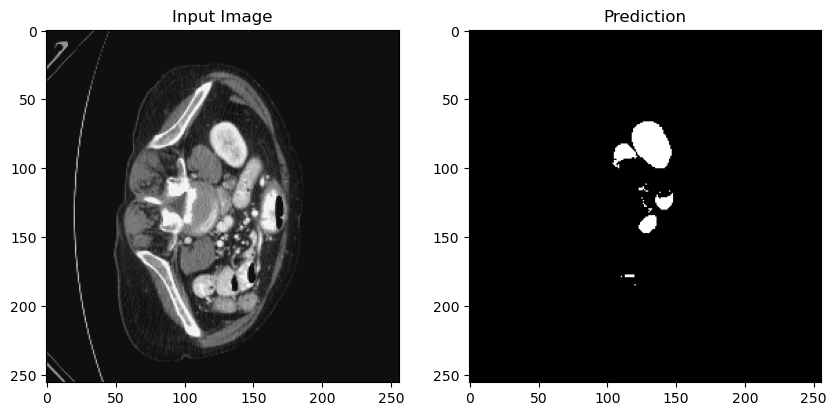

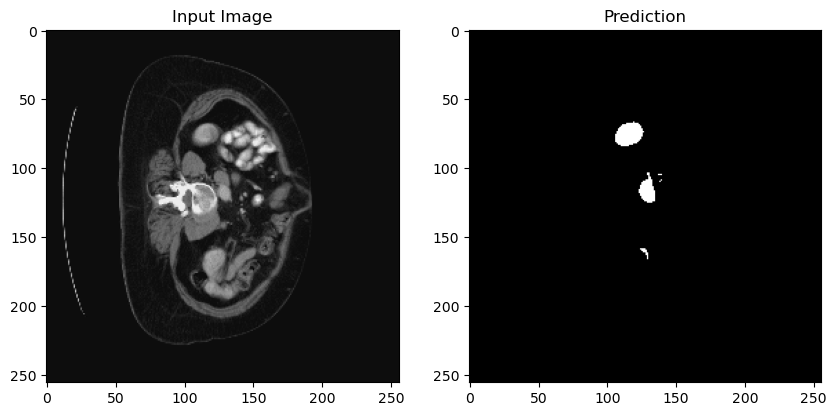

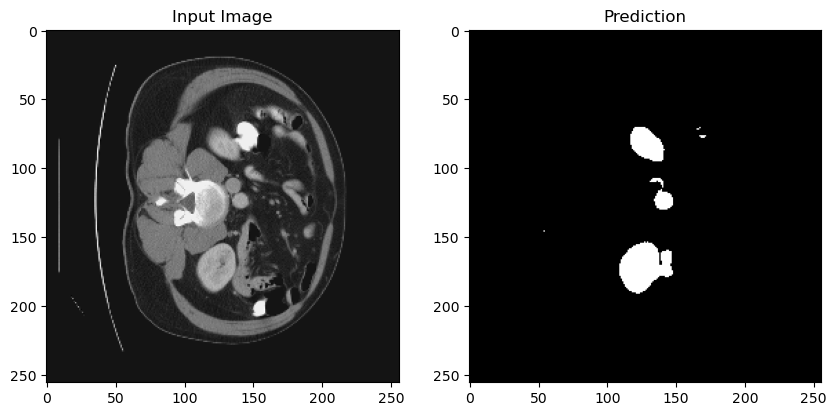

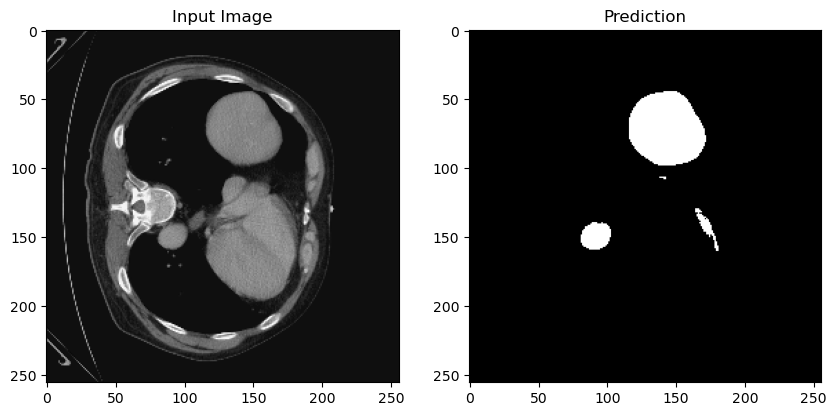

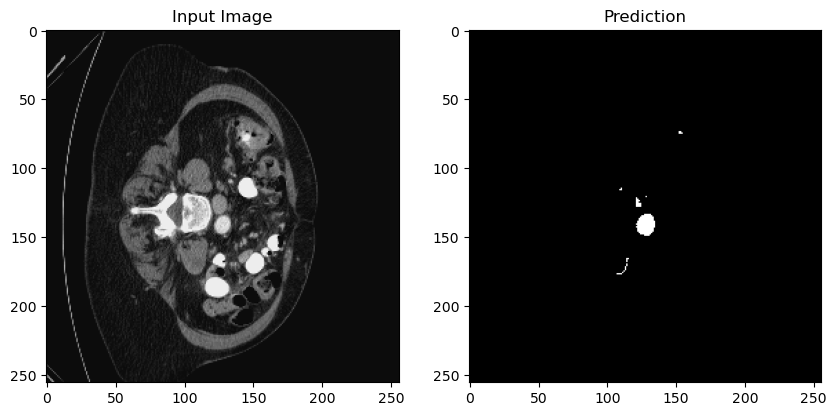

In [34]:
# Load your trained model
device = "cuda" if torch.cuda.is_available() else "cpu"
model = CAMModel(input_channels=1, num_classes=1).to(device)
model.load_state_dict(torch.load("cam_model_final.pth"))

# Directory to save predictions
save_results_dir = "/home/ec2-user/SageMaker/Abdomen/test_predictions"

# Run evaluation
evaluate_model(model, test_loader, device, save_results_dir)
visualize_predictions(model, test_loader, device, num_samples=5)



In [35]:
# Analyze prediction confidence
def analyze_confidence(model, test_loader, device):
    model.eval()
    confidences = []
    with torch.no_grad():
        for batch in test_loader:
            images = batch["image"].to(device).float()
            if images.ndim == 5:
                images = images.squeeze(2)

            outputs = model(images)
            probabilities = torch.sigmoid(outputs).cpu().numpy()
            confidences.append(np.mean(probabilities))
    avg_confidence = np.mean(confidences)
    print(f"Average prediction confidence: {avg_confidence:.4f}")

# Analyze confidence
analyze_confidence(model, test_loader, device)


Average prediction confidence: 0.4249


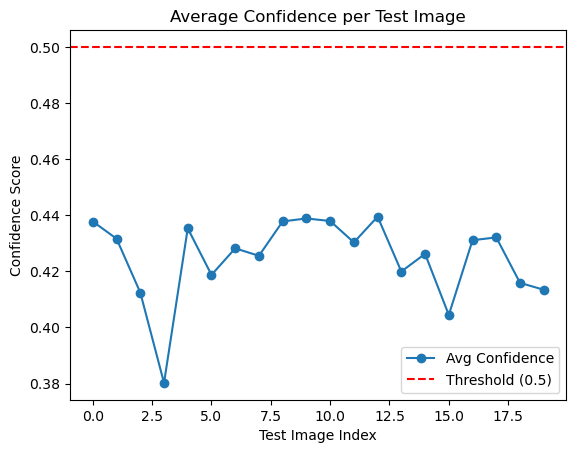

In [38]:
import matplotlib.pyplot as plt

def plot_average_confidence(test_loader, model, device):
    model.eval()
    confidences = []
    with torch.no_grad():
        for batch in test_loader:
            images = batch['image'].unsqueeze(1).to(device).float()  # Add channel dimension
            if images.ndim == 5:  # Check for an extra dimension
                images = images.squeeze(2)  # Remove the singleton dimension
            
            outputs = model(images)
            probs = torch.sigmoid(outputs)
            confidences.append(probs.mean().item())
    
    plt.plot(confidences, marker='o', linestyle='-', label='Avg Confidence')
    plt.axhline(y=0.5, color='r', linestyle='--', label='Threshold (0.5)')
    plt.xlabel('Test Image Index')
    plt.ylabel('Confidence Score')
    plt.title('Average Confidence per Test Image')
    plt.legend()
    plt.show()

# Call the function
plot_average_confidence(test_loader, model, device)



In [37]:
def plot_segmented_area(test_loader, model, device):
    model.eval()
    areas = []
    with torch.no_grad():
        for batch in test_loader:
            images = batch['image'].unsqueeze(1).to(device).float()
            outputs = model(images)
            predictions = (torch.sigmoid(outputs) > 0.5).cpu().numpy()
            areas.append(predictions.sum())  # Count white pixels as area

    plt.plot(areas, marker='o', linestyle='-', label='Segmented Area')
    plt.xlabel('Test Image Index')
    plt.ylabel('Segmented Area (pixels)')
    plt.title('Segmented Area per Test Image')
    plt.legend()
    plt.show()

# Call the function
plot_segmented_area(test_loader, model, device)


RuntimeError: Expected 3D (unbatched) or 4D (batched) input to conv2d, but got input of size: [1, 1, 1, 256, 256]